In [1]:
import glob
import warnings
import tarfile
import cv2

import keras
import keras.backend as K

from keras.models import Model, Sequential
from keras.layers import Dense, Dropout, Flatten, Input, LeakyReLU
from keras.layers import BatchNormalization, Activation, Conv2D
from keras.layers import GlobalAveragePooling2D, Lambda
from keras.optimizers import Adam, RMSprop

from keras.applications.xception import Xception
from keras.applications.xception import preprocess_input
from keras.preprocessing.image import ImageDataGenerator 
from keras.utils import to_categorical, Sequence
from keras.callbacks import ModelCheckpoint

from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import accuracy_score
from keras.models import load_model, model_from_json

import matplotlib.pyplot as plt

import os
import numpy as np
import pandas as pd
from PIL import Image
from cv2 import resize

import tensorflow as tf
from keras.applications import ResNet50
from keras import regularizers
import requests
import threading
import random
import time
import urllib
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from keras.utils import multi_gpu_model

from collections import Counter

%matplotlib inline

print('Keras version:', keras.__version__)
# print(os.listdir('SageMaker'))

warnings.simplefilter('default')
!pwd

Using TensorFlow backend.


Keras version: 2.2.4
/home/ec2-user/SageMaker


In [2]:
train_path = './data/landmarks/train/train/'
test_path = './data/landmarks/test/test/'
train_images = glob.glob(train_path+'*.jpg')
test_images = glob.glob(test_path+'*.jpg')
print(len(train_images))
print(len(test_images))
sample_submission = pd.read_csv('./data/landmarks/recognition_sample_submission.csv')
sample_submission.shape

4130318
112821


(117703, 2)

In [3]:
train_image_ids = [image_file.replace(
    '.jpg', '').replace(train_path, '') for image_file in train_images]

train_df = pd.DataFrame(index=list(range(0,len(train_image_ids))))
train_df['filename'] = pd.Series(train_images, index=list(range(0,len(train_image_ids))))
train_df['ids'] = train_image_ids
test_image_ids = [image_file.replace(
    '.jpg', '').replace(test_path, '') for image_file in test_images]
test_df = pd.DataFrame(index=list(range(0,len(test_image_ids))))
test_df['filename'] = pd.Series(test_images, index=list(range(0,len(test_image_ids))))
test_df['ids'] = test_image_ids

In [4]:
train = pd.read_csv("./data/train.csv",index_col='id')
print(train.head())
print(train.shape)
print("Number of classes {}".format(len(train.landmark_id.unique())))

NUM_THRESHOLD = 42

counts = dict(Counter(train['landmark_id']))
landmarks_dict = {x:[] for x in train.landmark_id.unique() if counts[x] >= NUM_THRESHOLD}
NUM_CLASSES = len(landmarks_dict)
print("Total number of valid classes: {}".format(NUM_CLASSES))

i = 0
landmark_to_idx = {}
idx_to_landmark = []
for k in landmarks_dict:
    landmark_to_idx[k] = i
    idx_to_landmark.append(k)
    i += 1
    
train['filename'] = pd.Series(train_images, index=train_image_ids)

train = train.dropna(axis=0)
print(train.isna().sum())

all_urls = train['url'].tolist()
all_filenames= train['filename'].tolist()
all_landmarks = train['landmark_id'].tolist()
valid_urls_dict = {x[0].split("/")[-1]:landmark_to_idx[x[1]] for x in zip(all_urls, all_landmarks) if x[1] in landmarks_dict}
valid_filenames_dict = {x[0].split('/')[-1]:landmark_to_idx[x[1]] for x in zip(all_filenames, all_landmarks) if x[1] in landmarks_dict}
valid_urls_list = [x[0] for x in zip(all_urls, all_landmarks) if x[1] in landmarks_dict]
valid_filenames_list = [x[0] for x in zip(all_filenames, all_landmarks) if x[1] in landmarks_dict]

NUM_EXAMPLES = len(valid_urls_list)
print("Total number of valid examples: {}".format(NUM_EXAMPLES))

                                                                url  \
id                                                                    
6e158a47eb2ca3f6  https://upload.wikimedia.org/wikipedia/commons...   
202cd79556f30760  http://upload.wikimedia.org/wikipedia/commons/...   
3ad87684c99c06e1  http://upload.wikimedia.org/wikipedia/commons/...   
e7f70e9c61e66af3  https://upload.wikimedia.org/wikipedia/commons...   
4072182eddd0100e  https://upload.wikimedia.org/wikipedia/commons...   

                  landmark_id  
id                             
6e158a47eb2ca3f6       142820  
202cd79556f30760       104169  
3ad87684c99c06e1        37914  
e7f70e9c61e66af3       102140  
4072182eddd0100e         2474  
(4132914, 2)
Number of classes 203094
Total number of valid classes: 23215
url            0
landmark_id    0
filename       0
dtype: int64
Total number of valid examples: 2296997


In [5]:
test_info_full = pd.read_csv('./data/test.csv', index_col='id')
test_info_full.head()

test_info = test_info_full.loc[test_image_ids]
test_info['filename'] = pd.Series(test_images, index=test_image_ids)

test_info.head()

,url,filename
id,,
fa8d5a81a16f2f2f,https://lh3.googleusercontent.com/-_SAJTBt3Y64...,./data/landmarks/test/test/fa8d5a81a16f2f2f.jpg
b81a0a45f9b1ee97,https://lh3.googleusercontent.com/-9sFSIOCzIOs...,./data/landmarks/test/test/b81a0a45f9b1ee97.jpg
570e28cc63fab858,https://lh3.googleusercontent.com/-7Eld7yUfAB0...,./data/landmarks/test/test/570e28cc63fab858.jpg
b8bc63608b5fef1a,https://lh3.googleusercontent.com/-JdgzGjeS9NE...,./data/landmarks/test/test/b8bc63608b5fef1a.jpg
54cfd1f5f683b966,https://lh3.googleusercontent.com/-krCM7YZ3FpU...,./data/landmarks/test/test/54cfd1f5f683b966.jpg


In [6]:
landmark_subsample = pd.read_csv('./data/topn_all_info.csv',index_col=['p0_landmark'])
landmark_subsample.head()

,filename,p0,p1,p2,p0_label,p1_label,p1_landmark,p2_label,p2_landmark,landmark_file,landmark_id
p0_landmark,,,,,,,,,,,
non-landmark,./landmarks/train/train/687c09f942938f4e.jpg,236,14,240,/m/museum/indoor,/a/archive,non-landmark,/n/nursery,non-landmark,687c09f942938f4e.jpg,198059
landmark,./landmarks/train/train/11704d4b86f8fe1a.jpg,309,76,234,/s/snowfield,/c/campsite,landmark,/m/mountain_snowy,landmark,11704d4b86f8fe1a.jpg,136542
non-landmark,./landmarks/train/train/67e34bedf25bd3d2.jpg,93,236,240,/c/clean_room,/m/museum/indoor,non-landmark,/n/nursery,non-landmark,67e34bedf25bd3d2.jpg,180256
landmark,./landmarks/train/train/05250fb79c967abb.jpg,190,187,186,/i/iceberg,/i/ice_shelf,landmark,/i/ice_floe,landmark,05250fb79c967abb.jpg,151989
landmark,./landmarks/train/train/ceb9fde5122403d6.jpg,296,183,107,/s/schoolhouse,/h/house,landmark,/c/cottage,landmark,ceb9fde5122403d6.jpg,151069


In [7]:
is_landmark = pd.read_csv('./data/confirmed_landmarks.csv')
is_landmark.head()

,p0_landmark,filename,landmark_id
0,landmark,./landmarks/train/train/11704d4b86f8fe1a.jpg,136542
1,landmark,./landmarks/train/train/05250fb79c967abb.jpg,151989
2,landmark,./landmarks/train/train/ceb9fde5122403d6.jpg,151069
3,landmark,./landmarks/train/train/ea63b03baf3073fa.jpg,64858
4,landmark,./landmarks/train/train/6ebaaa17fd934ab5.jpg,179389


In [8]:
not_landmark = pd.read_csv('./data/not_landmarks.csv')
not_landmark.head()

,p0_landmark,filename,landmark_id
0,non-landmark,./landmarks/train/train/687c09f942938f4e.jpg,198059
1,non-landmark,./landmarks/train/train/67e34bedf25bd3d2.jpg,180256
2,non-landmark,./landmarks/train/train/a07dd54e2b44e4d9.jpg,142367
3,non-landmark,./landmarks/train/train/a2b9ebee1790da61.jpg,58639
4,non-landmark,./landmarks/train/train/6fbbf834306edd36.jpg,56102


In [9]:
n_cat = 203094 #number of unique classes (yikes)
n_valid_classes = 23215
input_shape = (99,99)
batch_size = 48
batch_size_predict = 96

In [10]:
label_encoder = LabelEncoder()
one_hot_encoder = OneHotEncoder(sparse=True, n_values=n_cat)

train['label'] = label_encoder.fit_transform(train['landmark_id'].values)
train['one_hot'] = one_hot_encoder.fit_transform(
                    train['label'].values.reshape(-1, 1))

In [11]:
train['filename'][2]

'./data/landmarks/train/train/3ad87684c99c06e1.jpg'

In [12]:
t = tf.read_file(train['filename'][2])
d = tf.image.decode_jpeg(t)
r = tf.image.resize(d,[99,99])
r

<tf.Tensor 'resize/Squeeze:0' shape=(99, 99, ?) dtype=float32>

In [41]:
# tf example method
# def _read_py_function(filename, label):
    
#     img = cv2.imread(filename.decode(), cv2.IMREAD_GRAYSCALE)
    
#     return img, label

# # Use standard TensorFlow operations to resize the image to a fixed shape.
# def _resize_function(img, label):
#     img.set_shape([None, None, None])
#     image_resized = tf.image.resize_images(img, [99, 99])
#     return image_resized, label

# filenames = train['filename'].values
# labels = train['landmark_id'].values

# dataset = tf.data.Dataset.from_tensor_slices((filenames, labels))
# dataset = dataset.map(
#     lambda filename, label: tuple(tf.py_func(
#         _read_py_function, [filename, label], [tf.uint8, label.dtype])))
# dataset = dataset.map(_resize_function)

In [13]:
len(train)

4130318

In [14]:
# #
# #values[ind:(ind+batch_size)]
# batch_size = 32
# lmao = []
# for ind in range(0,len(train),batch_size):
#     lmao.append('d')

In [15]:
# len(lmao)

In [16]:
# info = train.sample(2000)
# batch_size=32
# def get_image_gen(info_arg, 
#                   shuffle=True, 
#                   image_aug=True, 
#                   eq_dist=False, 
#                   n_ref_imgs=16, 
#                   crop_prob=0.5, 
#                   crop_p=0.5):
#     if image_aug:
#         datagen = ImageDataGenerator(
#             rotation_range=4.,
#             width_shift_range=0.2,
#             height_shift_range=0.2,
#             shear_range=0.2,
#             zoom_range=0.5,
#             channel_shift_range=25,
#             horizontal_flip=True,
#             fill_mode='nearest')

#         if crop_prob > 0:
#             datagen_crop = ImageDataGenerator(
#                 rotation_range=4.,
#                 shear_range=0.2,
#                 zoom_range=0.1,
#                 channel_shift_range=20,
#                 horizontal_flip=True,
#                 fill_mode='nearest')
            
#     while True:
#         if eq_dist:
#             def sample(df):
#                 return df.sample(min(n_ref_imgs, len(df)))
#             info = info_arg.groupby('landmark_id', group_keys=False).apply(sample)
#         else:
#             info = info_arg
#         print('Generate', len(info), 'for the next round.')
        
#         if shuffle and count >= len(info):
#             info = info.sample(frac=1)
#             count = 0
        
#         for ind in range(0,len(info),batch_size):
#             count+=1
#             y = info['landmark_id'].values[ind:(ind+batch_size)]
            
#             if np.random.rand() < crop_prob:
#                 imgs = load_cropped_images(info.iloc[ind:(ind+batch_size)], 
#                                            crop_p=crop_p*np.random.rand() + 0.01, 
#                                            crop='random')
#                 if image_aug:
#                     cflow = datagen_crop.flow(imgs, 
#                                               y, 
#                                               batch_size=imgs.shape[0], 
#                                               shuffle=False)
#                     imgs, y = next(cflow)                    
#             else:
#                 imgs = load_images(info.iloc[ind:(ind+batch_size)])
#                 if image_aug:
#                     cflow = datagen.flow(imgs, 
#                                        y, 
#                                        batch_size=imgs.shape[0], 
#                                        shuffle=False)
#                     imgs, y = next(cflow)             
           
#                 imgs = preprocess_input(imgs)

#                 y_l = label_encoder.transform(y[y>=0.])        
#                 y_oh = np.zeros((len(y), n_cat))
#                 y_oh[y >= 0., :] = one_hot_encoder.transform(y_l.reshape(-1,1)).todense()

#                 yield imgs, y_oh


# train_gen = get_image_gen(train, 
#                           eq_dist=True, 
#                           n_ref_imgs=512, 
#                           crop_prob=0.5, 
#                           crop_p=0.5) 
# print(train_gen)

In [17]:
# type(train_gen)

In [18]:
def load_images(info, input_shape = input_shape):
    input_shape = tuple(input_shape)
    imgs = np.zeros((len(info), input_shape[0], input_shape[1], 3))

    for i in range(len(info)):
        fname = info.iloc[i]['filename']
        try:
            img = cv2.cvtColor(
                  cv2.resize(cv2.imread(fname),input_shape),
                  cv2.COLOR_BGR2RGB)
        except:
            warnings.warn('Warning: could not read image: '+ fname +
                          '. Use black img instead.')
            img = np.zeros((input_shape[0], input_shape[1], 3))
        imgs[i,:,:,:] = img
    
    return imgs
def load_cropped_images(info, crop_p=0.2, crop='random'):
    new_res = np.array([int(input_shape[0]*(1+crop_p)), int(input_shape[1]*(1+crop_p))])
    if crop == 'random':
        cx0 = np.random.randint(new_res[0] - input_shape[0], size=len(info))
        cy0 = np.random.randint(new_res[1] - input_shape[1], size=len(info))
    else:
        if crop == 'central':
            cx0, cy0 = (new_res - input_shape) // 2                
        if crop == 'upper left':
            cx0, cy0 = 0, 0
        if crop == 'upper right':
            cx0, cy0 = new_res[1] - input_shape[1], 0
        if crop == 'lower left':
            cx0, cy0 = 0, new_res[0] - input_shape[0]
        if crop=='lower right':
            cx0, cy0 = new_res - input_shape        
        cx0 = np.repeat(np.expand_dims(cx0, 0), len(info))
        cy0 = np.repeat(np.expand_dims(cy0, 0), len(info))

    cx1 = cx0 + input_shape[0]
    cy1 = cy0 + input_shape[1]
    
    raw_imgs = load_images(info, input_shape=tuple(new_res))
    
    cropped_imgs = np.zeros((len(info), input_shape[0], input_shape[1], 3))
    for ind in range(len(info)):
        cropped_imgs[ind,:,:,:] = raw_imgs[ind,
                                           cy0[ind]:cy1[ind],
                                           cx0[ind]:cx1[ind], :]
    
    return cropped_imgs


def get_image_gen(info_arg, 
                  shuffle=True, 
                  image_aug=True, 
                  eq_dist=False, 
                  n_ref_imgs=16, 
                  crop_prob=0.5, 
                  crop_p=0.5):
    if image_aug:
        datagen = ImageDataGenerator(
            rotation_range=4.,
            width_shift_range=0.2,
            height_shift_range=0.2,
            shear_range=0.2,
            zoom_range=0.5,
            channel_shift_range=25,
            horizontal_flip=True,
            fill_mode='nearest')
        
        if crop_prob > 0:
            datagen_crop = ImageDataGenerator(
                rotation_range=4.,
                shear_range=0.2,
                zoom_range=0.1,
                channel_shift_range=20,
                horizontal_flip=True,
                fill_mode='nearest')
        
    count = len(info_arg)
    while True:
        if eq_dist:
            def sample(df):
                return df.sample(min(n_ref_imgs, len(df)))
            info = info_arg.groupby('landmark_id', group_keys=False).apply(sample)
        else:
            info = info_arg
        print('Generate', len(info), 'for the next round.')
        
        #shuffle data
        if shuffle and count >= len(info):
            info = info.sample(frac=1)
            count = 0
            
        # load images
        for ind in range(0,len(info), batch_size):
            count += batch_size

            y = info['landmark_id'].values[ind:(ind+batch_size)]
            
            if np.random.rand() < crop_prob:
                imgs = load_cropped_images(info.iloc[ind:(ind+batch_size)], 
                                           crop_p=crop_p*np.random.rand() + 0.01, 
                                           crop='random')
                if image_aug:
                    cflow = datagen_crop.flow(imgs, 
                                              y, 
                                              batch_size=imgs.shape[0], 
                                              shuffle=False)
                    imgs, y = next(cflow)                    
            else:
                imgs = load_images(info.iloc[ind:(ind+batch_size)])
                if image_aug:
                    cflow = datagen.flow(imgs, 
                                       y, 
                                       batch_size=imgs.shape[0], 
                                       shuffle=False)
                    imgs, y = next(cflow)             

            imgs = preprocess_input(imgs)
    
            y_l = label_encoder.transform(y[y>=0.])        
            y_oh = np.zeros((len(y), n_cat))
            y_oh[y >= 0., :] = one_hot_encoder.transform(y_l.reshape(-1,1)).todense()
                    
            yield imgs, y_oh
            
train_gen = get_image_gen(train, 
                          eq_dist=True, 
                          n_ref_imgs=512, 
                          crop_prob=0.3, 
                          crop_p=0.5)

In [19]:
import argparse
import glob
import sys
import pickle

import cv2

import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd

from scipy.spatial import cKDTree
from skimage.feature import plot_matches
from skimage.measure import ransac
from skimage.transform import AffineTransform

import tensorflow as tf
import tensorflow_hub as hub

from tensorflow.python.platform import app

/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  return f(*args, **kwds)
W0517 13:56:38.279542 139638796375872 __init__.py:56] Some hub symbols are not available because TensorFlow version is less than 1.14


Landmark_id of image ./data/landmarks/train/train/2b54de74c01bd09a.jpg : 125017
203093


(176, 256, 3)

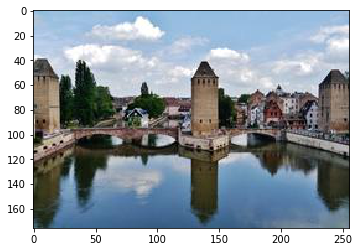

In [20]:
print("Landmark_id of image", train_images[0], ":", 
      train.loc[train_image_ids[0]]['landmark_id'])
print(train["landmark_id"].max())
testimg = cv2.cvtColor(cv2.imread(np.random.choice(train_images)), 
                     cv2.COLOR_BGR2RGB)
plt.imshow(testimg)
testimg.shape

In [21]:
def get_delf_features(info, odir, start_i=0):
    def image_input_fn():
        filename_queue = tf.train.string_input_producer(
          info['filename'].values.tolist(), shuffle=False)
        reader = tf.WholeFileReader()
        _, value = reader.read(filename_queue)
        image_tf_raw = tf.image.decode_jpeg(value, channels=3)
        image_tf = tf.image.resize_images(image_tf_raw, [99, 99])
        return tf.image.convert_image_dtype(image_tf, tf.float32)
    
    tf.reset_default_graph()
    tf.logging.set_verbosity(tf.logging.FATAL)

    m = hub.Module('https://tfhub.dev/google/delf/1')

    # The module operates on a single image at a time, so define a placeholder to
    # feed an arbitrary image in.
    image_placeholder = tf.placeholder(
        tf.float32, shape=(input_shape[0], input_shape[1], 3), name='input_image')

    module_inputs = {
        'image': image_placeholder,
        'score_threshold': 100.0,
        'image_scales': [0.25, 0.3536, 0.5, 0.7071, 1.0, 1.4142, 2.0],
        'max_feature_num': 1000,
    }

    module_outputs = m(module_inputs, as_dict=True)

    with tf.Session() as sess:        
        sess.run(tf.global_variables_initializer())
        for i in range(start_i,len(info)):
            fname = info.iloc[i]['filename']
            img_id = info.index[i]
            print(fname, 'being worked')
            try:
                img = cv2.cvtColor(
                      cv2.resize(cv2.imread(fname),input_shape),
                      cv2.COLOR_BGR2RGB) / 255.
            except:
                warnings.warn('Warning: could not read image: ' 
                              + fname +
                              '. Use black img instead.')
                img = np.zeros((input_shape[0], input_shape[1], 3), dtype=np.float32)
                
            locations, descriptions = sess.run(
                [module_outputs['locations'],  module_outputs['descriptors']],
                feed_dict={image_placeholder: img})
            if i % 100 == 0:
                print(i, '/', len(info))
                np.savetxt(odir + 'last_i.txt', np.array([i]))
            
            np.save(odir + img_id + '_loc.npy', locations)
            np.save(odir + img_id + '_desc.npy', descriptions)

In [52]:
# n_ref_imgs = 256
# def sample(df):
#     return df.sample(min(n_ref_imgs,len(df)))
# train_info_r=train.groupby('landmark_id', group_keys=False).apply(sample)
# print(len(train_info_r))
# train_info_r.to_csv('train_info_r_sample_1.csv')

In [ ]:
train_r = pd.read_csv('train_info_r_sample_1.csv',index_col='id')
get_delf_features(train_r, 'delf-train/', start_i=0)
print('Done with Train..')

./data/landmarks/train/train/71acd239a18695a1.jpg being worked
0 / 443666
./data/landmarks/train/train/0052fab157ef0378.jpg being worked
./data/landmarks/train/train/99548bc883ead483.jpg being worked
./data/landmarks/train/train/85088f9acf8d13bc.jpg being worked
./data/landmarks/train/train/0ddc92c6353c019a.jpg being worked
./data/landmarks/train/train/d9c0071a6f892432.jpg being worked
./data/landmarks/train/train/b5d8eb502833a58c.jpg being worked
./data/landmarks/train/train/5609f0974fa920a1.jpg being worked
./data/landmarks/train/train/c06860c64d97034b.jpg being worked
./data/landmarks/train/train/0a9bd6a52069691b.jpg being worked
./data/landmarks/train/train/62b7acc90ded9ce5.jpg being worked
./data/landmarks/train/train/8a80dbb49ccb966d.jpg being worked
./data/landmarks/train/train/9e3d408b4c02abaf.jpg being worked
./data/landmarks/train/train/26e829f30f657d0c.jpg being worked
./data/landmarks/train/train/5cfe325fe4b4e2de.jpg being worked
./data/landmarks/train/train/f446252288954ca

./data/landmarks/train/train/28267d88d4d9ea30.jpg being worked
./data/landmarks/train/train/b88fc57ed9ee91c8.jpg being worked
./data/landmarks/train/train/3921a21eec78a5ae.jpg being worked
./data/landmarks/train/train/e75cc529d7dc7506.jpg being worked
./data/landmarks/train/train/d65590bff58747b2.jpg being worked
./data/landmarks/train/train/1441b71ca0e1adad.jpg being worked
./data/landmarks/train/train/904efd09f3536f0e.jpg being worked
./data/landmarks/train/train/700ffc808fb83655.jpg being worked
./data/landmarks/train/train/31b5efa96e42bd33.jpg being worked
./data/landmarks/train/train/eabb3f9976ebadc8.jpg being worked
./data/landmarks/train/train/98414392eb750368.jpg being worked
./data/landmarks/train/train/75c78c4aa2ecbe78.jpg being worked
./data/landmarks/train/train/90c2bfa1347f04c8.jpg being worked
./data/landmarks/train/train/f417bac6d0ad290f.jpg being worked
./data/landmarks/train/train/9156fef236a57954.jpg being worked
./data/landmarks/train/train/0855f8e5df11e8ee.jpg being

./data/landmarks/train/train/44247d3185b0b243.jpg being worked
./data/landmarks/train/train/2397d338536de025.jpg being worked
./data/landmarks/train/train/5a180e2a1197a04d.jpg being worked
./data/landmarks/train/train/676a14120c408663.jpg being worked
./data/landmarks/train/train/c9b54a1b1e8bfb45.jpg being worked
./data/landmarks/train/train/7ae034ff6db67b91.jpg being worked
./data/landmarks/train/train/ad1a9485c8964653.jpg being worked
./data/landmarks/train/train/a1336df24de36f2e.jpg being worked
./data/landmarks/train/train/887a8fad4c8d1973.jpg being worked
./data/landmarks/train/train/ce67e0d2fec3d450.jpg being worked
./data/landmarks/train/train/b239bd61b127ea35.jpg being worked
./data/landmarks/train/train/f5b120d9843147f6.jpg being worked
./data/landmarks/train/train/252cef0cafe203ff.jpg being worked
./data/landmarks/train/train/ca9a2835337085f5.jpg being worked
./data/landmarks/train/train/fd5f5a4216b98504.jpg being worked
./data/landmarks/train/train/260c086a55d41dae.jpg being

./data/landmarks/train/train/7bf42aa349ba51cc.jpg being worked
./data/landmarks/train/train/f4745d4f9bdb12d4.jpg being worked
./data/landmarks/train/train/fa2855a666e85d4f.jpg being worked
./data/landmarks/train/train/ca2752ef82398e4b.jpg being worked
./data/landmarks/train/train/0c549b30bf9afb28.jpg being worked
./data/landmarks/train/train/d4bfd42ea4ade985.jpg being worked
./data/landmarks/train/train/7571e87430ab196b.jpg being worked
./data/landmarks/train/train/279c30e7975c8483.jpg being worked
./data/landmarks/train/train/49e34fa6b58c6402.jpg being worked
./data/landmarks/train/train/8b5c7979ebe2c89b.jpg being worked
400 / 443666
./data/landmarks/train/train/532c44cbf91b1f05.jpg being worked
./data/landmarks/train/train/e9be54e456e937a7.jpg being worked
./data/landmarks/train/train/47b96c19b9f92980.jpg being worked
./data/landmarks/train/train/1fe5228e28856899.jpg being worked
./data/landmarks/train/train/fbc3a38cc72bfae1.jpg being worked
./data/landmarks/train/train/dd204022b75cb

./data/landmarks/train/train/9edece7a18f8b6dd.jpg being worked
./data/landmarks/train/train/5b381024c05be0e6.jpg being worked
./data/landmarks/train/train/067f2d8ea47a5161.jpg being worked
./data/landmarks/train/train/3c1d7c805637fab9.jpg being worked
./data/landmarks/train/train/2eb5bb43c1e8dd75.jpg being worked
./data/landmarks/train/train/0ef5577a8df204b5.jpg being worked
./data/landmarks/train/train/ca613db36bd84df4.jpg being worked
./data/landmarks/train/train/a764f743a3a0b02e.jpg being worked
./data/landmarks/train/train/9c956665f5e43f10.jpg being worked
./data/landmarks/train/train/e7b807927cb6d60c.jpg being worked
./data/landmarks/train/train/afe88a1f9174217c.jpg being worked
./data/landmarks/train/train/a7e19c85e6354442.jpg being worked
./data/landmarks/train/train/33212fce2e8ddef4.jpg being worked
./data/landmarks/train/train/a2304b26cdee1988.jpg being worked
./data/landmarks/train/train/3b13dc435759205c.jpg being worked
./data/landmarks/train/train/2e3b25675c792bfc.jpg being

./data/landmarks/train/train/93c8b411cb4954b3.jpg being worked
./data/landmarks/train/train/53ee441a657c337f.jpg being worked
./data/landmarks/train/train/038450020a8c3338.jpg being worked
./data/landmarks/train/train/ae49ba8c852e34c2.jpg being worked
./data/landmarks/train/train/a0818e1222c8f95b.jpg being worked
./data/landmarks/train/train/a65a0edc9f929d38.jpg being worked
./data/landmarks/train/train/117569211b0e5a92.jpg being worked
./data/landmarks/train/train/c6e05f7e7ef1bf97.jpg being worked
./data/landmarks/train/train/94a3aff38613582b.jpg being worked
./data/landmarks/train/train/0ff3891dfb6ec963.jpg being worked
./data/landmarks/train/train/2a0d989678ce1271.jpg being worked
./data/landmarks/train/train/c843235e752753bd.jpg being worked
./data/landmarks/train/train/b60ba2bd35f7bf51.jpg being worked
./data/landmarks/train/train/734a409c0b2e3904.jpg being worked
./data/landmarks/train/train/28dcda4ef8356310.jpg being worked
./data/landmarks/train/train/889f47fe14a7dd48.jpg being

./data/landmarks/train/train/8a1745da51deb16c.jpg being worked
./data/landmarks/train/train/809d73a2ea9e637d.jpg being worked
./data/landmarks/train/train/148f0c5f96f065ec.jpg being worked
./data/landmarks/train/train/2ad708da5c7538e1.jpg being worked
./data/landmarks/train/train/22534b768f2291e1.jpg being worked
./data/landmarks/train/train/d32c69e6b5e58e56.jpg being worked
./data/landmarks/train/train/f0e0967845fdc9bf.jpg being worked
./data/landmarks/train/train/26c74098d2b7f3e5.jpg being worked
./data/landmarks/train/train/55153a9094778009.jpg being worked
./data/landmarks/train/train/92841bca5b160766.jpg being worked
./data/landmarks/train/train/77b8d7d5fcedabef.jpg being worked
./data/landmarks/train/train/3533e9c032def9ab.jpg being worked
./data/landmarks/train/train/af90aacf48af3ded.jpg being worked
./data/landmarks/train/train/0e3d48fc15544946.jpg being worked
./data/landmarks/train/train/fffb9b863c33bea4.jpg being worked
./data/landmarks/train/train/0d920307064d9e9d.jpg being

./data/landmarks/train/train/1bcf03a55ff8a935.jpg being worked
./data/landmarks/train/train/3b809ad2efeeb2fa.jpg being worked
./data/landmarks/train/train/b4042adaff7b00f8.jpg being worked
./data/landmarks/train/train/e0fc912ba7c298d9.jpg being worked
./data/landmarks/train/train/b5a6ea1ec687bd67.jpg being worked
./data/landmarks/train/train/35a51fa09d087788.jpg being worked
./data/landmarks/train/train/24168a7ee585640a.jpg being worked
./data/landmarks/train/train/58c5aa3b91c285a7.jpg being worked
./data/landmarks/train/train/637496c0c44c9799.jpg being worked
./data/landmarks/train/train/ca6006de05360a6e.jpg being worked
./data/landmarks/train/train/66b55de9817587ad.jpg being worked
./data/landmarks/train/train/26669965d996a5b2.jpg being worked
./data/landmarks/train/train/78f4e1683a756ce2.jpg being worked
./data/landmarks/train/train/7938f1e35b2149c3.jpg being worked
./data/landmarks/train/train/a3bdc2d71567ccc0.jpg being worked
./data/landmarks/train/train/085fbbe00aee8348.jpg being

./data/landmarks/train/train/0a04fa797a67477f.jpg being worked
./data/landmarks/train/train/5e9c18591a674155.jpg being worked
./data/landmarks/train/train/a4828af49d115c00.jpg being worked
./data/landmarks/train/train/faa70830ad990daa.jpg being worked
./data/landmarks/train/train/d78647404c40cb60.jpg being worked
./data/landmarks/train/train/c1c5087195cd332e.jpg being worked
./data/landmarks/train/train/dedba95eb7224ae3.jpg being worked
./data/landmarks/train/train/29ea04d3fc0e554a.jpg being worked
./data/landmarks/train/train/1f2fe7fd52861a09.jpg being worked
./data/landmarks/train/train/74770090457cd3a9.jpg being worked
./data/landmarks/train/train/9a8af247493b638c.jpg being worked
./data/landmarks/train/train/7c3b4df92fcf9c0b.jpg being worked
./data/landmarks/train/train/88a43846f25252ab.jpg being worked
./data/landmarks/train/train/6978eb42200a869b.jpg being worked
./data/landmarks/train/train/171a090129e61d76.jpg being worked
./data/landmarks/train/train/b936f45791a75ea8.jpg being

./data/landmarks/train/train/7d71ea314ba0fb41.jpg being worked
./data/landmarks/train/train/644f3bd7106328d9.jpg being worked
./data/landmarks/train/train/e5311cfb55fa1a56.jpg being worked
./data/landmarks/train/train/c399df34d8111ed3.jpg being worked
./data/landmarks/train/train/7953eac377b8e942.jpg being worked
./data/landmarks/train/train/5070083040470d69.jpg being worked
./data/landmarks/train/train/57b112dd6f5d7657.jpg being worked
./data/landmarks/train/train/534f56bcbe6b3e3e.jpg being worked
./data/landmarks/train/train/73296562cf2efdbe.jpg being worked
./data/landmarks/train/train/adb56d212384bf4f.jpg being worked
./data/landmarks/train/train/fde12f6834ae4eb5.jpg being worked
./data/landmarks/train/train/8e54c7b8631fb898.jpg being worked
./data/landmarks/train/train/80690bf7243f849c.jpg being worked
./data/landmarks/train/train/2ebee3d83333b7e0.jpg being worked
./data/landmarks/train/train/c75f06a914b46f39.jpg being worked
./data/landmarks/train/train/606026390c30f5ac.jpg being

./data/landmarks/train/train/0cd9d09002245399.jpg being worked
./data/landmarks/train/train/4033acb8f42b4661.jpg being worked
./data/landmarks/train/train/f424b01cc6180fbc.jpg being worked
./data/landmarks/train/train/ea0e39190af7eaa3.jpg being worked
./data/landmarks/train/train/1fac1cd8fb598307.jpg being worked
./data/landmarks/train/train/498a5729666c00da.jpg being worked
./data/landmarks/train/train/322ece75954abb67.jpg being worked
./data/landmarks/train/train/6c2cad5247d53c47.jpg being worked
./data/landmarks/train/train/de97426ae2d02339.jpg being worked
./data/landmarks/train/train/c5facf49589a8bb3.jpg being worked
./data/landmarks/train/train/6abeffa5146b241c.jpg being worked
./data/landmarks/train/train/8048814dbdca3ec1.jpg being worked
./data/landmarks/train/train/1a05a187fac363e2.jpg being worked
./data/landmarks/train/train/3c308387343d789c.jpg being worked
./data/landmarks/train/train/bdf56ec083120f71.jpg being worked
./data/landmarks/train/train/0bb575688894cc79.jpg being

./data/landmarks/train/train/36848b90cb478d10.jpg being worked
./data/landmarks/train/train/482737829c27b652.jpg being worked
./data/landmarks/train/train/a087a755fc35bcd8.jpg being worked
./data/landmarks/train/train/28fbf39dfb775509.jpg being worked
./data/landmarks/train/train/f79338facc1d8a64.jpg being worked
./data/landmarks/train/train/db830f68063abdf2.jpg being worked
./data/landmarks/train/train/5a42b3d6a74632f1.jpg being worked
./data/landmarks/train/train/3d94eac710456109.jpg being worked
./data/landmarks/train/train/c113b7acd710b9eb.jpg being worked
./data/landmarks/train/train/1e657a8803907120.jpg being worked
./data/landmarks/train/train/3d8509dadae5750a.jpg being worked
./data/landmarks/train/train/81335ff9aa78a010.jpg being worked
./data/landmarks/train/train/46dc8130a315f2a6.jpg being worked
./data/landmarks/train/train/41e24ab34f369d88.jpg being worked
./data/landmarks/train/train/d7d216e7e1bd8a1e.jpg being worked
./data/landmarks/train/train/fc17b0ec3b092035.jpg being

./data/landmarks/train/train/badba751bb17f97f.jpg being worked
./data/landmarks/train/train/f587a71c3cbe8f05.jpg being worked
./data/landmarks/train/train/ecd77f5d3a7e6b8a.jpg being worked
./data/landmarks/train/train/d7c59af6a76c194d.jpg being worked
./data/landmarks/train/train/b7ef58a9e1763bd3.jpg being worked
./data/landmarks/train/train/52b7310d3a581e2d.jpg being worked
./data/landmarks/train/train/dfa71696b9c23ec4.jpg being worked
./data/landmarks/train/train/738bc6a0bde9fba2.jpg being worked
./data/landmarks/train/train/4be17023914cfb59.jpg being worked
./data/landmarks/train/train/f398c373bcf49d0d.jpg being worked
./data/landmarks/train/train/73a6dd8f879263cc.jpg being worked
./data/landmarks/train/train/5a6e07045c040f02.jpg being worked
./data/landmarks/train/train/1402a23b79af6e91.jpg being worked
./data/landmarks/train/train/77082546c9e3684b.jpg being worked
./data/landmarks/train/train/d292043c9efa9317.jpg being worked
./data/landmarks/train/train/f5ac27d4dfb11b3e.jpg being

./data/landmarks/train/train/52f67284d8324571.jpg being worked
./data/landmarks/train/train/cfc49d8e27236649.jpg being worked
./data/landmarks/train/train/b4cf824ced91fdc7.jpg being worked
./data/landmarks/train/train/8a1a775fd60eeaac.jpg being worked
./data/landmarks/train/train/352983f60b53b976.jpg being worked
./data/landmarks/train/train/67fcbe0f6e8a6c6e.jpg being worked
1700 / 443666
./data/landmarks/train/train/23cfb816cfdfebe9.jpg being worked
./data/landmarks/train/train/312494f0f5c3456c.jpg being worked
./data/landmarks/train/train/d3629b5d52de3a77.jpg being worked
./data/landmarks/train/train/38fd3358afa55cf4.jpg being worked
./data/landmarks/train/train/01d6ca82c30622b0.jpg being worked
./data/landmarks/train/train/e405485bbf5d2531.jpg being worked
./data/landmarks/train/train/0a638124b001247d.jpg being worked
./data/landmarks/train/train/5eab691300b1bac7.jpg being worked
./data/landmarks/train/train/ff80744558569a9a.jpg being worked
./data/landmarks/train/train/0c2df583d909

./data/landmarks/train/train/e0145d2796958f4a.jpg being worked
./data/landmarks/train/train/1eabd249a553256b.jpg being worked
./data/landmarks/train/train/d63c45f8fd57ed83.jpg being worked
./data/landmarks/train/train/ba0d2aa0bfd55987.jpg being worked
./data/landmarks/train/train/b42677382e0c6d9c.jpg being worked
./data/landmarks/train/train/7dd1a98777aa401a.jpg being worked
./data/landmarks/train/train/93e73f4d3eb60a59.jpg being worked
./data/landmarks/train/train/e6c7b7d6fbec51de.jpg being worked
./data/landmarks/train/train/b9c0c8f4293c26d6.jpg being worked
./data/landmarks/train/train/1437a17f7807b1aa.jpg being worked
./data/landmarks/train/train/28bf5bfccfb5bcf5.jpg being worked
./data/landmarks/train/train/d07077a9e392ca7f.jpg being worked
./data/landmarks/train/train/e8d7d2e07c04a23e.jpg being worked
./data/landmarks/train/train/c4a48d040b01ca78.jpg being worked
./data/landmarks/train/train/0cfb370f0ab4e12a.jpg being worked
./data/landmarks/train/train/dfa83788079fc2b4.jpg being

./data/landmarks/train/train/8730edc6500ee76f.jpg being worked
./data/landmarks/train/train/1afbc079419e4855.jpg being worked
./data/landmarks/train/train/0407048e4686afa8.jpg being worked
./data/landmarks/train/train/582c7eeb90aa3806.jpg being worked
./data/landmarks/train/train/11531796b70a9506.jpg being worked
./data/landmarks/train/train/6d4315fae1facd1e.jpg being worked
./data/landmarks/train/train/c215ebee001e19cb.jpg being worked
./data/landmarks/train/train/c295249ffeb122cb.jpg being worked
./data/landmarks/train/train/e01b767aaf7bdd9b.jpg being worked
./data/landmarks/train/train/c270223288e8e64c.jpg being worked
./data/landmarks/train/train/33432b09b46bef34.jpg being worked
./data/landmarks/train/train/12db53b481f5adf5.jpg being worked
./data/landmarks/train/train/d1b3fd9d760768b2.jpg being worked
./data/landmarks/train/train/90b9d2de19452d58.jpg being worked
./data/landmarks/train/train/82d25bee204d0fe2.jpg being worked
./data/landmarks/train/train/b37fcd0c3c00fcea.jpg being

./data/landmarks/train/train/ae25a549dfbeb976.jpg being worked
./data/landmarks/train/train/ed12788b4af840e0.jpg being worked
./data/landmarks/train/train/e6199a23d4f8e3ee.jpg being worked
./data/landmarks/train/train/aacedb5ccfe297ba.jpg being worked
./data/landmarks/train/train/c2f8890ac67ec99f.jpg being worked
./data/landmarks/train/train/706a49c733623b5a.jpg being worked
./data/landmarks/train/train/c166df28f2623205.jpg being worked
./data/landmarks/train/train/00e9003a381ab809.jpg being worked
./data/landmarks/train/train/ebdeb533149c6f12.jpg being worked
./data/landmarks/train/train/33070564b076c39f.jpg being worked
./data/landmarks/train/train/fb2452dae2af78ae.jpg being worked
./data/landmarks/train/train/83533c1f29cffed7.jpg being worked
./data/landmarks/train/train/7691338232dd7c0f.jpg being worked
./data/landmarks/train/train/0743f88112d46ede.jpg being worked
./data/landmarks/train/train/e7000aef54d009d3.jpg being worked
2100 / 443666
./data/landmarks/train/train/6ce86352b9e7

./data/landmarks/train/train/3b59572983c6479c.jpg being worked
./data/landmarks/train/train/8d9ed7500c0658c3.jpg being worked
./data/landmarks/train/train/e306d66deb4682bc.jpg being worked
./data/landmarks/train/train/e945de8e1f4d1cb1.jpg being worked
./data/landmarks/train/train/1f425439bfeec5b0.jpg being worked
./data/landmarks/train/train/3ac1390739d746cd.jpg being worked
./data/landmarks/train/train/066521b7e66692a3.jpg being worked
./data/landmarks/train/train/2c5e7d89e552ac23.jpg being worked
./data/landmarks/train/train/2ecaa77d9d36cfcb.jpg being worked
./data/landmarks/train/train/2d35439dd014eebc.jpg being worked
./data/landmarks/train/train/a8c1a5da361aaae8.jpg being worked
./data/landmarks/train/train/ee1ebecd1fba6a48.jpg being worked
./data/landmarks/train/train/00024ea6140f4221.jpg being worked
./data/landmarks/train/train/b6fe13c824f7b75b.jpg being worked
./data/landmarks/train/train/ac28fbe6200d931b.jpg being worked
./data/landmarks/train/train/ae051285c3de3039.jpg being

./data/landmarks/train/train/98b294598e5f6369.jpg being worked
./data/landmarks/train/train/ea70ab88f2a55208.jpg being worked
./data/landmarks/train/train/48f17e53801015e7.jpg being worked
./data/landmarks/train/train/c438c254d43e4d8b.jpg being worked
./data/landmarks/train/train/23eee34b767332f9.jpg being worked
./data/landmarks/train/train/cc18bfec8cf203fd.jpg being worked
./data/landmarks/train/train/dc7206cade2e9347.jpg being worked
./data/landmarks/train/train/0b9f525440ae47c9.jpg being worked
./data/landmarks/train/train/be534399ee1efb9c.jpg being worked
./data/landmarks/train/train/a341c09768f688b0.jpg being worked
./data/landmarks/train/train/7888202537d1cb00.jpg being worked
./data/landmarks/train/train/3821997d8e69b5df.jpg being worked
./data/landmarks/train/train/77d9f50f1f6bafb6.jpg being worked
./data/landmarks/train/train/12f888f514bc6326.jpg being worked
./data/landmarks/train/train/5568239f50042199.jpg being worked
./data/landmarks/train/train/5f393b795068140a.jpg being

./data/landmarks/train/train/80367bce6e249d6e.jpg being worked
./data/landmarks/train/train/31d06fada30e7e62.jpg being worked
./data/landmarks/train/train/ec87786e3e4c9fb7.jpg being worked
./data/landmarks/train/train/8ebcbd3e6b0c85dd.jpg being worked
./data/landmarks/train/train/18ebcbc79b82de57.jpg being worked
./data/landmarks/train/train/89ebd35cb9c783a9.jpg being worked
./data/landmarks/train/train/2c69b3f04703c41f.jpg being worked
./data/landmarks/train/train/f7ad9d26164c4b7e.jpg being worked
./data/landmarks/train/train/8dd3cb2859723bfb.jpg being worked
./data/landmarks/train/train/dd24e42f65775399.jpg being worked
./data/landmarks/train/train/6523c6811eeb2bbb.jpg being worked
./data/landmarks/train/train/8ce99881bdb6d24d.jpg being worked
./data/landmarks/train/train/2e70c32ed3c0473f.jpg being worked
./data/landmarks/train/train/198c05f05fecfd62.jpg being worked
./data/landmarks/train/train/06d3a8d8d1c97d39.jpg being worked
./data/landmarks/train/train/68fecd0c3e647796.jpg being

./data/landmarks/train/train/e1573965e08bb0fe.jpg being worked
./data/landmarks/train/train/6bb1c4676d3ec989.jpg being worked
./data/landmarks/train/train/a8fbf5fb133d860a.jpg being worked
./data/landmarks/train/train/9cb2162f341b90e1.jpg being worked
./data/landmarks/train/train/5091ac321498cef7.jpg being worked
./data/landmarks/train/train/8dd2cac464bf8361.jpg being worked
./data/landmarks/train/train/b18e97d05b8c5683.jpg being worked
./data/landmarks/train/train/fbee7b25cc3587eb.jpg being worked
./data/landmarks/train/train/8100f23e221a0939.jpg being worked
./data/landmarks/train/train/0a08347ef7ac46ba.jpg being worked
./data/landmarks/train/train/05a133bb36d2dffc.jpg being worked
./data/landmarks/train/train/e41e77760f138ddd.jpg being worked
./data/landmarks/train/train/abf0146bfc2e3b14.jpg being worked
./data/landmarks/train/train/e6d54930ae0df834.jpg being worked
./data/landmarks/train/train/66c1f7df1a4faf82.jpg being worked
./data/landmarks/train/train/618e3b0f5bb216f6.jpg being

./data/landmarks/train/train/1d476051fe7ac18e.jpg being worked
./data/landmarks/train/train/11e12be618c7d2ad.jpg being worked
./data/landmarks/train/train/23b833c407757944.jpg being worked
./data/landmarks/train/train/cf227434a811048f.jpg being worked
./data/landmarks/train/train/f7308fa9c25e07c2.jpg being worked
./data/landmarks/train/train/d988e867295b7cc6.jpg being worked
./data/landmarks/train/train/13cd2f806d5cb691.jpg being worked
./data/landmarks/train/train/d3cc5a295c879425.jpg being worked
./data/landmarks/train/train/77ff691107afbd3e.jpg being worked
./data/landmarks/train/train/4d484c7a8205e90f.jpg being worked
./data/landmarks/train/train/f4f2b18e4f7ef949.jpg being worked
./data/landmarks/train/train/937231c9fb197a99.jpg being worked
./data/landmarks/train/train/128987f0852b13e2.jpg being worked
./data/landmarks/train/train/3ed8a2e7fa6d6f79.jpg being worked
./data/landmarks/train/train/49333f72b5bd8b12.jpg being worked
./data/landmarks/train/train/dd8e962065e77a43.jpg being

./data/landmarks/train/train/8255a78ed78e139d.jpg being worked
./data/landmarks/train/train/362541d48d24b2d4.jpg being worked
./data/landmarks/train/train/26aa124975171908.jpg being worked
./data/landmarks/train/train/0ab4ec693b4dfce9.jpg being worked
./data/landmarks/train/train/2026596c9b7eb2b2.jpg being worked
./data/landmarks/train/train/97a5687d2a9f616b.jpg being worked
./data/landmarks/train/train/bff953f43c916420.jpg being worked
./data/landmarks/train/train/105056dab87411bf.jpg being worked
./data/landmarks/train/train/6309328f383796af.jpg being worked
./data/landmarks/train/train/3345b165e74732d2.jpg being worked
./data/landmarks/train/train/5d456b34502a061b.jpg being worked
./data/landmarks/train/train/e526848f679c3aab.jpg being worked
./data/landmarks/train/train/5673fe004acbd180.jpg being worked
./data/landmarks/train/train/ecc8c62722b08932.jpg being worked
./data/landmarks/train/train/923ef3035534f749.jpg being worked
./data/landmarks/train/train/f17a75933fa0fd16.jpg being

./data/landmarks/train/train/18b545e40613dfcf.jpg being worked
./data/landmarks/train/train/720933ee53f32a48.jpg being worked
./data/landmarks/train/train/7b44347a66ff7766.jpg being worked
./data/landmarks/train/train/34df5949f760e4ac.jpg being worked
./data/landmarks/train/train/1436f67bf0912de4.jpg being worked
./data/landmarks/train/train/89fd2b485a214bb7.jpg being worked
./data/landmarks/train/train/1aac3695aba4b111.jpg being worked
./data/landmarks/train/train/958f4ba73a656af9.jpg being worked
./data/landmarks/train/train/bdb41136bde8e6c2.jpg being worked
./data/landmarks/train/train/d99ccf2f8926c4db.jpg being worked
./data/landmarks/train/train/6ba16828d07b589c.jpg being worked
./data/landmarks/train/train/61b0878368f3f1b2.jpg being worked
./data/landmarks/train/train/60cef5b41ee11de5.jpg being worked
./data/landmarks/train/train/8cf2f22ea804ac55.jpg being worked
./data/landmarks/train/train/9426b6bb8701e122.jpg being worked
./data/landmarks/train/train/c77f16b410519425.jpg being

./data/landmarks/train/train/abf5dcfcc4b5832e.jpg being worked
./data/landmarks/train/train/be9d2ab368ccd392.jpg being worked
./data/landmarks/train/train/d8844ca892b8ba68.jpg being worked
./data/landmarks/train/train/cf5a6a2528f3be98.jpg being worked
./data/landmarks/train/train/3d327f47076a6016.jpg being worked
./data/landmarks/train/train/0e62d7c61453820b.jpg being worked
./data/landmarks/train/train/0fc60eea2ff335af.jpg being worked
./data/landmarks/train/train/a625212220fb169a.jpg being worked
./data/landmarks/train/train/37ce77379ea0e108.jpg being worked
./data/landmarks/train/train/62cad4d2630541e2.jpg being worked
./data/landmarks/train/train/03d24131ac8dd932.jpg being worked
./data/landmarks/train/train/5fa8e54edc389457.jpg being worked
./data/landmarks/train/train/2906a6ec997231f8.jpg being worked
./data/landmarks/train/train/890c661303026718.jpg being worked
./data/landmarks/train/train/48e082f824f84aaf.jpg being worked
./data/landmarks/train/train/30c37d0062dcd0a1.jpg being

./data/landmarks/train/train/623bf19ebcf1bf29.jpg being worked
./data/landmarks/train/train/8821a0665f134a8c.jpg being worked
./data/landmarks/train/train/90559e95449e0436.jpg being worked
./data/landmarks/train/train/08637cc89784a0b0.jpg being worked
./data/landmarks/train/train/a3176d1eff485ed7.jpg being worked
./data/landmarks/train/train/bbe5009a2e6dc211.jpg being worked
./data/landmarks/train/train/2d696f98ea29b501.jpg being worked
./data/landmarks/train/train/b7b0f6389ee083c7.jpg being worked
./data/landmarks/train/train/b3d728cf940e9813.jpg being worked
./data/landmarks/train/train/b2fb4ddf69f2ca8b.jpg being worked
./data/landmarks/train/train/a7d0599a275170db.jpg being worked
./data/landmarks/train/train/f613c056f0619237.jpg being worked
./data/landmarks/train/train/760ba226b08c89b4.jpg being worked
./data/landmarks/train/train/419766b261d16cda.jpg being worked
./data/landmarks/train/train/e2c00737cf14b7d5.jpg being worked
./data/landmarks/train/train/0d6b58e3a46cf3bf.jpg being

./data/landmarks/train/train/a863738789f896f9.jpg being worked
./data/landmarks/train/train/9abafd0aba7f6453.jpg being worked
./data/landmarks/train/train/812a76280d79a281.jpg being worked
./data/landmarks/train/train/50c79b9ab566249c.jpg being worked
./data/landmarks/train/train/f43241360b583b79.jpg being worked
./data/landmarks/train/train/13ccbf89ec3c187e.jpg being worked
3400 / 443666
./data/landmarks/train/train/e6c94b96ecb8ad93.jpg being worked
./data/landmarks/train/train/d6c5c1d668ac224b.jpg being worked
./data/landmarks/train/train/bc17e916f4accb4e.jpg being worked
./data/landmarks/train/train/ba31eb254efe7b79.jpg being worked
./data/landmarks/train/train/b492741ad197a890.jpg being worked
./data/landmarks/train/train/83fadaebc0fc2266.jpg being worked
./data/landmarks/train/train/054210c883a07f8c.jpg being worked
./data/landmarks/train/train/00a87242676dee88.jpg being worked
./data/landmarks/train/train/e0f74f106012a45f.jpg being worked
./data/landmarks/train/train/e76212b76006

./data/landmarks/train/train/1e76338ffd370df1.jpg being worked
./data/landmarks/train/train/4e7ce5a02f01027e.jpg being worked
./data/landmarks/train/train/cc756f60653823c2.jpg being worked
./data/landmarks/train/train/4053e6dc25a1ee82.jpg being worked
./data/landmarks/train/train/21afe07275cb2fac.jpg being worked
./data/landmarks/train/train/801ac9cef12c11c4.jpg being worked
./data/landmarks/train/train/8ed2806f589632a6.jpg being worked
./data/landmarks/train/train/de53a325f45779f1.jpg being worked
./data/landmarks/train/train/ab9958862cf7d20a.jpg being worked
./data/landmarks/train/train/23af6a8f851eef5a.jpg being worked
./data/landmarks/train/train/040b6ab65e22430f.jpg being worked
./data/landmarks/train/train/325a4b3254319dc4.jpg being worked
./data/landmarks/train/train/45ea6a948fe97197.jpg being worked
./data/landmarks/train/train/d28dda898d5193cd.jpg being worked
./data/landmarks/train/train/eea74ad2bc0132a9.jpg being worked
./data/landmarks/train/train/7e60fac1568e720f.jpg being

./data/landmarks/train/train/a0f43cfdbcc427d3.jpg being worked
./data/landmarks/train/train/39882c899e49030c.jpg being worked
./data/landmarks/train/train/2f68144bf116aac8.jpg being worked
./data/landmarks/train/train/22597c4983e13254.jpg being worked
./data/landmarks/train/train/1ba5935d185e18f5.jpg being worked
./data/landmarks/train/train/226c5d03a6c47f25.jpg being worked
./data/landmarks/train/train/78d1c653afe01ca5.jpg being worked
./data/landmarks/train/train/de395e7eb533bcd0.jpg being worked
./data/landmarks/train/train/9c595109ca6ef9d6.jpg being worked
./data/landmarks/train/train/a9ee0870cea93041.jpg being worked
./data/landmarks/train/train/ad91ca6587c5c5a0.jpg being worked
./data/landmarks/train/train/26b975db4decbb1c.jpg being worked
./data/landmarks/train/train/5f3ad4e640526297.jpg being worked
./data/landmarks/train/train/7923665c2c897848.jpg being worked
./data/landmarks/train/train/55806cc9d1679433.jpg being worked
./data/landmarks/train/train/a4a7700241cbb9d8.jpg being

./data/landmarks/train/train/b8381949cc840b2a.jpg being worked
./data/landmarks/train/train/0ee4fd006027f9ff.jpg being worked
./data/landmarks/train/train/3bb6fdb2cb8783da.jpg being worked
./data/landmarks/train/train/b72812282230090f.jpg being worked
./data/landmarks/train/train/5b53e8dac16f5baf.jpg being worked
./data/landmarks/train/train/86af95f5335c760d.jpg being worked
./data/landmarks/train/train/ee0837dc8298b51f.jpg being worked
./data/landmarks/train/train/695619dbf78b5f2e.jpg being worked
./data/landmarks/train/train/db692cd86f4c41b5.jpg being worked
./data/landmarks/train/train/9dac34288b474701.jpg being worked
./data/landmarks/train/train/2149b7dbc411ab99.jpg being worked
./data/landmarks/train/train/60683f2463eb2065.jpg being worked
./data/landmarks/train/train/3d315c7af815e2c0.jpg being worked
./data/landmarks/train/train/5990351c3de5d83f.jpg being worked
./data/landmarks/train/train/78dc25002f8a5630.jpg being worked
./data/landmarks/train/train/86fd123be9bf7a33.jpg being

./data/landmarks/train/train/57943c5458279d66.jpg being worked
./data/landmarks/train/train/fa37e8a6c314ca42.jpg being worked
./data/landmarks/train/train/e0fb7c54ced0a782.jpg being worked
./data/landmarks/train/train/e6aa570f45836fff.jpg being worked
./data/landmarks/train/train/35813f0d3aa0813b.jpg being worked
./data/landmarks/train/train/21e597ae872d6974.jpg being worked
./data/landmarks/train/train/ac9454c0718859ea.jpg being worked
./data/landmarks/train/train/6736c91d4e57b00f.jpg being worked
./data/landmarks/train/train/7aa9d0b0c073496b.jpg being worked
./data/landmarks/train/train/a7b64c6ff0436baf.jpg being worked
./data/landmarks/train/train/5d8743ce5f9ad577.jpg being worked
./data/landmarks/train/train/f5a7f6fd3ca3129f.jpg being worked
./data/landmarks/train/train/5319f215cdaa55c5.jpg being worked
./data/landmarks/train/train/2895a3605d914420.jpg being worked
./data/landmarks/train/train/6b1491a180669de8.jpg being worked
./data/landmarks/train/train/e49906b78a1be8f8.jpg being

./data/landmarks/train/train/983a78f347d4d94f.jpg being worked
./data/landmarks/train/train/f2d20ca7e67f6de1.jpg being worked
./data/landmarks/train/train/23df1bae15e96b11.jpg being worked
./data/landmarks/train/train/294492ce33d9ab30.jpg being worked
./data/landmarks/train/train/191f522bc4a50523.jpg being worked
./data/landmarks/train/train/f9e79caad421193b.jpg being worked
./data/landmarks/train/train/94b53c7e43fb650c.jpg being worked
./data/landmarks/train/train/9e6b48c3c84f7d0a.jpg being worked
./data/landmarks/train/train/23508fc92f74df00.jpg being worked
./data/landmarks/train/train/81807d10c94238ce.jpg being worked
./data/landmarks/train/train/b0b5f960fe206a75.jpg being worked
./data/landmarks/train/train/d7994e22a95a2bbd.jpg being worked
./data/landmarks/train/train/a7154a9d3c5be5da.jpg being worked
./data/landmarks/train/train/41da4918e965b56e.jpg being worked
./data/landmarks/train/train/ab98bf1de3abcddf.jpg being worked
./data/landmarks/train/train/174dc8a2e5326251.jpg being

./data/landmarks/train/train/a332307835bc4e91.jpg being worked
./data/landmarks/train/train/d9bcb92d03597ca3.jpg being worked
./data/landmarks/train/train/7ae0001132d06b55.jpg being worked
./data/landmarks/train/train/6e3469cfd6a0a48b.jpg being worked
./data/landmarks/train/train/aa7bad2d1c4c5d30.jpg being worked
./data/landmarks/train/train/6a554fa7b2911ecf.jpg being worked
./data/landmarks/train/train/941ffd836930a568.jpg being worked
./data/landmarks/train/train/8404bc8846c4cb9e.jpg being worked
./data/landmarks/train/train/e0a1fefae789c3a3.jpg being worked
./data/landmarks/train/train/90ef8a8e41ed094f.jpg being worked
./data/landmarks/train/train/1532c6dee2a69b1c.jpg being worked
./data/landmarks/train/train/0e35de786d523502.jpg being worked
./data/landmarks/train/train/df586fce5a10b912.jpg being worked
./data/landmarks/train/train/c8a09b887d0219eb.jpg being worked
./data/landmarks/train/train/9201211ca9b64c26.jpg being worked
./data/landmarks/train/train/75056df07ad0f754.jpg being

./data/landmarks/train/train/78a668de0eac4f79.jpg being worked
./data/landmarks/train/train/77c06f4bbfdc6153.jpg being worked
./data/landmarks/train/train/05e055537eed7224.jpg being worked
./data/landmarks/train/train/ce8185500b1dd337.jpg being worked
./data/landmarks/train/train/812ab69df28379db.jpg being worked
./data/landmarks/train/train/317775dc8adc59ce.jpg being worked
./data/landmarks/train/train/5946a5347b9352b0.jpg being worked
./data/landmarks/train/train/da0d817690d20de9.jpg being worked
./data/landmarks/train/train/bb1e7758db2fdad9.jpg being worked
./data/landmarks/train/train/a8c06b77fcc1be4b.jpg being worked
./data/landmarks/train/train/02cc83e6db13bd3c.jpg being worked
./data/landmarks/train/train/99e91251bbd91e60.jpg being worked
./data/landmarks/train/train/b3a0bb02966fc32d.jpg being worked
./data/landmarks/train/train/70158cada4293db1.jpg being worked
./data/landmarks/train/train/854f3cbbdff294e3.jpg being worked
./data/landmarks/train/train/e9416de12793a440.jpg being

./data/landmarks/train/train/d085fe644e26ba98.jpg being worked
./data/landmarks/train/train/abc47022cc79abbe.jpg being worked
./data/landmarks/train/train/a16e90766975fe53.jpg being worked
./data/landmarks/train/train/6eaa377afe04ea2c.jpg being worked
./data/landmarks/train/train/a5bdec4c2ee81622.jpg being worked
./data/landmarks/train/train/5f49f1fbb38389d8.jpg being worked
./data/landmarks/train/train/8c870acb48a14136.jpg being worked
./data/landmarks/train/train/e6c77f8de9a525cf.jpg being worked
./data/landmarks/train/train/fa77e44c6fc00f07.jpg being worked
./data/landmarks/train/train/d0ca9037331c9f98.jpg being worked
./data/landmarks/train/train/4b0f2ddf18d34d4f.jpg being worked
./data/landmarks/train/train/116a91308783977e.jpg being worked
./data/landmarks/train/train/1ae4d299e6aa68a4.jpg being worked
./data/landmarks/train/train/4b4690def01424c7.jpg being worked
./data/landmarks/train/train/7b93736991c49ca0.jpg being worked
./data/landmarks/train/train/c4382c1a46b191a5.jpg being

./data/landmarks/train/train/ad4d35f7b74b9431.jpg being worked
./data/landmarks/train/train/f6603e83076229af.jpg being worked
./data/landmarks/train/train/8bda0a68ac0da287.jpg being worked
./data/landmarks/train/train/ef975219bd838c00.jpg being worked
./data/landmarks/train/train/c19fd2f4d0eb18fd.jpg being worked
./data/landmarks/train/train/725b786f0edcb2fe.jpg being worked
./data/landmarks/train/train/e39ae79fe6c5a254.jpg being worked
./data/landmarks/train/train/1efa6ad65e2a3355.jpg being worked
./data/landmarks/train/train/ba083d691b49da74.jpg being worked
./data/landmarks/train/train/061ecebfeb977b6f.jpg being worked
./data/landmarks/train/train/1daa59ab1df4bf13.jpg being worked
./data/landmarks/train/train/f01b7efe3ecbd306.jpg being worked
./data/landmarks/train/train/7f28bb5e755a0215.jpg being worked
./data/landmarks/train/train/d81f588714f3f54e.jpg being worked
./data/landmarks/train/train/8dbfe6599003705f.jpg being worked
./data/landmarks/train/train/e2a84547c1984c8d.jpg being

./data/landmarks/train/train/adbdadcd00a89991.jpg being worked
./data/landmarks/train/train/3cfdf72f5ea144d2.jpg being worked
./data/landmarks/train/train/17c7650d9d20247a.jpg being worked
./data/landmarks/train/train/f947ce60f8fd1068.jpg being worked
4700 / 443666
./data/landmarks/train/train/fcafe2c6b0ec323f.jpg being worked
./data/landmarks/train/train/100b9b9505a56020.jpg being worked
./data/landmarks/train/train/64e7d274c015a7a6.jpg being worked
./data/landmarks/train/train/5c28dc7a82f77207.jpg being worked
./data/landmarks/train/train/266c5403c876ed4d.jpg being worked
./data/landmarks/train/train/c2b2462c4c92c5d7.jpg being worked
./data/landmarks/train/train/33aaae2ecf5dbda4.jpg being worked
./data/landmarks/train/train/432bc8d40d081341.jpg being worked
./data/landmarks/train/train/22a99f56b3c6e564.jpg being worked
./data/landmarks/train/train/11df96d2d676c7c4.jpg being worked
./data/landmarks/train/train/0804da295367915d.jpg being worked
./data/landmarks/train/train/f6f06d458562

./data/landmarks/train/train/aa6a983ae8665555.jpg being worked
./data/landmarks/train/train/e62bde9af1c6a7aa.jpg being worked
./data/landmarks/train/train/8ea055a4bb7e0108.jpg being worked
./data/landmarks/train/train/e2e93b67fa906031.jpg being worked
./data/landmarks/train/train/a6392cfbada1e832.jpg being worked
./data/landmarks/train/train/48ae8e037b541def.jpg being worked
./data/landmarks/train/train/265e7b54d1f8bd8a.jpg being worked
./data/landmarks/train/train/36d4d36117d0391d.jpg being worked
./data/landmarks/train/train/f23e7e6844555ab0.jpg being worked
./data/landmarks/train/train/39fac99a511acfdf.jpg being worked
./data/landmarks/train/train/bbb41f8fd770b924.jpg being worked
./data/landmarks/train/train/1772f28aa40ea5aa.jpg being worked
./data/landmarks/train/train/4d04e65d4da5e665.jpg being worked
./data/landmarks/train/train/a129c265e7f7fa18.jpg being worked
./data/landmarks/train/train/b3fe8a934b0d55d6.jpg being worked
./data/landmarks/train/train/c1c0b9eaba5b582b.jpg being

./data/landmarks/train/train/e28a56e0e6bf5032.jpg being worked
./data/landmarks/train/train/b6fc85c60f364f27.jpg being worked
./data/landmarks/train/train/2345813e0d0d8edb.jpg being worked
./data/landmarks/train/train/818f8ed88ec76df9.jpg being worked
./data/landmarks/train/train/ba129a5170c0fad2.jpg being worked
./data/landmarks/train/train/4e39bc10a360b82a.jpg being worked
./data/landmarks/train/train/ba69221d3f53c5fe.jpg being worked
./data/landmarks/train/train/6bcdd849798ca9d0.jpg being worked
./data/landmarks/train/train/589bff365395182e.jpg being worked
./data/landmarks/train/train/a4f55ae606a8e24d.jpg being worked
./data/landmarks/train/train/ae2c82aac083d0bd.jpg being worked
./data/landmarks/train/train/ea632715b8be82f9.jpg being worked
./data/landmarks/train/train/9e90f61203c4d126.jpg being worked
./data/landmarks/train/train/31fd2323dd261b9c.jpg being worked
./data/landmarks/train/train/a61c0ca1b4c1be69.jpg being worked
./data/landmarks/train/train/0b9707a759550aa7.jpg being

./data/landmarks/train/train/e65a983604c142d1.jpg being worked
./data/landmarks/train/train/c671c6bc2d583822.jpg being worked
./data/landmarks/train/train/f7c588e8d115a874.jpg being worked
./data/landmarks/train/train/9c0d090360bb700b.jpg being worked
./data/landmarks/train/train/73781c4d0a504d7e.jpg being worked
./data/landmarks/train/train/394922dfeb821301.jpg being worked
./data/landmarks/train/train/486194565102f5a5.jpg being worked
./data/landmarks/train/train/e940457fcddb5015.jpg being worked
./data/landmarks/train/train/becc878b8fa8d482.jpg being worked
./data/landmarks/train/train/8a42df6eef3e4ab6.jpg being worked
./data/landmarks/train/train/a94325fc47faa5bc.jpg being worked
./data/landmarks/train/train/51f9887b2eab6d3e.jpg being worked
./data/landmarks/train/train/a4fdd020d91b48a0.jpg being worked
5100 / 443666
./data/landmarks/train/train/c0ae3629b6a36606.jpg being worked
./data/landmarks/train/train/c32be3d638ff3d8e.jpg being worked
./data/landmarks/train/train/aab77bb3dfc7

./data/landmarks/train/train/9a27c2f18d737148.jpg being worked
./data/landmarks/train/train/7c9eb6d53e98e77e.jpg being worked
./data/landmarks/train/train/feaae2b5dedd8a44.jpg being worked
./data/landmarks/train/train/ed77d4f562272cde.jpg being worked
./data/landmarks/train/train/397e18b0b46b7bca.jpg being worked
./data/landmarks/train/train/12d8c5716843d825.jpg being worked
./data/landmarks/train/train/a59e5ee73d5d2121.jpg being worked
./data/landmarks/train/train/6f19311196bb8a23.jpg being worked
./data/landmarks/train/train/cd7d1ee078232a38.jpg being worked
./data/landmarks/train/train/167265f8a6b51bfc.jpg being worked
./data/landmarks/train/train/5c56e14e40ef1312.jpg being worked
./data/landmarks/train/train/57486cf410d49b8a.jpg being worked
./data/landmarks/train/train/20ad3b4aebe68b18.jpg being worked
./data/landmarks/train/train/2c6ec40dc6241eb6.jpg being worked
./data/landmarks/train/train/625bd1daf1b563b9.jpg being worked
./data/landmarks/train/train/5943d3c07f4da0bb.jpg being

./data/landmarks/train/train/f387d24c63d13373.jpg being worked
./data/landmarks/train/train/960afe3616b3d1b2.jpg being worked
./data/landmarks/train/train/3f5268e984a927d0.jpg being worked
./data/landmarks/train/train/77d8e70b3fdda1c1.jpg being worked
./data/landmarks/train/train/fd2cd9be92e88091.jpg being worked
./data/landmarks/train/train/0061d8a33f7c491a.jpg being worked
./data/landmarks/train/train/6bd5fa1bfddf871e.jpg being worked
./data/landmarks/train/train/5fa492855b63845e.jpg being worked
./data/landmarks/train/train/c1351a6ce80cb886.jpg being worked
./data/landmarks/train/train/cf041ae38378b383.jpg being worked
./data/landmarks/train/train/362715169bdcf951.jpg being worked
./data/landmarks/train/train/c46cd518f91b064d.jpg being worked
./data/landmarks/train/train/d38d7c13af62ddc9.jpg being worked
./data/landmarks/train/train/6d88e4fbfa64a001.jpg being worked
./data/landmarks/train/train/0f5df8af1dd61dd2.jpg being worked
./data/landmarks/train/train/36a960d19b534f53.jpg being

./data/landmarks/train/train/336158a3c09c6300.jpg being worked
./data/landmarks/train/train/78d747b652a06317.jpg being worked
./data/landmarks/train/train/848f0733d9cc667a.jpg being worked
./data/landmarks/train/train/80564f95c2d97559.jpg being worked
./data/landmarks/train/train/ad42abdb05170114.jpg being worked
./data/landmarks/train/train/9031a0caa6f7530d.jpg being worked
./data/landmarks/train/train/aafa702fbbd43a65.jpg being worked
./data/landmarks/train/train/673eeee36f5f6ae5.jpg being worked
./data/landmarks/train/train/fe1723c6a6806fa3.jpg being worked
./data/landmarks/train/train/528d185ddf021ed6.jpg being worked
./data/landmarks/train/train/f96d1be8f58b8ae8.jpg being worked
./data/landmarks/train/train/4f5bd6cbe00e0697.jpg being worked
./data/landmarks/train/train/3809c2772b6fe79c.jpg being worked
./data/landmarks/train/train/f4fc48e20236d61b.jpg being worked
./data/landmarks/train/train/a3534be1b03b10ec.jpg being worked
./data/landmarks/train/train/600a50fcc57bcf7b.jpg being

./data/landmarks/train/train/4b5e346453845bc2.jpg being worked
./data/landmarks/train/train/9bc2d5313b197fd7.jpg being worked
./data/landmarks/train/train/0029402b4488e198.jpg being worked
./data/landmarks/train/train/065a0e92b9a0a253.jpg being worked
./data/landmarks/train/train/ff59d440f70693a5.jpg being worked
./data/landmarks/train/train/c6d470d2a4bf4b4f.jpg being worked
./data/landmarks/train/train/db314659fc30181b.jpg being worked
./data/landmarks/train/train/367884b71f92f9de.jpg being worked
./data/landmarks/train/train/4c3dd34e30ae2339.jpg being worked
./data/landmarks/train/train/ad2261824e790693.jpg being worked
./data/landmarks/train/train/98b6d004fd59802b.jpg being worked
./data/landmarks/train/train/1d5cdb4aee17de88.jpg being worked
./data/landmarks/train/train/2ed7f965087ed25f.jpg being worked
./data/landmarks/train/train/534263b5cdf95366.jpg being worked
./data/landmarks/train/train/b8ce87acb536d7a7.jpg being worked
./data/landmarks/train/train/6ac2849028dbf94d.jpg being

./data/landmarks/train/train/c70139297313af79.jpg being worked
./data/landmarks/train/train/169b5c5b23855ec2.jpg being worked
./data/landmarks/train/train/f5409730373dc440.jpg being worked
./data/landmarks/train/train/979cf5b86c904143.jpg being worked
./data/landmarks/train/train/c52c47994514c7f4.jpg being worked
./data/landmarks/train/train/f4fc2b21d87d49a4.jpg being worked
./data/landmarks/train/train/9a332ba458ecb838.jpg being worked
./data/landmarks/train/train/cc2e1abc3ecf4f81.jpg being worked
./data/landmarks/train/train/20301e03cfe6d409.jpg being worked
./data/landmarks/train/train/ab17c5f7b41accac.jpg being worked
./data/landmarks/train/train/4ce516d9bd944253.jpg being worked
./data/landmarks/train/train/e6ff872d3635ada3.jpg being worked
./data/landmarks/train/train/e14711aea339a79d.jpg being worked
./data/landmarks/train/train/d6f13b78fc426f55.jpg being worked
./data/landmarks/train/train/c70dc19937eeb741.jpg being worked
./data/landmarks/train/train/9abc23a91c29b4fa.jpg being

./data/landmarks/train/train/420d077c49130a44.jpg being worked
./data/landmarks/train/train/d4e3f355f084f2d5.jpg being worked
./data/landmarks/train/train/9533bde4ca9a4fce.jpg being worked
./data/landmarks/train/train/622a1588d2338b89.jpg being worked
./data/landmarks/train/train/7b7340968e95f9b6.jpg being worked
./data/landmarks/train/train/b562aef0ddc47dab.jpg being worked
./data/landmarks/train/train/c305d1912fdec302.jpg being worked
./data/landmarks/train/train/41d7ad96757e8614.jpg being worked
./data/landmarks/train/train/7731d836a6b60c50.jpg being worked
./data/landmarks/train/train/d0390cf8b86e5de3.jpg being worked
./data/landmarks/train/train/0c61099e37c9372a.jpg being worked
./data/landmarks/train/train/09a1cdfabb7073ce.jpg being worked
./data/landmarks/train/train/64bd8b75f1da3240.jpg being worked
./data/landmarks/train/train/8fcf1aea0ddf8e2f.jpg being worked
./data/landmarks/train/train/2b2ccbe36be9fa77.jpg being worked
./data/landmarks/train/train/b12eed68113163f8.jpg being

./data/landmarks/train/train/8f7c8d77228f3f04.jpg being worked
./data/landmarks/train/train/8f234bcad5ea50b3.jpg being worked
6000 / 443666
./data/landmarks/train/train/df46d9a8c0eb4840.jpg being worked
./data/landmarks/train/train/b6bcdd301984a944.jpg being worked
./data/landmarks/train/train/e47a054c62f7ac42.jpg being worked
./data/landmarks/train/train/a1553319ce062e95.jpg being worked
./data/landmarks/train/train/890ca77a4096a28f.jpg being worked
./data/landmarks/train/train/c67618dcb133d5b4.jpg being worked
./data/landmarks/train/train/feca6d6a6431ec63.jpg being worked
./data/landmarks/train/train/c4978d25b7983513.jpg being worked
./data/landmarks/train/train/8c07dfbdc4691ca0.jpg being worked
./data/landmarks/train/train/93e6bb75b64e18bf.jpg being worked
./data/landmarks/train/train/e67c7651d82e628e.jpg being worked
./data/landmarks/train/train/b2dac4f3b81d4c4e.jpg being worked
./data/landmarks/train/train/14dbed0412274738.jpg being worked
./data/landmarks/train/train/525f66e46741

./data/landmarks/train/train/600dc25a5aa9cdba.jpg being worked
./data/landmarks/train/train/a76a1bf3bb2efd5c.jpg being worked
./data/landmarks/train/train/7da868c1855a83f2.jpg being worked
./data/landmarks/train/train/07603fc9d8b1f691.jpg being worked
./data/landmarks/train/train/6e4616c1d5e953eb.jpg being worked
./data/landmarks/train/train/b4c7c385a4ef317d.jpg being worked
./data/landmarks/train/train/b9640075f6b47dcf.jpg being worked
./data/landmarks/train/train/86af5c6f358539cb.jpg being worked
./data/landmarks/train/train/d890918ddb07ed4e.jpg being worked
./data/landmarks/train/train/c25020a8fd20c5fc.jpg being worked
./data/landmarks/train/train/192e04df8234d1f1.jpg being worked
./data/landmarks/train/train/6de23efb6cad3934.jpg being worked
./data/landmarks/train/train/4714f6664f563e2d.jpg being worked
./data/landmarks/train/train/a870e0d6acf83f71.jpg being worked
./data/landmarks/train/train/5e1fb79fe971ea60.jpg being worked
./data/landmarks/train/train/af08d7f448a69181.jpg being

./data/landmarks/train/train/01fa9e3ee88b786f.jpg being worked
./data/landmarks/train/train/02924f1573497a05.jpg being worked
./data/landmarks/train/train/7899d2326c077656.jpg being worked
./data/landmarks/train/train/55703242fbeac1cb.jpg being worked
./data/landmarks/train/train/b298db865ae16bc9.jpg being worked
./data/landmarks/train/train/54217df237a8688b.jpg being worked
./data/landmarks/train/train/e7f02b9c425b98bc.jpg being worked
./data/landmarks/train/train/1fd8ebce25d2e0ff.jpg being worked
./data/landmarks/train/train/353e04bde491eb6e.jpg being worked
./data/landmarks/train/train/b42ceda48f852f77.jpg being worked
./data/landmarks/train/train/883f71dafd06ccb6.jpg being worked
./data/landmarks/train/train/954722101b276666.jpg being worked
./data/landmarks/train/train/78055579828a75fa.jpg being worked
./data/landmarks/train/train/d85363094ba75b01.jpg being worked
./data/landmarks/train/train/ce11ffa7762932a1.jpg being worked
./data/landmarks/train/train/ac7d91e6fdada3c5.jpg being

./data/landmarks/train/train/74865c0ee6cc12a0.jpg being worked
./data/landmarks/train/train/67d3981bd998bbbe.jpg being worked
./data/landmarks/train/train/0ebfa40117b9cf7c.jpg being worked
./data/landmarks/train/train/6b5df887baf2907f.jpg being worked
./data/landmarks/train/train/7818309743f570d0.jpg being worked
./data/landmarks/train/train/76c637e54593d242.jpg being worked
./data/landmarks/train/train/43cd86f05de89dd5.jpg being worked
./data/landmarks/train/train/174e31f2fe72d720.jpg being worked
./data/landmarks/train/train/e4bcb8b73fb21da4.jpg being worked
6400 / 443666
./data/landmarks/train/train/d59f362a2e764a11.jpg being worked
./data/landmarks/train/train/a0e387b77b45b23e.jpg being worked
./data/landmarks/train/train/c9a5dcd3dc660a0f.jpg being worked
./data/landmarks/train/train/c2db3d69b91b0ede.jpg being worked
./data/landmarks/train/train/141684e432f49087.jpg being worked
./data/landmarks/train/train/948b1fc560720435.jpg being worked
./data/landmarks/train/train/c22fc6bb61e7

./data/landmarks/train/train/e652a395ae0205b9.jpg being worked
./data/landmarks/train/train/770ee0855a523da7.jpg being worked
./data/landmarks/train/train/8719f575ae08edb6.jpg being worked
./data/landmarks/train/train/140f04610f568c34.jpg being worked
./data/landmarks/train/train/660d48dc78017aea.jpg being worked
./data/landmarks/train/train/8198c1776aed519b.jpg being worked
./data/landmarks/train/train/47e8cb26f14ef49b.jpg being worked
./data/landmarks/train/train/f024a50c9d1ee96d.jpg being worked
./data/landmarks/train/train/e6f59640a63d925e.jpg being worked
./data/landmarks/train/train/e04029ae84118f75.jpg being worked
./data/landmarks/train/train/6cf41acf3177413c.jpg being worked
./data/landmarks/train/train/46b270c25ba18073.jpg being worked
./data/landmarks/train/train/01b6eadf89f530e5.jpg being worked
./data/landmarks/train/train/a48b15052ca0ecd5.jpg being worked
./data/landmarks/train/train/fb8d77fe64d10d99.jpg being worked
./data/landmarks/train/train/1e94d52ce69904fc.jpg being

./data/landmarks/train/train/6fe19ccadd6b9640.jpg being worked
./data/landmarks/train/train/9fe674ab7f3444d8.jpg being worked
./data/landmarks/train/train/8c5d2fc9bed80574.jpg being worked
./data/landmarks/train/train/e79fb6f85ea8297a.jpg being worked
./data/landmarks/train/train/2ccd610b3e848f3c.jpg being worked
./data/landmarks/train/train/36dd77e3021f1b72.jpg being worked
./data/landmarks/train/train/96e9033bcbef6c03.jpg being worked
./data/landmarks/train/train/d6cc3d088e57ada8.jpg being worked
./data/landmarks/train/train/5d4616e5678d8a3c.jpg being worked
./data/landmarks/train/train/76f03ffb55553e36.jpg being worked
./data/landmarks/train/train/a9a9330d1fb159f2.jpg being worked
./data/landmarks/train/train/d60c944bfdb06a25.jpg being worked
./data/landmarks/train/train/a3d9138b719f9b52.jpg being worked
./data/landmarks/train/train/b050400a5b06f9fc.jpg being worked
./data/landmarks/train/train/6cfdcf5089d38f43.jpg being worked
./data/landmarks/train/train/2960c4544e654803.jpg being

./data/landmarks/train/train/695e7a8fc0176ae2.jpg being worked
./data/landmarks/train/train/31de086ecf6b9b68.jpg being worked
./data/landmarks/train/train/22ada98ac66ff67b.jpg being worked
./data/landmarks/train/train/e20217f7030ee5d8.jpg being worked
./data/landmarks/train/train/3353de3320fba140.jpg being worked
./data/landmarks/train/train/3fa155c5e023d3f9.jpg being worked
./data/landmarks/train/train/5b5bb977d52165ae.jpg being worked
./data/landmarks/train/train/c1db070f1c830e61.jpg being worked
./data/landmarks/train/train/d09261b09c8c35e2.jpg being worked
./data/landmarks/train/train/bc7dd7546a864f87.jpg being worked
./data/landmarks/train/train/a3d86b1dd151c300.jpg being worked
./data/landmarks/train/train/00b9d694eadc071c.jpg being worked
./data/landmarks/train/train/90266a69743bd850.jpg being worked
./data/landmarks/train/train/e498f27266a2c1c3.jpg being worked
./data/landmarks/train/train/2b808dcb9a9aba8a.jpg being worked
./data/landmarks/train/train/b8a636ffebe81fa3.jpg being

./data/landmarks/train/train/e8a10bb2720938cc.jpg being worked
./data/landmarks/train/train/513997940e9917b6.jpg being worked
./data/landmarks/train/train/66e5465796cccc3c.jpg being worked
./data/landmarks/train/train/3778a29613cdd392.jpg being worked
./data/landmarks/train/train/ea947ff77d3d37a1.jpg being worked
./data/landmarks/train/train/63213590da618b91.jpg being worked
./data/landmarks/train/train/61f9e7aed7448ff5.jpg being worked
./data/landmarks/train/train/62095e0b0b1196a5.jpg being worked
./data/landmarks/train/train/615ab8d0f18f3903.jpg being worked
./data/landmarks/train/train/842956b590e5d45f.jpg being worked
./data/landmarks/train/train/d3f789c81fc8c456.jpg being worked
./data/landmarks/train/train/ea24fb0ce712023b.jpg being worked
./data/landmarks/train/train/62337621663fb4b8.jpg being worked
./data/landmarks/train/train/edb4b142d123d47e.jpg being worked
./data/landmarks/train/train/accdf00a66e380f7.jpg being worked
./data/landmarks/train/train/ddf273c919d2954e.jpg being

./data/landmarks/train/train/1b79cc0b27df0910.jpg being worked
./data/landmarks/train/train/830a01565e4b0aad.jpg being worked
./data/landmarks/train/train/9ae7846d3137e88e.jpg being worked
./data/landmarks/train/train/f1e06852d223f65e.jpg being worked
./data/landmarks/train/train/c8d2a0382d40b362.jpg being worked
./data/landmarks/train/train/5705154c7a2f8b09.jpg being worked
./data/landmarks/train/train/adfe340275c65c3e.jpg being worked
./data/landmarks/train/train/5a12ec9d32c7c41a.jpg being worked
./data/landmarks/train/train/187528269c36b566.jpg being worked
./data/landmarks/train/train/790133292e78394e.jpg being worked
./data/landmarks/train/train/342b6d23eaf898fc.jpg being worked
./data/landmarks/train/train/4d94e44f706eb5ca.jpg being worked
./data/landmarks/train/train/cdd4cdc64f768ee0.jpg being worked
./data/landmarks/train/train/c303b82fab120242.jpg being worked
./data/landmarks/train/train/2d2b03da8dd71686.jpg being worked
./data/landmarks/train/train/e2768c00fd477c6a.jpg being

./data/landmarks/train/train/bf7bb8a4a42a7600.jpg being worked
./data/landmarks/train/train/ba12423e0f30a303.jpg being worked
./data/landmarks/train/train/469eb47db9e3520f.jpg being worked
./data/landmarks/train/train/711a5ed362a37363.jpg being worked
./data/landmarks/train/train/2bc284e987713902.jpg being worked
./data/landmarks/train/train/77d9466feef230e9.jpg being worked
./data/landmarks/train/train/987a1a2c4894d9a0.jpg being worked
./data/landmarks/train/train/b0c11a8848b2ffd7.jpg being worked
./data/landmarks/train/train/11031e26c89a86aa.jpg being worked
./data/landmarks/train/train/a524fd4ed7eae8a0.jpg being worked
./data/landmarks/train/train/f3f644bd3fc84736.jpg being worked
./data/landmarks/train/train/1d2fa3b6eff96e7c.jpg being worked
./data/landmarks/train/train/6911083107cd42ce.jpg being worked
./data/landmarks/train/train/a6a0cfe8474ccc21.jpg being worked
./data/landmarks/train/train/8fa20b9b7754793e.jpg being worked
./data/landmarks/train/train/71e0b4c6a824b299.jpg being

./data/landmarks/train/train/ded209589873d2b5.jpg being worked
./data/landmarks/train/train/276a36aabe956fbf.jpg being worked
./data/landmarks/train/train/105e2c86650d21db.jpg being worked
./data/landmarks/train/train/238f8673eaa744a5.jpg being worked
./data/landmarks/train/train/399df61cf09aee17.jpg being worked
./data/landmarks/train/train/0cc277927b18ce7c.jpg being worked
./data/landmarks/train/train/703a7fdb73c71e43.jpg being worked
./data/landmarks/train/train/10e650b989db4037.jpg being worked
./data/landmarks/train/train/52d5b99478074aba.jpg being worked
./data/landmarks/train/train/1a227272f79e9cb4.jpg being worked
./data/landmarks/train/train/7631806a8b17326d.jpg being worked
./data/landmarks/train/train/0198ec0a186735e2.jpg being worked
./data/landmarks/train/train/287d26b38eafc49c.jpg being worked
./data/landmarks/train/train/36a4b2577c5192b9.jpg being worked
./data/landmarks/train/train/01d43312d048a848.jpg being worked
./data/landmarks/train/train/7b96dcda98ec3f32.jpg being

./data/landmarks/train/train/6d4ca153154af8c9.jpg being worked
./data/landmarks/train/train/c783787bdc8c189f.jpg being worked
./data/landmarks/train/train/3fd64e9a325f76ed.jpg being worked
./data/landmarks/train/train/8e8652e422081254.jpg being worked
./data/landmarks/train/train/4c06f0e5c8dd0353.jpg being worked
./data/landmarks/train/train/56f1f23ce7ae05d4.jpg being worked
./data/landmarks/train/train/ead015730d854d67.jpg being worked
./data/landmarks/train/train/9ff76cabff97c1c1.jpg being worked
./data/landmarks/train/train/ec3bc1ee7227b109.jpg being worked
./data/landmarks/train/train/ddf5820bdbb447e0.jpg being worked
./data/landmarks/train/train/1e91996efc4bd285.jpg being worked
./data/landmarks/train/train/22ca0bdcc91707e0.jpg being worked
./data/landmarks/train/train/3659630b55655da9.jpg being worked
./data/landmarks/train/train/14e45163757509ac.jpg being worked
./data/landmarks/train/train/d5d0cfe1a94c4fa8.jpg being worked
./data/landmarks/train/train/3e9cca76d2443b85.jpg being

./data/landmarks/train/train/1f7c5e4a461ef995.jpg being worked
./data/landmarks/train/train/06fe2607993c91d7.jpg being worked
./data/landmarks/train/train/5596ad0c615c1c98.jpg being worked
./data/landmarks/train/train/726a43ee99c7d10c.jpg being worked
./data/landmarks/train/train/ddfb1b54035b6583.jpg being worked
./data/landmarks/train/train/3aa403d147d31054.jpg being worked
./data/landmarks/train/train/1fec0d490bfd0eea.jpg being worked
./data/landmarks/train/train/9b9f07968d3a67ce.jpg being worked
./data/landmarks/train/train/644707b858b8123f.jpg being worked
./data/landmarks/train/train/4cac63cbf7759ecf.jpg being worked
./data/landmarks/train/train/88eb43703527a51b.jpg being worked
./data/landmarks/train/train/b4fdb3e3cf8f388f.jpg being worked
./data/landmarks/train/train/9d212dc6ef8fda6e.jpg being worked
./data/landmarks/train/train/ed6925f40f682543.jpg being worked
./data/landmarks/train/train/d612ad0647b5f429.jpg being worked
./data/landmarks/train/train/05908a8f5ddec001.jpg being

./data/landmarks/train/train/fa0fd6478c34ee59.jpg being worked
./data/landmarks/train/train/a61766f7f53d8906.jpg being worked
./data/landmarks/train/train/559e7a188a42cb05.jpg being worked
./data/landmarks/train/train/3fe06f410f6c31a5.jpg being worked
./data/landmarks/train/train/28cbc10193a91565.jpg being worked
7700 / 443666
./data/landmarks/train/train/adac0bca628006d5.jpg being worked
./data/landmarks/train/train/3c6e0c6853eb5bb3.jpg being worked
./data/landmarks/train/train/817cd38eff79cb26.jpg being worked
./data/landmarks/train/train/de1a0488c95d9be1.jpg being worked
./data/landmarks/train/train/8d3af19d51fa62b0.jpg being worked
./data/landmarks/train/train/8d4e49f3f1b9a461.jpg being worked
./data/landmarks/train/train/f22346e5be6e73f4.jpg being worked
./data/landmarks/train/train/9c8c3e4abc5dc680.jpg being worked
./data/landmarks/train/train/8d1dd621b99b56f6.jpg being worked
./data/landmarks/train/train/db0579dffc7f0fa7.jpg being worked
./data/landmarks/train/train/b2d3aecebb44

./data/landmarks/train/train/d38d12e7c1e60266.jpg being worked
./data/landmarks/train/train/496b1e144651a471.jpg being worked
./data/landmarks/train/train/16506cff8e324b80.jpg being worked
./data/landmarks/train/train/0fcde384557f3a44.jpg being worked
./data/landmarks/train/train/1f25ef89c8be5259.jpg being worked
./data/landmarks/train/train/b73c7171b4c8c647.jpg being worked
./data/landmarks/train/train/51eb603fdb3cd815.jpg being worked
./data/landmarks/train/train/a3772e0d73df1b39.jpg being worked
./data/landmarks/train/train/a3716f6e31266f45.jpg being worked
./data/landmarks/train/train/8744ae2c032f497b.jpg being worked
./data/landmarks/train/train/a56b10b5b3ee56e1.jpg being worked
./data/landmarks/train/train/7e36587f0f823e23.jpg being worked
./data/landmarks/train/train/413aa373cdb75504.jpg being worked
./data/landmarks/train/train/47cb5bb895e74b86.jpg being worked
./data/landmarks/train/train/8c8b96315e3f09ed.jpg being worked
./data/landmarks/train/train/d01d615b2c7c2a59.jpg being

./data/landmarks/train/train/a4d3e798e08a8fc6.jpg being worked
./data/landmarks/train/train/3dd8d29cd48c52b8.jpg being worked
./data/landmarks/train/train/29888af582b16eec.jpg being worked
./data/landmarks/train/train/5f4a2e82fbf7f5de.jpg being worked
./data/landmarks/train/train/97d82c26cc0bb32a.jpg being worked
./data/landmarks/train/train/3de55eca5cd736aa.jpg being worked
./data/landmarks/train/train/08d25ad49577bef6.jpg being worked
./data/landmarks/train/train/fcd32052532dfedf.jpg being worked
./data/landmarks/train/train/1ad819f138284a36.jpg being worked
./data/landmarks/train/train/059a077836ccaa3e.jpg being worked
./data/landmarks/train/train/72094a9713f3761e.jpg being worked
./data/landmarks/train/train/955596d94c34315c.jpg being worked
./data/landmarks/train/train/dc76f4db8bb64bdf.jpg being worked
./data/landmarks/train/train/b1c13aea71e94847.jpg being worked
./data/landmarks/train/train/8d5a02d283239a13.jpg being worked
./data/landmarks/train/train/55642762b80ef033.jpg being

./data/landmarks/train/train/b4d6929a2ba61bb2.jpg being worked
./data/landmarks/train/train/ef352b81c0c850d0.jpg being worked
./data/landmarks/train/train/d4dbc8ba9f3c27f4.jpg being worked
./data/landmarks/train/train/8bf704eecbc178a3.jpg being worked
./data/landmarks/train/train/2695dfec3918cae6.jpg being worked
./data/landmarks/train/train/2ec15f80a6974259.jpg being worked
./data/landmarks/train/train/d08101c13f40bdac.jpg being worked
./data/landmarks/train/train/7ec2021c5a190e81.jpg being worked
./data/landmarks/train/train/0696071f1b02452f.jpg being worked
./data/landmarks/train/train/834ea1bbb697ae4c.jpg being worked
./data/landmarks/train/train/d93f19bb8828d2bc.jpg being worked
./data/landmarks/train/train/21d115abb6022f87.jpg being worked
./data/landmarks/train/train/a9dee4d25b46d4cc.jpg being worked
8100 / 443666
./data/landmarks/train/train/9ed58c84a1a6847d.jpg being worked
./data/landmarks/train/train/4a6efc6aab15e6ac.jpg being worked
./data/landmarks/train/train/1070f9b1c047

./data/landmarks/train/train/2b7ae023d9f918b9.jpg being worked
./data/landmarks/train/train/5a8e83ad47549b6a.jpg being worked
./data/landmarks/train/train/116291584252cf08.jpg being worked
./data/landmarks/train/train/018a5d7875de4082.jpg being worked
./data/landmarks/train/train/b331522f6b657748.jpg being worked
./data/landmarks/train/train/bf162dc5240f884d.jpg being worked
./data/landmarks/train/train/f8b7c2832f7e0a49.jpg being worked
./data/landmarks/train/train/9230f9e8f013a169.jpg being worked
./data/landmarks/train/train/0f0c75f4e3940678.jpg being worked
./data/landmarks/train/train/09350116f36ffd53.jpg being worked
./data/landmarks/train/train/11bb0c318e762b32.jpg being worked
./data/landmarks/train/train/992915a22d9f0b4e.jpg being worked
./data/landmarks/train/train/159bb8a41bb00315.jpg being worked
./data/landmarks/train/train/a7940d5ab7c860ea.jpg being worked
./data/landmarks/train/train/0b892dffc79aff29.jpg being worked
./data/landmarks/train/train/c06d6ccd1002fd65.jpg being

./data/landmarks/train/train/9875f8fe9fc3d9aa.jpg being worked
./data/landmarks/train/train/0700c8c4255d3030.jpg being worked
./data/landmarks/train/train/b870208075f1cfc8.jpg being worked
./data/landmarks/train/train/f87bfbfe93e974f8.jpg being worked
./data/landmarks/train/train/334d6ec41d83e1da.jpg being worked
./data/landmarks/train/train/364a93cbae5f0c86.jpg being worked
./data/landmarks/train/train/92733a256704f4b4.jpg being worked
./data/landmarks/train/train/533df2106c602227.jpg being worked
./data/landmarks/train/train/ac6690bc25198bc0.jpg being worked
./data/landmarks/train/train/eb562d3f4c6daadd.jpg being worked
./data/landmarks/train/train/f01ba327b619f4d7.jpg being worked
./data/landmarks/train/train/8cfa6a079b767ebf.jpg being worked
./data/landmarks/train/train/0452c660a6529836.jpg being worked
./data/landmarks/train/train/59a9c91920f8d750.jpg being worked
./data/landmarks/train/train/2842974eaecb3903.jpg being worked
./data/landmarks/train/train/d8128157a37df349.jpg being

./data/landmarks/train/train/cffd2e898acf8269.jpg being worked
./data/landmarks/train/train/1b8e6385f69b8aa1.jpg being worked
./data/landmarks/train/train/5c582174136b6d56.jpg being worked
./data/landmarks/train/train/c525979c86da0986.jpg being worked
./data/landmarks/train/train/fcc8d8aa76844462.jpg being worked
./data/landmarks/train/train/048ddcb3523567d0.jpg being worked
./data/landmarks/train/train/ef8942b590e9ae2b.jpg being worked
./data/landmarks/train/train/7fc0dfe98717d8c8.jpg being worked
./data/landmarks/train/train/f96025192f18197e.jpg being worked
./data/landmarks/train/train/02e34e60b8e7d7e4.jpg being worked
./data/landmarks/train/train/8f94fffa15b79f6f.jpg being worked
./data/landmarks/train/train/ca571c9c12f9151f.jpg being worked
./data/landmarks/train/train/2644e19079881c28.jpg being worked
./data/landmarks/train/train/6fd5179f38e472ea.jpg being worked
./data/landmarks/train/train/d7e4f6aa896b710d.jpg being worked
./data/landmarks/train/train/002b4bdd4ca53982.jpg being

./data/landmarks/train/train/2cceb446905d6cf3.jpg being worked
./data/landmarks/train/train/f3232a8c7f879916.jpg being worked
./data/landmarks/train/train/41c09c7dedd303b5.jpg being worked
./data/landmarks/train/train/e8b3b4c55e7d9491.jpg being worked
./data/landmarks/train/train/f11ac7d615ee2b1f.jpg being worked
./data/landmarks/train/train/976fd4897c2faa7d.jpg being worked
./data/landmarks/train/train/27a839f3f87b22e7.jpg being worked
./data/landmarks/train/train/0dfe513a89304e1c.jpg being worked
./data/landmarks/train/train/f4719f3bb081c2dd.jpg being worked
./data/landmarks/train/train/9e548f7fd4755553.jpg being worked
./data/landmarks/train/train/60530ba7620b2a00.jpg being worked
./data/landmarks/train/train/fca72611c4b8829f.jpg being worked
./data/landmarks/train/train/b7b62c700dd412cd.jpg being worked
./data/landmarks/train/train/6e0807310e3b6537.jpg being worked
./data/landmarks/train/train/d5ac93e7585c0015.jpg being worked
./data/landmarks/train/train/cb19b8f3d91e9b25.jpg being

./data/landmarks/train/train/36bd0c2cb9b0c362.jpg being worked
./data/landmarks/train/train/5e31301cd3f74eba.jpg being worked
./data/landmarks/train/train/dd9259e9195e34fd.jpg being worked
./data/landmarks/train/train/abbe958d73ba87fe.jpg being worked
./data/landmarks/train/train/c355524b8f637010.jpg being worked
./data/landmarks/train/train/70872b6727baed3a.jpg being worked
./data/landmarks/train/train/884072a7d967e011.jpg being worked
./data/landmarks/train/train/3264eb333f8abf40.jpg being worked
./data/landmarks/train/train/31488eb954b83aaa.jpg being worked
./data/landmarks/train/train/6d96e2b4bfe671fe.jpg being worked
./data/landmarks/train/train/d5e1037514bfc62a.jpg being worked
./data/landmarks/train/train/b767a59ef5c88bbd.jpg being worked
./data/landmarks/train/train/da458327b68e1770.jpg being worked
./data/landmarks/train/train/c404be6994022076.jpg being worked
./data/landmarks/train/train/aca48f65b29a0534.jpg being worked
./data/landmarks/train/train/3ca2469a387c6ab5.jpg being

./data/landmarks/train/train/33cd57faee3473f6.jpg being worked
./data/landmarks/train/train/632a6d1a4f534967.jpg being worked
./data/landmarks/train/train/689639d9adb6f13f.jpg being worked
./data/landmarks/train/train/cc9b08d4b18e061c.jpg being worked
./data/landmarks/train/train/681f71445cc7ade8.jpg being worked
./data/landmarks/train/train/dff084a6d22588f3.jpg being worked
./data/landmarks/train/train/8871d8a7d8b4c685.jpg being worked
./data/landmarks/train/train/c2fbdeaa2e719215.jpg being worked
./data/landmarks/train/train/df3d42e17556f4da.jpg being worked
./data/landmarks/train/train/fc630126ebf6467b.jpg being worked
./data/landmarks/train/train/772db0cc46016e7e.jpg being worked
./data/landmarks/train/train/e6ed6f4793fdbb8c.jpg being worked
./data/landmarks/train/train/06bd9121e9bae26e.jpg being worked
./data/landmarks/train/train/f09739c3d533d51e.jpg being worked
./data/landmarks/train/train/084e92d54ae6a2e8.jpg being worked
./data/landmarks/train/train/7ba02e0a697b19e8.jpg being

./data/landmarks/train/train/efbdc8a22b7593cc.jpg being worked
./data/landmarks/train/train/7e6eaaf6f3752fdf.jpg being worked
./data/landmarks/train/train/6964b5246c07fb4a.jpg being worked
./data/landmarks/train/train/d8002c7c507435e1.jpg being worked
./data/landmarks/train/train/8fac5f78a297f189.jpg being worked
./data/landmarks/train/train/8867818c12bca444.jpg being worked
./data/landmarks/train/train/65b724396ad7a7d3.jpg being worked
./data/landmarks/train/train/c4c934a3ac64d649.jpg being worked
./data/landmarks/train/train/f4ec5a9f27f2b419.jpg being worked
./data/landmarks/train/train/8ec2573ca6d20530.jpg being worked
./data/landmarks/train/train/69201f59c70071c4.jpg being worked
./data/landmarks/train/train/a56b7e2834ff217f.jpg being worked
./data/landmarks/train/train/35aeae635fa9c665.jpg being worked
./data/landmarks/train/train/7f74bd0d55e7ae01.jpg being worked
./data/landmarks/train/train/40f15fa47b1c5d1b.jpg being worked
./data/landmarks/train/train/8bc2e262b1af3f32.jpg being

./data/landmarks/train/train/e2a028e625c65476.jpg being worked
./data/landmarks/train/train/d844d00b844a5015.jpg being worked
./data/landmarks/train/train/ff2d87ba140cd910.jpg being worked
./data/landmarks/train/train/8489ac3c7c891ce7.jpg being worked
./data/landmarks/train/train/5b661be8e78f8414.jpg being worked
./data/landmarks/train/train/c94fac3523bd0e1a.jpg being worked
./data/landmarks/train/train/f2345beed8892721.jpg being worked
./data/landmarks/train/train/f3c8f2869777aa9d.jpg being worked
./data/landmarks/train/train/c5b350e44b941ed5.jpg being worked
./data/landmarks/train/train/7f85ceb3935b7c57.jpg being worked
./data/landmarks/train/train/6a12b155c43759f9.jpg being worked
./data/landmarks/train/train/3188bdecbfc6d29b.jpg being worked
./data/landmarks/train/train/557f9ac9647a4bb0.jpg being worked
./data/landmarks/train/train/28fa79b8cc90f412.jpg being worked
./data/landmarks/train/train/78c73f9d0c028931.jpg being worked
./data/landmarks/train/train/363a0a22303b01fd.jpg being

./data/landmarks/train/train/376adf7ea95682d8.jpg being worked
./data/landmarks/train/train/da1657273fba5ccc.jpg being worked
./data/landmarks/train/train/9c9e212d1b1f172d.jpg being worked
./data/landmarks/train/train/512f12dde4598f49.jpg being worked
./data/landmarks/train/train/2bb3518d31b350ab.jpg being worked
./data/landmarks/train/train/a68fa7492a1de12b.jpg being worked
./data/landmarks/train/train/c87949552170c57b.jpg being worked
./data/landmarks/train/train/bb6a949d0c1e38dc.jpg being worked
./data/landmarks/train/train/b2a9336411524d13.jpg being worked
./data/landmarks/train/train/2114b236c03175b6.jpg being worked
./data/landmarks/train/train/0268a16c8ab5e998.jpg being worked
./data/landmarks/train/train/e93f94085228b81d.jpg being worked
./data/landmarks/train/train/c8c720137bfb7f68.jpg being worked
./data/landmarks/train/train/81dc5e647b5e9c8b.jpg being worked
./data/landmarks/train/train/3cc822050517a3b1.jpg being worked
./data/landmarks/train/train/a893e44faf1e9640.jpg being

./data/landmarks/train/train/8ed2e1ad89064adf.jpg being worked
./data/landmarks/train/train/cee6f7215bd71139.jpg being worked
./data/landmarks/train/train/03edab0eef77cb4e.jpg being worked
./data/landmarks/train/train/e6e098d61f0ad0c1.jpg being worked
./data/landmarks/train/train/4598936e2ba48156.jpg being worked
9400 / 443666
./data/landmarks/train/train/bf952680bb3bf613.jpg being worked
./data/landmarks/train/train/ebc6a05ed35656f7.jpg being worked
./data/landmarks/train/train/8a95d7d42869f387.jpg being worked
./data/landmarks/train/train/bfa02e8ae7225b91.jpg being worked
./data/landmarks/train/train/eb2176400f973d50.jpg being worked
./data/landmarks/train/train/f0522569accc3f15.jpg being worked
./data/landmarks/train/train/0409c469c3d97c53.jpg being worked
./data/landmarks/train/train/9f3163ebebb8a82c.jpg being worked
./data/landmarks/train/train/e7fdd33fc57bfa35.jpg being worked
./data/landmarks/train/train/e2ceef28cfed8109.jpg being worked
./data/landmarks/train/train/85c9e1b1416e

./data/landmarks/train/train/e4232b2967573a2a.jpg being worked
./data/landmarks/train/train/d5abd2d2ee1fe512.jpg being worked
./data/landmarks/train/train/abd49d40c730784a.jpg being worked
./data/landmarks/train/train/bff5cfcb412dd83f.jpg being worked
./data/landmarks/train/train/b334851a9b5aecf4.jpg being worked
./data/landmarks/train/train/8dbe6049a15acabe.jpg being worked
./data/landmarks/train/train/0c4fd48248299e0a.jpg being worked
./data/landmarks/train/train/50c7533c41755abc.jpg being worked
./data/landmarks/train/train/19d611b3c88937b2.jpg being worked
./data/landmarks/train/train/c514efb1e60e7e95.jpg being worked
./data/landmarks/train/train/cddd8067dcb7867f.jpg being worked
./data/landmarks/train/train/9b37e065c1324f88.jpg being worked
./data/landmarks/train/train/b699f90be2d2262e.jpg being worked
./data/landmarks/train/train/33c22a286bb855bd.jpg being worked
./data/landmarks/train/train/db3ef513edbe2c4f.jpg being worked
./data/landmarks/train/train/9c4b3cfea328ac61.jpg being

./data/landmarks/train/train/fed24f3b7a038195.jpg being worked
./data/landmarks/train/train/a531e4deab704ace.jpg being worked
./data/landmarks/train/train/cc3d41a5af6cb51f.jpg being worked
./data/landmarks/train/train/04372eeb56e1194c.jpg being worked
./data/landmarks/train/train/d58d77cb0329059b.jpg being worked
./data/landmarks/train/train/c67f64487ad02188.jpg being worked
./data/landmarks/train/train/d25917b6d984cece.jpg being worked
./data/landmarks/train/train/c065680150b20396.jpg being worked
./data/landmarks/train/train/dc6da64b7923d1e7.jpg being worked
./data/landmarks/train/train/417c3fe838f02a9a.jpg being worked
./data/landmarks/train/train/06946dbe6f41ecba.jpg being worked
./data/landmarks/train/train/57a31026e1e0c7a5.jpg being worked
./data/landmarks/train/train/7831dec7191acdc6.jpg being worked
./data/landmarks/train/train/c7dfb999212cf9f0.jpg being worked
./data/landmarks/train/train/f38c6b271c2f8b33.jpg being worked
./data/landmarks/train/train/9210c55d0d47ca28.jpg being

./data/landmarks/train/train/7de15b11646e3b30.jpg being worked
./data/landmarks/train/train/5954186272dc6b1c.jpg being worked
./data/landmarks/train/train/7bbe9d2538d75965.jpg being worked
./data/landmarks/train/train/3bc5f3aabba175bb.jpg being worked
./data/landmarks/train/train/bfbeeca07f16d385.jpg being worked
./data/landmarks/train/train/c010bd94174221b9.jpg being worked
./data/landmarks/train/train/bf447f079ad9f0b4.jpg being worked
./data/landmarks/train/train/c77745886dd0cc6e.jpg being worked
./data/landmarks/train/train/63c0a0c685585d7c.jpg being worked
./data/landmarks/train/train/e9aa7c8ca2f6b9ac.jpg being worked
./data/landmarks/train/train/f10f90366bd4e984.jpg being worked
./data/landmarks/train/train/3d80f482817976aa.jpg being worked
9800 / 443666
./data/landmarks/train/train/f0af7a82486222de.jpg being worked
./data/landmarks/train/train/9da7745dcb8fca9d.jpg being worked
./data/landmarks/train/train/44ccd0a7f3db1428.jpg being worked
./data/landmarks/train/train/3b92f2c88e2a

./data/landmarks/train/train/1b0dc2f06f36878b.jpg being worked
./data/landmarks/train/train/ffd2e4de59476528.jpg being worked
./data/landmarks/train/train/e1bea907645e2651.jpg being worked
./data/landmarks/train/train/89184311518a8dd0.jpg being worked
./data/landmarks/train/train/b31c98195f2c9e2a.jpg being worked
./data/landmarks/train/train/c58d9085969fcfcb.jpg being worked
./data/landmarks/train/train/d5656633102b7f70.jpg being worked
./data/landmarks/train/train/5e781929f24b407a.jpg being worked
./data/landmarks/train/train/56086276d43b6394.jpg being worked
./data/landmarks/train/train/89654498a9de3803.jpg being worked
./data/landmarks/train/train/d2466a9628c333ee.jpg being worked
./data/landmarks/train/train/f64e40bafd3677b2.jpg being worked
./data/landmarks/train/train/6d860226a9e22ab7.jpg being worked
./data/landmarks/train/train/322592706582549d.jpg being worked
./data/landmarks/train/train/8448efc65033e44e.jpg being worked
./data/landmarks/train/train/4781c4d2de220b5b.jpg being

./data/landmarks/train/train/faef066e8b6113e5.jpg being worked
./data/landmarks/train/train/9079c1f014717597.jpg being worked
./data/landmarks/train/train/3d7b24ea20039379.jpg being worked
./data/landmarks/train/train/f45c07a56bbe8797.jpg being worked
./data/landmarks/train/train/ce3b601e05b5c6a9.jpg being worked
./data/landmarks/train/train/b67dd83a2db5f87c.jpg being worked
./data/landmarks/train/train/90a53be230cbe997.jpg being worked
./data/landmarks/train/train/5e6179d80b913877.jpg being worked
./data/landmarks/train/train/af4c7394be944425.jpg being worked
./data/landmarks/train/train/b17af1e0e94e0be3.jpg being worked
./data/landmarks/train/train/58af63b9a4395147.jpg being worked
./data/landmarks/train/train/f1b4f68b6c142102.jpg being worked
./data/landmarks/train/train/a61aa00d5892ee59.jpg being worked
./data/landmarks/train/train/acff669c0167808c.jpg being worked
./data/landmarks/train/train/022bc5551509980d.jpg being worked
./data/landmarks/train/train/b28e9a3034e34eb5.jpg being

./data/landmarks/train/train/be5dcf8f6b7758fa.jpg being worked
./data/landmarks/train/train/324f0bff1eac4420.jpg being worked
./data/landmarks/train/train/79bc4297f52a9cb9.jpg being worked
./data/landmarks/train/train/8362a14212f5b962.jpg being worked
./data/landmarks/train/train/6d46aeb0131610a1.jpg being worked
./data/landmarks/train/train/e0c7ac6e37ed8d82.jpg being worked
./data/landmarks/train/train/6f5190145ec0e0d6.jpg being worked
./data/landmarks/train/train/5b0fc65b5c4a3dd7.jpg being worked
./data/landmarks/train/train/8e990ba4c02e3065.jpg being worked
./data/landmarks/train/train/c627ecf93d4a7214.jpg being worked
./data/landmarks/train/train/ebd721913b602e27.jpg being worked
./data/landmarks/train/train/0e5590ba1f72c920.jpg being worked
./data/landmarks/train/train/ce025a5cfe0a50fe.jpg being worked
./data/landmarks/train/train/7cb2f23feb752a11.jpg being worked
./data/landmarks/train/train/38f7cb8b0e41222a.jpg being worked
./data/landmarks/train/train/053cc3e051c8691c.jpg being

./data/landmarks/train/train/6f2424c28deea56e.jpg being worked
./data/landmarks/train/train/00aeec674e151329.jpg being worked
./data/landmarks/train/train/bfd11355b236e864.jpg being worked
./data/landmarks/train/train/4635fe4bbb0de709.jpg being worked
./data/landmarks/train/train/ed33af44a5928a38.jpg being worked
./data/landmarks/train/train/553d14f1fd939417.jpg being worked
./data/landmarks/train/train/a5863686af3b5852.jpg being worked
./data/landmarks/train/train/12127ab54823a18f.jpg being worked
./data/landmarks/train/train/7d0d398c6ae9844f.jpg being worked
./data/landmarks/train/train/252d84f4a36ac22a.jpg being worked
./data/landmarks/train/train/f08aa444439b8f98.jpg being worked
./data/landmarks/train/train/3f4fc37fb6fcbe46.jpg being worked
./data/landmarks/train/train/83800f215a1bd4c2.jpg being worked
./data/landmarks/train/train/396888f71c33584d.jpg being worked
./data/landmarks/train/train/2a962019df4b7255.jpg being worked
./data/landmarks/train/train/c0cbefe68402ebfc.jpg being

./data/landmarks/train/train/898b878bdfa06b21.jpg being worked
./data/landmarks/train/train/47ad893ac7ab6f9f.jpg being worked
./data/landmarks/train/train/25e9d875e0cd0eb6.jpg being worked
./data/landmarks/train/train/fa99b89488aeeaf8.jpg being worked
./data/landmarks/train/train/f88d52280b31ee91.jpg being worked
./data/landmarks/train/train/1d68349999838106.jpg being worked
./data/landmarks/train/train/84f47f89825cd355.jpg being worked
./data/landmarks/train/train/adb74d16ab90c00a.jpg being worked
./data/landmarks/train/train/1d6b95d905df7658.jpg being worked
./data/landmarks/train/train/18f6da2a1aef7b19.jpg being worked
./data/landmarks/train/train/3ef8f724df571a2e.jpg being worked
./data/landmarks/train/train/4d78b27e92c3aee5.jpg being worked
./data/landmarks/train/train/85632c4b2dbc4844.jpg being worked
./data/landmarks/train/train/417a719fc03a6538.jpg being worked
./data/landmarks/train/train/ef40f87a56de40dc.jpg being worked
./data/landmarks/train/train/614b9a9430019bb8.jpg being

./data/landmarks/train/train/dbfcd200f0b493b1.jpg being worked
./data/landmarks/train/train/dd1ce9bdb314bda3.jpg being worked
./data/landmarks/train/train/9676b201a7ce7373.jpg being worked
./data/landmarks/train/train/aa49784ef6606a83.jpg being worked
./data/landmarks/train/train/c49a2c57feafac41.jpg being worked
./data/landmarks/train/train/d30ca883e7b2c1cc.jpg being worked
./data/landmarks/train/train/6ebabbb1bdf8f21b.jpg being worked
./data/landmarks/train/train/2d9a627d90ddf8c6.jpg being worked
./data/landmarks/train/train/b7d8ba815e7d10b6.jpg being worked
./data/landmarks/train/train/c38ec379e9bd68de.jpg being worked
./data/landmarks/train/train/f513f31fe3a3ff9d.jpg being worked
./data/landmarks/train/train/86f321d9a43dce51.jpg being worked
./data/landmarks/train/train/9075179dd83926f4.jpg being worked
./data/landmarks/train/train/f641b63eb40517b7.jpg being worked
./data/landmarks/train/train/349465a94d6cacd2.jpg being worked
./data/landmarks/train/train/6f9e62f4240c7c78.jpg being

./data/landmarks/train/train/c6715e0dfafc0675.jpg being worked
./data/landmarks/train/train/1da21274ef084e98.jpg being worked
./data/landmarks/train/train/e0db877e513ddc05.jpg being worked
./data/landmarks/train/train/2efd43d62bb470af.jpg being worked
./data/landmarks/train/train/e51799887091c9ce.jpg being worked
./data/landmarks/train/train/2944e3d1ff96bebd.jpg being worked
./data/landmarks/train/train/06d8d5a9d00add7a.jpg being worked
./data/landmarks/train/train/263f9647349dd35f.jpg being worked
./data/landmarks/train/train/2fef44676765146d.jpg being worked
./data/landmarks/train/train/a96c1c633cfb58fb.jpg being worked
./data/landmarks/train/train/918f84d9a8375910.jpg being worked
./data/landmarks/train/train/6d613de52d60dcaf.jpg being worked
./data/landmarks/train/train/dc0544ef7f1ae080.jpg being worked
./data/landmarks/train/train/634946ad553c83e4.jpg being worked
./data/landmarks/train/train/542056e4374ef606.jpg being worked
./data/landmarks/train/train/98e385d1b421853d.jpg being

./data/landmarks/train/train/8f55895c9380627b.jpg being worked
./data/landmarks/train/train/46c9d663b40b955e.jpg being worked
./data/landmarks/train/train/2de7ed51c7c20c51.jpg being worked
./data/landmarks/train/train/a54b02b380b4f520.jpg being worked
./data/landmarks/train/train/9a94a46571b3be75.jpg being worked
./data/landmarks/train/train/078ad6537738f845.jpg being worked
./data/landmarks/train/train/899d2f3e43260124.jpg being worked
./data/landmarks/train/train/e99a7d2ac4d4dc6b.jpg being worked
./data/landmarks/train/train/150b040aaaa49740.jpg being worked
./data/landmarks/train/train/a1dc2001c8d3c3f1.jpg being worked
./data/landmarks/train/train/a7eb4ee9b02faa05.jpg being worked
./data/landmarks/train/train/179c5190c4383bb5.jpg being worked
./data/landmarks/train/train/e2267076f0284450.jpg being worked
./data/landmarks/train/train/9934bc80e20afc86.jpg being worked
./data/landmarks/train/train/c4e4cca7e9423d5c.jpg being worked
./data/landmarks/train/train/3a0f3048450d4bb2.jpg being

./data/landmarks/train/train/8015eddfdc3676c5.jpg being worked
./data/landmarks/train/train/7fd01dc81e93af6d.jpg being worked
./data/landmarks/train/train/049c0d34a83dffc3.jpg being worked
./data/landmarks/train/train/4378927540ab57f9.jpg being worked
./data/landmarks/train/train/ed03621a957d1a44.jpg being worked
./data/landmarks/train/train/37043c9ab8bf4fa6.jpg being worked
./data/landmarks/train/train/5538f881257028a3.jpg being worked
./data/landmarks/train/train/28e01af9b7f2c90c.jpg being worked
./data/landmarks/train/train/856d06a15e305372.jpg being worked
./data/landmarks/train/train/433b675cffbcd97f.jpg being worked
./data/landmarks/train/train/131b69c355831031.jpg being worked
./data/landmarks/train/train/b8e504fecb980421.jpg being worked
./data/landmarks/train/train/1026f107efe6741f.jpg being worked
./data/landmarks/train/train/f673d9cafdd7c9e1.jpg being worked
./data/landmarks/train/train/0785eaa0b510b7cc.jpg being worked
./data/landmarks/train/train/d8a8f678d34b58a0.jpg being

./data/landmarks/train/train/a1181b06cd3a73fc.jpg being worked
./data/landmarks/train/train/8afc5ede97643899.jpg being worked
./data/landmarks/train/train/fae836db516c99dd.jpg being worked
./data/landmarks/train/train/f8257d98217133a6.jpg being worked
./data/landmarks/train/train/2c70786aa304d9b7.jpg being worked
./data/landmarks/train/train/554e7da557516e4b.jpg being worked
./data/landmarks/train/train/cb9ae14a5f02defb.jpg being worked
./data/landmarks/train/train/276e62e634ef28f2.jpg being worked
./data/landmarks/train/train/3606fe47f81a57e2.jpg being worked
11100 / 443666
./data/landmarks/train/train/13ba4cc624caa98d.jpg being worked
./data/landmarks/train/train/d9374cdd4958ccc1.jpg being worked
./data/landmarks/train/train/260366149d356ada.jpg being worked
./data/landmarks/train/train/00e76bfb1c723c32.jpg being worked
./data/landmarks/train/train/c983f1dcec6f9eaa.jpg being worked
./data/landmarks/train/train/39dc3f0e56f64a9d.jpg being worked
./data/landmarks/train/train/867031aacff

./data/landmarks/train/train/a53644fc2f364e56.jpg being worked
./data/landmarks/train/train/6a32bf9e4eb1e703.jpg being worked
./data/landmarks/train/train/c183e6220323f4ff.jpg being worked
./data/landmarks/train/train/f1204fa3144cf177.jpg being worked
./data/landmarks/train/train/c585ce378937b164.jpg being worked
./data/landmarks/train/train/ed03e1c4b3e731ae.jpg being worked
./data/landmarks/train/train/7cf1e29ac362305b.jpg being worked
./data/landmarks/train/train/5f16e1dfdd70d1a1.jpg being worked
./data/landmarks/train/train/96e617de2d3c8506.jpg being worked
./data/landmarks/train/train/90390c33acead471.jpg being worked
./data/landmarks/train/train/63156ff5249f06bd.jpg being worked
./data/landmarks/train/train/ed40c2b48caee87f.jpg being worked
./data/landmarks/train/train/0e683185440c3b01.jpg being worked
./data/landmarks/train/train/86513f21ea7f6824.jpg being worked
./data/landmarks/train/train/3c585bae6ec58406.jpg being worked
./data/landmarks/train/train/905ac6419aafb960.jpg being

./data/landmarks/train/train/cfe9fbb0279a3e99.jpg being worked
./data/landmarks/train/train/5c7128e7bcb7f9d3.jpg being worked
./data/landmarks/train/train/85ffa2914485b819.jpg being worked
./data/landmarks/train/train/0c12251b57dedd9a.jpg being worked
./data/landmarks/train/train/4908564614ba824e.jpg being worked
./data/landmarks/train/train/10e5b389a2a613ae.jpg being worked
./data/landmarks/train/train/b388c88a6f778428.jpg being worked
./data/landmarks/train/train/58e0d5a80569b328.jpg being worked
./data/landmarks/train/train/c8e36b038aa8c237.jpg being worked
./data/landmarks/train/train/9e3e2cff853c6747.jpg being worked
./data/landmarks/train/train/522e65cbb65d47e3.jpg being worked
./data/landmarks/train/train/1e92c578836542a0.jpg being worked
./data/landmarks/train/train/4a7858d4ecc7ddd1.jpg being worked
./data/landmarks/train/train/449c4f24ff153cf5.jpg being worked
./data/landmarks/train/train/0e88360ccb89483a.jpg being worked
./data/landmarks/train/train/b23e4c5afcadbbbd.jpg being

./data/landmarks/train/train/5249fbb8f337e9ba.jpg being worked
./data/landmarks/train/train/a24b37fb58af45ec.jpg being worked
./data/landmarks/train/train/5eea358ae5f1fcb7.jpg being worked
./data/landmarks/train/train/17df878fa73d2281.jpg being worked
./data/landmarks/train/train/6a97ec8f1e9001e8.jpg being worked
./data/landmarks/train/train/1cb2e1668d25bb3e.jpg being worked
./data/landmarks/train/train/2d4fffba02579623.jpg being worked
./data/landmarks/train/train/e13d17097a4c7696.jpg being worked
./data/landmarks/train/train/b7d3479abe5aad7f.jpg being worked
./data/landmarks/train/train/ef6aa67a12fcbac5.jpg being worked
./data/landmarks/train/train/e439f263adea4d9f.jpg being worked
./data/landmarks/train/train/7c1856b4f6654ad4.jpg being worked
./data/landmarks/train/train/a19718d6b57b00fb.jpg being worked
./data/landmarks/train/train/bc71e18bf691b002.jpg being worked
./data/landmarks/train/train/57eb7d27d1a1f9ca.jpg being worked
./data/landmarks/train/train/d12357bfa0f7656d.jpg being

./data/landmarks/train/train/752e5024c48cdcec.jpg being worked
./data/landmarks/train/train/1432df8d49a3af8f.jpg being worked
./data/landmarks/train/train/acee6f9ed7e91e7a.jpg being worked
./data/landmarks/train/train/1c9c45d36fb9b639.jpg being worked
./data/landmarks/train/train/953690c0f7320ea8.jpg being worked
./data/landmarks/train/train/03470e0195a7e30f.jpg being worked
./data/landmarks/train/train/74b5bd2b04c51989.jpg being worked
./data/landmarks/train/train/a6864e686b40b52e.jpg being worked
./data/landmarks/train/train/967862040e24eefc.jpg being worked
./data/landmarks/train/train/bef36c5030603dd0.jpg being worked
./data/landmarks/train/train/3735b2fa1abffea3.jpg being worked
./data/landmarks/train/train/749f4fb034d79301.jpg being worked
./data/landmarks/train/train/e94d1c6628e4e841.jpg being worked
./data/landmarks/train/train/aeba322d3042b85c.jpg being worked
./data/landmarks/train/train/c45e43877b8dd7e9.jpg being worked
./data/landmarks/train/train/6717da4db8d4f1f5.jpg being

./data/landmarks/train/train/ddd83f36190db196.jpg being worked
./data/landmarks/train/train/98e8c1c7c89e2dae.jpg being worked
./data/landmarks/train/train/1759b4c03ac7894c.jpg being worked
./data/landmarks/train/train/344708ed5bbdf9c4.jpg being worked
./data/landmarks/train/train/f19d2aaf57769607.jpg being worked
./data/landmarks/train/train/912c78297e3c2a14.jpg being worked
./data/landmarks/train/train/8be75b3a7fda75aa.jpg being worked
./data/landmarks/train/train/5a49c8342bf40b4f.jpg being worked
./data/landmarks/train/train/8ca2e580773f2348.jpg being worked
./data/landmarks/train/train/fabec97288a88eae.jpg being worked
./data/landmarks/train/train/2972f2f234bedcf3.jpg being worked
./data/landmarks/train/train/3d22d51113b1d8b5.jpg being worked
./data/landmarks/train/train/48a69b1e1608df66.jpg being worked
./data/landmarks/train/train/0c36b4354e3e01c3.jpg being worked
./data/landmarks/train/train/6a0b274da761b3b2.jpg being worked
./data/landmarks/train/train/f5a08e3f9a1f6f38.jpg being

./data/landmarks/train/train/cc9b44e1629a20ee.jpg being worked
./data/landmarks/train/train/f8dc4951a3df1f76.jpg being worked
./data/landmarks/train/train/ebd8bfdd7afde210.jpg being worked
./data/landmarks/train/train/17ce701db58bad60.jpg being worked
./data/landmarks/train/train/b756925ecefcb7a8.jpg being worked
./data/landmarks/train/train/526d515f66c31ceb.jpg being worked
./data/landmarks/train/train/b799aab3e477d275.jpg being worked
./data/landmarks/train/train/ae9f81d7d899c53a.jpg being worked
./data/landmarks/train/train/db245cebe3554bd7.jpg being worked
./data/landmarks/train/train/2d0053070d70030d.jpg being worked
./data/landmarks/train/train/68a57902083e0862.jpg being worked
./data/landmarks/train/train/86a376d8ba62a5a8.jpg being worked
./data/landmarks/train/train/6ee0677734520f96.jpg being worked
./data/landmarks/train/train/9835f510f2af67a0.jpg being worked
./data/landmarks/train/train/665ef298903c9c64.jpg being worked
./data/landmarks/train/train/2587ac70e8327533.jpg being

./data/landmarks/train/train/d76f3e31d91faecd.jpg being worked
./data/landmarks/train/train/0c9b73a30242ae3d.jpg being worked
./data/landmarks/train/train/59114fe45401a0be.jpg being worked
./data/landmarks/train/train/202a8ef06518632a.jpg being worked
./data/landmarks/train/train/7e4f5bdea8fa1173.jpg being worked
./data/landmarks/train/train/dc66620526052eb4.jpg being worked
./data/landmarks/train/train/ef4c83277c472ef9.jpg being worked
./data/landmarks/train/train/afa4f7a1e3d55048.jpg being worked
./data/landmarks/train/train/78e5ff191a13a155.jpg being worked
./data/landmarks/train/train/cff8d9c04c41bd13.jpg being worked
./data/landmarks/train/train/40655acef0dd0d43.jpg being worked
./data/landmarks/train/train/ca27583be20ca897.jpg being worked
./data/landmarks/train/train/2bce33f4c999f0ee.jpg being worked
./data/landmarks/train/train/d6734b97673d64b0.jpg being worked
./data/landmarks/train/train/48c75662165acc16.jpg being worked
./data/landmarks/train/train/a9854c5e30e516c8.jpg being

./data/landmarks/train/train/27cbfad0c2cc91b9.jpg being worked
./data/landmarks/train/train/d1b1a46f5002726f.jpg being worked
./data/landmarks/train/train/18f44084c808ad52.jpg being worked
./data/landmarks/train/train/41c98561434a9e9f.jpg being worked
./data/landmarks/train/train/5811ad53108976e7.jpg being worked
./data/landmarks/train/train/3ee73dd42281e7ad.jpg being worked
./data/landmarks/train/train/1a31d13361922f6e.jpg being worked
./data/landmarks/train/train/8aead0a614f0baad.jpg being worked
./data/landmarks/train/train/fd93f5be72250c9b.jpg being worked
./data/landmarks/train/train/58c7142610c91320.jpg being worked
./data/landmarks/train/train/36ccc5f51a5193c7.jpg being worked
./data/landmarks/train/train/d6ce7dd4b46d5b85.jpg being worked
./data/landmarks/train/train/6db48cda6cfa975d.jpg being worked
./data/landmarks/train/train/58524c8f08bb683c.jpg being worked
./data/landmarks/train/train/0fc1f070bed00878.jpg being worked
./data/landmarks/train/train/8552868a0f9a3bb1.jpg being

./data/landmarks/train/train/645c579fd11d4e4a.jpg being worked
./data/landmarks/train/train/ceee98855ef9cb5f.jpg being worked
./data/landmarks/train/train/b1ecd0d5917b96c8.jpg being worked
./data/landmarks/train/train/294184734c31ade6.jpg being worked
./data/landmarks/train/train/c02b316367314ede.jpg being worked
./data/landmarks/train/train/40b2c7e319ddc1d7.jpg being worked
./data/landmarks/train/train/8b9d2b5b56f8f876.jpg being worked
./data/landmarks/train/train/025ce2797dd0d1cc.jpg being worked
./data/landmarks/train/train/8f954f8bcb5c8926.jpg being worked
./data/landmarks/train/train/b29a29721fed2d3b.jpg being worked
./data/landmarks/train/train/f582b6f2b4021151.jpg being worked
./data/landmarks/train/train/9dd202d00bda249c.jpg being worked
./data/landmarks/train/train/e61a66264c011605.jpg being worked
./data/landmarks/train/train/eb48041d15dbd2b7.jpg being worked
./data/landmarks/train/train/f876ca65a7976438.jpg being worked
./data/landmarks/train/train/01abbb7c4b9d8c59.jpg being

./data/landmarks/train/train/0c59c7e970310c13.jpg being worked
./data/landmarks/train/train/061930c5c8a1535e.jpg being worked
./data/landmarks/train/train/5c48c7eb2117102f.jpg being worked
12400 / 443666
./data/landmarks/train/train/cb02038223a4c0dd.jpg being worked
./data/landmarks/train/train/3aea1a3fd9f156cb.jpg being worked
./data/landmarks/train/train/1e8348ed921fa102.jpg being worked
./data/landmarks/train/train/cfd7dadf3dc4d859.jpg being worked
./data/landmarks/train/train/a54b4eb7d19ee5ac.jpg being worked
./data/landmarks/train/train/ea6a72271f5c82a1.jpg being worked
./data/landmarks/train/train/d8ed99d97c005d17.jpg being worked
./data/landmarks/train/train/7935c4db1367dbd6.jpg being worked
./data/landmarks/train/train/61846dd7f4ec4e8b.jpg being worked
./data/landmarks/train/train/05a5db381035638a.jpg being worked
./data/landmarks/train/train/3fc87d1fd08bcea9.jpg being worked
./data/landmarks/train/train/0ed8519b8d47af0b.jpg being worked
./data/landmarks/train/train/6171c8aa480

./data/landmarks/train/train/6db9516e6dfef880.jpg being worked
./data/landmarks/train/train/2149a5291e78928b.jpg being worked
./data/landmarks/train/train/36246e38a3104057.jpg being worked
./data/landmarks/train/train/b97891ef2cfc94a4.jpg being worked
./data/landmarks/train/train/6257fb2526a5a4ab.jpg being worked
./data/landmarks/train/train/c7fdee5c253aec93.jpg being worked
./data/landmarks/train/train/0f0d75c5241b7147.jpg being worked
./data/landmarks/train/train/69010178dbc70397.jpg being worked
./data/landmarks/train/train/5401547a745a2497.jpg being worked
./data/landmarks/train/train/d17cb34c032304e9.jpg being worked
./data/landmarks/train/train/8a65dcad85d7de08.jpg being worked
./data/landmarks/train/train/36284977a9d9f330.jpg being worked
./data/landmarks/train/train/b8e83209ae589064.jpg being worked
./data/landmarks/train/train/1e75f4d772ee991f.jpg being worked
./data/landmarks/train/train/7ba9deb32632b176.jpg being worked
./data/landmarks/train/train/039f011517caf6d9.jpg being

./data/landmarks/train/train/10e56b7106c1f2cc.jpg being worked
./data/landmarks/train/train/f89e9773554abe27.jpg being worked
./data/landmarks/train/train/3177690ea8475795.jpg being worked
./data/landmarks/train/train/486dd6cc016ceecf.jpg being worked
./data/landmarks/train/train/1c110fb7eca8ced8.jpg being worked
./data/landmarks/train/train/eb3840d707738d1f.jpg being worked
./data/landmarks/train/train/9add816ff87b480d.jpg being worked
./data/landmarks/train/train/7a50a3ef64c4ff0c.jpg being worked
./data/landmarks/train/train/90dfe468ed0a0bfe.jpg being worked
./data/landmarks/train/train/98cca8ecc1359288.jpg being worked
./data/landmarks/train/train/def36ee63791a0c4.jpg being worked
./data/landmarks/train/train/b96292de947dd6ae.jpg being worked
./data/landmarks/train/train/44dce0d8bc8a4409.jpg being worked
./data/landmarks/train/train/167c9c9b9a129e1a.jpg being worked
./data/landmarks/train/train/2f47eef32f2718bb.jpg being worked
./data/landmarks/train/train/13aac71f1e0171eb.jpg being

./data/landmarks/train/train/1a4979e5d017a4a6.jpg being worked
./data/landmarks/train/train/48006b50a1ff9319.jpg being worked
./data/landmarks/train/train/c2df9b0610d72280.jpg being worked
./data/landmarks/train/train/d00a17d1badff6c3.jpg being worked
./data/landmarks/train/train/5e30caca2a890d7c.jpg being worked
./data/landmarks/train/train/a32d00808938052e.jpg being worked
./data/landmarks/train/train/8db10bac137ab00d.jpg being worked
./data/landmarks/train/train/409c3ac22bbf67f8.jpg being worked
./data/landmarks/train/train/c9b70fae30a3e40c.jpg being worked
./data/landmarks/train/train/d20f86f25971319f.jpg being worked
./data/landmarks/train/train/3d39fa048ee79a4b.jpg being worked
./data/landmarks/train/train/3ce9478674490cdb.jpg being worked
./data/landmarks/train/train/afa13d2cbe5930da.jpg being worked
12800 / 443666
./data/landmarks/train/train/7b8d31d7fe8a4570.jpg being worked
./data/landmarks/train/train/c7d3e7763696f3bf.jpg being worked
./data/landmarks/train/train/36afd37ede1

./data/landmarks/train/train/c40e2a48b47a8adc.jpg being worked
./data/landmarks/train/train/f2f8a8d13977fad5.jpg being worked
./data/landmarks/train/train/4aa3e454ae575bd8.jpg being worked
./data/landmarks/train/train/b6399f8a85afbb78.jpg being worked
./data/landmarks/train/train/3007a0398a554520.jpg being worked
./data/landmarks/train/train/2fb93a2207070403.jpg being worked
./data/landmarks/train/train/6e1498c610ebb305.jpg being worked
./data/landmarks/train/train/d479fb8250948a10.jpg being worked
./data/landmarks/train/train/cf63601bcce0b1a0.jpg being worked
./data/landmarks/train/train/b0ce6087db264078.jpg being worked
./data/landmarks/train/train/7c3eaf1aa3fafce8.jpg being worked
./data/landmarks/train/train/cbbd34a302fcbbf1.jpg being worked
./data/landmarks/train/train/cc530cd10d6289e0.jpg being worked
./data/landmarks/train/train/98b96649b2a6f6be.jpg being worked
./data/landmarks/train/train/5f01ce1c0cdd8557.jpg being worked
./data/landmarks/train/train/0f4a8bced91fc94e.jpg being

./data/landmarks/train/train/a86207eebb542b47.jpg being worked
./data/landmarks/train/train/efa6d3444114a2e7.jpg being worked
./data/landmarks/train/train/18eafd23adc8d8e9.jpg being worked
./data/landmarks/train/train/445a2c41391c6fc3.jpg being worked
./data/landmarks/train/train/a4653d098ff2f4cc.jpg being worked
./data/landmarks/train/train/be2d4e783628fe86.jpg being worked
./data/landmarks/train/train/1a813833f10f01ba.jpg being worked
./data/landmarks/train/train/09b2e59ddccc19e7.jpg being worked
./data/landmarks/train/train/aec6858600d0340f.jpg being worked
./data/landmarks/train/train/7542eb65e7806021.jpg being worked
./data/landmarks/train/train/25687127a9a0de18.jpg being worked
./data/landmarks/train/train/2ec29c0f0dd3b9de.jpg being worked
./data/landmarks/train/train/1111ad9ad72511e8.jpg being worked
./data/landmarks/train/train/33242e05eef224e7.jpg being worked
./data/landmarks/train/train/d2ea44639587c8e9.jpg being worked
./data/landmarks/train/train/88952c6732595252.jpg being

./data/landmarks/train/train/d80535db6893ae4e.jpg being worked
./data/landmarks/train/train/b21d9ed6bf161db0.jpg being worked
./data/landmarks/train/train/8659b2d30d12b65d.jpg being worked
./data/landmarks/train/train/c29ef6271d88595e.jpg being worked
./data/landmarks/train/train/591c36886e0f5be3.jpg being worked
./data/landmarks/train/train/8a9375579efec8da.jpg being worked
./data/landmarks/train/train/6b73f8b4cc8de2b1.jpg being worked
./data/landmarks/train/train/51eb097c03a57cff.jpg being worked
./data/landmarks/train/train/741c214ab7b06cb2.jpg being worked
./data/landmarks/train/train/16fb076b152335d1.jpg being worked
./data/landmarks/train/train/c4f545d03ffdd640.jpg being worked
./data/landmarks/train/train/0df8e3fed617c3b3.jpg being worked
./data/landmarks/train/train/94b5f6c817a3089e.jpg being worked
./data/landmarks/train/train/cb3d6519f5f08867.jpg being worked
./data/landmarks/train/train/c126bf325d0a58c6.jpg being worked
./data/landmarks/train/train/7aebb0232e13417b.jpg being

./data/landmarks/train/train/3184c5ebaad33557.jpg being worked
./data/landmarks/train/train/e73a44378126e044.jpg being worked
./data/landmarks/train/train/0475936664df2494.jpg being worked
./data/landmarks/train/train/791b1cf91d9716b9.jpg being worked
./data/landmarks/train/train/697aaa6382793478.jpg being worked
./data/landmarks/train/train/154fb081fdf9f4d8.jpg being worked
./data/landmarks/train/train/8f47de55f5d09755.jpg being worked
./data/landmarks/train/train/ed908a1e1d9a6e5f.jpg being worked
./data/landmarks/train/train/16044138935279e0.jpg being worked
./data/landmarks/train/train/744c67734027e395.jpg being worked
./data/landmarks/train/train/5ce6b725119ea9fc.jpg being worked
./data/landmarks/train/train/495b765201739831.jpg being worked
./data/landmarks/train/train/fed3e0fc34a10498.jpg being worked
./data/landmarks/train/train/b5aa7e67178d2cff.jpg being worked
./data/landmarks/train/train/fdd176b21282ae0b.jpg being worked
./data/landmarks/train/train/f6125f8a218b3765.jpg being

./data/landmarks/train/train/e84a61dc589358dc.jpg being worked
./data/landmarks/train/train/40a6c5150d3aadd9.jpg being worked
./data/landmarks/train/train/accbe6e42ee96d4a.jpg being worked
./data/landmarks/train/train/fabb62378eed9896.jpg being worked
./data/landmarks/train/train/f34be9cb50d05212.jpg being worked
./data/landmarks/train/train/91d1ec1eb835d563.jpg being worked
./data/landmarks/train/train/3351b09049beb264.jpg being worked
./data/landmarks/train/train/016d0af2934b076e.jpg being worked
./data/landmarks/train/train/7b4024912e51a905.jpg being worked
./data/landmarks/train/train/c9ea51cfecf1cf9d.jpg being worked
./data/landmarks/train/train/57514d800445e3c0.jpg being worked
./data/landmarks/train/train/b471451f3c67986e.jpg being worked
./data/landmarks/train/train/0d3966d63e5bd81a.jpg being worked
./data/landmarks/train/train/5143553888ea83d8.jpg being worked
./data/landmarks/train/train/3d2729b50b690f1c.jpg being worked
./data/landmarks/train/train/8e4cb2877ea49565.jpg being

./data/landmarks/train/train/e636d9f752a5c489.jpg being worked
./data/landmarks/train/train/6ff58f0aa180e4e3.jpg being worked
./data/landmarks/train/train/acd7ea9f498e1ec9.jpg being worked
./data/landmarks/train/train/65504dc4b0762a00.jpg being worked
./data/landmarks/train/train/ef82ee9340da5b4b.jpg being worked
./data/landmarks/train/train/504fbe9b5b37f950.jpg being worked
./data/landmarks/train/train/da5918fbf9b38a61.jpg being worked
./data/landmarks/train/train/98793cced2a0c539.jpg being worked
./data/landmarks/train/train/acc624c240fc88be.jpg being worked
./data/landmarks/train/train/03391c0541c97650.jpg being worked
./data/landmarks/train/train/e7e38e8a4355de60.jpg being worked
./data/landmarks/train/train/cb39a34b6a5d5134.jpg being worked
./data/landmarks/train/train/27136333dd0003fb.jpg being worked
./data/landmarks/train/train/5838c538f8a4aeeb.jpg being worked
./data/landmarks/train/train/a311078eef04ec5d.jpg being worked
./data/landmarks/train/train/6da85cafba0ca0bc.jpg being

./data/landmarks/train/train/19dbad846f7fb1f0.jpg being worked
./data/landmarks/train/train/2cdc53a98d7e81ac.jpg being worked
./data/landmarks/train/train/3c299347a40bebc5.jpg being worked
./data/landmarks/train/train/4163d7cf6717abd9.jpg being worked
./data/landmarks/train/train/8f59fd46df7d79a2.jpg being worked
./data/landmarks/train/train/91ee7d29e7c85b50.jpg being worked
./data/landmarks/train/train/185f751901aca41a.jpg being worked
./data/landmarks/train/train/7cafc5db59c4f1f8.jpg being worked
./data/landmarks/train/train/d22f7b534b4d2b82.jpg being worked
./data/landmarks/train/train/9a7c15dfe1b69ed4.jpg being worked
./data/landmarks/train/train/da245a49c176939e.jpg being worked
./data/landmarks/train/train/8876e96f8d0ec1c7.jpg being worked
./data/landmarks/train/train/71aeb2f405e4e6a5.jpg being worked
./data/landmarks/train/train/942b89bf0acf5020.jpg being worked
./data/landmarks/train/train/b54ff408d824e6ca.jpg being worked
./data/landmarks/train/train/7f7f2f5ff9c378c5.jpg being

./data/landmarks/train/train/a158b3dacda3cee2.jpg being worked
./data/landmarks/train/train/769996d895f6c349.jpg being worked
./data/landmarks/train/train/5408163d7e075efe.jpg being worked
./data/landmarks/train/train/bda427c39dfa8221.jpg being worked
./data/landmarks/train/train/be2f0af9d96b9948.jpg being worked
./data/landmarks/train/train/92c763f3c2b92c93.jpg being worked
./data/landmarks/train/train/87c9970613608df7.jpg being worked
./data/landmarks/train/train/35da0a3ed2824023.jpg being worked
./data/landmarks/train/train/16c07dbe280f00c5.jpg being worked
./data/landmarks/train/train/e4e4a794e548f2d8.jpg being worked
./data/landmarks/train/train/c5c90e3a702b1075.jpg being worked
./data/landmarks/train/train/27d9599ba5ecf7bb.jpg being worked
./data/landmarks/train/train/1a25a03a3a33ea26.jpg being worked
./data/landmarks/train/train/d16d3d9cb5643beb.jpg being worked
./data/landmarks/train/train/57660573c9a7175f.jpg being worked
./data/landmarks/train/train/4890e2c63423cc14.jpg being

./data/landmarks/train/train/ae180df14820e4b8.jpg being worked
./data/landmarks/train/train/cb02be2aa35bb0b8.jpg being worked
./data/landmarks/train/train/1893f5710a34a125.jpg being worked
./data/landmarks/train/train/48bec21dec6245a6.jpg being worked
./data/landmarks/train/train/edaaae224bffc33d.jpg being worked
./data/landmarks/train/train/f3990cdead3edc45.jpg being worked
./data/landmarks/train/train/ffbb226bbe1009bc.jpg being worked
./data/landmarks/train/train/af777fc27cab1c43.jpg being worked
./data/landmarks/train/train/5fc86b2a0a2b5706.jpg being worked
./data/landmarks/train/train/9091aa763d99ce7b.jpg being worked
./data/landmarks/train/train/f6e49cf34c983f82.jpg being worked
./data/landmarks/train/train/228771ae87a00470.jpg being worked
./data/landmarks/train/train/6725b9ae032fea9e.jpg being worked
./data/landmarks/train/train/fdb0febd114f4975.jpg being worked
./data/landmarks/train/train/1d8c8d43417a80e8.jpg being worked
./data/landmarks/train/train/df72df23b59daced.jpg being

./data/landmarks/train/train/cf4d68a3fd8eda0d.jpg being worked
./data/landmarks/train/train/70e7c144fde44d3c.jpg being worked
./data/landmarks/train/train/61ff533b67f8f5ed.jpg being worked
./data/landmarks/train/train/1238b02c0030740c.jpg being worked
./data/landmarks/train/train/557f710a430064cd.jpg being worked
14100 / 443666
./data/landmarks/train/train/4a556404fc6ffabe.jpg being worked
./data/landmarks/train/train/4cca0e98e6387236.jpg being worked
./data/landmarks/train/train/43a51d14274b4f96.jpg being worked
./data/landmarks/train/train/cbe2670dd25c5ff0.jpg being worked
./data/landmarks/train/train/4daf499411d708ae.jpg being worked
./data/landmarks/train/train/e9df2a441deb2bb8.jpg being worked
./data/landmarks/train/train/8891507ffa4d9f81.jpg being worked
./data/landmarks/train/train/1e8b9377b4cd4b4d.jpg being worked
./data/landmarks/train/train/81531d3ad7727e57.jpg being worked
./data/landmarks/train/train/00a4a579d8bfd628.jpg being worked
./data/landmarks/train/train/349059314bb

./data/landmarks/train/train/fc437420f9a5e477.jpg being worked
./data/landmarks/train/train/edf50d3ed52ddc61.jpg being worked
./data/landmarks/train/train/61b0b7f223791d56.jpg being worked
./data/landmarks/train/train/d3cd5fd487309582.jpg being worked
./data/landmarks/train/train/c5996b0da32ab61a.jpg being worked
./data/landmarks/train/train/ee81942f33d5affd.jpg being worked
./data/landmarks/train/train/a326ad6111540ed1.jpg being worked
./data/landmarks/train/train/f7ec42c6c77977df.jpg being worked
./data/landmarks/train/train/c114289838539865.jpg being worked
./data/landmarks/train/train/86227a18731c708d.jpg being worked
./data/landmarks/train/train/7f9d1e821eba4300.jpg being worked
./data/landmarks/train/train/946462fd851b87d6.jpg being worked
./data/landmarks/train/train/ee2e3a8c0cb9c5e4.jpg being worked
./data/landmarks/train/train/d169e432a5124f1a.jpg being worked
./data/landmarks/train/train/6913de74afe4cecf.jpg being worked
./data/landmarks/train/train/acdeb14f642f09d5.jpg being

./data/landmarks/train/train/442a283e7f11447b.jpg being worked
./data/landmarks/train/train/a2fee58cbc19bfcd.jpg being worked
./data/landmarks/train/train/f123471fe6f39b4c.jpg being worked
./data/landmarks/train/train/703801d67c3ecb8b.jpg being worked
./data/landmarks/train/train/cfc7ca3651bf4778.jpg being worked
./data/landmarks/train/train/0ce69bb8d9825d55.jpg being worked
./data/landmarks/train/train/75bd085d89fd031d.jpg being worked
./data/landmarks/train/train/a19f7bada6b8a707.jpg being worked
./data/landmarks/train/train/7442170dfcfffd81.jpg being worked
./data/landmarks/train/train/3699af87bdf12d9d.jpg being worked
./data/landmarks/train/train/46350ce9f550ea58.jpg being worked
./data/landmarks/train/train/6203514cfb197af3.jpg being worked
./data/landmarks/train/train/fb87b91faae6eaa2.jpg being worked
./data/landmarks/train/train/ea9a4252bef3b6eb.jpg being worked
./data/landmarks/train/train/5f582484b643193a.jpg being worked
./data/landmarks/train/train/f97209eec74c08e4.jpg being

./data/landmarks/train/train/6e9dc6e845277545.jpg being worked
./data/landmarks/train/train/92b7b9a0eacab112.jpg being worked
./data/landmarks/train/train/743c7505b9b66159.jpg being worked
./data/landmarks/train/train/3731b88acf8e1a2d.jpg being worked
./data/landmarks/train/train/d71dd8f7ddcc0968.jpg being worked
./data/landmarks/train/train/54de002f164bf246.jpg being worked
./data/landmarks/train/train/72494a8283f37393.jpg being worked
./data/landmarks/train/train/d488763de69ebd83.jpg being worked
./data/landmarks/train/train/bc14fae5869e7b5f.jpg being worked
./data/landmarks/train/train/21653c3c52fc2e26.jpg being worked
./data/landmarks/train/train/a896cbb83265e537.jpg being worked
./data/landmarks/train/train/9ca6464c9bc770f6.jpg being worked
14500 / 443666
./data/landmarks/train/train/9b7f45f65a499c34.jpg being worked
./data/landmarks/train/train/788312eedecd3aa5.jpg being worked
./data/landmarks/train/train/7a1a4ef2af0d4092.jpg being worked
./data/landmarks/train/train/0372dbaa23f

./data/landmarks/train/train/11761797feca6509.jpg being worked
./data/landmarks/train/train/e112a590953df715.jpg being worked
./data/landmarks/train/train/d6c80b9d6a4c0a4d.jpg being worked
./data/landmarks/train/train/2d13a1a3e3ea081f.jpg being worked
./data/landmarks/train/train/ecc90bff1fc6ed41.jpg being worked
./data/landmarks/train/train/ba46eb417729a79e.jpg being worked
./data/landmarks/train/train/b77346cf1bd6a2ff.jpg being worked
./data/landmarks/train/train/2ddbc824968ba978.jpg being worked
./data/landmarks/train/train/794610890aaa6732.jpg being worked
./data/landmarks/train/train/052dcd4db1754b9a.jpg being worked
./data/landmarks/train/train/d8eed9ac3b8c2bef.jpg being worked
./data/landmarks/train/train/6de8e8707b897c52.jpg being worked
./data/landmarks/train/train/4206f0157d7400b8.jpg being worked
./data/landmarks/train/train/30bbb238cf2c808f.jpg being worked
./data/landmarks/train/train/d9156cce8c29ebd7.jpg being worked
./data/landmarks/train/train/e0b512a29a4d5903.jpg being

./data/landmarks/train/train/6f76ce71cb3e7c44.jpg being worked
./data/landmarks/train/train/5a22e442a6693042.jpg being worked
./data/landmarks/train/train/b615b18d802a4b7f.jpg being worked
./data/landmarks/train/train/fd4b4296ce1c5f74.jpg being worked
./data/landmarks/train/train/7857306eb4b0f9ad.jpg being worked
./data/landmarks/train/train/357adab5ab5d36d7.jpg being worked
./data/landmarks/train/train/8b1adaf67355cd45.jpg being worked
./data/landmarks/train/train/fa7fdba12ef15e3f.jpg being worked
./data/landmarks/train/train/ea510b3fd5c22205.jpg being worked
./data/landmarks/train/train/0f9798ae9e59a768.jpg being worked
./data/landmarks/train/train/bae4232aacaf7ec4.jpg being worked
./data/landmarks/train/train/02ac4e97b7d15a48.jpg being worked
./data/landmarks/train/train/82f5ef3b18121928.jpg being worked
./data/landmarks/train/train/2183d6ed40fe0f3d.jpg being worked
./data/landmarks/train/train/5496b5adf4db7e9c.jpg being worked
./data/landmarks/train/train/38e8aa5a5be14e45.jpg being

./data/landmarks/train/train/309c7fd2d02662a4.jpg being worked
./data/landmarks/train/train/eeaf0be730120ef8.jpg being worked
./data/landmarks/train/train/322f5f338b1f740b.jpg being worked
./data/landmarks/train/train/9e37192826acfbb8.jpg being worked
./data/landmarks/train/train/230f6ffccd1f7c7b.jpg being worked
./data/landmarks/train/train/04a0b0467c2d8a4c.jpg being worked
./data/landmarks/train/train/fcf4a168fe9cdc31.jpg being worked
./data/landmarks/train/train/7a92e14b1f100184.jpg being worked
./data/landmarks/train/train/33cff7425a91ec8c.jpg being worked
./data/landmarks/train/train/8b55b0f58869a3d0.jpg being worked
./data/landmarks/train/train/b7c6b81c4665db20.jpg being worked
./data/landmarks/train/train/1596d8c6e7f3a4cf.jpg being worked
./data/landmarks/train/train/78a26855a33eab17.jpg being worked
./data/landmarks/train/train/c9ca2f4524684993.jpg being worked
./data/landmarks/train/train/a12eb402f5d10c81.jpg being worked
./data/landmarks/train/train/0fa8384a2e625fee.jpg being

./data/landmarks/train/train/a5dfa6cdb3f5a0ef.jpg being worked
./data/landmarks/train/train/91ccba9c42971653.jpg being worked
./data/landmarks/train/train/5a0fc67acf314f6b.jpg being worked
./data/landmarks/train/train/44cc250e15080467.jpg being worked
./data/landmarks/train/train/07bc7cd7a5b89661.jpg being worked
./data/landmarks/train/train/d98e1f988b2a37a3.jpg being worked
./data/landmarks/train/train/2ada8deb48634422.jpg being worked
./data/landmarks/train/train/3b551a3e0cd8f6f0.jpg being worked
./data/landmarks/train/train/e31a6e358f28b141.jpg being worked
./data/landmarks/train/train/7f9be4e3b60ae85e.jpg being worked
./data/landmarks/train/train/4d20ee7cca0272c3.jpg being worked
./data/landmarks/train/train/9cc228a8f9fd811f.jpg being worked
./data/landmarks/train/train/751c980e60aa6fed.jpg being worked
./data/landmarks/train/train/c5ac6258eeab6ac3.jpg being worked
./data/landmarks/train/train/16a4212a25a24ddf.jpg being worked
./data/landmarks/train/train/bd5f4e58f09f3562.jpg being

./data/landmarks/train/train/67d04e786ec8c11a.jpg being worked
./data/landmarks/train/train/f1bb350a89e8404a.jpg being worked
./data/landmarks/train/train/5cbee0e5c1a15d3d.jpg being worked
./data/landmarks/train/train/ec436886af05e8ee.jpg being worked
./data/landmarks/train/train/496c897cf6f82bd0.jpg being worked
./data/landmarks/train/train/e84b4bdfe3ef0346.jpg being worked
./data/landmarks/train/train/cda2911f17d55a5d.jpg being worked
./data/landmarks/train/train/60b9d6e1f9302b63.jpg being worked
./data/landmarks/train/train/82be115533793e95.jpg being worked
./data/landmarks/train/train/8b263ef69288af1c.jpg being worked
./data/landmarks/train/train/96efecab927e86dc.jpg being worked
./data/landmarks/train/train/142c026e8c6b34d3.jpg being worked
./data/landmarks/train/train/ee938c5fca9700e4.jpg being worked
./data/landmarks/train/train/a765b7311bac8f40.jpg being worked
./data/landmarks/train/train/38894d52ecb701b9.jpg being worked
./data/landmarks/train/train/3cc47d8378ceefe4.jpg being

./data/landmarks/train/train/9641488d00dcf77b.jpg being worked
./data/landmarks/train/train/482bea2a3c10ebbd.jpg being worked
./data/landmarks/train/train/d99bcc7149641194.jpg being worked
./data/landmarks/train/train/446047a8917e42cd.jpg being worked
./data/landmarks/train/train/9a4f4192b89b0dbc.jpg being worked
./data/landmarks/train/train/78578a878a898c9e.jpg being worked
./data/landmarks/train/train/93486a6baad9a373.jpg being worked
./data/landmarks/train/train/b11e897f692431c9.jpg being worked
./data/landmarks/train/train/8dd06f51972fc0f4.jpg being worked
./data/landmarks/train/train/8dc493016b312135.jpg being worked
./data/landmarks/train/train/20307c08770411c5.jpg being worked
./data/landmarks/train/train/6170bfa88a2e16d0.jpg being worked
./data/landmarks/train/train/0f9776d72bd0008b.jpg being worked
./data/landmarks/train/train/e75b10ed0f706cab.jpg being worked
./data/landmarks/train/train/89b084bb4055ca0f.jpg being worked
./data/landmarks/train/train/fe5313972b3c7061.jpg being

./data/landmarks/train/train/8bcc441fcd02fb77.jpg being worked
./data/landmarks/train/train/6a90fd04cf395d6a.jpg being worked
./data/landmarks/train/train/6445fa03b8742e39.jpg being worked
./data/landmarks/train/train/c4c08a536928f4ec.jpg being worked
./data/landmarks/train/train/8e3498f744536aae.jpg being worked
./data/landmarks/train/train/ecac1a7711b35659.jpg being worked
./data/landmarks/train/train/61b8796f94755771.jpg being worked
./data/landmarks/train/train/ed423651306566d7.jpg being worked
./data/landmarks/train/train/e841809b204a640b.jpg being worked
./data/landmarks/train/train/767f67f71b605dbb.jpg being worked
./data/landmarks/train/train/2138a168e3297434.jpg being worked
./data/landmarks/train/train/66b85950ee5032e0.jpg being worked
./data/landmarks/train/train/4e666c4fdb411850.jpg being worked
./data/landmarks/train/train/de349a56e0fb1e4d.jpg being worked
./data/landmarks/train/train/ca75df9ab54b4009.jpg being worked
./data/landmarks/train/train/9bab333d3435253a.jpg being

./data/landmarks/train/train/b0f8167eebafa111.jpg being worked
./data/landmarks/train/train/7de29959497470fd.jpg being worked
./data/landmarks/train/train/9c7458b8391ae07e.jpg being worked
./data/landmarks/train/train/ee77a18f7b6a77ce.jpg being worked
./data/landmarks/train/train/7e6d83f663330116.jpg being worked
./data/landmarks/train/train/49823eb358d6b372.jpg being worked
./data/landmarks/train/train/17b39e457b0e8925.jpg being worked
./data/landmarks/train/train/9c5f7f6987d68fcf.jpg being worked
./data/landmarks/train/train/eb82a29adfb27522.jpg being worked
./data/landmarks/train/train/93e43e205e66586e.jpg being worked
./data/landmarks/train/train/ebb3fef2992e2194.jpg being worked
./data/landmarks/train/train/03061ab53c4fd380.jpg being worked
./data/landmarks/train/train/eb0909a7d44502b1.jpg being worked
./data/landmarks/train/train/eabbdb0a3fd0254f.jpg being worked
./data/landmarks/train/train/044aba4faaf63936.jpg being worked
./data/landmarks/train/train/b1a361fc64cf8c77.jpg being

./data/landmarks/train/train/17acf58e43960e34.jpg being worked
./data/landmarks/train/train/c9374aee700d0585.jpg being worked
./data/landmarks/train/train/ba7de1a6c859a2db.jpg being worked
./data/landmarks/train/train/fa02d1eeddf81b5f.jpg being worked
./data/landmarks/train/train/5cad370296b6eb3a.jpg being worked
./data/landmarks/train/train/fd7a815d6eebeebb.jpg being worked
./data/landmarks/train/train/3b17a4bd5d90fd0f.jpg being worked
./data/landmarks/train/train/970efa6a7251429e.jpg being worked
./data/landmarks/train/train/39368bee8f3da2b8.jpg being worked
./data/landmarks/train/train/a1f00413057da4c9.jpg being worked
./data/landmarks/train/train/2b5d91d71e22f1fc.jpg being worked
./data/landmarks/train/train/9ebbddfe0e1eb7a9.jpg being worked
./data/landmarks/train/train/0c062cb5ea4fc60d.jpg being worked
./data/landmarks/train/train/e91549c132f61448.jpg being worked
./data/landmarks/train/train/bda4647250019918.jpg being worked
./data/landmarks/train/train/c6d86c8dbba5a80b.jpg being

./data/landmarks/train/train/01952b145ff9d815.jpg being worked
./data/landmarks/train/train/f716a6fe0f9f1933.jpg being worked
./data/landmarks/train/train/3a95b96cd94737ee.jpg being worked
./data/landmarks/train/train/90f789e6369ffeeb.jpg being worked
./data/landmarks/train/train/a792e6c0fa5e2466.jpg being worked
./data/landmarks/train/train/3a18914781e1c613.jpg being worked
./data/landmarks/train/train/f3c36fa8ef677707.jpg being worked
./data/landmarks/train/train/be2743f7e2562f88.jpg being worked
./data/landmarks/train/train/788de9fa9697b582.jpg being worked
15800 / 443666
./data/landmarks/train/train/73f65bae0afab394.jpg being worked
./data/landmarks/train/train/fe581726f066509f.jpg being worked
./data/landmarks/train/train/9b30a44e3da025d0.jpg being worked
./data/landmarks/train/train/df344a8b3a9f7f5d.jpg being worked
./data/landmarks/train/train/13c0411668c64aae.jpg being worked
./data/landmarks/train/train/3aab21f458f765a1.jpg being worked
./data/landmarks/train/train/6edcbfa083f

./data/landmarks/train/train/fa57d436cec80083.jpg being worked
./data/landmarks/train/train/7b63c23a197d3114.jpg being worked
./data/landmarks/train/train/cb73aaea92a86a26.jpg being worked
./data/landmarks/train/train/65d9a8408160770b.jpg being worked
./data/landmarks/train/train/3ce5cabfeea947a8.jpg being worked
./data/landmarks/train/train/47ae64b910e2e32c.jpg being worked
./data/landmarks/train/train/33ee16668452ac78.jpg being worked
./data/landmarks/train/train/c6784d2e40785d9b.jpg being worked
./data/landmarks/train/train/5fefd090421ee108.jpg being worked
./data/landmarks/train/train/63bb1676314ff995.jpg being worked
./data/landmarks/train/train/a4f6fcd7600b78a6.jpg being worked
./data/landmarks/train/train/866b420dc5b52e91.jpg being worked
./data/landmarks/train/train/56ec4ca66f65d24c.jpg being worked
./data/landmarks/train/train/9db8a7be56594deb.jpg being worked
./data/landmarks/train/train/ed9c4ce364d40ae6.jpg being worked
./data/landmarks/train/train/27ad2e2058d3ecc3.jpg being

./data/landmarks/train/train/4631c3aa96081940.jpg being worked
./data/landmarks/train/train/2238b0a90f201f32.jpg being worked
./data/landmarks/train/train/98ddfd266e4da780.jpg being worked
./data/landmarks/train/train/21551ea5fdd30993.jpg being worked
./data/landmarks/train/train/4c163c56e7fbd2cd.jpg being worked
./data/landmarks/train/train/5f11341010a4a65d.jpg being worked
./data/landmarks/train/train/b89fde20e02e3bbd.jpg being worked
./data/landmarks/train/train/2514fee4346382d5.jpg being worked
./data/landmarks/train/train/6b71f06fe5ad35a1.jpg being worked
./data/landmarks/train/train/1d8ed611e3dbba49.jpg being worked
./data/landmarks/train/train/f1a1649c2adc3236.jpg being worked
./data/landmarks/train/train/a8060b701dd99e66.jpg being worked
./data/landmarks/train/train/e36b7114b3b8b121.jpg being worked
./data/landmarks/train/train/fee8177c3e0194f9.jpg being worked
./data/landmarks/train/train/1c65ebcc3a43f7ca.jpg being worked
./data/landmarks/train/train/ea07414701ce0860.jpg being

./data/landmarks/train/train/8c92d3c2a6527864.jpg being worked
./data/landmarks/train/train/c027c23c9281c53a.jpg being worked
./data/landmarks/train/train/3033fcec0040a7ed.jpg being worked
./data/landmarks/train/train/9f3bf50bdc5d5e06.jpg being worked
./data/landmarks/train/train/d8b994eaf9d53255.jpg being worked
./data/landmarks/train/train/0cffdd526ed45dca.jpg being worked
./data/landmarks/train/train/ac642335aa25059e.jpg being worked
./data/landmarks/train/train/c3fba4d74dbf2d82.jpg being worked
./data/landmarks/train/train/ef3588fadc16d34a.jpg being worked
./data/landmarks/train/train/10a121e338eaa259.jpg being worked
./data/landmarks/train/train/f8b2293d0ac8d396.jpg being worked
./data/landmarks/train/train/f60978b348b4605a.jpg being worked
./data/landmarks/train/train/f2fac6197cae0a66.jpg being worked
./data/landmarks/train/train/8eba83b8d89f7514.jpg being worked
./data/landmarks/train/train/e2977926feaf3ed8.jpg being worked
./data/landmarks/train/train/46122ae680b14684.jpg being

./data/landmarks/train/train/34417132f5cb162c.jpg being worked
./data/landmarks/train/train/1dd7c6e9eefb5a21.jpg being worked
./data/landmarks/train/train/e240561faf313ec6.jpg being worked
./data/landmarks/train/train/287910bd3a5ad01c.jpg being worked
./data/landmarks/train/train/6a2c8ac64b79a22b.jpg being worked
./data/landmarks/train/train/d71d31a21b906c41.jpg being worked
./data/landmarks/train/train/aa88ba449bea45bc.jpg being worked
./data/landmarks/train/train/4cd569748d55d150.jpg being worked
./data/landmarks/train/train/947c651aa80ca769.jpg being worked
./data/landmarks/train/train/bd65b578946f24c4.jpg being worked
./data/landmarks/train/train/3a8a9dbee630f507.jpg being worked
./data/landmarks/train/train/156c79bacd47bd64.jpg being worked
./data/landmarks/train/train/71ab97822fdf118a.jpg being worked
./data/landmarks/train/train/0d811ae92b3ecca2.jpg being worked
./data/landmarks/train/train/fe6c2b49a87965d3.jpg being worked
./data/landmarks/train/train/9b6351b22f7e5acd.jpg being

./data/landmarks/train/train/bb75ffcfc106d94b.jpg being worked
./data/landmarks/train/train/46e14a55bef99229.jpg being worked
./data/landmarks/train/train/bf6e8d36f558efdb.jpg being worked
./data/landmarks/train/train/ab15c9ceb5be2e40.jpg being worked
./data/landmarks/train/train/0a6f8268e1eee3c4.jpg being worked
./data/landmarks/train/train/1d68a2cc3cd613ef.jpg being worked
./data/landmarks/train/train/356b42e46813842c.jpg being worked
./data/landmarks/train/train/d949185867f89e2b.jpg being worked
./data/landmarks/train/train/7a0048c78f36880c.jpg being worked
./data/landmarks/train/train/fd6f5bb65fc556bf.jpg being worked
./data/landmarks/train/train/c4d78217a1b1a894.jpg being worked
./data/landmarks/train/train/e682e1191a8a83c6.jpg being worked
./data/landmarks/train/train/a17a423cfb6a2f1e.jpg being worked
./data/landmarks/train/train/c7e4534f5648812d.jpg being worked
./data/landmarks/train/train/3eb65f6f3a29c334.jpg being worked
./data/landmarks/train/train/55e76e5ce8ba203c.jpg being

./data/landmarks/train/train/7ad3beaa1e118d21.jpg being worked
./data/landmarks/train/train/3cfe0dd759497b98.jpg being worked
./data/landmarks/train/train/1fab1cd8a464b57b.jpg being worked
./data/landmarks/train/train/abf7c67cddfd6d29.jpg being worked
./data/landmarks/train/train/6ec17905b19ebcf2.jpg being worked
./data/landmarks/train/train/6817b70616cbc2e2.jpg being worked
./data/landmarks/train/train/07796c9a9899aed1.jpg being worked
./data/landmarks/train/train/fcbb1e36401e42cc.jpg being worked
./data/landmarks/train/train/ae02a64c2b1ed6d9.jpg being worked
./data/landmarks/train/train/20797919bff1e232.jpg being worked
./data/landmarks/train/train/a90e84e6b457877b.jpg being worked
./data/landmarks/train/train/41bf019dc0be3078.jpg being worked
./data/landmarks/train/train/9db48afa38ee96f4.jpg being worked
./data/landmarks/train/train/02b5d18fb487bba2.jpg being worked
./data/landmarks/train/train/62a362d01f2c6130.jpg being worked
./data/landmarks/train/train/5730318e549ddf84.jpg being

./data/landmarks/train/train/9c44c4fd943d4a43.jpg being worked
./data/landmarks/train/train/8d6305d270ae0cab.jpg being worked
./data/landmarks/train/train/33bf959e90573a53.jpg being worked
./data/landmarks/train/train/cb8f14636198f906.jpg being worked
./data/landmarks/train/train/ee211e088c264e71.jpg being worked
./data/landmarks/train/train/d02bb912f2cf078c.jpg being worked
./data/landmarks/train/train/ecc482716e1762cf.jpg being worked
./data/landmarks/train/train/ada64c5e25fe24bc.jpg being worked
./data/landmarks/train/train/e093b75ed08c7731.jpg being worked
./data/landmarks/train/train/3f8552c49165cdef.jpg being worked
./data/landmarks/train/train/a5a01cff21933ddd.jpg being worked
./data/landmarks/train/train/ce592f7448e9652f.jpg being worked
./data/landmarks/train/train/9038eb8553c9b0cc.jpg being worked
./data/landmarks/train/train/fd3009200095083c.jpg being worked
./data/landmarks/train/train/4c74c96de945e71b.jpg being worked
./data/landmarks/train/train/e9621339d50a7078.jpg being

./data/landmarks/train/train/b4654446acf2f436.jpg being worked
./data/landmarks/train/train/7da6e51fac182788.jpg being worked
./data/landmarks/train/train/d87a21f0a37d47f7.jpg being worked
./data/landmarks/train/train/56623e6f23dfc8ae.jpg being worked
./data/landmarks/train/train/65bb09a367d942ff.jpg being worked
./data/landmarks/train/train/bb2841a2d320367e.jpg being worked
./data/landmarks/train/train/bf9fd68aa6ee5988.jpg being worked
./data/landmarks/train/train/9adb0f54f0f46236.jpg being worked
./data/landmarks/train/train/36a5e599f884ece6.jpg being worked
./data/landmarks/train/train/64fbd5e61f90cc11.jpg being worked
./data/landmarks/train/train/d525d51e2d4f8370.jpg being worked
./data/landmarks/train/train/35c5ec7fefcd646e.jpg being worked
./data/landmarks/train/train/5f406a06f24b4299.jpg being worked
./data/landmarks/train/train/e50b39c65f9d70df.jpg being worked
./data/landmarks/train/train/5ad2f9d7dc07948e.jpg being worked
./data/landmarks/train/train/516a57d86da3d4cf.jpg being

./data/landmarks/train/train/a4eea9ae657d2676.jpg being worked
./data/landmarks/train/train/290bcd839cd354d3.jpg being worked
./data/landmarks/train/train/80c756f1d19c9c03.jpg being worked
./data/landmarks/train/train/ce0b0fd5c665f638.jpg being worked
./data/landmarks/train/train/c79455f4df701dd8.jpg being worked
./data/landmarks/train/train/cf6c8a71dde5a332.jpg being worked
./data/landmarks/train/train/62f976d24b42e115.jpg being worked
./data/landmarks/train/train/32b265ab40615736.jpg being worked
./data/landmarks/train/train/5184bb2e454670a0.jpg being worked
./data/landmarks/train/train/e6e9e0f8080b6e34.jpg being worked
./data/landmarks/train/train/96c401b0ad1a4868.jpg being worked
./data/landmarks/train/train/8cf56bb569ee5993.jpg being worked
./data/landmarks/train/train/f1215a218df8559b.jpg being worked
./data/landmarks/train/train/65cbfb956c9b2032.jpg being worked
./data/landmarks/train/train/a4591b922428ef8c.jpg being worked
./data/landmarks/train/train/5164ee330ec966c6.jpg being

./data/landmarks/train/train/9a227bf6298cb2e1.jpg being worked
./data/landmarks/train/train/6fa4d0823af52297.jpg being worked
./data/landmarks/train/train/9d504ffebb850ec7.jpg being worked
./data/landmarks/train/train/a43ff24bc881e5ea.jpg being worked
17100 / 443666
./data/landmarks/train/train/60a69a072ba0044a.jpg being worked
./data/landmarks/train/train/563277fa74ae68b3.jpg being worked
./data/landmarks/train/train/56999d742d17699b.jpg being worked
./data/landmarks/train/train/261f78e95e67c5e9.jpg being worked
./data/landmarks/train/train/c161c31de95d54a1.jpg being worked
./data/landmarks/train/train/029d29d47a637bc3.jpg being worked
./data/landmarks/train/train/594eae7edaf7c0b8.jpg being worked
./data/landmarks/train/train/53f3204611bc753c.jpg being worked
./data/landmarks/train/train/d225a7fcfd2415b0.jpg being worked
./data/landmarks/train/train/48b165f2ca4e985e.jpg being worked
./data/landmarks/train/train/8f2891c53995f3d3.jpg being worked
./data/landmarks/train/train/73b628aabba

./data/landmarks/train/train/0cee3c8e79e964a6.jpg being worked
./data/landmarks/train/train/5802d1d72a2f4905.jpg being worked
./data/landmarks/train/train/3f7d4f28b254c09a.jpg being worked
./data/landmarks/train/train/87dce8f92fc33f07.jpg being worked
./data/landmarks/train/train/87eb430cb3d1e06f.jpg being worked
./data/landmarks/train/train/d2d884f6240742fb.jpg being worked
./data/landmarks/train/train/56b7f4a946c8ffaa.jpg being worked
./data/landmarks/train/train/cea8b7ab713b9b5b.jpg being worked
./data/landmarks/train/train/c4ae3d5713b6ee93.jpg being worked
./data/landmarks/train/train/288beb67ba36052d.jpg being worked
./data/landmarks/train/train/26ac37462e14b8c3.jpg being worked
./data/landmarks/train/train/0b5ceb653f9be823.jpg being worked
./data/landmarks/train/train/7124c8b463ba2e13.jpg being worked
./data/landmarks/train/train/7e9007032885050b.jpg being worked
./data/landmarks/train/train/f7767763745ec430.jpg being worked
./data/landmarks/train/train/b392cac9ac559c92.jpg being

./data/landmarks/train/train/e7e41ab000ea61a7.jpg being worked
./data/landmarks/train/train/8bf9071cb8b942ea.jpg being worked
./data/landmarks/train/train/9ba2ded03a24c881.jpg being worked
./data/landmarks/train/train/7cc492ce92bc4387.jpg being worked
./data/landmarks/train/train/cedccd5e041e99ca.jpg being worked
./data/landmarks/train/train/4f0e444787cda731.jpg being worked
./data/landmarks/train/train/dd000e4755d85eb8.jpg being worked
./data/landmarks/train/train/45d2a16d3f52e905.jpg being worked
./data/landmarks/train/train/0123c25ab7532f4f.jpg being worked
./data/landmarks/train/train/568e541547e2d595.jpg being worked
./data/landmarks/train/train/61b8c7863b891d9e.jpg being worked
./data/landmarks/train/train/ec501313548c4eb2.jpg being worked
./data/landmarks/train/train/1399abdd1c8511ce.jpg being worked
./data/landmarks/train/train/448f8fbea5707d9a.jpg being worked
./data/landmarks/train/train/2ebeb62be2408917.jpg being worked
./data/landmarks/train/train/e4fb5ea0efee1d50.jpg being

./data/landmarks/train/train/44c5790243113abb.jpg being worked
./data/landmarks/train/train/3abd86a77ee99d90.jpg being worked
./data/landmarks/train/train/b4397d3793c3b6ea.jpg being worked
./data/landmarks/train/train/803d3be4e4dd458f.jpg being worked
./data/landmarks/train/train/d4e1f2f11f224508.jpg being worked
./data/landmarks/train/train/9775141a8726deac.jpg being worked
./data/landmarks/train/train/2f8a991ae2fcd88b.jpg being worked
./data/landmarks/train/train/c8b6da5b5ff48617.jpg being worked
./data/landmarks/train/train/4c9a7e7c930cd664.jpg being worked
./data/landmarks/train/train/fbb93287f1b4516a.jpg being worked
./data/landmarks/train/train/c6c7a6ad13c13d2e.jpg being worked
./data/landmarks/train/train/d45370b2b4c65e4c.jpg being worked
17500 / 443666
./data/landmarks/train/train/45fc6ace450b4e44.jpg being worked
./data/landmarks/train/train/082f511bc104157f.jpg being worked
./data/landmarks/train/train/0c7e01d8dae6baff.jpg being worked
./data/landmarks/train/train/24cf5380939

./data/landmarks/train/train/b6a91c4d38317f3c.jpg being worked
./data/landmarks/train/train/373c3f746af54be7.jpg being worked
./data/landmarks/train/train/4b3b0f1d90d7e5f1.jpg being worked
./data/landmarks/train/train/ccffee11e7493236.jpg being worked
./data/landmarks/train/train/81017bc249b39b49.jpg being worked
./data/landmarks/train/train/5567f3a4c8e48989.jpg being worked
./data/landmarks/train/train/39522b9ba227fe20.jpg being worked
./data/landmarks/train/train/8d184d4b6a843d14.jpg being worked
./data/landmarks/train/train/7a29afaf5834f8a7.jpg being worked
./data/landmarks/train/train/124bfd5936bee7b4.jpg being worked
./data/landmarks/train/train/b8cef3ce4edf2a82.jpg being worked
./data/landmarks/train/train/7ded6fd2ddc9f487.jpg being worked
./data/landmarks/train/train/2a946ed24fffdd07.jpg being worked
./data/landmarks/train/train/511c4b57fa4066c9.jpg being worked
./data/landmarks/train/train/4496cc8aec2c87b8.jpg being worked
./data/landmarks/train/train/eb711c549ea5b527.jpg being

./data/landmarks/train/train/75d4506d84560d0f.jpg being worked
./data/landmarks/train/train/ba78848b2933ee06.jpg being worked
./data/landmarks/train/train/0a3944cdd45f5887.jpg being worked
./data/landmarks/train/train/c62c3ae06f02d81e.jpg being worked
./data/landmarks/train/train/3f91f3fa5468790d.jpg being worked
./data/landmarks/train/train/a1ccf113f95046d9.jpg being worked
./data/landmarks/train/train/b14eb65971faee5e.jpg being worked
./data/landmarks/train/train/aee3f7b5c7d38eb2.jpg being worked
./data/landmarks/train/train/14fe68d5327b018d.jpg being worked
./data/landmarks/train/train/416a3b03cd699218.jpg being worked
./data/landmarks/train/train/9627a71cef0336b2.jpg being worked
./data/landmarks/train/train/40374ca0cbb3df2e.jpg being worked
./data/landmarks/train/train/f60ed2d232ace415.jpg being worked
./data/landmarks/train/train/e81f36c065fe9eea.jpg being worked
./data/landmarks/train/train/c4e8d61a6716ea68.jpg being worked
./data/landmarks/train/train/a7301f53a839684b.jpg being

./data/landmarks/train/train/ac3a861886e0fabf.jpg being worked
./data/landmarks/train/train/8733dc2061e144d2.jpg being worked
./data/landmarks/train/train/a1cfaae51bcc7579.jpg being worked
./data/landmarks/train/train/1a1f7ef04697ac04.jpg being worked
./data/landmarks/train/train/6551ff5bbe9fd893.jpg being worked
./data/landmarks/train/train/d1b0e827a513ed03.jpg being worked
./data/landmarks/train/train/c304ab59dfdb1d12.jpg being worked
./data/landmarks/train/train/58cc149990538cef.jpg being worked
./data/landmarks/train/train/7130d440c8a33d03.jpg being worked
./data/landmarks/train/train/04f9a5ff67abed26.jpg being worked
./data/landmarks/train/train/bc2c34124c77e6be.jpg being worked
./data/landmarks/train/train/31500dc709bc99f2.jpg being worked
./data/landmarks/train/train/65dec4a13345a018.jpg being worked
./data/landmarks/train/train/b33a6a8ca5fb7ad3.jpg being worked
./data/landmarks/train/train/d2b58996f157fef7.jpg being worked
./data/landmarks/train/train/0c5aa447c46ea5d0.jpg being

./data/landmarks/train/train/b3b91941786e8722.jpg being worked
./data/landmarks/train/train/ad8407e9df92acf4.jpg being worked
./data/landmarks/train/train/9658893c7daab566.jpg being worked
./data/landmarks/train/train/6e4cc92ca01d7c17.jpg being worked
./data/landmarks/train/train/90d4b6acc643e95b.jpg being worked
./data/landmarks/train/train/09926005ff338e40.jpg being worked
./data/landmarks/train/train/1326dd093fe1674d.jpg being worked
./data/landmarks/train/train/7f1dada32bd0b88e.jpg being worked
./data/landmarks/train/train/04bb77f77ef6a258.jpg being worked
./data/landmarks/train/train/94e5b296da23f740.jpg being worked
./data/landmarks/train/train/c67f95190dbde3bf.jpg being worked
./data/landmarks/train/train/ee74519f4e7cf72b.jpg being worked
./data/landmarks/train/train/936f8e3623dd7fcf.jpg being worked
./data/landmarks/train/train/b77f60df0bb18dfa.jpg being worked
./data/landmarks/train/train/bf0129fe85e523c7.jpg being worked
./data/landmarks/train/train/2e2c9d5037f6470b.jpg being

./data/landmarks/train/train/89bf2ddcda248c8b.jpg being worked
./data/landmarks/train/train/538a8ab283088f8f.jpg being worked
./data/landmarks/train/train/0df30942bdfd7c76.jpg being worked
./data/landmarks/train/train/04e658b15961176e.jpg being worked
./data/landmarks/train/train/403330539c191b86.jpg being worked
./data/landmarks/train/train/62fc3b6bca5a9259.jpg being worked
./data/landmarks/train/train/eb9e83a6aa15e5be.jpg being worked
./data/landmarks/train/train/9bc215c830f531eb.jpg being worked
./data/landmarks/train/train/d0c2234155bd9ae2.jpg being worked
./data/landmarks/train/train/b7a7a1c7188ef99b.jpg being worked
./data/landmarks/train/train/d3dc5c051d05e2cd.jpg being worked
./data/landmarks/train/train/f06e278befa4667f.jpg being worked
./data/landmarks/train/train/659dac0ba0d6e8e4.jpg being worked
./data/landmarks/train/train/893714b40736010c.jpg being worked
./data/landmarks/train/train/e2badfc41d0dbcde.jpg being worked
./data/landmarks/train/train/4aa495249d75d405.jpg being

./data/landmarks/train/train/635dbb8616cb9fe0.jpg being worked
./data/landmarks/train/train/9181096d93f88d3d.jpg being worked
./data/landmarks/train/train/0ea62a7f6f59ff57.jpg being worked
./data/landmarks/train/train/9dc23aefc9f57828.jpg being worked
./data/landmarks/train/train/ceae9569256f758a.jpg being worked
./data/landmarks/train/train/32f1e4d5183fce97.jpg being worked
./data/landmarks/train/train/435ec5c5f4a0801a.jpg being worked
./data/landmarks/train/train/d237e51618c06e14.jpg being worked
./data/landmarks/train/train/711529323fc4c59f.jpg being worked
./data/landmarks/train/train/0f010c1a9c850060.jpg being worked
./data/landmarks/train/train/bcc462405037436e.jpg being worked
./data/landmarks/train/train/9adc94f673f870a5.jpg being worked
./data/landmarks/train/train/e2b046ce4fe00814.jpg being worked
./data/landmarks/train/train/665b68bb54081c13.jpg being worked
./data/landmarks/train/train/54a0cd76ee5a9937.jpg being worked
./data/landmarks/train/train/4f1488e311ae1657.jpg being

18400 / 443666
./data/landmarks/train/train/d93d018a722dd118.jpg being worked
./data/landmarks/train/train/5e8ef54bcdf51aa5.jpg being worked
./data/landmarks/train/train/607bd45b00773ebd.jpg being worked
./data/landmarks/train/train/6bb7843475f2f7d7.jpg being worked
./data/landmarks/train/train/07d501585347288a.jpg being worked
./data/landmarks/train/train/1f70818fc67eefe0.jpg being worked
./data/landmarks/train/train/8ec3942a4c78c464.jpg being worked
./data/landmarks/train/train/40785a4ed54e9cbd.jpg being worked
./data/landmarks/train/train/9702c329138b9711.jpg being worked
./data/landmarks/train/train/a734d2d126188696.jpg being worked
./data/landmarks/train/train/eccffc6366dfa1e7.jpg being worked
./data/landmarks/train/train/d4f5c07ddf5e4440.jpg being worked
./data/landmarks/train/train/dfeedb06343436bb.jpg being worked
./data/landmarks/train/train/b7fc60819815b533.jpg being worked
./data/landmarks/train/train/ec82c03d177111ff.jpg being worked
./data/landmarks/train/train/a9c1232b4fb

./data/landmarks/train/train/b75479d1c315a87a.jpg being worked
./data/landmarks/train/train/19c4c7cfc0713460.jpg being worked
./data/landmarks/train/train/b71f064ace717599.jpg being worked
./data/landmarks/train/train/a490610f5c139af8.jpg being worked
./data/landmarks/train/train/2615b469821f6603.jpg being worked
./data/landmarks/train/train/8b1d8052c404b76b.jpg being worked
./data/landmarks/train/train/6f5f97de153eb0ca.jpg being worked
./data/landmarks/train/train/6baff1c6700f92f8.jpg being worked
./data/landmarks/train/train/d2677be47fea1260.jpg being worked
./data/landmarks/train/train/b32d5f3147635df8.jpg being worked
./data/landmarks/train/train/bc2647ec4fbff0e6.jpg being worked
./data/landmarks/train/train/5dcf8e9c694291f7.jpg being worked
./data/landmarks/train/train/0803caae390276f9.jpg being worked
./data/landmarks/train/train/60d84183bfeb4707.jpg being worked
./data/landmarks/train/train/2d8d9a878eb11d75.jpg being worked
./data/landmarks/train/train/e41ddba88689adbb.jpg being

./data/landmarks/train/train/2c455dfe55641c8b.jpg being worked
./data/landmarks/train/train/ba3fa2695cc92ead.jpg being worked
./data/landmarks/train/train/0c040133a6ed4fd9.jpg being worked
./data/landmarks/train/train/bba0b49bb6ddcadd.jpg being worked
./data/landmarks/train/train/6f54519d15420d1d.jpg being worked
./data/landmarks/train/train/4785afa7ff51cfb3.jpg being worked
./data/landmarks/train/train/ada7570514d2e5a9.jpg being worked
./data/landmarks/train/train/95e092de9408b34c.jpg being worked
./data/landmarks/train/train/a8334c9d182ed444.jpg being worked
./data/landmarks/train/train/3eb0bc609b23bacb.jpg being worked
./data/landmarks/train/train/dff253343807e9a8.jpg being worked
./data/landmarks/train/train/8062cf0587759f0b.jpg being worked
./data/landmarks/train/train/30bbdf0fed711bce.jpg being worked
./data/landmarks/train/train/1806b2613cae63cf.jpg being worked
./data/landmarks/train/train/0e85e06ab21e815a.jpg being worked
./data/landmarks/train/train/84871a9e384bc809.jpg being

./data/landmarks/train/train/5c8edde028a2b5e6.jpg being worked
./data/landmarks/train/train/52cee5727bde527d.jpg being worked
./data/landmarks/train/train/e0f8e23454579a48.jpg being worked
./data/landmarks/train/train/aec690b56246452f.jpg being worked
./data/landmarks/train/train/82991ce9162ac97a.jpg being worked
./data/landmarks/train/train/85893f852acd5ffb.jpg being worked
./data/landmarks/train/train/c4bdd7824470acdd.jpg being worked
./data/landmarks/train/train/ec48f8cab8b64fc6.jpg being worked
18800 / 443666
./data/landmarks/train/train/89377caecf908795.jpg being worked
./data/landmarks/train/train/9850320d5dedaf0e.jpg being worked
./data/landmarks/train/train/27046f862919c6a6.jpg being worked
./data/landmarks/train/train/3b6974afd2f8065c.jpg being worked
./data/landmarks/train/train/d8199ccac0e4e9ad.jpg being worked
./data/landmarks/train/train/df01deb26f976639.jpg being worked
./data/landmarks/train/train/fbaf6dfef70bba4c.jpg being worked
./data/landmarks/train/train/2e3e31125e7

./data/landmarks/train/train/72651d017b11d8ec.jpg being worked
./data/landmarks/train/train/6e901b1efa6b0a9e.jpg being worked
./data/landmarks/train/train/a9da8176176ec958.jpg being worked
./data/landmarks/train/train/4ea758e46e291a17.jpg being worked
./data/landmarks/train/train/04df7b9571431ce7.jpg being worked
./data/landmarks/train/train/b3674a12e74f6b4e.jpg being worked
./data/landmarks/train/train/ed5a36a2eeaa42bd.jpg being worked
./data/landmarks/train/train/c3f29b747c6b73b7.jpg being worked
./data/landmarks/train/train/b8b13f885845a10c.jpg being worked
./data/landmarks/train/train/fe5425a0fccd7ac5.jpg being worked
./data/landmarks/train/train/d214cdda8f56a5f9.jpg being worked
./data/landmarks/train/train/ecbc7f3e11acd01a.jpg being worked
./data/landmarks/train/train/c9e494f551b78479.jpg being worked
./data/landmarks/train/train/fa0070fee4908af2.jpg being worked
./data/landmarks/train/train/f1f1fc4095022578.jpg being worked
./data/landmarks/train/train/ce1031082ba247fd.jpg being

./data/landmarks/train/train/ab323a69b4b51160.jpg being worked
./data/landmarks/train/train/57cab6ad397943c9.jpg being worked
./data/landmarks/train/train/edac42cece06efa9.jpg being worked
./data/landmarks/train/train/bee422afbcbd3e9a.jpg being worked
./data/landmarks/train/train/c435eeae7ed6aaf9.jpg being worked
./data/landmarks/train/train/755d074b188d02d7.jpg being worked
./data/landmarks/train/train/36a6c142bb9becd9.jpg being worked
./data/landmarks/train/train/b4693923bd6334f9.jpg being worked
./data/landmarks/train/train/8fab5ca115ed71a1.jpg being worked
./data/landmarks/train/train/aa7f3b7d52c82d08.jpg being worked
./data/landmarks/train/train/e64735301fd3be0e.jpg being worked
./data/landmarks/train/train/6112b49a1bf1092a.jpg being worked
./data/landmarks/train/train/2cc7d3cc57afead7.jpg being worked
./data/landmarks/train/train/51bf3187b635048a.jpg being worked
./data/landmarks/train/train/d2507a1953b3881f.jpg being worked
./data/landmarks/train/train/9ddf0acaa8dfd818.jpg being

./data/landmarks/train/train/f2d58839cab7b488.jpg being worked
./data/landmarks/train/train/1f63c508a7380383.jpg being worked
./data/landmarks/train/train/c10646b915c667b3.jpg being worked
./data/landmarks/train/train/67d06b085af26042.jpg being worked
./data/landmarks/train/train/99b73c210cca4fb5.jpg being worked
./data/landmarks/train/train/8c05570d6879a6bf.jpg being worked
./data/landmarks/train/train/ceb1420a52b1a698.jpg being worked
./data/landmarks/train/train/86b97a1378c0cd54.jpg being worked
./data/landmarks/train/train/09877e501f2f789b.jpg being worked
./data/landmarks/train/train/8f8dc50708c64a4a.jpg being worked
./data/landmarks/train/train/22f03a0046967336.jpg being worked
./data/landmarks/train/train/b67f328cc5b1df42.jpg being worked
./data/landmarks/train/train/30c5e36779472c85.jpg being worked
./data/landmarks/train/train/264def532616f1d9.jpg being worked
./data/landmarks/train/train/06693b1a919e071a.jpg being worked
./data/landmarks/train/train/5bc457440e0c3273.jpg being

./data/landmarks/train/train/a361b0e89efbf977.jpg being worked
./data/landmarks/train/train/56e77ac74ca5402d.jpg being worked
./data/landmarks/train/train/39984d084ebe7b98.jpg being worked
./data/landmarks/train/train/e789bc07444e092b.jpg being worked
./data/landmarks/train/train/e04d7cbbbc9392cf.jpg being worked
./data/landmarks/train/train/f25e52b4a1591aed.jpg being worked
./data/landmarks/train/train/49218a751061342e.jpg being worked
./data/landmarks/train/train/fde80ce4f136e2ee.jpg being worked
./data/landmarks/train/train/04f001389784fe90.jpg being worked
./data/landmarks/train/train/2ccbe2a106d6c0cc.jpg being worked
./data/landmarks/train/train/6902d34f207e68d9.jpg being worked
./data/landmarks/train/train/eb9b5973c5040247.jpg being worked
./data/landmarks/train/train/327f3e78815be9f3.jpg being worked
./data/landmarks/train/train/d224bdd2fdcc3472.jpg being worked
./data/landmarks/train/train/55b8e0f6f952bd5e.jpg being worked
./data/landmarks/train/train/640bd3297f1aca0d.jpg being

./data/landmarks/train/train/3337bf68ef260244.jpg being worked
./data/landmarks/train/train/917a8b6843081354.jpg being worked
./data/landmarks/train/train/ccc60a0d15418fdc.jpg being worked
./data/landmarks/train/train/2578aecf080b217c.jpg being worked
./data/landmarks/train/train/d3d0515c006d0ea1.jpg being worked
./data/landmarks/train/train/a54f7f0b2b9f35c5.jpg being worked
./data/landmarks/train/train/a9951ba41ac9cf65.jpg being worked
./data/landmarks/train/train/76d544b6e387094f.jpg being worked
./data/landmarks/train/train/5909e38e56130373.jpg being worked
./data/landmarks/train/train/2fea4a3209a44503.jpg being worked
./data/landmarks/train/train/c8712ebeac0be2be.jpg being worked
./data/landmarks/train/train/76c752f68076c4cb.jpg being worked
./data/landmarks/train/train/ca481542fddd2622.jpg being worked
./data/landmarks/train/train/5c6c6f354310240c.jpg being worked
./data/landmarks/train/train/477091a868843aa8.jpg being worked
./data/landmarks/train/train/e5ea9bb82bbe4f6c.jpg being

./data/landmarks/train/train/5ff5a07fdcab7531.jpg being worked
./data/landmarks/train/train/972e889adc719230.jpg being worked
./data/landmarks/train/train/fd7d67b06575f228.jpg being worked
./data/landmarks/train/train/cd0f023a79e8dcfe.jpg being worked
./data/landmarks/train/train/2ebd166567ec717e.jpg being worked
./data/landmarks/train/train/58880750aea49356.jpg being worked
./data/landmarks/train/train/e3b21d48b017acbc.jpg being worked
./data/landmarks/train/train/a4d057225a3a8c3c.jpg being worked
./data/landmarks/train/train/ff2b79daf9d117c6.jpg being worked
./data/landmarks/train/train/86d7883eda32c2e9.jpg being worked
./data/landmarks/train/train/f5f209640d8c7dd9.jpg being worked
./data/landmarks/train/train/16e70ee0935db03a.jpg being worked
./data/landmarks/train/train/33428c6e3822e464.jpg being worked
./data/landmarks/train/train/13697c2aacbf3421.jpg being worked
./data/landmarks/train/train/c19c9f8a25a91d40.jpg being worked
./data/landmarks/train/train/21e133487b206cf5.jpg being

./data/landmarks/train/train/087ad3ae1b5766fa.jpg being worked
./data/landmarks/train/train/8ffa4ddef3846278.jpg being worked
./data/landmarks/train/train/4af1972ffe07be95.jpg being worked
./data/landmarks/train/train/c8d3fd7c99ded64d.jpg being worked
./data/landmarks/train/train/3f6715711f8d02eb.jpg being worked
./data/landmarks/train/train/e08362097d2314ae.jpg being worked
./data/landmarks/train/train/131c41a36b8fc008.jpg being worked
./data/landmarks/train/train/a35c82af9e420b33.jpg being worked
./data/landmarks/train/train/7edffb85539ec3d6.jpg being worked
./data/landmarks/train/train/21ea65d3560a26f5.jpg being worked
./data/landmarks/train/train/d1a902f42b0ed9ba.jpg being worked
./data/landmarks/train/train/28b6f064acc448f0.jpg being worked
./data/landmarks/train/train/d1e340393dae1894.jpg being worked
./data/landmarks/train/train/6186f30ac0b7a1c4.jpg being worked
./data/landmarks/train/train/dcfa7e4b9acf03d8.jpg being worked
./data/landmarks/train/train/e96a3fa224dd7b97.jpg being

./data/landmarks/train/train/76de3c9e32146a3c.jpg being worked
./data/landmarks/train/train/4132c82f048196ca.jpg being worked
./data/landmarks/train/train/59c5c67f933c911d.jpg being worked
./data/landmarks/train/train/a1cc3cf29aebd05f.jpg being worked
./data/landmarks/train/train/b98f0b3b91652736.jpg being worked
./data/landmarks/train/train/fc4a2424620095e4.jpg being worked
./data/landmarks/train/train/09d7e90a353b7fd3.jpg being worked
./data/landmarks/train/train/2874c934f9a9b650.jpg being worked
./data/landmarks/train/train/ed5ba7df60550997.jpg being worked
./data/landmarks/train/train/155229c0884f1d97.jpg being worked
./data/landmarks/train/train/57e67cb76addeff5.jpg being worked
./data/landmarks/train/train/3328a26a067abae7.jpg being worked
./data/landmarks/train/train/b990e549d7682944.jpg being worked
./data/landmarks/train/train/592909988ea2e8e0.jpg being worked
./data/landmarks/train/train/3515b251f4940429.jpg being worked
./data/landmarks/train/train/bb84f7a105aa7dbd.jpg being

./data/landmarks/train/train/2a3bbb779ddab293.jpg being worked
./data/landmarks/train/train/6f09bece8d115d76.jpg being worked
./data/landmarks/train/train/8a12d8d42f693bd8.jpg being worked
./data/landmarks/train/train/0705297302babede.jpg being worked
./data/landmarks/train/train/5da11db640776e06.jpg being worked
./data/landmarks/train/train/faed339924a27d8f.jpg being worked
./data/landmarks/train/train/66526e4dccec6107.jpg being worked
./data/landmarks/train/train/a6d352097d6c055b.jpg being worked
./data/landmarks/train/train/fe415740e74f0ad3.jpg being worked
./data/landmarks/train/train/b9ca456210a94007.jpg being worked
./data/landmarks/train/train/3084d81b5415cb0a.jpg being worked
./data/landmarks/train/train/9dbe8ea77fbea094.jpg being worked
./data/landmarks/train/train/bf02f0ac19fd0218.jpg being worked
./data/landmarks/train/train/e6d10d26ae5c77e0.jpg being worked
./data/landmarks/train/train/14eca84ed90e23db.jpg being worked
./data/landmarks/train/train/7f54de5582fa41b1.jpg being

./data/landmarks/train/train/5330630b0ea65ca9.jpg being worked
20100 / 443666
./data/landmarks/train/train/e4fe50336b07d1f7.jpg being worked
./data/landmarks/train/train/0ce2e08ebeda3b8d.jpg being worked
./data/landmarks/train/train/f9cbef99fff9cd46.jpg being worked
./data/landmarks/train/train/137e31d931f25365.jpg being worked
./data/landmarks/train/train/a71517d10db767f2.jpg being worked
./data/landmarks/train/train/7b1a5a510e7f427c.jpg being worked
./data/landmarks/train/train/69ddd0db4b13481b.jpg being worked
./data/landmarks/train/train/53047f049d48d672.jpg being worked
./data/landmarks/train/train/a2dad6b968f38701.jpg being worked
./data/landmarks/train/train/7505835fafdec73c.jpg being worked
./data/landmarks/train/train/46700ed364d06ba2.jpg being worked
./data/landmarks/train/train/3108ca5de8d33ef3.jpg being worked
./data/landmarks/train/train/3ddf750d1becd969.jpg being worked
./data/landmarks/train/train/d9f68d0777441110.jpg being worked
./data/landmarks/train/train/a63e4281962

./data/landmarks/train/train/c58bc3652660bf44.jpg being worked
./data/landmarks/train/train/8bff1464bf325a1c.jpg being worked
./data/landmarks/train/train/6e89200e85653cda.jpg being worked
./data/landmarks/train/train/dc9395dffcb0c237.jpg being worked
./data/landmarks/train/train/69262c3d72d4764e.jpg being worked
./data/landmarks/train/train/e69caf82193ac16a.jpg being worked
./data/landmarks/train/train/7014389d92a2290b.jpg being worked
./data/landmarks/train/train/55149cc91e7b15b1.jpg being worked
./data/landmarks/train/train/af7faa8edd332ca4.jpg being worked
./data/landmarks/train/train/acb8c2b04e2b99a1.jpg being worked
./data/landmarks/train/train/492d26a7567d3bf9.jpg being worked
./data/landmarks/train/train/484fd7ae36d8d72f.jpg being worked
./data/landmarks/train/train/27b0c3a2c5f0104d.jpg being worked
./data/landmarks/train/train/0929cbdc5ffe2c35.jpg being worked
./data/landmarks/train/train/d9945d652b6d5dfb.jpg being worked
./data/landmarks/train/train/246861501566d5fd.jpg being

./data/landmarks/train/train/dd9beb272b5a13af.jpg being worked
./data/landmarks/train/train/ea25fe1a6c997eda.jpg being worked
./data/landmarks/train/train/765d8d40f8bf14b2.jpg being worked
./data/landmarks/train/train/9a8758e1156a680a.jpg being worked
./data/landmarks/train/train/95e2bfb6c807d1ea.jpg being worked
./data/landmarks/train/train/d0bc61df49d49711.jpg being worked
./data/landmarks/train/train/699a02b5aa81048a.jpg being worked
./data/landmarks/train/train/86922e2841a4812a.jpg being worked
./data/landmarks/train/train/ab08412a66e4e21a.jpg being worked
./data/landmarks/train/train/53efe01a0d1ef51b.jpg being worked
./data/landmarks/train/train/9289c371e9a4f6e0.jpg being worked
./data/landmarks/train/train/5fc8fb44d057a313.jpg being worked
./data/landmarks/train/train/f5762fddcef4bdf2.jpg being worked
./data/landmarks/train/train/c489303687137689.jpg being worked
./data/landmarks/train/train/1009d3d0b025ed46.jpg being worked
./data/landmarks/train/train/d2c39f30945f67af.jpg being

./data/landmarks/train/train/58d3c6f279725c49.jpg being worked
./data/landmarks/train/train/394854aa68318cb4.jpg being worked
./data/landmarks/train/train/45d983a8208386ec.jpg being worked
./data/landmarks/train/train/150cceaa91161862.jpg being worked
./data/landmarks/train/train/07e9d57651d12ed3.jpg being worked
./data/landmarks/train/train/57eae90686cee1a3.jpg being worked
./data/landmarks/train/train/b2f46485edaa47af.jpg being worked
./data/landmarks/train/train/e174d8f93846957d.jpg being worked
./data/landmarks/train/train/1c488dc062981fda.jpg being worked
./data/landmarks/train/train/18828047be2e29bf.jpg being worked
./data/landmarks/train/train/ad945234879f6609.jpg being worked
20500 / 443666
./data/landmarks/train/train/aacb1b0e0ad19613.jpg being worked
./data/landmarks/train/train/890edfb9615e8e5c.jpg being worked
./data/landmarks/train/train/25b1a077fc4e1d19.jpg being worked
./data/landmarks/train/train/1d4f00962d18fb1f.jpg being worked
./data/landmarks/train/train/f4def416475

./data/landmarks/train/train/532901bd57da788f.jpg being worked
./data/landmarks/train/train/d71796ca1615dae2.jpg being worked
./data/landmarks/train/train/bb7b5c29b81bb364.jpg being worked
./data/landmarks/train/train/0a0bf490069a9301.jpg being worked
./data/landmarks/train/train/924895f2aa6976b9.jpg being worked
./data/landmarks/train/train/007b0618f5147aa4.jpg being worked
./data/landmarks/train/train/73e8d430e20b9781.jpg being worked
./data/landmarks/train/train/ad5e395116e5cbe8.jpg being worked
./data/landmarks/train/train/d2b198d976070335.jpg being worked
./data/landmarks/train/train/bd4ee3d85f66e513.jpg being worked
./data/landmarks/train/train/2995586ef82bf457.jpg being worked
./data/landmarks/train/train/1c8453f17c2660ab.jpg being worked
./data/landmarks/train/train/3569ca588cd1286d.jpg being worked
./data/landmarks/train/train/11a36305c13a5421.jpg being worked
./data/landmarks/train/train/4ad54f48ff3ec01a.jpg being worked
./data/landmarks/train/train/c5cdf1735cba1ffa.jpg being

./data/landmarks/train/train/5c6e52461a177e00.jpg being worked
./data/landmarks/train/train/28db6ce51c60705e.jpg being worked
./data/landmarks/train/train/906c01d50a98b1cf.jpg being worked
./data/landmarks/train/train/08c331aeaef37c13.jpg being worked
./data/landmarks/train/train/1ac4a88d27cfa721.jpg being worked
./data/landmarks/train/train/94dfe92704c8decb.jpg being worked
./data/landmarks/train/train/946811a2b45a8a5b.jpg being worked
./data/landmarks/train/train/e2de3dd6430d4a10.jpg being worked
./data/landmarks/train/train/49cb5a2061a6d365.jpg being worked
./data/landmarks/train/train/301d31da8af0a598.jpg being worked
./data/landmarks/train/train/ff9bcd902aa89edc.jpg being worked
./data/landmarks/train/train/29aa6167d9c6cc64.jpg being worked
./data/landmarks/train/train/bd8857dc6f422965.jpg being worked
./data/landmarks/train/train/80949748b89312d7.jpg being worked
./data/landmarks/train/train/f4d46061c414f804.jpg being worked
./data/landmarks/train/train/fd7338afb22b9ef0.jpg being

./data/landmarks/train/train/a5d470cecea61438.jpg being worked
./data/landmarks/train/train/323648d562da788f.jpg being worked
./data/landmarks/train/train/bbcff06d753326c3.jpg being worked
./data/landmarks/train/train/bdb930ca25986314.jpg being worked
./data/landmarks/train/train/9d17f894fd5dfaee.jpg being worked
./data/landmarks/train/train/c60e8fe445193267.jpg being worked
./data/landmarks/train/train/04f8a5d6f70bedf3.jpg being worked
./data/landmarks/train/train/a6b2ba38f16cf121.jpg being worked
./data/landmarks/train/train/a902fcddf837d74f.jpg being worked
./data/landmarks/train/train/9d546ccb4ebafb73.jpg being worked
./data/landmarks/train/train/41672746553ecc72.jpg being worked
./data/landmarks/train/train/58432deafb4921bb.jpg being worked
./data/landmarks/train/train/4b2cfeedba9c2359.jpg being worked
./data/landmarks/train/train/d61f0444d55c1964.jpg being worked
./data/landmarks/train/train/ec6068aa37e3553d.jpg being worked
./data/landmarks/train/train/250a7baa1c5be11d.jpg being

./data/landmarks/train/train/4c0bdfe135f8cf67.jpg being worked
./data/landmarks/train/train/dc53dc4f23f67068.jpg being worked
./data/landmarks/train/train/418a45e04546dab6.jpg being worked
./data/landmarks/train/train/9d655bdb806cbf20.jpg being worked
./data/landmarks/train/train/1eb620ee0ef9ad33.jpg being worked
./data/landmarks/train/train/029aacb8af2752db.jpg being worked
./data/landmarks/train/train/0d9ea1ca111017d6.jpg being worked
./data/landmarks/train/train/8a773a872de709b4.jpg being worked
./data/landmarks/train/train/87ea1ed58a6a9d03.jpg being worked
./data/landmarks/train/train/1113a5a3049fe00a.jpg being worked
./data/landmarks/train/train/aa1fc11432905864.jpg being worked
./data/landmarks/train/train/be18919cb2c1e115.jpg being worked
./data/landmarks/train/train/6923c82122e6f3e8.jpg being worked
./data/landmarks/train/train/3ebbbf5950d3788c.jpg being worked
./data/landmarks/train/train/335454a27049912a.jpg being worked
./data/landmarks/train/train/18c7c6d86ae8f9bb.jpg being

./data/landmarks/train/train/38964771bb68f03c.jpg being worked
./data/landmarks/train/train/6964f27296db163a.jpg being worked
./data/landmarks/train/train/d79d030a52adf256.jpg being worked
./data/landmarks/train/train/d6d662c994f98d42.jpg being worked
./data/landmarks/train/train/8822fd250074392b.jpg being worked
./data/landmarks/train/train/d07d790aef2c1b47.jpg being worked
./data/landmarks/train/train/9a8c5930bc1266e1.jpg being worked
./data/landmarks/train/train/0d03d7863a607f85.jpg being worked
./data/landmarks/train/train/d033610a11197364.jpg being worked
./data/landmarks/train/train/1624fe7af0a6461f.jpg being worked
./data/landmarks/train/train/0c82cb5ff8db18b2.jpg being worked
./data/landmarks/train/train/8075660ffa5b8bf8.jpg being worked
./data/landmarks/train/train/b6884227fe6a6fe2.jpg being worked
./data/landmarks/train/train/2ca5a9dd482fb772.jpg being worked
./data/landmarks/train/train/c101fca8f389cf9f.jpg being worked
./data/landmarks/train/train/bc7c4cbde38f3384.jpg being

./data/landmarks/train/train/db54937586cde6ed.jpg being worked
./data/landmarks/train/train/f71e40c3f9e93503.jpg being worked
./data/landmarks/train/train/0244c8ac6501e43f.jpg being worked
./data/landmarks/train/train/2a81b339434fe53f.jpg being worked
./data/landmarks/train/train/3431b1d9edca70fd.jpg being worked
./data/landmarks/train/train/fae3a638e34f9783.jpg being worked
./data/landmarks/train/train/7e773c892f4be4e3.jpg being worked
./data/landmarks/train/train/334b0f7dcebe09fe.jpg being worked
./data/landmarks/train/train/bdd57c55c0ee6f08.jpg being worked
./data/landmarks/train/train/30394bfedaba6d54.jpg being worked
./data/landmarks/train/train/0805268ed685f710.jpg being worked
./data/landmarks/train/train/b04903e23c7f7c40.jpg being worked
./data/landmarks/train/train/ef39a9f9a9dd0902.jpg being worked
./data/landmarks/train/train/2e692c67caa0aa61.jpg being worked
./data/landmarks/train/train/ee28186820fdaf60.jpg being worked
./data/landmarks/train/train/58cb3e0e91fdf0c4.jpg being

./data/landmarks/train/train/ff284a41dfa487b5.jpg being worked
./data/landmarks/train/train/ec3ef62891defd2f.jpg being worked
./data/landmarks/train/train/ad27c3f8d627ac55.jpg being worked
./data/landmarks/train/train/85ef20c80accd0a8.jpg being worked
./data/landmarks/train/train/9bd21290bf685075.jpg being worked
./data/landmarks/train/train/67350a07c1f9f648.jpg being worked
./data/landmarks/train/train/f805fa112a2e0121.jpg being worked
./data/landmarks/train/train/740b5edfc1f84d65.jpg being worked
./data/landmarks/train/train/35f0455dccf85f97.jpg being worked
./data/landmarks/train/train/5f450079b6132c58.jpg being worked
./data/landmarks/train/train/fac56a664bd29e37.jpg being worked
./data/landmarks/train/train/534b1e9682d7c103.jpg being worked
./data/landmarks/train/train/4d11ec9a209d037f.jpg being worked
./data/landmarks/train/train/fc12895e3abd561e.jpg being worked
./data/landmarks/train/train/6902e10479c43465.jpg being worked
./data/landmarks/train/train/5652df81acdb3e12.jpg being

./data/landmarks/train/train/eb5b61335c3d684d.jpg being worked
./data/landmarks/train/train/4a194efa4c18b2bb.jpg being worked
./data/landmarks/train/train/12814fbe9443dbc0.jpg being worked
./data/landmarks/train/train/b07d30a86fd520c9.jpg being worked
./data/landmarks/train/train/a0a6433bdac5d583.jpg being worked
./data/landmarks/train/train/a2d18fc19cc4ca3d.jpg being worked
./data/landmarks/train/train/19ccdaac934d8f2b.jpg being worked
./data/landmarks/train/train/f5e0e3fb5ddc676c.jpg being worked
./data/landmarks/train/train/58b895bab76de8ea.jpg being worked
./data/landmarks/train/train/7edcdbcadbcde843.jpg being worked
./data/landmarks/train/train/ad37be03f46c4b13.jpg being worked
./data/landmarks/train/train/460ffe39d787afcb.jpg being worked
./data/landmarks/train/train/fbb7562e6d63933c.jpg being worked
./data/landmarks/train/train/64846b321ee2210b.jpg being worked
./data/landmarks/train/train/c3bbb60baaddfd2e.jpg being worked
./data/landmarks/train/train/c925b730540f44d9.jpg being

./data/landmarks/train/train/4635a0ae824bc2b5.jpg being worked
./data/landmarks/train/train/64d459619d2f2362.jpg being worked
./data/landmarks/train/train/02a93d111cd5ad79.jpg being worked
./data/landmarks/train/train/4b9e7e1f671df267.jpg being worked
./data/landmarks/train/train/3d1c3424f4e8dcfe.jpg being worked
./data/landmarks/train/train/64d7c2e4f8dc71e3.jpg being worked
./data/landmarks/train/train/062746371ceccfbb.jpg being worked
./data/landmarks/train/train/9c31d001a203c802.jpg being worked
./data/landmarks/train/train/222d4d92e7821c7e.jpg being worked
./data/landmarks/train/train/c6c16e5d2a5fdf8f.jpg being worked
./data/landmarks/train/train/56e8f667f153f587.jpg being worked
./data/landmarks/train/train/be0faa7b2902385d.jpg being worked
./data/landmarks/train/train/15ba8cee1f521326.jpg being worked
./data/landmarks/train/train/9d90e7d77118e507.jpg being worked
./data/landmarks/train/train/e2f565e855e559c6.jpg being worked
./data/landmarks/train/train/69cf648d1198d11e.jpg being

./data/landmarks/train/train/7ab5bdf9105bc8ec.jpg being worked
./data/landmarks/train/train/f867ff396425edb2.jpg being worked
./data/landmarks/train/train/1097e4484d38ba57.jpg being worked
./data/landmarks/train/train/44ecda9712c0707d.jpg being worked
./data/landmarks/train/train/71088249eae03928.jpg being worked
./data/landmarks/train/train/7d91301f02842b37.jpg being worked
21800 / 443666
./data/landmarks/train/train/410b1d5d6fb8cd65.jpg being worked
./data/landmarks/train/train/a33237662b4a952e.jpg being worked
./data/landmarks/train/train/5ea13aae88ad09ac.jpg being worked
./data/landmarks/train/train/898b80a0c33c8934.jpg being worked
./data/landmarks/train/train/09baba8a88af6ca3.jpg being worked
./data/landmarks/train/train/cf256eda8b743bd8.jpg being worked
./data/landmarks/train/train/24786aea85ce5119.jpg being worked
./data/landmarks/train/train/8325ae03777c6ea1.jpg being worked
./data/landmarks/train/train/1a5c538974fe7698.jpg being worked
./data/landmarks/train/train/4e2f7ef69c6

./data/landmarks/train/train/2fd4a8cfbce51241.jpg being worked
./data/landmarks/train/train/138e7eb984d60c8e.jpg being worked
./data/landmarks/train/train/713b5f3a59351145.jpg being worked
./data/landmarks/train/train/6c0907ab972f61e2.jpg being worked
./data/landmarks/train/train/61fb8d83de2bb09c.jpg being worked
./data/landmarks/train/train/1bd04190b84cd38d.jpg being worked
./data/landmarks/train/train/ca8ac9c450c847e6.jpg being worked
./data/landmarks/train/train/53960a04bd0bf688.jpg being worked
./data/landmarks/train/train/e1a7a35793e82336.jpg being worked
./data/landmarks/train/train/39833fb66316efc4.jpg being worked
./data/landmarks/train/train/72af3c8fae8a62d4.jpg being worked
./data/landmarks/train/train/f85dd0be78472aeb.jpg being worked
./data/landmarks/train/train/33db843996983141.jpg being worked
./data/landmarks/train/train/f7e4f863b74a3b56.jpg being worked
./data/landmarks/train/train/24ef15473747e7f5.jpg being worked
./data/landmarks/train/train/3f96ce6e3117ab04.jpg being

./data/landmarks/train/train/2319525478535164.jpg being worked
./data/landmarks/train/train/db001f7e9ca05341.jpg being worked
./data/landmarks/train/train/949cd94a18cfddd3.jpg being worked
./data/landmarks/train/train/233f7fff358ad1ab.jpg being worked
./data/landmarks/train/train/654b5719e2b7e67b.jpg being worked
./data/landmarks/train/train/51e02b5f08e9897d.jpg being worked
./data/landmarks/train/train/227ad3f5245273e1.jpg being worked
./data/landmarks/train/train/550bd4b022991673.jpg being worked
./data/landmarks/train/train/773072ea497c6f53.jpg being worked
./data/landmarks/train/train/4b7bbb6703982f93.jpg being worked
./data/landmarks/train/train/eec84cd7b47cde1e.jpg being worked
./data/landmarks/train/train/1477c9ed4334729a.jpg being worked
./data/landmarks/train/train/307e00e01c3d2b7d.jpg being worked
./data/landmarks/train/train/ae38554ba1bc2a61.jpg being worked
./data/landmarks/train/train/e73c46f029c2d35b.jpg being worked
./data/landmarks/train/train/ffb37eed51b62329.jpg being

./data/landmarks/train/train/8caab7c5dee01112.jpg being worked
./data/landmarks/train/train/168dccd87677b276.jpg being worked
./data/landmarks/train/train/d870143f97b07adf.jpg being worked
./data/landmarks/train/train/2a7748c9c31e238c.jpg being worked
./data/landmarks/train/train/b5b1118d889e7f1f.jpg being worked
./data/landmarks/train/train/46760274d575a86f.jpg being worked
./data/landmarks/train/train/4c358bd7dc669f23.jpg being worked
./data/landmarks/train/train/dfa49649485a0cca.jpg being worked
./data/landmarks/train/train/8a9d899ad7bb14cc.jpg being worked
./data/landmarks/train/train/248483faca1cda19.jpg being worked
./data/landmarks/train/train/afa3201142b1f5c0.jpg being worked
./data/landmarks/train/train/f9b86614f6e8ac86.jpg being worked
./data/landmarks/train/train/1521e26ad1f2039a.jpg being worked
./data/landmarks/train/train/45b945431a9b4601.jpg being worked
22200 / 443666
./data/landmarks/train/train/c46d48a2df1debf7.jpg being worked
./data/landmarks/train/train/4895996b3a6

./data/landmarks/train/train/8610eea8e0c2a77a.jpg being worked
./data/landmarks/train/train/ce8d96261c466c0c.jpg being worked
./data/landmarks/train/train/ab5e15b68e473227.jpg being worked
./data/landmarks/train/train/d008332ae82f8291.jpg being worked
./data/landmarks/train/train/4e59d7c8ad16aa73.jpg being worked
./data/landmarks/train/train/a1af7726c129dceb.jpg being worked
./data/landmarks/train/train/27b2f8a76215946b.jpg being worked
./data/landmarks/train/train/2138b78f9253b503.jpg being worked
./data/landmarks/train/train/e024a5e493f88b66.jpg being worked
./data/landmarks/train/train/06677d4e25860565.jpg being worked
./data/landmarks/train/train/ed2d7368aba74eef.jpg being worked
./data/landmarks/train/train/f6e100bb538bc399.jpg being worked
./data/landmarks/train/train/063dfb25fe809817.jpg being worked
./data/landmarks/train/train/5384208ad8e1fec4.jpg being worked
./data/landmarks/train/train/1094d83a9c8909e4.jpg being worked
./data/landmarks/train/train/8f48fcbdd512e6aa.jpg being

./data/landmarks/train/train/317c1fa7a4a5d815.jpg being worked
./data/landmarks/train/train/075e72dd4bba6c47.jpg being worked
./data/landmarks/train/train/7033b2215eb7df47.jpg being worked
./data/landmarks/train/train/4e9a6530deeaff88.jpg being worked
./data/landmarks/train/train/4b44fea0351b5f25.jpg being worked
./data/landmarks/train/train/dc226a4dc240966d.jpg being worked
./data/landmarks/train/train/f8468dac82ff5a89.jpg being worked
./data/landmarks/train/train/b86f37f5cdb9c1a2.jpg being worked
./data/landmarks/train/train/759b01cd13e57c3b.jpg being worked
./data/landmarks/train/train/f432892ac6c8db2c.jpg being worked
./data/landmarks/train/train/57f5d140c7cbdc29.jpg being worked
./data/landmarks/train/train/9fc7862e6022d924.jpg being worked
./data/landmarks/train/train/e42f1ac23cee46b8.jpg being worked
./data/landmarks/train/train/c37e1e7bdf69ee7e.jpg being worked
./data/landmarks/train/train/d90b4305d40495b2.jpg being worked
./data/landmarks/train/train/c9634fe0a04dff68.jpg being

./data/landmarks/train/train/f2729e110a7387f9.jpg being worked
./data/landmarks/train/train/9d058f86b6f391cf.jpg being worked
./data/landmarks/train/train/bd68c69e4198ed8d.jpg being worked
./data/landmarks/train/train/829cb29ab0d0207e.jpg being worked
./data/landmarks/train/train/1eba70abebf86bb2.jpg being worked
./data/landmarks/train/train/c2c3caa0d96605df.jpg being worked
./data/landmarks/train/train/d1cd3aeb7b898dca.jpg being worked
./data/landmarks/train/train/56e903e107b72c21.jpg being worked
./data/landmarks/train/train/e50c85de7f1c3e3c.jpg being worked
./data/landmarks/train/train/04271a0c0d8366e7.jpg being worked
./data/landmarks/train/train/31f6a7ca4d704d77.jpg being worked
./data/landmarks/train/train/28ac57d1a42947b7.jpg being worked
./data/landmarks/train/train/b619b884ab81eed6.jpg being worked
./data/landmarks/train/train/23ba7361dc781e20.jpg being worked
./data/landmarks/train/train/d66eea1ed4ad63f1.jpg being worked
./data/landmarks/train/train/0b2930e84fbc27a9.jpg being

./data/landmarks/train/train/ab5fb85341889382.jpg being worked
./data/landmarks/train/train/032ba0c85b7e107c.jpg being worked
./data/landmarks/train/train/96e225c9bc74990c.jpg being worked
./data/landmarks/train/train/fe4f2bd05f9e407a.jpg being worked
./data/landmarks/train/train/b6db99900ad7320a.jpg being worked
./data/landmarks/train/train/79fa14a10f57eb84.jpg being worked
./data/landmarks/train/train/fcf9b66b4d8c6a7c.jpg being worked
./data/landmarks/train/train/f7b878759c766e75.jpg being worked
./data/landmarks/train/train/ee8d3850f6fe90b0.jpg being worked
./data/landmarks/train/train/88eceb58f3045b05.jpg being worked
./data/landmarks/train/train/0fa92f8af9ce472e.jpg being worked
./data/landmarks/train/train/7e6cded6aff2a6a3.jpg being worked
./data/landmarks/train/train/1757976e8bcf7108.jpg being worked
./data/landmarks/train/train/10b6d889e6817b77.jpg being worked
./data/landmarks/train/train/aa7a937945ca5a54.jpg being worked
./data/landmarks/train/train/3f5194f686e66aa3.jpg being

./data/landmarks/train/train/ef5454816a20354a.jpg being worked
./data/landmarks/train/train/5369ce1a3fe5cea1.jpg being worked
./data/landmarks/train/train/2a588135dc4f8411.jpg being worked
./data/landmarks/train/train/3302ad9852a1dec7.jpg being worked
./data/landmarks/train/train/66a7bd100c5f7e2e.jpg being worked
./data/landmarks/train/train/023acdb71ccc0a1b.jpg being worked
./data/landmarks/train/train/ed693c3c55c425f2.jpg being worked
./data/landmarks/train/train/cf585389a7b68020.jpg being worked
./data/landmarks/train/train/80a6d660eb65b763.jpg being worked
./data/landmarks/train/train/4b9670600914b0dc.jpg being worked
./data/landmarks/train/train/6cf3607d70cd4877.jpg being worked
./data/landmarks/train/train/0e4d05bd1c2efd41.jpg being worked
./data/landmarks/train/train/757bf02374f82f4f.jpg being worked
./data/landmarks/train/train/c66fc0f7a87535af.jpg being worked
./data/landmarks/train/train/4bf376b4e33da5ae.jpg being worked
./data/landmarks/train/train/5e6f52a2112aadf5.jpg being

./data/landmarks/train/train/37f91a1400589fa8.jpg being worked
./data/landmarks/train/train/c53143ec6ca5832c.jpg being worked
./data/landmarks/train/train/b96248d8d1f8ae1c.jpg being worked
./data/landmarks/train/train/a0e3582fca2fb09d.jpg being worked
./data/landmarks/train/train/07ee9057a32bed29.jpg being worked
./data/landmarks/train/train/9b5c62d8519e50a5.jpg being worked
./data/landmarks/train/train/d3f208fd956e82d1.jpg being worked
./data/landmarks/train/train/89a38913f0dc74ec.jpg being worked
./data/landmarks/train/train/bf69be5af24391d9.jpg being worked
./data/landmarks/train/train/3ddfaaa62470f580.jpg being worked
./data/landmarks/train/train/10387e7bc812dbbc.jpg being worked
./data/landmarks/train/train/6197f1e12a31f3e4.jpg being worked
./data/landmarks/train/train/3ccec77189ca6d77.jpg being worked
./data/landmarks/train/train/fa366bd89bf9ce11.jpg being worked
./data/landmarks/train/train/a9689326a361be6d.jpg being worked
./data/landmarks/train/train/f86bdbab66c43efb.jpg being

./data/landmarks/train/train/d51ebe85ecbebf0e.jpg being worked
./data/landmarks/train/train/8673b24bc7a23c35.jpg being worked
23100 / 443666
./data/landmarks/train/train/999ec5d719ca4aa3.jpg being worked
./data/landmarks/train/train/c7380f1fefbb3dea.jpg being worked
./data/landmarks/train/train/7b5f86f415021eae.jpg being worked
./data/landmarks/train/train/e5e0b9d1a2d254db.jpg being worked
./data/landmarks/train/train/b4e2c9a1990d12dd.jpg being worked
./data/landmarks/train/train/83b088d8330a1754.jpg being worked
./data/landmarks/train/train/57eeaeb7e62d0e50.jpg being worked
./data/landmarks/train/train/d1878eb54dc5c5f2.jpg being worked
./data/landmarks/train/train/e368ac64093bbd0b.jpg being worked
./data/landmarks/train/train/00675b23754f6b67.jpg being worked
./data/landmarks/train/train/60b351d0892b8a64.jpg being worked
./data/landmarks/train/train/e0c2b9bba04c9c85.jpg being worked
./data/landmarks/train/train/c5f5c633f46f101f.jpg being worked
./data/landmarks/train/train/740d18a9447

./data/landmarks/train/train/7d046dc20383eceb.jpg being worked
./data/landmarks/train/train/67d4344386ab44c2.jpg being worked
./data/landmarks/train/train/930932d943971b7f.jpg being worked
./data/landmarks/train/train/672e17095ac9e9c5.jpg being worked
./data/landmarks/train/train/d25f9380e2657600.jpg being worked
./data/landmarks/train/train/47fbd70e113b304c.jpg being worked
./data/landmarks/train/train/8f020e015440efcc.jpg being worked
./data/landmarks/train/train/a2329a52ba56c69d.jpg being worked
./data/landmarks/train/train/842e893d400866d8.jpg being worked
./data/landmarks/train/train/b187ef1ff4d1274d.jpg being worked
./data/landmarks/train/train/d4814e2fc533ed0f.jpg being worked
./data/landmarks/train/train/0873095ed7227888.jpg being worked
./data/landmarks/train/train/f03d78e25c2f8a92.jpg being worked
./data/landmarks/train/train/1d752ace0ac2932c.jpg being worked
./data/landmarks/train/train/cee8836ac5f7033d.jpg being worked
./data/landmarks/train/train/eac072bcfaf20003.jpg being

./data/landmarks/train/train/9ff01caf39061dc9.jpg being worked
./data/landmarks/train/train/75dec308528f12b2.jpg being worked
./data/landmarks/train/train/1ac68f342cd678d7.jpg being worked
./data/landmarks/train/train/3ceb5405ee9562ad.jpg being worked
./data/landmarks/train/train/2252e47e2a23c630.jpg being worked
./data/landmarks/train/train/0d5dd1c0fb3bd7f5.jpg being worked
./data/landmarks/train/train/3bdbb0f5c885c525.jpg being worked
./data/landmarks/train/train/cbc54ad572d48e0d.jpg being worked
./data/landmarks/train/train/78d9ac82c4c39f33.jpg being worked
./data/landmarks/train/train/2286ecfd16f2fc26.jpg being worked
./data/landmarks/train/train/18edd998cf32ed92.jpg being worked
./data/landmarks/train/train/48ff0a7d7b562724.jpg being worked
./data/landmarks/train/train/4136df28b708e135.jpg being worked
./data/landmarks/train/train/95c2e3c69659be97.jpg being worked
./data/landmarks/train/train/55d8eb6dd827a21d.jpg being worked
./data/landmarks/train/train/dc4ababf24aea8ad.jpg being

./data/landmarks/train/train/c5a289e06183f859.jpg being worked
./data/landmarks/train/train/daa1f67c057a5d74.jpg being worked
./data/landmarks/train/train/ebfc5d05309cdb0b.jpg being worked
./data/landmarks/train/train/46b20cc779654126.jpg being worked
./data/landmarks/train/train/528a39ff9c99b792.jpg being worked
./data/landmarks/train/train/8a6eb033bf4832de.jpg being worked
./data/landmarks/train/train/6ade73c4ca4e9539.jpg being worked
./data/landmarks/train/train/d044f9b186a7e457.jpg being worked
./data/landmarks/train/train/af3d47aa5e315e4b.jpg being worked
./data/landmarks/train/train/a746371da49b7fb4.jpg being worked
./data/landmarks/train/train/cb3aa1974850b049.jpg being worked
23500 / 443666
./data/landmarks/train/train/bf0ffc1101dea2ba.jpg being worked
./data/landmarks/train/train/e9396a8db074d673.jpg being worked
./data/landmarks/train/train/1db11d5e8cb003de.jpg being worked
./data/landmarks/train/train/1a6cbfb361f258e5.jpg being worked
./data/landmarks/train/train/8707cebb908

./data/landmarks/train/train/dd2bd9345fe20c25.jpg being worked
./data/landmarks/train/train/8085d7e35405e3e1.jpg being worked
./data/landmarks/train/train/9c36906acd4a3448.jpg being worked
./data/landmarks/train/train/268577d2dbb1886c.jpg being worked
./data/landmarks/train/train/b171c1e03e77eef2.jpg being worked
./data/landmarks/train/train/66865da8f8693dcf.jpg being worked
./data/landmarks/train/train/c1ef8b89ab64840d.jpg being worked
./data/landmarks/train/train/526a1030f6b099cc.jpg being worked
./data/landmarks/train/train/1b8c14d6bbd7076e.jpg being worked
./data/landmarks/train/train/9996a1ec779de9f3.jpg being worked
./data/landmarks/train/train/91ea8d7e3fceb03e.jpg being worked
./data/landmarks/train/train/cd5816496e7d1c13.jpg being worked
./data/landmarks/train/train/c2b115de77d0d710.jpg being worked
./data/landmarks/train/train/dcf7490fa9e12dd4.jpg being worked
./data/landmarks/train/train/9d89fcf242618598.jpg being worked
./data/landmarks/train/train/aa12c7a345a33a20.jpg being

./data/landmarks/train/train/de78fc6b3967254b.jpg being worked
./data/landmarks/train/train/5272482e51beca19.jpg being worked
./data/landmarks/train/train/e37d719b2cf4bd02.jpg being worked
./data/landmarks/train/train/b94546a5df1666db.jpg being worked
./data/landmarks/train/train/88f2c201312f7240.jpg being worked
./data/landmarks/train/train/6176fac5f0d351ae.jpg being worked
./data/landmarks/train/train/b7df75d9dfb0fe50.jpg being worked
./data/landmarks/train/train/2a8674fa59cd75bd.jpg being worked
./data/landmarks/train/train/85ad2efd2137d797.jpg being worked
./data/landmarks/train/train/241ea239738ed7cf.jpg being worked
./data/landmarks/train/train/170afd204524766f.jpg being worked
./data/landmarks/train/train/020344aafb6456a4.jpg being worked
./data/landmarks/train/train/9bf2908d5f413ec9.jpg being worked
./data/landmarks/train/train/64ad4a8d8445fc26.jpg being worked
./data/landmarks/train/train/a516122b14091e27.jpg being worked
./data/landmarks/train/train/eaf0e1cd09f08638.jpg being

./data/landmarks/train/train/50697b27f6e4588a.jpg being worked
./data/landmarks/train/train/2f2a4102e02fd0b6.jpg being worked
./data/landmarks/train/train/fd3299b67b5bacfc.jpg being worked
./data/landmarks/train/train/1aedc6ea204f04b3.jpg being worked
./data/landmarks/train/train/99b19fb9396df4df.jpg being worked
./data/landmarks/train/train/f04d2145bbe8d1db.jpg being worked
./data/landmarks/train/train/5012a60d6cf2ac19.jpg being worked
./data/landmarks/train/train/e553b25500b4ad17.jpg being worked
./data/landmarks/train/train/da04b5f43138943a.jpg being worked
./data/landmarks/train/train/7453a5f1516f6925.jpg being worked
./data/landmarks/train/train/7f0fb655b900e73d.jpg being worked
./data/landmarks/train/train/506c0811ba3575da.jpg being worked
./data/landmarks/train/train/2128c8052a13804b.jpg being worked
./data/landmarks/train/train/b42ab23c78d6ceb2.jpg being worked
./data/landmarks/train/train/13381366fbaa38a7.jpg being worked
./data/landmarks/train/train/652cce538205f8fc.jpg being

./data/landmarks/train/train/d9232f788f8c06d3.jpg being worked
./data/landmarks/train/train/855c020953cecd8d.jpg being worked
./data/landmarks/train/train/75250dcda29b1fba.jpg being worked
./data/landmarks/train/train/0812c639dbcf7efa.jpg being worked
./data/landmarks/train/train/7f0eeb825810062d.jpg being worked
./data/landmarks/train/train/0041117d787d7576.jpg being worked
./data/landmarks/train/train/6839a8812b346d53.jpg being worked
./data/landmarks/train/train/61d93cb918d273ab.jpg being worked
./data/landmarks/train/train/55c09b6835769684.jpg being worked
./data/landmarks/train/train/9c39a7cbfd438498.jpg being worked
./data/landmarks/train/train/75e4da1f09a6d900.jpg being worked
./data/landmarks/train/train/97e984fdff1b83c1.jpg being worked
./data/landmarks/train/train/b52a3e46eb91d581.jpg being worked
./data/landmarks/train/train/f24d72d2ed6d308d.jpg being worked
./data/landmarks/train/train/7d7e5757371a9db6.jpg being worked
./data/landmarks/train/train/333a415e12a04513.jpg being

./data/landmarks/train/train/d1e1b2d8e84f01ea.jpg being worked
./data/landmarks/train/train/d8b8237b06f5d42c.jpg being worked
./data/landmarks/train/train/7ab2cbcbb4879385.jpg being worked
./data/landmarks/train/train/c3eb4040bf7a6e9a.jpg being worked
./data/landmarks/train/train/4aa1321395b96201.jpg being worked
./data/landmarks/train/train/8e179fbedd31a790.jpg being worked
./data/landmarks/train/train/bf6a1f919c94a91e.jpg being worked
./data/landmarks/train/train/d73b4c0d5752b6d7.jpg being worked
./data/landmarks/train/train/045a5878a41f42aa.jpg being worked
./data/landmarks/train/train/1bc48e4a77fa1d29.jpg being worked
./data/landmarks/train/train/b6670adbf937c7ac.jpg being worked
./data/landmarks/train/train/0ca89849fe7da094.jpg being worked
./data/landmarks/train/train/5cf6a60deb4193ee.jpg being worked
./data/landmarks/train/train/250d79f9cf98fdca.jpg being worked
./data/landmarks/train/train/e1cf8318f090e9cb.jpg being worked
./data/landmarks/train/train/729de7ce5b5cce90.jpg being

./data/landmarks/train/train/e40f60449b6100f1.jpg being worked
./data/landmarks/train/train/17c9260fa573fea7.jpg being worked
./data/landmarks/train/train/450657c15e331c2b.jpg being worked
./data/landmarks/train/train/dbd85c7004057ff4.jpg being worked
./data/landmarks/train/train/53e4e15b6f2dbd9e.jpg being worked
./data/landmarks/train/train/115c9ee2f2b5f2b6.jpg being worked
./data/landmarks/train/train/259bf1a097a10418.jpg being worked
./data/landmarks/train/train/7459bbb5afb78236.jpg being worked
./data/landmarks/train/train/9cbc71b2d020265f.jpg being worked
./data/landmarks/train/train/69537a36c28ae2e3.jpg being worked
./data/landmarks/train/train/2ddf9756c5a4c107.jpg being worked
./data/landmarks/train/train/8c4acddba0479716.jpg being worked
./data/landmarks/train/train/10e887e85f2ef9ec.jpg being worked
./data/landmarks/train/train/0f61278a96ba74e3.jpg being worked
./data/landmarks/train/train/628ebf92b5173fb6.jpg being worked
./data/landmarks/train/train/aedfe92af98f839e.jpg being

./data/landmarks/train/train/db9ac797b4210f41.jpg being worked
./data/landmarks/train/train/2c406fe17610b4a7.jpg being worked
./data/landmarks/train/train/5538237cf201898b.jpg being worked
./data/landmarks/train/train/99e54d2ff9d746b5.jpg being worked
./data/landmarks/train/train/e2e12b143aa4c265.jpg being worked
./data/landmarks/train/train/16b8dfc684ede42b.jpg being worked
./data/landmarks/train/train/f1cfefd3e554eda7.jpg being worked
./data/landmarks/train/train/4f7525369f6fa1d5.jpg being worked
./data/landmarks/train/train/94160ca817236a02.jpg being worked
./data/landmarks/train/train/302f1e0b0ca00946.jpg being worked
./data/landmarks/train/train/56ebbba241a51168.jpg being worked
./data/landmarks/train/train/8ef7cb0c3b118c37.jpg being worked
./data/landmarks/train/train/0a40bdc4ea21c8ae.jpg being worked
./data/landmarks/train/train/c8d8dc4ed74aaa29.jpg being worked
./data/landmarks/train/train/fc6a5af9d84e8656.jpg being worked
./data/landmarks/train/train/b668a09655a82141.jpg being

./data/landmarks/train/train/0d0b8eb65456d346.jpg being worked
./data/landmarks/train/train/ffcfb7be65d5c39b.jpg being worked
./data/landmarks/train/train/4c537870a08e9c34.jpg being worked
./data/landmarks/train/train/62d1080ba00a5901.jpg being worked
./data/landmarks/train/train/48f8afeb94b9ee5e.jpg being worked
./data/landmarks/train/train/8e383a5d97f9a2f4.jpg being worked
./data/landmarks/train/train/99a9c460cd8d6abd.jpg being worked
./data/landmarks/train/train/7cc4308493b5e775.jpg being worked
./data/landmarks/train/train/8f455421a01285fe.jpg being worked
./data/landmarks/train/train/998ac0d04b87e1f9.jpg being worked
./data/landmarks/train/train/6489f85435c762e8.jpg being worked
./data/landmarks/train/train/37744269bcf3cc0d.jpg being worked
./data/landmarks/train/train/147ba169e26e1f02.jpg being worked
./data/landmarks/train/train/a4f0ad004f14279c.jpg being worked
./data/landmarks/train/train/68f2bcd9c9b25949.jpg being worked
./data/landmarks/train/train/2713820d09341e23.jpg being

./data/landmarks/train/train/9eb13b12d2572326.jpg being worked
./data/landmarks/train/train/6570ea6588c3d0d6.jpg being worked
./data/landmarks/train/train/f9aa96e835eb5284.jpg being worked
./data/landmarks/train/train/222e06f54b2cd1f6.jpg being worked
./data/landmarks/train/train/a0b25fa15f068f3b.jpg being worked
./data/landmarks/train/train/17584d175d495e3c.jpg being worked
./data/landmarks/train/train/18d6e80a73db1fad.jpg being worked
./data/landmarks/train/train/01478e07b243ca6f.jpg being worked
./data/landmarks/train/train/5e9748e454bbdc02.jpg being worked
./data/landmarks/train/train/04452475474f5c64.jpg being worked
./data/landmarks/train/train/2f63055180548bde.jpg being worked
./data/landmarks/train/train/2965387b5107016d.jpg being worked
./data/landmarks/train/train/078808e5b56445e0.jpg being worked
./data/landmarks/train/train/f293b20258b8aa52.jpg being worked
./data/landmarks/train/train/ce3c51dc6c980dde.jpg being worked
./data/landmarks/train/train/54ecf7ac757baf2d.jpg being

./data/landmarks/train/train/9122e0ce0527e3c7.jpg being worked
./data/landmarks/train/train/c91985758dba7af4.jpg being worked
./data/landmarks/train/train/14fc962cfb871ca5.jpg being worked
24800 / 443666
./data/landmarks/train/train/f9fea1f2915be0aa.jpg being worked
./data/landmarks/train/train/0ecb08c8e38fa23c.jpg being worked
./data/landmarks/train/train/2657b5f659b0b4c2.jpg being worked
./data/landmarks/train/train/128311faee924768.jpg being worked
./data/landmarks/train/train/25177f1452613afb.jpg being worked
./data/landmarks/train/train/9f7f34448e4aadc5.jpg being worked
./data/landmarks/train/train/d4ef1b1de36a49cb.jpg being worked
./data/landmarks/train/train/aaa798947b709a9c.jpg being worked
./data/landmarks/train/train/67a01e2aecd911e1.jpg being worked
./data/landmarks/train/train/d170f0f7cff6ab2a.jpg being worked
./data/landmarks/train/train/9561ff464c72708d.jpg being worked
./data/landmarks/train/train/73c1bf428ee82fbf.jpg being worked
./data/landmarks/train/train/565c8f99961

./data/landmarks/train/train/aed86edbc009d1ed.jpg being worked
./data/landmarks/train/train/6e8487bcc155b73a.jpg being worked
./data/landmarks/train/train/ebf1aa78c8f2b3ea.jpg being worked
./data/landmarks/train/train/462e5e0399985d3a.jpg being worked
./data/landmarks/train/train/dba6aeada4405490.jpg being worked
./data/landmarks/train/train/8d70a45ea61550b2.jpg being worked
./data/landmarks/train/train/741966e834c90c02.jpg being worked
./data/landmarks/train/train/f6a8a3c077bab5ba.jpg being worked
./data/landmarks/train/train/9b8b627b3471c343.jpg being worked
./data/landmarks/train/train/e727af31ecfbe4cf.jpg being worked
./data/landmarks/train/train/2cd424e24177795d.jpg being worked
./data/landmarks/train/train/8d069289ce76f37e.jpg being worked
./data/landmarks/train/train/d6db90682c83ca65.jpg being worked
./data/landmarks/train/train/4e90500fc5232cc7.jpg being worked
./data/landmarks/train/train/ab127b32da9a94c0.jpg being worked
./data/landmarks/train/train/263e7b1663d67c78.jpg being

./data/landmarks/train/train/2e3d41c786bb4609.jpg being worked
./data/landmarks/train/train/a3447bc31989c9c6.jpg being worked
./data/landmarks/train/train/6551bf4296166ab5.jpg being worked
./data/landmarks/train/train/38e2acb7ee836f99.jpg being worked
./data/landmarks/train/train/560985735d05db2b.jpg being worked
./data/landmarks/train/train/5f6adcfd114d132a.jpg being worked
./data/landmarks/train/train/9eb094d92528d68f.jpg being worked
./data/landmarks/train/train/86197878053335a6.jpg being worked
./data/landmarks/train/train/20e7cb8b70c5e1b3.jpg being worked
./data/landmarks/train/train/540eb10e4c35f0cd.jpg being worked
./data/landmarks/train/train/ca27c0281ccc4bfa.jpg being worked
./data/landmarks/train/train/1e3b0d001d38ee13.jpg being worked
./data/landmarks/train/train/dec010a56451253f.jpg being worked
./data/landmarks/train/train/cb88ab2b8e123940.jpg being worked
./data/landmarks/train/train/0b0094a844d7a395.jpg being worked
./data/landmarks/train/train/678fee8aef951538.jpg being

./data/landmarks/train/train/4d1822c5e9e91c6f.jpg being worked
./data/landmarks/train/train/4a374912650cda53.jpg being worked
./data/landmarks/train/train/7edf7f69d1a5cbb6.jpg being worked
./data/landmarks/train/train/38590602d3d6d682.jpg being worked
./data/landmarks/train/train/af44352ea669e76c.jpg being worked
./data/landmarks/train/train/bc2388bf23df4232.jpg being worked
./data/landmarks/train/train/7530fb6512378958.jpg being worked
./data/landmarks/train/train/0965a309a970a4b9.jpg being worked
./data/landmarks/train/train/40e18871f93c2ec1.jpg being worked
./data/landmarks/train/train/aeba77c278b955ed.jpg being worked
./data/landmarks/train/train/a2c3f73f8f53d3ea.jpg being worked
25200 / 443666
./data/landmarks/train/train/dd27fa2355a685cf.jpg being worked
./data/landmarks/train/train/ba44abfed46ffd0d.jpg being worked
./data/landmarks/train/train/65348edcd062c3fe.jpg being worked
./data/landmarks/train/train/2acd1e663caa87e1.jpg being worked
./data/landmarks/train/train/e05ccc95489

./data/landmarks/train/train/d3cd5609094da6f7.jpg being worked
./data/landmarks/train/train/f90aaccaa065ea3c.jpg being worked
./data/landmarks/train/train/2fc5a1f7b6cfe907.jpg being worked
./data/landmarks/train/train/168a062f22030daa.jpg being worked
./data/landmarks/train/train/0a65114a4c9cf656.jpg being worked
./data/landmarks/train/train/290324cb9e2b298c.jpg being worked
./data/landmarks/train/train/85aebb21568ec9c4.jpg being worked
./data/landmarks/train/train/b8f2efbf824e02ca.jpg being worked
./data/landmarks/train/train/2f8dcccb793f632e.jpg being worked
./data/landmarks/train/train/02fb9487e4b1767c.jpg being worked
./data/landmarks/train/train/c6184b9a3d870be6.jpg being worked
./data/landmarks/train/train/46c94903132dc0b0.jpg being worked
./data/landmarks/train/train/5b4feeef70d05c2a.jpg being worked
./data/landmarks/train/train/586ea230b908812f.jpg being worked
./data/landmarks/train/train/c8aa7f4ac76fb79e.jpg being worked
./data/landmarks/train/train/6fafddcef4c2d9ac.jpg being

./data/landmarks/train/train/3475a65f8c927a71.jpg being worked
./data/landmarks/train/train/579bfc41eb40ffd8.jpg being worked
./data/landmarks/train/train/caac7cab5a48cc00.jpg being worked
./data/landmarks/train/train/471ab6a605f35e3d.jpg being worked
./data/landmarks/train/train/acfd388c1ed307ec.jpg being worked
./data/landmarks/train/train/77a970b717861387.jpg being worked
./data/landmarks/train/train/04b79bc8ee53dec0.jpg being worked
./data/landmarks/train/train/873ce741fd7a92d2.jpg being worked
./data/landmarks/train/train/a286e2f81a9b3834.jpg being worked
./data/landmarks/train/train/d689ceaaa6aa11ec.jpg being worked
./data/landmarks/train/train/d021ea974b95475b.jpg being worked
./data/landmarks/train/train/e1548f2b379beed7.jpg being worked
./data/landmarks/train/train/e2aa9737d1d14989.jpg being worked
./data/landmarks/train/train/ab7e7952f29d1329.jpg being worked
./data/landmarks/train/train/f78859101ec8ce25.jpg being worked
./data/landmarks/train/train/040c0bad9f47259e.jpg being

./data/landmarks/train/train/937e309cc15fd190.jpg being worked
./data/landmarks/train/train/b71928a756ed0346.jpg being worked
./data/landmarks/train/train/33ea70d1a43df028.jpg being worked
./data/landmarks/train/train/06353098182f161d.jpg being worked
./data/landmarks/train/train/b34d25461a53f92f.jpg being worked
./data/landmarks/train/train/40cdac16bb8ca135.jpg being worked
./data/landmarks/train/train/8a918c17c3ae125a.jpg being worked
./data/landmarks/train/train/3ddc2d6143aaa21b.jpg being worked
./data/landmarks/train/train/c34c5097b14701e4.jpg being worked
./data/landmarks/train/train/d8ed9e70755ced37.jpg being worked
./data/landmarks/train/train/842f6e2ceb1b5216.jpg being worked
./data/landmarks/train/train/1d30415ab383ed87.jpg being worked
./data/landmarks/train/train/9411c4b6605fa6ff.jpg being worked
./data/landmarks/train/train/323ce81b788288ff.jpg being worked
./data/landmarks/train/train/e80a24384416c1a8.jpg being worked
./data/landmarks/train/train/f0f8ee0d371ccc72.jpg being

./data/landmarks/train/train/8a175d2595b26706.jpg being worked
./data/landmarks/train/train/0b9e9c62ac04e626.jpg being worked
./data/landmarks/train/train/42c57d1b61a8836e.jpg being worked
./data/landmarks/train/train/dbe5370109c165a0.jpg being worked
./data/landmarks/train/train/9a46de42e62c98a4.jpg being worked
./data/landmarks/train/train/abfbd65c4810cc37.jpg being worked
./data/landmarks/train/train/6e9612db1ed6f95b.jpg being worked
./data/landmarks/train/train/c24ad30d97af75f4.jpg being worked
./data/landmarks/train/train/63cd93ab99d316c4.jpg being worked
./data/landmarks/train/train/799601c7b26a1392.jpg being worked
./data/landmarks/train/train/65ff39930f587f6b.jpg being worked
./data/landmarks/train/train/8b722edb579f18b8.jpg being worked
./data/landmarks/train/train/2ad8ccb25bb9fe1f.jpg being worked
./data/landmarks/train/train/9240bc230c45c1db.jpg being worked
./data/landmarks/train/train/f08b1f88f045502d.jpg being worked
./data/landmarks/train/train/c2b8ef2e2e95d21a.jpg being

./data/landmarks/train/train/ac37b71d4c6b3f07.jpg being worked
./data/landmarks/train/train/5e6838d58f8be8bf.jpg being worked
./data/landmarks/train/train/e74c3f0c885d0583.jpg being worked
./data/landmarks/train/train/297db80e0bcc50a9.jpg being worked
./data/landmarks/train/train/22c9a06a5f4054ab.jpg being worked
./data/landmarks/train/train/51fcc5662082e697.jpg being worked
./data/landmarks/train/train/204d720097abcbb1.jpg being worked
./data/landmarks/train/train/2b6395a6b5fc6ae9.jpg being worked
./data/landmarks/train/train/5cf0f66b3acccbdd.jpg being worked
./data/landmarks/train/train/e370d4b9b48f9f8d.jpg being worked
./data/landmarks/train/train/d9fbfe050ca030b8.jpg being worked
./data/landmarks/train/train/e332ba561e227208.jpg being worked
./data/landmarks/train/train/bdcf692b6488dfb9.jpg being worked
./data/landmarks/train/train/19035e0f91f1e974.jpg being worked
./data/landmarks/train/train/955b4df7da4d8b42.jpg being worked
./data/landmarks/train/train/674ea40de9f94d65.jpg being

./data/landmarks/train/train/48763a1ed6341a3b.jpg being worked
./data/landmarks/train/train/cc088111bc3fe4bc.jpg being worked
./data/landmarks/train/train/6feb9b20657718d6.jpg being worked
./data/landmarks/train/train/3658cbb3ba766d63.jpg being worked
./data/landmarks/train/train/41aa9d31ddd2fef5.jpg being worked
./data/landmarks/train/train/efff7d9060c3ca83.jpg being worked
./data/landmarks/train/train/4ef5b732ea86876b.jpg being worked
./data/landmarks/train/train/ca1b0075d154ecd9.jpg being worked
./data/landmarks/train/train/0793be47c814a0ad.jpg being worked
./data/landmarks/train/train/35425efc52eadcf2.jpg being worked
./data/landmarks/train/train/2158ffc43384ad3b.jpg being worked
./data/landmarks/train/train/e4314a2d7d20fcf3.jpg being worked
./data/landmarks/train/train/ec9f62efd94a3b06.jpg being worked
./data/landmarks/train/train/ad7716e9ff2a1b85.jpg being worked
./data/landmarks/train/train/b7cf6a6e158ddb32.jpg being worked
./data/landmarks/train/train/1b13df67eec63033.jpg being

./data/landmarks/train/train/cf22cc29bcf36be6.jpg being worked
./data/landmarks/train/train/3aed3de881e63ae4.jpg being worked
./data/landmarks/train/train/8b372eef1dd4b986.jpg being worked
./data/landmarks/train/train/b9619d5d28ac9746.jpg being worked
./data/landmarks/train/train/fb3ffa0606ec21b1.jpg being worked
./data/landmarks/train/train/129110edaf195a4c.jpg being worked
./data/landmarks/train/train/c8026a0aff60e896.jpg being worked
./data/landmarks/train/train/e1d01bfff5adf26b.jpg being worked
./data/landmarks/train/train/fffd4e1203bb5542.jpg being worked
./data/landmarks/train/train/bbc97aa4f2e05641.jpg being worked
./data/landmarks/train/train/2b04985a3a941548.jpg being worked
./data/landmarks/train/train/69b5c998c4a1f5d6.jpg being worked
./data/landmarks/train/train/a46b8e77464e337c.jpg being worked
./data/landmarks/train/train/33018660c35b5de7.jpg being worked
./data/landmarks/train/train/1e2b2e7d5c73ba78.jpg being worked
./data/landmarks/train/train/2287f672900dc4ab.jpg being

./data/landmarks/train/train/92787607a02f838f.jpg being worked
./data/landmarks/train/train/a1abe4c76c0bb0f6.jpg being worked
./data/landmarks/train/train/4b66c4741b5e0b50.jpg being worked
./data/landmarks/train/train/90a5fa13a2c42512.jpg being worked
./data/landmarks/train/train/02fe356820bafd42.jpg being worked
./data/landmarks/train/train/92a46957a07919e4.jpg being worked
./data/landmarks/train/train/ddfbae902c86240d.jpg being worked
./data/landmarks/train/train/f57275545945fb18.jpg being worked
./data/landmarks/train/train/1b7aa4d46cd51954.jpg being worked
./data/landmarks/train/train/8834f06b2be8986f.jpg being worked
./data/landmarks/train/train/a213a63899e5388f.jpg being worked
./data/landmarks/train/train/cb134a631df1506b.jpg being worked
./data/landmarks/train/train/ef5bb48ad320d692.jpg being worked
./data/landmarks/train/train/f800f39fcfee4b60.jpg being worked
./data/landmarks/train/train/8b23ddb661705113.jpg being worked
./data/landmarks/train/train/cf7024eb5b7903ec.jpg being

./data/landmarks/train/train/7e29f8636b3431c2.jpg being worked
./data/landmarks/train/train/12d7a686f52282f3.jpg being worked
./data/landmarks/train/train/4acccdc5eddd01db.jpg being worked
./data/landmarks/train/train/d2c5757d5b819df3.jpg being worked
./data/landmarks/train/train/918ff778a7f126ad.jpg being worked
./data/landmarks/train/train/224ef0069e0c9d2f.jpg being worked
./data/landmarks/train/train/bb8af2206f93d92e.jpg being worked
./data/landmarks/train/train/3c186a462e942756.jpg being worked
./data/landmarks/train/train/f3da1f193c889315.jpg being worked
./data/landmarks/train/train/775f124f081ee691.jpg being worked
./data/landmarks/train/train/b2fffc88f3124ce9.jpg being worked
./data/landmarks/train/train/189ae8c6fbbbbbac.jpg being worked
./data/landmarks/train/train/ba82b7f818658445.jpg being worked
./data/landmarks/train/train/78b1189abe992645.jpg being worked
./data/landmarks/train/train/570e6440faa6d48f.jpg being worked
./data/landmarks/train/train/ec8ebca548a773bd.jpg being

./data/landmarks/train/train/c3671e3a1cbb42bb.jpg being worked
./data/landmarks/train/train/bbe00d11b4532933.jpg being worked
./data/landmarks/train/train/40f9b6f743f64d11.jpg being worked
./data/landmarks/train/train/ffcd2c1428d10a3b.jpg being worked
./data/landmarks/train/train/eadd3c14deff1e58.jpg being worked
./data/landmarks/train/train/7df9ca3486feefce.jpg being worked
./data/landmarks/train/train/e567ff7a6871af3d.jpg being worked
26500 / 443666
./data/landmarks/train/train/0d2bfd27eb5ea3df.jpg being worked
./data/landmarks/train/train/620ebe50afd25a15.jpg being worked
./data/landmarks/train/train/69ca05f71b6378d7.jpg being worked
./data/landmarks/train/train/1f747c4603af86da.jpg being worked
./data/landmarks/train/train/f445a3768a9ce847.jpg being worked
./data/landmarks/train/train/c8ce9d19b5165137.jpg being worked
./data/landmarks/train/train/55ac775b126f03da.jpg being worked
./data/landmarks/train/train/3290d85cc1db7595.jpg being worked
./data/landmarks/train/train/5f25446c233

./data/landmarks/train/train/56c81d8fc3253542.jpg being worked
./data/landmarks/train/train/fbb3f13390dbaf14.jpg being worked
./data/landmarks/train/train/6640f5a7245c7ec7.jpg being worked
./data/landmarks/train/train/6a1943a0c9e443d6.jpg being worked
./data/landmarks/train/train/e97304e3a7b3a4c0.jpg being worked
./data/landmarks/train/train/ba81742c760262c1.jpg being worked
./data/landmarks/train/train/974533b1cccc712a.jpg being worked
./data/landmarks/train/train/f7d8bab4a29fa975.jpg being worked
./data/landmarks/train/train/8fc7ea238974b429.jpg being worked
./data/landmarks/train/train/ca173f7239339a5c.jpg being worked
./data/landmarks/train/train/139e0d8632f5eebf.jpg being worked
./data/landmarks/train/train/b1069da6bbf4220b.jpg being worked
./data/landmarks/train/train/73bb33b77bc43d36.jpg being worked
./data/landmarks/train/train/706c96ae251962f3.jpg being worked
./data/landmarks/train/train/0843168a4881258e.jpg being worked
./data/landmarks/train/train/1d0700e4dbf9652f.jpg being

./data/landmarks/train/train/2671dda9b464747a.jpg being worked
./data/landmarks/train/train/56c8924f88bf8474.jpg being worked
./data/landmarks/train/train/bec40eaac577f69f.jpg being worked
./data/landmarks/train/train/f750b90f0194d256.jpg being worked
./data/landmarks/train/train/444166340e8e3997.jpg being worked
./data/landmarks/train/train/934bc80ff28f4783.jpg being worked
./data/landmarks/train/train/56a18ed4f1469d02.jpg being worked
./data/landmarks/train/train/556030f18dc72066.jpg being worked
./data/landmarks/train/train/915dd9f13da77f7a.jpg being worked
./data/landmarks/train/train/4b3ee20275ec2414.jpg being worked
./data/landmarks/train/train/f1c4d5abd44d0c90.jpg being worked
./data/landmarks/train/train/ffb690677b3d7b2c.jpg being worked
./data/landmarks/train/train/a3ae020796c85a4b.jpg being worked
./data/landmarks/train/train/3c16cfb26a7a9ca5.jpg being worked
./data/landmarks/train/train/d237e56ef6286f2c.jpg being worked
./data/landmarks/train/train/a95716b7d8338747.jpg being

./data/landmarks/train/train/2a16abdc288dd4b8.jpg being worked
./data/landmarks/train/train/9e3665e4830a3714.jpg being worked
./data/landmarks/train/train/23c1d3b2a8aa2d62.jpg being worked
./data/landmarks/train/train/4594577083f1ff66.jpg being worked
./data/landmarks/train/train/a1bdfcec7fa76d1d.jpg being worked
./data/landmarks/train/train/70f8cadc2a80262c.jpg being worked
./data/landmarks/train/train/7b81143751f2b362.jpg being worked
./data/landmarks/train/train/3f6bb877ac51a100.jpg being worked
./data/landmarks/train/train/13c30928a099fa15.jpg being worked
./data/landmarks/train/train/177490a50c36f70a.jpg being worked
./data/landmarks/train/train/8a257e6cf97667bd.jpg being worked
./data/landmarks/train/train/db4ccb0aed892e1f.jpg being worked
./data/landmarks/train/train/9b900102c3fae7c8.jpg being worked
./data/landmarks/train/train/4579ea5bf819c3ba.jpg being worked
./data/landmarks/train/train/c42c3016ee09d55a.jpg being worked
./data/landmarks/train/train/9a80f683b4a9348f.jpg being

./data/landmarks/train/train/983d14f77c7f3aa9.jpg being worked
./data/landmarks/train/train/fcee107c2f1a200b.jpg being worked
./data/landmarks/train/train/178f7d978a605d91.jpg being worked
./data/landmarks/train/train/525d581891aae494.jpg being worked
./data/landmarks/train/train/0baabceba447d136.jpg being worked
./data/landmarks/train/train/c3e86c50e2b89699.jpg being worked
./data/landmarks/train/train/e4e6c756e123d192.jpg being worked
./data/landmarks/train/train/5d6bc9655d33823e.jpg being worked
./data/landmarks/train/train/5acb0003001e2299.jpg being worked
./data/landmarks/train/train/8ddba92e1358febb.jpg being worked
./data/landmarks/train/train/8af593780ffb8553.jpg being worked
./data/landmarks/train/train/a126ce43bde9788c.jpg being worked
./data/landmarks/train/train/3f9f254e05cbb8ca.jpg being worked
./data/landmarks/train/train/ac8af55ca5ed3a5a.jpg being worked
./data/landmarks/train/train/ebc45d7d51e6c737.jpg being worked
./data/landmarks/train/train/239d5512e70f19ec.jpg being

./data/landmarks/train/train/f4760577eed3409c.jpg being worked
./data/landmarks/train/train/4391f06b9de855b2.jpg being worked
./data/landmarks/train/train/edf366287c6ebdc4.jpg being worked
./data/landmarks/train/train/e25d1713cd66df89.jpg being worked
./data/landmarks/train/train/46cecb975fcc7c86.jpg being worked
./data/landmarks/train/train/32ed06087203e483.jpg being worked
./data/landmarks/train/train/292f36a507ac0e44.jpg being worked
./data/landmarks/train/train/ea8330710108df19.jpg being worked
./data/landmarks/train/train/61488a1ac5a384af.jpg being worked
./data/landmarks/train/train/ea2c43e77f20ad9e.jpg being worked
./data/landmarks/train/train/76344989304ae89a.jpg being worked
./data/landmarks/train/train/e3f4ecde9f7214c9.jpg being worked
./data/landmarks/train/train/1e4624155a57b331.jpg being worked
./data/landmarks/train/train/ac27cafe3b793121.jpg being worked
./data/landmarks/train/train/fcb0344e72c8379d.jpg being worked
./data/landmarks/train/train/13c3325a52945522.jpg being

./data/landmarks/train/train/996295b15ad85930.jpg being worked
./data/landmarks/train/train/c153d134253b7ba7.jpg being worked
./data/landmarks/train/train/4cd12a27ff6d2d36.jpg being worked
./data/landmarks/train/train/f1fa7f6c4f7d3a87.jpg being worked
./data/landmarks/train/train/9e2a804f017bd891.jpg being worked
./data/landmarks/train/train/b71bc82c82b9b184.jpg being worked
./data/landmarks/train/train/3cd7e81d038ac3cd.jpg being worked
./data/landmarks/train/train/444ed24ff4cb3959.jpg being worked
./data/landmarks/train/train/3c8a151abf6a6415.jpg being worked
./data/landmarks/train/train/cdc4ac726ebd7593.jpg being worked
./data/landmarks/train/train/948b66bde5e72030.jpg being worked
./data/landmarks/train/train/af733d7ac9031286.jpg being worked
./data/landmarks/train/train/0fdc3df31c6e6ea1.jpg being worked
./data/landmarks/train/train/8e114703122f7585.jpg being worked
./data/landmarks/train/train/4e8e1f952499683b.jpg being worked
./data/landmarks/train/train/6201b40e6960044c.jpg being

./data/landmarks/train/train/8f6219551479c647.jpg being worked
./data/landmarks/train/train/57d10b61e66c7d06.jpg being worked
./data/landmarks/train/train/0d4165d7431b13a3.jpg being worked
./data/landmarks/train/train/9eee68f037a51ad1.jpg being worked
./data/landmarks/train/train/3f3cafd654916c53.jpg being worked
./data/landmarks/train/train/6e1ed82477a23a6a.jpg being worked
./data/landmarks/train/train/2c9dddcec56ecc03.jpg being worked
./data/landmarks/train/train/ad4ea9e1b4f282f5.jpg being worked
./data/landmarks/train/train/5f2d419513f78839.jpg being worked
./data/landmarks/train/train/ca7fb9a6160f482b.jpg being worked
./data/landmarks/train/train/0d109cf323215c81.jpg being worked
./data/landmarks/train/train/36e185cbcdd8ecce.jpg being worked
./data/landmarks/train/train/b5a86333ae189b19.jpg being worked
./data/landmarks/train/train/0afa07ebb7af6669.jpg being worked
./data/landmarks/train/train/b57327bbc73c980f.jpg being worked
./data/landmarks/train/train/666eb911d81483cc.jpg being

./data/landmarks/train/train/ac5ce28d72c0c6a5.jpg being worked
./data/landmarks/train/train/957a3e8f8a287c37.jpg being worked
./data/landmarks/train/train/e2d6c54fcd880065.jpg being worked
./data/landmarks/train/train/39cb3f1c705f32ec.jpg being worked
./data/landmarks/train/train/851568bd63d9f731.jpg being worked
./data/landmarks/train/train/6dbb2b05e454dba8.jpg being worked
./data/landmarks/train/train/6c6e69f6e5a0ce36.jpg being worked
./data/landmarks/train/train/196cc74ca95e5349.jpg being worked
./data/landmarks/train/train/f6024ea17c4c5973.jpg being worked
./data/landmarks/train/train/336de8da58318908.jpg being worked
./data/landmarks/train/train/e4097b2c3b4590c2.jpg being worked
./data/landmarks/train/train/440bba9baa9c4e32.jpg being worked
./data/landmarks/train/train/a5de7e903b948ce5.jpg being worked
./data/landmarks/train/train/4ba618bc5ef521c1.jpg being worked
./data/landmarks/train/train/2bd5e34b7bae1e00.jpg being worked
./data/landmarks/train/train/93ea53bbc1265f59.jpg being

./data/landmarks/train/train/e98c109d30587209.jpg being worked
./data/landmarks/train/train/173f4a4278bdacb3.jpg being worked
./data/landmarks/train/train/1107a7c10606b9be.jpg being worked
./data/landmarks/train/train/2b0f410bdc57b877.jpg being worked
./data/landmarks/train/train/58bdb59efb9bfc60.jpg being worked
./data/landmarks/train/train/f85b36217393263e.jpg being worked
./data/landmarks/train/train/4dbd84b0a7fe6e5c.jpg being worked
./data/landmarks/train/train/486ef0219db31e9b.jpg being worked
./data/landmarks/train/train/dbaabe9f4b0ee15f.jpg being worked
./data/landmarks/train/train/846b801c91ed4fa3.jpg being worked
./data/landmarks/train/train/a0a4a3910c65218a.jpg being worked
./data/landmarks/train/train/9505e9ad04117366.jpg being worked
./data/landmarks/train/train/f542401fe47cd0e4.jpg being worked
./data/landmarks/train/train/ed34f7c765646840.jpg being worked
./data/landmarks/train/train/c2b3722e8b28bcc1.jpg being worked
./data/landmarks/train/train/51e386536624a0b4.jpg being

./data/landmarks/train/train/cdad0113a6549bb0.jpg being worked
./data/landmarks/train/train/d2c2ea20f3e55e2a.jpg being worked
27800 / 443666
./data/landmarks/train/train/d16d1568356ea62d.jpg being worked
./data/landmarks/train/train/bc5389d646a06ca2.jpg being worked
./data/landmarks/train/train/c17f3035babfc005.jpg being worked
./data/landmarks/train/train/08ffcdaa94274007.jpg being worked
./data/landmarks/train/train/630a6f9530a381a4.jpg being worked
./data/landmarks/train/train/c151ae920207fc54.jpg being worked
./data/landmarks/train/train/974de7bd42124aa4.jpg being worked
./data/landmarks/train/train/680be1e119a95296.jpg being worked
./data/landmarks/train/train/88e9f2d3376e8ed2.jpg being worked
./data/landmarks/train/train/9c9cd551cb8092bc.jpg being worked
./data/landmarks/train/train/ba94f340635d075e.jpg being worked
./data/landmarks/train/train/a82bd4fade46f494.jpg being worked
./data/landmarks/train/train/06465e9b0e5538b8.jpg being worked
./data/landmarks/train/train/518f98c73de

./data/landmarks/train/train/327be14ce59d3db7.jpg being worked
./data/landmarks/train/train/a98530a09edd0d9a.jpg being worked
./data/landmarks/train/train/3850bc6c7354d29c.jpg being worked
./data/landmarks/train/train/aead24b463edb58b.jpg being worked
./data/landmarks/train/train/57df658b840171ae.jpg being worked
./data/landmarks/train/train/56e7d2004491b15d.jpg being worked
./data/landmarks/train/train/e56643cbe684a67d.jpg being worked
./data/landmarks/train/train/6130d29f9f8c4744.jpg being worked
./data/landmarks/train/train/8125c8eb07ce00d1.jpg being worked
./data/landmarks/train/train/f8c2504bca1d4fac.jpg being worked
./data/landmarks/train/train/302f1c870d4c7df6.jpg being worked
./data/landmarks/train/train/cf8297468002e80c.jpg being worked
./data/landmarks/train/train/ef96d12a084fa601.jpg being worked
./data/landmarks/train/train/79dfffaa5e4ed72b.jpg being worked
./data/landmarks/train/train/d5492273e6995549.jpg being worked
./data/landmarks/train/train/57a1451d35282409.jpg being

./data/landmarks/train/train/6ebc0f66a10e13a7.jpg being worked
./data/landmarks/train/train/962c9520e9d2071e.jpg being worked
./data/landmarks/train/train/ba1823cae7b63579.jpg being worked
./data/landmarks/train/train/8a904070bdc3915c.jpg being worked
./data/landmarks/train/train/e08f21061dad8a3a.jpg being worked
./data/landmarks/train/train/a57828bd1eb1a5c2.jpg being worked
./data/landmarks/train/train/f607488f3e2eb464.jpg being worked
./data/landmarks/train/train/47fa4cb9c0581f66.jpg being worked
./data/landmarks/train/train/a451c2044ae46f0a.jpg being worked
./data/landmarks/train/train/c597001d749283d0.jpg being worked
./data/landmarks/train/train/72338cb2db91de94.jpg being worked
./data/landmarks/train/train/0e5b71edd0923955.jpg being worked
./data/landmarks/train/train/0b3e0041002d022d.jpg being worked
./data/landmarks/train/train/d0d58e18fb80e8b2.jpg being worked
./data/landmarks/train/train/5f79662ec8c5883a.jpg being worked
./data/landmarks/train/train/3f3849ad29d76583.jpg being

./data/landmarks/train/train/85e77d66e271fba4.jpg being worked
./data/landmarks/train/train/ca99422b1642e6ae.jpg being worked
./data/landmarks/train/train/2fec82e96994b55a.jpg being worked
./data/landmarks/train/train/60681ec4963eb332.jpg being worked
./data/landmarks/train/train/a5c03371611bd6fd.jpg being worked
./data/landmarks/train/train/879f864857acc7f3.jpg being worked
./data/landmarks/train/train/db6763904c2e7a39.jpg being worked
./data/landmarks/train/train/fd8ef225feeeb360.jpg being worked
./data/landmarks/train/train/2d65db9018de0513.jpg being worked
./data/landmarks/train/train/4ec9cbb8a79206de.jpg being worked
28200 / 443666
./data/landmarks/train/train/acc6c703391c6b2a.jpg being worked
./data/landmarks/train/train/351c5380644c6133.jpg being worked
./data/landmarks/train/train/0e27461c7d69caf4.jpg being worked
./data/landmarks/train/train/d5364a8c3e286fce.jpg being worked
./data/landmarks/train/train/fcc516f1bee0369d.jpg being worked
./data/landmarks/train/train/fb001982f84

./data/landmarks/train/train/ddeda8b8d901a70a.jpg being worked
./data/landmarks/train/train/6b26f095eda56ee7.jpg being worked
./data/landmarks/train/train/a93149a5636c749e.jpg being worked
./data/landmarks/train/train/8c94d73c85db4fc0.jpg being worked
./data/landmarks/train/train/7570c8eb0170b6d1.jpg being worked
./data/landmarks/train/train/47d4eeabf32d0f6c.jpg being worked
./data/landmarks/train/train/83cd985283d83203.jpg being worked
./data/landmarks/train/train/892c663853ede021.jpg being worked
./data/landmarks/train/train/e1564a7d455974c2.jpg being worked
./data/landmarks/train/train/ebb87d40a6cceec7.jpg being worked
./data/landmarks/train/train/6e2634b3e2285b80.jpg being worked
./data/landmarks/train/train/77f1f377c7435bc2.jpg being worked
./data/landmarks/train/train/bae43747cb90ee10.jpg being worked
./data/landmarks/train/train/a0753dbbbf0f5742.jpg being worked
./data/landmarks/train/train/669eadf89dd2b791.jpg being worked
./data/landmarks/train/train/a30b86629eecdd83.jpg being

./data/landmarks/train/train/baf4823e577485cc.jpg being worked
./data/landmarks/train/train/b3f4ecea264099b0.jpg being worked
./data/landmarks/train/train/95fdc516e8825039.jpg being worked
./data/landmarks/train/train/a336611303c66444.jpg being worked
./data/landmarks/train/train/342e3ea828a9686a.jpg being worked
./data/landmarks/train/train/665bf4a7287b3f17.jpg being worked
./data/landmarks/train/train/642826f8fda2b52b.jpg being worked
./data/landmarks/train/train/0f7b5d0d1b27021f.jpg being worked
./data/landmarks/train/train/46ff206ebc561d05.jpg being worked
./data/landmarks/train/train/77de6023ec3f899b.jpg being worked
./data/landmarks/train/train/cdde62beff8def45.jpg being worked
./data/landmarks/train/train/ee83a742e0453c7c.jpg being worked
./data/landmarks/train/train/d7decec353619f9d.jpg being worked
./data/landmarks/train/train/f9f8aa4f00e26a96.jpg being worked
./data/landmarks/train/train/900c077446468bc7.jpg being worked
./data/landmarks/train/train/640c42a9b30747f4.jpg being

./data/landmarks/train/train/9a1032f5a96f23db.jpg being worked
./data/landmarks/train/train/053134467bf333c1.jpg being worked
./data/landmarks/train/train/62cfbc6c8976ef96.jpg being worked
./data/landmarks/train/train/197719d0c8ef0dab.jpg being worked
./data/landmarks/train/train/d7fc544c20215239.jpg being worked
./data/landmarks/train/train/950cfb1cff2f9c11.jpg being worked
./data/landmarks/train/train/c958e2aaf2b59a06.jpg being worked
./data/landmarks/train/train/99a1368639344396.jpg being worked
./data/landmarks/train/train/77b0dfab86a9c00d.jpg being worked
./data/landmarks/train/train/3347de52e6d4d4f5.jpg being worked
./data/landmarks/train/train/643bede226d52ae3.jpg being worked
./data/landmarks/train/train/b592762c6bc0e8bb.jpg being worked
./data/landmarks/train/train/bd4047317a7127aa.jpg being worked
./data/landmarks/train/train/ac26a03a9b556258.jpg being worked
./data/landmarks/train/train/e5b5b331e0d57cca.jpg being worked
./data/landmarks/train/train/df659bd1b8d1df65.jpg being

./data/landmarks/train/train/0ba0879ac4d34cf4.jpg being worked
./data/landmarks/train/train/5ae9208843ec62f3.jpg being worked
./data/landmarks/train/train/571599a9a8566b3b.jpg being worked
./data/landmarks/train/train/f9d049e7218bba15.jpg being worked
./data/landmarks/train/train/bfd16fa8e41657b3.jpg being worked
./data/landmarks/train/train/f907653f6eb72aba.jpg being worked
./data/landmarks/train/train/3cf0c2e8942ab98d.jpg being worked
./data/landmarks/train/train/f7d1c3e9bbd1edd7.jpg being worked
./data/landmarks/train/train/81255c1ae1e22151.jpg being worked
./data/landmarks/train/train/877f3649bc5a8e45.jpg being worked
./data/landmarks/train/train/7021a64db41c5510.jpg being worked
./data/landmarks/train/train/3e2bcf24046d35aa.jpg being worked
./data/landmarks/train/train/aba0e2869112aecd.jpg being worked
./data/landmarks/train/train/17825da046abae30.jpg being worked
./data/landmarks/train/train/842b95c5b61291f4.jpg being worked
./data/landmarks/train/train/aa8069703c0bfda5.jpg being

./data/landmarks/train/train/7455cbaf6c4e121c.jpg being worked
./data/landmarks/train/train/0c10f946e6e0b581.jpg being worked
./data/landmarks/train/train/bc66eaba474ad6cc.jpg being worked
./data/landmarks/train/train/38f265bc0ba051d6.jpg being worked
./data/landmarks/train/train/f765a98fceaeb26e.jpg being worked
./data/landmarks/train/train/6b9555e46bfeefde.jpg being worked
./data/landmarks/train/train/7115eefdf3eb25e7.jpg being worked
./data/landmarks/train/train/ff46d958271b04c6.jpg being worked
./data/landmarks/train/train/3939b6608bc971a3.jpg being worked
./data/landmarks/train/train/eb276b40de2da9c5.jpg being worked
./data/landmarks/train/train/210e8f298dcc4bdc.jpg being worked
./data/landmarks/train/train/5679550980fbeff2.jpg being worked
./data/landmarks/train/train/ef48025c8191330e.jpg being worked
./data/landmarks/train/train/cd03e4145687d80d.jpg being worked
./data/landmarks/train/train/bed5230e555eb703.jpg being worked
./data/landmarks/train/train/5492675e3491e7b6.jpg being

./data/landmarks/train/train/f5353e5225950624.jpg being worked
./data/landmarks/train/train/533744b76c5631c2.jpg being worked
./data/landmarks/train/train/6b4a88a771a0f327.jpg being worked
./data/landmarks/train/train/0d1fd0e5d7fc1e25.jpg being worked
./data/landmarks/train/train/39289698915811e8.jpg being worked
./data/landmarks/train/train/b0bbfd63e079c7de.jpg being worked
./data/landmarks/train/train/1694121df2e37796.jpg being worked
./data/landmarks/train/train/105a5b5a6f581258.jpg being worked
./data/landmarks/train/train/75db66176308f76e.jpg being worked
./data/landmarks/train/train/25ad85cc6a389e0b.jpg being worked
./data/landmarks/train/train/454201557f03f344.jpg being worked
./data/landmarks/train/train/bd11433c8a2e3b3a.jpg being worked
./data/landmarks/train/train/1904fea758083da2.jpg being worked
./data/landmarks/train/train/d1b5e1c145ab42f8.jpg being worked
./data/landmarks/train/train/f570bc14d3ca8c54.jpg being worked
./data/landmarks/train/train/00833f96ea191dbd.jpg being

./data/landmarks/train/train/233cd26ea2a8aef8.jpg being worked
./data/landmarks/train/train/1b9646d0e25673b8.jpg being worked
./data/landmarks/train/train/8151e883cab58831.jpg being worked
./data/landmarks/train/train/a84fc209943232e4.jpg being worked
./data/landmarks/train/train/fe28b1c1ec216aee.jpg being worked
./data/landmarks/train/train/0d3b37f5d6bef618.jpg being worked
./data/landmarks/train/train/109f7d188ec06e87.jpg being worked
./data/landmarks/train/train/d876bceade04db19.jpg being worked
./data/landmarks/train/train/57615081faf6ed83.jpg being worked
./data/landmarks/train/train/3f4563ed2a4ccda6.jpg being worked
./data/landmarks/train/train/19fbb768b81636ee.jpg being worked
./data/landmarks/train/train/feefd31af86d0c43.jpg being worked
./data/landmarks/train/train/1043d930d44f639b.jpg being worked
./data/landmarks/train/train/a6e50cf07c57a0e2.jpg being worked
./data/landmarks/train/train/d9ff283cd1393be1.jpg being worked
./data/landmarks/train/train/fb1fbf9508a92979.jpg being

./data/landmarks/train/train/015b8e131dea7d7b.jpg being worked
./data/landmarks/train/train/5cc4d25c893a88e7.jpg being worked
./data/landmarks/train/train/8e4270fea8969383.jpg being worked
./data/landmarks/train/train/5a734eef8b513e50.jpg being worked
./data/landmarks/train/train/5d8e62bc900b959a.jpg being worked
./data/landmarks/train/train/7126b202c6967f1c.jpg being worked
./data/landmarks/train/train/ab56db38c9abbe4b.jpg being worked
./data/landmarks/train/train/d970e9e8af3714b0.jpg being worked
./data/landmarks/train/train/c0cf1d22f45ab573.jpg being worked
./data/landmarks/train/train/f0adaf5d7e7f279f.jpg being worked
./data/landmarks/train/train/6cfb5f18322dd839.jpg being worked
./data/landmarks/train/train/4c2bb9b90c6d9375.jpg being worked
./data/landmarks/train/train/6f76f687fb4d2c3a.jpg being worked
./data/landmarks/train/train/2ac1bc48ad4eadfe.jpg being worked
./data/landmarks/train/train/75a5d0b6b46deb42.jpg being worked
./data/landmarks/train/train/31819746584bc4b6.jpg being

./data/landmarks/train/train/7f105d859b2009b7.jpg being worked
./data/landmarks/train/train/91f0f343a9f2c009.jpg being worked
./data/landmarks/train/train/e6a1993932d9a4fa.jpg being worked
./data/landmarks/train/train/9a5137875a416893.jpg being worked
./data/landmarks/train/train/d8828c294c3b49ed.jpg being worked
./data/landmarks/train/train/7251720eb008c783.jpg being worked
./data/landmarks/train/train/c781091122ee92b4.jpg being worked
./data/landmarks/train/train/33377105bd825769.jpg being worked
./data/landmarks/train/train/bd8f5d3be8244f7e.jpg being worked
./data/landmarks/train/train/a93884f047e032ee.jpg being worked
./data/landmarks/train/train/b6a5f9de8798325b.jpg being worked
./data/landmarks/train/train/5382879673f7527a.jpg being worked
./data/landmarks/train/train/11a4ff34a0617863.jpg being worked
./data/landmarks/train/train/f488340e702e54e7.jpg being worked
./data/landmarks/train/train/3f380080112a93df.jpg being worked
./data/landmarks/train/train/19b959c1d1df1e5c.jpg being

./data/landmarks/train/train/d177ae21c12df762.jpg being worked
./data/landmarks/train/train/02a044612424bfb1.jpg being worked
./data/landmarks/train/train/331052fbe31bc9da.jpg being worked
./data/landmarks/train/train/82c1e122e715f7a1.jpg being worked
29500 / 443666
./data/landmarks/train/train/9d5ec6065826d701.jpg being worked
./data/landmarks/train/train/8faf83ee05f5d57b.jpg being worked
./data/landmarks/train/train/5a9560aa4189fc38.jpg being worked
./data/landmarks/train/train/3717447e91f35951.jpg being worked
./data/landmarks/train/train/5f762b1c47a9fe88.jpg being worked
./data/landmarks/train/train/e31bf4c41868aa00.jpg being worked
./data/landmarks/train/train/1321c83bf850a93d.jpg being worked
./data/landmarks/train/train/204fc9991b0ddc69.jpg being worked
./data/landmarks/train/train/a8c8b723e1ff79b8.jpg being worked
./data/landmarks/train/train/c1d1b1a05a018bb0.jpg being worked
./data/landmarks/train/train/3851d96498eed270.jpg being worked
./data/landmarks/train/train/8b4efc6dde1

./data/landmarks/train/train/1815128c2432aba9.jpg being worked
./data/landmarks/train/train/d024b35cb35103c3.jpg being worked
./data/landmarks/train/train/4018db0ae6a85165.jpg being worked
./data/landmarks/train/train/d18cbcd177b044f4.jpg being worked
./data/landmarks/train/train/f0fcef2921596d33.jpg being worked
./data/landmarks/train/train/33eee945fa6cd40c.jpg being worked
./data/landmarks/train/train/0a6c50b1c995a6a0.jpg being worked
./data/landmarks/train/train/d7128fc8f53d8a81.jpg being worked
./data/landmarks/train/train/99f1b13660951131.jpg being worked
./data/landmarks/train/train/d0cdec70e40def51.jpg being worked
./data/landmarks/train/train/6560b826bf50daeb.jpg being worked
./data/landmarks/train/train/c53883c5f2dc4b66.jpg being worked
./data/landmarks/train/train/6034bc6c051b4ae3.jpg being worked
./data/landmarks/train/train/f8c8c0d59c240158.jpg being worked
./data/landmarks/train/train/0fe342d9b0b2b59c.jpg being worked
./data/landmarks/train/train/aaaacc4d25012502.jpg being

./data/landmarks/train/train/1541310e3c28990b.jpg being worked
./data/landmarks/train/train/c9479fd30d77d1d1.jpg being worked
./data/landmarks/train/train/db042b1357e47b85.jpg being worked
./data/landmarks/train/train/2234ab9227aab44c.jpg being worked
./data/landmarks/train/train/f409f00d9cf3a282.jpg being worked
./data/landmarks/train/train/18bffd219ad8e5a5.jpg being worked
./data/landmarks/train/train/3ea2de7a73317341.jpg being worked
./data/landmarks/train/train/35b04551fa2843bf.jpg being worked
./data/landmarks/train/train/95142eeb794db95f.jpg being worked
./data/landmarks/train/train/ca1e2681ce52da88.jpg being worked
./data/landmarks/train/train/b518ac057fee32fd.jpg being worked
./data/landmarks/train/train/db2190b658bfb675.jpg being worked
./data/landmarks/train/train/bcfd1af3557a66ba.jpg being worked
./data/landmarks/train/train/81496972392b67ab.jpg being worked
./data/landmarks/train/train/d3ca065a03df9b64.jpg being worked
./data/landmarks/train/train/cea52df173736eb4.jpg being

./data/landmarks/train/train/f6217168e0327ceb.jpg being worked
./data/landmarks/train/train/6ece9a77b3bd557b.jpg being worked
./data/landmarks/train/train/66b2d4d1adc89fa2.jpg being worked
./data/landmarks/train/train/6a82c6217ff1e84b.jpg being worked
./data/landmarks/train/train/804f9075cbac7377.jpg being worked
./data/landmarks/train/train/11ef28f0c895788c.jpg being worked
./data/landmarks/train/train/cd90a2e16aa702a1.jpg being worked
./data/landmarks/train/train/a85d478e40f23c8c.jpg being worked
./data/landmarks/train/train/ffa02605d2fa91ad.jpg being worked
./data/landmarks/train/train/4e6220f605e4c324.jpg being worked
./data/landmarks/train/train/e4a267623872b789.jpg being worked
./data/landmarks/train/train/d98478b0ad16687b.jpg being worked
./data/landmarks/train/train/f3ecaedf9e81f297.jpg being worked
29900 / 443666
./data/landmarks/train/train/4ebdfee921d913d8.jpg being worked
./data/landmarks/train/train/ab45961f1bd6896c.jpg being worked
./data/landmarks/train/train/e9d45e28e78

./data/landmarks/train/train/fa48c90f4e77932c.jpg being worked
./data/landmarks/train/train/aad37a0de432dd42.jpg being worked
./data/landmarks/train/train/6c4eeeedf8ee0b73.jpg being worked
./data/landmarks/train/train/1d40c1c4a9ae9d85.jpg being worked
./data/landmarks/train/train/f1911472f8510b9d.jpg being worked
./data/landmarks/train/train/89b9b86f99ada8c4.jpg being worked
./data/landmarks/train/train/a161ef78313bb3fb.jpg being worked
./data/landmarks/train/train/55c1a7f7d7b97754.jpg being worked
./data/landmarks/train/train/c2264f5f1b2c1e6e.jpg being worked
./data/landmarks/train/train/33a9273c4d16602c.jpg being worked
./data/landmarks/train/train/eadcb9e6d95a8563.jpg being worked
./data/landmarks/train/train/0c3f334334912f04.jpg being worked
./data/landmarks/train/train/152268cb883b289a.jpg being worked
./data/landmarks/train/train/3af52ca865e2e2d9.jpg being worked
./data/landmarks/train/train/2c425f1e688c348a.jpg being worked
./data/landmarks/train/train/65c41f0496d07804.jpg being

./data/landmarks/train/train/e2fa2029fad4d7ef.jpg being worked
./data/landmarks/train/train/09ee4ede7fc55860.jpg being worked
./data/landmarks/train/train/d09a7b46d5c4dce3.jpg being worked
./data/landmarks/train/train/25aadb7c971f5f19.jpg being worked
./data/landmarks/train/train/502a1e67c138426a.jpg being worked
./data/landmarks/train/train/bef2452afe2726d0.jpg being worked
./data/landmarks/train/train/b2608d499ac6c254.jpg being worked
./data/landmarks/train/train/b29325814f894b18.jpg being worked
./data/landmarks/train/train/457869053856851a.jpg being worked
./data/landmarks/train/train/b7b60a4eee4528e4.jpg being worked
./data/landmarks/train/train/d2b1d0ff2b6f1357.jpg being worked
./data/landmarks/train/train/7c7f4ae7e1ebde8a.jpg being worked
./data/landmarks/train/train/7a13f515371531ab.jpg being worked
./data/landmarks/train/train/9b5029ae7d6771c4.jpg being worked
./data/landmarks/train/train/d9220c27ff9665a1.jpg being worked
./data/landmarks/train/train/1749d28a8734a561.jpg being

./data/landmarks/train/train/3b74bfb844c84c9a.jpg being worked
./data/landmarks/train/train/11047c8aac001d4a.jpg being worked
./data/landmarks/train/train/f5e9093f16c9f483.jpg being worked
./data/landmarks/train/train/8b3f19910ea9e944.jpg being worked
./data/landmarks/train/train/df4438ed452dd3bb.jpg being worked
./data/landmarks/train/train/111a15a9bad112be.jpg being worked
./data/landmarks/train/train/462303bc83c7844b.jpg being worked
./data/landmarks/train/train/8709a8140f042eff.jpg being worked
./data/landmarks/train/train/ea662dce7788e8c6.jpg being worked
./data/landmarks/train/train/031dbe9bea72ceca.jpg being worked
./data/landmarks/train/train/f0f13038e48a9b87.jpg being worked
./data/landmarks/train/train/fb8e8284380c3364.jpg being worked
./data/landmarks/train/train/165181df2ec66730.jpg being worked
./data/landmarks/train/train/bdc85771b93554ac.jpg being worked
./data/landmarks/train/train/7909a49ffcd34fa4.jpg being worked
./data/landmarks/train/train/38cc4cac4e5615e2.jpg being

./data/landmarks/train/train/26baaa0d77e2c3e1.jpg being worked
./data/landmarks/train/train/5f4fe79ebd125e40.jpg being worked
./data/landmarks/train/train/58f5969f6c0e502b.jpg being worked
./data/landmarks/train/train/d3f866b4d785b166.jpg being worked
./data/landmarks/train/train/d3b19bf44e585000.jpg being worked
./data/landmarks/train/train/824510ebbf7dd87d.jpg being worked
./data/landmarks/train/train/c09dc1f9a679fa16.jpg being worked
./data/landmarks/train/train/e37888ddfcf7b1c1.jpg being worked
./data/landmarks/train/train/bb1fd4b6d3376d49.jpg being worked
./data/landmarks/train/train/2dfbe785a5019d75.jpg being worked
./data/landmarks/train/train/ce393b029ff25165.jpg being worked
./data/landmarks/train/train/a1b6c92a3c332503.jpg being worked
./data/landmarks/train/train/b9a3ab9713571ed6.jpg being worked
./data/landmarks/train/train/58fed4b801809d9c.jpg being worked
./data/landmarks/train/train/70271b20a514d15f.jpg being worked
./data/landmarks/train/train/2896f492275ce6b3.jpg being

./data/landmarks/train/train/32ec44a509cd16cb.jpg being worked
./data/landmarks/train/train/d34a9bb3caa1f66e.jpg being worked
./data/landmarks/train/train/0efc103dbecf5a2c.jpg being worked
./data/landmarks/train/train/93732d8c6829f9fe.jpg being worked
./data/landmarks/train/train/cade6845c2f08537.jpg being worked
./data/landmarks/train/train/7c166b4be1af2ae2.jpg being worked
./data/landmarks/train/train/5db4fc2eede8416f.jpg being worked
./data/landmarks/train/train/a3078a9472c5828d.jpg being worked
./data/landmarks/train/train/6b9b7b49781257d4.jpg being worked
./data/landmarks/train/train/1983a0e6f2746346.jpg being worked
./data/landmarks/train/train/c3b1264da142d90d.jpg being worked
./data/landmarks/train/train/5a101e6dfddb48e9.jpg being worked
./data/landmarks/train/train/c5c102fcdbffe941.jpg being worked
./data/landmarks/train/train/f6a8bfa37d1cf4d7.jpg being worked
./data/landmarks/train/train/4b89d064045f3f90.jpg being worked
./data/landmarks/train/train/b8efd53fb00fdb32.jpg being

./data/landmarks/train/train/e90519ee89630dc3.jpg being worked
./data/landmarks/train/train/d930737541b24e02.jpg being worked
./data/landmarks/train/train/51252bb2e15016e3.jpg being worked
./data/landmarks/train/train/5c56549aff4bfc6f.jpg being worked
./data/landmarks/train/train/335057f9cf926794.jpg being worked
./data/landmarks/train/train/0829e7783bc96ef9.jpg being worked
./data/landmarks/train/train/9c199f461efcba0e.jpg being worked
./data/landmarks/train/train/d639c31435ec4d9c.jpg being worked
./data/landmarks/train/train/fba501c35a2cfc4d.jpg being worked
./data/landmarks/train/train/ce04ee092a0b57ac.jpg being worked
./data/landmarks/train/train/718ec0ef55f04d71.jpg being worked
./data/landmarks/train/train/f329558207f24b82.jpg being worked
./data/landmarks/train/train/765454d52bd74d47.jpg being worked
./data/landmarks/train/train/79cf74f3ee739f34.jpg being worked
./data/landmarks/train/train/33d70bdb5ee26cf0.jpg being worked
./data/landmarks/train/train/86a8362338c70c9a.jpg being

./data/landmarks/train/train/55f05bc1a148e8ec.jpg being worked
30800 / 443666
./data/landmarks/train/train/585a6dc7f4355723.jpg being worked
./data/landmarks/train/train/7425b14caef736a5.jpg being worked
./data/landmarks/train/train/f90440c1ba9cf312.jpg being worked
./data/landmarks/train/train/d00c3ab9cbcd4e81.jpg being worked
./data/landmarks/train/train/661b8227420beb29.jpg being worked
./data/landmarks/train/train/7f951cea51e9c209.jpg being worked
./data/landmarks/train/train/8a767e326b216cd1.jpg being worked
./data/landmarks/train/train/aaa0e2f77812591c.jpg being worked
./data/landmarks/train/train/508a7c4bf35c0a35.jpg being worked
./data/landmarks/train/train/32862990a2eb4173.jpg being worked
./data/landmarks/train/train/c0eccb3829182e74.jpg being worked
./data/landmarks/train/train/5e6fea0a3e02a281.jpg being worked
./data/landmarks/train/train/d5647315f94bd850.jpg being worked
./data/landmarks/train/train/9151b6cf86a82b3e.jpg being worked
./data/landmarks/train/train/a8d06653122

./data/landmarks/train/train/d792fb1536dd92d5.jpg being worked
./data/landmarks/train/train/31eeabaeab487da9.jpg being worked
./data/landmarks/train/train/3b3f0c52c53c6f5d.jpg being worked
./data/landmarks/train/train/26339ab0dd605701.jpg being worked
./data/landmarks/train/train/7ba94b06a189a443.jpg being worked
./data/landmarks/train/train/77e996c8c871a7fc.jpg being worked
./data/landmarks/train/train/95cd8b7596820f14.jpg being worked
./data/landmarks/train/train/ff71c83b35ab942a.jpg being worked
./data/landmarks/train/train/fd46fe6412f77faf.jpg being worked
./data/landmarks/train/train/e7f55e04cdbe7c39.jpg being worked
./data/landmarks/train/train/b066ceca31f4c063.jpg being worked
./data/landmarks/train/train/4c3e46758da8b49a.jpg being worked
./data/landmarks/train/train/b9e6a0929b0bafa5.jpg being worked
./data/landmarks/train/train/a17c24b1029c6ed7.jpg being worked
./data/landmarks/train/train/43db8140164faf3a.jpg being worked
./data/landmarks/train/train/3b8002459c234585.jpg being

./data/landmarks/train/train/f6ac150335c97a87.jpg being worked
./data/landmarks/train/train/ccc400b812469e0b.jpg being worked
./data/landmarks/train/train/9a63aab2e7d4b8ac.jpg being worked
./data/landmarks/train/train/26aba6eb98f81f5b.jpg being worked
./data/landmarks/train/train/3e2da1a4e38c1562.jpg being worked
./data/landmarks/train/train/362541d8c1e9ccdd.jpg being worked
./data/landmarks/train/train/5e9a6e66d513f786.jpg being worked
./data/landmarks/train/train/4dce142248f5f177.jpg being worked
./data/landmarks/train/train/d9a48c6b5d9509be.jpg being worked
./data/landmarks/train/train/eeb45e1ba018ae88.jpg being worked
./data/landmarks/train/train/c4e48d5eb05aa118.jpg being worked
./data/landmarks/train/train/12a2023851d94717.jpg being worked
./data/landmarks/train/train/657c413bb660ddc9.jpg being worked
./data/landmarks/train/train/1197c0c9f409478a.jpg being worked
./data/landmarks/train/train/0c3973ff72d869dd.jpg being worked
./data/landmarks/train/train/90e4b1aea08bbca4.jpg being

./data/landmarks/train/train/f3df5afa96a7c01f.jpg being worked
./data/landmarks/train/train/ac85b7d3a222bacf.jpg being worked
./data/landmarks/train/train/d519d827dab6305c.jpg being worked
./data/landmarks/train/train/32c780d70853abf0.jpg being worked
./data/landmarks/train/train/c2dc491d9a0c1da9.jpg being worked
./data/landmarks/train/train/67c903883f4f631a.jpg being worked
./data/landmarks/train/train/7059bcf1dcdb7026.jpg being worked
./data/landmarks/train/train/265f1dd21c8e7e91.jpg being worked
./data/landmarks/train/train/a980e5b93e2a7f2d.jpg being worked
./data/landmarks/train/train/82293ee10c46caf9.jpg being worked
./data/landmarks/train/train/b006090c6ceaa9e1.jpg being worked
31200 / 443666
./data/landmarks/train/train/d1f8a78e7af2ade5.jpg being worked
./data/landmarks/train/train/50b490109b170cf0.jpg being worked
./data/landmarks/train/train/06b6d1f025207473.jpg being worked
./data/landmarks/train/train/dba52c9e7dad31ac.jpg being worked
./data/landmarks/train/train/f319ce4536d

./data/landmarks/train/train/991b58e27b0f2b82.jpg being worked
./data/landmarks/train/train/4a523d9c9d96018b.jpg being worked
./data/landmarks/train/train/9e035d7b562642b5.jpg being worked
./data/landmarks/train/train/d65689900a8cfd7c.jpg being worked
./data/landmarks/train/train/668f8e408e4a1907.jpg being worked
./data/landmarks/train/train/4e6065b3818eadcb.jpg being worked
./data/landmarks/train/train/df520b333f4896d5.jpg being worked
./data/landmarks/train/train/1d9d081082439236.jpg being worked
./data/landmarks/train/train/de46da623e8a2d44.jpg being worked
./data/landmarks/train/train/3bd46d83f234ecef.jpg being worked
./data/landmarks/train/train/51036d7821867f87.jpg being worked
./data/landmarks/train/train/dad47b79f9415810.jpg being worked
./data/landmarks/train/train/747c3b4c081f121c.jpg being worked
./data/landmarks/train/train/ebc2a4ce85254b70.jpg being worked
./data/landmarks/train/train/b659566ab7818a9d.jpg being worked
./data/landmarks/train/train/8142bc083f370673.jpg being

./data/landmarks/train/train/9ac3f0666210517a.jpg being worked
./data/landmarks/train/train/64b79e9d990e0237.jpg being worked
./data/landmarks/train/train/28881c0a42d93e18.jpg being worked
./data/landmarks/train/train/7e6cbfbfb9fbf510.jpg being worked
./data/landmarks/train/train/1a91c6e5a21e199f.jpg being worked
./data/landmarks/train/train/3856a797afff990f.jpg being worked
./data/landmarks/train/train/7b9a3d4ea1d3cc5f.jpg being worked
./data/landmarks/train/train/9564774d3459a455.jpg being worked
./data/landmarks/train/train/24817940fffcbcd5.jpg being worked
./data/landmarks/train/train/d11841f2ffb912b9.jpg being worked
./data/landmarks/train/train/3d6a5b6b1165aeed.jpg being worked
./data/landmarks/train/train/d2d24048f489e2cc.jpg being worked
./data/landmarks/train/train/6a97a059721368c7.jpg being worked
./data/landmarks/train/train/cf093910003a800d.jpg being worked
./data/landmarks/train/train/4987f65df7833bc2.jpg being worked
./data/landmarks/train/train/9aa91c43501760f1.jpg being

./data/landmarks/train/train/39172a7c5c2d46ae.jpg being worked
./data/landmarks/train/train/b1bb90f8198ea978.jpg being worked
./data/landmarks/train/train/6c36a697eafde6d2.jpg being worked
./data/landmarks/train/train/fb0ef2b8cbb4b823.jpg being worked
./data/landmarks/train/train/4894c8864223de5c.jpg being worked
./data/landmarks/train/train/6805745cfeca0b30.jpg being worked
./data/landmarks/train/train/63163c61db2a1133.jpg being worked
./data/landmarks/train/train/0ae17a709894da16.jpg being worked
./data/landmarks/train/train/196d5972354fe0b1.jpg being worked
./data/landmarks/train/train/627ab7917df5a553.jpg being worked
./data/landmarks/train/train/88df9fa9d4127596.jpg being worked
./data/landmarks/train/train/ae8c5071b82ca93f.jpg being worked
./data/landmarks/train/train/4de564608db8870e.jpg being worked
./data/landmarks/train/train/7ee074354761aa4a.jpg being worked
./data/landmarks/train/train/39282462037a8a86.jpg being worked
./data/landmarks/train/train/20061f0d8b4f6989.jpg being

./data/landmarks/train/train/4c7a74dc5cff4945.jpg being worked
./data/landmarks/train/train/534f29652bfa4e5b.jpg being worked
./data/landmarks/train/train/4bc8b686299068b0.jpg being worked
./data/landmarks/train/train/b8af0cabf0492786.jpg being worked
./data/landmarks/train/train/07d27261b854ba92.jpg being worked
./data/landmarks/train/train/97180d60ed9c6602.jpg being worked
./data/landmarks/train/train/5cffc76704505299.jpg being worked
./data/landmarks/train/train/70eee4011bd66185.jpg being worked
./data/landmarks/train/train/544bbf6472f40ec5.jpg being worked
./data/landmarks/train/train/77c27b32c1e4ce3f.jpg being worked
./data/landmarks/train/train/43e1f505176952a3.jpg being worked
./data/landmarks/train/train/34045cb84f818985.jpg being worked
./data/landmarks/train/train/c6cc90edc4643036.jpg being worked
./data/landmarks/train/train/ef6fac10f4b9a76d.jpg being worked
./data/landmarks/train/train/e04d29dbe6837ea9.jpg being worked
./data/landmarks/train/train/fe5c740395be7928.jpg being

./data/landmarks/train/train/2380b44aebe2b848.jpg being worked
./data/landmarks/train/train/b8fbbb454cc4d4aa.jpg being worked
./data/landmarks/train/train/b4e5cf3aeccf0b0e.jpg being worked
./data/landmarks/train/train/840204fbb240812d.jpg being worked
./data/landmarks/train/train/48e075908a230253.jpg being worked
./data/landmarks/train/train/8853d57e24e9b8d1.jpg being worked
./data/landmarks/train/train/c680167a0648921b.jpg being worked
./data/landmarks/train/train/06c919a76dcba74c.jpg being worked
./data/landmarks/train/train/eeb2ba88cb2cdc86.jpg being worked
./data/landmarks/train/train/716f7508c5b40759.jpg being worked
./data/landmarks/train/train/c6ae4661603fef4f.jpg being worked
./data/landmarks/train/train/00a55d5f96cd4ddb.jpg being worked
./data/landmarks/train/train/96d70816026e11ee.jpg being worked
./data/landmarks/train/train/2073339e01b32af1.jpg being worked
./data/landmarks/train/train/edb5f833db671405.jpg being worked
./data/landmarks/train/train/5b2746cb99136c27.jpg being

./data/landmarks/train/train/533adaa20ab2b723.jpg being worked
./data/landmarks/train/train/2ea65e06b0b15495.jpg being worked
./data/landmarks/train/train/3832d59ccdd49cc7.jpg being worked
./data/landmarks/train/train/edb8545f747262b3.jpg being worked
./data/landmarks/train/train/1d51350b3f51acc2.jpg being worked
./data/landmarks/train/train/0acd7eb350b15645.jpg being worked
./data/landmarks/train/train/ef63e8164ad5cfe2.jpg being worked
./data/landmarks/train/train/96859660ebaa3585.jpg being worked
./data/landmarks/train/train/1d9418a38e44e97e.jpg being worked
./data/landmarks/train/train/c7ca0ae8fdcc9bd8.jpg being worked
./data/landmarks/train/train/33f7e76d7b3502d3.jpg being worked
./data/landmarks/train/train/0831d864dbb534b6.jpg being worked
./data/landmarks/train/train/79a99b295542c3ef.jpg being worked
./data/landmarks/train/train/5a363d8b2cbacbff.jpg being worked
./data/landmarks/train/train/f4469e2f1780fce4.jpg being worked
./data/landmarks/train/train/30945896c0006631.jpg being

./data/landmarks/train/train/70a5c6f4afefa117.jpg being worked
./data/landmarks/train/train/3cc2de51c0388200.jpg being worked
./data/landmarks/train/train/d207e1729510b13d.jpg being worked
./data/landmarks/train/train/2b746929796c89c6.jpg being worked
./data/landmarks/train/train/4502496337233f19.jpg being worked
./data/landmarks/train/train/7f8fb3ea5c6e5363.jpg being worked
./data/landmarks/train/train/165235bc41b7704f.jpg being worked
./data/landmarks/train/train/d86fe995067eb2d4.jpg being worked
./data/landmarks/train/train/79f716c083b4ae8f.jpg being worked
./data/landmarks/train/train/d72424562458c9c6.jpg being worked
./data/landmarks/train/train/3c02ad2317d1246f.jpg being worked
./data/landmarks/train/train/8c4ce2108487f1fc.jpg being worked
./data/landmarks/train/train/081821d60ee5526f.jpg being worked
./data/landmarks/train/train/77c9d2c1b1b6ce18.jpg being worked
./data/landmarks/train/train/1764ff80b3dc58de.jpg being worked
./data/landmarks/train/train/d22169e0ad6de2f4.jpg being

./data/landmarks/train/train/104f29a26f33f1fc.jpg being worked
./data/landmarks/train/train/983cd1cfab297637.jpg being worked
./data/landmarks/train/train/08972f6431de6584.jpg being worked
./data/landmarks/train/train/0d473e778e9f10fe.jpg being worked
./data/landmarks/train/train/b17ecae1379e61d7.jpg being worked
./data/landmarks/train/train/6f5a62de02f967da.jpg being worked
./data/landmarks/train/train/ee0a83fcdd59a7bd.jpg being worked
./data/landmarks/train/train/010a9f38ffc8a11a.jpg being worked
./data/landmarks/train/train/e85d552502899309.jpg being worked
./data/landmarks/train/train/e232f8615a60fce5.jpg being worked
./data/landmarks/train/train/5c7d5b215e1b92dd.jpg being worked
./data/landmarks/train/train/0225fbf1f5bdd9e2.jpg being worked
./data/landmarks/train/train/fb5c29dff485fcfa.jpg being worked
./data/landmarks/train/train/1f0d8ff5a0a6f243.jpg being worked
./data/landmarks/train/train/220522dc30296b37.jpg being worked
./data/landmarks/train/train/94128660140fee45.jpg being

./data/landmarks/train/train/eca140123ccd1b36.jpg being worked
./data/landmarks/train/train/a7d24f05cd174dfa.jpg being worked
./data/landmarks/train/train/f6ae4e9acc311b81.jpg being worked
./data/landmarks/train/train/bdff27349f841d78.jpg being worked
./data/landmarks/train/train/5ab1f705dda64ae9.jpg being worked
./data/landmarks/train/train/4c476527b1dff612.jpg being worked
./data/landmarks/train/train/6c766bc5822a059e.jpg being worked
./data/landmarks/train/train/0929a221a21b1afa.jpg being worked
./data/landmarks/train/train/c5cdc24b16cc6fdc.jpg being worked
./data/landmarks/train/train/f639ccc0efd9af39.jpg being worked
./data/landmarks/train/train/d5fe84c39f98db75.jpg being worked
./data/landmarks/train/train/e5efc075952f912f.jpg being worked
./data/landmarks/train/train/8bf0093068aa256f.jpg being worked
./data/landmarks/train/train/f9817afd49fa23b2.jpg being worked
./data/landmarks/train/train/56c05a103788397d.jpg being worked
./data/landmarks/train/train/cecf86ca1e504bd3.jpg being

./data/landmarks/train/train/0ed909094729ffb0.jpg being worked
./data/landmarks/train/train/3cb440774ea429b8.jpg being worked
32500 / 443666
./data/landmarks/train/train/699c62e923551d74.jpg being worked
./data/landmarks/train/train/83e2bcd9bff1d119.jpg being worked
./data/landmarks/train/train/06ff10de0c407aa9.jpg being worked
./data/landmarks/train/train/8c3b9bf0b9e20c91.jpg being worked
./data/landmarks/train/train/ae7c5c882606f37d.jpg being worked
./data/landmarks/train/train/e8caa319281bb984.jpg being worked
./data/landmarks/train/train/16ad139101085522.jpg being worked
./data/landmarks/train/train/55774942ef0422c0.jpg being worked
./data/landmarks/train/train/900588ed7f626a09.jpg being worked
./data/landmarks/train/train/fb90fb2a921d4779.jpg being worked
./data/landmarks/train/train/b0c0db9316f72eac.jpg being worked
./data/landmarks/train/train/2ea89b506797c0a7.jpg being worked
./data/landmarks/train/train/44b523fdc30c858f.jpg being worked
./data/landmarks/train/train/22e5d03f1d0

./data/landmarks/train/train/181c9dcb2edbffce.jpg being worked
./data/landmarks/train/train/433cb7ffc7a701e1.jpg being worked
./data/landmarks/train/train/cf5e6745584f2d42.jpg being worked
./data/landmarks/train/train/0ca3a5bd200c9531.jpg being worked
./data/landmarks/train/train/1ee70597a2fc7e18.jpg being worked
./data/landmarks/train/train/5be3364f448c6e6e.jpg being worked
./data/landmarks/train/train/fd5072acbbc54f7e.jpg being worked
./data/landmarks/train/train/08c696e992d9944c.jpg being worked
./data/landmarks/train/train/dc4c99d5a62fe782.jpg being worked
./data/landmarks/train/train/5d12b4be813deae2.jpg being worked
./data/landmarks/train/train/2a3b19831358d216.jpg being worked
./data/landmarks/train/train/756c1c72b9421aa9.jpg being worked
./data/landmarks/train/train/77794ac6ddd17ddb.jpg being worked
./data/landmarks/train/train/a36ef116c27a0325.jpg being worked
./data/landmarks/train/train/80cd61eae2cc15e3.jpg being worked
./data/landmarks/train/train/b69e576e65ff75f5.jpg being

./data/landmarks/train/train/e16d16b5035c06c2.jpg being worked
./data/landmarks/train/train/97d8e938c13fecba.jpg being worked
./data/landmarks/train/train/f929fb43280b72a5.jpg being worked
./data/landmarks/train/train/47db943ff30783a3.jpg being worked
./data/landmarks/train/train/f222e7671f5b3713.jpg being worked
./data/landmarks/train/train/3155b223ca782776.jpg being worked
./data/landmarks/train/train/8f3fb268af4d7334.jpg being worked
./data/landmarks/train/train/9b2a8e1a89d1c5a2.jpg being worked
./data/landmarks/train/train/39dc9a5c4d1aeebb.jpg being worked
./data/landmarks/train/train/fdbe0d43bc95cf71.jpg being worked
./data/landmarks/train/train/f0c5c2f00f6564cf.jpg being worked
./data/landmarks/train/train/43edae8c0617be1b.jpg being worked
./data/landmarks/train/train/838f370c0bad2e4d.jpg being worked
./data/landmarks/train/train/2cbc5bc51973bc92.jpg being worked
./data/landmarks/train/train/c918d3ebb582ba4a.jpg being worked
./data/landmarks/train/train/8e8603c643e8ec6a.jpg being

./data/landmarks/train/train/bd8a4e1dca08bba1.jpg being worked
./data/landmarks/train/train/a316a27d14614597.jpg being worked
./data/landmarks/train/train/3064345e76126db0.jpg being worked
./data/landmarks/train/train/adf954b7c871c5b7.jpg being worked
./data/landmarks/train/train/a9ed4de35883d228.jpg being worked
./data/landmarks/train/train/3368b317bca42a12.jpg being worked
./data/landmarks/train/train/71a1bae98d990c71.jpg being worked
./data/landmarks/train/train/4da15afb13bcaa98.jpg being worked
./data/landmarks/train/train/4e24f48b1fcad5cc.jpg being worked
32900 / 443666
./data/landmarks/train/train/22e7dcb3535f63b9.jpg being worked
./data/landmarks/train/train/5f929fb2da993044.jpg being worked
./data/landmarks/train/train/7ac4169183c96db3.jpg being worked
./data/landmarks/train/train/97b9d776ef936e11.jpg being worked
./data/landmarks/train/train/1570d92a678913b2.jpg being worked
./data/landmarks/train/train/f6ced214a8971d90.jpg being worked
./data/landmarks/train/train/42ebf784bce

./data/landmarks/train/train/fe2b6509c34d6a03.jpg being worked
./data/landmarks/train/train/bae10d28de85aeaa.jpg being worked
./data/landmarks/train/train/f9c34b3e5ad16100.jpg being worked
./data/landmarks/train/train/f7ede725ee9fe251.jpg being worked
./data/landmarks/train/train/d48b907d3d94f9b4.jpg being worked
./data/landmarks/train/train/a2d9141006b09dff.jpg being worked
./data/landmarks/train/train/a4b61d2d675f07e8.jpg being worked
./data/landmarks/train/train/7db35a41db2602a4.jpg being worked
./data/landmarks/train/train/f72659eb4c4eb1f9.jpg being worked
./data/landmarks/train/train/4d10a6a5dc640ad3.jpg being worked
./data/landmarks/train/train/8ad60ff15bdf17c1.jpg being worked
./data/landmarks/train/train/e453c7851b45ea7a.jpg being worked
./data/landmarks/train/train/a64323a6f0053dca.jpg being worked
./data/landmarks/train/train/aa760e902c0027af.jpg being worked
./data/landmarks/train/train/6b6c56a30570e307.jpg being worked
./data/landmarks/train/train/f768a0869280ef83.jpg being

./data/landmarks/train/train/bd1caab61028b8a8.jpg being worked
./data/landmarks/train/train/a29164721986f8e6.jpg being worked
./data/landmarks/train/train/ffa5e3c830058ac2.jpg being worked
./data/landmarks/train/train/162b65435696aa43.jpg being worked
./data/landmarks/train/train/aa0352f507c70868.jpg being worked
./data/landmarks/train/train/a328fc6d2e1da594.jpg being worked
./data/landmarks/train/train/92c507ce62ce4bb5.jpg being worked
./data/landmarks/train/train/4b839c6fb0f62a82.jpg being worked
./data/landmarks/train/train/0b3d6a81ae3a1abf.jpg being worked
./data/landmarks/train/train/59bb2698ac29f70c.jpg being worked
./data/landmarks/train/train/b793d8c32c8fb790.jpg being worked
./data/landmarks/train/train/5065d35e9bd91484.jpg being worked
./data/landmarks/train/train/14a1b8900a60431c.jpg being worked
./data/landmarks/train/train/71e4303f8de04755.jpg being worked
./data/landmarks/train/train/86f635b5b033ef75.jpg being worked
./data/landmarks/train/train/c5088b5bd6f23127.jpg being

./data/landmarks/train/train/3a536d6a217a7c6b.jpg being worked
./data/landmarks/train/train/e725b33ec061a8b5.jpg being worked
./data/landmarks/train/train/f63723b812b14dcc.jpg being worked
./data/landmarks/train/train/ecdf57762e5bf99d.jpg being worked
./data/landmarks/train/train/90526e8b82d32ff5.jpg being worked
./data/landmarks/train/train/942f00290a463b16.jpg being worked
./data/landmarks/train/train/dfa2a29d8c69164d.jpg being worked
./data/landmarks/train/train/17a0f57b3dbaf355.jpg being worked
./data/landmarks/train/train/ade2135185316bc7.jpg being worked
./data/landmarks/train/train/811de58ed06fc29e.jpg being worked
./data/landmarks/train/train/592eb3020d6346e4.jpg being worked
./data/landmarks/train/train/5b92ce488014b980.jpg being worked
./data/landmarks/train/train/dcd48f114f7eca33.jpg being worked
./data/landmarks/train/train/b8e8e4609fc66767.jpg being worked
./data/landmarks/train/train/ac7b648b584680ee.jpg being worked
./data/landmarks/train/train/7710a1daf6cbc93b.jpg being

./data/landmarks/train/train/079ea0e020192c19.jpg being worked
./data/landmarks/train/train/c832945ae0d90acd.jpg being worked
./data/landmarks/train/train/d1434c639b3f5919.jpg being worked
./data/landmarks/train/train/2f5ef1542383764d.jpg being worked
./data/landmarks/train/train/0857c0ddab7ba463.jpg being worked
./data/landmarks/train/train/d2d1bdcfe29b2bb3.jpg being worked
./data/landmarks/train/train/4dc5f60b0dcc3064.jpg being worked
./data/landmarks/train/train/104be03270b03600.jpg being worked
./data/landmarks/train/train/33c5472a9e79978d.jpg being worked
./data/landmarks/train/train/a74365bb637e8660.jpg being worked
./data/landmarks/train/train/0ae90967440aa078.jpg being worked
./data/landmarks/train/train/e549379aa5d1ebf6.jpg being worked
./data/landmarks/train/train/b1b5b53a0597b1b2.jpg being worked
./data/landmarks/train/train/32189fa059dc543f.jpg being worked
./data/landmarks/train/train/ab43f4b64110a05b.jpg being worked
./data/landmarks/train/train/9e3e389c51963c0f.jpg being

./data/landmarks/train/train/c49617bfd15648e6.jpg being worked
./data/landmarks/train/train/b4338d22f99dacf8.jpg being worked
./data/landmarks/train/train/5f7f7f09d3e4ae07.jpg being worked
./data/landmarks/train/train/6591ce5b5df46f29.jpg being worked
./data/landmarks/train/train/fd354e7a672c2243.jpg being worked
./data/landmarks/train/train/b42a22b4b44d2a27.jpg being worked
./data/landmarks/train/train/89a9f4dae1137217.jpg being worked
./data/landmarks/train/train/4db4216d7f7aa59e.jpg being worked
./data/landmarks/train/train/3c10231f93f1cff6.jpg being worked
./data/landmarks/train/train/919e5dce6fdda121.jpg being worked
./data/landmarks/train/train/b4694f0ae41e191c.jpg being worked
./data/landmarks/train/train/ded31a222e11b46d.jpg being worked
./data/landmarks/train/train/565f469f309f371f.jpg being worked
./data/landmarks/train/train/9920bf0684b907a8.jpg being worked
./data/landmarks/train/train/c459059ea4ff50be.jpg being worked
./data/landmarks/train/train/41e370be6bf49084.jpg being

./data/landmarks/train/train/d61b94bb3b7883c0.jpg being worked
./data/landmarks/train/train/7a26191285db8a7b.jpg being worked
./data/landmarks/train/train/7e4b50949f6d4075.jpg being worked
./data/landmarks/train/train/c38acdd7251dd1a8.jpg being worked
./data/landmarks/train/train/7aeb756c000b81e9.jpg being worked
./data/landmarks/train/train/0da9c3fe90781934.jpg being worked
./data/landmarks/train/train/ad9fd45aec8a4656.jpg being worked
./data/landmarks/train/train/53f8485efed8f773.jpg being worked
./data/landmarks/train/train/1e1546ab4c4a3099.jpg being worked
./data/landmarks/train/train/14e66f6c1baf7f10.jpg being worked
./data/landmarks/train/train/53c115b6722800a7.jpg being worked
./data/landmarks/train/train/8831682b597d4907.jpg being worked
./data/landmarks/train/train/75ceace44212ea8c.jpg being worked
./data/landmarks/train/train/c5047023f5bdd813.jpg being worked
./data/landmarks/train/train/cfe4bae28eb8a007.jpg being worked
./data/landmarks/train/train/5a1d73724102c5ae.jpg being

./data/landmarks/train/train/aea14cd85be4999a.jpg being worked
./data/landmarks/train/train/7dacaf2c3c76a498.jpg being worked
./data/landmarks/train/train/d43b9558aef57cc4.jpg being worked
./data/landmarks/train/train/8d26795819a8f9b7.jpg being worked
./data/landmarks/train/train/659b3f2ab035e89a.jpg being worked
./data/landmarks/train/train/31e71df73dfa7f0c.jpg being worked
./data/landmarks/train/train/b329b9ad8572c44c.jpg being worked
./data/landmarks/train/train/5a8e48ef68ec5a74.jpg being worked
./data/landmarks/train/train/e17f92981828c01f.jpg being worked
./data/landmarks/train/train/07b68ed052eb0ec4.jpg being worked
./data/landmarks/train/train/cbddd5f72512c441.jpg being worked
./data/landmarks/train/train/2a101c0bba72c423.jpg being worked
./data/landmarks/train/train/2b4a5d209896b9d9.jpg being worked
./data/landmarks/train/train/638e5753639405b4.jpg being worked
./data/landmarks/train/train/10078380a08a1d20.jpg being worked
./data/landmarks/train/train/e0aedbfd81d4ebf5.jpg being

./data/landmarks/train/train/1460d5fdbf264aeb.jpg being worked
./data/landmarks/train/train/67ca39c3ce467ec2.jpg being worked
./data/landmarks/train/train/40478d6951ec8063.jpg being worked
./data/landmarks/train/train/12a3ae2a4fd8216a.jpg being worked
./data/landmarks/train/train/68423585d7e9f3b1.jpg being worked
./data/landmarks/train/train/0759d8a5bc1d0a58.jpg being worked
./data/landmarks/train/train/328e4f6f9f6b7a0a.jpg being worked
./data/landmarks/train/train/1fe764bb5a9563ca.jpg being worked
./data/landmarks/train/train/57f3df512c7be936.jpg being worked
./data/landmarks/train/train/6faafb70a961e945.jpg being worked
./data/landmarks/train/train/3d6b4fdba8ff5ce1.jpg being worked
./data/landmarks/train/train/e43510ac7947fc69.jpg being worked
./data/landmarks/train/train/725a2b173b89291a.jpg being worked
./data/landmarks/train/train/3e6254abd7d447f1.jpg being worked
./data/landmarks/train/train/58d437ccfca6826f.jpg being worked
./data/landmarks/train/train/00a1d817607fe176.jpg being

./data/landmarks/train/train/7c4761011592365d.jpg being worked
./data/landmarks/train/train/91c53e8e25535dcc.jpg being worked
./data/landmarks/train/train/f0dbb2b11d126fac.jpg being worked
./data/landmarks/train/train/e0847897cd1e40c7.jpg being worked
./data/landmarks/train/train/7f28731c1a14b2b6.jpg being worked
./data/landmarks/train/train/70327bc41967ab34.jpg being worked
./data/landmarks/train/train/77af154283afaee8.jpg being worked
./data/landmarks/train/train/62314a256d6a4a00.jpg being worked
./data/landmarks/train/train/3dea37aa4bfc3252.jpg being worked
./data/landmarks/train/train/9f6c67399d565499.jpg being worked
./data/landmarks/train/train/b7369f35de433d4b.jpg being worked
./data/landmarks/train/train/db641c0cd439097b.jpg being worked
./data/landmarks/train/train/1db9cbf5c427bddc.jpg being worked
./data/landmarks/train/train/17c2345819a0457d.jpg being worked
./data/landmarks/train/train/9d5a5a49db9773a1.jpg being worked
./data/landmarks/train/train/42fb50d7a06d57e9.jpg being

./data/landmarks/train/train/475e0a491b6c3fa1.jpg being worked
./data/landmarks/train/train/9a98d3a85b4333a9.jpg being worked
./data/landmarks/train/train/94997e9d27b2642f.jpg being worked
./data/landmarks/train/train/05a613c808677f06.jpg being worked
34200 / 443666
./data/landmarks/train/train/e96c4b6e6045ea0a.jpg being worked
./data/landmarks/train/train/0b63508ed2b6d109.jpg being worked
./data/landmarks/train/train/ebe7baaa7f98c8cb.jpg being worked
./data/landmarks/train/train/0ae6a7f7e6d0acee.jpg being worked
./data/landmarks/train/train/068d44de617ba173.jpg being worked
./data/landmarks/train/train/379f959da7df7e76.jpg being worked
./data/landmarks/train/train/0a1426175934df24.jpg being worked
./data/landmarks/train/train/c7029d20a8baaf6d.jpg being worked
./data/landmarks/train/train/b29bedf4c676093b.jpg being worked
./data/landmarks/train/train/0f2b46099cb6fb5e.jpg being worked
./data/landmarks/train/train/b3cd583631ade297.jpg being worked
./data/landmarks/train/train/f7d0490296c

./data/landmarks/train/train/48be1c98dcde49ec.jpg being worked
./data/landmarks/train/train/bc9b9f851a81f066.jpg being worked
./data/landmarks/train/train/6cb998ccc137d49c.jpg being worked
./data/landmarks/train/train/46c7595a2cfa2cc0.jpg being worked
./data/landmarks/train/train/cd8bc316ed6cc02b.jpg being worked
./data/landmarks/train/train/a302e0f0b584b0bd.jpg being worked
./data/landmarks/train/train/93c8f516a7c310d2.jpg being worked
./data/landmarks/train/train/716bf4479e6d23f3.jpg being worked
./data/landmarks/train/train/3e3eb4749c70699a.jpg being worked
./data/landmarks/train/train/2b3dc7a13abccd95.jpg being worked
./data/landmarks/train/train/0bd29093cd712ee0.jpg being worked
./data/landmarks/train/train/f3f34bac4995b01c.jpg being worked
./data/landmarks/train/train/a76155ee4018dfe2.jpg being worked
./data/landmarks/train/train/f59b09e6a7cbdba4.jpg being worked
./data/landmarks/train/train/27019521b4897c0a.jpg being worked
./data/landmarks/train/train/1d1b86d81c6d1e90.jpg being

./data/landmarks/train/train/a9d11836ee44fcf5.jpg being worked
./data/landmarks/train/train/df148a8220e18378.jpg being worked
./data/landmarks/train/train/2d26aa7cfb6e76bc.jpg being worked
./data/landmarks/train/train/a3ca3e3d3aa4e3d3.jpg being worked
./data/landmarks/train/train/03c377bb1b0c71f1.jpg being worked
./data/landmarks/train/train/9e2b0611a1bfef88.jpg being worked
./data/landmarks/train/train/820172d66cd789de.jpg being worked
./data/landmarks/train/train/3f84b0a5f7e0d8b0.jpg being worked
./data/landmarks/train/train/551c167407fbe4e9.jpg being worked
./data/landmarks/train/train/eff27062e972d990.jpg being worked
./data/landmarks/train/train/3ecf99798196aef4.jpg being worked
./data/landmarks/train/train/21f3ec5e1fee11ca.jpg being worked
./data/landmarks/train/train/64405812ae99f5bc.jpg being worked
./data/landmarks/train/train/1941ffd117c2d0d3.jpg being worked
./data/landmarks/train/train/257f8985a6647c46.jpg being worked
./data/landmarks/train/train/2a775c7033443bc5.jpg being

./data/landmarks/train/train/7dbd7de64c99ec79.jpg being worked
./data/landmarks/train/train/4637a2e36df0f9b1.jpg being worked
./data/landmarks/train/train/6d619490376d8212.jpg being worked
./data/landmarks/train/train/bb002f765e095e7e.jpg being worked
./data/landmarks/train/train/a503fc3b961d08b2.jpg being worked
./data/landmarks/train/train/0c32009d956bd442.jpg being worked
./data/landmarks/train/train/c856f315d4f3e6e1.jpg being worked
./data/landmarks/train/train/1bcec2b2e9f8a6df.jpg being worked
./data/landmarks/train/train/fc9b352adf7076aa.jpg being worked
./data/landmarks/train/train/057d028cb2d9ac2b.jpg being worked
./data/landmarks/train/train/1ed7d61f2d415e86.jpg being worked
./data/landmarks/train/train/3dec98fd587754fe.jpg being worked
34600 / 443666
./data/landmarks/train/train/52f2f3b16ee1d148.jpg being worked
./data/landmarks/train/train/eb06ddb3a1005706.jpg being worked
./data/landmarks/train/train/688b9747c4e3433f.jpg being worked
./data/landmarks/train/train/0b1fa106af6

./data/landmarks/train/train/2b257ee2a8f9d706.jpg being worked
./data/landmarks/train/train/baef804a56410af2.jpg being worked
./data/landmarks/train/train/c37b849c6d8b69c5.jpg being worked
./data/landmarks/train/train/2c7c33dffc0a00de.jpg being worked
./data/landmarks/train/train/2c514ef580269193.jpg being worked
./data/landmarks/train/train/1883910c02d87988.jpg being worked
./data/landmarks/train/train/b15c46018c97321f.jpg being worked
./data/landmarks/train/train/e11b667b646e529b.jpg being worked
./data/landmarks/train/train/a2522da1b4b4f818.jpg being worked
./data/landmarks/train/train/c1bcbd6a67c3d989.jpg being worked
./data/landmarks/train/train/778c2093234db728.jpg being worked
./data/landmarks/train/train/07d1efca0ab86563.jpg being worked
./data/landmarks/train/train/e727fd75f97cc0f9.jpg being worked
./data/landmarks/train/train/c49d47ae05450326.jpg being worked
./data/landmarks/train/train/4f29ef74e974dd35.jpg being worked
./data/landmarks/train/train/2879ca2f673f5a12.jpg being

./data/landmarks/train/train/1c13fa09e27080f0.jpg being worked
./data/landmarks/train/train/a5df5b558dcff746.jpg being worked
./data/landmarks/train/train/132b74d21e7fcce5.jpg being worked
./data/landmarks/train/train/beb705e1d0d307c7.jpg being worked
./data/landmarks/train/train/00fcf3c287587918.jpg being worked
./data/landmarks/train/train/0d983ce9e753bcb2.jpg being worked
./data/landmarks/train/train/8e10007ce9060aec.jpg being worked
./data/landmarks/train/train/a583a93a39c7817d.jpg being worked
./data/landmarks/train/train/b0b0b8d18fb1c683.jpg being worked
./data/landmarks/train/train/6ff5455a3fdd0acd.jpg being worked
./data/landmarks/train/train/6b93d9c31b650b1c.jpg being worked
./data/landmarks/train/train/377e95b5a9ad206d.jpg being worked
./data/landmarks/train/train/43f2d3c2d02341bd.jpg being worked
./data/landmarks/train/train/3e997dcf92a34fc2.jpg being worked
./data/landmarks/train/train/91869d0c5b88393a.jpg being worked
./data/landmarks/train/train/e6b28cc2153946b0.jpg being

./data/landmarks/train/train/3c6db3485177bc2a.jpg being worked
./data/landmarks/train/train/bed7b1965afd72a0.jpg being worked
./data/landmarks/train/train/95976f12d29e2b36.jpg being worked
./data/landmarks/train/train/99908e7a2956bef1.jpg being worked
./data/landmarks/train/train/c87cf1c00fe84809.jpg being worked
./data/landmarks/train/train/e3fd8b5dff70b850.jpg being worked
./data/landmarks/train/train/72c6a01100350e87.jpg being worked
./data/landmarks/train/train/d2baba1fe151ae46.jpg being worked
./data/landmarks/train/train/dffab7a149358f4a.jpg being worked
./data/landmarks/train/train/a5361833fb64586e.jpg being worked
./data/landmarks/train/train/9b490bb8c4ac5d10.jpg being worked
./data/landmarks/train/train/ff3f513b1741f538.jpg being worked
./data/landmarks/train/train/28d8aab630469bc0.jpg being worked
./data/landmarks/train/train/9328c0c0dc371e61.jpg being worked
./data/landmarks/train/train/13cb46fb029a54ff.jpg being worked
./data/landmarks/train/train/989769dc8209016e.jpg being

./data/landmarks/train/train/cb217fb72d4eba2a.jpg being worked
./data/landmarks/train/train/e2ce1c50a367ccd5.jpg being worked
./data/landmarks/train/train/1ca60201d4190c5f.jpg being worked
./data/landmarks/train/train/7da1130c93d564d3.jpg being worked
./data/landmarks/train/train/3b368cb7708b819c.jpg being worked
./data/landmarks/train/train/cabe5c8be163de97.jpg being worked
./data/landmarks/train/train/442ad739cc7e3fa0.jpg being worked
./data/landmarks/train/train/dc82be61ea6b78ad.jpg being worked
./data/landmarks/train/train/005e4d4e7d1a183b.jpg being worked
./data/landmarks/train/train/3c147792aae527a7.jpg being worked
./data/landmarks/train/train/fc9fe73c9afd5982.jpg being worked
./data/landmarks/train/train/1ff06f66869d9b9b.jpg being worked
./data/landmarks/train/train/e2c7af5834140099.jpg being worked
./data/landmarks/train/train/148fb26d2e79b68f.jpg being worked
./data/landmarks/train/train/e50fc11e850211fc.jpg being worked
./data/landmarks/train/train/d94bfc896e14b7f6.jpg being

./data/landmarks/train/train/1fa4fc460b41b272.jpg being worked
./data/landmarks/train/train/653f733e2566519b.jpg being worked
./data/landmarks/train/train/023525469264719f.jpg being worked
./data/landmarks/train/train/813098c8ab9f2398.jpg being worked
./data/landmarks/train/train/810ae6fc87689c68.jpg being worked
./data/landmarks/train/train/5d9d72ae8bc656ce.jpg being worked
./data/landmarks/train/train/1c0b8e0f586c0b10.jpg being worked
./data/landmarks/train/train/c9b7b4cc643a259e.jpg being worked
./data/landmarks/train/train/27a0602fbd9bef0e.jpg being worked
./data/landmarks/train/train/9f25c20f8344ee89.jpg being worked
./data/landmarks/train/train/3d2d0d7ac5fe29a2.jpg being worked
./data/landmarks/train/train/511087c6a3f1185e.jpg being worked
./data/landmarks/train/train/a3800c1a1987b98d.jpg being worked
./data/landmarks/train/train/956eee9aaa9e08b0.jpg being worked
./data/landmarks/train/train/ea36865e0330b790.jpg being worked
./data/landmarks/train/train/f9f6b200bf6fd0a2.jpg being

./data/landmarks/train/train/825d3099e604620b.jpg being worked
./data/landmarks/train/train/69e049ea544a43ed.jpg being worked
./data/landmarks/train/train/494066edcffc3508.jpg being worked
./data/landmarks/train/train/9ff582c25fb3c998.jpg being worked
./data/landmarks/train/train/b22c7c2d03355e20.jpg being worked
./data/landmarks/train/train/1150beb946a40d20.jpg being worked
./data/landmarks/train/train/bb8f7cd949191092.jpg being worked
./data/landmarks/train/train/3c57ddbe5c091f1e.jpg being worked
./data/landmarks/train/train/aaa23bdded58eb0c.jpg being worked
./data/landmarks/train/train/113622a8c2366aa8.jpg being worked
./data/landmarks/train/train/bc1fc391d6501b17.jpg being worked
./data/landmarks/train/train/03017b8f8fb1a711.jpg being worked
./data/landmarks/train/train/12bf03baab5257c6.jpg being worked
./data/landmarks/train/train/ad67e610debe6414.jpg being worked
./data/landmarks/train/train/de4b7ffa843b61b4.jpg being worked
./data/landmarks/train/train/8e2fe27964e58313.jpg being

./data/landmarks/train/train/6c4e58f9fb42a9dc.jpg being worked
./data/landmarks/train/train/19de4ffefc4db6cb.jpg being worked
./data/landmarks/train/train/d03abb13860c142c.jpg being worked
./data/landmarks/train/train/4deb07be36955fa4.jpg being worked
./data/landmarks/train/train/1d02e038e993c495.jpg being worked
./data/landmarks/train/train/9b30aae6e4a18d07.jpg being worked
./data/landmarks/train/train/706bbbd78535b70e.jpg being worked
./data/landmarks/train/train/965c3a19742a7ff2.jpg being worked
./data/landmarks/train/train/497894b92115bfa3.jpg being worked
./data/landmarks/train/train/dda8215ca3af2fcd.jpg being worked
./data/landmarks/train/train/1b9a3b72d46c5f39.jpg being worked
./data/landmarks/train/train/fc65fd38af96fc22.jpg being worked
./data/landmarks/train/train/c809d88ba3d9f110.jpg being worked
./data/landmarks/train/train/ebf556f805e1e68b.jpg being worked
./data/landmarks/train/train/8a66212fd86e12b1.jpg being worked
./data/landmarks/train/train/aeb4c1c0acbbc223.jpg being

./data/landmarks/train/train/5e22d18a257c96ea.jpg being worked
./data/landmarks/train/train/06b57179a5aa969c.jpg being worked
./data/landmarks/train/train/fdf5ecbef598b46a.jpg being worked
./data/landmarks/train/train/b72789e7b6d8661a.jpg being worked
./data/landmarks/train/train/18d14d41dc065768.jpg being worked
./data/landmarks/train/train/2ee2cebfe4cccaba.jpg being worked
./data/landmarks/train/train/11ef8091c4c42c8f.jpg being worked
./data/landmarks/train/train/0ffadb8bfdca3371.jpg being worked
./data/landmarks/train/train/6a0c46baa654b2ce.jpg being worked
./data/landmarks/train/train/e90cadf9ad6ab150.jpg being worked
./data/landmarks/train/train/6b33bc833c566d60.jpg being worked
./data/landmarks/train/train/fc3e28d6b758506e.jpg being worked
./data/landmarks/train/train/965d96a72facaf81.jpg being worked
./data/landmarks/train/train/e7ae4513b8a63283.jpg being worked
./data/landmarks/train/train/3064679f9085e133.jpg being worked
./data/landmarks/train/train/459edf65d44c94e8.jpg being

./data/landmarks/train/train/5d663b4a34d74a07.jpg being worked
./data/landmarks/train/train/83254b0c89fe78fe.jpg being worked
./data/landmarks/train/train/2766268e93dc7eba.jpg being worked
./data/landmarks/train/train/382636104d24854f.jpg being worked
./data/landmarks/train/train/d67e19455df4e0ac.jpg being worked
./data/landmarks/train/train/60a2172dabd4a49b.jpg being worked
./data/landmarks/train/train/6937ce5162744476.jpg being worked
./data/landmarks/train/train/75ac223c9981510d.jpg being worked
./data/landmarks/train/train/f530b427a4ee6bac.jpg being worked
./data/landmarks/train/train/ba13aadbc6f20e9a.jpg being worked
./data/landmarks/train/train/e832fa4eef6561f7.jpg being worked
./data/landmarks/train/train/a3e5ff5aa31d8f34.jpg being worked
./data/landmarks/train/train/a4ba9af87f956b9a.jpg being worked
./data/landmarks/train/train/1685b990af2421d5.jpg being worked
./data/landmarks/train/train/fa73b44aa914f647.jpg being worked
./data/landmarks/train/train/405d5ce7a8005968.jpg being

./data/landmarks/train/train/8ebb079ada21e615.jpg being worked
./data/landmarks/train/train/33be760ed9c0d0b9.jpg being worked
./data/landmarks/train/train/cb948c551ef843d4.jpg being worked
./data/landmarks/train/train/63740493b038efa3.jpg being worked
35900 / 443666
./data/landmarks/train/train/54164639647e8eb2.jpg being worked
./data/landmarks/train/train/21d7c5f050c18371.jpg being worked
./data/landmarks/train/train/41ce8f1b7b342756.jpg being worked
./data/landmarks/train/train/c15b97d5b90a3bee.jpg being worked
./data/landmarks/train/train/3b9b44dc4d09cead.jpg being worked
./data/landmarks/train/train/e96cc29b4ff8f393.jpg being worked
./data/landmarks/train/train/b102a0e8e49ddf44.jpg being worked
./data/landmarks/train/train/9269dd4776c195eb.jpg being worked
./data/landmarks/train/train/50b015e7e0845a66.jpg being worked
./data/landmarks/train/train/76033e24ba297418.jpg being worked
./data/landmarks/train/train/0b017e6495475311.jpg being worked
./data/landmarks/train/train/5fc3becf62e

./data/landmarks/train/train/7fce01e2eb86d5ff.jpg being worked
./data/landmarks/train/train/a00f92f9956a310b.jpg being worked
./data/landmarks/train/train/0ec9be7a46ed54ac.jpg being worked
./data/landmarks/train/train/4273b3886abd4010.jpg being worked
./data/landmarks/train/train/b31b2801c8512a5b.jpg being worked
./data/landmarks/train/train/a62fa54d16e94918.jpg being worked
./data/landmarks/train/train/042843ebbc2e760f.jpg being worked
./data/landmarks/train/train/7c1c1383edb14e53.jpg being worked
./data/landmarks/train/train/c507747059221a69.jpg being worked
./data/landmarks/train/train/c00107752099635a.jpg being worked
./data/landmarks/train/train/b34ab3da63d1e599.jpg being worked
./data/landmarks/train/train/4c1a423a869745c7.jpg being worked
./data/landmarks/train/train/9a67ce5468748e0e.jpg being worked
./data/landmarks/train/train/e01e8c70e742875b.jpg being worked
./data/landmarks/train/train/8c2ca8ba30e582b3.jpg being worked
./data/landmarks/train/train/64f11fe763e9e0cb.jpg being

./data/landmarks/train/train/cb944fe92aad0899.jpg being worked
./data/landmarks/train/train/3b9de4496a1b5f5b.jpg being worked
./data/landmarks/train/train/91ab58f4fa1ea8d2.jpg being worked
./data/landmarks/train/train/7bc08b6221b46588.jpg being worked
./data/landmarks/train/train/806dee189c7f3dcc.jpg being worked
./data/landmarks/train/train/f350a23de1c3e93d.jpg being worked
./data/landmarks/train/train/12469f5ccc18cb60.jpg being worked
./data/landmarks/train/train/7e529e52443a3ee8.jpg being worked
./data/landmarks/train/train/276af15937cda164.jpg being worked
./data/landmarks/train/train/d267c1676c356599.jpg being worked
./data/landmarks/train/train/0e3a064a3a0d338a.jpg being worked
./data/landmarks/train/train/bd983d60adefdc5a.jpg being worked
./data/landmarks/train/train/a6a172ae25962e2c.jpg being worked
./data/landmarks/train/train/75ba5e89734b9d09.jpg being worked
./data/landmarks/train/train/9d5a4ae3a4a862c2.jpg being worked
./data/landmarks/train/train/de19a83ad677c77d.jpg being

./data/landmarks/train/train/a1989842bbc36af5.jpg being worked
./data/landmarks/train/train/3ab96592d267069c.jpg being worked
./data/landmarks/train/train/108e4f3417f709ce.jpg being worked
./data/landmarks/train/train/808404144ed0ea00.jpg being worked
./data/landmarks/train/train/8cc0aef435651d13.jpg being worked
./data/landmarks/train/train/2241abe17cd3e727.jpg being worked
./data/landmarks/train/train/64b9572e4ba01041.jpg being worked
./data/landmarks/train/train/d643cc4b2f8eabd0.jpg being worked
./data/landmarks/train/train/f4b716e0fa9791b8.jpg being worked
./data/landmarks/train/train/bbd239623663f0d3.jpg being worked
./data/landmarks/train/train/f8abfb656840f902.jpg being worked
./data/landmarks/train/train/5a644ee83e8c0bd2.jpg being worked
./data/landmarks/train/train/2825cd3e4ff6d84e.jpg being worked
36300 / 443666
./data/landmarks/train/train/8fffc2c21f033f28.jpg being worked
./data/landmarks/train/train/30424b6c84d1334f.jpg being worked
./data/landmarks/train/train/fe2d9c570c5

./data/landmarks/train/train/09bd2af5a6d25158.jpg being worked
./data/landmarks/train/train/58e11f5497dab902.jpg being worked
./data/landmarks/train/train/4824b8d0b69a9a4e.jpg being worked
./data/landmarks/train/train/02ca9d6f58f35933.jpg being worked
./data/landmarks/train/train/27197bb50056a2fe.jpg being worked
./data/landmarks/train/train/b14639335d205ca6.jpg being worked
./data/landmarks/train/train/9dfec33ed6efb305.jpg being worked
./data/landmarks/train/train/c369302e07a246fc.jpg being worked
./data/landmarks/train/train/bdaa81e6b5acaaad.jpg being worked
./data/landmarks/train/train/83e67e75d95aa556.jpg being worked
./data/landmarks/train/train/b5aaa16b0496173c.jpg being worked
./data/landmarks/train/train/7208479f0a4c9ab4.jpg being worked
./data/landmarks/train/train/3a8b3bfc98cd2280.jpg being worked
./data/landmarks/train/train/14e8aaae85636977.jpg being worked
./data/landmarks/train/train/847090e61735c300.jpg being worked
./data/landmarks/train/train/ab293c48662d41ac.jpg being

./data/landmarks/train/train/e211686b84c8c28c.jpg being worked
./data/landmarks/train/train/170381beb7d51e17.jpg being worked
./data/landmarks/train/train/47863df11e704c68.jpg being worked
./data/landmarks/train/train/7b0b2bf494ecafe2.jpg being worked
./data/landmarks/train/train/3043dd9da80715e6.jpg being worked
./data/landmarks/train/train/87467e64187ef158.jpg being worked
./data/landmarks/train/train/e3c49b4573c9bc97.jpg being worked
./data/landmarks/train/train/f31985302239e5c5.jpg being worked
./data/landmarks/train/train/3fe9a63a9de2b1c5.jpg being worked
./data/landmarks/train/train/97eac2f325a3bbe3.jpg being worked
./data/landmarks/train/train/2f08c75d621b96a6.jpg being worked
./data/landmarks/train/train/6d95841e4c49836c.jpg being worked
./data/landmarks/train/train/e147fe4b0f6b1fbb.jpg being worked
./data/landmarks/train/train/e078b1eef5db91d5.jpg being worked
./data/landmarks/train/train/3755b2a17e5cb487.jpg being worked
./data/landmarks/train/train/a6cd74c86c24e5c6.jpg being

./data/landmarks/train/train/8cb16cc13c901686.jpg being worked
./data/landmarks/train/train/21fa6a53ee62ec17.jpg being worked
./data/landmarks/train/train/9bd62db68bef3116.jpg being worked
./data/landmarks/train/train/2cbb24eb04c7e3e1.jpg being worked
./data/landmarks/train/train/228f64662e49cc4a.jpg being worked
./data/landmarks/train/train/c7e08f42d7940f48.jpg being worked
./data/landmarks/train/train/83bf4db178b299de.jpg being worked
./data/landmarks/train/train/05eadcaba7a8759e.jpg being worked
./data/landmarks/train/train/2745f8612c0b1674.jpg being worked
./data/landmarks/train/train/bb5d14e117c4f57a.jpg being worked
./data/landmarks/train/train/48b6e5b4cb9ecda4.jpg being worked
./data/landmarks/train/train/f9f7660aa0c25576.jpg being worked
./data/landmarks/train/train/d4879f163a35585b.jpg being worked
./data/landmarks/train/train/8bad31799e122d6d.jpg being worked
./data/landmarks/train/train/cac19e37367a1def.jpg being worked
./data/landmarks/train/train/924a0535bfc1b6f7.jpg being

./data/landmarks/train/train/e0317de54ce19cb2.jpg being worked
./data/landmarks/train/train/20c6e7425c16a445.jpg being worked
./data/landmarks/train/train/3bce72a16c96bb56.jpg being worked
./data/landmarks/train/train/ee1399a4bd0810e1.jpg being worked
./data/landmarks/train/train/1fa68898c6eda8b0.jpg being worked
./data/landmarks/train/train/2c22df0097690793.jpg being worked
./data/landmarks/train/train/7c505f386fcf23bf.jpg being worked
./data/landmarks/train/train/e0b488a19cba74ac.jpg being worked
./data/landmarks/train/train/322d94e84ff34635.jpg being worked
./data/landmarks/train/train/f90382c49a143659.jpg being worked
./data/landmarks/train/train/3f82a86d4100a7e0.jpg being worked
./data/landmarks/train/train/9059d1ae316a597f.jpg being worked
./data/landmarks/train/train/c92e6d69a196e8d1.jpg being worked
./data/landmarks/train/train/1d6a30c5a7f10fad.jpg being worked
./data/landmarks/train/train/2a1b0267d66e3d78.jpg being worked
./data/landmarks/train/train/bbd74695d5a48c0c.jpg being

./data/landmarks/train/train/3c3e1d0b55c99d4b.jpg being worked
./data/landmarks/train/train/f134a0dde632dc83.jpg being worked
./data/landmarks/train/train/6abc0898365eec22.jpg being worked
./data/landmarks/train/train/1c8068347fc26cd0.jpg being worked
./data/landmarks/train/train/b2c205929b4f7062.jpg being worked
./data/landmarks/train/train/c3492c55e257863c.jpg being worked
./data/landmarks/train/train/e2d3a577e6621129.jpg being worked
./data/landmarks/train/train/2360b991d0f47052.jpg being worked
./data/landmarks/train/train/df4905cb371c457f.jpg being worked
./data/landmarks/train/train/ab24f1de2b8f9e05.jpg being worked
./data/landmarks/train/train/9e80ac87b5095ce8.jpg being worked
./data/landmarks/train/train/87434ebec738ea1f.jpg being worked
./data/landmarks/train/train/e2d1fa5482f65bd2.jpg being worked
./data/landmarks/train/train/7151099ff89fba4e.jpg being worked
./data/landmarks/train/train/3605efda8301b05b.jpg being worked
./data/landmarks/train/train/781d6263a4a40718.jpg being

./data/landmarks/train/train/2897d12a6c1cce27.jpg being worked
./data/landmarks/train/train/b0e5eea0d4effe1d.jpg being worked
./data/landmarks/train/train/283e4fe8e0f38b34.jpg being worked
./data/landmarks/train/train/e09aaa54e50413fc.jpg being worked
./data/landmarks/train/train/916f4105259f1bbe.jpg being worked
./data/landmarks/train/train/73b51f916a9d8fe1.jpg being worked
./data/landmarks/train/train/41efc2a0adf7745e.jpg being worked
./data/landmarks/train/train/78dc60d02bdf8078.jpg being worked
./data/landmarks/train/train/ec3d19b6714787d4.jpg being worked
./data/landmarks/train/train/8ebf6ffef2b2f23f.jpg being worked
./data/landmarks/train/train/f35be65b75e15704.jpg being worked
./data/landmarks/train/train/89e329152f071a16.jpg being worked
./data/landmarks/train/train/34964c5b5c572d40.jpg being worked
./data/landmarks/train/train/3ca019c440dd2930.jpg being worked
./data/landmarks/train/train/ac7e8de16e02a2a7.jpg being worked
./data/landmarks/train/train/5d6b4b0c32017f16.jpg being

./data/landmarks/train/train/02801612abcc7a43.jpg being worked
./data/landmarks/train/train/2c9d77233375ef98.jpg being worked
./data/landmarks/train/train/67fb772b3e2601e6.jpg being worked
./data/landmarks/train/train/077c8280e5d99e87.jpg being worked
./data/landmarks/train/train/39028c07e53f36c6.jpg being worked
./data/landmarks/train/train/ac4e9396ea74d1d3.jpg being worked
./data/landmarks/train/train/2153e8dd3356f465.jpg being worked
./data/landmarks/train/train/4b8e936b518c5834.jpg being worked
./data/landmarks/train/train/ed97e94bfb06f244.jpg being worked
./data/landmarks/train/train/dca3d1116896a62c.jpg being worked
./data/landmarks/train/train/37701889ed1f2287.jpg being worked
./data/landmarks/train/train/57060d8757edeef2.jpg being worked
./data/landmarks/train/train/5bed65cbdc9639b2.jpg being worked
./data/landmarks/train/train/e38fcfbec7d7b522.jpg being worked
./data/landmarks/train/train/8063aa4f8ca9c7e9.jpg being worked
./data/landmarks/train/train/e0daf455825d2b8a.jpg being

./data/landmarks/train/train/dba9175048db0c97.jpg being worked
./data/landmarks/train/train/2017cb2fd49fe15f.jpg being worked
./data/landmarks/train/train/5437a8c297d5f807.jpg being worked
./data/landmarks/train/train/be1870c2dba08cdc.jpg being worked
./data/landmarks/train/train/6e30527e2f8d0b89.jpg being worked
./data/landmarks/train/train/2271a8718e3d0f06.jpg being worked
./data/landmarks/train/train/b8acd5cb6baf644e.jpg being worked
./data/landmarks/train/train/5b25818cbaf88632.jpg being worked
./data/landmarks/train/train/f0672d1758f40792.jpg being worked
./data/landmarks/train/train/8604737fa194346f.jpg being worked
./data/landmarks/train/train/ab2b545606945f88.jpg being worked
./data/landmarks/train/train/890d8cca18b21f7b.jpg being worked
./data/landmarks/train/train/b14f00272c62ba70.jpg being worked
./data/landmarks/train/train/b061b4326813be1b.jpg being worked
./data/landmarks/train/train/d7f27960bd43b0d1.jpg being worked
./data/landmarks/train/train/71c781e7e7770705.jpg being

./data/landmarks/train/train/032140df2139559c.jpg being worked
./data/landmarks/train/train/13605a92ee918e4c.jpg being worked
./data/landmarks/train/train/5678ad6e7248d796.jpg being worked
./data/landmarks/train/train/9b21e6c5e2e7b5e9.jpg being worked
./data/landmarks/train/train/9b6df17f11b7fedf.jpg being worked
./data/landmarks/train/train/d3ecf83b985931dc.jpg being worked
./data/landmarks/train/train/c9876be3009f5cce.jpg being worked
./data/landmarks/train/train/fb0c60ece86e19ba.jpg being worked
./data/landmarks/train/train/c27a64abd36a4cb9.jpg being worked
./data/landmarks/train/train/2fad150be4dacaed.jpg being worked
./data/landmarks/train/train/04c8e70dfb7fe23e.jpg being worked
./data/landmarks/train/train/96a137bef2ae7586.jpg being worked
./data/landmarks/train/train/8c4f0a56a698d099.jpg being worked
./data/landmarks/train/train/8d6c7185b25a6d54.jpg being worked
./data/landmarks/train/train/18491ceb1d5cf5e1.jpg being worked
./data/landmarks/train/train/e0c8a67fbb7af963.jpg being

./data/landmarks/train/train/62a5fd0cb4e8bf8d.jpg being worked
./data/landmarks/train/train/f4ad925cf75e9e18.jpg being worked
./data/landmarks/train/train/782f4929518cfe91.jpg being worked
./data/landmarks/train/train/55e584c46d16e887.jpg being worked
./data/landmarks/train/train/662cd732d374df40.jpg being worked
./data/landmarks/train/train/cfafada08c7e3069.jpg being worked
37600 / 443666
./data/landmarks/train/train/d022cada0aeb5b8e.jpg being worked
./data/landmarks/train/train/a9000eaf302e9b23.jpg being worked
./data/landmarks/train/train/a170c74553becd82.jpg being worked
./data/landmarks/train/train/4f0de40bfc58eec9.jpg being worked
./data/landmarks/train/train/877315e4cf0ac220.jpg being worked
./data/landmarks/train/train/1f5ba34c29439ee4.jpg being worked
./data/landmarks/train/train/8bd9641474497450.jpg being worked
./data/landmarks/train/train/e8d86338cd07765a.jpg being worked
./data/landmarks/train/train/123644411d6858f1.jpg being worked
./data/landmarks/train/train/a0500eec080

./data/landmarks/train/train/89fb602b95e15918.jpg being worked
./data/landmarks/train/train/ad8803bfb11b256d.jpg being worked
./data/landmarks/train/train/5ce9b445ebdf0e84.jpg being worked
./data/landmarks/train/train/2af9c19924f16f14.jpg being worked
./data/landmarks/train/train/282be0dda4232d54.jpg being worked
./data/landmarks/train/train/428a5466eb258107.jpg being worked
./data/landmarks/train/train/b366098f58f5443d.jpg being worked
./data/landmarks/train/train/c284ce3aac347447.jpg being worked
./data/landmarks/train/train/6d117e6c74d4209a.jpg being worked
./data/landmarks/train/train/0178c81126de7405.jpg being worked
./data/landmarks/train/train/2d8c6a3dbcd439b1.jpg being worked
./data/landmarks/train/train/3ad46fb7c2d18215.jpg being worked
./data/landmarks/train/train/d411b24d39237d37.jpg being worked
./data/landmarks/train/train/d3faee46c2ce4867.jpg being worked
./data/landmarks/train/train/94f74896d8b1165f.jpg being worked
./data/landmarks/train/train/632a374ffd8073a8.jpg being

./data/landmarks/train/train/bb6ca5f681978207.jpg being worked
./data/landmarks/train/train/c0c7727ed67c9ccb.jpg being worked
./data/landmarks/train/train/f5c7739808846ed6.jpg being worked
./data/landmarks/train/train/023c62bfd1325110.jpg being worked
./data/landmarks/train/train/2c89fedd8667a1e8.jpg being worked
./data/landmarks/train/train/87a1a296ee15761c.jpg being worked
./data/landmarks/train/train/5aea056a0389f211.jpg being worked
./data/landmarks/train/train/9271bda5f76bab8c.jpg being worked
./data/landmarks/train/train/cde5a9ed9ff5bd6d.jpg being worked
./data/landmarks/train/train/ad9c8ae0f296904b.jpg being worked
./data/landmarks/train/train/9e91da75d933a554.jpg being worked
./data/landmarks/train/train/2fe67d5c3a41e9ac.jpg being worked
./data/landmarks/train/train/0b0ffc6510860e5c.jpg being worked
./data/landmarks/train/train/7abc26e14f2db306.jpg being worked
./data/landmarks/train/train/6c32347f81763ca4.jpg being worked
./data/landmarks/train/train/b8c12d8b9987d100.jpg being

./data/landmarks/train/train/4a5889257d0489fc.jpg being worked
./data/landmarks/train/train/507405aa7056ee7d.jpg being worked
./data/landmarks/train/train/3df055a973a4e2ff.jpg being worked
./data/landmarks/train/train/5536457c577d0873.jpg being worked
./data/landmarks/train/train/08564b1d6c3c6e3d.jpg being worked
./data/landmarks/train/train/19dfdaa148114b06.jpg being worked
./data/landmarks/train/train/e40f785b866f5718.jpg being worked
./data/landmarks/train/train/3b08f70235b06c48.jpg being worked
./data/landmarks/train/train/71a3a5b54b4fd5cc.jpg being worked
./data/landmarks/train/train/17f06fb16e78ea66.jpg being worked
./data/landmarks/train/train/9f5a512819b6bad7.jpg being worked
./data/landmarks/train/train/02482fc0a4643db7.jpg being worked
./data/landmarks/train/train/e7e4724c3520d627.jpg being worked
38000 / 443666
./data/landmarks/train/train/7dc8a11e77a15c02.jpg being worked
./data/landmarks/train/train/0644c78e62a333a4.jpg being worked
./data/landmarks/train/train/62a4b32727d

./data/landmarks/train/train/33dcf4edf15e2eb3.jpg being worked
./data/landmarks/train/train/c7f49f089f5d0f5e.jpg being worked
./data/landmarks/train/train/ad4920f3f436a431.jpg being worked
./data/landmarks/train/train/1ba1b4e793affd15.jpg being worked
./data/landmarks/train/train/9fba34a035bdcd65.jpg being worked
./data/landmarks/train/train/e7f29d8f6a656971.jpg being worked
./data/landmarks/train/train/d81ce2d0f262bc7a.jpg being worked
./data/landmarks/train/train/c4abc14d4a5396af.jpg being worked
./data/landmarks/train/train/8801f247c1b6234f.jpg being worked
./data/landmarks/train/train/e98d7836162514e2.jpg being worked
./data/landmarks/train/train/b5dd065399df49cb.jpg being worked
./data/landmarks/train/train/586bfc22e3a76598.jpg being worked
./data/landmarks/train/train/82a494a2f90392ad.jpg being worked
./data/landmarks/train/train/13531bc88a2370b7.jpg being worked
./data/landmarks/train/train/1d33c4bdf2cd3488.jpg being worked
./data/landmarks/train/train/538dc90b05488ab6.jpg being

./data/landmarks/train/train/0c27cc111c8fa472.jpg being worked
./data/landmarks/train/train/ebe7438d269e6af7.jpg being worked
./data/landmarks/train/train/65a689f8958c1274.jpg being worked
./data/landmarks/train/train/485e37f662ec1e66.jpg being worked
./data/landmarks/train/train/3fba8fbf10910885.jpg being worked
./data/landmarks/train/train/220ff7cad5d3b810.jpg being worked
./data/landmarks/train/train/4b1fa42b00bf96d5.jpg being worked
./data/landmarks/train/train/66c086ba8ab124b2.jpg being worked
./data/landmarks/train/train/6ae94f317c0ef16b.jpg being worked
./data/landmarks/train/train/8d4579920737322e.jpg being worked
./data/landmarks/train/train/9312d801511e0013.jpg being worked
./data/landmarks/train/train/66e6aa0cbfb2a50a.jpg being worked
./data/landmarks/train/train/4b97143d85f9a49c.jpg being worked
./data/landmarks/train/train/19dac57c3bbe8b4f.jpg being worked
./data/landmarks/train/train/dce60a98a6b47bce.jpg being worked
./data/landmarks/train/train/107008a7673c3b54.jpg being

./data/landmarks/train/train/e444cc8494d84952.jpg being worked
./data/landmarks/train/train/6ed4bf4db435f2bc.jpg being worked
./data/landmarks/train/train/29645cdea37e6220.jpg being worked
./data/landmarks/train/train/6239ca1cca7bb617.jpg being worked
./data/landmarks/train/train/3883d0e75d415bbc.jpg being worked
./data/landmarks/train/train/f20b2177a3636e56.jpg being worked
./data/landmarks/train/train/28455b10fe0a3c8b.jpg being worked
./data/landmarks/train/train/9c10c8165023b792.jpg being worked
./data/landmarks/train/train/e605d313be857b01.jpg being worked
./data/landmarks/train/train/c7d15cfeb1dbc153.jpg being worked
./data/landmarks/train/train/57eb20354bc94f8a.jpg being worked
./data/landmarks/train/train/b7f642ffc304329c.jpg being worked
./data/landmarks/train/train/3664938927301001.jpg being worked
./data/landmarks/train/train/431a2b75b62565a0.jpg being worked
./data/landmarks/train/train/6d63dd81558729f8.jpg being worked
./data/landmarks/train/train/fdf66442411da2da.jpg being

./data/landmarks/train/train/3eea883969e3e436.jpg being worked
./data/landmarks/train/train/19d1f6c258a3946e.jpg being worked
./data/landmarks/train/train/4b761d17827ec226.jpg being worked
./data/landmarks/train/train/8ebb8a3b3edb211e.jpg being worked
./data/landmarks/train/train/294e10107b691221.jpg being worked
./data/landmarks/train/train/11d02e28458b7071.jpg being worked
./data/landmarks/train/train/92f93e7805581768.jpg being worked
./data/landmarks/train/train/715089677de0f743.jpg being worked
./data/landmarks/train/train/47724239076cacf1.jpg being worked
./data/landmarks/train/train/cb4e77b66f93bbcc.jpg being worked
./data/landmarks/train/train/c6b56c7441be8b0f.jpg being worked
./data/landmarks/train/train/996304297b24ad3b.jpg being worked
./data/landmarks/train/train/5eacfa7d2ca90916.jpg being worked
./data/landmarks/train/train/bb4d13ba54cea58f.jpg being worked
./data/landmarks/train/train/0fb17a1a80b2e87f.jpg being worked
./data/landmarks/train/train/a8d0624ca62e1452.jpg being

./data/landmarks/train/train/d88baae74f4d6d05.jpg being worked
./data/landmarks/train/train/e727462e119af420.jpg being worked
./data/landmarks/train/train/93560ea019a3adb8.jpg being worked
./data/landmarks/train/train/56391cd69f53011a.jpg being worked
./data/landmarks/train/train/35bbd9d50cb77403.jpg being worked
./data/landmarks/train/train/9999c96f893ef4c5.jpg being worked
./data/landmarks/train/train/4a9bb74e0e5c3d8d.jpg being worked
./data/landmarks/train/train/498cf383988b1392.jpg being worked
./data/landmarks/train/train/92f91a1f70875c95.jpg being worked
./data/landmarks/train/train/b620b57adcbfd03b.jpg being worked
./data/landmarks/train/train/5dad6bb04567ea9b.jpg being worked
./data/landmarks/train/train/1e1e646f6344156e.jpg being worked
./data/landmarks/train/train/4bf2e6709a140456.jpg being worked
./data/landmarks/train/train/301d202e4661c96e.jpg being worked
./data/landmarks/train/train/c63301d5390803ef.jpg being worked
./data/landmarks/train/train/584369541717766d.jpg being

./data/landmarks/train/train/ede7d3b14adb7dcd.jpg being worked
./data/landmarks/train/train/a41fac736d6cfada.jpg being worked
./data/landmarks/train/train/7ea21bff41fedbfc.jpg being worked
./data/landmarks/train/train/e6ea58fd954d2109.jpg being worked
./data/landmarks/train/train/a51ef99a4ce44943.jpg being worked
./data/landmarks/train/train/88c34a6c2e1ca701.jpg being worked
./data/landmarks/train/train/dfd0753dad00cb8f.jpg being worked
./data/landmarks/train/train/74dfc083101e9e89.jpg being worked
./data/landmarks/train/train/a99f981da86859d3.jpg being worked
./data/landmarks/train/train/ef9dca6ad1610e01.jpg being worked
./data/landmarks/train/train/cd7f2bc8aeacfe6e.jpg being worked
./data/landmarks/train/train/0257d4b46adc484c.jpg being worked
./data/landmarks/train/train/3d92f382b1872589.jpg being worked
./data/landmarks/train/train/eb58520bb793ab7e.jpg being worked
./data/landmarks/train/train/44345d8c76fbb8ef.jpg being worked
./data/landmarks/train/train/5d190450ba31baa7.jpg being

./data/landmarks/train/train/9fc6fed5a6f8d07c.jpg being worked
./data/landmarks/train/train/89a5b532e4f312eb.jpg being worked
./data/landmarks/train/train/df59910e927172d1.jpg being worked
./data/landmarks/train/train/62f0a18d8c192413.jpg being worked
./data/landmarks/train/train/92c8d5ce3b7b21f1.jpg being worked
./data/landmarks/train/train/4be3c2f3e11dbda9.jpg being worked
./data/landmarks/train/train/c481f82d74feb878.jpg being worked
./data/landmarks/train/train/728582a795461599.jpg being worked
./data/landmarks/train/train/7d24160ebf3b234e.jpg being worked
./data/landmarks/train/train/9a7d2cb87ff4f306.jpg being worked
./data/landmarks/train/train/0e6a8a27eb032124.jpg being worked
./data/landmarks/train/train/cfcdf42997c1857e.jpg being worked
./data/landmarks/train/train/043b95e74bdec662.jpg being worked
./data/landmarks/train/train/f550cc364eabc932.jpg being worked
./data/landmarks/train/train/9b917dc5e97436fd.jpg being worked
./data/landmarks/train/train/cc4f56fa875c1ebc.jpg being

./data/landmarks/train/train/a042ec57d0a02289.jpg being worked
./data/landmarks/train/train/7ef383e4c886c864.jpg being worked
./data/landmarks/train/train/34859fadea34d603.jpg being worked
./data/landmarks/train/train/932dcb57890d6eb0.jpg being worked
./data/landmarks/train/train/9198629d1b7a3c00.jpg being worked
./data/landmarks/train/train/392aefa1dc3cd99c.jpg being worked
./data/landmarks/train/train/27a385d48c64270d.jpg being worked
./data/landmarks/train/train/223c36b9c4b1b273.jpg being worked
./data/landmarks/train/train/faa9149cfd7d5e54.jpg being worked
./data/landmarks/train/train/1ef512bf2e3d97d0.jpg being worked
./data/landmarks/train/train/f403befabacea626.jpg being worked
./data/landmarks/train/train/797c76007787d844.jpg being worked
./data/landmarks/train/train/8206279e926eace8.jpg being worked
./data/landmarks/train/train/563cf2bfd856f819.jpg being worked
./data/landmarks/train/train/029de0d9c9d8d774.jpg being worked
./data/landmarks/train/train/75fc0d27b5b4e726.jpg being

./data/landmarks/train/train/ffd69c90c181b6a1.jpg being worked
./data/landmarks/train/train/e663f991e0d6e9c2.jpg being worked
./data/landmarks/train/train/66c85eab9be6edb8.jpg being worked
./data/landmarks/train/train/317825d796bda7e5.jpg being worked
./data/landmarks/train/train/ecf6ed53de8eaf15.jpg being worked
./data/landmarks/train/train/339cc35fa73b3950.jpg being worked
./data/landmarks/train/train/15d5010389eaec29.jpg being worked
./data/landmarks/train/train/e79a01017b7c48ac.jpg being worked
./data/landmarks/train/train/f552ca88e5bab07b.jpg being worked
./data/landmarks/train/train/bc792f79fcf533fe.jpg being worked
./data/landmarks/train/train/e686ac999a59e3bf.jpg being worked
./data/landmarks/train/train/fb6c32d0e0eb416c.jpg being worked
./data/landmarks/train/train/3f22a7aae2391aba.jpg being worked
./data/landmarks/train/train/d16677472eb63202.jpg being worked
./data/landmarks/train/train/eb1c15c1a8e3be93.jpg being worked
./data/landmarks/train/train/1a2c8bdca7e8d618.jpg being

./data/landmarks/train/train/d39bbe5f824fc73c.jpg being worked
./data/landmarks/train/train/96b57717cc3ae572.jpg being worked
./data/landmarks/train/train/35fcc8ae879b7353.jpg being worked
./data/landmarks/train/train/f5366606866a2453.jpg being worked
./data/landmarks/train/train/ce5c23e9fe6ef7d6.jpg being worked
./data/landmarks/train/train/e1246e67d5cdb48b.jpg being worked
./data/landmarks/train/train/bee1c8efd5183d09.jpg being worked
./data/landmarks/train/train/96f515b713e18b7a.jpg being worked
39300 / 443666
./data/landmarks/train/train/7aa6e1665269d255.jpg being worked
./data/landmarks/train/train/39876ed1e787a418.jpg being worked
./data/landmarks/train/train/bfa22991112060a7.jpg being worked
./data/landmarks/train/train/bf6e9878dc775a1d.jpg being worked
./data/landmarks/train/train/4c62b96709bd1b68.jpg being worked
./data/landmarks/train/train/ceb5fc84ad89f805.jpg being worked
./data/landmarks/train/train/865dee9619a319bc.jpg being worked
./data/landmarks/train/train/d5d98c30203

./data/landmarks/train/train/068c4347256c1f85.jpg being worked
./data/landmarks/train/train/1f9919904d72508a.jpg being worked
./data/landmarks/train/train/17eb0b878803bafc.jpg being worked
./data/landmarks/train/train/f75d574b404cbad7.jpg being worked
./data/landmarks/train/train/51cb101edcf39a73.jpg being worked
./data/landmarks/train/train/32fdb5f1b598cd69.jpg being worked
./data/landmarks/train/train/f13997270033e31e.jpg being worked
./data/landmarks/train/train/19c09db322ed503b.jpg being worked
./data/landmarks/train/train/e23622c685355a1b.jpg being worked
./data/landmarks/train/train/830fba2473f39921.jpg being worked
./data/landmarks/train/train/c5d6744a53ec22b7.jpg being worked
./data/landmarks/train/train/b2e8224ea0eea021.jpg being worked
./data/landmarks/train/train/9b63c7891c4290d9.jpg being worked
./data/landmarks/train/train/ea9202151ff870d5.jpg being worked
./data/landmarks/train/train/ab3d6e37effa981f.jpg being worked
./data/landmarks/train/train/4f51a17d0a608a53.jpg being

./data/landmarks/train/train/d1bdf0af91f01970.jpg being worked
./data/landmarks/train/train/f41453e6a65912d0.jpg being worked
./data/landmarks/train/train/bb3e90b7bc7a8433.jpg being worked
./data/landmarks/train/train/097bcc827b29140b.jpg being worked
./data/landmarks/train/train/016abedfcc827910.jpg being worked
./data/landmarks/train/train/f44e98a39544f8df.jpg being worked
./data/landmarks/train/train/36e343ccbf0ad076.jpg being worked
./data/landmarks/train/train/72deb721ea7f9b19.jpg being worked
./data/landmarks/train/train/15396a051522d7b1.jpg being worked
./data/landmarks/train/train/df278062d403f014.jpg being worked
./data/landmarks/train/train/12f45aecff157872.jpg being worked
./data/landmarks/train/train/a117d72301778d89.jpg being worked
./data/landmarks/train/train/9167e5d7869676d6.jpg being worked
./data/landmarks/train/train/f96a3af3da24f951.jpg being worked
./data/landmarks/train/train/a350a127e0575891.jpg being worked
./data/landmarks/train/train/59d3607bf70a23e3.jpg being

./data/landmarks/train/train/ecd5855d9b13ec5f.jpg being worked
./data/landmarks/train/train/70b8217d1dfff6fd.jpg being worked
./data/landmarks/train/train/634bf7722716a2db.jpg being worked
./data/landmarks/train/train/6c20a46a77bcd297.jpg being worked
./data/landmarks/train/train/7f47631e96269db2.jpg being worked
./data/landmarks/train/train/32ad9459992843f4.jpg being worked
./data/landmarks/train/train/6f1701513426404d.jpg being worked
./data/landmarks/train/train/a7387a1c31d93e6f.jpg being worked
./data/landmarks/train/train/44f2e58ead78bd4f.jpg being worked
./data/landmarks/train/train/7344c4b781208fd2.jpg being worked
./data/landmarks/train/train/dc10388cf54aebf1.jpg being worked
./data/landmarks/train/train/89f05c4d1bd466fc.jpg being worked
./data/landmarks/train/train/ab8a29ea91faec1b.jpg being worked
./data/landmarks/train/train/13eb57b75b24700a.jpg being worked
./data/landmarks/train/train/0d4b0d338e6a44ec.jpg being worked
./data/landmarks/train/train/689f7138d1c8795c.jpg being

./data/landmarks/train/train/3386c1ef64ed544b.jpg being worked
./data/landmarks/train/train/ef1c40bc8c6c3f21.jpg being worked
./data/landmarks/train/train/1b1b2fca445adb20.jpg being worked
./data/landmarks/train/train/0c75c4ea1c6706f8.jpg being worked
./data/landmarks/train/train/694472dbe20bfc57.jpg being worked
./data/landmarks/train/train/6a00c2396803342e.jpg being worked
./data/landmarks/train/train/2fe3dd4a0408ba82.jpg being worked
./data/landmarks/train/train/6cdd70fd41cc0968.jpg being worked
./data/landmarks/train/train/3722e185c45158b7.jpg being worked
./data/landmarks/train/train/8fff8f281b986b64.jpg being worked
./data/landmarks/train/train/16e3713ce236720e.jpg being worked
./data/landmarks/train/train/2142db443c4041fe.jpg being worked
./data/landmarks/train/train/8012f2c9602e687c.jpg being worked
./data/landmarks/train/train/8a8f58968aa3bec4.jpg being worked
./data/landmarks/train/train/1a0c7d778fb79f71.jpg being worked
./data/landmarks/train/train/25ef59f2d249953a.jpg being

./data/landmarks/train/train/ff0f6661f934281b.jpg being worked
./data/landmarks/train/train/0d9be9c4f6aa6efa.jpg being worked
./data/landmarks/train/train/3a6822b47c941f8f.jpg being worked
./data/landmarks/train/train/0c3fc34b4243f971.jpg being worked
./data/landmarks/train/train/597c1600eaac3743.jpg being worked
./data/landmarks/train/train/77b6646b5d90a16c.jpg being worked
./data/landmarks/train/train/68162fc1239c6a69.jpg being worked
./data/landmarks/train/train/a3e37a85fd6a4c5d.jpg being worked
./data/landmarks/train/train/5a99910467aea7d9.jpg being worked
./data/landmarks/train/train/f8429fa47934103c.jpg being worked
./data/landmarks/train/train/54d2f21ae21cfc79.jpg being worked
./data/landmarks/train/train/f0f19bbbfda012ae.jpg being worked
./data/landmarks/train/train/eb6436a2f61700a8.jpg being worked
./data/landmarks/train/train/a68553fbea5ad3d0.jpg being worked
./data/landmarks/train/train/08f627c976d07c11.jpg being worked
./data/landmarks/train/train/a90a2c0935e5674f.jpg being

./data/landmarks/train/train/81cdbd60e6c1285c.jpg being worked
./data/landmarks/train/train/eca04e5bda71c08d.jpg being worked
./data/landmarks/train/train/27263325116ec5da.jpg being worked
./data/landmarks/train/train/54af65578182639f.jpg being worked
./data/landmarks/train/train/6993ccf55b4059e2.jpg being worked
./data/landmarks/train/train/f78715cd00f7097d.jpg being worked
./data/landmarks/train/train/07c986f9bd2a3df1.jpg being worked
./data/landmarks/train/train/9a2719c2f61e7719.jpg being worked
./data/landmarks/train/train/c72bec4e8266bbef.jpg being worked
./data/landmarks/train/train/0c97ff34ecb2c574.jpg being worked
./data/landmarks/train/train/0b0adec10a4936f6.jpg being worked
./data/landmarks/train/train/833108504c3674b0.jpg being worked
./data/landmarks/train/train/6363570463e1e77e.jpg being worked
./data/landmarks/train/train/ac00ab3f5dc27b3d.jpg being worked
./data/landmarks/train/train/f8e8ef1ca4e37653.jpg being worked
./data/landmarks/train/train/1bb337982f18a827.jpg being

./data/landmarks/train/train/69ae818d34fdaf4a.jpg being worked
./data/landmarks/train/train/e63f89518a4bcee0.jpg being worked
./data/landmarks/train/train/3ae64f8b74feee6d.jpg being worked
./data/landmarks/train/train/8981f8cff2fc2571.jpg being worked
./data/landmarks/train/train/0ff9c8c809dcda78.jpg being worked
./data/landmarks/train/train/d679069813a41622.jpg being worked
./data/landmarks/train/train/db8738996681f8eb.jpg being worked
./data/landmarks/train/train/c1ffcc3744ad8a84.jpg being worked
./data/landmarks/train/train/44351ad5a1ffa961.jpg being worked
./data/landmarks/train/train/e0a370cbf0e71c44.jpg being worked
./data/landmarks/train/train/585fec64f77fd95f.jpg being worked
./data/landmarks/train/train/957e0a64eea3ea2a.jpg being worked
./data/landmarks/train/train/a76007899a4d0b3b.jpg being worked
./data/landmarks/train/train/ddd993006a28c228.jpg being worked
./data/landmarks/train/train/5ae6b341befcb6e6.jpg being worked
./data/landmarks/train/train/98d3f559546698ab.jpg being

./data/landmarks/train/train/f70f12eb75d8faf5.jpg being worked
./data/landmarks/train/train/462f714f1ccb6bbc.jpg being worked
./data/landmarks/train/train/095b373cce6742d5.jpg being worked
./data/landmarks/train/train/b0f2943f0a596b6b.jpg being worked
./data/landmarks/train/train/3148a9f4875d9f9d.jpg being worked
./data/landmarks/train/train/fd2229f074fc6c7b.jpg being worked
./data/landmarks/train/train/cfd4aced7b60b20d.jpg being worked
./data/landmarks/train/train/bb67db1bd109c6e5.jpg being worked
./data/landmarks/train/train/f8ade993890ec7f6.jpg being worked
./data/landmarks/train/train/02743da4ecf88b2f.jpg being worked
./data/landmarks/train/train/521e3137d65c6faa.jpg being worked
./data/landmarks/train/train/a3da11443d9b81cf.jpg being worked
./data/landmarks/train/train/811ede92531e85d7.jpg being worked
./data/landmarks/train/train/a5c969a196091463.jpg being worked
./data/landmarks/train/train/8a45b3da7ac203ae.jpg being worked
./data/landmarks/train/train/acaf0c4aa120e497.jpg being

./data/landmarks/train/train/cfb47579f7d6e9ba.jpg being worked
./data/landmarks/train/train/2d14aecba1b16923.jpg being worked
./data/landmarks/train/train/898dfa456881d25e.jpg being worked
./data/landmarks/train/train/77c4b51fa41d0c6f.jpg being worked
./data/landmarks/train/train/be97a034930d4360.jpg being worked
./data/landmarks/train/train/b4cc8abae98174dd.jpg being worked
./data/landmarks/train/train/8378106fd1400c6d.jpg being worked
./data/landmarks/train/train/2e96c2c558b01f8a.jpg being worked
./data/landmarks/train/train/5e97cbafb6b11056.jpg being worked
./data/landmarks/train/train/9cc494f50568df3c.jpg being worked
./data/landmarks/train/train/13aa927e91c578d0.jpg being worked
./data/landmarks/train/train/4b14b5f36034ddb4.jpg being worked
./data/landmarks/train/train/0a270faafd68f654.jpg being worked
./data/landmarks/train/train/c9f9d5caf442c133.jpg being worked
./data/landmarks/train/train/c2bcdc586e920129.jpg being worked
./data/landmarks/train/train/9c92d63bc0a1e94a.jpg being

40600 / 443666
./data/landmarks/train/train/71c5fe5719ff9cfe.jpg being worked
./data/landmarks/train/train/239ac79d1551bca8.jpg being worked
./data/landmarks/train/train/804ccf4229014ae6.jpg being worked
./data/landmarks/train/train/af52d3388c21c142.jpg being worked
./data/landmarks/train/train/03d89bcbf83e80ba.jpg being worked
./data/landmarks/train/train/8147cb9d56800155.jpg being worked
./data/landmarks/train/train/e882eae79b7ccfc7.jpg being worked
./data/landmarks/train/train/f4b01e4fd83da338.jpg being worked
./data/landmarks/train/train/28188e23b661463b.jpg being worked
./data/landmarks/train/train/9f049fe098fa15f8.jpg being worked
./data/landmarks/train/train/5d11feedfcef9e55.jpg being worked
./data/landmarks/train/train/9404c223e0b1b29e.jpg being worked
./data/landmarks/train/train/0cedc37110bba9a4.jpg being worked
./data/landmarks/train/train/85b2e29b009edb5b.jpg being worked
./data/landmarks/train/train/55abf2cdd426274a.jpg being worked
./data/landmarks/train/train/bd02fd02cd4

./data/landmarks/train/train/cc2f1ceaa73bae0a.jpg being worked
./data/landmarks/train/train/5ccd887cead256a6.jpg being worked
./data/landmarks/train/train/dbf928bcf83143e5.jpg being worked
./data/landmarks/train/train/f56a0cb34e57d970.jpg being worked
./data/landmarks/train/train/de5fc64622a5a016.jpg being worked
./data/landmarks/train/train/7bf619e89be817e5.jpg being worked
./data/landmarks/train/train/f6dfc0c6ba2e1aec.jpg being worked
./data/landmarks/train/train/5913b14b0113e4c4.jpg being worked
./data/landmarks/train/train/c267484668fece27.jpg being worked
./data/landmarks/train/train/7835200bb56edec4.jpg being worked
./data/landmarks/train/train/76754076060947a2.jpg being worked
./data/landmarks/train/train/9994af272980102a.jpg being worked
./data/landmarks/train/train/4afaab51bb35c5dd.jpg being worked
./data/landmarks/train/train/39a19dffac5fba08.jpg being worked
./data/landmarks/train/train/205b32c063805610.jpg being worked
./data/landmarks/train/train/4f71fcaf31a5e4c8.jpg being

./data/landmarks/train/train/b46a8d26e0ae8bb0.jpg being worked
./data/landmarks/train/train/26c1e118e254614c.jpg being worked
./data/landmarks/train/train/7c227e0a1fceea37.jpg being worked
./data/landmarks/train/train/f8f613731d268d3b.jpg being worked
./data/landmarks/train/train/e3dcf11c97758f3e.jpg being worked
./data/landmarks/train/train/0751eb632b72df08.jpg being worked
./data/landmarks/train/train/af6c0d8a1fabf4e9.jpg being worked
./data/landmarks/train/train/7bebe5fe24721491.jpg being worked
./data/landmarks/train/train/8e70678669baad01.jpg being worked
./data/landmarks/train/train/daa89bd3dbd276c2.jpg being worked
./data/landmarks/train/train/3c110e99053ff519.jpg being worked
./data/landmarks/train/train/ebec0de7a2028d1b.jpg being worked
./data/landmarks/train/train/05ddeaa2d3587d22.jpg being worked
./data/landmarks/train/train/81e75365926f97f4.jpg being worked
./data/landmarks/train/train/7c0d4509781524ac.jpg being worked
./data/landmarks/train/train/5c4dba0996dd521d.jpg being

./data/landmarks/train/train/6c592aa78751ce28.jpg being worked
./data/landmarks/train/train/d67c5e12fe07f95e.jpg being worked
./data/landmarks/train/train/5654b3e311002692.jpg being worked
./data/landmarks/train/train/5f600ac8100ad332.jpg being worked
./data/landmarks/train/train/1b9a75eb9aacfb89.jpg being worked
./data/landmarks/train/train/00d6028f63ba8d9e.jpg being worked
./data/landmarks/train/train/ffa1a9bcb48e1c44.jpg being worked
./data/landmarks/train/train/5fe60f1ba04a8b75.jpg being worked
41000 / 443666
./data/landmarks/train/train/e04467c46b51d77e.jpg being worked
./data/landmarks/train/train/6aa865632b725c39.jpg being worked
./data/landmarks/train/train/6e3699a076034110.jpg being worked
./data/landmarks/train/train/b4e4ffc189a783c5.jpg being worked
./data/landmarks/train/train/b03327535aee8a16.jpg being worked
./data/landmarks/train/train/3513d45482b08d0e.jpg being worked
./data/landmarks/train/train/1b994b645664362a.jpg being worked
./data/landmarks/train/train/372b028d1d0

./data/landmarks/train/train/449a03a639bf1476.jpg being worked
./data/landmarks/train/train/fa59a30ff6f38952.jpg being worked
./data/landmarks/train/train/72e317edfb694be3.jpg being worked
./data/landmarks/train/train/66734c1d0677c9c6.jpg being worked
./data/landmarks/train/train/bbd75346c65775d6.jpg being worked
./data/landmarks/train/train/97106d28cce0fb0f.jpg being worked
./data/landmarks/train/train/eedcd77a5d90637a.jpg being worked
./data/landmarks/train/train/6c28448d1a0f1f28.jpg being worked
./data/landmarks/train/train/6d4e3a3228ef33b0.jpg being worked
./data/landmarks/train/train/5d84e5dfeef97039.jpg being worked
./data/landmarks/train/train/eb56647467cdd450.jpg being worked
./data/landmarks/train/train/e8c57e42bde4001f.jpg being worked
./data/landmarks/train/train/4550dd87d7200f76.jpg being worked
./data/landmarks/train/train/127df3ca406af89d.jpg being worked
./data/landmarks/train/train/410b9b4e9c256775.jpg being worked
./data/landmarks/train/train/11b71586cd258cd7.jpg being

./data/landmarks/train/train/e37f4bd7017a19bd.jpg being worked
./data/landmarks/train/train/2e9c9bf9b25bd6a1.jpg being worked
./data/landmarks/train/train/5ddd12fc18e190ce.jpg being worked
./data/landmarks/train/train/5db36ab44dedf974.jpg being worked
./data/landmarks/train/train/c3e7b51a87b264d3.jpg being worked
./data/landmarks/train/train/3fbc582bbcf0e592.jpg being worked
./data/landmarks/train/train/b05203b9e79a9451.jpg being worked
./data/landmarks/train/train/e223dffc53b74165.jpg being worked
./data/landmarks/train/train/e6fbdfc4f6613a2f.jpg being worked
./data/landmarks/train/train/cde6f6e3cecfa104.jpg being worked
./data/landmarks/train/train/04dcfe1dd3d6c47d.jpg being worked
./data/landmarks/train/train/1133e946d358e6bf.jpg being worked
./data/landmarks/train/train/e35d6a1886e4533b.jpg being worked
./data/landmarks/train/train/a03902fb861b2f52.jpg being worked
./data/landmarks/train/train/8dfa702ea23c89eb.jpg being worked
./data/landmarks/train/train/bf2ca5b5d40ada49.jpg being

./data/landmarks/train/train/f4e13315128eebd4.jpg being worked
./data/landmarks/train/train/a3ec113dbff2e2bf.jpg being worked
./data/landmarks/train/train/a6d8c8122296b14d.jpg being worked
./data/landmarks/train/train/c5629a7ce88428c7.jpg being worked
./data/landmarks/train/train/8e9fe579d666da8c.jpg being worked
./data/landmarks/train/train/d76e1a00c5c997bc.jpg being worked
./data/landmarks/train/train/d5eae5095ff3e415.jpg being worked
./data/landmarks/train/train/e34c27e39605666b.jpg being worked
./data/landmarks/train/train/5537ef88449e2652.jpg being worked
./data/landmarks/train/train/f8cdb52bcb45e6b1.jpg being worked
./data/landmarks/train/train/118a13c194befbaf.jpg being worked
./data/landmarks/train/train/d073e9f344bf0202.jpg being worked
./data/landmarks/train/train/b4cc30c5d065f321.jpg being worked
./data/landmarks/train/train/a7248cfd6316a4ce.jpg being worked
./data/landmarks/train/train/ad245279e336b48b.jpg being worked
./data/landmarks/train/train/7e647b2f32caa0b6.jpg being

./data/landmarks/train/train/1b5632c30693ef95.jpg being worked
./data/landmarks/train/train/ba65803aae8fa98b.jpg being worked
./data/landmarks/train/train/a74fd48c3f1ce826.jpg being worked
./data/landmarks/train/train/95587e64b1d928c2.jpg being worked
./data/landmarks/train/train/e510400e1c8f5bf3.jpg being worked
./data/landmarks/train/train/e5d4075836d948c6.jpg being worked
./data/landmarks/train/train/d193afe3a17c881d.jpg being worked
./data/landmarks/train/train/bdc459cf8e96e05b.jpg being worked
./data/landmarks/train/train/46aa4edb0fc68601.jpg being worked
./data/landmarks/train/train/13cbf4228efce3d8.jpg being worked
./data/landmarks/train/train/0959f1650259ea68.jpg being worked
./data/landmarks/train/train/3979823d1a83b163.jpg being worked
./data/landmarks/train/train/bfcc578a08d2b00f.jpg being worked
./data/landmarks/train/train/225626bc7d71f3c1.jpg being worked
./data/landmarks/train/train/e9d10eacf59f8d03.jpg being worked
./data/landmarks/train/train/2efde91e36a73b07.jpg being

./data/landmarks/train/train/69d20807042c80fa.jpg being worked
./data/landmarks/train/train/38eb03afa3cfb2cc.jpg being worked
./data/landmarks/train/train/4f137e9a191a31aa.jpg being worked
./data/landmarks/train/train/eb0392141dc60c43.jpg being worked
./data/landmarks/train/train/06ea0e626de4daec.jpg being worked
./data/landmarks/train/train/662b358fe02fadf0.jpg being worked
./data/landmarks/train/train/a0e10ed66e667fa4.jpg being worked
./data/landmarks/train/train/1eb82a0ebc72e516.jpg being worked
./data/landmarks/train/train/7e5d8ba7137fbc40.jpg being worked
./data/landmarks/train/train/97ae88c3bcd1e430.jpg being worked
./data/landmarks/train/train/2a1edda57492fee5.jpg being worked
./data/landmarks/train/train/6f4d74cd56e2c906.jpg being worked
./data/landmarks/train/train/eb1abe2fd304eab4.jpg being worked
./data/landmarks/train/train/41a8d33e2f96aa43.jpg being worked
./data/landmarks/train/train/9798dfaf7f3fee78.jpg being worked
./data/landmarks/train/train/89e490c0d520c387.jpg being

./data/landmarks/train/train/bdd6c0d228f30ba6.jpg being worked
./data/landmarks/train/train/42db88ec91d437fa.jpg being worked
./data/landmarks/train/train/a0ecfe6521ce0d03.jpg being worked
./data/landmarks/train/train/0162032fb84284df.jpg being worked
./data/landmarks/train/train/f2fdd7031ecfcd48.jpg being worked
./data/landmarks/train/train/d429a02177046407.jpg being worked
./data/landmarks/train/train/5498cd90fb5dae89.jpg being worked
./data/landmarks/train/train/7efe23c4c498b4e9.jpg being worked
./data/landmarks/train/train/fab32a11078047cd.jpg being worked
./data/landmarks/train/train/54bc1e08251e98fa.jpg being worked
./data/landmarks/train/train/fa4e861aef170505.jpg being worked
./data/landmarks/train/train/b87356c3c510c126.jpg being worked
./data/landmarks/train/train/78d976fd9e17185d.jpg being worked
./data/landmarks/train/train/cde96b9737f8cd6c.jpg being worked
./data/landmarks/train/train/663f6c40c97ee402.jpg being worked
./data/landmarks/train/train/37cf7cf6d47ef597.jpg being

./data/landmarks/train/train/9486a2179ca97f8d.jpg being worked
./data/landmarks/train/train/9338d0f4d6a00ff3.jpg being worked
./data/landmarks/train/train/c0b91e8a3195b37a.jpg being worked
./data/landmarks/train/train/eb4f980891e2e6dc.jpg being worked
./data/landmarks/train/train/c4cfb03cb295abce.jpg being worked
./data/landmarks/train/train/dc482ca7a34f5d46.jpg being worked
./data/landmarks/train/train/7135b054b59183ab.jpg being worked
./data/landmarks/train/train/a025c5903060b604.jpg being worked
./data/landmarks/train/train/24e290aca5ea4e23.jpg being worked
./data/landmarks/train/train/64de33f838a84568.jpg being worked
./data/landmarks/train/train/d4ce1335f97eeee2.jpg being worked
./data/landmarks/train/train/f6498746a8035525.jpg being worked
./data/landmarks/train/train/765d246ba88b15cb.jpg being worked
./data/landmarks/train/train/e9f37f75958346a4.jpg being worked
./data/landmarks/train/train/3ecd410bc314a74a.jpg being worked
./data/landmarks/train/train/cf91dad05292c28e.jpg being

./data/landmarks/train/train/594f066fc4625be7.jpg being worked
./data/landmarks/train/train/e104048b3ac1f596.jpg being worked
./data/landmarks/train/train/ef05524143941fd6.jpg being worked
./data/landmarks/train/train/9bb3f2c1b9715a3f.jpg being worked
./data/landmarks/train/train/29c7a69b8f6b2a46.jpg being worked
./data/landmarks/train/train/52addb7208d43340.jpg being worked
./data/landmarks/train/train/9fd2bb88f3e79f75.jpg being worked
./data/landmarks/train/train/9e1b4d43c09b597c.jpg being worked
./data/landmarks/train/train/6f7610a7f0906304.jpg being worked
./data/landmarks/train/train/dc0be6edb2731fa9.jpg being worked
./data/landmarks/train/train/74ff2fb0df62045d.jpg being worked
./data/landmarks/train/train/e3d44b8be7e33e4c.jpg being worked
./data/landmarks/train/train/dd97af2c59fbd41e.jpg being worked
./data/landmarks/train/train/3bbf5ad3db1eeaad.jpg being worked
./data/landmarks/train/train/0f2cec14195a6185.jpg being worked
./data/landmarks/train/train/49853a2b1b5daed3.jpg being

./data/landmarks/train/train/7607dc06bede745e.jpg being worked
./data/landmarks/train/train/7b6c68c74d0ce185.jpg being worked
./data/landmarks/train/train/d8140297bc3589f0.jpg being worked
./data/landmarks/train/train/6288ff1bd9722dbf.jpg being worked
./data/landmarks/train/train/88a2402898f7bba0.jpg being worked
./data/landmarks/train/train/fb640b9f58ffccee.jpg being worked
./data/landmarks/train/train/1d4c625c863d0203.jpg being worked
./data/landmarks/train/train/f27285cc665787a2.jpg being worked
./data/landmarks/train/train/bf8cb20ae2d5cc38.jpg being worked
./data/landmarks/train/train/82d871b2a5b9919f.jpg being worked
./data/landmarks/train/train/70fbc0198c41b6bd.jpg being worked
./data/landmarks/train/train/e039eb8d8ff9866f.jpg being worked
./data/landmarks/train/train/c450bf2cf82707e6.jpg being worked
./data/landmarks/train/train/c637e880ab6df249.jpg being worked
./data/landmarks/train/train/b331ce926d7b0786.jpg being worked
./data/landmarks/train/train/34d3ada5e77b64cb.jpg being

./data/landmarks/train/train/81770d88c69e1f0f.jpg being worked
./data/landmarks/train/train/15324b0a4adeb4c8.jpg being worked
./data/landmarks/train/train/d3145a5fac8c5349.jpg being worked
./data/landmarks/train/train/d3632301696317f2.jpg being worked
./data/landmarks/train/train/527bcd306583930f.jpg being worked
./data/landmarks/train/train/fb910800a4d62bb7.jpg being worked
./data/landmarks/train/train/655b59b018decbc7.jpg being worked
./data/landmarks/train/train/1184f62667eaa1f1.jpg being worked
./data/landmarks/train/train/66abe78867a08481.jpg being worked
./data/landmarks/train/train/474a8f634fef0ef6.jpg being worked
./data/landmarks/train/train/9918fcd481dfd02a.jpg being worked
./data/landmarks/train/train/3c6e27dda1098110.jpg being worked
./data/landmarks/train/train/77d4d2b399e037dd.jpg being worked
./data/landmarks/train/train/86311a7ef6f62990.jpg being worked
./data/landmarks/train/train/3ed12d16cd9e72bc.jpg being worked
./data/landmarks/train/train/0c2f422076dac62b.jpg being

./data/landmarks/train/train/d0c012ab8756252e.jpg being worked
./data/landmarks/train/train/05cdcb3999c472d4.jpg being worked
./data/landmarks/train/train/9f31e86beb1d6121.jpg being worked
./data/landmarks/train/train/e882ab4c35ce4b95.jpg being worked
./data/landmarks/train/train/e5e614ad239b1e67.jpg being worked
./data/landmarks/train/train/f937504591cc6612.jpg being worked
./data/landmarks/train/train/e0070f1d7138fd7e.jpg being worked
./data/landmarks/train/train/b8442e92d1257358.jpg being worked
./data/landmarks/train/train/432e9e3debd284c4.jpg being worked
./data/landmarks/train/train/d7e9f03569373f48.jpg being worked
./data/landmarks/train/train/ef5d2787abf6e49d.jpg being worked
./data/landmarks/train/train/6c3a0bdce48c2f71.jpg being worked
./data/landmarks/train/train/543479c5b38ebbda.jpg being worked
./data/landmarks/train/train/233ced2efc465a53.jpg being worked
./data/landmarks/train/train/10242e3a4f033e25.jpg being worked
./data/landmarks/train/train/58bd0ead8b5976df.jpg being

./data/landmarks/train/train/859b9c546790a4c0.jpg being worked
./data/landmarks/train/train/47ddbfe1d2af0d18.jpg being worked
./data/landmarks/train/train/82d27f4b4ebc0187.jpg being worked
./data/landmarks/train/train/95cc4d7edea8ac93.jpg being worked
./data/landmarks/train/train/cee1c287035c9ea0.jpg being worked
./data/landmarks/train/train/5ba63a549247b912.jpg being worked
./data/landmarks/train/train/ed01e7e9cce12a09.jpg being worked
./data/landmarks/train/train/39613bd99ac3eff7.jpg being worked
./data/landmarks/train/train/8e368c59664e45a4.jpg being worked
./data/landmarks/train/train/35fb77262008e86c.jpg being worked
./data/landmarks/train/train/422aee0e4da2ff37.jpg being worked
./data/landmarks/train/train/4a694c7b1acb4746.jpg being worked
./data/landmarks/train/train/f1c7b7f7b0ace2c0.jpg being worked
./data/landmarks/train/train/afddb59e7c8a07e6.jpg being worked
./data/landmarks/train/train/c10790e607e5672c.jpg being worked
./data/landmarks/train/train/28d40628ee136516.jpg being

./data/landmarks/train/train/68884b405b2bad60.jpg being worked
./data/landmarks/train/train/4968944cef9ba221.jpg being worked
42700 / 443666
./data/landmarks/train/train/ac2c416343f38159.jpg being worked
./data/landmarks/train/train/ca7b134fb21e8b46.jpg being worked
./data/landmarks/train/train/38c226213b7403e1.jpg being worked
./data/landmarks/train/train/997d62c04d4e5a6e.jpg being worked
./data/landmarks/train/train/a45a06ebe2b0a102.jpg being worked
./data/landmarks/train/train/d9c0d4b98d5e733f.jpg being worked
./data/landmarks/train/train/6b80721da3f3a3ae.jpg being worked
./data/landmarks/train/train/01a36234bf3d1d3b.jpg being worked
./data/landmarks/train/train/2d5bb59b8f013b89.jpg being worked
./data/landmarks/train/train/ad49b01a6af3db02.jpg being worked
./data/landmarks/train/train/9f8049c5cae6e2c3.jpg being worked
./data/landmarks/train/train/c891a23cc8cdf313.jpg being worked
./data/landmarks/train/train/6c55212323606e13.jpg being worked
./data/landmarks/train/train/ca4de3ada55

./data/landmarks/train/train/3360200487abd5e4.jpg being worked
./data/landmarks/train/train/1e9a38caf9e20d68.jpg being worked
./data/landmarks/train/train/35999970bdfe4eec.jpg being worked
./data/landmarks/train/train/82847290e91cb9dc.jpg being worked
./data/landmarks/train/train/ab44b0c4ee8fef12.jpg being worked
./data/landmarks/train/train/a23a41a9a17651ac.jpg being worked
./data/landmarks/train/train/bd50f99e01b7d203.jpg being worked
./data/landmarks/train/train/0391dd52ce172898.jpg being worked
./data/landmarks/train/train/71d49bd221f73626.jpg being worked
./data/landmarks/train/train/6b8fcf1991b63874.jpg being worked
./data/landmarks/train/train/564701b239ea11a4.jpg being worked
./data/landmarks/train/train/a43179592b574265.jpg being worked
./data/landmarks/train/train/bb118133256d7058.jpg being worked
./data/landmarks/train/train/607ae1ab1199d66f.jpg being worked
./data/landmarks/train/train/ddd92049a3339c6a.jpg being worked
./data/landmarks/train/train/59cd1a38ff7521c1.jpg being

./data/landmarks/train/train/c1511f61a5e2b58b.jpg being worked
./data/landmarks/train/train/b44fe98a476df7cc.jpg being worked
./data/landmarks/train/train/0e2e96cd14ea36f2.jpg being worked
./data/landmarks/train/train/fa1c4ef97d6105eb.jpg being worked
./data/landmarks/train/train/02bb8b0bb5137f53.jpg being worked
./data/landmarks/train/train/1ed6b47f74f72814.jpg being worked
./data/landmarks/train/train/ee9a9127cc2477e3.jpg being worked
./data/landmarks/train/train/2e4841915b6c0abb.jpg being worked
./data/landmarks/train/train/cd6ea484d1873ff6.jpg being worked
./data/landmarks/train/train/6de5468969a4af45.jpg being worked
./data/landmarks/train/train/699a5a1c7498bca1.jpg being worked
./data/landmarks/train/train/eab60c0b9a1989f7.jpg being worked
./data/landmarks/train/train/e78ac30adc3995a0.jpg being worked
./data/landmarks/train/train/77294d3d31537866.jpg being worked
./data/landmarks/train/train/bf2c4cc38138067b.jpg being worked
./data/landmarks/train/train/69b0742e7f3d5893.jpg being

./data/landmarks/train/train/a5f7b4764e245f2d.jpg being worked
./data/landmarks/train/train/278d2af41e825469.jpg being worked
./data/landmarks/train/train/d171575053ac8174.jpg being worked
./data/landmarks/train/train/15b9ceb38913787a.jpg being worked
./data/landmarks/train/train/fc0a4daf393a3b30.jpg being worked
./data/landmarks/train/train/4f7daf0fc2ba314d.jpg being worked
./data/landmarks/train/train/d31955afe4452277.jpg being worked
./data/landmarks/train/train/264561f47d3267f2.jpg being worked
./data/landmarks/train/train/8678b8a33a8a4f56.jpg being worked
./data/landmarks/train/train/a450775bcfbaed8f.jpg being worked
./data/landmarks/train/train/6933d61862fa1247.jpg being worked
43100 / 443666
./data/landmarks/train/train/911507395dbd9166.jpg being worked
./data/landmarks/train/train/e71125d3b9f23915.jpg being worked
./data/landmarks/train/train/b4c805c55ae1eef8.jpg being worked
./data/landmarks/train/train/ca2017eadf5890d9.jpg being worked
./data/landmarks/train/train/b6384e55e04

./data/landmarks/train/train/9bad7b82b21a5f2d.jpg being worked
./data/landmarks/train/train/e232b31e9676f110.jpg being worked
./data/landmarks/train/train/a076d346181fbef6.jpg being worked
./data/landmarks/train/train/4b9fee7f909ada69.jpg being worked
./data/landmarks/train/train/5e1582ddd8d57e52.jpg being worked
./data/landmarks/train/train/efe83b40ba304019.jpg being worked
./data/landmarks/train/train/9394e80f29affba0.jpg being worked
./data/landmarks/train/train/19825adc9b230ba5.jpg being worked
./data/landmarks/train/train/e1fdc5a7f9fcfa44.jpg being worked
./data/landmarks/train/train/6e638894e14d1624.jpg being worked
./data/landmarks/train/train/5a0b9791aa13e3e8.jpg being worked
./data/landmarks/train/train/0d378c0b3e001348.jpg being worked
./data/landmarks/train/train/c80a3c492fdf0133.jpg being worked
./data/landmarks/train/train/517eef137a1503b3.jpg being worked
./data/landmarks/train/train/f2156259492d13c3.jpg being worked
./data/landmarks/train/train/196dc09551d5ba3e.jpg being

./data/landmarks/train/train/74429949812aac85.jpg being worked
./data/landmarks/train/train/5aa77077abf4de2e.jpg being worked
./data/landmarks/train/train/0505cc2686d9486e.jpg being worked
./data/landmarks/train/train/6fa9b31f379102ae.jpg being worked
./data/landmarks/train/train/a250739f7ae1812a.jpg being worked
./data/landmarks/train/train/8fe6464932eff9e7.jpg being worked
./data/landmarks/train/train/b2a6eb2fc02213a8.jpg being worked
./data/landmarks/train/train/db2b95c57964e763.jpg being worked
./data/landmarks/train/train/e861819532b55b62.jpg being worked
./data/landmarks/train/train/9c2d278ba040069d.jpg being worked
./data/landmarks/train/train/e7e0cc8689375fa6.jpg being worked
./data/landmarks/train/train/19946052418e6d5f.jpg being worked
./data/landmarks/train/train/85de0c4c1908c2fe.jpg being worked
./data/landmarks/train/train/61db289d282f23a6.jpg being worked
./data/landmarks/train/train/8dd88ef18928116d.jpg being worked
./data/landmarks/train/train/20be5e000c9ad216.jpg being

./data/landmarks/train/train/f0d33ea90969f1ad.jpg being worked
./data/landmarks/train/train/e41b88690194acbc.jpg being worked
./data/landmarks/train/train/b782cb4fe670f2a5.jpg being worked
./data/landmarks/train/train/12c213bfabf2a1a1.jpg being worked
./data/landmarks/train/train/460d2e6000cb6f32.jpg being worked
./data/landmarks/train/train/a7b20fd55bc10bf2.jpg being worked
./data/landmarks/train/train/1f4afc068d20ac6b.jpg being worked
./data/landmarks/train/train/7f473da4d77bcb2b.jpg being worked
./data/landmarks/train/train/1c46460f27460de7.jpg being worked
./data/landmarks/train/train/6c433812cd4ae9fb.jpg being worked
./data/landmarks/train/train/9c7949497728f6a5.jpg being worked
./data/landmarks/train/train/52520e5fbda9b91e.jpg being worked
./data/landmarks/train/train/1ff3e1a7d8fac69a.jpg being worked
./data/landmarks/train/train/da7cdc6fe55aef06.jpg being worked
./data/landmarks/train/train/2b9864eef656fac7.jpg being worked
./data/landmarks/train/train/84fdaa22394fe788.jpg being

./data/landmarks/train/train/005a3399cc1df0f2.jpg being worked
./data/landmarks/train/train/b5efadff79a65111.jpg being worked
./data/landmarks/train/train/6b93d57af085ddaf.jpg being worked
./data/landmarks/train/train/30d2b57060889b5d.jpg being worked
./data/landmarks/train/train/36651ae6d7ecf1dd.jpg being worked
./data/landmarks/train/train/07ec5c7ca3bdb79e.jpg being worked
./data/landmarks/train/train/bb6cbc2dbd776b0a.jpg being worked
./data/landmarks/train/train/8738e6933851a399.jpg being worked
./data/landmarks/train/train/1797065b10822530.jpg being worked
./data/landmarks/train/train/75d34d8c7999f433.jpg being worked
./data/landmarks/train/train/378247823de595fb.jpg being worked
./data/landmarks/train/train/9fe7c82a1bb6e70e.jpg being worked
./data/landmarks/train/train/36ad2f01ae2a2fa6.jpg being worked
./data/landmarks/train/train/406dc44c13ba45b6.jpg being worked
./data/landmarks/train/train/1b1e2e97a8ddd468.jpg being worked
./data/landmarks/train/train/b69a8859e33ac59d.jpg being

./data/landmarks/train/train/367cccc8157633a6.jpg being worked
./data/landmarks/train/train/3b791dafcc025fb7.jpg being worked
./data/landmarks/train/train/8b66de65dbe6223e.jpg being worked
./data/landmarks/train/train/4762fc163dd00d0b.jpg being worked
./data/landmarks/train/train/7d139276d8e89654.jpg being worked
./data/landmarks/train/train/fad21bf67dd509b9.jpg being worked
./data/landmarks/train/train/4e8813476ec7770c.jpg being worked
./data/landmarks/train/train/bc6b936421c0e37c.jpg being worked
./data/landmarks/train/train/48582d0de97de6c2.jpg being worked
./data/landmarks/train/train/239ae3ea9fd7bd2e.jpg being worked
./data/landmarks/train/train/335fcd4e534cd38e.jpg being worked
./data/landmarks/train/train/3bdbc5d1f6d3d4b1.jpg being worked
./data/landmarks/train/train/322ac718669de582.jpg being worked
./data/landmarks/train/train/790357668aeae09e.jpg being worked
./data/landmarks/train/train/c39ad5a64b6fc53e.jpg being worked
./data/landmarks/train/train/341439ae8d76d214.jpg being

./data/landmarks/train/train/6b3cbd2db76ccb66.jpg being worked
./data/landmarks/train/train/d6f64e0f5de1c17c.jpg being worked
./data/landmarks/train/train/6ceed1e8a81b71c8.jpg being worked
./data/landmarks/train/train/e2daa357001356e1.jpg being worked
./data/landmarks/train/train/47b0d281cf5d1e69.jpg being worked
./data/landmarks/train/train/23373122c826227b.jpg being worked
./data/landmarks/train/train/dcb275ba9594d4f6.jpg being worked
./data/landmarks/train/train/367af6ea0007fea7.jpg being worked
./data/landmarks/train/train/60623aa1365a3b57.jpg being worked
./data/landmarks/train/train/a0ab87d1bad11bef.jpg being worked
./data/landmarks/train/train/62b76f1836b79309.jpg being worked
./data/landmarks/train/train/c8194dc74913eff4.jpg being worked
./data/landmarks/train/train/8b647f1b134aa0d1.jpg being worked
./data/landmarks/train/train/5b78877f3f9410ed.jpg being worked
./data/landmarks/train/train/dae8ec77039d7717.jpg being worked
./data/landmarks/train/train/0940cb8dd5847ecf.jpg being

./data/landmarks/train/train/57588833394c25ba.jpg being worked
./data/landmarks/train/train/e84b3dc9e8dd2be9.jpg being worked
./data/landmarks/train/train/f48ea4a281da8972.jpg being worked
./data/landmarks/train/train/9507e338c613b0ba.jpg being worked
./data/landmarks/train/train/3f26997661992f7f.jpg being worked
./data/landmarks/train/train/e3821055d81d0f13.jpg being worked
./data/landmarks/train/train/07f37d41b8b25f58.jpg being worked
./data/landmarks/train/train/d587dbe6098e350f.jpg being worked
./data/landmarks/train/train/41408e22de5c92aa.jpg being worked
./data/landmarks/train/train/154e673c5895d73f.jpg being worked
./data/landmarks/train/train/e5e43915153a8e7e.jpg being worked
./data/landmarks/train/train/080c47204ca6c6af.jpg being worked
./data/landmarks/train/train/e0af1594ca9efadc.jpg being worked
./data/landmarks/train/train/b6527071a5753da0.jpg being worked
./data/landmarks/train/train/9ecfd330b349c848.jpg being worked
./data/landmarks/train/train/2aa25749b8f731f4.jpg being

./data/landmarks/train/train/2cea33e26f9fd9a4.jpg being worked
./data/landmarks/train/train/b18d2b2669e75815.jpg being worked
./data/landmarks/train/train/d1e94c33269885a2.jpg being worked
./data/landmarks/train/train/6a3adfff1596cca8.jpg being worked
./data/landmarks/train/train/5f5fa3f3f32a285a.jpg being worked
./data/landmarks/train/train/529cd426552f7de2.jpg being worked
./data/landmarks/train/train/1b3bd8ae2f5a60fa.jpg being worked
./data/landmarks/train/train/490136f425e37f09.jpg being worked
./data/landmarks/train/train/4b7154b7846dbcd3.jpg being worked
./data/landmarks/train/train/f2407dad4a133246.jpg being worked
./data/landmarks/train/train/ab254551acd8e828.jpg being worked
./data/landmarks/train/train/581beb9197badb98.jpg being worked
./data/landmarks/train/train/f636ad37e19c3034.jpg being worked
./data/landmarks/train/train/3326997a33f2b128.jpg being worked
./data/landmarks/train/train/ac368194bd9ac6bc.jpg being worked
./data/landmarks/train/train/ee4837fc6de160cb.jpg being

./data/landmarks/train/train/858e220095d0b81e.jpg being worked
./data/landmarks/train/train/52f38818898e3b61.jpg being worked
./data/landmarks/train/train/f42da34ff1dfa407.jpg being worked
./data/landmarks/train/train/7ce66d6801bfb721.jpg being worked
./data/landmarks/train/train/cbe773f274972368.jpg being worked
./data/landmarks/train/train/19ef1f7ed4b46e4e.jpg being worked
./data/landmarks/train/train/cdcae16b5da98f76.jpg being worked
./data/landmarks/train/train/ff5896b46c99ee50.jpg being worked
./data/landmarks/train/train/daaf6d14990d4ea9.jpg being worked
./data/landmarks/train/train/465d55c10f34a80e.jpg being worked
./data/landmarks/train/train/0d51bff3a4cad7a6.jpg being worked
./data/landmarks/train/train/6a20dfa342bfcc44.jpg being worked
./data/landmarks/train/train/7de55bed46ed580a.jpg being worked
./data/landmarks/train/train/e065dfe722bbb731.jpg being worked
./data/landmarks/train/train/31c0c710bc1aeb44.jpg being worked
./data/landmarks/train/train/16ad2723876ae574.jpg being

./data/landmarks/train/train/e32eb1c20c09ccd6.jpg being worked
./data/landmarks/train/train/3601a07cd113f6f3.jpg being worked
./data/landmarks/train/train/4033c488b1da9b06.jpg being worked
./data/landmarks/train/train/daabc2f80a04e641.jpg being worked
./data/landmarks/train/train/c0f0f2c5ed8a429f.jpg being worked
./data/landmarks/train/train/d7dcc5ad5675d131.jpg being worked
./data/landmarks/train/train/0c18e3b53450e3a6.jpg being worked
44400 / 443666
./data/landmarks/train/train/8eaaa69990ba4446.jpg being worked
./data/landmarks/train/train/17a9b970b78ec421.jpg being worked
./data/landmarks/train/train/9dcb40b8d189ffed.jpg being worked
./data/landmarks/train/train/818f233fef020cae.jpg being worked
./data/landmarks/train/train/b06fcfe6296a05c7.jpg being worked
./data/landmarks/train/train/70361407fd44b721.jpg being worked
./data/landmarks/train/train/a2bbf8754ec998f7.jpg being worked
./data/landmarks/train/train/01ad88eedb19db00.jpg being worked
./data/landmarks/train/train/805607e943b

./data/landmarks/train/train/0afa1462991944af.jpg being worked
./data/landmarks/train/train/3084cba39dba7a38.jpg being worked
./data/landmarks/train/train/b89de516f2477e6b.jpg being worked
./data/landmarks/train/train/1f577ef4c9725b48.jpg being worked
./data/landmarks/train/train/b209ba73c0b566bb.jpg being worked
./data/landmarks/train/train/0a1e6861c07d2f0b.jpg being worked
./data/landmarks/train/train/540bcabff6a51e78.jpg being worked
./data/landmarks/train/train/7320a7c9d49d57d5.jpg being worked
./data/landmarks/train/train/e6db14fdf91f9aa1.jpg being worked
./data/landmarks/train/train/8617615f993f2f73.jpg being worked
./data/landmarks/train/train/0b40fee02a0019f5.jpg being worked
./data/landmarks/train/train/3c02073e806f8fbf.jpg being worked
./data/landmarks/train/train/6b3b0490b38a8801.jpg being worked
./data/landmarks/train/train/bdfa510e3233bdcf.jpg being worked
./data/landmarks/train/train/e8da752d4c725d11.jpg being worked
./data/landmarks/train/train/27ca005aa7cd69a8.jpg being

./data/landmarks/train/train/32475378f25a92d6.jpg being worked
./data/landmarks/train/train/10a36c96ef0b26dc.jpg being worked
./data/landmarks/train/train/413a352a3ccfd2c8.jpg being worked
./data/landmarks/train/train/d40be2131bd4c15c.jpg being worked
./data/landmarks/train/train/ad42d5350bdc7d4d.jpg being worked
./data/landmarks/train/train/2440d0a48db1e648.jpg being worked
./data/landmarks/train/train/aac64f58465afa3c.jpg being worked
./data/landmarks/train/train/c9a89f17ebda0bad.jpg being worked
./data/landmarks/train/train/090411d31a1ccf94.jpg being worked
./data/landmarks/train/train/71bf9e8f7fe8e3eb.jpg being worked
./data/landmarks/train/train/229a01b81b39fe9b.jpg being worked
./data/landmarks/train/train/0732ff33bc57d5da.jpg being worked
./data/landmarks/train/train/b84790a4f2a088a4.jpg being worked
./data/landmarks/train/train/c1bb37473afa63a0.jpg being worked
./data/landmarks/train/train/003a07994ba4437b.jpg being worked
./data/landmarks/train/train/3c1efe0d38cdd442.jpg being

./data/landmarks/train/train/e806c397fdffc041.jpg being worked
./data/landmarks/train/train/9b7412a080dd9b07.jpg being worked
./data/landmarks/train/train/f68363fbd47194d2.jpg being worked
./data/landmarks/train/train/5e291163b3c2fff7.jpg being worked
./data/landmarks/train/train/e5c447a9a49d7c8a.jpg being worked
./data/landmarks/train/train/aa2d636c5863a2b2.jpg being worked
./data/landmarks/train/train/2adee814f35b6cad.jpg being worked
./data/landmarks/train/train/0521471b606a680a.jpg being worked
./data/landmarks/train/train/f744110416b59afa.jpg being worked
./data/landmarks/train/train/f598119b01567695.jpg being worked
./data/landmarks/train/train/c13e6c69e76f114e.jpg being worked
./data/landmarks/train/train/c6e1be6e36cc681f.jpg being worked
./data/landmarks/train/train/0a5d407dde54ff55.jpg being worked
./data/landmarks/train/train/6490434cf4c3707b.jpg being worked
./data/landmarks/train/train/f0439272a3db5435.jpg being worked
44800 / 443666
./data/landmarks/train/train/d0eaddca7db

./data/landmarks/train/train/7959cedd8b7bacf8.jpg being worked
./data/landmarks/train/train/572c61fab6a04cac.jpg being worked
./data/landmarks/train/train/bb9073c7469327a0.jpg being worked
./data/landmarks/train/train/ed4e47c98793f98e.jpg being worked
./data/landmarks/train/train/da6c4f568bcf5d89.jpg being worked
./data/landmarks/train/train/b6806014e575538e.jpg being worked
./data/landmarks/train/train/887fc7ead26e0fb0.jpg being worked
./data/landmarks/train/train/8a3ad6b7efee5caf.jpg being worked
./data/landmarks/train/train/1117a577865eea07.jpg being worked
./data/landmarks/train/train/55d16149065643fd.jpg being worked
./data/landmarks/train/train/18e90020000136c7.jpg being worked
./data/landmarks/train/train/d8784ea6caef3a27.jpg being worked
./data/landmarks/train/train/fb622ad8b96fc958.jpg being worked
./data/landmarks/train/train/5f5cce2e19b8ca2f.jpg being worked
./data/landmarks/train/train/61f305534ef20029.jpg being worked
./data/landmarks/train/train/0d7e9bd04677cbaa.jpg being

./data/landmarks/train/train/126b0d4011780b51.jpg being worked
./data/landmarks/train/train/db5668863105c3cb.jpg being worked
./data/landmarks/train/train/760f25bfa1a787dc.jpg being worked
./data/landmarks/train/train/1cfc974d7eca1a74.jpg being worked
./data/landmarks/train/train/b7754b197f619975.jpg being worked
./data/landmarks/train/train/92851c065421262e.jpg being worked
./data/landmarks/train/train/37100f88b4f4f8d2.jpg being worked
./data/landmarks/train/train/f5493ad8519d6c38.jpg being worked
./data/landmarks/train/train/051dcbaa0142e4c6.jpg being worked
./data/landmarks/train/train/d9cae92d9bf793d2.jpg being worked
./data/landmarks/train/train/2e9a954ce77ba87f.jpg being worked
./data/landmarks/train/train/091d09ca2cac612b.jpg being worked
./data/landmarks/train/train/2d9866fc1055d284.jpg being worked
./data/landmarks/train/train/61082bc6912074f4.jpg being worked
./data/landmarks/train/train/ac8dc2306dafaf39.jpg being worked
./data/landmarks/train/train/169f2dee42f9f050.jpg being

./data/landmarks/train/train/cde9b40ad65adee9.jpg being worked
./data/landmarks/train/train/2f417abe9540b31a.jpg being worked
./data/landmarks/train/train/46ffe3550755acb4.jpg being worked
./data/landmarks/train/train/a4543f30fde8f64d.jpg being worked
./data/landmarks/train/train/aefc4b4a9a238840.jpg being worked
./data/landmarks/train/train/6af5a14dde5fec9b.jpg being worked
./data/landmarks/train/train/41cf7f3fd243c2a9.jpg being worked
./data/landmarks/train/train/31812738329f7122.jpg being worked
./data/landmarks/train/train/56187c900ebc3f7e.jpg being worked
./data/landmarks/train/train/b40ccd4246aedaf1.jpg being worked
./data/landmarks/train/train/8a130760a0ce58fa.jpg being worked
./data/landmarks/train/train/bde1adc436ef1c42.jpg being worked
./data/landmarks/train/train/c33c3f769025dd30.jpg being worked
./data/landmarks/train/train/3adc510d047dc2b9.jpg being worked
./data/landmarks/train/train/dba0ac1824fbcc0d.jpg being worked
./data/landmarks/train/train/4f9f2340a131271e.jpg being

./data/landmarks/train/train/035624be3ad3f790.jpg being worked
./data/landmarks/train/train/86055ff9441d4809.jpg being worked
./data/landmarks/train/train/13c111fd8804dfb4.jpg being worked
./data/landmarks/train/train/08db3709d7443a51.jpg being worked
./data/landmarks/train/train/5a8c69560597ae0f.jpg being worked
./data/landmarks/train/train/0735c2689a0f28e5.jpg being worked
./data/landmarks/train/train/8bb328ac5b61925e.jpg being worked
./data/landmarks/train/train/58e63c4e4b039b46.jpg being worked
./data/landmarks/train/train/c36947082077f8cf.jpg being worked
./data/landmarks/train/train/7ce3d1196ed781c2.jpg being worked
./data/landmarks/train/train/7f15cefc54843e5a.jpg being worked
./data/landmarks/train/train/cf3076425c890ffb.jpg being worked
./data/landmarks/train/train/fefa537440a3bd3b.jpg being worked
./data/landmarks/train/train/21b60c9afa83a4c6.jpg being worked
./data/landmarks/train/train/37b92a1e505c3f9c.jpg being worked
./data/landmarks/train/train/8e7f1eeecda0872b.jpg being

./data/landmarks/train/train/3543e2559a8125ea.jpg being worked
./data/landmarks/train/train/bb44b25a891a218d.jpg being worked
./data/landmarks/train/train/c9c5672d1e2efcef.jpg being worked
./data/landmarks/train/train/239a9ecf77e93457.jpg being worked
./data/landmarks/train/train/4aeba6a9eaad6d23.jpg being worked
./data/landmarks/train/train/11cedb2ec75458a3.jpg being worked
./data/landmarks/train/train/63402e16d6bece6b.jpg being worked
./data/landmarks/train/train/51da36708948a225.jpg being worked
./data/landmarks/train/train/8bd5be173aac5e08.jpg being worked
./data/landmarks/train/train/692cc9ad60a1d8c2.jpg being worked
./data/landmarks/train/train/59dadf13789f459a.jpg being worked
./data/landmarks/train/train/84ab643c3841fda7.jpg being worked
./data/landmarks/train/train/77b9090e9db602cf.jpg being worked
./data/landmarks/train/train/a2e8d7f1248f31f7.jpg being worked
./data/landmarks/train/train/091e92379cd97f9c.jpg being worked
./data/landmarks/train/train/2534e6728a66d5f1.jpg being

./data/landmarks/train/train/086c37c0e5d2b658.jpg being worked
./data/landmarks/train/train/f16b75ca137900c5.jpg being worked
./data/landmarks/train/train/bbe75b328cf99d0c.jpg being worked
./data/landmarks/train/train/633495e90eb16878.jpg being worked
./data/landmarks/train/train/2d49343df27b1cc8.jpg being worked
./data/landmarks/train/train/766f4518c4afbc78.jpg being worked
./data/landmarks/train/train/a087f63a04839175.jpg being worked
./data/landmarks/train/train/9ba4f6f5a049732e.jpg being worked
./data/landmarks/train/train/32b80a48b24fecba.jpg being worked
./data/landmarks/train/train/02a7ba6e7da40492.jpg being worked
./data/landmarks/train/train/75e4509725b01a4a.jpg being worked
./data/landmarks/train/train/1494380e7f4ebaf2.jpg being worked
./data/landmarks/train/train/ecc8067a384dc8f1.jpg being worked
./data/landmarks/train/train/b92b30246852a7ab.jpg being worked
./data/landmarks/train/train/9451630058526755.jpg being worked
./data/landmarks/train/train/73cb9f731588fce6.jpg being

./data/landmarks/train/train/64efb58f1f8d6cd3.jpg being worked
./data/landmarks/train/train/cd06899f6b8243f7.jpg being worked
45700 / 443666
./data/landmarks/train/train/e1babe1846fb9062.jpg being worked
./data/landmarks/train/train/6c8c07052118f9fe.jpg being worked
./data/landmarks/train/train/02e5fe0ffb84ac89.jpg being worked
./data/landmarks/train/train/adbd127fad9c1799.jpg being worked
./data/landmarks/train/train/2c37984409cf8c7e.jpg being worked
./data/landmarks/train/train/8cadd7e4ac941944.jpg being worked
./data/landmarks/train/train/e3c9017c7e08e684.jpg being worked
./data/landmarks/train/train/ef983ea8103b87b5.jpg being worked
./data/landmarks/train/train/81433d0f238b772b.jpg being worked
./data/landmarks/train/train/1b8e9a68c1ea71e7.jpg being worked
./data/landmarks/train/train/3ea6e66bedd63b07.jpg being worked
./data/landmarks/train/train/1033a6af13957a89.jpg being worked
./data/landmarks/train/train/6c4206f41f327c9f.jpg being worked
./data/landmarks/train/train/2fcb5356ee8

./data/landmarks/train/train/2c60de6a29bebe51.jpg being worked
./data/landmarks/train/train/cdd828e1ba0abf32.jpg being worked
./data/landmarks/train/train/80b49fd14e17674c.jpg being worked
./data/landmarks/train/train/d77a59ec1ab6aa1b.jpg being worked
./data/landmarks/train/train/c0e49123d0d60dcc.jpg being worked
./data/landmarks/train/train/ac4d860e558dd341.jpg being worked
./data/landmarks/train/train/f3c346cbf015862b.jpg being worked
./data/landmarks/train/train/a8c1d5884d4eb320.jpg being worked
./data/landmarks/train/train/723d300b3fc5ae52.jpg being worked
./data/landmarks/train/train/a0f5fcd659c7c2e6.jpg being worked
./data/landmarks/train/train/9a59164e8c7a2b80.jpg being worked
./data/landmarks/train/train/b9e25a334e9e4904.jpg being worked
./data/landmarks/train/train/baf61db3a0f02561.jpg being worked
./data/landmarks/train/train/aa1467521c9bee24.jpg being worked
./data/landmarks/train/train/25260e91f5ec9e0e.jpg being worked
./data/landmarks/train/train/54ce627597cd192c.jpg being

./data/landmarks/train/train/0e24622b31498a98.jpg being worked
./data/landmarks/train/train/81e995af16ba3c38.jpg being worked
./data/landmarks/train/train/8104c2c3129cde14.jpg being worked
./data/landmarks/train/train/e7f05c6f40317ab3.jpg being worked
./data/landmarks/train/train/5271f2fbdd9325c4.jpg being worked
./data/landmarks/train/train/98ad83bba79e7c29.jpg being worked
./data/landmarks/train/train/34359384b037d180.jpg being worked
./data/landmarks/train/train/5e112b1c64ce37f2.jpg being worked
./data/landmarks/train/train/5e25a4dee058f5af.jpg being worked
./data/landmarks/train/train/9d00b5d32a1808a1.jpg being worked
./data/landmarks/train/train/6e3e97ca7416059d.jpg being worked
./data/landmarks/train/train/0b067b16790f3c6d.jpg being worked
./data/landmarks/train/train/b7e939377b47744f.jpg being worked
./data/landmarks/train/train/4cd6017a68cb0286.jpg being worked
./data/landmarks/train/train/8c2d9f9ce30dc55a.jpg being worked
./data/landmarks/train/train/04d95ff72a1efe2c.jpg being

./data/landmarks/train/train/d4ade438567335a2.jpg being worked
./data/landmarks/train/train/d3aee2b78a9463c6.jpg being worked
./data/landmarks/train/train/1a603cb8c9030bd2.jpg being worked
./data/landmarks/train/train/b1f66ab2ff784b21.jpg being worked
./data/landmarks/train/train/9c6f9c40c91e8e52.jpg being worked
./data/landmarks/train/train/d480ba51b226f610.jpg being worked
./data/landmarks/train/train/6db2fe58753f5237.jpg being worked
./data/landmarks/train/train/d89b0ed04f80d871.jpg being worked
./data/landmarks/train/train/a6785c508965d6d0.jpg being worked
46100 / 443666
./data/landmarks/train/train/6286152757822ea3.jpg being worked
./data/landmarks/train/train/a0795c168aa6e96b.jpg being worked
./data/landmarks/train/train/a6eb76501fe2e71b.jpg being worked
./data/landmarks/train/train/78fa93ee218ebf9b.jpg being worked
./data/landmarks/train/train/48d26c5378fb3ad2.jpg being worked
./data/landmarks/train/train/3c3ee40431796f72.jpg being worked
./data/landmarks/train/train/0e048ca9f3f

./data/landmarks/train/train/3b0dd1ca561dec12.jpg being worked
./data/landmarks/train/train/a0ae6d9e40657438.jpg being worked
./data/landmarks/train/train/facf3ee8c93d2f05.jpg being worked
./data/landmarks/train/train/2f4d67484d7ae1f1.jpg being worked
./data/landmarks/train/train/2cd4da9a5293d730.jpg being worked
./data/landmarks/train/train/9ae3a9c18cb68bb2.jpg being worked
./data/landmarks/train/train/3fa1fd4dd2bd7964.jpg being worked
./data/landmarks/train/train/c13e0bd8f5ffb642.jpg being worked
./data/landmarks/train/train/d5875a0cc49f6cea.jpg being worked
./data/landmarks/train/train/5d577dc02193445d.jpg being worked
./data/landmarks/train/train/14e62cc7a7e15d4d.jpg being worked
./data/landmarks/train/train/f2f82e2e2b9c464f.jpg being worked
./data/landmarks/train/train/d6892c55eb60761e.jpg being worked
./data/landmarks/train/train/8f2764eac96e4a4b.jpg being worked
./data/landmarks/train/train/399eebc022d2532c.jpg being worked
./data/landmarks/train/train/32a200e3f9ba2837.jpg being

./data/landmarks/train/train/2463e0cc89a4d87a.jpg being worked
./data/landmarks/train/train/51e2ffc650a2d0b3.jpg being worked
./data/landmarks/train/train/9a9ed5061301e80b.jpg being worked
./data/landmarks/train/train/3e5798b9ed54628f.jpg being worked
./data/landmarks/train/train/81bcea18d4a1053d.jpg being worked
./data/landmarks/train/train/edb36993c5b05ae6.jpg being worked
./data/landmarks/train/train/556ede126b4362ba.jpg being worked
./data/landmarks/train/train/cbb7e1e7aef3b247.jpg being worked
./data/landmarks/train/train/386060df967faff7.jpg being worked
./data/landmarks/train/train/ccd582011cf25b54.jpg being worked
./data/landmarks/train/train/ae16eb1ae2b51e7a.jpg being worked
./data/landmarks/train/train/f9da8b4f83a609cf.jpg being worked
./data/landmarks/train/train/ba11566a78d15abf.jpg being worked
./data/landmarks/train/train/27d68b9ac8856299.jpg being worked
./data/landmarks/train/train/a6e43fca5646d4b7.jpg being worked
./data/landmarks/train/train/f06e6c8bc821b2df.jpg being

./data/landmarks/train/train/2901e7e0bcc44ced.jpg being worked
./data/landmarks/train/train/78e4bebea3507dd7.jpg being worked
./data/landmarks/train/train/ea8a9c5efcfc7a0c.jpg being worked
./data/landmarks/train/train/862606774fb35a35.jpg being worked
./data/landmarks/train/train/c94fbcfa8fd61ded.jpg being worked
./data/landmarks/train/train/d25ba30bf6705308.jpg being worked
./data/landmarks/train/train/0865eca675cd1e33.jpg being worked
./data/landmarks/train/train/9195efd1fede4b20.jpg being worked
./data/landmarks/train/train/8cd267bed07e8499.jpg being worked
./data/landmarks/train/train/bec5805bb1bd9e66.jpg being worked
./data/landmarks/train/train/aae02e67f8d878d9.jpg being worked
./data/landmarks/train/train/bf5bf38bd45058e6.jpg being worked
./data/landmarks/train/train/b01ff83dbb4ec960.jpg being worked
./data/landmarks/train/train/0fca03ebaac13fdc.jpg being worked
./data/landmarks/train/train/6ec653c764400c0d.jpg being worked
./data/landmarks/train/train/f03eac6d45eea445.jpg being

./data/landmarks/train/train/6946777feb066a42.jpg being worked
./data/landmarks/train/train/42c30ea8b96cf84d.jpg being worked
./data/landmarks/train/train/04d4325ed44fc11c.jpg being worked
./data/landmarks/train/train/6b9b677b1b3128fd.jpg being worked
./data/landmarks/train/train/5448bc0d1ec66c40.jpg being worked
./data/landmarks/train/train/745da5d26d159f8d.jpg being worked
./data/landmarks/train/train/822e417b6d269923.jpg being worked
./data/landmarks/train/train/3724c1511b9ced44.jpg being worked
./data/landmarks/train/train/f9b3574209d3de85.jpg being worked
./data/landmarks/train/train/e8e8988421bc5b41.jpg being worked
./data/landmarks/train/train/d6c88623801b68e1.jpg being worked
./data/landmarks/train/train/386e0f4aa64c4e05.jpg being worked
./data/landmarks/train/train/561e97d8516bd087.jpg being worked
./data/landmarks/train/train/f62f8f902db973ab.jpg being worked
./data/landmarks/train/train/2e1f633bb0efaa0c.jpg being worked
./data/landmarks/train/train/a591acfdc5219b1b.jpg being

./data/landmarks/train/train/aa26e1054e175e32.jpg being worked
./data/landmarks/train/train/b25c754f2b5c0b0c.jpg being worked
./data/landmarks/train/train/c85f2ad748b0fe6a.jpg being worked
./data/landmarks/train/train/1769f9c03b61021c.jpg being worked
./data/landmarks/train/train/e4c9e4e0b4e7f4da.jpg being worked
./data/landmarks/train/train/dd21d2260f4cb5d1.jpg being worked
./data/landmarks/train/train/2ef2d5687400b894.jpg being worked
./data/landmarks/train/train/3ad0a0040ed22703.jpg being worked
./data/landmarks/train/train/d8b507bd353f81de.jpg being worked
./data/landmarks/train/train/d4889851820b16b7.jpg being worked
./data/landmarks/train/train/da69f6e6017ad79d.jpg being worked
./data/landmarks/train/train/0953253f46148d4c.jpg being worked
./data/landmarks/train/train/20f9cd1ac3b9f42d.jpg being worked
./data/landmarks/train/train/a0e3f9bbb58eb86b.jpg being worked
./data/landmarks/train/train/318246e9b970df6f.jpg being worked
./data/landmarks/train/train/9af474593157b89d.jpg being

./data/landmarks/train/train/15abda24e83b5639.jpg being worked
./data/landmarks/train/train/d3a784ed3677f163.jpg being worked
./data/landmarks/train/train/196f22274974f3bc.jpg being worked
./data/landmarks/train/train/4b82f03487f1f0c4.jpg being worked
./data/landmarks/train/train/def7453ac3ad6614.jpg being worked
./data/landmarks/train/train/ee37aace17c56c24.jpg being worked
./data/landmarks/train/train/1c9608f2b5e516b1.jpg being worked
./data/landmarks/train/train/3b815f61e46f2556.jpg being worked
./data/landmarks/train/train/b7304698dc7d3b0f.jpg being worked
./data/landmarks/train/train/3f92697a8470e931.jpg being worked
./data/landmarks/train/train/944f690418f31238.jpg being worked
./data/landmarks/train/train/2afb3428b36d4395.jpg being worked
./data/landmarks/train/train/e6fb9c0d4fce56c4.jpg being worked
./data/landmarks/train/train/9d49061a3de0ade1.jpg being worked
./data/landmarks/train/train/73446fe14dbf7011.jpg being worked
./data/landmarks/train/train/f3b704a2abbb2f60.jpg being

./data/landmarks/train/train/f5fddb9831eaba4f.jpg being worked
./data/landmarks/train/train/7ad5d6dd18a522a3.jpg being worked
./data/landmarks/train/train/f11759a03c194083.jpg being worked
./data/landmarks/train/train/9147ab16aa122e21.jpg being worked
./data/landmarks/train/train/5c8da7c98b6c8d7d.jpg being worked
./data/landmarks/train/train/67518efb5121eee2.jpg being worked
./data/landmarks/train/train/b2f15d8bb3d372e8.jpg being worked
./data/landmarks/train/train/a9d036095b3c81c9.jpg being worked
./data/landmarks/train/train/4c62791443294f70.jpg being worked
./data/landmarks/train/train/4550d5267a7bf66d.jpg being worked
./data/landmarks/train/train/8db90b98ad079bad.jpg being worked
./data/landmarks/train/train/e6f1a0788c39bb7d.jpg being worked
./data/landmarks/train/train/99b35210a317b92e.jpg being worked
./data/landmarks/train/train/5571818c525c9ee6.jpg being worked
./data/landmarks/train/train/8625b303de08b01a.jpg being worked
./data/landmarks/train/train/22ffabe875a60335.jpg being

./data/landmarks/train/train/c948216eb0494201.jpg being worked
./data/landmarks/train/train/a0e1f6881464c774.jpg being worked
./data/landmarks/train/train/a169456f66ecbf7a.jpg being worked
./data/landmarks/train/train/b1c950805de9ceed.jpg being worked
./data/landmarks/train/train/c701731ed8d042b7.jpg being worked
./data/landmarks/train/train/8203463d1a7b0dd5.jpg being worked
./data/landmarks/train/train/37fc53da6ade9784.jpg being worked
./data/landmarks/train/train/15f9c22a7a12b31f.jpg being worked
./data/landmarks/train/train/1ae2b825cd90f7f4.jpg being worked
./data/landmarks/train/train/56d57eff13412af6.jpg being worked
./data/landmarks/train/train/2f50bbc2052033e0.jpg being worked
./data/landmarks/train/train/66b4e071ae3342cc.jpg being worked
./data/landmarks/train/train/bbecb493c364482d.jpg being worked
./data/landmarks/train/train/548d9321c86b995b.jpg being worked
./data/landmarks/train/train/4a1fd511fa8b7cbd.jpg being worked
./data/landmarks/train/train/9da3da0168b7a23c.jpg being

./data/landmarks/train/train/903a35e9ddeff345.jpg being worked
./data/landmarks/train/train/9645fe9be0bdf36f.jpg being worked
./data/landmarks/train/train/f910db7c9b978cfc.jpg being worked
./data/landmarks/train/train/a39f91edccaac888.jpg being worked
./data/landmarks/train/train/8dda47a4ed165fb0.jpg being worked
./data/landmarks/train/train/0541e1596fe77810.jpg being worked
./data/landmarks/train/train/df9d0aae8f669075.jpg being worked
./data/landmarks/train/train/3852538014375338.jpg being worked
./data/landmarks/train/train/ad412b0e5fbd1bf6.jpg being worked
./data/landmarks/train/train/c929940b71374a80.jpg being worked
./data/landmarks/train/train/1c8d28a20e1b2cdb.jpg being worked
./data/landmarks/train/train/506aab2ea2cabaa9.jpg being worked
./data/landmarks/train/train/b7ccdc771bd2374a.jpg being worked
./data/landmarks/train/train/39136f115ce3a840.jpg being worked
./data/landmarks/train/train/97c6e91075159ab0.jpg being worked
./data/landmarks/train/train/ee9bc0731fe5b1d5.jpg being

./data/landmarks/train/train/7bb8a5abdb1da2af.jpg being worked
./data/landmarks/train/train/faeef5c871e31362.jpg being worked
./data/landmarks/train/train/e0157088fb7e6989.jpg being worked
47400 / 443666
./data/landmarks/train/train/e817e4a2d647493c.jpg being worked
./data/landmarks/train/train/5dd86b0ad213508a.jpg being worked
./data/landmarks/train/train/458b45d7c1da16f9.jpg being worked
./data/landmarks/train/train/b1aea0483635654b.jpg being worked
./data/landmarks/train/train/c7498e593e445ba3.jpg being worked
./data/landmarks/train/train/67f9ad8ae6717162.jpg being worked
./data/landmarks/train/train/bc32a7970e23dbf9.jpg being worked
./data/landmarks/train/train/cc5f25aa938518dd.jpg being worked
./data/landmarks/train/train/7020960f696ae250.jpg being worked
./data/landmarks/train/train/e51ba16e38af2298.jpg being worked
./data/landmarks/train/train/1d96563b5d33586c.jpg being worked
./data/landmarks/train/train/3e14159081644585.jpg being worked
./data/landmarks/train/train/02d8dde738c

./data/landmarks/train/train/005b3e556fb602c1.jpg being worked
./data/landmarks/train/train/c991555d1edd6016.jpg being worked
./data/landmarks/train/train/97939e3b637ee70b.jpg being worked
./data/landmarks/train/train/aec9d59078eccfa1.jpg being worked
./data/landmarks/train/train/049dd3976f86a3ad.jpg being worked
./data/landmarks/train/train/6bc0597ebf491695.jpg being worked
./data/landmarks/train/train/ad6e53a195fd034e.jpg being worked
./data/landmarks/train/train/d68e01bc48cc3479.jpg being worked
./data/landmarks/train/train/1a8d6d0bc31bb777.jpg being worked
./data/landmarks/train/train/f1ff46b0ca71d500.jpg being worked
./data/landmarks/train/train/161f2363dc6ef29e.jpg being worked
./data/landmarks/train/train/a89c80ede64dfcd5.jpg being worked
./data/landmarks/train/train/9b345e6531d03108.jpg being worked
./data/landmarks/train/train/072b9c20a2ddee7a.jpg being worked
./data/landmarks/train/train/74d23cbd4986b5a7.jpg being worked
./data/landmarks/train/train/9928786aa0c7d0c3.jpg being

./data/landmarks/train/train/89af4646559ff37a.jpg being worked
./data/landmarks/train/train/e05dbf610ef3ea0b.jpg being worked
./data/landmarks/train/train/5808112f0294281a.jpg being worked
./data/landmarks/train/train/28302b955857f939.jpg being worked
./data/landmarks/train/train/85bcd3294d2d7a5a.jpg being worked
./data/landmarks/train/train/97f9c8ed6e6c11cf.jpg being worked
./data/landmarks/train/train/032b55cbbcf67092.jpg being worked
./data/landmarks/train/train/65401e3529b6d24b.jpg being worked
./data/landmarks/train/train/c5584317b8147093.jpg being worked
./data/landmarks/train/train/11bf7da019c47d90.jpg being worked
./data/landmarks/train/train/f1010644d46b0b52.jpg being worked
./data/landmarks/train/train/d08627337dc3c7f4.jpg being worked
./data/landmarks/train/train/d4e774a240f4222e.jpg being worked
./data/landmarks/train/train/bbad86635cdad3ca.jpg being worked
./data/landmarks/train/train/e8c7f1510aedde43.jpg being worked
./data/landmarks/train/train/59f7a4932550c478.jpg being

./data/landmarks/train/train/d33a6e18f1c18f04.jpg being worked
./data/landmarks/train/train/ca3f6f097f240b68.jpg being worked
./data/landmarks/train/train/c4875bc2582fe157.jpg being worked
./data/landmarks/train/train/3f25b0046defb44e.jpg being worked
./data/landmarks/train/train/e7a5544e1e162036.jpg being worked
./data/landmarks/train/train/e04370313b2c6125.jpg being worked
./data/landmarks/train/train/43e38ec2cdab6131.jpg being worked
./data/landmarks/train/train/6a6f53898c1092c4.jpg being worked
./data/landmarks/train/train/e5aeb3c90bedb804.jpg being worked
./data/landmarks/train/train/f12dc036281aef99.jpg being worked
./data/landmarks/train/train/3d65d7aee561eac1.jpg being worked
./data/landmarks/train/train/1ac3507da3210ad5.jpg being worked
./data/landmarks/train/train/c7577eea52d4dbf6.jpg being worked
47800 / 443666
./data/landmarks/train/train/de05730eaa81cf19.jpg being worked
./data/landmarks/train/train/c90e26d9c591be08.jpg being worked
./data/landmarks/train/train/3ebc796ba50

./data/landmarks/train/train/b1ff0977d23b6d21.jpg being worked
./data/landmarks/train/train/8ad392b71b6534db.jpg being worked
./data/landmarks/train/train/73234c3b86e8f69c.jpg being worked
./data/landmarks/train/train/1955daa43d3e1ce2.jpg being worked
./data/landmarks/train/train/580f9eb15fed4a8a.jpg being worked
./data/landmarks/train/train/6d19a9e1490a7f0b.jpg being worked
./data/landmarks/train/train/0d3f74bdb46c3233.jpg being worked
./data/landmarks/train/train/2535afee36478be5.jpg being worked
./data/landmarks/train/train/26fef7f08ba1608b.jpg being worked
./data/landmarks/train/train/c1db93fc493cf159.jpg being worked
./data/landmarks/train/train/e3e644189d0ddf50.jpg being worked
./data/landmarks/train/train/6e2b89d2a142e1ef.jpg being worked
./data/landmarks/train/train/af097c3ab9064470.jpg being worked
./data/landmarks/train/train/5694f8094a661f58.jpg being worked
./data/landmarks/train/train/5a8cb0635624942c.jpg being worked
./data/landmarks/train/train/18c748d96870696e.jpg being

./data/landmarks/train/train/ec2c79c066302faf.jpg being worked
./data/landmarks/train/train/192305a4e5db738a.jpg being worked
./data/landmarks/train/train/c58e4361ab917eaf.jpg being worked
./data/landmarks/train/train/ee15fa4e34c1fdde.jpg being worked
./data/landmarks/train/train/91af3485b1e800cf.jpg being worked
./data/landmarks/train/train/2d3b536cf7dfe923.jpg being worked
./data/landmarks/train/train/2da5cb7c4fe89b06.jpg being worked
./data/landmarks/train/train/812d1da3c5599d50.jpg being worked
./data/landmarks/train/train/371961a696e6e536.jpg being worked
./data/landmarks/train/train/5ab71a2e855cd30e.jpg being worked
./data/landmarks/train/train/33408adba662101c.jpg being worked
./data/landmarks/train/train/1ccfb7268d75e469.jpg being worked
./data/landmarks/train/train/26fc216f9e9d903a.jpg being worked
./data/landmarks/train/train/32b02921b370d2c6.jpg being worked
./data/landmarks/train/train/8ed328e7d70b8697.jpg being worked
./data/landmarks/train/train/a99408b5ea411416.jpg being

./data/landmarks/train/train/0e38d65c410e1bb3.jpg being worked
./data/landmarks/train/train/8066782a23e0efae.jpg being worked
./data/landmarks/train/train/217a3ffa473c030f.jpg being worked
./data/landmarks/train/train/5a7f236acf2caf43.jpg being worked
./data/landmarks/train/train/90adc6327a53552c.jpg being worked
./data/landmarks/train/train/96a0776b22929e6f.jpg being worked
./data/landmarks/train/train/4fd5d9ca2636be18.jpg being worked
./data/landmarks/train/train/85e31fd750a5faad.jpg being worked
./data/landmarks/train/train/8c4e1f43ad4ebb90.jpg being worked
./data/landmarks/train/train/39b7a16f3fbb91ad.jpg being worked
./data/landmarks/train/train/08e0e33d69aeb5dd.jpg being worked
./data/landmarks/train/train/204ff4f0fdca0f92.jpg being worked
./data/landmarks/train/train/788cb0452287e08a.jpg being worked
./data/landmarks/train/train/463ce723958aaf69.jpg being worked
./data/landmarks/train/train/8c831acffc1325e4.jpg being worked
./data/landmarks/train/train/b80a8ca0c9be99ee.jpg being

./data/landmarks/train/train/8db1f0b35e666e8c.jpg being worked
./data/landmarks/train/train/4a26e578062f5be0.jpg being worked
./data/landmarks/train/train/67e8bb48ca063b85.jpg being worked
./data/landmarks/train/train/9f0b6ae962a17cef.jpg being worked
./data/landmarks/train/train/d250ca26f8e7b5d0.jpg being worked
./data/landmarks/train/train/18fb7b8f32381f8e.jpg being worked
./data/landmarks/train/train/2275450717581494.jpg being worked
./data/landmarks/train/train/439a5cb120329b2e.jpg being worked
./data/landmarks/train/train/5253ffec83af640b.jpg being worked
./data/landmarks/train/train/5e63da7807325bd3.jpg being worked
./data/landmarks/train/train/c5afbd875d7c628b.jpg being worked
./data/landmarks/train/train/07d9633c1e9641d8.jpg being worked
./data/landmarks/train/train/5ed5290eed5ee3c5.jpg being worked
./data/landmarks/train/train/b7b13ae3274120d7.jpg being worked
./data/landmarks/train/train/f6f28da150d302d5.jpg being worked
./data/landmarks/train/train/e9f6f6d5bbd8480c.jpg being

./data/landmarks/train/train/5eb94e312d64812d.jpg being worked
./data/landmarks/train/train/04b3b7ae0374d4ab.jpg being worked
./data/landmarks/train/train/f513b6ee16c1ecf7.jpg being worked
./data/landmarks/train/train/76a4ca431062b622.jpg being worked
./data/landmarks/train/train/917e85ff01bdf333.jpg being worked
./data/landmarks/train/train/47e445c5791bfb93.jpg being worked
./data/landmarks/train/train/d83db9d9133f57d3.jpg being worked
./data/landmarks/train/train/ca393873c33bdcf1.jpg being worked
./data/landmarks/train/train/dcdceca744c8ca3c.jpg being worked
./data/landmarks/train/train/593eccf972bdf28a.jpg being worked
./data/landmarks/train/train/547eebfb31ddc259.jpg being worked
./data/landmarks/train/train/2b7b254ab6fa1760.jpg being worked
./data/landmarks/train/train/4df9eb3db0dd05c9.jpg being worked
./data/landmarks/train/train/32d4bef5b05af704.jpg being worked
./data/landmarks/train/train/ed1eb997fa51e838.jpg being worked
./data/landmarks/train/train/d8c241b400330526.jpg being

./data/landmarks/train/train/af2abd1cae6efd46.jpg being worked
./data/landmarks/train/train/c28b65b47ba8c391.jpg being worked
./data/landmarks/train/train/3b1016dc679b382f.jpg being worked
./data/landmarks/train/train/74123da0d2a461ad.jpg being worked
./data/landmarks/train/train/7b1cd4873e136974.jpg being worked
./data/landmarks/train/train/af20d55805a3be65.jpg being worked
./data/landmarks/train/train/592db6d0d758b1a2.jpg being worked
./data/landmarks/train/train/f7d7051f0b0d9292.jpg being worked
./data/landmarks/train/train/490d5027d284d311.jpg being worked
./data/landmarks/train/train/bea8065c822ee965.jpg being worked
./data/landmarks/train/train/3efa018122f4c6a4.jpg being worked
./data/landmarks/train/train/49136198991d8040.jpg being worked
./data/landmarks/train/train/e8be5e709125961a.jpg being worked
./data/landmarks/train/train/cefa47b30d1c4835.jpg being worked
./data/landmarks/train/train/095ceff19d874ab8.jpg being worked
./data/landmarks/train/train/7d31a332096350ae.jpg being

./data/landmarks/train/train/cb67204df7325507.jpg being worked
./data/landmarks/train/train/d97a7fabd05315a9.jpg being worked
./data/landmarks/train/train/912c867e6e3cf403.jpg being worked
./data/landmarks/train/train/9ba9d216b5334f05.jpg being worked
./data/landmarks/train/train/c53bdae67a61c9d6.jpg being worked
./data/landmarks/train/train/1afedb51b7084aab.jpg being worked
./data/landmarks/train/train/22c8e38dcc7c4a41.jpg being worked
./data/landmarks/train/train/8b83c592a05465e4.jpg being worked
./data/landmarks/train/train/2f6362fb8c74e9e8.jpg being worked
./data/landmarks/train/train/c55ceee6654e6f4a.jpg being worked
./data/landmarks/train/train/c86b060f7609f469.jpg being worked
./data/landmarks/train/train/ea1fd9264c266450.jpg being worked
./data/landmarks/train/train/d0f11f1f1c506c74.jpg being worked
./data/landmarks/train/train/1a0a9cf2083d79ec.jpg being worked
./data/landmarks/train/train/391a0228bf07e9c6.jpg being worked
./data/landmarks/train/train/398bacd9670b2d7b.jpg being

./data/landmarks/train/train/585d63ba9edf6aea.jpg being worked
./data/landmarks/train/train/6180cd48700ea1b7.jpg being worked
./data/landmarks/train/train/f4461e4202e3bb9e.jpg being worked
./data/landmarks/train/train/fce38c92df060351.jpg being worked
./data/landmarks/train/train/dde568fc264689f2.jpg being worked
./data/landmarks/train/train/5c07828000bbfe8e.jpg being worked
./data/landmarks/train/train/099182947c7c4461.jpg being worked
./data/landmarks/train/train/854ed2015246c0c8.jpg being worked
./data/landmarks/train/train/f996984d06b53577.jpg being worked
./data/landmarks/train/train/d9747bd7ac6141cd.jpg being worked
./data/landmarks/train/train/cbe8087ad6490d19.jpg being worked
./data/landmarks/train/train/50950cd4872e2d3b.jpg being worked
./data/landmarks/train/train/0530f72573f65783.jpg being worked
./data/landmarks/train/train/5fa711981c60ecf1.jpg being worked
./data/landmarks/train/train/2b10c1b71c594ea2.jpg being worked
./data/landmarks/train/train/e87d3156159ba884.jpg being

./data/landmarks/train/train/ad415f34f7555e37.jpg being worked
./data/landmarks/train/train/e848abfc7d76b8f3.jpg being worked
./data/landmarks/train/train/c336acd37ac9a785.jpg being worked
./data/landmarks/train/train/680be036b756e633.jpg being worked
./data/landmarks/train/train/bbd5a4deafd4e86a.jpg being worked
./data/landmarks/train/train/a91b1739599f2e87.jpg being worked
./data/landmarks/train/train/5f861df47b8b7106.jpg being worked
./data/landmarks/train/train/64623d7138a5d55c.jpg being worked
./data/landmarks/train/train/6ea0277ab6a5f88c.jpg being worked
./data/landmarks/train/train/14e36d6b9b96be2e.jpg being worked
./data/landmarks/train/train/cc33f6cb8ca44694.jpg being worked
./data/landmarks/train/train/b4783a9478db7cba.jpg being worked
./data/landmarks/train/train/0816d89bdc369eb1.jpg being worked
./data/landmarks/train/train/bdfeb5e987981c1b.jpg being worked
./data/landmarks/train/train/65e15040ba84010d.jpg being worked
./data/landmarks/train/train/2bb909e80811cc36.jpg being

./data/landmarks/train/train/7196b674657648d8.jpg being worked
./data/landmarks/train/train/997620637d9b60e2.jpg being worked
49100 / 443666
./data/landmarks/train/train/92f4da85832b55be.jpg being worked
./data/landmarks/train/train/6e1ce3b4e96784b0.jpg being worked
./data/landmarks/train/train/764fad8c9983536a.jpg being worked
./data/landmarks/train/train/486b16b51d20c1c3.jpg being worked
./data/landmarks/train/train/129cb83aa1b779f9.jpg being worked
./data/landmarks/train/train/c41b5ee0d7493767.jpg being worked
./data/landmarks/train/train/00eae240978120ae.jpg being worked
./data/landmarks/train/train/75a0afeb020d5b38.jpg being worked
./data/landmarks/train/train/1f724f5c67d44375.jpg being worked
./data/landmarks/train/train/d81bcb8b540e91b2.jpg being worked
./data/landmarks/train/train/b5e1afb7b764eda8.jpg being worked
./data/landmarks/train/train/29edc1198e99dba8.jpg being worked
./data/landmarks/train/train/4a153bd27c7d0419.jpg being worked
./data/landmarks/train/train/32ac95e92c3

./data/landmarks/train/train/19f76624e5e37705.jpg being worked
./data/landmarks/train/train/8a9868df86272c61.jpg being worked
./data/landmarks/train/train/2cf658a41f70df05.jpg being worked
./data/landmarks/train/train/a39b6ddba50dc24c.jpg being worked
./data/landmarks/train/train/a783ef0db2dd4bbe.jpg being worked
./data/landmarks/train/train/a2714d8399d9f9de.jpg being worked
./data/landmarks/train/train/2b20c0a306a8aba8.jpg being worked
./data/landmarks/train/train/b4635f76e91b0df2.jpg being worked
./data/landmarks/train/train/411b90b753582360.jpg being worked
./data/landmarks/train/train/37d14d8be7134b8b.jpg being worked
./data/landmarks/train/train/f5955531d3559068.jpg being worked
./data/landmarks/train/train/ed402affd51d8e5c.jpg being worked
./data/landmarks/train/train/549a3eca0f9f6e71.jpg being worked
./data/landmarks/train/train/402cd9cbcf92e2eb.jpg being worked
./data/landmarks/train/train/8c8ea50f1bb6176f.jpg being worked
./data/landmarks/train/train/4c1646b03d1bf69d.jpg being

./data/landmarks/train/train/f99c2472b96ec1a5.jpg being worked
./data/landmarks/train/train/eb692e50adbf9788.jpg being worked
./data/landmarks/train/train/7cae0230ce19c9d4.jpg being worked
./data/landmarks/train/train/305f0261fdf2703c.jpg being worked
./data/landmarks/train/train/51a02ad31ed76f0b.jpg being worked
./data/landmarks/train/train/164532d4b650a082.jpg being worked
./data/landmarks/train/train/8195839d5a1a4cd7.jpg being worked
./data/landmarks/train/train/c80f088990b63a91.jpg being worked
./data/landmarks/train/train/247e795d3fe63133.jpg being worked
./data/landmarks/train/train/eb59e7a82e6371fa.jpg being worked
./data/landmarks/train/train/103f17c6c96a5d21.jpg being worked
./data/landmarks/train/train/b739342784808b21.jpg being worked
./data/landmarks/train/train/eed70625c16bb793.jpg being worked
./data/landmarks/train/train/3da301733c6cfaeb.jpg being worked
./data/landmarks/train/train/60619002c2667d86.jpg being worked
./data/landmarks/train/train/df10d938a606f8ab.jpg being

./data/landmarks/train/train/abdcb14291e31ac5.jpg being worked
./data/landmarks/train/train/b90d7ade3b023a20.jpg being worked
./data/landmarks/train/train/4407c6076ee9212d.jpg being worked
./data/landmarks/train/train/ab4e09a092192ce8.jpg being worked
./data/landmarks/train/train/4583e32c82611700.jpg being worked
./data/landmarks/train/train/9262650acea70021.jpg being worked
./data/landmarks/train/train/ebf3c6c847d569c8.jpg being worked
./data/landmarks/train/train/543386c36decd812.jpg being worked
49500 / 443666
./data/landmarks/train/train/34d1ca2d776cba6b.jpg being worked
./data/landmarks/train/train/c96ada4f51ed6d4f.jpg being worked
./data/landmarks/train/train/a4af66bcb8c00fb8.jpg being worked
./data/landmarks/train/train/7564da57e2cc3bb3.jpg being worked
./data/landmarks/train/train/4dde7473976eac43.jpg being worked
./data/landmarks/train/train/2dd9af8674c5e28f.jpg being worked
./data/landmarks/train/train/e26e065cf23e6bb5.jpg being worked
./data/landmarks/train/train/b2be1b9e2ac

./data/landmarks/train/train/1e6a34ce12e60dec.jpg being worked
./data/landmarks/train/train/dc3b38942c6c1a18.jpg being worked
./data/landmarks/train/train/d15790a9cb55d0a2.jpg being worked
./data/landmarks/train/train/62e05aa56a5c3bd3.jpg being worked
./data/landmarks/train/train/bbadf3fdf102d0d6.jpg being worked
./data/landmarks/train/train/b32b4730d6981b83.jpg being worked
./data/landmarks/train/train/c0c9e604ef398475.jpg being worked
./data/landmarks/train/train/03e45e1c4c9a8f84.jpg being worked
./data/landmarks/train/train/e670413bf36befc0.jpg being worked
./data/landmarks/train/train/48ab752475f6e168.jpg being worked
./data/landmarks/train/train/67c168b985b05438.jpg being worked
./data/landmarks/train/train/2c350b0d00313bcd.jpg being worked
./data/landmarks/train/train/7377359bf1c50a4a.jpg being worked
./data/landmarks/train/train/a02f1567e72cfae4.jpg being worked
./data/landmarks/train/train/2800f254f06ae0b6.jpg being worked
./data/landmarks/train/train/d73a546f7f2877ea.jpg being

./data/landmarks/train/train/78170648400858e7.jpg being worked
./data/landmarks/train/train/cb4d54613dd2ba0a.jpg being worked
./data/landmarks/train/train/548448e0701d2e45.jpg being worked
./data/landmarks/train/train/9b9b4c43c6eadcde.jpg being worked
./data/landmarks/train/train/5cc4c3da19d4e97f.jpg being worked
./data/landmarks/train/train/03ec2c83ab8fe78b.jpg being worked
./data/landmarks/train/train/e2d6779ea6ba88f0.jpg being worked
./data/landmarks/train/train/3cb6f912cc86b92d.jpg being worked
./data/landmarks/train/train/f86f92b8626d7eaf.jpg being worked
./data/landmarks/train/train/78e2a76c83c0e742.jpg being worked
./data/landmarks/train/train/71459be49baccb40.jpg being worked
./data/landmarks/train/train/5f6dab8914f5f35f.jpg being worked
./data/landmarks/train/train/610439be7e8fef5c.jpg being worked
./data/landmarks/train/train/6be3decd0ee5dccc.jpg being worked
./data/landmarks/train/train/8a9551b1286e00fd.jpg being worked
./data/landmarks/train/train/f964ec5166e4792c.jpg being

./data/landmarks/train/train/cd8c1fc905dd2e3a.jpg being worked
./data/landmarks/train/train/210006d0cddc47ab.jpg being worked
./data/landmarks/train/train/31156fb100f97d4d.jpg being worked
./data/landmarks/train/train/61288d8753ef8c9f.jpg being worked
./data/landmarks/train/train/f670900f1f7be780.jpg being worked
./data/landmarks/train/train/99982a1a425181e1.jpg being worked
./data/landmarks/train/train/a51fa7c0d06dcb34.jpg being worked
./data/landmarks/train/train/205b83a31f572fb6.jpg being worked
./data/landmarks/train/train/929337d9e447ff69.jpg being worked
./data/landmarks/train/train/c05cccc4cb0e1015.jpg being worked
./data/landmarks/train/train/6027e4d12c7887df.jpg being worked
./data/landmarks/train/train/3bbd9fc4fe57a887.jpg being worked
./data/landmarks/train/train/f9535bb2542c94a6.jpg being worked
./data/landmarks/train/train/4e358172302c2151.jpg being worked
./data/landmarks/train/train/d7f942af43250f38.jpg being worked
49900 / 443666
./data/landmarks/train/train/2a9417e03d5

./data/landmarks/train/train/c9cf365b1a0fc564.jpg being worked
./data/landmarks/train/train/ee58e3909421f70e.jpg being worked
./data/landmarks/train/train/b396c2bd3efbc1ba.jpg being worked
./data/landmarks/train/train/8e14d23251d11887.jpg being worked
./data/landmarks/train/train/d9e8977fcf68729b.jpg being worked
./data/landmarks/train/train/d2bfbd88651bcf85.jpg being worked
./data/landmarks/train/train/d766b04f9afe5785.jpg being worked
./data/landmarks/train/train/b1f1327b979b40ff.jpg being worked
./data/landmarks/train/train/4f6f2a7601abf26b.jpg being worked
./data/landmarks/train/train/b7a2d08a45c42eb3.jpg being worked
./data/landmarks/train/train/11b10c0187c06a96.jpg being worked
./data/landmarks/train/train/609587c4e7fa28d2.jpg being worked
./data/landmarks/train/train/99ffb90f289c22de.jpg being worked
./data/landmarks/train/train/6b39ff3b97dce22e.jpg being worked
./data/landmarks/train/train/323bd1d55df9541f.jpg being worked
./data/landmarks/train/train/8f4bec46e9f43fd7.jpg being

./data/landmarks/train/train/3afb8bc57920c6db.jpg being worked
./data/landmarks/train/train/d2678c12c73a685e.jpg being worked
./data/landmarks/train/train/472b41b1f869d623.jpg being worked
./data/landmarks/train/train/d0af6d0bfd95e758.jpg being worked
./data/landmarks/train/train/64af8ee8731629f0.jpg being worked
./data/landmarks/train/train/caee8de51fc39712.jpg being worked
./data/landmarks/train/train/3ecf722bb61896b5.jpg being worked
./data/landmarks/train/train/5e36961d16421892.jpg being worked
./data/landmarks/train/train/76aafa0ae9b59a5d.jpg being worked
./data/landmarks/train/train/0740b1ebb1aa2f0e.jpg being worked
./data/landmarks/train/train/37d95bc12100503d.jpg being worked
./data/landmarks/train/train/55f403dea4c91228.jpg being worked
./data/landmarks/train/train/5e30f9068e52f6e5.jpg being worked
./data/landmarks/train/train/a9521b18bddb068d.jpg being worked
./data/landmarks/train/train/294330be6b702a85.jpg being worked
./data/landmarks/train/train/b1f70157219d4eef.jpg being

./data/landmarks/train/train/37abe986a0a87c37.jpg being worked
./data/landmarks/train/train/4392d3b0c8779341.jpg being worked
./data/landmarks/train/train/be5fd5ebabb7c845.jpg being worked
./data/landmarks/train/train/54fbaf91b2ff4ed5.jpg being worked
./data/landmarks/train/train/9b28ce1d3d8527f3.jpg being worked
./data/landmarks/train/train/fbb510dc631ee0c9.jpg being worked
./data/landmarks/train/train/dedc125b491a35e2.jpg being worked
./data/landmarks/train/train/1c08005ae892e128.jpg being worked
./data/landmarks/train/train/3913bb7290f8c7c3.jpg being worked
./data/landmarks/train/train/aaddb6b72b43b386.jpg being worked
./data/landmarks/train/train/3f07c393abc03470.jpg being worked
./data/landmarks/train/train/9262f82d3f690c56.jpg being worked
./data/landmarks/train/train/e3c5a44c549a707e.jpg being worked
./data/landmarks/train/train/15a50e9d412de99d.jpg being worked
./data/landmarks/train/train/6ae378a05c5b436a.jpg being worked
./data/landmarks/train/train/03bc03365d920407.jpg being

./data/landmarks/train/train/83e3d8901a58a4c7.jpg being worked
./data/landmarks/train/train/54e6b93acdbbda6e.jpg being worked
./data/landmarks/train/train/bf495999ceec7da3.jpg being worked
./data/landmarks/train/train/2de0d1d3addbd738.jpg being worked
./data/landmarks/train/train/dd857199f87bddf4.jpg being worked
./data/landmarks/train/train/ae3ed643d0535522.jpg being worked
./data/landmarks/train/train/d16ce861f46cdcf0.jpg being worked
./data/landmarks/train/train/92a5f79969850820.jpg being worked
./data/landmarks/train/train/c3c249b94bfd266d.jpg being worked
./data/landmarks/train/train/9dee0876befe3ec8.jpg being worked
./data/landmarks/train/train/87e0b49545284a83.jpg being worked
./data/landmarks/train/train/2630834e67ba530a.jpg being worked
./data/landmarks/train/train/574443ec4251ae8e.jpg being worked
./data/landmarks/train/train/a1733a31edab2f37.jpg being worked
./data/landmarks/train/train/f8271807c8a09803.jpg being worked
./data/landmarks/train/train/5d72fab59f87d8d9.jpg being

./data/landmarks/train/train/53bfb859150a78ae.jpg being worked
./data/landmarks/train/train/1e86d7741494a693.jpg being worked
./data/landmarks/train/train/7c655404c6caa119.jpg being worked
./data/landmarks/train/train/eda05f1028de82e6.jpg being worked
./data/landmarks/train/train/9c9e4ddb6b41662a.jpg being worked
./data/landmarks/train/train/378ca9d826f494e2.jpg being worked
./data/landmarks/train/train/b9eb1d8bdc699caf.jpg being worked
./data/landmarks/train/train/e6d36768be08441c.jpg being worked
./data/landmarks/train/train/a75acf205ee7c892.jpg being worked
./data/landmarks/train/train/ce22978ede462f44.jpg being worked
./data/landmarks/train/train/ebe01ae566a4eb2c.jpg being worked
./data/landmarks/train/train/d01df446150f8bd5.jpg being worked
./data/landmarks/train/train/6e402dfbf0530235.jpg being worked
./data/landmarks/train/train/4d1634431d74419a.jpg being worked
./data/landmarks/train/train/f0cb2be7e7b47f25.jpg being worked
./data/landmarks/train/train/3e24438500ca00e7.jpg being

./data/landmarks/train/train/2b2dca1212fe90d7.jpg being worked
./data/landmarks/train/train/0b76289d2ecf2e7e.jpg being worked
./data/landmarks/train/train/39b5aaa3ab0ffecd.jpg being worked
./data/landmarks/train/train/bdb6186b01024848.jpg being worked
./data/landmarks/train/train/eea56579cb300780.jpg being worked
./data/landmarks/train/train/0698ee06de28e9d8.jpg being worked
./data/landmarks/train/train/bcab44d6c3bd7f07.jpg being worked
./data/landmarks/train/train/4027b1d4b039b6ad.jpg being worked
./data/landmarks/train/train/33c9e07bf0078628.jpg being worked
./data/landmarks/train/train/92c5071fe3d9ea62.jpg being worked
./data/landmarks/train/train/fc5ada0f57bfab36.jpg being worked
./data/landmarks/train/train/ecd92d760324907a.jpg being worked
./data/landmarks/train/train/0bc53fcfe8bcda48.jpg being worked
./data/landmarks/train/train/a7640a5343ff67ec.jpg being worked
./data/landmarks/train/train/a724df748ea378eb.jpg being worked
./data/landmarks/train/train/29662066a45eadf7.jpg being

./data/landmarks/train/train/25a0e6a7ab4651a1.jpg being worked
./data/landmarks/train/train/0fd12c76d53cab87.jpg being worked
./data/landmarks/train/train/cf612aeb1f5f414e.jpg being worked
50800 / 443666
./data/landmarks/train/train/f72c3ebaccb84096.jpg being worked
./data/landmarks/train/train/529c1f748dc75e56.jpg being worked
./data/landmarks/train/train/54e4c12c9641111c.jpg being worked
./data/landmarks/train/train/aa33b89329fd0ea1.jpg being worked
./data/landmarks/train/train/0a25e2667c7b234c.jpg being worked
./data/landmarks/train/train/fb0db0b68c2c39bd.jpg being worked
./data/landmarks/train/train/555cd823b1233f18.jpg being worked
./data/landmarks/train/train/8a211f65f52fff3d.jpg being worked
./data/landmarks/train/train/a81afd35f36c6339.jpg being worked
./data/landmarks/train/train/d44d71f5636c34cb.jpg being worked
./data/landmarks/train/train/c03956356b28ad71.jpg being worked
./data/landmarks/train/train/39427912d313da2c.jpg being worked
./data/landmarks/train/train/733ba2dc810

./data/landmarks/train/train/c6c28102786a42e2.jpg being worked
./data/landmarks/train/train/3f939912982aff59.jpg being worked
./data/landmarks/train/train/53cd7506700a9bdf.jpg being worked
./data/landmarks/train/train/dba5496b7d1dd87e.jpg being worked
./data/landmarks/train/train/dbb4c2a3a05b9730.jpg being worked
./data/landmarks/train/train/4b78b43cc0808a1d.jpg being worked
./data/landmarks/train/train/acd6465e6929392a.jpg being worked
./data/landmarks/train/train/93af17f28d7d8a29.jpg being worked
./data/landmarks/train/train/403f47cdfd708628.jpg being worked
./data/landmarks/train/train/929e9d9c08f24285.jpg being worked
./data/landmarks/train/train/da8c0aa7de172a7e.jpg being worked
./data/landmarks/train/train/1ce02c849fe5daa2.jpg being worked
./data/landmarks/train/train/c51564b5113f0373.jpg being worked
./data/landmarks/train/train/93291dd3169c21cb.jpg being worked
./data/landmarks/train/train/1295b844962ba5bb.jpg being worked
./data/landmarks/train/train/5eb411abba0a6764.jpg being

./data/landmarks/train/train/f069102d1b3bf823.jpg being worked
./data/landmarks/train/train/0eba41271ca54176.jpg being worked
./data/landmarks/train/train/91d55986a2bcf508.jpg being worked
./data/landmarks/train/train/c2116f52309a3248.jpg being worked
./data/landmarks/train/train/0bab1784d75a4f20.jpg being worked
./data/landmarks/train/train/59a7314531e00da9.jpg being worked
./data/landmarks/train/train/9502376acc3618ee.jpg being worked
./data/landmarks/train/train/a46637c72ddda223.jpg being worked
./data/landmarks/train/train/2185814bade84f4b.jpg being worked
./data/landmarks/train/train/f0767ddff5b7300a.jpg being worked
./data/landmarks/train/train/7d5326b9e9b25778.jpg being worked
./data/landmarks/train/train/7678f927288ad7a7.jpg being worked
./data/landmarks/train/train/95fa664fa645ce29.jpg being worked
./data/landmarks/train/train/38a16b57a72f2285.jpg being worked
./data/landmarks/train/train/1cbd70f80f2a1449.jpg being worked
./data/landmarks/train/train/787fd0837861a487.jpg being

./data/landmarks/train/train/33be90cecc86d52c.jpg being worked
./data/landmarks/train/train/89974702c940f644.jpg being worked
./data/landmarks/train/train/a6806301f5938ef7.jpg being worked
./data/landmarks/train/train/85c977bd781daf10.jpg being worked
./data/landmarks/train/train/02a72de6db566988.jpg being worked
./data/landmarks/train/train/479692f700c48dd0.jpg being worked
./data/landmarks/train/train/815b3823cecec6d3.jpg being worked
./data/landmarks/train/train/75db53ce2c9c80f0.jpg being worked
./data/landmarks/train/train/34391465ad79b18b.jpg being worked
./data/landmarks/train/train/7b25a1206d544239.jpg being worked
./data/landmarks/train/train/0b399fe9afedc8ec.jpg being worked
51200 / 443666
./data/landmarks/train/train/0aa7548f4e6432ce.jpg being worked
./data/landmarks/train/train/64dc29074720fdf4.jpg being worked
./data/landmarks/train/train/bb39e770fc9d5b55.jpg being worked
./data/landmarks/train/train/be5298f367c13b7f.jpg being worked
./data/landmarks/train/train/72ccdfd150e

./data/landmarks/train/train/b34bc0502e127bb2.jpg being worked
./data/landmarks/train/train/82f4d3ec5982bc61.jpg being worked
./data/landmarks/train/train/98b908598e2c8edb.jpg being worked
./data/landmarks/train/train/cd79468b97ea8738.jpg being worked
./data/landmarks/train/train/777ccfef05525dbd.jpg being worked
./data/landmarks/train/train/5ca3ddb7244e4301.jpg being worked
./data/landmarks/train/train/ebcf723e3253a2cf.jpg being worked
./data/landmarks/train/train/6b22e196a8a5a388.jpg being worked
./data/landmarks/train/train/5b95a92d2c067542.jpg being worked
./data/landmarks/train/train/68a1702b076cb4e4.jpg being worked
./data/landmarks/train/train/44727120271a0102.jpg being worked
./data/landmarks/train/train/f6eef3dc227b4061.jpg being worked
./data/landmarks/train/train/44352e355e4c587e.jpg being worked
./data/landmarks/train/train/c6cc863229c238e6.jpg being worked
./data/landmarks/train/train/3245b7fe359e1a3d.jpg being worked
./data/landmarks/train/train/7308639b399bbea6.jpg being

./data/landmarks/train/train/27f5ab0a558e63e1.jpg being worked
./data/landmarks/train/train/e0557829744a3c81.jpg being worked
./data/landmarks/train/train/c1b5e4d06c991f2f.jpg being worked
./data/landmarks/train/train/e705e8391b7bea7d.jpg being worked
./data/landmarks/train/train/30211446695d691b.jpg being worked
./data/landmarks/train/train/c7e3322a741eabd9.jpg being worked
./data/landmarks/train/train/93c88eae23152e21.jpg being worked
./data/landmarks/train/train/b39d4dc56a5dacc3.jpg being worked
./data/landmarks/train/train/2e940472e0a0479b.jpg being worked
./data/landmarks/train/train/30da8ae7f7b6902b.jpg being worked
./data/landmarks/train/train/a3796359f9db1c3d.jpg being worked
./data/landmarks/train/train/398093078ae970ad.jpg being worked
./data/landmarks/train/train/ee5118b7ff680634.jpg being worked
./data/landmarks/train/train/df89bc92163283cf.jpg being worked
./data/landmarks/train/train/9591ebfa4e6bfdbf.jpg being worked
./data/landmarks/train/train/74267297a8d3e3ec.jpg being

./data/landmarks/train/train/31ac70ff7d8f390d.jpg being worked
./data/landmarks/train/train/f84ee507fb89a459.jpg being worked
./data/landmarks/train/train/e414282d5a7bcd52.jpg being worked
./data/landmarks/train/train/bf2ec5d286e4ae36.jpg being worked
./data/landmarks/train/train/5bc3a3b35104b65e.jpg being worked
./data/landmarks/train/train/f166f19aef7e87af.jpg being worked
./data/landmarks/train/train/5a6f06acb14a4108.jpg being worked
./data/landmarks/train/train/76acc57191369df1.jpg being worked
./data/landmarks/train/train/78d74fb6c8f37668.jpg being worked
./data/landmarks/train/train/52694c538a52010e.jpg being worked
./data/landmarks/train/train/5128293949f0f6b6.jpg being worked
./data/landmarks/train/train/94c30a5d574bb1f0.jpg being worked
./data/landmarks/train/train/965e883af6cee185.jpg being worked
./data/landmarks/train/train/6fa44e1b34d93fd8.jpg being worked
./data/landmarks/train/train/022ff24d08879443.jpg being worked
./data/landmarks/train/train/585d2e4c5855fd2b.jpg being

./data/landmarks/train/train/7bc366213c680edc.jpg being worked
./data/landmarks/train/train/9981183efc9b07a8.jpg being worked
./data/landmarks/train/train/56cb2ce4d3186864.jpg being worked
./data/landmarks/train/train/4ebde102b2a3ce23.jpg being worked
./data/landmarks/train/train/b43f9fe8a96fd889.jpg being worked
./data/landmarks/train/train/683a7e4fde31063c.jpg being worked
./data/landmarks/train/train/a5106f9095c0f82a.jpg being worked
./data/landmarks/train/train/baa5f9de71ac808c.jpg being worked
./data/landmarks/train/train/d3a2f7de7d384dac.jpg being worked
./data/landmarks/train/train/12238c34fa5d6ebb.jpg being worked
./data/landmarks/train/train/b20f6c68c3bb67b8.jpg being worked
./data/landmarks/train/train/18d3ded2b2193deb.jpg being worked
./data/landmarks/train/train/d0cfe768ab20d6dc.jpg being worked
./data/landmarks/train/train/598a1115784f5453.jpg being worked
./data/landmarks/train/train/615d581fe030eea6.jpg being worked
./data/landmarks/train/train/4581badc6978458f.jpg being

./data/landmarks/train/train/d160094c67f1147d.jpg being worked
./data/landmarks/train/train/7d9b8a37625abedd.jpg being worked
./data/landmarks/train/train/6f12098748837ba1.jpg being worked
./data/landmarks/train/train/9512b7b8dcf93261.jpg being worked
./data/landmarks/train/train/2a11dd928180c8a8.jpg being worked
./data/landmarks/train/train/b391138f8ee698c2.jpg being worked
./data/landmarks/train/train/c1790eaddecdf738.jpg being worked
./data/landmarks/train/train/663f66b43039222f.jpg being worked
./data/landmarks/train/train/bd75e327959f35fe.jpg being worked
./data/landmarks/train/train/a25092c33ffcc250.jpg being worked
./data/landmarks/train/train/3cf8ee0162c41c2a.jpg being worked
./data/landmarks/train/train/31c7e01b18f01c62.jpg being worked
./data/landmarks/train/train/9ef5672233c23062.jpg being worked
./data/landmarks/train/train/1560725beeff87bc.jpg being worked
./data/landmarks/train/train/96448ae82acd4435.jpg being worked
./data/landmarks/train/train/4bd80e7c64b087ac.jpg being

./data/landmarks/train/train/265bef5791e15e55.jpg being worked
./data/landmarks/train/train/453d8d258bf39ef3.jpg being worked
./data/landmarks/train/train/cdc3ce8a34f13d17.jpg being worked
./data/landmarks/train/train/f9a72434fcd17616.jpg being worked
./data/landmarks/train/train/9e9272ef79ef5343.jpg being worked
./data/landmarks/train/train/b160616de5a6aa31.jpg being worked
./data/landmarks/train/train/983ae95267fb312c.jpg being worked
./data/landmarks/train/train/900e55e48a20d5fe.jpg being worked
./data/landmarks/train/train/21b6cd4432062ae9.jpg being worked
./data/landmarks/train/train/4500a0f7975b5c5a.jpg being worked
./data/landmarks/train/train/1a78d95a5a5f1208.jpg being worked
./data/landmarks/train/train/c81cd8783ee91f32.jpg being worked
./data/landmarks/train/train/810f97795dc492d4.jpg being worked
./data/landmarks/train/train/752f6e7f01aa9a39.jpg being worked
./data/landmarks/train/train/1b44542e0b2b3aa4.jpg being worked
./data/landmarks/train/train/5440bc2375e0cae1.jpg being

./data/landmarks/train/train/42f527ff1636ac09.jpg being worked
./data/landmarks/train/train/2476c22be920cc8c.jpg being worked
./data/landmarks/train/train/bf3d3b72de2b266f.jpg being worked
./data/landmarks/train/train/89fe4538b85a7ab1.jpg being worked
./data/landmarks/train/train/0819a34bc8a6b733.jpg being worked
./data/landmarks/train/train/8c2e4ccc1368e38d.jpg being worked
./data/landmarks/train/train/fa703678e347c024.jpg being worked
./data/landmarks/train/train/407dad73fafaa392.jpg being worked
./data/landmarks/train/train/818e32f0f908e9fb.jpg being worked
./data/landmarks/train/train/82a89653e1887a15.jpg being worked
./data/landmarks/train/train/7b52d530568200ba.jpg being worked
./data/landmarks/train/train/5910e3553f18de49.jpg being worked
./data/landmarks/train/train/cfc333ff7f09ed6f.jpg being worked
./data/landmarks/train/train/4916e4e3328b8324.jpg being worked
./data/landmarks/train/train/faa57c48ae423cc5.jpg being worked
./data/landmarks/train/train/72d77d1b74734e8c.jpg being

./data/landmarks/train/train/81177cd0b065469f.jpg being worked
./data/landmarks/train/train/02bd38a893c97be9.jpg being worked
./data/landmarks/train/train/7a334c28c1885a88.jpg being worked
./data/landmarks/train/train/a1118cab1bc7b759.jpg being worked
./data/landmarks/train/train/e572a25bd34cffdd.jpg being worked
./data/landmarks/train/train/6ee488f5616acabb.jpg being worked
./data/landmarks/train/train/1d2ac690959062c1.jpg being worked
./data/landmarks/train/train/982d9e40f9ef87b5.jpg being worked
./data/landmarks/train/train/55af7d0524961f1a.jpg being worked
./data/landmarks/train/train/8887164a4e0712f0.jpg being worked
./data/landmarks/train/train/cdccf00688a0362b.jpg being worked
./data/landmarks/train/train/95d4ef4ebaabcd25.jpg being worked
./data/landmarks/train/train/7715cbf5b705c9cf.jpg being worked
./data/landmarks/train/train/6e2524cd6ba934ec.jpg being worked
./data/landmarks/train/train/c5fbd50c3a2c6850.jpg being worked
./data/landmarks/train/train/7522895aa0f476f9.jpg being

./data/landmarks/train/train/8a10a344ef891b0f.jpg being worked
./data/landmarks/train/train/312172847580068a.jpg being worked
./data/landmarks/train/train/38d57d168b569094.jpg being worked
./data/landmarks/train/train/9cc8f02f0e8d447d.jpg being worked
./data/landmarks/train/train/714cb3824ac9a8d7.jpg being worked
./data/landmarks/train/train/f84bcc3649c46395.jpg being worked
./data/landmarks/train/train/bc0e3cf64b4f4a21.jpg being worked
./data/landmarks/train/train/d1ab9813f1fb67cf.jpg being worked
./data/landmarks/train/train/6da51b09b4758229.jpg being worked
./data/landmarks/train/train/85517363e3602747.jpg being worked
./data/landmarks/train/train/0df64dbda55dc139.jpg being worked
./data/landmarks/train/train/2af658824ebfd095.jpg being worked
./data/landmarks/train/train/27bce2dd965fbcb9.jpg being worked
./data/landmarks/train/train/fff7137eec24f088.jpg being worked
./data/landmarks/train/train/44f7cad12792d731.jpg being worked
./data/landmarks/train/train/4a07633df36d1834.jpg being

./data/landmarks/train/train/886cc985e4fa2818.jpg being worked
./data/landmarks/train/train/9b4bb998b4a7a325.jpg being worked
./data/landmarks/train/train/a381e99e662722ef.jpg being worked
52500 / 443666
./data/landmarks/train/train/d08bc4a983489d77.jpg being worked
./data/landmarks/train/train/a742410a92e7f793.jpg being worked
./data/landmarks/train/train/e1b860623d38f36a.jpg being worked
./data/landmarks/train/train/6c1088a6f648bd06.jpg being worked
./data/landmarks/train/train/932f8a607f3fc12c.jpg being worked
./data/landmarks/train/train/8288f3a3ccf41663.jpg being worked
./data/landmarks/train/train/c0879e593f0192db.jpg being worked
./data/landmarks/train/train/53e174c378b5d081.jpg being worked
./data/landmarks/train/train/b434a5ffd02e9970.jpg being worked
./data/landmarks/train/train/f19d27e093a73562.jpg being worked
./data/landmarks/train/train/6a11b6775cc62d01.jpg being worked
./data/landmarks/train/train/bf871a30b12b10e0.jpg being worked
./data/landmarks/train/train/3beca8d8e0b

./data/landmarks/train/train/7c075c35ed408ea4.jpg being worked
./data/landmarks/train/train/a39df8aa94472def.jpg being worked
./data/landmarks/train/train/bfaec22d7afb5129.jpg being worked
./data/landmarks/train/train/6a0279a78246de99.jpg being worked
./data/landmarks/train/train/31516a92eccf9b06.jpg being worked
./data/landmarks/train/train/5cf0208337509bde.jpg being worked
./data/landmarks/train/train/918e05aecca4231b.jpg being worked
./data/landmarks/train/train/0c6bff2b070b2bcd.jpg being worked
./data/landmarks/train/train/e5dfc7f02b38e0a3.jpg being worked
./data/landmarks/train/train/c1cef7d737c555f7.jpg being worked
./data/landmarks/train/train/1b8b09ba1eafc5f9.jpg being worked
./data/landmarks/train/train/8f66684aae434f99.jpg being worked
./data/landmarks/train/train/c3b99e86ae01b83f.jpg being worked
./data/landmarks/train/train/7d8231add2649b25.jpg being worked
./data/landmarks/train/train/52ca6e770a45d29c.jpg being worked
./data/landmarks/train/train/cf330db7d0eb76d9.jpg being

./data/landmarks/train/train/c2fd850300c2d72f.jpg being worked
./data/landmarks/train/train/164f379f72626930.jpg being worked
./data/landmarks/train/train/3e9858e94331bf6e.jpg being worked
./data/landmarks/train/train/ddeabb30a2fcaa46.jpg being worked
./data/landmarks/train/train/f9cb953f89312d19.jpg being worked
./data/landmarks/train/train/1bd7d3bcf6ddfba6.jpg being worked
./data/landmarks/train/train/70f6ec4dfaf35ece.jpg being worked
./data/landmarks/train/train/e5d70c4f5698e249.jpg being worked
./data/landmarks/train/train/9b483bd81390d574.jpg being worked
./data/landmarks/train/train/7d91e4856a2567c1.jpg being worked
./data/landmarks/train/train/88965cefb95ea6f5.jpg being worked
./data/landmarks/train/train/daf0b78ec5c1cde4.jpg being worked
./data/landmarks/train/train/1bb559db3b68a67f.jpg being worked
./data/landmarks/train/train/1e144694d8a10ad9.jpg being worked
./data/landmarks/train/train/1efc9857209e0302.jpg being worked
./data/landmarks/train/train/20ee4e54554464a3.jpg being

./data/landmarks/train/train/694236c4af056c28.jpg being worked
./data/landmarks/train/train/9d93114548c62d3b.jpg being worked
./data/landmarks/train/train/243bd32880c7ae40.jpg being worked
./data/landmarks/train/train/41554dc11c3af7f9.jpg being worked
./data/landmarks/train/train/c60d3a269cbc9297.jpg being worked
./data/landmarks/train/train/9de0afcab3ea2d68.jpg being worked
./data/landmarks/train/train/99d7be06bd8e0305.jpg being worked
./data/landmarks/train/train/b79734cf0be05eac.jpg being worked
./data/landmarks/train/train/fe812c101e3a928d.jpg being worked
52900 / 443666
./data/landmarks/train/train/d499d73b90d591f7.jpg being worked
./data/landmarks/train/train/f77c98684b34609f.jpg being worked
./data/landmarks/train/train/a3f78310fa4cd320.jpg being worked
./data/landmarks/train/train/9878bbe926bf9ff1.jpg being worked
./data/landmarks/train/train/9fa9f30722808de3.jpg being worked
./data/landmarks/train/train/1d4fa1da1d674142.jpg being worked
./data/landmarks/train/train/270a7b4bbfe

./data/landmarks/train/train/945e06a7c4749aa7.jpg being worked
./data/landmarks/train/train/05797ad9ad2bd249.jpg being worked
./data/landmarks/train/train/7ecd1d2f0c95aae0.jpg being worked
./data/landmarks/train/train/57258ad157197a71.jpg being worked
./data/landmarks/train/train/42f5d5c84e997825.jpg being worked
./data/landmarks/train/train/c52708af996c94cb.jpg being worked
./data/landmarks/train/train/cf46e7e08ab2d9ed.jpg being worked
./data/landmarks/train/train/06265c356434152e.jpg being worked
./data/landmarks/train/train/219371b6c063e69d.jpg being worked
./data/landmarks/train/train/c1535db77f7ee78d.jpg being worked
./data/landmarks/train/train/48565e8c9c8a4497.jpg being worked
./data/landmarks/train/train/73a62479341b3c70.jpg being worked
./data/landmarks/train/train/efe57d4ebe23820e.jpg being worked
./data/landmarks/train/train/8c612e14846bed23.jpg being worked
./data/landmarks/train/train/3cb0493bf7d6c2e0.jpg being worked
./data/landmarks/train/train/ee4c8638cf738668.jpg being

./data/landmarks/train/train/2f4deef831a818ec.jpg being worked
./data/landmarks/train/train/44e981fbd539585d.jpg being worked
./data/landmarks/train/train/4da283f791d9518d.jpg being worked
./data/landmarks/train/train/6614120c2813e61e.jpg being worked
./data/landmarks/train/train/3e7b504c54ede493.jpg being worked
./data/landmarks/train/train/d4716bdd1eea750f.jpg being worked
./data/landmarks/train/train/0b666d6478a500f5.jpg being worked
./data/landmarks/train/train/59b954dfe435441b.jpg being worked
./data/landmarks/train/train/ec3d2514ea2ce0fe.jpg being worked
./data/landmarks/train/train/6368900b9e3090d2.jpg being worked
./data/landmarks/train/train/9413890b2d07e438.jpg being worked
./data/landmarks/train/train/3ce1cae4f93e455d.jpg being worked
./data/landmarks/train/train/8da9eeeb390432a9.jpg being worked
./data/landmarks/train/train/bbce1625d989ff05.jpg being worked
./data/landmarks/train/train/37bee5e67edb553e.jpg being worked
./data/landmarks/train/train/ea2f15ec4606272b.jpg being

./data/landmarks/train/train/b6c21bf07ec4c967.jpg being worked
./data/landmarks/train/train/18d9d7edcb0a61cf.jpg being worked
./data/landmarks/train/train/a526ed040e0a127e.jpg being worked
./data/landmarks/train/train/40735de9041fd079.jpg being worked
./data/landmarks/train/train/fb70c8db6eb9a36a.jpg being worked
./data/landmarks/train/train/ebe102aff4534188.jpg being worked
./data/landmarks/train/train/c47313c6300d6f01.jpg being worked
./data/landmarks/train/train/8a7380cd0a9118ef.jpg being worked
./data/landmarks/train/train/71ff416362d060ff.jpg being worked
./data/landmarks/train/train/0477fff3b93868ed.jpg being worked
./data/landmarks/train/train/ae4d88a9a06f12c5.jpg being worked
./data/landmarks/train/train/e17191bda5a3b6ec.jpg being worked
./data/landmarks/train/train/24bdf91cdf4e423f.jpg being worked
./data/landmarks/train/train/58f05929787f1ccd.jpg being worked
./data/landmarks/train/train/896cbab4e483cf86.jpg being worked
53300 / 443666
./data/landmarks/train/train/e2a0273f2dd

./data/landmarks/train/train/c257ca8bca5f2002.jpg being worked
./data/landmarks/train/train/d08171ae66e88ad8.jpg being worked
./data/landmarks/train/train/02ef94cc68cba080.jpg being worked
./data/landmarks/train/train/72b5bee35d126c48.jpg being worked
./data/landmarks/train/train/2b2b20af8949ec2b.jpg being worked
./data/landmarks/train/train/f1bf77c54291b02e.jpg being worked
./data/landmarks/train/train/660fc3fd239bb5c8.jpg being worked
./data/landmarks/train/train/ee42d67e7a22b88b.jpg being worked
./data/landmarks/train/train/76bfa918f86d7d44.jpg being worked
./data/landmarks/train/train/a84ec8b261536829.jpg being worked
./data/landmarks/train/train/3f51182dd5ef4de1.jpg being worked
./data/landmarks/train/train/68f81bfcd7074858.jpg being worked
./data/landmarks/train/train/2b4447dd20815252.jpg being worked
./data/landmarks/train/train/6054c911a592461f.jpg being worked
./data/landmarks/train/train/6e07fcce582a3e90.jpg being worked
./data/landmarks/train/train/a00a3186fe30e730.jpg being

./data/landmarks/train/train/efd5bc84d267eba6.jpg being worked
./data/landmarks/train/train/0c77b7f1de7961d4.jpg being worked
./data/landmarks/train/train/58b3a3d83a81642f.jpg being worked
./data/landmarks/train/train/0f3181ba502107c0.jpg being worked
./data/landmarks/train/train/376b86abfc1ffd09.jpg being worked
./data/landmarks/train/train/9e26d4d20e3ac8a5.jpg being worked
./data/landmarks/train/train/03213a201d8d0215.jpg being worked
./data/landmarks/train/train/e5cb65abcb28d4e8.jpg being worked
./data/landmarks/train/train/2e992b27104371db.jpg being worked
./data/landmarks/train/train/dfd4bd09a61160fe.jpg being worked
./data/landmarks/train/train/5024a9d642849180.jpg being worked
./data/landmarks/train/train/2605d67158b74333.jpg being worked
./data/landmarks/train/train/2609b7d9d6253ad9.jpg being worked
./data/landmarks/train/train/c2a9bc1f768ca16f.jpg being worked
./data/landmarks/train/train/64fd8b7db74cc0ef.jpg being worked
./data/landmarks/train/train/40dd29ae00fc4913.jpg being

./data/landmarks/train/train/0acf9319e10f2814.jpg being worked
./data/landmarks/train/train/782001042e1849b8.jpg being worked
./data/landmarks/train/train/44f4ef6b136c65bd.jpg being worked
./data/landmarks/train/train/710ab7e315ffecf1.jpg being worked
./data/landmarks/train/train/8ac77933eb528fa3.jpg being worked
./data/landmarks/train/train/b46cda99cc6dbb4c.jpg being worked
./data/landmarks/train/train/8cc9d13cb5d4eebb.jpg being worked
./data/landmarks/train/train/d8ae28c5596373df.jpg being worked
./data/landmarks/train/train/e75e97fb74a840d9.jpg being worked
./data/landmarks/train/train/2adf16f597be9d84.jpg being worked
./data/landmarks/train/train/1dded612510ab3f4.jpg being worked
./data/landmarks/train/train/67ab367466715628.jpg being worked
./data/landmarks/train/train/4b3405c0f010da71.jpg being worked
./data/landmarks/train/train/4126701e3e8c17ff.jpg being worked
./data/landmarks/train/train/18f59c9cd97a8279.jpg being worked
./data/landmarks/train/train/391f804d74f7f6c1.jpg being

./data/landmarks/train/train/5c88fb7d3cb31eb3.jpg being worked
./data/landmarks/train/train/d9e9734e45c2ca0b.jpg being worked
./data/landmarks/train/train/6e3c631683d22860.jpg being worked
./data/landmarks/train/train/ddb9b8dac0c17cf8.jpg being worked
./data/landmarks/train/train/742c8b7e06926461.jpg being worked
./data/landmarks/train/train/0c0896b1f9e8fe42.jpg being worked
./data/landmarks/train/train/d9ac4c6d200d3477.jpg being worked
./data/landmarks/train/train/f4060e8d8ad20e6d.jpg being worked
./data/landmarks/train/train/414ef643c077e0e6.jpg being worked
./data/landmarks/train/train/a81aa70d6e0b4fca.jpg being worked
./data/landmarks/train/train/ed9abdfa191eb627.jpg being worked
./data/landmarks/train/train/a9088c53a81bcdce.jpg being worked
./data/landmarks/train/train/4957789237d3d415.jpg being worked
./data/landmarks/train/train/f40ea9f85ab0806b.jpg being worked
./data/landmarks/train/train/c6c7365daeba4bb7.jpg being worked
./data/landmarks/train/train/aebf5ec21678d465.jpg being

./data/landmarks/train/train/11230caabf2e9947.jpg being worked
./data/landmarks/train/train/aab45a8bafefcf3a.jpg being worked
./data/landmarks/train/train/d1f77ef322fd0376.jpg being worked
./data/landmarks/train/train/be0ed5599ded7596.jpg being worked
./data/landmarks/train/train/c4130df4e8b146e2.jpg being worked
./data/landmarks/train/train/28659b2a4ea9a405.jpg being worked
./data/landmarks/train/train/3ff9cfdb4bb8b23a.jpg being worked
./data/landmarks/train/train/817fbe0199987e26.jpg being worked
./data/landmarks/train/train/959aa5b01e179438.jpg being worked
./data/landmarks/train/train/d2a6bbcd44c6ddc8.jpg being worked
./data/landmarks/train/train/eabfb010b4c8bee2.jpg being worked
./data/landmarks/train/train/829069818027c96f.jpg being worked
./data/landmarks/train/train/02a12377080aa8f5.jpg being worked
./data/landmarks/train/train/de64252191a91ff5.jpg being worked
./data/landmarks/train/train/547233ff0d290b2c.jpg being worked
./data/landmarks/train/train/bbaaa71ba5e59cbd.jpg being

./data/landmarks/train/train/bc2d8b8d04622ca3.jpg being worked
./data/landmarks/train/train/95d862c07eb012c5.jpg being worked
./data/landmarks/train/train/3a793ad14d04c3a9.jpg being worked
./data/landmarks/train/train/5a8a5f735b15c937.jpg being worked
./data/landmarks/train/train/a50dede61efcbf4c.jpg being worked
./data/landmarks/train/train/f6b2f8e1ea192a53.jpg being worked
./data/landmarks/train/train/d7062cc3e2728a40.jpg being worked
./data/landmarks/train/train/804788b41f7690ee.jpg being worked
./data/landmarks/train/train/ef86e4bb2098c6c7.jpg being worked
./data/landmarks/train/train/7b4f09c9dbe921c0.jpg being worked
./data/landmarks/train/train/7ea5ec85ba1d5d89.jpg being worked
./data/landmarks/train/train/a67de9e81fc2f6e0.jpg being worked
./data/landmarks/train/train/aed0133daa4b9232.jpg being worked
./data/landmarks/train/train/423b7cd6d3a3551f.jpg being worked
./data/landmarks/train/train/ca6425b5e2c7927c.jpg being worked
./data/landmarks/train/train/a547f0bba3d95c24.jpg being

54200 / 443666
./data/landmarks/train/train/89bf9e0a011963c8.jpg being worked
./data/landmarks/train/train/9053069d950501e0.jpg being worked
./data/landmarks/train/train/43f06f8e26d3ad87.jpg being worked
./data/landmarks/train/train/3087c9d85f451166.jpg being worked
./data/landmarks/train/train/7469a23bceefe596.jpg being worked
./data/landmarks/train/train/9c4d8d374f6d9810.jpg being worked
./data/landmarks/train/train/74d562eb0510035c.jpg being worked
./data/landmarks/train/train/6cbf782bcb83991c.jpg being worked
./data/landmarks/train/train/9dc2c35d54472376.jpg being worked
./data/landmarks/train/train/7e96f4d3a45a299f.jpg being worked
./data/landmarks/train/train/0573a83a82607fea.jpg being worked
./data/landmarks/train/train/c02806e711467c5b.jpg being worked
./data/landmarks/train/train/077b6c83081c4432.jpg being worked
./data/landmarks/train/train/130d92ce2e9f5a2a.jpg being worked
./data/landmarks/train/train/0920b2765a29814f.jpg being worked
./data/landmarks/train/train/cbb98dc0da6

./data/landmarks/train/train/2989c601e563d729.jpg being worked
./data/landmarks/train/train/9e459eb54f787bd5.jpg being worked
./data/landmarks/train/train/722379bac667c248.jpg being worked
./data/landmarks/train/train/c7cffc504b0c4002.jpg being worked
./data/landmarks/train/train/2e2bea27b26511c2.jpg being worked
./data/landmarks/train/train/83ce1d3b25ad5b4a.jpg being worked
./data/landmarks/train/train/21e92ae9ae29e050.jpg being worked
./data/landmarks/train/train/7f0387cb298cbf5e.jpg being worked
./data/landmarks/train/train/ab1bb5315da30a5b.jpg being worked
./data/landmarks/train/train/cd3452677869093a.jpg being worked
./data/landmarks/train/train/c5c56690c1dd4302.jpg being worked
./data/landmarks/train/train/5dbb8f0948e665f0.jpg being worked
./data/landmarks/train/train/443c98c3f6bac6de.jpg being worked
./data/landmarks/train/train/31bcc46babe30df6.jpg being worked
./data/landmarks/train/train/c5657b405c1077da.jpg being worked
./data/landmarks/train/train/6e4912bff04cc2a1.jpg being

./data/landmarks/train/train/8d2d7770dc6bea77.jpg being worked
./data/landmarks/train/train/115832f499dabe4f.jpg being worked
./data/landmarks/train/train/a5fe83f03e350982.jpg being worked
./data/landmarks/train/train/43a556b8012bd267.jpg being worked
./data/landmarks/train/train/0c0a779b847426a9.jpg being worked
./data/landmarks/train/train/5169940e9c77327e.jpg being worked
./data/landmarks/train/train/ca7ec289d7fae3b0.jpg being worked
./data/landmarks/train/train/c8604cb99c72be0a.jpg being worked
./data/landmarks/train/train/cae5cb83602d6eaf.jpg being worked
./data/landmarks/train/train/deabc09009430c4c.jpg being worked
./data/landmarks/train/train/23a74652a6dce118.jpg being worked
./data/landmarks/train/train/4ae7c01acae69991.jpg being worked
./data/landmarks/train/train/9bfa252ae2447ab9.jpg being worked
./data/landmarks/train/train/957147e5021f1343.jpg being worked
./data/landmarks/train/train/1ce1bcb1e6aff797.jpg being worked
./data/landmarks/train/train/193ffd3cc55324b0.jpg being

./data/landmarks/train/train/565033e10d24d953.jpg being worked
./data/landmarks/train/train/c9c82f0538c5cb24.jpg being worked
./data/landmarks/train/train/87922cda569938ed.jpg being worked
./data/landmarks/train/train/45d80654fb1e9d17.jpg being worked
./data/landmarks/train/train/ec6bdab16e74cb46.jpg being worked
./data/landmarks/train/train/b083fa7b7497f256.jpg being worked
./data/landmarks/train/train/09b7acf87c8046ec.jpg being worked
54600 / 443666
./data/landmarks/train/train/21fbbb5f9e8f76e0.jpg being worked
./data/landmarks/train/train/a095b69756118d67.jpg being worked
./data/landmarks/train/train/d2395eb61906e76d.jpg being worked
./data/landmarks/train/train/f33d36144466b46b.jpg being worked
./data/landmarks/train/train/9d9be38be3786a69.jpg being worked
./data/landmarks/train/train/2108b9169983391d.jpg being worked
./data/landmarks/train/train/830ca939df87e6ce.jpg being worked
./data/landmarks/train/train/772ec892a32e14af.jpg being worked
./data/landmarks/train/train/b8b1977e6e1

./data/landmarks/train/train/b5bb08cafd23087f.jpg being worked
./data/landmarks/train/train/ea493a6782ee44df.jpg being worked
./data/landmarks/train/train/5fda5398ce871657.jpg being worked
./data/landmarks/train/train/788467e0e00fdc02.jpg being worked
./data/landmarks/train/train/a23870bb0adc8258.jpg being worked
./data/landmarks/train/train/129414eb430036ce.jpg being worked
./data/landmarks/train/train/4db580d6c67452af.jpg being worked
./data/landmarks/train/train/8f1092630acc6fa7.jpg being worked
./data/landmarks/train/train/a609ccce82a0d707.jpg being worked
./data/landmarks/train/train/1edeb0e3ac83b4f1.jpg being worked
./data/landmarks/train/train/869dbe97657e03f1.jpg being worked
./data/landmarks/train/train/81a77eb4b78e694d.jpg being worked
./data/landmarks/train/train/00cb0eed30bfa8fc.jpg being worked
./data/landmarks/train/train/d4434aa1b253f57e.jpg being worked
./data/landmarks/train/train/df80fad684455033.jpg being worked
./data/landmarks/train/train/a4b62451c4e9d52d.jpg being

./data/landmarks/train/train/271cbe57c5a6256e.jpg being worked
./data/landmarks/train/train/84f10a4104147993.jpg being worked
./data/landmarks/train/train/cc60e38a9e081f6c.jpg being worked
./data/landmarks/train/train/6fc52f98f47b2f41.jpg being worked
./data/landmarks/train/train/21068debb20635b7.jpg being worked
./data/landmarks/train/train/7344cd4447b657f6.jpg being worked
./data/landmarks/train/train/80d9fe7b025d7578.jpg being worked
./data/landmarks/train/train/ce030c0855fb187b.jpg being worked
./data/landmarks/train/train/4b0fc06d8865ceda.jpg being worked
./data/landmarks/train/train/784c2b3de8f5b87d.jpg being worked
./data/landmarks/train/train/aaefa4ae65461c29.jpg being worked
./data/landmarks/train/train/d88e6ee8f05076b2.jpg being worked
./data/landmarks/train/train/a3a69cf66bf6e150.jpg being worked
./data/landmarks/train/train/594e213e546861e1.jpg being worked
./data/landmarks/train/train/285a2bc07609be5d.jpg being worked
./data/landmarks/train/train/05253956ec960fa5.jpg being

./data/landmarks/train/train/3ac730bf12a34884.jpg being worked
./data/landmarks/train/train/d882bfed83fb3316.jpg being worked
./data/landmarks/train/train/cfeb80f41f21c669.jpg being worked
./data/landmarks/train/train/059aa254240cfa60.jpg being worked
./data/landmarks/train/train/d5efab0259a7ae80.jpg being worked
./data/landmarks/train/train/e3db5d5f354b8c2b.jpg being worked
./data/landmarks/train/train/30d413c87c35d0d8.jpg being worked
./data/landmarks/train/train/7dcaa8cb0295e65e.jpg being worked
./data/landmarks/train/train/c647ef3f37064663.jpg being worked
./data/landmarks/train/train/6b1f9abe0a17ec6d.jpg being worked
./data/landmarks/train/train/1d945c33e299b680.jpg being worked
./data/landmarks/train/train/7eac507506915948.jpg being worked
./data/landmarks/train/train/015e5b992db0c33e.jpg being worked
./data/landmarks/train/train/ded25557ed239559.jpg being worked
./data/landmarks/train/train/23ace7f34f307e67.jpg being worked
./data/landmarks/train/train/133b9a9e00b551bf.jpg being

./data/landmarks/train/train/fd365cd62fa11545.jpg being worked
./data/landmarks/train/train/79b2eb51ef23c2f9.jpg being worked
./data/landmarks/train/train/79238cedd52978e5.jpg being worked
./data/landmarks/train/train/d4a124253e5b320b.jpg being worked
./data/landmarks/train/train/c40d8b5dc78acb11.jpg being worked
./data/landmarks/train/train/58beaf098febe338.jpg being worked
./data/landmarks/train/train/c54bf9c631dd0d52.jpg being worked
./data/landmarks/train/train/769ccf4757b29394.jpg being worked
./data/landmarks/train/train/ef8cc12a52ec3386.jpg being worked
./data/landmarks/train/train/3f60f8f6670c6f1a.jpg being worked
./data/landmarks/train/train/3dba2309dfbc99ce.jpg being worked
./data/landmarks/train/train/6dae5f0419c5e81b.jpg being worked
./data/landmarks/train/train/3062472104d82c39.jpg being worked
./data/landmarks/train/train/af9e8ae95de77886.jpg being worked
./data/landmarks/train/train/fb76e6e0bb185c21.jpg being worked
./data/landmarks/train/train/846f4e19b89de18e.jpg being

./data/landmarks/train/train/bcb70390561992cc.jpg being worked
./data/landmarks/train/train/8914c4dd624a372c.jpg being worked
./data/landmarks/train/train/fffeb49039d3047a.jpg being worked
./data/landmarks/train/train/2782b642a94e7342.jpg being worked
./data/landmarks/train/train/f3d04a5d34dc181a.jpg being worked
./data/landmarks/train/train/bfb8882ebbbee9ce.jpg being worked
./data/landmarks/train/train/4840419b6269af0d.jpg being worked
./data/landmarks/train/train/f6c77750aa134d70.jpg being worked
./data/landmarks/train/train/b28ba566280f817b.jpg being worked
./data/landmarks/train/train/322edc346f1ff367.jpg being worked
./data/landmarks/train/train/31d94c24693f4f95.jpg being worked
./data/landmarks/train/train/8f1f010aa1486bee.jpg being worked
./data/landmarks/train/train/59c0ffb1ece2e3ab.jpg being worked
./data/landmarks/train/train/759927a47da3b349.jpg being worked
./data/landmarks/train/train/760944a42f1d5bde.jpg being worked
./data/landmarks/train/train/ae44ebc96fb08271.jpg being

./data/landmarks/train/train/1ec94f2cabf337c5.jpg being worked
./data/landmarks/train/train/59c277068aab4673.jpg being worked
./data/landmarks/train/train/dd46de7d29be554a.jpg being worked
./data/landmarks/train/train/b972f8408f39cb68.jpg being worked
./data/landmarks/train/train/4c1c1bf675545cc0.jpg being worked
./data/landmarks/train/train/ebbbf47932526af7.jpg being worked
./data/landmarks/train/train/9972ed3775d5cc58.jpg being worked
./data/landmarks/train/train/4d34c0e621d781be.jpg being worked
./data/landmarks/train/train/2535fef1dcbd9af9.jpg being worked
./data/landmarks/train/train/aeba23e8899218f2.jpg being worked
./data/landmarks/train/train/5bb4929953a60000.jpg being worked
./data/landmarks/train/train/62b19517d1572545.jpg being worked
./data/landmarks/train/train/f6c18ed251840d3b.jpg being worked
./data/landmarks/train/train/e0adcff2dc08102e.jpg being worked
./data/landmarks/train/train/4c9317aeaad7e3de.jpg being worked
./data/landmarks/train/train/4298e37c0b60efb5.jpg being

./data/landmarks/train/train/66e425bdb9f74bd8.jpg being worked
./data/landmarks/train/train/79121634cda17890.jpg being worked
./data/landmarks/train/train/4684b5664e623a2f.jpg being worked
./data/landmarks/train/train/b57c7c8054117c4c.jpg being worked
./data/landmarks/train/train/bed51eaec5b5fc7c.jpg being worked
./data/landmarks/train/train/8cb346f46aa3f2b0.jpg being worked
./data/landmarks/train/train/efd8e4ce5ce3f402.jpg being worked
./data/landmarks/train/train/2ef01ffb7c1bba90.jpg being worked
./data/landmarks/train/train/0edca5e90466350d.jpg being worked
./data/landmarks/train/train/f59b4b2dadf54395.jpg being worked
./data/landmarks/train/train/72fe461b12ba53e7.jpg being worked
./data/landmarks/train/train/a07dfdcc0ec1f14c.jpg being worked
./data/landmarks/train/train/04bb9e2f8674f23b.jpg being worked
./data/landmarks/train/train/e9bc825ee2b62460.jpg being worked
./data/landmarks/train/train/acf9a6da17c871dc.jpg being worked
./data/landmarks/train/train/0f7165bccf61ccc5.jpg being

./data/landmarks/train/train/bc307480aa3c4be4.jpg being worked
./data/landmarks/train/train/653d5e4a7670328e.jpg being worked
./data/landmarks/train/train/b89cd73418d8c74a.jpg being worked
./data/landmarks/train/train/e1cc801d849071c1.jpg being worked
./data/landmarks/train/train/e6a58487feb57f1a.jpg being worked
./data/landmarks/train/train/0a8ded60d36a9a5a.jpg being worked
./data/landmarks/train/train/90a3f206207c622e.jpg being worked
./data/landmarks/train/train/bd386f3079a3137d.jpg being worked
./data/landmarks/train/train/f100bfa5344908bf.jpg being worked
./data/landmarks/train/train/aa5121d987f43ea2.jpg being worked
./data/landmarks/train/train/497b77fe416fe7db.jpg being worked
./data/landmarks/train/train/1b9e793d2c5c97d7.jpg being worked
./data/landmarks/train/train/f09de0c6abd1f61f.jpg being worked
./data/landmarks/train/train/b53ad6b0d417c886.jpg being worked
./data/landmarks/train/train/c7847b4a063eeaa0.jpg being worked
./data/landmarks/train/train/6da502f108dbd981.jpg being

./data/landmarks/train/train/72db4978bacfc046.jpg being worked
./data/landmarks/train/train/a0195cdc6845e7b9.jpg being worked
./data/landmarks/train/train/be4784703c72472a.jpg being worked
./data/landmarks/train/train/24ef8c98c310e308.jpg being worked
./data/landmarks/train/train/aefdd9d1e6d5edbf.jpg being worked
./data/landmarks/train/train/a333308d155da4d1.jpg being worked
./data/landmarks/train/train/712c62385116ca71.jpg being worked
./data/landmarks/train/train/617cf1d72a948657.jpg being worked
./data/landmarks/train/train/8830e8a0c7ddfadf.jpg being worked
./data/landmarks/train/train/a351afbf683479fa.jpg being worked
./data/landmarks/train/train/ae89f517f332dc9a.jpg being worked
./data/landmarks/train/train/ae1227a9e01a66e1.jpg being worked
./data/landmarks/train/train/1a75c4bf7378a725.jpg being worked
./data/landmarks/train/train/8309fd50d8b0d932.jpg being worked
./data/landmarks/train/train/af1544389ab6d74a.jpg being worked
./data/landmarks/train/train/a53f05ba523ada53.jpg being

55900 / 443666
./data/landmarks/train/train/e390fba54c19080d.jpg being worked
./data/landmarks/train/train/e057f2d3a6973ef0.jpg being worked
./data/landmarks/train/train/bc7d6b8389c7cdea.jpg being worked
./data/landmarks/train/train/0c2f248eed6a54aa.jpg being worked
./data/landmarks/train/train/905ef96029438c23.jpg being worked
./data/landmarks/train/train/c23d40d19fdca113.jpg being worked
./data/landmarks/train/train/be1c7eaa23e81596.jpg being worked
./data/landmarks/train/train/5e6516e788e84130.jpg being worked
./data/landmarks/train/train/b04c01b5dd078d85.jpg being worked
./data/landmarks/train/train/05cb07ff34e6bc17.jpg being worked
./data/landmarks/train/train/78f74e7997392385.jpg being worked
./data/landmarks/train/train/f3fbcdbefe31c014.jpg being worked
./data/landmarks/train/train/e914e86d07bd0180.jpg being worked
./data/landmarks/train/train/3b64b89866063ed5.jpg being worked
./data/landmarks/train/train/e6d52ed42c9313c7.jpg being worked
./data/landmarks/train/train/e37c92807f3

./data/landmarks/train/train/05d241e13133077f.jpg being worked
./data/landmarks/train/train/b394b55d2a918b65.jpg being worked
./data/landmarks/train/train/ac422653599466ae.jpg being worked
./data/landmarks/train/train/1152a0dd0f1c8c29.jpg being worked
./data/landmarks/train/train/038229d3493d6822.jpg being worked
./data/landmarks/train/train/d3fd83752bfec9d4.jpg being worked
./data/landmarks/train/train/eb5bcd0703a60e84.jpg being worked
./data/landmarks/train/train/75286e7938508531.jpg being worked
./data/landmarks/train/train/03526dbb52a258a0.jpg being worked
./data/landmarks/train/train/404dce9a28e59cd3.jpg being worked
./data/landmarks/train/train/60a5019d8b8de71d.jpg being worked
./data/landmarks/train/train/743815c1f4b13077.jpg being worked
./data/landmarks/train/train/a9909289c84a750e.jpg being worked
./data/landmarks/train/train/945a0e9231775c45.jpg being worked
./data/landmarks/train/train/7a17ea10669bf483.jpg being worked
./data/landmarks/train/train/24b8f1a40687aad2.jpg being

./data/landmarks/train/train/ac1fcf49803a3526.jpg being worked
./data/landmarks/train/train/5db216cfb8d501eb.jpg being worked
./data/landmarks/train/train/47c89c3539cc9008.jpg being worked
./data/landmarks/train/train/566a92862cef0e07.jpg being worked
./data/landmarks/train/train/2355272d5a8e8f96.jpg being worked
./data/landmarks/train/train/885ee3e7292becbe.jpg being worked
./data/landmarks/train/train/cdefae420df6642f.jpg being worked
./data/landmarks/train/train/2fa19730085e7120.jpg being worked
./data/landmarks/train/train/4aebbcc6522e909b.jpg being worked
./data/landmarks/train/train/1442cd0181837311.jpg being worked
./data/landmarks/train/train/c9e8e984fe7551cd.jpg being worked
./data/landmarks/train/train/0494ed5d63199312.jpg being worked
./data/landmarks/train/train/aefbe9d7c4165cd1.jpg being worked
./data/landmarks/train/train/4873b20f7ddf700b.jpg being worked
./data/landmarks/train/train/5d41706641f5e9d3.jpg being worked
./data/landmarks/train/train/9f27bc4e1c524eef.jpg being

./data/landmarks/train/train/7e11ac723bd6b82b.jpg being worked
./data/landmarks/train/train/1f5013e08c622a84.jpg being worked
./data/landmarks/train/train/864dd63f23f62304.jpg being worked
./data/landmarks/train/train/2c555b376a7b9c36.jpg being worked
./data/landmarks/train/train/9c59327768594dea.jpg being worked
./data/landmarks/train/train/03e3e905722b2cd4.jpg being worked
56300 / 443666
./data/landmarks/train/train/9ed1f071332cacd5.jpg being worked
./data/landmarks/train/train/845281be3d661ed9.jpg being worked
./data/landmarks/train/train/8b51f410efbfc265.jpg being worked
./data/landmarks/train/train/95bc4c00eab3e329.jpg being worked
./data/landmarks/train/train/81d39925c0f14983.jpg being worked
./data/landmarks/train/train/c2acc2a327b2bbe0.jpg being worked
./data/landmarks/train/train/f2a6ada3ff740364.jpg being worked
./data/landmarks/train/train/7e9ab0cd6ca18074.jpg being worked
./data/landmarks/train/train/025f8827496764ea.jpg being worked
./data/landmarks/train/train/2381a09ae2e

./data/landmarks/train/train/bd3d47c2c74730b3.jpg being worked
./data/landmarks/train/train/97b6b8cae4ab8f2c.jpg being worked
./data/landmarks/train/train/78ef100b2f68ea47.jpg being worked
./data/landmarks/train/train/2f48787c2fac27d9.jpg being worked
./data/landmarks/train/train/e48b39baa1b432be.jpg being worked
./data/landmarks/train/train/293aba7f76e9bac3.jpg being worked
./data/landmarks/train/train/6b2a4ca44e947085.jpg being worked
./data/landmarks/train/train/91d139afae772916.jpg being worked
./data/landmarks/train/train/9abe89ecde29b35b.jpg being worked
./data/landmarks/train/train/589355bb4dd43a8c.jpg being worked
./data/landmarks/train/train/c2e9a470044b326c.jpg being worked
./data/landmarks/train/train/c0bc7016d990726b.jpg being worked
./data/landmarks/train/train/71ded034acab4d30.jpg being worked
./data/landmarks/train/train/14fc90d217c09654.jpg being worked
./data/landmarks/train/train/3fdc1417e04856c5.jpg being worked
./data/landmarks/train/train/ee92e35d6651af11.jpg being

./data/landmarks/train/train/48278ba7dc203de7.jpg being worked
./data/landmarks/train/train/013d4cd701949aee.jpg being worked
./data/landmarks/train/train/eb8b551a37f370df.jpg being worked
./data/landmarks/train/train/e25072c524694376.jpg being worked
./data/landmarks/train/train/5c216e3f7a72d58c.jpg being worked
./data/landmarks/train/train/a2f400fa9610632c.jpg being worked
./data/landmarks/train/train/715c88ab552be4f6.jpg being worked
./data/landmarks/train/train/04156d5f3d2de3b9.jpg being worked
./data/landmarks/train/train/31c37bb4b008f586.jpg being worked
./data/landmarks/train/train/7acda4f44160e7af.jpg being worked
./data/landmarks/train/train/3550395ae86df2aa.jpg being worked
./data/landmarks/train/train/f4ffac6e9147cb91.jpg being worked
./data/landmarks/train/train/14cf84b09c32a984.jpg being worked
./data/landmarks/train/train/9162cbe7b0c5cf91.jpg being worked
./data/landmarks/train/train/19a87f1628d2cccc.jpg being worked
./data/landmarks/train/train/1634b1d652871bf5.jpg being

./data/landmarks/train/train/91d179de8223ee63.jpg being worked
./data/landmarks/train/train/66e820023f08fe42.jpg being worked
./data/landmarks/train/train/a8f04fbe7ab02fe4.jpg being worked
./data/landmarks/train/train/d865ee64be26072a.jpg being worked
./data/landmarks/train/train/2806338bd0c9bfcc.jpg being worked
./data/landmarks/train/train/ed903a477e936db4.jpg being worked
./data/landmarks/train/train/f9a932e44fcde31e.jpg being worked
./data/landmarks/train/train/6d3594b8e3379246.jpg being worked
./data/landmarks/train/train/fff0b08d897c208d.jpg being worked
./data/landmarks/train/train/c8feaa6038869f56.jpg being worked
./data/landmarks/train/train/f0faad6bf36d7775.jpg being worked
56700 / 443666
./data/landmarks/train/train/209f46903c930d84.jpg being worked
./data/landmarks/train/train/013494a7c49e3555.jpg being worked
./data/landmarks/train/train/fea3d602f433ecec.jpg being worked
./data/landmarks/train/train/37cbfa2d6b836c5f.jpg being worked
./data/landmarks/train/train/b6689ca24d1

./data/landmarks/train/train/6a0c0250b8079b53.jpg being worked
./data/landmarks/train/train/e901ffd90ddaf6e6.jpg being worked
./data/landmarks/train/train/d982b73f1c6b4d7c.jpg being worked
./data/landmarks/train/train/2bbe04115d917792.jpg being worked
./data/landmarks/train/train/b81cd86c148e2d49.jpg being worked
./data/landmarks/train/train/d71a131c88038aa1.jpg being worked
./data/landmarks/train/train/fbd257a711cf5829.jpg being worked
./data/landmarks/train/train/c82a4eb39b23c367.jpg being worked
./data/landmarks/train/train/b6942f7e35e2260d.jpg being worked
./data/landmarks/train/train/28b6565e2c8a2443.jpg being worked
./data/landmarks/train/train/66fdb6904a975d11.jpg being worked
./data/landmarks/train/train/edc4c0f90efbfefa.jpg being worked
./data/landmarks/train/train/a54c66f7fd283f26.jpg being worked
./data/landmarks/train/train/ed5d4933a3a38951.jpg being worked
./data/landmarks/train/train/bd2a947118bf8640.jpg being worked
./data/landmarks/train/train/9f5d3ecfabe2cd71.jpg being

./data/landmarks/train/train/49f0af1f5a47af9b.jpg being worked
./data/landmarks/train/train/8f49ae1b844a4967.jpg being worked
./data/landmarks/train/train/d214d28ecf42da60.jpg being worked
./data/landmarks/train/train/926136ac271d4747.jpg being worked
./data/landmarks/train/train/3239a5fa3a056a67.jpg being worked
./data/landmarks/train/train/7e2313c09cbc3b70.jpg being worked
./data/landmarks/train/train/feac0bb9f0d30d30.jpg being worked
./data/landmarks/train/train/b499f0ca5e7b218f.jpg being worked
./data/landmarks/train/train/d6c7b4dbd9180133.jpg being worked
./data/landmarks/train/train/33ac5124939eeb8a.jpg being worked
./data/landmarks/train/train/6b5cec724738e911.jpg being worked
./data/landmarks/train/train/3bba0bfb46ea60fb.jpg being worked
./data/landmarks/train/train/7abd0e3cec4ee41f.jpg being worked
./data/landmarks/train/train/beea4a0396573f2a.jpg being worked
./data/landmarks/train/train/bdda860666ba6661.jpg being worked
./data/landmarks/train/train/d35ca1dfc4ae928d.jpg being

./data/landmarks/train/train/9c9e8e51053d88e0.jpg being worked
./data/landmarks/train/train/c3a22698595b6bf6.jpg being worked
./data/landmarks/train/train/c711e581ecc67442.jpg being worked
./data/landmarks/train/train/0d26ae8149805c5f.jpg being worked
./data/landmarks/train/train/7addd3399b8d1369.jpg being worked
./data/landmarks/train/train/c366085f9610c0d9.jpg being worked
./data/landmarks/train/train/3af4579689871224.jpg being worked
./data/landmarks/train/train/5a2d362d12cf00f5.jpg being worked
./data/landmarks/train/train/86a011257cd0dc99.jpg being worked
./data/landmarks/train/train/8dd012b32de0a1fe.jpg being worked
./data/landmarks/train/train/4c93c5de6caae88d.jpg being worked
./data/landmarks/train/train/a76bad6800fd9288.jpg being worked
./data/landmarks/train/train/98354cbfc1fd7682.jpg being worked
./data/landmarks/train/train/860d3f62b46371ac.jpg being worked
./data/landmarks/train/train/7378bb6d5fc14e2e.jpg being worked
./data/landmarks/train/train/29bf48723a4db1c0.jpg being

./data/landmarks/train/train/166dc4c9172a4fdd.jpg being worked
./data/landmarks/train/train/a05dbd7d56d297d6.jpg being worked
./data/landmarks/train/train/8e7eb9bd13c468f9.jpg being worked
./data/landmarks/train/train/d5d376fa4bc23d27.jpg being worked
./data/landmarks/train/train/07e01e2ac42cb174.jpg being worked
./data/landmarks/train/train/15ffd2eebb54941b.jpg being worked
./data/landmarks/train/train/f643674be746d354.jpg being worked
./data/landmarks/train/train/6bd2ade5b6a8fe05.jpg being worked
./data/landmarks/train/train/057f114fb5bfe01e.jpg being worked
./data/landmarks/train/train/c546c7702c046c53.jpg being worked
./data/landmarks/train/train/87d3c123d650169e.jpg being worked
./data/landmarks/train/train/851ef72b9d41c5e3.jpg being worked
./data/landmarks/train/train/b94c7cb3f1847692.jpg being worked
./data/landmarks/train/train/84ec04da4db981bd.jpg being worked
./data/landmarks/train/train/8bb3db78662eeb2a.jpg being worked
./data/landmarks/train/train/28adf74a0dcb59a2.jpg being

./data/landmarks/train/train/b8577aabf3fdef03.jpg being worked
./data/landmarks/train/train/e3d2e57d4eda6d09.jpg being worked
./data/landmarks/train/train/bd7654158c164325.jpg being worked
./data/landmarks/train/train/d1ce3def6ac9a25f.jpg being worked
./data/landmarks/train/train/c25dae2ed06c5012.jpg being worked
./data/landmarks/train/train/8a26b6df973381e3.jpg being worked
./data/landmarks/train/train/46a28fcd0f4b2920.jpg being worked
./data/landmarks/train/train/323921154e2a4928.jpg being worked
./data/landmarks/train/train/6be5e1ecb35a8a23.jpg being worked
./data/landmarks/train/train/d688a0f807b7df16.jpg being worked
./data/landmarks/train/train/0c7ca91ad8417240.jpg being worked
./data/landmarks/train/train/7d593f990f3df44c.jpg being worked
./data/landmarks/train/train/6fea01c2579e6956.jpg being worked
./data/landmarks/train/train/2b5dc0245ed3be87.jpg being worked
./data/landmarks/train/train/c9fc645da2c92f91.jpg being worked
./data/landmarks/train/train/d8839cdf8aaccd8e.jpg being

./data/landmarks/train/train/2e521e29ad6dc0fe.jpg being worked
./data/landmarks/train/train/754417a437601eac.jpg being worked
./data/landmarks/train/train/2bb185fd031fbda2.jpg being worked
./data/landmarks/train/train/a44249f669ff61b6.jpg being worked
./data/landmarks/train/train/9f4b664405bdf18e.jpg being worked
./data/landmarks/train/train/c1858dde6492c82b.jpg being worked
./data/landmarks/train/train/ab1627a6189c2fd7.jpg being worked
./data/landmarks/train/train/3a6f32d7ac07ea2f.jpg being worked
./data/landmarks/train/train/a57a0e3c54c5956d.jpg being worked
./data/landmarks/train/train/4453371386092334.jpg being worked
./data/landmarks/train/train/201cb5a2ea2cc638.jpg being worked
./data/landmarks/train/train/d04a9e38e97e566a.jpg being worked
./data/landmarks/train/train/f0c2e8068e2f6ea5.jpg being worked
./data/landmarks/train/train/59aaf965e2f837b5.jpg being worked
./data/landmarks/train/train/3c20fd1908c684b0.jpg being worked
./data/landmarks/train/train/540c5b5c657209e0.jpg being

./data/landmarks/train/train/36893d54b27071b6.jpg being worked
./data/landmarks/train/train/fc042189152458c3.jpg being worked
./data/landmarks/train/train/e90e7ae565fd311f.jpg being worked
./data/landmarks/train/train/c6448888b1a611cc.jpg being worked
./data/landmarks/train/train/58609b528f4f9208.jpg being worked
./data/landmarks/train/train/56296dcf2cf2efa1.jpg being worked
./data/landmarks/train/train/d9ebdfba82079932.jpg being worked
./data/landmarks/train/train/e7c2afef4d071ca7.jpg being worked
./data/landmarks/train/train/d660d001d7e64b22.jpg being worked
./data/landmarks/train/train/4b96398ce86f7b40.jpg being worked
./data/landmarks/train/train/c9c0904815f9f670.jpg being worked
./data/landmarks/train/train/6520f267b4f31849.jpg being worked
./data/landmarks/train/train/d86be977fb14e232.jpg being worked
./data/landmarks/train/train/fa6ef9f285296ff0.jpg being worked
./data/landmarks/train/train/371ffa8577392a61.jpg being worked
./data/landmarks/train/train/c5a44c3246766bf8.jpg being

./data/landmarks/train/train/0883d9c7340d484b.jpg being worked
./data/landmarks/train/train/301aad67df83dea5.jpg being worked
./data/landmarks/train/train/6439e9a1ecc491b3.jpg being worked
./data/landmarks/train/train/45868648cde17d97.jpg being worked
./data/landmarks/train/train/3b93927178bc1d8a.jpg being worked
./data/landmarks/train/train/465e2968cf994592.jpg being worked
./data/landmarks/train/train/cf1ba348318cac1a.jpg being worked
./data/landmarks/train/train/5733c5031e47124b.jpg being worked
./data/landmarks/train/train/aadc4041af97f500.jpg being worked
./data/landmarks/train/train/57952c5f2acc2894.jpg being worked
./data/landmarks/train/train/934663f0461f751b.jpg being worked
./data/landmarks/train/train/7b3c4cf986641f1b.jpg being worked
./data/landmarks/train/train/054e8b03a18f01a1.jpg being worked
./data/landmarks/train/train/c0eb7ddb870f290c.jpg being worked
./data/landmarks/train/train/6cbde37922f0ba94.jpg being worked
./data/landmarks/train/train/34998be226d52127.jpg being

./data/landmarks/train/train/fb017f9dd8199ef9.jpg being worked
./data/landmarks/train/train/9e3bf287d01de988.jpg being worked
./data/landmarks/train/train/52ee41adf80bbfb5.jpg being worked
./data/landmarks/train/train/50dd5130d22169fe.jpg being worked
./data/landmarks/train/train/f74d81f4b97dafba.jpg being worked
./data/landmarks/train/train/3497b5db701d6086.jpg being worked
./data/landmarks/train/train/e34d1100fe6d17c7.jpg being worked
./data/landmarks/train/train/5940337f54a707ce.jpg being worked
./data/landmarks/train/train/b16b21ab01aaf2f4.jpg being worked
./data/landmarks/train/train/6ab3d6d8c173e39c.jpg being worked
./data/landmarks/train/train/d07c2491c40e55bc.jpg being worked
./data/landmarks/train/train/94914ef4d0f1e3ae.jpg being worked
./data/landmarks/train/train/4d9a8a460eb8a7e2.jpg being worked
./data/landmarks/train/train/84c51f758d638b2f.jpg being worked
./data/landmarks/train/train/6db0aaf58eb34c08.jpg being worked
./data/landmarks/train/train/5028bdc053251235.jpg being

./data/landmarks/train/train/23e902b5fbcb1b5f.jpg being worked
./data/landmarks/train/train/9a15f76e5c5e743a.jpg being worked
./data/landmarks/train/train/b9f50c6080c58099.jpg being worked
./data/landmarks/train/train/d455482a359eb759.jpg being worked
58000 / 443666
./data/landmarks/train/train/2287ea074e1a2006.jpg being worked
./data/landmarks/train/train/96356a41cc182eee.jpg being worked
./data/landmarks/train/train/cb46dc8e4c2ecf75.jpg being worked
./data/landmarks/train/train/4ddb396b92080f2c.jpg being worked
./data/landmarks/train/train/a5be63dd50afc469.jpg being worked
./data/landmarks/train/train/59e703a87e02db6b.jpg being worked
./data/landmarks/train/train/08c66a705ed9c288.jpg being worked
./data/landmarks/train/train/59fe219b479b1b15.jpg being worked
./data/landmarks/train/train/6481904fb38c9186.jpg being worked
./data/landmarks/train/train/c7c2271f50eeb9cb.jpg being worked
./data/landmarks/train/train/aa61905991640e44.jpg being worked
./data/landmarks/train/train/dc6e1568d38

./data/landmarks/train/train/9153a22a54771758.jpg being worked
./data/landmarks/train/train/cbab95fb9aaa5179.jpg being worked
./data/landmarks/train/train/32860f368ebd7cb3.jpg being worked
./data/landmarks/train/train/0c5e77b81d5600e7.jpg being worked
./data/landmarks/train/train/27f7f4d8cf0a7219.jpg being worked
./data/landmarks/train/train/e43449973664fbbd.jpg being worked
./data/landmarks/train/train/cbd4a1eecdccc675.jpg being worked
./data/landmarks/train/train/0feefc3d7c652f3e.jpg being worked
./data/landmarks/train/train/1129d473d9e080c5.jpg being worked
./data/landmarks/train/train/a1ac1b0a523763e8.jpg being worked
./data/landmarks/train/train/59c49854bbfbccb3.jpg being worked
./data/landmarks/train/train/3ce580f310e8a80a.jpg being worked
./data/landmarks/train/train/3b073fc7b2c72535.jpg being worked
./data/landmarks/train/train/56a7baba01c8a666.jpg being worked
./data/landmarks/train/train/c87954b4876891fd.jpg being worked
./data/landmarks/train/train/56c79009ede5f3e4.jpg being

./data/landmarks/train/train/6e3ecfa0da2057f3.jpg being worked
./data/landmarks/train/train/6f49d07563535011.jpg being worked
./data/landmarks/train/train/0637934d287edf8d.jpg being worked
./data/landmarks/train/train/cda0b0ef3cc7507f.jpg being worked
./data/landmarks/train/train/c89a5a66e6033ef1.jpg being worked
./data/landmarks/train/train/b404ce254b5d8a5d.jpg being worked
./data/landmarks/train/train/77d35b5046e4c87c.jpg being worked
./data/landmarks/train/train/0943b4e7e727555a.jpg being worked
./data/landmarks/train/train/e8057b57d83c79d0.jpg being worked
./data/landmarks/train/train/c207d0bab861ef5e.jpg being worked
./data/landmarks/train/train/b2f80a2059776897.jpg being worked
./data/landmarks/train/train/37ec7d44ee0458cf.jpg being worked
./data/landmarks/train/train/0eb24c70164300e5.jpg being worked
./data/landmarks/train/train/c4405032e8eb3ca8.jpg being worked
./data/landmarks/train/train/9730fd02e1cc8087.jpg being worked
./data/landmarks/train/train/a531643433bbc632.jpg being

./data/landmarks/train/train/32afc2c873359f10.jpg being worked
./data/landmarks/train/train/12c756161733eadc.jpg being worked
./data/landmarks/train/train/108e169a9e26d39b.jpg being worked
./data/landmarks/train/train/726f6accbcd9a4d6.jpg being worked
./data/landmarks/train/train/5df28e184b4e9512.jpg being worked
./data/landmarks/train/train/920d8956b972e187.jpg being worked
./data/landmarks/train/train/4d37353807ec5604.jpg being worked
./data/landmarks/train/train/6be1353891a53809.jpg being worked
./data/landmarks/train/train/9239477a70a78b8a.jpg being worked
./data/landmarks/train/train/ea39fbad8db0b9f7.jpg being worked
./data/landmarks/train/train/a28e35a3277d2d05.jpg being worked
./data/landmarks/train/train/773628142284eb7e.jpg being worked
58400 / 443666
./data/landmarks/train/train/7cf37aed0358cdc2.jpg being worked
./data/landmarks/train/train/0b2bd90e10cc9652.jpg being worked
./data/landmarks/train/train/6bc21ebbe8b904bf.jpg being worked
./data/landmarks/train/train/9256770c2e4

./data/landmarks/train/train/af3bd7e234e72c49.jpg being worked
./data/landmarks/train/train/d5a1d6805ad66786.jpg being worked
./data/landmarks/train/train/0c0a59823a03b7a1.jpg being worked
./data/landmarks/train/train/04b3da69dbd18b7d.jpg being worked
./data/landmarks/train/train/f6d5782875ff20e8.jpg being worked
./data/landmarks/train/train/2582008ed4fe53ed.jpg being worked
./data/landmarks/train/train/ca85037c918f513f.jpg being worked
./data/landmarks/train/train/5531629642698a18.jpg being worked
./data/landmarks/train/train/68f720fa95cec0a6.jpg being worked
./data/landmarks/train/train/1bbd436694931f2c.jpg being worked
./data/landmarks/train/train/f45ef51936c564d2.jpg being worked
./data/landmarks/train/train/3198b6500b3fee2b.jpg being worked
./data/landmarks/train/train/0149bdaac588f5b0.jpg being worked
./data/landmarks/train/train/1cf8e151ade15528.jpg being worked
./data/landmarks/train/train/8e2389fdb0b174cc.jpg being worked
./data/landmarks/train/train/5b9630bc3098b940.jpg being

./data/landmarks/train/train/e3cafa7d1305b0d1.jpg being worked
./data/landmarks/train/train/1834ba5b695981be.jpg being worked
./data/landmarks/train/train/50b2658efa9011de.jpg being worked
./data/landmarks/train/train/034a2c2a6a671139.jpg being worked
./data/landmarks/train/train/63d577af5638f933.jpg being worked
./data/landmarks/train/train/a517da3ca51452c6.jpg being worked
./data/landmarks/train/train/155eb7165f02444b.jpg being worked
./data/landmarks/train/train/98cf516901e46272.jpg being worked
./data/landmarks/train/train/b7691d399a750ce1.jpg being worked
./data/landmarks/train/train/e95f20da571d1c62.jpg being worked
./data/landmarks/train/train/3e4cd50167527e6d.jpg being worked
./data/landmarks/train/train/71eede16f71decc1.jpg being worked
./data/landmarks/train/train/73118c0301b12dff.jpg being worked
./data/landmarks/train/train/ea31e9c3dd06d267.jpg being worked
./data/landmarks/train/train/a6e3ea974d067eed.jpg being worked
./data/landmarks/train/train/515fed98aee716d2.jpg being

./data/landmarks/train/train/1497df94e0668343.jpg being worked
./data/landmarks/train/train/62579df51da89973.jpg being worked
./data/landmarks/train/train/39ec96df50ae7a39.jpg being worked
./data/landmarks/train/train/454860a350fb3a31.jpg being worked
./data/landmarks/train/train/214386c8196e0beb.jpg being worked
./data/landmarks/train/train/de40713f22adf61f.jpg being worked
./data/landmarks/train/train/e35baa7b27122a5e.jpg being worked
./data/landmarks/train/train/5ea4c80eef2ed82c.jpg being worked
./data/landmarks/train/train/4f5e7230fce768de.jpg being worked
./data/landmarks/train/train/bff7aff50d8a57f1.jpg being worked
./data/landmarks/train/train/235784733dc63b48.jpg being worked
./data/landmarks/train/train/b6eca8b3d330d45a.jpg being worked
./data/landmarks/train/train/90c73b65b955a38f.jpg being worked
./data/landmarks/train/train/21888e434e7c5053.jpg being worked
./data/landmarks/train/train/b1f10e336c48c2e4.jpg being worked
./data/landmarks/train/train/2ad42ca57f1450cb.jpg being

./data/landmarks/train/train/fb77b561a71ff80c.jpg being worked
./data/landmarks/train/train/ec5ea6ff550b5a68.jpg being worked
./data/landmarks/train/train/7018cf542e228e9d.jpg being worked
./data/landmarks/train/train/f827d87cc090468f.jpg being worked
./data/landmarks/train/train/247b0c859b9d7bc5.jpg being worked
./data/landmarks/train/train/51b3ffcf72518754.jpg being worked
./data/landmarks/train/train/cd5ae0019b896216.jpg being worked
./data/landmarks/train/train/440bc1b868f4c4ef.jpg being worked
./data/landmarks/train/train/f0cef8cdda0928d5.jpg being worked
./data/landmarks/train/train/8541b68f263db7b9.jpg being worked
./data/landmarks/train/train/fbd03cf4d04c2d7c.jpg being worked
./data/landmarks/train/train/798395a07b9c71f8.jpg being worked
./data/landmarks/train/train/a30affd38134a44c.jpg being worked
./data/landmarks/train/train/c76881301d34ee19.jpg being worked
./data/landmarks/train/train/ab915e54a72ad197.jpg being worked
./data/landmarks/train/train/7182fcbdc10d519f.jpg being

./data/landmarks/train/train/e0383fdcd038527f.jpg being worked
./data/landmarks/train/train/d82817e0e6cc9bdd.jpg being worked
./data/landmarks/train/train/afc795e8f8af2f83.jpg being worked
./data/landmarks/train/train/1173559702ea39b4.jpg being worked
./data/landmarks/train/train/b90937f9a9b9cdfe.jpg being worked
./data/landmarks/train/train/7be524037a178daf.jpg being worked
./data/landmarks/train/train/7d4e7a0d4ab44adc.jpg being worked
./data/landmarks/train/train/284d505bb0d3d090.jpg being worked
./data/landmarks/train/train/c43870159e6a8296.jpg being worked
./data/landmarks/train/train/6aa423984a2870f2.jpg being worked
./data/landmarks/train/train/1e557e1a4cc1c6fd.jpg being worked
./data/landmarks/train/train/af950d056aa7989e.jpg being worked
./data/landmarks/train/train/4af64936bc2b23e2.jpg being worked
./data/landmarks/train/train/de2a4feb369a90d9.jpg being worked
./data/landmarks/train/train/241736e4c28fd8b9.jpg being worked
./data/landmarks/train/train/1f5b50a720b3bdd8.jpg being

./data/landmarks/train/train/36e930acdbcd573c.jpg being worked
./data/landmarks/train/train/f5d5edb14075dd46.jpg being worked
./data/landmarks/train/train/1822ac02b491e6c0.jpg being worked
./data/landmarks/train/train/a4f089dbed174eb6.jpg being worked
./data/landmarks/train/train/8ee122f94282349e.jpg being worked
./data/landmarks/train/train/17e79690673eb216.jpg being worked
./data/landmarks/train/train/3bdded570c7c1a2b.jpg being worked
./data/landmarks/train/train/cf827c3de941b818.jpg being worked
./data/landmarks/train/train/d4169fb46e0efb59.jpg being worked
./data/landmarks/train/train/ec153d81c7b1fa26.jpg being worked
./data/landmarks/train/train/e775bec09f962b0a.jpg being worked
./data/landmarks/train/train/978a44bce524aa40.jpg being worked
./data/landmarks/train/train/82891fb36cb63d35.jpg being worked
./data/landmarks/train/train/93eb2e6e6083489b.jpg being worked
./data/landmarks/train/train/a1a2ef6642b27cf3.jpg being worked
./data/landmarks/train/train/e012c027656d38d2.jpg being

./data/landmarks/train/train/e9ffbcf92bd1fe0b.jpg being worked
./data/landmarks/train/train/b3f80d01e2d41359.jpg being worked
./data/landmarks/train/train/15e69bcba2ce9325.jpg being worked
./data/landmarks/train/train/8b2c88b8a11098e6.jpg being worked
./data/landmarks/train/train/f6f8a0177d3a9d4b.jpg being worked
./data/landmarks/train/train/8010dbcabc2e900c.jpg being worked
./data/landmarks/train/train/af5961a7846dd9be.jpg being worked
./data/landmarks/train/train/685346e0de026a93.jpg being worked
./data/landmarks/train/train/6adf4b78fc7ea005.jpg being worked
./data/landmarks/train/train/769c7ac9bd060b68.jpg being worked
./data/landmarks/train/train/67d37126c177f483.jpg being worked
./data/landmarks/train/train/b1d5f9e994939bf6.jpg being worked
./data/landmarks/train/train/1717c47a7ba93450.jpg being worked
./data/landmarks/train/train/a4c6c10c4c2d808c.jpg being worked
./data/landmarks/train/train/00a133c2fcbeab65.jpg being worked
./data/landmarks/train/train/4780ee656579a8db.jpg being

./data/landmarks/train/train/90d9113eaa9b051c.jpg being worked
./data/landmarks/train/train/e6bb652567261175.jpg being worked
./data/landmarks/train/train/c2ca41ffdb105ee5.jpg being worked
./data/landmarks/train/train/58eedb5bc0703b99.jpg being worked
./data/landmarks/train/train/71ee8925c3e8d417.jpg being worked
./data/landmarks/train/train/53e6da26b5b2714e.jpg being worked
./data/landmarks/train/train/139f7618c27de4c1.jpg being worked
./data/landmarks/train/train/990715a24a670609.jpg being worked
./data/landmarks/train/train/b21d18d65ed0fa1c.jpg being worked
./data/landmarks/train/train/b813222650d10533.jpg being worked
./data/landmarks/train/train/e8447451d0045953.jpg being worked
./data/landmarks/train/train/c75c52f5f287c10f.jpg being worked
./data/landmarks/train/train/a3044cbda24b7ab0.jpg being worked
./data/landmarks/train/train/93ce15cc7482ecb8.jpg being worked
./data/landmarks/train/train/9c4443dc7cc45a8b.jpg being worked
./data/landmarks/train/train/2ee2a8ee6774e7b4.jpg being

./data/landmarks/train/train/66618a298f044e04.jpg being worked
./data/landmarks/train/train/b4e8caf3924e8f3a.jpg being worked
./data/landmarks/train/train/fdb003fbef185c8c.jpg being worked
./data/landmarks/train/train/933bb219063000ae.jpg being worked
./data/landmarks/train/train/dfc7d2f819155ccb.jpg being worked
./data/landmarks/train/train/8ce757692dcc1bdc.jpg being worked
./data/landmarks/train/train/cca37d718fe268ea.jpg being worked
./data/landmarks/train/train/0c91a230c86819f7.jpg being worked
./data/landmarks/train/train/827c707bd24d4973.jpg being worked
./data/landmarks/train/train/94d2cf25312ae11c.jpg being worked
./data/landmarks/train/train/75eb4e671cd90456.jpg being worked
./data/landmarks/train/train/073b2d5f18a8eb71.jpg being worked
./data/landmarks/train/train/1c61a1dad4da2c00.jpg being worked
./data/landmarks/train/train/5491a45ec31727df.jpg being worked
./data/landmarks/train/train/6f421885d5e58319.jpg being worked
./data/landmarks/train/train/8cd30cdbfd3974e6.jpg being

./data/landmarks/train/train/b9320541926055d3.jpg being worked
./data/landmarks/train/train/2e12d5d92ce212ab.jpg being worked
./data/landmarks/train/train/ab2efa4c8d29383e.jpg being worked
./data/landmarks/train/train/a252246aee1730f3.jpg being worked
59700 / 443666
./data/landmarks/train/train/106e5522cf56fa5e.jpg being worked
./data/landmarks/train/train/f1b262c0045d427d.jpg being worked
./data/landmarks/train/train/4bc7100520e295c8.jpg being worked
./data/landmarks/train/train/863591eb78e5d68a.jpg being worked
./data/landmarks/train/train/c65a15c500bdbefd.jpg being worked
./data/landmarks/train/train/fcc7c0a05f2ec885.jpg being worked
./data/landmarks/train/train/503dc1a8fdd568f0.jpg being worked
./data/landmarks/train/train/28d3bbceb9c14014.jpg being worked
./data/landmarks/train/train/5a431aaf30ea6c96.jpg being worked
./data/landmarks/train/train/3cdb676e54aee8c7.jpg being worked
./data/landmarks/train/train/8ef1d73abd1abf33.jpg being worked
./data/landmarks/train/train/77ed1fa8148

./data/landmarks/train/train/7af411dbc0726563.jpg being worked
./data/landmarks/train/train/b038b005f006643b.jpg being worked
./data/landmarks/train/train/4f54d4ba3a04e336.jpg being worked
./data/landmarks/train/train/bfcb4ab8656bc0c0.jpg being worked
./data/landmarks/train/train/b0a41dd311bdec2a.jpg being worked
./data/landmarks/train/train/9fa08c64c7ef48d3.jpg being worked
./data/landmarks/train/train/7865b34361c54400.jpg being worked
./data/landmarks/train/train/9c070ad719441452.jpg being worked
./data/landmarks/train/train/eda19fd61a5ca05c.jpg being worked
./data/landmarks/train/train/73af2162bcc1638c.jpg being worked
./data/landmarks/train/train/7c0a27376c050f77.jpg being worked
./data/landmarks/train/train/5488fda7a821f539.jpg being worked
./data/landmarks/train/train/2f1e82d247b37b45.jpg being worked
./data/landmarks/train/train/7c4ff01ea450216f.jpg being worked
./data/landmarks/train/train/c27f9b752d449929.jpg being worked
./data/landmarks/train/train/7de4668a833d2a64.jpg being

./data/landmarks/train/train/dbcd986345b61a55.jpg being worked
./data/landmarks/train/train/5fb9ad2c854e98bd.jpg being worked
./data/landmarks/train/train/30435dfd5da23f79.jpg being worked
./data/landmarks/train/train/6be1a7913a1494e6.jpg being worked
./data/landmarks/train/train/029064077c367545.jpg being worked
./data/landmarks/train/train/89fef9399da0be23.jpg being worked
./data/landmarks/train/train/e0bc1ee0f47d5078.jpg being worked
./data/landmarks/train/train/11503d14abd26f33.jpg being worked
./data/landmarks/train/train/7b0e05a506ad1c5d.jpg being worked
./data/landmarks/train/train/0a32ab4801e5d068.jpg being worked
./data/landmarks/train/train/3a568cb315ed4211.jpg being worked
./data/landmarks/train/train/46b32eb7bb64a5cf.jpg being worked
./data/landmarks/train/train/3957c2b26e94859f.jpg being worked
./data/landmarks/train/train/53b2e4fec37190db.jpg being worked
./data/landmarks/train/train/157b154bb7164544.jpg being worked
./data/landmarks/train/train/2913d7df38334b60.jpg being

./data/landmarks/train/train/298d014977d5bf54.jpg being worked
./data/landmarks/train/train/a0b7f18558fe580c.jpg being worked
./data/landmarks/train/train/a8352b8fabaf3186.jpg being worked
./data/landmarks/train/train/63d9726f556a1831.jpg being worked
./data/landmarks/train/train/2a6b77d2024c5941.jpg being worked
./data/landmarks/train/train/ea43b4ffd33b2a5a.jpg being worked
./data/landmarks/train/train/619e17b27adf5c1f.jpg being worked
./data/landmarks/train/train/d0157c9f4cf264f8.jpg being worked
./data/landmarks/train/train/876d6fa4f9e5b04e.jpg being worked
./data/landmarks/train/train/801f6a330f87c3f5.jpg being worked
./data/landmarks/train/train/3eb5bafeea5bbfef.jpg being worked
./data/landmarks/train/train/df0445521cd99bf4.jpg being worked
60100 / 443666
./data/landmarks/train/train/503f81d1a8efa519.jpg being worked
./data/landmarks/train/train/7e9a3ee5badaea1d.jpg being worked
./data/landmarks/train/train/e36d5b2e4ec81dfa.jpg being worked
./data/landmarks/train/train/62d20e5a2f0

./data/landmarks/train/train/62d526548f0a65f6.jpg being worked
./data/landmarks/train/train/74301d4bd948a1e4.jpg being worked
./data/landmarks/train/train/ed5bcd432b867e70.jpg being worked
./data/landmarks/train/train/0f655128a6e83576.jpg being worked
./data/landmarks/train/train/ae66d120f2ab9081.jpg being worked
./data/landmarks/train/train/e7189a31835a736f.jpg being worked
./data/landmarks/train/train/22a8e5ce24d8130e.jpg being worked
./data/landmarks/train/train/172788b3dbc8a438.jpg being worked
./data/landmarks/train/train/484f885e7dbc5547.jpg being worked
./data/landmarks/train/train/9065215c556a5b9a.jpg being worked
./data/landmarks/train/train/9ef4d443950479a1.jpg being worked
./data/landmarks/train/train/fd3a5d682e35b9ef.jpg being worked
./data/landmarks/train/train/7fa2b38060c89600.jpg being worked
./data/landmarks/train/train/5735f043d5f44160.jpg being worked
./data/landmarks/train/train/d7838e022808df99.jpg being worked
./data/landmarks/train/train/70ad46c40ecc2ae5.jpg being

./data/landmarks/train/train/e5cb24909468c368.jpg being worked
./data/landmarks/train/train/bdc39abb3bac833c.jpg being worked
./data/landmarks/train/train/292b257bad42b528.jpg being worked
./data/landmarks/train/train/53bd514a6bd3669a.jpg being worked
./data/landmarks/train/train/78ffa71d2014aaab.jpg being worked
./data/landmarks/train/train/46db8837a0db1084.jpg being worked
./data/landmarks/train/train/7f18d8da2439d3dd.jpg being worked
./data/landmarks/train/train/2bfdfa6a8672b340.jpg being worked
./data/landmarks/train/train/d49e0e97d43f5566.jpg being worked
./data/landmarks/train/train/bf9ee5fe2e9a0b48.jpg being worked
./data/landmarks/train/train/33ddf565c1c95873.jpg being worked
./data/landmarks/train/train/c149c09a9ff6df9c.jpg being worked
./data/landmarks/train/train/aaac6e086b362452.jpg being worked
./data/landmarks/train/train/4870f15475681dd1.jpg being worked
./data/landmarks/train/train/9cf5a57a6dfeb69a.jpg being worked
./data/landmarks/train/train/dcd16a7b3e28dcf2.jpg being

./data/landmarks/train/train/47ba4b3c03198986.jpg being worked
./data/landmarks/train/train/fad3aa9fbd88a7b2.jpg being worked
./data/landmarks/train/train/12f40ba0f5324525.jpg being worked
./data/landmarks/train/train/0b2c2d270dbcfdfc.jpg being worked
./data/landmarks/train/train/0474ba227b8ca72a.jpg being worked
./data/landmarks/train/train/1ad59861c7dfd6ff.jpg being worked
./data/landmarks/train/train/cb77d6abb6ba1310.jpg being worked
./data/landmarks/train/train/1148c1c51749d81c.jpg being worked
./data/landmarks/train/train/3c6bce7dff751197.jpg being worked
./data/landmarks/train/train/568c9c69022e1387.jpg being worked
./data/landmarks/train/train/0ebc8fcbc063e6af.jpg being worked
./data/landmarks/train/train/d094e65a03b58bd6.jpg being worked
./data/landmarks/train/train/ce14437ff88d5fda.jpg being worked
./data/landmarks/train/train/4155f71fb0f1dda8.jpg being worked
./data/landmarks/train/train/448c6c66d14f1de4.jpg being worked
./data/landmarks/train/train/48a2f5bd9ede382c.jpg being

./data/landmarks/train/train/320c8e3245ef92a5.jpg being worked
./data/landmarks/train/train/724e3f7b1a83365d.jpg being worked
./data/landmarks/train/train/393f7a79935e264c.jpg being worked
./data/landmarks/train/train/3f92b5832908c382.jpg being worked
./data/landmarks/train/train/cf229d18c3b8d51f.jpg being worked
./data/landmarks/train/train/6413fed54906936f.jpg being worked
./data/landmarks/train/train/79b5925351ca0876.jpg being worked
./data/landmarks/train/train/0f07a8f25d2cd823.jpg being worked
./data/landmarks/train/train/3e2eeb317563a717.jpg being worked
./data/landmarks/train/train/7dcc2e135d565029.jpg being worked
./data/landmarks/train/train/6ec339bfdfd28755.jpg being worked
./data/landmarks/train/train/ec64d7575d074592.jpg being worked
./data/landmarks/train/train/b75b1f9d2184b8d8.jpg being worked
./data/landmarks/train/train/ddbe86fc93d287b1.jpg being worked
./data/landmarks/train/train/ac42cb119a19b2cc.jpg being worked
./data/landmarks/train/train/7e12901b1f0c99a4.jpg being

./data/landmarks/train/train/754460bfc222bed2.jpg being worked
./data/landmarks/train/train/9c88a3ec76bfb09c.jpg being worked
./data/landmarks/train/train/c27be911d7a6e2ba.jpg being worked
./data/landmarks/train/train/02dfb432e6634e02.jpg being worked
./data/landmarks/train/train/11c354511149199d.jpg being worked
./data/landmarks/train/train/b53762f69b38140e.jpg being worked
./data/landmarks/train/train/739655b07aaafa01.jpg being worked
./data/landmarks/train/train/68b82d513f31ba06.jpg being worked
./data/landmarks/train/train/5ff4cf38b7bad5ae.jpg being worked
./data/landmarks/train/train/c8b7be18c2ff58b9.jpg being worked
./data/landmarks/train/train/c9979fdc9ecd7d69.jpg being worked
./data/landmarks/train/train/8ba30eb3486970a2.jpg being worked
./data/landmarks/train/train/773a29c1427cb317.jpg being worked
./data/landmarks/train/train/5dc0a71a1a9ea0a4.jpg being worked
./data/landmarks/train/train/39545bc035f10796.jpg being worked
./data/landmarks/train/train/e591d063ccf9742f.jpg being

./data/landmarks/train/train/e6d3f76556cd9ae3.jpg being worked
./data/landmarks/train/train/9a205c925ea61deb.jpg being worked
./data/landmarks/train/train/42a9825421080105.jpg being worked
./data/landmarks/train/train/09c25a6179bfb598.jpg being worked
./data/landmarks/train/train/be30030931ec61f0.jpg being worked
./data/landmarks/train/train/4a0dbf367f8e4e0d.jpg being worked
./data/landmarks/train/train/bfc5b421d33dd8f1.jpg being worked
./data/landmarks/train/train/dd3521e5150e7fd5.jpg being worked
./data/landmarks/train/train/a7e727e3a517e919.jpg being worked
./data/landmarks/train/train/7b7bf3a9ee9db9af.jpg being worked
./data/landmarks/train/train/26412f62c060d5be.jpg being worked
./data/landmarks/train/train/92c84e4198629c02.jpg being worked
./data/landmarks/train/train/6834a2676ae1fd70.jpg being worked
./data/landmarks/train/train/f0e765112d2f555c.jpg being worked
./data/landmarks/train/train/9d140e66491c052d.jpg being worked
./data/landmarks/train/train/837ba19919f949e2.jpg being

./data/landmarks/train/train/d7db29295b87f42a.jpg being worked
./data/landmarks/train/train/adebbf172372bbee.jpg being worked
./data/landmarks/train/train/fb2467102609355a.jpg being worked
./data/landmarks/train/train/01e1f113d08aacf2.jpg being worked
./data/landmarks/train/train/b251d1ebf0228887.jpg being worked
./data/landmarks/train/train/b617d52bf84abbca.jpg being worked
./data/landmarks/train/train/3b6a34731f711e56.jpg being worked
./data/landmarks/train/train/2b25b6370bacee4e.jpg being worked
./data/landmarks/train/train/da8485e090f52bb4.jpg being worked
./data/landmarks/train/train/a1a414ab9bcbffff.jpg being worked
./data/landmarks/train/train/840879dda087a31e.jpg being worked
./data/landmarks/train/train/ef7d0edb1f00e7f8.jpg being worked
./data/landmarks/train/train/112fb3418fdf1768.jpg being worked
./data/landmarks/train/train/7259e8951447ff4d.jpg being worked
./data/landmarks/train/train/89a02c9cc913ef42.jpg being worked
./data/landmarks/train/train/60e9aff1c570aa96.jpg being

./data/landmarks/train/train/52bd4bd6e65264ab.jpg being worked
./data/landmarks/train/train/6619065c4a252a97.jpg being worked
./data/landmarks/train/train/ec034e9553146a1c.jpg being worked
./data/landmarks/train/train/5192791203b0f8a7.jpg being worked
./data/landmarks/train/train/eea8991132739e4f.jpg being worked
./data/landmarks/train/train/88daddc39f4d97ee.jpg being worked
./data/landmarks/train/train/b7b9a6f2f52866b1.jpg being worked
./data/landmarks/train/train/f8e634d4c27649f1.jpg being worked
./data/landmarks/train/train/ab1bc66bcca448ee.jpg being worked
./data/landmarks/train/train/3cbbba92fbab2a7c.jpg being worked
./data/landmarks/train/train/62f3c4306fb1fe49.jpg being worked
./data/landmarks/train/train/af4f2064592abcdc.jpg being worked
./data/landmarks/train/train/020157ab5a7b02e1.jpg being worked
./data/landmarks/train/train/89fe2b0ea75be973.jpg being worked
./data/landmarks/train/train/ce7cf35801005b16.jpg being worked
./data/landmarks/train/train/014dfc5a704f74b4.jpg being

./data/landmarks/train/train/55aeb7e881527793.jpg being worked
./data/landmarks/train/train/3035435d513c320b.jpg being worked
./data/landmarks/train/train/323e6dbd8ecfdb3d.jpg being worked
./data/landmarks/train/train/53610252aa5be6e7.jpg being worked
./data/landmarks/train/train/45a4bce23cbcd745.jpg being worked
./data/landmarks/train/train/f7c6478612f0c9d3.jpg being worked
./data/landmarks/train/train/81daf302ea44bd83.jpg being worked
./data/landmarks/train/train/e2b1defc88c1edf4.jpg being worked
./data/landmarks/train/train/455dde34be8a9ca8.jpg being worked
./data/landmarks/train/train/54739646d4ced803.jpg being worked
./data/landmarks/train/train/2b2062cb731f0cf8.jpg being worked
./data/landmarks/train/train/f678c46e1c6eb807.jpg being worked
./data/landmarks/train/train/229927c56258dfba.jpg being worked
./data/landmarks/train/train/123d6b1b8cb7a892.jpg being worked
./data/landmarks/train/train/516e1cba6ee52c55.jpg being worked
./data/landmarks/train/train/3fb6d0a17b367ae6.jpg being

./data/landmarks/train/train/5c5488fb93ad098b.jpg being worked
./data/landmarks/train/train/90558cec5a92d20b.jpg being worked
./data/landmarks/train/train/9355c6d2e8b4416a.jpg being worked
./data/landmarks/train/train/fb0021b2d90fa335.jpg being worked
61400 / 443666
./data/landmarks/train/train/b93e0c44c0afb6bd.jpg being worked
./data/landmarks/train/train/db1d130e963b53d9.jpg being worked
./data/landmarks/train/train/3edce5c3f434faef.jpg being worked
./data/landmarks/train/train/f91a107d8e180d4b.jpg being worked
./data/landmarks/train/train/b4e026d8367095ca.jpg being worked
./data/landmarks/train/train/5e0fd679c92bd455.jpg being worked
./data/landmarks/train/train/12f7d0b46407dfe4.jpg being worked
./data/landmarks/train/train/2eb189ebd63c6808.jpg being worked
./data/landmarks/train/train/66dfcf5e84630478.jpg being worked
./data/landmarks/train/train/56f850774590f463.jpg being worked
./data/landmarks/train/train/dd618233299e00d5.jpg being worked
./data/landmarks/train/train/2d82bc0a677

./data/landmarks/train/train/a93b433128832213.jpg being worked
./data/landmarks/train/train/d0cd7b8540e7684c.jpg being worked
./data/landmarks/train/train/f940a0d43abcfc85.jpg being worked
./data/landmarks/train/train/e7423d2cb17ca3af.jpg being worked
./data/landmarks/train/train/47be7e03bd87352b.jpg being worked
./data/landmarks/train/train/6a2a79e13385a6d5.jpg being worked
./data/landmarks/train/train/ac4aaaa76bbe1d6d.jpg being worked
./data/landmarks/train/train/8b288b90c675343a.jpg being worked
./data/landmarks/train/train/df689869e652593e.jpg being worked
./data/landmarks/train/train/730b6f33bdc84743.jpg being worked
./data/landmarks/train/train/9ec95994b5ed4814.jpg being worked
./data/landmarks/train/train/f1ce2dc912fb65e4.jpg being worked
./data/landmarks/train/train/f75093d47248ce0c.jpg being worked
./data/landmarks/train/train/3cba91192dd0659a.jpg being worked
./data/landmarks/train/train/36925aa66ba6f948.jpg being worked
./data/landmarks/train/train/0da2103bb61dd987.jpg being

./data/landmarks/train/train/71b12907de027cbb.jpg being worked
./data/landmarks/train/train/1c310c63594369fa.jpg being worked
./data/landmarks/train/train/ef3a66f007a17e4f.jpg being worked
./data/landmarks/train/train/86254cd5deddd043.jpg being worked
./data/landmarks/train/train/eb45396f7ffa1e4f.jpg being worked
./data/landmarks/train/train/749bfee55bb4d6fd.jpg being worked
./data/landmarks/train/train/429db9906d864c22.jpg being worked
./data/landmarks/train/train/e1da5b390a563b81.jpg being worked
./data/landmarks/train/train/a225559ac69df244.jpg being worked
./data/landmarks/train/train/7d68d3e6cfabfc1b.jpg being worked
./data/landmarks/train/train/c374b9f6d9873f5e.jpg being worked
./data/landmarks/train/train/a6fc85095e6352d8.jpg being worked
./data/landmarks/train/train/3137cf43b99955df.jpg being worked
./data/landmarks/train/train/3923e703e785340c.jpg being worked
./data/landmarks/train/train/30d906e8601b1456.jpg being worked
./data/landmarks/train/train/a24f30d71e425bd3.jpg being

./data/landmarks/train/train/af1a321e7e8e4eac.jpg being worked
./data/landmarks/train/train/6ecd0e18de289fcc.jpg being worked
./data/landmarks/train/train/49bec47a503e5a01.jpg being worked
./data/landmarks/train/train/91c353cbfc90d6bb.jpg being worked
./data/landmarks/train/train/ea505631ef6779e3.jpg being worked
./data/landmarks/train/train/42f5a20178414dc1.jpg being worked
./data/landmarks/train/train/3264de3f920954d2.jpg being worked
./data/landmarks/train/train/dfab6d3e5e8f2146.jpg being worked
./data/landmarks/train/train/fae58f7f129cf1a7.jpg being worked
./data/landmarks/train/train/674438301771b038.jpg being worked
61800 / 443666
./data/landmarks/train/train/0ccf22ecab01a5ea.jpg being worked
./data/landmarks/train/train/8c4b5a67bb9a3710.jpg being worked
./data/landmarks/train/train/12e5548257f0ff4e.jpg being worked
./data/landmarks/train/train/4d3c7b2ea6bb40e4.jpg being worked
./data/landmarks/train/train/1fdf91dc6c7f2cb1.jpg being worked
./data/landmarks/train/train/4ffef021b3b

./data/landmarks/train/train/2ff5a69b7cb54eb8.jpg being worked
./data/landmarks/train/train/a786620047176bc7.jpg being worked
./data/landmarks/train/train/33435437474775a0.jpg being worked
./data/landmarks/train/train/c1de90239f7e216e.jpg being worked
./data/landmarks/train/train/cba6ea1211768d31.jpg being worked
./data/landmarks/train/train/7ee68c3187fbdc37.jpg being worked
./data/landmarks/train/train/4ceed30cee66b14b.jpg being worked
./data/landmarks/train/train/0f25bd0a44cb3e76.jpg being worked
./data/landmarks/train/train/3e5232bad95d433a.jpg being worked
./data/landmarks/train/train/98bbea9d9b28916f.jpg being worked
./data/landmarks/train/train/0ca7d67c494c45f4.jpg being worked
./data/landmarks/train/train/e2a0b3c210bc9461.jpg being worked
./data/landmarks/train/train/39b9d5bdd8bdb3b9.jpg being worked
./data/landmarks/train/train/b03d56481d7df4e0.jpg being worked
./data/landmarks/train/train/cb36ed75a4cfb947.jpg being worked
./data/landmarks/train/train/5b4951d15d7c4c74.jpg being

./data/landmarks/train/train/4eecbb49ce47b165.jpg being worked
./data/landmarks/train/train/8254c0d54b78f798.jpg being worked
./data/landmarks/train/train/283e05fd099d2a6b.jpg being worked
./data/landmarks/train/train/583171bd1c68bfad.jpg being worked
./data/landmarks/train/train/932474460bfd7142.jpg being worked
./data/landmarks/train/train/67717ae4d29d0ca4.jpg being worked
./data/landmarks/train/train/0fcab94fc100cc10.jpg being worked
./data/landmarks/train/train/2c6d25c4d3bc895d.jpg being worked
./data/landmarks/train/train/51104ea4d6d2755a.jpg being worked
./data/landmarks/train/train/0107751eec795f3c.jpg being worked
./data/landmarks/train/train/df9ba2937bcb6c35.jpg being worked
./data/landmarks/train/train/8c11bbcacbef1680.jpg being worked
./data/landmarks/train/train/f227296159ab47c8.jpg being worked
./data/landmarks/train/train/56859021be8b8373.jpg being worked
./data/landmarks/train/train/57ecf14bb36df43a.jpg being worked
./data/landmarks/train/train/f9ac74d89f700aac.jpg being

./data/landmarks/train/train/0932a183ec3c54d3.jpg being worked
./data/landmarks/train/train/1660156b58b23a48.jpg being worked
./data/landmarks/train/train/f4bfb4768c1fe287.jpg being worked
./data/landmarks/train/train/23b430e0f116f07c.jpg being worked
./data/landmarks/train/train/d682504e72977cc9.jpg being worked
./data/landmarks/train/train/e27d0b1c0cbf80af.jpg being worked
./data/landmarks/train/train/b423d5d3ab216b18.jpg being worked
./data/landmarks/train/train/1fe9b05d6250978d.jpg being worked
./data/landmarks/train/train/e826f252b1bd45a0.jpg being worked
./data/landmarks/train/train/f584a48db8ce98d5.jpg being worked
./data/landmarks/train/train/25bbceecf29277b9.jpg being worked
./data/landmarks/train/train/6a299172d7751201.jpg being worked
./data/landmarks/train/train/95b8ce8f7e251e47.jpg being worked
./data/landmarks/train/train/b05b8c314efaf41d.jpg being worked
./data/landmarks/train/train/1e2d2d15f200ef59.jpg being worked
./data/landmarks/train/train/c301134eb6b9e27b.jpg being

./data/landmarks/train/train/caae16a073839769.jpg being worked
./data/landmarks/train/train/5f966fc7ba4aa2b2.jpg being worked
./data/landmarks/train/train/e3b9ca350a34bbcc.jpg being worked
./data/landmarks/train/train/65431f011fb82cac.jpg being worked
./data/landmarks/train/train/7c14accc0e966201.jpg being worked
./data/landmarks/train/train/b212db0b14f183ee.jpg being worked
./data/landmarks/train/train/056a95e77e7d3585.jpg being worked
./data/landmarks/train/train/f8a2803d51b7d15f.jpg being worked
./data/landmarks/train/train/29d5b335573ca631.jpg being worked
./data/landmarks/train/train/be703554e55c9d17.jpg being worked
./data/landmarks/train/train/f0819a72b5aff116.jpg being worked
./data/landmarks/train/train/808321889b10587f.jpg being worked
./data/landmarks/train/train/e40a489527c5d4d8.jpg being worked
./data/landmarks/train/train/e12c3fc43c2baaec.jpg being worked
./data/landmarks/train/train/f8b8026902fa47e0.jpg being worked
./data/landmarks/train/train/6d0588c4af2cf53a.jpg being

./data/landmarks/train/train/b4f68525b6073e1e.jpg being worked
./data/landmarks/train/train/506a9f4661bb3129.jpg being worked
./data/landmarks/train/train/c4be30a85397d451.jpg being worked
./data/landmarks/train/train/7cf9a7144d30a0ec.jpg being worked
./data/landmarks/train/train/e6aa3661dfc66afb.jpg being worked
./data/landmarks/train/train/8b787c42d0314b01.jpg being worked
./data/landmarks/train/train/ad7dfa0823d14b5f.jpg being worked
./data/landmarks/train/train/b59ef9e03fff0201.jpg being worked
./data/landmarks/train/train/50ce77b3345c621c.jpg being worked
./data/landmarks/train/train/7633603ce8be7ee7.jpg being worked
./data/landmarks/train/train/afeb9ce5176f5838.jpg being worked
./data/landmarks/train/train/6428fddae3711d3a.jpg being worked
./data/landmarks/train/train/99fcbba261018f74.jpg being worked
./data/landmarks/train/train/7377d954500c7257.jpg being worked
./data/landmarks/train/train/3607544ca10ca14e.jpg being worked
./data/landmarks/train/train/104cd549bc48cc09.jpg being

./data/landmarks/train/train/b84eecedcd6690f8.jpg being worked
./data/landmarks/train/train/ec2374d9c79cfbc8.jpg being worked
./data/landmarks/train/train/85514e0917b9cbc3.jpg being worked
./data/landmarks/train/train/8339bb3fe875e3df.jpg being worked
./data/landmarks/train/train/5bbfc9ce17d67a65.jpg being worked
./data/landmarks/train/train/d2a4166185b5d89a.jpg being worked
./data/landmarks/train/train/e67f82bf036d3583.jpg being worked
./data/landmarks/train/train/5134777c5438bf4d.jpg being worked
./data/landmarks/train/train/d438fa4bc67bd0ee.jpg being worked
./data/landmarks/train/train/e4f088ce7db972dd.jpg being worked
./data/landmarks/train/train/283ec930aac9179b.jpg being worked
./data/landmarks/train/train/ba4b7cb767f3ddbb.jpg being worked
./data/landmarks/train/train/f84654eed4c0f330.jpg being worked
./data/landmarks/train/train/dbd8aa91c885242e.jpg being worked
./data/landmarks/train/train/7ef850f9fed60166.jpg being worked
./data/landmarks/train/train/5263b46c38a85887.jpg being

./data/landmarks/train/train/141dcd4cc12a883c.jpg being worked
./data/landmarks/train/train/842c6fdc442c15f0.jpg being worked
./data/landmarks/train/train/649e7f96b102e4be.jpg being worked
./data/landmarks/train/train/f424ab2a8a6e4fa3.jpg being worked
./data/landmarks/train/train/2fde53a4d059d13d.jpg being worked
./data/landmarks/train/train/5330382f3eedb9fa.jpg being worked
./data/landmarks/train/train/f83d3d161cdfebea.jpg being worked
./data/landmarks/train/train/917bbe4dd5123f09.jpg being worked
./data/landmarks/train/train/eee199b0a98879fe.jpg being worked
./data/landmarks/train/train/364da6572ca55eb3.jpg being worked
./data/landmarks/train/train/8bbf43c74134c4ff.jpg being worked
./data/landmarks/train/train/9ce9dbc75baea175.jpg being worked
./data/landmarks/train/train/1671983680b95b95.jpg being worked
./data/landmarks/train/train/5e25785cef833418.jpg being worked
./data/landmarks/train/train/57f8d2cf3d08da3b.jpg being worked
./data/landmarks/train/train/4abf9097473ad4f2.jpg being

./data/landmarks/train/train/b6a6b4a3bef11900.jpg being worked
./data/landmarks/train/train/13f51ada945699dd.jpg being worked
./data/landmarks/train/train/b2804e5cc6feb3d9.jpg being worked
./data/landmarks/train/train/93e7ef0b85ea85c2.jpg being worked
./data/landmarks/train/train/f6ec67994e409c5e.jpg being worked
./data/landmarks/train/train/05176911741d4708.jpg being worked
./data/landmarks/train/train/faa6ef547dd8fba2.jpg being worked
./data/landmarks/train/train/72d62d4270c734e2.jpg being worked
./data/landmarks/train/train/bda31f11daebcf54.jpg being worked
./data/landmarks/train/train/1bda2030e3fc1dce.jpg being worked
./data/landmarks/train/train/61dc2b6a3e48b21e.jpg being worked
./data/landmarks/train/train/f9e984bded3f344f.jpg being worked
./data/landmarks/train/train/92637e7238318796.jpg being worked
./data/landmarks/train/train/dde257a69e2e5545.jpg being worked
./data/landmarks/train/train/7eb480a526ab780c.jpg being worked
./data/landmarks/train/train/f650240d0811a4fe.jpg being

./data/landmarks/train/train/339184e299fec6a8.jpg being worked
./data/landmarks/train/train/f2ddf7ad072cd90c.jpg being worked
./data/landmarks/train/train/be019f6c2707fcb4.jpg being worked
./data/landmarks/train/train/4afb73f92dd0eae0.jpg being worked
./data/landmarks/train/train/bf7a8c51cb09b072.jpg being worked
./data/landmarks/train/train/91faefeb039da088.jpg being worked
./data/landmarks/train/train/bc38a3808435ef94.jpg being worked
./data/landmarks/train/train/66c6bf23f5180756.jpg being worked
./data/landmarks/train/train/dcbcad6fbfb2d056.jpg being worked
./data/landmarks/train/train/6b097f2daa8d3d69.jpg being worked
./data/landmarks/train/train/06461d14c7b6d8b9.jpg being worked
./data/landmarks/train/train/ddc4934664a5369c.jpg being worked
./data/landmarks/train/train/56d196dc9b8b3c37.jpg being worked
./data/landmarks/train/train/fe822fb0f7a6a9d7.jpg being worked
./data/landmarks/train/train/a3b153473bc77530.jpg being worked
./data/landmarks/train/train/0cdcea81b5777b6a.jpg being

./data/landmarks/train/train/b8f3c85229153d90.jpg being worked
./data/landmarks/train/train/cadf2e031c78bf43.jpg being worked
./data/landmarks/train/train/1f31bd81b1923810.jpg being worked
./data/landmarks/train/train/a9cad1bf7d02016e.jpg being worked
./data/landmarks/train/train/9b7ee0dc43e0f20f.jpg being worked
63100 / 443666
./data/landmarks/train/train/4d66e987b03ce7d7.jpg being worked
./data/landmarks/train/train/d2467118772faeee.jpg being worked
./data/landmarks/train/train/adee6c623806c9f5.jpg being worked
./data/landmarks/train/train/3ccf33c4cd96ff76.jpg being worked
./data/landmarks/train/train/672d078e820a5d72.jpg being worked
./data/landmarks/train/train/a154968904c26bcf.jpg being worked
./data/landmarks/train/train/e47c4baf0f67243d.jpg being worked
./data/landmarks/train/train/1be2476946d8c367.jpg being worked
./data/landmarks/train/train/80bc151dc3c67ce8.jpg being worked
./data/landmarks/train/train/ef302fdeb6c02ea5.jpg being worked
./data/landmarks/train/train/fa521469489

./data/landmarks/train/train/21395f30fd6dcae3.jpg being worked
./data/landmarks/train/train/ef210a8febe1fffc.jpg being worked
./data/landmarks/train/train/f6071113f4c52c2c.jpg being worked
./data/landmarks/train/train/9fed9e1af3cb4465.jpg being worked
./data/landmarks/train/train/aeac43fe5ae33607.jpg being worked
./data/landmarks/train/train/9d308304f04fb8dc.jpg being worked
./data/landmarks/train/train/3efa309504ad5b93.jpg being worked
./data/landmarks/train/train/f484b09263b76cb3.jpg being worked
./data/landmarks/train/train/15c48a00e6c8790b.jpg being worked
./data/landmarks/train/train/9d5f05e1692f43f3.jpg being worked
./data/landmarks/train/train/3d998c97a4e8cd2a.jpg being worked
./data/landmarks/train/train/9c64d43f326d679f.jpg being worked
./data/landmarks/train/train/b4ead599ddefd851.jpg being worked
./data/landmarks/train/train/4262c18292dff81b.jpg being worked
./data/landmarks/train/train/e853aa0882f96b68.jpg being worked
./data/landmarks/train/train/017f0f214b1e2eaf.jpg being

./data/landmarks/train/train/1e04e2b63d123b09.jpg being worked
./data/landmarks/train/train/886b7040eb9a3c3f.jpg being worked
./data/landmarks/train/train/cc5fa8064497e389.jpg being worked
./data/landmarks/train/train/c9dac4c4b03e5d70.jpg being worked
./data/landmarks/train/train/5c2d91206aa69bc5.jpg being worked
./data/landmarks/train/train/b621fdadb093d2bd.jpg being worked
./data/landmarks/train/train/18e5491f36ec07b5.jpg being worked
./data/landmarks/train/train/4561ff9685c0c77a.jpg being worked
./data/landmarks/train/train/3632b6547a021ed0.jpg being worked
./data/landmarks/train/train/239b2ccbdfda62b3.jpg being worked
./data/landmarks/train/train/7f2c5694f7995945.jpg being worked
./data/landmarks/train/train/4c2126b98ae7036b.jpg being worked
./data/landmarks/train/train/871d4eaaf22098d8.jpg being worked
./data/landmarks/train/train/d635993660ae6b54.jpg being worked
./data/landmarks/train/train/d03280156207c3db.jpg being worked
./data/landmarks/train/train/4bfb5053516371c9.jpg being

./data/landmarks/train/train/9e5d29bacdcb3774.jpg being worked
./data/landmarks/train/train/64237c27ee30dbc7.jpg being worked
./data/landmarks/train/train/0e8b5e3b84e54c2e.jpg being worked
./data/landmarks/train/train/3bd8c812785e54c6.jpg being worked
./data/landmarks/train/train/14a531c89cff0cf1.jpg being worked
./data/landmarks/train/train/3f4979e92dfe76ae.jpg being worked
./data/landmarks/train/train/78a5f005e2c7f0da.jpg being worked
./data/landmarks/train/train/2802b4c90e3c014a.jpg being worked
./data/landmarks/train/train/d0a3e1d73a15ca84.jpg being worked
./data/landmarks/train/train/e075c5214e713ff2.jpg being worked
./data/landmarks/train/train/6529227679d42e3e.jpg being worked
./data/landmarks/train/train/70a487c7d09aceef.jpg being worked
./data/landmarks/train/train/953b7858b48d1cd3.jpg being worked
./data/landmarks/train/train/b4e41de600b7fff1.jpg being worked
63500 / 443666
./data/landmarks/train/train/17b66e449e49847f.jpg being worked
./data/landmarks/train/train/1be9cb920b3

./data/landmarks/train/train/18f83ba29f55e85a.jpg being worked
./data/landmarks/train/train/b7f4f0df61c2f0c8.jpg being worked
./data/landmarks/train/train/71a6db89ae8d2842.jpg being worked
./data/landmarks/train/train/2fd9f30e89b401aa.jpg being worked
./data/landmarks/train/train/081b60aaf8d8f031.jpg being worked
./data/landmarks/train/train/9a3a7cfed9873ad4.jpg being worked
./data/landmarks/train/train/16800227654ee8fb.jpg being worked
./data/landmarks/train/train/85ef1ecf118f3806.jpg being worked
./data/landmarks/train/train/340d732fd4bd2963.jpg being worked
./data/landmarks/train/train/c6073a7cb0aa1945.jpg being worked
./data/landmarks/train/train/8dc8daac96b17a29.jpg being worked
./data/landmarks/train/train/8841b0b2852ea897.jpg being worked
./data/landmarks/train/train/4b5b728f5123ac40.jpg being worked
./data/landmarks/train/train/752335ee00c3517c.jpg being worked
./data/landmarks/train/train/f371dd385c60000d.jpg being worked
./data/landmarks/train/train/5b2a348ff79237c6.jpg being

./data/landmarks/train/train/60797a08f0331ef2.jpg being worked
./data/landmarks/train/train/432e1e92b64b1e3d.jpg being worked
./data/landmarks/train/train/a5fcc7b06190d70c.jpg being worked
./data/landmarks/train/train/ecb5669f6958daf4.jpg being worked
./data/landmarks/train/train/240c547df1aae6d4.jpg being worked
./data/landmarks/train/train/3c7d9ec6ed8b2740.jpg being worked
./data/landmarks/train/train/f3147cbb975cbd90.jpg being worked
./data/landmarks/train/train/2d9d2e0944b0036f.jpg being worked
./data/landmarks/train/train/c56cbbdc6abb43a1.jpg being worked
./data/landmarks/train/train/a3c72460394ccf20.jpg being worked
./data/landmarks/train/train/1e3b6ffbb02b8746.jpg being worked
./data/landmarks/train/train/d21391b86f2e68bf.jpg being worked
./data/landmarks/train/train/112b23658f8497d1.jpg being worked
./data/landmarks/train/train/b2f66779896ef8ba.jpg being worked
./data/landmarks/train/train/7cd085b688e540b4.jpg being worked
./data/landmarks/train/train/49650a814da0d104.jpg being

./data/landmarks/train/train/34051317db3b2a8a.jpg being worked
./data/landmarks/train/train/7de4573706ea82d0.jpg being worked
./data/landmarks/train/train/9a762108e030e808.jpg being worked
./data/landmarks/train/train/197242bd17750771.jpg being worked
./data/landmarks/train/train/f0e8f11edd4f4850.jpg being worked
./data/landmarks/train/train/29ddb9becb0a5733.jpg being worked
./data/landmarks/train/train/838bfe3a540e87ea.jpg being worked
./data/landmarks/train/train/a810d6adb03e55a7.jpg being worked
./data/landmarks/train/train/1d1d1ce7177f0c99.jpg being worked
./data/landmarks/train/train/c0b988263502aa0b.jpg being worked
./data/landmarks/train/train/7b97debbf83b2482.jpg being worked
./data/landmarks/train/train/953690b09d502a69.jpg being worked
./data/landmarks/train/train/c79c9a27d5b41ad9.jpg being worked
./data/landmarks/train/train/5cb4b00f143bfde0.jpg being worked
./data/landmarks/train/train/629d20324c5b9e44.jpg being worked
./data/landmarks/train/train/6a27aacf0fc935c8.jpg being

./data/landmarks/train/train/ab944e8b34ef5538.jpg being worked
./data/landmarks/train/train/186c8759f92225cb.jpg being worked
./data/landmarks/train/train/5eb325fe86dcab8c.jpg being worked
./data/landmarks/train/train/263aa1a7005ca798.jpg being worked
./data/landmarks/train/train/ef732e193742f2a9.jpg being worked
./data/landmarks/train/train/a501e8ddff578349.jpg being worked
./data/landmarks/train/train/120c2da29486c168.jpg being worked
./data/landmarks/train/train/830cea466a865c3a.jpg being worked
./data/landmarks/train/train/95540901cdd1414f.jpg being worked
./data/landmarks/train/train/e4a9fb7d2dd8a6a9.jpg being worked
./data/landmarks/train/train/3b5fed4d1a18ae35.jpg being worked
./data/landmarks/train/train/aaf78013a7578cd8.jpg being worked
./data/landmarks/train/train/a11a74308390e75f.jpg being worked
./data/landmarks/train/train/24a4c12a5cf62738.jpg being worked
./data/landmarks/train/train/1b4daa61ceb53be8.jpg being worked
./data/landmarks/train/train/f86aa4e37687556b.jpg being

./data/landmarks/train/train/128ded508f57635f.jpg being worked
./data/landmarks/train/train/e6edb02aa8cfde91.jpg being worked
./data/landmarks/train/train/763c317688eef50b.jpg being worked
./data/landmarks/train/train/68f1eeb157a1bb60.jpg being worked
./data/landmarks/train/train/df5fe649a3aac5ba.jpg being worked
./data/landmarks/train/train/827ae9ab619751fe.jpg being worked
./data/landmarks/train/train/c7571aa2106ad34c.jpg being worked
./data/landmarks/train/train/9ea2c7e34a21007b.jpg being worked
./data/landmarks/train/train/ff4747c5936695d2.jpg being worked
./data/landmarks/train/train/558c893a805572c5.jpg being worked
./data/landmarks/train/train/8ca8cb1deabbc6ce.jpg being worked
./data/landmarks/train/train/4b92ea75582e3506.jpg being worked
./data/landmarks/train/train/40bab17d109dd919.jpg being worked
./data/landmarks/train/train/b6bcc3a657fcf4cf.jpg being worked
./data/landmarks/train/train/993cb91328494b12.jpg being worked
./data/landmarks/train/train/f8f4f2f40fe17eb2.jpg being

./data/landmarks/train/train/4b4e8b3664f52b91.jpg being worked
./data/landmarks/train/train/e2251ea16d3b0cb0.jpg being worked
./data/landmarks/train/train/0b9f5bd98ea5dbd3.jpg being worked
./data/landmarks/train/train/52d92d3ccca29b9b.jpg being worked
./data/landmarks/train/train/c557b4418724832f.jpg being worked
./data/landmarks/train/train/69c7e7dccbb3df0a.jpg being worked
./data/landmarks/train/train/105b5dc9265aac89.jpg being worked
./data/landmarks/train/train/5e13027b7f51184f.jpg being worked
./data/landmarks/train/train/0f9f244e393e946b.jpg being worked
./data/landmarks/train/train/9b2d5cae2c113c9b.jpg being worked
./data/landmarks/train/train/97b4ca4b7c914c96.jpg being worked
./data/landmarks/train/train/b3edfa79553c3ed4.jpg being worked
./data/landmarks/train/train/5036ebb70cf2832e.jpg being worked
./data/landmarks/train/train/da5c291310abb846.jpg being worked
./data/landmarks/train/train/1e7af2de608fa591.jpg being worked
./data/landmarks/train/train/390c5662603e3250.jpg being

./data/landmarks/train/train/3bfa5a41f4193518.jpg being worked
./data/landmarks/train/train/f2583e993bbe3368.jpg being worked
./data/landmarks/train/train/a294e09be9a0198b.jpg being worked
./data/landmarks/train/train/1c15cfd8e9def603.jpg being worked
./data/landmarks/train/train/0b65bec075f288df.jpg being worked
./data/landmarks/train/train/eb4dd35629f3592f.jpg being worked
./data/landmarks/train/train/44ad282575869dbe.jpg being worked
./data/landmarks/train/train/9b91b4e98ce2d7eb.jpg being worked
./data/landmarks/train/train/2b259dc5226d8b19.jpg being worked
./data/landmarks/train/train/647fff7f063ea27c.jpg being worked
./data/landmarks/train/train/0678395159df4724.jpg being worked
./data/landmarks/train/train/825cac9639dd6555.jpg being worked
./data/landmarks/train/train/44acd4823ce7c04a.jpg being worked
./data/landmarks/train/train/d6684cde2a5e0b9e.jpg being worked
./data/landmarks/train/train/fd3cd58c5d1c4ad9.jpg being worked
./data/landmarks/train/train/a63637de7f5dc366.jpg being

./data/landmarks/train/train/15623b9e1c46d3c7.jpg being worked
./data/landmarks/train/train/229f833301541cc9.jpg being worked
./data/landmarks/train/train/b002ab529880e596.jpg being worked
./data/landmarks/train/train/58818a6ea6274a72.jpg being worked
./data/landmarks/train/train/a7eedae1a3b30e44.jpg being worked
./data/landmarks/train/train/3b3017388057a1ec.jpg being worked
./data/landmarks/train/train/56182ef330c22acd.jpg being worked
./data/landmarks/train/train/a8ef558b93d3eedd.jpg being worked
./data/landmarks/train/train/89054aaac1a0f4ba.jpg being worked
./data/landmarks/train/train/93d7fe70f433a72e.jpg being worked
./data/landmarks/train/train/c2b4322768831fec.jpg being worked
./data/landmarks/train/train/f0f90e351a64c24c.jpg being worked
./data/landmarks/train/train/8285bc2734b80394.jpg being worked
./data/landmarks/train/train/ad9cc58472f29e3a.jpg being worked
./data/landmarks/train/train/a0e8ee2f48ba681c.jpg being worked
./data/landmarks/train/train/4e50f5b6dba2cfd9.jpg being

./data/landmarks/train/train/fbf5992de7aa5267.jpg being worked
./data/landmarks/train/train/5937853b4d1e46d3.jpg being worked
./data/landmarks/train/train/1ee753740f12934b.jpg being worked
./data/landmarks/train/train/c009b2eed95ce717.jpg being worked
./data/landmarks/train/train/3f427e94169a5369.jpg being worked
./data/landmarks/train/train/b09c72c6dbe3ba66.jpg being worked
./data/landmarks/train/train/f34984d693f9a17d.jpg being worked
./data/landmarks/train/train/523870a7214808f6.jpg being worked
./data/landmarks/train/train/a6b90d9bae1f57d1.jpg being worked
./data/landmarks/train/train/0bf61262592920d1.jpg being worked
./data/landmarks/train/train/83ef9fae551dafae.jpg being worked
./data/landmarks/train/train/4d79178469392d7a.jpg being worked
./data/landmarks/train/train/90c1fa1fc01d8e2d.jpg being worked
./data/landmarks/train/train/844bc99e20af06d5.jpg being worked
./data/landmarks/train/train/070b1ae790e0ddd2.jpg being worked
./data/landmarks/train/train/cf8c8ef2b94c33b6.jpg being

./data/landmarks/train/train/84e7ff68c8b51a99.jpg being worked
./data/landmarks/train/train/18a84d837dd89bd5.jpg being worked
./data/landmarks/train/train/0bb621ddb024bc7a.jpg being worked
./data/landmarks/train/train/849f92632cde0978.jpg being worked
64800 / 443666
./data/landmarks/train/train/fb76c95e68e81cff.jpg being worked
./data/landmarks/train/train/11db9890f72b634d.jpg being worked
./data/landmarks/train/train/37fda7b89d82d490.jpg being worked
./data/landmarks/train/train/144eb22e51d715c2.jpg being worked
./data/landmarks/train/train/d648920c744703f1.jpg being worked
./data/landmarks/train/train/ba3dc1b7db862955.jpg being worked
./data/landmarks/train/train/909c7307c9571e12.jpg being worked
./data/landmarks/train/train/21026b95c18155d2.jpg being worked
./data/landmarks/train/train/bfe1a308c1d873a4.jpg being worked
./data/landmarks/train/train/554bf53d62ebd724.jpg being worked
./data/landmarks/train/train/ee0189f39eba2ae3.jpg being worked
./data/landmarks/train/train/30e89895f85

./data/landmarks/train/train/a09f69f660749db2.jpg being worked
./data/landmarks/train/train/c4e823a1187f0e87.jpg being worked
./data/landmarks/train/train/8e889b33f344db98.jpg being worked
./data/landmarks/train/train/898e57c303c61cc0.jpg being worked
./data/landmarks/train/train/72f1a185c43a7ed2.jpg being worked
./data/landmarks/train/train/8bf14867ab60dc89.jpg being worked
./data/landmarks/train/train/9468b7c69320d8dd.jpg being worked
./data/landmarks/train/train/88e25a1aa87ee9a8.jpg being worked
./data/landmarks/train/train/748c99f7d5bf23a1.jpg being worked
./data/landmarks/train/train/befff96659dfd04f.jpg being worked
./data/landmarks/train/train/7c9c5074143f009b.jpg being worked
./data/landmarks/train/train/d2f77ad8f43e8c17.jpg being worked
./data/landmarks/train/train/7af0d54d01ebc199.jpg being worked
./data/landmarks/train/train/20eb52d63f65b985.jpg being worked
./data/landmarks/train/train/d5726efe3c1eefcd.jpg being worked
./data/landmarks/train/train/36e694f07796bffe.jpg being

./data/landmarks/train/train/dabfa8762b3e5c4b.jpg being worked
./data/landmarks/train/train/eccf721f628c054d.jpg being worked
./data/landmarks/train/train/17aedc2c1768d7f7.jpg being worked
./data/landmarks/train/train/b6c9c1a6f973229e.jpg being worked
./data/landmarks/train/train/8c0271daa59df7a9.jpg being worked
./data/landmarks/train/train/a41cdac22ade2621.jpg being worked
./data/landmarks/train/train/d7615580a014cfcc.jpg being worked
./data/landmarks/train/train/5d805033c63f02eb.jpg being worked
./data/landmarks/train/train/c2c8aae2f5aad9b3.jpg being worked
./data/landmarks/train/train/4c0d4ca26b2590a3.jpg being worked
./data/landmarks/train/train/84a27cf00576fa30.jpg being worked
./data/landmarks/train/train/395e3d093a9ff34d.jpg being worked
./data/landmarks/train/train/aa5fc0896455d37f.jpg being worked
./data/landmarks/train/train/fbab20566cd578d4.jpg being worked
./data/landmarks/train/train/55040c457c279cd0.jpg being worked
./data/landmarks/train/train/8025fe42337e59d3.jpg being

./data/landmarks/train/train/89254535d0873d66.jpg being worked
./data/landmarks/train/train/bf4f059b4aa12ba6.jpg being worked
./data/landmarks/train/train/8b204390c89413ac.jpg being worked
./data/landmarks/train/train/cc27b57d2e6b184e.jpg being worked
./data/landmarks/train/train/9f3702a22145c2fb.jpg being worked
./data/landmarks/train/train/a4c1297bb99e4b76.jpg being worked
./data/landmarks/train/train/433d95c1ba4e8c5d.jpg being worked
./data/landmarks/train/train/cbf765af50e6a319.jpg being worked
./data/landmarks/train/train/92fed7b90a6bf180.jpg being worked
./data/landmarks/train/train/66eb1bed2a1ba28e.jpg being worked
./data/landmarks/train/train/407cea0995a4362a.jpg being worked
./data/landmarks/train/train/e11075a7f36cc2ff.jpg being worked
./data/landmarks/train/train/a96e2dba7db9638b.jpg being worked
65200 / 443666
./data/landmarks/train/train/caebe72d0ca8e882.jpg being worked
./data/landmarks/train/train/014ea003a6a31947.jpg being worked
./data/landmarks/train/train/cc72b821267

./data/landmarks/train/train/33f4517e044fa54b.jpg being worked
./data/landmarks/train/train/34f938230769da3f.jpg being worked
./data/landmarks/train/train/50ed897606b55e35.jpg being worked
./data/landmarks/train/train/ec6aa72ee6b09580.jpg being worked
./data/landmarks/train/train/4c8fa08515f48ee3.jpg being worked
./data/landmarks/train/train/9cf25b8674bd7dd0.jpg being worked
./data/landmarks/train/train/a5203dab76040e2f.jpg being worked
./data/landmarks/train/train/e307b2502afde604.jpg being worked
./data/landmarks/train/train/e2e250eb2aab5c3d.jpg being worked
./data/landmarks/train/train/f39390beb13e3d04.jpg being worked
./data/landmarks/train/train/3a33f85b3f91c0ae.jpg being worked
./data/landmarks/train/train/c692804991abd58c.jpg being worked
./data/landmarks/train/train/2c3771c0efd05d1d.jpg being worked
./data/landmarks/train/train/ff614b9166bbce54.jpg being worked
./data/landmarks/train/train/421ae63ec41c42c3.jpg being worked
./data/landmarks/train/train/7c559d5d3e4f14ca.jpg being

./data/landmarks/train/train/7a2d0b1aa3820fd6.jpg being worked
./data/landmarks/train/train/b9421998196bfe52.jpg being worked
./data/landmarks/train/train/30051e64b99d8170.jpg being worked
./data/landmarks/train/train/ce78028d3af3a5e3.jpg being worked
./data/landmarks/train/train/9673fe154d6c0901.jpg being worked
./data/landmarks/train/train/755c634e78be1ee1.jpg being worked
./data/landmarks/train/train/43e0fb0cfbbd8235.jpg being worked
./data/landmarks/train/train/72bd1b2ea9c5e136.jpg being worked
./data/landmarks/train/train/7190eb30993b547b.jpg being worked
./data/landmarks/train/train/83cad8afca8b78b7.jpg being worked
./data/landmarks/train/train/f571a1bcdb73d53d.jpg being worked
./data/landmarks/train/train/70a57a81d49bb8ac.jpg being worked
./data/landmarks/train/train/98a46726f1e3b874.jpg being worked
./data/landmarks/train/train/1fffd9f73e6ee415.jpg being worked
./data/landmarks/train/train/94d32593df165f27.jpg being worked
./data/landmarks/train/train/04b5386443333b27.jpg being

./data/landmarks/train/train/3cc3aa7211ec7b9e.jpg being worked
./data/landmarks/train/train/4b5de81863faab25.jpg being worked
./data/landmarks/train/train/8bec02646253c9b5.jpg being worked
./data/landmarks/train/train/131584f338d5f58a.jpg being worked
./data/landmarks/train/train/70958a089054db52.jpg being worked
./data/landmarks/train/train/59b3f0cb683e4a3d.jpg being worked
./data/landmarks/train/train/15652dc30d0bab4d.jpg being worked
./data/landmarks/train/train/4e3ea701bee82507.jpg being worked
./data/landmarks/train/train/3e1bd64c1e8f3e98.jpg being worked
./data/landmarks/train/train/1d73ff122f5c57c1.jpg being worked
./data/landmarks/train/train/4130052227f56045.jpg being worked
./data/landmarks/train/train/88dde0843284c24f.jpg being worked
./data/landmarks/train/train/354690e2808b7613.jpg being worked
./data/landmarks/train/train/65db96fecd1460b8.jpg being worked
./data/landmarks/train/train/5a747ac142b34a1b.jpg being worked
./data/landmarks/train/train/6c1367dc1ff45c39.jpg being

./data/landmarks/train/train/864130e2403971c2.jpg being worked
./data/landmarks/train/train/8544aca4ad895b8d.jpg being worked
./data/landmarks/train/train/a4199f82478477d4.jpg being worked
./data/landmarks/train/train/9b8c7caf5d4dbebb.jpg being worked
./data/landmarks/train/train/cb84e9cc265495f0.jpg being worked
./data/landmarks/train/train/a1d22510155659b1.jpg being worked
./data/landmarks/train/train/6a569cb251ec029a.jpg being worked
./data/landmarks/train/train/6a13b9a46b2f5b15.jpg being worked
./data/landmarks/train/train/b879a12a2c2cc183.jpg being worked
./data/landmarks/train/train/8f8694c817789153.jpg being worked
./data/landmarks/train/train/c09f7217eb3f84f7.jpg being worked
./data/landmarks/train/train/8038cfa5efc64418.jpg being worked
./data/landmarks/train/train/d5d64cb50ab00ddc.jpg being worked
./data/landmarks/train/train/b6ca20382110e6f0.jpg being worked
./data/landmarks/train/train/fbc175fe3362d772.jpg being worked
./data/landmarks/train/train/f31b608bfe7440e8.jpg being

./data/landmarks/train/train/44411b8858838e18.jpg being worked
./data/landmarks/train/train/08c6e481eb6e5520.jpg being worked
./data/landmarks/train/train/e1822cf952c9902f.jpg being worked
./data/landmarks/train/train/49a365787281f824.jpg being worked
./data/landmarks/train/train/3b2ffcd1cac1ad9e.jpg being worked
./data/landmarks/train/train/0a3a5de83b927d03.jpg being worked
./data/landmarks/train/train/24bac81fd294b1b9.jpg being worked
./data/landmarks/train/train/fe4d36bde071efdd.jpg being worked
./data/landmarks/train/train/53216979b1982d08.jpg being worked
./data/landmarks/train/train/260e342d391196b2.jpg being worked
./data/landmarks/train/train/42b022d3ae077a93.jpg being worked
./data/landmarks/train/train/f3671a0669f5253b.jpg being worked
./data/landmarks/train/train/a9244a04e7713f26.jpg being worked
./data/landmarks/train/train/9e1d9dcfcbbbb2f9.jpg being worked
./data/landmarks/train/train/feab7bece4eed67e.jpg being worked
./data/landmarks/train/train/56ad0388d834c416.jpg being

./data/landmarks/train/train/6bc72030c9c7507d.jpg being worked
./data/landmarks/train/train/85bd2c38a8280be9.jpg being worked
./data/landmarks/train/train/77923b9c21d123d1.jpg being worked
./data/landmarks/train/train/d175c708b3d55af4.jpg being worked
./data/landmarks/train/train/994c2b54b25ac7de.jpg being worked
./data/landmarks/train/train/d1de6cc484ee5b98.jpg being worked
./data/landmarks/train/train/103771d1e970954d.jpg being worked
./data/landmarks/train/train/55bf00bde0c07dd7.jpg being worked
./data/landmarks/train/train/dbd64440c7bd79b5.jpg being worked
./data/landmarks/train/train/c2a0d1b9982f61c5.jpg being worked
./data/landmarks/train/train/f63912ef7805aa70.jpg being worked
./data/landmarks/train/train/ff72156f99624562.jpg being worked
./data/landmarks/train/train/6df7baef4d60eca6.jpg being worked
./data/landmarks/train/train/19e6b852343d6737.jpg being worked
./data/landmarks/train/train/467bccd3022cc423.jpg being worked
./data/landmarks/train/train/04a7eb7c5ded1ed2.jpg being

./data/landmarks/train/train/8e0c1af79abdc965.jpg being worked
./data/landmarks/train/train/11532f51434ca827.jpg being worked
./data/landmarks/train/train/91426654a7333c33.jpg being worked
66100 / 443666
./data/landmarks/train/train/41328ebd0f51f39a.jpg being worked
./data/landmarks/train/train/48a617ac7a14c34d.jpg being worked
./data/landmarks/train/train/e7ae04bcbd068672.jpg being worked
./data/landmarks/train/train/06d145b2fe7b5e08.jpg being worked
./data/landmarks/train/train/eba678f9179af127.jpg being worked
./data/landmarks/train/train/095f97b85e1d8203.jpg being worked
./data/landmarks/train/train/842dcfb7df5a09fd.jpg being worked
./data/landmarks/train/train/a1a05c4444607866.jpg being worked
./data/landmarks/train/train/6c4f4a8ad0b2b871.jpg being worked
./data/landmarks/train/train/3a4ae87aba08b799.jpg being worked
./data/landmarks/train/train/9329fba9fae3ad5b.jpg being worked
./data/landmarks/train/train/591b9df16bfe6619.jpg being worked
./data/landmarks/train/train/49e9749d8a6

./data/landmarks/train/train/a247339a95e94b3a.jpg being worked
./data/landmarks/train/train/56cd29123857c5d8.jpg being worked
./data/landmarks/train/train/b8acc67edb9ef8aa.jpg being worked
./data/landmarks/train/train/da1c6369f4bf8cc1.jpg being worked
./data/landmarks/train/train/ebfa14df21dd4fba.jpg being worked
./data/landmarks/train/train/89e5814454f33d93.jpg being worked
./data/landmarks/train/train/c9c8a36c829f54c3.jpg being worked
./data/landmarks/train/train/77e20016ece988be.jpg being worked
./data/landmarks/train/train/a45c5c4a7e716a3f.jpg being worked
./data/landmarks/train/train/1d8b9b103548a114.jpg being worked
./data/landmarks/train/train/c267aa0586c89037.jpg being worked
./data/landmarks/train/train/49acb5b05ecc1d10.jpg being worked
./data/landmarks/train/train/2d5f78f4a4d2e199.jpg being worked
./data/landmarks/train/train/c72a1d3c7b777c7f.jpg being worked
./data/landmarks/train/train/2c04a72789dd5116.jpg being worked
./data/landmarks/train/train/37773ddb6e321812.jpg being

./data/landmarks/train/train/6e21002a7e41375f.jpg being worked
./data/landmarks/train/train/8858aa273cb81ae4.jpg being worked
./data/landmarks/train/train/7b8dd1d4fa2e105b.jpg being worked
./data/landmarks/train/train/9196f48547a17e76.jpg being worked
./data/landmarks/train/train/d016168bf1703bbb.jpg being worked
./data/landmarks/train/train/30fb56d046424c90.jpg being worked
./data/landmarks/train/train/bc9d39595f00cd99.jpg being worked
./data/landmarks/train/train/f73e824f162756e8.jpg being worked
./data/landmarks/train/train/222f878ba566f8b2.jpg being worked
./data/landmarks/train/train/85a6649af74df0ae.jpg being worked
./data/landmarks/train/train/71d3af4046e3131a.jpg being worked
./data/landmarks/train/train/504dbb05d36e258c.jpg being worked
./data/landmarks/train/train/ebaa9acf2988c42b.jpg being worked
./data/landmarks/train/train/0a0f7a06d591f00c.jpg being worked
./data/landmarks/train/train/ef8eb33a453b2f48.jpg being worked
./data/landmarks/train/train/3f5ec8a6b48e434d.jpg being

./data/landmarks/train/train/aa29c8480448716e.jpg being worked
./data/landmarks/train/train/6be84ed62ab320d1.jpg being worked
./data/landmarks/train/train/597ac260d98ebb30.jpg being worked
./data/landmarks/train/train/a520c59f2b169509.jpg being worked
./data/landmarks/train/train/cf1fd4d9ccbe39c9.jpg being worked
./data/landmarks/train/train/166b16eba9ddb921.jpg being worked
./data/landmarks/train/train/4e3f9b3005c6c11f.jpg being worked
./data/landmarks/train/train/75c60c0948991486.jpg being worked
./data/landmarks/train/train/c5a831bdad2daa23.jpg being worked
./data/landmarks/train/train/bb0bb96db62e42ce.jpg being worked
./data/landmarks/train/train/e65f3da516f4a29a.jpg being worked
66500 / 443666
./data/landmarks/train/train/c0496e4fed9bd389.jpg being worked
./data/landmarks/train/train/dca6b2ecacbac957.jpg being worked
./data/landmarks/train/train/8e413f5b622df7a3.jpg being worked
./data/landmarks/train/train/1c05990b3e601b13.jpg being worked
./data/landmarks/train/train/d12aaf8c344

./data/landmarks/train/train/6cb15a766342719c.jpg being worked
./data/landmarks/train/train/6a24cc8d70310012.jpg being worked
./data/landmarks/train/train/fac49547da19f154.jpg being worked
./data/landmarks/train/train/c4fefb92b92b0f8b.jpg being worked
./data/landmarks/train/train/7bae3c6278362489.jpg being worked
./data/landmarks/train/train/939a124e067a325b.jpg being worked
./data/landmarks/train/train/3d0db52490053d97.jpg being worked
./data/landmarks/train/train/0c35539861d69e70.jpg being worked
./data/landmarks/train/train/66ffee8b6c3f396d.jpg being worked
./data/landmarks/train/train/401aee0435597e0e.jpg being worked
./data/landmarks/train/train/50bd2cfd70c66bd3.jpg being worked
./data/landmarks/train/train/6e096ac886907300.jpg being worked
./data/landmarks/train/train/2241dc6014fc3bcc.jpg being worked
./data/landmarks/train/train/ddbc7d7ca8d06fd7.jpg being worked
./data/landmarks/train/train/97fe76d65644ec6b.jpg being worked
./data/landmarks/train/train/3905c735b1a72c03.jpg being

./data/landmarks/train/train/34086510542634e6.jpg being worked
./data/landmarks/train/train/ac0971a9eb9ed112.jpg being worked
./data/landmarks/train/train/4890dcce1ee3ac44.jpg being worked
./data/landmarks/train/train/0aefc0bbae7a3265.jpg being worked
./data/landmarks/train/train/882224ed615340a8.jpg being worked
./data/landmarks/train/train/41bed5222626c265.jpg being worked
./data/landmarks/train/train/03d599d49dbd9c25.jpg being worked
./data/landmarks/train/train/b37e0de0eba403c5.jpg being worked
./data/landmarks/train/train/38c2b278cb2e36cb.jpg being worked
./data/landmarks/train/train/eeb75d9c68336080.jpg being worked
./data/landmarks/train/train/ba7308cbc0e666f4.jpg being worked
./data/landmarks/train/train/485ba221df94d80e.jpg being worked
./data/landmarks/train/train/664dd4bab94a4b27.jpg being worked
./data/landmarks/train/train/e3f9955fb17d5705.jpg being worked
./data/landmarks/train/train/e35b87be74198ec7.jpg being worked
./data/landmarks/train/train/e68fe1332a6be1bc.jpg being

./data/landmarks/train/train/a1bb048419a882b6.jpg being worked
./data/landmarks/train/train/295efd03cd119849.jpg being worked
./data/landmarks/train/train/351eebc07f28ff03.jpg being worked
./data/landmarks/train/train/67b492ebff70ca0a.jpg being worked
./data/landmarks/train/train/0b657e91a68ef475.jpg being worked
./data/landmarks/train/train/a15a92a5ad0d5428.jpg being worked
./data/landmarks/train/train/79aba3323a6378fb.jpg being worked
./data/landmarks/train/train/ea4cc41d2a6f8b93.jpg being worked
./data/landmarks/train/train/d8993c7384396ac1.jpg being worked
./data/landmarks/train/train/8ec39b16b2280fc7.jpg being worked
./data/landmarks/train/train/1bc6a25df952602b.jpg being worked
./data/landmarks/train/train/691e67d7baf8b9e4.jpg being worked
./data/landmarks/train/train/eb02933b10431739.jpg being worked
./data/landmarks/train/train/a714f1e23500fda9.jpg being worked
./data/landmarks/train/train/5c9d30a87231a718.jpg being worked
./data/landmarks/train/train/ca4193af2db3218c.jpg being

./data/landmarks/train/train/8192aad58210d07a.jpg being worked
./data/landmarks/train/train/84f00be8e6124983.jpg being worked
./data/landmarks/train/train/fa7988ab401a569f.jpg being worked
./data/landmarks/train/train/d3db1533167e5388.jpg being worked
./data/landmarks/train/train/b510cf5097144ba2.jpg being worked
./data/landmarks/train/train/604c55871ca9f2c9.jpg being worked
./data/landmarks/train/train/e17faf8e74ee6ed3.jpg being worked
./data/landmarks/train/train/229bbb9121b52432.jpg being worked
./data/landmarks/train/train/4bda91eee415e59b.jpg being worked
./data/landmarks/train/train/64f257f4a1f260cc.jpg being worked
./data/landmarks/train/train/fca622b7b528af82.jpg being worked
./data/landmarks/train/train/a6f16ae3a9b379f2.jpg being worked
./data/landmarks/train/train/1bc7c9c66ba7da81.jpg being worked
./data/landmarks/train/train/b2e89260f70de572.jpg being worked
./data/landmarks/train/train/5ef42349474d39b6.jpg being worked
./data/landmarks/train/train/5ab7da64adceaa0c.jpg being

./data/landmarks/train/train/6ed773f314b18215.jpg being worked
./data/landmarks/train/train/73cbf17c06b569f2.jpg being worked
./data/landmarks/train/train/598c218e26dc5fdf.jpg being worked
./data/landmarks/train/train/68ee8c857318dc9a.jpg being worked
./data/landmarks/train/train/b81d2c2df965f2fb.jpg being worked
./data/landmarks/train/train/ea8c2784e998eabb.jpg being worked
./data/landmarks/train/train/a6f8b90ac772b464.jpg being worked
./data/landmarks/train/train/175b4cf64eae6eb3.jpg being worked
./data/landmarks/train/train/2ca698a1f75f3c0e.jpg being worked
./data/landmarks/train/train/d938b6c3cd8d1e6b.jpg being worked
./data/landmarks/train/train/a6b78ddd82b30faa.jpg being worked
./data/landmarks/train/train/04a65186ce62db9e.jpg being worked
./data/landmarks/train/train/416763952ad20142.jpg being worked
./data/landmarks/train/train/ec0cb7fda5d2d9f3.jpg being worked
./data/landmarks/train/train/9543bc62d5656fc6.jpg being worked
./data/landmarks/train/train/1814961007a5ec43.jpg being

./data/landmarks/train/train/53902d1133a8ec42.jpg being worked
./data/landmarks/train/train/30c4ab07682e370f.jpg being worked
./data/landmarks/train/train/b55eb981e3262e4a.jpg being worked
./data/landmarks/train/train/e1ce7b13b1fcaefb.jpg being worked
./data/landmarks/train/train/ab403fb92e640dd2.jpg being worked
./data/landmarks/train/train/e13a484d8090ed47.jpg being worked
./data/landmarks/train/train/b6da89f26e69ac82.jpg being worked
./data/landmarks/train/train/fa8dd243c6cf87d7.jpg being worked
./data/landmarks/train/train/3cd75ab15ffeb5ba.jpg being worked
./data/landmarks/train/train/9c20754f7135371c.jpg being worked
./data/landmarks/train/train/36067adb452d73c3.jpg being worked
./data/landmarks/train/train/e72a56e63661c65a.jpg being worked
./data/landmarks/train/train/956ca5ad61296632.jpg being worked
./data/landmarks/train/train/b37bc6ab487dfee6.jpg being worked
./data/landmarks/train/train/7e98a5ffda37b5e3.jpg being worked
./data/landmarks/train/train/903249fd76348ff4.jpg being

./data/landmarks/train/train/41181f5c4d935c98.jpg being worked
./data/landmarks/train/train/446de2066beafe97.jpg being worked
./data/landmarks/train/train/8bd4d67f573be807.jpg being worked
./data/landmarks/train/train/46e44f32724435aa.jpg being worked
./data/landmarks/train/train/c9337851eedef1f7.jpg being worked
./data/landmarks/train/train/a7d33f2c269bb961.jpg being worked
./data/landmarks/train/train/3bb5e1c2f6394d81.jpg being worked
./data/landmarks/train/train/f7feb621d0e97e1d.jpg being worked
./data/landmarks/train/train/299e9ed702403a2e.jpg being worked
./data/landmarks/train/train/1b1b6f736c73ac53.jpg being worked
./data/landmarks/train/train/0af4e2b4840d966a.jpg being worked
./data/landmarks/train/train/addf74f34011b890.jpg being worked
./data/landmarks/train/train/99cea00875f9f964.jpg being worked
./data/landmarks/train/train/0735fb5d238fb10a.jpg being worked
./data/landmarks/train/train/17540782e1a863e3.jpg being worked
./data/landmarks/train/train/08a502b51bcf6e49.jpg being

./data/landmarks/train/train/96fa2da8f072d61c.jpg being worked
./data/landmarks/train/train/05b19f96bae96f1f.jpg being worked
./data/landmarks/train/train/540e4be7f34fb155.jpg being worked
./data/landmarks/train/train/9fc9d3925606dc71.jpg being worked
./data/landmarks/train/train/d3150a4b1c245f35.jpg being worked
./data/landmarks/train/train/21b90e6d5ca051a5.jpg being worked
./data/landmarks/train/train/f13ae9fd85b6dbb2.jpg being worked
./data/landmarks/train/train/1209a27d3cb3d560.jpg being worked
./data/landmarks/train/train/c9a7e170ba9f07cd.jpg being worked
./data/landmarks/train/train/d59e8cfa8c60afcb.jpg being worked
./data/landmarks/train/train/f87da0763f004920.jpg being worked
./data/landmarks/train/train/7801307e73625b39.jpg being worked
./data/landmarks/train/train/63d950a9c9a320b5.jpg being worked
./data/landmarks/train/train/637f8a2303690b1b.jpg being worked
./data/landmarks/train/train/0571b378c392bae5.jpg being worked
./data/landmarks/train/train/060101803a17162b.jpg being

./data/landmarks/train/train/11b993b060a1259e.jpg being worked
./data/landmarks/train/train/d7dae403ba1828fc.jpg being worked
./data/landmarks/train/train/aa5b625055f37351.jpg being worked
./data/landmarks/train/train/aabcaebb133002ab.jpg being worked
./data/landmarks/train/train/055b180e6d2b56cd.jpg being worked
./data/landmarks/train/train/a03cd6e07550b701.jpg being worked
./data/landmarks/train/train/9e8cdc60bf3f1392.jpg being worked
./data/landmarks/train/train/17df5742e3f415a4.jpg being worked
./data/landmarks/train/train/ec0d2171d0aaae6e.jpg being worked
./data/landmarks/train/train/5cd686c9178d593c.jpg being worked
./data/landmarks/train/train/a144f8ef8ba59a41.jpg being worked
./data/landmarks/train/train/1f760c8abf179434.jpg being worked
./data/landmarks/train/train/f0305462cce9382c.jpg being worked
./data/landmarks/train/train/7f1f4e0325da9a17.jpg being worked
./data/landmarks/train/train/919a04f0bd2ea9cb.jpg being worked
./data/landmarks/train/train/bbb3582c9659370d.jpg being

./data/landmarks/train/train/45051aa322a8ae50.jpg being worked
67800 / 443666
./data/landmarks/train/train/8380182db32c0f7c.jpg being worked
./data/landmarks/train/train/d71a15b218620153.jpg being worked
./data/landmarks/train/train/0bdc27df23d9e421.jpg being worked
./data/landmarks/train/train/9a7d8d0bd77c2738.jpg being worked
./data/landmarks/train/train/14b3a6420a9bb205.jpg being worked
./data/landmarks/train/train/acf4302a2ef8b701.jpg being worked
./data/landmarks/train/train/9d0cbdbb0cd26f02.jpg being worked
./data/landmarks/train/train/0ca5fd613514876c.jpg being worked
./data/landmarks/train/train/85247dbbb74cb865.jpg being worked
./data/landmarks/train/train/d7948581ad76c130.jpg being worked
./data/landmarks/train/train/5112d2a5c63626af.jpg being worked
./data/landmarks/train/train/4899c10fd0259ab7.jpg being worked
./data/landmarks/train/train/b9620341f7660826.jpg being worked
./data/landmarks/train/train/6f3d857141a2f4eb.jpg being worked
./data/landmarks/train/train/c0526906e76

./data/landmarks/train/train/0464fc3d9a407977.jpg being worked
./data/landmarks/train/train/6210cdc16974afa9.jpg being worked
./data/landmarks/train/train/ecc5ad797b24d813.jpg being worked
./data/landmarks/train/train/7f75def51b5745a6.jpg being worked
./data/landmarks/train/train/23c20d89bce2b085.jpg being worked
./data/landmarks/train/train/e05e07779d84910b.jpg being worked
./data/landmarks/train/train/c64d654a88d6a65b.jpg being worked
./data/landmarks/train/train/6adc56e795eb73e5.jpg being worked
./data/landmarks/train/train/cb1e6af71d8b46c6.jpg being worked
./data/landmarks/train/train/e6d5010ee18e7ddc.jpg being worked
./data/landmarks/train/train/29784a5614e39154.jpg being worked
./data/landmarks/train/train/c9bb439baed5c5c9.jpg being worked
./data/landmarks/train/train/60ab195ae2b679d5.jpg being worked
./data/landmarks/train/train/8624923ec0878c50.jpg being worked
./data/landmarks/train/train/7bb675491f5fc473.jpg being worked
./data/landmarks/train/train/bb1c80b8744595e1.jpg being

./data/landmarks/train/train/e96d7fa19b6bd0af.jpg being worked
./data/landmarks/train/train/f30a9410380731b5.jpg being worked
./data/landmarks/train/train/3cda5bc6be36b979.jpg being worked
./data/landmarks/train/train/485eec70a5c196f2.jpg being worked
./data/landmarks/train/train/d1514ddbb711be7e.jpg being worked
./data/landmarks/train/train/85a84a18bc7c8a86.jpg being worked
./data/landmarks/train/train/2dd42c085e511ae4.jpg being worked
./data/landmarks/train/train/fb78cf7fa022bdf5.jpg being worked
./data/landmarks/train/train/4d1bfe754c31bf7a.jpg being worked
./data/landmarks/train/train/c82f83e0cb0408da.jpg being worked
./data/landmarks/train/train/79714e16425ce416.jpg being worked
./data/landmarks/train/train/896696e19c91cbd2.jpg being worked
./data/landmarks/train/train/c768a15a24c74dd1.jpg being worked
./data/landmarks/train/train/e34e3d951bd1992d.jpg being worked
./data/landmarks/train/train/09afafeb9fbb6fb0.jpg being worked
./data/landmarks/train/train/26eb41e7586dc0b1.jpg being

./data/landmarks/train/train/2c142f489e54ed8c.jpg being worked
./data/landmarks/train/train/5fbdb3ef2117c50c.jpg being worked
./data/landmarks/train/train/e5347cf362ef3942.jpg being worked
./data/landmarks/train/train/98610e9d68e0be4b.jpg being worked
./data/landmarks/train/train/837b32274d58f906.jpg being worked
./data/landmarks/train/train/14a633bdf6940bb8.jpg being worked
./data/landmarks/train/train/324a25f6ab53ff67.jpg being worked
./data/landmarks/train/train/ff0b9ed2ee74ae1e.jpg being worked
./data/landmarks/train/train/5a06604ca2ee1e99.jpg being worked
68200 / 443666
./data/landmarks/train/train/d75d39db02ea1868.jpg being worked
./data/landmarks/train/train/56c842b820400ca9.jpg being worked
./data/landmarks/train/train/531ae7afaaa89db1.jpg being worked
./data/landmarks/train/train/3d1bd57bfe36738e.jpg being worked
./data/landmarks/train/train/38e45b6b590effa0.jpg being worked
./data/landmarks/train/train/abf9446074512eef.jpg being worked
./data/landmarks/train/train/083e6f0a067

./data/landmarks/train/train/ebf2b256680f3dcc.jpg being worked
./data/landmarks/train/train/4fbc9f5b89b3fe9b.jpg being worked
./data/landmarks/train/train/7310d83244099021.jpg being worked
./data/landmarks/train/train/335f8677651c5388.jpg being worked
./data/landmarks/train/train/a294198640bf0adb.jpg being worked
./data/landmarks/train/train/42dd1dcff98ccba9.jpg being worked
./data/landmarks/train/train/cc401d27019b92b1.jpg being worked
./data/landmarks/train/train/27e9b48ca47b1e81.jpg being worked
./data/landmarks/train/train/175aa4661e8d4320.jpg being worked
./data/landmarks/train/train/012021ef881a30f2.jpg being worked
./data/landmarks/train/train/6e93baba963fc3d2.jpg being worked
./data/landmarks/train/train/843b56b7fcd57a02.jpg being worked
./data/landmarks/train/train/02fbd8d302d92a53.jpg being worked
./data/landmarks/train/train/e8bc8d19ed57861d.jpg being worked
./data/landmarks/train/train/3fdae1d2ba708354.jpg being worked
./data/landmarks/train/train/a6fa754e7298f1e3.jpg being

./data/landmarks/train/train/5d64c3556695ee89.jpg being worked
./data/landmarks/train/train/b80cfb5f0568c16c.jpg being worked
./data/landmarks/train/train/57a335eaf8976726.jpg being worked
./data/landmarks/train/train/ec25ba04499b5456.jpg being worked
./data/landmarks/train/train/5b6d499a0e6a1317.jpg being worked
./data/landmarks/train/train/97e8436f58170dbd.jpg being worked
./data/landmarks/train/train/2faef44883012d78.jpg being worked
./data/landmarks/train/train/530bf78afacd11a3.jpg being worked
./data/landmarks/train/train/78417f02956d16de.jpg being worked
./data/landmarks/train/train/7528b4df17ef7334.jpg being worked
./data/landmarks/train/train/41d881b5e93281ca.jpg being worked
./data/landmarks/train/train/976c4ee8daf21e8f.jpg being worked
./data/landmarks/train/train/7d846a358903f477.jpg being worked
./data/landmarks/train/train/35d10615f1c03826.jpg being worked
./data/landmarks/train/train/adab6e33182d3818.jpg being worked
./data/landmarks/train/train/55c8580d94d383aa.jpg being

./data/landmarks/train/train/15e316c6acf0611b.jpg being worked
./data/landmarks/train/train/553d62d4b7727e3b.jpg being worked
./data/landmarks/train/train/3800153386fe6b8f.jpg being worked
./data/landmarks/train/train/dd80a254572dad50.jpg being worked
./data/landmarks/train/train/e27b6fd7f6da5aaa.jpg being worked
./data/landmarks/train/train/7453c9130b474499.jpg being worked
./data/landmarks/train/train/06f9b9631f23ef50.jpg being worked
./data/landmarks/train/train/3c86167c006cd16e.jpg being worked
./data/landmarks/train/train/64290c3250a2365a.jpg being worked
./data/landmarks/train/train/c92c6a50bb852e4c.jpg being worked
./data/landmarks/train/train/6d7a230f0759c567.jpg being worked
./data/landmarks/train/train/5d92407319aad220.jpg being worked
./data/landmarks/train/train/bf0e52bf2bc55109.jpg being worked
./data/landmarks/train/train/a586784ead110bcf.jpg being worked
./data/landmarks/train/train/e02cf087a335f598.jpg being worked
./data/landmarks/train/train/99c424c77bd4f26e.jpg being

./data/landmarks/train/train/612c9ed793d99607.jpg being worked
./data/landmarks/train/train/8b60e5dc25375753.jpg being worked
./data/landmarks/train/train/765ec5b509c07dc3.jpg being worked
./data/landmarks/train/train/c1f27ff95a71d619.jpg being worked
./data/landmarks/train/train/50b9b3f8ab073eec.jpg being worked
./data/landmarks/train/train/91285cd5c321c3cb.jpg being worked
./data/landmarks/train/train/2a9023051fb64c64.jpg being worked
./data/landmarks/train/train/dabbc8a6827e2769.jpg being worked
./data/landmarks/train/train/7a95d6a6b468aff8.jpg being worked
./data/landmarks/train/train/ca858bf61b572fcc.jpg being worked
./data/landmarks/train/train/7e1e439223b27aa0.jpg being worked
./data/landmarks/train/train/f1f49c05fb65ee44.jpg being worked
./data/landmarks/train/train/8b7fd9058a5443e9.jpg being worked
./data/landmarks/train/train/1fdc7367a7aa1ab3.jpg being worked
./data/landmarks/train/train/696e5d40248cbe63.jpg being worked
./data/landmarks/train/train/c3cf8c9698a352a9.jpg being

./data/landmarks/train/train/963ff320a4451528.jpg being worked
./data/landmarks/train/train/66d3a56d2e83478a.jpg being worked
./data/landmarks/train/train/697d01102fd9ec3c.jpg being worked
./data/landmarks/train/train/ef54fb3aed17e2f7.jpg being worked
./data/landmarks/train/train/6b6ee71c48638361.jpg being worked
./data/landmarks/train/train/24c9bf447a466dd7.jpg being worked
./data/landmarks/train/train/d63055f3f00ef6e8.jpg being worked
./data/landmarks/train/train/e8112e95f4292be7.jpg being worked
./data/landmarks/train/train/aa9a05085547a367.jpg being worked
./data/landmarks/train/train/b77f25b5400d90a9.jpg being worked
./data/landmarks/train/train/5b2f13977e11087c.jpg being worked
./data/landmarks/train/train/93d8d403c36c6eb3.jpg being worked
./data/landmarks/train/train/7cbaa0f60dd9380c.jpg being worked
./data/landmarks/train/train/61b39cfe6b067887.jpg being worked
./data/landmarks/train/train/ecb20917eaa8db2d.jpg being worked
./data/landmarks/train/train/b443f37097204447.jpg being

./data/landmarks/train/train/4c5334d739e9b309.jpg being worked
./data/landmarks/train/train/fc464275d28119fc.jpg being worked
./data/landmarks/train/train/47ec8a505d170980.jpg being worked
./data/landmarks/train/train/2e7dcdb2b7f3b5af.jpg being worked
./data/landmarks/train/train/0b801416a2d1d26b.jpg being worked
./data/landmarks/train/train/ed7a59636b67c781.jpg being worked
./data/landmarks/train/train/00b1717bcf361386.jpg being worked
./data/landmarks/train/train/e2883e4cc2d1e204.jpg being worked
./data/landmarks/train/train/29a0b55a9eb0e504.jpg being worked
./data/landmarks/train/train/fefc5b2e71fa9d69.jpg being worked
./data/landmarks/train/train/11906e2497dafdf3.jpg being worked
./data/landmarks/train/train/69b37ea02f8f54e7.jpg being worked
./data/landmarks/train/train/907b5d37642a7ca7.jpg being worked
./data/landmarks/train/train/971c54163f1fb5d4.jpg being worked
./data/landmarks/train/train/7d53758eefd1769e.jpg being worked
./data/landmarks/train/train/5c0def11f6819b4a.jpg being

./data/landmarks/train/train/5620040f14ffde0d.jpg being worked
./data/landmarks/train/train/95cf180f18597398.jpg being worked
./data/landmarks/train/train/e862fbc08c4d692a.jpg being worked
./data/landmarks/train/train/60efe9945ee02559.jpg being worked
./data/landmarks/train/train/9edc48280d855106.jpg being worked
./data/landmarks/train/train/308550e25a641e03.jpg being worked
./data/landmarks/train/train/b5f20d0575ec14d4.jpg being worked
./data/landmarks/train/train/60cc3d9a82fc9fe9.jpg being worked
./data/landmarks/train/train/f4a84f62f07a4f4e.jpg being worked
./data/landmarks/train/train/3ae38ae76fddaa8c.jpg being worked
./data/landmarks/train/train/6ef21b63e748b8d8.jpg being worked
./data/landmarks/train/train/6ff03c250caae2ab.jpg being worked
./data/landmarks/train/train/3f6ac40ae9bf1403.jpg being worked
./data/landmarks/train/train/b49c3b487c676e36.jpg being worked
./data/landmarks/train/train/f45c417993cbb4e3.jpg being worked
./data/landmarks/train/train/ae1d737621b5cf17.jpg being

./data/landmarks/train/train/8ee1fe9566e6d9e1.jpg being worked
./data/landmarks/train/train/3b93242c3289561e.jpg being worked
./data/landmarks/train/train/eed9a6fadaf97822.jpg being worked
./data/landmarks/train/train/dbd9d77a0c879978.jpg being worked
./data/landmarks/train/train/b4290498ed73842a.jpg being worked
./data/landmarks/train/train/16ca5a19d12ec836.jpg being worked
./data/landmarks/train/train/55a0ec13d29c3406.jpg being worked
./data/landmarks/train/train/c6bf9e5e9ad21903.jpg being worked
./data/landmarks/train/train/fcc2e064cd86e08d.jpg being worked
./data/landmarks/train/train/95f6c990dc496ab2.jpg being worked
./data/landmarks/train/train/970bae27e7ef076f.jpg being worked
./data/landmarks/train/train/016f4f4c248a2fa3.jpg being worked
./data/landmarks/train/train/ebc401bc2ed0df9f.jpg being worked
./data/landmarks/train/train/262eb24c8d004ede.jpg being worked
./data/landmarks/train/train/8c15ac2162b2e2fb.jpg being worked
./data/landmarks/train/train/2c512a1f084195be.jpg being

./data/landmarks/train/train/81f272ecee881a3e.jpg being worked
./data/landmarks/train/train/b7fbd9edd59daa2c.jpg being worked
./data/landmarks/train/train/d5bb6c2f3ab46387.jpg being worked
./data/landmarks/train/train/3f8f75b3f4d765e9.jpg being worked
./data/landmarks/train/train/51f462faebf8d22b.jpg being worked
./data/landmarks/train/train/60a99164046cabd6.jpg being worked
./data/landmarks/train/train/bd0b4ce186a638b2.jpg being worked
./data/landmarks/train/train/3397dd1874a7ae27.jpg being worked
./data/landmarks/train/train/e250dd8b81b3e6dd.jpg being worked
./data/landmarks/train/train/1a31ed9f58e7c3f6.jpg being worked
./data/landmarks/train/train/36c8be6919bc4fce.jpg being worked
./data/landmarks/train/train/8fb5c7f2fb1f6e5a.jpg being worked
./data/landmarks/train/train/844e0df5c19da2d4.jpg being worked
./data/landmarks/train/train/4e5642b4c7c5b9e7.jpg being worked
./data/landmarks/train/train/ccb5e1743ac8ed45.jpg being worked
./data/landmarks/train/train/f5b1335b383579ce.jpg being

./data/landmarks/train/train/acd4436f719450e6.jpg being worked
./data/landmarks/train/train/66ca6bf8879a078d.jpg being worked
./data/landmarks/train/train/aaf5efd4b16eb110.jpg being worked
69500 / 443666
./data/landmarks/train/train/eb0c0e141698b357.jpg being worked
./data/landmarks/train/train/cbd3ac242eb401ae.jpg being worked
./data/landmarks/train/train/ee0570f210ae299f.jpg being worked
./data/landmarks/train/train/7e96258b6ca845eb.jpg being worked
./data/landmarks/train/train/2d29108a1b568ecc.jpg being worked
./data/landmarks/train/train/8b64bc5fcb86f08c.jpg being worked
./data/landmarks/train/train/c5029ad3b65cdd4f.jpg being worked
./data/landmarks/train/train/aef2e21c989ef8b3.jpg being worked
./data/landmarks/train/train/8d8ed4b4e54497ed.jpg being worked
./data/landmarks/train/train/8087c433bf0916d0.jpg being worked
./data/landmarks/train/train/f69e74f76ce8e8a3.jpg being worked
./data/landmarks/train/train/f62272c4c4541bb2.jpg being worked
./data/landmarks/train/train/a3dadbdcfef

./data/landmarks/train/train/72e0b455404ea48e.jpg being worked
./data/landmarks/train/train/5c3f116c61471d7b.jpg being worked
./data/landmarks/train/train/5081b1a491572be5.jpg being worked
./data/landmarks/train/train/b32daecac81fcb07.jpg being worked
./data/landmarks/train/train/bac513fb0e9bd0ea.jpg being worked
./data/landmarks/train/train/e7bd0700a1560ffe.jpg being worked
./data/landmarks/train/train/7757eae50792d725.jpg being worked
./data/landmarks/train/train/539532ca845b6cbf.jpg being worked
./data/landmarks/train/train/e63d1d7aa0850b43.jpg being worked
./data/landmarks/train/train/06863f92f9fa2344.jpg being worked
./data/landmarks/train/train/a218469f5796daa5.jpg being worked
./data/landmarks/train/train/ea460d1cb4a7c92e.jpg being worked
./data/landmarks/train/train/e853a1ee28546af2.jpg being worked
./data/landmarks/train/train/d5119f93c6998823.jpg being worked
./data/landmarks/train/train/dfa526e9587c467d.jpg being worked
./data/landmarks/train/train/907a25958357facd.jpg being

./data/landmarks/train/train/5c51bc3dc13af86d.jpg being worked
./data/landmarks/train/train/5fd563b37db18b32.jpg being worked
./data/landmarks/train/train/45e79b110a7720e8.jpg being worked
./data/landmarks/train/train/f52404885183f057.jpg being worked
./data/landmarks/train/train/cc8d89a6adb0b09d.jpg being worked
./data/landmarks/train/train/98de3afb6fe46187.jpg being worked
./data/landmarks/train/train/506b5bb1e0396e8e.jpg being worked
./data/landmarks/train/train/4d3a84a40e2f69f2.jpg being worked
./data/landmarks/train/train/b4e5c7b0b5357455.jpg being worked
./data/landmarks/train/train/9c121c2fc723c14b.jpg being worked
./data/landmarks/train/train/64c9831bf03ba2aa.jpg being worked
./data/landmarks/train/train/079fdd44843e6e4a.jpg being worked
./data/landmarks/train/train/59d3ea357cf73ae0.jpg being worked
./data/landmarks/train/train/10dd1c77466ceeaf.jpg being worked
./data/landmarks/train/train/28529cdf8466f8e2.jpg being worked
./data/landmarks/train/train/873f87d619d1c9fc.jpg being

./data/landmarks/train/train/037eed41897d84b3.jpg being worked
./data/landmarks/train/train/a64ea4492710efcb.jpg being worked
./data/landmarks/train/train/d2d8a552e172eeff.jpg being worked
./data/landmarks/train/train/7efa7d6bcbfc0486.jpg being worked
./data/landmarks/train/train/7b1bcd6c22ae752b.jpg being worked
./data/landmarks/train/train/3d51a02c6a0af456.jpg being worked
./data/landmarks/train/train/daa558bff8531d0b.jpg being worked
./data/landmarks/train/train/ec65cb9a9c99f84b.jpg being worked
./data/landmarks/train/train/d7fb1651eb65b5bc.jpg being worked
./data/landmarks/train/train/b5c74dbd059096b3.jpg being worked
./data/landmarks/train/train/8933414bc50c4d25.jpg being worked
69900 / 443666
./data/landmarks/train/train/db2516b7c80a404c.jpg being worked
./data/landmarks/train/train/f12dd9397fdd5044.jpg being worked
./data/landmarks/train/train/748133053b6221a3.jpg being worked
./data/landmarks/train/train/22f6ec3042b89c25.jpg being worked
./data/landmarks/train/train/def5fe54a56

./data/landmarks/train/train/a9a001572e6c35fc.jpg being worked
./data/landmarks/train/train/cfbc6991475667e6.jpg being worked
./data/landmarks/train/train/ada03ba7407e3eae.jpg being worked
./data/landmarks/train/train/879fa9a98ac6e5ea.jpg being worked
./data/landmarks/train/train/a165a024153d240d.jpg being worked
./data/landmarks/train/train/58fe28cf2a03d7e2.jpg being worked
./data/landmarks/train/train/eda9dc0dc40b1773.jpg being worked
./data/landmarks/train/train/e8d3b9ea08169b1a.jpg being worked
./data/landmarks/train/train/d0c5af408e48fc5a.jpg being worked
./data/landmarks/train/train/8f701cee892c7c71.jpg being worked
./data/landmarks/train/train/e85d0c5a6bf867dd.jpg being worked
./data/landmarks/train/train/d5a2109d5408394e.jpg being worked
./data/landmarks/train/train/2be8bbac89e0e2ef.jpg being worked
./data/landmarks/train/train/b8ebb3f19703f5b3.jpg being worked
./data/landmarks/train/train/fb393fa2d7609275.jpg being worked
./data/landmarks/train/train/c28b59592235507a.jpg being

./data/landmarks/train/train/5e0983c34de5a9b1.jpg being worked
./data/landmarks/train/train/6e16a11394772ca0.jpg being worked
./data/landmarks/train/train/d758ea0a920334a0.jpg being worked
./data/landmarks/train/train/e8469eeee1242650.jpg being worked
./data/landmarks/train/train/029e3a20aed74c66.jpg being worked
./data/landmarks/train/train/48ded734179bc0b2.jpg being worked
./data/landmarks/train/train/a3801518327e4c15.jpg being worked
./data/landmarks/train/train/a8de431220ac0486.jpg being worked
./data/landmarks/train/train/e64eb6692885d0f1.jpg being worked
./data/landmarks/train/train/2f250c09a3dd9b11.jpg being worked
./data/landmarks/train/train/c6173882f815fc9a.jpg being worked
./data/landmarks/train/train/7270a4645aa34fa3.jpg being worked
./data/landmarks/train/train/afd32b36e23517b5.jpg being worked
./data/landmarks/train/train/e0906dbdb7600613.jpg being worked
./data/landmarks/train/train/d75645fb52cbfec1.jpg being worked
./data/landmarks/train/train/cee055621adbdb3c.jpg being

./data/landmarks/train/train/12288c64768df7a4.jpg being worked
./data/landmarks/train/train/c3550cea0a461c68.jpg being worked
./data/landmarks/train/train/cac1ab8ce1fce3d7.jpg being worked
./data/landmarks/train/train/f001b19c9c2327b8.jpg being worked
./data/landmarks/train/train/dcf2cd1cdad953f1.jpg being worked
./data/landmarks/train/train/9ec96d5d479a9671.jpg being worked
./data/landmarks/train/train/ad6db7fa945ab527.jpg being worked
./data/landmarks/train/train/940a6ea8930c8113.jpg being worked
./data/landmarks/train/train/08371afa33f28551.jpg being worked
./data/landmarks/train/train/20b4a8844575b088.jpg being worked
./data/landmarks/train/train/b8bc1fe3a6b335bc.jpg being worked
./data/landmarks/train/train/65130a650af1b0ae.jpg being worked
./data/landmarks/train/train/b9efdfd220595e1f.jpg being worked
./data/landmarks/train/train/1732f2aa145a96fa.jpg being worked
./data/landmarks/train/train/babb8fed7b277485.jpg being worked
./data/landmarks/train/train/57086ba08008e712.jpg being

./data/landmarks/train/train/b52fcb0c29fd6f35.jpg being worked
./data/landmarks/train/train/03070c7ac9839be6.jpg being worked
./data/landmarks/train/train/3da1de7272f1acbf.jpg being worked
./data/landmarks/train/train/bddf27c73869e35a.jpg being worked
./data/landmarks/train/train/797df0c4402da4fa.jpg being worked
./data/landmarks/train/train/8e2450f1f52181b5.jpg being worked
./data/landmarks/train/train/63d686d6eee3d54b.jpg being worked
./data/landmarks/train/train/9d228981bd80b2a3.jpg being worked
./data/landmarks/train/train/aefcc510cee5872a.jpg being worked
./data/landmarks/train/train/cd657aff749ce2f8.jpg being worked
./data/landmarks/train/train/f169d582bfb95dad.jpg being worked
./data/landmarks/train/train/f7d5c949ab88fe3b.jpg being worked
./data/landmarks/train/train/058ffb7476f8e97e.jpg being worked
./data/landmarks/train/train/cd5473337f638974.jpg being worked
./data/landmarks/train/train/420da1aeda6af265.jpg being worked
./data/landmarks/train/train/67070f08d699d572.jpg being

./data/landmarks/train/train/cc0fae6c2478fc08.jpg being worked
./data/landmarks/train/train/547a23a5c2d7849a.jpg being worked
./data/landmarks/train/train/e692cba04c2e4d58.jpg being worked
./data/landmarks/train/train/32d3791741aa63d9.jpg being worked
./data/landmarks/train/train/ae89f10c08280870.jpg being worked
./data/landmarks/train/train/bd40935e05161c92.jpg being worked
./data/landmarks/train/train/3c3f7ee8e589f199.jpg being worked
./data/landmarks/train/train/65498e879af95814.jpg being worked
./data/landmarks/train/train/87f81b1c7784eb29.jpg being worked
./data/landmarks/train/train/bc5838df420e0cd8.jpg being worked
./data/landmarks/train/train/e1f63cb9c0b6e07c.jpg being worked
./data/landmarks/train/train/3f80616498804cca.jpg being worked
./data/landmarks/train/train/e64135745cdfeea2.jpg being worked
./data/landmarks/train/train/358b5884076c0329.jpg being worked
./data/landmarks/train/train/5fe421e74228785c.jpg being worked
./data/landmarks/train/train/4a8f9999547354f9.jpg being

./data/landmarks/train/train/a57354df97d1f57a.jpg being worked
./data/landmarks/train/train/9097836d525ea276.jpg being worked
./data/landmarks/train/train/60bc5156b9053e72.jpg being worked
./data/landmarks/train/train/c9c136726823897f.jpg being worked
./data/landmarks/train/train/3a16ccc3ccd28115.jpg being worked
./data/landmarks/train/train/67793768953e9f00.jpg being worked
./data/landmarks/train/train/7ecc9ac783e10bb8.jpg being worked
./data/landmarks/train/train/0c99628d6a535bc5.jpg being worked
./data/landmarks/train/train/071f44dd1b0970e2.jpg being worked
./data/landmarks/train/train/4e8f35ed0e9c3b03.jpg being worked
./data/landmarks/train/train/ab2db0edcd1d54c2.jpg being worked
./data/landmarks/train/train/a269c0062413aeda.jpg being worked
./data/landmarks/train/train/b97a7b643da0a52b.jpg being worked
./data/landmarks/train/train/50ea0fe36de11b1a.jpg being worked
./data/landmarks/train/train/0d47efa37b2b468d.jpg being worked
./data/landmarks/train/train/dcc8069c805ad15e.jpg being

./data/landmarks/train/train/8a188faa96e70b1e.jpg being worked
./data/landmarks/train/train/0c84d002d4eebb2b.jpg being worked
./data/landmarks/train/train/3660125757d19f83.jpg being worked
./data/landmarks/train/train/759dd52926aa6c26.jpg being worked
./data/landmarks/train/train/f8c7aae3e0aa7b15.jpg being worked
./data/landmarks/train/train/0e4afa47db7d804a.jpg being worked
./data/landmarks/train/train/b2276cbfd51f6b10.jpg being worked
./data/landmarks/train/train/926a1049499deae7.jpg being worked
./data/landmarks/train/train/7aa5fb6a6862c17b.jpg being worked
./data/landmarks/train/train/9cf01c53c3ff6ebc.jpg being worked
./data/landmarks/train/train/c06f1d7ed9214e52.jpg being worked
./data/landmarks/train/train/efcea99981655642.jpg being worked
./data/landmarks/train/train/276f2b12ac935c7d.jpg being worked
./data/landmarks/train/train/757187fcfb63a497.jpg being worked
./data/landmarks/train/train/01d9b36491730af8.jpg being worked
./data/landmarks/train/train/1faff2cec9c9d216.jpg being

./data/landmarks/train/train/c1134631f7da9799.jpg being worked
./data/landmarks/train/train/7db7c0edc131c396.jpg being worked
./data/landmarks/train/train/491add9066411a60.jpg being worked
./data/landmarks/train/train/f3ef8e53b1b33bef.jpg being worked
./data/landmarks/train/train/740b28d31d08868d.jpg being worked
./data/landmarks/train/train/693669a9f1dde917.jpg being worked
./data/landmarks/train/train/cb2f6a721918a60c.jpg being worked
./data/landmarks/train/train/deced725310d2d79.jpg being worked
./data/landmarks/train/train/7974f0a3e1a99c1c.jpg being worked
./data/landmarks/train/train/6aae4b1df138c028.jpg being worked
./data/landmarks/train/train/6155c2b89f820dbb.jpg being worked
./data/landmarks/train/train/12ca91365eb13712.jpg being worked
./data/landmarks/train/train/5d637ff44972d12b.jpg being worked
./data/landmarks/train/train/3e2da0004908385d.jpg being worked
./data/landmarks/train/train/9849cd10e29cd720.jpg being worked
./data/landmarks/train/train/ef5aa8c3808a94d1.jpg being

./data/landmarks/train/train/0771db2f5273ec06.jpg being worked
./data/landmarks/train/train/6c5df0db2f5f8d07.jpg being worked
./data/landmarks/train/train/2af33287ce2d7d42.jpg being worked
./data/landmarks/train/train/9371f903c793de9f.jpg being worked
./data/landmarks/train/train/c20c95f9991cb388.jpg being worked
./data/landmarks/train/train/ad423de6871ef0b2.jpg being worked
./data/landmarks/train/train/2c9a15c38d7cfdb9.jpg being worked
./data/landmarks/train/train/10d77e2a3d7f92a5.jpg being worked
./data/landmarks/train/train/e38d46c801da60e5.jpg being worked
./data/landmarks/train/train/d6c01b2c40c78df5.jpg being worked
./data/landmarks/train/train/7ad2fded1dd7f125.jpg being worked
./data/landmarks/train/train/caf771759d3aba49.jpg being worked
./data/landmarks/train/train/63881601808204bf.jpg being worked
./data/landmarks/train/train/4ae919268f3c4e26.jpg being worked
./data/landmarks/train/train/710ac9d5edfc9dd7.jpg being worked
./data/landmarks/train/train/e58cb00316094804.jpg being

./data/landmarks/train/train/c5d7b8b1d481a827.jpg being worked
71200 / 443666
./data/landmarks/train/train/160ad5df71cd0699.jpg being worked
./data/landmarks/train/train/e47c032ed4c67bf2.jpg being worked
./data/landmarks/train/train/8e311cfb91fd3551.jpg being worked
./data/landmarks/train/train/4d871b5d922eeb23.jpg being worked
./data/landmarks/train/train/34ca0b047ca8007c.jpg being worked
./data/landmarks/train/train/501a0ccce46e72d9.jpg being worked
./data/landmarks/train/train/548b19c6831c6ad9.jpg being worked
./data/landmarks/train/train/681d658644f2f2ea.jpg being worked
./data/landmarks/train/train/9ca6ef8fa888e41c.jpg being worked
./data/landmarks/train/train/63184a0f374aae21.jpg being worked
./data/landmarks/train/train/e83d22360ec441de.jpg being worked
./data/landmarks/train/train/df675e1177c1c892.jpg being worked
./data/landmarks/train/train/467c3d5bc198046e.jpg being worked
./data/landmarks/train/train/26132dabe9a22578.jpg being worked
./data/landmarks/train/train/4b8b513c1a3

./data/landmarks/train/train/8a627ca908b5612a.jpg being worked
./data/landmarks/train/train/404fb857e0d1a454.jpg being worked
./data/landmarks/train/train/e22f03ce169cb642.jpg being worked
./data/landmarks/train/train/7e742c6fd8c09fb9.jpg being worked
./data/landmarks/train/train/5103a5541d07ebda.jpg being worked
./data/landmarks/train/train/19adeac7376d800d.jpg being worked
./data/landmarks/train/train/7ff433a39f31cb45.jpg being worked
./data/landmarks/train/train/911da4eb48b54f42.jpg being worked
./data/landmarks/train/train/765369a8a1252e68.jpg being worked
./data/landmarks/train/train/b414e265367397a4.jpg being worked
./data/landmarks/train/train/2c2ab46a782b1856.jpg being worked
./data/landmarks/train/train/a2a32e9f8dc3583b.jpg being worked
./data/landmarks/train/train/dc937edc50a83c79.jpg being worked
./data/landmarks/train/train/06eb66c17a46f03b.jpg being worked
./data/landmarks/train/train/d63f481bcffe708f.jpg being worked
./data/landmarks/train/train/7fb85aed42020343.jpg being

./data/landmarks/train/train/3dced28ae9152fe7.jpg being worked
./data/landmarks/train/train/8c941d509b01e5f3.jpg being worked
./data/landmarks/train/train/e27058f303cea4fb.jpg being worked
./data/landmarks/train/train/a026a99f731b1120.jpg being worked
./data/landmarks/train/train/67133157673e55cb.jpg being worked
./data/landmarks/train/train/9d7d6c5f10f20022.jpg being worked
./data/landmarks/train/train/2e365a9e95014ec7.jpg being worked
./data/landmarks/train/train/26be6d124e759591.jpg being worked
./data/landmarks/train/train/8b7afa9ce5923039.jpg being worked
./data/landmarks/train/train/f4a6e9996b37d4b5.jpg being worked
./data/landmarks/train/train/a55481a9656e0ffd.jpg being worked
./data/landmarks/train/train/3fc2716c35b6997f.jpg being worked
./data/landmarks/train/train/4aca0d14424d3d72.jpg being worked
./data/landmarks/train/train/e4c54ae9634b7b6b.jpg being worked
./data/landmarks/train/train/55cdcc2cdca005a1.jpg being worked
./data/landmarks/train/train/b43f7bb50ac83a63.jpg being

./data/landmarks/train/train/738eb34a3b881e4e.jpg being worked
./data/landmarks/train/train/2d6e0f82a982e258.jpg being worked
./data/landmarks/train/train/15735ce642c3348e.jpg being worked
./data/landmarks/train/train/063f02089f9902c9.jpg being worked
./data/landmarks/train/train/840e961d5a0b2fd0.jpg being worked
./data/landmarks/train/train/51484e8e1db35d46.jpg being worked
./data/landmarks/train/train/ecb4121292dffe3b.jpg being worked
./data/landmarks/train/train/c6e6590ffb72ef39.jpg being worked
./data/landmarks/train/train/c834767384f3eae6.jpg being worked
71600 / 443666
./data/landmarks/train/train/984ce4e2a6abdc31.jpg being worked
./data/landmarks/train/train/1c6de36c89665849.jpg being worked
./data/landmarks/train/train/dc02f4a860b9caa1.jpg being worked
./data/landmarks/train/train/21787b76631bd670.jpg being worked
./data/landmarks/train/train/1fec2d8e2d8d9927.jpg being worked
./data/landmarks/train/train/af07a9cf7bdbd16b.jpg being worked
./data/landmarks/train/train/d69bea71fc0

./data/landmarks/train/train/06dc1f4e6c20e2ef.jpg being worked
./data/landmarks/train/train/50187b7163e9f5a6.jpg being worked
./data/landmarks/train/train/313fb303d24f9b3a.jpg being worked
./data/landmarks/train/train/d16f73511a8abd73.jpg being worked
./data/landmarks/train/train/73300717e7d532de.jpg being worked
./data/landmarks/train/train/2bd5a70b58b61a0f.jpg being worked
./data/landmarks/train/train/ac5811dec00c44b7.jpg being worked
./data/landmarks/train/train/d7b2631a1af4f860.jpg being worked
./data/landmarks/train/train/3ecb370239e2801a.jpg being worked
./data/landmarks/train/train/4d71857c98e62e4e.jpg being worked
./data/landmarks/train/train/7a65d53e8a6a5aee.jpg being worked
./data/landmarks/train/train/bb12303d730ce132.jpg being worked
./data/landmarks/train/train/8eadc21ef74a6051.jpg being worked
./data/landmarks/train/train/e17342ef6dd49d9f.jpg being worked
./data/landmarks/train/train/51d538e23cebe3e7.jpg being worked
./data/landmarks/train/train/4d9206c251fa3176.jpg being

./data/landmarks/train/train/e53fd4f8987a3170.jpg being worked
./data/landmarks/train/train/ac29c678a11f671b.jpg being worked
./data/landmarks/train/train/5c133f85e70d193f.jpg being worked
./data/landmarks/train/train/a789b60d4b85170b.jpg being worked
./data/landmarks/train/train/03cde9f88103b565.jpg being worked
./data/landmarks/train/train/6ac32100821edd10.jpg being worked
./data/landmarks/train/train/241f2903fe1ac6a4.jpg being worked
./data/landmarks/train/train/20c9afdf573ed187.jpg being worked
./data/landmarks/train/train/95ddaee05b7ecab9.jpg being worked
./data/landmarks/train/train/83d8249716fa5575.jpg being worked
./data/landmarks/train/train/a535e601bdd544fb.jpg being worked
./data/landmarks/train/train/3cd8cb10797e21ad.jpg being worked
./data/landmarks/train/train/c644dea634ffcad3.jpg being worked
./data/landmarks/train/train/75e840cbf85e554a.jpg being worked
./data/landmarks/train/train/2ff4370a722b54ee.jpg being worked
./data/landmarks/train/train/35fd6292b085aac7.jpg being

./data/landmarks/train/train/51ccc06c21cf75c4.jpg being worked
./data/landmarks/train/train/fe87af4b3aaa7829.jpg being worked
./data/landmarks/train/train/493efbda9eec00a1.jpg being worked
./data/landmarks/train/train/711919704d791068.jpg being worked
./data/landmarks/train/train/9f8d606be3ebec3d.jpg being worked
./data/landmarks/train/train/80046fd19346064f.jpg being worked
./data/landmarks/train/train/9128a321e41516ee.jpg being worked
./data/landmarks/train/train/367f497b70396326.jpg being worked
./data/landmarks/train/train/8820d95069dd685c.jpg being worked
./data/landmarks/train/train/e119a0f3fa3b1e77.jpg being worked
./data/landmarks/train/train/dc2c80914e2f3c24.jpg being worked
./data/landmarks/train/train/f807af0250553155.jpg being worked
./data/landmarks/train/train/1e72cd9c745fd858.jpg being worked
./data/landmarks/train/train/c2379844eaf69df7.jpg being worked
./data/landmarks/train/train/6144b2114dcb3933.jpg being worked
./data/landmarks/train/train/3b44395874986265.jpg being

./data/landmarks/train/train/0ebcd02d0165f7e2.jpg being worked
./data/landmarks/train/train/d2215d31e424d649.jpg being worked
./data/landmarks/train/train/c1a08bb242a1a6c6.jpg being worked
./data/landmarks/train/train/44c818df090dda11.jpg being worked
./data/landmarks/train/train/5e7860cc6c27772b.jpg being worked
./data/landmarks/train/train/2ac4276c44435bb4.jpg being worked
./data/landmarks/train/train/8c14dc6102da194a.jpg being worked
./data/landmarks/train/train/272dfc27c0173708.jpg being worked
./data/landmarks/train/train/62a7aeebb5de5ad2.jpg being worked
./data/landmarks/train/train/b741e5e954c58e24.jpg being worked
./data/landmarks/train/train/02071a62d646421e.jpg being worked
./data/landmarks/train/train/0119bae1f18bb236.jpg being worked
./data/landmarks/train/train/129d51b915aaba7c.jpg being worked
./data/landmarks/train/train/df7572b595e650d5.jpg being worked
./data/landmarks/train/train/dfab5c3f08fd4f34.jpg being worked
./data/landmarks/train/train/7825979826d7dfc2.jpg being

./data/landmarks/train/train/c217d0819941c05a.jpg being worked
./data/landmarks/train/train/2d4fa3abba02e5f3.jpg being worked
./data/landmarks/train/train/1c42bfab77b322b5.jpg being worked
./data/landmarks/train/train/67041705cf3883d5.jpg being worked
./data/landmarks/train/train/c8082cac96f4a356.jpg being worked
./data/landmarks/train/train/a3a8558ec14218a4.jpg being worked
./data/landmarks/train/train/8b42a40c6503cd13.jpg being worked
./data/landmarks/train/train/34309ad506fc0870.jpg being worked
./data/landmarks/train/train/20e54f4a82bd84d0.jpg being worked
./data/landmarks/train/train/45c518af17d8c089.jpg being worked
./data/landmarks/train/train/044df5bd07437514.jpg being worked
./data/landmarks/train/train/95b96b13257363d8.jpg being worked
./data/landmarks/train/train/73e63d631cda01f8.jpg being worked
./data/landmarks/train/train/b9fad05faf63961a.jpg being worked
./data/landmarks/train/train/7dae66bf9a9f861e.jpg being worked
./data/landmarks/train/train/047cdfe3511f26d9.jpg being

./data/landmarks/train/train/f49a611e6b11eb02.jpg being worked
./data/landmarks/train/train/9982ec2273e87647.jpg being worked
./data/landmarks/train/train/dfe4b58cd588e5b4.jpg being worked
./data/landmarks/train/train/62bfbba2fc4dc075.jpg being worked
./data/landmarks/train/train/da2962c308efa9ac.jpg being worked
./data/landmarks/train/train/181768fc00bfd6c3.jpg being worked
./data/landmarks/train/train/e07a488f1e16bb8e.jpg being worked
./data/landmarks/train/train/6a322f651940e152.jpg being worked
./data/landmarks/train/train/01872e4a7858c1fb.jpg being worked
./data/landmarks/train/train/08601a194e833ad1.jpg being worked
./data/landmarks/train/train/612d48a37bd16ab7.jpg being worked
./data/landmarks/train/train/91dc479a15f7513b.jpg being worked
./data/landmarks/train/train/d71ccceec25e7f40.jpg being worked
./data/landmarks/train/train/950176c890f9ecdd.jpg being worked
./data/landmarks/train/train/81c0c15b5b22a751.jpg being worked
./data/landmarks/train/train/e5c281e60133f492.jpg being

./data/landmarks/train/train/b91176d4322a5bbb.jpg being worked
./data/landmarks/train/train/0536659691c48c3e.jpg being worked
./data/landmarks/train/train/eff7350d05294c2b.jpg being worked
./data/landmarks/train/train/0a6955334e055a57.jpg being worked
./data/landmarks/train/train/19820dc053a81a19.jpg being worked
./data/landmarks/train/train/2c932020156f880d.jpg being worked
./data/landmarks/train/train/749c79c28eeb7aa3.jpg being worked
./data/landmarks/train/train/501c54f309ac30df.jpg being worked
./data/landmarks/train/train/b7d5722d94b98147.jpg being worked
./data/landmarks/train/train/f3bec0658bae94cb.jpg being worked
./data/landmarks/train/train/edcfdf432fed0a77.jpg being worked
./data/landmarks/train/train/67a3e64c46f1bb5a.jpg being worked
./data/landmarks/train/train/af6dab00aacfd645.jpg being worked
./data/landmarks/train/train/ea8126dc0077c853.jpg being worked
./data/landmarks/train/train/9f5b36d80b816daf.jpg being worked
./data/landmarks/train/train/64cd051b653cfc78.jpg being

./data/landmarks/train/train/3b09d41233a2bba4.jpg being worked
./data/landmarks/train/train/85085cc1a171bb01.jpg being worked
./data/landmarks/train/train/38bdd44df62c484f.jpg being worked
./data/landmarks/train/train/485e22c31204270b.jpg being worked
./data/landmarks/train/train/93f9748bc9a503f4.jpg being worked
./data/landmarks/train/train/8c21eb4c29adb911.jpg being worked
./data/landmarks/train/train/90e9f8925e2ec1db.jpg being worked
./data/landmarks/train/train/d36773bbcca5a058.jpg being worked
./data/landmarks/train/train/b46b827706f79183.jpg being worked
./data/landmarks/train/train/c54cdbe875cd69a5.jpg being worked
./data/landmarks/train/train/7578a2d518f4fc6a.jpg being worked
./data/landmarks/train/train/adcc895a660d6428.jpg being worked
./data/landmarks/train/train/db64eadfaf2754b3.jpg being worked
./data/landmarks/train/train/ca04a3e891df4d39.jpg being worked
./data/landmarks/train/train/ad94c56ce1b0817e.jpg being worked
./data/landmarks/train/train/67d4b4bfd5ba8405.jpg being

./data/landmarks/train/train/e1618c3225298ac8.jpg being worked
./data/landmarks/train/train/0b227d6fdd934242.jpg being worked
./data/landmarks/train/train/f9a52cb9e2b6ae64.jpg being worked
./data/landmarks/train/train/172dc7040b82e711.jpg being worked
./data/landmarks/train/train/1d00d3c2c1553000.jpg being worked
./data/landmarks/train/train/02c51ed68361a297.jpg being worked
./data/landmarks/train/train/2c00ff7d1ffaf96d.jpg being worked
./data/landmarks/train/train/473c5a9317de76f4.jpg being worked
./data/landmarks/train/train/0426ea625fbd6ed9.jpg being worked
./data/landmarks/train/train/b68ca7d40cfeeef1.jpg being worked
./data/landmarks/train/train/f989ef9c484dd300.jpg being worked
./data/landmarks/train/train/2809af30149c5852.jpg being worked
./data/landmarks/train/train/91c5e45e338a6ad5.jpg being worked
./data/landmarks/train/train/769784fd7818e9f4.jpg being worked
./data/landmarks/train/train/b12db5cea329e8ca.jpg being worked
./data/landmarks/train/train/3fa5675ea7a87296.jpg being

./data/landmarks/train/train/c983e3810c88cc26.jpg being worked
./data/landmarks/train/train/713e9002329031f3.jpg being worked
./data/landmarks/train/train/66709785b68c7b77.jpg being worked
./data/landmarks/train/train/8c6252497441471e.jpg being worked
./data/landmarks/train/train/61f8c900c5144010.jpg being worked
72900 / 443666
./data/landmarks/train/train/1b3f2dd0d3900e1e.jpg being worked
./data/landmarks/train/train/33623a53eff0af30.jpg being worked
./data/landmarks/train/train/4623a311728a7903.jpg being worked
./data/landmarks/train/train/554849fa36ece359.jpg being worked
./data/landmarks/train/train/d84db78ac1883935.jpg being worked
./data/landmarks/train/train/7d1b4dc112dd10b9.jpg being worked
./data/landmarks/train/train/7c64ec5e8798bd54.jpg being worked
./data/landmarks/train/train/c6de6f51d45504fe.jpg being worked
./data/landmarks/train/train/11a3eb49c74046b5.jpg being worked
./data/landmarks/train/train/27143bb6a96a3a60.jpg being worked
./data/landmarks/train/train/d9408e37368

./data/landmarks/train/train/4f4837330e0b1632.jpg being worked
./data/landmarks/train/train/8534fe473195dc29.jpg being worked
./data/landmarks/train/train/c3985292a6bc85e7.jpg being worked
./data/landmarks/train/train/6261774a4323aed6.jpg being worked
./data/landmarks/train/train/69fa750c2f4f0892.jpg being worked
./data/landmarks/train/train/bf9479ba61f05cfe.jpg being worked
./data/landmarks/train/train/3ff103bdbb9e14e3.jpg being worked
./data/landmarks/train/train/5cf6bc66c1cc6303.jpg being worked
./data/landmarks/train/train/96053db6369f039e.jpg being worked
./data/landmarks/train/train/d3675c749a2f025f.jpg being worked
./data/landmarks/train/train/bb22e8e9d35f0d65.jpg being worked
./data/landmarks/train/train/ec27b9d5127cf392.jpg being worked
./data/landmarks/train/train/56c28e709c610143.jpg being worked
./data/landmarks/train/train/14b1c8c85913173c.jpg being worked
./data/landmarks/train/train/79c1c905ce21ee8d.jpg being worked
./data/landmarks/train/train/90ea83e182b241d2.jpg being

./data/landmarks/train/train/1c5e797e5f9c2efe.jpg being worked
./data/landmarks/train/train/5605d71587a7537e.jpg being worked
./data/landmarks/train/train/e02f649fd1503c48.jpg being worked
./data/landmarks/train/train/05a73cbccd2e30ee.jpg being worked
./data/landmarks/train/train/0ee5a82422082434.jpg being worked
./data/landmarks/train/train/9f5430506a4f7658.jpg being worked
./data/landmarks/train/train/6384cf5e9018b0bb.jpg being worked
./data/landmarks/train/train/2d234589a084ccda.jpg being worked
./data/landmarks/train/train/974a748201b52d0f.jpg being worked
./data/landmarks/train/train/9db6a7bc1e13c8a3.jpg being worked
./data/landmarks/train/train/2eb10f28fbf22f6d.jpg being worked
./data/landmarks/train/train/e8d7b1edb322faa3.jpg being worked
./data/landmarks/train/train/9c88256af8a773e1.jpg being worked
./data/landmarks/train/train/6ba6373edfb9d500.jpg being worked
./data/landmarks/train/train/aee76b4712a1ff48.jpg being worked
./data/landmarks/train/train/585ad3d95c8cb1bd.jpg being

./data/landmarks/train/train/34347bf435aa1930.jpg being worked
./data/landmarks/train/train/d511662c7313e03e.jpg being worked
./data/landmarks/train/train/1e47fe7f8b600f5f.jpg being worked
./data/landmarks/train/train/819ba06735dc5626.jpg being worked
./data/landmarks/train/train/8176f6b7c62f707a.jpg being worked
./data/landmarks/train/train/480ac18d39a88f8b.jpg being worked
./data/landmarks/train/train/a89ad0ae143942b8.jpg being worked
./data/landmarks/train/train/2aff877f61e4854f.jpg being worked
./data/landmarks/train/train/36dea78bc876c7d6.jpg being worked
./data/landmarks/train/train/9fc85153e28dc4fa.jpg being worked
./data/landmarks/train/train/a88f6322c7b4f1ff.jpg being worked
./data/landmarks/train/train/680f0517b1250e74.jpg being worked
73300 / 443666
./data/landmarks/train/train/c64f83930328ae29.jpg being worked
./data/landmarks/train/train/87e2770e25a2fb01.jpg being worked
./data/landmarks/train/train/5ae46bfb28cf0371.jpg being worked
./data/landmarks/train/train/c6bde722a0f

./data/landmarks/train/train/56f646b132994043.jpg being worked
./data/landmarks/train/train/3e0ebe96b5f24381.jpg being worked
./data/landmarks/train/train/a97dd215b1f2cb84.jpg being worked
./data/landmarks/train/train/7cf9e2341a846474.jpg being worked
./data/landmarks/train/train/622d49f28527cdfb.jpg being worked
./data/landmarks/train/train/43a9a9c90a2db22c.jpg being worked
./data/landmarks/train/train/b406f68a344febde.jpg being worked
./data/landmarks/train/train/5f5c128bf1487d92.jpg being worked
./data/landmarks/train/train/72eef4e7c561af23.jpg being worked
./data/landmarks/train/train/b8989b5a57560083.jpg being worked
./data/landmarks/train/train/fa7913fdd814ba39.jpg being worked
./data/landmarks/train/train/36e821e9635bc9c2.jpg being worked
./data/landmarks/train/train/0db2f4625a206d16.jpg being worked
./data/landmarks/train/train/d9c3cd7b949828d4.jpg being worked
./data/landmarks/train/train/e8ad5edc9cac2626.jpg being worked
./data/landmarks/train/train/c8ba67d0388f231d.jpg being

./data/landmarks/train/train/6b3258855c0616c9.jpg being worked
./data/landmarks/train/train/5fc61e3a698c255a.jpg being worked
./data/landmarks/train/train/8d0002482a728eb8.jpg being worked
./data/landmarks/train/train/339b336b1ec743c4.jpg being worked
./data/landmarks/train/train/6488628dcb41578d.jpg being worked
./data/landmarks/train/train/91d79f2588a591e4.jpg being worked
./data/landmarks/train/train/c4c875f864a64ad2.jpg being worked
./data/landmarks/train/train/ed523bfec9e0dc03.jpg being worked
./data/landmarks/train/train/f35b3918eb5c37b8.jpg being worked
./data/landmarks/train/train/0723771fe6ae556f.jpg being worked
./data/landmarks/train/train/1576ebff0be82e52.jpg being worked
./data/landmarks/train/train/67f1ac352b9e7ebb.jpg being worked
./data/landmarks/train/train/5251d33961302062.jpg being worked
./data/landmarks/train/train/d276b051f506eb8a.jpg being worked
./data/landmarks/train/train/928c5df8a9a5de10.jpg being worked
./data/landmarks/train/train/9f9062dd972151b9.jpg being

./data/landmarks/train/train/385754780d219392.jpg being worked
./data/landmarks/train/train/18a5277c2833613d.jpg being worked
./data/landmarks/train/train/07e5d54875af324e.jpg being worked
./data/landmarks/train/train/f9aeaefbcc7b90bc.jpg being worked
./data/landmarks/train/train/1a098e3b157c78da.jpg being worked
./data/landmarks/train/train/3bccb8e50730f91c.jpg being worked
./data/landmarks/train/train/bfff751b3b026e63.jpg being worked
./data/landmarks/train/train/941112bb820cd4b4.jpg being worked
./data/landmarks/train/train/e018493fe83b378c.jpg being worked
./data/landmarks/train/train/670df5adc162debc.jpg being worked
./data/landmarks/train/train/6408ca7961ee8da8.jpg being worked
./data/landmarks/train/train/e9e59bfa11349ae7.jpg being worked
./data/landmarks/train/train/9bf764cd4d4eef34.jpg being worked
./data/landmarks/train/train/64fa582aa66b4152.jpg being worked
./data/landmarks/train/train/fbaa0076dd774946.jpg being worked
./data/landmarks/train/train/63875210ce970ca3.jpg being

./data/landmarks/train/train/da1c00855062604c.jpg being worked
./data/landmarks/train/train/3e1beb6fbb55dee0.jpg being worked
./data/landmarks/train/train/a88aada51b37065c.jpg being worked
./data/landmarks/train/train/27f22e920f506c3f.jpg being worked
./data/landmarks/train/train/584f07e259dd2d99.jpg being worked
./data/landmarks/train/train/27ca0fab620f19a1.jpg being worked
./data/landmarks/train/train/5e095c770ba63066.jpg being worked
./data/landmarks/train/train/94486a4c15032546.jpg being worked
./data/landmarks/train/train/d4b7d8194e953d2b.jpg being worked
./data/landmarks/train/train/1031335ac95cc82e.jpg being worked
./data/landmarks/train/train/f52195bca28ff1d2.jpg being worked
./data/landmarks/train/train/e78e55009ee3bf4c.jpg being worked
./data/landmarks/train/train/04f56574b2f32c99.jpg being worked
./data/landmarks/train/train/3a204d0c4ac48771.jpg being worked
./data/landmarks/train/train/32d4478a9eb70fdb.jpg being worked
./data/landmarks/train/train/315316608bb549b1.jpg being

./data/landmarks/train/train/0ec663c00a346b91.jpg being worked
./data/landmarks/train/train/67351e20230ca384.jpg being worked
./data/landmarks/train/train/ab19237b10a921ea.jpg being worked
./data/landmarks/train/train/0867bbe51f97f8dd.jpg being worked
./data/landmarks/train/train/835aedfde2369a60.jpg being worked
./data/landmarks/train/train/ecf7b30680e51243.jpg being worked
./data/landmarks/train/train/a3d8653b8b8c87fc.jpg being worked
./data/landmarks/train/train/2430d64a7b2a40f4.jpg being worked
./data/landmarks/train/train/5c81c0af2bc7bbfc.jpg being worked
./data/landmarks/train/train/d9b1eb09d8312b7d.jpg being worked
./data/landmarks/train/train/6633df363fe68b79.jpg being worked
./data/landmarks/train/train/71365b823b6400fc.jpg being worked
./data/landmarks/train/train/60c0fe05c24869a7.jpg being worked
./data/landmarks/train/train/2fc884fc51ae6d88.jpg being worked
./data/landmarks/train/train/038cce206952e7ba.jpg being worked
./data/landmarks/train/train/61bdf3b3f263b787.jpg being

./data/landmarks/train/train/cd4882fdfa94a49d.jpg being worked
./data/landmarks/train/train/21b1534f7d941cc4.jpg being worked
./data/landmarks/train/train/36c96246f5c9eb47.jpg being worked
./data/landmarks/train/train/8ce1f5664b779778.jpg being worked
./data/landmarks/train/train/9b69ceea96220c77.jpg being worked
./data/landmarks/train/train/8c8a9e2f4f9775e7.jpg being worked
./data/landmarks/train/train/0b4e098191075e88.jpg being worked
./data/landmarks/train/train/07b31788b3dea2b3.jpg being worked
./data/landmarks/train/train/a9ec5cb3253d0b36.jpg being worked
./data/landmarks/train/train/5a07c3feb6a12e88.jpg being worked
./data/landmarks/train/train/b62343d2e61ee5f6.jpg being worked
./data/landmarks/train/train/f742b01c6c38b052.jpg being worked
./data/landmarks/train/train/c28bbed4324a86d1.jpg being worked
./data/landmarks/train/train/7174387dd5b44647.jpg being worked
./data/landmarks/train/train/045ca8cf6d431324.jpg being worked
./data/landmarks/train/train/00fc0d356d8c5256.jpg being

./data/landmarks/train/train/8f0baa9ebe7c7f50.jpg being worked
./data/landmarks/train/train/62958587365b1baf.jpg being worked
./data/landmarks/train/train/73747a0c93e5295d.jpg being worked
./data/landmarks/train/train/e4ab253b798f1db8.jpg being worked
./data/landmarks/train/train/951086475fbc0d32.jpg being worked
./data/landmarks/train/train/07f6b1e40f1ca839.jpg being worked
./data/landmarks/train/train/1f7a8c75875add6a.jpg being worked
./data/landmarks/train/train/fdc4ef06fbc01422.jpg being worked
./data/landmarks/train/train/f1da65081461f008.jpg being worked
./data/landmarks/train/train/437cfb667be55a34.jpg being worked
./data/landmarks/train/train/ccf9cb42f9b36915.jpg being worked
./data/landmarks/train/train/e591ab83be531e95.jpg being worked
./data/landmarks/train/train/3b743f9498259bee.jpg being worked
./data/landmarks/train/train/fcb3e365bd27fc42.jpg being worked
./data/landmarks/train/train/1fb0554b6cf8ed20.jpg being worked
./data/landmarks/train/train/4d2706704fbdcfbc.jpg being

./data/landmarks/train/train/01e4c19ad8ba11ca.jpg being worked
./data/landmarks/train/train/bc7361c4d0cf6966.jpg being worked
./data/landmarks/train/train/3094e69386feaa26.jpg being worked
./data/landmarks/train/train/80254650cdb4e03f.jpg being worked
./data/landmarks/train/train/e6217198abae700a.jpg being worked
./data/landmarks/train/train/1771e7d359b996e7.jpg being worked
./data/landmarks/train/train/826d2a99e5274d3f.jpg being worked
./data/landmarks/train/train/c340c60f2c729b73.jpg being worked
./data/landmarks/train/train/446e60b51f936c19.jpg being worked
./data/landmarks/train/train/27c001620a6c79b5.jpg being worked
./data/landmarks/train/train/56e767823ab31582.jpg being worked
./data/landmarks/train/train/c673b8aae6277544.jpg being worked
./data/landmarks/train/train/a67aa2849ddd5cd8.jpg being worked
./data/landmarks/train/train/49f3f7b7d499bda7.jpg being worked
./data/landmarks/train/train/a7e07d541e3d2469.jpg being worked
./data/landmarks/train/train/7e58052dcaf232ce.jpg being

./data/landmarks/train/train/d7466c7aedebcc9a.jpg being worked
./data/landmarks/train/train/0cee30964c085a0f.jpg being worked
./data/landmarks/train/train/4626f12a01c72d00.jpg being worked
./data/landmarks/train/train/855ab5de208949ca.jpg being worked
./data/landmarks/train/train/065ece469b5f6743.jpg being worked
./data/landmarks/train/train/d56843ae2d3be6c6.jpg being worked
./data/landmarks/train/train/2e54f1ad9790ad29.jpg being worked
./data/landmarks/train/train/a5481205f7c0f43b.jpg being worked
./data/landmarks/train/train/aea74c57697137d7.jpg being worked
./data/landmarks/train/train/589017e643dd4996.jpg being worked
./data/landmarks/train/train/d518838c4cc407f9.jpg being worked
./data/landmarks/train/train/ab14dbaddbc5731e.jpg being worked
./data/landmarks/train/train/745407b986217d42.jpg being worked
./data/landmarks/train/train/12881425e8e39c7f.jpg being worked
./data/landmarks/train/train/4c7167b83600c3d4.jpg being worked
./data/landmarks/train/train/e7e5f3ae7f16c8e5.jpg being

./data/landmarks/train/train/7cecd6c7a1ef782b.jpg being worked
./data/landmarks/train/train/5e814fcdf695af68.jpg being worked
./data/landmarks/train/train/6a631db1b56f851a.jpg being worked
./data/landmarks/train/train/7a71be70b3b493df.jpg being worked
./data/landmarks/train/train/1b1775f3bd798b66.jpg being worked
./data/landmarks/train/train/e2b3712157be92f5.jpg being worked
./data/landmarks/train/train/40184574a69f9482.jpg being worked
./data/landmarks/train/train/6825704388317d75.jpg being worked
./data/landmarks/train/train/ba2a7f19c72c6726.jpg being worked
./data/landmarks/train/train/1889b7304d2976e5.jpg being worked
./data/landmarks/train/train/a020fb5c362178df.jpg being worked
./data/landmarks/train/train/bc03a15a4f062b22.jpg being worked
./data/landmarks/train/train/d3b47201bea82b31.jpg being worked
./data/landmarks/train/train/8e42c851a2cf4de9.jpg being worked
./data/landmarks/train/train/748f042e1036458f.jpg being worked
./data/landmarks/train/train/d7cb4aa60955492a.jpg being

./data/landmarks/train/train/3a611d0189acc899.jpg being worked
./data/landmarks/train/train/b6eb0eb372de0ae7.jpg being worked
./data/landmarks/train/train/91f2e379ff45ec79.jpg being worked
./data/landmarks/train/train/1669a1b9654cfca5.jpg being worked
./data/landmarks/train/train/f62baea3e8e355e7.jpg being worked
./data/landmarks/train/train/ae78e20279b038fb.jpg being worked
./data/landmarks/train/train/7e80802ab356ac8a.jpg being worked
./data/landmarks/train/train/f66ae1529951a13d.jpg being worked
./data/landmarks/train/train/1efe9103aed4f5aa.jpg being worked
./data/landmarks/train/train/9e7ea640bed6f034.jpg being worked
./data/landmarks/train/train/4c1ad2e034443ddb.jpg being worked
./data/landmarks/train/train/49ea9ff818632ee3.jpg being worked
./data/landmarks/train/train/0560b20415b08069.jpg being worked
./data/landmarks/train/train/0599a24df492293c.jpg being worked
./data/landmarks/train/train/3410df52d714b289.jpg being worked
./data/landmarks/train/train/1bfa6202b06cdac4.jpg being

./data/landmarks/train/train/8d03dad016cb12c1.jpg being worked
./data/landmarks/train/train/c4086ddf550b8d47.jpg being worked
./data/landmarks/train/train/6e1285d026496851.jpg being worked
./data/landmarks/train/train/aa4ac2fdaa4c8aec.jpg being worked
./data/landmarks/train/train/85394db3f0b3815a.jpg being worked
./data/landmarks/train/train/d61ca3bc21115f51.jpg being worked
./data/landmarks/train/train/bcea096517891637.jpg being worked
./data/landmarks/train/train/ee6c2ee70acbec57.jpg being worked
./data/landmarks/train/train/9940cc57ad7aa265.jpg being worked
./data/landmarks/train/train/929041a4e6712c6f.jpg being worked
./data/landmarks/train/train/a102bfb08d6bb4b9.jpg being worked
./data/landmarks/train/train/4dd3001c2e467a8b.jpg being worked
./data/landmarks/train/train/c9a2b522a9771abb.jpg being worked
./data/landmarks/train/train/bb3cf9f09b679d2d.jpg being worked
./data/landmarks/train/train/5c5e035bce8e6c1b.jpg being worked
./data/landmarks/train/train/bbebb6eecc4b67e0.jpg being

./data/landmarks/train/train/f2840d5004d1dcc0.jpg being worked
./data/landmarks/train/train/fd9c015448a28067.jpg being worked
./data/landmarks/train/train/19176ee288aaaef7.jpg being worked
./data/landmarks/train/train/d0b90c8ade8fbfe9.jpg being worked
./data/landmarks/train/train/f742226cb04759eb.jpg being worked
75000 / 443666
./data/landmarks/train/train/f7db9454c7cd56b9.jpg being worked
./data/landmarks/train/train/6878c62bd693ee15.jpg being worked
./data/landmarks/train/train/62ee365da45b9ad8.jpg being worked
./data/landmarks/train/train/274c0a2785b1725d.jpg being worked
./data/landmarks/train/train/70a0e9dd4d697c9b.jpg being worked
./data/landmarks/train/train/1017ec6a9397eea9.jpg being worked
./data/landmarks/train/train/db513129137d34c8.jpg being worked
./data/landmarks/train/train/70d444855a694b2f.jpg being worked
./data/landmarks/train/train/9820069d8df10ec7.jpg being worked
./data/landmarks/train/train/0fa8edb2fde5d66b.jpg being worked
./data/landmarks/train/train/1da81d9b061

./data/landmarks/train/train/d9abf57df1c1158a.jpg being worked
./data/landmarks/train/train/0a0207079f443e00.jpg being worked
./data/landmarks/train/train/68070807e212bead.jpg being worked
./data/landmarks/train/train/5e5baf046226a3f5.jpg being worked
./data/landmarks/train/train/4199e3c8e33c5d1e.jpg being worked
./data/landmarks/train/train/ab0445cb45016dc1.jpg being worked
./data/landmarks/train/train/816c9bdd97a68be9.jpg being worked
./data/landmarks/train/train/2caf78be72f714e8.jpg being worked
./data/landmarks/train/train/60312bdf432aff4a.jpg being worked
./data/landmarks/train/train/452de0464f32c881.jpg being worked
./data/landmarks/train/train/d121cb183bce737b.jpg being worked
./data/landmarks/train/train/4420ed74c7633734.jpg being worked
./data/landmarks/train/train/f79a441a55a8b140.jpg being worked
./data/landmarks/train/train/3361db12c960d90e.jpg being worked
./data/landmarks/train/train/921e6c79897c4c3b.jpg being worked
./data/landmarks/train/train/7c62e7afd3775b42.jpg being

./data/landmarks/train/train/00eed7091f984c17.jpg being worked
./data/landmarks/train/train/ab1f6e257dbf60e1.jpg being worked
./data/landmarks/train/train/9e5db3914f3f8b44.jpg being worked
./data/landmarks/train/train/4b085664e6faac18.jpg being worked
./data/landmarks/train/train/040d0fc51d37cf32.jpg being worked
./data/landmarks/train/train/ea47497c44311928.jpg being worked
./data/landmarks/train/train/c304866476772a37.jpg being worked
./data/landmarks/train/train/9348ad26ab685956.jpg being worked
./data/landmarks/train/train/8e7531aa48a6a7f4.jpg being worked
./data/landmarks/train/train/7b0fcdbb95c018f5.jpg being worked
./data/landmarks/train/train/197758c056e673a7.jpg being worked
./data/landmarks/train/train/d1b8fe95c03115e3.jpg being worked
./data/landmarks/train/train/5a2ad85d3f9c4a56.jpg being worked
./data/landmarks/train/train/0a7e8b2d510f7bd6.jpg being worked
./data/landmarks/train/train/9e0f7c9bee122190.jpg being worked
./data/landmarks/train/train/7566657eb1d8671b.jpg being

./data/landmarks/train/train/061d199bc4bad621.jpg being worked
./data/landmarks/train/train/29f5678dc381da41.jpg being worked
./data/landmarks/train/train/43b130b1894da043.jpg being worked
./data/landmarks/train/train/64d8f3c4333c3a33.jpg being worked
./data/landmarks/train/train/70d7f559fef4d86f.jpg being worked
./data/landmarks/train/train/c8353bb842e9cee4.jpg being worked
./data/landmarks/train/train/4202728b66c315b0.jpg being worked
./data/landmarks/train/train/373475f26a3804a5.jpg being worked
./data/landmarks/train/train/0e8e213b98d09bed.jpg being worked
./data/landmarks/train/train/8bbe930b3c64b670.jpg being worked
./data/landmarks/train/train/2d2d888ae5a180ce.jpg being worked
./data/landmarks/train/train/b6eef0720cf63177.jpg being worked
./data/landmarks/train/train/94d73c8e881d9bd6.jpg being worked
./data/landmarks/train/train/3dbb15df62a9ec41.jpg being worked
75400 / 443666
./data/landmarks/train/train/14c0e6c3ce59315c.jpg being worked
./data/landmarks/train/train/8b8b8cd355b

./data/landmarks/train/train/1744fb82b5d92784.jpg being worked
./data/landmarks/train/train/f35fe15ddb2a1797.jpg being worked
./data/landmarks/train/train/dac3f93030e8bf81.jpg being worked
./data/landmarks/train/train/1ae33663b5223e2e.jpg being worked
./data/landmarks/train/train/30c84533beef69ee.jpg being worked
./data/landmarks/train/train/7acdcc23af26da44.jpg being worked
./data/landmarks/train/train/2a301036b2048654.jpg being worked
./data/landmarks/train/train/e221b2dfb8bf09c3.jpg being worked
./data/landmarks/train/train/c7c73c5e8e91c60f.jpg being worked
./data/landmarks/train/train/d911ee478417d8fa.jpg being worked
./data/landmarks/train/train/be05790baf6a3541.jpg being worked
./data/landmarks/train/train/0ff3b1b74cb53eb0.jpg being worked
./data/landmarks/train/train/acfc5ba1b4af562d.jpg being worked
./data/landmarks/train/train/24d622e99c8bdb9f.jpg being worked
./data/landmarks/train/train/93235cc17c356bd6.jpg being worked
./data/landmarks/train/train/35b8a927689ce20a.jpg being

./data/landmarks/train/train/d6ea7ea02c6d90cb.jpg being worked
./data/landmarks/train/train/ae7d9c4f184cdee8.jpg being worked
./data/landmarks/train/train/f047439686c876b6.jpg being worked
./data/landmarks/train/train/f1f4d29b4b80f0b4.jpg being worked
./data/landmarks/train/train/2631a9fb5d7bc905.jpg being worked
./data/landmarks/train/train/34ab29ea6ae43621.jpg being worked
./data/landmarks/train/train/81086c3010f1ef13.jpg being worked
./data/landmarks/train/train/157cc6da6744f504.jpg being worked
./data/landmarks/train/train/58c8b647d0364ff8.jpg being worked
./data/landmarks/train/train/d31a1ea308563c5e.jpg being worked
./data/landmarks/train/train/b8e24af12d14b7a5.jpg being worked
./data/landmarks/train/train/a01d865e22cf4dbe.jpg being worked
./data/landmarks/train/train/38ca6bba3a50477e.jpg being worked
./data/landmarks/train/train/9dfde666acbd1031.jpg being worked
./data/landmarks/train/train/99a2a74ecb6a3595.jpg being worked
./data/landmarks/train/train/b1688b992be04805.jpg being

./data/landmarks/train/train/93c40a2b39e944d1.jpg being worked
./data/landmarks/train/train/5391b0615cf4f4be.jpg being worked
./data/landmarks/train/train/4dda1231b0f42700.jpg being worked
./data/landmarks/train/train/b122d34f467ca14d.jpg being worked
./data/landmarks/train/train/b792ce458f52060f.jpg being worked
./data/landmarks/train/train/67399bf9169b4806.jpg being worked
./data/landmarks/train/train/d7b3a331dae605af.jpg being worked
./data/landmarks/train/train/f202b6570d364d36.jpg being worked
./data/landmarks/train/train/a44e89f990b348a7.jpg being worked
./data/landmarks/train/train/d291c1e9ba285456.jpg being worked
./data/landmarks/train/train/5a57c60b82612e1a.jpg being worked
./data/landmarks/train/train/86ddf37cde8bad0f.jpg being worked
./data/landmarks/train/train/81f4bc3aac80857e.jpg being worked
./data/landmarks/train/train/067f6bbc39263b87.jpg being worked
./data/landmarks/train/train/3a288b372785bd07.jpg being worked
./data/landmarks/train/train/dd9d02731676ef4f.jpg being

./data/landmarks/train/train/25d013b38243fddd.jpg being worked
./data/landmarks/train/train/6c5bcf49e12b4c8e.jpg being worked
./data/landmarks/train/train/dbaaed65a0e1f89b.jpg being worked
./data/landmarks/train/train/2719ce2805b45fe5.jpg being worked
./data/landmarks/train/train/5047b2136c7b1463.jpg being worked
./data/landmarks/train/train/061a70bee0dda3d1.jpg being worked
./data/landmarks/train/train/8a2616d00c6f6ce6.jpg being worked
./data/landmarks/train/train/85ef7ce6b3e3ab58.jpg being worked
./data/landmarks/train/train/022511a352d267de.jpg being worked
./data/landmarks/train/train/b421aefd94b85381.jpg being worked
./data/landmarks/train/train/20a15b89222c3696.jpg being worked
./data/landmarks/train/train/e9e5e13a197bf175.jpg being worked
./data/landmarks/train/train/73e61b34dbf2d03d.jpg being worked
./data/landmarks/train/train/16c7aecb8b09244e.jpg being worked
./data/landmarks/train/train/50831e93fded5712.jpg being worked
./data/landmarks/train/train/b68e32101f229b43.jpg being

./data/landmarks/train/train/6bce502dd925034b.jpg being worked
./data/landmarks/train/train/716caeb5d2a82efa.jpg being worked
./data/landmarks/train/train/14f7adb12cf858b8.jpg being worked
./data/landmarks/train/train/86fdedb0ef2d0a4d.jpg being worked
./data/landmarks/train/train/ad36bf0cf3ada292.jpg being worked
./data/landmarks/train/train/f7b4782d9fe61920.jpg being worked
./data/landmarks/train/train/a4ab547cba3b5055.jpg being worked
./data/landmarks/train/train/43b0c61957f0d161.jpg being worked
./data/landmarks/train/train/0e6d541d079273a7.jpg being worked
./data/landmarks/train/train/eb1c91163a71312e.jpg being worked
./data/landmarks/train/train/e0ed0b6b2008ec70.jpg being worked
./data/landmarks/train/train/3f5613b285ce6621.jpg being worked
./data/landmarks/train/train/b18171613c4c2fe1.jpg being worked
./data/landmarks/train/train/89fdd68b3f8c2cac.jpg being worked
./data/landmarks/train/train/d4042906c2559826.jpg being worked
./data/landmarks/train/train/c2bce1337bbadfa2.jpg being

./data/landmarks/train/train/d3497bea35cb1a75.jpg being worked
./data/landmarks/train/train/a4ac1043ebe9a562.jpg being worked
./data/landmarks/train/train/a4b9e87cb3dc518b.jpg being worked
./data/landmarks/train/train/19084e79de81535f.jpg being worked
./data/landmarks/train/train/d1b38e37b3b1ab7d.jpg being worked
./data/landmarks/train/train/af7ad1f9584d1703.jpg being worked
./data/landmarks/train/train/d0525c3f9dc6a7ea.jpg being worked
./data/landmarks/train/train/ad8b622a31f54fa5.jpg being worked
./data/landmarks/train/train/c56adb628d060827.jpg being worked
./data/landmarks/train/train/7763deccd95e4138.jpg being worked
./data/landmarks/train/train/1b1e9f8cf3b79dfe.jpg being worked
./data/landmarks/train/train/9f464a2f1c7b330b.jpg being worked
./data/landmarks/train/train/8eb2b990a672d020.jpg being worked
./data/landmarks/train/train/dad820d85edcbf28.jpg being worked
./data/landmarks/train/train/bef2096976dc2919.jpg being worked
./data/landmarks/train/train/67f0b1c03fd80065.jpg being

./data/landmarks/train/train/a232dc59de718eb0.jpg being worked
./data/landmarks/train/train/7a2de843d7a0f51d.jpg being worked
./data/landmarks/train/train/535537e1ecf5122f.jpg being worked
./data/landmarks/train/train/ef8cc60bc2889cf4.jpg being worked
./data/landmarks/train/train/fbb3dbc185b78f98.jpg being worked
./data/landmarks/train/train/fc3d4d1c37861a80.jpg being worked
./data/landmarks/train/train/23a01a83f1e233d6.jpg being worked
./data/landmarks/train/train/44e01f9174f33cf7.jpg being worked
./data/landmarks/train/train/584db3b21d15de52.jpg being worked
./data/landmarks/train/train/fac916ed556837ce.jpg being worked
./data/landmarks/train/train/af4a850a4fedb51a.jpg being worked
./data/landmarks/train/train/1a4dd10c22a75a79.jpg being worked
./data/landmarks/train/train/56d08797df23e5dc.jpg being worked
./data/landmarks/train/train/82acf96bee9498b8.jpg being worked
./data/landmarks/train/train/85f8b7adadd49381.jpg being worked
./data/landmarks/train/train/386b5bea37f10e69.jpg being

./data/landmarks/train/train/babdee5dba1b0544.jpg being worked
./data/landmarks/train/train/cc9871073665c7f9.jpg being worked
./data/landmarks/train/train/2f3fa3787116c897.jpg being worked
./data/landmarks/train/train/cda6c6f1572ee756.jpg being worked
./data/landmarks/train/train/934bbaf049a1148e.jpg being worked
./data/landmarks/train/train/3a6584b67629cf04.jpg being worked
./data/landmarks/train/train/85082a43ffb791ed.jpg being worked
./data/landmarks/train/train/ead1cca996d83c34.jpg being worked
./data/landmarks/train/train/7316c520be76d319.jpg being worked
./data/landmarks/train/train/10f1172b7af7a0b7.jpg being worked
./data/landmarks/train/train/d866ddba370255c3.jpg being worked
./data/landmarks/train/train/2fefc5ed3939cea2.jpg being worked
./data/landmarks/train/train/653bb5bffb774482.jpg being worked
./data/landmarks/train/train/86beb1cdcf986d9d.jpg being worked
./data/landmarks/train/train/253b0c482ded3adc.jpg being worked
./data/landmarks/train/train/d21722d7a0f115a1.jpg being

./data/landmarks/train/train/9cd2f06daef221b5.jpg being worked
./data/landmarks/train/train/a8e4f0ad74f5fc95.jpg being worked
./data/landmarks/train/train/b639b8a795c9357c.jpg being worked
./data/landmarks/train/train/e9f85e06d34fe723.jpg being worked
./data/landmarks/train/train/ff4a17bc522999e0.jpg being worked
./data/landmarks/train/train/296c0d0f92457a32.jpg being worked
./data/landmarks/train/train/c9aa2486ff3d6091.jpg being worked
./data/landmarks/train/train/21bb4a757c64c8d9.jpg being worked
./data/landmarks/train/train/b12819e8030e166a.jpg being worked
./data/landmarks/train/train/ca499e9c949dbb59.jpg being worked
./data/landmarks/train/train/b8d417c8824bcaed.jpg being worked
./data/landmarks/train/train/57953df3b2eb0ea5.jpg being worked
./data/landmarks/train/train/e60eb347e1816083.jpg being worked
./data/landmarks/train/train/7461ea4a216d2b08.jpg being worked
./data/landmarks/train/train/c9ca8f25ed92ab22.jpg being worked
./data/landmarks/train/train/7d22d464af5c1e0c.jpg being

./data/landmarks/train/train/f190344995fa7f82.jpg being worked
./data/landmarks/train/train/390d7f2c38d71162.jpg being worked
./data/landmarks/train/train/0ae7cf5cfd89c824.jpg being worked
./data/landmarks/train/train/845ee2ecb448af5c.jpg being worked
./data/landmarks/train/train/74b4f4a63e7455a2.jpg being worked
./data/landmarks/train/train/c566cecaadba3bef.jpg being worked
./data/landmarks/train/train/e897bbbcf4169584.jpg being worked
76700 / 443666
./data/landmarks/train/train/15345c5e440929b4.jpg being worked
./data/landmarks/train/train/6d951a6fa6c33a24.jpg being worked
./data/landmarks/train/train/d15d926f86114e1f.jpg being worked
./data/landmarks/train/train/d8cd6e992a05de8d.jpg being worked
./data/landmarks/train/train/68e257cc745bdd0f.jpg being worked
./data/landmarks/train/train/0c3dcec19affd8e0.jpg being worked
./data/landmarks/train/train/c7e6926202b7c83e.jpg being worked
./data/landmarks/train/train/10558383b2d71250.jpg being worked
./data/landmarks/train/train/4b0f52ff188

./data/landmarks/train/train/9f3cc9b3882b4504.jpg being worked
./data/landmarks/train/train/b13b3001df8bb816.jpg being worked
./data/landmarks/train/train/402eae7fb0592133.jpg being worked
./data/landmarks/train/train/788e22c7ac6edc38.jpg being worked
./data/landmarks/train/train/79606029da52d47e.jpg being worked
./data/landmarks/train/train/94a79f88392ab005.jpg being worked
./data/landmarks/train/train/ad2c830f6e30f66b.jpg being worked
./data/landmarks/train/train/5a6a1eb990e0bf01.jpg being worked
./data/landmarks/train/train/9c4ae46e477beaad.jpg being worked
./data/landmarks/train/train/46f5c34490f8fc17.jpg being worked
./data/landmarks/train/train/2d9385d97575ee42.jpg being worked
./data/landmarks/train/train/7b97632ea11464ad.jpg being worked
./data/landmarks/train/train/414c3857b62caa79.jpg being worked
./data/landmarks/train/train/8855be5f935b91e9.jpg being worked
./data/landmarks/train/train/60bbcb3e075e6d0a.jpg being worked
./data/landmarks/train/train/8cd6914ffad61d7f.jpg being

./data/landmarks/train/train/a6d7c52fff076a0b.jpg being worked
./data/landmarks/train/train/ad5f4274bf83e318.jpg being worked
./data/landmarks/train/train/a88995b1e08ecd3d.jpg being worked
./data/landmarks/train/train/89c3dba045c7e990.jpg being worked
./data/landmarks/train/train/b571766d7dcf381b.jpg being worked
./data/landmarks/train/train/6213ea2e87c6e2ad.jpg being worked
./data/landmarks/train/train/8a728183cd02fd71.jpg being worked
./data/landmarks/train/train/7e560a592e4b8980.jpg being worked
./data/landmarks/train/train/f5dd890780a4c1c9.jpg being worked
./data/landmarks/train/train/466cdc44210c42d2.jpg being worked
./data/landmarks/train/train/cbaa75432f9382ff.jpg being worked
./data/landmarks/train/train/bc6abd30a8876de1.jpg being worked
./data/landmarks/train/train/981dfb0d6cbe3352.jpg being worked
./data/landmarks/train/train/25e7224722d9e186.jpg being worked
./data/landmarks/train/train/e56f1496d368a744.jpg being worked
./data/landmarks/train/train/ad6bbca71896d76c.jpg being

./data/landmarks/train/train/e85aaeaa2cd5b7f9.jpg being worked
./data/landmarks/train/train/72226caadb107ad6.jpg being worked
./data/landmarks/train/train/1a6a2df4ea6191e3.jpg being worked
./data/landmarks/train/train/2f6c29cec20101aa.jpg being worked
./data/landmarks/train/train/5feef36556340392.jpg being worked
./data/landmarks/train/train/dd07e2f7b71b0f80.jpg being worked
./data/landmarks/train/train/5eeedffe40319a99.jpg being worked
./data/landmarks/train/train/4c31f075317057a4.jpg being worked
./data/landmarks/train/train/08c45ff3cbe00a3a.jpg being worked
./data/landmarks/train/train/e2e6fcea67f24b79.jpg being worked
./data/landmarks/train/train/502f8f837c0ed1f5.jpg being worked
./data/landmarks/train/train/3a3917a84e505766.jpg being worked
./data/landmarks/train/train/dc298e12732a9233.jpg being worked
./data/landmarks/train/train/0bb57f49125dd2f0.jpg being worked
./data/landmarks/train/train/8767b8f632cb3874.jpg being worked
77100 / 443666
./data/landmarks/train/train/de0a8d8b2da

./data/landmarks/train/train/ce8b8c0750e1efdd.jpg being worked
./data/landmarks/train/train/d121bf19ba61b9be.jpg being worked
./data/landmarks/train/train/6c1b397da991ee16.jpg being worked
./data/landmarks/train/train/721d3bf4ee018caf.jpg being worked
./data/landmarks/train/train/0d7031bf048517ec.jpg being worked
./data/landmarks/train/train/531fbc44714b2e63.jpg being worked
./data/landmarks/train/train/57d5bde388c1e5e5.jpg being worked
./data/landmarks/train/train/0838a20c084770c0.jpg being worked
./data/landmarks/train/train/63cfbf6801ce79df.jpg being worked
./data/landmarks/train/train/03cabd3f7d282e50.jpg being worked
./data/landmarks/train/train/69e6cd2ad4952817.jpg being worked
./data/landmarks/train/train/3e06edff706330ab.jpg being worked
./data/landmarks/train/train/e9405e5fb78df75b.jpg being worked
./data/landmarks/train/train/228c7b43a5274e91.jpg being worked
./data/landmarks/train/train/880986fff119ac35.jpg being worked
./data/landmarks/train/train/58beced3c5326216.jpg being

./data/landmarks/train/train/89bbb08e8ca3d543.jpg being worked
./data/landmarks/train/train/7bd732b9cba0a8a4.jpg being worked
./data/landmarks/train/train/66fe12baa721282d.jpg being worked
./data/landmarks/train/train/41a77aee54c91527.jpg being worked
./data/landmarks/train/train/b32ee83b6ff3d77e.jpg being worked
./data/landmarks/train/train/b965fcf544081d57.jpg being worked
./data/landmarks/train/train/60aaf4d1ecf5378d.jpg being worked
./data/landmarks/train/train/0bd1e6734c924cd4.jpg being worked
./data/landmarks/train/train/b6ebb8572917a71a.jpg being worked
./data/landmarks/train/train/b7d14022ff73d407.jpg being worked
./data/landmarks/train/train/267139a3c0487e43.jpg being worked
./data/landmarks/train/train/63cec93caed158e8.jpg being worked
./data/landmarks/train/train/494f9b276cbb95c2.jpg being worked
./data/landmarks/train/train/573abe1e8db5bbcd.jpg being worked
./data/landmarks/train/train/cc49b8ae353a64bd.jpg being worked
./data/landmarks/train/train/900cb922d2c29c5c.jpg being

./data/landmarks/train/train/ef81e9914b3a9321.jpg being worked
./data/landmarks/train/train/0b653f2936b6e352.jpg being worked
./data/landmarks/train/train/cc279937b70c558b.jpg being worked
./data/landmarks/train/train/a6544c5269a936dc.jpg being worked
./data/landmarks/train/train/81708eec0aaff32e.jpg being worked
./data/landmarks/train/train/29e788b9908b04e5.jpg being worked
./data/landmarks/train/train/fa9448d0ed12c53a.jpg being worked
./data/landmarks/train/train/67530a269330d372.jpg being worked
./data/landmarks/train/train/fd40da1fbdd1af95.jpg being worked
./data/landmarks/train/train/a83bc6aef18941d1.jpg being worked
./data/landmarks/train/train/7797b562944ff01d.jpg being worked
./data/landmarks/train/train/bbb73dfc7a7f6449.jpg being worked
./data/landmarks/train/train/5f79382db5b963c3.jpg being worked
./data/landmarks/train/train/841e9454c3a6f151.jpg being worked
./data/landmarks/train/train/ba357f2cb261c355.jpg being worked
./data/landmarks/train/train/63c5c513fc715a7c.jpg being

./data/landmarks/train/train/483b078ef693eb69.jpg being worked
./data/landmarks/train/train/469f644fcec0a4cf.jpg being worked
./data/landmarks/train/train/826b02504bb2c196.jpg being worked
./data/landmarks/train/train/22bdf3c1bd13f218.jpg being worked
./data/landmarks/train/train/f2ac4b5e0db063e9.jpg being worked
./data/landmarks/train/train/9a1a50560a269057.jpg being worked
./data/landmarks/train/train/2180a6fd7527bae0.jpg being worked
./data/landmarks/train/train/d607451b0c2374dc.jpg being worked
./data/landmarks/train/train/96a74a0f923e8b47.jpg being worked
./data/landmarks/train/train/27b67f8cd659a4c9.jpg being worked
./data/landmarks/train/train/5efece51e66144af.jpg being worked
./data/landmarks/train/train/4bc1f7759db47b10.jpg being worked
./data/landmarks/train/train/858b815700c2fe34.jpg being worked
./data/landmarks/train/train/6bdd72ab85c5f9f4.jpg being worked
./data/landmarks/train/train/eb7516c8844a4a5b.jpg being worked
./data/landmarks/train/train/9785e24c0a4a355b.jpg being

./data/landmarks/train/train/6a1f20cdc275e0e0.jpg being worked
./data/landmarks/train/train/5073c52998ce54f8.jpg being worked
./data/landmarks/train/train/ef7479e21f255ed2.jpg being worked
./data/landmarks/train/train/a7652a160759d00b.jpg being worked
./data/landmarks/train/train/991fd92f88aa8583.jpg being worked
./data/landmarks/train/train/797e675e62f4cd59.jpg being worked
./data/landmarks/train/train/bd22fffc359420a1.jpg being worked
./data/landmarks/train/train/4ad50b1f110e750c.jpg being worked
./data/landmarks/train/train/67179d0e7c941e71.jpg being worked
./data/landmarks/train/train/3fdd57c7a7c6cdf8.jpg being worked
./data/landmarks/train/train/cc897a2f52ba71ab.jpg being worked
./data/landmarks/train/train/d2914d462a2721c0.jpg being worked
./data/landmarks/train/train/e57d60c0a300ae89.jpg being worked
./data/landmarks/train/train/3d56fd7ce548305d.jpg being worked
./data/landmarks/train/train/be2a3646dccbd28b.jpg being worked
./data/landmarks/train/train/d3ef994eda68e0e1.jpg being

./data/landmarks/train/train/9e58b94a0c74816c.jpg being worked
./data/landmarks/train/train/7cd8ec3810b70b08.jpg being worked
./data/landmarks/train/train/42fb8f77a6ef376c.jpg being worked
./data/landmarks/train/train/31e83b2b6c796697.jpg being worked
./data/landmarks/train/train/11e2621486b9b05d.jpg being worked
./data/landmarks/train/train/00e273a1635759e8.jpg being worked
./data/landmarks/train/train/444f2f0d1cc2f6a3.jpg being worked
./data/landmarks/train/train/6d877ea0be11f3a6.jpg being worked
./data/landmarks/train/train/1f5c9df22e6b922d.jpg being worked
./data/landmarks/train/train/ab5326e98340bb4d.jpg being worked
./data/landmarks/train/train/49d0e4796f11573f.jpg being worked
./data/landmarks/train/train/5dc46fc172cc16e7.jpg being worked
./data/landmarks/train/train/056f4d73a63e2066.jpg being worked
./data/landmarks/train/train/ebcaf038a6bd2cab.jpg being worked
./data/landmarks/train/train/4c84956b84022cd4.jpg being worked
./data/landmarks/train/train/e1c565be53775745.jpg being

./data/landmarks/train/train/6545c23dbaf77a7b.jpg being worked
./data/landmarks/train/train/80f968e824cc4849.jpg being worked
./data/landmarks/train/train/04658cccd9af7c23.jpg being worked
./data/landmarks/train/train/77dd09cab305cbd0.jpg being worked
./data/landmarks/train/train/6384b86646909077.jpg being worked
./data/landmarks/train/train/3998e90a6831eba2.jpg being worked
./data/landmarks/train/train/d596a6a9f9f83e91.jpg being worked
./data/landmarks/train/train/e1bc9af6d5ed9ada.jpg being worked
./data/landmarks/train/train/152dcf0b19a96cdf.jpg being worked
./data/landmarks/train/train/7a1a0d438d666165.jpg being worked
./data/landmarks/train/train/818a1970ef4a1b86.jpg being worked
./data/landmarks/train/train/2c33d6542448065f.jpg being worked
./data/landmarks/train/train/647b1f87ee3b5e93.jpg being worked
./data/landmarks/train/train/741a741e4c322dc4.jpg being worked
./data/landmarks/train/train/556f9fcd8d9519fa.jpg being worked
./data/landmarks/train/train/582a60b94f6728bf.jpg being

./data/landmarks/train/train/158e1a9b95c07bbc.jpg being worked
./data/landmarks/train/train/1cc93792a753d1a5.jpg being worked
./data/landmarks/train/train/66ba8289da2dff1e.jpg being worked
./data/landmarks/train/train/67c591ba328d7cce.jpg being worked
./data/landmarks/train/train/50ddac5eb2e44b00.jpg being worked
./data/landmarks/train/train/62db5b9c56eb5ef5.jpg being worked
./data/landmarks/train/train/de3bf767a52ba04f.jpg being worked
./data/landmarks/train/train/6c97866a26b56758.jpg being worked
./data/landmarks/train/train/2cc102b336067d0f.jpg being worked
./data/landmarks/train/train/2fa2a5b0004c12b9.jpg being worked
./data/landmarks/train/train/aee289911c0f8c61.jpg being worked
./data/landmarks/train/train/31501fd77ab6eef4.jpg being worked
./data/landmarks/train/train/03de93ad588d3f66.jpg being worked
./data/landmarks/train/train/630dd94f5bdb3b8b.jpg being worked
./data/landmarks/train/train/27c55d4403f176f0.jpg being worked
./data/landmarks/train/train/44434a7327ba1c28.jpg being

./data/landmarks/train/train/a133aa4f31fdb6c3.jpg being worked
./data/landmarks/train/train/e7ba91726aba1d7a.jpg being worked
./data/landmarks/train/train/37922847fe192130.jpg being worked
./data/landmarks/train/train/e4960da9aecb29ed.jpg being worked
./data/landmarks/train/train/71e48ae197880a40.jpg being worked
./data/landmarks/train/train/f671762b4eaf974b.jpg being worked
./data/landmarks/train/train/b8ba6945aaf25c60.jpg being worked
./data/landmarks/train/train/b865f8ebb352f766.jpg being worked
./data/landmarks/train/train/54cc87db86bd6c9f.jpg being worked
./data/landmarks/train/train/88f78853df645512.jpg being worked
./data/landmarks/train/train/db58746700d14f73.jpg being worked
./data/landmarks/train/train/b9daae581fc3bddd.jpg being worked
./data/landmarks/train/train/e3ffbe2d7e0d8c81.jpg being worked
./data/landmarks/train/train/817d500a47d5ae52.jpg being worked
./data/landmarks/train/train/c36fa7b5cde6dc33.jpg being worked
./data/landmarks/train/train/eec29d09d23b7861.jpg being

./data/landmarks/train/train/5d27b5165e9baad0.jpg being worked
./data/landmarks/train/train/692c75a17b5e0fbc.jpg being worked
./data/landmarks/train/train/9886577306160d2f.jpg being worked
./data/landmarks/train/train/5fe52bc80b9825c7.jpg being worked
78400 / 443666
./data/landmarks/train/train/8f9576fabda9823e.jpg being worked
./data/landmarks/train/train/f2e4f6181ef2aad5.jpg being worked
./data/landmarks/train/train/7c0cb91ed7ca6549.jpg being worked
./data/landmarks/train/train/742b6aa2d424e8ac.jpg being worked
./data/landmarks/train/train/27f9aa939dc6be90.jpg being worked
./data/landmarks/train/train/70dca3ff0ba8018f.jpg being worked
./data/landmarks/train/train/1380878f5a0b1832.jpg being worked
./data/landmarks/train/train/775bd8b4e709689e.jpg being worked
./data/landmarks/train/train/5679e47ac51bab57.jpg being worked
./data/landmarks/train/train/1c5e2e15c711bca6.jpg being worked
./data/landmarks/train/train/09ba4f122ca51e5f.jpg being worked
./data/landmarks/train/train/b62029cb91f

./data/landmarks/train/train/850b72364e156cc5.jpg being worked
./data/landmarks/train/train/4824b9a7e5aa3325.jpg being worked
./data/landmarks/train/train/752aa7f62a866cd8.jpg being worked
./data/landmarks/train/train/302d59da5b93aaba.jpg being worked
./data/landmarks/train/train/5074a0571a865a2f.jpg being worked
./data/landmarks/train/train/5e44edaaf1225120.jpg being worked
./data/landmarks/train/train/cd72d88457e416a4.jpg being worked
./data/landmarks/train/train/f572caaa93211fed.jpg being worked
./data/landmarks/train/train/8f14f0689f58ab34.jpg being worked
./data/landmarks/train/train/a9b333624daab4f3.jpg being worked
./data/landmarks/train/train/9b2c05f6f439b62e.jpg being worked
./data/landmarks/train/train/51859e9067f26e7d.jpg being worked
./data/landmarks/train/train/1fc59a8882dbd7b0.jpg being worked
./data/landmarks/train/train/fd9d928afb1f0d18.jpg being worked
./data/landmarks/train/train/7e1f0d0ba41a5d8c.jpg being worked
./data/landmarks/train/train/7956bc3eb4944425.jpg being

./data/landmarks/train/train/68db225ae30f40a7.jpg being worked
./data/landmarks/train/train/59c0f5af8024a13c.jpg being worked
./data/landmarks/train/train/269c6fad40ec44ec.jpg being worked
./data/landmarks/train/train/be8b31bf6e0f3643.jpg being worked
./data/landmarks/train/train/bc343203b7cbb30c.jpg being worked
./data/landmarks/train/train/79104b0b9ab13287.jpg being worked
./data/landmarks/train/train/cb110bf1ae8d0642.jpg being worked
./data/landmarks/train/train/7fb24f84e473ffc2.jpg being worked
./data/landmarks/train/train/ee463bcc6a3d3c8d.jpg being worked
./data/landmarks/train/train/b63fb1a64a5d2536.jpg being worked
./data/landmarks/train/train/82f21cf729c633bc.jpg being worked
./data/landmarks/train/train/49fbbfaa767b74af.jpg being worked
./data/landmarks/train/train/43be3a9e1e732380.jpg being worked
./data/landmarks/train/train/b917347b6755a90c.jpg being worked
./data/landmarks/train/train/e79421815ef9d3c8.jpg being worked
./data/landmarks/train/train/2d3ccca4d9e91412.jpg being

./data/landmarks/train/train/3036e2e060d51176.jpg being worked
./data/landmarks/train/train/f0f700c3f3bbb7a0.jpg being worked
./data/landmarks/train/train/2f2d0be20a580604.jpg being worked
./data/landmarks/train/train/44da3b6ee4763edb.jpg being worked
./data/landmarks/train/train/a6c92ebfaf2006f7.jpg being worked
./data/landmarks/train/train/8e94c87c1cdfa83f.jpg being worked
./data/landmarks/train/train/53742ca65bde4c99.jpg being worked
./data/landmarks/train/train/eae29c2ef263746f.jpg being worked
./data/landmarks/train/train/59c1610564aaab37.jpg being worked
./data/landmarks/train/train/98022c30930c68c5.jpg being worked
./data/landmarks/train/train/08c6c4baf467c67f.jpg being worked
./data/landmarks/train/train/8366fea3834a711c.jpg being worked
./data/landmarks/train/train/a573d43ddb51ef37.jpg being worked
78800 / 443666
./data/landmarks/train/train/0e42e743e2712639.jpg being worked
./data/landmarks/train/train/a37ea858ca79385b.jpg being worked
./data/landmarks/train/train/2ab0a6b1083

./data/landmarks/train/train/72bed5b7fd462eef.jpg being worked
./data/landmarks/train/train/9eb3a4539307cdcf.jpg being worked
./data/landmarks/train/train/4adbdd50bad2531b.jpg being worked
./data/landmarks/train/train/f58719eb1f9a0c5a.jpg being worked
./data/landmarks/train/train/c9fd357baf5935d8.jpg being worked
./data/landmarks/train/train/ec4f3ab915684c11.jpg being worked
./data/landmarks/train/train/8d7f5de42b061e5c.jpg being worked
./data/landmarks/train/train/34a63f67be9c01dc.jpg being worked
./data/landmarks/train/train/76e604880f890a3f.jpg being worked
./data/landmarks/train/train/9aaba707406a48f3.jpg being worked
./data/landmarks/train/train/9811d3a70e9b4721.jpg being worked
./data/landmarks/train/train/cb9ac6aa8a6d162c.jpg being worked
./data/landmarks/train/train/262586db1f554d1a.jpg being worked
./data/landmarks/train/train/1bdc503ab036b8f5.jpg being worked
./data/landmarks/train/train/82a4517cd6a0a558.jpg being worked
./data/landmarks/train/train/8ca55faeba4e2e34.jpg being

./data/landmarks/train/train/2c7a5902f4bd0448.jpg being worked
./data/landmarks/train/train/83c8961e3fce24a9.jpg being worked
./data/landmarks/train/train/d78560f079797f43.jpg being worked
./data/landmarks/train/train/99edf15e4ac695c3.jpg being worked
./data/landmarks/train/train/d5b137b5a80bd847.jpg being worked
./data/landmarks/train/train/4c367c842a5f1f1c.jpg being worked
./data/landmarks/train/train/0d6d90f0d67bb699.jpg being worked
./data/landmarks/train/train/e757c12a1be5812d.jpg being worked
./data/landmarks/train/train/a3584edbec832ce6.jpg being worked
./data/landmarks/train/train/c5944344dba51c49.jpg being worked
./data/landmarks/train/train/b7207cf295ff0016.jpg being worked
./data/landmarks/train/train/e251400fc407e57c.jpg being worked
./data/landmarks/train/train/e6915e0646c32741.jpg being worked
./data/landmarks/train/train/0a0595a8a1462d5d.jpg being worked
./data/landmarks/train/train/ea34cc3f7adc524b.jpg being worked
./data/landmarks/train/train/840a13c93491d736.jpg being

./data/landmarks/train/train/35ce86bce5efcf95.jpg being worked
./data/landmarks/train/train/33ce2ebf93ceab76.jpg being worked
./data/landmarks/train/train/cde4f47b4ab39c51.jpg being worked
./data/landmarks/train/train/304a5a9afae81bf2.jpg being worked
./data/landmarks/train/train/92650793a369c44d.jpg being worked
./data/landmarks/train/train/32129d2314166977.jpg being worked
./data/landmarks/train/train/7ad138172a548c40.jpg being worked
./data/landmarks/train/train/cddf28923b480a47.jpg being worked
./data/landmarks/train/train/5fe1fb320250d3ba.jpg being worked
./data/landmarks/train/train/b60a51676d8ac57f.jpg being worked
./data/landmarks/train/train/947d864b11f3c2f3.jpg being worked
./data/landmarks/train/train/37bb9e20b0e813a2.jpg being worked
./data/landmarks/train/train/9fd311f66e1e34b3.jpg being worked
./data/landmarks/train/train/bdac06503e64e397.jpg being worked
./data/landmarks/train/train/18dfd1402b2b681c.jpg being worked
./data/landmarks/train/train/6456873b42bd39cd.jpg being

./data/landmarks/train/train/400eeaff0a098ca7.jpg being worked
./data/landmarks/train/train/9bc127f4a17c8ebe.jpg being worked
./data/landmarks/train/train/77511044f7e18da4.jpg being worked
./data/landmarks/train/train/6354d71441e90359.jpg being worked
./data/landmarks/train/train/718d39a54c87cb96.jpg being worked
./data/landmarks/train/train/dceeef9faac08a8f.jpg being worked
./data/landmarks/train/train/2c768f982539879a.jpg being worked
./data/landmarks/train/train/71c78e0b3a46f706.jpg being worked
./data/landmarks/train/train/c158e1ba9d80c65f.jpg being worked
./data/landmarks/train/train/87f0aa38e2550dcc.jpg being worked
./data/landmarks/train/train/64184396e922863e.jpg being worked
./data/landmarks/train/train/2684ad538c307e24.jpg being worked
./data/landmarks/train/train/cf63eb0ea8e542e9.jpg being worked
./data/landmarks/train/train/739ef6cd7a533e9c.jpg being worked
./data/landmarks/train/train/ab48fbcdb956f05e.jpg being worked
./data/landmarks/train/train/9de748b5b8cc33e6.jpg being

./data/landmarks/train/train/60e57145cdb42478.jpg being worked
./data/landmarks/train/train/c837189c976c2e47.jpg being worked
./data/landmarks/train/train/c25a9ffd03737aea.jpg being worked
./data/landmarks/train/train/346f6d2869b4a2d3.jpg being worked
./data/landmarks/train/train/f9c9284475c78e70.jpg being worked
./data/landmarks/train/train/7e41169bb869d03a.jpg being worked
./data/landmarks/train/train/b8c7e10f7640b795.jpg being worked
./data/landmarks/train/train/cfab334dd762ac2a.jpg being worked
./data/landmarks/train/train/94408861a367f5b3.jpg being worked
./data/landmarks/train/train/4bdc51de0193c257.jpg being worked
./data/landmarks/train/train/24eb96a5e4662667.jpg being worked
./data/landmarks/train/train/56239c9ef4e3515e.jpg being worked
./data/landmarks/train/train/8372ecac6aeac247.jpg being worked
./data/landmarks/train/train/1d253ae4713e9d0b.jpg being worked
./data/landmarks/train/train/99683f138c680fcc.jpg being worked
./data/landmarks/train/train/7c64e122134f2693.jpg being

./data/landmarks/train/train/3c079e0fb6607e01.jpg being worked
./data/landmarks/train/train/1762eff24d0b7d76.jpg being worked
./data/landmarks/train/train/968a7038269b3b1f.jpg being worked
./data/landmarks/train/train/ee2feb506b3607e3.jpg being worked
./data/landmarks/train/train/86aca1672c4cb4e5.jpg being worked
./data/landmarks/train/train/9967e876bad7abec.jpg being worked
./data/landmarks/train/train/fe4b12a484afd2fb.jpg being worked
./data/landmarks/train/train/794283999d3b72df.jpg being worked
./data/landmarks/train/train/365d2062de88adf1.jpg being worked
./data/landmarks/train/train/590b48b0a97d499c.jpg being worked
./data/landmarks/train/train/37b34636992c7761.jpg being worked
./data/landmarks/train/train/6537a49829b283a0.jpg being worked
./data/landmarks/train/train/36dd15bd46ace0a0.jpg being worked
./data/landmarks/train/train/56311d9df5947878.jpg being worked
./data/landmarks/train/train/e50a575228e7e104.jpg being worked
./data/landmarks/train/train/4e7d88d5d0f6fc6d.jpg being

./data/landmarks/train/train/efa146ef6a818f77.jpg being worked
./data/landmarks/train/train/0d00337459ea2343.jpg being worked
./data/landmarks/train/train/f774372e0a6fe0cd.jpg being worked
./data/landmarks/train/train/b76dced608eb10cf.jpg being worked
./data/landmarks/train/train/e8e9a357002b7cf2.jpg being worked
./data/landmarks/train/train/0fe253a04a36b9ed.jpg being worked
./data/landmarks/train/train/c4ba34b4653db129.jpg being worked
./data/landmarks/train/train/490d0f01f2dca1f6.jpg being worked
./data/landmarks/train/train/987003baeff4f702.jpg being worked
./data/landmarks/train/train/ae963eeece271914.jpg being worked
./data/landmarks/train/train/906241bcb2914c54.jpg being worked
./data/landmarks/train/train/29c6fda4e614c83f.jpg being worked
./data/landmarks/train/train/1a973d86e871e729.jpg being worked
./data/landmarks/train/train/a2a82d45ca5a200d.jpg being worked
./data/landmarks/train/train/6797328ef0c7dae1.jpg being worked
./data/landmarks/train/train/6a4dcd92ec1d54c2.jpg being

./data/landmarks/train/train/95c10bdde5897eda.jpg being worked
./data/landmarks/train/train/42ccd491fbbbf0c3.jpg being worked
./data/landmarks/train/train/263fcd43eed73e49.jpg being worked
./data/landmarks/train/train/2c480104f0b3657f.jpg being worked
./data/landmarks/train/train/55805262df851ea3.jpg being worked
./data/landmarks/train/train/9570086c9f41c616.jpg being worked
./data/landmarks/train/train/f94d92af894ad36f.jpg being worked
./data/landmarks/train/train/00a55ae871e77790.jpg being worked
./data/landmarks/train/train/98a53cbb583aff2e.jpg being worked
./data/landmarks/train/train/7d10c386762f95b8.jpg being worked
./data/landmarks/train/train/6b0a55987a9ff67a.jpg being worked
./data/landmarks/train/train/2bb168a2a136db03.jpg being worked
./data/landmarks/train/train/28716157584f08e7.jpg being worked
./data/landmarks/train/train/e91b4816cae8c03e.jpg being worked
./data/landmarks/train/train/24809809851a42fc.jpg being worked
./data/landmarks/train/train/297c8aa195f92b31.jpg being

./data/landmarks/train/train/bbb40cdf39cfb3ed.jpg being worked
./data/landmarks/train/train/75b4e0702bb55211.jpg being worked
./data/landmarks/train/train/df23bf9e63378218.jpg being worked
./data/landmarks/train/train/4d6fd4f944420831.jpg being worked
./data/landmarks/train/train/7186ab9b8dd15f65.jpg being worked
./data/landmarks/train/train/92cd91342874a449.jpg being worked
./data/landmarks/train/train/f1228a4c9a1332a3.jpg being worked
./data/landmarks/train/train/fccc678c2e524792.jpg being worked
./data/landmarks/train/train/e2a1c0e238d05402.jpg being worked
./data/landmarks/train/train/5062a4e9a8fea098.jpg being worked
./data/landmarks/train/train/f3a8d1adcf4024ca.jpg being worked
./data/landmarks/train/train/932e7b5023053d99.jpg being worked
./data/landmarks/train/train/db6d8e558d07b99c.jpg being worked
./data/landmarks/train/train/ac0c6cab99ff7bec.jpg being worked
./data/landmarks/train/train/e81eeb7814de9fd5.jpg being worked
./data/landmarks/train/train/1bcbfcadbd18a819.jpg being

./data/landmarks/train/train/e6547b6b6412d50a.jpg being worked
./data/landmarks/train/train/54b9fb030c1fccef.jpg being worked
./data/landmarks/train/train/77f98828d818c17b.jpg being worked
./data/landmarks/train/train/f842cbd6a19426ee.jpg being worked
./data/landmarks/train/train/f64512184fb74c7c.jpg being worked
80100 / 443666
./data/landmarks/train/train/0ef3d73e55f53ef6.jpg being worked
./data/landmarks/train/train/abdc947e04522b8d.jpg being worked
./data/landmarks/train/train/5944d48761fbe60c.jpg being worked
./data/landmarks/train/train/d382c2c7e918b1ad.jpg being worked
./data/landmarks/train/train/9cd178d9240330d3.jpg being worked
./data/landmarks/train/train/275fbbbdc8a2c01f.jpg being worked
./data/landmarks/train/train/d565a0ad95d586b3.jpg being worked
./data/landmarks/train/train/8d0fbfe59560820e.jpg being worked
./data/landmarks/train/train/19d2d6a4171776b7.jpg being worked
./data/landmarks/train/train/613e3eb64da7ad05.jpg being worked
./data/landmarks/train/train/1a6335f7015

./data/landmarks/train/train/94fc047417394888.jpg being worked
./data/landmarks/train/train/30b3f59432fc204f.jpg being worked
./data/landmarks/train/train/a9ff0990af973e0f.jpg being worked
./data/landmarks/train/train/4f28acebbf6b4b7f.jpg being worked
./data/landmarks/train/train/eec16bcfdc66bf00.jpg being worked
./data/landmarks/train/train/a43232aafd83029a.jpg being worked
./data/landmarks/train/train/20b4ee6d64065350.jpg being worked
./data/landmarks/train/train/88c97c59eb376d60.jpg being worked
./data/landmarks/train/train/b7e71546a2979d9e.jpg being worked
./data/landmarks/train/train/80a3791d3ee1bbea.jpg being worked
./data/landmarks/train/train/e67c771634e895a0.jpg being worked
./data/landmarks/train/train/87896c83c68ad6f2.jpg being worked
./data/landmarks/train/train/71ccde80a2afb0f0.jpg being worked
./data/landmarks/train/train/13c898051314826d.jpg being worked
./data/landmarks/train/train/9f6a115cfa83c97c.jpg being worked
./data/landmarks/train/train/814953e5f65c5691.jpg being

./data/landmarks/train/train/952f114a49488b7e.jpg being worked
./data/landmarks/train/train/976dd5274df4f856.jpg being worked
./data/landmarks/train/train/ca0fcb4692f4f728.jpg being worked
./data/landmarks/train/train/7c7ab95bb160e57e.jpg being worked
./data/landmarks/train/train/447e53e885406705.jpg being worked
./data/landmarks/train/train/1a02a2608c3cac94.jpg being worked
./data/landmarks/train/train/ee951e413670c6c4.jpg being worked
./data/landmarks/train/train/2733a599264beb4d.jpg being worked
./data/landmarks/train/train/a97a289872c36f7e.jpg being worked
./data/landmarks/train/train/e0ae5e542cae1351.jpg being worked
./data/landmarks/train/train/da4c09f0fbb6ac66.jpg being worked
./data/landmarks/train/train/fcd4521d38cf17c9.jpg being worked
./data/landmarks/train/train/b2c019904339025c.jpg being worked
./data/landmarks/train/train/e0fd5725ce82ee53.jpg being worked
./data/landmarks/train/train/c0a1cd32fc868f9c.jpg being worked
./data/landmarks/train/train/7f6e04d577943948.jpg being

./data/landmarks/train/train/b77a668a3da1d52c.jpg being worked
./data/landmarks/train/train/213d51a3a3a323bf.jpg being worked
./data/landmarks/train/train/254b95d6d0c31a0b.jpg being worked
./data/landmarks/train/train/5520a6e934e2656d.jpg being worked
./data/landmarks/train/train/9bf3b68a663a8ae7.jpg being worked
./data/landmarks/train/train/166427a8777d3f79.jpg being worked
./data/landmarks/train/train/277987c28fa4c5ec.jpg being worked
./data/landmarks/train/train/4e6fe3154ff7e036.jpg being worked
./data/landmarks/train/train/7a371ee509ec6e22.jpg being worked
./data/landmarks/train/train/83fa50ac845c4265.jpg being worked
./data/landmarks/train/train/2741e6b4046e41ad.jpg being worked
./data/landmarks/train/train/4d009e7f819c7e2b.jpg being worked
80500 / 443666
./data/landmarks/train/train/aa9f2cf7f89468c9.jpg being worked
./data/landmarks/train/train/d3688973d2290fd0.jpg being worked
./data/landmarks/train/train/f5ae0b7e37bbd041.jpg being worked
./data/landmarks/train/train/fec509e4e09

./data/landmarks/train/train/3445aea33c9c7163.jpg being worked
./data/landmarks/train/train/57e0e450e39c11b3.jpg being worked
./data/landmarks/train/train/a2c175b7a82d334f.jpg being worked
./data/landmarks/train/train/bd100688da104fd4.jpg being worked
./data/landmarks/train/train/b1250d69e8049148.jpg being worked
./data/landmarks/train/train/9ce7b72370449613.jpg being worked
./data/landmarks/train/train/b439063581dc9f43.jpg being worked
./data/landmarks/train/train/6a20ba5acc98466a.jpg being worked
./data/landmarks/train/train/37c327bea7433e84.jpg being worked
./data/landmarks/train/train/e5e8ef56e47fd1cb.jpg being worked
./data/landmarks/train/train/3be0d1cb8d1c2b9d.jpg being worked
./data/landmarks/train/train/d02d3f89ed7bd2c1.jpg being worked
./data/landmarks/train/train/8a4735f31264fe6a.jpg being worked
./data/landmarks/train/train/c766af404107bab0.jpg being worked
./data/landmarks/train/train/1924a79840ab11e6.jpg being worked
./data/landmarks/train/train/15f007f4ddc08d8c.jpg being

./data/landmarks/train/train/7806c866be8a10cb.jpg being worked
./data/landmarks/train/train/38da75a05df6f7cb.jpg being worked
./data/landmarks/train/train/3158a3b6b6c72c73.jpg being worked
./data/landmarks/train/train/11138c60cce08b66.jpg being worked
./data/landmarks/train/train/469596f3f9696e73.jpg being worked
./data/landmarks/train/train/ab368efdd973f270.jpg being worked
./data/landmarks/train/train/45c6676c4de62a28.jpg being worked
./data/landmarks/train/train/e512564c003c5ccb.jpg being worked
./data/landmarks/train/train/009250a00a2f2584.jpg being worked
./data/landmarks/train/train/5acc24b3b472d984.jpg being worked
./data/landmarks/train/train/bba3fba0fa2c1ca1.jpg being worked
./data/landmarks/train/train/39ff88112e45c613.jpg being worked
./data/landmarks/train/train/16963aee8dbf473a.jpg being worked
./data/landmarks/train/train/addc10641070df52.jpg being worked
./data/landmarks/train/train/5b488a73137c1f99.jpg being worked
./data/landmarks/train/train/cc73a590274d669e.jpg being

./data/landmarks/train/train/c03b89d53e4102cb.jpg being worked
./data/landmarks/train/train/827da49b61d0635c.jpg being worked
./data/landmarks/train/train/53e47420440a045c.jpg being worked
./data/landmarks/train/train/38e55397acd79fb9.jpg being worked
./data/landmarks/train/train/d3e9c78cd3e25937.jpg being worked
./data/landmarks/train/train/db4bfc5d6a6826e7.jpg being worked
./data/landmarks/train/train/f49125681f867716.jpg being worked
./data/landmarks/train/train/4b1a97a5fef438ba.jpg being worked
./data/landmarks/train/train/efc0980580fdb305.jpg being worked
./data/landmarks/train/train/11bd82f36736007d.jpg being worked
./data/landmarks/train/train/a9ef2f03b6a9a9a4.jpg being worked
./data/landmarks/train/train/48ba376881e866ee.jpg being worked
./data/landmarks/train/train/6cf6ca7f1e2b9f5d.jpg being worked
./data/landmarks/train/train/2b7937ae7465fcfb.jpg being worked
./data/landmarks/train/train/8eda28cdc06e03d9.jpg being worked
./data/landmarks/train/train/51557012af2d20aa.jpg being

./data/landmarks/train/train/dfb66d40be3941d9.jpg being worked
./data/landmarks/train/train/e5c37296eec3dc06.jpg being worked
./data/landmarks/train/train/653035aa4f806e33.jpg being worked
./data/landmarks/train/train/de35969c540f8c5b.jpg being worked
./data/landmarks/train/train/d37669cd2b3ddbad.jpg being worked
./data/landmarks/train/train/5eae310fb62df950.jpg being worked
./data/landmarks/train/train/af0dec4a01ff8587.jpg being worked
./data/landmarks/train/train/58253d71e9bc9323.jpg being worked
./data/landmarks/train/train/3f646bd98561b02a.jpg being worked
./data/landmarks/train/train/cc1b36f4e9a4190c.jpg being worked
./data/landmarks/train/train/d293246bcd67191c.jpg being worked
./data/landmarks/train/train/f711a569c6e8532a.jpg being worked
./data/landmarks/train/train/e8553e079a71c5a4.jpg being worked
./data/landmarks/train/train/96a7b0300b1b9f56.jpg being worked
./data/landmarks/train/train/c23f85aac54ba690.jpg being worked
./data/landmarks/train/train/130611d3ab538926.jpg being

./data/landmarks/train/train/849598ccbb0719af.jpg being worked
./data/landmarks/train/train/fad994270fc40870.jpg being worked
./data/landmarks/train/train/e416f8b3d9a9be04.jpg being worked
./data/landmarks/train/train/e59781ac1df26f27.jpg being worked
./data/landmarks/train/train/5e1082566a2dde5d.jpg being worked
./data/landmarks/train/train/add4c5b210679159.jpg being worked
./data/landmarks/train/train/72b0a495b33dd8a5.jpg being worked
./data/landmarks/train/train/36ca16278be9fe57.jpg being worked
./data/landmarks/train/train/8acf684e4fe898de.jpg being worked
./data/landmarks/train/train/695e3b15ac919f2a.jpg being worked
./data/landmarks/train/train/35346efface2cdbd.jpg being worked
./data/landmarks/train/train/79c18ce907bac11f.jpg being worked
./data/landmarks/train/train/b66454be2207c3c4.jpg being worked
./data/landmarks/train/train/8ace84c4be532bcd.jpg being worked
./data/landmarks/train/train/6668f9c4a7d52fbb.jpg being worked
./data/landmarks/train/train/b2ec3f8dbf7133d3.jpg being

./data/landmarks/train/train/7ace2892f4da62e4.jpg being worked
./data/landmarks/train/train/3133baefba0ec355.jpg being worked
./data/landmarks/train/train/672df91f55b9585d.jpg being worked
./data/landmarks/train/train/259d2b47d031d461.jpg being worked
./data/landmarks/train/train/dd5e6218ed8b2b2b.jpg being worked
./data/landmarks/train/train/d95431e17df2ae73.jpg being worked
./data/landmarks/train/train/cd680fc5c5c27d6f.jpg being worked
./data/landmarks/train/train/fdad9de9432335eb.jpg being worked
./data/landmarks/train/train/b5533e9e1b25265f.jpg being worked
./data/landmarks/train/train/1e166a1c7342c239.jpg being worked
./data/landmarks/train/train/e145f4893cc465e9.jpg being worked
./data/landmarks/train/train/b4490826b57d1359.jpg being worked
./data/landmarks/train/train/9c077030a7de965a.jpg being worked
./data/landmarks/train/train/77977f56b9225929.jpg being worked
./data/landmarks/train/train/c401ad8b167f197f.jpg being worked
./data/landmarks/train/train/d05bdccd985821ea.jpg being

./data/landmarks/train/train/7a6e94134769e17f.jpg being worked
./data/landmarks/train/train/cdc935f456793c3a.jpg being worked
./data/landmarks/train/train/9ad71273c0e85449.jpg being worked
./data/landmarks/train/train/f8874799f996e864.jpg being worked
./data/landmarks/train/train/3ae41a17881188e3.jpg being worked
./data/landmarks/train/train/f1be541292a3716f.jpg being worked
./data/landmarks/train/train/62ee081f0c8d5ccc.jpg being worked
./data/landmarks/train/train/8859011d57778183.jpg being worked
./data/landmarks/train/train/3eded2f9a9ff08be.jpg being worked
./data/landmarks/train/train/17a69a4047d3a90c.jpg being worked
./data/landmarks/train/train/7c0f98d60ee146e4.jpg being worked
./data/landmarks/train/train/bcec391937b81bd5.jpg being worked
./data/landmarks/train/train/77b78702edf07e7d.jpg being worked
./data/landmarks/train/train/8067893ba1be78bc.jpg being worked
./data/landmarks/train/train/cc9093eaed5447ed.jpg being worked
./data/landmarks/train/train/c21b880379a8de48.jpg being

./data/landmarks/train/train/7b0144257a2167d5.jpg being worked
./data/landmarks/train/train/f51146f18c023663.jpg being worked
./data/landmarks/train/train/c84c86e4bc179f51.jpg being worked
./data/landmarks/train/train/4cd8daab98df36dd.jpg being worked
./data/landmarks/train/train/791d3b568aa02f09.jpg being worked
./data/landmarks/train/train/821a3618ca7ea3e4.jpg being worked
./data/landmarks/train/train/b8818bc5df69bad2.jpg being worked
./data/landmarks/train/train/a3b9fa92286ffa50.jpg being worked
./data/landmarks/train/train/518c0c0830cb0abb.jpg being worked
./data/landmarks/train/train/f3d7cccf4c78e5b8.jpg being worked
./data/landmarks/train/train/f480016fb719f7e6.jpg being worked
./data/landmarks/train/train/7bcb770171e5e700.jpg being worked
./data/landmarks/train/train/da38672c80d4925d.jpg being worked
./data/landmarks/train/train/ca8a04cb9c59589b.jpg being worked
./data/landmarks/train/train/365386f1a4bcfc5f.jpg being worked
./data/landmarks/train/train/4768b232ceaec563.jpg being

./data/landmarks/train/train/75106fad3cc48eae.jpg being worked
./data/landmarks/train/train/c09bde0c890494b6.jpg being worked
./data/landmarks/train/train/999f90ec3cf0c866.jpg being worked
./data/landmarks/train/train/7239ef3ca95f704c.jpg being worked
./data/landmarks/train/train/a4080d380ed7bcb9.jpg being worked
./data/landmarks/train/train/f9427aa13ced4876.jpg being worked
./data/landmarks/train/train/b450d95643a36e71.jpg being worked
./data/landmarks/train/train/37a77fb88c83373b.jpg being worked
./data/landmarks/train/train/6bfe99fa6dee1483.jpg being worked
./data/landmarks/train/train/b03ffcbf6e3626f0.jpg being worked
./data/landmarks/train/train/6d7ba9eac52d4bf1.jpg being worked
./data/landmarks/train/train/50dc50f9845c342d.jpg being worked
./data/landmarks/train/train/02bde33b7e707a9f.jpg being worked
./data/landmarks/train/train/d3feb6585501ab88.jpg being worked
./data/landmarks/train/train/b9be0a7c65f6d364.jpg being worked
./data/landmarks/train/train/8d451f343cb1ab63.jpg being

./data/landmarks/train/train/11ac67107e413a6e.jpg being worked
./data/landmarks/train/train/3bb8248e2d66d7c8.jpg being worked
81800 / 443666
./data/landmarks/train/train/05c4101d2012ca7d.jpg being worked
./data/landmarks/train/train/ab94f06ed24aee20.jpg being worked
./data/landmarks/train/train/585ab9405c71e8bf.jpg being worked
./data/landmarks/train/train/745c24bfe93f02eb.jpg being worked
./data/landmarks/train/train/52479ebb4f8e3a35.jpg being worked
./data/landmarks/train/train/0cff6a004466885f.jpg being worked
./data/landmarks/train/train/1f78cdd28663ef03.jpg being worked
./data/landmarks/train/train/378b518d65cb7001.jpg being worked
./data/landmarks/train/train/a7857c2d02216e54.jpg being worked
./data/landmarks/train/train/61f82f418c071566.jpg being worked
./data/landmarks/train/train/8f83ccf3c90bf4b2.jpg being worked
./data/landmarks/train/train/d633ff7da25444d9.jpg being worked
./data/landmarks/train/train/fa8680c1214d72e3.jpg being worked
./data/landmarks/train/train/49f2788c760

./data/landmarks/train/train/2e0723ce1f08e6a5.jpg being worked
./data/landmarks/train/train/81a5cbf6bb71ea2b.jpg being worked
./data/landmarks/train/train/76bbdddd8e75f56a.jpg being worked
./data/landmarks/train/train/0f3dd13ad34edd8b.jpg being worked
./data/landmarks/train/train/bd0addbcd57de1c5.jpg being worked
./data/landmarks/train/train/8059378f932be497.jpg being worked
./data/landmarks/train/train/014ae17c9df96407.jpg being worked
./data/landmarks/train/train/67da787fd25b136c.jpg being worked
./data/landmarks/train/train/4dcc4cd8fc25ce8d.jpg being worked
./data/landmarks/train/train/47aaf238d3fd3056.jpg being worked
./data/landmarks/train/train/ea613b946bf471be.jpg being worked
./data/landmarks/train/train/5740fd95181154fe.jpg being worked
./data/landmarks/train/train/a024b8cfb2adb469.jpg being worked
./data/landmarks/train/train/f36f6f9faa65f465.jpg being worked
./data/landmarks/train/train/fa8d8f6eaa1213ce.jpg being worked
./data/landmarks/train/train/fe96c95dab938145.jpg being

./data/landmarks/train/train/e22fda9c8261df69.jpg being worked
./data/landmarks/train/train/17081aa874d14788.jpg being worked
./data/landmarks/train/train/fd0fa37f3831daa5.jpg being worked
./data/landmarks/train/train/aec268e6f2ee1224.jpg being worked
./data/landmarks/train/train/74f93124ed79155c.jpg being worked
./data/landmarks/train/train/fe578da063f2c6f3.jpg being worked
./data/landmarks/train/train/83bdd299101f7aba.jpg being worked
./data/landmarks/train/train/d712926563c6dc42.jpg being worked
./data/landmarks/train/train/371a4c377dcf8d10.jpg being worked
./data/landmarks/train/train/a869342cc61bffe9.jpg being worked
./data/landmarks/train/train/be975900e77bbee3.jpg being worked
./data/landmarks/train/train/bba2f89d4bfd2561.jpg being worked
./data/landmarks/train/train/8a022a3b7ced08ae.jpg being worked
./data/landmarks/train/train/f1c28c81bdaa5c5b.jpg being worked
./data/landmarks/train/train/c68be447eb52a3c2.jpg being worked
./data/landmarks/train/train/6f387a55cd2baad3.jpg being

./data/landmarks/train/train/f618d15fce8926aa.jpg being worked
./data/landmarks/train/train/4b168068ff9e2751.jpg being worked
./data/landmarks/train/train/fce1601114897f9d.jpg being worked
./data/landmarks/train/train/d1fdf02b3e5588af.jpg being worked
./data/landmarks/train/train/52ab0496cfe27211.jpg being worked
./data/landmarks/train/train/f1b6da83e3ca04e2.jpg being worked
./data/landmarks/train/train/1ea8afdb339e07f6.jpg being worked
./data/landmarks/train/train/f9ca0db30e4df268.jpg being worked
82200 / 443666
./data/landmarks/train/train/fd173298d3adda92.jpg being worked
./data/landmarks/train/train/c5e94487a9cfd218.jpg being worked
./data/landmarks/train/train/04038a16c63c495f.jpg being worked
./data/landmarks/train/train/5f1956ad9a266ec4.jpg being worked
./data/landmarks/train/train/48c2dd1bbd08bdbe.jpg being worked
./data/landmarks/train/train/5594d3c6e62ef6ba.jpg being worked
./data/landmarks/train/train/6665f6124e5c6377.jpg being worked
./data/landmarks/train/train/404fbb1770e

./data/landmarks/train/train/276b7ca5625cdfe1.jpg being worked
./data/landmarks/train/train/a0f5981a4ef46d29.jpg being worked
./data/landmarks/train/train/80537ef63b3bd518.jpg being worked
./data/landmarks/train/train/4ce4dc784d4bd299.jpg being worked
./data/landmarks/train/train/234d02490ee309fa.jpg being worked
./data/landmarks/train/train/2b9526129e09b1cc.jpg being worked
./data/landmarks/train/train/a6d1e2da6a6e4da1.jpg being worked
./data/landmarks/train/train/bc48594bd8f89c5e.jpg being worked
./data/landmarks/train/train/ef8f7338e0f674b8.jpg being worked
./data/landmarks/train/train/fa81c3b6d4edf978.jpg being worked
./data/landmarks/train/train/617edfafbb1c4ce4.jpg being worked
./data/landmarks/train/train/fa0dfed487da64f5.jpg being worked
./data/landmarks/train/train/078a657572d113b0.jpg being worked
./data/landmarks/train/train/344e726c0be47648.jpg being worked
./data/landmarks/train/train/dfde14f6a169dfe5.jpg being worked
./data/landmarks/train/train/e7ae2c0a7726b8d5.jpg being

./data/landmarks/train/train/e6e53bcae807e3d3.jpg being worked
./data/landmarks/train/train/b30fea28952f3b00.jpg being worked
./data/landmarks/train/train/7d67843b1b502816.jpg being worked
./data/landmarks/train/train/17ac0db3066734ff.jpg being worked
./data/landmarks/train/train/7843a968cb22f4fe.jpg being worked
./data/landmarks/train/train/50909204ac011ef9.jpg being worked
./data/landmarks/train/train/023c0c07f84b3e97.jpg being worked
./data/landmarks/train/train/52c9f6cfd862a463.jpg being worked
./data/landmarks/train/train/56754c4b65d253b2.jpg being worked
./data/landmarks/train/train/d286947eedeae3b6.jpg being worked
./data/landmarks/train/train/e222072690baf586.jpg being worked
./data/landmarks/train/train/35a10fb77001d837.jpg being worked
./data/landmarks/train/train/07be60850a9f2905.jpg being worked
./data/landmarks/train/train/35914972fa9e640d.jpg being worked
./data/landmarks/train/train/4ca429b299b8c7d5.jpg being worked
./data/landmarks/train/train/fab551f2af904070.jpg being

./data/landmarks/train/train/3ae259aeac79addb.jpg being worked
./data/landmarks/train/train/753148b138568911.jpg being worked
./data/landmarks/train/train/ca2a9fa407b62458.jpg being worked
./data/landmarks/train/train/8417c45392853e28.jpg being worked
./data/landmarks/train/train/4e5616e77e4e77d2.jpg being worked
./data/landmarks/train/train/73d906c0299be214.jpg being worked
./data/landmarks/train/train/a4bde2d35b569653.jpg being worked
./data/landmarks/train/train/55b17167cd5127b7.jpg being worked
./data/landmarks/train/train/5476c9787b2780f6.jpg being worked
./data/landmarks/train/train/3ae36d3ae4d07199.jpg being worked
./data/landmarks/train/train/b8600ecf15933f3b.jpg being worked
./data/landmarks/train/train/a9e3a03b0945d55f.jpg being worked
./data/landmarks/train/train/d38377f6c2611bf1.jpg being worked
./data/landmarks/train/train/12988b781f222cf1.jpg being worked
./data/landmarks/train/train/89f2998ee66a2251.jpg being worked
./data/landmarks/train/train/f1556427160ccd9d.jpg being

./data/landmarks/train/train/de5713e19e3dae36.jpg being worked
./data/landmarks/train/train/9853178f8dfd16a3.jpg being worked
./data/landmarks/train/train/43a29d3ae00f8894.jpg being worked
./data/landmarks/train/train/58730517d3f5852f.jpg being worked
./data/landmarks/train/train/62f8a45c50fc9515.jpg being worked
./data/landmarks/train/train/f68b875101917c7b.jpg being worked
./data/landmarks/train/train/870fd4c14bbf65d5.jpg being worked
./data/landmarks/train/train/4d2877b2165af7b8.jpg being worked
./data/landmarks/train/train/6c6a963309d894f4.jpg being worked
./data/landmarks/train/train/86fb9ef4514c905b.jpg being worked
./data/landmarks/train/train/8e6a55f861ae6d8f.jpg being worked
./data/landmarks/train/train/5d6fc711e3a94b93.jpg being worked
./data/landmarks/train/train/efc3d2a0de0b9b2b.jpg being worked
./data/landmarks/train/train/5f0af91383456d87.jpg being worked
./data/landmarks/train/train/aa7f078212cd8d8f.jpg being worked
./data/landmarks/train/train/705e56886e82ac44.jpg being

./data/landmarks/train/train/d100b4503a97557e.jpg being worked
./data/landmarks/train/train/b9c85ebc4259644f.jpg being worked
./data/landmarks/train/train/38711d7c343663cc.jpg being worked
./data/landmarks/train/train/62da0f153333f0bc.jpg being worked
./data/landmarks/train/train/4cb8a7d718835483.jpg being worked
./data/landmarks/train/train/dd665860913e56a4.jpg being worked
./data/landmarks/train/train/3ea009f618cfa1b6.jpg being worked
./data/landmarks/train/train/45a9b7058ef0c50b.jpg being worked
./data/landmarks/train/train/62f9f47018e03f19.jpg being worked
./data/landmarks/train/train/9b5ba84057927a70.jpg being worked
./data/landmarks/train/train/52611aaf2f4fcedc.jpg being worked
./data/landmarks/train/train/91fd6efc595a850a.jpg being worked
./data/landmarks/train/train/c078975ea117f473.jpg being worked
./data/landmarks/train/train/f366235b3c20dd49.jpg being worked
./data/landmarks/train/train/38b24cc1f1ed64b3.jpg being worked
./data/landmarks/train/train/8b69f49b2be87e7c.jpg being

./data/landmarks/train/train/61df946980910832.jpg being worked
./data/landmarks/train/train/78faaaae236ac738.jpg being worked
./data/landmarks/train/train/0291d986d19749cd.jpg being worked
./data/landmarks/train/train/3a1cf4d5a17f6316.jpg being worked
./data/landmarks/train/train/a73dc3c9cbbcb492.jpg being worked
./data/landmarks/train/train/9afde3e76ef67b1d.jpg being worked
./data/landmarks/train/train/abd3ca68b58d0dc5.jpg being worked
./data/landmarks/train/train/d260f441cf7f323b.jpg being worked
./data/landmarks/train/train/7f81793df8e34ebc.jpg being worked
./data/landmarks/train/train/7f2436595353e289.jpg being worked
./data/landmarks/train/train/083134dc2fe8ca1c.jpg being worked
./data/landmarks/train/train/5c8da34d23d7fc59.jpg being worked
./data/landmarks/train/train/8673eb22b3172c44.jpg being worked
./data/landmarks/train/train/2ea3eabbe45c5ec7.jpg being worked
./data/landmarks/train/train/a5a149cd792b5ba1.jpg being worked
./data/landmarks/train/train/00ecd61fe4ade700.jpg being

./data/landmarks/train/train/0bb1acd7807553d4.jpg being worked
./data/landmarks/train/train/6e07e218f5d0dd35.jpg being worked
./data/landmarks/train/train/dfdbf8c6c1b9a01f.jpg being worked
./data/landmarks/train/train/c94f778bc9850004.jpg being worked
./data/landmarks/train/train/a045297fa0a42898.jpg being worked
./data/landmarks/train/train/6b997cf748cd7ca6.jpg being worked
./data/landmarks/train/train/38ae8b2b2b5df5b1.jpg being worked
./data/landmarks/train/train/57cf43e2294e6be4.jpg being worked
./data/landmarks/train/train/8bce9035f76b95dd.jpg being worked
./data/landmarks/train/train/6e66eeecd0bf75b3.jpg being worked
./data/landmarks/train/train/2e2e818a0782a058.jpg being worked
./data/landmarks/train/train/5aeb2b7b565546bf.jpg being worked
./data/landmarks/train/train/074e22089c78b05a.jpg being worked
./data/landmarks/train/train/405493f8f8e8a2e3.jpg being worked
./data/landmarks/train/train/0325f5ba0d45d0af.jpg being worked
./data/landmarks/train/train/290fb865ca288ba2.jpg being

./data/landmarks/train/train/65f4f45d704a4499.jpg being worked
./data/landmarks/train/train/9fc49a5dbc01dc35.jpg being worked
./data/landmarks/train/train/d1d6d704bafd94be.jpg being worked
./data/landmarks/train/train/cd571cda3e659c09.jpg being worked
./data/landmarks/train/train/07c80ae06cb5b4b1.jpg being worked
./data/landmarks/train/train/f16d98120d08de3d.jpg being worked
./data/landmarks/train/train/815753e9c25cfe11.jpg being worked
./data/landmarks/train/train/fbd28b01eb913f10.jpg being worked
./data/landmarks/train/train/c8b750dbf09dc9dd.jpg being worked
./data/landmarks/train/train/f048ac8e99a0d706.jpg being worked
./data/landmarks/train/train/c3410e7821b7af63.jpg being worked
./data/landmarks/train/train/75c233d53145db70.jpg being worked
./data/landmarks/train/train/d38280980f404e79.jpg being worked
./data/landmarks/train/train/c446b5d70333690a.jpg being worked
./data/landmarks/train/train/ecec11d60d2b919d.jpg being worked
./data/landmarks/train/train/fc92d4d7c7a9e85e.jpg being

./data/landmarks/train/train/1febb789f1c0d079.jpg being worked
./data/landmarks/train/train/2e54dab923be74d6.jpg being worked
./data/landmarks/train/train/63381f3cb65c0d98.jpg being worked
./data/landmarks/train/train/ca5ac8b6cf347d44.jpg being worked
./data/landmarks/train/train/78170e98d4b866f6.jpg being worked
./data/landmarks/train/train/2312630ec18bb3c5.jpg being worked
./data/landmarks/train/train/3db6b29bf3023867.jpg being worked
./data/landmarks/train/train/867330cd3b473c40.jpg being worked
./data/landmarks/train/train/993c1ccbaad63e67.jpg being worked
./data/landmarks/train/train/e734a43d32a0cbf4.jpg being worked
./data/landmarks/train/train/f54274bb341f838f.jpg being worked
./data/landmarks/train/train/0e6b61dc63c4370d.jpg being worked
./data/landmarks/train/train/a8875e40a35e73fd.jpg being worked
./data/landmarks/train/train/97afe9d7bffdd22c.jpg being worked
./data/landmarks/train/train/3e08b46e4757b9a7.jpg being worked
./data/landmarks/train/train/cf7faf91a65a322d.jpg being

83500 / 443666
./data/landmarks/train/train/1d97d2d897546ce1.jpg being worked
./data/landmarks/train/train/3e9646c34fee1c1f.jpg being worked
./data/landmarks/train/train/062ee1d670b3c4ca.jpg being worked
./data/landmarks/train/train/0cd514d89c5bb0a3.jpg being worked
./data/landmarks/train/train/9f128646c962acbf.jpg being worked
./data/landmarks/train/train/6a170e40462e50d3.jpg being worked
./data/landmarks/train/train/ddce704bba84ff03.jpg being worked
./data/landmarks/train/train/90bf22ba9401857c.jpg being worked
./data/landmarks/train/train/9d7dc7079de8f2b2.jpg being worked
./data/landmarks/train/train/955d1d3049e6fded.jpg being worked
./data/landmarks/train/train/594b77d58335a1fc.jpg being worked
./data/landmarks/train/train/6f376672ba960a40.jpg being worked
./data/landmarks/train/train/8d2501c12c156cd6.jpg being worked
./data/landmarks/train/train/f21e5d1dc069f77c.jpg being worked
./data/landmarks/train/train/7fb365db30c61034.jpg being worked
./data/landmarks/train/train/87a30c21e8b

./data/landmarks/train/train/0fbd72c2f2544bf8.jpg being worked
./data/landmarks/train/train/f01f13b75d28a41b.jpg being worked
./data/landmarks/train/train/e98bc56a6fdae3e4.jpg being worked
./data/landmarks/train/train/a0ddddcc69c16473.jpg being worked
./data/landmarks/train/train/b82590f9c90b2ae9.jpg being worked
./data/landmarks/train/train/934ed25cb46b7cd0.jpg being worked
./data/landmarks/train/train/208cb41dd80e75a2.jpg being worked
./data/landmarks/train/train/a308c4203b936b54.jpg being worked
./data/landmarks/train/train/61cc837b085932c2.jpg being worked
./data/landmarks/train/train/772d1b9642c6fd85.jpg being worked
./data/landmarks/train/train/29d585f26a41af5a.jpg being worked
./data/landmarks/train/train/f02d63687e3249b9.jpg being worked
./data/landmarks/train/train/ba7181bcf564a5c6.jpg being worked
./data/landmarks/train/train/4af5fb9d6399a9cf.jpg being worked
./data/landmarks/train/train/f71a8c87172e9e81.jpg being worked
./data/landmarks/train/train/4ca04da24abd1fa4.jpg being

./data/landmarks/train/train/f7359ba0d6b8d0f7.jpg being worked
./data/landmarks/train/train/13f126d07ac48e47.jpg being worked
./data/landmarks/train/train/f0b8b93ee2fff043.jpg being worked
./data/landmarks/train/train/dc69c280bdb0eae8.jpg being worked
./data/landmarks/train/train/2a89118e2aa9a472.jpg being worked
./data/landmarks/train/train/edeb7287dc55b7dc.jpg being worked
./data/landmarks/train/train/fa4ae799dcfc04cf.jpg being worked
./data/landmarks/train/train/42ad06ec8a8f2bd3.jpg being worked
./data/landmarks/train/train/c730001f08db4610.jpg being worked
./data/landmarks/train/train/f3d832b056ed94f7.jpg being worked
./data/landmarks/train/train/352d0bcf770a896a.jpg being worked
./data/landmarks/train/train/c541328fb688bd7c.jpg being worked
./data/landmarks/train/train/0e0fdce282c9d04d.jpg being worked
./data/landmarks/train/train/e103770345eb18c3.jpg being worked
./data/landmarks/train/train/35f71e41e6bae807.jpg being worked
./data/landmarks/train/train/78e6d10b8e4b2948.jpg being

./data/landmarks/train/train/bb142801149ecc47.jpg being worked
./data/landmarks/train/train/922f780e671a8f07.jpg being worked
./data/landmarks/train/train/81bf0fc8a8f64a9c.jpg being worked
./data/landmarks/train/train/af6acace3befebbe.jpg being worked
./data/landmarks/train/train/209b1070bb5e4f38.jpg being worked
./data/landmarks/train/train/503b7ffe1a777d2d.jpg being worked
./data/landmarks/train/train/2455b0284f6a552d.jpg being worked
./data/landmarks/train/train/20256a782c798226.jpg being worked
./data/landmarks/train/train/b2b9c0c8f554947d.jpg being worked
./data/landmarks/train/train/34d2155836d120f1.jpg being worked
83900 / 443666
./data/landmarks/train/train/50820795a53deea5.jpg being worked
./data/landmarks/train/train/fe08902e6fde8c37.jpg being worked
./data/landmarks/train/train/ce5ae514431bb768.jpg being worked
./data/landmarks/train/train/8c85bc921613826c.jpg being worked
./data/landmarks/train/train/b32a006e1dd6b22d.jpg being worked
./data/landmarks/train/train/f83bc5fe0b0

./data/landmarks/train/train/e211f37604e20ae4.jpg being worked
./data/landmarks/train/train/7c674a932f702c80.jpg being worked
./data/landmarks/train/train/3306d1e0ab2d7661.jpg being worked
./data/landmarks/train/train/cf7b5f6d7dc32950.jpg being worked
./data/landmarks/train/train/f03d891a425d3941.jpg being worked
./data/landmarks/train/train/306eaff19a641c8c.jpg being worked
./data/landmarks/train/train/538b338c7e3d743e.jpg being worked
./data/landmarks/train/train/55ade2daefff5fd3.jpg being worked
./data/landmarks/train/train/3bcda04e41fd5215.jpg being worked
./data/landmarks/train/train/05f45fad0539e316.jpg being worked
./data/landmarks/train/train/e73f85d8916ab348.jpg being worked
./data/landmarks/train/train/0ac54ad01521dba6.jpg being worked
./data/landmarks/train/train/9b3209f5339203a2.jpg being worked
./data/landmarks/train/train/63bb498294453ce4.jpg being worked
./data/landmarks/train/train/6ad0d177f3d40d26.jpg being worked
./data/landmarks/train/train/c04f59620b396570.jpg being

./data/landmarks/train/train/1b4bbb5eed59a0a8.jpg being worked
./data/landmarks/train/train/c6c68817225ab5f0.jpg being worked
./data/landmarks/train/train/f9645ca88d7bb191.jpg being worked
./data/landmarks/train/train/092fe6c186571150.jpg being worked
./data/landmarks/train/train/45b4b7fefea8421b.jpg being worked
./data/landmarks/train/train/518157050b3dec8a.jpg being worked
./data/landmarks/train/train/01a1bffb4f317265.jpg being worked
./data/landmarks/train/train/f3e76b359dfbb7a1.jpg being worked
./data/landmarks/train/train/e9a119fbcd308bc2.jpg being worked
./data/landmarks/train/train/9951810dd1eae723.jpg being worked
./data/landmarks/train/train/fa15f2c6fa32bc47.jpg being worked
./data/landmarks/train/train/8430517bacfc6eae.jpg being worked
./data/landmarks/train/train/bac7e127e3f7fb77.jpg being worked
./data/landmarks/train/train/b16c89341a66d9cc.jpg being worked
./data/landmarks/train/train/c9415b3730fb8277.jpg being worked
./data/landmarks/train/train/8e0f72a014a80ce4.jpg being

./data/landmarks/train/train/f9268db1e7858aeb.jpg being worked
./data/landmarks/train/train/9e47ac7761295c89.jpg being worked
./data/landmarks/train/train/7ffa1ae191cd60c4.jpg being worked
./data/landmarks/train/train/e66c04acf08767ed.jpg being worked
./data/landmarks/train/train/ae7580dc73d80c75.jpg being worked
./data/landmarks/train/train/a2d7ce3db1ffafe7.jpg being worked
./data/landmarks/train/train/20605e3c32338869.jpg being worked
./data/landmarks/train/train/10adebcbb04a18d8.jpg being worked
./data/landmarks/train/train/40eb5cc319165af1.jpg being worked
./data/landmarks/train/train/e9ba1b2b50f8db83.jpg being worked
./data/landmarks/train/train/ec8bd3e65d85ebd1.jpg being worked
./data/landmarks/train/train/06ff084583a04870.jpg being worked
./data/landmarks/train/train/2328c8affe9dbace.jpg being worked
./data/landmarks/train/train/ce5782aa5785daed.jpg being worked
./data/landmarks/train/train/0537a6bc46e4a739.jpg being worked
./data/landmarks/train/train/bfdd3f60a30bb45e.jpg being

./data/landmarks/train/train/b5918175078c833b.jpg being worked
./data/landmarks/train/train/93e59f72556f2dde.jpg being worked
./data/landmarks/train/train/57a96987380919bf.jpg being worked
./data/landmarks/train/train/4505312fc4b852da.jpg being worked
./data/landmarks/train/train/ffbc428d863fecba.jpg being worked
./data/landmarks/train/train/bccc045ee1362c67.jpg being worked
./data/landmarks/train/train/2c7933aaa2bfb653.jpg being worked
./data/landmarks/train/train/82df5ded1c2229bd.jpg being worked
./data/landmarks/train/train/becbdecc31c2402a.jpg being worked
./data/landmarks/train/train/1bcb85fdececb0ea.jpg being worked
./data/landmarks/train/train/6f9bbc5140f4f750.jpg being worked
./data/landmarks/train/train/7172085a3c10b496.jpg being worked
./data/landmarks/train/train/bdd12a71ce523268.jpg being worked
./data/landmarks/train/train/00be99ab5ec2f9af.jpg being worked
./data/landmarks/train/train/a5d76ecc427f6242.jpg being worked
./data/landmarks/train/train/99a8f1b1f33b58dd.jpg being

./data/landmarks/train/train/8bdbb4e49f288f38.jpg being worked
./data/landmarks/train/train/bd3ad9a547f59fdd.jpg being worked
./data/landmarks/train/train/a83e7295a4982077.jpg being worked
./data/landmarks/train/train/2a95d78aaf700514.jpg being worked
./data/landmarks/train/train/960f39e02a90a905.jpg being worked
./data/landmarks/train/train/5621298c27f42e1b.jpg being worked
./data/landmarks/train/train/e458a323ebeb8ff5.jpg being worked
./data/landmarks/train/train/46fdebf5ad2dc9ea.jpg being worked
./data/landmarks/train/train/a4ebcd21926f5c44.jpg being worked
./data/landmarks/train/train/af2341b5f5a6c9dd.jpg being worked
./data/landmarks/train/train/776d58ac721cbb17.jpg being worked
./data/landmarks/train/train/ea65757d4aeea98a.jpg being worked
./data/landmarks/train/train/6e4591df0e7fcdd1.jpg being worked
./data/landmarks/train/train/9b09e4493fb0cac1.jpg being worked
./data/landmarks/train/train/6dc425f544a56d5a.jpg being worked
./data/landmarks/train/train/71bd027928d5f5a0.jpg being

./data/landmarks/train/train/e659e808e703f298.jpg being worked
./data/landmarks/train/train/08ce9eb3d807f490.jpg being worked
./data/landmarks/train/train/7d59d5fead5aa9ab.jpg being worked
./data/landmarks/train/train/1a2311b2b687fdf8.jpg being worked
./data/landmarks/train/train/77cd32bacff8b354.jpg being worked
./data/landmarks/train/train/e974d13d4a86a49d.jpg being worked
./data/landmarks/train/train/28619a88f5873154.jpg being worked
./data/landmarks/train/train/60217d5beca9594b.jpg being worked
./data/landmarks/train/train/99f2f1568b6fdc2d.jpg being worked
./data/landmarks/train/train/c472e8be815dd975.jpg being worked
./data/landmarks/train/train/fa27671a0725674e.jpg being worked
./data/landmarks/train/train/99021c7ec5320e6b.jpg being worked
./data/landmarks/train/train/b9ca15260dfdb423.jpg being worked
./data/landmarks/train/train/ed0f732a96530ec6.jpg being worked
./data/landmarks/train/train/b50a66c6b3bc9e3f.jpg being worked
./data/landmarks/train/train/a04d1816c8dde533.jpg being

./data/landmarks/train/train/d5b06b4acdec8cb6.jpg being worked
./data/landmarks/train/train/fc8eda53e63e8751.jpg being worked
./data/landmarks/train/train/754cfced15e8ba96.jpg being worked
./data/landmarks/train/train/99915cb157471663.jpg being worked
./data/landmarks/train/train/42922256f3647b23.jpg being worked
./data/landmarks/train/train/bc2411ce7f79e66d.jpg being worked
./data/landmarks/train/train/4544652232bbef62.jpg being worked
./data/landmarks/train/train/7173ac9ef46f5c24.jpg being worked
./data/landmarks/train/train/7f659c29d60707c3.jpg being worked
./data/landmarks/train/train/fd4aff82e52073ce.jpg being worked
./data/landmarks/train/train/4af231e02530cf40.jpg being worked
./data/landmarks/train/train/97a1dfbbd1701a54.jpg being worked
./data/landmarks/train/train/1418b9f02895a40f.jpg being worked
./data/landmarks/train/train/566cd65707049089.jpg being worked
./data/landmarks/train/train/c072e3f80c6ff4a4.jpg being worked
./data/landmarks/train/train/a935eb8099a7232d.jpg being

./data/landmarks/train/train/7476af6f597c249f.jpg being worked
./data/landmarks/train/train/6f95d5e3647a0677.jpg being worked
./data/landmarks/train/train/ba349842e205b2db.jpg being worked
./data/landmarks/train/train/c454aca757f6e922.jpg being worked
./data/landmarks/train/train/52c78cb870db3600.jpg being worked
./data/landmarks/train/train/a67489e5c95f8717.jpg being worked
./data/landmarks/train/train/335de4573ab95281.jpg being worked
./data/landmarks/train/train/0e7d15a0dc36db6e.jpg being worked
./data/landmarks/train/train/42546496ebf6839e.jpg being worked
./data/landmarks/train/train/add4472e9e0f1c1a.jpg being worked
./data/landmarks/train/train/a0f1eb0d1b75e0f2.jpg being worked
./data/landmarks/train/train/3645a5f0a8886ba2.jpg being worked
./data/landmarks/train/train/d5f3190e02d75654.jpg being worked
./data/landmarks/train/train/ca257145a9c3c5a8.jpg being worked
./data/landmarks/train/train/e869f56de194727e.jpg being worked
./data/landmarks/train/train/81375fa68a4ff2f9.jpg being

./data/landmarks/train/train/5dfdaa3c6d52bcbb.jpg being worked
./data/landmarks/train/train/339274579205281c.jpg being worked
./data/landmarks/train/train/addf6ab827ae076e.jpg being worked
./data/landmarks/train/train/4583f5ce7da5eb9a.jpg being worked
./data/landmarks/train/train/d2fdf04106d6ad88.jpg being worked
./data/landmarks/train/train/9bf945062be95f45.jpg being worked
./data/landmarks/train/train/b0cb1b7bbb38407c.jpg being worked
./data/landmarks/train/train/7a990c918fd9d71f.jpg being worked
./data/landmarks/train/train/62a321b12011b165.jpg being worked
./data/landmarks/train/train/14c7456fef7337ef.jpg being worked
./data/landmarks/train/train/bb938c0ea6e0379b.jpg being worked
./data/landmarks/train/train/cb722794cc731a53.jpg being worked
./data/landmarks/train/train/3c5da198e2c6664b.jpg being worked
./data/landmarks/train/train/622d39bb8d47b414.jpg being worked
./data/landmarks/train/train/2bef37050bf957c5.jpg being worked
./data/landmarks/train/train/cee538ad6a3e5192.jpg being

85200 / 443666
./data/landmarks/train/train/efa7da2d02f8b349.jpg being worked
./data/landmarks/train/train/9fc3d643190b8e7e.jpg being worked
./data/landmarks/train/train/1c10c4edc8ad1a9a.jpg being worked
./data/landmarks/train/train/6c18b3ef46d2363d.jpg being worked
./data/landmarks/train/train/54dfc7e3d621329c.jpg being worked
./data/landmarks/train/train/3d362e5547ce03f8.jpg being worked
./data/landmarks/train/train/b674016f6f6bc2af.jpg being worked
./data/landmarks/train/train/8adf1968dbac9e33.jpg being worked
./data/landmarks/train/train/d2b80fbdf5b62a75.jpg being worked
./data/landmarks/train/train/f6c3022460097379.jpg being worked
./data/landmarks/train/train/1c694da53be867a4.jpg being worked
./data/landmarks/train/train/502f3d0b69baaab6.jpg being worked
./data/landmarks/train/train/e6ab5935b78be856.jpg being worked
./data/landmarks/train/train/f051b8759c8ca6ff.jpg being worked
./data/landmarks/train/train/7eff95db7b7ab567.jpg being worked
./data/landmarks/train/train/4b7bb0fac71

./data/landmarks/train/train/6416a98f679495ff.jpg being worked
./data/landmarks/train/train/7d40e13eab05ca45.jpg being worked
./data/landmarks/train/train/d112b0f47c9d6f48.jpg being worked
./data/landmarks/train/train/1ab6de2ff9c4e86f.jpg being worked
./data/landmarks/train/train/9d9e489c723b9980.jpg being worked
./data/landmarks/train/train/7fa709f3d228871f.jpg being worked
./data/landmarks/train/train/6fbf07d176cefa99.jpg being worked
./data/landmarks/train/train/e51b19901994c1f9.jpg being worked
./data/landmarks/train/train/cb1a70869fdfaab2.jpg being worked
./data/landmarks/train/train/f3669c443b6f9cb9.jpg being worked
./data/landmarks/train/train/5975312e1e286cef.jpg being worked
./data/landmarks/train/train/218c2c53c1eadf59.jpg being worked
./data/landmarks/train/train/4c7c4142f0de7aad.jpg being worked
./data/landmarks/train/train/e7d8d66460784bde.jpg being worked
./data/landmarks/train/train/e7af6cdf492014c3.jpg being worked
./data/landmarks/train/train/bb699d4ccf7e810e.jpg being

./data/landmarks/train/train/64ff7994a18b5d01.jpg being worked
./data/landmarks/train/train/b2df764b896e9363.jpg being worked
./data/landmarks/train/train/de65d7498a762f5a.jpg being worked
./data/landmarks/train/train/e6c1dcbc035d8e50.jpg being worked
./data/landmarks/train/train/7643d380e405106d.jpg being worked
./data/landmarks/train/train/ce1e4f06250c6efd.jpg being worked
./data/landmarks/train/train/30e0de32e6b0f25b.jpg being worked
./data/landmarks/train/train/ce0fc7bf57abd8fa.jpg being worked
./data/landmarks/train/train/042100b9d221053c.jpg being worked
./data/landmarks/train/train/b09241934355d75a.jpg being worked
./data/landmarks/train/train/7ffe5a27cc3a9bd7.jpg being worked
./data/landmarks/train/train/5afe847a11b96178.jpg being worked
./data/landmarks/train/train/981f798fd4eae33a.jpg being worked
./data/landmarks/train/train/4d2e86b31e1dbe0b.jpg being worked
./data/landmarks/train/train/d72fe1ae419e5fc5.jpg being worked
./data/landmarks/train/train/00434d796c0df01a.jpg being

./data/landmarks/train/train/2ad3f59bfeadeec2.jpg being worked
./data/landmarks/train/train/d7fd90729eecdce2.jpg being worked
./data/landmarks/train/train/d2de321bdde20590.jpg being worked
./data/landmarks/train/train/d6bc94db544ed41f.jpg being worked
./data/landmarks/train/train/437188bd0af19288.jpg being worked
./data/landmarks/train/train/fdf98323114118ae.jpg being worked
85600 / 443666
./data/landmarks/train/train/080a541d17ea366a.jpg being worked
./data/landmarks/train/train/57dc40961163711f.jpg being worked
./data/landmarks/train/train/dbe67e07453257f6.jpg being worked
./data/landmarks/train/train/0f6fe03dcfcc70b2.jpg being worked
./data/landmarks/train/train/6c8675b8162f1c08.jpg being worked
./data/landmarks/train/train/8fa9fe91c59ca192.jpg being worked
./data/landmarks/train/train/eb67fc1d131e3804.jpg being worked
./data/landmarks/train/train/95bea567eff585cb.jpg being worked
./data/landmarks/train/train/060b05207bae8174.jpg being worked
./data/landmarks/train/train/3383733d1f4

./data/landmarks/train/train/214a73340dcf3c51.jpg being worked
./data/landmarks/train/train/c2a3659e6cb50ab2.jpg being worked
./data/landmarks/train/train/0101168b7d5e360b.jpg being worked
./data/landmarks/train/train/2fbe12689f964404.jpg being worked
./data/landmarks/train/train/5ec1f4d49168753a.jpg being worked
./data/landmarks/train/train/2e5df9c91bf8aa78.jpg being worked
./data/landmarks/train/train/3bdb95d1e4e6d258.jpg being worked
./data/landmarks/train/train/88a7eacf952a01dd.jpg being worked
./data/landmarks/train/train/3b86c6c3cb04cb97.jpg being worked
./data/landmarks/train/train/99ee8f3c35aa077f.jpg being worked
./data/landmarks/train/train/942c261cff3800a0.jpg being worked
./data/landmarks/train/train/1d4f8f9fb0dbc522.jpg being worked
./data/landmarks/train/train/29e6fd0476050964.jpg being worked
./data/landmarks/train/train/0c38d1c4205e35d7.jpg being worked
./data/landmarks/train/train/69ac65116ea51a59.jpg being worked
./data/landmarks/train/train/ff4c4eeb7db60c24.jpg being

./data/landmarks/train/train/0bbbc79fef51e5e9.jpg being worked
./data/landmarks/train/train/35f02cb8a104d837.jpg being worked
./data/landmarks/train/train/da4cdc37e9c5c0e5.jpg being worked
./data/landmarks/train/train/42bcec73de17bd82.jpg being worked
./data/landmarks/train/train/86e4573a689debe6.jpg being worked
./data/landmarks/train/train/45caa6227c0e2868.jpg being worked
./data/landmarks/train/train/a269eb3447154970.jpg being worked
./data/landmarks/train/train/0515951b8e3a2b97.jpg being worked
./data/landmarks/train/train/ee2629f081b18fa9.jpg being worked
./data/landmarks/train/train/9ba77cfd2e893228.jpg being worked
./data/landmarks/train/train/70b7e65ae883c5b5.jpg being worked
./data/landmarks/train/train/09c278e7e636782d.jpg being worked
./data/landmarks/train/train/a092b94408fcac71.jpg being worked
./data/landmarks/train/train/ad50c80a8994c196.jpg being worked
./data/landmarks/train/train/d63988760db088c2.jpg being worked
./data/landmarks/train/train/212825c8d1c1c43e.jpg being

./data/landmarks/train/train/80518bc8f24eae24.jpg being worked
./data/landmarks/train/train/5aca99cb6b9478bc.jpg being worked
./data/landmarks/train/train/4094491b910005f4.jpg being worked
./data/landmarks/train/train/907bf25ceaab1ec9.jpg being worked
./data/landmarks/train/train/4a8fd7814d8e899e.jpg being worked
./data/landmarks/train/train/aef5797da192a4c3.jpg being worked
./data/landmarks/train/train/eee5a9a99aabb93c.jpg being worked
./data/landmarks/train/train/c763c515c3e294db.jpg being worked
./data/landmarks/train/train/227d044c33867a80.jpg being worked
./data/landmarks/train/train/76bdde1be0c592ba.jpg being worked
./data/landmarks/train/train/dd667eae0a3e93a9.jpg being worked
./data/landmarks/train/train/1d67162dfe4b0c8c.jpg being worked
./data/landmarks/train/train/54b965b636f9e207.jpg being worked
./data/landmarks/train/train/63f855569e85e32d.jpg being worked
./data/landmarks/train/train/e85ff56ffcf21611.jpg being worked
86000 / 443666
./data/landmarks/train/train/fd5985071f6

./data/landmarks/train/train/7600944b1d7231ac.jpg being worked
./data/landmarks/train/train/de6124ea42e62226.jpg being worked
./data/landmarks/train/train/90d3684ec5699e9c.jpg being worked
./data/landmarks/train/train/d6d9a973d68cefc0.jpg being worked
./data/landmarks/train/train/40edebcdfad2b422.jpg being worked
./data/landmarks/train/train/3d2651f26ab83c33.jpg being worked
./data/landmarks/train/train/96f42686742bfdea.jpg being worked
./data/landmarks/train/train/d4456aa4956de4ce.jpg being worked
./data/landmarks/train/train/159a95a75c3bb26a.jpg being worked
./data/landmarks/train/train/7e753f216c630b8a.jpg being worked
./data/landmarks/train/train/45c0a675b2acecad.jpg being worked
./data/landmarks/train/train/4cc2322b52d78d9d.jpg being worked
./data/landmarks/train/train/f57e881be12f663a.jpg being worked
./data/landmarks/train/train/bcda6cd558a12d82.jpg being worked
./data/landmarks/train/train/157c49e278ce5a02.jpg being worked
./data/landmarks/train/train/fa79833fca84b336.jpg being

./data/landmarks/train/train/882d9beb97d0f981.jpg being worked
./data/landmarks/train/train/3c6f97daeb7b1007.jpg being worked
./data/landmarks/train/train/a50d07e0e9418b88.jpg being worked
./data/landmarks/train/train/35030eae710cc6a8.jpg being worked
./data/landmarks/train/train/5aab98fec304186e.jpg being worked
./data/landmarks/train/train/749b634cdf6f8ea5.jpg being worked
./data/landmarks/train/train/cb81ce89a5bc3ee8.jpg being worked
./data/landmarks/train/train/3724472dbb64c3c8.jpg being worked
./data/landmarks/train/train/ad67086ea4db8dde.jpg being worked
./data/landmarks/train/train/0ea6e7ce288342c3.jpg being worked
./data/landmarks/train/train/b3ea3525b1abc9d5.jpg being worked
./data/landmarks/train/train/f3ba92bd88b72c88.jpg being worked
./data/landmarks/train/train/730d8268ecd1c6ff.jpg being worked
./data/landmarks/train/train/cbf98eab2656a8ea.jpg being worked
./data/landmarks/train/train/9e3446aff8d58710.jpg being worked
./data/landmarks/train/train/20898834c365785d.jpg being

./data/landmarks/train/train/ea6fa18f40dfeedf.jpg being worked
./data/landmarks/train/train/126d4e52ae756829.jpg being worked
./data/landmarks/train/train/68199c9ccfc6cdf4.jpg being worked
./data/landmarks/train/train/de956db208b1d7b3.jpg being worked
./data/landmarks/train/train/bcfdfa6a53deee68.jpg being worked
./data/landmarks/train/train/9b47a5a8e2421407.jpg being worked
./data/landmarks/train/train/63331c7d143b505c.jpg being worked
./data/landmarks/train/train/45bfe89806de7ba4.jpg being worked
./data/landmarks/train/train/7c8a04c6ca4512e0.jpg being worked
./data/landmarks/train/train/fc6eb15562a43fde.jpg being worked
./data/landmarks/train/train/1233507023c0d167.jpg being worked
./data/landmarks/train/train/457676ebf977fd19.jpg being worked
./data/landmarks/train/train/84974c766c353f16.jpg being worked
./data/landmarks/train/train/6860a8c00ae1941e.jpg being worked
./data/landmarks/train/train/21fc039b25c249ed.jpg being worked
./data/landmarks/train/train/866ae1837e57ffe9.jpg being

./data/landmarks/train/train/66465092cb356d77.jpg being worked
./data/landmarks/train/train/467652efcc4453c7.jpg being worked
./data/landmarks/train/train/a13202e444dfe0a8.jpg being worked
./data/landmarks/train/train/4bece2c37cede336.jpg being worked
./data/landmarks/train/train/d0a7fd3eb79ede49.jpg being worked
./data/landmarks/train/train/e33e71968f4655ad.jpg being worked
./data/landmarks/train/train/d89071f4e62779b3.jpg being worked
./data/landmarks/train/train/372eae11c46e56fc.jpg being worked
./data/landmarks/train/train/af794b80b002ce26.jpg being worked
./data/landmarks/train/train/d8e07976bf49c3e3.jpg being worked
./data/landmarks/train/train/056dfba20e998d8e.jpg being worked
./data/landmarks/train/train/dbad691c5e91190f.jpg being worked
./data/landmarks/train/train/170f4bee163b293f.jpg being worked
./data/landmarks/train/train/3ae7cd6f2185f6f1.jpg being worked
./data/landmarks/train/train/60e7232dfc9b2042.jpg being worked
./data/landmarks/train/train/eb806788b5c2b228.jpg being

./data/landmarks/train/train/c7c0228dc6c868f8.jpg being worked
./data/landmarks/train/train/56920b60dcc330b6.jpg being worked
./data/landmarks/train/train/c2e625b599995ee0.jpg being worked
./data/landmarks/train/train/93c1faa78b47df54.jpg being worked
./data/landmarks/train/train/a4fe3409176a3b13.jpg being worked
./data/landmarks/train/train/32abdef17db48d8b.jpg being worked
./data/landmarks/train/train/d1a49a4f1d2ffcf4.jpg being worked
./data/landmarks/train/train/c484f0766d9e8c7a.jpg being worked
./data/landmarks/train/train/ced8e7014973fd15.jpg being worked
./data/landmarks/train/train/dc3741556625b25d.jpg being worked
./data/landmarks/train/train/4989b056fc8394ee.jpg being worked
./data/landmarks/train/train/c331284edae7664d.jpg being worked
./data/landmarks/train/train/1002466ba0ebee39.jpg being worked
./data/landmarks/train/train/264819f8a77e562d.jpg being worked
./data/landmarks/train/train/e1a336688ac65be2.jpg being worked
./data/landmarks/train/train/eaca31217d63a740.jpg being

./data/landmarks/train/train/082c4122121a6eee.jpg being worked
./data/landmarks/train/train/47bab182decdf240.jpg being worked
./data/landmarks/train/train/2654231b397c2d69.jpg being worked
./data/landmarks/train/train/e75a087deac80e7a.jpg being worked
./data/landmarks/train/train/0f365a6f0c666c4a.jpg being worked
./data/landmarks/train/train/e23bb23ed6f50482.jpg being worked
./data/landmarks/train/train/105038b97e3a8e81.jpg being worked
./data/landmarks/train/train/d64521b275c66660.jpg being worked
./data/landmarks/train/train/e06ae9150709f090.jpg being worked
./data/landmarks/train/train/17df80ddb8a5d096.jpg being worked
./data/landmarks/train/train/9b1c354f1f32a1c7.jpg being worked
./data/landmarks/train/train/296a71f4dd49c5e3.jpg being worked
./data/landmarks/train/train/2005029a8c13b79b.jpg being worked
./data/landmarks/train/train/8e04fce6788d4630.jpg being worked
./data/landmarks/train/train/13dbec8e986382db.jpg being worked
./data/landmarks/train/train/458a28c7a248e786.jpg being

./data/landmarks/train/train/04947d862f943140.jpg being worked
./data/landmarks/train/train/7e9ca78bf31c8b1b.jpg being worked
./data/landmarks/train/train/f988ae7753c78ff6.jpg being worked
./data/landmarks/train/train/316dcb152315269c.jpg being worked
86900 / 443666
./data/landmarks/train/train/ca16e85e7c616018.jpg being worked
./data/landmarks/train/train/73c9632773eaa53e.jpg being worked
./data/landmarks/train/train/cda9fe3a73731da8.jpg being worked
./data/landmarks/train/train/7b9587e75e98ea15.jpg being worked
./data/landmarks/train/train/92c96682018762e5.jpg being worked
./data/landmarks/train/train/ee84f8ea0529b008.jpg being worked
./data/landmarks/train/train/5fe0e2f18dad0958.jpg being worked
./data/landmarks/train/train/7540021e1ec05ac0.jpg being worked
./data/landmarks/train/train/c4aa7def6a8d7d16.jpg being worked
./data/landmarks/train/train/85b11bca64fc2c73.jpg being worked
./data/landmarks/train/train/968d24a5c82d3010.jpg being worked
./data/landmarks/train/train/ebb3723e04c

./data/landmarks/train/train/cb359a4cf4d906a4.jpg being worked
./data/landmarks/train/train/310f00d4e3a4935f.jpg being worked
./data/landmarks/train/train/298dc4436831b528.jpg being worked
./data/landmarks/train/train/17a00026122763c3.jpg being worked
./data/landmarks/train/train/5517508f1c1215d8.jpg being worked
./data/landmarks/train/train/024725c1847496f5.jpg being worked
./data/landmarks/train/train/d19044ae0de19a71.jpg being worked
./data/landmarks/train/train/cdd3374464fb602d.jpg being worked
./data/landmarks/train/train/e50eb7da5ff48f60.jpg being worked
./data/landmarks/train/train/d64bb2cd2af3b09c.jpg being worked
./data/landmarks/train/train/7c2bb412dccf3cbd.jpg being worked
./data/landmarks/train/train/2785196ef86bbe92.jpg being worked
./data/landmarks/train/train/a018dba730751e3c.jpg being worked
./data/landmarks/train/train/50202a54b92a4078.jpg being worked
./data/landmarks/train/train/c523520d9d437ac7.jpg being worked
./data/landmarks/train/train/b86893309491a335.jpg being

./data/landmarks/train/train/65275f28f4e378d4.jpg being worked
./data/landmarks/train/train/5c028b5b34ba979d.jpg being worked
./data/landmarks/train/train/8ce6fe2e6b441470.jpg being worked
./data/landmarks/train/train/d6ae063f122449ba.jpg being worked
./data/landmarks/train/train/79d1bcfbd851fdf1.jpg being worked
./data/landmarks/train/train/831791c785f66ded.jpg being worked
./data/landmarks/train/train/596d8d9ad7207da2.jpg being worked
./data/landmarks/train/train/31b26fe450c0489f.jpg being worked
./data/landmarks/train/train/ce1b8338d8c34734.jpg being worked
./data/landmarks/train/train/5d2eccc47229174e.jpg being worked
./data/landmarks/train/train/2275784f3b1f3891.jpg being worked
./data/landmarks/train/train/0df5a0fab27df0c7.jpg being worked
./data/landmarks/train/train/1b2fd772a7dad0ac.jpg being worked
./data/landmarks/train/train/c79c5609743dd188.jpg being worked
./data/landmarks/train/train/9666fe51915abca3.jpg being worked
./data/landmarks/train/train/d2c476d5e330cdbd.jpg being

./data/landmarks/train/train/fc3a87fec2e50f19.jpg being worked
./data/landmarks/train/train/b2f098e9c354f002.jpg being worked
./data/landmarks/train/train/c7a163f3f1ec1218.jpg being worked
./data/landmarks/train/train/0945b8f70f6de7f4.jpg being worked
./data/landmarks/train/train/b398fb710963a323.jpg being worked
./data/landmarks/train/train/77774406b8910294.jpg being worked
./data/landmarks/train/train/0cfe996a82fafa2b.jpg being worked
./data/landmarks/train/train/a5c9d1befa2cd902.jpg being worked
./data/landmarks/train/train/02ed39bc360d024d.jpg being worked
./data/landmarks/train/train/4a90b68bbc99bc21.jpg being worked
./data/landmarks/train/train/1e473ac6f3638bb8.jpg being worked
./data/landmarks/train/train/393c901864d677fc.jpg being worked
./data/landmarks/train/train/57552af409ec4f17.jpg being worked
87300 / 443666
./data/landmarks/train/train/127b131f948cc5a5.jpg being worked
./data/landmarks/train/train/d5deeb3a31c5a39d.jpg being worked
./data/landmarks/train/train/2aaa23945e7

./data/landmarks/train/train/14402c23ae83b2a4.jpg being worked
./data/landmarks/train/train/31202e91312bd2d6.jpg being worked
./data/landmarks/train/train/5b852a28a756d239.jpg being worked
./data/landmarks/train/train/7ddd261d2f79bbf1.jpg being worked
./data/landmarks/train/train/100b85ac1aa46ee7.jpg being worked
./data/landmarks/train/train/2d0ec8e683d41bfd.jpg being worked
./data/landmarks/train/train/e5c00c495160e530.jpg being worked
./data/landmarks/train/train/5a5f423c28e6b139.jpg being worked
./data/landmarks/train/train/85a3eb0d9f08074e.jpg being worked
./data/landmarks/train/train/ebced153410fd1be.jpg being worked
./data/landmarks/train/train/4470940824e7df8c.jpg being worked
./data/landmarks/train/train/85f9311a4aa3bee0.jpg being worked
./data/landmarks/train/train/83a6b0013bafa46b.jpg being worked
./data/landmarks/train/train/ca78acc066c0b74b.jpg being worked
./data/landmarks/train/train/2c36869630c69a80.jpg being worked
./data/landmarks/train/train/19697bb7d1c3357d.jpg being

./data/landmarks/train/train/eb30cb027e24fc32.jpg being worked
./data/landmarks/train/train/32a98cc016887428.jpg being worked
./data/landmarks/train/train/d2602edde2b0ad14.jpg being worked
./data/landmarks/train/train/f2467539a8bb407e.jpg being worked
./data/landmarks/train/train/0e7ae09e95143a12.jpg being worked
./data/landmarks/train/train/9c62426d8fdd6ee5.jpg being worked
./data/landmarks/train/train/a08539b346667a54.jpg being worked
./data/landmarks/train/train/ea2f1e922fe5a975.jpg being worked
./data/landmarks/train/train/074307cd3b16cf02.jpg being worked
./data/landmarks/train/train/aeef5fc126d8bf08.jpg being worked
./data/landmarks/train/train/5f4555e4220d0d9c.jpg being worked
./data/landmarks/train/train/1bc144c4d4296446.jpg being worked
./data/landmarks/train/train/97bc4126d15c8f5d.jpg being worked
./data/landmarks/train/train/593d8fe8787ab612.jpg being worked
./data/landmarks/train/train/5379fa1ca5d5c653.jpg being worked
./data/landmarks/train/train/cdb0337a95a9ee68.jpg being

./data/landmarks/train/train/c7ec00946fb0b3d3.jpg being worked
./data/landmarks/train/train/8415bba870cd8c9d.jpg being worked
./data/landmarks/train/train/3b34c7908d94603c.jpg being worked
./data/landmarks/train/train/bdc6103ddaaff249.jpg being worked
./data/landmarks/train/train/9a1fb6a0e3212618.jpg being worked
./data/landmarks/train/train/d7747cb7bf8935c2.jpg being worked
./data/landmarks/train/train/67940cac4b58152c.jpg being worked
./data/landmarks/train/train/f751a4f681874a31.jpg being worked
./data/landmarks/train/train/4047ca0f2d429c03.jpg being worked
./data/landmarks/train/train/df088ef5260f563a.jpg being worked
./data/landmarks/train/train/7d5d4529a850a6b8.jpg being worked
./data/landmarks/train/train/2b35497c3d8c5e70.jpg being worked
./data/landmarks/train/train/1a647e76e6bfa4c1.jpg being worked
./data/landmarks/train/train/b0a4de1ab615bbad.jpg being worked
./data/landmarks/train/train/15690f7cfa764dc7.jpg being worked
./data/landmarks/train/train/34ff4042838b828b.jpg being

./data/landmarks/train/train/922273768baf6206.jpg being worked
./data/landmarks/train/train/513439f31fe5840c.jpg being worked
./data/landmarks/train/train/62e46d4515141459.jpg being worked
./data/landmarks/train/train/183bd0299f28a13a.jpg being worked
./data/landmarks/train/train/66c3e860e46af2cd.jpg being worked
./data/landmarks/train/train/ad9c42ab36be9dc3.jpg being worked
./data/landmarks/train/train/56a6761cd4e0f24f.jpg being worked
./data/landmarks/train/train/81911d2cadb5db2a.jpg being worked
./data/landmarks/train/train/f4c88295c9359e2a.jpg being worked
./data/landmarks/train/train/0b599f8bfc0de9c9.jpg being worked
./data/landmarks/train/train/24ff2a33d1792c3d.jpg being worked
./data/landmarks/train/train/bf92f8531b063dd2.jpg being worked
./data/landmarks/train/train/da4edf3df69e453e.jpg being worked
./data/landmarks/train/train/a44bd6e5bcc40149.jpg being worked
./data/landmarks/train/train/16ac1e6e0042a630.jpg being worked
./data/landmarks/train/train/a1754eaa636db11c.jpg being

./data/landmarks/train/train/2278ddff9ee399d6.jpg being worked
./data/landmarks/train/train/c2e3686435d6c7a3.jpg being worked
./data/landmarks/train/train/463f3df723b44824.jpg being worked
./data/landmarks/train/train/2a480b9f45595f1c.jpg being worked
./data/landmarks/train/train/1db2e8289597674f.jpg being worked
./data/landmarks/train/train/5095c4f94dfd9686.jpg being worked
./data/landmarks/train/train/16dc87f973a8ce17.jpg being worked
./data/landmarks/train/train/a28cc9e97204bbdf.jpg being worked
./data/landmarks/train/train/1607c5510810728e.jpg being worked
./data/landmarks/train/train/5f91c50b36524505.jpg being worked
./data/landmarks/train/train/38e9f969deaa5436.jpg being worked
./data/landmarks/train/train/97666fc77e060155.jpg being worked
./data/landmarks/train/train/8ddf4fbc3ff0d157.jpg being worked
./data/landmarks/train/train/cca0fb171d35b7b8.jpg being worked
./data/landmarks/train/train/8e6160a1e2bf3789.jpg being worked
./data/landmarks/train/train/f92eb3c967dfad36.jpg being

./data/landmarks/train/train/9115c197e1af87c2.jpg being worked
./data/landmarks/train/train/7e29e034c3eec761.jpg being worked
./data/landmarks/train/train/bcb54ddc425754bf.jpg being worked
./data/landmarks/train/train/0d0ba59fc06a087b.jpg being worked
./data/landmarks/train/train/1032ecc7c0d9c73e.jpg being worked
./data/landmarks/train/train/9bbec49091a4f153.jpg being worked
./data/landmarks/train/train/4b1b3acd2eaf6860.jpg being worked
./data/landmarks/train/train/b28a7805e26c9d45.jpg being worked
./data/landmarks/train/train/0b084870826135e3.jpg being worked
./data/landmarks/train/train/b59fd673d1b13a7b.jpg being worked
./data/landmarks/train/train/486f9f10280fbdd8.jpg being worked
./data/landmarks/train/train/2290cacb369241ad.jpg being worked
./data/landmarks/train/train/a4428ecc0d591108.jpg being worked
./data/landmarks/train/train/94cce08234faae48.jpg being worked
./data/landmarks/train/train/fc42ae4018430ccf.jpg being worked
./data/landmarks/train/train/8b817ad8fd2fbf53.jpg being

./data/landmarks/train/train/4a022f02e9dd68d8.jpg being worked
./data/landmarks/train/train/0096591f75d675c0.jpg being worked
./data/landmarks/train/train/1dfa3e3cec9f534a.jpg being worked
./data/landmarks/train/train/5d7ca15813275c09.jpg being worked
./data/landmarks/train/train/0d63be731694eb20.jpg being worked
./data/landmarks/train/train/c080f862f8738fc1.jpg being worked
./data/landmarks/train/train/0fbacf41770bc976.jpg being worked
./data/landmarks/train/train/eec37459becd73c7.jpg being worked
./data/landmarks/train/train/e0d2aea8ea132ca1.jpg being worked
./data/landmarks/train/train/88c84adcd98d4a27.jpg being worked
./data/landmarks/train/train/5a80e968b8c96e17.jpg being worked
./data/landmarks/train/train/0926ac220bd8c71d.jpg being worked
./data/landmarks/train/train/fbac58811264dcb6.jpg being worked
./data/landmarks/train/train/c1c6da5b74ac7c49.jpg being worked
./data/landmarks/train/train/2db987a484735a0b.jpg being worked
./data/landmarks/train/train/d6961a1e92667065.jpg being

./data/landmarks/train/train/2a4740f96c1e3cb0.jpg being worked
./data/landmarks/train/train/18b24641168749a7.jpg being worked
./data/landmarks/train/train/daf1c3486fe084ed.jpg being worked
./data/landmarks/train/train/6b6d81559ef8c0bd.jpg being worked
./data/landmarks/train/train/609bfb8e8273e460.jpg being worked
./data/landmarks/train/train/32fc58234f8c8833.jpg being worked
./data/landmarks/train/train/a4cb5962c7ca2fa7.jpg being worked
./data/landmarks/train/train/a77f6d148dbc6e9f.jpg being worked
./data/landmarks/train/train/52bfbb97418d5185.jpg being worked
./data/landmarks/train/train/540fa29b9896e9ea.jpg being worked
./data/landmarks/train/train/799354c3ee93ef61.jpg being worked
./data/landmarks/train/train/63afcd3b9bc1eb7b.jpg being worked
./data/landmarks/train/train/b4cd44c6de124b32.jpg being worked
./data/landmarks/train/train/610ab97d4bb40694.jpg being worked
./data/landmarks/train/train/a1bbb5c8272032a0.jpg being worked
./data/landmarks/train/train/cb9306b25fc70024.jpg being

./data/landmarks/train/train/c98a70ae9df17f1e.jpg being worked
./data/landmarks/train/train/25559a20d7ab10f9.jpg being worked
./data/landmarks/train/train/22901209dab7b1c2.jpg being worked
./data/landmarks/train/train/708b77ac5d66067d.jpg being worked
./data/landmarks/train/train/23ffc7ea45a7e753.jpg being worked
./data/landmarks/train/train/b3193a81666a7602.jpg being worked
./data/landmarks/train/train/7763b234047c8b98.jpg being worked
./data/landmarks/train/train/89fbb04c7006068c.jpg being worked
./data/landmarks/train/train/98f81e1f14fb13bd.jpg being worked
./data/landmarks/train/train/3c9163cb6321ca30.jpg being worked
./data/landmarks/train/train/7289806cc9ea972e.jpg being worked
./data/landmarks/train/train/fdba284d64b53094.jpg being worked
./data/landmarks/train/train/6d09febf1b730a93.jpg being worked
./data/landmarks/train/train/1418ebd9d7804efb.jpg being worked
./data/landmarks/train/train/acdc87c70fb87752.jpg being worked
./data/landmarks/train/train/8289163efdd2e578.jpg being

./data/landmarks/train/train/fe2cd012f35f8cd8.jpg being worked
88600 / 443666
./data/landmarks/train/train/64994dbd57059f31.jpg being worked
./data/landmarks/train/train/934a53cc73eae7ad.jpg being worked
./data/landmarks/train/train/f33ed200762d6668.jpg being worked
./data/landmarks/train/train/28f4e9949de6cb66.jpg being worked
./data/landmarks/train/train/3aac8f1614d07e14.jpg being worked
./data/landmarks/train/train/779a3c1133e67c36.jpg being worked
./data/landmarks/train/train/6f5539a53baeb9a3.jpg being worked
./data/landmarks/train/train/61d64459de3a41b5.jpg being worked
./data/landmarks/train/train/4091af22081a2ec6.jpg being worked
./data/landmarks/train/train/36a496ebea3aaa99.jpg being worked
./data/landmarks/train/train/acd9edc33e8149b4.jpg being worked
./data/landmarks/train/train/f6196239462386d8.jpg being worked
./data/landmarks/train/train/1db6b008119bcde1.jpg being worked
./data/landmarks/train/train/c1ce300409757457.jpg being worked
./data/landmarks/train/train/65b48263686

./data/landmarks/train/train/5a799f667a29d8e4.jpg being worked
./data/landmarks/train/train/33d94495b4f840e4.jpg being worked
./data/landmarks/train/train/52a0ef2bc4782c68.jpg being worked
./data/landmarks/train/train/36ddf7a78e34297f.jpg being worked
./data/landmarks/train/train/d120ed1bb141f2fc.jpg being worked
./data/landmarks/train/train/90bed1c47125c45b.jpg being worked
./data/landmarks/train/train/128a6cfd14ddc998.jpg being worked
./data/landmarks/train/train/f1a818cf8474205f.jpg being worked
./data/landmarks/train/train/aea688ae6a0532a5.jpg being worked
./data/landmarks/train/train/729853aeb5cb747d.jpg being worked
./data/landmarks/train/train/def3dcca1315cca0.jpg being worked
./data/landmarks/train/train/f619fcb5e9548e07.jpg being worked
./data/landmarks/train/train/d7d87a771eadb189.jpg being worked
./data/landmarks/train/train/14596a603342c2ec.jpg being worked
./data/landmarks/train/train/49caa5ddf7e2803e.jpg being worked
./data/landmarks/train/train/184e35b08e27417a.jpg being

./data/landmarks/train/train/dbf3ef2eb7acc0b8.jpg being worked
./data/landmarks/train/train/8113912836e1589f.jpg being worked
./data/landmarks/train/train/e99e973b8e894431.jpg being worked
./data/landmarks/train/train/e9c26062ca1fa8ad.jpg being worked
./data/landmarks/train/train/2a15cf276b539021.jpg being worked
./data/landmarks/train/train/2f15c7caf471bf02.jpg being worked
./data/landmarks/train/train/6543fc2c765a1957.jpg being worked
./data/landmarks/train/train/13a5ff97ad1382b6.jpg being worked
./data/landmarks/train/train/c60b246fe291f329.jpg being worked
./data/landmarks/train/train/5a1f188acbc8435f.jpg being worked
./data/landmarks/train/train/3e9a25d83bb04576.jpg being worked
./data/landmarks/train/train/e2418bf068e3f403.jpg being worked
./data/landmarks/train/train/dee723fb2e049619.jpg being worked
./data/landmarks/train/train/53410d20e2ad87a0.jpg being worked
./data/landmarks/train/train/55a2cc6b0d664281.jpg being worked
./data/landmarks/train/train/38d51c6b22a2d242.jpg being

./data/landmarks/train/train/da465eea1dbdaec4.jpg being worked
./data/landmarks/train/train/26d7da8da748d5ef.jpg being worked
./data/landmarks/train/train/6725a45c2bc3f83c.jpg being worked
./data/landmarks/train/train/5a702494c286fca5.jpg being worked
./data/landmarks/train/train/369fdf388bc90505.jpg being worked
./data/landmarks/train/train/2d155abd8ec557f0.jpg being worked
./data/landmarks/train/train/9a3a19611028a7f2.jpg being worked
./data/landmarks/train/train/485f7f9f618f80e5.jpg being worked
89000 / 443666
./data/landmarks/train/train/fec93977e1220e15.jpg being worked
./data/landmarks/train/train/6df64f839a5848a9.jpg being worked
./data/landmarks/train/train/0aac232d57e18bfd.jpg being worked
./data/landmarks/train/train/bddf29ebedbca7b1.jpg being worked
./data/landmarks/train/train/47d715beda03a986.jpg being worked
./data/landmarks/train/train/4026aada8cb8ef8b.jpg being worked
./data/landmarks/train/train/65108f3dc4ffc333.jpg being worked
./data/landmarks/train/train/77eddc1bdd8

./data/landmarks/train/train/449eb7995d369467.jpg being worked
./data/landmarks/train/train/2fa94f815cbf5961.jpg being worked
./data/landmarks/train/train/53a7e7297c711e57.jpg being worked
./data/landmarks/train/train/ce3576802f5fb10c.jpg being worked
./data/landmarks/train/train/f11d3a1e894e8bbb.jpg being worked
./data/landmarks/train/train/c5d5e9a8127fa8a3.jpg being worked
./data/landmarks/train/train/8f44c9ef85a1cbd4.jpg being worked
./data/landmarks/train/train/efb606353862f385.jpg being worked
./data/landmarks/train/train/fdd03baa06f6d9da.jpg being worked
./data/landmarks/train/train/bdb5a44ae79a42d8.jpg being worked
./data/landmarks/train/train/966e7b31d55b9e9e.jpg being worked
./data/landmarks/train/train/b7ece3b4666b2ba6.jpg being worked
./data/landmarks/train/train/769a6d1b323b6b96.jpg being worked
./data/landmarks/train/train/bb08aece0f4ccf7c.jpg being worked
./data/landmarks/train/train/863d261fb66dd2dc.jpg being worked
./data/landmarks/train/train/3618e376ebd214d9.jpg being

./data/landmarks/train/train/f04f41877f89eaea.jpg being worked
./data/landmarks/train/train/cf16f984446d34c5.jpg being worked
./data/landmarks/train/train/3e4fc12c84e76b6b.jpg being worked
./data/landmarks/train/train/a14a6b4898ce0c5b.jpg being worked
./data/landmarks/train/train/4866cf1549394ee2.jpg being worked
./data/landmarks/train/train/db41dff080d04a8c.jpg being worked
./data/landmarks/train/train/18e2326adb5e5d02.jpg being worked
./data/landmarks/train/train/b8f30ea562a8c0bf.jpg being worked
./data/landmarks/train/train/bb4a9b8086986371.jpg being worked
./data/landmarks/train/train/7937fb29a7fb211a.jpg being worked
./data/landmarks/train/train/a2c59ae84bb29d61.jpg being worked
./data/landmarks/train/train/ea06f16da05e8912.jpg being worked
./data/landmarks/train/train/a8e993bb6649715e.jpg being worked
./data/landmarks/train/train/c04c7ba91d3f17d4.jpg being worked
./data/landmarks/train/train/1aa1a14358b0eacf.jpg being worked
./data/landmarks/train/train/2649ae726adb3a9d.jpg being

./data/landmarks/train/train/ad43cd7b70e65bef.jpg being worked
./data/landmarks/train/train/576e67d0f9a1d2e4.jpg being worked
./data/landmarks/train/train/8da4e15c79212cd4.jpg being worked
./data/landmarks/train/train/522d82718ffd39bd.jpg being worked
./data/landmarks/train/train/b05d4c072ac73758.jpg being worked
./data/landmarks/train/train/005c0e3e0f268c60.jpg being worked
./data/landmarks/train/train/b2541b299086c0f7.jpg being worked
./data/landmarks/train/train/822f1c80e2ba2205.jpg being worked
./data/landmarks/train/train/c0ff19291902a0df.jpg being worked
./data/landmarks/train/train/73e886542308415d.jpg being worked
./data/landmarks/train/train/9e24cf4a7d9f9385.jpg being worked
./data/landmarks/train/train/39f2267b0660c6ca.jpg being worked
./data/landmarks/train/train/a79015fa3ce27db5.jpg being worked
./data/landmarks/train/train/991708d89b54d416.jpg being worked
./data/landmarks/train/train/4c68ed486e5477e1.jpg being worked
89400 / 443666
./data/landmarks/train/train/f21a19692da

./data/landmarks/train/train/78afbc0fae842fbb.jpg being worked
./data/landmarks/train/train/a1138ed60f5e151f.jpg being worked
./data/landmarks/train/train/9bbe500d864d9448.jpg being worked
./data/landmarks/train/train/1ccf757293426c94.jpg being worked
./data/landmarks/train/train/1be0cba56b017f4d.jpg being worked
./data/landmarks/train/train/cd9dd3d5a10a2967.jpg being worked
./data/landmarks/train/train/bf879214129cf9b0.jpg being worked
./data/landmarks/train/train/31fc6204a89c9a45.jpg being worked
./data/landmarks/train/train/d6b151e2aafe305a.jpg being worked
./data/landmarks/train/train/0e2f3c3359dec278.jpg being worked
./data/landmarks/train/train/e6fa66961aee01ce.jpg being worked
./data/landmarks/train/train/be4b09ff862602cf.jpg being worked
./data/landmarks/train/train/8d52137fdb5d342c.jpg being worked
./data/landmarks/train/train/8fdcbfa5174e50b0.jpg being worked
./data/landmarks/train/train/53b82f49bbe450db.jpg being worked
./data/landmarks/train/train/736988539cc0a039.jpg being

./data/landmarks/train/train/9c5b0f00e4fee407.jpg being worked
./data/landmarks/train/train/9d1b0430f4806317.jpg being worked
./data/landmarks/train/train/e26a89adb442d591.jpg being worked
./data/landmarks/train/train/f55c63561bb57798.jpg being worked
./data/landmarks/train/train/1856513a3cb46cc6.jpg being worked
./data/landmarks/train/train/933d9b41b061fffe.jpg being worked
./data/landmarks/train/train/6b585aae35654d73.jpg being worked
./data/landmarks/train/train/88a7756b3d2da9b1.jpg being worked
./data/landmarks/train/train/3c69a37f29083cf1.jpg being worked
./data/landmarks/train/train/d576e2dafcb0df2b.jpg being worked
./data/landmarks/train/train/ab7db31a5156468a.jpg being worked
./data/landmarks/train/train/1e2ff9ea13570c7b.jpg being worked
./data/landmarks/train/train/4f36f9e7a90b60b4.jpg being worked
./data/landmarks/train/train/ba16642e70334ddc.jpg being worked
./data/landmarks/train/train/6bf2ff29ddada690.jpg being worked
./data/landmarks/train/train/8b74f625543bcb24.jpg being

./data/landmarks/train/train/ad39147c284ca88d.jpg being worked
./data/landmarks/train/train/bf473ae3da34fba4.jpg being worked
./data/landmarks/train/train/ec4bfa7bf894cacd.jpg being worked
./data/landmarks/train/train/f4ca4a73ab14db52.jpg being worked
./data/landmarks/train/train/eb98c44adbb60624.jpg being worked
./data/landmarks/train/train/3980ced27defb83f.jpg being worked
./data/landmarks/train/train/0ced2f781f126a15.jpg being worked
./data/landmarks/train/train/73eabe7285714097.jpg being worked
./data/landmarks/train/train/fe654905afb2ca5a.jpg being worked
./data/landmarks/train/train/40ee232743d1d868.jpg being worked
./data/landmarks/train/train/161340d6977e8efa.jpg being worked
./data/landmarks/train/train/b5cb7a55e3554ffc.jpg being worked
./data/landmarks/train/train/79076def1c10e61f.jpg being worked
./data/landmarks/train/train/37a050853cb7d7da.jpg being worked
./data/landmarks/train/train/0997f7e3500dcd3f.jpg being worked
./data/landmarks/train/train/dcde3755af256787.jpg being

./data/landmarks/train/train/ed67cb461890ad0d.jpg being worked
./data/landmarks/train/train/31f45a6cf3681676.jpg being worked
./data/landmarks/train/train/0bcf718418076bb8.jpg being worked
./data/landmarks/train/train/aeb3950fa2e3fde7.jpg being worked
./data/landmarks/train/train/7a6bf08a336ad63b.jpg being worked
./data/landmarks/train/train/58d2775600c13d2c.jpg being worked
./data/landmarks/train/train/9130af1f2199b03b.jpg being worked
./data/landmarks/train/train/e60cd1c415e24485.jpg being worked
./data/landmarks/train/train/d83ae582a15195c3.jpg being worked
./data/landmarks/train/train/dbfac6475cfbf568.jpg being worked
./data/landmarks/train/train/5e3f672d68b57b52.jpg being worked
./data/landmarks/train/train/e175585dccd57927.jpg being worked
./data/landmarks/train/train/be9b1994f9619034.jpg being worked
./data/landmarks/train/train/c285e31d2e460e37.jpg being worked
./data/landmarks/train/train/8ee7669fd6246ef3.jpg being worked
./data/landmarks/train/train/f65f8878146b9c37.jpg being

./data/landmarks/train/train/1996cd7cf1c1bbdd.jpg being worked
./data/landmarks/train/train/c61cbdaea3671c4e.jpg being worked
./data/landmarks/train/train/3fd322aa6732bc1a.jpg being worked
./data/landmarks/train/train/a35269ef689a7021.jpg being worked
./data/landmarks/train/train/3cec5859e52bce04.jpg being worked
./data/landmarks/train/train/b398595791ec9483.jpg being worked
./data/landmarks/train/train/170350cdefda4468.jpg being worked
./data/landmarks/train/train/da3a47a1c35ac3b0.jpg being worked
./data/landmarks/train/train/07166625defb8112.jpg being worked
./data/landmarks/train/train/95c1dcc88bdd8da5.jpg being worked
./data/landmarks/train/train/46b91c38e3bcfc9f.jpg being worked
./data/landmarks/train/train/ba53e36691f18b9c.jpg being worked
./data/landmarks/train/train/96f44712f2245283.jpg being worked
./data/landmarks/train/train/de43800186920886.jpg being worked
./data/landmarks/train/train/7b2bef4fc1a51270.jpg being worked
./data/landmarks/train/train/1cb4c091588dfa66.jpg being

./data/landmarks/train/train/27ebd4fe18be7f9c.jpg being worked
./data/landmarks/train/train/5d9c09b1f16be016.jpg being worked
./data/landmarks/train/train/cbb7702d8ea4d1ff.jpg being worked
./data/landmarks/train/train/92ff9a5c843c3cf9.jpg being worked
./data/landmarks/train/train/941dd38a0282f5ab.jpg being worked
./data/landmarks/train/train/19883e10508d2f66.jpg being worked
./data/landmarks/train/train/17d2f89b8845ea0d.jpg being worked
./data/landmarks/train/train/bffbbefadfe6b8f3.jpg being worked
./data/landmarks/train/train/0b918de9954c4918.jpg being worked
./data/landmarks/train/train/7cb4b6befd7d17f0.jpg being worked
./data/landmarks/train/train/5be6338ab2376c71.jpg being worked
./data/landmarks/train/train/9255d24ff2be809f.jpg being worked
./data/landmarks/train/train/59e29187ad230d47.jpg being worked
./data/landmarks/train/train/d7caf919c6c00df6.jpg being worked
./data/landmarks/train/train/8317a614b67f9fca.jpg being worked
./data/landmarks/train/train/e624050614227c24.jpg being

./data/landmarks/train/train/6bf1e5b93af4ab4f.jpg being worked
./data/landmarks/train/train/7db3e593b6cf831b.jpg being worked
90300 / 443666
./data/landmarks/train/train/e96fc0f74951530e.jpg being worked
./data/landmarks/train/train/749f41a5111fdcb2.jpg being worked
./data/landmarks/train/train/054b858ccbe26b06.jpg being worked
./data/landmarks/train/train/27cbe35002119d60.jpg being worked
./data/landmarks/train/train/fda3f193fca9b25b.jpg being worked
./data/landmarks/train/train/a8ad5291af77e2a8.jpg being worked
./data/landmarks/train/train/88b50bf527494166.jpg being worked
./data/landmarks/train/train/df1f17c01525825c.jpg being worked
./data/landmarks/train/train/23b493530adc7682.jpg being worked
./data/landmarks/train/train/c2cf8227fff8f0d3.jpg being worked
./data/landmarks/train/train/5be07245e5adf2f9.jpg being worked
./data/landmarks/train/train/c8f26fedd1d0fb72.jpg being worked
./data/landmarks/train/train/8d237bde0f7f5de1.jpg being worked
./data/landmarks/train/train/7aa766c7c04

./data/landmarks/train/train/16ffa31335a10cba.jpg being worked
./data/landmarks/train/train/1753efbe56cff887.jpg being worked
./data/landmarks/train/train/16d769a3ece38b27.jpg being worked
./data/landmarks/train/train/7d06a0d357862f8f.jpg being worked
./data/landmarks/train/train/2916da2f221d6b56.jpg being worked
./data/landmarks/train/train/698b385c7b850df7.jpg being worked
./data/landmarks/train/train/3e3488d5f297f48e.jpg being worked
./data/landmarks/train/train/a925d8f56f5c79ef.jpg being worked
./data/landmarks/train/train/e0564129706e1619.jpg being worked
./data/landmarks/train/train/346560923f56682e.jpg being worked
./data/landmarks/train/train/6bdaa11fec93858b.jpg being worked
./data/landmarks/train/train/7a17c7846de74bad.jpg being worked
./data/landmarks/train/train/45c150dbefe05d01.jpg being worked
./data/landmarks/train/train/cff75088b9bc60f8.jpg being worked
./data/landmarks/train/train/4449fdb9192e1ebb.jpg being worked
./data/landmarks/train/train/28c66da595c64154.jpg being

./data/landmarks/train/train/983f0134d518858d.jpg being worked
./data/landmarks/train/train/18d47e786da6079a.jpg being worked
./data/landmarks/train/train/6b1046b1d7dbc3a5.jpg being worked
./data/landmarks/train/train/89339516ce8c9b83.jpg being worked
./data/landmarks/train/train/15346ba0fa3b21d5.jpg being worked
./data/landmarks/train/train/47350c680d08a0af.jpg being worked
./data/landmarks/train/train/085082dc2d0057fe.jpg being worked
./data/landmarks/train/train/4aa2973d8a785f3b.jpg being worked
./data/landmarks/train/train/2f1a762010af6a58.jpg being worked
./data/landmarks/train/train/28c82e132741a76d.jpg being worked
./data/landmarks/train/train/ced45805e2c22362.jpg being worked
./data/landmarks/train/train/55a14aeb93724f58.jpg being worked
./data/landmarks/train/train/0820fbb6828d8b34.jpg being worked
./data/landmarks/train/train/ff8eb31112dba713.jpg being worked
./data/landmarks/train/train/64a84a603af55fd7.jpg being worked
./data/landmarks/train/train/850f7d5b51157324.jpg being

./data/landmarks/train/train/9b61c34362e62328.jpg being worked
./data/landmarks/train/train/8b8f8c6810e84fb5.jpg being worked
./data/landmarks/train/train/cacb92a434b339b6.jpg being worked
./data/landmarks/train/train/da72ffd19791c0a0.jpg being worked
./data/landmarks/train/train/aa19e55d26ed4db8.jpg being worked
./data/landmarks/train/train/b3911fe9a4dad371.jpg being worked
./data/landmarks/train/train/807d5d3d0e309837.jpg being worked
./data/landmarks/train/train/06f4647314558de0.jpg being worked
./data/landmarks/train/train/609f4363119153fe.jpg being worked
./data/landmarks/train/train/bb16cf4a371bd214.jpg being worked
90700 / 443666
./data/landmarks/train/train/e4086c7b600fb8d3.jpg being worked
./data/landmarks/train/train/ef7126dc44f1eb5e.jpg being worked
./data/landmarks/train/train/819ca7c4ce043fb3.jpg being worked
./data/landmarks/train/train/f4d2a14d0a068e6a.jpg being worked
./data/landmarks/train/train/8fdf27ca0878d4d1.jpg being worked
./data/landmarks/train/train/37d724fe4fd

./data/landmarks/train/train/7a10350483617b55.jpg being worked
./data/landmarks/train/train/69e2c5a827efa423.jpg being worked
./data/landmarks/train/train/3816ab8f3a840925.jpg being worked
./data/landmarks/train/train/7c3462ecb80b9d72.jpg being worked
./data/landmarks/train/train/07b539f7422ec9cf.jpg being worked
./data/landmarks/train/train/816e78a646a50f7e.jpg being worked
./data/landmarks/train/train/1f2b18a12cb4a7ed.jpg being worked
./data/landmarks/train/train/e41b3c1e9e3c9b3b.jpg being worked
./data/landmarks/train/train/e1653134c5f4bc39.jpg being worked
./data/landmarks/train/train/ad36ec76bbe9465f.jpg being worked
./data/landmarks/train/train/97202f624599c6c6.jpg being worked
./data/landmarks/train/train/bed8b47184baae90.jpg being worked
./data/landmarks/train/train/91a99049421e2bb4.jpg being worked
./data/landmarks/train/train/7a0714ca769edafe.jpg being worked
./data/landmarks/train/train/7eae18ff21ad2a68.jpg being worked
./data/landmarks/train/train/fd3b1f294969e2de.jpg being

./data/landmarks/train/train/e2d6a8e3e8a9acfe.jpg being worked
./data/landmarks/train/train/37846e3060d038ba.jpg being worked
./data/landmarks/train/train/ebae0bc2e09cfce1.jpg being worked
./data/landmarks/train/train/0a6dd144cb90f0d8.jpg being worked
./data/landmarks/train/train/718cdbf05e39066e.jpg being worked
./data/landmarks/train/train/faa2132151d931aa.jpg being worked
./data/landmarks/train/train/663d2d0b35f5eae9.jpg being worked
./data/landmarks/train/train/009dfa5a14b57ac8.jpg being worked
./data/landmarks/train/train/af6d4bff06db6d1f.jpg being worked
./data/landmarks/train/train/fe42fa5274e30ba9.jpg being worked
./data/landmarks/train/train/69bbf285f83c534f.jpg being worked
./data/landmarks/train/train/91ec541cc6bfda7c.jpg being worked
./data/landmarks/train/train/496881ac1e9f279f.jpg being worked
./data/landmarks/train/train/37953406a5c0234e.jpg being worked
./data/landmarks/train/train/9096cbe0091b7b67.jpg being worked
./data/landmarks/train/train/02360291a0c2b06d.jpg being

./data/landmarks/train/train/9438f74c750ce2fe.jpg being worked
./data/landmarks/train/train/04f2be8e248a0b9f.jpg being worked
./data/landmarks/train/train/365d40fb6d69852a.jpg being worked
./data/landmarks/train/train/e5ab021438ab12ee.jpg being worked
./data/landmarks/train/train/c9e05706f768fa1a.jpg being worked
./data/landmarks/train/train/e3f3144194f23684.jpg being worked
./data/landmarks/train/train/9352bb899a07a007.jpg being worked
./data/landmarks/train/train/1999b622c1474057.jpg being worked
./data/landmarks/train/train/3ea0dca1d8462cf0.jpg being worked
./data/landmarks/train/train/07f09ebe083794a0.jpg being worked
./data/landmarks/train/train/c1060b700fc31717.jpg being worked
./data/landmarks/train/train/ef3aa01138682c0d.jpg being worked
./data/landmarks/train/train/c2321ca72182e856.jpg being worked
./data/landmarks/train/train/046c276c69ffeb83.jpg being worked
./data/landmarks/train/train/dba909c70d8b7f61.jpg being worked
./data/landmarks/train/train/4e5770dba1b377dc.jpg being

./data/landmarks/train/train/7169996214a0e0db.jpg being worked
./data/landmarks/train/train/6fe913a979a3ccc4.jpg being worked
./data/landmarks/train/train/ebe2d7e71b222093.jpg being worked
./data/landmarks/train/train/fe19fe7bea478203.jpg being worked
./data/landmarks/train/train/3064a1e359592d6e.jpg being worked
./data/landmarks/train/train/2011d6dcc1697504.jpg being worked
./data/landmarks/train/train/65ceecb92f104bfe.jpg being worked
./data/landmarks/train/train/1b61189039c62cea.jpg being worked
./data/landmarks/train/train/0b83ea9ac74dc47d.jpg being worked
./data/landmarks/train/train/4623008244535251.jpg being worked
./data/landmarks/train/train/1368f4ba381afec4.jpg being worked
./data/landmarks/train/train/5f7bb0fff2ba430d.jpg being worked
./data/landmarks/train/train/484ad2bc03055993.jpg being worked
./data/landmarks/train/train/e4f49983bd3b8b53.jpg being worked
./data/landmarks/train/train/a940611ab648dc12.jpg being worked
./data/landmarks/train/train/1fc4d234982b1419.jpg being

./data/landmarks/train/train/c13c2a32325d3f47.jpg being worked
./data/landmarks/train/train/7cb4371370aed07c.jpg being worked
./data/landmarks/train/train/7ebe9bac0f48fb0f.jpg being worked
./data/landmarks/train/train/882616c224f12b03.jpg being worked
./data/landmarks/train/train/d2229ae67051659c.jpg being worked
./data/landmarks/train/train/c1690d897cd8dd26.jpg being worked
./data/landmarks/train/train/827ca3fbb96e18a2.jpg being worked
./data/landmarks/train/train/3b77e11ddb27751f.jpg being worked
./data/landmarks/train/train/519902d8bcde9b17.jpg being worked
./data/landmarks/train/train/c29f9680b409385b.jpg being worked
./data/landmarks/train/train/3dcf91e4f66abcfc.jpg being worked
./data/landmarks/train/train/c6aeeb25de907255.jpg being worked
./data/landmarks/train/train/408adfe10e5660e8.jpg being worked
./data/landmarks/train/train/4df63ba379868999.jpg being worked
./data/landmarks/train/train/5f6149f2bc89cac1.jpg being worked
./data/landmarks/train/train/da9994ce918a0c45.jpg being

./data/landmarks/train/train/2f2a35b0940d1265.jpg being worked
./data/landmarks/train/train/0d3b0c9e630444b5.jpg being worked
./data/landmarks/train/train/dc8d89e8ac84970f.jpg being worked
./data/landmarks/train/train/edd2d04845c89ac6.jpg being worked
./data/landmarks/train/train/94ed167dc537abaf.jpg being worked
./data/landmarks/train/train/afb6d1598cb31bcf.jpg being worked
./data/landmarks/train/train/6218e855c2081b8b.jpg being worked
./data/landmarks/train/train/f4a625d3c64dfd18.jpg being worked
./data/landmarks/train/train/25b3d7b109e35aeb.jpg being worked
./data/landmarks/train/train/3cfd253dc676075b.jpg being worked
./data/landmarks/train/train/87202bb9444c53af.jpg being worked
./data/landmarks/train/train/47ac11d1a362bc0d.jpg being worked
./data/landmarks/train/train/645099ff992c5c29.jpg being worked
./data/landmarks/train/train/4456c10adbeab4df.jpg being worked
./data/landmarks/train/train/0003137c8527bedd.jpg being worked
./data/landmarks/train/train/51016120cf9c8e6e.jpg being

./data/landmarks/train/train/789db05d4b2af332.jpg being worked
./data/landmarks/train/train/d4c6edd0951f20fe.jpg being worked
./data/landmarks/train/train/1a09f0333da50e62.jpg being worked
./data/landmarks/train/train/f832b37795deefe5.jpg being worked
./data/landmarks/train/train/100782cc99162237.jpg being worked
./data/landmarks/train/train/d4760da67c6c9092.jpg being worked
./data/landmarks/train/train/72338c572607aaa8.jpg being worked
./data/landmarks/train/train/7d66e052ebc2542f.jpg being worked
./data/landmarks/train/train/24e3d48da96ea55e.jpg being worked
./data/landmarks/train/train/da26a30149dba949.jpg being worked
./data/landmarks/train/train/284543ee6722a2ad.jpg being worked
./data/landmarks/train/train/7aa23601517d8bff.jpg being worked
./data/landmarks/train/train/0b7a878c3d733219.jpg being worked
./data/landmarks/train/train/553da21f39952205.jpg being worked
./data/landmarks/train/train/8c18184af17d02ca.jpg being worked
./data/landmarks/train/train/069485fce6f87312.jpg being

./data/landmarks/train/train/ec4091ec692d76f7.jpg being worked
./data/landmarks/train/train/2e88ac8ac8b0fed5.jpg being worked
./data/landmarks/train/train/91fec56158053e2f.jpg being worked
./data/landmarks/train/train/750a2f08271e0158.jpg being worked
./data/landmarks/train/train/032cbef0bc5b13d5.jpg being worked
./data/landmarks/train/train/d52278fea9b17308.jpg being worked
./data/landmarks/train/train/3db5e4f64e7b59e4.jpg being worked
./data/landmarks/train/train/05e13866ed86a8e7.jpg being worked
./data/landmarks/train/train/b726c807a2aab934.jpg being worked
./data/landmarks/train/train/1309cb97de332a71.jpg being worked
./data/landmarks/train/train/90fa5d285fb3759e.jpg being worked
./data/landmarks/train/train/ac6fd9840bebdc64.jpg being worked
./data/landmarks/train/train/4dfb4be450251217.jpg being worked
./data/landmarks/train/train/73409069cc449277.jpg being worked
./data/landmarks/train/train/6529b1fae0726fa6.jpg being worked
./data/landmarks/train/train/1c1910e8e696bd37.jpg being

./data/landmarks/train/train/71cd2718e6048c3e.jpg being worked
./data/landmarks/train/train/f3e56a72771e15a1.jpg being worked
./data/landmarks/train/train/24f8196c2a8ccd1f.jpg being worked
./data/landmarks/train/train/a85120aaa3a9ef6e.jpg being worked
./data/landmarks/train/train/0d071c0c18114573.jpg being worked
./data/landmarks/train/train/d4e3910f0462f873.jpg being worked
./data/landmarks/train/train/e9e9c1e61dedfeb3.jpg being worked
./data/landmarks/train/train/a3fd8a4bfae6f470.jpg being worked
./data/landmarks/train/train/bc2049b4d9d2b33a.jpg being worked
./data/landmarks/train/train/1e879fa2403b716d.jpg being worked
./data/landmarks/train/train/c39c968baa21503e.jpg being worked
./data/landmarks/train/train/4b2064339e68aba3.jpg being worked
./data/landmarks/train/train/2bf5096b600b61d2.jpg being worked
./data/landmarks/train/train/7dc5a0ea1c5f4712.jpg being worked
./data/landmarks/train/train/7d47ab8470f5821e.jpg being worked
./data/landmarks/train/train/bc075aea7d5f9103.jpg being

92000 / 443666
./data/landmarks/train/train/adbc99fd70b4fb4b.jpg being worked
./data/landmarks/train/train/553184a5a6c11157.jpg being worked
./data/landmarks/train/train/179c32e3e22166e5.jpg being worked
./data/landmarks/train/train/e972f7aa21825253.jpg being worked
./data/landmarks/train/train/505f0737f8fee9aa.jpg being worked
./data/landmarks/train/train/ecf61f51c12818f2.jpg being worked
./data/landmarks/train/train/eed35b9e09b1c438.jpg being worked
./data/landmarks/train/train/f8b21b55537c1ff3.jpg being worked
./data/landmarks/train/train/f1cd3c90beb52c7f.jpg being worked
./data/landmarks/train/train/3558b6347d793366.jpg being worked
./data/landmarks/train/train/a5567362002a712f.jpg being worked
./data/landmarks/train/train/c0d92728dcad110a.jpg being worked
./data/landmarks/train/train/7f18315248bfaece.jpg being worked
./data/landmarks/train/train/c1009e07c2cca72f.jpg being worked
./data/landmarks/train/train/67af88919fc76a75.jpg being worked
./data/landmarks/train/train/15197038c65

./data/landmarks/train/train/a00d6a59992d1309.jpg being worked
./data/landmarks/train/train/6a50483d5b17440f.jpg being worked
./data/landmarks/train/train/c2c1d3a3bc12df27.jpg being worked
./data/landmarks/train/train/f77a5f5e304e36c9.jpg being worked
./data/landmarks/train/train/ec8c62da43a78b1c.jpg being worked
./data/landmarks/train/train/03c2d881135b9a92.jpg being worked
./data/landmarks/train/train/ff806e1f9b29ff4f.jpg being worked
./data/landmarks/train/train/41daf106d0422ab3.jpg being worked
./data/landmarks/train/train/24fdd67f93312071.jpg being worked
./data/landmarks/train/train/b7da0b5e2699505c.jpg being worked
./data/landmarks/train/train/6c6f33b809f636c6.jpg being worked
./data/landmarks/train/train/bc1cbf56e3ff0d0d.jpg being worked
./data/landmarks/train/train/1bf66be9bff35c23.jpg being worked
./data/landmarks/train/train/2dab1618e026914c.jpg being worked
./data/landmarks/train/train/9a6d81abdf01a0cc.jpg being worked
./data/landmarks/train/train/fbe03af403fd7d6c.jpg being

./data/landmarks/train/train/43c0cfbe861b2d2e.jpg being worked
./data/landmarks/train/train/43673a139628253d.jpg being worked
./data/landmarks/train/train/8a6fdb3e97770d76.jpg being worked
./data/landmarks/train/train/8da8a840f12d8528.jpg being worked
./data/landmarks/train/train/328fcf48b723c86b.jpg being worked
./data/landmarks/train/train/67ae8471f0318d44.jpg being worked
./data/landmarks/train/train/eaf48d3d419d396e.jpg being worked
./data/landmarks/train/train/2bc7a4a6c4ae6ba5.jpg being worked
./data/landmarks/train/train/a9e89363e277182a.jpg being worked
./data/landmarks/train/train/7cb879c9e56180a3.jpg being worked
./data/landmarks/train/train/4777bd31078b8215.jpg being worked
./data/landmarks/train/train/00510b28c61b36ea.jpg being worked
./data/landmarks/train/train/077318c44ffa571b.jpg being worked
./data/landmarks/train/train/707466a9423afd1f.jpg being worked
./data/landmarks/train/train/96b879216f7b2247.jpg being worked
./data/landmarks/train/train/b76302536f39c428.jpg being

./data/landmarks/train/train/bb25266a6440e3c7.jpg being worked
./data/landmarks/train/train/34f71c61c1251d25.jpg being worked
./data/landmarks/train/train/09f1957174b5d250.jpg being worked
./data/landmarks/train/train/36a21d9d7c665d6f.jpg being worked
./data/landmarks/train/train/dcc0cdd33b263f91.jpg being worked
./data/landmarks/train/train/27a78d729dfb6e47.jpg being worked
./data/landmarks/train/train/0d3fe91fc9ce1fab.jpg being worked
92400 / 443666
./data/landmarks/train/train/0193bb19ddd8a919.jpg being worked
./data/landmarks/train/train/62da28c95ae1be8a.jpg being worked
./data/landmarks/train/train/9fc888bfa79533c9.jpg being worked
./data/landmarks/train/train/9d245773d4a40228.jpg being worked
./data/landmarks/train/train/cf3dc6a54ca3fe9e.jpg being worked
./data/landmarks/train/train/0b2da3edc0b94581.jpg being worked
./data/landmarks/train/train/27dd5607ae151500.jpg being worked
./data/landmarks/train/train/90c48c62a22918e7.jpg being worked
./data/landmarks/train/train/312c6b7c83c

./data/landmarks/train/train/cd04f15df62840a7.jpg being worked
./data/landmarks/train/train/62cc351859dece21.jpg being worked
./data/landmarks/train/train/16d7ce668c01b821.jpg being worked
./data/landmarks/train/train/879be8a96e77a67f.jpg being worked
./data/landmarks/train/train/03a0bb1e445e5827.jpg being worked
./data/landmarks/train/train/6a4e667594881f68.jpg being worked
./data/landmarks/train/train/a4d89427a530bb38.jpg being worked
./data/landmarks/train/train/838e7ab99195f8f9.jpg being worked
./data/landmarks/train/train/e55167ce82672b34.jpg being worked
./data/landmarks/train/train/eb535cf2ead36ce0.jpg being worked
./data/landmarks/train/train/94b8e03bdb8983b5.jpg being worked
./data/landmarks/train/train/095fa48661973e7e.jpg being worked
./data/landmarks/train/train/d0ff03afd9e6690b.jpg being worked
./data/landmarks/train/train/cd6508fe5453d58a.jpg being worked
./data/landmarks/train/train/09079be9480357d0.jpg being worked
./data/landmarks/train/train/50e39f2f2ecfd9ba.jpg being

./data/landmarks/train/train/d2e6f3ac8e16c707.jpg being worked
./data/landmarks/train/train/8369669c20542e23.jpg being worked
./data/landmarks/train/train/01dbfe4d29c883b3.jpg being worked
./data/landmarks/train/train/6dc4bafeaebc9036.jpg being worked
./data/landmarks/train/train/8ff9dca3ee339315.jpg being worked
./data/landmarks/train/train/507e2c7d026eb7e8.jpg being worked
./data/landmarks/train/train/f8b326d615768d63.jpg being worked
./data/landmarks/train/train/20ca6177a9a75079.jpg being worked
./data/landmarks/train/train/d5a900c68ca229da.jpg being worked
./data/landmarks/train/train/4aab3650cdbe0bef.jpg being worked
./data/landmarks/train/train/1fa7150cc3ad4cc4.jpg being worked
./data/landmarks/train/train/ce64dec1cf5f4b36.jpg being worked
./data/landmarks/train/train/4c91cc5b5ef5adf0.jpg being worked
./data/landmarks/train/train/e5b8a75ad5b048ad.jpg being worked
./data/landmarks/train/train/ed8ba493bc376516.jpg being worked
./data/landmarks/train/train/47dbef48ee9be23e.jpg being

./data/landmarks/train/train/16fd1bdde1814c22.jpg being worked
./data/landmarks/train/train/a5b56376d699edcd.jpg being worked
./data/landmarks/train/train/68030e457a01a48d.jpg being worked
./data/landmarks/train/train/64a7342a00307644.jpg being worked
./data/landmarks/train/train/a50f09e63394a765.jpg being worked
./data/landmarks/train/train/80a942b2ed6c5ec6.jpg being worked
./data/landmarks/train/train/7213d06385ce6d80.jpg being worked
./data/landmarks/train/train/e99a6ff32f015ae5.jpg being worked
./data/landmarks/train/train/74bfe8310344a67e.jpg being worked
./data/landmarks/train/train/c64155f93af140b3.jpg being worked
./data/landmarks/train/train/920e425807db2b55.jpg being worked
./data/landmarks/train/train/5c46e387e157a36b.jpg being worked
92800 / 443666
./data/landmarks/train/train/79e09dacde278a7c.jpg being worked
./data/landmarks/train/train/85ff7f87b6790ca2.jpg being worked
./data/landmarks/train/train/c03115ef8ae02f2d.jpg being worked
./data/landmarks/train/train/269d5854804

./data/landmarks/train/train/0c20af4b77b3b368.jpg being worked
./data/landmarks/train/train/6c6f3d744f5b286c.jpg being worked
./data/landmarks/train/train/d774f5bfb6e1a557.jpg being worked
./data/landmarks/train/train/63b8e7a7a3e008e4.jpg being worked
./data/landmarks/train/train/2378b12d4474057d.jpg being worked
./data/landmarks/train/train/f1ff7f3582c0c462.jpg being worked
./data/landmarks/train/train/f1f7cc47e870c40c.jpg being worked
./data/landmarks/train/train/914217f5d84f0e63.jpg being worked
./data/landmarks/train/train/e30dabda4de1241b.jpg being worked
./data/landmarks/train/train/c63f60e92ad53a4d.jpg being worked
./data/landmarks/train/train/92f6c8f2e1f649b3.jpg being worked
./data/landmarks/train/train/595a7f5e6bd7369d.jpg being worked
./data/landmarks/train/train/4a70b728257a2468.jpg being worked
./data/landmarks/train/train/00df9549c8497bdc.jpg being worked
./data/landmarks/train/train/e13df5de7f1c162b.jpg being worked
./data/landmarks/train/train/13346433e104b752.jpg being

./data/landmarks/train/train/e9fb132fed8b965c.jpg being worked
./data/landmarks/train/train/a4b5df1b8e84c565.jpg being worked
./data/landmarks/train/train/b874427b37d01331.jpg being worked
./data/landmarks/train/train/89457d666762029c.jpg being worked
./data/landmarks/train/train/da74fd6864836c5a.jpg being worked
./data/landmarks/train/train/6d9ed2774c30eda9.jpg being worked
./data/landmarks/train/train/f867b1624ddf0767.jpg being worked
./data/landmarks/train/train/07e46eae72742b85.jpg being worked
./data/landmarks/train/train/fcf174e10dc8fe7c.jpg being worked
./data/landmarks/train/train/7d60c4c5576d5918.jpg being worked
./data/landmarks/train/train/50d81e6b07182fe7.jpg being worked
./data/landmarks/train/train/e2edf2e34d1eaef6.jpg being worked
./data/landmarks/train/train/e375f2907af3d701.jpg being worked
./data/landmarks/train/train/1780a02494e70d9c.jpg being worked
./data/landmarks/train/train/d1e52de592cb8958.jpg being worked
./data/landmarks/train/train/dde3997603294f9f.jpg being

./data/landmarks/train/train/fb7302af31db8c50.jpg being worked
./data/landmarks/train/train/b9169c7077431664.jpg being worked
./data/landmarks/train/train/e157cbf4dea5ef1e.jpg being worked
./data/landmarks/train/train/f956ed146124ed3d.jpg being worked
./data/landmarks/train/train/ae8923f69d34d50d.jpg being worked
./data/landmarks/train/train/2b42a1337c4f8c36.jpg being worked
./data/landmarks/train/train/e0cc736416b4a77f.jpg being worked
./data/landmarks/train/train/da0d173fdfe9025a.jpg being worked
./data/landmarks/train/train/b2da80be107a6351.jpg being worked
./data/landmarks/train/train/ddb65805eba97b42.jpg being worked
./data/landmarks/train/train/87e9dcdaed9e43f9.jpg being worked
./data/landmarks/train/train/440015f1557da68e.jpg being worked
./data/landmarks/train/train/e08b9e837cf1918c.jpg being worked
./data/landmarks/train/train/75eb10f64a819b76.jpg being worked
./data/landmarks/train/train/5cf7165e197f4e82.jpg being worked
./data/landmarks/train/train/cd3d4b49021e5b90.jpg being

./data/landmarks/train/train/00a692f243ac1877.jpg being worked
./data/landmarks/train/train/7aba827b79de5b0a.jpg being worked
./data/landmarks/train/train/9140fc09c0687430.jpg being worked
./data/landmarks/train/train/bbfd7f0fcd98ea58.jpg being worked
./data/landmarks/train/train/7fd519e1b04dee54.jpg being worked
./data/landmarks/train/train/f903ee453a41e433.jpg being worked
./data/landmarks/train/train/3555684f800a753b.jpg being worked
./data/landmarks/train/train/649807a5c24f1f30.jpg being worked
./data/landmarks/train/train/9f4aad61a1e5ee00.jpg being worked
./data/landmarks/train/train/ce217ab9ba7613c0.jpg being worked
./data/landmarks/train/train/3cef88a6aa3b07e5.jpg being worked
./data/landmarks/train/train/fd7e4654ebcf1973.jpg being worked
./data/landmarks/train/train/8a9300aced64b114.jpg being worked
./data/landmarks/train/train/e8a429411d9052fa.jpg being worked
./data/landmarks/train/train/d3c45da3b70d71cf.jpg being worked
./data/landmarks/train/train/1f8322b463b58165.jpg being

./data/landmarks/train/train/aa9cb3dbd474c3ac.jpg being worked
./data/landmarks/train/train/d266bc60426e9153.jpg being worked
./data/landmarks/train/train/89cbd1ec6ca00d4c.jpg being worked
./data/landmarks/train/train/1d5d6b49c2d30d08.jpg being worked
./data/landmarks/train/train/964f2bbb5041937d.jpg being worked
./data/landmarks/train/train/f5989b82608f92db.jpg being worked
./data/landmarks/train/train/14ec065d6a528a50.jpg being worked
./data/landmarks/train/train/78a6dedb997a8e9d.jpg being worked
./data/landmarks/train/train/6f50fbfded9abb99.jpg being worked
./data/landmarks/train/train/dfd47b60f56a1c8f.jpg being worked
./data/landmarks/train/train/1c2f583ee93180b8.jpg being worked
./data/landmarks/train/train/2176033c2cc98fe0.jpg being worked
./data/landmarks/train/train/c0a2cfd5594473df.jpg being worked
./data/landmarks/train/train/27199dc5c39fb03e.jpg being worked
./data/landmarks/train/train/b719433a47fb695f.jpg being worked
./data/landmarks/train/train/500822ea67701710.jpg being

./data/landmarks/train/train/d7c059c5f5692f33.jpg being worked
./data/landmarks/train/train/01562d664e17a7db.jpg being worked
./data/landmarks/train/train/69b5349c992bbea3.jpg being worked
./data/landmarks/train/train/5f1ed41a1f8b580d.jpg being worked
./data/landmarks/train/train/8d5ec252d33cfffa.jpg being worked
./data/landmarks/train/train/90dd31f46d9fd372.jpg being worked
./data/landmarks/train/train/efac4eda0178f78d.jpg being worked
./data/landmarks/train/train/d0d822d0fad04f71.jpg being worked
./data/landmarks/train/train/f73e908a794fcce9.jpg being worked
./data/landmarks/train/train/b5c7959b1e35a89d.jpg being worked
./data/landmarks/train/train/e5586a842b93229e.jpg being worked
./data/landmarks/train/train/f1ad0b0d3e08aeaf.jpg being worked
./data/landmarks/train/train/ed6a99e4b6aa5df4.jpg being worked
./data/landmarks/train/train/9bbbf8e54dc956ae.jpg being worked
./data/landmarks/train/train/a3731614ed920014.jpg being worked
./data/landmarks/train/train/8388c364cf21f376.jpg being

./data/landmarks/train/train/ce2caa4f5bed258e.jpg being worked
./data/landmarks/train/train/cb8ea5d0e67c8a2e.jpg being worked
./data/landmarks/train/train/d04ba594e2e1db33.jpg being worked
./data/landmarks/train/train/4c1bc200364d84af.jpg being worked
./data/landmarks/train/train/d15822717052d2c2.jpg being worked
./data/landmarks/train/train/bfebba2b2d33da30.jpg being worked
./data/landmarks/train/train/d8b72fae0dee9f19.jpg being worked
./data/landmarks/train/train/4eb7da70b8b666a3.jpg being worked
./data/landmarks/train/train/18539a502f491157.jpg being worked
./data/landmarks/train/train/a49d777ec89d9fd4.jpg being worked
./data/landmarks/train/train/83ab5614f6c0ba01.jpg being worked
./data/landmarks/train/train/f476ba6cbe34db24.jpg being worked
./data/landmarks/train/train/6ae419f073da217f.jpg being worked
./data/landmarks/train/train/3adacf20de297c9d.jpg being worked
./data/landmarks/train/train/3c6f39ea5c247b70.jpg being worked
./data/landmarks/train/train/5079d7a28dd66480.jpg being

./data/landmarks/train/train/2c16ca44c40452ac.jpg being worked
./data/landmarks/train/train/169ded8187e11d59.jpg being worked
./data/landmarks/train/train/08ab3e2791c1a5f6.jpg being worked
./data/landmarks/train/train/181eae183ab3cfbc.jpg being worked
./data/landmarks/train/train/8c63f51c21d2ed1c.jpg being worked
./data/landmarks/train/train/46cf94136b44b288.jpg being worked
./data/landmarks/train/train/fbc78b941ccfa993.jpg being worked
./data/landmarks/train/train/f32ff4bdb2094816.jpg being worked
./data/landmarks/train/train/3b22307951d48f3d.jpg being worked
./data/landmarks/train/train/53a44dd2a30df967.jpg being worked
./data/landmarks/train/train/1073ce62136320bc.jpg being worked
./data/landmarks/train/train/867cd947fd8d3b50.jpg being worked
./data/landmarks/train/train/4ce27c59459dd698.jpg being worked
./data/landmarks/train/train/d22f4133dcc553ae.jpg being worked
./data/landmarks/train/train/901ca6c872985d16.jpg being worked
./data/landmarks/train/train/e8a6178c058cff8a.jpg being

./data/landmarks/train/train/a72217db6f7645f7.jpg being worked
./data/landmarks/train/train/e2018ad6250708e5.jpg being worked
./data/landmarks/train/train/96e2534f82f3acbc.jpg being worked
./data/landmarks/train/train/93575e8505fb0471.jpg being worked
./data/landmarks/train/train/bf00f7d7ac79bbbe.jpg being worked
./data/landmarks/train/train/5721b040fc7e461a.jpg being worked
./data/landmarks/train/train/8989f5f25b3c8fbc.jpg being worked
./data/landmarks/train/train/87db55c838c1c317.jpg being worked
./data/landmarks/train/train/87bf2edd6045cb88.jpg being worked
./data/landmarks/train/train/0808ce1fcfab2b71.jpg being worked
./data/landmarks/train/train/acaa27c5020c69b6.jpg being worked
./data/landmarks/train/train/951e20a8fe6ebd64.jpg being worked
./data/landmarks/train/train/c44bb69dacab40eb.jpg being worked
./data/landmarks/train/train/a628500ea3eff216.jpg being worked
./data/landmarks/train/train/77ae2346dbf5ae98.jpg being worked
./data/landmarks/train/train/fa1b6a7f5a33d094.jpg being

./data/landmarks/train/train/01c95caa89df50c0.jpg being worked
./data/landmarks/train/train/38cc6fb681280d61.jpg being worked
./data/landmarks/train/train/134674b13ecd856d.jpg being worked
94100 / 443666
./data/landmarks/train/train/c8e86108567db44d.jpg being worked
./data/landmarks/train/train/673f15301136adb9.jpg being worked
./data/landmarks/train/train/2cf638b5f14a49e8.jpg being worked
./data/landmarks/train/train/eacd7751b3504f75.jpg being worked
./data/landmarks/train/train/2892661e1f5e9c99.jpg being worked
./data/landmarks/train/train/b2d66a4177ddb1a9.jpg being worked
./data/landmarks/train/train/2d40f9e9707aa32c.jpg being worked
./data/landmarks/train/train/7c220cbe026f5cea.jpg being worked
./data/landmarks/train/train/4ffa3c3b6e544616.jpg being worked
./data/landmarks/train/train/d3415a0a6e29447e.jpg being worked
./data/landmarks/train/train/f669cfbc4667734e.jpg being worked
./data/landmarks/train/train/d02ef0435a4bb62c.jpg being worked
./data/landmarks/train/train/4a0aa576b14

./data/landmarks/train/train/c73cb43ae0bf56bc.jpg being worked
./data/landmarks/train/train/35c47355b4aa7ffe.jpg being worked
./data/landmarks/train/train/733c801e58976663.jpg being worked
./data/landmarks/train/train/7c090194f4b81dfc.jpg being worked
./data/landmarks/train/train/cad9d18b422f659a.jpg being worked
./data/landmarks/train/train/693f6bd5610f8ee5.jpg being worked
./data/landmarks/train/train/bbd02bbbf843b556.jpg being worked
./data/landmarks/train/train/2862b0928e7d7ecd.jpg being worked
./data/landmarks/train/train/3d7cf037c2e71839.jpg being worked
./data/landmarks/train/train/0a55ef81892ffa75.jpg being worked
./data/landmarks/train/train/77f79c553bca941e.jpg being worked
./data/landmarks/train/train/f9253cdedb9f34c2.jpg being worked
./data/landmarks/train/train/a75cbb34ebfc714a.jpg being worked
./data/landmarks/train/train/4c8e9eff9bcd6550.jpg being worked
./data/landmarks/train/train/cc842a1f5725ce3d.jpg being worked
./data/landmarks/train/train/1e4662b9d24695f8.jpg being

./data/landmarks/train/train/5997c0f0bb1bef39.jpg being worked
./data/landmarks/train/train/859edd2875439804.jpg being worked
./data/landmarks/train/train/a17840d266c1a6a8.jpg being worked
./data/landmarks/train/train/33e2fa9eac43c52d.jpg being worked
./data/landmarks/train/train/f0e28cd30ba53e53.jpg being worked
./data/landmarks/train/train/7ca67d48db9c1dde.jpg being worked
./data/landmarks/train/train/dd12b141669ab2a2.jpg being worked
./data/landmarks/train/train/979f0dcedb93fc23.jpg being worked
./data/landmarks/train/train/0c2d4a0b99a90aab.jpg being worked
./data/landmarks/train/train/82153ce22d6274a8.jpg being worked
./data/landmarks/train/train/9af3673716a430d5.jpg being worked
./data/landmarks/train/train/5bb00f9ecd0eacaa.jpg being worked
./data/landmarks/train/train/e34cc8ca5b7cf9fe.jpg being worked
./data/landmarks/train/train/5f714deb3f4e4d1a.jpg being worked
./data/landmarks/train/train/c55c041026c3f8ae.jpg being worked
./data/landmarks/train/train/9fe99b4b465bacbe.jpg being

./data/landmarks/train/train/d67f56a746ee7f85.jpg being worked
./data/landmarks/train/train/ccbe346850a19965.jpg being worked
./data/landmarks/train/train/f582c2a6df8b2eb9.jpg being worked
./data/landmarks/train/train/661fcfbf0488948a.jpg being worked
./data/landmarks/train/train/e634aa29f6853d0d.jpg being worked
./data/landmarks/train/train/8a13baf342c16af3.jpg being worked
./data/landmarks/train/train/61c0b4000c2a31cb.jpg being worked
./data/landmarks/train/train/4f7721645949570a.jpg being worked
94500 / 443666
./data/landmarks/train/train/17fc1438834ef1f9.jpg being worked
./data/landmarks/train/train/ac97cf425172742f.jpg being worked
./data/landmarks/train/train/7d7827ec5e4fff07.jpg being worked
./data/landmarks/train/train/302d9b6cc99f3d6c.jpg being worked
./data/landmarks/train/train/ffa65ffa45b207bd.jpg being worked
./data/landmarks/train/train/e150bef4d71dd8f6.jpg being worked
./data/landmarks/train/train/d5341442baf27a2b.jpg being worked
./data/landmarks/train/train/d005ec9fea7

./data/landmarks/train/train/7a155008d5f7eeae.jpg being worked
./data/landmarks/train/train/4bda9098ab61e8ef.jpg being worked
./data/landmarks/train/train/a4c89f148b12e33d.jpg being worked
./data/landmarks/train/train/7b5d56717f5e8424.jpg being worked
./data/landmarks/train/train/ff2a396b3cb9251f.jpg being worked
./data/landmarks/train/train/80e3e0d20b8afd6e.jpg being worked
./data/landmarks/train/train/274b2cd3b26e3ecf.jpg being worked
./data/landmarks/train/train/b6140ca68cfb8bba.jpg being worked
./data/landmarks/train/train/f5adc2ac614d3bee.jpg being worked
./data/landmarks/train/train/4d1019d51d9b02a7.jpg being worked
./data/landmarks/train/train/20107a9ceb129868.jpg being worked
./data/landmarks/train/train/4465b6fcac89e968.jpg being worked
./data/landmarks/train/train/6c42ea30fa3c8d6a.jpg being worked
./data/landmarks/train/train/3f67a777b96cca8f.jpg being worked
./data/landmarks/train/train/a8c49fefdc23a6bb.jpg being worked
./data/landmarks/train/train/642b62fcee59427b.jpg being

./data/landmarks/train/train/a2c3daf482357307.jpg being worked
./data/landmarks/train/train/80b9856d87cc646a.jpg being worked
./data/landmarks/train/train/ec686870c2de2bbe.jpg being worked
./data/landmarks/train/train/ebf5c621307b0bbd.jpg being worked
./data/landmarks/train/train/75b192b86811fc8d.jpg being worked
./data/landmarks/train/train/9c3141e8ee41415d.jpg being worked
./data/landmarks/train/train/56dbfdce30954220.jpg being worked
./data/landmarks/train/train/3e35854763c634ae.jpg being worked
./data/landmarks/train/train/e38096cad011d88c.jpg being worked
./data/landmarks/train/train/bd63324a99e5c978.jpg being worked
./data/landmarks/train/train/59572a8f61926361.jpg being worked
./data/landmarks/train/train/898476760fcc38ff.jpg being worked
./data/landmarks/train/train/d2a8d4fb95a1ecb4.jpg being worked
./data/landmarks/train/train/4edeb5eafaf3ae84.jpg being worked
./data/landmarks/train/train/fe721a0d962afcc2.jpg being worked
./data/landmarks/train/train/1846991f003878fe.jpg being

./data/landmarks/train/train/a06a15a0a29ffa39.jpg being worked
./data/landmarks/train/train/d462ee2e4cf1d38c.jpg being worked
./data/landmarks/train/train/418eecefe5a34296.jpg being worked
./data/landmarks/train/train/c6989f5f5b83dd5d.jpg being worked
./data/landmarks/train/train/2fd907fa3e845fdc.jpg being worked
./data/landmarks/train/train/5f94cf085fc413f6.jpg being worked
./data/landmarks/train/train/6b2df031fed77653.jpg being worked
./data/landmarks/train/train/925342474eaa83f5.jpg being worked
./data/landmarks/train/train/afaaa1033dd6971f.jpg being worked
./data/landmarks/train/train/cca926ae303f8ba6.jpg being worked
./data/landmarks/train/train/4305fc9af91d2054.jpg being worked
./data/landmarks/train/train/39d942667d977592.jpg being worked
./data/landmarks/train/train/f53f70f94ae477f4.jpg being worked
./data/landmarks/train/train/d70221f562f6d081.jpg being worked
./data/landmarks/train/train/beb628f713fffa21.jpg being worked
./data/landmarks/train/train/997509d6718236c7.jpg being

./data/landmarks/train/train/666d7b36d910b082.jpg being worked
./data/landmarks/train/train/31f40adf4de480f4.jpg being worked
./data/landmarks/train/train/9191d9288f1c1aed.jpg being worked
./data/landmarks/train/train/1eca4b0a5a747ef7.jpg being worked
./data/landmarks/train/train/9a49fe405f31e20a.jpg being worked
./data/landmarks/train/train/14c6d105aa6b92f2.jpg being worked
./data/landmarks/train/train/b6e99155534f7f3f.jpg being worked
./data/landmarks/train/train/6f74d54af118fa34.jpg being worked
./data/landmarks/train/train/e09639c410ac9dbc.jpg being worked
./data/landmarks/train/train/1a356c45b808516d.jpg being worked
./data/landmarks/train/train/7452f2757b0de2b1.jpg being worked
./data/landmarks/train/train/4e7af3f899c5acd2.jpg being worked
./data/landmarks/train/train/505f5a3cf8089f80.jpg being worked
./data/landmarks/train/train/c2d1389e0200164c.jpg being worked
./data/landmarks/train/train/7f0fbb9598807fc7.jpg being worked
./data/landmarks/train/train/f41859562b4aa5b7.jpg being

./data/landmarks/train/train/16adebb690f28dc7.jpg being worked
./data/landmarks/train/train/b8bdc47de9050213.jpg being worked
./data/landmarks/train/train/ec462d211d0dc3c5.jpg being worked
./data/landmarks/train/train/f469e67d5680644c.jpg being worked
./data/landmarks/train/train/a4870bdebe3eb57a.jpg being worked
./data/landmarks/train/train/6291f1fc2f9e3e19.jpg being worked
./data/landmarks/train/train/693ba551611ba1fc.jpg being worked
./data/landmarks/train/train/38c635e217588420.jpg being worked
./data/landmarks/train/train/a11d89100d4eb523.jpg being worked
./data/landmarks/train/train/68ab6adea032c7ac.jpg being worked
./data/landmarks/train/train/86e290647b139c10.jpg being worked
./data/landmarks/train/train/9b5a98af3831829c.jpg being worked
./data/landmarks/train/train/ebb6e31552f73d1b.jpg being worked
./data/landmarks/train/train/639257a80988c88a.jpg being worked
./data/landmarks/train/train/e24305af0a870b49.jpg being worked
./data/landmarks/train/train/5d5ebc3e77b35697.jpg being

./data/landmarks/train/train/e3bb7027199062fe.jpg being worked
./data/landmarks/train/train/369ae64efbe23ef0.jpg being worked
./data/landmarks/train/train/f2c6b47acc8e43f9.jpg being worked
./data/landmarks/train/train/ce3a4a980d70a069.jpg being worked
./data/landmarks/train/train/fc9037a1be7f7001.jpg being worked
./data/landmarks/train/train/57e63d30e8715ecf.jpg being worked
./data/landmarks/train/train/88b2767e77fa4981.jpg being worked
./data/landmarks/train/train/904b63395694959a.jpg being worked
./data/landmarks/train/train/f5c9821ec2bd38fd.jpg being worked
./data/landmarks/train/train/a0c27bce7621c748.jpg being worked
./data/landmarks/train/train/2e46e9002013d897.jpg being worked
./data/landmarks/train/train/fef5a2f39214fdb8.jpg being worked
./data/landmarks/train/train/7ef845d659d81ddd.jpg being worked
./data/landmarks/train/train/26cd6ffdfd49a98c.jpg being worked
./data/landmarks/train/train/e2804be1d8a851d6.jpg being worked
./data/landmarks/train/train/b84077218d12de63.jpg being

./data/landmarks/train/train/9529842d4c2a5a01.jpg being worked
./data/landmarks/train/train/2af65ea11dd4da22.jpg being worked
./data/landmarks/train/train/a0243b4b09c49830.jpg being worked
./data/landmarks/train/train/ad1794a05fdcd2ea.jpg being worked
./data/landmarks/train/train/385d520be5b7ef9c.jpg being worked
./data/landmarks/train/train/cab22d39cdd63012.jpg being worked
./data/landmarks/train/train/2c59da838061dcc9.jpg being worked
./data/landmarks/train/train/b63482acc7089f09.jpg being worked
./data/landmarks/train/train/df2ac7f1ff12258d.jpg being worked
./data/landmarks/train/train/fe18ef589f7731f4.jpg being worked
./data/landmarks/train/train/105e4beb145a2978.jpg being worked
./data/landmarks/train/train/3e2c82eb3aa1d825.jpg being worked
./data/landmarks/train/train/5c62d81e1111e8d3.jpg being worked
./data/landmarks/train/train/b296e70f99b83de4.jpg being worked
./data/landmarks/train/train/3c847a69322e91c6.jpg being worked
./data/landmarks/train/train/432e7a161eac76e4.jpg being

./data/landmarks/train/train/87781f92d8605a6f.jpg being worked
./data/landmarks/train/train/c93b57422b9e4a9f.jpg being worked
./data/landmarks/train/train/247139cae84605c2.jpg being worked
./data/landmarks/train/train/a98da7105e3e9b88.jpg being worked
./data/landmarks/train/train/a0fed0d97aefe36b.jpg being worked
./data/landmarks/train/train/8b7a09546c910374.jpg being worked
./data/landmarks/train/train/feb4e14a7aaa3477.jpg being worked
./data/landmarks/train/train/a3707f73c0e20b68.jpg being worked
./data/landmarks/train/train/e776fd793bd91beb.jpg being worked
./data/landmarks/train/train/65fd69e10fac1a46.jpg being worked
./data/landmarks/train/train/a6d8d5c99d64245e.jpg being worked
./data/landmarks/train/train/bfde985b274e8c4f.jpg being worked
./data/landmarks/train/train/a24dac2a60ab66ed.jpg being worked
./data/landmarks/train/train/9fbbf51d36c3cd57.jpg being worked
./data/landmarks/train/train/5ae5b42a8204b44f.jpg being worked
./data/landmarks/train/train/a8fbcacda9a919b7.jpg being

./data/landmarks/train/train/29a31c57208085f4.jpg being worked
./data/landmarks/train/train/3df297d101a26044.jpg being worked
./data/landmarks/train/train/9cda9c44283872d9.jpg being worked
./data/landmarks/train/train/6179690e1842b19e.jpg being worked
./data/landmarks/train/train/a8c7bf96d3db670f.jpg being worked
./data/landmarks/train/train/50abd61b4e13314f.jpg being worked
./data/landmarks/train/train/ba2663aae4ed8d18.jpg being worked
./data/landmarks/train/train/559216b4aa80a7ee.jpg being worked
./data/landmarks/train/train/35426b93fd7667b2.jpg being worked
./data/landmarks/train/train/9bdd11e68cb9cb4b.jpg being worked
./data/landmarks/train/train/0518ddb2cd768d84.jpg being worked
./data/landmarks/train/train/f9c57d9b41ca8348.jpg being worked
./data/landmarks/train/train/917fb5c1e10c13aa.jpg being worked
./data/landmarks/train/train/d2f363d57d8a7c92.jpg being worked
./data/landmarks/train/train/7469e3f725e65392.jpg being worked
./data/landmarks/train/train/6e773e25dd3ba7e2.jpg being

95800 / 443666
./data/landmarks/train/train/0134d687a66c47c4.jpg being worked
./data/landmarks/train/train/fde79cc26617c1ea.jpg being worked
./data/landmarks/train/train/3758b684f9228c34.jpg being worked
./data/landmarks/train/train/f9a0ce44c341645e.jpg being worked
./data/landmarks/train/train/59b6a99d3d3cb2d3.jpg being worked
./data/landmarks/train/train/e2bf19ad9eb4ab81.jpg being worked
./data/landmarks/train/train/64c436483dbcf5ee.jpg being worked
./data/landmarks/train/train/77d2bfb46e259c52.jpg being worked
./data/landmarks/train/train/1c0f7d20ebc48947.jpg being worked
./data/landmarks/train/train/7630773be9ea93d5.jpg being worked
./data/landmarks/train/train/e875b2866fbf3f3f.jpg being worked
./data/landmarks/train/train/7a6a02d01f0d8e0e.jpg being worked
./data/landmarks/train/train/d38d783cf1279c67.jpg being worked
./data/landmarks/train/train/01df89de83bbcaeb.jpg being worked
./data/landmarks/train/train/854f6080075c9282.jpg being worked
./data/landmarks/train/train/2dd4d379843

./data/landmarks/train/train/fbff6f2961df98df.jpg being worked
./data/landmarks/train/train/99578c1be9f101f9.jpg being worked
./data/landmarks/train/train/908abed98d85c085.jpg being worked
./data/landmarks/train/train/6176c2094e40c766.jpg being worked
./data/landmarks/train/train/fd58540714b0e4ef.jpg being worked
./data/landmarks/train/train/1b97e7afbb27b539.jpg being worked
./data/landmarks/train/train/cccf7eb140b5fe5d.jpg being worked
./data/landmarks/train/train/68282aa53776c3a7.jpg being worked
./data/landmarks/train/train/c94a810b82c38cff.jpg being worked
./data/landmarks/train/train/06ba5e228313dcb5.jpg being worked
./data/landmarks/train/train/6bddb63529c17de9.jpg being worked
./data/landmarks/train/train/34bbdb070c18be4c.jpg being worked
./data/landmarks/train/train/5e6c98df1a07b67c.jpg being worked
./data/landmarks/train/train/d5d35008889628d5.jpg being worked
./data/landmarks/train/train/db7c0f58ee782194.jpg being worked
./data/landmarks/train/train/b496e168ecf406f8.jpg being

./data/landmarks/train/train/c71323aa8f3870d7.jpg being worked
./data/landmarks/train/train/323abca3ace4e896.jpg being worked
./data/landmarks/train/train/8f990a305726e2f6.jpg being worked
./data/landmarks/train/train/548ff37ea70bdc30.jpg being worked
./data/landmarks/train/train/3689a62d4409d97e.jpg being worked
./data/landmarks/train/train/ea6fe66adad4b967.jpg being worked
./data/landmarks/train/train/980de1a068c2fa8c.jpg being worked
./data/landmarks/train/train/89842921d64b642c.jpg being worked
./data/landmarks/train/train/0340fb9094ba32d5.jpg being worked
./data/landmarks/train/train/480f6171dabcad8d.jpg being worked
./data/landmarks/train/train/9ba4db1d2417fcc0.jpg being worked
./data/landmarks/train/train/b8d06b090fe7fd8c.jpg being worked
./data/landmarks/train/train/1f9effc6f52b9385.jpg being worked
./data/landmarks/train/train/109e938d0fdba441.jpg being worked
./data/landmarks/train/train/b0dbc13b6244fb6a.jpg being worked
./data/landmarks/train/train/b4193623b6bc1723.jpg being

./data/landmarks/train/train/dca2f5d79386a206.jpg being worked
./data/landmarks/train/train/292e659ae0ee33d0.jpg being worked
./data/landmarks/train/train/66432dcb55e27859.jpg being worked
./data/landmarks/train/train/f568fe78143a7352.jpg being worked
./data/landmarks/train/train/f21e810e53e4750c.jpg being worked
./data/landmarks/train/train/122abd7fd99bbb8f.jpg being worked
./data/landmarks/train/train/70940240d3538307.jpg being worked
96200 / 443666
./data/landmarks/train/train/bcbdd258a0cb331f.jpg being worked
./data/landmarks/train/train/9f9a068efdf987e6.jpg being worked
./data/landmarks/train/train/92372d65c1af854b.jpg being worked
./data/landmarks/train/train/175e9a6368b68729.jpg being worked
./data/landmarks/train/train/c862d9231a5ee9f9.jpg being worked
./data/landmarks/train/train/1ee21d8375284035.jpg being worked
./data/landmarks/train/train/ea1923558aac0793.jpg being worked
./data/landmarks/train/train/3412ff7f8dbeb9a5.jpg being worked
./data/landmarks/train/train/266904940a7

./data/landmarks/train/train/251cd469a22c58d8.jpg being worked
./data/landmarks/train/train/33979e2295bc8cb7.jpg being worked
./data/landmarks/train/train/2c958f20b46113f7.jpg being worked
./data/landmarks/train/train/256fe80f9094c934.jpg being worked
./data/landmarks/train/train/1ae47f37eda2aed2.jpg being worked
./data/landmarks/train/train/ad63f6b0c8d75130.jpg being worked
./data/landmarks/train/train/0ddb89386529a8cb.jpg being worked
./data/landmarks/train/train/91d98a9a088d374e.jpg being worked
./data/landmarks/train/train/ffed841e77987466.jpg being worked
./data/landmarks/train/train/25a3be1b93fe8546.jpg being worked
./data/landmarks/train/train/7a8d3ad027c09ff8.jpg being worked
./data/landmarks/train/train/2bf69963ce723bd6.jpg being worked
./data/landmarks/train/train/d727e6148b2f32e7.jpg being worked
./data/landmarks/train/train/95f761691ebf3b94.jpg being worked
./data/landmarks/train/train/3f530ac3fda711dd.jpg being worked
./data/landmarks/train/train/6a144e8acaa2d5f5.jpg being

./data/landmarks/train/train/6f8d42ae8a7178e9.jpg being worked
./data/landmarks/train/train/f3cec04c489df683.jpg being worked
./data/landmarks/train/train/233b22f07de848ab.jpg being worked
./data/landmarks/train/train/41024abf5c6383cb.jpg being worked
./data/landmarks/train/train/7d2c3f0ab9031598.jpg being worked
./data/landmarks/train/train/4a7835d554266cba.jpg being worked
./data/landmarks/train/train/91389d3b565fa77d.jpg being worked
./data/landmarks/train/train/f4bc2852e4e3542c.jpg being worked
./data/landmarks/train/train/1148d0f88777dd99.jpg being worked
./data/landmarks/train/train/c66bb86b326724ea.jpg being worked
./data/landmarks/train/train/bbb49cfed7bfe86f.jpg being worked
./data/landmarks/train/train/034bd0aab4c93683.jpg being worked
./data/landmarks/train/train/0d39c599847cfa66.jpg being worked
./data/landmarks/train/train/ca98065705e17fc2.jpg being worked
./data/landmarks/train/train/bc01feb93c4f8438.jpg being worked
./data/landmarks/train/train/772baab5a9d69910.jpg being

./data/landmarks/train/train/e5d0f788195a1678.jpg being worked
./data/landmarks/train/train/472fbc3ef058a8c5.jpg being worked
./data/landmarks/train/train/71b70e16695f219e.jpg being worked
./data/landmarks/train/train/f66b19b9b9096bf1.jpg being worked
./data/landmarks/train/train/6777143b5e261adc.jpg being worked
./data/landmarks/train/train/c4f9a491e0330f7e.jpg being worked
./data/landmarks/train/train/001825d33abd854c.jpg being worked
./data/landmarks/train/train/bd2ae652e68ab5f8.jpg being worked
./data/landmarks/train/train/a8a4a064c1beb7b1.jpg being worked
./data/landmarks/train/train/87c5b6ac7db0a810.jpg being worked
./data/landmarks/train/train/d77c9ec48c46ffc9.jpg being worked
./data/landmarks/train/train/a674f0df31fc810b.jpg being worked
./data/landmarks/train/train/85e49b0c97a2e45f.jpg being worked
./data/landmarks/train/train/421fb6fd52787a79.jpg being worked
./data/landmarks/train/train/d6306c57f970d2f8.jpg being worked
./data/landmarks/train/train/2cee1d9dd1ef388b.jpg being

./data/landmarks/train/train/72d2ff2ea6b892f5.jpg being worked
./data/landmarks/train/train/5671f21e38b34f31.jpg being worked
./data/landmarks/train/train/c68eab9cffebe2aa.jpg being worked
./data/landmarks/train/train/dec583c74e56dec5.jpg being worked
./data/landmarks/train/train/82f3b7ac13e273b6.jpg being worked
./data/landmarks/train/train/090a009d6ea0be60.jpg being worked
./data/landmarks/train/train/80e4991f436b4308.jpg being worked
./data/landmarks/train/train/37960ae3b9b6df4f.jpg being worked
./data/landmarks/train/train/f560658462ff2850.jpg being worked
./data/landmarks/train/train/4dfba77e31874df1.jpg being worked
./data/landmarks/train/train/1ba29a3b3c3e55ad.jpg being worked
./data/landmarks/train/train/06a5debbcca3ae84.jpg being worked
./data/landmarks/train/train/8384c842b5abba16.jpg being worked
./data/landmarks/train/train/f43b0cf3178bac5f.jpg being worked
./data/landmarks/train/train/d7c3b1de269fc40f.jpg being worked
./data/landmarks/train/train/7644607236dc4b4c.jpg being

./data/landmarks/train/train/fd5279c4ec2a351c.jpg being worked
./data/landmarks/train/train/2828688eaf8c57e0.jpg being worked
./data/landmarks/train/train/896ec176698a3499.jpg being worked
./data/landmarks/train/train/113fef29a880b190.jpg being worked
./data/landmarks/train/train/c1b267a2b22e43ef.jpg being worked
./data/landmarks/train/train/018fd9e280d04159.jpg being worked
./data/landmarks/train/train/ebb735d552547620.jpg being worked
./data/landmarks/train/train/75d30aa35b85af14.jpg being worked
./data/landmarks/train/train/c5774cbe670a397b.jpg being worked
./data/landmarks/train/train/f4232ea4a7b1d7ab.jpg being worked
./data/landmarks/train/train/0771493d26e40ad8.jpg being worked
./data/landmarks/train/train/5f8aadec7b1b90a7.jpg being worked
./data/landmarks/train/train/30aa3202a984b96d.jpg being worked
./data/landmarks/train/train/3b5504e158f8fdd9.jpg being worked
./data/landmarks/train/train/44e49fa6aa9ab169.jpg being worked
./data/landmarks/train/train/6dd27668187d94e4.jpg being

./data/landmarks/train/train/77947ef99aea1fdf.jpg being worked
./data/landmarks/train/train/23a7533c3ad03295.jpg being worked
./data/landmarks/train/train/7a88edebdcc70e86.jpg being worked
./data/landmarks/train/train/21e3a7995f01427b.jpg being worked
./data/landmarks/train/train/7216d407bdc15973.jpg being worked
./data/landmarks/train/train/921ced64f7e51fa5.jpg being worked
./data/landmarks/train/train/1ac90c1d0f0c7d63.jpg being worked
./data/landmarks/train/train/3b31fd5113886d7b.jpg being worked
./data/landmarks/train/train/d12f37c58b927e27.jpg being worked
./data/landmarks/train/train/f184be8245eafd6a.jpg being worked
./data/landmarks/train/train/61339e8e381992ab.jpg being worked
./data/landmarks/train/train/96d3f90a50cf583f.jpg being worked
./data/landmarks/train/train/aa558546abf425a3.jpg being worked
./data/landmarks/train/train/9c4477ee0c7b8493.jpg being worked
./data/landmarks/train/train/30f2d61f2698369b.jpg being worked
./data/landmarks/train/train/7f2e35c87636210a.jpg being

./data/landmarks/train/train/ecd0de2a2f5709d3.jpg being worked
./data/landmarks/train/train/41701cf14eb42bc6.jpg being worked
./data/landmarks/train/train/9f1078b2366c2025.jpg being worked
./data/landmarks/train/train/a4bf4e4dc0e32495.jpg being worked
./data/landmarks/train/train/0fbcaa65b88b87b5.jpg being worked
./data/landmarks/train/train/14b3fbe2260f8eb6.jpg being worked
./data/landmarks/train/train/4b567ce4b356aba6.jpg being worked
./data/landmarks/train/train/dc7ff1ecaa2ff96c.jpg being worked
./data/landmarks/train/train/cdd4cf685999a955.jpg being worked
./data/landmarks/train/train/2fad8be1432e239a.jpg being worked
./data/landmarks/train/train/1d6214ffb247167f.jpg being worked
./data/landmarks/train/train/f93c64cf5ad72090.jpg being worked
./data/landmarks/train/train/d699927b5adfd9e3.jpg being worked
./data/landmarks/train/train/d081165d8c2785bb.jpg being worked
./data/landmarks/train/train/f39d0df5970d53fd.jpg being worked
./data/landmarks/train/train/7e76f0e1a3d658a5.jpg being

./data/landmarks/train/train/7e87678ee6b8ea36.jpg being worked
./data/landmarks/train/train/be8d04087e5e67f6.jpg being worked
./data/landmarks/train/train/7bec9bc1c1d18d6e.jpg being worked
./data/landmarks/train/train/b84df50984e3c6cd.jpg being worked
./data/landmarks/train/train/cab812b9b0686db4.jpg being worked
./data/landmarks/train/train/9d3952bc9cf6802a.jpg being worked
./data/landmarks/train/train/8331201acecf78b5.jpg being worked
./data/landmarks/train/train/c4ac4407ca872a61.jpg being worked
./data/landmarks/train/train/0d5a1c5b9404600e.jpg being worked
./data/landmarks/train/train/3753dad537038944.jpg being worked
./data/landmarks/train/train/0eb70ff48b281832.jpg being worked
./data/landmarks/train/train/3000760928c3faf4.jpg being worked
./data/landmarks/train/train/5caa49c147ac2504.jpg being worked
./data/landmarks/train/train/c18b1c44a6779bbc.jpg being worked
./data/landmarks/train/train/21591b90dda440c4.jpg being worked
./data/landmarks/train/train/7ad071c4a52f5c04.jpg being

./data/landmarks/train/train/1ee9a0bea16e9e70.jpg being worked
./data/landmarks/train/train/fd2bee109ab0a10d.jpg being worked
./data/landmarks/train/train/425097228595ff6d.jpg being worked
./data/landmarks/train/train/077d1b4f0493f97f.jpg being worked
./data/landmarks/train/train/54d3125650da9bb2.jpg being worked
./data/landmarks/train/train/40d422a43f02db23.jpg being worked
./data/landmarks/train/train/652dfeea5321fa5f.jpg being worked
./data/landmarks/train/train/92df520e8373d6d9.jpg being worked
./data/landmarks/train/train/aa980e7d295a08e3.jpg being worked
./data/landmarks/train/train/259703cc9a3aa833.jpg being worked
./data/landmarks/train/train/6f8be8853276c1ff.jpg being worked
./data/landmarks/train/train/38f56f351cf52b75.jpg being worked
./data/landmarks/train/train/077a80491f0bf39e.jpg being worked
./data/landmarks/train/train/e3c8baaea3975bdd.jpg being worked
./data/landmarks/train/train/b731a2c1b3824eae.jpg being worked
./data/landmarks/train/train/313ee53bc50cf5d9.jpg being

./data/landmarks/train/train/126170a38567638d.jpg being worked
./data/landmarks/train/train/1fddbe5c49008a4d.jpg being worked
97500 / 443666
./data/landmarks/train/train/0c6a4f10519068c1.jpg being worked
./data/landmarks/train/train/9f04886e0804dd30.jpg being worked
./data/landmarks/train/train/9289be99cf4ea292.jpg being worked
./data/landmarks/train/train/02f0a23c4c459891.jpg being worked
./data/landmarks/train/train/7145b3c1049b68c2.jpg being worked
./data/landmarks/train/train/0c29241df9901c7f.jpg being worked
./data/landmarks/train/train/ee0469b0317e0db5.jpg being worked
./data/landmarks/train/train/3bc5e678aba7f1e0.jpg being worked
./data/landmarks/train/train/179609bbdd943123.jpg being worked
./data/landmarks/train/train/525bff555a49051e.jpg being worked
./data/landmarks/train/train/04883a1c5a6cd75c.jpg being worked
./data/landmarks/train/train/afef894fd499ebf4.jpg being worked
./data/landmarks/train/train/3394e067d155b2bb.jpg being worked
./data/landmarks/train/train/1c97a74775a

./data/landmarks/train/train/47b698d9ddc20f59.jpg being worked
./data/landmarks/train/train/d92a497308fa5ed7.jpg being worked
./data/landmarks/train/train/dff702e9ef42692c.jpg being worked
./data/landmarks/train/train/b6e44be2defa6d8b.jpg being worked
./data/landmarks/train/train/48e6e7d65c4e0f23.jpg being worked
./data/landmarks/train/train/c5467a224ed9b176.jpg being worked
./data/landmarks/train/train/15db2eba39cafe91.jpg being worked
./data/landmarks/train/train/b31d078b84ec1a94.jpg being worked
./data/landmarks/train/train/b6fd4ee8bd99961c.jpg being worked
./data/landmarks/train/train/f60bb1c053e14a76.jpg being worked
./data/landmarks/train/train/f730032f3d947615.jpg being worked
./data/landmarks/train/train/688dac68b747ac63.jpg being worked
./data/landmarks/train/train/2e3d1e15546b57ff.jpg being worked
./data/landmarks/train/train/e20efccb0b4c15a5.jpg being worked
./data/landmarks/train/train/cfb986871073c0ce.jpg being worked
./data/landmarks/train/train/fe67e4edcf6f6a5a.jpg being

./data/landmarks/train/train/a943d2d2c959a1dc.jpg being worked
./data/landmarks/train/train/8607937f5d518a52.jpg being worked
./data/landmarks/train/train/ba4423fbc67212b2.jpg being worked
./data/landmarks/train/train/f58b7b47fc4c0c96.jpg being worked
./data/landmarks/train/train/dbe4070cd308ea30.jpg being worked
./data/landmarks/train/train/9d8dcb5dac65aa2a.jpg being worked
./data/landmarks/train/train/82640ddb87ae0f4f.jpg being worked
./data/landmarks/train/train/de8e27262d4ae372.jpg being worked
./data/landmarks/train/train/6033a5805c9dcd45.jpg being worked
./data/landmarks/train/train/6d17ab85021451e3.jpg being worked
./data/landmarks/train/train/36091bba0ed4d305.jpg being worked
./data/landmarks/train/train/b6d086ddaef73fe7.jpg being worked
./data/landmarks/train/train/b545f4954355a22d.jpg being worked
./data/landmarks/train/train/b3b2c79f2137e4e6.jpg being worked
./data/landmarks/train/train/06c691a49edeac76.jpg being worked
./data/landmarks/train/train/990e74973402a5b4.jpg being

./data/landmarks/train/train/1f4ac2520b540980.jpg being worked
./data/landmarks/train/train/9eb2cd63dbd07ee6.jpg being worked
./data/landmarks/train/train/334e948608b0d476.jpg being worked
./data/landmarks/train/train/406342b299c3329e.jpg being worked
./data/landmarks/train/train/89cf96faa85de66c.jpg being worked
./data/landmarks/train/train/05e2c314eb42dd0e.jpg being worked
./data/landmarks/train/train/c9a3bb2af271d479.jpg being worked
./data/landmarks/train/train/5d84f11eec4322b0.jpg being worked
./data/landmarks/train/train/5fa154425367c41a.jpg being worked
./data/landmarks/train/train/b9cc3c97f9ee51bf.jpg being worked
97900 / 443666
./data/landmarks/train/train/447d578683f80f84.jpg being worked
./data/landmarks/train/train/f81d2b0862cf866a.jpg being worked
./data/landmarks/train/train/f4349f6414d10552.jpg being worked
./data/landmarks/train/train/dfb344a3c0175f89.jpg being worked
./data/landmarks/train/train/179ecda75612363d.jpg being worked
./data/landmarks/train/train/0403e3f668e

./data/landmarks/train/train/89248b796c351683.jpg being worked
./data/landmarks/train/train/dbbfd4ca6b51f0a4.jpg being worked
./data/landmarks/train/train/bcefb02c6cd6278f.jpg being worked
./data/landmarks/train/train/335e7fee98a9ffa5.jpg being worked
./data/landmarks/train/train/6acf4dec14e7d668.jpg being worked
./data/landmarks/train/train/72fb5738f86ba7c5.jpg being worked
./data/landmarks/train/train/c56673cb4f822338.jpg being worked
./data/landmarks/train/train/6d31761eb04b1379.jpg being worked
./data/landmarks/train/train/14dba2f7d3f24159.jpg being worked
./data/landmarks/train/train/0d16ef8d10fb4e4d.jpg being worked
./data/landmarks/train/train/2c934c0034a64759.jpg being worked
./data/landmarks/train/train/0fb03925847930c1.jpg being worked
./data/landmarks/train/train/83fba437b6c736f1.jpg being worked
./data/landmarks/train/train/3d8bdec15afd8b50.jpg being worked
./data/landmarks/train/train/bca1316fcfbd5e68.jpg being worked
./data/landmarks/train/train/ebe9a90acf9cdf2d.jpg being

./data/landmarks/train/train/4dda2064c4157148.jpg being worked
./data/landmarks/train/train/183432c2b2dabed7.jpg being worked
./data/landmarks/train/train/901892cde2080a0e.jpg being worked
./data/landmarks/train/train/25027f4caff96621.jpg being worked
./data/landmarks/train/train/ebd335c709049eff.jpg being worked
./data/landmarks/train/train/eefeb7362e2982d8.jpg being worked
./data/landmarks/train/train/1629d124b9f7d0cc.jpg being worked
./data/landmarks/train/train/dea9f88ad8621a80.jpg being worked
./data/landmarks/train/train/a6018bb04bbca265.jpg being worked
./data/landmarks/train/train/7df0304c28dfaa8c.jpg being worked
./data/landmarks/train/train/7031646d80784ba3.jpg being worked
./data/landmarks/train/train/870fa78532338247.jpg being worked
./data/landmarks/train/train/d801228b4417ebcf.jpg being worked
./data/landmarks/train/train/90ed09b84efdf3bf.jpg being worked
./data/landmarks/train/train/6822234b227ea42b.jpg being worked
./data/landmarks/train/train/2baca1e8d257b863.jpg being

./data/landmarks/train/train/458551508c4eccfd.jpg being worked
./data/landmarks/train/train/0864a52e98fc58ac.jpg being worked
./data/landmarks/train/train/a86907f2eea1a0b7.jpg being worked
./data/landmarks/train/train/483ccfd7f70a1c30.jpg being worked
./data/landmarks/train/train/12392e886c313e04.jpg being worked
./data/landmarks/train/train/067d70a9f58b1955.jpg being worked
./data/landmarks/train/train/7378d8b692b1b3df.jpg being worked
./data/landmarks/train/train/b314563214a82c16.jpg being worked
./data/landmarks/train/train/f3ca6e30b5731dfe.jpg being worked
./data/landmarks/train/train/ff3de0e87cab63e5.jpg being worked
./data/landmarks/train/train/e7dc3a26982e93fe.jpg being worked
./data/landmarks/train/train/4ffabefa277c7f53.jpg being worked
./data/landmarks/train/train/a25bb5ddee353954.jpg being worked
./data/landmarks/train/train/aa4d4ed2d1baf7bf.jpg being worked
./data/landmarks/train/train/00ebd703b1ac8aa7.jpg being worked
./data/landmarks/train/train/f6738098074ff992.jpg being

./data/landmarks/train/train/1e1a38a9fbbcdd25.jpg being worked
./data/landmarks/train/train/ee1e3ac3b1ec762a.jpg being worked
./data/landmarks/train/train/b9fad9ac46c750f3.jpg being worked
./data/landmarks/train/train/64e075e9b818718d.jpg being worked
./data/landmarks/train/train/95856a373e5502e4.jpg being worked
./data/landmarks/train/train/2634f6240c9d99d6.jpg being worked
./data/landmarks/train/train/fcf32fbaee934473.jpg being worked
./data/landmarks/train/train/8a4a2b5c7f2c491d.jpg being worked
./data/landmarks/train/train/c058c86d0bfaf7ca.jpg being worked
./data/landmarks/train/train/8360fecde23018c5.jpg being worked
./data/landmarks/train/train/d2fd24ca3734b827.jpg being worked
./data/landmarks/train/train/7c7de3797f196e58.jpg being worked
./data/landmarks/train/train/40a7821f9292e180.jpg being worked
./data/landmarks/train/train/b0600f3fec84e3b1.jpg being worked
./data/landmarks/train/train/484714b4bf5871fc.jpg being worked
./data/landmarks/train/train/eade049c78d8970f.jpg being

./data/landmarks/train/train/44e3b36e09956ccf.jpg being worked
./data/landmarks/train/train/de6dda16a7d9162c.jpg being worked
./data/landmarks/train/train/b1e6d416c54ec052.jpg being worked
./data/landmarks/train/train/5aef00d5a2546e57.jpg being worked
./data/landmarks/train/train/ed4b7859c7afba27.jpg being worked
./data/landmarks/train/train/584bfbfae9219363.jpg being worked
./data/landmarks/train/train/d568790ada0af1b2.jpg being worked
./data/landmarks/train/train/c93ce959354d215e.jpg being worked
./data/landmarks/train/train/8e52ca476ac97873.jpg being worked
./data/landmarks/train/train/23cc38ebb70816ad.jpg being worked
./data/landmarks/train/train/34cc72af62461337.jpg being worked
./data/landmarks/train/train/ab8aff4a276b3873.jpg being worked
./data/landmarks/train/train/8359b99890867cc7.jpg being worked
./data/landmarks/train/train/67efba8d0b8d2563.jpg being worked
./data/landmarks/train/train/e40e0e5f309241ec.jpg being worked
./data/landmarks/train/train/4a1c9df15bac622b.jpg being

./data/landmarks/train/train/c0d6109ece6d57bd.jpg being worked
./data/landmarks/train/train/69ace185c7028e9e.jpg being worked
./data/landmarks/train/train/461dce568ef0215f.jpg being worked
./data/landmarks/train/train/2f14a41853fa80cf.jpg being worked
./data/landmarks/train/train/9c40ea74493f9bda.jpg being worked
./data/landmarks/train/train/1ef38f844f4c1b60.jpg being worked
./data/landmarks/train/train/33581813009723fe.jpg being worked
./data/landmarks/train/train/8e95bb0ac75a7878.jpg being worked
./data/landmarks/train/train/48d1fd27c97eafae.jpg being worked
./data/landmarks/train/train/3eb7fb14a1e279d8.jpg being worked
./data/landmarks/train/train/dc4580582da68c84.jpg being worked
./data/landmarks/train/train/1431df0a4314f562.jpg being worked
./data/landmarks/train/train/7895fa3a85e69968.jpg being worked
./data/landmarks/train/train/9545de5629dcd5c4.jpg being worked
./data/landmarks/train/train/935b9e0381c7587b.jpg being worked
./data/landmarks/train/train/43548db0aa3c0017.jpg being

./data/landmarks/train/train/3454f0f7c6355c64.jpg being worked
./data/landmarks/train/train/27602faf0804dafd.jpg being worked
./data/landmarks/train/train/17bc88c03f2dc438.jpg being worked
./data/landmarks/train/train/ef33a43c0aaf33f1.jpg being worked
./data/landmarks/train/train/f3bebd612aa5776d.jpg being worked
./data/landmarks/train/train/6f6c64441d8f7a3f.jpg being worked
./data/landmarks/train/train/0c72149021c21318.jpg being worked
./data/landmarks/train/train/d225896e60e5c3b6.jpg being worked
./data/landmarks/train/train/076dad2d0f0a959b.jpg being worked
./data/landmarks/train/train/2e089863e4566305.jpg being worked
./data/landmarks/train/train/25f9b56d43c4ebd3.jpg being worked
./data/landmarks/train/train/6ad10c161ebf680e.jpg being worked
./data/landmarks/train/train/663bc21e97b2c5da.jpg being worked
./data/landmarks/train/train/839c6a1a137794d3.jpg being worked
./data/landmarks/train/train/4d0b95a14fc0c28b.jpg being worked
./data/landmarks/train/train/7f35a858b2a76c0e.jpg being

./data/landmarks/train/train/539339f19e1a1763.jpg being worked
./data/landmarks/train/train/92526ea4e466f59b.jpg being worked
./data/landmarks/train/train/890007423fbda432.jpg being worked
./data/landmarks/train/train/d604c7eeb4e21e75.jpg being worked
./data/landmarks/train/train/ab76c249dd50c045.jpg being worked
./data/landmarks/train/train/2d4a98132ef15ddd.jpg being worked
./data/landmarks/train/train/aad350d747f537eb.jpg being worked
./data/landmarks/train/train/8c6ec0d115064667.jpg being worked
./data/landmarks/train/train/5c5e06a6d0dddeb4.jpg being worked
./data/landmarks/train/train/b9a6fc7562cb4527.jpg being worked
./data/landmarks/train/train/6722d68485ea4250.jpg being worked
./data/landmarks/train/train/613a2754a8001783.jpg being worked
./data/landmarks/train/train/bd041cc24d416d5d.jpg being worked
./data/landmarks/train/train/cd5bd53d2ba4896e.jpg being worked
./data/landmarks/train/train/2378c9d26acb2b5a.jpg being worked
./data/landmarks/train/train/6088ad0f3c4a5367.jpg being

./data/landmarks/train/train/1768ccac955ba73d.jpg being worked
./data/landmarks/train/train/b3abc09ca679027d.jpg being worked
./data/landmarks/train/train/17c65b64bff9083f.jpg being worked
./data/landmarks/train/train/fa5f1b23130aba31.jpg being worked
./data/landmarks/train/train/4bb247d1b5c1420d.jpg being worked
./data/landmarks/train/train/76f00e735a2a5a44.jpg being worked
./data/landmarks/train/train/43de4fd29fbf20a0.jpg being worked
./data/landmarks/train/train/cd55e0d59cefc5b7.jpg being worked
./data/landmarks/train/train/30a20abb59b7b136.jpg being worked
./data/landmarks/train/train/c869df3ff53ebc8e.jpg being worked
./data/landmarks/train/train/65eb510ffe99145e.jpg being worked
./data/landmarks/train/train/3e4535781c071f29.jpg being worked
./data/landmarks/train/train/fd553ef03be9269d.jpg being worked
./data/landmarks/train/train/40ddaa731afc1e3e.jpg being worked
./data/landmarks/train/train/e3cee73dd062a70f.jpg being worked
./data/landmarks/train/train/07857d3abe4a635d.jpg being

./data/landmarks/train/train/c060c693ec8ed7fd.jpg being worked
./data/landmarks/train/train/990dbe9e6ac4ec43.jpg being worked
./data/landmarks/train/train/d394268d709bdc00.jpg being worked
99200 / 443666
./data/landmarks/train/train/ba208835c7c94ece.jpg being worked
./data/landmarks/train/train/34429765770a3b82.jpg being worked
./data/landmarks/train/train/e67376f73beab980.jpg being worked
./data/landmarks/train/train/a3303b12b216e21b.jpg being worked
./data/landmarks/train/train/113732fb58d600df.jpg being worked
./data/landmarks/train/train/4cb0bfa185ef2b3f.jpg being worked
./data/landmarks/train/train/e9cd4bbc24ad86ab.jpg being worked
./data/landmarks/train/train/4529656dab48375c.jpg being worked
./data/landmarks/train/train/985c3d91dd2703ab.jpg being worked
./data/landmarks/train/train/fbce658286573c26.jpg being worked
./data/landmarks/train/train/49356cfe8455e420.jpg being worked
./data/landmarks/train/train/11a47176d5568da3.jpg being worked
./data/landmarks/train/train/a5f0b279672

./data/landmarks/train/train/bf1b4cc637a69d6b.jpg being worked
./data/landmarks/train/train/407b36bb93b7ffb0.jpg being worked
./data/landmarks/train/train/16ce5d289415f22e.jpg being worked
./data/landmarks/train/train/5ce862ccc379534a.jpg being worked
./data/landmarks/train/train/e6d30bd88539dc78.jpg being worked
./data/landmarks/train/train/6dd23a465e9c027a.jpg being worked
./data/landmarks/train/train/9f15cc332c7bd278.jpg being worked
./data/landmarks/train/train/2e76ada4b19cfe62.jpg being worked
./data/landmarks/train/train/a5bb3d54e2de7b7c.jpg being worked
./data/landmarks/train/train/7fb933fa7f08e2d1.jpg being worked
./data/landmarks/train/train/8cd31db7f9ee8b98.jpg being worked
./data/landmarks/train/train/552a8244bba56687.jpg being worked
./data/landmarks/train/train/6856b4deead8369b.jpg being worked
./data/landmarks/train/train/24816d40584ee267.jpg being worked
./data/landmarks/train/train/cef6f7ec7f401693.jpg being worked
./data/landmarks/train/train/de97a23c470288a9.jpg being

./data/landmarks/train/train/8097ae08a686776e.jpg being worked
./data/landmarks/train/train/ce638b4675f99141.jpg being worked
./data/landmarks/train/train/14223ae311a1d935.jpg being worked
./data/landmarks/train/train/aca1f90208ae8b7c.jpg being worked
./data/landmarks/train/train/e4b248253b8779af.jpg being worked
./data/landmarks/train/train/d75b4f430b95e146.jpg being worked
./data/landmarks/train/train/ad1d67183117c026.jpg being worked
./data/landmarks/train/train/c6cd8a6a650ef417.jpg being worked
./data/landmarks/train/train/cbc8647fa7d10497.jpg being worked
./data/landmarks/train/train/34f641f58b04f7c1.jpg being worked
./data/landmarks/train/train/66c5208c8e6c2b4b.jpg being worked
./data/landmarks/train/train/e4556ef74ad2a896.jpg being worked
./data/landmarks/train/train/32237c88bb10a7e9.jpg being worked
./data/landmarks/train/train/eb33a9dbd8ab83a2.jpg being worked
./data/landmarks/train/train/a58a2864f3b566a3.jpg being worked
./data/landmarks/train/train/7db9c81cd5ebbdee.jpg being

./data/landmarks/train/train/12821131dcd9fbfe.jpg being worked
./data/landmarks/train/train/0d795bdb7601f89d.jpg being worked
./data/landmarks/train/train/b0ccca03c76e95af.jpg being worked
./data/landmarks/train/train/b1a3b44c9fd94e58.jpg being worked
./data/landmarks/train/train/630450de77579db3.jpg being worked
./data/landmarks/train/train/1f0b51a0f859452c.jpg being worked
./data/landmarks/train/train/1cbb78a156e75c83.jpg being worked
./data/landmarks/train/train/e84824a407e43e3a.jpg being worked
./data/landmarks/train/train/cf0631cb30042648.jpg being worked
./data/landmarks/train/train/35f21bb3276a3e13.jpg being worked
./data/landmarks/train/train/a5b10431db2c1ec8.jpg being worked
./data/landmarks/train/train/55c51bbc2e9af5e5.jpg being worked
99600 / 443666
./data/landmarks/train/train/5f2d9597e93b513f.jpg being worked
./data/landmarks/train/train/c1c58ed486c3c145.jpg being worked
./data/landmarks/train/train/881892dc1c9b6c32.jpg being worked
./data/landmarks/train/train/aedc5e476c0

./data/landmarks/train/train/2814457d943c43e6.jpg being worked
./data/landmarks/train/train/19e98a4edce0e564.jpg being worked
./data/landmarks/train/train/fc7d21d36f4e76e1.jpg being worked
./data/landmarks/train/train/e1bac39f950d46e2.jpg being worked
./data/landmarks/train/train/237e7b10dc760a03.jpg being worked
./data/landmarks/train/train/3e7b843925908741.jpg being worked
./data/landmarks/train/train/923eb574474b1495.jpg being worked
./data/landmarks/train/train/988c6d2d99dcb145.jpg being worked
./data/landmarks/train/train/7510f1c2eb844c8e.jpg being worked
./data/landmarks/train/train/06d8cd099f65d16e.jpg being worked
./data/landmarks/train/train/e4664e50c248af47.jpg being worked
./data/landmarks/train/train/644bc4a6c3868bdb.jpg being worked
./data/landmarks/train/train/b6c284ba160fcbf9.jpg being worked
./data/landmarks/train/train/fbb9c2df6257d99b.jpg being worked
./data/landmarks/train/train/f79282d58fa0c454.jpg being worked
./data/landmarks/train/train/d07c1982bbf66706.jpg being

./data/landmarks/train/train/3273d849b8daedf9.jpg being worked
./data/landmarks/train/train/a415b8b3f2506e62.jpg being worked
./data/landmarks/train/train/48e3cba12aab03fd.jpg being worked
./data/landmarks/train/train/efcc03abc1d1825c.jpg being worked
./data/landmarks/train/train/96e7890058271478.jpg being worked
./data/landmarks/train/train/2f1c134f87a1ccc3.jpg being worked
./data/landmarks/train/train/574e473eb92b4546.jpg being worked
./data/landmarks/train/train/6df7b3c386b56a35.jpg being worked
./data/landmarks/train/train/6aacb067f444957a.jpg being worked
./data/landmarks/train/train/d287d812f0ef9f81.jpg being worked
./data/landmarks/train/train/d06bc0269cd5de42.jpg being worked
./data/landmarks/train/train/7e053a9d037d59bb.jpg being worked
./data/landmarks/train/train/72e4540e966795af.jpg being worked
./data/landmarks/train/train/63f36bbed8e64b49.jpg being worked
./data/landmarks/train/train/1e94b6fbea0ac80a.jpg being worked
./data/landmarks/train/train/1fc13408cee9fe50.jpg being

./data/landmarks/train/train/7fb1c5095831652a.jpg being worked
./data/landmarks/train/train/4c50ab1e4c6d0dae.jpg being worked
./data/landmarks/train/train/c41c5a66f36216ec.jpg being worked
./data/landmarks/train/train/1ed2ed1bd33802fa.jpg being worked
./data/landmarks/train/train/3ea84e5d3d3553f1.jpg being worked
./data/landmarks/train/train/e81e733e6603f813.jpg being worked
./data/landmarks/train/train/9b5ff3db1016de96.jpg being worked
./data/landmarks/train/train/2a14354f8089a3dc.jpg being worked
./data/landmarks/train/train/cbe33d17e9796228.jpg being worked
./data/landmarks/train/train/3901a5ca3cd4a5ff.jpg being worked
./data/landmarks/train/train/55040f8069ee0860.jpg being worked
./data/landmarks/train/train/e2f1c1e5bf3a29f1.jpg being worked
./data/landmarks/train/train/729824b47acd6920.jpg being worked
./data/landmarks/train/train/860ecb2302be6c2f.jpg being worked
./data/landmarks/train/train/99da3d7bcfabf488.jpg being worked
./data/landmarks/train/train/c24fadcff1257ee3.jpg being

./data/landmarks/train/train/f846c4a87e08a1ad.jpg being worked
./data/landmarks/train/train/9c11c4edcebc4d30.jpg being worked
./data/landmarks/train/train/b6239eaa94be62fc.jpg being worked
./data/landmarks/train/train/24b1b30f1d05dc36.jpg being worked
./data/landmarks/train/train/1fc7116a30f42cfb.jpg being worked
./data/landmarks/train/train/cd3625555c8327af.jpg being worked
./data/landmarks/train/train/66432e2de984dbe6.jpg being worked
./data/landmarks/train/train/4ea861153d8d4c30.jpg being worked
./data/landmarks/train/train/42051689df85af66.jpg being worked
./data/landmarks/train/train/6ed47fd41fed4df1.jpg being worked
./data/landmarks/train/train/29e68c5fa9387597.jpg being worked
./data/landmarks/train/train/89d9c7b706d0058e.jpg being worked
./data/landmarks/train/train/3e6f812475a80f0b.jpg being worked
./data/landmarks/train/train/47fc4186f2987500.jpg being worked
./data/landmarks/train/train/21dcba62b079ea9b.jpg being worked
./data/landmarks/train/train/c5023bf7109a4482.jpg being

./data/landmarks/train/train/89606678543ac35a.jpg being worked
./data/landmarks/train/train/89f0f3b393535344.jpg being worked
./data/landmarks/train/train/71d9a64d3d38e395.jpg being worked
./data/landmarks/train/train/10a179456a017df3.jpg being worked
./data/landmarks/train/train/b4b1348abad8c74d.jpg being worked
./data/landmarks/train/train/5a8f685b783d3e95.jpg being worked
./data/landmarks/train/train/67dd5126838dfa7b.jpg being worked
./data/landmarks/train/train/b058f2507df999fa.jpg being worked
./data/landmarks/train/train/7e8b2686c5d88eea.jpg being worked
./data/landmarks/train/train/6295fe0a56418c43.jpg being worked
./data/landmarks/train/train/25117ae0ec6e3471.jpg being worked
./data/landmarks/train/train/23440fa9da9abbe4.jpg being worked
./data/landmarks/train/train/000a244e995a3e25.jpg being worked
./data/landmarks/train/train/60f870843072d076.jpg being worked
./data/landmarks/train/train/fce0c0de81acc41f.jpg being worked
./data/landmarks/train/train/b31b68deb993364e.jpg being

./data/landmarks/train/train/504cc2e6010bf7d9.jpg being worked
./data/landmarks/train/train/9ab8ac33998b82eb.jpg being worked
./data/landmarks/train/train/8a4200ef3a633a72.jpg being worked
./data/landmarks/train/train/22fe42ef2bf1b324.jpg being worked
./data/landmarks/train/train/381e5de74cecd057.jpg being worked
./data/landmarks/train/train/da25b73aadcc2280.jpg being worked
./data/landmarks/train/train/4fcf7f8bf050412a.jpg being worked
./data/landmarks/train/train/07f37bc936ab2bc8.jpg being worked
./data/landmarks/train/train/585b04c14d469a7c.jpg being worked
./data/landmarks/train/train/cea95e6d79584502.jpg being worked
./data/landmarks/train/train/f528305ed6419f99.jpg being worked
./data/landmarks/train/train/aaf123a94f0aacd6.jpg being worked
./data/landmarks/train/train/5ef0b36da430e717.jpg being worked
./data/landmarks/train/train/0a3f0a66d1051b4f.jpg being worked
./data/landmarks/train/train/9b26e78a3070810b.jpg being worked
./data/landmarks/train/train/25c81297a752bff0.jpg being

./data/landmarks/train/train/88e8c7ed24e4a9bc.jpg being worked
./data/landmarks/train/train/b14c1b63649a3e34.jpg being worked
./data/landmarks/train/train/4b41f88b754c25a4.jpg being worked
./data/landmarks/train/train/e2d348eec41a9f94.jpg being worked
./data/landmarks/train/train/dadf3e28d861b407.jpg being worked
./data/landmarks/train/train/f22daf2082d9ff29.jpg being worked
./data/landmarks/train/train/e00f17af3a066e49.jpg being worked
./data/landmarks/train/train/fefa3603803dcee4.jpg being worked
./data/landmarks/train/train/78d2fd74a85a26e5.jpg being worked
./data/landmarks/train/train/27309f9882cea715.jpg being worked
./data/landmarks/train/train/072463a521ab8cca.jpg being worked
./data/landmarks/train/train/bee04967f2a4107a.jpg being worked
./data/landmarks/train/train/dc31b487d516d66e.jpg being worked
./data/landmarks/train/train/4d24a27d149bf35e.jpg being worked
./data/landmarks/train/train/29d381f6590d2870.jpg being worked
./data/landmarks/train/train/a725b44abaf8d969.jpg being

./data/landmarks/train/train/72510189a1e769c8.jpg being worked
./data/landmarks/train/train/ce8256d5702e4e02.jpg being worked
./data/landmarks/train/train/d9769b55d3a3049a.jpg being worked
./data/landmarks/train/train/6cfac832b9d95e04.jpg being worked
./data/landmarks/train/train/1214e65647e46bf7.jpg being worked
./data/landmarks/train/train/cbfb78d972f7e2c2.jpg being worked
./data/landmarks/train/train/a0528765394216b2.jpg being worked
./data/landmarks/train/train/af983ef588f4a413.jpg being worked
./data/landmarks/train/train/dfcf534f9ba89f2b.jpg being worked
./data/landmarks/train/train/8af1c29cd91438f1.jpg being worked
./data/landmarks/train/train/3cd79d7624e957d1.jpg being worked
./data/landmarks/train/train/5fb77c68ca8095c2.jpg being worked
./data/landmarks/train/train/5bb9ab4a100e1be5.jpg being worked
./data/landmarks/train/train/adb0df7898c1126d.jpg being worked
./data/landmarks/train/train/a7116346b0e2e2c9.jpg being worked
./data/landmarks/train/train/6226e584fc9c404e.jpg being

./data/landmarks/train/train/e50c341d0e4e6b1b.jpg being worked
./data/landmarks/train/train/a9a75a127732f62c.jpg being worked
./data/landmarks/train/train/ccf1786d797743db.jpg being worked
./data/landmarks/train/train/cc536a556f7ce13c.jpg being worked
./data/landmarks/train/train/1df247bdd7d50300.jpg being worked
./data/landmarks/train/train/78163b9d5e8b5adf.jpg being worked
./data/landmarks/train/train/9b4ebfe863700547.jpg being worked
./data/landmarks/train/train/df5d00d32899271f.jpg being worked
./data/landmarks/train/train/b966549435403387.jpg being worked
./data/landmarks/train/train/e6a93d722752eec1.jpg being worked
./data/landmarks/train/train/89b0f1200444ba4c.jpg being worked
./data/landmarks/train/train/61246ee66854d688.jpg being worked
./data/landmarks/train/train/17dc4906334adf04.jpg being worked
./data/landmarks/train/train/57d808b3b984b0e1.jpg being worked
./data/landmarks/train/train/4b2f324bc5acb413.jpg being worked
./data/landmarks/train/train/f038597389675f5d.jpg being

100900 / 443666
./data/landmarks/train/train/ce12978f1dd6db8a.jpg being worked
./data/landmarks/train/train/23fcb3d39213580a.jpg being worked
./data/landmarks/train/train/812f384f830e31c7.jpg being worked
./data/landmarks/train/train/9605661e3476fb80.jpg being worked
./data/landmarks/train/train/6dd030dfe567b91e.jpg being worked
./data/landmarks/train/train/0534e03719fe8f10.jpg being worked
./data/landmarks/train/train/9250eae5ae089a0f.jpg being worked
./data/landmarks/train/train/f6271a8d9755a925.jpg being worked
./data/landmarks/train/train/4c75da5b8479bf01.jpg being worked
./data/landmarks/train/train/e634330fb179ae43.jpg being worked
./data/landmarks/train/train/8699ba87d64c6840.jpg being worked
./data/landmarks/train/train/61f6ac70fc97ba8a.jpg being worked
./data/landmarks/train/train/eeaa865337437203.jpg being worked
./data/landmarks/train/train/17d88458db035b9f.jpg being worked
./data/landmarks/train/train/cba35c0b58c9d6f4.jpg being worked
./data/landmarks/train/train/8c9b18e136

./data/landmarks/train/train/0fa4054ffb336b69.jpg being worked
./data/landmarks/train/train/23d54683b5a72c7f.jpg being worked
./data/landmarks/train/train/91b2395b2f3a4c79.jpg being worked
./data/landmarks/train/train/27f0a43d500bce00.jpg being worked
./data/landmarks/train/train/2b57e7b3593d722c.jpg being worked
./data/landmarks/train/train/ce9d8c44e0bc9983.jpg being worked
./data/landmarks/train/train/c3faca22d991095f.jpg being worked
./data/landmarks/train/train/63497b6644d90ed3.jpg being worked
./data/landmarks/train/train/a766a42b1a387088.jpg being worked
./data/landmarks/train/train/ebfb6673d5202cef.jpg being worked
./data/landmarks/train/train/2017b5994ce10177.jpg being worked
./data/landmarks/train/train/31a2fe9b70a06c3a.jpg being worked
./data/landmarks/train/train/8075c435855c119c.jpg being worked
./data/landmarks/train/train/9ded1a0ac548cb22.jpg being worked
./data/landmarks/train/train/7526c8a6dd8e1955.jpg being worked
./data/landmarks/train/train/d1069393ffda30c0.jpg being

./data/landmarks/train/train/787ff71f7d4fbc3b.jpg being worked
./data/landmarks/train/train/699c32618494e8b8.jpg being worked
./data/landmarks/train/train/de4153c46583eee8.jpg being worked
./data/landmarks/train/train/fe365c76cdea6026.jpg being worked
./data/landmarks/train/train/b3788651b5a1b8a4.jpg being worked
./data/landmarks/train/train/4c3d525f274c4f6e.jpg being worked
./data/landmarks/train/train/ef803a2a3c594ce5.jpg being worked
./data/landmarks/train/train/aa82234f359fd931.jpg being worked
./data/landmarks/train/train/0c633e80e0575590.jpg being worked
./data/landmarks/train/train/cbe08b78e0eacdea.jpg being worked
./data/landmarks/train/train/cd815575fcedf9b3.jpg being worked
./data/landmarks/train/train/8ba4c0343895e4c1.jpg being worked
./data/landmarks/train/train/b01be86632c7ff08.jpg being worked
./data/landmarks/train/train/808987bf16525148.jpg being worked
./data/landmarks/train/train/915dfedda62bf8b1.jpg being worked
./data/landmarks/train/train/e3041370581583b3.jpg being

./data/landmarks/train/train/04340b44be3027d3.jpg being worked
./data/landmarks/train/train/cdfae450c5bacbde.jpg being worked
./data/landmarks/train/train/f722b585d9cac82c.jpg being worked
./data/landmarks/train/train/be7cc51a7e959323.jpg being worked
./data/landmarks/train/train/a57121d7dd0cb0ad.jpg being worked
./data/landmarks/train/train/38046d2301eecf69.jpg being worked
./data/landmarks/train/train/56b425473cdcd08f.jpg being worked
./data/landmarks/train/train/1913697fbc9b516c.jpg being worked
101300 / 443666
./data/landmarks/train/train/5763bb325af75bea.jpg being worked
./data/landmarks/train/train/d37bb431c0f4d686.jpg being worked
./data/landmarks/train/train/7f510f4f1a221f9d.jpg being worked
./data/landmarks/train/train/19db41b6943d618f.jpg being worked
./data/landmarks/train/train/feab590ded0bd508.jpg being worked
./data/landmarks/train/train/1fbd71af9f9336f2.jpg being worked
./data/landmarks/train/train/b6c9e6fdbefdae4b.jpg being worked
./data/landmarks/train/train/313e510c55

./data/landmarks/train/train/5e2605e27f8e4b72.jpg being worked
./data/landmarks/train/train/36212bad7c7c6b8b.jpg being worked
./data/landmarks/train/train/6aae60e63b4e623b.jpg being worked
./data/landmarks/train/train/a5365bc0d519c973.jpg being worked
./data/landmarks/train/train/d661556f6ce6191a.jpg being worked
./data/landmarks/train/train/f64e3d06c5986a4e.jpg being worked
./data/landmarks/train/train/5027a4eb10be6041.jpg being worked
./data/landmarks/train/train/0e2999fdd157b4c8.jpg being worked
./data/landmarks/train/train/30c43e54e656944d.jpg being worked
./data/landmarks/train/train/cf0c6eaa8a56489b.jpg being worked
./data/landmarks/train/train/cf51f818690b6854.jpg being worked
./data/landmarks/train/train/1c76c224ac8890d3.jpg being worked
./data/landmarks/train/train/82505e4befec5256.jpg being worked
./data/landmarks/train/train/ac5115f9bcf196bc.jpg being worked
./data/landmarks/train/train/ce9898fe53f65451.jpg being worked
./data/landmarks/train/train/050a9fee1d64dd11.jpg being

./data/landmarks/train/train/d68a663ea1f4df22.jpg being worked
./data/landmarks/train/train/b65139b757f0382d.jpg being worked
./data/landmarks/train/train/8d31cb07773fdaa6.jpg being worked
./data/landmarks/train/train/b28363c208e11f80.jpg being worked
./data/landmarks/train/train/d306f7caaefeb2d6.jpg being worked
./data/landmarks/train/train/8f8b5cfbc26ff025.jpg being worked
./data/landmarks/train/train/ca9c5cc449e023f8.jpg being worked
./data/landmarks/train/train/07ec3f84449233fa.jpg being worked
./data/landmarks/train/train/aed8cee9e65755a9.jpg being worked
./data/landmarks/train/train/7cc9ad1e9a6f0db0.jpg being worked
./data/landmarks/train/train/c7da3e952a82df0a.jpg being worked
./data/landmarks/train/train/acf48d514b8043be.jpg being worked
./data/landmarks/train/train/bfc9688fa7d2d88c.jpg being worked
./data/landmarks/train/train/de4b4a623150bdb4.jpg being worked
./data/landmarks/train/train/a7e36f4e27e12815.jpg being worked
./data/landmarks/train/train/bec43bbfac92217d.jpg being

./data/landmarks/train/train/e97bd31364379c54.jpg being worked
./data/landmarks/train/train/f55f949e175f4ed6.jpg being worked
./data/landmarks/train/train/789215ffe84896e3.jpg being worked
./data/landmarks/train/train/39708397c6064b4a.jpg being worked
./data/landmarks/train/train/eed13b155936cb2a.jpg being worked
./data/landmarks/train/train/1057e042e6b566d5.jpg being worked
./data/landmarks/train/train/fd221d4759cbf772.jpg being worked
./data/landmarks/train/train/04456c4f7bd3abc0.jpg being worked
./data/landmarks/train/train/bb1f4e4a48bc6ee3.jpg being worked
./data/landmarks/train/train/e2fd4b6e1153f8f2.jpg being worked
./data/landmarks/train/train/5e759ee13caa377a.jpg being worked
./data/landmarks/train/train/bba565694473bb00.jpg being worked
./data/landmarks/train/train/e9d0a9c648e380c8.jpg being worked
./data/landmarks/train/train/e6d5f1c5d39de3cb.jpg being worked
./data/landmarks/train/train/48b3868c9bdc5e86.jpg being worked
./data/landmarks/train/train/1c19352a895f2859.jpg being

./data/landmarks/train/train/cd124e01f6f772d6.jpg being worked
./data/landmarks/train/train/0df452591d61c165.jpg being worked
./data/landmarks/train/train/243ec8abb8c3d866.jpg being worked
./data/landmarks/train/train/649cba514c33febb.jpg being worked
./data/landmarks/train/train/3d9084719ff7637c.jpg being worked
./data/landmarks/train/train/ec5882e9a49249e3.jpg being worked
./data/landmarks/train/train/247b19e2322c8ccb.jpg being worked
./data/landmarks/train/train/b50e0d1ecd7a9cd3.jpg being worked
./data/landmarks/train/train/22f84b3173ecc699.jpg being worked
./data/landmarks/train/train/0c74cf1471d95321.jpg being worked
./data/landmarks/train/train/fb624466bcf510c0.jpg being worked
./data/landmarks/train/train/2957ad7fad798c2a.jpg being worked
./data/landmarks/train/train/4b52ece52d0b398f.jpg being worked
./data/landmarks/train/train/3d8bd741353b2159.jpg being worked
./data/landmarks/train/train/cd40a256d0b758ad.jpg being worked
./data/landmarks/train/train/27bcb8618d855d43.jpg being

./data/landmarks/train/train/5ac6a785e7d98e11.jpg being worked
./data/landmarks/train/train/80dc5e315a78be45.jpg being worked
./data/landmarks/train/train/72cb463013114cbd.jpg being worked
./data/landmarks/train/train/8d2a5b726943c817.jpg being worked
./data/landmarks/train/train/d5b3ac044196ee55.jpg being worked
./data/landmarks/train/train/66d7811a8f2c1646.jpg being worked
./data/landmarks/train/train/8a750e5b167906cb.jpg being worked
./data/landmarks/train/train/10a63b9f0df5fda6.jpg being worked
./data/landmarks/train/train/51972779db78d78c.jpg being worked
./data/landmarks/train/train/888a4a8f3f35a983.jpg being worked
./data/landmarks/train/train/ab911658e67ccb76.jpg being worked
./data/landmarks/train/train/9d3abbe33f6622f1.jpg being worked
./data/landmarks/train/train/43534ef7a9116e73.jpg being worked
./data/landmarks/train/train/312fe8c7cb8b25d4.jpg being worked
./data/landmarks/train/train/78073c86cc57cc43.jpg being worked
./data/landmarks/train/train/55f2eb8f62e87d74.jpg being

./data/landmarks/train/train/987000196897cbe5.jpg being worked
./data/landmarks/train/train/9421dccd04e29427.jpg being worked
./data/landmarks/train/train/dc289fd48f77f83a.jpg being worked
./data/landmarks/train/train/c8bac5317eed1581.jpg being worked
./data/landmarks/train/train/4eac17fb01132fbb.jpg being worked
./data/landmarks/train/train/7f2885f1abc15c9d.jpg being worked
./data/landmarks/train/train/16dff5aa67fee7ac.jpg being worked
./data/landmarks/train/train/3d23867884dc312e.jpg being worked
./data/landmarks/train/train/d104b8f90dea42ff.jpg being worked
./data/landmarks/train/train/291151095e534073.jpg being worked
./data/landmarks/train/train/2070dd90108bfe0a.jpg being worked
./data/landmarks/train/train/d3f9f68fc49b6ac8.jpg being worked
./data/landmarks/train/train/9db2971a86c54380.jpg being worked
./data/landmarks/train/train/4954ff61e530700a.jpg being worked
./data/landmarks/train/train/4f2f6a6f810a818f.jpg being worked
./data/landmarks/train/train/6da8dfc0ff4d0a56.jpg being

./data/landmarks/train/train/4c69db7b02a554f1.jpg being worked
./data/landmarks/train/train/27775b62d6e8471f.jpg being worked
./data/landmarks/train/train/a71a84d2b2bfd557.jpg being worked
./data/landmarks/train/train/41d89fcf6989ca04.jpg being worked
./data/landmarks/train/train/89a467b15af8052b.jpg being worked
./data/landmarks/train/train/697054468850e886.jpg being worked
./data/landmarks/train/train/3bbaba4e9aec65e0.jpg being worked
./data/landmarks/train/train/cc7c510d82971447.jpg being worked
./data/landmarks/train/train/a688b5f13a2d417e.jpg being worked
./data/landmarks/train/train/40d3a0ea2d2b572b.jpg being worked
./data/landmarks/train/train/026cc3618a1f1f2a.jpg being worked
./data/landmarks/train/train/dfa519648bf9f820.jpg being worked
./data/landmarks/train/train/3ffcb2e340349292.jpg being worked
./data/landmarks/train/train/77f3c7d504320951.jpg being worked
./data/landmarks/train/train/d03de75276114dec.jpg being worked
./data/landmarks/train/train/cd6c2a9696db8ee7.jpg being

./data/landmarks/train/train/4b8bc2933156dd15.jpg being worked
./data/landmarks/train/train/7315e30ae93a2ae8.jpg being worked
./data/landmarks/train/train/62b8e83e826df08f.jpg being worked
./data/landmarks/train/train/3ac340ec21f3e066.jpg being worked
./data/landmarks/train/train/98afadf9a065d0b8.jpg being worked
./data/landmarks/train/train/e7a21e1772bc6e19.jpg being worked
./data/landmarks/train/train/386cef50b03f2d7b.jpg being worked
./data/landmarks/train/train/d821850705926083.jpg being worked
./data/landmarks/train/train/c6725369b3919a88.jpg being worked
./data/landmarks/train/train/a1691403c9f6674c.jpg being worked
./data/landmarks/train/train/04fa45ac85301a58.jpg being worked
./data/landmarks/train/train/75d1ad56aaf6ee83.jpg being worked
./data/landmarks/train/train/64954b5525b70f8f.jpg being worked
./data/landmarks/train/train/047f89844e1c8692.jpg being worked
./data/landmarks/train/train/855f8e0ebca9b52d.jpg being worked
./data/landmarks/train/train/23c776f30eb56c75.jpg being

./data/landmarks/train/train/5fe5d6de511ed461.jpg being worked
./data/landmarks/train/train/db9852c039a96a36.jpg being worked
./data/landmarks/train/train/76f597dad62008b3.jpg being worked
./data/landmarks/train/train/9e8926b098fbe32e.jpg being worked
./data/landmarks/train/train/9f470c432410473f.jpg being worked
./data/landmarks/train/train/8929ff1b300ebfdc.jpg being worked
./data/landmarks/train/train/07d269d16b273dd4.jpg being worked
./data/landmarks/train/train/236025d2987e2425.jpg being worked
./data/landmarks/train/train/e01e4629bb52b7f1.jpg being worked
./data/landmarks/train/train/0de1f518344ad610.jpg being worked
./data/landmarks/train/train/8160d09a770df724.jpg being worked
./data/landmarks/train/train/a12e8c785d6e4684.jpg being worked
./data/landmarks/train/train/e7e8d307812b1444.jpg being worked
./data/landmarks/train/train/64602bfaa1010d10.jpg being worked
./data/landmarks/train/train/cc33c74dfa36cd52.jpg being worked
./data/landmarks/train/train/11b01f8e9956f257.jpg being

./data/landmarks/train/train/f77dd1efa26407f7.jpg being worked
./data/landmarks/train/train/8e3c3399b3131404.jpg being worked
./data/landmarks/train/train/310d4e7287c373b9.jpg being worked
./data/landmarks/train/train/792ade92d031340a.jpg being worked
./data/landmarks/train/train/23b77f4065fcaa90.jpg being worked
./data/landmarks/train/train/2f90c03e3917ef9f.jpg being worked
./data/landmarks/train/train/91c5a6d02f6748f9.jpg being worked
./data/landmarks/train/train/04518039d77b7c55.jpg being worked
./data/landmarks/train/train/84a3905e7a8277b3.jpg being worked
./data/landmarks/train/train/603e251c441143e6.jpg being worked
./data/landmarks/train/train/008f722b21f652d5.jpg being worked
./data/landmarks/train/train/7754abcd4ce3a872.jpg being worked
./data/landmarks/train/train/186701b3b666fc5e.jpg being worked
./data/landmarks/train/train/4417641b27680e6e.jpg being worked
./data/landmarks/train/train/fc5ca9829b84a277.jpg being worked
./data/landmarks/train/train/f8272103cfe00d5a.jpg being

./data/landmarks/train/train/8f1db465555fdce7.jpg being worked
./data/landmarks/train/train/dcc53de78c7689a1.jpg being worked
./data/landmarks/train/train/c5407be80cbcddb3.jpg being worked
./data/landmarks/train/train/2ea564cc25fab67b.jpg being worked
./data/landmarks/train/train/5251024330d5b72c.jpg being worked
./data/landmarks/train/train/ab6ec07921d148b6.jpg being worked
./data/landmarks/train/train/bdcbd786b149fcb1.jpg being worked
./data/landmarks/train/train/5102890b4567532a.jpg being worked
./data/landmarks/train/train/4f21aed0b1a39f9b.jpg being worked
./data/landmarks/train/train/9e6abf9cfce0a05f.jpg being worked
./data/landmarks/train/train/72f3789a623cb97f.jpg being worked
./data/landmarks/train/train/005c7cdce5687a77.jpg being worked
./data/landmarks/train/train/69d6ef54f0f9d784.jpg being worked
./data/landmarks/train/train/98e4382430f0daef.jpg being worked
./data/landmarks/train/train/07080f4f6b6af9ac.jpg being worked
./data/landmarks/train/train/312a90997be86ad6.jpg being

./data/landmarks/train/train/dbb2746af5f9cf90.jpg being worked
./data/landmarks/train/train/be7f6b9924b61d4c.jpg being worked
./data/landmarks/train/train/7892b21c328d0117.jpg being worked
./data/landmarks/train/train/04924bf8f449f19e.jpg being worked
./data/landmarks/train/train/13fce307c161e8e9.jpg being worked
./data/landmarks/train/train/e2662fdf9bc02729.jpg being worked
./data/landmarks/train/train/36d1b10778ad562a.jpg being worked
./data/landmarks/train/train/f27d30cbe27a5e67.jpg being worked
./data/landmarks/train/train/24030fd85a663514.jpg being worked
./data/landmarks/train/train/48a174f9105627d6.jpg being worked
./data/landmarks/train/train/9f7b9fa4c2ccc9a3.jpg being worked
./data/landmarks/train/train/cd2d744fab8a42c6.jpg being worked
./data/landmarks/train/train/506940de199cccd0.jpg being worked
./data/landmarks/train/train/c48ce06029b21393.jpg being worked
./data/landmarks/train/train/6ba91db07164b3ae.jpg being worked
./data/landmarks/train/train/d3ad93ceeb8c8a5a.jpg being

./data/landmarks/train/train/6aa0bee06bd4f3d7.jpg being worked
./data/landmarks/train/train/73a206874d836f72.jpg being worked
./data/landmarks/train/train/d22f6ca37d812694.jpg being worked
./data/landmarks/train/train/baf3f96d2c9d301f.jpg being worked
./data/landmarks/train/train/645bfb721bae3012.jpg being worked
./data/landmarks/train/train/a5baa6eb44c5bfef.jpg being worked
./data/landmarks/train/train/a250572b2354229f.jpg being worked
./data/landmarks/train/train/496503d326438ad5.jpg being worked
./data/landmarks/train/train/3ab24eae0718541b.jpg being worked
103000 / 443666
./data/landmarks/train/train/1f89a74d2b08f8e3.jpg being worked
./data/landmarks/train/train/a81939d1eddc2525.jpg being worked
./data/landmarks/train/train/c1fec2959ab0863e.jpg being worked
./data/landmarks/train/train/74fae561c46a2dc0.jpg being worked
./data/landmarks/train/train/ba942be3f496e082.jpg being worked
./data/landmarks/train/train/05123be1d775bb3d.jpg being worked
./data/landmarks/train/train/39445dbcea

./data/landmarks/train/train/3df3cb33cf9abc47.jpg being worked
./data/landmarks/train/train/2a39c55210617413.jpg being worked
./data/landmarks/train/train/82037c77e7ad5702.jpg being worked
./data/landmarks/train/train/43fc1ff92d6b343c.jpg being worked
./data/landmarks/train/train/c30fbd828b6f44a5.jpg being worked
./data/landmarks/train/train/4acab4bb5afdfcc0.jpg being worked
./data/landmarks/train/train/b5eff3095beae48f.jpg being worked
./data/landmarks/train/train/0d6cdfd2f0792180.jpg being worked
./data/landmarks/train/train/2ec7c8f25c915e44.jpg being worked
./data/landmarks/train/train/f49f3a374aa8c724.jpg being worked
./data/landmarks/train/train/d40323896e57867a.jpg being worked
./data/landmarks/train/train/6e85eaec521d6040.jpg being worked
./data/landmarks/train/train/d5f0fcbe63850190.jpg being worked
./data/landmarks/train/train/a775cc353b10ec18.jpg being worked
./data/landmarks/train/train/6716735753f543c0.jpg being worked
./data/landmarks/train/train/c6ae4c52c3df1e6c.jpg being

./data/landmarks/train/train/4135e856cae51921.jpg being worked
./data/landmarks/train/train/d21a1727949e5621.jpg being worked
./data/landmarks/train/train/0052a0a40ff7be55.jpg being worked
./data/landmarks/train/train/7e9554f4f12ecb7e.jpg being worked
./data/landmarks/train/train/f58ff8badda17b6f.jpg being worked
./data/landmarks/train/train/8bbdc6927905fe70.jpg being worked
./data/landmarks/train/train/7a71f090b7bedfc7.jpg being worked
./data/landmarks/train/train/999f0ecda8de5b24.jpg being worked
./data/landmarks/train/train/215b4e6a723012e7.jpg being worked
./data/landmarks/train/train/85933c384375f064.jpg being worked
./data/landmarks/train/train/68bad1adbae5e03b.jpg being worked
./data/landmarks/train/train/b3f493aba7256b52.jpg being worked
./data/landmarks/train/train/4feb2e0f8327624c.jpg being worked
./data/landmarks/train/train/57bbaa4a103ed5fd.jpg being worked
./data/landmarks/train/train/c25ca106284d2b8a.jpg being worked
./data/landmarks/train/train/75262cbb92b74b59.jpg being

./data/landmarks/train/train/70eee17cd22f881c.jpg being worked
./data/landmarks/train/train/7c1c24163ea08f9e.jpg being worked
./data/landmarks/train/train/9d32bdecb5b496b7.jpg being worked
./data/landmarks/train/train/f37f6a41f0900ae1.jpg being worked
./data/landmarks/train/train/1af5a0c9b4cc5937.jpg being worked
./data/landmarks/train/train/ed8ddc5b36e6aba2.jpg being worked
./data/landmarks/train/train/863b6b01abdbfe22.jpg being worked
./data/landmarks/train/train/fcb6e9a8433fa5cc.jpg being worked
./data/landmarks/train/train/9ca7c38f4c94854f.jpg being worked
./data/landmarks/train/train/85c37db399eb47d4.jpg being worked
./data/landmarks/train/train/db77916f75017292.jpg being worked
./data/landmarks/train/train/28d894e4271b0013.jpg being worked
./data/landmarks/train/train/ceb19bf49f19deb5.jpg being worked
./data/landmarks/train/train/524415ca07817a60.jpg being worked
./data/landmarks/train/train/b55f4c118f1a70ce.jpg being worked
./data/landmarks/train/train/5f88b0b49a2cf196.jpg being

./data/landmarks/train/train/466e877a7308c812.jpg being worked
./data/landmarks/train/train/b641a595414f4e10.jpg being worked
./data/landmarks/train/train/84b7a98dcc1ba1d6.jpg being worked
./data/landmarks/train/train/0e2ccafebdac8768.jpg being worked
./data/landmarks/train/train/b61f32cfda34c056.jpg being worked
./data/landmarks/train/train/642895aca3d3b0ef.jpg being worked
./data/landmarks/train/train/c20eecf836311abd.jpg being worked
./data/landmarks/train/train/d04a5bc4af7fa528.jpg being worked
./data/landmarks/train/train/8e59d8bc96b0a11b.jpg being worked
./data/landmarks/train/train/90aa7ad90b83b1e5.jpg being worked
./data/landmarks/train/train/c6bf5987b3cf6fac.jpg being worked
./data/landmarks/train/train/d13db0604fdb71e5.jpg being worked
./data/landmarks/train/train/1652cb4bf6ff8dc6.jpg being worked
./data/landmarks/train/train/e27c3e852e9b4eca.jpg being worked
./data/landmarks/train/train/279bedc9364e5dd7.jpg being worked
./data/landmarks/train/train/ac121e5af4e81d92.jpg being

./data/landmarks/train/train/1bd176f0d60c9895.jpg being worked
./data/landmarks/train/train/b275e7378cbc4343.jpg being worked
./data/landmarks/train/train/487ef2d165ccef8b.jpg being worked
./data/landmarks/train/train/67d1ab48f9d66822.jpg being worked
./data/landmarks/train/train/dd4955be13babdb3.jpg being worked
./data/landmarks/train/train/fa81fb7f7e090d15.jpg being worked
./data/landmarks/train/train/bc31650cdb7e6edd.jpg being worked
./data/landmarks/train/train/d33af82996060c1f.jpg being worked
./data/landmarks/train/train/094bcec93935d38e.jpg being worked
./data/landmarks/train/train/1321f4bf5df09f01.jpg being worked
./data/landmarks/train/train/7dec953c8be326e3.jpg being worked
./data/landmarks/train/train/6f6d9b0316038c68.jpg being worked
./data/landmarks/train/train/e11201651d6fde89.jpg being worked
./data/landmarks/train/train/b4657ee44bd7bafb.jpg being worked
./data/landmarks/train/train/7c1d4be7e208e08c.jpg being worked
./data/landmarks/train/train/f5d89064389f6850.jpg being

./data/landmarks/train/train/e090d287eb6807fe.jpg being worked
./data/landmarks/train/train/544fb7602e433106.jpg being worked
./data/landmarks/train/train/4569d543571d4c4f.jpg being worked
./data/landmarks/train/train/3bc4d6d9cadcd631.jpg being worked
./data/landmarks/train/train/2a8dc62c427abe56.jpg being worked
./data/landmarks/train/train/f2aca59b1fe2bd37.jpg being worked
./data/landmarks/train/train/34be29762301f02e.jpg being worked
./data/landmarks/train/train/5083fbda856ef2dc.jpg being worked
./data/landmarks/train/train/69c836459e7f701a.jpg being worked
./data/landmarks/train/train/51ee7383af2bc03b.jpg being worked
./data/landmarks/train/train/8285b445ba52f1d3.jpg being worked
./data/landmarks/train/train/54d202fc026f690e.jpg being worked
./data/landmarks/train/train/020ceb7d9d607170.jpg being worked
./data/landmarks/train/train/8cd5466569a8eb9f.jpg being worked
./data/landmarks/train/train/b46b2b9552e27b2b.jpg being worked
./data/landmarks/train/train/3208447a57cec884.jpg being

./data/landmarks/train/train/efc2b0159a4096e5.jpg being worked
./data/landmarks/train/train/73e26de9b87b4587.jpg being worked
./data/landmarks/train/train/19a326f41d77f895.jpg being worked
./data/landmarks/train/train/c76859e81309aac7.jpg being worked
./data/landmarks/train/train/611ee0600dd087ec.jpg being worked
./data/landmarks/train/train/b186d3fa752fd39d.jpg being worked
./data/landmarks/train/train/486b031846f889c0.jpg being worked
./data/landmarks/train/train/eaac855ccade17bd.jpg being worked
./data/landmarks/train/train/0599c2d836c7797a.jpg being worked
./data/landmarks/train/train/e6f2c17f79b0437b.jpg being worked
./data/landmarks/train/train/746c9574ad25e8f8.jpg being worked
./data/landmarks/train/train/e995a511782dcad4.jpg being worked
./data/landmarks/train/train/ea9b4c419f03b15a.jpg being worked
./data/landmarks/train/train/f65730b96b8df16c.jpg being worked
./data/landmarks/train/train/d68f5c979dbbc645.jpg being worked
./data/landmarks/train/train/9edc1e8236341929.jpg being

./data/landmarks/train/train/8d7cc9c23ff1e666.jpg being worked
./data/landmarks/train/train/08e047ea7a88faf1.jpg being worked
./data/landmarks/train/train/879bca92f0754341.jpg being worked
./data/landmarks/train/train/3604594277814c5f.jpg being worked
./data/landmarks/train/train/59f3bf110ead83f3.jpg being worked
./data/landmarks/train/train/6d25dc69eb3b78a9.jpg being worked
./data/landmarks/train/train/aa6de5fb0cde4685.jpg being worked
./data/landmarks/train/train/9c8edc2127b1f9e6.jpg being worked
./data/landmarks/train/train/b221731af3a05860.jpg being worked
./data/landmarks/train/train/70b280d87eeeffd2.jpg being worked
./data/landmarks/train/train/7edde1639f0c707d.jpg being worked
./data/landmarks/train/train/947af923fea1ed22.jpg being worked
./data/landmarks/train/train/ddaae977443e8b72.jpg being worked
./data/landmarks/train/train/ba682af078fff31b.jpg being worked
./data/landmarks/train/train/705abb786df20c88.jpg being worked
./data/landmarks/train/train/bc375eeac1624896.jpg being

./data/landmarks/train/train/a2bcbeb060d0c286.jpg being worked
./data/landmarks/train/train/06f738f0d2ba01d9.jpg being worked
./data/landmarks/train/train/a924d83b29b8aee5.jpg being worked
./data/landmarks/train/train/76c95afff369f299.jpg being worked
./data/landmarks/train/train/5319c87753aadfb7.jpg being worked
./data/landmarks/train/train/5032bf99e617a40a.jpg being worked
./data/landmarks/train/train/af9c9f7fd8b5cbcd.jpg being worked
./data/landmarks/train/train/c6f1bf9f9182aed5.jpg being worked
./data/landmarks/train/train/ab975ca10ea15df5.jpg being worked
./data/landmarks/train/train/9cd8fe567756427b.jpg being worked
./data/landmarks/train/train/7dd390380034f3c5.jpg being worked
./data/landmarks/train/train/4a671959755f2666.jpg being worked
./data/landmarks/train/train/68c32bea79470eaf.jpg being worked
./data/landmarks/train/train/c63e9f8c96cedb05.jpg being worked
./data/landmarks/train/train/e4e94fdd5844248a.jpg being worked
./data/landmarks/train/train/7bccca0000e81730.jpg being

./data/landmarks/train/train/bcc5031a03ca3edb.jpg being worked
./data/landmarks/train/train/8b6fe00f96446bad.jpg being worked
./data/landmarks/train/train/5e22053119560edf.jpg being worked
./data/landmarks/train/train/df89f4abfbff6f11.jpg being worked
./data/landmarks/train/train/d789be1116d80e5a.jpg being worked
./data/landmarks/train/train/f956b25fdb88f5e3.jpg being worked
./data/landmarks/train/train/deb7327419cbf18b.jpg being worked
./data/landmarks/train/train/ddd3aff23d5dd11c.jpg being worked
./data/landmarks/train/train/f5b73cae565c689d.jpg being worked
./data/landmarks/train/train/6df737ed13bc8b5a.jpg being worked
./data/landmarks/train/train/b0b87f566a726bff.jpg being worked
./data/landmarks/train/train/17c2a8fb23c4fb07.jpg being worked
./data/landmarks/train/train/cd6b0cbac27dc675.jpg being worked
./data/landmarks/train/train/88822f13d7230c90.jpg being worked
./data/landmarks/train/train/413f1db7f843718a.jpg being worked
./data/landmarks/train/train/a21a2ef405e98dfc.jpg being

./data/landmarks/train/train/9f5c8008a00c2f06.jpg being worked
./data/landmarks/train/train/c32b92975ccfe238.jpg being worked
./data/landmarks/train/train/dcb5e2e403191acc.jpg being worked
./data/landmarks/train/train/55f5bbe7351dd398.jpg being worked
./data/landmarks/train/train/8faaa9029c787d0f.jpg being worked
./data/landmarks/train/train/3c289d1b38eeb5e6.jpg being worked
./data/landmarks/train/train/7e90d0cdfbecf3a9.jpg being worked
./data/landmarks/train/train/ef41f395134de0eb.jpg being worked
./data/landmarks/train/train/46fb210f864fdbb8.jpg being worked
./data/landmarks/train/train/af8254ae56500e85.jpg being worked
./data/landmarks/train/train/bb4e388bdb25fc5e.jpg being worked
./data/landmarks/train/train/701688cb4d7d9f04.jpg being worked
./data/landmarks/train/train/8424dfd0149ee6d0.jpg being worked
./data/landmarks/train/train/da84c26448541bda.jpg being worked
./data/landmarks/train/train/c934d1a24f0e6c5c.jpg being worked
./data/landmarks/train/train/135d567db0f1d4ab.jpg being

./data/landmarks/train/train/1a7e9f0383855903.jpg being worked
./data/landmarks/train/train/329333f9348def03.jpg being worked
./data/landmarks/train/train/2e10e83ab1eb16ab.jpg being worked
./data/landmarks/train/train/dff8c861e64d7d0a.jpg being worked
./data/landmarks/train/train/f34dacce71df4f83.jpg being worked
./data/landmarks/train/train/b0cc2f44f729c0b6.jpg being worked
./data/landmarks/train/train/b6e0429fbb9393b1.jpg being worked
./data/landmarks/train/train/c1b0ba6f22c5d8c2.jpg being worked
./data/landmarks/train/train/7c1ab732b36473f1.jpg being worked
./data/landmarks/train/train/ffc1f33c061df8c9.jpg being worked
./data/landmarks/train/train/50df9d1d62038bef.jpg being worked
./data/landmarks/train/train/3a114270b57fff22.jpg being worked
./data/landmarks/train/train/695ddd159d4c87b6.jpg being worked
./data/landmarks/train/train/cbc8e59c051a1417.jpg being worked
./data/landmarks/train/train/191606950475cb4d.jpg being worked
./data/landmarks/train/train/d489e4eed35f3f00.jpg being

./data/landmarks/train/train/db7894350745dee9.jpg being worked
./data/landmarks/train/train/5475e39796ceddbb.jpg being worked
./data/landmarks/train/train/d8b3b413af9a2068.jpg being worked
./data/landmarks/train/train/3041da0257455a1a.jpg being worked
./data/landmarks/train/train/9de01bd0ce4dbe45.jpg being worked
./data/landmarks/train/train/895f3e8c90682eeb.jpg being worked
./data/landmarks/train/train/91839a06364df62d.jpg being worked
104700 / 443666
./data/landmarks/train/train/22fd281596081253.jpg being worked
./data/landmarks/train/train/f83d9e0811ce658c.jpg being worked
./data/landmarks/train/train/a548788da1fc3f23.jpg being worked
./data/landmarks/train/train/3bc65c71230ca279.jpg being worked
./data/landmarks/train/train/48558c2125725ccb.jpg being worked
./data/landmarks/train/train/e33443ac7ae8439e.jpg being worked
./data/landmarks/train/train/f057451dec13ac7f.jpg being worked
./data/landmarks/train/train/b727970164e9b3e5.jpg being worked
./data/landmarks/train/train/2c371c7903

./data/landmarks/train/train/0f5317cc2c3aeddf.jpg being worked
./data/landmarks/train/train/16ea9abd380cd9af.jpg being worked
./data/landmarks/train/train/e84bf57d070dc176.jpg being worked
./data/landmarks/train/train/9663839070d21510.jpg being worked
./data/landmarks/train/train/720966de92c26cc1.jpg being worked
./data/landmarks/train/train/06c9137b051e9a99.jpg being worked
./data/landmarks/train/train/f53ad1a97def8cb1.jpg being worked
./data/landmarks/train/train/e021dd97809b21c3.jpg being worked
./data/landmarks/train/train/abf9b15c8fe04404.jpg being worked
./data/landmarks/train/train/513c8f63cdfed8a5.jpg being worked
./data/landmarks/train/train/46b06a41bb23a5cd.jpg being worked
./data/landmarks/train/train/e6fd01645f69817e.jpg being worked
./data/landmarks/train/train/f89271eaca1d6960.jpg being worked
./data/landmarks/train/train/da9d60d8a3c4f519.jpg being worked
./data/landmarks/train/train/b9a29297ba81487b.jpg being worked
./data/landmarks/train/train/41d750f6c6aa813c.jpg being

./data/landmarks/train/train/5c8b2ae9e1dc85c8.jpg being worked
./data/landmarks/train/train/37c45c6a49b5c429.jpg being worked
./data/landmarks/train/train/34e6e522daebd9c2.jpg being worked
./data/landmarks/train/train/b3c72d9a087a15d4.jpg being worked
./data/landmarks/train/train/1f1369654047db1e.jpg being worked
./data/landmarks/train/train/b8ec113fb9caac39.jpg being worked
./data/landmarks/train/train/09df9a5829253eb1.jpg being worked
./data/landmarks/train/train/6c07eab10c395840.jpg being worked
./data/landmarks/train/train/65b16af1762cc955.jpg being worked
./data/landmarks/train/train/ee9764a9311f4880.jpg being worked
./data/landmarks/train/train/28336861dd5b1885.jpg being worked
./data/landmarks/train/train/ef94f23c0a1bc9d5.jpg being worked
./data/landmarks/train/train/65417d23044ff4e6.jpg being worked
./data/landmarks/train/train/d5b6593bf4d23117.jpg being worked
./data/landmarks/train/train/21141d546f03cdc7.jpg being worked
./data/landmarks/train/train/8caa0e3f4783374b.jpg being

./data/landmarks/train/train/067608c7a3e04ae2.jpg being worked
./data/landmarks/train/train/3721be0d037d7bc2.jpg being worked
./data/landmarks/train/train/77a026f58ce2e2af.jpg being worked
./data/landmarks/train/train/d78fc88405bf658b.jpg being worked
./data/landmarks/train/train/d054b7609749866d.jpg being worked
./data/landmarks/train/train/d3565eaf1d83ae76.jpg being worked
./data/landmarks/train/train/91b648ddf21345cd.jpg being worked
./data/landmarks/train/train/9ccc89f466f4784a.jpg being worked
./data/landmarks/train/train/1be2ec62d44b97ea.jpg being worked
./data/landmarks/train/train/ad7e255c4bcb8dcd.jpg being worked
./data/landmarks/train/train/8ecba9344f4614a4.jpg being worked
./data/landmarks/train/train/b570fc8a23b68e96.jpg being worked
105100 / 443666
./data/landmarks/train/train/7cb26174b0f21c31.jpg being worked
./data/landmarks/train/train/342562eee015dd1b.jpg being worked
./data/landmarks/train/train/c21a122ead07f505.jpg being worked
./data/landmarks/train/train/8443e79538

./data/landmarks/train/train/c0a4c03c9c9506bd.jpg being worked
./data/landmarks/train/train/c94f1b18d20e68a5.jpg being worked
./data/landmarks/train/train/cf218e6a62816f24.jpg being worked
./data/landmarks/train/train/4cdee50a38bc7048.jpg being worked
./data/landmarks/train/train/8279fbbaa9b7b112.jpg being worked
./data/landmarks/train/train/51e7ee0b7767f4c3.jpg being worked
./data/landmarks/train/train/4c9353af9be4ffb6.jpg being worked
./data/landmarks/train/train/12653bbdb6e1cf76.jpg being worked
./data/landmarks/train/train/e8740aac8c704a98.jpg being worked
./data/landmarks/train/train/44935536c21478af.jpg being worked
./data/landmarks/train/train/3b16624dd07b36e6.jpg being worked
./data/landmarks/train/train/5f954844a9b8475f.jpg being worked
./data/landmarks/train/train/ae085e8fbf265bf1.jpg being worked
./data/landmarks/train/train/ef65ae66a95357d0.jpg being worked
./data/landmarks/train/train/41b2b208550476c7.jpg being worked
./data/landmarks/train/train/fc840aafd77b75c1.jpg being

./data/landmarks/train/train/78c24b38ca93c709.jpg being worked
./data/landmarks/train/train/b5c174f06cafdb35.jpg being worked
./data/landmarks/train/train/2dc4cec363c28c16.jpg being worked
./data/landmarks/train/train/1aacbbbe6ae30dce.jpg being worked
./data/landmarks/train/train/93f5c9c6320609eb.jpg being worked
./data/landmarks/train/train/cef89a2d1aff6d5d.jpg being worked
./data/landmarks/train/train/e618c71942051781.jpg being worked
./data/landmarks/train/train/5d76b15490a70bde.jpg being worked
./data/landmarks/train/train/381be1876dbeecc4.jpg being worked
./data/landmarks/train/train/412b1a3efeecaedb.jpg being worked
./data/landmarks/train/train/e175e2003e5d1a75.jpg being worked
./data/landmarks/train/train/b513dd2d367f1775.jpg being worked
./data/landmarks/train/train/9683de6228a5bde1.jpg being worked
./data/landmarks/train/train/c70c2f8e9394f90d.jpg being worked
./data/landmarks/train/train/1561dc62eefdfa1a.jpg being worked
./data/landmarks/train/train/7bc179de96c0a43a.jpg being

./data/landmarks/train/train/6c386d87f1349f01.jpg being worked
./data/landmarks/train/train/f0ffed7542d552fb.jpg being worked
./data/landmarks/train/train/eb1bc51bfaf36975.jpg being worked
./data/landmarks/train/train/284dc897860d280d.jpg being worked
./data/landmarks/train/train/fab37c713b09d526.jpg being worked
./data/landmarks/train/train/a63ba3bad9d4cba5.jpg being worked
./data/landmarks/train/train/5cab1b3692bcc8bd.jpg being worked
./data/landmarks/train/train/b6ef20abe5fd94d3.jpg being worked
./data/landmarks/train/train/c725bd4350404c73.jpg being worked
./data/landmarks/train/train/c2c400165de25de4.jpg being worked
./data/landmarks/train/train/2522f644edc739de.jpg being worked
./data/landmarks/train/train/609d451c5f1ffa4d.jpg being worked
./data/landmarks/train/train/d04b8fbd85c494ed.jpg being worked
./data/landmarks/train/train/404d24451a2506e0.jpg being worked
./data/landmarks/train/train/a87901e960c96cbb.jpg being worked
./data/landmarks/train/train/1546d9b9e45144fa.jpg being

./data/landmarks/train/train/b863c2dd0c405025.jpg being worked
./data/landmarks/train/train/fe0b7393c1a36870.jpg being worked
./data/landmarks/train/train/cc13b3b48d50ff8c.jpg being worked
./data/landmarks/train/train/2c7c2bafc6e7c666.jpg being worked
./data/landmarks/train/train/5d6f0dd83c35abcb.jpg being worked
./data/landmarks/train/train/ca9069733fb1c9f2.jpg being worked
./data/landmarks/train/train/574d21cd2bf4b222.jpg being worked
./data/landmarks/train/train/afc22dffb859e261.jpg being worked
./data/landmarks/train/train/2e450595ba0e81e3.jpg being worked
./data/landmarks/train/train/0158b680d8fd951c.jpg being worked
./data/landmarks/train/train/b41e65e30e093336.jpg being worked
./data/landmarks/train/train/3173d8dbf65a8668.jpg being worked
./data/landmarks/train/train/cb1caf06f3aa8e8a.jpg being worked
./data/landmarks/train/train/6711dd2879a5d914.jpg being worked
./data/landmarks/train/train/8ec486b41fd8bc04.jpg being worked
./data/landmarks/train/train/c9979694a95bb71d.jpg being

./data/landmarks/train/train/f7dba00f5363922f.jpg being worked
./data/landmarks/train/train/fe61156bb9917ce2.jpg being worked
./data/landmarks/train/train/b0ad0b424936d013.jpg being worked
./data/landmarks/train/train/eff75a03215ce8ec.jpg being worked
./data/landmarks/train/train/d97bd71be52673a4.jpg being worked
./data/landmarks/train/train/23a8550083984ad1.jpg being worked
./data/landmarks/train/train/5791b20f1e57a01c.jpg being worked
./data/landmarks/train/train/92d332112c34cd7b.jpg being worked
./data/landmarks/train/train/b4848fbd8e2d400a.jpg being worked
./data/landmarks/train/train/4752e7b8379080d9.jpg being worked
./data/landmarks/train/train/47b01f51d7dc5b27.jpg being worked
./data/landmarks/train/train/c9ecc2a03146f700.jpg being worked
./data/landmarks/train/train/069dfeabee4ad839.jpg being worked
./data/landmarks/train/train/428d9b780560b90d.jpg being worked
./data/landmarks/train/train/422ac6356b1ff5cb.jpg being worked
./data/landmarks/train/train/e7af094ae8d856e0.jpg being

./data/landmarks/train/train/44faaa27183bc570.jpg being worked
./data/landmarks/train/train/e173e05a2a3e6e82.jpg being worked
./data/landmarks/train/train/2f0077ae879fcc9e.jpg being worked
./data/landmarks/train/train/e84863233636c5ab.jpg being worked
./data/landmarks/train/train/985ebaf287368d12.jpg being worked
./data/landmarks/train/train/1cd25fa0dc65e5b6.jpg being worked
./data/landmarks/train/train/17c534271710b800.jpg being worked
./data/landmarks/train/train/bffb7e5e794a46c2.jpg being worked
./data/landmarks/train/train/8bae4505652b6fc3.jpg being worked
./data/landmarks/train/train/0967bef12050f5b9.jpg being worked
./data/landmarks/train/train/2bebb8c9d8ae6c71.jpg being worked
./data/landmarks/train/train/e8065154d6741b16.jpg being worked
./data/landmarks/train/train/ea8317f6753b74d4.jpg being worked
./data/landmarks/train/train/626aec8c16e342ac.jpg being worked
./data/landmarks/train/train/4c4a4b8ab09f8f99.jpg being worked
./data/landmarks/train/train/9d8a748bfa81e2cd.jpg being

./data/landmarks/train/train/5fa4b09ab71458fc.jpg being worked
./data/landmarks/train/train/0ad3eda3e1511313.jpg being worked
./data/landmarks/train/train/cf150de3233c5c33.jpg being worked
./data/landmarks/train/train/3b799426e8e25b2a.jpg being worked
./data/landmarks/train/train/7e71cb3784971ca9.jpg being worked
./data/landmarks/train/train/cbf52722afb30556.jpg being worked
./data/landmarks/train/train/33944b0adeddf897.jpg being worked
./data/landmarks/train/train/35e61d4593618d84.jpg being worked
./data/landmarks/train/train/9acc8d3fed5cd29a.jpg being worked
./data/landmarks/train/train/83e7b16adbc4f53e.jpg being worked
./data/landmarks/train/train/bf397c40cb19c241.jpg being worked
./data/landmarks/train/train/095da067702a64df.jpg being worked
./data/landmarks/train/train/0b8b43693dd9defe.jpg being worked
./data/landmarks/train/train/11871c088b0c25c9.jpg being worked
./data/landmarks/train/train/63407b2826672f01.jpg being worked
./data/landmarks/train/train/331518bcb6b999a2.jpg being

./data/landmarks/train/train/21982d94af7cfe71.jpg being worked
./data/landmarks/train/train/6f9872370097cd71.jpg being worked
./data/landmarks/train/train/b8be6470fd3f7b79.jpg being worked
./data/landmarks/train/train/0de02f3718f4294f.jpg being worked
./data/landmarks/train/train/d91adb0f84957d4d.jpg being worked
./data/landmarks/train/train/98f219a8fbad9a02.jpg being worked
./data/landmarks/train/train/d1f337664b58a39d.jpg being worked
./data/landmarks/train/train/8497c5f2ddf4cf9b.jpg being worked
./data/landmarks/train/train/5b28423de6dd83c9.jpg being worked
./data/landmarks/train/train/a9acd3024436704f.jpg being worked
./data/landmarks/train/train/d854c438f8c8f969.jpg being worked
./data/landmarks/train/train/de5e5b337dffebea.jpg being worked
./data/landmarks/train/train/cafa1d0bdfe451e4.jpg being worked
./data/landmarks/train/train/95755b62a3e0b793.jpg being worked
./data/landmarks/train/train/28d0d1737ae8998e.jpg being worked
./data/landmarks/train/train/0bd860c15901872c.jpg being

./data/landmarks/train/train/76b9e5067c9ab9bf.jpg being worked
./data/landmarks/train/train/d44fe549c1da9c8c.jpg being worked
./data/landmarks/train/train/ee18a011895c1f57.jpg being worked
./data/landmarks/train/train/af82bc1532f9c944.jpg being worked
./data/landmarks/train/train/e61642de0ee97228.jpg being worked
./data/landmarks/train/train/692130bd31cee1eb.jpg being worked
./data/landmarks/train/train/f72f0537747218d4.jpg being worked
./data/landmarks/train/train/0025d91a1c225515.jpg being worked
./data/landmarks/train/train/19f4cc393070502c.jpg being worked
./data/landmarks/train/train/82e0edd73eff77f0.jpg being worked
./data/landmarks/train/train/2131df5acb95b3ca.jpg being worked
./data/landmarks/train/train/0ae43bfc368192cd.jpg being worked
./data/landmarks/train/train/68409e916a1d8f54.jpg being worked
./data/landmarks/train/train/91cdbf1c4c490195.jpg being worked
./data/landmarks/train/train/a3c18262eed76801.jpg being worked
./data/landmarks/train/train/2e948e4d95cda10a.jpg being

./data/landmarks/train/train/54ee6f71c43dc731.jpg being worked
./data/landmarks/train/train/3d090b5a1cffa52d.jpg being worked
./data/landmarks/train/train/2ab3031217e9ab6c.jpg being worked
./data/landmarks/train/train/8672c5b48377ff49.jpg being worked
106400 / 443666
./data/landmarks/train/train/7a746f3ebd3a9a0a.jpg being worked
./data/landmarks/train/train/579cf0f44df8d250.jpg being worked
./data/landmarks/train/train/98a84f85556b7a85.jpg being worked
./data/landmarks/train/train/5991ec7c28b11267.jpg being worked
./data/landmarks/train/train/afe5da0a88b1c85c.jpg being worked
./data/landmarks/train/train/412afb85d9d79fd2.jpg being worked
./data/landmarks/train/train/456ceddbbc2b41a0.jpg being worked
./data/landmarks/train/train/77984d7536ae4cb6.jpg being worked
./data/landmarks/train/train/b6995031e8a48062.jpg being worked
./data/landmarks/train/train/6a57950821204398.jpg being worked
./data/landmarks/train/train/619d4f48d4a9a97b.jpg being worked
./data/landmarks/train/train/5c74213652

./data/landmarks/train/train/33171a86f5558d20.jpg being worked
./data/landmarks/train/train/59a16dbdc5f0e364.jpg being worked
./data/landmarks/train/train/fcbb8a002fe8b730.jpg being worked
./data/landmarks/train/train/ffa392aa3ee8f37b.jpg being worked
./data/landmarks/train/train/370176e21f1d8717.jpg being worked
./data/landmarks/train/train/734f6ebf977f574e.jpg being worked
./data/landmarks/train/train/8fc36c5a4a1692ce.jpg being worked
./data/landmarks/train/train/8e8b15335a3e7442.jpg being worked
./data/landmarks/train/train/aa5d9cb9596eef0b.jpg being worked
./data/landmarks/train/train/e50ccacb31a30ec4.jpg being worked
./data/landmarks/train/train/1fbdef522732f8ae.jpg being worked
./data/landmarks/train/train/303656a571d73a8f.jpg being worked
./data/landmarks/train/train/b1325f4469603f9e.jpg being worked
./data/landmarks/train/train/cc4391b1d3356242.jpg being worked
./data/landmarks/train/train/3aca977c526054f0.jpg being worked
./data/landmarks/train/train/99deebdf1f6b0afa.jpg being

./data/landmarks/train/train/69a4a6b52097cd46.jpg being worked
./data/landmarks/train/train/a04d9a08dd78c7c0.jpg being worked
./data/landmarks/train/train/eb6ced4bb3bb3b8e.jpg being worked
./data/landmarks/train/train/682755b647c99339.jpg being worked
./data/landmarks/train/train/d5ef7ebf3da066fc.jpg being worked
./data/landmarks/train/train/b6b2ef16260c7e51.jpg being worked
./data/landmarks/train/train/79ef642e3e083dc5.jpg being worked
./data/landmarks/train/train/6b3ea15149f4bc84.jpg being worked
./data/landmarks/train/train/5102123261155afb.jpg being worked
./data/landmarks/train/train/ca9f706779b5a5da.jpg being worked
./data/landmarks/train/train/e8bdea9578746a35.jpg being worked
./data/landmarks/train/train/16a9bd59849f83aa.jpg being worked
./data/landmarks/train/train/29ac6dd9c275c8fd.jpg being worked
./data/landmarks/train/train/16ce1de28f3d94cb.jpg being worked
./data/landmarks/train/train/ea1b5966db0cd133.jpg being worked
./data/landmarks/train/train/fdb00984eaeaaff3.jpg being

./data/landmarks/train/train/169beb72c16a2b6a.jpg being worked
./data/landmarks/train/train/29b8c50cfa8a87e3.jpg being worked
./data/landmarks/train/train/d39bd2d2a1ca2508.jpg being worked
./data/landmarks/train/train/3d0e74e83eee1e14.jpg being worked
./data/landmarks/train/train/e1f9d51c7b3702f2.jpg being worked
./data/landmarks/train/train/3f8dcb7fcbe35447.jpg being worked
./data/landmarks/train/train/877f8566d3ef8bd4.jpg being worked
./data/landmarks/train/train/8e63b0a08cfc3e8d.jpg being worked
./data/landmarks/train/train/58b01de9596193ad.jpg being worked
106800 / 443666
./data/landmarks/train/train/17ce0ddfee0800b6.jpg being worked
./data/landmarks/train/train/72b51a970aeacde7.jpg being worked
./data/landmarks/train/train/79528b21e1693320.jpg being worked
./data/landmarks/train/train/ee157d3f4d1e815a.jpg being worked
./data/landmarks/train/train/ee9d39500c1ef842.jpg being worked
./data/landmarks/train/train/64e09d90d68f168d.jpg being worked
./data/landmarks/train/train/500df458c3

./data/landmarks/train/train/d86b42b2aa109da1.jpg being worked
./data/landmarks/train/train/6c78004da82040ce.jpg being worked
./data/landmarks/train/train/ddec01fa0c77f3a7.jpg being worked
./data/landmarks/train/train/c0187e5daf07597c.jpg being worked
./data/landmarks/train/train/fb9666df48480669.jpg being worked
./data/landmarks/train/train/0456a5c578dba11f.jpg being worked
./data/landmarks/train/train/067cd4d3c85224a8.jpg being worked
./data/landmarks/train/train/f3b2020cf0b39f6b.jpg being worked
./data/landmarks/train/train/701ef6e5b92ffa67.jpg being worked
./data/landmarks/train/train/74b8de5a82391c19.jpg being worked
./data/landmarks/train/train/92f57d7b75dd4643.jpg being worked
./data/landmarks/train/train/b3fcc5ac7dc76310.jpg being worked
./data/landmarks/train/train/a161b205a5a47eeb.jpg being worked
./data/landmarks/train/train/8283fbccaabd511b.jpg being worked
./data/landmarks/train/train/b3ad93560a571966.jpg being worked
./data/landmarks/train/train/0f7317d8518b4911.jpg being

./data/landmarks/train/train/e00b51b977e761ba.jpg being worked
./data/landmarks/train/train/df09b8589920598c.jpg being worked
./data/landmarks/train/train/282185bb4abf5f0c.jpg being worked
./data/landmarks/train/train/e462af617508b3dd.jpg being worked
./data/landmarks/train/train/596c96b51e661072.jpg being worked
./data/landmarks/train/train/c0836777cd97fd6b.jpg being worked
./data/landmarks/train/train/85bd7ec627984cf7.jpg being worked
./data/landmarks/train/train/57b832be7b4287d3.jpg being worked
./data/landmarks/train/train/5511f1e5b4b89244.jpg being worked
./data/landmarks/train/train/ed0f9f0d62fec554.jpg being worked
./data/landmarks/train/train/687a9c81117d9031.jpg being worked
./data/landmarks/train/train/a1175d6965674283.jpg being worked
./data/landmarks/train/train/5f15c6ef5cb19f94.jpg being worked
./data/landmarks/train/train/082f2e9cf9fb6ea5.jpg being worked
./data/landmarks/train/train/ef6eb23e6d11af6c.jpg being worked
./data/landmarks/train/train/1f3bffb91d73805a.jpg being

./data/landmarks/train/train/5656729132b4d4a2.jpg being worked
./data/landmarks/train/train/8016b9b93f33acbc.jpg being worked
./data/landmarks/train/train/382c7ded480f8f32.jpg being worked
./data/landmarks/train/train/a49ab0d182444fb8.jpg being worked
./data/landmarks/train/train/7cf599ac23d61f33.jpg being worked
./data/landmarks/train/train/e9644cf009db0818.jpg being worked
./data/landmarks/train/train/beef70bde9a82b48.jpg being worked
./data/landmarks/train/train/934a703ddcc61a58.jpg being worked
./data/landmarks/train/train/2ea70e4665a478a1.jpg being worked
./data/landmarks/train/train/d5b5069ab51910d5.jpg being worked
./data/landmarks/train/train/76814c5764e617f1.jpg being worked
./data/landmarks/train/train/d670a18ec4dafe2c.jpg being worked
./data/landmarks/train/train/cd72ea892f593af5.jpg being worked
./data/landmarks/train/train/a785d550e8469434.jpg being worked
./data/landmarks/train/train/e7e8c02b3a394588.jpg being worked
./data/landmarks/train/train/c7281363a2917851.jpg being

./data/landmarks/train/train/2620d7feb3458db5.jpg being worked
./data/landmarks/train/train/f2853eff0cdc5d4d.jpg being worked
./data/landmarks/train/train/50c654da36104d4c.jpg being worked
./data/landmarks/train/train/e1a65932885f3f7f.jpg being worked
./data/landmarks/train/train/387c2ec1f27d116a.jpg being worked
./data/landmarks/train/train/dd2f23362eda8994.jpg being worked
./data/landmarks/train/train/80dde584494befdd.jpg being worked
./data/landmarks/train/train/ee72c4801a200f2d.jpg being worked
./data/landmarks/train/train/d4c238672b7cf7f3.jpg being worked
./data/landmarks/train/train/d2f35c2ef145697a.jpg being worked
./data/landmarks/train/train/3164dff607a0d37b.jpg being worked
./data/landmarks/train/train/180f3ec04fb5a44b.jpg being worked
./data/landmarks/train/train/eac89359a3d97103.jpg being worked
./data/landmarks/train/train/d8e0285746f31c7d.jpg being worked
./data/landmarks/train/train/8cc051a47fd39699.jpg being worked
./data/landmarks/train/train/b5458ff52f36f4c0.jpg being

./data/landmarks/train/train/9c7d2a88161ca9cc.jpg being worked
./data/landmarks/train/train/5a3bf984ce89cc1f.jpg being worked
./data/landmarks/train/train/d8ac10b11eb94b73.jpg being worked
./data/landmarks/train/train/63912e75efe77156.jpg being worked
./data/landmarks/train/train/b1792ff08a41866a.jpg being worked
./data/landmarks/train/train/a1cf4dd94b1a225b.jpg being worked
./data/landmarks/train/train/3b0e29e3822c619f.jpg being worked
./data/landmarks/train/train/6efe52f0758e5f0c.jpg being worked
./data/landmarks/train/train/14bc4f96e26fc26f.jpg being worked
./data/landmarks/train/train/5be0b464ea948afd.jpg being worked
./data/landmarks/train/train/3983f5d9105d2268.jpg being worked
./data/landmarks/train/train/65856f734fecf3fe.jpg being worked
./data/landmarks/train/train/12e50ac8fcec7aec.jpg being worked
./data/landmarks/train/train/a1900c066d9a8d6b.jpg being worked
./data/landmarks/train/train/af0ef1b693abd8d0.jpg being worked
./data/landmarks/train/train/19522adc69194609.jpg being

./data/landmarks/train/train/b1b50cc09f0c123e.jpg being worked
./data/landmarks/train/train/4fe2ea44a8f4f4e5.jpg being worked
./data/landmarks/train/train/ede5c7a12f407df8.jpg being worked
./data/landmarks/train/train/67f09f53144e99eb.jpg being worked
./data/landmarks/train/train/355404a08ba45f13.jpg being worked
./data/landmarks/train/train/fd7ec12dfd5fb72d.jpg being worked
./data/landmarks/train/train/4c34f5d4c5c267df.jpg being worked
./data/landmarks/train/train/c9675d59ecf9d15f.jpg being worked
./data/landmarks/train/train/03379bcc7764b94e.jpg being worked
./data/landmarks/train/train/62bdec55595aeef1.jpg being worked
./data/landmarks/train/train/7abd7cce7be2ca1a.jpg being worked
./data/landmarks/train/train/089b673d56649a3a.jpg being worked
./data/landmarks/train/train/0af5d405c0734564.jpg being worked
./data/landmarks/train/train/8fa4f65dc600d605.jpg being worked
./data/landmarks/train/train/b7aa3a4243c01251.jpg being worked
./data/landmarks/train/train/c55f5a01252b3661.jpg being

./data/landmarks/train/train/f50c888f9a1c7586.jpg being worked
./data/landmarks/train/train/7d6edd581e021049.jpg being worked
./data/landmarks/train/train/eb8b3496a816545c.jpg being worked
./data/landmarks/train/train/36474fe822b9cf05.jpg being worked
./data/landmarks/train/train/4b3775f32a741056.jpg being worked
./data/landmarks/train/train/c3bd53d25187aa41.jpg being worked
./data/landmarks/train/train/3ddeeb2ee1951dbe.jpg being worked
./data/landmarks/train/train/c34587336ed85e92.jpg being worked
./data/landmarks/train/train/eb4bc971ebbd726e.jpg being worked
./data/landmarks/train/train/812819e055244680.jpg being worked
./data/landmarks/train/train/e3d07a909fef67fe.jpg being worked
./data/landmarks/train/train/e3df4c3f9a6fcd63.jpg being worked
./data/landmarks/train/train/b6ba095266c75df1.jpg being worked
./data/landmarks/train/train/7b2d321b9235cfb3.jpg being worked
./data/landmarks/train/train/2c86993f65c53a30.jpg being worked
./data/landmarks/train/train/bf60d0e77f6713c3.jpg being

./data/landmarks/train/train/34ed23442cf8e38e.jpg being worked
./data/landmarks/train/train/f5a4bd067f99ecab.jpg being worked
./data/landmarks/train/train/67b1120513aa43d6.jpg being worked
./data/landmarks/train/train/12945b51406fd4fb.jpg being worked
./data/landmarks/train/train/4fab8c9798e3bd2c.jpg being worked
./data/landmarks/train/train/df49ff4dce6bd1a4.jpg being worked
./data/landmarks/train/train/d6c71bbea2faee10.jpg being worked
./data/landmarks/train/train/47ca4fdb396b0ac9.jpg being worked
./data/landmarks/train/train/76c70ee1d4c4a04d.jpg being worked
./data/landmarks/train/train/f8428f252ce89e8d.jpg being worked
./data/landmarks/train/train/991aba841325519c.jpg being worked
./data/landmarks/train/train/2d87b68e8fddb9c3.jpg being worked
./data/landmarks/train/train/ef8d87f06ed99708.jpg being worked
./data/landmarks/train/train/d0cf7c0b92a12a30.jpg being worked
./data/landmarks/train/train/02004e8442b85451.jpg being worked
./data/landmarks/train/train/1e66821b81fa3df2.jpg being

./data/landmarks/train/train/13c60a48af94317d.jpg being worked
./data/landmarks/train/train/736189472e905763.jpg being worked
./data/landmarks/train/train/9431fab8bc72c0b5.jpg being worked
./data/landmarks/train/train/b9d110a40af050d7.jpg being worked
./data/landmarks/train/train/ac5a6af64ddcfbda.jpg being worked
./data/landmarks/train/train/04c9633d54dd7591.jpg being worked
./data/landmarks/train/train/43492b3927bb3077.jpg being worked
./data/landmarks/train/train/9827dd000873870f.jpg being worked
./data/landmarks/train/train/165b50c4b5efd844.jpg being worked
./data/landmarks/train/train/31672d2a84e383d2.jpg being worked
./data/landmarks/train/train/9f770b4a6731a8af.jpg being worked
./data/landmarks/train/train/567d799a9c047664.jpg being worked
./data/landmarks/train/train/3ec017bb8c286c8f.jpg being worked
./data/landmarks/train/train/34c060a21ffad2d3.jpg being worked
./data/landmarks/train/train/e1ea9bd90bf14983.jpg being worked
./data/landmarks/train/train/abd0487e74668903.jpg being

./data/landmarks/train/train/8785ab09ba12d771.jpg being worked
./data/landmarks/train/train/d4712b27f81e12b9.jpg being worked
./data/landmarks/train/train/e64834e2764979f0.jpg being worked
108100 / 443666
./data/landmarks/train/train/33aad50a45271a6b.jpg being worked
./data/landmarks/train/train/1f85ee92fab91875.jpg being worked
./data/landmarks/train/train/10d7d2e69fe3d65b.jpg being worked
./data/landmarks/train/train/805e7d38fb493f88.jpg being worked
./data/landmarks/train/train/404bf4bfab8e3025.jpg being worked
./data/landmarks/train/train/470685c5a13da8d2.jpg being worked
./data/landmarks/train/train/c033da947b462d0f.jpg being worked
./data/landmarks/train/train/a25c9adac54ce7fe.jpg being worked
./data/landmarks/train/train/21fe3c7a78e22515.jpg being worked
./data/landmarks/train/train/26dd8b5327d8d9aa.jpg being worked
./data/landmarks/train/train/c7e0312060895d5d.jpg being worked
./data/landmarks/train/train/0a56b99f2d9dcc49.jpg being worked
./data/landmarks/train/train/b35ff77873

./data/landmarks/train/train/261c764ff5fceff1.jpg being worked
./data/landmarks/train/train/dfed515238cafb51.jpg being worked
./data/landmarks/train/train/5d4d429a72f696b6.jpg being worked
./data/landmarks/train/train/2c21f65d1d32b0e3.jpg being worked
./data/landmarks/train/train/86255c2fa0ef237f.jpg being worked
./data/landmarks/train/train/4aad4fe0b5323220.jpg being worked
./data/landmarks/train/train/87b3304757d85dff.jpg being worked
./data/landmarks/train/train/087e18ddfbdcf8c5.jpg being worked
./data/landmarks/train/train/08208c080db0af69.jpg being worked
./data/landmarks/train/train/776c612deef02480.jpg being worked
./data/landmarks/train/train/2af926af4fa783fc.jpg being worked
./data/landmarks/train/train/05c36a7dc2e5e28b.jpg being worked
./data/landmarks/train/train/0ecdefb6acc90064.jpg being worked
./data/landmarks/train/train/5875df18afdb2f91.jpg being worked
./data/landmarks/train/train/699a45cf82006e56.jpg being worked
./data/landmarks/train/train/b9d4275b8783aba7.jpg being

./data/landmarks/train/train/4774c7e34ea43b35.jpg being worked
./data/landmarks/train/train/3a486b8204c77bda.jpg being worked
./data/landmarks/train/train/1627f03bad0b77fc.jpg being worked
./data/landmarks/train/train/891a89c66b1ca79d.jpg being worked
./data/landmarks/train/train/4bf23b1f89374ef1.jpg being worked
./data/landmarks/train/train/6c3edec943c45521.jpg being worked
./data/landmarks/train/train/bde5baaac917ba4a.jpg being worked
./data/landmarks/train/train/d60e9ad788edb3fe.jpg being worked
./data/landmarks/train/train/5a0ccb3df46aae02.jpg being worked
./data/landmarks/train/train/887e10019bf1ba93.jpg being worked
./data/landmarks/train/train/93bc118b515d2602.jpg being worked
./data/landmarks/train/train/67f96b5e58ccbef8.jpg being worked
./data/landmarks/train/train/e42decc2d153a807.jpg being worked
./data/landmarks/train/train/a126caf296acf4c7.jpg being worked
./data/landmarks/train/train/feb551c1f1afbeab.jpg being worked
./data/landmarks/train/train/c6de1f79cde928b3.jpg being

./data/landmarks/train/train/5e87a61bba7421e8.jpg being worked
./data/landmarks/train/train/164cac3350559bb0.jpg being worked
./data/landmarks/train/train/dd62a23dcd887f87.jpg being worked
./data/landmarks/train/train/c48fbcf24e069b10.jpg being worked
./data/landmarks/train/train/2efcd54c5c5b56f5.jpg being worked
./data/landmarks/train/train/ac64774a60309513.jpg being worked
./data/landmarks/train/train/e82b1bc900235008.jpg being worked
./data/landmarks/train/train/77411376c0eca878.jpg being worked
./data/landmarks/train/train/f9acf70f4ad446ef.jpg being worked
./data/landmarks/train/train/557cde7174332485.jpg being worked
./data/landmarks/train/train/8b21986dd8c45e50.jpg being worked
./data/landmarks/train/train/4fb682ceacc880de.jpg being worked
./data/landmarks/train/train/8db3aa8c9c9b078c.jpg being worked
108500 / 443666
./data/landmarks/train/train/2975bc8cf84d04fd.jpg being worked
./data/landmarks/train/train/a0fca7f1959b6b6a.jpg being worked
./data/landmarks/train/train/1a3a71b276

./data/landmarks/train/train/233949d5e48a0024.jpg being worked
./data/landmarks/train/train/f59f290a0dc83802.jpg being worked
./data/landmarks/train/train/8d310f7aad00bdcf.jpg being worked
./data/landmarks/train/train/32a099ba08e28a6c.jpg being worked
./data/landmarks/train/train/837f2beee65ba24b.jpg being worked
./data/landmarks/train/train/0609796acaec520e.jpg being worked
./data/landmarks/train/train/927e61bce3f0ac72.jpg being worked
./data/landmarks/train/train/82df230d833e242a.jpg being worked
./data/landmarks/train/train/3133843c157a4c90.jpg being worked
./data/landmarks/train/train/04b6280027cf6c38.jpg being worked
./data/landmarks/train/train/311ae6cf5c3a0e4b.jpg being worked
./data/landmarks/train/train/b58fd7de8710ab6a.jpg being worked
./data/landmarks/train/train/524e547028bc60ba.jpg being worked
./data/landmarks/train/train/44c0993045e1ae3e.jpg being worked
./data/landmarks/train/train/d60cdfb64f1f24f6.jpg being worked
./data/landmarks/train/train/a2836da8096c37fa.jpg being

./data/landmarks/train/train/6c31b8dacd0b58d2.jpg being worked
./data/landmarks/train/train/6a4e0ba8b5db23c1.jpg being worked
./data/landmarks/train/train/c3b655dc4477c1c9.jpg being worked
./data/landmarks/train/train/30957512747c8108.jpg being worked
./data/landmarks/train/train/30dacd369db7d18d.jpg being worked
./data/landmarks/train/train/c1ee8773a9c5d8d7.jpg being worked
./data/landmarks/train/train/7d64db6e053855e5.jpg being worked
./data/landmarks/train/train/ea8042ac0dcb527c.jpg being worked
./data/landmarks/train/train/354b98a431880fc8.jpg being worked
./data/landmarks/train/train/909ef1cf6d54ebf6.jpg being worked
./data/landmarks/train/train/1357bbd1f182ec0d.jpg being worked
./data/landmarks/train/train/02bf8ab90fc3c449.jpg being worked
./data/landmarks/train/train/f16fa110d687809b.jpg being worked
./data/landmarks/train/train/36942658fe7f8480.jpg being worked
./data/landmarks/train/train/99de226fc47df89d.jpg being worked
./data/landmarks/train/train/fff5ca285f7a3ce9.jpg being

./data/landmarks/train/train/cac541eab14a17c9.jpg being worked
./data/landmarks/train/train/fe91a71e02aa1e3f.jpg being worked
./data/landmarks/train/train/f95b6af182799834.jpg being worked
./data/landmarks/train/train/dca36b0971657ec8.jpg being worked
./data/landmarks/train/train/938723a69513b009.jpg being worked
./data/landmarks/train/train/f284757c7fd075ae.jpg being worked
./data/landmarks/train/train/4b3e72442870dad1.jpg being worked
./data/landmarks/train/train/a9af0a733106a9d0.jpg being worked
./data/landmarks/train/train/9349899595041a48.jpg being worked
./data/landmarks/train/train/26ee25d4efde5a65.jpg being worked
./data/landmarks/train/train/e174a366626cd069.jpg being worked
./data/landmarks/train/train/0890be45ee9ad5d5.jpg being worked
./data/landmarks/train/train/f101898a46510bf8.jpg being worked
./data/landmarks/train/train/6fe5125727d1ef3a.jpg being worked
./data/landmarks/train/train/4d15927a9517ae35.jpg being worked
./data/landmarks/train/train/f9dd06c0fff88d8f.jpg being

./data/landmarks/train/train/5bbd606bbb00da52.jpg being worked
./data/landmarks/train/train/af19d63d8189001a.jpg being worked
./data/landmarks/train/train/e4ae5d6a650707e5.jpg being worked
./data/landmarks/train/train/926a849ec609884b.jpg being worked
./data/landmarks/train/train/388a0e22877ddd32.jpg being worked
./data/landmarks/train/train/04169f7812a01a47.jpg being worked
./data/landmarks/train/train/b3949aa55d4b41d0.jpg being worked
./data/landmarks/train/train/2bb7bf377030aabc.jpg being worked
./data/landmarks/train/train/d1364054d9115644.jpg being worked
./data/landmarks/train/train/dcb729d081443888.jpg being worked
./data/landmarks/train/train/499e65287267adc7.jpg being worked
./data/landmarks/train/train/9946fbf462a33edd.jpg being worked
./data/landmarks/train/train/d00802fe393385a9.jpg being worked
./data/landmarks/train/train/9cc4665799058404.jpg being worked
./data/landmarks/train/train/cd73c435841bf79a.jpg being worked
./data/landmarks/train/train/db0aea7d064cee69.jpg being

./data/landmarks/train/train/bf011da19db36476.jpg being worked
./data/landmarks/train/train/1d0102e9d558a6cd.jpg being worked
./data/landmarks/train/train/0c0ca05c10a22367.jpg being worked
./data/landmarks/train/train/4f315f046307185b.jpg being worked
./data/landmarks/train/train/eb13b29adedfbc47.jpg being worked
./data/landmarks/train/train/c5e3a41311f07503.jpg being worked
./data/landmarks/train/train/4ea88c527f04667f.jpg being worked
./data/landmarks/train/train/2230723a93c80fb5.jpg being worked
./data/landmarks/train/train/2fe59ef36a9906ec.jpg being worked
./data/landmarks/train/train/ec71ce7b0ea0658e.jpg being worked
./data/landmarks/train/train/c4000f7823326782.jpg being worked
./data/landmarks/train/train/ce2db60ef14f5d1d.jpg being worked
./data/landmarks/train/train/fc01a1331c3f3db7.jpg being worked
./data/landmarks/train/train/2e911568f0dcfc09.jpg being worked
./data/landmarks/train/train/f6814838e8e12b0f.jpg being worked
./data/landmarks/train/train/29b6f2218e4d9e81.jpg being

./data/landmarks/train/train/ed0351679c73eac5.jpg being worked
./data/landmarks/train/train/fbab6d7bd48ba7e1.jpg being worked
./data/landmarks/train/train/8f07518d8d17b8c6.jpg being worked
./data/landmarks/train/train/5ac3cbbae9b0fc3a.jpg being worked
./data/landmarks/train/train/37f541260151b1fe.jpg being worked
./data/landmarks/train/train/d7f7fbe894651603.jpg being worked
./data/landmarks/train/train/5959155f657a7e16.jpg being worked
./data/landmarks/train/train/1787cd448e67486f.jpg being worked
./data/landmarks/train/train/0ef14f612eaf99b8.jpg being worked
./data/landmarks/train/train/c54ce94fe76a1f7e.jpg being worked
./data/landmarks/train/train/78eee1d0cc10c101.jpg being worked
./data/landmarks/train/train/35a35d61aa62e357.jpg being worked
./data/landmarks/train/train/015835b09f510d35.jpg being worked
./data/landmarks/train/train/85d5e65efef2c29e.jpg being worked
./data/landmarks/train/train/0e3cf82201c211d0.jpg being worked
./data/landmarks/train/train/0c25554eaf362926.jpg being

./data/landmarks/train/train/1db19fd8e0a52930.jpg being worked
./data/landmarks/train/train/fd7aaddfbd4aa781.jpg being worked
./data/landmarks/train/train/5082438221a94901.jpg being worked
./data/landmarks/train/train/3eeb70b8beff5011.jpg being worked
./data/landmarks/train/train/80b97541153d1150.jpg being worked
./data/landmarks/train/train/1f47f64e311fab7c.jpg being worked
./data/landmarks/train/train/737021dc5165b86d.jpg being worked
./data/landmarks/train/train/9450da63e84f2a99.jpg being worked
./data/landmarks/train/train/107acc2a36dc9c04.jpg being worked
./data/landmarks/train/train/f1007e152232425a.jpg being worked
./data/landmarks/train/train/5eb7bece7b4fd53b.jpg being worked
./data/landmarks/train/train/16eeeb98ee8ac0cd.jpg being worked
./data/landmarks/train/train/15385aeaa5dbaf8b.jpg being worked
./data/landmarks/train/train/3b1f26231bd01d2c.jpg being worked
./data/landmarks/train/train/6e461a4d6b024c0e.jpg being worked
./data/landmarks/train/train/526b928cbb50debc.jpg being

./data/landmarks/train/train/201ae7bdbd411112.jpg being worked
./data/landmarks/train/train/64a3d8ca65b951b0.jpg being worked
./data/landmarks/train/train/a7b91f535b7322eb.jpg being worked
./data/landmarks/train/train/a1f015081c8a5659.jpg being worked
./data/landmarks/train/train/343aa4f6f77c7e1b.jpg being worked
./data/landmarks/train/train/2047c5e3f1fdd5fc.jpg being worked
./data/landmarks/train/train/71e61db71fe5ddc2.jpg being worked
./data/landmarks/train/train/ff34c21163ab78d6.jpg being worked
./data/landmarks/train/train/79e2c29372df29a7.jpg being worked
./data/landmarks/train/train/0790f9bd8b2dbf92.jpg being worked
./data/landmarks/train/train/c257b629377bedf8.jpg being worked
./data/landmarks/train/train/74c88bc11d23d0ad.jpg being worked
./data/landmarks/train/train/f7c64b94aea5cd37.jpg being worked
./data/landmarks/train/train/63f3d83f945fc27b.jpg being worked
./data/landmarks/train/train/14625f68232ccc9e.jpg being worked
./data/landmarks/train/train/28f7294ac1a0a3be.jpg being

./data/landmarks/train/train/fe64f5bff31fded2.jpg being worked
./data/landmarks/train/train/51926d5b4b539a44.jpg being worked
./data/landmarks/train/train/d3fe75f449d72c44.jpg being worked
./data/landmarks/train/train/2b1cc23731f5aed5.jpg being worked
./data/landmarks/train/train/6b7e92451824dbfc.jpg being worked
./data/landmarks/train/train/ddcb0b66b95e9b6a.jpg being worked
./data/landmarks/train/train/6fe4a1b317b09454.jpg being worked
./data/landmarks/train/train/bb811c5a613b5b68.jpg being worked
./data/landmarks/train/train/16369c0563ef3cdf.jpg being worked
./data/landmarks/train/train/350ce43f226bc012.jpg being worked
./data/landmarks/train/train/cf5aacf165ce06dc.jpg being worked
./data/landmarks/train/train/a2758112f39a5059.jpg being worked
./data/landmarks/train/train/30eb72cfd2e7df38.jpg being worked
./data/landmarks/train/train/3136051b4b79a477.jpg being worked
./data/landmarks/train/train/52e36a2a81189e1e.jpg being worked
./data/landmarks/train/train/f51808723c091130.jpg being

./data/landmarks/train/train/b5e09cf580d8166e.jpg being worked
./data/landmarks/train/train/016dabdd70a532d2.jpg being worked
./data/landmarks/train/train/846dda79e36553e3.jpg being worked
./data/landmarks/train/train/2bd9b5cf29bbb983.jpg being worked
./data/landmarks/train/train/c69ce7795986945c.jpg being worked
./data/landmarks/train/train/c90c6637feba8cd0.jpg being worked
109800 / 443666
./data/landmarks/train/train/e514bf69ee4cede0.jpg being worked
./data/landmarks/train/train/96146cca820cebfd.jpg being worked
./data/landmarks/train/train/b48f39b45505d301.jpg being worked
./data/landmarks/train/train/ea6388042f6228d9.jpg being worked
./data/landmarks/train/train/ec23ae0be47eb2cd.jpg being worked
./data/landmarks/train/train/09d75faf94bb00a6.jpg being worked
./data/landmarks/train/train/fbd22e766e76541e.jpg being worked
./data/landmarks/train/train/6d24cff68db85d39.jpg being worked
./data/landmarks/train/train/5bf6e469bf96600a.jpg being worked
./data/landmarks/train/train/c42873d9c6

./data/landmarks/train/train/b2c3d8cbfeef2db8.jpg being worked
./data/landmarks/train/train/98eef2cd6309eeff.jpg being worked
./data/landmarks/train/train/c4bd592c06570b54.jpg being worked
./data/landmarks/train/train/6d07e7f1468c0628.jpg being worked
./data/landmarks/train/train/68cbe24aa5bd6e9b.jpg being worked
./data/landmarks/train/train/8b7676c1eff86aa2.jpg being worked
./data/landmarks/train/train/ab076426f359e122.jpg being worked
./data/landmarks/train/train/4a203b94cb2a3dab.jpg being worked
./data/landmarks/train/train/151364344c9e7c25.jpg being worked
./data/landmarks/train/train/ebc40a36dced6ff4.jpg being worked
./data/landmarks/train/train/3594ea88a1502fbf.jpg being worked
./data/landmarks/train/train/f32c5e82bfb3654f.jpg being worked
./data/landmarks/train/train/7628c52f12cd6be4.jpg being worked
./data/landmarks/train/train/b87a70005d7cdf48.jpg being worked
./data/landmarks/train/train/5890a7356cc7573c.jpg being worked
./data/landmarks/train/train/aacfbc5a01729a51.jpg being

./data/landmarks/train/train/4680c68d7b71c91f.jpg being worked
./data/landmarks/train/train/ad11dbeb28dade05.jpg being worked
./data/landmarks/train/train/bc59c9d56fa4a7b9.jpg being worked
./data/landmarks/train/train/aba870586ee8f152.jpg being worked
./data/landmarks/train/train/5b8b2fdbd0d3324a.jpg being worked
./data/landmarks/train/train/e7804481ad20b629.jpg being worked
./data/landmarks/train/train/9ff619a4841bd7b2.jpg being worked
./data/landmarks/train/train/37a5e0b5d50017f7.jpg being worked
./data/landmarks/train/train/e8f26d7507a8deed.jpg being worked
./data/landmarks/train/train/790cde13bdfa8585.jpg being worked
./data/landmarks/train/train/d0801b2c2430a646.jpg being worked
./data/landmarks/train/train/c3221d266fe33d70.jpg being worked
./data/landmarks/train/train/5ed06010dc3d7b55.jpg being worked
./data/landmarks/train/train/b55e56e416337d52.jpg being worked
./data/landmarks/train/train/7771e9aef7edf163.jpg being worked
./data/landmarks/train/train/4b31562f07787fdd.jpg being

./data/landmarks/train/train/1f08536137f6af48.jpg being worked
./data/landmarks/train/train/bd1b4e550f168566.jpg being worked
./data/landmarks/train/train/bfa81af7ed3332b1.jpg being worked
./data/landmarks/train/train/069e0235d6564e3a.jpg being worked
./data/landmarks/train/train/47e422fc48cb4e40.jpg being worked
./data/landmarks/train/train/ec297b1cd5532c29.jpg being worked
./data/landmarks/train/train/0d1a000be57ef171.jpg being worked
./data/landmarks/train/train/1415786bafa78a33.jpg being worked
./data/landmarks/train/train/d7d1088980d55cfe.jpg being worked
./data/landmarks/train/train/28948f63d0a0a281.jpg being worked
./data/landmarks/train/train/acc26fcb6329190d.jpg being worked
./data/landmarks/train/train/681bbe0eb5c96af5.jpg being worked
./data/landmarks/train/train/727eff5dbeeec495.jpg being worked
./data/landmarks/train/train/1f141c92ab599c03.jpg being worked
./data/landmarks/train/train/5b7fe5babdea3b36.jpg being worked
110200 / 443666
./data/landmarks/train/train/17e5a71db3

./data/landmarks/train/train/ffc6d374cd97b2d5.jpg being worked
./data/landmarks/train/train/860282c1ceeed291.jpg being worked
./data/landmarks/train/train/2379f144e2771842.jpg being worked
./data/landmarks/train/train/98f56a1d9cad124d.jpg being worked
./data/landmarks/train/train/46f7d421839950f7.jpg being worked
./data/landmarks/train/train/b887b9e76e29fca8.jpg being worked
./data/landmarks/train/train/ee14c36d2f54aba5.jpg being worked
./data/landmarks/train/train/b75bc1b018d5f4be.jpg being worked
./data/landmarks/train/train/84e5dd59128c5476.jpg being worked
./data/landmarks/train/train/47586c4f58c9fb0d.jpg being worked
./data/landmarks/train/train/3aabfc998d0df10e.jpg being worked
./data/landmarks/train/train/79f7c1efa19ab6e8.jpg being worked
./data/landmarks/train/train/fd58a37685599cbe.jpg being worked
./data/landmarks/train/train/b60fb1803d33dbe6.jpg being worked
./data/landmarks/train/train/975e70c94735bafc.jpg being worked
./data/landmarks/train/train/d870265776af0b8a.jpg being

./data/landmarks/train/train/d6dc417d051508d4.jpg being worked
./data/landmarks/train/train/e2f4ed3aefa05deb.jpg being worked
./data/landmarks/train/train/cfff67eda051b2c4.jpg being worked
./data/landmarks/train/train/8e38e0bf47b0b7e6.jpg being worked
./data/landmarks/train/train/e74f5d5f6a9a7f87.jpg being worked
./data/landmarks/train/train/86558bfb0332ef7e.jpg being worked
./data/landmarks/train/train/76a2189423e9b9a9.jpg being worked
./data/landmarks/train/train/b96c180e845e436f.jpg being worked
./data/landmarks/train/train/48c7c6c8c27158a9.jpg being worked
./data/landmarks/train/train/c00d2221dddd5150.jpg being worked
./data/landmarks/train/train/0d1a2a0a1a3b1724.jpg being worked
./data/landmarks/train/train/c2f276522b41e5d8.jpg being worked
./data/landmarks/train/train/61e168299560abf4.jpg being worked
./data/landmarks/train/train/31bf642b1c16a5cd.jpg being worked
./data/landmarks/train/train/583fc9d81ad0c154.jpg being worked
./data/landmarks/train/train/1685a6dc84383902.jpg being

./data/landmarks/train/train/d86ba5cfb08eb6a8.jpg being worked
./data/landmarks/train/train/59185cccea9a3016.jpg being worked
./data/landmarks/train/train/6764e52e3435a089.jpg being worked
./data/landmarks/train/train/7f30b3f6a3fa9866.jpg being worked
./data/landmarks/train/train/fcd3a2ee88c5ce43.jpg being worked
./data/landmarks/train/train/7b7888f40603a77e.jpg being worked
./data/landmarks/train/train/1569436dedcf15fd.jpg being worked
./data/landmarks/train/train/60ca20cb57653d39.jpg being worked
./data/landmarks/train/train/e30b9bebf4e5ce08.jpg being worked
./data/landmarks/train/train/8a27d2c54ab273ef.jpg being worked
./data/landmarks/train/train/9c39fb427b0f2987.jpg being worked
./data/landmarks/train/train/45479566a98e1b27.jpg being worked
./data/landmarks/train/train/a77827adeae2743c.jpg being worked
./data/landmarks/train/train/2ec3f9de7e581180.jpg being worked
./data/landmarks/train/train/d1de5ec99a87c9c7.jpg being worked
./data/landmarks/train/train/b6fcb294acb0c6e9.jpg being

./data/landmarks/train/train/5e211f543559e660.jpg being worked
./data/landmarks/train/train/f94ccf498ed47a1e.jpg being worked
./data/landmarks/train/train/e60f71d746cdaced.jpg being worked
./data/landmarks/train/train/7d4efdf765cb969e.jpg being worked
./data/landmarks/train/train/ac57ab10fb162cc1.jpg being worked
./data/landmarks/train/train/0bebf3e18a6f19fe.jpg being worked
./data/landmarks/train/train/d0bb2c2d25c6cdcc.jpg being worked
./data/landmarks/train/train/7541e6a65de24e28.jpg being worked
./data/landmarks/train/train/f21114621322f277.jpg being worked
./data/landmarks/train/train/f552dbb307e748d4.jpg being worked
./data/landmarks/train/train/20da57b86950d5f7.jpg being worked
./data/landmarks/train/train/32c51b5a79c2068a.jpg being worked
./data/landmarks/train/train/565d7572c50d48c9.jpg being worked
./data/landmarks/train/train/d4a2ec986776fa49.jpg being worked
./data/landmarks/train/train/1839e8457978aa9b.jpg being worked
./data/landmarks/train/train/a82b16ec77c4ce72.jpg being

./data/landmarks/train/train/03da5e87818efd96.jpg being worked
./data/landmarks/train/train/e405fe6e27deb5af.jpg being worked
./data/landmarks/train/train/c02c75c3a515d0bd.jpg being worked
./data/landmarks/train/train/fe4d66d2fbbc9905.jpg being worked
./data/landmarks/train/train/4f0c9de7f099fc9a.jpg being worked
./data/landmarks/train/train/871227c9b06bafb7.jpg being worked
./data/landmarks/train/train/f5eeecd94929ab97.jpg being worked
./data/landmarks/train/train/365f18458dab4cdf.jpg being worked
./data/landmarks/train/train/472a8adad4ee8aa6.jpg being worked
./data/landmarks/train/train/8a43df929042d915.jpg being worked
./data/landmarks/train/train/3c5336985cb86ddc.jpg being worked
./data/landmarks/train/train/316259211129bd58.jpg being worked
./data/landmarks/train/train/c5bcff4ad025ee6f.jpg being worked
./data/landmarks/train/train/572fc1f91767d0b4.jpg being worked
./data/landmarks/train/train/8612d7050a290cc9.jpg being worked
./data/landmarks/train/train/e6f345e63984792b.jpg being

./data/landmarks/train/train/ddbf092b6c5d9d9a.jpg being worked
./data/landmarks/train/train/cd3d55a6cb352572.jpg being worked
./data/landmarks/train/train/dff3f9ff3fad502c.jpg being worked
./data/landmarks/train/train/abdb9cb7605e45c1.jpg being worked
./data/landmarks/train/train/78079752f182e09d.jpg being worked
./data/landmarks/train/train/c4c2b414720ce184.jpg being worked
./data/landmarks/train/train/303ac4ead45b2f8e.jpg being worked
./data/landmarks/train/train/cdc21a72f04f11bf.jpg being worked
./data/landmarks/train/train/6a1f0cfb3b1afa89.jpg being worked
./data/landmarks/train/train/45c3c82629b28cee.jpg being worked
./data/landmarks/train/train/2a93b51602d9be19.jpg being worked
./data/landmarks/train/train/fcf1251dfc718c84.jpg being worked
./data/landmarks/train/train/4deb9fa5115724ca.jpg being worked
./data/landmarks/train/train/9c77bb8dcea9f3f3.jpg being worked
./data/landmarks/train/train/8e2e55b01d578fbd.jpg being worked
./data/landmarks/train/train/ec0f4b7ab31bba64.jpg being

111100 / 443666
./data/landmarks/train/train/bedb551c9281ad98.jpg being worked
./data/landmarks/train/train/d54d154d9cba2661.jpg being worked
./data/landmarks/train/train/a0950be328729cce.jpg being worked
./data/landmarks/train/train/2ebbba35d56b6eae.jpg being worked
./data/landmarks/train/train/cecb6c1b4ffd2f8e.jpg being worked
./data/landmarks/train/train/9f54f0ad773fde94.jpg being worked
./data/landmarks/train/train/ad760265994e60c4.jpg being worked
./data/landmarks/train/train/05d6738b9deb2bcb.jpg being worked
./data/landmarks/train/train/1544ef0b1e50907e.jpg being worked
./data/landmarks/train/train/724deb8b2ff76415.jpg being worked
./data/landmarks/train/train/2c48ef600d5159fd.jpg being worked
./data/landmarks/train/train/0d977837413ed1a4.jpg being worked
./data/landmarks/train/train/5b1e7bbdfdde7415.jpg being worked
./data/landmarks/train/train/8e1b2c660819d93e.jpg being worked
./data/landmarks/train/train/e44036c341a65d64.jpg being worked
./data/landmarks/train/train/9bc75247d8

./data/landmarks/train/train/3a452c9169225caa.jpg being worked
./data/landmarks/train/train/ce76bee0e5fe74bb.jpg being worked
./data/landmarks/train/train/290328939a644c55.jpg being worked
./data/landmarks/train/train/20cc0b030537bf39.jpg being worked
./data/landmarks/train/train/461d87c7b903a1e1.jpg being worked
./data/landmarks/train/train/37321cc096bb2754.jpg being worked
./data/landmarks/train/train/34236dced2404d02.jpg being worked
./data/landmarks/train/train/48464939c6daaf8f.jpg being worked
./data/landmarks/train/train/e4bae23548c8116b.jpg being worked
./data/landmarks/train/train/a8212ee10a760d37.jpg being worked
./data/landmarks/train/train/eb1111d0cc8c20fc.jpg being worked
./data/landmarks/train/train/06d5e1d3b8661be8.jpg being worked
./data/landmarks/train/train/0ac86f0d437cd1e5.jpg being worked
./data/landmarks/train/train/b05eeea454355ad2.jpg being worked
./data/landmarks/train/train/3aefa47148c84d2d.jpg being worked
./data/landmarks/train/train/2edfe5838e8f8422.jpg being

./data/landmarks/train/train/ecc542dac8f4802f.jpg being worked
./data/landmarks/train/train/ccad5501f17fc05e.jpg being worked
./data/landmarks/train/train/2e9d7fa8bd99c398.jpg being worked
./data/landmarks/train/train/b8b7ad48e1ce4fca.jpg being worked
./data/landmarks/train/train/43e456d2a98ee663.jpg being worked
./data/landmarks/train/train/984c5149ff83437a.jpg being worked
./data/landmarks/train/train/40dabccf7e9d9349.jpg being worked
./data/landmarks/train/train/6486b517d670dd69.jpg being worked
./data/landmarks/train/train/85b1804846e87b5a.jpg being worked
./data/landmarks/train/train/60fed0487d4cc255.jpg being worked
./data/landmarks/train/train/6f81d66fcf9e3606.jpg being worked
./data/landmarks/train/train/85eee5b995cd32c2.jpg being worked
./data/landmarks/train/train/ebeeec62cfb391e9.jpg being worked
./data/landmarks/train/train/cb73b90f8cb64f8f.jpg being worked
./data/landmarks/train/train/0a5f1838668310ab.jpg being worked
./data/landmarks/train/train/ceef9f44e7187e4a.jpg being

./data/landmarks/train/train/66c2827f5a0c0dc6.jpg being worked
./data/landmarks/train/train/51f23fed7251f2fb.jpg being worked
./data/landmarks/train/train/245f31560b095cad.jpg being worked
./data/landmarks/train/train/12dfb160fa1e0218.jpg being worked
./data/landmarks/train/train/636511c97a8953c7.jpg being worked
./data/landmarks/train/train/592d084d0ce11f2d.jpg being worked
./data/landmarks/train/train/0b55457e086b95c1.jpg being worked
111500 / 443666
./data/landmarks/train/train/5732f7d08a053bfa.jpg being worked
./data/landmarks/train/train/2f74a279ab01aa5f.jpg being worked
./data/landmarks/train/train/ca0a1f3654fdfa4c.jpg being worked
./data/landmarks/train/train/1452596b75d6d6bd.jpg being worked
./data/landmarks/train/train/d8f44a3bc641780c.jpg being worked
./data/landmarks/train/train/22a518d418bb75ed.jpg being worked
./data/landmarks/train/train/2e853086c976526a.jpg being worked
./data/landmarks/train/train/ebff14ed30846b6d.jpg being worked
./data/landmarks/train/train/d68f5f752c

./data/landmarks/train/train/e9c1c587506989ca.jpg being worked
./data/landmarks/train/train/147dccc86745ed61.jpg being worked
./data/landmarks/train/train/f003b598a192bceb.jpg being worked
./data/landmarks/train/train/620d246a890bdde2.jpg being worked
./data/landmarks/train/train/77696e5505736b96.jpg being worked
./data/landmarks/train/train/2740b9ffc0c792db.jpg being worked
./data/landmarks/train/train/7eb1addb9e126964.jpg being worked
./data/landmarks/train/train/8c54f6671c61531a.jpg being worked
./data/landmarks/train/train/5bd0b7b3a50c7558.jpg being worked
./data/landmarks/train/train/e09db89d63129b7a.jpg being worked
./data/landmarks/train/train/3550bce5ab0d47f3.jpg being worked
./data/landmarks/train/train/6bd760afa982fbaf.jpg being worked
./data/landmarks/train/train/2b58e6ae3e5ba93a.jpg being worked
./data/landmarks/train/train/d392a503f7c56e00.jpg being worked
./data/landmarks/train/train/74bcaed91a55f1eb.jpg being worked
./data/landmarks/train/train/904526b675109394.jpg being

./data/landmarks/train/train/215410eea2793cba.jpg being worked
./data/landmarks/train/train/dc77a73baaa2f1a3.jpg being worked
./data/landmarks/train/train/28502260ba8fe828.jpg being worked
./data/landmarks/train/train/5f51a1e370a8eac8.jpg being worked
./data/landmarks/train/train/69a9fc9b945fe436.jpg being worked
./data/landmarks/train/train/bce49884e345ef71.jpg being worked
./data/landmarks/train/train/1a5c58c08fb00a78.jpg being worked
./data/landmarks/train/train/fc899d65eff5907e.jpg being worked
./data/landmarks/train/train/79b56984e3090ecd.jpg being worked
./data/landmarks/train/train/85522e9e37fa8dc7.jpg being worked
./data/landmarks/train/train/93f8286166229c53.jpg being worked
./data/landmarks/train/train/d96e5105801e713a.jpg being worked
./data/landmarks/train/train/e0d778085417be8d.jpg being worked
./data/landmarks/train/train/2f320cc572a67521.jpg being worked
./data/landmarks/train/train/aec06656b1ff04ad.jpg being worked
./data/landmarks/train/train/dbfe24706ec26739.jpg being

./data/landmarks/train/train/a8dc51db88aef187.jpg being worked
./data/landmarks/train/train/2e198ebbcc02a952.jpg being worked
./data/landmarks/train/train/5debb0dc39762aa8.jpg being worked
./data/landmarks/train/train/4a42c9fbdc13277e.jpg being worked
./data/landmarks/train/train/1bce54607f806a46.jpg being worked
./data/landmarks/train/train/8a04cf09ce2e07ee.jpg being worked
./data/landmarks/train/train/a7a4cabd395b94fb.jpg being worked
./data/landmarks/train/train/fe70a889a5c5ec29.jpg being worked
./data/landmarks/train/train/fd285e1b82553ec6.jpg being worked
./data/landmarks/train/train/d0d0f1265b168201.jpg being worked
./data/landmarks/train/train/97b8b2cb8024ca87.jpg being worked
./data/landmarks/train/train/d9f39ba9102d1b82.jpg being worked
./data/landmarks/train/train/45bce33a359b0b7e.jpg being worked
./data/landmarks/train/train/1e703fa0bbeb14cb.jpg being worked
111900 / 443666
./data/landmarks/train/train/16487a1478cfa0de.jpg being worked
./data/landmarks/train/train/fd4cf21d78

./data/landmarks/train/train/4caa57b8eca073f7.jpg being worked
./data/landmarks/train/train/4eaebfab3909abd6.jpg being worked
./data/landmarks/train/train/e21dbb08b698d89e.jpg being worked
./data/landmarks/train/train/b68453e3884e6343.jpg being worked
./data/landmarks/train/train/e93507c27473ea93.jpg being worked
./data/landmarks/train/train/024c024fbf4f71cb.jpg being worked
./data/landmarks/train/train/5172626aff957fc5.jpg being worked
./data/landmarks/train/train/8199894a4e327554.jpg being worked
./data/landmarks/train/train/5fab4c2ed3982f45.jpg being worked
./data/landmarks/train/train/a7339650ddb1ed8e.jpg being worked
./data/landmarks/train/train/f5678dacd549786b.jpg being worked
./data/landmarks/train/train/98f858b6439ee460.jpg being worked
./data/landmarks/train/train/e6e11d4fe7f33f77.jpg being worked
./data/landmarks/train/train/fc23442a0c36863e.jpg being worked
./data/landmarks/train/train/3712fe5753d75e7d.jpg being worked
./data/landmarks/train/train/c692b842159d1e52.jpg being

./data/landmarks/train/train/3be710324b149304.jpg being worked
./data/landmarks/train/train/8b8e8ddd939fd56e.jpg being worked
./data/landmarks/train/train/1fa0411f9dd41d63.jpg being worked
./data/landmarks/train/train/836b66ce22449ed6.jpg being worked
./data/landmarks/train/train/491eeab90c568895.jpg being worked
./data/landmarks/train/train/e1bf589f5563c435.jpg being worked
./data/landmarks/train/train/ee36c73518d76b45.jpg being worked
./data/landmarks/train/train/88e722f434640524.jpg being worked
./data/landmarks/train/train/5c49ee2d4d1573aa.jpg being worked
./data/landmarks/train/train/7069edf9e6770f48.jpg being worked
./data/landmarks/train/train/56191841a46e335a.jpg being worked
./data/landmarks/train/train/f5925183865055ae.jpg being worked
./data/landmarks/train/train/dcef774a2ef41176.jpg being worked
./data/landmarks/train/train/bce989a504959e1e.jpg being worked
./data/landmarks/train/train/a6e7758722d12bf6.jpg being worked
./data/landmarks/train/train/63c9bb46f1189a69.jpg being

./data/landmarks/train/train/f389916e183c57fd.jpg being worked
./data/landmarks/train/train/9f2f80bb84883583.jpg being worked
./data/landmarks/train/train/cae085ba19f15561.jpg being worked
./data/landmarks/train/train/954108c084e03717.jpg being worked
./data/landmarks/train/train/be0429057555a536.jpg being worked
./data/landmarks/train/train/e7ff6d79a5646217.jpg being worked
./data/landmarks/train/train/3e07b7b743e2efe5.jpg being worked
./data/landmarks/train/train/461ffe570de99c43.jpg being worked
./data/landmarks/train/train/a4a96a0a41ba21d6.jpg being worked
./data/landmarks/train/train/9e58c0a27e72eaac.jpg being worked
./data/landmarks/train/train/c262bc620dcbe3cd.jpg being worked
./data/landmarks/train/train/80573f481913b4ee.jpg being worked
./data/landmarks/train/train/a2f9ac26f385c0c2.jpg being worked
./data/landmarks/train/train/a41ce8768ca16ead.jpg being worked
./data/landmarks/train/train/8da3c9803f267344.jpg being worked
./data/landmarks/train/train/1b7d0fae6f92f85c.jpg being

./data/landmarks/train/train/1ee2e42507952359.jpg being worked
./data/landmarks/train/train/ca822415d55030e9.jpg being worked
./data/landmarks/train/train/5b16a4cb7a8b930a.jpg being worked
./data/landmarks/train/train/15a7c64d848bd8a5.jpg being worked
./data/landmarks/train/train/26cb3a8b8104bc42.jpg being worked
./data/landmarks/train/train/950ce825bdb8a416.jpg being worked
./data/landmarks/train/train/7bcc2ba907511cd2.jpg being worked
./data/landmarks/train/train/833119ccfc22de18.jpg being worked
./data/landmarks/train/train/d53f3ac37b7eb9d3.jpg being worked
./data/landmarks/train/train/02bcb65f8323b76a.jpg being worked
./data/landmarks/train/train/04ce68e16f4cf111.jpg being worked
./data/landmarks/train/train/3dac7a93379d60b0.jpg being worked
./data/landmarks/train/train/b713f4be167a2d56.jpg being worked
./data/landmarks/train/train/10df67c2bd3a6e78.jpg being worked
./data/landmarks/train/train/0c8f372ed2df040b.jpg being worked
./data/landmarks/train/train/62713e86757cc039.jpg being

./data/landmarks/train/train/5ad1092cd971e7c0.jpg being worked
./data/landmarks/train/train/5312fcbf587346d3.jpg being worked
./data/landmarks/train/train/f73a72b22ef03bc1.jpg being worked
./data/landmarks/train/train/fda14f92d71228d2.jpg being worked
./data/landmarks/train/train/68b7ae2f169ee858.jpg being worked
./data/landmarks/train/train/3030b29c65a32c90.jpg being worked
./data/landmarks/train/train/cdd52ec26249bf47.jpg being worked
./data/landmarks/train/train/c29c9eda63e32c24.jpg being worked
./data/landmarks/train/train/3867074764018d19.jpg being worked
./data/landmarks/train/train/bf9a993fa70a4217.jpg being worked
./data/landmarks/train/train/4b8d7650f7df59f0.jpg being worked
./data/landmarks/train/train/f5b57d6c23d97f63.jpg being worked
./data/landmarks/train/train/7c5a6c53706ac262.jpg being worked
./data/landmarks/train/train/93122cc21ae3a3e2.jpg being worked
./data/landmarks/train/train/accec2cefd13c725.jpg being worked
./data/landmarks/train/train/4ed2de28824ba5f2.jpg being

./data/landmarks/train/train/b953dadd4e5e44ff.jpg being worked
./data/landmarks/train/train/c85f800797613158.jpg being worked
./data/landmarks/train/train/057fc1645759124e.jpg being worked
./data/landmarks/train/train/08fc00d8385302f3.jpg being worked
./data/landmarks/train/train/8e23578bf4f53f22.jpg being worked
./data/landmarks/train/train/28fdf077613b550f.jpg being worked
./data/landmarks/train/train/5900a503c1145b27.jpg being worked
./data/landmarks/train/train/b82bd8a4bc58abca.jpg being worked
./data/landmarks/train/train/7631589e2605ef75.jpg being worked
./data/landmarks/train/train/283b58f8c240af19.jpg being worked
./data/landmarks/train/train/d1d69b2a15ec872d.jpg being worked
./data/landmarks/train/train/48af4771db5f5b5f.jpg being worked
./data/landmarks/train/train/366c27980c34c0f2.jpg being worked
./data/landmarks/train/train/4c03de481dcea289.jpg being worked
./data/landmarks/train/train/eb90a3fccf4b124c.jpg being worked
./data/landmarks/train/train/c23e688d1b125703.jpg being

./data/landmarks/train/train/f890b152ce73141a.jpg being worked
./data/landmarks/train/train/4edc382b86717c91.jpg being worked
./data/landmarks/train/train/bb2f9c0b84a81074.jpg being worked
./data/landmarks/train/train/90d9a311f6fd4c72.jpg being worked
./data/landmarks/train/train/449a4d0cd84ba8d4.jpg being worked
./data/landmarks/train/train/9c84eb342e91e0ad.jpg being worked
./data/landmarks/train/train/3a45a279e697e366.jpg being worked
./data/landmarks/train/train/b2ae7430aaeafc54.jpg being worked
./data/landmarks/train/train/37695add3bb90c1e.jpg being worked
./data/landmarks/train/train/916b0c9f36008ef9.jpg being worked
./data/landmarks/train/train/e71f80f97003ac89.jpg being worked
./data/landmarks/train/train/934281be37906e18.jpg being worked
./data/landmarks/train/train/9113b7013176552b.jpg being worked
./data/landmarks/train/train/3e79af7372c6bd03.jpg being worked
./data/landmarks/train/train/1119d7ce2bb948f8.jpg being worked
./data/landmarks/train/train/aae84de402c217ce.jpg being

./data/landmarks/train/train/a0856d9b66e34c06.jpg being worked
./data/landmarks/train/train/ccd8989a2614062e.jpg being worked
./data/landmarks/train/train/d33e33898c2fb4f7.jpg being worked
./data/landmarks/train/train/33f65149d1767ee8.jpg being worked
./data/landmarks/train/train/f8314ccf5ad4fdb6.jpg being worked
./data/landmarks/train/train/15491e9aa133d49f.jpg being worked
./data/landmarks/train/train/2f2cc1f802f27e38.jpg being worked
./data/landmarks/train/train/5cd085a4f859a641.jpg being worked
./data/landmarks/train/train/de3af6d2a4ad9557.jpg being worked
./data/landmarks/train/train/605a903d023c762d.jpg being worked
./data/landmarks/train/train/9cae3715ffc769d5.jpg being worked
./data/landmarks/train/train/34a2cef36bde2ce1.jpg being worked
./data/landmarks/train/train/218125e000cfaa2f.jpg being worked
./data/landmarks/train/train/a864a909eef75be6.jpg being worked
./data/landmarks/train/train/752646e837048dc9.jpg being worked
./data/landmarks/train/train/cd9443461770ee23.jpg being

./data/landmarks/train/train/c206136b287a7796.jpg being worked
./data/landmarks/train/train/5a3ad1b2983bd525.jpg being worked
./data/landmarks/train/train/f23e23b9f9af9348.jpg being worked
./data/landmarks/train/train/f08853a2ece07e6f.jpg being worked
./data/landmarks/train/train/910f20149dc71c39.jpg being worked
./data/landmarks/train/train/c6f83f1d9625bba7.jpg being worked
./data/landmarks/train/train/5faebf73f5ae42fa.jpg being worked
./data/landmarks/train/train/7a43a127469e37a3.jpg being worked
./data/landmarks/train/train/3baffb27f3d58af6.jpg being worked
./data/landmarks/train/train/0e24b52a9a398f3f.jpg being worked
./data/landmarks/train/train/5bb0a9cdea5a6b4e.jpg being worked
./data/landmarks/train/train/2300025b0f0ef15e.jpg being worked
./data/landmarks/train/train/a117816f590f5461.jpg being worked
./data/landmarks/train/train/1912a6877b7424c2.jpg being worked
./data/landmarks/train/train/54fae2b8840d1fd8.jpg being worked
./data/landmarks/train/train/b8e0dd3926c1643f.jpg being

./data/landmarks/train/train/e917436b308f4cc7.jpg being worked
./data/landmarks/train/train/6cae83ba54c02fa4.jpg being worked
113200 / 443666
./data/landmarks/train/train/9d471323604fd813.jpg being worked
./data/landmarks/train/train/27e7be1a118df237.jpg being worked
./data/landmarks/train/train/795cc2e9d4dac56f.jpg being worked
./data/landmarks/train/train/70bc3f598cf1a1de.jpg being worked
./data/landmarks/train/train/d62cbdde6b7081b7.jpg being worked
./data/landmarks/train/train/606fae385e7e264f.jpg being worked
./data/landmarks/train/train/2bf40851ef7c27d7.jpg being worked
./data/landmarks/train/train/fe5e1c6f04c0a3d6.jpg being worked
./data/landmarks/train/train/1a4e38be47affe04.jpg being worked
./data/landmarks/train/train/24c9aa68b9916361.jpg being worked
./data/landmarks/train/train/5385095408e61450.jpg being worked
./data/landmarks/train/train/36f9c52bb0a20f67.jpg being worked
./data/landmarks/train/train/7bb342f90e1c3e66.jpg being worked
./data/landmarks/train/train/b86a83f9f5

./data/landmarks/train/train/43b7e2bfbd0bccde.jpg being worked
./data/landmarks/train/train/52ce54cd24605423.jpg being worked
./data/landmarks/train/train/ecf48b0ce168b5e1.jpg being worked
./data/landmarks/train/train/d3aedbd3ea8fb646.jpg being worked
./data/landmarks/train/train/5f33a61e8ee7932f.jpg being worked
./data/landmarks/train/train/c720a2f1a2985f1d.jpg being worked
./data/landmarks/train/train/27923dc5637a4460.jpg being worked
./data/landmarks/train/train/b99ed9cfb716ded6.jpg being worked
./data/landmarks/train/train/cfff2bbdf88617d2.jpg being worked
./data/landmarks/train/train/8797620b509dddf5.jpg being worked
./data/landmarks/train/train/928135ce7b489a8b.jpg being worked
./data/landmarks/train/train/0b0b3c3694c9f978.jpg being worked
./data/landmarks/train/train/df7c465bf5237b49.jpg being worked
./data/landmarks/train/train/616d3d301e2607f6.jpg being worked
./data/landmarks/train/train/8585c8e57ca0462a.jpg being worked
./data/landmarks/train/train/02c2adc302e28bd5.jpg being

./data/landmarks/train/train/8ad7be967c7cd6c7.jpg being worked
./data/landmarks/train/train/16731579cf972144.jpg being worked
./data/landmarks/train/train/08e9e487d89f9767.jpg being worked
./data/landmarks/train/train/2f12f1c277c2f890.jpg being worked
./data/landmarks/train/train/548f365ec90bf5eb.jpg being worked
./data/landmarks/train/train/ba2d29338d5ce54a.jpg being worked
./data/landmarks/train/train/2ebf9698cf86d72c.jpg being worked
./data/landmarks/train/train/b8b847cdb9e65867.jpg being worked
./data/landmarks/train/train/64b076cfdf360dcb.jpg being worked
./data/landmarks/train/train/0375726b6dfaa40f.jpg being worked
./data/landmarks/train/train/011af783abf82fc5.jpg being worked
./data/landmarks/train/train/8de804c994604150.jpg being worked
./data/landmarks/train/train/fc19d99a7ec06f0b.jpg being worked
./data/landmarks/train/train/7ef8c61d68237e4f.jpg being worked
./data/landmarks/train/train/2c4f1f6e84ed1c41.jpg being worked
./data/landmarks/train/train/6cc3f15d97ed1411.jpg being

./data/landmarks/train/train/a97ccd2abfb9ccf0.jpg being worked
./data/landmarks/train/train/e95a1d6a305110fc.jpg being worked
./data/landmarks/train/train/7eab1b25dd782629.jpg being worked
./data/landmarks/train/train/3d90df1c124d9c6a.jpg being worked
./data/landmarks/train/train/38131ac7356c596c.jpg being worked
./data/landmarks/train/train/7e3d4a52ff149948.jpg being worked
./data/landmarks/train/train/b0f5ca4555b136c2.jpg being worked
./data/landmarks/train/train/f2c9df71cbc354f2.jpg being worked
113600 / 443666
./data/landmarks/train/train/3ace42f5dd7501f1.jpg being worked
./data/landmarks/train/train/1d6ec028771562fb.jpg being worked
./data/landmarks/train/train/cb779130e2fce929.jpg being worked
./data/landmarks/train/train/1f78faa74935b663.jpg being worked
./data/landmarks/train/train/672d8e5a2c367dc8.jpg being worked
./data/landmarks/train/train/f93e121c4bec4777.jpg being worked
./data/landmarks/train/train/edef487ee6a374c4.jpg being worked
./data/landmarks/train/train/d7d30fc7db

./data/landmarks/train/train/8006a075f8bc0c87.jpg being worked
./data/landmarks/train/train/7217bbf290f0d27a.jpg being worked
./data/landmarks/train/train/f4f53e91b80ba581.jpg being worked
./data/landmarks/train/train/c347df66150eb2f2.jpg being worked
./data/landmarks/train/train/185d86c4c4b8b927.jpg being worked
./data/landmarks/train/train/969effaaae879bc3.jpg being worked
./data/landmarks/train/train/6eb307c83bc6121a.jpg being worked
./data/landmarks/train/train/7f765575966721d0.jpg being worked
./data/landmarks/train/train/3b4b9ba34b2f83a2.jpg being worked
./data/landmarks/train/train/9d969d7ae0d9ab20.jpg being worked
./data/landmarks/train/train/9be250a8ed04a626.jpg being worked
./data/landmarks/train/train/945be7699ca36ab5.jpg being worked
./data/landmarks/train/train/2ea397a915075902.jpg being worked
./data/landmarks/train/train/179eb11d4cdde4c8.jpg being worked
./data/landmarks/train/train/f69991496871712f.jpg being worked
./data/landmarks/train/train/4a5bd34460d32608.jpg being

./data/landmarks/train/train/d36f9b4d6d18018b.jpg being worked
./data/landmarks/train/train/d2d494c900a23bbe.jpg being worked
./data/landmarks/train/train/94f463c0a6771966.jpg being worked
./data/landmarks/train/train/a4097d8a067dc6d7.jpg being worked
./data/landmarks/train/train/70e5c3811fae1e1b.jpg being worked
./data/landmarks/train/train/16a5f9f2d9f66a39.jpg being worked
./data/landmarks/train/train/5fd3f99be4e1b4c3.jpg being worked
./data/landmarks/train/train/7da84e37f67cb240.jpg being worked
./data/landmarks/train/train/4baedab29fea6c33.jpg being worked
./data/landmarks/train/train/8095d3840fce56c6.jpg being worked
./data/landmarks/train/train/888830668ae27a47.jpg being worked
./data/landmarks/train/train/3037301200e292e7.jpg being worked
./data/landmarks/train/train/b048f46283e88e93.jpg being worked
./data/landmarks/train/train/7d1d299f919438a0.jpg being worked
./data/landmarks/train/train/e96ca6220a0368e2.jpg being worked
./data/landmarks/train/train/bff6e83b69252d16.jpg being

./data/landmarks/train/train/7708b5b4ed855599.jpg being worked
./data/landmarks/train/train/1cb909e7dd636c4d.jpg being worked
./data/landmarks/train/train/0398794be6f8500a.jpg being worked
./data/landmarks/train/train/058f00f5b16411fa.jpg being worked
./data/landmarks/train/train/3f699b36222d208a.jpg being worked
./data/landmarks/train/train/63bd514913fc05c6.jpg being worked
./data/landmarks/train/train/171f89664938cc93.jpg being worked
./data/landmarks/train/train/fbfdf7cec860fc3a.jpg being worked
./data/landmarks/train/train/0c22157d36e6fe0b.jpg being worked
./data/landmarks/train/train/5f1752f524c34e56.jpg being worked
./data/landmarks/train/train/3701988b728853c8.jpg being worked
./data/landmarks/train/train/e0146c8dda07036b.jpg being worked
./data/landmarks/train/train/12ca75214475d604.jpg being worked
./data/landmarks/train/train/400b4ee1da130103.jpg being worked
./data/landmarks/train/train/db7f4e360df741fc.jpg being worked
./data/landmarks/train/train/d422651493473f70.jpg being

./data/landmarks/train/train/bf63f9d62ec5701b.jpg being worked
./data/landmarks/train/train/70d7a899739eb30a.jpg being worked
./data/landmarks/train/train/644e9ac724b50acb.jpg being worked
./data/landmarks/train/train/cab0a8b5923b74f3.jpg being worked
./data/landmarks/train/train/bb3c6c0a62750886.jpg being worked
./data/landmarks/train/train/989b6da5c9efc898.jpg being worked
./data/landmarks/train/train/7ba019f80581c96c.jpg being worked
./data/landmarks/train/train/cc3e858ed0d0cb2a.jpg being worked
./data/landmarks/train/train/dad1eb18f3006b76.jpg being worked
./data/landmarks/train/train/38536f2edce56cbd.jpg being worked
./data/landmarks/train/train/0da4956297626844.jpg being worked
./data/landmarks/train/train/d403555dc1503144.jpg being worked
./data/landmarks/train/train/091d57619ceb7e27.jpg being worked
./data/landmarks/train/train/88b81eda041c9af2.jpg being worked
./data/landmarks/train/train/6190939671a1a6e3.jpg being worked
./data/landmarks/train/train/1cbf4eed8d9a06e4.jpg being

./data/landmarks/train/train/7d96b91daccc9de8.jpg being worked
./data/landmarks/train/train/67509065ca5dab05.jpg being worked
./data/landmarks/train/train/fbae70669c450390.jpg being worked
./data/landmarks/train/train/5abb01546362aa5f.jpg being worked
./data/landmarks/train/train/1b2e5585ce4075cc.jpg being worked
./data/landmarks/train/train/ca96364d22c8dd2f.jpg being worked
./data/landmarks/train/train/7f0d6cf56e2d47ea.jpg being worked
./data/landmarks/train/train/7c0f732964ce8c15.jpg being worked
./data/landmarks/train/train/3ad200bea0027f2a.jpg being worked
./data/landmarks/train/train/f0bbe103da34b01a.jpg being worked
./data/landmarks/train/train/498f6e7d0b86aa29.jpg being worked
./data/landmarks/train/train/ef2465391a6565e3.jpg being worked
./data/landmarks/train/train/99e1c42a18b5bb7b.jpg being worked
./data/landmarks/train/train/44cc1802fdaa7a41.jpg being worked
./data/landmarks/train/train/f4bb107ae2409a0e.jpg being worked
./data/landmarks/train/train/c5efea2fa21bb1ea.jpg being

./data/landmarks/train/train/c7e5ced2df050294.jpg being worked
./data/landmarks/train/train/bbe5cce763b9664f.jpg being worked
./data/landmarks/train/train/1c7389cc28f49b38.jpg being worked
./data/landmarks/train/train/89583ccab237a994.jpg being worked
./data/landmarks/train/train/633c2bf3e264d179.jpg being worked
./data/landmarks/train/train/40ef59d4b513fa1c.jpg being worked
./data/landmarks/train/train/163ab6c34c7d8209.jpg being worked
./data/landmarks/train/train/0cac432e16066442.jpg being worked
./data/landmarks/train/train/b3d3208750414c7f.jpg being worked
./data/landmarks/train/train/0454ef1a70594bb0.jpg being worked
./data/landmarks/train/train/92abcc6033d7d957.jpg being worked
./data/landmarks/train/train/e109baa963302e4d.jpg being worked
./data/landmarks/train/train/82d57baaafefc98c.jpg being worked
./data/landmarks/train/train/3f90923df4d726f4.jpg being worked
./data/landmarks/train/train/16c7fcd5a28f3092.jpg being worked
./data/landmarks/train/train/92bf7793b487ab8b.jpg being

./data/landmarks/train/train/1f2dcf53f4adf235.jpg being worked
./data/landmarks/train/train/b474d3eca00c0f9e.jpg being worked
./data/landmarks/train/train/c88ee6d99c35e829.jpg being worked
./data/landmarks/train/train/e804d5dd581723b1.jpg being worked
./data/landmarks/train/train/b14563b6da540c11.jpg being worked
./data/landmarks/train/train/4cb10af84fe68aa7.jpg being worked
./data/landmarks/train/train/c2e0629cd4c9dae9.jpg being worked
./data/landmarks/train/train/6faebea485771a4a.jpg being worked
./data/landmarks/train/train/6ac24d03718616e2.jpg being worked
./data/landmarks/train/train/82c7d3d70a5d30d8.jpg being worked
./data/landmarks/train/train/07c370d0fb0e14d5.jpg being worked
./data/landmarks/train/train/245a582b69b82879.jpg being worked
./data/landmarks/train/train/bd0ae06d27fabb5e.jpg being worked
./data/landmarks/train/train/d86898ae0786fd26.jpg being worked
./data/landmarks/train/train/cad4e37a4de96662.jpg being worked
./data/landmarks/train/train/8f8c57b74a8cc798.jpg being

./data/landmarks/train/train/793effb9dbd66db6.jpg being worked
./data/landmarks/train/train/c5eab4ecd91576ff.jpg being worked
./data/landmarks/train/train/cc9de70706444df6.jpg being worked
./data/landmarks/train/train/706eb395983988a5.jpg being worked
./data/landmarks/train/train/26e19e985dc6696b.jpg being worked
./data/landmarks/train/train/c41b1226f378257e.jpg being worked
./data/landmarks/train/train/62b7721cf1f7b960.jpg being worked
./data/landmarks/train/train/f90fc901c3a63c5d.jpg being worked
./data/landmarks/train/train/3ae23dc1194078b8.jpg being worked
./data/landmarks/train/train/70d81b4ee61b1cc8.jpg being worked
./data/landmarks/train/train/5cf890a701039dea.jpg being worked
./data/landmarks/train/train/a19e677a3f4fdc88.jpg being worked
./data/landmarks/train/train/08347c94e98f4ea5.jpg being worked
./data/landmarks/train/train/a6eff70bdcb57e98.jpg being worked
./data/landmarks/train/train/97d707eb46eb647d.jpg being worked
./data/landmarks/train/train/aab3afa9056e7701.jpg being

./data/landmarks/train/train/0183b3d5b55edbc7.jpg being worked
./data/landmarks/train/train/8376e83ded95760d.jpg being worked
./data/landmarks/train/train/e6d46c74dbbc5c78.jpg being worked
./data/landmarks/train/train/f31808570116907d.jpg being worked
./data/landmarks/train/train/1dd4b74932066756.jpg being worked
./data/landmarks/train/train/7ad3925d574379e4.jpg being worked
./data/landmarks/train/train/21447e503505350b.jpg being worked
./data/landmarks/train/train/acf7263cdef6fd43.jpg being worked
./data/landmarks/train/train/8219aa51ec0a0419.jpg being worked
./data/landmarks/train/train/37a2ccfb94dd412a.jpg being worked
./data/landmarks/train/train/385d9deb6dd91e50.jpg being worked
./data/landmarks/train/train/da15d98767f152d7.jpg being worked
./data/landmarks/train/train/dea4048bc6d7c565.jpg being worked
./data/landmarks/train/train/558e2ca9728e941b.jpg being worked
./data/landmarks/train/train/6da8abcc81c393f3.jpg being worked
./data/landmarks/train/train/99efba895d5d28b1.jpg being

./data/landmarks/train/train/5bfbf4960cb9705a.jpg being worked
./data/landmarks/train/train/9f1369872228c4f4.jpg being worked
./data/landmarks/train/train/11b86be2fc68ad89.jpg being worked
114900 / 443666
./data/landmarks/train/train/df5ebf1739fd7256.jpg being worked
./data/landmarks/train/train/fa7b30cadf937a46.jpg being worked
./data/landmarks/train/train/cf380706343f4cae.jpg being worked
./data/landmarks/train/train/7622670252ab8189.jpg being worked
./data/landmarks/train/train/89b8f95aec56049e.jpg being worked
./data/landmarks/train/train/5c44b97bd8372d75.jpg being worked
./data/landmarks/train/train/2bbf4d7100db8118.jpg being worked
./data/landmarks/train/train/95a1a4bea8333d7d.jpg being worked
./data/landmarks/train/train/9a31a967c38636e5.jpg being worked
./data/landmarks/train/train/e5e32592d3f7e47c.jpg being worked
./data/landmarks/train/train/83b6684a85277c36.jpg being worked
./data/landmarks/train/train/8ba7ef81a40af4fe.jpg being worked
./data/landmarks/train/train/58249cb91d

./data/landmarks/train/train/a8b0967641aa0435.jpg being worked
./data/landmarks/train/train/15c9cacad5e5b491.jpg being worked
./data/landmarks/train/train/a0f7347730fa6fd9.jpg being worked
./data/landmarks/train/train/9c1e211df26e46a0.jpg being worked
./data/landmarks/train/train/aad2b673a4cf1e68.jpg being worked
./data/landmarks/train/train/32aba25f4cbe0aa2.jpg being worked
./data/landmarks/train/train/380008b58ac4e175.jpg being worked
./data/landmarks/train/train/b40abc7b17522aa7.jpg being worked
./data/landmarks/train/train/bc2f41c044994959.jpg being worked
./data/landmarks/train/train/249c63ff7fbaedb0.jpg being worked
./data/landmarks/train/train/534fbc52b1dd30ee.jpg being worked
./data/landmarks/train/train/1ae334010d8e5e34.jpg being worked
./data/landmarks/train/train/01b76913163435ef.jpg being worked
./data/landmarks/train/train/e253cab1ec7c7b4b.jpg being worked
./data/landmarks/train/train/ead11d8434b8f257.jpg being worked
./data/landmarks/train/train/ccc93dbaee13efe4.jpg being

./data/landmarks/train/train/d62cbccac428afed.jpg being worked
./data/landmarks/train/train/789e11d7fd559e40.jpg being worked
./data/landmarks/train/train/39f7abaea9111aaf.jpg being worked
./data/landmarks/train/train/c1dae1be1ff420d0.jpg being worked
./data/landmarks/train/train/517f2d9691f4e4d7.jpg being worked
./data/landmarks/train/train/0c5936e50d18f420.jpg being worked
./data/landmarks/train/train/6410fa2cf2858c73.jpg being worked
./data/landmarks/train/train/f64d4f96ce598eb9.jpg being worked
./data/landmarks/train/train/7a9891d51d2493fd.jpg being worked
./data/landmarks/train/train/c3ebee0ca7e0530c.jpg being worked
./data/landmarks/train/train/2b3de435a559e999.jpg being worked
./data/landmarks/train/train/08db98d41a254fd1.jpg being worked
./data/landmarks/train/train/5a5866474f5bb2b3.jpg being worked
./data/landmarks/train/train/fd67579e059db8b8.jpg being worked
./data/landmarks/train/train/0fa988237cc6351d.jpg being worked
./data/landmarks/train/train/7ad45e53d92ef9bb.jpg being

./data/landmarks/train/train/3bfb05679c127dd2.jpg being worked
./data/landmarks/train/train/32fdffefa9016cd1.jpg being worked
./data/landmarks/train/train/bb02439759b4ca1a.jpg being worked
./data/landmarks/train/train/f34b584215fcbd58.jpg being worked
./data/landmarks/train/train/844412f955d5cc72.jpg being worked
./data/landmarks/train/train/38e79a59d1ab6f38.jpg being worked
./data/landmarks/train/train/4b6b2f099d009b46.jpg being worked
./data/landmarks/train/train/e1d7d92ee998b74b.jpg being worked
./data/landmarks/train/train/8de565ae53b16dd2.jpg being worked
./data/landmarks/train/train/a780ad2499d7a2dd.jpg being worked
./data/landmarks/train/train/0b06f917c738235f.jpg being worked
115300 / 443666
./data/landmarks/train/train/c6372e87f5fc5ecc.jpg being worked
./data/landmarks/train/train/5e098988a178f8d7.jpg being worked
./data/landmarks/train/train/38f8880941af41fd.jpg being worked
./data/landmarks/train/train/9c3e9bc9740bafd7.jpg being worked
./data/landmarks/train/train/2bce3bace8

./data/landmarks/train/train/81fbcd5aef29d2ae.jpg being worked
./data/landmarks/train/train/1d21e9d4bf08ec8b.jpg being worked
./data/landmarks/train/train/6a19bc359acc3f5a.jpg being worked
./data/landmarks/train/train/6f601d41439ce843.jpg being worked
./data/landmarks/train/train/1a687ed24a334507.jpg being worked
./data/landmarks/train/train/536da2439b1b2a5c.jpg being worked
./data/landmarks/train/train/6bb851f2c38f7556.jpg being worked
./data/landmarks/train/train/b7f927ed69ed2e1f.jpg being worked
./data/landmarks/train/train/fb08f395cedff80e.jpg being worked
./data/landmarks/train/train/4ddedc45890468be.jpg being worked
./data/landmarks/train/train/fa49cde6efc77273.jpg being worked
./data/landmarks/train/train/b9143cce3409625f.jpg being worked
./data/landmarks/train/train/4fda4b173d02fe71.jpg being worked
./data/landmarks/train/train/97a1a31a2f72a0e1.jpg being worked
./data/landmarks/train/train/a5d2076a63b049f8.jpg being worked
./data/landmarks/train/train/406b1fdee8ec9fe6.jpg being

./data/landmarks/train/train/f39c797db7c34749.jpg being worked
./data/landmarks/train/train/b0783abce53c47c9.jpg being worked
./data/landmarks/train/train/45f6fd3d696732af.jpg being worked
./data/landmarks/train/train/76a8f2cf3f2f9ef6.jpg being worked
./data/landmarks/train/train/92a2ea59073a6997.jpg being worked
./data/landmarks/train/train/28646545e958769f.jpg being worked
./data/landmarks/train/train/7382c9c0ee1291d2.jpg being worked
./data/landmarks/train/train/9025934e9fdef5d9.jpg being worked
./data/landmarks/train/train/b4028b57f0522d73.jpg being worked
./data/landmarks/train/train/dabd07bf829f31f3.jpg being worked
./data/landmarks/train/train/ffb44a9416585e2f.jpg being worked
./data/landmarks/train/train/bea4e4d120defc51.jpg being worked
./data/landmarks/train/train/0fbf1515d8c2efe8.jpg being worked
./data/landmarks/train/train/bdc70ec16b88756c.jpg being worked
./data/landmarks/train/train/9133052b45faf2d4.jpg being worked
./data/landmarks/train/train/c2b063e0246c68cf.jpg being

./data/landmarks/train/train/8b6eb658db56ae66.jpg being worked
./data/landmarks/train/train/b770eb62ffa3e8f7.jpg being worked
./data/landmarks/train/train/66958c8604cbc349.jpg being worked
./data/landmarks/train/train/790d680f16b5bd2f.jpg being worked
./data/landmarks/train/train/2964b71a28c92d12.jpg being worked
./data/landmarks/train/train/3ce334e8b8d85323.jpg being worked
./data/landmarks/train/train/7d1cd8453d00c4c1.jpg being worked
./data/landmarks/train/train/6844cc372b6a6afe.jpg being worked
./data/landmarks/train/train/837abc93fd2f21e8.jpg being worked
./data/landmarks/train/train/5afbe2beb244bd7a.jpg being worked
./data/landmarks/train/train/18a9e1afef7aaa3f.jpg being worked
./data/landmarks/train/train/6e17eed27e7071a1.jpg being worked
./data/landmarks/train/train/cb3eabc8167c6505.jpg being worked
./data/landmarks/train/train/ada7739b951836a9.jpg being worked
./data/landmarks/train/train/d2cdec9658112554.jpg being worked
./data/landmarks/train/train/5e802559b0405d22.jpg being

./data/landmarks/train/train/9d4749d97d525b9f.jpg being worked
./data/landmarks/train/train/36ddda51af91190c.jpg being worked
./data/landmarks/train/train/43e4ee0c770feb75.jpg being worked
./data/landmarks/train/train/2f3289f747b3fa8d.jpg being worked
./data/landmarks/train/train/5cccc89f3a956634.jpg being worked
./data/landmarks/train/train/d38bd5cec1271226.jpg being worked
./data/landmarks/train/train/8bb30b68763c1909.jpg being worked
./data/landmarks/train/train/40b8d3523a1fa9d2.jpg being worked
./data/landmarks/train/train/b013d7eae704c8e8.jpg being worked
./data/landmarks/train/train/3c8afdff7a2492fc.jpg being worked
./data/landmarks/train/train/3c602ac2b76b5c7f.jpg being worked
./data/landmarks/train/train/493677a9be6c866a.jpg being worked
./data/landmarks/train/train/3592b5f6e4e44831.jpg being worked
./data/landmarks/train/train/6aa16642d9ea5167.jpg being worked
./data/landmarks/train/train/cf96565be9fd2bcf.jpg being worked
./data/landmarks/train/train/1bb40fbe1d40a42c.jpg being

./data/landmarks/train/train/57902a80c7273731.jpg being worked
./data/landmarks/train/train/02ece96ca56fc04d.jpg being worked
./data/landmarks/train/train/683e8e347f1942fb.jpg being worked
./data/landmarks/train/train/2892e94ba876dad4.jpg being worked
./data/landmarks/train/train/6432d393a5c41e8e.jpg being worked
./data/landmarks/train/train/f66034c9445e4a94.jpg being worked
./data/landmarks/train/train/536e3ba515ffac21.jpg being worked
./data/landmarks/train/train/ef6ad738cecb3e0b.jpg being worked
./data/landmarks/train/train/86a6032648565561.jpg being worked
./data/landmarks/train/train/b5b588906634a49e.jpg being worked
./data/landmarks/train/train/65334d4580321b7f.jpg being worked
./data/landmarks/train/train/ad5a198f63f64f24.jpg being worked
./data/landmarks/train/train/63cc8220db3eb1a6.jpg being worked
./data/landmarks/train/train/31fb95920a6b661c.jpg being worked
./data/landmarks/train/train/06cfe70e98324016.jpg being worked
./data/landmarks/train/train/dc6a8664247a4492.jpg being

./data/landmarks/train/train/7a53db801c1ed7e9.jpg being worked
./data/landmarks/train/train/a56393443fca5466.jpg being worked
./data/landmarks/train/train/3797092292a5eb8d.jpg being worked
./data/landmarks/train/train/fb599de2617079b3.jpg being worked
./data/landmarks/train/train/6c2c47445992bd7e.jpg being worked
./data/landmarks/train/train/52f78cc0fc1216fd.jpg being worked
./data/landmarks/train/train/0f2922b4d477bf56.jpg being worked
./data/landmarks/train/train/ad24287846c46eeb.jpg being worked
./data/landmarks/train/train/844cecd677d9caf2.jpg being worked
./data/landmarks/train/train/0f2eef1fda78af7e.jpg being worked
./data/landmarks/train/train/cc00b86ae9d3d643.jpg being worked
./data/landmarks/train/train/7cb5050d3fd8213d.jpg being worked
./data/landmarks/train/train/4b0354530e6ac889.jpg being worked
./data/landmarks/train/train/4f32462871d90013.jpg being worked
./data/landmarks/train/train/d660e548792f73a3.jpg being worked
./data/landmarks/train/train/8a622a35bf841ee7.jpg being

./data/landmarks/train/train/b47954650914b72f.jpg being worked
./data/landmarks/train/train/c23dcabb540c4321.jpg being worked
./data/landmarks/train/train/4421df2bd48e5743.jpg being worked
./data/landmarks/train/train/4384f9c035e339f4.jpg being worked
./data/landmarks/train/train/379f39ca2a64bc6c.jpg being worked
./data/landmarks/train/train/0a37f6741d4a45b9.jpg being worked
./data/landmarks/train/train/359874f9cb231c4a.jpg being worked
./data/landmarks/train/train/aec7f0877715bff2.jpg being worked
./data/landmarks/train/train/0c7bf7a73b8fe75e.jpg being worked
./data/landmarks/train/train/083660935d5d976d.jpg being worked
./data/landmarks/train/train/97c2d38886668d77.jpg being worked
./data/landmarks/train/train/477dc69c514831ce.jpg being worked
./data/landmarks/train/train/0333cb955a9c39bf.jpg being worked
./data/landmarks/train/train/a40cf0b3b29a67ff.jpg being worked
./data/landmarks/train/train/10501d4861c400bf.jpg being worked
./data/landmarks/train/train/f9676065be6b56a2.jpg being

./data/landmarks/train/train/48e77b6b911ea010.jpg being worked
./data/landmarks/train/train/cc9105afc2921ce6.jpg being worked
./data/landmarks/train/train/50ef899d2ed888fe.jpg being worked
./data/landmarks/train/train/a1c3426cf85eedc0.jpg being worked
./data/landmarks/train/train/2e978738f6526b55.jpg being worked
./data/landmarks/train/train/ea69cf3621f483b2.jpg being worked
./data/landmarks/train/train/946dcbc7e9c1f0aa.jpg being worked
./data/landmarks/train/train/1bed402f93045751.jpg being worked
./data/landmarks/train/train/f11a514b8bc8cccc.jpg being worked
./data/landmarks/train/train/a5681d5cec203e7f.jpg being worked
./data/landmarks/train/train/91911004257b3ecf.jpg being worked
./data/landmarks/train/train/991c89b633e9b179.jpg being worked
./data/landmarks/train/train/a528a1684dbbf841.jpg being worked
./data/landmarks/train/train/7f848aec47def511.jpg being worked
./data/landmarks/train/train/0dc57d7f0b61e1c2.jpg being worked
./data/landmarks/train/train/0a8cca5b78c7409d.jpg being

./data/landmarks/train/train/6a708041928344b7.jpg being worked
./data/landmarks/train/train/47808d4b0242e069.jpg being worked
./data/landmarks/train/train/a28b9bf5c8dde4a8.jpg being worked
./data/landmarks/train/train/76cbed2a3d3923ae.jpg being worked
./data/landmarks/train/train/f186db0f34afb02d.jpg being worked
./data/landmarks/train/train/78488b4b9b6ceec3.jpg being worked
./data/landmarks/train/train/56c9d891b978a965.jpg being worked
./data/landmarks/train/train/89ca2006f14a3c9d.jpg being worked
./data/landmarks/train/train/ae6dc9ed42c5af3d.jpg being worked
./data/landmarks/train/train/a465d803f61f8a72.jpg being worked
./data/landmarks/train/train/856af282898e52c4.jpg being worked
./data/landmarks/train/train/e1eea023c6c550bc.jpg being worked
./data/landmarks/train/train/d19bb00e7c928e2f.jpg being worked
./data/landmarks/train/train/f90f541f727591e6.jpg being worked
./data/landmarks/train/train/68c1f6029845db77.jpg being worked
./data/landmarks/train/train/5d0941716aae085c.jpg being

./data/landmarks/train/train/f3ffdb4409d0a60c.jpg being worked
116600 / 443666
./data/landmarks/train/train/5ff13136360dd420.jpg being worked
./data/landmarks/train/train/f0c2fce981781d01.jpg being worked
./data/landmarks/train/train/2e80ddde3ba7b00d.jpg being worked
./data/landmarks/train/train/f67d321375c7bc79.jpg being worked
./data/landmarks/train/train/f1beaf3c58f7325e.jpg being worked
./data/landmarks/train/train/1b9bdf495b981a8a.jpg being worked
./data/landmarks/train/train/7c8a69c8620d72f3.jpg being worked
./data/landmarks/train/train/9b8d831e94f1ca90.jpg being worked
./data/landmarks/train/train/77db412141c0e277.jpg being worked
./data/landmarks/train/train/81941a6e99d1e864.jpg being worked
./data/landmarks/train/train/438f504a6b2ba388.jpg being worked
./data/landmarks/train/train/9343b54a8789a663.jpg being worked
./data/landmarks/train/train/bf15b00189f236c3.jpg being worked
./data/landmarks/train/train/52e1736059d77dd4.jpg being worked
./data/landmarks/train/train/74dda5cbea

./data/landmarks/train/train/cc8df1793925645a.jpg being worked
./data/landmarks/train/train/8fdefdef2d7abcdc.jpg being worked
./data/landmarks/train/train/11e4ee1b42af5b01.jpg being worked
./data/landmarks/train/train/2914094e02f732dd.jpg being worked
./data/landmarks/train/train/45010aa21ae54b92.jpg being worked
./data/landmarks/train/train/bf2c731999417ee8.jpg being worked
./data/landmarks/train/train/75ff09215fa0b15a.jpg being worked
./data/landmarks/train/train/1bfcbc0f8061f5a1.jpg being worked
./data/landmarks/train/train/4a555e99ba0e6a6d.jpg being worked
./data/landmarks/train/train/6553202fb157454b.jpg being worked
./data/landmarks/train/train/9796b27d19d1ba51.jpg being worked
./data/landmarks/train/train/1e26b8a88e918d7a.jpg being worked
./data/landmarks/train/train/e57d4fb0d7a3a47d.jpg being worked
./data/landmarks/train/train/e030079a0185e696.jpg being worked
./data/landmarks/train/train/75f5042c6cad6c65.jpg being worked
./data/landmarks/train/train/c26b69ac93a8e028.jpg being

./data/landmarks/train/train/f5b4e2b4c22b8fff.jpg being worked
./data/landmarks/train/train/5727ddde8c4a902c.jpg being worked
./data/landmarks/train/train/674251ddaae96476.jpg being worked
./data/landmarks/train/train/65ec24b9accd4dba.jpg being worked
./data/landmarks/train/train/85ae668800dc988e.jpg being worked
./data/landmarks/train/train/7d69c034f908326e.jpg being worked
./data/landmarks/train/train/82af4568f8681636.jpg being worked
./data/landmarks/train/train/d83e98bb293af24c.jpg being worked
./data/landmarks/train/train/72a77a84e65ab453.jpg being worked
./data/landmarks/train/train/8f59f2068a97c8a4.jpg being worked
./data/landmarks/train/train/1c4f2ab4ab535aca.jpg being worked
./data/landmarks/train/train/4dd085c92a371e13.jpg being worked
./data/landmarks/train/train/7a89031b0892c171.jpg being worked
./data/landmarks/train/train/5b7bb6ad0374ad8e.jpg being worked
./data/landmarks/train/train/fee470f66decfffe.jpg being worked
./data/landmarks/train/train/fe3f5123be8eb664.jpg being

./data/landmarks/train/train/52cd535fa2696d1c.jpg being worked
./data/landmarks/train/train/067fff51987986ac.jpg being worked
./data/landmarks/train/train/1b02656b268943db.jpg being worked
./data/landmarks/train/train/b57c43e8a42e223d.jpg being worked
./data/landmarks/train/train/e17dbaf765ec0dac.jpg being worked
./data/landmarks/train/train/a8e79b1d05b889ad.jpg being worked
./data/landmarks/train/train/4b79caf26c3ceea5.jpg being worked
./data/landmarks/train/train/6c842ec2e028d2ac.jpg being worked
117000 / 443666
./data/landmarks/train/train/cf9d3b8cb2904275.jpg being worked
./data/landmarks/train/train/c192602c2cab9e7f.jpg being worked
./data/landmarks/train/train/bc348acf2c01cc28.jpg being worked
./data/landmarks/train/train/38efbd00c32f992c.jpg being worked
./data/landmarks/train/train/2e8ed57412509eeb.jpg being worked
./data/landmarks/train/train/09e662e8b91b07b9.jpg being worked
./data/landmarks/train/train/0360949f6042844a.jpg being worked
./data/landmarks/train/train/68a7a6d4e9

./data/landmarks/train/train/2a83e30f8dd0b9e9.jpg being worked
./data/landmarks/train/train/60ecf7423e750318.jpg being worked
./data/landmarks/train/train/324389e852213bb0.jpg being worked
./data/landmarks/train/train/3f13fa025c8f7819.jpg being worked
./data/landmarks/train/train/2d69312a02ff5aff.jpg being worked
./data/landmarks/train/train/585fcdb7810e65a5.jpg being worked
./data/landmarks/train/train/4c4de307c256f4f4.jpg being worked
./data/landmarks/train/train/cf18c24ad2f779a7.jpg being worked
./data/landmarks/train/train/88d68ad729b8ca41.jpg being worked
./data/landmarks/train/train/836d99538b3696b9.jpg being worked
./data/landmarks/train/train/dc5f875d68fbaf49.jpg being worked
./data/landmarks/train/train/1505f9b8d1a74380.jpg being worked
./data/landmarks/train/train/596dd6a551f9cd34.jpg being worked
./data/landmarks/train/train/b48ba2b29a845297.jpg being worked
./data/landmarks/train/train/19fe0116bcacd89e.jpg being worked
./data/landmarks/train/train/23ca5eb16c220022.jpg being

./data/landmarks/train/train/def89025bc3056f4.jpg being worked
./data/landmarks/train/train/0d178330cf3dba31.jpg being worked
./data/landmarks/train/train/12ce97d0d0255b30.jpg being worked
./data/landmarks/train/train/e7a7600a89ba29b7.jpg being worked
./data/landmarks/train/train/e46b142090d58ebd.jpg being worked
./data/landmarks/train/train/e60027b1f4466bb1.jpg being worked
./data/landmarks/train/train/7e8e1c89b811afec.jpg being worked
./data/landmarks/train/train/078eeca892f434dc.jpg being worked
./data/landmarks/train/train/884f30954a2c61b3.jpg being worked
./data/landmarks/train/train/2174dcdb6460df57.jpg being worked
./data/landmarks/train/train/a7b21336df0da6fb.jpg being worked
./data/landmarks/train/train/d29c16da8676b72a.jpg being worked
./data/landmarks/train/train/425d77342c926f99.jpg being worked
./data/landmarks/train/train/5557ab33b44e1429.jpg being worked
./data/landmarks/train/train/e2a97375d1a009ff.jpg being worked
./data/landmarks/train/train/4f11feaf44ee8f29.jpg being

./data/landmarks/train/train/5a017c880587f651.jpg being worked
./data/landmarks/train/train/52d56c31a94cf5ae.jpg being worked
./data/landmarks/train/train/d7bfb46c218c4c34.jpg being worked
./data/landmarks/train/train/4c650570bbc25f06.jpg being worked
./data/landmarks/train/train/30778be17b985857.jpg being worked
./data/landmarks/train/train/b525f6fd8357915a.jpg being worked
./data/landmarks/train/train/b2004ad0b7af8e1f.jpg being worked
./data/landmarks/train/train/e4b5bde32aff8103.jpg being worked
./data/landmarks/train/train/d293755c444e32ca.jpg being worked
./data/landmarks/train/train/88c8f644e635e4e0.jpg being worked
./data/landmarks/train/train/9334f9a2ac7e1081.jpg being worked
./data/landmarks/train/train/01773915b5d4e0f5.jpg being worked
./data/landmarks/train/train/59327fe4bda2753c.jpg being worked
./data/landmarks/train/train/4467c58652dd21bc.jpg being worked
./data/landmarks/train/train/02ff326a0ae6126c.jpg being worked
./data/landmarks/train/train/7df471e87c4c8bdf.jpg being

./data/landmarks/train/train/395499203dc23c06.jpg being worked
./data/landmarks/train/train/1a25e82d8e05a61b.jpg being worked
./data/landmarks/train/train/23bcfb3af0896bba.jpg being worked
./data/landmarks/train/train/94ea68b092c2eaa6.jpg being worked
./data/landmarks/train/train/88b9247dca96d960.jpg being worked
./data/landmarks/train/train/19c1a7391e9ffc2e.jpg being worked
./data/landmarks/train/train/844bb18d29ccc049.jpg being worked
./data/landmarks/train/train/07246e4ea77742da.jpg being worked
./data/landmarks/train/train/c6a11dcf5149a504.jpg being worked
./data/landmarks/train/train/a05c7c0bfbe825d9.jpg being worked
./data/landmarks/train/train/0d590019c6118899.jpg being worked
./data/landmarks/train/train/db704152f727773d.jpg being worked
./data/landmarks/train/train/98f4e5d965e27bdb.jpg being worked
./data/landmarks/train/train/62a97a7303da8ac6.jpg being worked
./data/landmarks/train/train/ba51efa40ab5fce4.jpg being worked
./data/landmarks/train/train/1f91224db2dc3ca7.jpg being

./data/landmarks/train/train/6a74e2287f52fe65.jpg being worked
./data/landmarks/train/train/70ec7433870c8f65.jpg being worked
./data/landmarks/train/train/9ada9c3350185431.jpg being worked
./data/landmarks/train/train/156045ad20c39aa8.jpg being worked
./data/landmarks/train/train/6ff087f23bcd527d.jpg being worked
./data/landmarks/train/train/54381f5ef9925c4f.jpg being worked
./data/landmarks/train/train/d9e1bc5dd9d0dc1e.jpg being worked
./data/landmarks/train/train/b3953a517ddf650f.jpg being worked
./data/landmarks/train/train/e2e748101fbaae2a.jpg being worked
./data/landmarks/train/train/5255d6252d9042cf.jpg being worked
./data/landmarks/train/train/af86946d350f6483.jpg being worked
./data/landmarks/train/train/7274f4e49e88f5a8.jpg being worked
./data/landmarks/train/train/18ae3803d7c5be50.jpg being worked
./data/landmarks/train/train/8e5bca7f580b97fe.jpg being worked
./data/landmarks/train/train/23ae438e703263be.jpg being worked
./data/landmarks/train/train/e401d72547c758e9.jpg being

./data/landmarks/train/train/e0e4c62749d61a3f.jpg being worked
./data/landmarks/train/train/618b60d90d1be93c.jpg being worked
./data/landmarks/train/train/d85332ab59c1218b.jpg being worked
./data/landmarks/train/train/097cd853cce63127.jpg being worked
./data/landmarks/train/train/d08e41f036fcaee1.jpg being worked
./data/landmarks/train/train/e5b0d80d15624075.jpg being worked
./data/landmarks/train/train/ec18682ba373a393.jpg being worked
./data/landmarks/train/train/cc7aa216e9a2dcd6.jpg being worked
./data/landmarks/train/train/71abf68e80e0f6c5.jpg being worked
./data/landmarks/train/train/d5ceff53dbe8a1cf.jpg being worked
./data/landmarks/train/train/9026b627e9cc06f7.jpg being worked
./data/landmarks/train/train/7b14664c7e7cc4d0.jpg being worked
./data/landmarks/train/train/f7648537efef46fa.jpg being worked
./data/landmarks/train/train/79638a980c332a06.jpg being worked
./data/landmarks/train/train/c5f0e5ee978a09bc.jpg being worked
./data/landmarks/train/train/d6cd80136d60b2b4.jpg being

./data/landmarks/train/train/1f69b87a39c996ef.jpg being worked
./data/landmarks/train/train/757725cdf9400bee.jpg being worked
./data/landmarks/train/train/00cf894f996ee59e.jpg being worked
./data/landmarks/train/train/dc35c619adb1e943.jpg being worked
./data/landmarks/train/train/496c04d295e222b1.jpg being worked
./data/landmarks/train/train/ca169643ba534464.jpg being worked
./data/landmarks/train/train/4117391efb94ce63.jpg being worked
./data/landmarks/train/train/fbc972dc549b0b74.jpg being worked
./data/landmarks/train/train/c9917286ebb497fb.jpg being worked
./data/landmarks/train/train/a37fbc04d8f7e84d.jpg being worked
./data/landmarks/train/train/06b0810efc393c81.jpg being worked
./data/landmarks/train/train/0fcf3e0dd5e8f8b7.jpg being worked
./data/landmarks/train/train/e0dff1d1aa13c400.jpg being worked
./data/landmarks/train/train/aba407310a2c3e3c.jpg being worked
./data/landmarks/train/train/386877aa85b6ffeb.jpg being worked
./data/landmarks/train/train/17f736cd0543ae8b.jpg being

./data/landmarks/train/train/807bee4faf545895.jpg being worked
./data/landmarks/train/train/2bab3fea875d067f.jpg being worked
./data/landmarks/train/train/5b9f23a0dec57e80.jpg being worked
./data/landmarks/train/train/d5a7a9f04ac8d1c1.jpg being worked
./data/landmarks/train/train/8c3fd695a2abeb77.jpg being worked
./data/landmarks/train/train/ba04d0b2c83a24d5.jpg being worked
./data/landmarks/train/train/bf0bd031579bdda3.jpg being worked
./data/landmarks/train/train/330faeeb0802e3c3.jpg being worked
./data/landmarks/train/train/16aa0532f4ca0c86.jpg being worked
./data/landmarks/train/train/0dbe1c7b8a20539b.jpg being worked
./data/landmarks/train/train/6b607ca865184e59.jpg being worked
./data/landmarks/train/train/7afc08bd89692d74.jpg being worked
./data/landmarks/train/train/6eaefcbc6355b046.jpg being worked
./data/landmarks/train/train/c76ad569869c336c.jpg being worked
./data/landmarks/train/train/0da7fe0d374c0d84.jpg being worked
./data/landmarks/train/train/d962e4ecacfdf250.jpg being

./data/landmarks/train/train/6264f3dfdaa5a161.jpg being worked
./data/landmarks/train/train/999e821e1daff027.jpg being worked
./data/landmarks/train/train/253e7c2a9b2b6a84.jpg being worked
./data/landmarks/train/train/0c987942fcea62b4.jpg being worked
./data/landmarks/train/train/7fc4477298417c34.jpg being worked
./data/landmarks/train/train/a852dfbf99f00416.jpg being worked
./data/landmarks/train/train/d454c6663e36af25.jpg being worked
./data/landmarks/train/train/ff71da4b5c6afc30.jpg being worked
./data/landmarks/train/train/36cfd76120473852.jpg being worked
./data/landmarks/train/train/a7daaa1162a31d33.jpg being worked
./data/landmarks/train/train/e67e7f4ed18ca34d.jpg being worked
./data/landmarks/train/train/a61a460e4c26086b.jpg being worked
./data/landmarks/train/train/9179720351ec7cb2.jpg being worked
./data/landmarks/train/train/f12961a3a9064e29.jpg being worked
./data/landmarks/train/train/08cae9e0d1839858.jpg being worked
./data/landmarks/train/train/9de865d7165673c5.jpg being

./data/landmarks/train/train/a4d6465a9900784b.jpg being worked
./data/landmarks/train/train/38c0a5ca75fdf1c4.jpg being worked
./data/landmarks/train/train/0be9a3d41ebbd113.jpg being worked
./data/landmarks/train/train/d7364f53440a69f9.jpg being worked
118300 / 443666
./data/landmarks/train/train/7d628382cc24ecfd.jpg being worked
./data/landmarks/train/train/9433cb45245ab410.jpg being worked
./data/landmarks/train/train/6c25ec275eab378d.jpg being worked
./data/landmarks/train/train/7077fdc1501cfe4b.jpg being worked
./data/landmarks/train/train/fd885e3daafbfbfc.jpg being worked
./data/landmarks/train/train/0165a32a8b47f19c.jpg being worked
./data/landmarks/train/train/aab483d81da60b5a.jpg being worked
./data/landmarks/train/train/df24bcb5da8ba5cd.jpg being worked
./data/landmarks/train/train/a72aacbb4985f656.jpg being worked
./data/landmarks/train/train/87177c63026048a9.jpg being worked
./data/landmarks/train/train/c6822757e37155c4.jpg being worked
./data/landmarks/train/train/cca4e05423

./data/landmarks/train/train/abdb1ed454d86643.jpg being worked
./data/landmarks/train/train/cbb515dc4d578046.jpg being worked
./data/landmarks/train/train/90ced071e43d5274.jpg being worked
./data/landmarks/train/train/b249a4521301e5ab.jpg being worked
./data/landmarks/train/train/e8ae986644dff4d7.jpg being worked
./data/landmarks/train/train/3988c661b06bfe88.jpg being worked
./data/landmarks/train/train/b3da3e6325064c86.jpg being worked
./data/landmarks/train/train/0821a960a6f0c883.jpg being worked
./data/landmarks/train/train/33d125727bf5a1f7.jpg being worked
./data/landmarks/train/train/34ad4aeb6c185449.jpg being worked
./data/landmarks/train/train/d1186d61ea3341c4.jpg being worked
./data/landmarks/train/train/064095abd78d4ea3.jpg being worked
./data/landmarks/train/train/aafa4e652b89b164.jpg being worked
./data/landmarks/train/train/18b0f79929a3be5e.jpg being worked
./data/landmarks/train/train/0445990b7f27d99e.jpg being worked
./data/landmarks/train/train/e037c76a538e73c8.jpg being

./data/landmarks/train/train/3f107b25887798c8.jpg being worked
./data/landmarks/train/train/c34b1cda4161ccc0.jpg being worked
./data/landmarks/train/train/45fb839ed86b3afc.jpg being worked
./data/landmarks/train/train/a147e170795ef221.jpg being worked
./data/landmarks/train/train/fea434b30281ac2c.jpg being worked
./data/landmarks/train/train/8562dc1df80dcec7.jpg being worked
./data/landmarks/train/train/da7ff8a1b419d22e.jpg being worked
./data/landmarks/train/train/23f2c357b91ff6aa.jpg being worked
./data/landmarks/train/train/6c6400c3592fb0ed.jpg being worked
./data/landmarks/train/train/1f049eea89a6ccb9.jpg being worked
./data/landmarks/train/train/af04e317989bb4b1.jpg being worked
./data/landmarks/train/train/a4224780e9192c35.jpg being worked
./data/landmarks/train/train/5396cbf7e6c5de18.jpg being worked
./data/landmarks/train/train/0d5bb5f156c08872.jpg being worked
./data/landmarks/train/train/af32fabd4a6671a0.jpg being worked
./data/landmarks/train/train/93f7ec3958c2f340.jpg being

./data/landmarks/train/train/cbaa2e26b7c5cb26.jpg being worked
./data/landmarks/train/train/d0afef2ed46e7b90.jpg being worked
./data/landmarks/train/train/b049a994faf29e6a.jpg being worked
./data/landmarks/train/train/091fe14dc4938265.jpg being worked
./data/landmarks/train/train/aecd28cbcbcb0367.jpg being worked
./data/landmarks/train/train/dec254e414c7793f.jpg being worked
./data/landmarks/train/train/420e19970c899355.jpg being worked
./data/landmarks/train/train/fa8d04be24383d89.jpg being worked
./data/landmarks/train/train/f41174af57315a1e.jpg being worked
./data/landmarks/train/train/785fd67a562fbe9a.jpg being worked
./data/landmarks/train/train/ada5cb85d8dcde37.jpg being worked
118700 / 443666
./data/landmarks/train/train/b41103a8bc025863.jpg being worked
./data/landmarks/train/train/96d151c48cf759cd.jpg being worked
./data/landmarks/train/train/f4f89a2940fae16d.jpg being worked
./data/landmarks/train/train/fd26eb2f4b7caaca.jpg being worked
./data/landmarks/train/train/f151064a51

./data/landmarks/train/train/95374840cd3c68e6.jpg being worked
./data/landmarks/train/train/69922c5acf520b8c.jpg being worked
./data/landmarks/train/train/eb57674a03f72701.jpg being worked
./data/landmarks/train/train/ab6af7e2243fa1e1.jpg being worked
./data/landmarks/train/train/3bae89d1e55fc376.jpg being worked
./data/landmarks/train/train/96d17a7f40dba536.jpg being worked
./data/landmarks/train/train/db4c20e728999a3a.jpg being worked
./data/landmarks/train/train/f620d54fe8b627f6.jpg being worked
./data/landmarks/train/train/96b9457f2ca78a39.jpg being worked
./data/landmarks/train/train/df0f721ce280823b.jpg being worked
./data/landmarks/train/train/b1775f1a645875e3.jpg being worked
./data/landmarks/train/train/22cb554c7a596341.jpg being worked
./data/landmarks/train/train/b2e546ef3701a1f6.jpg being worked
./data/landmarks/train/train/1d2ab24e6141c050.jpg being worked
./data/landmarks/train/train/d18eda383a56a5f0.jpg being worked
./data/landmarks/train/train/40cc54cb2700110a.jpg being

./data/landmarks/train/train/12b5eeef20f806b4.jpg being worked
./data/landmarks/train/train/8c3e810e56d8299d.jpg being worked
./data/landmarks/train/train/1b4ef406dd03dfd1.jpg being worked
./data/landmarks/train/train/4bcdca1f28a33b11.jpg being worked
./data/landmarks/train/train/e7974a5e16bb0836.jpg being worked
./data/landmarks/train/train/801d15b6d874ce1a.jpg being worked
./data/landmarks/train/train/ede3318883cd4937.jpg being worked
./data/landmarks/train/train/4534be3ff0eb3b66.jpg being worked
./data/landmarks/train/train/1d1846f66d5a51e0.jpg being worked
./data/landmarks/train/train/0e639179fc16052c.jpg being worked
./data/landmarks/train/train/894c9e3c9302b178.jpg being worked
./data/landmarks/train/train/22cb659ace202c7a.jpg being worked
./data/landmarks/train/train/551288184755a612.jpg being worked
./data/landmarks/train/train/632fcb3fa6b9e6c1.jpg being worked
./data/landmarks/train/train/770a1f90e187341e.jpg being worked
./data/landmarks/train/train/e36ac740ec9bc68b.jpg being

./data/landmarks/train/train/e0c943267363787c.jpg being worked
./data/landmarks/train/train/7a7edf16e879c5ae.jpg being worked
./data/landmarks/train/train/ae7fd823c2c18fd1.jpg being worked
./data/landmarks/train/train/1ff934bd5e6d85df.jpg being worked
./data/landmarks/train/train/6baebfdb5426b7c1.jpg being worked
./data/landmarks/train/train/ead1e3d78eea335d.jpg being worked
./data/landmarks/train/train/d9eb68aef104ca2e.jpg being worked
./data/landmarks/train/train/438dd1dfa521ee0b.jpg being worked
./data/landmarks/train/train/bb220b6aa90fba7c.jpg being worked
./data/landmarks/train/train/e7388fce86ec4cab.jpg being worked
./data/landmarks/train/train/40dd96701fc22db1.jpg being worked
./data/landmarks/train/train/b6f8771dae07b5d3.jpg being worked
./data/landmarks/train/train/c5dd05f0cbf743a5.jpg being worked
./data/landmarks/train/train/118593cc85ac3832.jpg being worked
./data/landmarks/train/train/14c8ed9fc3cc2819.jpg being worked
./data/landmarks/train/train/aab5a838e8cddb01.jpg being

./data/landmarks/train/train/c83ee02b265fde38.jpg being worked
./data/landmarks/train/train/93a15607c85d5614.jpg being worked
./data/landmarks/train/train/c4e79ca5e2029b58.jpg being worked
./data/landmarks/train/train/91cc6c5f9a2c9823.jpg being worked
./data/landmarks/train/train/6bb37ab27eda1229.jpg being worked
./data/landmarks/train/train/2d89bee3a11dba26.jpg being worked
./data/landmarks/train/train/e68a5caaf0a0cba0.jpg being worked
./data/landmarks/train/train/c912a68e1913be67.jpg being worked
./data/landmarks/train/train/fb4557f175f835b0.jpg being worked
./data/landmarks/train/train/4abeb93d189669b4.jpg being worked
./data/landmarks/train/train/1691ccec4fa9b683.jpg being worked
./data/landmarks/train/train/241cd459e7380d95.jpg being worked
./data/landmarks/train/train/776dd3c5cf4f9f22.jpg being worked
./data/landmarks/train/train/f89a2ca7e9f5052b.jpg being worked
./data/landmarks/train/train/1e23780d5a68e78d.jpg being worked
./data/landmarks/train/train/b48eb5c8e271b19a.jpg being

./data/landmarks/train/train/ffea2edbedbf152a.jpg being worked
./data/landmarks/train/train/a221cb454df5d996.jpg being worked
./data/landmarks/train/train/e39bb91cdb68daa8.jpg being worked
./data/landmarks/train/train/b81d02e65253ee7d.jpg being worked
./data/landmarks/train/train/c681da1fb20adfca.jpg being worked
./data/landmarks/train/train/ca88b5764814bc13.jpg being worked
./data/landmarks/train/train/598dc9d90a1d1ece.jpg being worked
./data/landmarks/train/train/dbfd902215aa8c6e.jpg being worked
./data/landmarks/train/train/f6af09e2669b36d0.jpg being worked
./data/landmarks/train/train/dc0fc1006cdbcaf1.jpg being worked
./data/landmarks/train/train/9572d574daeb34f3.jpg being worked
./data/landmarks/train/train/99ac2cfecbffa12d.jpg being worked
./data/landmarks/train/train/1351f1829da469c0.jpg being worked
./data/landmarks/train/train/729b19334b1b5114.jpg being worked
./data/landmarks/train/train/ce83638c9a95c3b0.jpg being worked
./data/landmarks/train/train/0b41fd5839f97425.jpg being

./data/landmarks/train/train/7a35b5b8e0b314d8.jpg being worked
./data/landmarks/train/train/afe9afd87bab96db.jpg being worked
./data/landmarks/train/train/6c735695ad452463.jpg being worked
./data/landmarks/train/train/887fa582e1cc4dfa.jpg being worked
./data/landmarks/train/train/477c4870e30f10a3.jpg being worked
./data/landmarks/train/train/1170145873d39da7.jpg being worked
./data/landmarks/train/train/324ed7fb889cc45b.jpg being worked
./data/landmarks/train/train/20f0baf16d1521e5.jpg being worked
./data/landmarks/train/train/872abd8ce617818f.jpg being worked
./data/landmarks/train/train/032767c9e6a3f662.jpg being worked
./data/landmarks/train/train/5857d4a44aba236f.jpg being worked
./data/landmarks/train/train/e4d5d6187551a8f3.jpg being worked
./data/landmarks/train/train/3eae96d4cdcf59da.jpg being worked
./data/landmarks/train/train/f428577fea10768a.jpg being worked
./data/landmarks/train/train/485fdcbad3938246.jpg being worked
./data/landmarks/train/train/004d4522b9540361.jpg being

./data/landmarks/train/train/d67a0b40af6e3728.jpg being worked
./data/landmarks/train/train/6e929e2c5efd8360.jpg being worked
./data/landmarks/train/train/720fb748d133b8d4.jpg being worked
./data/landmarks/train/train/212c6d579c1173cc.jpg being worked
./data/landmarks/train/train/35156a313ae45d65.jpg being worked
./data/landmarks/train/train/976f7a7a5a4c221e.jpg being worked
./data/landmarks/train/train/4965a2f4bb7d5198.jpg being worked
./data/landmarks/train/train/3b95f1f1dde16829.jpg being worked
./data/landmarks/train/train/bf7a5afed08c6bd3.jpg being worked
./data/landmarks/train/train/42f1337f6faf19da.jpg being worked
./data/landmarks/train/train/bdc34708bb851537.jpg being worked
./data/landmarks/train/train/c87df032dd6567ef.jpg being worked
./data/landmarks/train/train/774025f55aa71003.jpg being worked
./data/landmarks/train/train/445a95a70594a2d6.jpg being worked
./data/landmarks/train/train/d3f68cf94cdba86e.jpg being worked
./data/landmarks/train/train/f1f110053706097d.jpg being

./data/landmarks/train/train/d76766bf09af28b8.jpg being worked
./data/landmarks/train/train/a40e85775e5d6b96.jpg being worked
./data/landmarks/train/train/4ed916b5b69c16ff.jpg being worked
./data/landmarks/train/train/bf7ba5537bda2763.jpg being worked
./data/landmarks/train/train/695ea9aff66c94d0.jpg being worked
./data/landmarks/train/train/08ba5e34fff83a62.jpg being worked
./data/landmarks/train/train/6a727c0e863e509d.jpg being worked
./data/landmarks/train/train/32bb4b928ed27902.jpg being worked
./data/landmarks/train/train/98ae68060423afb9.jpg being worked
./data/landmarks/train/train/84463898b9aac3cc.jpg being worked
./data/landmarks/train/train/ed285ffc302b47c4.jpg being worked
./data/landmarks/train/train/42cb9533f4e57b5f.jpg being worked
./data/landmarks/train/train/f2a41980c85f5448.jpg being worked
./data/landmarks/train/train/9409c7edba067e52.jpg being worked
./data/landmarks/train/train/de958bfdd923a18d.jpg being worked
./data/landmarks/train/train/6fd0e6607fad1465.jpg being

./data/landmarks/train/train/36684e6bcf219e9d.jpg being worked
./data/landmarks/train/train/4b16fbb1965aff2d.jpg being worked
./data/landmarks/train/train/745d8fc59e3bf5af.jpg being worked
./data/landmarks/train/train/105199623c0c1893.jpg being worked
./data/landmarks/train/train/226d470d1db9bd05.jpg being worked
./data/landmarks/train/train/521990cfd4d8d7eb.jpg being worked
./data/landmarks/train/train/b7bfadcd38aaee00.jpg being worked
./data/landmarks/train/train/cae168f62910224b.jpg being worked
./data/landmarks/train/train/4b3d41e995e97d1f.jpg being worked
./data/landmarks/train/train/d59f7f9ee4161633.jpg being worked
./data/landmarks/train/train/6beb992578af7384.jpg being worked
./data/landmarks/train/train/0caff207f29eb0f6.jpg being worked
./data/landmarks/train/train/e456b0dfe2265472.jpg being worked
./data/landmarks/train/train/1a6fc52fdca224f9.jpg being worked
./data/landmarks/train/train/4dec395ee08926b8.jpg being worked
./data/landmarks/train/train/a559a6898cbe5d72.jpg being

./data/landmarks/train/train/83c8b44b0f4be46e.jpg being worked
./data/landmarks/train/train/7bbf12863ba0febd.jpg being worked
./data/landmarks/train/train/a2844610d42aa132.jpg being worked
./data/landmarks/train/train/9d482956c5251189.jpg being worked
./data/landmarks/train/train/6d2072d7f801a00f.jpg being worked
./data/landmarks/train/train/8e9d72cd4272e4cd.jpg being worked
./data/landmarks/train/train/06306a2acb08c05a.jpg being worked
./data/landmarks/train/train/73a7fdd5aa403c54.jpg being worked
120000 / 443666
./data/landmarks/train/train/7f3f8ce49e6d28e7.jpg being worked
./data/landmarks/train/train/6c41e1031dcb6ed0.jpg being worked
./data/landmarks/train/train/e99d81a55524583d.jpg being worked
./data/landmarks/train/train/fd806d5d608745b9.jpg being worked
./data/landmarks/train/train/af26dd0c29f0ea92.jpg being worked
./data/landmarks/train/train/e982cfb6dfc84224.jpg being worked
./data/landmarks/train/train/57e0b600134d77ce.jpg being worked
./data/landmarks/train/train/92b6fcde9c

./data/landmarks/train/train/71034774a9d6f319.jpg being worked
./data/landmarks/train/train/a70029515211720c.jpg being worked
./data/landmarks/train/train/534d0092fe22279c.jpg being worked
./data/landmarks/train/train/3d098e62f0c00557.jpg being worked
./data/landmarks/train/train/b06edf11bca05bd3.jpg being worked
./data/landmarks/train/train/d0e5e4c6516986c2.jpg being worked
./data/landmarks/train/train/21c7537af13eb120.jpg being worked
./data/landmarks/train/train/970856c0662b34ae.jpg being worked
./data/landmarks/train/train/dd5592081d849ac8.jpg being worked
./data/landmarks/train/train/746d489f77ac381d.jpg being worked
./data/landmarks/train/train/d4b56ed461a0cf18.jpg being worked
./data/landmarks/train/train/9f089319e9246d80.jpg being worked
./data/landmarks/train/train/61184fdcb6cecc07.jpg being worked
./data/landmarks/train/train/2d4acddf90679cb4.jpg being worked
./data/landmarks/train/train/9e55d41d7bde8386.jpg being worked
./data/landmarks/train/train/629f30803136f974.jpg being

./data/landmarks/train/train/f62c7ac69c13fda9.jpg being worked
./data/landmarks/train/train/3aa8589f4f586aea.jpg being worked
./data/landmarks/train/train/b3a9c709d1b7bbcd.jpg being worked
./data/landmarks/train/train/2f36a97dcf5b081a.jpg being worked
./data/landmarks/train/train/14f23d6c3544eaad.jpg being worked
./data/landmarks/train/train/8323dc8e2eb6802e.jpg being worked
./data/landmarks/train/train/c7b2d40257dec19c.jpg being worked
./data/landmarks/train/train/ae8de53b231f94dd.jpg being worked
./data/landmarks/train/train/cf6e6c0c82c00573.jpg being worked
./data/landmarks/train/train/a0339c9ac8a7ca5c.jpg being worked
./data/landmarks/train/train/06ea5da03aa8f8dc.jpg being worked
./data/landmarks/train/train/7173731a401549ce.jpg being worked
./data/landmarks/train/train/40e954d782e586ca.jpg being worked
./data/landmarks/train/train/0bc8d096ad735b51.jpg being worked
./data/landmarks/train/train/2de20831e21c8cdd.jpg being worked
./data/landmarks/train/train/487a4c7c1fbee526.jpg being

./data/landmarks/train/train/c3a49e3e9961dd8c.jpg being worked
./data/landmarks/train/train/7dd424ae43b3dd6f.jpg being worked
./data/landmarks/train/train/32444e90fdc309ee.jpg being worked
./data/landmarks/train/train/6b9b12fcaf0b2597.jpg being worked
./data/landmarks/train/train/136dbf0bc4d065d6.jpg being worked
./data/landmarks/train/train/c2cb122569d56ca0.jpg being worked
./data/landmarks/train/train/f5f2b45c02e79ad7.jpg being worked
./data/landmarks/train/train/c9988ad96de184ee.jpg being worked
./data/landmarks/train/train/ba0ab8976998629f.jpg being worked
./data/landmarks/train/train/892071e26af795e6.jpg being worked
./data/landmarks/train/train/76664fd646278203.jpg being worked
./data/landmarks/train/train/4bfa3f0c76bad6a7.jpg being worked
./data/landmarks/train/train/b4a49bde9cbfa0f1.jpg being worked
./data/landmarks/train/train/dd08e8a61ca490dc.jpg being worked
120400 / 443666
./data/landmarks/train/train/a248636b85b3752f.jpg being worked
./data/landmarks/train/train/4ea6001998

./data/landmarks/train/train/790d6f04d4042b1e.jpg being worked
./data/landmarks/train/train/57fd078200b76832.jpg being worked
./data/landmarks/train/train/5eda0ee842fb2397.jpg being worked
./data/landmarks/train/train/de499a9893b20930.jpg being worked
./data/landmarks/train/train/164f4ec930509799.jpg being worked
./data/landmarks/train/train/26c2cdaaffb672b5.jpg being worked
./data/landmarks/train/train/8e257781ce291405.jpg being worked
./data/landmarks/train/train/b21f2cce686af756.jpg being worked
./data/landmarks/train/train/fca870696b4da2d4.jpg being worked
./data/landmarks/train/train/3da69b348a42390e.jpg being worked
./data/landmarks/train/train/3babff0f6c1695ff.jpg being worked
./data/landmarks/train/train/c1e92a9655ff0fb1.jpg being worked
./data/landmarks/train/train/777e8ea0a58aaecd.jpg being worked
./data/landmarks/train/train/986fa2870327f966.jpg being worked
./data/landmarks/train/train/a56dcede0416677c.jpg being worked
./data/landmarks/train/train/9e6c49c615000334.jpg being

./data/landmarks/train/train/b777a2288a963046.jpg being worked
./data/landmarks/train/train/5397438cfd7b86af.jpg being worked
./data/landmarks/train/train/95c57a16ad1e4121.jpg being worked
./data/landmarks/train/train/9517ce0c00d77e50.jpg being worked
./data/landmarks/train/train/704750dff79d2c30.jpg being worked
./data/landmarks/train/train/5c784c65748cdae6.jpg being worked
./data/landmarks/train/train/ae4ec18f401ed35a.jpg being worked
./data/landmarks/train/train/61bf6b18ee3c35c3.jpg being worked
./data/landmarks/train/train/bad78b202a1fbdb4.jpg being worked
./data/landmarks/train/train/40e127149b772f5a.jpg being worked
./data/landmarks/train/train/92fb4bb44ded23d5.jpg being worked
./data/landmarks/train/train/8735f48d4fd3e44c.jpg being worked
./data/landmarks/train/train/981c815ec0b431b0.jpg being worked
./data/landmarks/train/train/9e8fd6957ea517c9.jpg being worked
./data/landmarks/train/train/223a804b97c52dfc.jpg being worked
./data/landmarks/train/train/fc40f8b8c55b427d.jpg being

./data/landmarks/train/train/8412434fc99fc246.jpg being worked
./data/landmarks/train/train/050cc3e981d0d3cb.jpg being worked
./data/landmarks/train/train/4be909a708d98df5.jpg being worked
./data/landmarks/train/train/abde4c352f58ffb0.jpg being worked
./data/landmarks/train/train/6d01e571c880a747.jpg being worked
./data/landmarks/train/train/4153fe1e32325dae.jpg being worked
./data/landmarks/train/train/02271c4d17e71296.jpg being worked
./data/landmarks/train/train/9bb5d635068c2107.jpg being worked
./data/landmarks/train/train/587607a11ccbd18d.jpg being worked
./data/landmarks/train/train/e61edb037a80bf9c.jpg being worked
./data/landmarks/train/train/24edcab618effde2.jpg being worked
./data/landmarks/train/train/9dd0f48c5bcbd8be.jpg being worked
./data/landmarks/train/train/9ebb184dffb3bc16.jpg being worked
./data/landmarks/train/train/640d961f7c1b707d.jpg being worked
./data/landmarks/train/train/11acf33079d79c39.jpg being worked
./data/landmarks/train/train/4cd6c0f0d1204e7f.jpg being

./data/landmarks/train/train/cbbd6438ff713105.jpg being worked
./data/landmarks/train/train/c9050d533de9b680.jpg being worked
./data/landmarks/train/train/9d37eee0802a56a5.jpg being worked
./data/landmarks/train/train/9ea78e94659fd878.jpg being worked
./data/landmarks/train/train/5fd3870f70466e65.jpg being worked
./data/landmarks/train/train/53f47a5ed431f400.jpg being worked
./data/landmarks/train/train/0d1dda41de69a9b5.jpg being worked
./data/landmarks/train/train/43c2403aa74f01ee.jpg being worked
./data/landmarks/train/train/673401325b18844e.jpg being worked
./data/landmarks/train/train/5636682dd4481d68.jpg being worked
./data/landmarks/train/train/3e414eee3801252e.jpg being worked
./data/landmarks/train/train/6054ce217bcbced1.jpg being worked
./data/landmarks/train/train/501fc7daa5afa5ff.jpg being worked
./data/landmarks/train/train/9c894fe78d431114.jpg being worked
./data/landmarks/train/train/488744cbfa8f937b.jpg being worked
./data/landmarks/train/train/8bbfc259275f5d00.jpg being

./data/landmarks/train/train/38f8c9ecea9ee037.jpg being worked
./data/landmarks/train/train/e9f16a254fafb874.jpg being worked
./data/landmarks/train/train/71e2e112bad2ece0.jpg being worked
./data/landmarks/train/train/b4df8954f1d658b9.jpg being worked
./data/landmarks/train/train/2444967d84a96a3c.jpg being worked
./data/landmarks/train/train/93502fa9d66061d8.jpg being worked
./data/landmarks/train/train/15cbebe8246ace4c.jpg being worked
./data/landmarks/train/train/9e4677874f3b3923.jpg being worked
./data/landmarks/train/train/81c2b1f8b5113bae.jpg being worked
./data/landmarks/train/train/3e8405c7e5591788.jpg being worked
./data/landmarks/train/train/4362ba5c94debf2c.jpg being worked
./data/landmarks/train/train/1e73ab3ea4d4fd62.jpg being worked
./data/landmarks/train/train/77d9659924dd9c00.jpg being worked
./data/landmarks/train/train/dd024ff900198593.jpg being worked
./data/landmarks/train/train/62a86766ea893ba3.jpg being worked
./data/landmarks/train/train/ed9fb65a2606bfe1.jpg being

./data/landmarks/train/train/4722fdf820e93639.jpg being worked
./data/landmarks/train/train/7eb5f28418605f2f.jpg being worked
./data/landmarks/train/train/dfd6687187f95a22.jpg being worked
./data/landmarks/train/train/ba334fd281ae3b43.jpg being worked
./data/landmarks/train/train/f5f997b37727e811.jpg being worked
./data/landmarks/train/train/4440f15f6670895a.jpg being worked
./data/landmarks/train/train/ee1f6f1981d68b87.jpg being worked
./data/landmarks/train/train/c681d075185921cb.jpg being worked
./data/landmarks/train/train/5d1c142d5ac20409.jpg being worked
./data/landmarks/train/train/a07f1caa5febffae.jpg being worked
./data/landmarks/train/train/935ce4486bce7061.jpg being worked
./data/landmarks/train/train/fdfaf0f7d9bc7485.jpg being worked
./data/landmarks/train/train/c428d2e6f32a4268.jpg being worked
./data/landmarks/train/train/6b163c9bfdb1b6af.jpg being worked
./data/landmarks/train/train/b7118427c5212b03.jpg being worked
./data/landmarks/train/train/c88c69edfbd71d11.jpg being

121300 / 443666
./data/landmarks/train/train/e67b06f603a8e69b.jpg being worked
./data/landmarks/train/train/8638d025abb7cdde.jpg being worked
./data/landmarks/train/train/c106bb96d405d290.jpg being worked
./data/landmarks/train/train/16367f67fc8e706d.jpg being worked
./data/landmarks/train/train/3ec752b34f266f93.jpg being worked
./data/landmarks/train/train/de971260428159bf.jpg being worked
./data/landmarks/train/train/3d448518d1c331d4.jpg being worked
./data/landmarks/train/train/616aa5c94953237f.jpg being worked
./data/landmarks/train/train/c63602183ce7dfb2.jpg being worked
./data/landmarks/train/train/1e39510b6cf001e0.jpg being worked
./data/landmarks/train/train/fb6de0a7437451b3.jpg being worked
./data/landmarks/train/train/08925f04c0ba2f54.jpg being worked
./data/landmarks/train/train/aeadec0d46989cea.jpg being worked
./data/landmarks/train/train/9ae1c1128a752681.jpg being worked
./data/landmarks/train/train/e00dce065ee450ac.jpg being worked
./data/landmarks/train/train/747f620370

./data/landmarks/train/train/21676236d30c0c91.jpg being worked
./data/landmarks/train/train/a89791d18f763816.jpg being worked
./data/landmarks/train/train/2a8a054efd56eca7.jpg being worked
./data/landmarks/train/train/e8dc22ded389fd31.jpg being worked
./data/landmarks/train/train/bfcb79721d1d70f4.jpg being worked
./data/landmarks/train/train/810dedb49e53465c.jpg being worked
./data/landmarks/train/train/688ad9b04bacf8d8.jpg being worked
./data/landmarks/train/train/f6091a5a89cad811.jpg being worked
./data/landmarks/train/train/732bbf6c6b528d7c.jpg being worked
./data/landmarks/train/train/8e87718c7b736ec0.jpg being worked
./data/landmarks/train/train/bee3f17bdb4bca67.jpg being worked
./data/landmarks/train/train/dabe45fa0b764025.jpg being worked
./data/landmarks/train/train/53fddfa36fddd4dc.jpg being worked
./data/landmarks/train/train/b324b3d5a72b28a2.jpg being worked
./data/landmarks/train/train/c33aa9b90c2781f5.jpg being worked
./data/landmarks/train/train/aecb8da8dce47cc8.jpg being

./data/landmarks/train/train/0e97871b49ccf176.jpg being worked
./data/landmarks/train/train/2721f09aef433e43.jpg being worked
./data/landmarks/train/train/a9a0055f20f6e23d.jpg being worked
./data/landmarks/train/train/b1c387afecda65ec.jpg being worked
./data/landmarks/train/train/281d9a2c532f6ccf.jpg being worked
./data/landmarks/train/train/d6753ce1afc6c567.jpg being worked
./data/landmarks/train/train/ef306670e6c38f48.jpg being worked
./data/landmarks/train/train/9d17d44651a556d0.jpg being worked
./data/landmarks/train/train/846f3320c026ea2a.jpg being worked
./data/landmarks/train/train/2243bb3a49275fe8.jpg being worked
./data/landmarks/train/train/f9ebec37fb5fb1df.jpg being worked
./data/landmarks/train/train/a65a80962a31835b.jpg being worked
./data/landmarks/train/train/178246f164012944.jpg being worked
./data/landmarks/train/train/de930367207274f5.jpg being worked
./data/landmarks/train/train/28c38dd64bf67c65.jpg being worked
./data/landmarks/train/train/b3468921d04db404.jpg being

./data/landmarks/train/train/de7392cd00ff14ab.jpg being worked
./data/landmarks/train/train/8b1f87046039d296.jpg being worked
./data/landmarks/train/train/de0fd06b38863d26.jpg being worked
./data/landmarks/train/train/920487d3f666c1ef.jpg being worked
./data/landmarks/train/train/dff41867427e198d.jpg being worked
./data/landmarks/train/train/2a1e02c728405b93.jpg being worked
./data/landmarks/train/train/3cd9ea65b9291bf8.jpg being worked
./data/landmarks/train/train/d6c814f7abff5512.jpg being worked
./data/landmarks/train/train/be2cbc97777b81fa.jpg being worked
121700 / 443666
./data/landmarks/train/train/1ab2c06c6c206b84.jpg being worked
./data/landmarks/train/train/934237436abdfd82.jpg being worked
./data/landmarks/train/train/1d454e5ac563426d.jpg being worked
./data/landmarks/train/train/be09ad173f665c71.jpg being worked
./data/landmarks/train/train/c60e4a02115fd159.jpg being worked
./data/landmarks/train/train/c43c90f01d41f3f7.jpg being worked
./data/landmarks/train/train/436ea80d1b

./data/landmarks/train/train/657170dd073ea23a.jpg being worked
./data/landmarks/train/train/4d5f0707fd041f01.jpg being worked
./data/landmarks/train/train/40a09ee06fc19e93.jpg being worked
./data/landmarks/train/train/47bd969a2cf74b51.jpg being worked
./data/landmarks/train/train/2a157562cebae281.jpg being worked
./data/landmarks/train/train/710e8d758451d86e.jpg being worked
./data/landmarks/train/train/0b5211f89ddeda76.jpg being worked
./data/landmarks/train/train/dc6353bcf287dba2.jpg being worked
./data/landmarks/train/train/6c7edc69aaf89b55.jpg being worked
./data/landmarks/train/train/2714065af02ccd6b.jpg being worked
./data/landmarks/train/train/0640ef59a4282264.jpg being worked
./data/landmarks/train/train/64671b6a8d168643.jpg being worked
./data/landmarks/train/train/74c2e5bf65902cdf.jpg being worked
./data/landmarks/train/train/52e1bc1fc52e4ac8.jpg being worked
./data/landmarks/train/train/655055a74ce2e4eb.jpg being worked
./data/landmarks/train/train/2bcd5a4d9aac9def.jpg being

./data/landmarks/train/train/aec9b0b9f1a70491.jpg being worked
./data/landmarks/train/train/0e488ef9dd9b2616.jpg being worked
./data/landmarks/train/train/a3f52138440565b1.jpg being worked
./data/landmarks/train/train/67e8d67fe48f9729.jpg being worked
./data/landmarks/train/train/27753d7b3377e909.jpg being worked
./data/landmarks/train/train/eea1becb0f02c0d2.jpg being worked
./data/landmarks/train/train/6a0718d7d3c60800.jpg being worked
./data/landmarks/train/train/309b22eee728c6e3.jpg being worked
./data/landmarks/train/train/ba378a182094694b.jpg being worked
./data/landmarks/train/train/810e88ec6e1279d7.jpg being worked
./data/landmarks/train/train/41fb889ec058d8ee.jpg being worked
./data/landmarks/train/train/57591564bb34c118.jpg being worked
./data/landmarks/train/train/7cad30cfee935bb3.jpg being worked
./data/landmarks/train/train/1170e4abfbc7ee06.jpg being worked
./data/landmarks/train/train/0ffceed7f568ed01.jpg being worked
./data/landmarks/train/train/f420427a0bd43d9c.jpg being

./data/landmarks/train/train/92d9e9998fa1b6ce.jpg being worked
./data/landmarks/train/train/5ef56b0946f166ae.jpg being worked
./data/landmarks/train/train/159436b2bd547c5b.jpg being worked
./data/landmarks/train/train/fca8c887e2405c80.jpg being worked
./data/landmarks/train/train/287fede1d81dd169.jpg being worked
./data/landmarks/train/train/6b3fc0f96536d8da.jpg being worked
./data/landmarks/train/train/6eb60fa38e50ab36.jpg being worked
./data/landmarks/train/train/1cb160898b9bfe77.jpg being worked
./data/landmarks/train/train/d6b18b6180a0020b.jpg being worked
./data/landmarks/train/train/bf9caec8b7b7db8c.jpg being worked
./data/landmarks/train/train/3f9df6a491f80028.jpg being worked
./data/landmarks/train/train/0de37a6a02a957c4.jpg being worked
./data/landmarks/train/train/a1b1bbba146d60fa.jpg being worked
./data/landmarks/train/train/4379ad05e05c9b16.jpg being worked
./data/landmarks/train/train/78b468056cab3c7d.jpg being worked
./data/landmarks/train/train/34302fad3368591d.jpg being

./data/landmarks/train/train/fcd2d4614115c620.jpg being worked
./data/landmarks/train/train/b36bbe329d44eddb.jpg being worked
./data/landmarks/train/train/3e3e119fca4ae3d1.jpg being worked
./data/landmarks/train/train/4224dbaaa2d27f2f.jpg being worked
./data/landmarks/train/train/8886c3670e6421f7.jpg being worked
./data/landmarks/train/train/724a247dbaa45877.jpg being worked
./data/landmarks/train/train/23a770fbf1f98c7e.jpg being worked
./data/landmarks/train/train/5335b25248cb95c1.jpg being worked
./data/landmarks/train/train/7ffadc24179e1ebd.jpg being worked
./data/landmarks/train/train/c2f805d0465b8f7d.jpg being worked
./data/landmarks/train/train/889553338b202964.jpg being worked
./data/landmarks/train/train/cf02e3c5a1a988c4.jpg being worked
./data/landmarks/train/train/2155fcfebc6252fc.jpg being worked
./data/landmarks/train/train/955a0bbf442f63a0.jpg being worked
./data/landmarks/train/train/ee15b610d5f5a8e6.jpg being worked
./data/landmarks/train/train/18f7491b459348de.jpg being

./data/landmarks/train/train/33b955728687663d.jpg being worked
./data/landmarks/train/train/53709230b4758ed3.jpg being worked
./data/landmarks/train/train/8f49d7f0ce6bf835.jpg being worked
./data/landmarks/train/train/19a2f68a3de92544.jpg being worked
./data/landmarks/train/train/2ca359993dbe7bad.jpg being worked
./data/landmarks/train/train/b798d3cc2a951de1.jpg being worked
./data/landmarks/train/train/c1c5e68769dd172c.jpg being worked
./data/landmarks/train/train/5de34e6351235d5d.jpg being worked
./data/landmarks/train/train/91f0cbb695d968f4.jpg being worked
./data/landmarks/train/train/94f063b39036762e.jpg being worked
./data/landmarks/train/train/ba48c59e71e56b4b.jpg being worked
./data/landmarks/train/train/bce98bce89fe2c29.jpg being worked
./data/landmarks/train/train/20e30c8cb614ecb6.jpg being worked
./data/landmarks/train/train/58f5a9359abcba24.jpg being worked
./data/landmarks/train/train/5c7d7d3ec85922c1.jpg being worked
./data/landmarks/train/train/b8d0aafe93bab7a2.jpg being

./data/landmarks/train/train/a77200287c52dac9.jpg being worked
./data/landmarks/train/train/61e80ee0f640f604.jpg being worked
./data/landmarks/train/train/848e48c178d4ed3e.jpg being worked
./data/landmarks/train/train/2d250dd32b382586.jpg being worked
./data/landmarks/train/train/2c2e6a2b8ce13b0f.jpg being worked
./data/landmarks/train/train/e899673531fd32a5.jpg being worked
./data/landmarks/train/train/68c96a2a7587d96a.jpg being worked
./data/landmarks/train/train/3384e90c35ff823d.jpg being worked
./data/landmarks/train/train/4a5d7b2f6a8c935b.jpg being worked
./data/landmarks/train/train/6ecec2bdbd0017fe.jpg being worked
./data/landmarks/train/train/4d98a250665bb78b.jpg being worked
./data/landmarks/train/train/c59736f6c260e5e7.jpg being worked
./data/landmarks/train/train/6e097a7b6cec70d7.jpg being worked
./data/landmarks/train/train/0dc76cc622e84449.jpg being worked
./data/landmarks/train/train/51a81fe6d387e824.jpg being worked
./data/landmarks/train/train/995122b9f57175bd.jpg being

./data/landmarks/train/train/a9d8f3ae268a4ade.jpg being worked
./data/landmarks/train/train/9258494570c996e6.jpg being worked
./data/landmarks/train/train/6b6657a13102dff8.jpg being worked
./data/landmarks/train/train/c6cf50252c9abbeb.jpg being worked
./data/landmarks/train/train/f6a2092801f2400c.jpg being worked
./data/landmarks/train/train/16472798826257a4.jpg being worked
./data/landmarks/train/train/9cdabcc3c0cf0b17.jpg being worked
./data/landmarks/train/train/fe4c9c7281fc91ff.jpg being worked
./data/landmarks/train/train/9002ebed3e487e85.jpg being worked
./data/landmarks/train/train/933a8996c57e15c7.jpg being worked
./data/landmarks/train/train/c9350b41aa63b087.jpg being worked
./data/landmarks/train/train/cf61bd930a435059.jpg being worked
./data/landmarks/train/train/fa2817c780ea6c93.jpg being worked
./data/landmarks/train/train/8a5525c692389f04.jpg being worked
./data/landmarks/train/train/8bd988c3fb25e1ba.jpg being worked
./data/landmarks/train/train/dc29e881a15dd7c1.jpg being

./data/landmarks/train/train/d7f1954e7567d24e.jpg being worked
./data/landmarks/train/train/e0583f7cef5ccdb4.jpg being worked
./data/landmarks/train/train/b855f551cc3f6f3d.jpg being worked
./data/landmarks/train/train/a90b3d432ba42702.jpg being worked
./data/landmarks/train/train/808f89a0169917da.jpg being worked
./data/landmarks/train/train/a19b034046c579a1.jpg being worked
./data/landmarks/train/train/22fc18edbfb36db5.jpg being worked
./data/landmarks/train/train/1301ea0b6d6beb2e.jpg being worked
./data/landmarks/train/train/70931fb852ee1dae.jpg being worked
./data/landmarks/train/train/9fb93c42393b3506.jpg being worked
./data/landmarks/train/train/9adff68a3c1c5c75.jpg being worked
./data/landmarks/train/train/c12d24b6b8de8d68.jpg being worked
./data/landmarks/train/train/73402600513e102c.jpg being worked
./data/landmarks/train/train/1b779808adc42e97.jpg being worked
./data/landmarks/train/train/6a7cb35cffdbd13f.jpg being worked
./data/landmarks/train/train/196e0caf37330110.jpg being

./data/landmarks/train/train/fd679c8c13e8db89.jpg being worked
./data/landmarks/train/train/c54daa4938ab0af0.jpg being worked
./data/landmarks/train/train/3238379c42b464fa.jpg being worked
./data/landmarks/train/train/dbc6e018fcd0176d.jpg being worked
./data/landmarks/train/train/1e115655dc1dbb31.jpg being worked
./data/landmarks/train/train/167e5553735158eb.jpg being worked
./data/landmarks/train/train/47de9226bb9770a1.jpg being worked
./data/landmarks/train/train/6c9cbbce34812e6c.jpg being worked
./data/landmarks/train/train/a1951f52f11d6102.jpg being worked
./data/landmarks/train/train/a728a0db51e335d2.jpg being worked
./data/landmarks/train/train/e8b041fb66794f1c.jpg being worked
./data/landmarks/train/train/1d67481164c9c071.jpg being worked
./data/landmarks/train/train/7153f03761f06611.jpg being worked
./data/landmarks/train/train/24e1e4e04ac35f4b.jpg being worked
./data/landmarks/train/train/22b355a11fd4469f.jpg being worked
./data/landmarks/train/train/d54466deca2e5900.jpg being

./data/landmarks/train/train/7592fea27483750a.jpg being worked
./data/landmarks/train/train/627de069de4359a2.jpg being worked
./data/landmarks/train/train/26886a698ba4aaca.jpg being worked
123000 / 443666
./data/landmarks/train/train/3f5c48454a056c89.jpg being worked
./data/landmarks/train/train/4e88fec0585a4119.jpg being worked
./data/landmarks/train/train/39a79124d66c92ea.jpg being worked
./data/landmarks/train/train/da4bac3601297943.jpg being worked
./data/landmarks/train/train/1243f3f750e749c3.jpg being worked
./data/landmarks/train/train/7fd731b5427c98b4.jpg being worked
./data/landmarks/train/train/fc55df51d659fb70.jpg being worked
./data/landmarks/train/train/13047aef5522afa5.jpg being worked
./data/landmarks/train/train/a87e7bb644bfc26b.jpg being worked
./data/landmarks/train/train/36a71dbfbea475f5.jpg being worked
./data/landmarks/train/train/30a2528de2217068.jpg being worked
./data/landmarks/train/train/d180e5804864d39e.jpg being worked
./data/landmarks/train/train/4fa80ca4da

./data/landmarks/train/train/a70f96eef5a8e81f.jpg being worked
./data/landmarks/train/train/aba190dce6f2193e.jpg being worked
./data/landmarks/train/train/892f815257128238.jpg being worked
./data/landmarks/train/train/0fc940c57b61644b.jpg being worked
./data/landmarks/train/train/c44847d7e2624c65.jpg being worked
./data/landmarks/train/train/4363442571efbc6e.jpg being worked
./data/landmarks/train/train/b4c3e9b77a34024c.jpg being worked
./data/landmarks/train/train/55ad44f3f5a31761.jpg being worked
./data/landmarks/train/train/d0127eb47ac0502e.jpg being worked
./data/landmarks/train/train/91a87a6649494724.jpg being worked
./data/landmarks/train/train/25c36cbd9a6de104.jpg being worked
./data/landmarks/train/train/d042fe27e4154d2c.jpg being worked
./data/landmarks/train/train/505a1bfab6a5c60b.jpg being worked
./data/landmarks/train/train/f629f16c24ee5706.jpg being worked
./data/landmarks/train/train/86de330e73b4deb7.jpg being worked
./data/landmarks/train/train/01ca783709b0a2fb.jpg being

./data/landmarks/train/train/210a914c6b867f3a.jpg being worked
./data/landmarks/train/train/ed1e9fceb8835056.jpg being worked
./data/landmarks/train/train/ae52ac7eba962c40.jpg being worked
./data/landmarks/train/train/77a9937c201fad7e.jpg being worked
./data/landmarks/train/train/90c86bd05c32e923.jpg being worked
./data/landmarks/train/train/34a354fafd99074e.jpg being worked
./data/landmarks/train/train/ca234d4f9322712a.jpg being worked
./data/landmarks/train/train/c5b1c1b6f8288170.jpg being worked
./data/landmarks/train/train/bb0fa1bf0d4728cb.jpg being worked
./data/landmarks/train/train/4d89e6b931b59d88.jpg being worked
./data/landmarks/train/train/2a063fd9acc53c2e.jpg being worked
./data/landmarks/train/train/f49d657736849bcd.jpg being worked
./data/landmarks/train/train/40b5e41f990e86c1.jpg being worked
./data/landmarks/train/train/fe517024797645e7.jpg being worked
./data/landmarks/train/train/c0fa8056525659a8.jpg being worked
./data/landmarks/train/train/fea181edbdd3824c.jpg being

./data/landmarks/train/train/e88086b05a5d4476.jpg being worked
./data/landmarks/train/train/c920c53da5e1ef87.jpg being worked
./data/landmarks/train/train/464fdacfc09194da.jpg being worked
./data/landmarks/train/train/9aa9c9ca2f538cd5.jpg being worked
./data/landmarks/train/train/0043b5ac0282a424.jpg being worked
./data/landmarks/train/train/1ad9617b680f53fb.jpg being worked
./data/landmarks/train/train/bd4601c8232dc0f6.jpg being worked
./data/landmarks/train/train/b8dacdb541a1fe1d.jpg being worked
./data/landmarks/train/train/d6abd9c238892b0d.jpg being worked
./data/landmarks/train/train/f9a446d0df1d0667.jpg being worked
./data/landmarks/train/train/4797c4318eca7a87.jpg being worked
./data/landmarks/train/train/955e74dd11757dc9.jpg being worked
123400 / 443666
./data/landmarks/train/train/82877c3bf10c4ce2.jpg being worked
./data/landmarks/train/train/c30aeb3bbafb5216.jpg being worked
./data/landmarks/train/train/2f863b6a55d7fdd0.jpg being worked
./data/landmarks/train/train/236d3fe2d4

./data/landmarks/train/train/ba0b7413568771ad.jpg being worked
./data/landmarks/train/train/014277c928654e47.jpg being worked
./data/landmarks/train/train/90c07812d6a1227e.jpg being worked
./data/landmarks/train/train/7c965893d2e8d4b1.jpg being worked
./data/landmarks/train/train/8641477b4491cce0.jpg being worked
./data/landmarks/train/train/987570a0ef7244eb.jpg being worked
./data/landmarks/train/train/7cd36ba31a80a312.jpg being worked
./data/landmarks/train/train/8fe97875aa485b4f.jpg being worked
./data/landmarks/train/train/7491c7d9e189fba4.jpg being worked
./data/landmarks/train/train/e7301134811d8cfe.jpg being worked
./data/landmarks/train/train/9db621c1ee6e36ea.jpg being worked
./data/landmarks/train/train/3a937531d7aa2e65.jpg being worked
./data/landmarks/train/train/831000a963dfbf17.jpg being worked
./data/landmarks/train/train/fec957f45f1cd04d.jpg being worked
./data/landmarks/train/train/adc6241f1cb1a59d.jpg being worked
./data/landmarks/train/train/4cc5c3afc3d967da.jpg being

./data/landmarks/train/train/7e0cd874bda736f7.jpg being worked
./data/landmarks/train/train/12f6a63e91c024b0.jpg being worked
./data/landmarks/train/train/6b18a49a9aa15551.jpg being worked
./data/landmarks/train/train/f320bb285ce10bc5.jpg being worked
./data/landmarks/train/train/67619b031ca81c81.jpg being worked
./data/landmarks/train/train/078b5f8e027560c3.jpg being worked
./data/landmarks/train/train/cebaeed412bcad99.jpg being worked
./data/landmarks/train/train/fcf9ad83c2abeb84.jpg being worked
./data/landmarks/train/train/32920cb085be8a9f.jpg being worked
./data/landmarks/train/train/39ce762d6238ce7a.jpg being worked
./data/landmarks/train/train/b9faa94ac93cada3.jpg being worked
./data/landmarks/train/train/a0d737dd56bade5d.jpg being worked
./data/landmarks/train/train/5bf67387a0bfb61a.jpg being worked
./data/landmarks/train/train/ab22112668708c45.jpg being worked
./data/landmarks/train/train/00167c45acd6281d.jpg being worked
./data/landmarks/train/train/ccd3be898b2dd1a3.jpg being

./data/landmarks/train/train/b0a30990f9ca9f6f.jpg being worked
./data/landmarks/train/train/3aea04f86ac5e833.jpg being worked
./data/landmarks/train/train/7dedfb5e59c6f732.jpg being worked
./data/landmarks/train/train/8f6766efb39f5107.jpg being worked
./data/landmarks/train/train/9622da4b7d7c9684.jpg being worked
./data/landmarks/train/train/4382bd9c42483cb6.jpg being worked
./data/landmarks/train/train/97755073b50c449b.jpg being worked
./data/landmarks/train/train/08de84e36b351911.jpg being worked
./data/landmarks/train/train/bdc324872ab7dd6b.jpg being worked
./data/landmarks/train/train/e528973060b4ae84.jpg being worked
./data/landmarks/train/train/d5b6f9dc501d96b0.jpg being worked
./data/landmarks/train/train/9277c235fccbb86d.jpg being worked
./data/landmarks/train/train/80cfa95c5dff134d.jpg being worked
./data/landmarks/train/train/16e20f705b9d9b26.jpg being worked
./data/landmarks/train/train/3abc48918a09868b.jpg being worked
./data/landmarks/train/train/6f68cc84659b266c.jpg being

./data/landmarks/train/train/6bae86d3fe97f9d0.jpg being worked
./data/landmarks/train/train/515801490c7cd035.jpg being worked
./data/landmarks/train/train/1d5ec819387a4f23.jpg being worked
./data/landmarks/train/train/c3bd303a8785488e.jpg being worked
./data/landmarks/train/train/f6b8126022e80c8c.jpg being worked
./data/landmarks/train/train/cc321a1f804b52b8.jpg being worked
./data/landmarks/train/train/4cc850527effb690.jpg being worked
./data/landmarks/train/train/71d3da7768a2f380.jpg being worked
./data/landmarks/train/train/59ca5553b061208d.jpg being worked
./data/landmarks/train/train/613ce3083456a40b.jpg being worked
./data/landmarks/train/train/31d0eb16014a3836.jpg being worked
./data/landmarks/train/train/eca7ebfc7f62c065.jpg being worked
./data/landmarks/train/train/154764a43e290b75.jpg being worked
./data/landmarks/train/train/6d010d25f925f427.jpg being worked
./data/landmarks/train/train/d2592ed3473bf8a5.jpg being worked
./data/landmarks/train/train/081af2973253c87b.jpg being

./data/landmarks/train/train/bee5ad777ca26e0d.jpg being worked
./data/landmarks/train/train/be301d71808b3e5f.jpg being worked
./data/landmarks/train/train/f99b6e9750477062.jpg being worked
./data/landmarks/train/train/a84d9e755828a712.jpg being worked
./data/landmarks/train/train/365fd5bbd43a9b11.jpg being worked
./data/landmarks/train/train/fb1e36fbc35bbde1.jpg being worked
./data/landmarks/train/train/ab31a1beb8a61b4c.jpg being worked
./data/landmarks/train/train/612153b188e8bd51.jpg being worked
./data/landmarks/train/train/dcfb7b874b2ab314.jpg being worked
./data/landmarks/train/train/d057e6bde0a643c6.jpg being worked
./data/landmarks/train/train/f374532f7216bf65.jpg being worked
./data/landmarks/train/train/2441fcb1401533c3.jpg being worked
./data/landmarks/train/train/8b028978897f84a0.jpg being worked
./data/landmarks/train/train/22ef33955ba93696.jpg being worked
./data/landmarks/train/train/182d834eaa8fe985.jpg being worked
./data/landmarks/train/train/c4fcb5be620318b2.jpg being

./data/landmarks/train/train/0a8533c606fc9e32.jpg being worked
./data/landmarks/train/train/3da6debfd6255bfa.jpg being worked
./data/landmarks/train/train/1dd49749c4af077b.jpg being worked
./data/landmarks/train/train/b93a5cab851af51d.jpg being worked
./data/landmarks/train/train/58718fa7ac4ce44b.jpg being worked
./data/landmarks/train/train/6ade5167a1a16a61.jpg being worked
./data/landmarks/train/train/cbb0c969685b0904.jpg being worked
./data/landmarks/train/train/0ba7194c58e38e25.jpg being worked
./data/landmarks/train/train/2dc8a6ca8a6601ef.jpg being worked
./data/landmarks/train/train/f1614753ad37a692.jpg being worked
./data/landmarks/train/train/da75d96c6bb9fbf5.jpg being worked
./data/landmarks/train/train/9a7a7be25e05ed9c.jpg being worked
./data/landmarks/train/train/872c829638fddc03.jpg being worked
./data/landmarks/train/train/51b1c23d476509e6.jpg being worked
./data/landmarks/train/train/425a54a75a3fbe56.jpg being worked
./data/landmarks/train/train/cde792a8730944d0.jpg being

./data/landmarks/train/train/7124cf85956d4c36.jpg being worked
./data/landmarks/train/train/25dce6ee849d13e0.jpg being worked
./data/landmarks/train/train/156781e85091ba26.jpg being worked
./data/landmarks/train/train/6cdbc63172c3207f.jpg being worked
./data/landmarks/train/train/9bc8662922943338.jpg being worked
./data/landmarks/train/train/a6655513768c66b9.jpg being worked
./data/landmarks/train/train/7941505b51e0616a.jpg being worked
./data/landmarks/train/train/cb1c588bbefc8839.jpg being worked
./data/landmarks/train/train/5fd538a5cb371412.jpg being worked
./data/landmarks/train/train/eeaa944288448dca.jpg being worked
./data/landmarks/train/train/acc4f8100cd1c094.jpg being worked
./data/landmarks/train/train/2f7df66c7ddfa738.jpg being worked
./data/landmarks/train/train/cb7ecd4de2c45785.jpg being worked
./data/landmarks/train/train/d7eac59660595469.jpg being worked
./data/landmarks/train/train/8e183e693c795767.jpg being worked
./data/landmarks/train/train/cd8f3b286cd5ac95.jpg being

./data/landmarks/train/train/e3f790eab8ba401c.jpg being worked
./data/landmarks/train/train/b513a3eb7ac046bf.jpg being worked
./data/landmarks/train/train/641f55e402ef6574.jpg being worked
./data/landmarks/train/train/4fc16857d044aa1f.jpg being worked
./data/landmarks/train/train/f13d83f6a31158b7.jpg being worked
./data/landmarks/train/train/3bee98edd39796a2.jpg being worked
./data/landmarks/train/train/268e46f406e70e9c.jpg being worked
./data/landmarks/train/train/3a6b8119764ccd5b.jpg being worked
./data/landmarks/train/train/014c8e63610116c2.jpg being worked
./data/landmarks/train/train/64082661cfa79c37.jpg being worked
./data/landmarks/train/train/e2b765074af3be9e.jpg being worked
./data/landmarks/train/train/730dd76938ed1456.jpg being worked
./data/landmarks/train/train/cb4dda89050d0b85.jpg being worked
./data/landmarks/train/train/f054815ccd8dc23a.jpg being worked
./data/landmarks/train/train/18fce30d0da92008.jpg being worked
./data/landmarks/train/train/c74467347760b652.jpg being

./data/landmarks/train/train/7d08a75c537fd5a2.jpg being worked
./data/landmarks/train/train/89723f1809255aaa.jpg being worked
./data/landmarks/train/train/4fb0699aa71b99bc.jpg being worked
./data/landmarks/train/train/40317e005c7178e6.jpg being worked
./data/landmarks/train/train/494d3eac408db8e7.jpg being worked
./data/landmarks/train/train/639019637533946b.jpg being worked
./data/landmarks/train/train/51d0bc2bece8f109.jpg being worked
./data/landmarks/train/train/199b154ca4f7089c.jpg being worked
./data/landmarks/train/train/1bdba65d52ecb41a.jpg being worked
./data/landmarks/train/train/e64407ad38c2be9d.jpg being worked
./data/landmarks/train/train/fa7812bedd111fb2.jpg being worked
./data/landmarks/train/train/8897941695633111.jpg being worked
./data/landmarks/train/train/06b27a0db544c36d.jpg being worked
./data/landmarks/train/train/953e1855a4c248a3.jpg being worked
./data/landmarks/train/train/ce8c62cb6c11752a.jpg being worked
./data/landmarks/train/train/eb4e647ecd147b92.jpg being

./data/landmarks/train/train/c2896d2cd54ef09b.jpg being worked
./data/landmarks/train/train/0f0ea37e0d57147e.jpg being worked
124700 / 443666
./data/landmarks/train/train/63e83275e5efeae8.jpg being worked
./data/landmarks/train/train/7ecd2f13a35423e1.jpg being worked
./data/landmarks/train/train/3fc43658a845dbef.jpg being worked
./data/landmarks/train/train/f6e731808d0f3bb7.jpg being worked
./data/landmarks/train/train/4170be0eef6ba905.jpg being worked
./data/landmarks/train/train/0f2ff2ee8d6b11bb.jpg being worked
./data/landmarks/train/train/1328f2b7a51c7135.jpg being worked
./data/landmarks/train/train/0432bff198aef37f.jpg being worked
./data/landmarks/train/train/d71cd125db72ebe3.jpg being worked
./data/landmarks/train/train/eda9526307885bc0.jpg being worked
./data/landmarks/train/train/4e556300bc5dc036.jpg being worked
./data/landmarks/train/train/0ff3086d0d7d45dd.jpg being worked
./data/landmarks/train/train/a55d9e33a03fa63f.jpg being worked
./data/landmarks/train/train/0b24bcdc8f

./data/landmarks/train/train/5b2ff8bd8ed0caf4.jpg being worked
./data/landmarks/train/train/2d9778c3369a8317.jpg being worked
./data/landmarks/train/train/27288f8d2e90f7b4.jpg being worked
./data/landmarks/train/train/fd695eba7fccfade.jpg being worked
./data/landmarks/train/train/07499360867f8114.jpg being worked
./data/landmarks/train/train/c64e72741e6f7d0e.jpg being worked
./data/landmarks/train/train/a191b4de5e947a61.jpg being worked
./data/landmarks/train/train/e9ecbd71a6ef1000.jpg being worked
./data/landmarks/train/train/0902fc2af5f1d453.jpg being worked
./data/landmarks/train/train/345d3c46ae65efd6.jpg being worked
./data/landmarks/train/train/ebe0b14a7ca87e00.jpg being worked
./data/landmarks/train/train/6a3906eef8533e4d.jpg being worked
./data/landmarks/train/train/ae54aa33e95c9fda.jpg being worked
./data/landmarks/train/train/822c03eb61986eae.jpg being worked
./data/landmarks/train/train/9153e8394cc85f82.jpg being worked
./data/landmarks/train/train/dc0bf648dd51f77c.jpg being

./data/landmarks/train/train/9275de1795a667d2.jpg being worked
./data/landmarks/train/train/57c256f83109a9c8.jpg being worked
./data/landmarks/train/train/3a043cc4bff1bc2e.jpg being worked
./data/landmarks/train/train/3eae5c1983e83fda.jpg being worked
./data/landmarks/train/train/99fa76199399fbf1.jpg being worked
./data/landmarks/train/train/ee82a0ca5275a128.jpg being worked
./data/landmarks/train/train/c7b338aa36b03326.jpg being worked
./data/landmarks/train/train/4d261d86c99caa64.jpg being worked
./data/landmarks/train/train/d0f20b3a49dbc1ee.jpg being worked
./data/landmarks/train/train/02976b88c8bb91cd.jpg being worked
./data/landmarks/train/train/f1dc8b46c294ef71.jpg being worked
./data/landmarks/train/train/263ee5a9acc3fc7b.jpg being worked
./data/landmarks/train/train/7b1d9dee942be6e4.jpg being worked
./data/landmarks/train/train/089e26f432fa8927.jpg being worked
./data/landmarks/train/train/bc2aad52c200665d.jpg being worked
./data/landmarks/train/train/84bf7c89765645f2.jpg being

./data/landmarks/train/train/b14d62afcee33662.jpg being worked
./data/landmarks/train/train/e638234a85389ba4.jpg being worked
./data/landmarks/train/train/8c416f2bda835c0f.jpg being worked
./data/landmarks/train/train/4478f823ff96018c.jpg being worked
./data/landmarks/train/train/c922bdc0525ea6fe.jpg being worked
./data/landmarks/train/train/1e3a48f4d3cbc9c7.jpg being worked
./data/landmarks/train/train/67b70467b50d69a9.jpg being worked
./data/landmarks/train/train/9da10611ba2bdc86.jpg being worked
./data/landmarks/train/train/a0c914c3f63c3e91.jpg being worked
125100 / 443666
./data/landmarks/train/train/50a134c070efbb11.jpg being worked
./data/landmarks/train/train/758c23a9ab5e5546.jpg being worked
./data/landmarks/train/train/a775262e6878e15d.jpg being worked
./data/landmarks/train/train/7fad25320f6dc825.jpg being worked
./data/landmarks/train/train/60b6d7f7648fec11.jpg being worked
./data/landmarks/train/train/e6417daec4091c62.jpg being worked
./data/landmarks/train/train/6b8fa091d4

./data/landmarks/train/train/534b4615e9e668f7.jpg being worked
./data/landmarks/train/train/2a8602e001f5faae.jpg being worked
./data/landmarks/train/train/5a40299a8101b38f.jpg being worked
./data/landmarks/train/train/99595ca8c129032a.jpg being worked
./data/landmarks/train/train/bed096bdec050a88.jpg being worked
./data/landmarks/train/train/03af480f982b2c09.jpg being worked
./data/landmarks/train/train/b74e575523a9c0af.jpg being worked
./data/landmarks/train/train/d47c7bf989aa9fb6.jpg being worked
./data/landmarks/train/train/2d6eb47a93e00846.jpg being worked
./data/landmarks/train/train/0a9eb040de3495a6.jpg being worked
./data/landmarks/train/train/eef8dc48dd75d4bd.jpg being worked
./data/landmarks/train/train/b1ff93ca3f985207.jpg being worked
./data/landmarks/train/train/41ca87e6224c24ed.jpg being worked
./data/landmarks/train/train/86f685a925b1f186.jpg being worked
./data/landmarks/train/train/e4a805d7fdabfd91.jpg being worked
./data/landmarks/train/train/7d19980f12b02639.jpg being

./data/landmarks/train/train/3a5f4e135accd9da.jpg being worked
./data/landmarks/train/train/e49400cc379dad99.jpg being worked
./data/landmarks/train/train/13bc336f540905d7.jpg being worked
./data/landmarks/train/train/6d6672a5a075d17b.jpg being worked
./data/landmarks/train/train/852298115530347e.jpg being worked
./data/landmarks/train/train/daacceb72ad514ce.jpg being worked
./data/landmarks/train/train/76dc12d652401b98.jpg being worked
./data/landmarks/train/train/8166f3b9d23a411c.jpg being worked
./data/landmarks/train/train/717b5cdb7498f0ab.jpg being worked
./data/landmarks/train/train/a2060c128885d3ff.jpg being worked
./data/landmarks/train/train/7e1dc7e4c93990e3.jpg being worked
./data/landmarks/train/train/b7c9a3cd643bcdca.jpg being worked
./data/landmarks/train/train/e1df5ea39b93e252.jpg being worked
./data/landmarks/train/train/cb8aeaf6de17caf8.jpg being worked
./data/landmarks/train/train/895b447857f87a1d.jpg being worked
./data/landmarks/train/train/bc05e5a6ddb4a9d3.jpg being

./data/landmarks/train/train/f2cd5e069de5d862.jpg being worked
./data/landmarks/train/train/a234407cd1bb7bdf.jpg being worked
./data/landmarks/train/train/f65eff20f0e9cb5f.jpg being worked
./data/landmarks/train/train/9e25b196e10844f9.jpg being worked
./data/landmarks/train/train/b972c693935b3b20.jpg being worked
./data/landmarks/train/train/a393c42c48e44293.jpg being worked
./data/landmarks/train/train/56276d0bc95cf1e3.jpg being worked
./data/landmarks/train/train/8569a75a9745ebb6.jpg being worked
./data/landmarks/train/train/a49a90a4ccdcf12b.jpg being worked
./data/landmarks/train/train/4bde158b1f9f6097.jpg being worked
./data/landmarks/train/train/02433a833c8d2b73.jpg being worked
./data/landmarks/train/train/5fa77729e88395c6.jpg being worked
./data/landmarks/train/train/a81720a13329fc12.jpg being worked
./data/landmarks/train/train/2daed1e9a2414a75.jpg being worked
./data/landmarks/train/train/94608e71ee6eb6bb.jpg being worked
./data/landmarks/train/train/17f6af6061fc0726.jpg being

./data/landmarks/train/train/f6e06504fef41691.jpg being worked
./data/landmarks/train/train/419d20acedd9ac84.jpg being worked
./data/landmarks/train/train/398cffa1ba41a728.jpg being worked
./data/landmarks/train/train/a323a15d3548dfe3.jpg being worked
./data/landmarks/train/train/ca0c067e062449b9.jpg being worked
./data/landmarks/train/train/4479db42584b8c70.jpg being worked
./data/landmarks/train/train/e63f5f0177d15ff3.jpg being worked
./data/landmarks/train/train/a4a61e1135073247.jpg being worked
./data/landmarks/train/train/6989cad26fd9d4ab.jpg being worked
./data/landmarks/train/train/e4595416716869f0.jpg being worked
./data/landmarks/train/train/865f67cad90169ff.jpg being worked
./data/landmarks/train/train/a61e87bbdca7a0bc.jpg being worked
./data/landmarks/train/train/367e73f97a5f8f85.jpg being worked
./data/landmarks/train/train/ee249edcdbd1279c.jpg being worked
./data/landmarks/train/train/6495d9b27056574e.jpg being worked
./data/landmarks/train/train/ed554ae1dc01c583.jpg being

./data/landmarks/train/train/58cc7ebc8b4d13b4.jpg being worked
./data/landmarks/train/train/925bb3b47a5fd2bd.jpg being worked
./data/landmarks/train/train/1725f60dca1ba512.jpg being worked
./data/landmarks/train/train/5ae953926faab5f1.jpg being worked
./data/landmarks/train/train/a635b9996310fa1e.jpg being worked
./data/landmarks/train/train/12526dde9e70c7e1.jpg being worked
./data/landmarks/train/train/6c811ed92dbc80ef.jpg being worked
./data/landmarks/train/train/050512a1c224a49b.jpg being worked
./data/landmarks/train/train/e1ca4ea4881a2842.jpg being worked
./data/landmarks/train/train/d4642256a8da6105.jpg being worked
./data/landmarks/train/train/60cad7a39da107c2.jpg being worked
./data/landmarks/train/train/cfb454ff227f2eb3.jpg being worked
./data/landmarks/train/train/ce659ea5650e3ff2.jpg being worked
./data/landmarks/train/train/ee5b25d83a76276a.jpg being worked
./data/landmarks/train/train/d1fbae57876149c4.jpg being worked
./data/landmarks/train/train/637a5bc140107ea3.jpg being

./data/landmarks/train/train/7ad644429693b807.jpg being worked
./data/landmarks/train/train/d67a116333518869.jpg being worked
./data/landmarks/train/train/133e428eeb5d6502.jpg being worked
./data/landmarks/train/train/93d45c2c499e2cc8.jpg being worked
./data/landmarks/train/train/0bec7046b1cc7bdb.jpg being worked
./data/landmarks/train/train/7690fb2708af3b56.jpg being worked
./data/landmarks/train/train/1184ce1906393eab.jpg being worked
./data/landmarks/train/train/4ee22e0791453aed.jpg being worked
./data/landmarks/train/train/a0ab1e82431b9c2c.jpg being worked
./data/landmarks/train/train/9540fd85840139bb.jpg being worked
./data/landmarks/train/train/b9c2033952007aa7.jpg being worked
./data/landmarks/train/train/6bfba921a708bf04.jpg being worked
./data/landmarks/train/train/af1f14f546af5e43.jpg being worked
./data/landmarks/train/train/b55d4062af1f4fab.jpg being worked
./data/landmarks/train/train/d416f134de593501.jpg being worked
./data/landmarks/train/train/5760ef7ed0fe17c6.jpg being

./data/landmarks/train/train/ae080dc505c9e025.jpg being worked
./data/landmarks/train/train/93c50c0df9018824.jpg being worked
./data/landmarks/train/train/46af3f58af467ea8.jpg being worked
./data/landmarks/train/train/45ae7b3f8b9733fb.jpg being worked
./data/landmarks/train/train/e7202702caefa0ce.jpg being worked
./data/landmarks/train/train/9c9bc17ef66fdb1e.jpg being worked
./data/landmarks/train/train/59965330c0bc20fc.jpg being worked
./data/landmarks/train/train/995f5e524ff6ae1f.jpg being worked
./data/landmarks/train/train/8c5e502afa895bc5.jpg being worked
./data/landmarks/train/train/66444623cd4f90af.jpg being worked
./data/landmarks/train/train/35f04ecb660ab2b6.jpg being worked
./data/landmarks/train/train/698afcd4e3064fe2.jpg being worked
./data/landmarks/train/train/fcef2657467b19f3.jpg being worked
./data/landmarks/train/train/bf96d69ea35c034e.jpg being worked
./data/landmarks/train/train/afb948ca36627984.jpg being worked
./data/landmarks/train/train/9522d61aff4cb41f.jpg being

./data/landmarks/train/train/449194cafc935a14.jpg being worked
./data/landmarks/train/train/48bd5aa03aee215b.jpg being worked
./data/landmarks/train/train/4c250922b429a5df.jpg being worked
./data/landmarks/train/train/6c81e9d9a3eebf97.jpg being worked
./data/landmarks/train/train/2c396f92ab60483e.jpg being worked
./data/landmarks/train/train/144e4f8a3292f9f3.jpg being worked
./data/landmarks/train/train/12953aef5159213d.jpg being worked
./data/landmarks/train/train/c971ffe81cf58626.jpg being worked
./data/landmarks/train/train/20eae38cceb9b718.jpg being worked
./data/landmarks/train/train/94723a8deacc14a0.jpg being worked
./data/landmarks/train/train/8023780a80ae740e.jpg being worked
./data/landmarks/train/train/d8bf949905b74083.jpg being worked
./data/landmarks/train/train/455ef388c5ab015b.jpg being worked
./data/landmarks/train/train/44a106489d75081c.jpg being worked
./data/landmarks/train/train/6952ec07dbe93029.jpg being worked
./data/landmarks/train/train/abfb697b57313a41.jpg being

./data/landmarks/train/train/bfd0c8e093fea096.jpg being worked
./data/landmarks/train/train/b4981bf2df9ce6be.jpg being worked
./data/landmarks/train/train/4d4e68eb6d5200df.jpg being worked
./data/landmarks/train/train/80a4bc541185bf2c.jpg being worked
./data/landmarks/train/train/274f687c21b73a8b.jpg being worked
./data/landmarks/train/train/d159e5cd3db659af.jpg being worked
./data/landmarks/train/train/ff6d1b1152a13194.jpg being worked
./data/landmarks/train/train/14c7f0bd272fa289.jpg being worked
./data/landmarks/train/train/4af4cda94bc8b87b.jpg being worked
./data/landmarks/train/train/a12083a77a95f656.jpg being worked
./data/landmarks/train/train/b6e75e5c4ae6e9c1.jpg being worked
./data/landmarks/train/train/1485e17e41b5b698.jpg being worked
./data/landmarks/train/train/25c8fcf37eae2f10.jpg being worked
./data/landmarks/train/train/d078d9e7a9aa86da.jpg being worked
./data/landmarks/train/train/c755a3533a3dad60.jpg being worked
./data/landmarks/train/train/87a068fcd8354589.jpg being

./data/landmarks/train/train/09e4f0514b4b179d.jpg being worked
126400 / 443666
./data/landmarks/train/train/9c2044204b79e4e7.jpg being worked
./data/landmarks/train/train/4189b9ca41dcdca2.jpg being worked
./data/landmarks/train/train/cabef4ccf42b5a83.jpg being worked
./data/landmarks/train/train/27cf9c7c336757e2.jpg being worked
./data/landmarks/train/train/cbd88e94892acfba.jpg being worked
./data/landmarks/train/train/8f55af4378458305.jpg being worked
./data/landmarks/train/train/618d0dd57c6e46c7.jpg being worked
./data/landmarks/train/train/934911f3990006dc.jpg being worked
./data/landmarks/train/train/a7b6690fd9fac8c0.jpg being worked
./data/landmarks/train/train/7d0ea6b57ed18135.jpg being worked
./data/landmarks/train/train/b216c2af39ed13f5.jpg being worked
./data/landmarks/train/train/c21463eb460ef410.jpg being worked
./data/landmarks/train/train/a2799e5048e46f5c.jpg being worked
./data/landmarks/train/train/338d27ef1f25c707.jpg being worked
./data/landmarks/train/train/d5136a0733

./data/landmarks/train/train/f75272a8ac0ff858.jpg being worked
./data/landmarks/train/train/54d1dcdcc855cf98.jpg being worked
./data/landmarks/train/train/5d80874c756b4a56.jpg being worked
./data/landmarks/train/train/8cec3a8828bc8582.jpg being worked
./data/landmarks/train/train/c9afe9cc41f778ad.jpg being worked
./data/landmarks/train/train/af60cebfccb59e68.jpg being worked
./data/landmarks/train/train/b20b6710eac2b632.jpg being worked
./data/landmarks/train/train/a3ec86babc706e51.jpg being worked
./data/landmarks/train/train/13b60fafdf2ce2fc.jpg being worked
./data/landmarks/train/train/5f27bc78a5aeb0e2.jpg being worked
./data/landmarks/train/train/24e58a30db001d40.jpg being worked
./data/landmarks/train/train/1c330f5944550e9e.jpg being worked
./data/landmarks/train/train/b5e48adf933bba69.jpg being worked
./data/landmarks/train/train/c1acc602088aba67.jpg being worked
./data/landmarks/train/train/0905bdcb85ae3822.jpg being worked
./data/landmarks/train/train/8f0a2cf982cdb173.jpg being

./data/landmarks/train/train/f05a10ffcd3b24f9.jpg being worked
./data/landmarks/train/train/9cd2888ed2f1df33.jpg being worked
./data/landmarks/train/train/9ab894f9ec830ab8.jpg being worked
./data/landmarks/train/train/0ab9e9b86f01a304.jpg being worked
./data/landmarks/train/train/c4b329cdb853b89f.jpg being worked
./data/landmarks/train/train/a7ead410e2d1ba30.jpg being worked
./data/landmarks/train/train/3277ed3b3c2a67bf.jpg being worked
./data/landmarks/train/train/63f2e86a4238b59b.jpg being worked
./data/landmarks/train/train/3cc66753f17868d8.jpg being worked
./data/landmarks/train/train/2206b6796da4598a.jpg being worked
./data/landmarks/train/train/96f6542ac4429e3c.jpg being worked
./data/landmarks/train/train/f8be87ec87e60bac.jpg being worked
./data/landmarks/train/train/c2dc9263ada511f5.jpg being worked
./data/landmarks/train/train/b83161a034e2a78d.jpg being worked
./data/landmarks/train/train/0ca7c3ecc30364ab.jpg being worked
./data/landmarks/train/train/f983c65854420f3a.jpg being

./data/landmarks/train/train/2f1c432bd1f7cd3c.jpg being worked
./data/landmarks/train/train/63b7a205e232be50.jpg being worked
./data/landmarks/train/train/55ad82a71c137ff9.jpg being worked
./data/landmarks/train/train/cf74ec8c4a916a34.jpg being worked
./data/landmarks/train/train/889d67ab9736f727.jpg being worked
./data/landmarks/train/train/a75e4267d2a1ed33.jpg being worked
./data/landmarks/train/train/692dd3b578be7f4f.jpg being worked
./data/landmarks/train/train/82463ca432609f0e.jpg being worked
./data/landmarks/train/train/5c3280a81a9fd87e.jpg being worked
126800 / 443666
./data/landmarks/train/train/c80d052acb41dcfc.jpg being worked
./data/landmarks/train/train/4642e8e9b9921803.jpg being worked
./data/landmarks/train/train/be7fe589cf5f50f7.jpg being worked
./data/landmarks/train/train/f90312da8799b466.jpg being worked
./data/landmarks/train/train/6dedc8fe351ef0fb.jpg being worked
./data/landmarks/train/train/13790fb616f09988.jpg being worked
./data/landmarks/train/train/17037b3136

./data/landmarks/train/train/ee6f58d0b118a8c7.jpg being worked
./data/landmarks/train/train/99c761e6b4bd97f9.jpg being worked
./data/landmarks/train/train/5d3022c91fda7fe7.jpg being worked
./data/landmarks/train/train/4854c24168012557.jpg being worked
./data/landmarks/train/train/e6cf216ba289546e.jpg being worked
./data/landmarks/train/train/60a3f1ff32321ddd.jpg being worked
./data/landmarks/train/train/cec88a4564dd9223.jpg being worked
./data/landmarks/train/train/06347107e99cbd5e.jpg being worked
./data/landmarks/train/train/76f201e4d8e17ab6.jpg being worked
./data/landmarks/train/train/00b7692d94eae85f.jpg being worked
./data/landmarks/train/train/8a9ebc5c057efbd8.jpg being worked
./data/landmarks/train/train/3a3b824e708d57ae.jpg being worked
./data/landmarks/train/train/af515e781ce15b70.jpg being worked
./data/landmarks/train/train/df691fa7bbdfd67a.jpg being worked
./data/landmarks/train/train/858a70fee17597f1.jpg being worked
./data/landmarks/train/train/24933d7fe9a3c425.jpg being

./data/landmarks/train/train/15c814973c794e71.jpg being worked
./data/landmarks/train/train/146102a04855cbcf.jpg being worked
./data/landmarks/train/train/b26ff3953128f241.jpg being worked
./data/landmarks/train/train/78fc68c19a5d7692.jpg being worked
./data/landmarks/train/train/6487498490c7ae76.jpg being worked
./data/landmarks/train/train/daca887c9709cbf7.jpg being worked
./data/landmarks/train/train/8e4a6b84820f5754.jpg being worked
./data/landmarks/train/train/a98e3166594479ec.jpg being worked
./data/landmarks/train/train/371f52055263a769.jpg being worked
./data/landmarks/train/train/699a2036b7a787be.jpg being worked
./data/landmarks/train/train/e4121f53794c074e.jpg being worked
./data/landmarks/train/train/8264782212762034.jpg being worked
./data/landmarks/train/train/e281522f8c261204.jpg being worked
./data/landmarks/train/train/cfa600b2d4553d3a.jpg being worked
./data/landmarks/train/train/b3b72e887cc65d6e.jpg being worked
./data/landmarks/train/train/fa4b5d8169538469.jpg being

./data/landmarks/train/train/6dfa0ec9d673e2e5.jpg being worked
./data/landmarks/train/train/4ae68c54aea4cb6f.jpg being worked
./data/landmarks/train/train/f47c46a45d12218f.jpg being worked
./data/landmarks/train/train/3739a3d953eb767b.jpg being worked
./data/landmarks/train/train/e6a0136eef2a52d9.jpg being worked
./data/landmarks/train/train/a7576b6886882f53.jpg being worked
./data/landmarks/train/train/db3f9abfbab5ca5e.jpg being worked
./data/landmarks/train/train/3209e16a5e0bf060.jpg being worked
./data/landmarks/train/train/2da93ebd3d29a919.jpg being worked
./data/landmarks/train/train/b476e8e0f8e353ce.jpg being worked
./data/landmarks/train/train/32c0047322c4a272.jpg being worked
./data/landmarks/train/train/cf72a6f839022a0d.jpg being worked
./data/landmarks/train/train/c1efad2ae1bac080.jpg being worked
./data/landmarks/train/train/997bbbe8fbd5469e.jpg being worked
./data/landmarks/train/train/9f99991d357f9414.jpg being worked
./data/landmarks/train/train/cb7ebe845ec50e73.jpg being

./data/landmarks/train/train/30b435c608772a41.jpg being worked
./data/landmarks/train/train/51022180d9e6db1d.jpg being worked
./data/landmarks/train/train/c13fafe943bd1975.jpg being worked
./data/landmarks/train/train/c5a0aadd847d1d6b.jpg being worked
./data/landmarks/train/train/36dfed8eec84ccab.jpg being worked
./data/landmarks/train/train/372550939f3dba56.jpg being worked
./data/landmarks/train/train/91bff716973db844.jpg being worked
./data/landmarks/train/train/a89567b3d1a859b1.jpg being worked
./data/landmarks/train/train/3dce29f94bdf198e.jpg being worked
./data/landmarks/train/train/83c7ac328300a915.jpg being worked
./data/landmarks/train/train/f5bb4d4b704e017a.jpg being worked
./data/landmarks/train/train/ecd0341074d17526.jpg being worked
./data/landmarks/train/train/1741f1ee41af860f.jpg being worked
./data/landmarks/train/train/46e6683177f926b9.jpg being worked
./data/landmarks/train/train/1f8cfe941da5df80.jpg being worked
./data/landmarks/train/train/2f1215f589f4a7ed.jpg being

./data/landmarks/train/train/14b2d363c8d9d247.jpg being worked
./data/landmarks/train/train/b979a7154c7b7a07.jpg being worked
./data/landmarks/train/train/ef4646a7df5c5b59.jpg being worked
./data/landmarks/train/train/903737cf25af26ca.jpg being worked
./data/landmarks/train/train/58d8426123f0c317.jpg being worked
./data/landmarks/train/train/7064e6ab0c828638.jpg being worked
./data/landmarks/train/train/ad26f8a7999bee27.jpg being worked
./data/landmarks/train/train/15df9e0921dc2444.jpg being worked
./data/landmarks/train/train/4577a7ceb2f461e8.jpg being worked
./data/landmarks/train/train/3ec1607f277fea71.jpg being worked
./data/landmarks/train/train/0af70af09b258790.jpg being worked
./data/landmarks/train/train/a83cf39352501183.jpg being worked
./data/landmarks/train/train/c7a0fb4b4871dcb2.jpg being worked
./data/landmarks/train/train/25deb0c706f91c15.jpg being worked
./data/landmarks/train/train/53add0b5842bcac2.jpg being worked
./data/landmarks/train/train/677cacac8346d07f.jpg being

./data/landmarks/train/train/e83659dc555ffc2e.jpg being worked
./data/landmarks/train/train/05963253215f8baf.jpg being worked
./data/landmarks/train/train/1094806ba3fd3952.jpg being worked
./data/landmarks/train/train/6ab44699be49d19e.jpg being worked
./data/landmarks/train/train/a99d078438ddaf83.jpg being worked
./data/landmarks/train/train/e4caa47ebad98376.jpg being worked
./data/landmarks/train/train/1c5727cc1a984907.jpg being worked
./data/landmarks/train/train/eaf4fb75a2bd9953.jpg being worked
./data/landmarks/train/train/f78d1153387560db.jpg being worked
./data/landmarks/train/train/05cca65f2af852b1.jpg being worked
./data/landmarks/train/train/9c5087dc0195bd39.jpg being worked
./data/landmarks/train/train/ec8b825cb4280990.jpg being worked
./data/landmarks/train/train/1c4ee691ec6415ce.jpg being worked
./data/landmarks/train/train/fd21fb9f809752a2.jpg being worked
./data/landmarks/train/train/6d2004f5e12b0d5e.jpg being worked
./data/landmarks/train/train/ae78698854456394.jpg being

./data/landmarks/train/train/249258639e2f0f38.jpg being worked
./data/landmarks/train/train/fc62ee562e7839ea.jpg being worked
./data/landmarks/train/train/5e77331a80026f87.jpg being worked
./data/landmarks/train/train/b3b956f6290cca16.jpg being worked
./data/landmarks/train/train/226a2eed1b0bcd9d.jpg being worked
./data/landmarks/train/train/220b91327216e22e.jpg being worked
./data/landmarks/train/train/e93bd3e54c433bb8.jpg being worked
./data/landmarks/train/train/0e61f4c1584691e9.jpg being worked
./data/landmarks/train/train/bcb32c4b460d4a0d.jpg being worked
./data/landmarks/train/train/1abc950cc33ed6d5.jpg being worked
./data/landmarks/train/train/adf6cd1dc83c90ff.jpg being worked
./data/landmarks/train/train/fbd7a3840c07bd27.jpg being worked
./data/landmarks/train/train/b3a93db149964bb2.jpg being worked
./data/landmarks/train/train/5f4cb2942a54e95b.jpg being worked
./data/landmarks/train/train/13a9b05031fe2478.jpg being worked
./data/landmarks/train/train/f45adee1269760c0.jpg being

./data/landmarks/train/train/8cf2bcf8d7ee3e34.jpg being worked
./data/landmarks/train/train/87702f036252a805.jpg being worked
./data/landmarks/train/train/7d9fc924e4cc464d.jpg being worked
./data/landmarks/train/train/7c02b9839d6474b1.jpg being worked
./data/landmarks/train/train/8351f499ab843f12.jpg being worked
./data/landmarks/train/train/3100a9436b2583b7.jpg being worked
./data/landmarks/train/train/b63ae93b438c58b3.jpg being worked
./data/landmarks/train/train/4b5f16d8d4487b92.jpg being worked
./data/landmarks/train/train/8ecb80969a5f25ec.jpg being worked
./data/landmarks/train/train/f52239c495952094.jpg being worked
./data/landmarks/train/train/dfcc4567ddb8e542.jpg being worked
./data/landmarks/train/train/2d63e29e2c6464e9.jpg being worked
./data/landmarks/train/train/2890e638cdb1d69e.jpg being worked
./data/landmarks/train/train/0bbb52262a395e50.jpg being worked
./data/landmarks/train/train/7ba726e0eed2f907.jpg being worked
./data/landmarks/train/train/06a9101671d1f32b.jpg being

./data/landmarks/train/train/92aa6280684911a8.jpg being worked
./data/landmarks/train/train/d297f6e402abdeda.jpg being worked
./data/landmarks/train/train/ca54ed81dbf363ff.jpg being worked
./data/landmarks/train/train/838162440e2aa6ea.jpg being worked
./data/landmarks/train/train/d044f256681dad91.jpg being worked
./data/landmarks/train/train/7cdc797ba69a0b17.jpg being worked
./data/landmarks/train/train/ab2b27a398b5ba13.jpg being worked
./data/landmarks/train/train/8a173a6d01b3a5d6.jpg being worked
./data/landmarks/train/train/b74940521e2b9f32.jpg being worked
./data/landmarks/train/train/03bac34f6b05d7e4.jpg being worked
./data/landmarks/train/train/2c1b5aac242694d9.jpg being worked
./data/landmarks/train/train/0a9a229016283039.jpg being worked
./data/landmarks/train/train/4ab4a86c65aa7ec0.jpg being worked
./data/landmarks/train/train/df81dec25f227484.jpg being worked
./data/landmarks/train/train/88bdd89f7f838e6e.jpg being worked
./data/landmarks/train/train/672b25b3aee4f6ea.jpg being

./data/landmarks/train/train/31a6493a943da85d.jpg being worked
./data/landmarks/train/train/5e0a434a473e8717.jpg being worked
./data/landmarks/train/train/b6416d0a6c0c36b1.jpg being worked
./data/landmarks/train/train/a0ed2fb2017e0fda.jpg being worked
./data/landmarks/train/train/00137bad678a7678.jpg being worked
./data/landmarks/train/train/6a1936caf49448ea.jpg being worked
./data/landmarks/train/train/f8ed7ae2c43a2d86.jpg being worked
./data/landmarks/train/train/d02995209dc76b69.jpg being worked
./data/landmarks/train/train/661728e3a427830b.jpg being worked
./data/landmarks/train/train/807d91e6cf8c47fa.jpg being worked
./data/landmarks/train/train/173a9091068bcf0b.jpg being worked
./data/landmarks/train/train/fb896d087230a5a5.jpg being worked
./data/landmarks/train/train/d1a56f840e8527c8.jpg being worked
./data/landmarks/train/train/5bdb09fe09f2f8f4.jpg being worked
./data/landmarks/train/train/3b7bbf7e17a85224.jpg being worked
./data/landmarks/train/train/160dad1b87d65528.jpg being

./data/landmarks/train/train/f7f3969ab7fb077a.jpg being worked
./data/landmarks/train/train/913725a321cbd4fe.jpg being worked
./data/landmarks/train/train/25af4d52edb7d884.jpg being worked
./data/landmarks/train/train/9a683cf9f7d5c025.jpg being worked
./data/landmarks/train/train/18df7350610cb3fd.jpg being worked
./data/landmarks/train/train/acca0423fb5ad63e.jpg being worked
./data/landmarks/train/train/37890bf4b81d1646.jpg being worked
./data/landmarks/train/train/432d729fcaf77d11.jpg being worked
./data/landmarks/train/train/67875fa18714e722.jpg being worked
./data/landmarks/train/train/dda61a1a55c5116c.jpg being worked
./data/landmarks/train/train/744ceb9778cd6773.jpg being worked
./data/landmarks/train/train/8e60da99c7ef050f.jpg being worked
./data/landmarks/train/train/4e67fd0ceaebccfb.jpg being worked
./data/landmarks/train/train/795cbeba7e4a161e.jpg being worked
./data/landmarks/train/train/5baae80df1b90554.jpg being worked
./data/landmarks/train/train/0499fbf867b2b392.jpg being

./data/landmarks/train/train/6ce63fee0d0d38bc.jpg being worked
./data/landmarks/train/train/ca56b8cd0540570a.jpg being worked
./data/landmarks/train/train/9c3ffa3047401174.jpg being worked
./data/landmarks/train/train/09000f3c3861152a.jpg being worked
./data/landmarks/train/train/23f3e29012b55ea5.jpg being worked
./data/landmarks/train/train/704d59b16f082b9c.jpg being worked
./data/landmarks/train/train/4eb10fb93161a30f.jpg being worked
./data/landmarks/train/train/9ba617cd3bff9a45.jpg being worked
./data/landmarks/train/train/f55b468986aa5789.jpg being worked
./data/landmarks/train/train/e91a6441472eb737.jpg being worked
./data/landmarks/train/train/ee9b285d72948ddc.jpg being worked
./data/landmarks/train/train/e7dad9dc451c74ee.jpg being worked
./data/landmarks/train/train/cba843154d7a68e6.jpg being worked
./data/landmarks/train/train/b0a08142813e951c.jpg being worked
./data/landmarks/train/train/b4065a007086321c.jpg being worked
./data/landmarks/train/train/c000dd9d97f3023f.jpg being

./data/landmarks/train/train/3258d275d62056e2.jpg being worked
./data/landmarks/train/train/3ad3879baef5fce9.jpg being worked
./data/landmarks/train/train/1d404df17b530cae.jpg being worked
./data/landmarks/train/train/347588a2095963cd.jpg being worked
./data/landmarks/train/train/3106e0eceee85714.jpg being worked
./data/landmarks/train/train/f689b473e97db57d.jpg being worked
./data/landmarks/train/train/7121f929bd1d9667.jpg being worked
./data/landmarks/train/train/7d8c489d1a362849.jpg being worked
128500 / 443666
./data/landmarks/train/train/5c86e5cb20a3935c.jpg being worked
./data/landmarks/train/train/40a6ec1b6449a886.jpg being worked
./data/landmarks/train/train/c77add4d85ecba55.jpg being worked
./data/landmarks/train/train/3d38ff942d743ac0.jpg being worked
./data/landmarks/train/train/4e0c11dcbcfc177c.jpg being worked
./data/landmarks/train/train/da5fe3942deabf26.jpg being worked
./data/landmarks/train/train/7611227659044af4.jpg being worked
./data/landmarks/train/train/d1fd4a3a75

./data/landmarks/train/train/776e2c106935a25e.jpg being worked
./data/landmarks/train/train/1e19715a4ff64131.jpg being worked
./data/landmarks/train/train/d3b31842a32ec5cd.jpg being worked
./data/landmarks/train/train/ed97a2db7456e856.jpg being worked
./data/landmarks/train/train/fc505f1f9a7335aa.jpg being worked
./data/landmarks/train/train/24173eca1359a299.jpg being worked
./data/landmarks/train/train/b32671d90d099732.jpg being worked
./data/landmarks/train/train/c0ff7b93d329eadc.jpg being worked
./data/landmarks/train/train/37d4cf93d0ba6497.jpg being worked
./data/landmarks/train/train/e94240cf703e67ad.jpg being worked
./data/landmarks/train/train/3bab384a0f017acf.jpg being worked
./data/landmarks/train/train/c2ae8e8061a0b305.jpg being worked
./data/landmarks/train/train/911abf02033373bd.jpg being worked
./data/landmarks/train/train/d67dbe31ae3d4a4a.jpg being worked
./data/landmarks/train/train/8316e1f2fbc437e5.jpg being worked
./data/landmarks/train/train/f2c586c39e278e38.jpg being

./data/landmarks/train/train/204a852ccf691e2e.jpg being worked
./data/landmarks/train/train/8b00d367a5795087.jpg being worked
./data/landmarks/train/train/96354cc3beb46de8.jpg being worked
./data/landmarks/train/train/20413089669588af.jpg being worked
./data/landmarks/train/train/5335de726c6d07da.jpg being worked
./data/landmarks/train/train/39da7aa836b0bd65.jpg being worked
./data/landmarks/train/train/f1c23f4c201eddce.jpg being worked
./data/landmarks/train/train/d23e905e5a2efe34.jpg being worked
./data/landmarks/train/train/d335f3dd949f3d41.jpg being worked
./data/landmarks/train/train/c022cd2c267bf0e9.jpg being worked
./data/landmarks/train/train/00bd389b5e91eea0.jpg being worked
./data/landmarks/train/train/49eae89c6265e7e0.jpg being worked
./data/landmarks/train/train/b13a8357f72dbc80.jpg being worked
./data/landmarks/train/train/60cd4fc8d1ea51ec.jpg being worked
./data/landmarks/train/train/314daa3034b5fb05.jpg being worked
./data/landmarks/train/train/df41e03cbcc5b183.jpg being

./data/landmarks/train/train/a6330669a94541b4.jpg being worked
./data/landmarks/train/train/aecea51861cf08e6.jpg being worked
./data/landmarks/train/train/48c13b7e6ce21cf6.jpg being worked
./data/landmarks/train/train/695277dcaf0e046d.jpg being worked
./data/landmarks/train/train/36d935e850a754f1.jpg being worked
./data/landmarks/train/train/6be568c36f417c7e.jpg being worked
./data/landmarks/train/train/1f2ae4e01035be76.jpg being worked
./data/landmarks/train/train/ea7516983fadf92c.jpg being worked
./data/landmarks/train/train/7e9faa2fab4b2f25.jpg being worked
./data/landmarks/train/train/9666b123ad4a9380.jpg being worked
./data/landmarks/train/train/2ccce8576806be38.jpg being worked
./data/landmarks/train/train/59e96d08fb27d712.jpg being worked
./data/landmarks/train/train/2bec19c60e9df342.jpg being worked
./data/landmarks/train/train/ee032763d5ea8d62.jpg being worked
./data/landmarks/train/train/472373fbf099c082.jpg being worked
./data/landmarks/train/train/02586223e1c804e9.jpg being

./data/landmarks/train/train/ed2dd5247f5d6d3d.jpg being worked
./data/landmarks/train/train/0f17116f5f84a3e7.jpg being worked
./data/landmarks/train/train/58a7bdebc9b12df3.jpg being worked
./data/landmarks/train/train/eddfe00ff1a8b004.jpg being worked
./data/landmarks/train/train/223392e048186b53.jpg being worked
./data/landmarks/train/train/75c856d526fe9d22.jpg being worked
./data/landmarks/train/train/618d3639c5e13259.jpg being worked
./data/landmarks/train/train/6363c08c98d56f4a.jpg being worked
./data/landmarks/train/train/bf99f347b0c4e34a.jpg being worked
./data/landmarks/train/train/235f739b8ae4f65e.jpg being worked
./data/landmarks/train/train/33c0e69defac009e.jpg being worked
./data/landmarks/train/train/b07367cdb4c81bc8.jpg being worked
./data/landmarks/train/train/868c2160b6c1c578.jpg being worked
./data/landmarks/train/train/cbb3103ba24fb835.jpg being worked
./data/landmarks/train/train/b6bba237854d589d.jpg being worked
./data/landmarks/train/train/ca43f227570410ef.jpg being

./data/landmarks/train/train/985de028399ec29f.jpg being worked
./data/landmarks/train/train/6e3a32caeb30b614.jpg being worked
./data/landmarks/train/train/1299e17bef246424.jpg being worked
./data/landmarks/train/train/d4ea7c78de99e0fe.jpg being worked
./data/landmarks/train/train/f528ac2f2bc9ae35.jpg being worked
./data/landmarks/train/train/97bf16431c0c882a.jpg being worked
./data/landmarks/train/train/2094ff8b8694b202.jpg being worked
./data/landmarks/train/train/160f5c2010d19796.jpg being worked
./data/landmarks/train/train/f7d253bedf03f951.jpg being worked
./data/landmarks/train/train/fc2b52101aada79e.jpg being worked
./data/landmarks/train/train/7017034abaf041b4.jpg being worked
./data/landmarks/train/train/93980089311c97bc.jpg being worked
./data/landmarks/train/train/46226120f54d12c5.jpg being worked
./data/landmarks/train/train/7ede686ecdd57c41.jpg being worked
./data/landmarks/train/train/d0bc9e8e8d7cf752.jpg being worked
./data/landmarks/train/train/57237b4adcd0c9b8.jpg being

./data/landmarks/train/train/2e23a8e98ace02fd.jpg being worked
./data/landmarks/train/train/e29b5ab82fbc9317.jpg being worked
./data/landmarks/train/train/19da7ed2298cacfb.jpg being worked
./data/landmarks/train/train/de060b52ea3473ff.jpg being worked
./data/landmarks/train/train/8bd43c81f75bca16.jpg being worked
./data/landmarks/train/train/4af0eac9af292e2c.jpg being worked
./data/landmarks/train/train/6b8353719968b479.jpg being worked
./data/landmarks/train/train/b71aed90934f20eb.jpg being worked
./data/landmarks/train/train/7dc288045c058abf.jpg being worked
./data/landmarks/train/train/e1b94bca46a51565.jpg being worked
./data/landmarks/train/train/739c0ee0fa71cf97.jpg being worked
./data/landmarks/train/train/7ac14663d615e2e0.jpg being worked
./data/landmarks/train/train/6c0fc8412cdab0a0.jpg being worked
./data/landmarks/train/train/703909df2984f1f7.jpg being worked
./data/landmarks/train/train/88988677c89ac611.jpg being worked
./data/landmarks/train/train/789e40f7943bb6fe.jpg being

./data/landmarks/train/train/cfe28074322eec0d.jpg being worked
./data/landmarks/train/train/b7ac82d468f56357.jpg being worked
./data/landmarks/train/train/cf481053598d1dd5.jpg being worked
./data/landmarks/train/train/650d05d09a86fc65.jpg being worked
./data/landmarks/train/train/2514b72877b7a6c8.jpg being worked
./data/landmarks/train/train/bffa4267177487f2.jpg being worked
./data/landmarks/train/train/a7bfc44447545bd5.jpg being worked
./data/landmarks/train/train/80a0d3e3fc71d6b7.jpg being worked
./data/landmarks/train/train/27ff09149ec6e52b.jpg being worked
./data/landmarks/train/train/108057ac9439f7c1.jpg being worked
./data/landmarks/train/train/19a1eb441cda8978.jpg being worked
./data/landmarks/train/train/d507ffc9f36a29f7.jpg being worked
./data/landmarks/train/train/5d7ef4a9b2626a91.jpg being worked
./data/landmarks/train/train/c4075df2a059a0c1.jpg being worked
./data/landmarks/train/train/8b6ab41827101b0f.jpg being worked
./data/landmarks/train/train/21be5fb0a964c221.jpg being

./data/landmarks/train/train/95a837334efd5028.jpg being worked
./data/landmarks/train/train/7e9b00a0147a01a4.jpg being worked
./data/landmarks/train/train/796d8d5efe706197.jpg being worked
./data/landmarks/train/train/f9f1cbe1e38bdbd5.jpg being worked
./data/landmarks/train/train/491ea16d1df181e3.jpg being worked
./data/landmarks/train/train/65bb35c6b280b1ba.jpg being worked
./data/landmarks/train/train/002cc87b5c8d8536.jpg being worked
./data/landmarks/train/train/68bf88cc4e2c3e53.jpg being worked
./data/landmarks/train/train/56426ff636eccbae.jpg being worked
./data/landmarks/train/train/9ba402222130bb1d.jpg being worked
./data/landmarks/train/train/9d1e9f1cbe9b65b5.jpg being worked
./data/landmarks/train/train/89aa70f57e1f6f29.jpg being worked
./data/landmarks/train/train/197a15448852937f.jpg being worked
./data/landmarks/train/train/6d23f4cbd48587ba.jpg being worked
./data/landmarks/train/train/972a75d809376192.jpg being worked
./data/landmarks/train/train/1568e7ef88d0b4b2.jpg being

./data/landmarks/train/train/62ca236d8fc76486.jpg being worked
./data/landmarks/train/train/29b2ded084381254.jpg being worked
./data/landmarks/train/train/742733fb98d2f652.jpg being worked
./data/landmarks/train/train/b47fbe77028c8c13.jpg being worked
./data/landmarks/train/train/f16a604a8ef50388.jpg being worked
./data/landmarks/train/train/dd53da963102bc3b.jpg being worked
./data/landmarks/train/train/0e49f95203b5f94f.jpg being worked
./data/landmarks/train/train/6b4e7c054e9131a6.jpg being worked
./data/landmarks/train/train/cc77d3f827f5996e.jpg being worked
./data/landmarks/train/train/79b8426a9b2843c6.jpg being worked
./data/landmarks/train/train/5e2a9d40a5884432.jpg being worked
./data/landmarks/train/train/f39d37dcad5c4d9a.jpg being worked
./data/landmarks/train/train/9225124b5bbbcb4f.jpg being worked
./data/landmarks/train/train/14965a02700a5ddd.jpg being worked
./data/landmarks/train/train/dcdb7abb670b7cc7.jpg being worked
./data/landmarks/train/train/1fee9614e4ca9ce0.jpg being

129800 / 443666
./data/landmarks/train/train/289106867248437b.jpg being worked
./data/landmarks/train/train/b498fd2f7648ac57.jpg being worked
./data/landmarks/train/train/3f2a66b2623ed194.jpg being worked
./data/landmarks/train/train/161d231b08d54a6e.jpg being worked
./data/landmarks/train/train/439d78a98cc402e7.jpg being worked
./data/landmarks/train/train/98a23c6875d0b28c.jpg being worked
./data/landmarks/train/train/229d46a2276504cd.jpg being worked
./data/landmarks/train/train/e472a23e6815163f.jpg being worked
./data/landmarks/train/train/4f4a6ffed7e8acc7.jpg being worked
./data/landmarks/train/train/9d10b0caddb31726.jpg being worked
./data/landmarks/train/train/203833cbd69ef79f.jpg being worked
./data/landmarks/train/train/c25bd81f9a9fe05f.jpg being worked
./data/landmarks/train/train/f3b07e90d773838a.jpg being worked
./data/landmarks/train/train/01e0f5c89e5c78d5.jpg being worked
./data/landmarks/train/train/5b73b6403b2a02c3.jpg being worked
./data/landmarks/train/train/b4dfe88cd7

./data/landmarks/train/train/a7b7bbc0394f5a44.jpg being worked
./data/landmarks/train/train/71cca905f4a9175b.jpg being worked
./data/landmarks/train/train/2502003382712ec8.jpg being worked
./data/landmarks/train/train/a8657b1b7d644548.jpg being worked
./data/landmarks/train/train/fc9d62c92b9c0428.jpg being worked
./data/landmarks/train/train/d7f3bec7713f1063.jpg being worked
./data/landmarks/train/train/a1d626c308fbb033.jpg being worked
./data/landmarks/train/train/ad9074c4a4f6f296.jpg being worked
./data/landmarks/train/train/b2c40e4dcdfe409b.jpg being worked
./data/landmarks/train/train/c4cf6e6fd4848312.jpg being worked
./data/landmarks/train/train/72e42be6052148af.jpg being worked
./data/landmarks/train/train/4ecefe496a518b16.jpg being worked
./data/landmarks/train/train/e628079b9dc40113.jpg being worked
./data/landmarks/train/train/d2fe5e40f858d56a.jpg being worked
./data/landmarks/train/train/c237b93c4b4d7eac.jpg being worked
./data/landmarks/train/train/81082df56750270d.jpg being

./data/landmarks/train/train/b43f9e4fba3f9621.jpg being worked
./data/landmarks/train/train/44a88e1db0696cd7.jpg being worked
./data/landmarks/train/train/7dcd6acccf2da54c.jpg being worked
./data/landmarks/train/train/67bfba0f6ed57c40.jpg being worked
./data/landmarks/train/train/a3c6f749809c4218.jpg being worked
./data/landmarks/train/train/9ef10ce66163d0d9.jpg being worked
./data/landmarks/train/train/4599f7bfd8fadc83.jpg being worked
./data/landmarks/train/train/51e8bdd4e17d6587.jpg being worked
./data/landmarks/train/train/ddc484e0bb1c5d24.jpg being worked
./data/landmarks/train/train/0ebd218eb5fc1512.jpg being worked
./data/landmarks/train/train/0942d92fec8582ec.jpg being worked
./data/landmarks/train/train/5e5c39c554c3da36.jpg being worked
./data/landmarks/train/train/f2d61ebf3a96e01a.jpg being worked
./data/landmarks/train/train/c39f981f670ef00d.jpg being worked
./data/landmarks/train/train/8625707331867901.jpg being worked
./data/landmarks/train/train/10d470cbe5c705b4.jpg being

./data/landmarks/train/train/da70e6e6e502f21f.jpg being worked
./data/landmarks/train/train/5d61b7fe4b7f10b2.jpg being worked
./data/landmarks/train/train/276387a307ec245f.jpg being worked
./data/landmarks/train/train/cfe75751d62a6dd4.jpg being worked
./data/landmarks/train/train/2e8fded55460d4ea.jpg being worked
./data/landmarks/train/train/6325179b59322198.jpg being worked
130200 / 443666
./data/landmarks/train/train/3a4365bd166118f8.jpg being worked
./data/landmarks/train/train/7fc9e595c138e491.jpg being worked
./data/landmarks/train/train/71bcc6b01e723029.jpg being worked
./data/landmarks/train/train/a7d0f82a375623d6.jpg being worked
./data/landmarks/train/train/3f70015f5b45e321.jpg being worked
./data/landmarks/train/train/71e22eff681ffa34.jpg being worked
./data/landmarks/train/train/fb551d7306c4184b.jpg being worked
./data/landmarks/train/train/1675c9ce360bcd3e.jpg being worked
./data/landmarks/train/train/301d705059eac97e.jpg being worked
./data/landmarks/train/train/ebb7004dca

./data/landmarks/train/train/e1e3c393fd1886f9.jpg being worked
./data/landmarks/train/train/fbf3bacc152ae27d.jpg being worked
./data/landmarks/train/train/3fa30a9467735155.jpg being worked
./data/landmarks/train/train/e0225df3d9a3b215.jpg being worked
./data/landmarks/train/train/6f01572b627a6040.jpg being worked
./data/landmarks/train/train/acf5027b266a0bde.jpg being worked
./data/landmarks/train/train/158f5dee34c97937.jpg being worked
./data/landmarks/train/train/133959e9c29cc3e2.jpg being worked
./data/landmarks/train/train/2a577159a32cc99b.jpg being worked
./data/landmarks/train/train/12e9d45593c2ae7e.jpg being worked
./data/landmarks/train/train/13ae7ccc133c13bc.jpg being worked
./data/landmarks/train/train/378840d6c118dee3.jpg being worked
./data/landmarks/train/train/57e587142919c349.jpg being worked
./data/landmarks/train/train/45f173546cb1cb9a.jpg being worked
./data/landmarks/train/train/341d7a012257d3a6.jpg being worked
./data/landmarks/train/train/357b3ec9eafe6975.jpg being

./data/landmarks/train/train/a7ed36d24eca90c0.jpg being worked
./data/landmarks/train/train/3d7042874d29fc33.jpg being worked
./data/landmarks/train/train/e41a62d91d1353ed.jpg being worked
./data/landmarks/train/train/5268355ac428cf43.jpg being worked
./data/landmarks/train/train/35b298c55820cd16.jpg being worked
./data/landmarks/train/train/2ed06d03a3bc22a5.jpg being worked
./data/landmarks/train/train/e0eaa6cf2c8068fa.jpg being worked
./data/landmarks/train/train/b134628d782cec0b.jpg being worked
./data/landmarks/train/train/8ac9891b157fba8c.jpg being worked
./data/landmarks/train/train/957bae91c1be2a29.jpg being worked
./data/landmarks/train/train/dc4f5ba8c7bbecf1.jpg being worked
./data/landmarks/train/train/b269e6163909cfa0.jpg being worked
./data/landmarks/train/train/5f0414d6f30ada3e.jpg being worked
./data/landmarks/train/train/bcb91a82bde9e3b1.jpg being worked
./data/landmarks/train/train/6c9217e3afea201c.jpg being worked
./data/landmarks/train/train/5750096a35f2a5aa.jpg being

./data/landmarks/train/train/3c7a83df893eeed4.jpg being worked
./data/landmarks/train/train/a9f39a187ed9439a.jpg being worked
./data/landmarks/train/train/735f8ac9e8a4e87a.jpg being worked
./data/landmarks/train/train/e94a94d9adbad123.jpg being worked
./data/landmarks/train/train/924874bc9e7083cd.jpg being worked
./data/landmarks/train/train/8981f0da95e0f59b.jpg being worked
./data/landmarks/train/train/ed0c69df94ddb05d.jpg being worked
./data/landmarks/train/train/4bb9844a46c2957a.jpg being worked
./data/landmarks/train/train/a55f23806cb91945.jpg being worked
./data/landmarks/train/train/fb8f9c7ca6dc5cdd.jpg being worked
./data/landmarks/train/train/86549d5c6fd99437.jpg being worked
./data/landmarks/train/train/4745680ed3148fdc.jpg being worked
./data/landmarks/train/train/693c222bc48ade0b.jpg being worked
130600 / 443666
./data/landmarks/train/train/ad740c8c907da738.jpg being worked
./data/landmarks/train/train/b9d9d09ed48b32c5.jpg being worked
./data/landmarks/train/train/a3bd4b4c98

./data/landmarks/train/train/2eb6dd27b4fc8f1f.jpg being worked
./data/landmarks/train/train/ac6cddbc92a07d6e.jpg being worked
./data/landmarks/train/train/9bcd92b749635502.jpg being worked
./data/landmarks/train/train/61a2237567c523fc.jpg being worked
./data/landmarks/train/train/2fbe13d36544d6fd.jpg being worked
./data/landmarks/train/train/31c1c2d04a10cad0.jpg being worked
./data/landmarks/train/train/c33c0a812d789bc4.jpg being worked
./data/landmarks/train/train/99f33238db1c54bc.jpg being worked
./data/landmarks/train/train/3788b07f6f212aba.jpg being worked
./data/landmarks/train/train/34bfd8bfd305369c.jpg being worked
./data/landmarks/train/train/9d01635f73b28e23.jpg being worked
./data/landmarks/train/train/e2cc68704afc12b5.jpg being worked
./data/landmarks/train/train/729cafc62a436c06.jpg being worked
./data/landmarks/train/train/f3a75f2bb4f3a49c.jpg being worked
./data/landmarks/train/train/25412cd4cc14f2d2.jpg being worked
./data/landmarks/train/train/0d327194550a725c.jpg being

./data/landmarks/train/train/b0d4914c37fe0a6f.jpg being worked
./data/landmarks/train/train/2d008801c4cc6a47.jpg being worked
./data/landmarks/train/train/6017d425d4288218.jpg being worked
./data/landmarks/train/train/82fa2d5bb708150f.jpg being worked
./data/landmarks/train/train/f3dc2dfe1aed05c0.jpg being worked
./data/landmarks/train/train/13eb80659f1cd4d0.jpg being worked
./data/landmarks/train/train/53ceeb60856f2751.jpg being worked
./data/landmarks/train/train/39034631989e4d73.jpg being worked
./data/landmarks/train/train/78446fb64f9d3dcb.jpg being worked
./data/landmarks/train/train/3b4f3afb972a6b02.jpg being worked
./data/landmarks/train/train/c8f7ec999938b6e9.jpg being worked
./data/landmarks/train/train/dc9d7c05813bf71a.jpg being worked
./data/landmarks/train/train/ea686bbbcda094a4.jpg being worked
./data/landmarks/train/train/26a905a964a5c324.jpg being worked
./data/landmarks/train/train/c2770de38e10bbee.jpg being worked
./data/landmarks/train/train/f227b01cce4a43cc.jpg being

./data/landmarks/train/train/274bcc861777d21d.jpg being worked
./data/landmarks/train/train/ba8d0c7b7f21521a.jpg being worked
./data/landmarks/train/train/a17cc281bbce406d.jpg being worked
./data/landmarks/train/train/2980e7e53b282569.jpg being worked
./data/landmarks/train/train/1c9d1f7cd824cf7c.jpg being worked
./data/landmarks/train/train/9e481770bf660d61.jpg being worked
./data/landmarks/train/train/04ff91330e68939a.jpg being worked
./data/landmarks/train/train/c3abd06a3f5d0c13.jpg being worked
./data/landmarks/train/train/9697f5993173c483.jpg being worked
./data/landmarks/train/train/5acfc1a78f01198f.jpg being worked
./data/landmarks/train/train/3704900dbab75332.jpg being worked
./data/landmarks/train/train/949b52f06510692b.jpg being worked
./data/landmarks/train/train/aa3a09986add0c9e.jpg being worked
./data/landmarks/train/train/a9bda83b24d4a2ea.jpg being worked
./data/landmarks/train/train/ddc1a2e31890eca6.jpg being worked
./data/landmarks/train/train/8331cef767ca1ee8.jpg being

./data/landmarks/train/train/7beed3de0a3fb60c.jpg being worked
./data/landmarks/train/train/da4510a3a74a3e70.jpg being worked
./data/landmarks/train/train/d6cbc3fd306f6978.jpg being worked
./data/landmarks/train/train/7acf04c3e9f2067f.jpg being worked
./data/landmarks/train/train/cdb7696de2f85c64.jpg being worked
./data/landmarks/train/train/f5791e888f64619a.jpg being worked
./data/landmarks/train/train/695df99a3a10d2fc.jpg being worked
./data/landmarks/train/train/a5ca7c0e06048b78.jpg being worked
./data/landmarks/train/train/1f98f6da50b2d618.jpg being worked
./data/landmarks/train/train/f8ee62d05b5050eb.jpg being worked
./data/landmarks/train/train/335b9e4586f848bd.jpg being worked
./data/landmarks/train/train/d18714a479693575.jpg being worked
./data/landmarks/train/train/d17013aa21242f53.jpg being worked
./data/landmarks/train/train/0fa66498629994d1.jpg being worked
./data/landmarks/train/train/c26b160ce1b9b5b5.jpg being worked
./data/landmarks/train/train/3343d280102e2ac9.jpg being

./data/landmarks/train/train/855413a617820ad6.jpg being worked
./data/landmarks/train/train/f6fa7e265abc73c4.jpg being worked
./data/landmarks/train/train/0daee08870a5f04c.jpg being worked
./data/landmarks/train/train/61d471cf50d391fb.jpg being worked
./data/landmarks/train/train/ae1c4715876d80e6.jpg being worked
./data/landmarks/train/train/410b4c2df1f0e749.jpg being worked
./data/landmarks/train/train/2de7c3686298fcba.jpg being worked
./data/landmarks/train/train/4c0f15c20d83d690.jpg being worked
./data/landmarks/train/train/02f2c72f3d40aeec.jpg being worked
./data/landmarks/train/train/ccd76141f772ea56.jpg being worked
./data/landmarks/train/train/36d8e8102b04cc9b.jpg being worked
./data/landmarks/train/train/9960f7a6653eb79f.jpg being worked
./data/landmarks/train/train/5931cd314efb168b.jpg being worked
./data/landmarks/train/train/edb81c4f689ad90e.jpg being worked
./data/landmarks/train/train/af66c69202f37b70.jpg being worked
./data/landmarks/train/train/95acbb453da8417a.jpg being

./data/landmarks/train/train/13acf64c7e2a66e2.jpg being worked
./data/landmarks/train/train/a5a6e94a76ad392f.jpg being worked
./data/landmarks/train/train/109f36a5f501996b.jpg being worked
./data/landmarks/train/train/85a8dacf1b6eb25c.jpg being worked
./data/landmarks/train/train/74d801928f9ba0c6.jpg being worked
./data/landmarks/train/train/860677e32f768ee2.jpg being worked
./data/landmarks/train/train/37daa8e83db60edd.jpg being worked
./data/landmarks/train/train/16f917091c75b676.jpg being worked
./data/landmarks/train/train/845b3a8a4d396f36.jpg being worked
./data/landmarks/train/train/c20e3da3898e5f82.jpg being worked
./data/landmarks/train/train/f047fa83e71d17e6.jpg being worked
./data/landmarks/train/train/201823fd8c94c436.jpg being worked
./data/landmarks/train/train/68254dd96a1ebcb2.jpg being worked
./data/landmarks/train/train/2a394a63a05b8f1d.jpg being worked
./data/landmarks/train/train/b47e095c8bc58072.jpg being worked
./data/landmarks/train/train/e75b38617f9abd28.jpg being

./data/landmarks/train/train/0040ac5938003487.jpg being worked
./data/landmarks/train/train/b45cde4aaba33f30.jpg being worked
./data/landmarks/train/train/288b066eeb881ca3.jpg being worked
./data/landmarks/train/train/21db9ab11d01f363.jpg being worked
./data/landmarks/train/train/d336439961a1d0fe.jpg being worked
./data/landmarks/train/train/3a0bc9c7688bb1f1.jpg being worked
./data/landmarks/train/train/c71df95c91b62342.jpg being worked
./data/landmarks/train/train/19bcad7bed050e90.jpg being worked
./data/landmarks/train/train/6df96ff0a4a22659.jpg being worked
./data/landmarks/train/train/f64c70e7bdcddbc6.jpg being worked
./data/landmarks/train/train/684c62a61dcb998a.jpg being worked
./data/landmarks/train/train/974d20f37e3df4b3.jpg being worked
./data/landmarks/train/train/57f41e093df77f06.jpg being worked
./data/landmarks/train/train/64634313dbe4a0f2.jpg being worked
./data/landmarks/train/train/45fb4763cf5b8489.jpg being worked
./data/landmarks/train/train/f4d7d0568fd80219.jpg being

./data/landmarks/train/train/5442d75968aa8a16.jpg being worked
./data/landmarks/train/train/d049e5703c7185e4.jpg being worked
./data/landmarks/train/train/db0f71efabd4806f.jpg being worked
./data/landmarks/train/train/b68565af43730d6a.jpg being worked
./data/landmarks/train/train/cd7271bc11615ed1.jpg being worked
./data/landmarks/train/train/33ee710d82f2f3b3.jpg being worked
./data/landmarks/train/train/3de9f263c3bd51d1.jpg being worked
./data/landmarks/train/train/c4babca23d2e81d7.jpg being worked
./data/landmarks/train/train/bd548aa2c2b129da.jpg being worked
./data/landmarks/train/train/bdd168ef0b0cec7e.jpg being worked
./data/landmarks/train/train/a2daf6df61c3f5dd.jpg being worked
./data/landmarks/train/train/da24ed7aac17bb75.jpg being worked
./data/landmarks/train/train/f3a86f6aa3895814.jpg being worked
./data/landmarks/train/train/54e67e8938e0df20.jpg being worked
./data/landmarks/train/train/fc4a7de0b6c1dda1.jpg being worked
./data/landmarks/train/train/597d8105d1cd24ac.jpg being

./data/landmarks/train/train/e1c1233fa96725b4.jpg being worked
./data/landmarks/train/train/1d906e9ac96142dc.jpg being worked
./data/landmarks/train/train/fa9e90532fdcac52.jpg being worked
./data/landmarks/train/train/0343df5985a0014c.jpg being worked
./data/landmarks/train/train/6191806bd9da6dc1.jpg being worked
./data/landmarks/train/train/03b9b12e39e89870.jpg being worked
./data/landmarks/train/train/2930abbf0ed2ed61.jpg being worked
./data/landmarks/train/train/59918428358b413d.jpg being worked
./data/landmarks/train/train/9e8baf8893a2745b.jpg being worked
./data/landmarks/train/train/8b8bff4b13ebcb75.jpg being worked
./data/landmarks/train/train/d2d66bca15bef3b5.jpg being worked
./data/landmarks/train/train/2394358efe0ad06d.jpg being worked
./data/landmarks/train/train/83381837ba6c4e54.jpg being worked
./data/landmarks/train/train/3c1b0291306cc37f.jpg being worked
./data/landmarks/train/train/4de92709d2980815.jpg being worked
./data/landmarks/train/train/b09bae8f9aa324a1.jpg being

./data/landmarks/train/train/232c553a0323a977.jpg being worked
./data/landmarks/train/train/5ddcff2bf79b539c.jpg being worked
131900 / 443666
./data/landmarks/train/train/98c64d475a51554a.jpg being worked
./data/landmarks/train/train/fe0a79d5349a4009.jpg being worked
./data/landmarks/train/train/2fd8823ee7d871c5.jpg being worked
./data/landmarks/train/train/3866432681a5d243.jpg being worked
./data/landmarks/train/train/c93b128ba541d966.jpg being worked
./data/landmarks/train/train/3e908b6b9521bffa.jpg being worked
./data/landmarks/train/train/b079d573493c2623.jpg being worked
./data/landmarks/train/train/5c423d4849b1d67a.jpg being worked
./data/landmarks/train/train/250dfc3b8f6a8241.jpg being worked
./data/landmarks/train/train/54a61272aeefd8b5.jpg being worked
./data/landmarks/train/train/1895d612f378eb24.jpg being worked
./data/landmarks/train/train/0902431bb848fcec.jpg being worked
./data/landmarks/train/train/446b25d1d4ab964a.jpg being worked
./data/landmarks/train/train/24d4af5b49

./data/landmarks/train/train/4bd59eed4537bbb9.jpg being worked
./data/landmarks/train/train/66c60f2ae23c2835.jpg being worked
./data/landmarks/train/train/460a0023356ed28f.jpg being worked
./data/landmarks/train/train/0c66bf70ef3d65de.jpg being worked
./data/landmarks/train/train/7fea0f3b97b0ceb3.jpg being worked
./data/landmarks/train/train/9c99cbe1b0407733.jpg being worked
./data/landmarks/train/train/5a00be235b94d9b7.jpg being worked
./data/landmarks/train/train/4a9a266d0696b90c.jpg being worked
./data/landmarks/train/train/8501a42736c0a266.jpg being worked
./data/landmarks/train/train/03c14a9ddac478d2.jpg being worked
./data/landmarks/train/train/f2683987c13a719f.jpg being worked
./data/landmarks/train/train/250a7dddb59d80b4.jpg being worked
./data/landmarks/train/train/72934dc3f16236c5.jpg being worked
./data/landmarks/train/train/d1c9a4b56a5a8040.jpg being worked
./data/landmarks/train/train/a36078dcc8f08636.jpg being worked
./data/landmarks/train/train/27f96eec99507cd9.jpg being

./data/landmarks/train/train/d5188771730163b5.jpg being worked
./data/landmarks/train/train/e14a331de3d42276.jpg being worked
./data/landmarks/train/train/d1cfac71a8deaf74.jpg being worked
./data/landmarks/train/train/8a4e54a9997eb273.jpg being worked
./data/landmarks/train/train/b00a18395770ec92.jpg being worked
./data/landmarks/train/train/129cc25fe9165b84.jpg being worked
./data/landmarks/train/train/42570fec7f0eb256.jpg being worked
./data/landmarks/train/train/5838b1c32a3c3859.jpg being worked
./data/landmarks/train/train/1fe1068ab0c60a87.jpg being worked
./data/landmarks/train/train/795517cd10547791.jpg being worked
./data/landmarks/train/train/2d6bee470afe7ce5.jpg being worked
./data/landmarks/train/train/63aff7d216a83a34.jpg being worked
./data/landmarks/train/train/c02ca72473406ca3.jpg being worked
./data/landmarks/train/train/c45f69b1d2275e29.jpg being worked
./data/landmarks/train/train/6dd45a213d842bd0.jpg being worked
./data/landmarks/train/train/11c423ba646ab595.jpg being

./data/landmarks/train/train/6fd95501d729d25c.jpg being worked
./data/landmarks/train/train/5a442510e5f14a0c.jpg being worked
./data/landmarks/train/train/acc23e24af541c00.jpg being worked
./data/landmarks/train/train/b30e9e23f9666c63.jpg being worked
./data/landmarks/train/train/f56fc03b9082da97.jpg being worked
./data/landmarks/train/train/34cab1fa437e2385.jpg being worked
./data/landmarks/train/train/2bddb57b8270d360.jpg being worked
./data/landmarks/train/train/94f16ede530f4047.jpg being worked
./data/landmarks/train/train/621850fc51b3c12c.jpg being worked
./data/landmarks/train/train/934e8525abca4be1.jpg being worked
132300 / 443666
./data/landmarks/train/train/c8ffade7a25a619d.jpg being worked
./data/landmarks/train/train/a999f4f7c8590e02.jpg being worked
./data/landmarks/train/train/f60630c0c66fb4f7.jpg being worked
./data/landmarks/train/train/565fa99bc71f01f5.jpg being worked
./data/landmarks/train/train/b5aaa47228d3d446.jpg being worked
./data/landmarks/train/train/b3318408de

./data/landmarks/train/train/7ac7fe782e77ad2e.jpg being worked
./data/landmarks/train/train/1b645b2dec315ffe.jpg being worked
./data/landmarks/train/train/06391c022d3c2d33.jpg being worked
./data/landmarks/train/train/7c74cf8b1794eefa.jpg being worked
./data/landmarks/train/train/d1faae24d443f52b.jpg being worked
./data/landmarks/train/train/2777dfbb7a7e9f5a.jpg being worked
./data/landmarks/train/train/0d2f688f4e2f088d.jpg being worked
./data/landmarks/train/train/8eaf8c547e6f4f12.jpg being worked
./data/landmarks/train/train/7f2aad5bda8ec25f.jpg being worked
./data/landmarks/train/train/afc91ceafaa3c6fc.jpg being worked
./data/landmarks/train/train/b1c20cf43cee3cb0.jpg being worked
./data/landmarks/train/train/0f5850120b48d3b5.jpg being worked
./data/landmarks/train/train/033abe3a418eb15d.jpg being worked
./data/landmarks/train/train/4ff58963f4b1b2f6.jpg being worked
./data/landmarks/train/train/1b1eef667d5224b3.jpg being worked
./data/landmarks/train/train/b43d797f726215b3.jpg being

./data/landmarks/train/train/66720ff4cc8d0891.jpg being worked
./data/landmarks/train/train/1ccb684bfe2719ad.jpg being worked
./data/landmarks/train/train/1896968bb05ec60a.jpg being worked
./data/landmarks/train/train/e04dd18b8af4d384.jpg being worked
./data/landmarks/train/train/3f255da268cc427a.jpg being worked
./data/landmarks/train/train/acfa3c765d481029.jpg being worked
./data/landmarks/train/train/013d3bccf1e930dd.jpg being worked
./data/landmarks/train/train/e9652729f0cfbbb1.jpg being worked
./data/landmarks/train/train/eb3a10b4bbdf9f2e.jpg being worked
./data/landmarks/train/train/541a5224ed28c85e.jpg being worked
./data/landmarks/train/train/8c62f9f817193296.jpg being worked
./data/landmarks/train/train/6b652a066d90ecf9.jpg being worked
./data/landmarks/train/train/61018f1f8a270d72.jpg being worked
./data/landmarks/train/train/324a3d1a04b92a72.jpg being worked
./data/landmarks/train/train/05d84263995c44e4.jpg being worked
./data/landmarks/train/train/7410216cfc820d7c.jpg being

./data/landmarks/train/train/4b19aa1a62e4e3f1.jpg being worked
./data/landmarks/train/train/7bf812a58016fdfc.jpg being worked
./data/landmarks/train/train/80925ac74d3c7948.jpg being worked
./data/landmarks/train/train/de767e1f9481c2a4.jpg being worked
./data/landmarks/train/train/24f7bc903426612f.jpg being worked
./data/landmarks/train/train/70df79e592056207.jpg being worked
./data/landmarks/train/train/78d10c56197f9eb7.jpg being worked
./data/landmarks/train/train/d69f9753d38c1ce1.jpg being worked
./data/landmarks/train/train/7941d799e122bbf7.jpg being worked
./data/landmarks/train/train/052590d2548a74a6.jpg being worked
./data/landmarks/train/train/6c0b687c932c93cd.jpg being worked
./data/landmarks/train/train/9b133d328d2242d7.jpg being worked
./data/landmarks/train/train/d25db516436616f2.jpg being worked
./data/landmarks/train/train/b54072e975312a5c.jpg being worked
./data/landmarks/train/train/44c711475da2cf5b.jpg being worked
./data/landmarks/train/train/cd372c6bcded741b.jpg being

./data/landmarks/train/train/cba768e0e42317ad.jpg being worked
./data/landmarks/train/train/de5df6160a74271a.jpg being worked
./data/landmarks/train/train/0dccebae1c67d63a.jpg being worked
./data/landmarks/train/train/9c13dd75b4b3286e.jpg being worked
./data/landmarks/train/train/549199c733c28e94.jpg being worked
./data/landmarks/train/train/50739fb7bb57ab1d.jpg being worked
./data/landmarks/train/train/7b6ba951e57bbc09.jpg being worked
./data/landmarks/train/train/f44ea62ef96f4fdb.jpg being worked
./data/landmarks/train/train/3bded3417d0da6a9.jpg being worked
./data/landmarks/train/train/90f04f90dffd392d.jpg being worked
./data/landmarks/train/train/521197dda108d807.jpg being worked
./data/landmarks/train/train/f14fd832ee205f5a.jpg being worked
./data/landmarks/train/train/f2867ee40044f48e.jpg being worked
./data/landmarks/train/train/bb02c4b61c5c3d84.jpg being worked
./data/landmarks/train/train/447d0d01a877fdc5.jpg being worked
./data/landmarks/train/train/39d1802780ba9398.jpg being

./data/landmarks/train/train/057daa712fc881cb.jpg being worked
./data/landmarks/train/train/517e6cb196e2ff69.jpg being worked
./data/landmarks/train/train/1ed5cc1e31fa0572.jpg being worked
./data/landmarks/train/train/9e8be3eb1d7424ae.jpg being worked
./data/landmarks/train/train/997c8f008e505e6e.jpg being worked
./data/landmarks/train/train/5045840c887c6e89.jpg being worked
./data/landmarks/train/train/ab5d151b92ccf2a9.jpg being worked
./data/landmarks/train/train/d025f70ea67814e8.jpg being worked
./data/landmarks/train/train/068abb0d2f32daa6.jpg being worked
./data/landmarks/train/train/611cde717f9e4808.jpg being worked
./data/landmarks/train/train/b5c6f8becad28d52.jpg being worked
./data/landmarks/train/train/7a0662ec712e16d9.jpg being worked
./data/landmarks/train/train/e975c69868921758.jpg being worked
./data/landmarks/train/train/e3786dc91c5eee66.jpg being worked
./data/landmarks/train/train/34877122a3563783.jpg being worked
./data/landmarks/train/train/e8e197fe9b177789.jpg being

./data/landmarks/train/train/0fc5c09d2ff65871.jpg being worked
./data/landmarks/train/train/a22dd1b0c507af6e.jpg being worked
./data/landmarks/train/train/17f6d9cf0de1b511.jpg being worked
./data/landmarks/train/train/3abf9f4656fd60a7.jpg being worked
./data/landmarks/train/train/e6451ce62f386688.jpg being worked
./data/landmarks/train/train/8606835704db54a5.jpg being worked
./data/landmarks/train/train/d80cacd12a6a7d63.jpg being worked
./data/landmarks/train/train/06740b93ad1f6c02.jpg being worked
./data/landmarks/train/train/f980ef4a55895c6a.jpg being worked
./data/landmarks/train/train/fd5a4086ce9ce458.jpg being worked
./data/landmarks/train/train/334174b8c336bacc.jpg being worked
./data/landmarks/train/train/725c4418a9d39c83.jpg being worked
./data/landmarks/train/train/8c8a7af84d1d4c71.jpg being worked
./data/landmarks/train/train/205f653d71397957.jpg being worked
./data/landmarks/train/train/a12061a60055b49a.jpg being worked
./data/landmarks/train/train/1eebf1e77353bf4f.jpg being

./data/landmarks/train/train/76c557ca760db60e.jpg being worked
./data/landmarks/train/train/b94a6a2f0ba62bf3.jpg being worked
./data/landmarks/train/train/febc047579f8c9b0.jpg being worked
./data/landmarks/train/train/2c99e51d9bd51104.jpg being worked
./data/landmarks/train/train/8aaacb8384b8ed3f.jpg being worked
./data/landmarks/train/train/971d71a152dc1af7.jpg being worked
./data/landmarks/train/train/e6298bb0de4414fa.jpg being worked
./data/landmarks/train/train/13f14eadaf11f6b8.jpg being worked
./data/landmarks/train/train/04690291f3a46789.jpg being worked
./data/landmarks/train/train/7969174aace2cdf8.jpg being worked
./data/landmarks/train/train/0493e0fc15fa3a6f.jpg being worked
./data/landmarks/train/train/a493f22b08457c0c.jpg being worked
./data/landmarks/train/train/cf7fe0448b20a5d6.jpg being worked
./data/landmarks/train/train/9668940c13ea65de.jpg being worked
./data/landmarks/train/train/a5eae11ec26f9ec6.jpg being worked
./data/landmarks/train/train/a7baa5b6ebc0fa5c.jpg being

./data/landmarks/train/train/d5d1350697fe93fa.jpg being worked
./data/landmarks/train/train/ae5b102ba9a92518.jpg being worked
./data/landmarks/train/train/99cb6c11d566d975.jpg being worked
./data/landmarks/train/train/d37f8dafc76ebe23.jpg being worked
./data/landmarks/train/train/d1a9ed42ab49334c.jpg being worked
./data/landmarks/train/train/7f61d7b22e1cf2f9.jpg being worked
./data/landmarks/train/train/c511431fc287c288.jpg being worked
./data/landmarks/train/train/d40b6e1185930d93.jpg being worked
./data/landmarks/train/train/ab0c9bcb9fc624e1.jpg being worked
./data/landmarks/train/train/f9581489faac2e4d.jpg being worked
./data/landmarks/train/train/6a82112528161467.jpg being worked
./data/landmarks/train/train/93256ad9f06589bb.jpg being worked
./data/landmarks/train/train/ef9dcf8d1324256e.jpg being worked
./data/landmarks/train/train/2cd1d932a1503747.jpg being worked
./data/landmarks/train/train/9f7e2877361b8992.jpg being worked
./data/landmarks/train/train/c67d84d4ec5da252.jpg being

./data/landmarks/train/train/990f735271486fb2.jpg being worked
./data/landmarks/train/train/cc5bbed10fd181bb.jpg being worked
./data/landmarks/train/train/69133ff70e93f5f7.jpg being worked
./data/landmarks/train/train/57f9182e2e83d23b.jpg being worked
./data/landmarks/train/train/dd5543293aec6fe9.jpg being worked
./data/landmarks/train/train/96635dc0887e48ee.jpg being worked
./data/landmarks/train/train/01cea4503fe7d87d.jpg being worked
./data/landmarks/train/train/fcb4aa6d0a1eb5aa.jpg being worked
./data/landmarks/train/train/4b7326a02b6b30b8.jpg being worked
./data/landmarks/train/train/42a4bad0279b8f89.jpg being worked
./data/landmarks/train/train/61c15e3fa83c875b.jpg being worked
./data/landmarks/train/train/600702809c91bcaf.jpg being worked
./data/landmarks/train/train/2ebf67b6260ee5e6.jpg being worked
./data/landmarks/train/train/c85b1f1bf85c631b.jpg being worked
./data/landmarks/train/train/5c5e511905acb835.jpg being worked
./data/landmarks/train/train/6dc5625157e98f56.jpg being

./data/landmarks/train/train/1bda41d5d6e19ea4.jpg being worked
./data/landmarks/train/train/8da050b5fd420451.jpg being worked
./data/landmarks/train/train/474c68cfd30a6866.jpg being worked
133600 / 443666
./data/landmarks/train/train/b8cca33b265565aa.jpg being worked
./data/landmarks/train/train/52488e1c77b6924a.jpg being worked
./data/landmarks/train/train/786aad17d3b147c3.jpg being worked
./data/landmarks/train/train/7b44e07f87d8463e.jpg being worked
./data/landmarks/train/train/a31e772bcc404c56.jpg being worked
./data/landmarks/train/train/a182442a9aada195.jpg being worked
./data/landmarks/train/train/ee4793085dd300d3.jpg being worked
./data/landmarks/train/train/277bc8d59a28b7f0.jpg being worked
./data/landmarks/train/train/427cfaeb13ba3909.jpg being worked
./data/landmarks/train/train/b50ab954fecd6b72.jpg being worked
./data/landmarks/train/train/861300845f86124e.jpg being worked
./data/landmarks/train/train/d1887ea161de258c.jpg being worked
./data/landmarks/train/train/c241d7e3ba

./data/landmarks/train/train/f210f68b1f4273eb.jpg being worked
./data/landmarks/train/train/04deb00fd8b48bbe.jpg being worked
./data/landmarks/train/train/c495364e8ad8da93.jpg being worked
./data/landmarks/train/train/368643640b349e45.jpg being worked
./data/landmarks/train/train/bcc828b794ce9615.jpg being worked
./data/landmarks/train/train/0bffb49fda13a81a.jpg being worked
./data/landmarks/train/train/3fce1c976323bd59.jpg being worked
./data/landmarks/train/train/5634cbf538614351.jpg being worked
./data/landmarks/train/train/1103d559865e0034.jpg being worked
./data/landmarks/train/train/ff0cefdfb2aa423e.jpg being worked
./data/landmarks/train/train/5eb2c298e8892aaa.jpg being worked
./data/landmarks/train/train/84d0e88e12620bfd.jpg being worked
./data/landmarks/train/train/f39f317d19bbd6a0.jpg being worked
./data/landmarks/train/train/b746c851cf1e2431.jpg being worked
./data/landmarks/train/train/51de18ddec791068.jpg being worked
./data/landmarks/train/train/7094fa502d077ff9.jpg being

./data/landmarks/train/train/5362960cadf7b3a9.jpg being worked
./data/landmarks/train/train/b7f65e0c35028d9e.jpg being worked
./data/landmarks/train/train/a00bfa0d9e88f9cd.jpg being worked
./data/landmarks/train/train/c7390b81f578838b.jpg being worked
./data/landmarks/train/train/62e72e3f8babb2f2.jpg being worked
./data/landmarks/train/train/8838cbb95cab76a6.jpg being worked
./data/landmarks/train/train/7ee42c32ea7b7274.jpg being worked
./data/landmarks/train/train/04c5d05c5646ba6a.jpg being worked
./data/landmarks/train/train/754c977e6e4598fb.jpg being worked
./data/landmarks/train/train/b291df908f7fd2bf.jpg being worked
./data/landmarks/train/train/8381ade7934cd9d5.jpg being worked
./data/landmarks/train/train/77a9c769d68fcbe1.jpg being worked
./data/landmarks/train/train/854b787118dbe938.jpg being worked
./data/landmarks/train/train/b5b2a09803b048d8.jpg being worked
./data/landmarks/train/train/495d09f0ed226bc2.jpg being worked
./data/landmarks/train/train/2f2b67371b01cbbd.jpg being

./data/landmarks/train/train/f16165efefd908c3.jpg being worked
./data/landmarks/train/train/1220b8bf5ea35224.jpg being worked
./data/landmarks/train/train/57203f52d76ddf78.jpg being worked
./data/landmarks/train/train/3d4be97882976814.jpg being worked
./data/landmarks/train/train/951bb5687a79d079.jpg being worked
./data/landmarks/train/train/f441150ee0e7d2b7.jpg being worked
./data/landmarks/train/train/694ff7cf13433cef.jpg being worked
./data/landmarks/train/train/78cdf076703ccc38.jpg being worked
./data/landmarks/train/train/98e59cd4634e6af0.jpg being worked
134000 / 443666
./data/landmarks/train/train/4616a05270cbf023.jpg being worked
./data/landmarks/train/train/0d2680db6be99817.jpg being worked
./data/landmarks/train/train/8ca17ab5c67afd5e.jpg being worked
./data/landmarks/train/train/775ba4aa8afb7b8b.jpg being worked
./data/landmarks/train/train/d8828ed702ad68e4.jpg being worked
./data/landmarks/train/train/ef9760a00019c2b3.jpg being worked
./data/landmarks/train/train/907826e19e

./data/landmarks/train/train/b05269aaf861adbc.jpg being worked
./data/landmarks/train/train/bc2eb99f3357ff79.jpg being worked
./data/landmarks/train/train/2013063e6b6339e1.jpg being worked
./data/landmarks/train/train/87b9526fe288c2c1.jpg being worked
./data/landmarks/train/train/236b32f2cb6f1b46.jpg being worked
./data/landmarks/train/train/5d9814ca103d5630.jpg being worked
./data/landmarks/train/train/26d65a7ee7f2f2c9.jpg being worked
./data/landmarks/train/train/81fee36e047614d1.jpg being worked
./data/landmarks/train/train/9836dcd34772117e.jpg being worked
./data/landmarks/train/train/9f0ade5179dcc724.jpg being worked
./data/landmarks/train/train/dee30907ad87d29a.jpg being worked
./data/landmarks/train/train/d90866a9b50e6002.jpg being worked
./data/landmarks/train/train/f6247efddf817261.jpg being worked
./data/landmarks/train/train/d25886c8c0e2984e.jpg being worked
./data/landmarks/train/train/18ee2d80496bcae9.jpg being worked
./data/landmarks/train/train/49c600e928372414.jpg being

./data/landmarks/train/train/e09b60d1c197d9f0.jpg being worked
./data/landmarks/train/train/c7d7c4847af8686f.jpg being worked
./data/landmarks/train/train/40a5d839f17eb358.jpg being worked
./data/landmarks/train/train/25743a85503f7e89.jpg being worked
./data/landmarks/train/train/72d912b433157331.jpg being worked
./data/landmarks/train/train/f05f22d9cd0fe193.jpg being worked
./data/landmarks/train/train/19df928c928377bf.jpg being worked
./data/landmarks/train/train/6374fa33913d5bf0.jpg being worked
./data/landmarks/train/train/889c89f77bb21316.jpg being worked
./data/landmarks/train/train/470fe3fa61a38d67.jpg being worked
./data/landmarks/train/train/c20cd912d7f0d5c4.jpg being worked
./data/landmarks/train/train/a5cada3ad24f1a72.jpg being worked
./data/landmarks/train/train/44cb0f0f254b6468.jpg being worked
./data/landmarks/train/train/fb90ca267f652def.jpg being worked
./data/landmarks/train/train/6e0c46a2847528ec.jpg being worked
./data/landmarks/train/train/a314a2650bb8de5f.jpg being

./data/landmarks/train/train/a270b52069f6651f.jpg being worked
./data/landmarks/train/train/9afba8a9a864acdf.jpg being worked
./data/landmarks/train/train/ea105c6d8e789fa4.jpg being worked
./data/landmarks/train/train/feb5c1582d523f2b.jpg being worked
./data/landmarks/train/train/4c07c763f5129b76.jpg being worked
./data/landmarks/train/train/47e6ed5efefb3b3a.jpg being worked
./data/landmarks/train/train/c0e654bd293f3b6d.jpg being worked
./data/landmarks/train/train/187a4b94165e16e1.jpg being worked
./data/landmarks/train/train/4b0e954f0f7c0539.jpg being worked
./data/landmarks/train/train/a4ce996c8a91466c.jpg being worked
./data/landmarks/train/train/e6e63a9a09fd8ca0.jpg being worked
./data/landmarks/train/train/77cecfe2c9ca618c.jpg being worked
./data/landmarks/train/train/74198c51a4c59cf4.jpg being worked
./data/landmarks/train/train/05ddab9df55ace2e.jpg being worked
./data/landmarks/train/train/27b0af3d217fe02b.jpg being worked
./data/landmarks/train/train/fe516d9ab0a0284a.jpg being

./data/landmarks/train/train/afa2250ce1b8aea6.jpg being worked
./data/landmarks/train/train/f8ba19498be1b828.jpg being worked
./data/landmarks/train/train/c631c02f90a817d9.jpg being worked
./data/landmarks/train/train/c1f19c8b8391e592.jpg being worked
./data/landmarks/train/train/92858510f7cbfc8d.jpg being worked
./data/landmarks/train/train/7bf7dd27dc347266.jpg being worked
./data/landmarks/train/train/9e7da7c7d0f53d06.jpg being worked
./data/landmarks/train/train/adbd60d8ddcf7597.jpg being worked
./data/landmarks/train/train/cf045783c1ab2422.jpg being worked
./data/landmarks/train/train/54a346d0dc90a7e6.jpg being worked
./data/landmarks/train/train/cbb85fdd715ff9ce.jpg being worked
./data/landmarks/train/train/83dd1735a2be7bcc.jpg being worked
./data/landmarks/train/train/e8072cd7e60b808d.jpg being worked
./data/landmarks/train/train/b5e194bf74d0d919.jpg being worked
./data/landmarks/train/train/0d89b9aaaa0c5dc8.jpg being worked
./data/landmarks/train/train/f27c50c6f6d46aee.jpg being

./data/landmarks/train/train/407c794173721f83.jpg being worked
./data/landmarks/train/train/8b5c92f0f4bd412c.jpg being worked
./data/landmarks/train/train/79ac66d121a9a6cb.jpg being worked
./data/landmarks/train/train/972b11201c49054f.jpg being worked
./data/landmarks/train/train/88e3ae4e55a0ece1.jpg being worked
./data/landmarks/train/train/6fb4d2b54b591dfc.jpg being worked
./data/landmarks/train/train/2d1d26f228601d1a.jpg being worked
./data/landmarks/train/train/1c8e01ec386c3a1f.jpg being worked
./data/landmarks/train/train/f3dfab248cf4a310.jpg being worked
./data/landmarks/train/train/2efb2659c517f39d.jpg being worked
./data/landmarks/train/train/3df3cec40660eca9.jpg being worked
./data/landmarks/train/train/7b9f94f64c39055d.jpg being worked
./data/landmarks/train/train/af11116634548d12.jpg being worked
./data/landmarks/train/train/6aec0b8faf798ab3.jpg being worked
./data/landmarks/train/train/72f7075128dad158.jpg being worked
./data/landmarks/train/train/415c850aca263cf9.jpg being

./data/landmarks/train/train/35b40d112addddaa.jpg being worked
./data/landmarks/train/train/8e99256061345b54.jpg being worked
./data/landmarks/train/train/fff20db05ecc8df2.jpg being worked
./data/landmarks/train/train/c92c9f48c7e7f157.jpg being worked
./data/landmarks/train/train/a105cad2fd99e98d.jpg being worked
./data/landmarks/train/train/c4dcb7908693e700.jpg being worked
./data/landmarks/train/train/190f376a5148b688.jpg being worked
./data/landmarks/train/train/2db79ae9b695592e.jpg being worked
./data/landmarks/train/train/1d0b867222e75fd9.jpg being worked
./data/landmarks/train/train/94cc46b52501d4fa.jpg being worked
./data/landmarks/train/train/4a8432ca53dd5018.jpg being worked
./data/landmarks/train/train/12ac7eba4b3cba88.jpg being worked
./data/landmarks/train/train/7ef6f7f698dc1d23.jpg being worked
./data/landmarks/train/train/de6b541fabb0ad47.jpg being worked
./data/landmarks/train/train/1a55fad2c672ce7c.jpg being worked
./data/landmarks/train/train/5610da739f0b2fc2.jpg being

./data/landmarks/train/train/546ef71f89ba9f23.jpg being worked
./data/landmarks/train/train/71614716e46a48cf.jpg being worked
./data/landmarks/train/train/937da751bd7dbcb3.jpg being worked
./data/landmarks/train/train/ea8ba012a6c15f34.jpg being worked
./data/landmarks/train/train/c0ad648035157fcb.jpg being worked
./data/landmarks/train/train/f74143ada3afd6bf.jpg being worked
./data/landmarks/train/train/78cb8dd6f12211da.jpg being worked
./data/landmarks/train/train/b2ecac6014152691.jpg being worked
./data/landmarks/train/train/e3427e6093db4a51.jpg being worked
./data/landmarks/train/train/5f0d274a623fd7db.jpg being worked
./data/landmarks/train/train/115cf8912e787a5c.jpg being worked
./data/landmarks/train/train/4c099d6be05b344a.jpg being worked
./data/landmarks/train/train/4ba0ea9d5f4120cb.jpg being worked
./data/landmarks/train/train/9f10e70dc5085936.jpg being worked
./data/landmarks/train/train/057d1aac7f01b737.jpg being worked
./data/landmarks/train/train/7abe82842bd8178c.jpg being

./data/landmarks/train/train/a61598c4bfba741b.jpg being worked
./data/landmarks/train/train/0d20b11608de6682.jpg being worked
./data/landmarks/train/train/9cc3498df97c0989.jpg being worked
./data/landmarks/train/train/ae8fa8f9c2dd30ce.jpg being worked
./data/landmarks/train/train/b479bdf74c61e602.jpg being worked
./data/landmarks/train/train/2c436fad4b54774f.jpg being worked
./data/landmarks/train/train/8e628d6079dbf2e1.jpg being worked
./data/landmarks/train/train/1f019719260c44dc.jpg being worked
./data/landmarks/train/train/8a766e625dfc2089.jpg being worked
./data/landmarks/train/train/9f903c671f5ca013.jpg being worked
./data/landmarks/train/train/54d8b217e36a3fa3.jpg being worked
./data/landmarks/train/train/97f0b1a4a7b5263f.jpg being worked
./data/landmarks/train/train/9e008fa8d596f4a4.jpg being worked
./data/landmarks/train/train/5cb1e21c84c5683f.jpg being worked
./data/landmarks/train/train/df96fdc52aa4eb71.jpg being worked
./data/landmarks/train/train/a0788057a4ba17dd.jpg being

./data/landmarks/train/train/2ed5078f0e4c60e2.jpg being worked
./data/landmarks/train/train/c6eadb88a25de7df.jpg being worked
./data/landmarks/train/train/63412c05bbf7afdb.jpg being worked
./data/landmarks/train/train/c575d12ba6458a48.jpg being worked
./data/landmarks/train/train/9791d2e0cde0d242.jpg being worked
./data/landmarks/train/train/f3de013657828c73.jpg being worked
./data/landmarks/train/train/54d5c3ea5c283fbb.jpg being worked
./data/landmarks/train/train/29aa40ecd93bd5ee.jpg being worked
./data/landmarks/train/train/0bc1708e8327ee2b.jpg being worked
./data/landmarks/train/train/4ffdd23128a8aff5.jpg being worked
./data/landmarks/train/train/7f6819a9dbfb3ccc.jpg being worked
./data/landmarks/train/train/3193061abaed35d7.jpg being worked
./data/landmarks/train/train/e04e1b53573d29b3.jpg being worked
./data/landmarks/train/train/fcf342dfa98bb920.jpg being worked
./data/landmarks/train/train/ff9fcb7a462ffec1.jpg being worked
./data/landmarks/train/train/b69b97e87960afb3.jpg being

135300 / 443666
./data/landmarks/train/train/c64d5bd744a2e66a.jpg being worked
./data/landmarks/train/train/2de16b7d23b0806d.jpg being worked
./data/landmarks/train/train/ddda224559a27cf8.jpg being worked
./data/landmarks/train/train/0d3bfd60df68ecb8.jpg being worked
./data/landmarks/train/train/9c2104a11807609d.jpg being worked
./data/landmarks/train/train/8e686a72ad3e769d.jpg being worked
./data/landmarks/train/train/1cac951f416c32c7.jpg being worked
./data/landmarks/train/train/7e66af6ac88a8bd7.jpg being worked
./data/landmarks/train/train/b7e0bddcd5dc2b68.jpg being worked
./data/landmarks/train/train/701dc0e53e1e5ea8.jpg being worked
./data/landmarks/train/train/60bd4d87b0496d14.jpg being worked
./data/landmarks/train/train/fc38dedf3410f7aa.jpg being worked
./data/landmarks/train/train/472a6bafa2bb1655.jpg being worked
./data/landmarks/train/train/80529d7784bae163.jpg being worked
./data/landmarks/train/train/3cc52fcb8d5be2f2.jpg being worked
./data/landmarks/train/train/7a8df922be

./data/landmarks/train/train/d1c293c7d8b403fd.jpg being worked
./data/landmarks/train/train/62b911db3ce54e7b.jpg being worked
./data/landmarks/train/train/ddf50d937080931d.jpg being worked
./data/landmarks/train/train/345b39c7fffb2332.jpg being worked
./data/landmarks/train/train/8764381fd064844f.jpg being worked
./data/landmarks/train/train/a369ac22ee915f85.jpg being worked
./data/landmarks/train/train/534fed7c96a02336.jpg being worked
./data/landmarks/train/train/d0ac6117ae18f0aa.jpg being worked
./data/landmarks/train/train/072dfef472208f5d.jpg being worked
./data/landmarks/train/train/e5d4dafbae7a6136.jpg being worked
./data/landmarks/train/train/829acdfceddadecb.jpg being worked
./data/landmarks/train/train/07d183e17ef3c9fb.jpg being worked
./data/landmarks/train/train/e6457643cf5238a3.jpg being worked
./data/landmarks/train/train/88e08be405bc59dc.jpg being worked
./data/landmarks/train/train/116498679d453fd1.jpg being worked
./data/landmarks/train/train/3fbdfe179774a71f.jpg being

./data/landmarks/train/train/092bba52b48b0dbc.jpg being worked
./data/landmarks/train/train/7eefd010b9676fd6.jpg being worked
./data/landmarks/train/train/2b7e93cca851ebe3.jpg being worked
./data/landmarks/train/train/862132586e3fa778.jpg being worked
./data/landmarks/train/train/f10a77f9ad44ce38.jpg being worked
./data/landmarks/train/train/0ef4a9764e123b94.jpg being worked
./data/landmarks/train/train/07f1cf104590a4ec.jpg being worked
./data/landmarks/train/train/976e231da542e12b.jpg being worked
./data/landmarks/train/train/b8454052532d45b9.jpg being worked
./data/landmarks/train/train/9ecc9d576ef4e72f.jpg being worked
./data/landmarks/train/train/a16dc9955c1c0e37.jpg being worked
./data/landmarks/train/train/54ff01205b4f2c05.jpg being worked
./data/landmarks/train/train/08bec939e49f30e7.jpg being worked
./data/landmarks/train/train/adaef4e6693cd835.jpg being worked
./data/landmarks/train/train/da338088f91f1445.jpg being worked
./data/landmarks/train/train/26bc5c4443f9247a.jpg being

./data/landmarks/train/train/c4ccb409f802870d.jpg being worked
./data/landmarks/train/train/e9ee69de28516194.jpg being worked
./data/landmarks/train/train/f0907fb2827b0dac.jpg being worked
./data/landmarks/train/train/d5d07b9de31bcd93.jpg being worked
./data/landmarks/train/train/75998fe0b7d35579.jpg being worked
./data/landmarks/train/train/bfb5a48abc7d0d85.jpg being worked
./data/landmarks/train/train/cd993b1e06b626fd.jpg being worked
135700 / 443666
./data/landmarks/train/train/33b2f0dd374a606f.jpg being worked
./data/landmarks/train/train/30854ad2eac3e903.jpg being worked
./data/landmarks/train/train/6fb1284e75dada14.jpg being worked
./data/landmarks/train/train/20abf99f794e7d78.jpg being worked
./data/landmarks/train/train/b8d247a52763397f.jpg being worked
./data/landmarks/train/train/5d4b5a49e3421b4c.jpg being worked
./data/landmarks/train/train/1b18a2e4a5457f3f.jpg being worked
./data/landmarks/train/train/1209e31bc88744e5.jpg being worked
./data/landmarks/train/train/7441770d6b

./data/landmarks/train/train/98c5608c0a97a361.jpg being worked
./data/landmarks/train/train/08e25c834f669467.jpg being worked
./data/landmarks/train/train/34fc1c2785e952bf.jpg being worked
./data/landmarks/train/train/0e59d720f6aa543e.jpg being worked
./data/landmarks/train/train/61e16776a2137431.jpg being worked
./data/landmarks/train/train/fe4ab1edc6a5518c.jpg being worked
./data/landmarks/train/train/c13a026f90235378.jpg being worked
./data/landmarks/train/train/ad68979f9247707c.jpg being worked
./data/landmarks/train/train/1cc70387ab769328.jpg being worked
./data/landmarks/train/train/3ffc9305949e4ca1.jpg being worked
./data/landmarks/train/train/756c7f737aa1c647.jpg being worked
./data/landmarks/train/train/3603427aac9fbc8a.jpg being worked
./data/landmarks/train/train/0ef28dff552998cf.jpg being worked
./data/landmarks/train/train/6373bb82288438ec.jpg being worked
./data/landmarks/train/train/8361c3483b2bc901.jpg being worked
./data/landmarks/train/train/be40efe7308d442e.jpg being

./data/landmarks/train/train/eb5e2b5375ec9071.jpg being worked
./data/landmarks/train/train/ef8c99b8401af4d7.jpg being worked
./data/landmarks/train/train/e0bfea5fed0e1c14.jpg being worked
./data/landmarks/train/train/b00b72ef69f94706.jpg being worked
./data/landmarks/train/train/624ce6b95d9d4fff.jpg being worked
./data/landmarks/train/train/ccb3adec9ae87037.jpg being worked
./data/landmarks/train/train/90a9c0d63e6bb4b7.jpg being worked
./data/landmarks/train/train/d41bc3bd8aa7ab3e.jpg being worked
./data/landmarks/train/train/c74a9bebf803503c.jpg being worked
./data/landmarks/train/train/8b36b48574c52964.jpg being worked
./data/landmarks/train/train/d158478b31f46f9d.jpg being worked
./data/landmarks/train/train/d4a1bedcd519c7f2.jpg being worked
./data/landmarks/train/train/71916b0d7b119e2c.jpg being worked
./data/landmarks/train/train/a7672a2a5e040e6f.jpg being worked
./data/landmarks/train/train/5110ef3e358da117.jpg being worked
./data/landmarks/train/train/92b04f256c075668.jpg being

./data/landmarks/train/train/89a4e60a41348cce.jpg being worked
./data/landmarks/train/train/5094e66462ca2fe7.jpg being worked
./data/landmarks/train/train/ad87e2e5f941f8e4.jpg being worked
./data/landmarks/train/train/094448610c9bebf6.jpg being worked
./data/landmarks/train/train/d45d094203b6574f.jpg being worked
./data/landmarks/train/train/8b03074bb9fa9d7a.jpg being worked
./data/landmarks/train/train/420c7b863c2bcd19.jpg being worked
./data/landmarks/train/train/3b5b03ffc281e905.jpg being worked
./data/landmarks/train/train/57e74ad825129120.jpg being worked
./data/landmarks/train/train/9e6a10f898762074.jpg being worked
./data/landmarks/train/train/53b1da4eaf3d0468.jpg being worked
./data/landmarks/train/train/cecbed64057acf00.jpg being worked
./data/landmarks/train/train/d75010adfdb269f3.jpg being worked
./data/landmarks/train/train/f9b9291ac9a81463.jpg being worked
./data/landmarks/train/train/8e4800b6f38d7daa.jpg being worked
./data/landmarks/train/train/bc5a0b7ccb23289d.jpg being

./data/landmarks/train/train/27417e178406df0a.jpg being worked
./data/landmarks/train/train/7e4ed4925ef1fa63.jpg being worked
./data/landmarks/train/train/ee8a1a32c8f1843c.jpg being worked
./data/landmarks/train/train/98dbe073fbce9b5e.jpg being worked
./data/landmarks/train/train/579c03b3381147a6.jpg being worked
./data/landmarks/train/train/a86decb651f9dd74.jpg being worked
./data/landmarks/train/train/36f6e86311caff43.jpg being worked
./data/landmarks/train/train/7d2e556774ee3a18.jpg being worked
./data/landmarks/train/train/bbcf363e2a8572d3.jpg being worked
./data/landmarks/train/train/be9d67a1c94af227.jpg being worked
./data/landmarks/train/train/4d3e8c2bbc8b82fd.jpg being worked
./data/landmarks/train/train/4d7f51ba5b599290.jpg being worked
./data/landmarks/train/train/4555ae6fe0fd2976.jpg being worked
./data/landmarks/train/train/75f57616f0fa2976.jpg being worked
./data/landmarks/train/train/fe24e274021dda07.jpg being worked
./data/landmarks/train/train/0b73c6c5aba9875a.jpg being

./data/landmarks/train/train/c1f0c76b010bdcf8.jpg being worked
./data/landmarks/train/train/67734046a47b1424.jpg being worked
./data/landmarks/train/train/717a139850aab770.jpg being worked
./data/landmarks/train/train/77cfd73dbbe9a720.jpg being worked
./data/landmarks/train/train/d4d3452fd53028ac.jpg being worked
./data/landmarks/train/train/c39b35a00880f545.jpg being worked
./data/landmarks/train/train/222d7e007d7825f4.jpg being worked
./data/landmarks/train/train/15dce3761ebc83c7.jpg being worked
./data/landmarks/train/train/cb9bd15b08700823.jpg being worked
./data/landmarks/train/train/41412e712bd71351.jpg being worked
./data/landmarks/train/train/8a8114bae11c3d14.jpg being worked
./data/landmarks/train/train/f469f20aabdea5a8.jpg being worked
./data/landmarks/train/train/98a329f052772fb3.jpg being worked
./data/landmarks/train/train/b2632c42cbc23a6b.jpg being worked
./data/landmarks/train/train/812621dbecdf3455.jpg being worked
./data/landmarks/train/train/5b8fdf5ea29d222a.jpg being

./data/landmarks/train/train/e1e7469d0bcd33cc.jpg being worked
./data/landmarks/train/train/453a220c5905be95.jpg being worked
./data/landmarks/train/train/ddea862449fa6d09.jpg being worked
./data/landmarks/train/train/c0c44d14e084e874.jpg being worked
./data/landmarks/train/train/6ee5379e272be5f2.jpg being worked
./data/landmarks/train/train/8087cc27ea57605b.jpg being worked
./data/landmarks/train/train/aadcf3b553ae749e.jpg being worked
./data/landmarks/train/train/bbf11629b8a918b2.jpg being worked
./data/landmarks/train/train/5719431c2ee6c753.jpg being worked
./data/landmarks/train/train/33fcfe09f4dcdfbc.jpg being worked
./data/landmarks/train/train/b0b4134874e1f8d1.jpg being worked
./data/landmarks/train/train/bdd5c92dcc555807.jpg being worked
./data/landmarks/train/train/48c743f19ddead8f.jpg being worked
./data/landmarks/train/train/477307e063ad860e.jpg being worked
./data/landmarks/train/train/9cbedd9d0c4587ee.jpg being worked
./data/landmarks/train/train/35e6da002a56abe5.jpg being

./data/landmarks/train/train/e743568df7342f46.jpg being worked
./data/landmarks/train/train/7a7ba8fd90a42685.jpg being worked
./data/landmarks/train/train/3bf4bea1f1575169.jpg being worked
./data/landmarks/train/train/5402b28638957ce1.jpg being worked
./data/landmarks/train/train/1b7572d45df8d22b.jpg being worked
./data/landmarks/train/train/9e48cae368e0bca0.jpg being worked
./data/landmarks/train/train/1166946c4a54ac8c.jpg being worked
./data/landmarks/train/train/024c3ec0561bd998.jpg being worked
./data/landmarks/train/train/5613f285e45cdef4.jpg being worked
./data/landmarks/train/train/f0d27fb4b026db0b.jpg being worked
./data/landmarks/train/train/2b71f47231869c28.jpg being worked
./data/landmarks/train/train/9c8c8f1578628d2f.jpg being worked
./data/landmarks/train/train/b4a652cd7f1753dd.jpg being worked
./data/landmarks/train/train/c40b630dcb25a2f3.jpg being worked
./data/landmarks/train/train/a1d6907d84195a5c.jpg being worked
./data/landmarks/train/train/4dca71e4386f4887.jpg being

./data/landmarks/train/train/945127f678c8ddca.jpg being worked
./data/landmarks/train/train/3a36ddd642d00f86.jpg being worked
./data/landmarks/train/train/fa492bd6926ba7a7.jpg being worked
./data/landmarks/train/train/01679e0465dfe3e5.jpg being worked
./data/landmarks/train/train/98a1cb17a0c5a88b.jpg being worked
./data/landmarks/train/train/5054b16a239fc7b3.jpg being worked
./data/landmarks/train/train/19a0a336f9917997.jpg being worked
./data/landmarks/train/train/9ac6eadcc394ebd7.jpg being worked
./data/landmarks/train/train/e5ae29d8b32827f1.jpg being worked
./data/landmarks/train/train/285f0a61f937fe2a.jpg being worked
./data/landmarks/train/train/82b4dbacdcbadc3e.jpg being worked
./data/landmarks/train/train/f42c6a69486bfcf2.jpg being worked
./data/landmarks/train/train/ed791cfb13886bdf.jpg being worked
./data/landmarks/train/train/23e6b0c5fac219d2.jpg being worked
./data/landmarks/train/train/9f71dfda37636236.jpg being worked
./data/landmarks/train/train/9618b1cebaafa70d.jpg being

./data/landmarks/train/train/013c9b9d846fcc6c.jpg being worked
./data/landmarks/train/train/ff8898f1b53f266b.jpg being worked
./data/landmarks/train/train/b42536ce0ba01d41.jpg being worked
./data/landmarks/train/train/c6a9373cbab2583a.jpg being worked
./data/landmarks/train/train/ea10711a554658b3.jpg being worked
./data/landmarks/train/train/b60256167e2fd7e2.jpg being worked
./data/landmarks/train/train/5fe75eba2f83acb1.jpg being worked
./data/landmarks/train/train/fe64a6f63ba11d47.jpg being worked
./data/landmarks/train/train/32fc0fbd69b96305.jpg being worked
./data/landmarks/train/train/6873788b7ea58432.jpg being worked
./data/landmarks/train/train/273ed4c0a012e4b1.jpg being worked
./data/landmarks/train/train/5d06fdc60a0367e7.jpg being worked
./data/landmarks/train/train/15e80af2b0c7e75c.jpg being worked
./data/landmarks/train/train/e52ba91646cb37de.jpg being worked
./data/landmarks/train/train/f0e13ebcf0e0a5bc.jpg being worked
./data/landmarks/train/train/968663f6a7a19448.jpg being

137000 / 443666
./data/landmarks/train/train/a6de681ca8be2cf3.jpg being worked
./data/landmarks/train/train/26e32ad8572bcda8.jpg being worked
./data/landmarks/train/train/8c36259d91233940.jpg being worked
./data/landmarks/train/train/3227534e0d925956.jpg being worked
./data/landmarks/train/train/449c0b14a3987e5d.jpg being worked
./data/landmarks/train/train/089f06f13a4a8976.jpg being worked
./data/landmarks/train/train/f73530e3fbe89164.jpg being worked
./data/landmarks/train/train/220d6b319bcb098a.jpg being worked
./data/landmarks/train/train/c63d239c1ee7e0f8.jpg being worked
./data/landmarks/train/train/12f0b5ea25234511.jpg being worked
./data/landmarks/train/train/32d2707a1657ab3f.jpg being worked
./data/landmarks/train/train/eae8d9452508f1ed.jpg being worked
./data/landmarks/train/train/f7426c4f102a5b37.jpg being worked
./data/landmarks/train/train/bedf68280d077693.jpg being worked
./data/landmarks/train/train/7bdf70e675b05b37.jpg being worked
./data/landmarks/train/train/5c25455492

./data/landmarks/train/train/3012d253e9b26fb2.jpg being worked
./data/landmarks/train/train/ee2f008a514b0f78.jpg being worked
./data/landmarks/train/train/95c43a34af3ca0cd.jpg being worked
./data/landmarks/train/train/7825dbe0805efdb9.jpg being worked
./data/landmarks/train/train/2328b007facf5fbb.jpg being worked
./data/landmarks/train/train/e9e05f6b8e556536.jpg being worked
./data/landmarks/train/train/d47e9a14d7e01166.jpg being worked
./data/landmarks/train/train/09d120d9f0dbd5bf.jpg being worked
./data/landmarks/train/train/47632fa23dee1546.jpg being worked
./data/landmarks/train/train/c1206cee54cf14fb.jpg being worked
./data/landmarks/train/train/95f00f0c05a81051.jpg being worked
./data/landmarks/train/train/aa5d5066d1feee62.jpg being worked
./data/landmarks/train/train/133058e1b67b6ffe.jpg being worked
./data/landmarks/train/train/fa899fc9d13c13cb.jpg being worked
./data/landmarks/train/train/6b2c5d6948af62d5.jpg being worked
./data/landmarks/train/train/d5b29b18819a7e1a.jpg being

./data/landmarks/train/train/8f5ba28b33d55e62.jpg being worked
./data/landmarks/train/train/cbca298d518b28cc.jpg being worked
./data/landmarks/train/train/e6a1af9840fad911.jpg being worked
./data/landmarks/train/train/b4bc0940e60f5882.jpg being worked
./data/landmarks/train/train/09e72dbde4ceebc4.jpg being worked
./data/landmarks/train/train/d913219016953d59.jpg being worked
./data/landmarks/train/train/b95323abfcded82f.jpg being worked
./data/landmarks/train/train/2808a32f8e84c61d.jpg being worked
./data/landmarks/train/train/cace8aeacc6da20f.jpg being worked
./data/landmarks/train/train/2bd18691d8269af1.jpg being worked
./data/landmarks/train/train/739849a711e6c70a.jpg being worked
./data/landmarks/train/train/796411248be6584e.jpg being worked
./data/landmarks/train/train/c96b81789a3f922d.jpg being worked
./data/landmarks/train/train/2f72d7725c44d4dc.jpg being worked
./data/landmarks/train/train/4300b2473049c5ed.jpg being worked
./data/landmarks/train/train/2fa75dc8eb854d11.jpg being

./data/landmarks/train/train/eac7b2b51d2917fe.jpg being worked
./data/landmarks/train/train/3904b08c0fd7857e.jpg being worked
./data/landmarks/train/train/8ed2421337121b77.jpg being worked
./data/landmarks/train/train/11da31d27b9c299d.jpg being worked
137400 / 443666
./data/landmarks/train/train/da572abf3d50cb52.jpg being worked
./data/landmarks/train/train/08b53d02e06d666a.jpg being worked
./data/landmarks/train/train/f47ce6b3dbbf7985.jpg being worked
./data/landmarks/train/train/9cec518f258759e5.jpg being worked
./data/landmarks/train/train/a899b6c0fcb48702.jpg being worked
./data/landmarks/train/train/57838137cac2e5ec.jpg being worked
./data/landmarks/train/train/7b3351a151863467.jpg being worked
./data/landmarks/train/train/52c8194efd12c762.jpg being worked
./data/landmarks/train/train/f5ff5d2458bbf725.jpg being worked
./data/landmarks/train/train/2cd0680090a26eca.jpg being worked
./data/landmarks/train/train/c058f0103e031514.jpg being worked
./data/landmarks/train/train/9a68d63a78

./data/landmarks/train/train/5236124bf1443b71.jpg being worked
./data/landmarks/train/train/c10054359139c4a3.jpg being worked
./data/landmarks/train/train/5547765c1b7968ef.jpg being worked
./data/landmarks/train/train/86ee596cd41deb54.jpg being worked
./data/landmarks/train/train/9c90241fdca23c62.jpg being worked
./data/landmarks/train/train/c56edb5fa1577f7d.jpg being worked
./data/landmarks/train/train/3c94dfd5c51edf6b.jpg being worked
./data/landmarks/train/train/6c223aa69363f661.jpg being worked
./data/landmarks/train/train/6a197d3fddc916ea.jpg being worked
./data/landmarks/train/train/c1e05af9e98e1327.jpg being worked
./data/landmarks/train/train/c625956fcac1e194.jpg being worked
./data/landmarks/train/train/7c18ecf40898c28c.jpg being worked
./data/landmarks/train/train/96722f0ba4384754.jpg being worked
./data/landmarks/train/train/eb96ca0701fedb5f.jpg being worked
./data/landmarks/train/train/0070dbb6a5c6446b.jpg being worked
./data/landmarks/train/train/bce3a15323ae406f.jpg being

./data/landmarks/train/train/313ebee6bd5f705a.jpg being worked
./data/landmarks/train/train/b57ddcce64e1175d.jpg being worked
./data/landmarks/train/train/faf3bbd5fa168cf0.jpg being worked
./data/landmarks/train/train/2c605c87933ea2bd.jpg being worked
./data/landmarks/train/train/9bff2d5bace1df44.jpg being worked
./data/landmarks/train/train/4048de3e0abd6cff.jpg being worked
./data/landmarks/train/train/208509e5da1ae482.jpg being worked
./data/landmarks/train/train/7f22bf8c7853878c.jpg being worked
./data/landmarks/train/train/e0eebf49af00a29a.jpg being worked
./data/landmarks/train/train/8bb4691262a08d05.jpg being worked
./data/landmarks/train/train/40a4cd9053928dba.jpg being worked
./data/landmarks/train/train/0dfc8f7c167a54da.jpg being worked
./data/landmarks/train/train/03babeb57ecd6133.jpg being worked
./data/landmarks/train/train/39dd7926805fc8c9.jpg being worked
./data/landmarks/train/train/8047b334b271e157.jpg being worked
./data/landmarks/train/train/c7286bafe67d0869.jpg being

./data/landmarks/train/train/8a06023f1b22d837.jpg being worked
./data/landmarks/train/train/232df03bc28eb6d3.jpg being worked
./data/landmarks/train/train/0ae22ef11d995e1f.jpg being worked
./data/landmarks/train/train/72c6e4620315e999.jpg being worked
./data/landmarks/train/train/768515b94f292853.jpg being worked
./data/landmarks/train/train/59d09e0c4ff02cbf.jpg being worked
./data/landmarks/train/train/18b781298ea8fd78.jpg being worked
./data/landmarks/train/train/1a6de5215b4eb9ab.jpg being worked
./data/landmarks/train/train/4d167f5613b024bc.jpg being worked
./data/landmarks/train/train/8c431bb30b4f45b0.jpg being worked
./data/landmarks/train/train/04be05b989876daf.jpg being worked
137800 / 443666
./data/landmarks/train/train/9ed30873ad09176d.jpg being worked
./data/landmarks/train/train/bf64b6425557a660.jpg being worked
./data/landmarks/train/train/376b2a62d0db1118.jpg being worked
./data/landmarks/train/train/ff03796ee0157087.jpg being worked
./data/landmarks/train/train/076714a33f

./data/landmarks/train/train/6bb3763d4748464f.jpg being worked
./data/landmarks/train/train/85e23a6a9d14c019.jpg being worked
./data/landmarks/train/train/9ec04849f5d653e3.jpg being worked
./data/landmarks/train/train/e57e1263064b3c13.jpg being worked
./data/landmarks/train/train/5752c2f7e5dd23ed.jpg being worked
./data/landmarks/train/train/56d52f6b7a5644ca.jpg being worked
./data/landmarks/train/train/6cfc103419655a57.jpg being worked
./data/landmarks/train/train/d85fe4b0a4a62ea1.jpg being worked
./data/landmarks/train/train/99188a6d960cc67b.jpg being worked
./data/landmarks/train/train/96212fd44f394fdb.jpg being worked
./data/landmarks/train/train/3717311ddac3b2cf.jpg being worked
./data/landmarks/train/train/1818501c872c863c.jpg being worked
./data/landmarks/train/train/b4e663de3b19704a.jpg being worked
./data/landmarks/train/train/1e0ae72ed74a3c02.jpg being worked
./data/landmarks/train/train/b24688189a0f5bd9.jpg being worked
./data/landmarks/train/train/b6b867c9d32b9405.jpg being

./data/landmarks/train/train/8f9b04f1da13b418.jpg being worked
./data/landmarks/train/train/f2d5ff53341c3929.jpg being worked
./data/landmarks/train/train/f69578973e81d300.jpg being worked
./data/landmarks/train/train/2197c5f85a77a193.jpg being worked
./data/landmarks/train/train/2a3a2cec2805e6ab.jpg being worked
./data/landmarks/train/train/cd627a41c6661178.jpg being worked
./data/landmarks/train/train/f40018e386508ac9.jpg being worked
./data/landmarks/train/train/88f35dc456306c90.jpg being worked
./data/landmarks/train/train/067bd7e79de4dcbb.jpg being worked
./data/landmarks/train/train/56ad8c3a60bb97a7.jpg being worked
./data/landmarks/train/train/3d9913730308e355.jpg being worked
./data/landmarks/train/train/9e083c617eec6317.jpg being worked
./data/landmarks/train/train/4e7901a98b9a31db.jpg being worked
./data/landmarks/train/train/a230651bf2a675d6.jpg being worked
./data/landmarks/train/train/0b4c41e943ea03cd.jpg being worked
./data/landmarks/train/train/85b5c7cd863fbc99.jpg being

./data/landmarks/train/train/784f2ddc6f9c148f.jpg being worked
./data/landmarks/train/train/8e5d2c36c841b451.jpg being worked
./data/landmarks/train/train/e13c01567d1d1a82.jpg being worked
./data/landmarks/train/train/56a3382533034e4d.jpg being worked
./data/landmarks/train/train/ee2472038240c419.jpg being worked
./data/landmarks/train/train/6ae67900cd3fc373.jpg being worked
./data/landmarks/train/train/7e59a6e699d4b40f.jpg being worked
./data/landmarks/train/train/0a20509f1c25895f.jpg being worked
./data/landmarks/train/train/b01534e01c1c204b.jpg being worked
./data/landmarks/train/train/8259dfe70450401c.jpg being worked
./data/landmarks/train/train/6d68eebc50303d3a.jpg being worked
./data/landmarks/train/train/71577f233a113f53.jpg being worked
./data/landmarks/train/train/f366988d6e720ebb.jpg being worked
./data/landmarks/train/train/1ac4ab95a7750c0d.jpg being worked
./data/landmarks/train/train/7ce0cf68420c52a5.jpg being worked
./data/landmarks/train/train/3917cd456fb4d89a.jpg being

./data/landmarks/train/train/9b7da6f95c90dea2.jpg being worked
./data/landmarks/train/train/dabf900ab3283e17.jpg being worked
./data/landmarks/train/train/41e0c0905e929130.jpg being worked
./data/landmarks/train/train/3444a326690baf75.jpg being worked
./data/landmarks/train/train/f30ca3e373cde2bf.jpg being worked
./data/landmarks/train/train/56ae696ded82d247.jpg being worked
./data/landmarks/train/train/1e3ff94b5bfcfce3.jpg being worked
./data/landmarks/train/train/40e43e28378ea5ee.jpg being worked
./data/landmarks/train/train/2cb2345f0514b16d.jpg being worked
./data/landmarks/train/train/1a8ee15c4fcbf8a4.jpg being worked
./data/landmarks/train/train/c34fc8bc2742d3ed.jpg being worked
./data/landmarks/train/train/393639ec86227849.jpg being worked
./data/landmarks/train/train/9800da66f2a871af.jpg being worked
./data/landmarks/train/train/002d6b831f65d418.jpg being worked
./data/landmarks/train/train/b81afe96054c7dd4.jpg being worked
./data/landmarks/train/train/873c2baed9ef6a10.jpg being

./data/landmarks/train/train/eba6d27d120dce9b.jpg being worked
./data/landmarks/train/train/a6b5dd313c5cba2d.jpg being worked
./data/landmarks/train/train/4ad0090887c00eb7.jpg being worked
./data/landmarks/train/train/4f0555095a3aa684.jpg being worked
./data/landmarks/train/train/bbcceace508f131b.jpg being worked
./data/landmarks/train/train/475d1d90557d8914.jpg being worked
./data/landmarks/train/train/f74b9b109ee7bafc.jpg being worked
./data/landmarks/train/train/36f00c4a9c4786ca.jpg being worked
./data/landmarks/train/train/897b50679c3a8f9c.jpg being worked
./data/landmarks/train/train/93cdcbfa4fca8b94.jpg being worked
./data/landmarks/train/train/8040b5b89c5357d8.jpg being worked
./data/landmarks/train/train/f30ec3c1d41c2bca.jpg being worked
./data/landmarks/train/train/169426a2a4e7bd37.jpg being worked
./data/landmarks/train/train/84dd1ee70e7dcb51.jpg being worked
./data/landmarks/train/train/efdc9d1859a8c20a.jpg being worked
./data/landmarks/train/train/99240370016d5671.jpg being

./data/landmarks/train/train/baa472bed48cf41b.jpg being worked
./data/landmarks/train/train/5630e60d1bd76f3a.jpg being worked
./data/landmarks/train/train/5c9fae86b28fdf73.jpg being worked
./data/landmarks/train/train/d18100de2e25b59c.jpg being worked
./data/landmarks/train/train/7beba580a9d1aada.jpg being worked
./data/landmarks/train/train/65bb248d724f75da.jpg being worked
./data/landmarks/train/train/7faa8d37e3de9cbf.jpg being worked
./data/landmarks/train/train/25607002f6c11b5d.jpg being worked
./data/landmarks/train/train/675d37a852a0c496.jpg being worked
./data/landmarks/train/train/06d52ac30f906ee8.jpg being worked
./data/landmarks/train/train/29898119d5df9c7e.jpg being worked
./data/landmarks/train/train/881cb14792d60507.jpg being worked
./data/landmarks/train/train/f004133b076853ae.jpg being worked
./data/landmarks/train/train/fe676ecfa5afbc94.jpg being worked
./data/landmarks/train/train/b3560d43e209d64c.jpg being worked
./data/landmarks/train/train/52801e1ff6180325.jpg being

./data/landmarks/train/train/a3d9c020232efa83.jpg being worked
./data/landmarks/train/train/6a52af850f030d45.jpg being worked
./data/landmarks/train/train/3244da1498a142e6.jpg being worked
./data/landmarks/train/train/d4a19a65acd72929.jpg being worked
./data/landmarks/train/train/03a068017790ee76.jpg being worked
./data/landmarks/train/train/392e58dd90eb6d45.jpg being worked
./data/landmarks/train/train/3cfad61a68d642f7.jpg being worked
./data/landmarks/train/train/847c30a6bac59e7b.jpg being worked
./data/landmarks/train/train/fb2747788f28c37d.jpg being worked
./data/landmarks/train/train/f5da8a5295ab3a6f.jpg being worked
./data/landmarks/train/train/dd8ffcc616356dd0.jpg being worked
./data/landmarks/train/train/b2573439348ead29.jpg being worked
./data/landmarks/train/train/a28343eea5379b1d.jpg being worked
./data/landmarks/train/train/46d0fa3fa6ca5f2f.jpg being worked
./data/landmarks/train/train/511f0e6daeaa4958.jpg being worked
./data/landmarks/train/train/690f59dee8ba981e.jpg being

./data/landmarks/train/train/4f0765f4b7a9856b.jpg being worked
./data/landmarks/train/train/2e0560a04c2843c9.jpg being worked
./data/landmarks/train/train/374f92b809d23b59.jpg being worked
./data/landmarks/train/train/5162a08a86bf2517.jpg being worked
./data/landmarks/train/train/324b2abf153ae171.jpg being worked
./data/landmarks/train/train/6fabbccb4fb94513.jpg being worked
./data/landmarks/train/train/3c901586c812820e.jpg being worked
./data/landmarks/train/train/fd285230414be397.jpg being worked
./data/landmarks/train/train/6f2ee40cb97e679b.jpg being worked
./data/landmarks/train/train/823cf01709e1d7e3.jpg being worked
./data/landmarks/train/train/074855598fae21f5.jpg being worked
./data/landmarks/train/train/953f870c87648e31.jpg being worked
./data/landmarks/train/train/2791b1cc93429267.jpg being worked
./data/landmarks/train/train/fd30477485496641.jpg being worked
./data/landmarks/train/train/2b2c3a0c9659ac08.jpg being worked
./data/landmarks/train/train/10d18c1cc76e6a0c.jpg being

./data/landmarks/train/train/ae046eb113b7ac53.jpg being worked
./data/landmarks/train/train/35b1e84502b2ecd9.jpg being worked
./data/landmarks/train/train/442538401ba285c8.jpg being worked
./data/landmarks/train/train/86806fd990574f53.jpg being worked
./data/landmarks/train/train/ffe2beccb23abee9.jpg being worked
./data/landmarks/train/train/b02c2702c7ebe927.jpg being worked
./data/landmarks/train/train/24e91858b38dc374.jpg being worked
./data/landmarks/train/train/633d41edf980a5dc.jpg being worked
./data/landmarks/train/train/faba7835df661ff9.jpg being worked
./data/landmarks/train/train/77523df2f86ed68d.jpg being worked
./data/landmarks/train/train/c68176c12f6edae9.jpg being worked
./data/landmarks/train/train/d15e0e82eb9f0cdb.jpg being worked
./data/landmarks/train/train/d52b58a92c5c2ce3.jpg being worked
./data/landmarks/train/train/370b47567f132722.jpg being worked
./data/landmarks/train/train/40611b3d73682064.jpg being worked
./data/landmarks/train/train/00830be686bf41e2.jpg being

./data/landmarks/train/train/a5ac34a45bba0fe5.jpg being worked
./data/landmarks/train/train/6f95ed24681071f0.jpg being worked
139100 / 443666
./data/landmarks/train/train/878a03dbf3f796fd.jpg being worked
./data/landmarks/train/train/e148dd8c61602f88.jpg being worked
./data/landmarks/train/train/21ad668059e3134e.jpg being worked
./data/landmarks/train/train/195dcac5a29f40b4.jpg being worked
./data/landmarks/train/train/e2a9afd75f8e50db.jpg being worked
./data/landmarks/train/train/02ee921e1be83a74.jpg being worked
./data/landmarks/train/train/7fc36d6023d3614e.jpg being worked
./data/landmarks/train/train/f49a077b4ee15181.jpg being worked
./data/landmarks/train/train/a984dd0e8d3ada82.jpg being worked
./data/landmarks/train/train/463321bbd493dd0c.jpg being worked
./data/landmarks/train/train/51d3c4f5820d3370.jpg being worked
./data/landmarks/train/train/5b906f50687542b2.jpg being worked
./data/landmarks/train/train/2479270fc552b08a.jpg being worked
./data/landmarks/train/train/dae0ed3582

./data/landmarks/train/train/1b27d59993bf1aad.jpg being worked
./data/landmarks/train/train/aa7bbbf02fdbe05c.jpg being worked
./data/landmarks/train/train/3e86b95e9c6b020e.jpg being worked
./data/landmarks/train/train/8625014ede635f65.jpg being worked
./data/landmarks/train/train/0479fa621e2bd4eb.jpg being worked
./data/landmarks/train/train/d860d277b032b509.jpg being worked
./data/landmarks/train/train/77a235c7a2f488ca.jpg being worked
./data/landmarks/train/train/94584c18a7cef07d.jpg being worked
./data/landmarks/train/train/160a89de2fbaae35.jpg being worked
./data/landmarks/train/train/583e5bcc9b5a0b4a.jpg being worked
./data/landmarks/train/train/0b9f5153ab5296ec.jpg being worked
./data/landmarks/train/train/e7fa3f066f9767e5.jpg being worked
./data/landmarks/train/train/9a12fd073effa275.jpg being worked
./data/landmarks/train/train/a0f02ae3d210bf81.jpg being worked
./data/landmarks/train/train/c3562ba51bac4027.jpg being worked
./data/landmarks/train/train/a4ec7002894a93f2.jpg being

./data/landmarks/train/train/1550e9922ff9db17.jpg being worked
./data/landmarks/train/train/ecbfa2131cc4beed.jpg being worked
./data/landmarks/train/train/7d21c38273229554.jpg being worked
./data/landmarks/train/train/503420748f48778e.jpg being worked
./data/landmarks/train/train/51380f06567fa072.jpg being worked
./data/landmarks/train/train/b1e3d4b9d76303f3.jpg being worked
./data/landmarks/train/train/3fc388135380441f.jpg being worked
./data/landmarks/train/train/23a3172d1f61841d.jpg being worked
./data/landmarks/train/train/b335d8c38682c105.jpg being worked
./data/landmarks/train/train/03f5764b8345e07a.jpg being worked
./data/landmarks/train/train/0978f8d146291a0d.jpg being worked
./data/landmarks/train/train/70ab4f148682daa4.jpg being worked
./data/landmarks/train/train/e67600ea283a594f.jpg being worked
./data/landmarks/train/train/fc8c0a1ae5b6fdb6.jpg being worked
./data/landmarks/train/train/cd632e3d4989a16d.jpg being worked
./data/landmarks/train/train/ed295076f1141f2c.jpg being

./data/landmarks/train/train/c2db341cd1bb2195.jpg being worked
./data/landmarks/train/train/8b2b0f0519cd90dc.jpg being worked
./data/landmarks/train/train/d944cc8f0b14149e.jpg being worked
./data/landmarks/train/train/c7df55421eb25eb6.jpg being worked
./data/landmarks/train/train/a98e93f7cdd483dd.jpg being worked
./data/landmarks/train/train/ced9e1ce373ded48.jpg being worked
./data/landmarks/train/train/2fc79e90c4b35a23.jpg being worked
./data/landmarks/train/train/7c6151195b437504.jpg being worked
139500 / 443666
./data/landmarks/train/train/ae469b1c04eadde8.jpg being worked
./data/landmarks/train/train/f280d04db778af61.jpg being worked
./data/landmarks/train/train/8b4913da3777d36b.jpg being worked
./data/landmarks/train/train/4991d17dd5bd46b9.jpg being worked
./data/landmarks/train/train/771f0eadcce25234.jpg being worked
./data/landmarks/train/train/7aa5123be5744735.jpg being worked
./data/landmarks/train/train/359490a4576949a5.jpg being worked
./data/landmarks/train/train/0b79a2bb8a

./data/landmarks/train/train/5de0501963eb2c54.jpg being worked
./data/landmarks/train/train/8fd1d950440899e8.jpg being worked
./data/landmarks/train/train/770ce5964bd163bc.jpg being worked
./data/landmarks/train/train/ae50da5f91207a39.jpg being worked
./data/landmarks/train/train/1485561f22dfdd61.jpg being worked
./data/landmarks/train/train/4dba4442f22602be.jpg being worked
./data/landmarks/train/train/ff04e9150852c630.jpg being worked
./data/landmarks/train/train/32cbe787af6cd5bd.jpg being worked
./data/landmarks/train/train/dd01b80e18a5ecd7.jpg being worked
./data/landmarks/train/train/bdf8adb4639b4e9f.jpg being worked
./data/landmarks/train/train/e4093304d77c3eb1.jpg being worked
./data/landmarks/train/train/fbec707ea6930094.jpg being worked
./data/landmarks/train/train/9ac49188ed569347.jpg being worked
./data/landmarks/train/train/159c399a192e5762.jpg being worked
./data/landmarks/train/train/3a77298f9b7b3921.jpg being worked
./data/landmarks/train/train/0a7bdbac96753db4.jpg being

./data/landmarks/train/train/6bcd5b866cd68821.jpg being worked
./data/landmarks/train/train/1ce78b54f3450796.jpg being worked
./data/landmarks/train/train/35473e973e59d5b7.jpg being worked
./data/landmarks/train/train/20ce62097ba30fcf.jpg being worked
./data/landmarks/train/train/d62b914e741269e6.jpg being worked
./data/landmarks/train/train/f7b2982a647ec051.jpg being worked
./data/landmarks/train/train/03b715c04bb42e9b.jpg being worked
./data/landmarks/train/train/624c343573005400.jpg being worked
./data/landmarks/train/train/403ab7a5350a44c3.jpg being worked
./data/landmarks/train/train/9842c22bd6e20b63.jpg being worked
./data/landmarks/train/train/7521a032db39b2d0.jpg being worked
./data/landmarks/train/train/fd09020abde7a2c1.jpg being worked
./data/landmarks/train/train/b1b51ba1434a6093.jpg being worked
./data/landmarks/train/train/9fd82c27054f1af1.jpg being worked
./data/landmarks/train/train/d1a5881ca83192eb.jpg being worked
./data/landmarks/train/train/abc5f938ea20b938.jpg being

./data/landmarks/train/train/691687028d83b729.jpg being worked
./data/landmarks/train/train/fec4b4ddfa791f7a.jpg being worked
./data/landmarks/train/train/294f5516ac8763f9.jpg being worked
./data/landmarks/train/train/5c293dd4fc95c584.jpg being worked
./data/landmarks/train/train/26bb3914cc49238e.jpg being worked
./data/landmarks/train/train/fd866fe90e120343.jpg being worked
./data/landmarks/train/train/c52d34866bdd99a6.jpg being worked
./data/landmarks/train/train/74096d2a4a7b1f60.jpg being worked
./data/landmarks/train/train/1f8787e6d44c916b.jpg being worked
./data/landmarks/train/train/6f9f7eaadd0e0705.jpg being worked
./data/landmarks/train/train/e3f805792e4f6d33.jpg being worked
./data/landmarks/train/train/0c73635006708c77.jpg being worked
./data/landmarks/train/train/81f6cf1ab0543e67.jpg being worked
./data/landmarks/train/train/455dedd1b9954d14.jpg being worked
./data/landmarks/train/train/8b3dbb70304c1d7d.jpg being worked
139900 / 443666
./data/landmarks/train/train/3ff7a5fbc5

./data/landmarks/train/train/0d02311cd0b03e77.jpg being worked
./data/landmarks/train/train/59dd0b986083bd5d.jpg being worked
./data/landmarks/train/train/a90ce461122829b8.jpg being worked
./data/landmarks/train/train/5f1deb2f41298922.jpg being worked
./data/landmarks/train/train/1bfb0003edfff81f.jpg being worked
./data/landmarks/train/train/c4526c9923aaff45.jpg being worked
./data/landmarks/train/train/e43794fdb5b8577e.jpg being worked
./data/landmarks/train/train/f3a6a623d79de239.jpg being worked
./data/landmarks/train/train/a5c2ab94cde0ec04.jpg being worked
./data/landmarks/train/train/0d237f654a282f78.jpg being worked
./data/landmarks/train/train/f4c5833853672b7d.jpg being worked
./data/landmarks/train/train/cf7cd4ef235ec101.jpg being worked
./data/landmarks/train/train/77949b352e581fef.jpg being worked
./data/landmarks/train/train/5c389c446b436318.jpg being worked
./data/landmarks/train/train/b2dbc0c2bea8e87c.jpg being worked
./data/landmarks/train/train/9feae9b3e7ba5e52.jpg being

./data/landmarks/train/train/aced5e7198c96cf8.jpg being worked
./data/landmarks/train/train/611fe50d45c4781f.jpg being worked
./data/landmarks/train/train/c19700528ee4147a.jpg being worked
./data/landmarks/train/train/1cea1ab588637c98.jpg being worked
./data/landmarks/train/train/c1be91565af2c86a.jpg being worked
./data/landmarks/train/train/2a24de83d4245ea6.jpg being worked
./data/landmarks/train/train/e60bc2ddc8e907d6.jpg being worked
./data/landmarks/train/train/366be26ed6fa949f.jpg being worked
./data/landmarks/train/train/1dcb1fee1289428d.jpg being worked
./data/landmarks/train/train/56ad0c9665d9a68f.jpg being worked
./data/landmarks/train/train/6f06011091bba9b7.jpg being worked
./data/landmarks/train/train/c49dcc2be27d74f8.jpg being worked
./data/landmarks/train/train/87c6a3bf4f713f6e.jpg being worked
./data/landmarks/train/train/9840fe819e552b87.jpg being worked
./data/landmarks/train/train/080db3feb28f1c94.jpg being worked
./data/landmarks/train/train/cfa759707f0a626f.jpg being

./data/landmarks/train/train/065167b145f23ef0.jpg being worked
./data/landmarks/train/train/7149d0dfd47b124f.jpg being worked
./data/landmarks/train/train/dcd88c9f6e3c3492.jpg being worked
./data/landmarks/train/train/a422d6c22c8c6469.jpg being worked
./data/landmarks/train/train/5455c63c703d43e1.jpg being worked
./data/landmarks/train/train/ab78f7a1107e1282.jpg being worked
./data/landmarks/train/train/dd655c71e2f0e5f2.jpg being worked
./data/landmarks/train/train/659b927cf15e8664.jpg being worked
./data/landmarks/train/train/c8feb51bad275c18.jpg being worked
./data/landmarks/train/train/144a80ececcb9cb1.jpg being worked
./data/landmarks/train/train/e41742b79d3d5dca.jpg being worked
./data/landmarks/train/train/2dc160db406d214e.jpg being worked
./data/landmarks/train/train/ca480e4faed4c066.jpg being worked
./data/landmarks/train/train/99f4d5f360c0143d.jpg being worked
./data/landmarks/train/train/2827a2d643e2a10e.jpg being worked
./data/landmarks/train/train/89043601f2122552.jpg being

./data/landmarks/train/train/3de0a2c0b48e0898.jpg being worked
./data/landmarks/train/train/c5d5251ed4aa0e7f.jpg being worked
./data/landmarks/train/train/dbe4a4df03e5f521.jpg being worked
./data/landmarks/train/train/d169c7e8c2b71ff0.jpg being worked
./data/landmarks/train/train/544b047a804ece65.jpg being worked
./data/landmarks/train/train/1c43ea7754cb3257.jpg being worked
./data/landmarks/train/train/6bade55e7380ef46.jpg being worked
./data/landmarks/train/train/a3e577eda7ca5159.jpg being worked
./data/landmarks/train/train/87b7a49905725087.jpg being worked
./data/landmarks/train/train/6982b5bae46c60dd.jpg being worked
./data/landmarks/train/train/760b67067565e643.jpg being worked
./data/landmarks/train/train/ce3ef7a50b681c93.jpg being worked
./data/landmarks/train/train/a74d14ef5d896adc.jpg being worked
./data/landmarks/train/train/f056c58529d850e7.jpg being worked
./data/landmarks/train/train/e8a392974bff5701.jpg being worked
./data/landmarks/train/train/6a84fe4e72118dbb.jpg being

./data/landmarks/train/train/5e7914cb1e72569f.jpg being worked
./data/landmarks/train/train/7834953b6fe30899.jpg being worked
./data/landmarks/train/train/789a37e0e403d098.jpg being worked
./data/landmarks/train/train/844ba395733ede8d.jpg being worked
./data/landmarks/train/train/d456bbed267a12ef.jpg being worked
./data/landmarks/train/train/240c6dac76f265bb.jpg being worked
./data/landmarks/train/train/a4484ab8906c8935.jpg being worked
./data/landmarks/train/train/a1bef47114df9d8a.jpg being worked
./data/landmarks/train/train/03fb778d388ad9a0.jpg being worked
./data/landmarks/train/train/b9b0d4575308de57.jpg being worked
./data/landmarks/train/train/a77ad99a700d9af0.jpg being worked
./data/landmarks/train/train/2da91d99410a648b.jpg being worked
./data/landmarks/train/train/f7071c9987f99f6f.jpg being worked
./data/landmarks/train/train/101646cd070add1e.jpg being worked
./data/landmarks/train/train/7097c9c1208f80a6.jpg being worked
./data/landmarks/train/train/7e946092d912383a.jpg being

./data/landmarks/train/train/759c37eeb72a2a93.jpg being worked
./data/landmarks/train/train/2e82a3dfbc5d094b.jpg being worked
./data/landmarks/train/train/f48b8321f12d5683.jpg being worked
./data/landmarks/train/train/829d90e7ea4a7785.jpg being worked
./data/landmarks/train/train/c70a117ebd9ed39e.jpg being worked
./data/landmarks/train/train/cd3a1c2e51ebd948.jpg being worked
./data/landmarks/train/train/35f1174d813d07d7.jpg being worked
./data/landmarks/train/train/0e03964b42879738.jpg being worked
./data/landmarks/train/train/6143153946bc8712.jpg being worked
./data/landmarks/train/train/80ae71a5416dbe97.jpg being worked
./data/landmarks/train/train/3f2fb3ab1458a856.jpg being worked
./data/landmarks/train/train/b498cc20ae694062.jpg being worked
./data/landmarks/train/train/980b6d8fbae9fb9f.jpg being worked
./data/landmarks/train/train/b9a92b6287ac5092.jpg being worked
./data/landmarks/train/train/428ff1a849b1ea24.jpg being worked
./data/landmarks/train/train/49fac963e8626099.jpg being

./data/landmarks/train/train/ea120aad854a97eb.jpg being worked
./data/landmarks/train/train/9425ad1ee031c873.jpg being worked
./data/landmarks/train/train/ffd1298b9e957904.jpg being worked
./data/landmarks/train/train/d4231bb81ade6195.jpg being worked
./data/landmarks/train/train/67a4bba7cef3cd43.jpg being worked
./data/landmarks/train/train/ceb169870fe2bd55.jpg being worked
./data/landmarks/train/train/43388c19ece2436d.jpg being worked
./data/landmarks/train/train/a094ae21a4a9477a.jpg being worked
./data/landmarks/train/train/8de82f114336c4a6.jpg being worked
./data/landmarks/train/train/41c72efacf133e60.jpg being worked
./data/landmarks/train/train/5acc8fa3eb375d7e.jpg being worked
./data/landmarks/train/train/1b9d1891745e0394.jpg being worked
./data/landmarks/train/train/63a48395e809936e.jpg being worked
./data/landmarks/train/train/b8d163a75ad1e994.jpg being worked
./data/landmarks/train/train/2868e05e785765a1.jpg being worked
./data/landmarks/train/train/626592cbf20a7a1e.jpg being

./data/landmarks/train/train/745806509627b7e4.jpg being worked
./data/landmarks/train/train/b556220f3509c622.jpg being worked
./data/landmarks/train/train/e364f5e7c5c0c3d0.jpg being worked
./data/landmarks/train/train/ea803d9e2896abb1.jpg being worked
./data/landmarks/train/train/c7e28d24acec6e4c.jpg being worked
./data/landmarks/train/train/b520c8f6cb2d43a3.jpg being worked
./data/landmarks/train/train/650390207d8f065a.jpg being worked
./data/landmarks/train/train/c9821a97872e6d37.jpg being worked
./data/landmarks/train/train/4d2a571c87d62906.jpg being worked
./data/landmarks/train/train/5200ba61c0c4574c.jpg being worked
./data/landmarks/train/train/a73f29ad67af48f6.jpg being worked
./data/landmarks/train/train/268394d06a081bc7.jpg being worked
./data/landmarks/train/train/c14aa5edc2a98176.jpg being worked
./data/landmarks/train/train/6cb3ccc27d712a91.jpg being worked
./data/landmarks/train/train/aebf49fdafa29798.jpg being worked
./data/landmarks/train/train/972f4787bad43c33.jpg being

./data/landmarks/train/train/c6e6aafeae1843cd.jpg being worked
./data/landmarks/train/train/b63c2ab457b254e2.jpg being worked
./data/landmarks/train/train/af1810192e4e5554.jpg being worked
./data/landmarks/train/train/5f90ac2b081c1c9c.jpg being worked
./data/landmarks/train/train/5ad5ec9c438fd85a.jpg being worked
./data/landmarks/train/train/e903ddb88889482b.jpg being worked
./data/landmarks/train/train/eb8b89a31ac73546.jpg being worked
./data/landmarks/train/train/e08905a7481c82fd.jpg being worked
./data/landmarks/train/train/cfca95dbcc5feaa4.jpg being worked
./data/landmarks/train/train/9319925a3e30c317.jpg being worked
./data/landmarks/train/train/f9ddfacbefd1689d.jpg being worked
./data/landmarks/train/train/6c6675accbe7929f.jpg being worked
./data/landmarks/train/train/587eb3ebde2d50b8.jpg being worked
./data/landmarks/train/train/296ceb9a7fefe423.jpg being worked
./data/landmarks/train/train/1697ba7eac106a64.jpg being worked
./data/landmarks/train/train/b3f02af6d44cce2a.jpg being

./data/landmarks/train/train/fca302a87d0e93cf.jpg being worked
./data/landmarks/train/train/173d35c2ec5b4b10.jpg being worked
./data/landmarks/train/train/fe2fdc817f6c5ae5.jpg being worked
./data/landmarks/train/train/bffe364c36ae844a.jpg being worked
141200 / 443666
./data/landmarks/train/train/8b40d092d4632bcb.jpg being worked
./data/landmarks/train/train/407075dbb56dbb61.jpg being worked
./data/landmarks/train/train/6655214d74eb8aaf.jpg being worked
./data/landmarks/train/train/f667cf5a2d38f1ee.jpg being worked
./data/landmarks/train/train/7f968fdbf6a9f566.jpg being worked
./data/landmarks/train/train/ffdbde27be8821ec.jpg being worked
./data/landmarks/train/train/58da10b51fe717f5.jpg being worked
./data/landmarks/train/train/7cdc5aef69e80958.jpg being worked
./data/landmarks/train/train/e6d54370e05f03a5.jpg being worked
./data/landmarks/train/train/ef7f7e1bb6c92f25.jpg being worked
./data/landmarks/train/train/bd3f95ca21f279bf.jpg being worked
./data/landmarks/train/train/84334ae75b

./data/landmarks/train/train/933d85edc66d712a.jpg being worked
./data/landmarks/train/train/d662002efd464b8c.jpg being worked
./data/landmarks/train/train/b23cee243c792485.jpg being worked
./data/landmarks/train/train/413d44b4f62174bd.jpg being worked
./data/landmarks/train/train/a7fbcda245931e8f.jpg being worked
./data/landmarks/train/train/da43b34b149cb25a.jpg being worked
./data/landmarks/train/train/e96cd6a7f783fda7.jpg being worked
./data/landmarks/train/train/8c4307d7a3022593.jpg being worked
./data/landmarks/train/train/28cb649056d2e996.jpg being worked
./data/landmarks/train/train/da4229084b2e8f75.jpg being worked
./data/landmarks/train/train/3a1b4683f6736dea.jpg being worked
./data/landmarks/train/train/0c11ea9b2b56e5ae.jpg being worked
./data/landmarks/train/train/393ea98a9df8e2fe.jpg being worked
./data/landmarks/train/train/be981fbb1fe0f37c.jpg being worked
./data/landmarks/train/train/672fae243279f9eb.jpg being worked
./data/landmarks/train/train/1c97acadfcb6a9ab.jpg being

./data/landmarks/train/train/254d90c0a22f6e7f.jpg being worked
./data/landmarks/train/train/978d0656e8850f1c.jpg being worked
./data/landmarks/train/train/0f71a8f9ffaee92a.jpg being worked
./data/landmarks/train/train/2e66c7ac6ce7c024.jpg being worked
./data/landmarks/train/train/d17d23847fc30e10.jpg being worked
./data/landmarks/train/train/6c3be6b1438f2358.jpg being worked
./data/landmarks/train/train/d15a5943e861bfd6.jpg being worked
./data/landmarks/train/train/909ee1498efc2ac3.jpg being worked
./data/landmarks/train/train/bfba9c9407a1df8a.jpg being worked
./data/landmarks/train/train/af82f741234ddc59.jpg being worked
./data/landmarks/train/train/853a74e0868195a3.jpg being worked
./data/landmarks/train/train/f9d277c59677a584.jpg being worked
./data/landmarks/train/train/0b6eb775e955cfbc.jpg being worked
./data/landmarks/train/train/77c332c242a380d8.jpg being worked
./data/landmarks/train/train/be8392bf805270ac.jpg being worked
./data/landmarks/train/train/656a15ba6a9544b2.jpg being

./data/landmarks/train/train/cc7814864d46e87d.jpg being worked
./data/landmarks/train/train/93b17d45c2665a89.jpg being worked
./data/landmarks/train/train/0e7f3a7ad4a1b0af.jpg being worked
./data/landmarks/train/train/d79f96bbadf46de9.jpg being worked
./data/landmarks/train/train/d3f669afdbd80077.jpg being worked
./data/landmarks/train/train/7e0cc2960bec0f1d.jpg being worked
./data/landmarks/train/train/e1dd7b160fe47cd0.jpg being worked
./data/landmarks/train/train/7d03d8ee2bfbee79.jpg being worked
./data/landmarks/train/train/a959d913b97b95d7.jpg being worked
./data/landmarks/train/train/62ae7e384e77d82d.jpg being worked
./data/landmarks/train/train/69f419f2ba9da4b1.jpg being worked
./data/landmarks/train/train/7cfb1519179599db.jpg being worked
141600 / 443666
./data/landmarks/train/train/b8b311090521a8c7.jpg being worked
./data/landmarks/train/train/1deb9ea752a77584.jpg being worked
./data/landmarks/train/train/2ef5de4044b98704.jpg being worked
./data/landmarks/train/train/59a6614108

./data/landmarks/train/train/46bd5fcf4356ebb6.jpg being worked
./data/landmarks/train/train/dcee2bbb325009b5.jpg being worked
./data/landmarks/train/train/a46e4a6825c00362.jpg being worked
./data/landmarks/train/train/bb689f151fcb650a.jpg being worked
./data/landmarks/train/train/f20d9e45b7b1a4b9.jpg being worked
./data/landmarks/train/train/5633f3ff9e0d0e9f.jpg being worked
./data/landmarks/train/train/c09936a64246aba0.jpg being worked
./data/landmarks/train/train/4fc47dc7e93fe017.jpg being worked
./data/landmarks/train/train/e381d00c12e4fdc9.jpg being worked
./data/landmarks/train/train/d8973d6cf9280c00.jpg being worked
./data/landmarks/train/train/756f281367d43cac.jpg being worked
./data/landmarks/train/train/4bbe5a05a3aa29e2.jpg being worked
./data/landmarks/train/train/5c3b1f294824f628.jpg being worked
./data/landmarks/train/train/d5d4cd96813c8172.jpg being worked
./data/landmarks/train/train/85d68d5ffd62d7df.jpg being worked
./data/landmarks/train/train/9e8cd3a6188ab05f.jpg being

./data/landmarks/train/train/d2ca4d87b849b4f4.jpg being worked
./data/landmarks/train/train/0f21d063c3bde407.jpg being worked
./data/landmarks/train/train/fb412cabbbb0d0d5.jpg being worked
./data/landmarks/train/train/8b6d748a35a0c452.jpg being worked
./data/landmarks/train/train/897c3b66ae75e9d4.jpg being worked
./data/landmarks/train/train/83eccabb425b4fec.jpg being worked
./data/landmarks/train/train/2644ed2d64f14203.jpg being worked
./data/landmarks/train/train/5e0fb102c76076b3.jpg being worked
./data/landmarks/train/train/2d9e337da3ba94ec.jpg being worked
./data/landmarks/train/train/799018f9b641c583.jpg being worked
./data/landmarks/train/train/485d688af056f317.jpg being worked
./data/landmarks/train/train/c33385967e4a3048.jpg being worked
./data/landmarks/train/train/8471a3eb1a12b88a.jpg being worked
./data/landmarks/train/train/4ea11018b3bed7db.jpg being worked
./data/landmarks/train/train/82d854415dd3d36f.jpg being worked
./data/landmarks/train/train/3a2bc9092678811d.jpg being

./data/landmarks/train/train/abaa3159ca8ee6e2.jpg being worked
./data/landmarks/train/train/c0d5230f6400276a.jpg being worked
./data/landmarks/train/train/76c22146d2b69eba.jpg being worked
./data/landmarks/train/train/4cb1b32893bdec73.jpg being worked
./data/landmarks/train/train/6e9d7a77dc61a9e2.jpg being worked
./data/landmarks/train/train/3df9ccee593f52e8.jpg being worked
./data/landmarks/train/train/0bd8228e8a66476c.jpg being worked
./data/landmarks/train/train/44319d7aa52ad85d.jpg being worked
./data/landmarks/train/train/8c46237acfe5f2a9.jpg being worked
./data/landmarks/train/train/ce5cd1da57f36c81.jpg being worked
./data/landmarks/train/train/45109a42d0b35ab9.jpg being worked
./data/landmarks/train/train/a04ce4f0468e4680.jpg being worked
./data/landmarks/train/train/468d4d44cba95188.jpg being worked
./data/landmarks/train/train/da3dc364ed768c8a.jpg being worked
./data/landmarks/train/train/0d7afea4e9c72193.jpg being worked
./data/landmarks/train/train/1474b00e31c1cd20.jpg being

./data/landmarks/train/train/959fe15cecd099d0.jpg being worked
./data/landmarks/train/train/a2d6c1c4d4cb6aee.jpg being worked
./data/landmarks/train/train/267328d627b46a9a.jpg being worked
./data/landmarks/train/train/35fdd3075b1b4482.jpg being worked
./data/landmarks/train/train/2bed68f3b3e64130.jpg being worked
./data/landmarks/train/train/b915bbd5fb868bf0.jpg being worked
./data/landmarks/train/train/4d8eeab076e33def.jpg being worked
./data/landmarks/train/train/86eab64cce24f890.jpg being worked
./data/landmarks/train/train/6fb7fc159195ce4b.jpg being worked
./data/landmarks/train/train/5611b0dbf5a017be.jpg being worked
./data/landmarks/train/train/c50d2712e7bcfc98.jpg being worked
./data/landmarks/train/train/5d7f3f021be749a9.jpg being worked
./data/landmarks/train/train/0cc785d0928efe10.jpg being worked
./data/landmarks/train/train/8f474f6756ec6375.jpg being worked
./data/landmarks/train/train/f1404700c17399ef.jpg being worked
./data/landmarks/train/train/3c0192219dd9a2a8.jpg being

./data/landmarks/train/train/0e7be9bfff02d549.jpg being worked
./data/landmarks/train/train/d7ec6b9be95c56cc.jpg being worked
./data/landmarks/train/train/d1079c22074bcd7a.jpg being worked
./data/landmarks/train/train/f592d52e7904402d.jpg being worked
./data/landmarks/train/train/05a70f3f46cbfe21.jpg being worked
./data/landmarks/train/train/3a3bc26ccdb2977a.jpg being worked
./data/landmarks/train/train/c684557e0070c1aa.jpg being worked
./data/landmarks/train/train/fa855ae196aec520.jpg being worked
./data/landmarks/train/train/22cd42cc8c9a1f06.jpg being worked
./data/landmarks/train/train/f9c92f87b5f739c7.jpg being worked
./data/landmarks/train/train/9a261fb832adb237.jpg being worked
./data/landmarks/train/train/c7d5ab2f1ac66ad9.jpg being worked
./data/landmarks/train/train/4eebde4f03035987.jpg being worked
./data/landmarks/train/train/09d5b65919320ee8.jpg being worked
./data/landmarks/train/train/748239c99a41cb4f.jpg being worked
./data/landmarks/train/train/e0b6af81441c3f51.jpg being

./data/landmarks/train/train/d9d49d483f687d88.jpg being worked
./data/landmarks/train/train/bec4d3bd1624deff.jpg being worked
./data/landmarks/train/train/d5d0ec8226da9dec.jpg being worked
./data/landmarks/train/train/2970e37763bb8101.jpg being worked
./data/landmarks/train/train/07345e5d0423c719.jpg being worked
./data/landmarks/train/train/857c01b159fc85d7.jpg being worked
./data/landmarks/train/train/fcda6522e0fea124.jpg being worked
./data/landmarks/train/train/c6d7c550ed5523f1.jpg being worked
./data/landmarks/train/train/0a493fff2cc34427.jpg being worked
./data/landmarks/train/train/76cf1de0c09e1918.jpg being worked
./data/landmarks/train/train/5b3fd9eed8b5a446.jpg being worked
./data/landmarks/train/train/f1e1063ca391bb31.jpg being worked
./data/landmarks/train/train/5b63650d4db10941.jpg being worked
./data/landmarks/train/train/22b7dc4401a7f4fe.jpg being worked
./data/landmarks/train/train/11a501e963edc46b.jpg being worked
./data/landmarks/train/train/7a0798251697512c.jpg being

./data/landmarks/train/train/c8b560dd3b7cf154.jpg being worked
./data/landmarks/train/train/7564829cd87b28ce.jpg being worked
./data/landmarks/train/train/e7340c0d37dfda7c.jpg being worked
./data/landmarks/train/train/6ca52bb4ce60b69c.jpg being worked
./data/landmarks/train/train/7ba600ef4fe92242.jpg being worked
./data/landmarks/train/train/bea8f71a045281b3.jpg being worked
./data/landmarks/train/train/2b5c84a1df439292.jpg being worked
./data/landmarks/train/train/d397261a49941806.jpg being worked
./data/landmarks/train/train/bd65a1c928cdbcef.jpg being worked
./data/landmarks/train/train/2724e2af9735a7f6.jpg being worked
./data/landmarks/train/train/b5b08a85627db6c4.jpg being worked
./data/landmarks/train/train/b5c1cc6c4805adc6.jpg being worked
./data/landmarks/train/train/16703101597284e1.jpg being worked
./data/landmarks/train/train/95443fffd0a84c5d.jpg being worked
./data/landmarks/train/train/a2866e5c717071ac.jpg being worked
./data/landmarks/train/train/5e70cf871b13e292.jpg being

./data/landmarks/train/train/3002c134ccc486f3.jpg being worked
./data/landmarks/train/train/577cce18a4eb706d.jpg being worked
./data/landmarks/train/train/0f1737fd17088a2c.jpg being worked
./data/landmarks/train/train/a06ac4225832a2ec.jpg being worked
./data/landmarks/train/train/0524704aa94f50c4.jpg being worked
./data/landmarks/train/train/ee61d05da23dbbb9.jpg being worked
./data/landmarks/train/train/fa3facbb2ae712d9.jpg being worked
./data/landmarks/train/train/30712630d3e6c666.jpg being worked
./data/landmarks/train/train/3617f21e5f50007e.jpg being worked
./data/landmarks/train/train/8649232744d599ee.jpg being worked
./data/landmarks/train/train/19711fe33e5b6358.jpg being worked
./data/landmarks/train/train/bbe8743b2366de65.jpg being worked
./data/landmarks/train/train/b617dceff361a00d.jpg being worked
./data/landmarks/train/train/036bde66573a5c6d.jpg being worked
./data/landmarks/train/train/ef4fc0c007b33784.jpg being worked
./data/landmarks/train/train/9b3ef12dfefd68b9.jpg being

./data/landmarks/train/train/1b355f7f22efa943.jpg being worked
./data/landmarks/train/train/982e0a6ed6c7cf8b.jpg being worked
./data/landmarks/train/train/401616399ef70dbc.jpg being worked
./data/landmarks/train/train/5fdb19de11bf2efe.jpg being worked
./data/landmarks/train/train/3ae65e926222a78a.jpg being worked
./data/landmarks/train/train/ce4ba05e26266ec2.jpg being worked
./data/landmarks/train/train/11527308618fa2d2.jpg being worked
./data/landmarks/train/train/901d37c2f15f3c38.jpg being worked
./data/landmarks/train/train/da7656bb75528130.jpg being worked
./data/landmarks/train/train/998fd804fa7c4300.jpg being worked
./data/landmarks/train/train/c38a133db75b55dd.jpg being worked
./data/landmarks/train/train/eec63dfe98d1e263.jpg being worked
./data/landmarks/train/train/54631ff22bc2e879.jpg being worked
./data/landmarks/train/train/368ec606629f4463.jpg being worked
./data/landmarks/train/train/c5064eb165c5e57e.jpg being worked
./data/landmarks/train/train/3ec17208a98500eb.jpg being

./data/landmarks/train/train/11b179331d56a1b5.jpg being worked
./data/landmarks/train/train/805f8aa85d41d1cf.jpg being worked
./data/landmarks/train/train/d339d43d9b83671e.jpg being worked
142900 / 443666
./data/landmarks/train/train/8b5c6094d62de507.jpg being worked
./data/landmarks/train/train/7f03d824160346c0.jpg being worked
./data/landmarks/train/train/1fd746e2c3654dc8.jpg being worked
./data/landmarks/train/train/a101d001619e26e9.jpg being worked
./data/landmarks/train/train/6d094f69dd7ad8dd.jpg being worked
./data/landmarks/train/train/88b88316fac4a0b7.jpg being worked
./data/landmarks/train/train/d63057153ebfd30b.jpg being worked
./data/landmarks/train/train/94b3e9ac231a0030.jpg being worked
./data/landmarks/train/train/ec7c57741755b542.jpg being worked
./data/landmarks/train/train/f64ee767709e1030.jpg being worked
./data/landmarks/train/train/e26b8392ee2ad06e.jpg being worked
./data/landmarks/train/train/97c328fe7566be93.jpg being worked
./data/landmarks/train/train/9ee5415054

./data/landmarks/train/train/c23cea1eed32afb2.jpg being worked
./data/landmarks/train/train/7e35888a81447d41.jpg being worked
./data/landmarks/train/train/9713d7a0c43455e7.jpg being worked
./data/landmarks/train/train/104a292ce93f25a3.jpg being worked
./data/landmarks/train/train/651befc6559e7180.jpg being worked
./data/landmarks/train/train/0a2d22a32968ae3a.jpg being worked
./data/landmarks/train/train/8af7493cab477a80.jpg being worked
./data/landmarks/train/train/ac457abe4371ef2b.jpg being worked
./data/landmarks/train/train/d90cc9fe1c76fce3.jpg being worked
./data/landmarks/train/train/9431f5de7ec1dad2.jpg being worked
./data/landmarks/train/train/443f4c88f1802468.jpg being worked
./data/landmarks/train/train/a7bd738f0c1ea91d.jpg being worked
./data/landmarks/train/train/d4808803a185af59.jpg being worked
./data/landmarks/train/train/d4d4049915198391.jpg being worked
./data/landmarks/train/train/caec5b8b1dd8125e.jpg being worked
./data/landmarks/train/train/0f9f1b78c92f4cc3.jpg being

./data/landmarks/train/train/27349600a4094b98.jpg being worked
./data/landmarks/train/train/62fe7506fc1ef4f9.jpg being worked
./data/landmarks/train/train/8cf4f96c92b8d58a.jpg being worked
./data/landmarks/train/train/d1e79765871cec12.jpg being worked
./data/landmarks/train/train/3f81eaef42570ceb.jpg being worked
./data/landmarks/train/train/c429cd1df7295b18.jpg being worked
./data/landmarks/train/train/b7a6e0ff5b9603e4.jpg being worked
./data/landmarks/train/train/2323f147cb5d89ec.jpg being worked
./data/landmarks/train/train/75be23d234311b43.jpg being worked
./data/landmarks/train/train/bc922a3afd865999.jpg being worked
./data/landmarks/train/train/b863dd5de89e3fff.jpg being worked
./data/landmarks/train/train/9f3b9f5dbd6461d1.jpg being worked
./data/landmarks/train/train/201f53a13e8129be.jpg being worked
./data/landmarks/train/train/c29bf9af6c611f35.jpg being worked
./data/landmarks/train/train/734912272f02f375.jpg being worked
./data/landmarks/train/train/049fec77819ad67c.jpg being

./data/landmarks/train/train/58e74a8c54d1e57b.jpg being worked
./data/landmarks/train/train/398239b68edadf3f.jpg being worked
./data/landmarks/train/train/01e41d7c86f19d09.jpg being worked
./data/landmarks/train/train/fc4d9e4f9ed95fb0.jpg being worked
./data/landmarks/train/train/4fcd8dc0ef4a0201.jpg being worked
./data/landmarks/train/train/7c83b58a3afa5587.jpg being worked
./data/landmarks/train/train/a0c1a5eafde8668b.jpg being worked
./data/landmarks/train/train/27bb420a48ab85e2.jpg being worked
./data/landmarks/train/train/ff25f28da83ffc14.jpg being worked
./data/landmarks/train/train/f7482f39e62d5a9a.jpg being worked
./data/landmarks/train/train/784b1986209576df.jpg being worked
./data/landmarks/train/train/a1429c02bd14f0eb.jpg being worked
143300 / 443666
./data/landmarks/train/train/39f2440956286ca5.jpg being worked
./data/landmarks/train/train/01024d50d2eafdec.jpg being worked
./data/landmarks/train/train/3757c74dc8e90741.jpg being worked
./data/landmarks/train/train/03350c4f36

./data/landmarks/train/train/e8a55a7a94fee6ad.jpg being worked
./data/landmarks/train/train/9486c9020fd9e0ac.jpg being worked
./data/landmarks/train/train/49947c2abb1a2b90.jpg being worked
./data/landmarks/train/train/1e37cf1c5ff21f53.jpg being worked
./data/landmarks/train/train/edc5a63cae75d2fa.jpg being worked
./data/landmarks/train/train/927b3c852877701d.jpg being worked
./data/landmarks/train/train/42697f6e7d665b52.jpg being worked
./data/landmarks/train/train/2f148d7dc8113507.jpg being worked
./data/landmarks/train/train/d3fb86d22948daf0.jpg being worked
./data/landmarks/train/train/da26b2fd0fbda214.jpg being worked
./data/landmarks/train/train/a2cc8348ec726603.jpg being worked
./data/landmarks/train/train/34f92aa8d2268783.jpg being worked
./data/landmarks/train/train/a98964db72293209.jpg being worked
./data/landmarks/train/train/c04c494da953fecd.jpg being worked
./data/landmarks/train/train/b3105fb86e40a7c7.jpg being worked
./data/landmarks/train/train/29b721e35b62fdbb.jpg being

./data/landmarks/train/train/99fd834fd874b2fe.jpg being worked
./data/landmarks/train/train/77791da7d8ad84c6.jpg being worked
./data/landmarks/train/train/3c6dc81dd55e0123.jpg being worked
./data/landmarks/train/train/b3689d0efb336de8.jpg being worked
./data/landmarks/train/train/893c152af43ab9fb.jpg being worked
./data/landmarks/train/train/3b906a6b572d2aa0.jpg being worked
./data/landmarks/train/train/3287ffb45fa69d8d.jpg being worked
./data/landmarks/train/train/03ebedd2a25d6627.jpg being worked
./data/landmarks/train/train/6201c7afdf546010.jpg being worked
./data/landmarks/train/train/884a990d691d5ad5.jpg being worked
./data/landmarks/train/train/0b5769400113701e.jpg being worked
./data/landmarks/train/train/8c1c35dc6a54b52e.jpg being worked
./data/landmarks/train/train/f0e4965ae61966aa.jpg being worked
./data/landmarks/train/train/51b385d3980ac898.jpg being worked
./data/landmarks/train/train/f4dd53548c2ed30b.jpg being worked
./data/landmarks/train/train/8adfc5fd6844ad49.jpg being

./data/landmarks/train/train/92a833c462fc7264.jpg being worked
./data/landmarks/train/train/ed1dd7d8d7884722.jpg being worked
./data/landmarks/train/train/ae4fcdded5c1cde7.jpg being worked
./data/landmarks/train/train/bf786916a9bf6b80.jpg being worked
./data/landmarks/train/train/ac26f6cd167a4663.jpg being worked
./data/landmarks/train/train/0e39507e64cf9a5a.jpg being worked
./data/landmarks/train/train/cd3cd27ea872f230.jpg being worked
./data/landmarks/train/train/ea7e2c8fd76c78b2.jpg being worked
./data/landmarks/train/train/be81ddeac760aa06.jpg being worked
./data/landmarks/train/train/91ef8ba7fcccea8d.jpg being worked
./data/landmarks/train/train/818c89239f68bb75.jpg being worked
./data/landmarks/train/train/a9255fee7651012d.jpg being worked
./data/landmarks/train/train/8038aa775f6bd3e7.jpg being worked
./data/landmarks/train/train/837a9fc34b8eb643.jpg being worked
./data/landmarks/train/train/69c95243240f886d.jpg being worked
./data/landmarks/train/train/fc3aee51cc86a5af.jpg being

./data/landmarks/train/train/8a61e5eab08cf394.jpg being worked
./data/landmarks/train/train/71119dd621976d6d.jpg being worked
./data/landmarks/train/train/79fda3c8f5192099.jpg being worked
./data/landmarks/train/train/444460c5cf33cbb6.jpg being worked
./data/landmarks/train/train/97d94a3724c73f54.jpg being worked
./data/landmarks/train/train/8a281aac9173830d.jpg being worked
./data/landmarks/train/train/b449805d6462960d.jpg being worked
./data/landmarks/train/train/435f4ac47ac423ce.jpg being worked
./data/landmarks/train/train/712a321f575e0d33.jpg being worked
./data/landmarks/train/train/80159f47dbce04e2.jpg being worked
./data/landmarks/train/train/bc17d0c8e8eb15bc.jpg being worked
./data/landmarks/train/train/e4e89b079e560c0f.jpg being worked
./data/landmarks/train/train/aa4854e48d216dae.jpg being worked
./data/landmarks/train/train/8c6b1bec80ce26f4.jpg being worked
./data/landmarks/train/train/2c544ca1c14a66f8.jpg being worked
./data/landmarks/train/train/0cee08a745309371.jpg being

./data/landmarks/train/train/8a595a3cb423bccc.jpg being worked
./data/landmarks/train/train/b12d915219f65a9f.jpg being worked
./data/landmarks/train/train/da3e28ac3af80d23.jpg being worked
./data/landmarks/train/train/43be2ed058cbff50.jpg being worked
./data/landmarks/train/train/34b5b1b74cfd80ac.jpg being worked
./data/landmarks/train/train/724c7a163ffadff5.jpg being worked
./data/landmarks/train/train/689b6fe3fdc8cd56.jpg being worked
./data/landmarks/train/train/11346e5034480340.jpg being worked
./data/landmarks/train/train/708dddfd3055faa0.jpg being worked
./data/landmarks/train/train/b1ded8432e0ccef1.jpg being worked
./data/landmarks/train/train/85e395c01eee555f.jpg being worked
./data/landmarks/train/train/7f14e41459198e73.jpg being worked
./data/landmarks/train/train/2122ba58c10dcb91.jpg being worked
./data/landmarks/train/train/0937300061dfbf62.jpg being worked
./data/landmarks/train/train/5a69bb51c0946279.jpg being worked
./data/landmarks/train/train/d3bc5c733361ba71.jpg being

./data/landmarks/train/train/db1be315a47e9cd0.jpg being worked
./data/landmarks/train/train/d7f8dd1ceb6081c8.jpg being worked
./data/landmarks/train/train/6e11dd763cbe0d41.jpg being worked
./data/landmarks/train/train/f6d2ccc2b3446077.jpg being worked
./data/landmarks/train/train/13fd26983d0d5f76.jpg being worked
./data/landmarks/train/train/a85dab56352bc791.jpg being worked
./data/landmarks/train/train/5a735f91dfccb590.jpg being worked
./data/landmarks/train/train/bfb107f92d7a9ed7.jpg being worked
./data/landmarks/train/train/393f990365736678.jpg being worked
./data/landmarks/train/train/f9b94769ea5212ba.jpg being worked
./data/landmarks/train/train/de53d127cc783d07.jpg being worked
./data/landmarks/train/train/a64986ad8e8c0a55.jpg being worked
./data/landmarks/train/train/df3223c4fa10c56e.jpg being worked
./data/landmarks/train/train/8a3feab07d32d096.jpg being worked
./data/landmarks/train/train/c45e78a1fb8f0007.jpg being worked
./data/landmarks/train/train/aeb36ca39f5132c7.jpg being

./data/landmarks/train/train/4b2e6105c9d99f7f.jpg being worked
./data/landmarks/train/train/d2946fc1dd200530.jpg being worked
./data/landmarks/train/train/4f2b6f596cf426a6.jpg being worked
./data/landmarks/train/train/5be88a26ad1196bd.jpg being worked
./data/landmarks/train/train/000fe2f90f2f2f14.jpg being worked
./data/landmarks/train/train/c35f7834b42bba37.jpg being worked
./data/landmarks/train/train/a6b0ff48564805ee.jpg being worked
./data/landmarks/train/train/a1cc72b32a72475d.jpg being worked
./data/landmarks/train/train/34ebc73c5a440cac.jpg being worked
./data/landmarks/train/train/5d3f226851618185.jpg being worked
./data/landmarks/train/train/71c4b4c07defa426.jpg being worked
./data/landmarks/train/train/d324fcdad9ff1fc5.jpg being worked
./data/landmarks/train/train/be57e2c89ae21304.jpg being worked
./data/landmarks/train/train/c5438ea70e7a4e3e.jpg being worked
./data/landmarks/train/train/dd65f22f5997131c.jpg being worked
./data/landmarks/train/train/0042fbcf09188395.jpg being

./data/landmarks/train/train/b229496ff5d3d0bf.jpg being worked
./data/landmarks/train/train/bebc391f8da4d66b.jpg being worked
./data/landmarks/train/train/d3dc44ba35fed3ed.jpg being worked
./data/landmarks/train/train/70f1ea3c070882fe.jpg being worked
./data/landmarks/train/train/fb2510495e5790fa.jpg being worked
./data/landmarks/train/train/7255335200bdd4f6.jpg being worked
./data/landmarks/train/train/bc6471723f04cdaa.jpg being worked
./data/landmarks/train/train/1d0bce27556f0f17.jpg being worked
./data/landmarks/train/train/3fbee46b98694cb4.jpg being worked
./data/landmarks/train/train/9ca02f2fcbb45d9a.jpg being worked
./data/landmarks/train/train/b349c27621fa09aa.jpg being worked
./data/landmarks/train/train/45d7a8c08b78d8c0.jpg being worked
./data/landmarks/train/train/2352ed5e60a3dcd7.jpg being worked
./data/landmarks/train/train/50c3b1f65728f0a1.jpg being worked
./data/landmarks/train/train/3c2ad308e9a4fc80.jpg being worked
./data/landmarks/train/train/33161e970d4f4930.jpg being

./data/landmarks/train/train/27a2e1fb0f4918b6.jpg being worked
./data/landmarks/train/train/c223d3a5d08785a9.jpg being worked
./data/landmarks/train/train/8e6027ec26d3a8e0.jpg being worked
./data/landmarks/train/train/e25d8516faae2220.jpg being worked
./data/landmarks/train/train/7f3bf176da6070fe.jpg being worked
./data/landmarks/train/train/4fbab7940d7dfda2.jpg being worked
./data/landmarks/train/train/9cb3bd83ac77e350.jpg being worked
./data/landmarks/train/train/6a507abbd96ca749.jpg being worked
./data/landmarks/train/train/8ca791a08ac6d29e.jpg being worked
./data/landmarks/train/train/0f21a715a90347e8.jpg being worked
./data/landmarks/train/train/253d0f515b9e8cb1.jpg being worked
./data/landmarks/train/train/d56eba3a73fd1ac5.jpg being worked
./data/landmarks/train/train/dcee11110d5ba619.jpg being worked
./data/landmarks/train/train/4970b6a9ddae83b2.jpg being worked
./data/landmarks/train/train/6cefb7ac3cf845a6.jpg being worked
./data/landmarks/train/train/b67cf17f4127f60c.jpg being

144600 / 443666
./data/landmarks/train/train/6a1b448fc45a5d8a.jpg being worked
./data/landmarks/train/train/4dd0e38a490098ef.jpg being worked
./data/landmarks/train/train/f00f0687dce75ee0.jpg being worked
./data/landmarks/train/train/288191c20caada4f.jpg being worked
./data/landmarks/train/train/65c78b2565e33c54.jpg being worked
./data/landmarks/train/train/7597a2477ef2c290.jpg being worked
./data/landmarks/train/train/1324fa7fdd53e01b.jpg being worked
./data/landmarks/train/train/a8a448f065ed18ec.jpg being worked
./data/landmarks/train/train/c858090f59cb52ad.jpg being worked
./data/landmarks/train/train/f37d76d4af25f005.jpg being worked
./data/landmarks/train/train/4b16ce07d5d5d09b.jpg being worked
./data/landmarks/train/train/774c508a5e3d4ba6.jpg being worked
./data/landmarks/train/train/946f06bb02c684f7.jpg being worked
./data/landmarks/train/train/9ed3e98b1516afef.jpg being worked
./data/landmarks/train/train/0dd56d179a1013f9.jpg being worked
./data/landmarks/train/train/c90448c5dd

./data/landmarks/train/train/8fa65254983b5052.jpg being worked
./data/landmarks/train/train/cb4560c29f37530f.jpg being worked
./data/landmarks/train/train/bfad32809e6552b5.jpg being worked
./data/landmarks/train/train/f68d25d9fec9e0c1.jpg being worked
./data/landmarks/train/train/75747854b2e4da84.jpg being worked
./data/landmarks/train/train/1d8dbee5db161bdc.jpg being worked
./data/landmarks/train/train/455e44e29d749242.jpg being worked
./data/landmarks/train/train/adeaa538a1406d64.jpg being worked
./data/landmarks/train/train/f2959a664d6bbba4.jpg being worked
./data/landmarks/train/train/ac8c2dd57f3ed18a.jpg being worked
./data/landmarks/train/train/57a2166cd7171bd5.jpg being worked
./data/landmarks/train/train/32180025cfbb3ac2.jpg being worked
./data/landmarks/train/train/9cc5c63a4df75397.jpg being worked
./data/landmarks/train/train/3c247e981f92358e.jpg being worked
./data/landmarks/train/train/3bb6c5b84de6825d.jpg being worked
./data/landmarks/train/train/b1325d68400b5c0c.jpg being

./data/landmarks/train/train/6eff0ea1ac1e0e78.jpg being worked
./data/landmarks/train/train/2883f2af68d3cf3b.jpg being worked
./data/landmarks/train/train/bdf1963c6e3d75d9.jpg being worked
./data/landmarks/train/train/3f85f1d327bc1ffc.jpg being worked
./data/landmarks/train/train/9c27153b76baef7f.jpg being worked
./data/landmarks/train/train/ff6722c69c34cd80.jpg being worked
./data/landmarks/train/train/47ba04c24cd03357.jpg being worked
./data/landmarks/train/train/7c6ea687b38a2d2c.jpg being worked
./data/landmarks/train/train/9704aa506e7ffcc1.jpg being worked
./data/landmarks/train/train/8b0693493cef1aab.jpg being worked
./data/landmarks/train/train/58cd47f43a8355f5.jpg being worked
./data/landmarks/train/train/bf74762ccf5c39ed.jpg being worked
./data/landmarks/train/train/9cc67299b27838ac.jpg being worked
./data/landmarks/train/train/c00c2e9d60c62f9c.jpg being worked
./data/landmarks/train/train/cbc239eb8204df3a.jpg being worked
./data/landmarks/train/train/24346f2d05f2d67b.jpg being

./data/landmarks/train/train/c15ca0dba6cde326.jpg being worked
./data/landmarks/train/train/1ec688dc165c5d1e.jpg being worked
./data/landmarks/train/train/524cebd18025d3f5.jpg being worked
./data/landmarks/train/train/c04fcf3573562229.jpg being worked
./data/landmarks/train/train/dc525866f4fb5b6a.jpg being worked
./data/landmarks/train/train/96557936d8de0e96.jpg being worked
./data/landmarks/train/train/59a06ac78a9d01df.jpg being worked
145000 / 443666
./data/landmarks/train/train/4d0013e849c615b0.jpg being worked
./data/landmarks/train/train/b850ee4ad4968353.jpg being worked
./data/landmarks/train/train/f1f71e269559e374.jpg being worked
./data/landmarks/train/train/034a0e8467a73a6b.jpg being worked
./data/landmarks/train/train/84d8a89cab9720ad.jpg being worked
./data/landmarks/train/train/9d9eed91f8a10b30.jpg being worked
./data/landmarks/train/train/2b63a3e18e1d1ed5.jpg being worked
./data/landmarks/train/train/e736d1ecca5c9cbc.jpg being worked
./data/landmarks/train/train/85521e4a3f

./data/landmarks/train/train/842e0588810df985.jpg being worked
./data/landmarks/train/train/1854ab7220d85180.jpg being worked
./data/landmarks/train/train/b9706e0e2ba7ff64.jpg being worked
./data/landmarks/train/train/3e0e9c508490c78a.jpg being worked
./data/landmarks/train/train/08dbed3eadde5870.jpg being worked
./data/landmarks/train/train/c57c0000c42d918e.jpg being worked
./data/landmarks/train/train/0bb9ffe5ffa13eb4.jpg being worked
./data/landmarks/train/train/3741feb9a64ec5fa.jpg being worked
./data/landmarks/train/train/e314b062aea549b0.jpg being worked
./data/landmarks/train/train/fe8b1aa1fa56af6c.jpg being worked
./data/landmarks/train/train/a5aa28feb414c79c.jpg being worked
./data/landmarks/train/train/674386f8510eeda8.jpg being worked
./data/landmarks/train/train/7830f0967d835d47.jpg being worked
./data/landmarks/train/train/7b7b14098b31c830.jpg being worked
./data/landmarks/train/train/541575ae5f8fecc0.jpg being worked
./data/landmarks/train/train/371d242fe72e4f03.jpg being

./data/landmarks/train/train/2f2d178ce89a391c.jpg being worked
./data/landmarks/train/train/49da87670d894038.jpg being worked
./data/landmarks/train/train/bf87958731d52e2a.jpg being worked
./data/landmarks/train/train/6d2cf1546499aeac.jpg being worked
./data/landmarks/train/train/36175e2ff7d929b8.jpg being worked
./data/landmarks/train/train/c7a7ca7cc9a41aa7.jpg being worked
./data/landmarks/train/train/d4c54830469f8293.jpg being worked
./data/landmarks/train/train/c91ad74f7fdbc211.jpg being worked
./data/landmarks/train/train/1f1f6e9a51dade81.jpg being worked
./data/landmarks/train/train/d3081954d93785c5.jpg being worked
./data/landmarks/train/train/062614520a004b9d.jpg being worked
./data/landmarks/train/train/5b2f176b22ba4a31.jpg being worked
./data/landmarks/train/train/2707afd270ecaece.jpg being worked
./data/landmarks/train/train/113cce00f8e2811e.jpg being worked
./data/landmarks/train/train/c52bcf71af313ff2.jpg being worked
./data/landmarks/train/train/1fac71bb799a5214.jpg being

./data/landmarks/train/train/79428d1dac064f33.jpg being worked
./data/landmarks/train/train/0bc1c0bd8c1336ad.jpg being worked
./data/landmarks/train/train/95baeb24a42801ec.jpg being worked
./data/landmarks/train/train/d1389da510155a4e.jpg being worked
./data/landmarks/train/train/a2693857e72b3071.jpg being worked
./data/landmarks/train/train/93fefa1d2f19e0fc.jpg being worked
./data/landmarks/train/train/7309b3d4359da9d9.jpg being worked
./data/landmarks/train/train/99dcebdc9819d063.jpg being worked
./data/landmarks/train/train/a9374dc8ee2eaae1.jpg being worked
./data/landmarks/train/train/02b52ae5d2334f4f.jpg being worked
./data/landmarks/train/train/da20c378df064f51.jpg being worked
./data/landmarks/train/train/e1b780af75f9794d.jpg being worked
./data/landmarks/train/train/71785757939e3641.jpg being worked
./data/landmarks/train/train/8ba048aa4bfecd31.jpg being worked
./data/landmarks/train/train/71cf4103e8672f77.jpg being worked
145400 / 443666
./data/landmarks/train/train/849749b498

./data/landmarks/train/train/4d33f76ac3dac301.jpg being worked
./data/landmarks/train/train/09e70d727e0b1b05.jpg being worked
./data/landmarks/train/train/53817a3cd83347d8.jpg being worked
./data/landmarks/train/train/8f850bbc1f3fdf53.jpg being worked
./data/landmarks/train/train/020ce7fb5392ffb3.jpg being worked
./data/landmarks/train/train/c46810d0fa70ff93.jpg being worked
./data/landmarks/train/train/feaae01ed8d9f659.jpg being worked
./data/landmarks/train/train/c69a9baa973c5ede.jpg being worked
./data/landmarks/train/train/b4a6b009c6c5300d.jpg being worked
./data/landmarks/train/train/dffbceea3cffa71b.jpg being worked
./data/landmarks/train/train/c415ce1282d7b800.jpg being worked
./data/landmarks/train/train/38e5c6c4d442cafd.jpg being worked
./data/landmarks/train/train/79ca0b732b12a813.jpg being worked
./data/landmarks/train/train/75dde0295dc8300e.jpg being worked
./data/landmarks/train/train/e174ba88221caa0c.jpg being worked
./data/landmarks/train/train/7a5fd7ffff32aa0f.jpg being

./data/landmarks/train/train/1089c20e2076f6fa.jpg being worked
./data/landmarks/train/train/02cf7b0c2500b2ee.jpg being worked
./data/landmarks/train/train/a8e2d4d14117c94d.jpg being worked
./data/landmarks/train/train/3c24e30694ee82d9.jpg being worked
./data/landmarks/train/train/dba8dd1f14107e85.jpg being worked
./data/landmarks/train/train/32a6e2c00a6670c5.jpg being worked
./data/landmarks/train/train/1b8f94bf81974560.jpg being worked
./data/landmarks/train/train/9a52edf837da86d9.jpg being worked
./data/landmarks/train/train/dac79fbb4cb991a2.jpg being worked
./data/landmarks/train/train/6296966b9f9c5750.jpg being worked
./data/landmarks/train/train/0ca5ee3ad8c0662a.jpg being worked
./data/landmarks/train/train/cf3f7282beb8e4cb.jpg being worked
./data/landmarks/train/train/7970ec651ed1a261.jpg being worked
./data/landmarks/train/train/b2854c83eb7d6e0f.jpg being worked
./data/landmarks/train/train/8428232d63afe71f.jpg being worked
./data/landmarks/train/train/520cce2466d64bc9.jpg being

./data/landmarks/train/train/55a9b73b4cb228d8.jpg being worked
./data/landmarks/train/train/2fbcadb035ec6162.jpg being worked
./data/landmarks/train/train/88e330c44676b294.jpg being worked
./data/landmarks/train/train/cd14db2a6813d20f.jpg being worked
./data/landmarks/train/train/0b9a8e55be99dc7f.jpg being worked
./data/landmarks/train/train/bdae2ae6ce88595b.jpg being worked
./data/landmarks/train/train/40bf70ff7d8bef86.jpg being worked
./data/landmarks/train/train/aef3d70114a185df.jpg being worked
./data/landmarks/train/train/3bc4e85c21cd1c45.jpg being worked
./data/landmarks/train/train/b3fab63e9e094705.jpg being worked
./data/landmarks/train/train/4adcd8c78dd022c8.jpg being worked
./data/landmarks/train/train/b277cf56023cbdeb.jpg being worked
./data/landmarks/train/train/6df4be8433789be7.jpg being worked
./data/landmarks/train/train/2c80e5f9ffc2de75.jpg being worked
./data/landmarks/train/train/d2e02913e096412b.jpg being worked
./data/landmarks/train/train/99eaec03977f67a8.jpg being

./data/landmarks/train/train/e40bee4844903f3f.jpg being worked
./data/landmarks/train/train/3c2de9e7933928a3.jpg being worked
./data/landmarks/train/train/2f67fd102dd47547.jpg being worked
./data/landmarks/train/train/159e86b177a02229.jpg being worked
./data/landmarks/train/train/2e2f8ff0fdb14ddd.jpg being worked
./data/landmarks/train/train/26948c201208b270.jpg being worked
./data/landmarks/train/train/ef4926e54023ec87.jpg being worked
./data/landmarks/train/train/b089dc1820f3e4ae.jpg being worked
./data/landmarks/train/train/433c5bed312c4408.jpg being worked
./data/landmarks/train/train/951e6619116dec12.jpg being worked
./data/landmarks/train/train/33b048e6a6120496.jpg being worked
./data/landmarks/train/train/0161772f7f912328.jpg being worked
./data/landmarks/train/train/2b4766b89b3dabd6.jpg being worked
./data/landmarks/train/train/0c880038040ed5ae.jpg being worked
./data/landmarks/train/train/7ccff3dde4d22663.jpg being worked
./data/landmarks/train/train/2cb66d13b952ece3.jpg being

./data/landmarks/train/train/d7b15ce5447b4db6.jpg being worked
./data/landmarks/train/train/8ddc2b782f59aae5.jpg being worked
./data/landmarks/train/train/fd9ae8500e7e9c5e.jpg being worked
./data/landmarks/train/train/97e51bdebadcef2f.jpg being worked
./data/landmarks/train/train/14f5fa339568926a.jpg being worked
./data/landmarks/train/train/aabd5e96ae958acb.jpg being worked
./data/landmarks/train/train/0d5229c6eb148e37.jpg being worked
./data/landmarks/train/train/4b744caf6b447e3b.jpg being worked
./data/landmarks/train/train/9a13db118de1d09a.jpg being worked
./data/landmarks/train/train/9e34ea43e6192dfc.jpg being worked
./data/landmarks/train/train/4daeb697ea59d421.jpg being worked
./data/landmarks/train/train/2b5cb874aca5f8bd.jpg being worked
./data/landmarks/train/train/1e882fc120bacec8.jpg being worked
./data/landmarks/train/train/892704bc12ee1e7b.jpg being worked
./data/landmarks/train/train/526e44f5a3856a91.jpg being worked
./data/landmarks/train/train/f23cc36391ebeb6f.jpg being

./data/landmarks/train/train/dba5d99a722d0d49.jpg being worked
./data/landmarks/train/train/10d87accae928274.jpg being worked
./data/landmarks/train/train/b49a0a391cc3a1c8.jpg being worked
./data/landmarks/train/train/89591e6e079b455d.jpg being worked
./data/landmarks/train/train/bf2d105849815bbd.jpg being worked
./data/landmarks/train/train/9f1bd8747c697221.jpg being worked
./data/landmarks/train/train/1ac79aea78ea6f89.jpg being worked
./data/landmarks/train/train/fb436371b579cd3f.jpg being worked
./data/landmarks/train/train/c992f95746531ecc.jpg being worked
./data/landmarks/train/train/fc7e73eb2994ba21.jpg being worked
./data/landmarks/train/train/144618545f0f7894.jpg being worked
./data/landmarks/train/train/e52c3b718374c4d7.jpg being worked
./data/landmarks/train/train/b3c37778b0f27bc2.jpg being worked
./data/landmarks/train/train/1e76d54dd2132c05.jpg being worked
./data/landmarks/train/train/783b7ee9d3d92907.jpg being worked
./data/landmarks/train/train/b36a93a0b1b073d9.jpg being

./data/landmarks/train/train/ffa7e2333d2e3351.jpg being worked
./data/landmarks/train/train/dae4ec51875e15ef.jpg being worked
./data/landmarks/train/train/2a9cbc7de65865ba.jpg being worked
./data/landmarks/train/train/7c2910388de5a957.jpg being worked
./data/landmarks/train/train/fc1d43c691870abc.jpg being worked
./data/landmarks/train/train/33bf523fc22adf1e.jpg being worked
./data/landmarks/train/train/9894f103fc593339.jpg being worked
./data/landmarks/train/train/3a67015b69ac3ad9.jpg being worked
./data/landmarks/train/train/4d54ad600b4b6d89.jpg being worked
./data/landmarks/train/train/e1ae2290963ebe80.jpg being worked
./data/landmarks/train/train/0c78dd026740bbe0.jpg being worked
./data/landmarks/train/train/2bd6cbdbc9cf0494.jpg being worked
./data/landmarks/train/train/137c2debcadb6b21.jpg being worked
./data/landmarks/train/train/1563d17c82b30fdd.jpg being worked
./data/landmarks/train/train/896be2024ca88f15.jpg being worked
./data/landmarks/train/train/f944403164bb7ba8.jpg being

./data/landmarks/train/train/5b2c4932138f4c38.jpg being worked
./data/landmarks/train/train/042fde970821082b.jpg being worked
./data/landmarks/train/train/a33bbd13a85a41ee.jpg being worked
./data/landmarks/train/train/28628b1573e66545.jpg being worked
./data/landmarks/train/train/14fed96d10207bda.jpg being worked
./data/landmarks/train/train/bbcbb091b1e48610.jpg being worked
./data/landmarks/train/train/819f40c45c71dfe1.jpg being worked
./data/landmarks/train/train/c18c8d2681f77d95.jpg being worked
./data/landmarks/train/train/46d37781d4beb423.jpg being worked
./data/landmarks/train/train/a6a354361e314e93.jpg being worked
./data/landmarks/train/train/1c2adbbce6d52c79.jpg being worked
./data/landmarks/train/train/4e744c4f4b5e17a6.jpg being worked
./data/landmarks/train/train/ab0e94c8b66eb5bf.jpg being worked
./data/landmarks/train/train/0cbded8044eff956.jpg being worked
./data/landmarks/train/train/99bc000f6d8ad46d.jpg being worked
./data/landmarks/train/train/1c172dcc2526d829.jpg being

./data/landmarks/train/train/c3fae5aa6e207461.jpg being worked
./data/landmarks/train/train/5b5f7b499b74bb53.jpg being worked
./data/landmarks/train/train/2ef547a537ce996c.jpg being worked
./data/landmarks/train/train/a6d9c41515e6ae16.jpg being worked
./data/landmarks/train/train/e0ed8833b1bb2217.jpg being worked
./data/landmarks/train/train/cd757ef051bf89da.jpg being worked
./data/landmarks/train/train/5b61bac5b3f4411c.jpg being worked
./data/landmarks/train/train/4c1e9bab3d0a5598.jpg being worked
./data/landmarks/train/train/fb811c26b52071a6.jpg being worked
./data/landmarks/train/train/455c55f3c5639253.jpg being worked
./data/landmarks/train/train/e15a3aaab932fa03.jpg being worked
./data/landmarks/train/train/1f34424335daf7b2.jpg being worked
./data/landmarks/train/train/4703a2e6e4c29bbb.jpg being worked
./data/landmarks/train/train/7174709c56f044d7.jpg being worked
./data/landmarks/train/train/1fd46caf9c3ba1f4.jpg being worked
./data/landmarks/train/train/fd4e6e2a1b7ff41a.jpg being

./data/landmarks/train/train/f2a3c521d14796ea.jpg being worked
./data/landmarks/train/train/7b4fa8a9336bd5e5.jpg being worked
./data/landmarks/train/train/42d802d255e4953b.jpg being worked
./data/landmarks/train/train/9b9b7955f53b5f83.jpg being worked
146700 / 443666
./data/landmarks/train/train/81b92ffb70853282.jpg being worked
./data/landmarks/train/train/e46e2ff48e0e3045.jpg being worked
./data/landmarks/train/train/a8a78867e48a9cbd.jpg being worked
./data/landmarks/train/train/5c393febd7d4bf31.jpg being worked
./data/landmarks/train/train/5e8dee78119a505e.jpg being worked
./data/landmarks/train/train/4b50ec60b6ba942c.jpg being worked
./data/landmarks/train/train/e02b325a3aecd0bf.jpg being worked
./data/landmarks/train/train/4d83f22902b3ec68.jpg being worked
./data/landmarks/train/train/1b1d2029b8f99651.jpg being worked
./data/landmarks/train/train/a5254f5f7c3c8443.jpg being worked
./data/landmarks/train/train/3f34f828a98c1b7e.jpg being worked
./data/landmarks/train/train/7490e4aef2

./data/landmarks/train/train/b0a967b1a6f4704a.jpg being worked
./data/landmarks/train/train/43579e225109e861.jpg being worked
./data/landmarks/train/train/36bb44300ffd3db0.jpg being worked
./data/landmarks/train/train/91ecbfa92c7541da.jpg being worked
./data/landmarks/train/train/937604583eeac89d.jpg being worked
./data/landmarks/train/train/8dc11aefa7a78d31.jpg being worked
./data/landmarks/train/train/fbceca0fdbc1dfa7.jpg being worked
./data/landmarks/train/train/4cd36b28c32237ef.jpg being worked
./data/landmarks/train/train/052c77c7f1696e50.jpg being worked
./data/landmarks/train/train/54e4c84c3dfc3abc.jpg being worked
./data/landmarks/train/train/7d4f9ac3cbcbc20d.jpg being worked
./data/landmarks/train/train/8ad9ec79db2efe0b.jpg being worked
./data/landmarks/train/train/174509c4c60e7c88.jpg being worked
./data/landmarks/train/train/b03c8c51682a3cc4.jpg being worked
./data/landmarks/train/train/fcb8f6cd23ccb56d.jpg being worked
./data/landmarks/train/train/5c8279c2c1bcea06.jpg being

./data/landmarks/train/train/70cc54fc8df96bb9.jpg being worked
./data/landmarks/train/train/791258302755bb65.jpg being worked
./data/landmarks/train/train/f5fe6705687eabe1.jpg being worked
./data/landmarks/train/train/5aff95758bc6c865.jpg being worked
./data/landmarks/train/train/9d0c8fc76beababa.jpg being worked
./data/landmarks/train/train/e7363f70464b4fd4.jpg being worked
./data/landmarks/train/train/01b05ec324fcd673.jpg being worked
./data/landmarks/train/train/1df6fc29e534ddb1.jpg being worked
./data/landmarks/train/train/9b6aae77dff6c6cd.jpg being worked
./data/landmarks/train/train/e93741681bdedff6.jpg being worked
./data/landmarks/train/train/aad773a74221123d.jpg being worked
./data/landmarks/train/train/0e5554b78155c7f5.jpg being worked
./data/landmarks/train/train/6a82202a6d22467e.jpg being worked
./data/landmarks/train/train/41e2bb127a8101ce.jpg being worked
./data/landmarks/train/train/7bc6f25692639f2d.jpg being worked
./data/landmarks/train/train/aa1401d9c9377920.jpg being

./data/landmarks/train/train/63568bae3ee766e8.jpg being worked
./data/landmarks/train/train/5fc68c55442794c0.jpg being worked
./data/landmarks/train/train/8e12dd64e7e17402.jpg being worked
./data/landmarks/train/train/0debee22b86754ca.jpg being worked
./data/landmarks/train/train/0fca8308aa284633.jpg being worked
./data/landmarks/train/train/424b06b435a3c9c9.jpg being worked
./data/landmarks/train/train/f34c3dc6f0cf321c.jpg being worked
./data/landmarks/train/train/0ff021bf7a1f3e5f.jpg being worked
./data/landmarks/train/train/fd46019cf20d6768.jpg being worked
./data/landmarks/train/train/490bf98360468d50.jpg being worked
./data/landmarks/train/train/df0bdb6f4d1f9143.jpg being worked
./data/landmarks/train/train/693dd7008c1f46f6.jpg being worked
147100 / 443666
./data/landmarks/train/train/f169a37660fced3b.jpg being worked
./data/landmarks/train/train/b358d68e6edf5e8b.jpg being worked
./data/landmarks/train/train/e8bfaf029456905c.jpg being worked
./data/landmarks/train/train/c731951772

./data/landmarks/train/train/ff7c8dc61c28cbbf.jpg being worked
./data/landmarks/train/train/cd61084da83687b7.jpg being worked
./data/landmarks/train/train/c621b98d006a2244.jpg being worked
./data/landmarks/train/train/1d85effd6b52d49f.jpg being worked
./data/landmarks/train/train/6a11598836485a18.jpg being worked
./data/landmarks/train/train/76f38cc7c528ac97.jpg being worked
./data/landmarks/train/train/1b06e45ff0bda43e.jpg being worked
./data/landmarks/train/train/043e1d4f044faebf.jpg being worked
./data/landmarks/train/train/f20e59d919298a92.jpg being worked
./data/landmarks/train/train/2959075b431689f8.jpg being worked
./data/landmarks/train/train/1ab53c9fea2ec875.jpg being worked
./data/landmarks/train/train/25f7da7ff9885908.jpg being worked
./data/landmarks/train/train/5bba24410d97dcc3.jpg being worked
./data/landmarks/train/train/98f975a226411b84.jpg being worked
./data/landmarks/train/train/ccd4c8a987d1bb09.jpg being worked
./data/landmarks/train/train/5c63611d249777b5.jpg being

./data/landmarks/train/train/79d0166952684c8c.jpg being worked
./data/landmarks/train/train/f08359502bfc5c46.jpg being worked
./data/landmarks/train/train/2f741863a78750b6.jpg being worked
./data/landmarks/train/train/d2441fa5a7446c16.jpg being worked
./data/landmarks/train/train/f88e458265746fdf.jpg being worked
./data/landmarks/train/train/c5a653b109a6cbc3.jpg being worked
./data/landmarks/train/train/3b76371725a9a1c6.jpg being worked
./data/landmarks/train/train/55f63539221d1d7a.jpg being worked
./data/landmarks/train/train/9785ae4522d03593.jpg being worked
./data/landmarks/train/train/783486444296e285.jpg being worked
./data/landmarks/train/train/dea46124b3c7bfdb.jpg being worked
./data/landmarks/train/train/745050f96e733e31.jpg being worked
./data/landmarks/train/train/722d83594701aa3d.jpg being worked
./data/landmarks/train/train/df1345b8bcc92147.jpg being worked
./data/landmarks/train/train/4d63f8d5daabb118.jpg being worked
./data/landmarks/train/train/e358a69966e6e73a.jpg being

./data/landmarks/train/train/ce6578b9d6f8f93f.jpg being worked
./data/landmarks/train/train/9c47168e545554f8.jpg being worked
./data/landmarks/train/train/7fde7a493bccdbf0.jpg being worked
./data/landmarks/train/train/250f5651d8ba7a20.jpg being worked
./data/landmarks/train/train/c7eb825c529d2a95.jpg being worked
./data/landmarks/train/train/cf9e18f389fb7708.jpg being worked
./data/landmarks/train/train/834b574485fd513b.jpg being worked
./data/landmarks/train/train/462f32bbf16be758.jpg being worked
./data/landmarks/train/train/1342b1a9dceaf972.jpg being worked
./data/landmarks/train/train/1b5af4dbc1bd15c0.jpg being worked
./data/landmarks/train/train/f485a23be839edb2.jpg being worked
./data/landmarks/train/train/d3495e7854ec1f51.jpg being worked
./data/landmarks/train/train/f79e60afdb151d6b.jpg being worked
./data/landmarks/train/train/dadf21c26b963a36.jpg being worked
./data/landmarks/train/train/ec094f279a806b00.jpg being worked
./data/landmarks/train/train/53df22cd15ed5725.jpg being

./data/landmarks/train/train/3117846a98375806.jpg being worked
./data/landmarks/train/train/18f8da75cd34690c.jpg being worked
./data/landmarks/train/train/727a5acd9c36e438.jpg being worked
./data/landmarks/train/train/8f1417c7af768ccb.jpg being worked
./data/landmarks/train/train/c570320dce376266.jpg being worked
./data/landmarks/train/train/51b663fc5e3e8913.jpg being worked
./data/landmarks/train/train/5162575bd7153b70.jpg being worked
./data/landmarks/train/train/177dd22336062aed.jpg being worked
./data/landmarks/train/train/a78d0912b7cc1048.jpg being worked
./data/landmarks/train/train/68a811aeb7ef633e.jpg being worked
./data/landmarks/train/train/0cc8944fa7c8e35b.jpg being worked
./data/landmarks/train/train/ecc760075c8e120a.jpg being worked
./data/landmarks/train/train/136f73b099af2f52.jpg being worked
./data/landmarks/train/train/051407f06282f58a.jpg being worked
./data/landmarks/train/train/3fd8d40c51ca49d5.jpg being worked
./data/landmarks/train/train/9e9e11589c0f421e.jpg being

./data/landmarks/train/train/f4b167d1f9b3fd47.jpg being worked
./data/landmarks/train/train/063e911af5530383.jpg being worked
./data/landmarks/train/train/fdd2b8e123795f59.jpg being worked
./data/landmarks/train/train/07bf1d3047f77921.jpg being worked
./data/landmarks/train/train/ee9c0fbb0bafd81e.jpg being worked
./data/landmarks/train/train/ca5a8ccd9de43242.jpg being worked
./data/landmarks/train/train/077cb51b954f3be5.jpg being worked
./data/landmarks/train/train/04209d0ef6862049.jpg being worked
./data/landmarks/train/train/8812c8e1ba99980e.jpg being worked
./data/landmarks/train/train/5c6786d4fd0ed00f.jpg being worked
./data/landmarks/train/train/b39eea3b9f47919b.jpg being worked
./data/landmarks/train/train/e26c907e4544aab4.jpg being worked
./data/landmarks/train/train/c1117c9ad56a17cb.jpg being worked
./data/landmarks/train/train/86d0c0ff779d3689.jpg being worked
./data/landmarks/train/train/8468d31991398473.jpg being worked
./data/landmarks/train/train/7bae0e407c82c0a6.jpg being

./data/landmarks/train/train/15df3b7ffa3661bd.jpg being worked
./data/landmarks/train/train/f95ceef54aef3637.jpg being worked
./data/landmarks/train/train/3940e564e2d20d33.jpg being worked
./data/landmarks/train/train/ec693a26efe64823.jpg being worked
./data/landmarks/train/train/fc0a7c536a088aff.jpg being worked
./data/landmarks/train/train/1638630dd8f65cf3.jpg being worked
./data/landmarks/train/train/f614e39c17853458.jpg being worked
./data/landmarks/train/train/4e287b82b5ca1031.jpg being worked
./data/landmarks/train/train/207168a5866e39fa.jpg being worked
./data/landmarks/train/train/8e82c1a644c2c3f4.jpg being worked
./data/landmarks/train/train/616b6357d862969a.jpg being worked
./data/landmarks/train/train/913e53d00089ed57.jpg being worked
./data/landmarks/train/train/603355bd96316a9b.jpg being worked
./data/landmarks/train/train/abda7c7afc6b83b8.jpg being worked
./data/landmarks/train/train/adbe2dd370605bba.jpg being worked
./data/landmarks/train/train/22f12a969c0dc374.jpg being

./data/landmarks/train/train/274a6eda97916ebb.jpg being worked
./data/landmarks/train/train/49c7f27515534694.jpg being worked
./data/landmarks/train/train/fe10d63b87b14f1f.jpg being worked
./data/landmarks/train/train/de10eca032e5cf4a.jpg being worked
./data/landmarks/train/train/12121914b896c370.jpg being worked
./data/landmarks/train/train/67024e136bbf2f8f.jpg being worked
./data/landmarks/train/train/31fa62c6f548c61e.jpg being worked
./data/landmarks/train/train/79b44286e61097dd.jpg being worked
./data/landmarks/train/train/c2af702eae07b3a4.jpg being worked
./data/landmarks/train/train/33c2f1ba08868d27.jpg being worked
./data/landmarks/train/train/bbe91aa99bc259ef.jpg being worked
./data/landmarks/train/train/66b602b639e939ee.jpg being worked
./data/landmarks/train/train/e9f3e319723b41b2.jpg being worked
./data/landmarks/train/train/eab36707d535a6ae.jpg being worked
./data/landmarks/train/train/12fdc6628d402dad.jpg being worked
./data/landmarks/train/train/587f68cde7798662.jpg being

./data/landmarks/train/train/c886d5a80ee1da36.jpg being worked
./data/landmarks/train/train/56dc82f38ddfe8c3.jpg being worked
./data/landmarks/train/train/6aac4ee9af74b7fd.jpg being worked
./data/landmarks/train/train/1a113e381e5fd583.jpg being worked
./data/landmarks/train/train/2bb87d9963885eed.jpg being worked
./data/landmarks/train/train/117d7eab90762f7b.jpg being worked
./data/landmarks/train/train/75f1d39541299c0c.jpg being worked
./data/landmarks/train/train/423930f72f10bacb.jpg being worked
./data/landmarks/train/train/ec084f5b69b06fec.jpg being worked
./data/landmarks/train/train/5e8fa9a6c4bdcb2d.jpg being worked
./data/landmarks/train/train/435cdc6b95a16923.jpg being worked
./data/landmarks/train/train/5dfecc56a755affc.jpg being worked
./data/landmarks/train/train/589f0582a9ff0538.jpg being worked
./data/landmarks/train/train/c8e6d86e6d6a2bef.jpg being worked
./data/landmarks/train/train/f985bd1b5199be04.jpg being worked
./data/landmarks/train/train/b3acb13d0d14e65d.jpg being

./data/landmarks/train/train/fda45e8f2eb9bca3.jpg being worked
./data/landmarks/train/train/54afe078b84d227a.jpg being worked
./data/landmarks/train/train/7809507091864280.jpg being worked
./data/landmarks/train/train/ba2076f6aac8f81b.jpg being worked
./data/landmarks/train/train/32485444dee43880.jpg being worked
./data/landmarks/train/train/1e481a063b55cba8.jpg being worked
./data/landmarks/train/train/ce805b2f6e901e31.jpg being worked
./data/landmarks/train/train/5f29859f09be6a69.jpg being worked
./data/landmarks/train/train/e18aa8b62e03f1e0.jpg being worked
./data/landmarks/train/train/dff9992524756e64.jpg being worked
./data/landmarks/train/train/dd67144c99a413d2.jpg being worked
./data/landmarks/train/train/5be147497cb33800.jpg being worked
./data/landmarks/train/train/78c1e49c4562b1a2.jpg being worked
./data/landmarks/train/train/10d2fdd0b1b6bf43.jpg being worked
./data/landmarks/train/train/51b76b807bda9bad.jpg being worked
./data/landmarks/train/train/559f49658302ed11.jpg being

./data/landmarks/train/train/a0bc235bccbf4cba.jpg being worked
./data/landmarks/train/train/23f8b9a9a36e6222.jpg being worked
./data/landmarks/train/train/fec6f72e0e37b64f.jpg being worked
./data/landmarks/train/train/eb8d5c26855784f8.jpg being worked
./data/landmarks/train/train/7be824804dbdcfa8.jpg being worked
148400 / 443666
./data/landmarks/train/train/af261abe1cd720a1.jpg being worked
./data/landmarks/train/train/8b467049e24c0902.jpg being worked
./data/landmarks/train/train/65cd4f369b6fee36.jpg being worked
./data/landmarks/train/train/78bb8ba5f0b7be79.jpg being worked
./data/landmarks/train/train/f34e9d6a74ebf276.jpg being worked
./data/landmarks/train/train/53ffb440c62f5802.jpg being worked
./data/landmarks/train/train/9fdd11eeece06b0c.jpg being worked
./data/landmarks/train/train/df76c157d3417d76.jpg being worked
./data/landmarks/train/train/c959b32cf3efa11d.jpg being worked
./data/landmarks/train/train/3022d14631e88b62.jpg being worked
./data/landmarks/train/train/3aeb0fca46

./data/landmarks/train/train/159cdf36ab69c653.jpg being worked
./data/landmarks/train/train/afb215ce4c0e4e54.jpg being worked
./data/landmarks/train/train/2e4cd0a00b373bdb.jpg being worked
./data/landmarks/train/train/e6b02eb1d6b4b4d2.jpg being worked
./data/landmarks/train/train/46c0b93d64fa7dd3.jpg being worked
./data/landmarks/train/train/3f7222089e2755e4.jpg being worked
./data/landmarks/train/train/a8bac1173c0b81e9.jpg being worked
./data/landmarks/train/train/abe5b5d98865dec8.jpg being worked
./data/landmarks/train/train/85308aba295681f8.jpg being worked
./data/landmarks/train/train/40fb3e50344f01cb.jpg being worked
./data/landmarks/train/train/21605ce1b71d324d.jpg being worked
./data/landmarks/train/train/b76bc6208f4e6f09.jpg being worked
./data/landmarks/train/train/10363edb4e1ea0de.jpg being worked
./data/landmarks/train/train/bc0c34a7c54bb282.jpg being worked
./data/landmarks/train/train/c418585e19bf9efc.jpg being worked
./data/landmarks/train/train/877ebf5878600e2a.jpg being

./data/landmarks/train/train/5145c91e0bc32c42.jpg being worked
./data/landmarks/train/train/f0dfbbc18b8faf04.jpg being worked
./data/landmarks/train/train/57411188ec074e52.jpg being worked
./data/landmarks/train/train/f1206a49b6675fbd.jpg being worked
./data/landmarks/train/train/670355bd1d282ee1.jpg being worked
./data/landmarks/train/train/add3398eec2acf03.jpg being worked
./data/landmarks/train/train/e5aeb8e9af1a1dd6.jpg being worked
./data/landmarks/train/train/437c12c77b52795b.jpg being worked
./data/landmarks/train/train/168a05730a3fa9de.jpg being worked
./data/landmarks/train/train/c8b29e8bfd6dd898.jpg being worked
./data/landmarks/train/train/2812bee9e128e1e8.jpg being worked
./data/landmarks/train/train/349369cbab3ce69e.jpg being worked
./data/landmarks/train/train/8c575b8a1e8ad116.jpg being worked
./data/landmarks/train/train/cc96adfb93d9fcf4.jpg being worked
./data/landmarks/train/train/85eb69acd24880ae.jpg being worked
./data/landmarks/train/train/1fffa7535809ae17.jpg being

./data/landmarks/train/train/51a12dd696d69f5f.jpg being worked
./data/landmarks/train/train/ede5b960dfab39b8.jpg being worked
./data/landmarks/train/train/2c44d13c79d10cde.jpg being worked
./data/landmarks/train/train/7d6e5642c19ab231.jpg being worked
./data/landmarks/train/train/5b3834de96476db6.jpg being worked
./data/landmarks/train/train/faddabf914079427.jpg being worked
./data/landmarks/train/train/9bfec1e5c8864e30.jpg being worked
./data/landmarks/train/train/fb92f7e3f58c6a38.jpg being worked
./data/landmarks/train/train/9796a5165bc2a61a.jpg being worked
./data/landmarks/train/train/e7b3923dcae3f088.jpg being worked
./data/landmarks/train/train/7cf528654a5791fd.jpg being worked
./data/landmarks/train/train/9b082a1529df3a31.jpg being worked
./data/landmarks/train/train/643a0de1ada0bcd7.jpg being worked
./data/landmarks/train/train/a29dec780e39def7.jpg being worked
./data/landmarks/train/train/e0ddb0c9a86f56f0.jpg being worked
148800 / 443666
./data/landmarks/train/train/308ab6ae30

./data/landmarks/train/train/000997d018175fa0.jpg being worked
./data/landmarks/train/train/1f0e884eefca8931.jpg being worked
./data/landmarks/train/train/ebcccfab04ebb725.jpg being worked
./data/landmarks/train/train/4ab7441f8112e4e4.jpg being worked
./data/landmarks/train/train/0a4e68c33673c2d7.jpg being worked
./data/landmarks/train/train/51bfe1306440fd63.jpg being worked
./data/landmarks/train/train/fbc77cd8522521bb.jpg being worked
./data/landmarks/train/train/da1c38911f5a2c55.jpg being worked
./data/landmarks/train/train/d2cd84c47e33bdd1.jpg being worked
./data/landmarks/train/train/548ec535e2fb27c4.jpg being worked
./data/landmarks/train/train/48591e58935e27de.jpg being worked
./data/landmarks/train/train/143037b66297cb25.jpg being worked
./data/landmarks/train/train/53e5fc79753bdbe9.jpg being worked
./data/landmarks/train/train/23b6680e53741667.jpg being worked
./data/landmarks/train/train/df7945b844e068e7.jpg being worked
./data/landmarks/train/train/48633a9e4ddbfb0d.jpg being

./data/landmarks/train/train/7233da3b750b3f61.jpg being worked
./data/landmarks/train/train/1c5828f9568584c3.jpg being worked
./data/landmarks/train/train/0d60727a9062c1c3.jpg being worked
./data/landmarks/train/train/c813df094d5de805.jpg being worked
./data/landmarks/train/train/c278ed7d86c21c82.jpg being worked
./data/landmarks/train/train/6b64be585d99465f.jpg being worked
./data/landmarks/train/train/0e81f46fc5dc8fb2.jpg being worked
./data/landmarks/train/train/c07f71641010adf3.jpg being worked
./data/landmarks/train/train/212f8d8a644d92bc.jpg being worked
./data/landmarks/train/train/3ff339a530f195f8.jpg being worked
./data/landmarks/train/train/f46fd269cd300cb2.jpg being worked
./data/landmarks/train/train/19564ca8ccebd59e.jpg being worked
./data/landmarks/train/train/285eaa0101f2bcdb.jpg being worked
./data/landmarks/train/train/2a5e5bad07585bae.jpg being worked
./data/landmarks/train/train/f2d8a0ee4951098a.jpg being worked
./data/landmarks/train/train/458594c14be1d8fc.jpg being

./data/landmarks/train/train/715452937290b48d.jpg being worked
./data/landmarks/train/train/b19688cced1f04aa.jpg being worked
./data/landmarks/train/train/1651307ad6294d14.jpg being worked
./data/landmarks/train/train/f2df652d70c59ac0.jpg being worked
./data/landmarks/train/train/a1cf5be49036a501.jpg being worked
./data/landmarks/train/train/39fee1029438b4fa.jpg being worked
./data/landmarks/train/train/f753d98211eaeae2.jpg being worked
./data/landmarks/train/train/8d53a5e4a814cab1.jpg being worked
./data/landmarks/train/train/8772ccc46c228a89.jpg being worked
./data/landmarks/train/train/39721298893d5531.jpg being worked
./data/landmarks/train/train/bfb7554eb9e0410a.jpg being worked
./data/landmarks/train/train/1814214172dde128.jpg being worked
./data/landmarks/train/train/3914ceb8c3f349f9.jpg being worked
./data/landmarks/train/train/98ae8869e847d52b.jpg being worked
./data/landmarks/train/train/8d6ed2fcf3a344f7.jpg being worked
./data/landmarks/train/train/e0c085d0fe254cdb.jpg being

./data/landmarks/train/train/3b05d3bd7ae0e6f7.jpg being worked
./data/landmarks/train/train/c29a5530df6bfebd.jpg being worked
./data/landmarks/train/train/8394424d6098bee3.jpg being worked
./data/landmarks/train/train/22354d65e0f62a8a.jpg being worked
./data/landmarks/train/train/a5adae4d557c3310.jpg being worked
./data/landmarks/train/train/33b87078ebad0ed8.jpg being worked
./data/landmarks/train/train/c579c87ca72a8241.jpg being worked
./data/landmarks/train/train/9a2fc86824409326.jpg being worked
./data/landmarks/train/train/92228bb5d70f5c90.jpg being worked
./data/landmarks/train/train/1176d6f16301c967.jpg being worked
./data/landmarks/train/train/da96a9fd8e28572d.jpg being worked
./data/landmarks/train/train/1f02023438b3a875.jpg being worked
./data/landmarks/train/train/11d93dd21d7af04b.jpg being worked
./data/landmarks/train/train/80e72f174bd76f36.jpg being worked
./data/landmarks/train/train/43ad73fcd79c428d.jpg being worked
./data/landmarks/train/train/749a2b12e94ed5b6.jpg being

./data/landmarks/train/train/788f20d74e84f5ab.jpg being worked
./data/landmarks/train/train/2e8456ef29318cfc.jpg being worked
./data/landmarks/train/train/9d3a6e2e75ed786a.jpg being worked
./data/landmarks/train/train/224c58af4e79cb9c.jpg being worked
./data/landmarks/train/train/9bfdf7c53680c21e.jpg being worked
./data/landmarks/train/train/ee8dce4b11c305af.jpg being worked
./data/landmarks/train/train/73b9282d23a28f77.jpg being worked
./data/landmarks/train/train/a7979d9810066b65.jpg being worked
./data/landmarks/train/train/9c8a5eac10fa2e16.jpg being worked
./data/landmarks/train/train/d7853663bf04507f.jpg being worked
./data/landmarks/train/train/14c2677c9b392696.jpg being worked
./data/landmarks/train/train/a202c2bb7177971e.jpg being worked
./data/landmarks/train/train/f3df10cff34b5bb2.jpg being worked
./data/landmarks/train/train/deeca9af7bd9f4c4.jpg being worked
./data/landmarks/train/train/93aff45a22d9df8f.jpg being worked
./data/landmarks/train/train/2b3b57c6abbd4f89.jpg being

./data/landmarks/train/train/2c6b4fd84f9c494b.jpg being worked
./data/landmarks/train/train/97acf03267224d82.jpg being worked
./data/landmarks/train/train/f9f33f0460c9df52.jpg being worked
./data/landmarks/train/train/497c3c61bc27c4cb.jpg being worked
./data/landmarks/train/train/8788cf0a53d51b39.jpg being worked
./data/landmarks/train/train/744ef85171e360d3.jpg being worked
./data/landmarks/train/train/2051ed364ca6f982.jpg being worked
./data/landmarks/train/train/215ec2873eaa6dae.jpg being worked
./data/landmarks/train/train/395cdd2fd054abf2.jpg being worked
./data/landmarks/train/train/20e297c7ed2aa1a6.jpg being worked
./data/landmarks/train/train/2769de98d07bc6b6.jpg being worked
./data/landmarks/train/train/3207bc99031c0b6e.jpg being worked
./data/landmarks/train/train/fe45f119149ef2b7.jpg being worked
./data/landmarks/train/train/442dc28fc2367df5.jpg being worked
./data/landmarks/train/train/630ab32b569039ee.jpg being worked
./data/landmarks/train/train/075ded7ec38006a7.jpg being

./data/landmarks/train/train/c24523edea1727a9.jpg being worked
./data/landmarks/train/train/0d3323be4256f0d2.jpg being worked
./data/landmarks/train/train/b8434ad6c335e510.jpg being worked
./data/landmarks/train/train/c44302ab423c53c7.jpg being worked
./data/landmarks/train/train/87f0af5175ac6403.jpg being worked
./data/landmarks/train/train/4ceecd526a1ef9d5.jpg being worked
./data/landmarks/train/train/e58f70f8a765afff.jpg being worked
./data/landmarks/train/train/38020deed85a8574.jpg being worked
./data/landmarks/train/train/4362444f38cb7179.jpg being worked
./data/landmarks/train/train/764afea0b18ac819.jpg being worked
./data/landmarks/train/train/0b2329efbcfe4cdd.jpg being worked
./data/landmarks/train/train/f5934645945bb1bb.jpg being worked
./data/landmarks/train/train/3e66299535f2b7a9.jpg being worked
./data/landmarks/train/train/b18f95b4dc87bcce.jpg being worked
./data/landmarks/train/train/4a3e51bf89a62a5c.jpg being worked
./data/landmarks/train/train/015af0d5d0c8d956.jpg being

./data/landmarks/train/train/02fd969b39c620ff.jpg being worked
./data/landmarks/train/train/18ae0300ee106891.jpg being worked
./data/landmarks/train/train/fb7ade6fa0779f85.jpg being worked
./data/landmarks/train/train/2f233c239926a19d.jpg being worked
./data/landmarks/train/train/b144ed56feec8e97.jpg being worked
./data/landmarks/train/train/e8751a682cbc78d3.jpg being worked
./data/landmarks/train/train/5b429213207f440c.jpg being worked
./data/landmarks/train/train/563528ec9cd5b897.jpg being worked
./data/landmarks/train/train/f6ed008019a50f73.jpg being worked
./data/landmarks/train/train/96cace38e73481b9.jpg being worked
./data/landmarks/train/train/8657e03684a0412e.jpg being worked
./data/landmarks/train/train/2ed3c50db2eec5c9.jpg being worked
./data/landmarks/train/train/3558d52d04ce8d6e.jpg being worked
./data/landmarks/train/train/8b4b10173263125c.jpg being worked
./data/landmarks/train/train/965032ad24a49c9b.jpg being worked
./data/landmarks/train/train/1537a9975d66082b.jpg being

./data/landmarks/train/train/59475c49d43b0f48.jpg being worked
./data/landmarks/train/train/5e3fdb0ffb64c4fe.jpg being worked
./data/landmarks/train/train/81532a400f7bf668.jpg being worked
./data/landmarks/train/train/ef40cdb133eb19d1.jpg being worked
./data/landmarks/train/train/6264e0844b75e182.jpg being worked
./data/landmarks/train/train/22852def79d7b3b9.jpg being worked
./data/landmarks/train/train/1174165182f251f9.jpg being worked
./data/landmarks/train/train/c0cb5ce714bb11c9.jpg being worked
./data/landmarks/train/train/4b6dbf073e517428.jpg being worked
./data/landmarks/train/train/c784736c1fa16e9d.jpg being worked
./data/landmarks/train/train/3562b7b74f79bfdc.jpg being worked
./data/landmarks/train/train/6c2d0d22d40d7dc7.jpg being worked
./data/landmarks/train/train/2b69122d8985fa61.jpg being worked
./data/landmarks/train/train/02dec8c321cde01e.jpg being worked
./data/landmarks/train/train/17f64d39996f3b2e.jpg being worked
./data/landmarks/train/train/f4e97e16111a6165.jpg being

./data/landmarks/train/train/8e98c000f630490a.jpg being worked
./data/landmarks/train/train/bb887d0bc196f56c.jpg being worked
./data/landmarks/train/train/c7f44cfc4d140084.jpg being worked
./data/landmarks/train/train/fc7a53a025108c01.jpg being worked
./data/landmarks/train/train/c41ba80705e8e00b.jpg being worked
150100 / 443666
./data/landmarks/train/train/9af8ffa3ffb09ae6.jpg being worked
./data/landmarks/train/train/bac2a18101f7302a.jpg being worked
./data/landmarks/train/train/aa41acafdf5cf84b.jpg being worked
./data/landmarks/train/train/6c6dacd90e7dac33.jpg being worked
./data/landmarks/train/train/ae9de2d9f6154e9f.jpg being worked
./data/landmarks/train/train/02b9f92e0f0e90e0.jpg being worked
./data/landmarks/train/train/7da12e49503ef0f3.jpg being worked
./data/landmarks/train/train/b0ae33a71cc16e10.jpg being worked
./data/landmarks/train/train/57913e597384fbb9.jpg being worked
./data/landmarks/train/train/b241f114ebcba794.jpg being worked
./data/landmarks/train/train/44efce684e

./data/landmarks/train/train/bf217abb98cad023.jpg being worked
./data/landmarks/train/train/8d6f7898ec5ddee4.jpg being worked
./data/landmarks/train/train/7d7488de690c0901.jpg being worked
./data/landmarks/train/train/b4d5ce5b9effa99c.jpg being worked
./data/landmarks/train/train/7daa9c6b33484668.jpg being worked
./data/landmarks/train/train/2dac2c6d5f4679aa.jpg being worked
./data/landmarks/train/train/b0c8cb5c84bdb9a4.jpg being worked
./data/landmarks/train/train/905ca6c0ae00643d.jpg being worked
./data/landmarks/train/train/b898ef74be0e8cbe.jpg being worked
./data/landmarks/train/train/2419021b64b3396f.jpg being worked
./data/landmarks/train/train/4dc2658991f700e2.jpg being worked
./data/landmarks/train/train/c8088d976702aec7.jpg being worked
./data/landmarks/train/train/a1d5878cf017f455.jpg being worked
./data/landmarks/train/train/306bca51bd408031.jpg being worked
./data/landmarks/train/train/ff6be0bdc7f53c24.jpg being worked
./data/landmarks/train/train/494712e6e2d3f64c.jpg being

./data/landmarks/train/train/157c8a50efc1442e.jpg being worked
./data/landmarks/train/train/05907b7d08b68867.jpg being worked
./data/landmarks/train/train/b38e7928c831658b.jpg being worked
./data/landmarks/train/train/8b8d708b81c4c9d3.jpg being worked
./data/landmarks/train/train/715ba7a392b14527.jpg being worked
./data/landmarks/train/train/fb8d01a292b5c81a.jpg being worked
./data/landmarks/train/train/42048a74a772c843.jpg being worked
./data/landmarks/train/train/938fedc3c4af4b1f.jpg being worked
./data/landmarks/train/train/d68fbcf0de4108cc.jpg being worked
./data/landmarks/train/train/4eaf67c99c00233f.jpg being worked
./data/landmarks/train/train/8a8f50b9f64a617e.jpg being worked
./data/landmarks/train/train/f83fdf47319dc12c.jpg being worked
./data/landmarks/train/train/ef4fccb84fe988c5.jpg being worked
./data/landmarks/train/train/709543d91982a2d8.jpg being worked
./data/landmarks/train/train/e48092c4c69fd155.jpg being worked
./data/landmarks/train/train/2727f67e6e4bfc4e.jpg being

./data/landmarks/train/train/20abd7cfd107a952.jpg being worked
./data/landmarks/train/train/c1c0ee9ff5f41040.jpg being worked
./data/landmarks/train/train/7707fd4ea304a4db.jpg being worked
./data/landmarks/train/train/38e1ac18cd9a088d.jpg being worked
./data/landmarks/train/train/28bf21bc5a50dce4.jpg being worked
./data/landmarks/train/train/e966c283f739fb02.jpg being worked
./data/landmarks/train/train/c4f41581741286a1.jpg being worked
./data/landmarks/train/train/6165a7bbcc145264.jpg being worked
./data/landmarks/train/train/059ec02b9dfddea7.jpg being worked
150500 / 443666
./data/landmarks/train/train/1fdcc400ecdf5a04.jpg being worked
./data/landmarks/train/train/4bc0d17b353d9c75.jpg being worked
./data/landmarks/train/train/a123c18ddf42faae.jpg being worked
./data/landmarks/train/train/9506e850a9451316.jpg being worked
./data/landmarks/train/train/a8a8c29935972dca.jpg being worked
./data/landmarks/train/train/6044efa7dac1fb8c.jpg being worked
./data/landmarks/train/train/60e3ea840b

./data/landmarks/train/train/0a84fd78d2b31c89.jpg being worked
./data/landmarks/train/train/370915d63e2f9eff.jpg being worked
./data/landmarks/train/train/93c77d5f1625fa7f.jpg being worked
./data/landmarks/train/train/a210a4ea1c798285.jpg being worked
./data/landmarks/train/train/6b1deaeff6a45833.jpg being worked
./data/landmarks/train/train/e9a489fb4c5fa51d.jpg being worked
./data/landmarks/train/train/d5acde4376cbbee0.jpg being worked
./data/landmarks/train/train/a8f0f9ff6c699d68.jpg being worked
./data/landmarks/train/train/d775a0d4e690bd9a.jpg being worked
./data/landmarks/train/train/4fa678ba74953a60.jpg being worked
./data/landmarks/train/train/b5245b03693c338e.jpg being worked
./data/landmarks/train/train/87659dcbeb9b6652.jpg being worked
./data/landmarks/train/train/d876353ef8f26b13.jpg being worked
./data/landmarks/train/train/259414eb3135d18f.jpg being worked
./data/landmarks/train/train/21ce44c8b122820b.jpg being worked
./data/landmarks/train/train/4290634b587fce62.jpg being

./data/landmarks/train/train/5b29043c894b2527.jpg being worked
./data/landmarks/train/train/9a24f59091169dbf.jpg being worked
./data/landmarks/train/train/365e6af96962ca2b.jpg being worked
./data/landmarks/train/train/b5f1bc1bb457761c.jpg being worked
./data/landmarks/train/train/0e4c54e821442ea2.jpg being worked
./data/landmarks/train/train/2aaeb0ebddbe778c.jpg being worked
./data/landmarks/train/train/fb96bc945f7717d5.jpg being worked
./data/landmarks/train/train/e16ad5c192cb47d4.jpg being worked
./data/landmarks/train/train/cc49d2c0e06335a2.jpg being worked
./data/landmarks/train/train/4d1c3677d1a8c258.jpg being worked
./data/landmarks/train/train/d8ae000ded5a59fe.jpg being worked
./data/landmarks/train/train/e66630dbd7bfabe5.jpg being worked
./data/landmarks/train/train/c4d4f1ba1278931f.jpg being worked
./data/landmarks/train/train/c875da95933a23b1.jpg being worked
./data/landmarks/train/train/44efb80ee40353f9.jpg being worked
./data/landmarks/train/train/ee3224bd489b5219.jpg being

./data/landmarks/train/train/5faac741b2ebfdad.jpg being worked
./data/landmarks/train/train/9b5c6b48a099e108.jpg being worked
./data/landmarks/train/train/40ceb6bba33b142f.jpg being worked
./data/landmarks/train/train/7a2c2942dc2810c2.jpg being worked
./data/landmarks/train/train/07cc46963a00910a.jpg being worked
./data/landmarks/train/train/23366b4bca3398b1.jpg being worked
./data/landmarks/train/train/d6fee2ccdd9dd344.jpg being worked
./data/landmarks/train/train/4a872f09f597e9fd.jpg being worked
./data/landmarks/train/train/824b064888082540.jpg being worked
./data/landmarks/train/train/61fda87cbc820c82.jpg being worked
./data/landmarks/train/train/21629e5747007233.jpg being worked
./data/landmarks/train/train/26460e94bbd8286e.jpg being worked
./data/landmarks/train/train/de6a6e36524aa15a.jpg being worked
./data/landmarks/train/train/b618130c69b4553f.jpg being worked
./data/landmarks/train/train/1ca8b319a8bcf2c4.jpg being worked
./data/landmarks/train/train/66267dfae876661d.jpg being

./data/landmarks/train/train/3ae9c04b4f67553d.jpg being worked
./data/landmarks/train/train/9a3bf8b6d11b517f.jpg being worked
./data/landmarks/train/train/10179f8c05c2cf57.jpg being worked
./data/landmarks/train/train/d366ade93a3453dd.jpg being worked
./data/landmarks/train/train/4d91ac8f4549ea99.jpg being worked
./data/landmarks/train/train/7630ac0724cfb1c5.jpg being worked
./data/landmarks/train/train/ad0abecf45cd9d54.jpg being worked
./data/landmarks/train/train/530fe4b68a4fe2d5.jpg being worked
./data/landmarks/train/train/3d86dc6b83b123a3.jpg being worked
./data/landmarks/train/train/380343efcb0fe19d.jpg being worked
./data/landmarks/train/train/f02d8caa6a27f580.jpg being worked
./data/landmarks/train/train/23846805c6e73844.jpg being worked
./data/landmarks/train/train/52c887765d86a635.jpg being worked
./data/landmarks/train/train/deeb62adff7f556f.jpg being worked
./data/landmarks/train/train/f78e124b94696a11.jpg being worked
./data/landmarks/train/train/7f63d6aa5e4b378c.jpg being

./data/landmarks/train/train/8af8519ce5f04bfa.jpg being worked
./data/landmarks/train/train/5b1693e348b6cb46.jpg being worked
./data/landmarks/train/train/a184134145db1afd.jpg being worked
./data/landmarks/train/train/22f2281f45904d79.jpg being worked
./data/landmarks/train/train/d2fa5b2dd0dd4035.jpg being worked
./data/landmarks/train/train/d25a49fa1c711292.jpg being worked
./data/landmarks/train/train/5be2d1348a4ba68f.jpg being worked
./data/landmarks/train/train/38f6bc5e1a1494cb.jpg being worked
./data/landmarks/train/train/b28ec4c348ab1210.jpg being worked
./data/landmarks/train/train/2a8e17f089562849.jpg being worked
./data/landmarks/train/train/2d9df71f2528329b.jpg being worked
./data/landmarks/train/train/5caef033b15b65ea.jpg being worked
./data/landmarks/train/train/6c6d04142c3a7f56.jpg being worked
./data/landmarks/train/train/0a0edc2ec8a78f71.jpg being worked
./data/landmarks/train/train/2c49937ae86ddd9a.jpg being worked
./data/landmarks/train/train/fbcbc7de6a1e296b.jpg being

./data/landmarks/train/train/53bd799d105edd65.jpg being worked
./data/landmarks/train/train/95381dff2153fa2a.jpg being worked
./data/landmarks/train/train/91936054408238ae.jpg being worked
./data/landmarks/train/train/be3afb78cf6cfd54.jpg being worked
./data/landmarks/train/train/acb08d09cb2a37bb.jpg being worked
./data/landmarks/train/train/d1a598d1688f61d9.jpg being worked
./data/landmarks/train/train/49ba2226d6ea4de7.jpg being worked
./data/landmarks/train/train/31777648e763813e.jpg being worked
./data/landmarks/train/train/80b5a01c0cae28b3.jpg being worked
./data/landmarks/train/train/3ea7cbbb9222e24e.jpg being worked
./data/landmarks/train/train/4b0404705be71e34.jpg being worked
./data/landmarks/train/train/50680a53f16dc3f3.jpg being worked
./data/landmarks/train/train/f9df960e22f8caec.jpg being worked
./data/landmarks/train/train/179c790f860b4880.jpg being worked
./data/landmarks/train/train/475e16a897782d25.jpg being worked
./data/landmarks/train/train/4f52498e49710f4a.jpg being

./data/landmarks/train/train/5a339cd445283dd5.jpg being worked
./data/landmarks/train/train/cbfec8970fc3ec64.jpg being worked
./data/landmarks/train/train/b85104166b96ba1f.jpg being worked
./data/landmarks/train/train/87a44f7f8ab7935f.jpg being worked
./data/landmarks/train/train/b404beba58ad3aa6.jpg being worked
./data/landmarks/train/train/3bd073e65514bc17.jpg being worked
./data/landmarks/train/train/46fbd09d14d0e2d3.jpg being worked
./data/landmarks/train/train/940b39bd71f94880.jpg being worked
./data/landmarks/train/train/dd389e493f72d414.jpg being worked
./data/landmarks/train/train/4240e5a66a0bdfde.jpg being worked
./data/landmarks/train/train/1c57a0755c8947fc.jpg being worked
./data/landmarks/train/train/6ae031c8a903958e.jpg being worked
./data/landmarks/train/train/08fada5357305179.jpg being worked
./data/landmarks/train/train/fed94fb0a2aeeb24.jpg being worked
./data/landmarks/train/train/ced3d1d85d88bdbc.jpg being worked
./data/landmarks/train/train/a90fe036474fab1a.jpg being

./data/landmarks/train/train/c70e3f00f26a97bf.jpg being worked
./data/landmarks/train/train/ff8b207ba96ce518.jpg being worked
./data/landmarks/train/train/624bb5b294afc348.jpg being worked
./data/landmarks/train/train/8ef02c2f45a55323.jpg being worked
./data/landmarks/train/train/df3d855c6f4bbe99.jpg being worked
./data/landmarks/train/train/9e33b8f5dc71aedc.jpg being worked
./data/landmarks/train/train/0f6053ed57a7b83f.jpg being worked
./data/landmarks/train/train/af45ee24d174e814.jpg being worked
./data/landmarks/train/train/7e22ab692921393a.jpg being worked
./data/landmarks/train/train/5abd1e445ebe9ffc.jpg being worked
./data/landmarks/train/train/9abe2e6b843c787f.jpg being worked
./data/landmarks/train/train/62fc797c54a78bc4.jpg being worked
./data/landmarks/train/train/e5fd480f740b59cf.jpg being worked
./data/landmarks/train/train/20c45bd31e549573.jpg being worked
./data/landmarks/train/train/bdf97696affe644e.jpg being worked
./data/landmarks/train/train/83a4bdc155b27641.jpg being

./data/landmarks/train/train/f2b52a9216eaacbf.jpg being worked
./data/landmarks/train/train/d2a2afb12eec5aaf.jpg being worked
./data/landmarks/train/train/b284927ab4c71222.jpg being worked
./data/landmarks/train/train/acb384d8e4350d83.jpg being worked
./data/landmarks/train/train/a612f84a7d8953b3.jpg being worked
./data/landmarks/train/train/22b0388ea1a46188.jpg being worked
./data/landmarks/train/train/7483ad0028f8151a.jpg being worked
./data/landmarks/train/train/c198dc0518f0d2e6.jpg being worked
./data/landmarks/train/train/3f2a933639e7a4bd.jpg being worked
./data/landmarks/train/train/352036142b98d7d3.jpg being worked
./data/landmarks/train/train/0858ffa02b60c0af.jpg being worked
./data/landmarks/train/train/daaa88067714eb95.jpg being worked
./data/landmarks/train/train/a18e27279d12a6d2.jpg being worked
./data/landmarks/train/train/12f5866eca141565.jpg being worked
./data/landmarks/train/train/a5c49d2acfde96a9.jpg being worked
./data/landmarks/train/train/8c0c7520d7a4a369.jpg being

./data/landmarks/train/train/8298fcecf32cf768.jpg being worked
151800 / 443666
./data/landmarks/train/train/328791bc73a3fb15.jpg being worked
./data/landmarks/train/train/4002cb090ba1bfdb.jpg being worked
./data/landmarks/train/train/c84e7f1cf4910510.jpg being worked
./data/landmarks/train/train/5b87c9790b4a27f3.jpg being worked
./data/landmarks/train/train/9c77cc7556bba97d.jpg being worked
./data/landmarks/train/train/0e4493d868f721aa.jpg being worked
./data/landmarks/train/train/0a1c86916069e655.jpg being worked
./data/landmarks/train/train/94e5cf29ac963ae2.jpg being worked
./data/landmarks/train/train/7d221e3b929a5886.jpg being worked
./data/landmarks/train/train/0bf11257fe2815c6.jpg being worked
./data/landmarks/train/train/d6f0bb3d221555ef.jpg being worked
./data/landmarks/train/train/6e879a2526fab69d.jpg being worked
./data/landmarks/train/train/5fea6efb43039630.jpg being worked
./data/landmarks/train/train/45b1332168cda4c7.jpg being worked
./data/landmarks/train/train/b8d6c5b4fa

./data/landmarks/train/train/14a71b3eb57e44fc.jpg being worked
./data/landmarks/train/train/34c5b34af6217bbe.jpg being worked
./data/landmarks/train/train/e547ecf9acf5ebc2.jpg being worked
./data/landmarks/train/train/d466ab61166bd8d9.jpg being worked
./data/landmarks/train/train/6137e48da655769d.jpg being worked
./data/landmarks/train/train/616906bb60517953.jpg being worked
./data/landmarks/train/train/6272abf7d1150db8.jpg being worked
./data/landmarks/train/train/320646fd31ee2155.jpg being worked
./data/landmarks/train/train/10efc474e03d9373.jpg being worked
./data/landmarks/train/train/c687103b631f922d.jpg being worked
./data/landmarks/train/train/75c79842fe3dbcb3.jpg being worked
./data/landmarks/train/train/da6aa192d0edd851.jpg being worked
./data/landmarks/train/train/76365f18baf7d694.jpg being worked
./data/landmarks/train/train/fe0098e18a4f6859.jpg being worked
./data/landmarks/train/train/cec7ecd6bbd71c2f.jpg being worked
./data/landmarks/train/train/a3843568b31f04de.jpg being

./data/landmarks/train/train/6e60ffda8c7a1dbb.jpg being worked
./data/landmarks/train/train/332e659318357ad8.jpg being worked
./data/landmarks/train/train/7f4c9a75457f6a6d.jpg being worked
./data/landmarks/train/train/60a03a26108bea9e.jpg being worked
./data/landmarks/train/train/85ad353a635eb429.jpg being worked
./data/landmarks/train/train/4868723112fbba11.jpg being worked
./data/landmarks/train/train/43b7a53938145618.jpg being worked
./data/landmarks/train/train/b226b693e7c8f50e.jpg being worked
./data/landmarks/train/train/7f886aaf1133541e.jpg being worked
./data/landmarks/train/train/0f601821f0951f31.jpg being worked
./data/landmarks/train/train/d772b05bc11c5cc2.jpg being worked
./data/landmarks/train/train/0401ff876659b2bc.jpg being worked
./data/landmarks/train/train/60ae9d98e6a94ef0.jpg being worked
./data/landmarks/train/train/dd04f42a6da7c98b.jpg being worked
./data/landmarks/train/train/259d0fadcaa23eab.jpg being worked
./data/landmarks/train/train/a1014e6112198000.jpg being

./data/landmarks/train/train/603b32910f60a053.jpg being worked
./data/landmarks/train/train/afa3cb861ac783de.jpg being worked
./data/landmarks/train/train/eb2bfffa389b20ac.jpg being worked
./data/landmarks/train/train/5c32f70550fc97ed.jpg being worked
./data/landmarks/train/train/6fe266ff88363437.jpg being worked
./data/landmarks/train/train/acebe25596360153.jpg being worked
./data/landmarks/train/train/5d9a94abc0137ed6.jpg being worked
./data/landmarks/train/train/0f7ddef6a424ea2e.jpg being worked
152200 / 443666
./data/landmarks/train/train/e2815dfc03a09d4c.jpg being worked
./data/landmarks/train/train/26c6f72dce258aa4.jpg being worked
./data/landmarks/train/train/ecae4305b44e6de0.jpg being worked
./data/landmarks/train/train/632159abdab41e93.jpg being worked
./data/landmarks/train/train/1047dcd757ae4cb5.jpg being worked
./data/landmarks/train/train/8b603c8cb316f303.jpg being worked
./data/landmarks/train/train/ecdd8b6e6dabca5b.jpg being worked
./data/landmarks/train/train/9f4b602e0d

./data/landmarks/train/train/94c1e5a01ae701f7.jpg being worked
./data/landmarks/train/train/ee55896b128200c6.jpg being worked
./data/landmarks/train/train/7ea84078f7da7d9b.jpg being worked
./data/landmarks/train/train/0999dcdacb342ca1.jpg being worked
./data/landmarks/train/train/099c30d9946a0f3c.jpg being worked
./data/landmarks/train/train/59812f66818c91a5.jpg being worked
./data/landmarks/train/train/0ff8bb1031f35765.jpg being worked
./data/landmarks/train/train/a6e6036424c13e48.jpg being worked
./data/landmarks/train/train/10f39c6e41ffa9c0.jpg being worked
./data/landmarks/train/train/72d26224e9dc75f9.jpg being worked
./data/landmarks/train/train/7e9f30bcc1ac4b9d.jpg being worked
./data/landmarks/train/train/39cd7f3c37eeff4a.jpg being worked
./data/landmarks/train/train/3ffa58f15c15daad.jpg being worked
./data/landmarks/train/train/ad63b2d2d07f8af5.jpg being worked
./data/landmarks/train/train/b059cae33e0342d9.jpg being worked
./data/landmarks/train/train/e89b5baf49a3b46c.jpg being

./data/landmarks/train/train/af4765d6b52766ac.jpg being worked
./data/landmarks/train/train/f5e745cfb61df627.jpg being worked
./data/landmarks/train/train/21b32b0463cde4f1.jpg being worked
./data/landmarks/train/train/0441d290dbda0c15.jpg being worked
./data/landmarks/train/train/ae5810ee88c5f1d9.jpg being worked
./data/landmarks/train/train/28eeef352041665c.jpg being worked
./data/landmarks/train/train/c0c3725592ac92a3.jpg being worked
./data/landmarks/train/train/a8dddfdb6b144746.jpg being worked
./data/landmarks/train/train/8549aabd54814190.jpg being worked
./data/landmarks/train/train/f5eb301fbf751c48.jpg being worked
./data/landmarks/train/train/2ddba9f5edacb3d7.jpg being worked
./data/landmarks/train/train/94468e1e8a7b12aa.jpg being worked
./data/landmarks/train/train/afb9be25db16dbbe.jpg being worked
./data/landmarks/train/train/b76681ac26eca019.jpg being worked
./data/landmarks/train/train/5102deb85bc8afd6.jpg being worked
./data/landmarks/train/train/5c2582e4c891afcf.jpg being

./data/landmarks/train/train/a74044bedd726f57.jpg being worked
./data/landmarks/train/train/03479724b3dbb813.jpg being worked
./data/landmarks/train/train/25e4e974e76b038e.jpg being worked
./data/landmarks/train/train/99fe55d176f68659.jpg being worked
./data/landmarks/train/train/3e6f444410212ee9.jpg being worked
./data/landmarks/train/train/7b28adc05bf017ed.jpg being worked
./data/landmarks/train/train/ab906a961bab947b.jpg being worked
./data/landmarks/train/train/44f6ff4f9c5940f8.jpg being worked
./data/landmarks/train/train/dad1b2574d7e2797.jpg being worked
./data/landmarks/train/train/7538388a2da7a40f.jpg being worked
./data/landmarks/train/train/b5cca347c5e2e2d4.jpg being worked
./data/landmarks/train/train/d9a4dbb329e75458.jpg being worked
./data/landmarks/train/train/78ef9672545e1cb3.jpg being worked
./data/landmarks/train/train/fd234aa4c720436d.jpg being worked
./data/landmarks/train/train/0692f2ac59f3263c.jpg being worked
152600 / 443666
./data/landmarks/train/train/a77c0cf4df

./data/landmarks/train/train/118ddbf2e1f2ca30.jpg being worked
./data/landmarks/train/train/d41c79ffa2d0e129.jpg being worked
./data/landmarks/train/train/6925f52c06875c05.jpg being worked
./data/landmarks/train/train/0fbc6a52a72b28c2.jpg being worked
./data/landmarks/train/train/5647b11ed01f188d.jpg being worked
./data/landmarks/train/train/1732be2d42186021.jpg being worked
./data/landmarks/train/train/13a95907375c6d8c.jpg being worked
./data/landmarks/train/train/f773debc29c5d71c.jpg being worked
./data/landmarks/train/train/6bd68d7d7416865e.jpg being worked
./data/landmarks/train/train/540f7693dca15073.jpg being worked
./data/landmarks/train/train/34e7961b3976e149.jpg being worked
./data/landmarks/train/train/1aeb63a9d6b9517e.jpg being worked
./data/landmarks/train/train/52c8edbf635c97fb.jpg being worked
./data/landmarks/train/train/bc0f7637c5bfc410.jpg being worked
./data/landmarks/train/train/72a0518037bcf6dc.jpg being worked
./data/landmarks/train/train/66d6c1396a07d6c2.jpg being

./data/landmarks/train/train/03ae909bb91a984c.jpg being worked
./data/landmarks/train/train/ecf30c7aa8e57eb8.jpg being worked
./data/landmarks/train/train/a45b9892dcaca7fe.jpg being worked
./data/landmarks/train/train/69fad9685d710b1e.jpg being worked
./data/landmarks/train/train/a2706db0ce548f37.jpg being worked
./data/landmarks/train/train/910a4473a280cb15.jpg being worked
./data/landmarks/train/train/d641ee9a4a73f067.jpg being worked
./data/landmarks/train/train/445c60ecd825918a.jpg being worked
./data/landmarks/train/train/cee4fa7212d3889e.jpg being worked
./data/landmarks/train/train/c8fda424471b7e76.jpg being worked
./data/landmarks/train/train/f8ae7e89b6dfddd4.jpg being worked
./data/landmarks/train/train/9b87ef663772f2e0.jpg being worked
./data/landmarks/train/train/88830d35cda106c4.jpg being worked
./data/landmarks/train/train/a94fdd99d1710f5e.jpg being worked
./data/landmarks/train/train/e700751b79621e70.jpg being worked
./data/landmarks/train/train/391ec491f36d6b37.jpg being

./data/landmarks/train/train/9adbe52176132d44.jpg being worked
./data/landmarks/train/train/35c59e61b676e7e6.jpg being worked
./data/landmarks/train/train/8869bdeb1c369714.jpg being worked
./data/landmarks/train/train/a2907d528c59714b.jpg being worked
./data/landmarks/train/train/e95973d7934adb10.jpg being worked
./data/landmarks/train/train/1ca43fc0290a25e4.jpg being worked
./data/landmarks/train/train/242d7e0502b4e7ee.jpg being worked
./data/landmarks/train/train/46196b5133ec2b64.jpg being worked
./data/landmarks/train/train/02619a6f949b48f3.jpg being worked
./data/landmarks/train/train/3bd2d568f298f134.jpg being worked
./data/landmarks/train/train/53bd206d7fd7ee7f.jpg being worked
./data/landmarks/train/train/3160be938e3ad069.jpg being worked
./data/landmarks/train/train/2f270434c988bed9.jpg being worked
./data/landmarks/train/train/9eebafc65ebc5781.jpg being worked
./data/landmarks/train/train/a2b23e6d7788a664.jpg being worked
./data/landmarks/train/train/6c9294af84dca512.jpg being

./data/landmarks/train/train/71fc3d8162d2eeef.jpg being worked
./data/landmarks/train/train/432e7e88f10a86fb.jpg being worked
./data/landmarks/train/train/95af1dd0faba928a.jpg being worked
./data/landmarks/train/train/3ab3cc7b1408a5ea.jpg being worked
./data/landmarks/train/train/4dd24b6fdc706c99.jpg being worked
./data/landmarks/train/train/2dc7c2c6d25caa22.jpg being worked
./data/landmarks/train/train/cd333eef35ba75d7.jpg being worked
./data/landmarks/train/train/5ccbeb663005e1a5.jpg being worked
./data/landmarks/train/train/a51f5de7d0ca8ade.jpg being worked
./data/landmarks/train/train/09c6a30acd527547.jpg being worked
./data/landmarks/train/train/9fcb38e92723eb04.jpg being worked
./data/landmarks/train/train/f38567cd11042f4c.jpg being worked
./data/landmarks/train/train/367dc6ba60a9634e.jpg being worked
./data/landmarks/train/train/3d66c5c321b0cc16.jpg being worked
./data/landmarks/train/train/54076b9774d843c3.jpg being worked
./data/landmarks/train/train/2122589faeab6abe.jpg being

./data/landmarks/train/train/28f36031e6874b70.jpg being worked
./data/landmarks/train/train/f424d4ebbd8aa5af.jpg being worked
./data/landmarks/train/train/a00c598377e5acfd.jpg being worked
./data/landmarks/train/train/6678aac7ad623731.jpg being worked
./data/landmarks/train/train/1c64fb3036d879a6.jpg being worked
./data/landmarks/train/train/e33c164e127f176d.jpg being worked
./data/landmarks/train/train/c7d7741ea354a1a2.jpg being worked
./data/landmarks/train/train/2c9b75a4c70e4dde.jpg being worked
./data/landmarks/train/train/d3c9b3b1df72327a.jpg being worked
./data/landmarks/train/train/8cec03a92024ff65.jpg being worked
./data/landmarks/train/train/e261d967e87958f0.jpg being worked
./data/landmarks/train/train/95a3f88d58d0c00f.jpg being worked
./data/landmarks/train/train/aa0816cd7d00407c.jpg being worked
./data/landmarks/train/train/1c4cf93c79ff3646.jpg being worked
./data/landmarks/train/train/05761b65520f1001.jpg being worked
./data/landmarks/train/train/8ed2e36e012769a8.jpg being

./data/landmarks/train/train/7b60f4de2ca2c7d1.jpg being worked
./data/landmarks/train/train/cabe842585564927.jpg being worked
./data/landmarks/train/train/889293e55f50a320.jpg being worked
./data/landmarks/train/train/cb585e909655d8e7.jpg being worked
./data/landmarks/train/train/b168abe2248fa774.jpg being worked
./data/landmarks/train/train/4a6b7234fdac53f5.jpg being worked
./data/landmarks/train/train/4bd43aeb97a88bd5.jpg being worked
./data/landmarks/train/train/55c6efff924a228a.jpg being worked
./data/landmarks/train/train/84d31b4ba2338a45.jpg being worked
./data/landmarks/train/train/fffe1d1741de6126.jpg being worked
./data/landmarks/train/train/3ad7afd0aa018ca2.jpg being worked
./data/landmarks/train/train/6f547a06ccf2e401.jpg being worked
./data/landmarks/train/train/b95f1973b1ca9221.jpg being worked
./data/landmarks/train/train/207c6a56686ef755.jpg being worked
./data/landmarks/train/train/4ce2ad4ea6c4bfee.jpg being worked
./data/landmarks/train/train/b8ada9e24eafc46c.jpg being

./data/landmarks/train/train/5c4300e40b8e3697.jpg being worked
./data/landmarks/train/train/5532213bb2828a52.jpg being worked
./data/landmarks/train/train/99df26bc6e083874.jpg being worked
./data/landmarks/train/train/4f0fcf0ef4f6c4d2.jpg being worked
./data/landmarks/train/train/e8a43e1bb5f8cebb.jpg being worked
./data/landmarks/train/train/19fecc0049396133.jpg being worked
./data/landmarks/train/train/46b8c64df90a1874.jpg being worked
./data/landmarks/train/train/9392a141cba615d6.jpg being worked
./data/landmarks/train/train/0b51ab40ab811a06.jpg being worked
./data/landmarks/train/train/8741fdb0db3a5701.jpg being worked
./data/landmarks/train/train/741692f605257374.jpg being worked
./data/landmarks/train/train/e46c38138f5fedf1.jpg being worked
./data/landmarks/train/train/9aacddf4aa9efa5d.jpg being worked
./data/landmarks/train/train/4b23bab020167163.jpg being worked
./data/landmarks/train/train/3f1aae5f753deb49.jpg being worked
./data/landmarks/train/train/4b709e1b99d5d9b1.jpg being

./data/landmarks/train/train/28302552a96a01ee.jpg being worked
./data/landmarks/train/train/1bad99a9d27f5409.jpg being worked
./data/landmarks/train/train/84cd1d8db33540b2.jpg being worked
./data/landmarks/train/train/21d2ee58ae95afa4.jpg being worked
./data/landmarks/train/train/240fe4a1f54f302e.jpg being worked
./data/landmarks/train/train/66a109c0201e221a.jpg being worked
./data/landmarks/train/train/6b10fbd76dbc07f4.jpg being worked
./data/landmarks/train/train/1d35f5590f7f1d24.jpg being worked
./data/landmarks/train/train/689db8658a4bb541.jpg being worked
./data/landmarks/train/train/ed1ccb8439f0e365.jpg being worked
./data/landmarks/train/train/f0dff68cf60d6d36.jpg being worked
./data/landmarks/train/train/539b7ffe604b2c01.jpg being worked
./data/landmarks/train/train/c6d2b115907ba982.jpg being worked
./data/landmarks/train/train/2221bde1055a7704.jpg being worked
./data/landmarks/train/train/0d84a6f8946bf8e7.jpg being worked
./data/landmarks/train/train/8ebc717d0245abac.jpg being

./data/landmarks/train/train/dc037864cd39e891.jpg being worked
./data/landmarks/train/train/0598b6e0e1995bd9.jpg being worked
./data/landmarks/train/train/b4c942f6694049cb.jpg being worked
./data/landmarks/train/train/1f64c6bdeeb53429.jpg being worked
./data/landmarks/train/train/00b4ae42c75efa76.jpg being worked
./data/landmarks/train/train/fce051d4771857d8.jpg being worked
./data/landmarks/train/train/ef2dd84a392943e5.jpg being worked
./data/landmarks/train/train/6b90ff313ffecfe3.jpg being worked
./data/landmarks/train/train/f475c4d8c2f053c5.jpg being worked
./data/landmarks/train/train/e724869e281979bb.jpg being worked
./data/landmarks/train/train/880dcd505d5e72b0.jpg being worked
./data/landmarks/train/train/f85cae9722aa2cd7.jpg being worked
./data/landmarks/train/train/102db822dfc171c9.jpg being worked
./data/landmarks/train/train/9da4bbd1ce9b53d1.jpg being worked
./data/landmarks/train/train/8c47d461f2fc7011.jpg being worked
./data/landmarks/train/train/043903e828e8200f.jpg being

./data/landmarks/train/train/ce6f8910390d0d99.jpg being worked
./data/landmarks/train/train/85a5ef58317c7ed5.jpg being worked
./data/landmarks/train/train/c88e9576111add3f.jpg being worked
153900 / 443666
./data/landmarks/train/train/605f49980157bd24.jpg being worked
./data/landmarks/train/train/6288619734abb106.jpg being worked
./data/landmarks/train/train/bead0ab3e7343884.jpg being worked
./data/landmarks/train/train/07434acbe01e812f.jpg being worked
./data/landmarks/train/train/5603a0d553323da6.jpg being worked
./data/landmarks/train/train/9a8139528ddcff0c.jpg being worked
./data/landmarks/train/train/6469f85f4f2bc52e.jpg being worked
./data/landmarks/train/train/57c17fbbafb11f9b.jpg being worked
./data/landmarks/train/train/080b89f7403947f8.jpg being worked
./data/landmarks/train/train/fd3787da9e466219.jpg being worked
./data/landmarks/train/train/730ed2312d5c30c4.jpg being worked
./data/landmarks/train/train/d36facd910471dd3.jpg being worked
./data/landmarks/train/train/c99bb4603a

./data/landmarks/train/train/16acbcf3229c0bb7.jpg being worked
./data/landmarks/train/train/a04eae231a0cf05a.jpg being worked
./data/landmarks/train/train/e3cc09aabca8f5b3.jpg being worked
./data/landmarks/train/train/ae4066bc9948b01e.jpg being worked
./data/landmarks/train/train/72ddadd3f770f3d7.jpg being worked
./data/landmarks/train/train/0914b72a36501cb6.jpg being worked
./data/landmarks/train/train/cb9857e06cfee298.jpg being worked
./data/landmarks/train/train/1393a99b72b72302.jpg being worked
./data/landmarks/train/train/6a54b0d92c22e4ed.jpg being worked
./data/landmarks/train/train/72d4aa2043adc149.jpg being worked
./data/landmarks/train/train/42999b8d2821fb5b.jpg being worked
./data/landmarks/train/train/2332e4d5d42d7fe2.jpg being worked
./data/landmarks/train/train/abf35f468c33f076.jpg being worked
./data/landmarks/train/train/1d98a46577bd1c65.jpg being worked
./data/landmarks/train/train/cbb88f02a592ee76.jpg being worked
./data/landmarks/train/train/453b4d45d1ca6433.jpg being

./data/landmarks/train/train/bad2d3cce4920309.jpg being worked
./data/landmarks/train/train/bfd49495b3f0ccde.jpg being worked
./data/landmarks/train/train/97f05382665bb051.jpg being worked
./data/landmarks/train/train/46512abc1fdf2f09.jpg being worked
./data/landmarks/train/train/1c7396f04a57af9a.jpg being worked
./data/landmarks/train/train/98ef59fb9628384e.jpg being worked
./data/landmarks/train/train/27640110ffe2eb11.jpg being worked
./data/landmarks/train/train/e5e8fedd8ba9d191.jpg being worked
./data/landmarks/train/train/4648f4953f65c481.jpg being worked
./data/landmarks/train/train/0e6646fcda427467.jpg being worked
./data/landmarks/train/train/26fc0ff505501e1c.jpg being worked
./data/landmarks/train/train/616fdb860029c478.jpg being worked
./data/landmarks/train/train/67f50d7b1f65e692.jpg being worked
./data/landmarks/train/train/8418c12b29a327c7.jpg being worked
./data/landmarks/train/train/b54eda05142a3a97.jpg being worked
./data/landmarks/train/train/581f313a68fb546c.jpg being

./data/landmarks/train/train/618750f19ec76f1b.jpg being worked
./data/landmarks/train/train/c06c9ebec2990280.jpg being worked
./data/landmarks/train/train/7ece946de5c3f7c6.jpg being worked
./data/landmarks/train/train/a0f1e0662642df4c.jpg being worked
./data/landmarks/train/train/fff7ab386645cca6.jpg being worked
./data/landmarks/train/train/342a2426697377b2.jpg being worked
./data/landmarks/train/train/ebd3aac2c835f828.jpg being worked
./data/landmarks/train/train/fdaab2a355f1508f.jpg being worked
./data/landmarks/train/train/f22585746b042213.jpg being worked
./data/landmarks/train/train/8e9521746908fcff.jpg being worked
./data/landmarks/train/train/054a1b599940508f.jpg being worked
154300 / 443666
./data/landmarks/train/train/c745e88c4ecd24c2.jpg being worked
./data/landmarks/train/train/0a54e7348de4b20a.jpg being worked
./data/landmarks/train/train/3a3a653c2da142f6.jpg being worked
./data/landmarks/train/train/7152a7db0d516336.jpg being worked
./data/landmarks/train/train/7c781df25b

./data/landmarks/train/train/0b9d9640c57cd47e.jpg being worked
./data/landmarks/train/train/98bdffead74d553b.jpg being worked
./data/landmarks/train/train/a2582920d48a8717.jpg being worked
./data/landmarks/train/train/ce389d49abd140fb.jpg being worked
./data/landmarks/train/train/90d35649f35eb263.jpg being worked
./data/landmarks/train/train/f2516bddbb203c8e.jpg being worked
./data/landmarks/train/train/00b8cda4e1b1eb18.jpg being worked
./data/landmarks/train/train/a89fcca088226aff.jpg being worked
./data/landmarks/train/train/2c8838f3011bceeb.jpg being worked
./data/landmarks/train/train/ede4c21fcdd0c695.jpg being worked
./data/landmarks/train/train/4c11db737bb66e41.jpg being worked
./data/landmarks/train/train/e9e61e326ad794cf.jpg being worked
./data/landmarks/train/train/f814d5574cc2b1b9.jpg being worked
./data/landmarks/train/train/c8f3054b2cfb87b2.jpg being worked
./data/landmarks/train/train/2a442784ac78cf27.jpg being worked
./data/landmarks/train/train/2a33694a988812e9.jpg being

./data/landmarks/train/train/fddc5f1299a7fcdc.jpg being worked
./data/landmarks/train/train/cbce9df5bb83679d.jpg being worked
./data/landmarks/train/train/e5a2b2cb4cde762b.jpg being worked
./data/landmarks/train/train/50397850a87ba57d.jpg being worked
./data/landmarks/train/train/e8ce7c4ad6e8394e.jpg being worked
./data/landmarks/train/train/0057a5b70a41af96.jpg being worked
./data/landmarks/train/train/84184afb942fc60b.jpg being worked
./data/landmarks/train/train/948c03d0bb17d62b.jpg being worked
./data/landmarks/train/train/639dac96fb5ac26a.jpg being worked
./data/landmarks/train/train/a00951a4f1242865.jpg being worked
./data/landmarks/train/train/b675a90f1b2a45cb.jpg being worked
./data/landmarks/train/train/fc1fb107e77fc867.jpg being worked
./data/landmarks/train/train/57405add69e58792.jpg being worked
./data/landmarks/train/train/4e61416272e229fe.jpg being worked
./data/landmarks/train/train/fe9d9f3330d4c39c.jpg being worked
./data/landmarks/train/train/9259e118c9080d00.jpg being

./data/landmarks/train/train/269f3fd88077b115.jpg being worked
./data/landmarks/train/train/a0d23bd514d9585c.jpg being worked
./data/landmarks/train/train/910890fcfb867f72.jpg being worked
./data/landmarks/train/train/ce271adab4d69a51.jpg being worked
./data/landmarks/train/train/e114bded417a967d.jpg being worked
./data/landmarks/train/train/5177a882332d2ea2.jpg being worked
./data/landmarks/train/train/a8246a73f57e4589.jpg being worked
./data/landmarks/train/train/7e0b368690be1602.jpg being worked
./data/landmarks/train/train/46db8f71f63ea068.jpg being worked
./data/landmarks/train/train/22db32504791e91a.jpg being worked
./data/landmarks/train/train/b829bf44ff5b74ab.jpg being worked
./data/landmarks/train/train/630d91dea80cd379.jpg being worked
./data/landmarks/train/train/739e2582e3632f9b.jpg being worked
./data/landmarks/train/train/2b5528bfb1bdc3bf.jpg being worked
./data/landmarks/train/train/96e968bf21f7bf0d.jpg being worked
./data/landmarks/train/train/084b14c96a3fc996.jpg being

./data/landmarks/train/train/63d56428be1ca182.jpg being worked
./data/landmarks/train/train/dcf33a0fe97740e5.jpg being worked
./data/landmarks/train/train/e4a466e28f1c2589.jpg being worked
./data/landmarks/train/train/29da05cd37ef2f5d.jpg being worked
./data/landmarks/train/train/87e19cededf64f1c.jpg being worked
./data/landmarks/train/train/0d1e9c14766810f8.jpg being worked
./data/landmarks/train/train/baae7a8a478a9a49.jpg being worked
./data/landmarks/train/train/cd23df3bdd3848fd.jpg being worked
./data/landmarks/train/train/5cc15d78487d6a67.jpg being worked
./data/landmarks/train/train/7dc0120bbf27595c.jpg being worked
./data/landmarks/train/train/4052a10ca8a37d43.jpg being worked
./data/landmarks/train/train/c6fd6e38dff74ec9.jpg being worked
./data/landmarks/train/train/6d8691068303351d.jpg being worked
./data/landmarks/train/train/f1f5ad347f6bc900.jpg being worked
./data/landmarks/train/train/3dddecde2279b166.jpg being worked
./data/landmarks/train/train/00c9d85180a690d1.jpg being

./data/landmarks/train/train/07a54cfba9c24b37.jpg being worked
./data/landmarks/train/train/4baca668a5a8f329.jpg being worked
./data/landmarks/train/train/2883204279276ad7.jpg being worked
./data/landmarks/train/train/a2a36a58826aa96e.jpg being worked
./data/landmarks/train/train/7c1136bd83714739.jpg being worked
./data/landmarks/train/train/22044c33f25b6113.jpg being worked
./data/landmarks/train/train/c8c9ee80d3a51bf2.jpg being worked
./data/landmarks/train/train/8530b34426ae6994.jpg being worked
./data/landmarks/train/train/137c9dba63066045.jpg being worked
./data/landmarks/train/train/03af042697f1a084.jpg being worked
./data/landmarks/train/train/ac3c5e4c6ffb551f.jpg being worked
./data/landmarks/train/train/b5c71ce730efb755.jpg being worked
./data/landmarks/train/train/49a8935f760dbc4e.jpg being worked
./data/landmarks/train/train/e6553635a300abce.jpg being worked
./data/landmarks/train/train/4af5601ec575d85f.jpg being worked
./data/landmarks/train/train/c0eaa0942f5c144d.jpg being

./data/landmarks/train/train/2afc45646b52f731.jpg being worked
./data/landmarks/train/train/e742263c3cbeedfb.jpg being worked
./data/landmarks/train/train/4742eb2c43da52d7.jpg being worked
./data/landmarks/train/train/c4b04331a6530a3a.jpg being worked
./data/landmarks/train/train/3ae515c634313b8b.jpg being worked
./data/landmarks/train/train/ca694228a2b4d8f6.jpg being worked
./data/landmarks/train/train/05c730054f3487a6.jpg being worked
./data/landmarks/train/train/594e5cecbb9216b9.jpg being worked
./data/landmarks/train/train/2660a82bf37147ee.jpg being worked
./data/landmarks/train/train/210eee94353b97ff.jpg being worked
./data/landmarks/train/train/e5fdd04916871bb6.jpg being worked
./data/landmarks/train/train/78088b30ede03cc3.jpg being worked
./data/landmarks/train/train/22528ff69e6be4cd.jpg being worked
./data/landmarks/train/train/d01c65ee8d7b1cbf.jpg being worked
./data/landmarks/train/train/72be49cb5c163fb5.jpg being worked
./data/landmarks/train/train/ad04854b5642dedb.jpg being

./data/landmarks/train/train/a8501394ad5aa909.jpg being worked
./data/landmarks/train/train/7e5f79ed66d6a826.jpg being worked
./data/landmarks/train/train/11ddf6730464f001.jpg being worked
./data/landmarks/train/train/b048c4fa74bddf4b.jpg being worked
./data/landmarks/train/train/b5dc1031d0ec7f41.jpg being worked
./data/landmarks/train/train/df8c6d68080fc5a3.jpg being worked
./data/landmarks/train/train/2c96646c964442e6.jpg being worked
./data/landmarks/train/train/af25b8e826a79095.jpg being worked
./data/landmarks/train/train/e59944242f0ff043.jpg being worked
./data/landmarks/train/train/607576c44bb47b87.jpg being worked
./data/landmarks/train/train/07844c829697f388.jpg being worked
./data/landmarks/train/train/212754e8e7f768c5.jpg being worked
./data/landmarks/train/train/b631a427522d6163.jpg being worked
./data/landmarks/train/train/4479db19e06e8cbc.jpg being worked
./data/landmarks/train/train/d70b907ac8569109.jpg being worked
./data/landmarks/train/train/a2b012d9e1484295.jpg being

./data/landmarks/train/train/df8b88fa7f137833.jpg being worked
./data/landmarks/train/train/edc27373f93a59b4.jpg being worked
./data/landmarks/train/train/6946c84b75868370.jpg being worked
./data/landmarks/train/train/984f00751ec85e2e.jpg being worked
./data/landmarks/train/train/730dc486c38feb5a.jpg being worked
./data/landmarks/train/train/ecf2a4a240434a02.jpg being worked
./data/landmarks/train/train/c0361f6a7f0f0df6.jpg being worked
./data/landmarks/train/train/254bc62d17659987.jpg being worked
./data/landmarks/train/train/59b155f4f2c7505d.jpg being worked
./data/landmarks/train/train/ab7d16ae2ba85a75.jpg being worked
./data/landmarks/train/train/36c3880f9fcf8ead.jpg being worked
./data/landmarks/train/train/f30c385b2b8bb029.jpg being worked
./data/landmarks/train/train/7f77bbfff8ed6a81.jpg being worked
./data/landmarks/train/train/5cefae3c4bba13d8.jpg being worked
./data/landmarks/train/train/7e4d14372ecb16ef.jpg being worked
./data/landmarks/train/train/01f690343c1c2915.jpg being

./data/landmarks/train/train/373235c3c0169dfb.jpg being worked
./data/landmarks/train/train/45197aa4c14dcccd.jpg being worked
./data/landmarks/train/train/cdfff4db851a0f1c.jpg being worked
./data/landmarks/train/train/2f0093397fea6d8f.jpg being worked
./data/landmarks/train/train/66a844d30115850d.jpg being worked
./data/landmarks/train/train/dc064845a10f7758.jpg being worked
./data/landmarks/train/train/95421cc2135153a6.jpg being worked
./data/landmarks/train/train/993fef06611cd7ae.jpg being worked
./data/landmarks/train/train/586040630c1b59d6.jpg being worked
./data/landmarks/train/train/544b3d97ca30427e.jpg being worked
./data/landmarks/train/train/1b9ed2c78c28720b.jpg being worked
./data/landmarks/train/train/bf3915084405f4fc.jpg being worked
./data/landmarks/train/train/0b08618d08469fd4.jpg being worked
./data/landmarks/train/train/403d01061d878953.jpg being worked
./data/landmarks/train/train/a15616da6ddd6b14.jpg being worked
./data/landmarks/train/train/bab54fd2d4953259.jpg being

155600 / 443666
./data/landmarks/train/train/33bb9381312215fb.jpg being worked
./data/landmarks/train/train/7d441b4d9f174477.jpg being worked
./data/landmarks/train/train/18306c4515cd5f4d.jpg being worked
./data/landmarks/train/train/b3ecc242f2bf905f.jpg being worked
./data/landmarks/train/train/44ae10ef2915c341.jpg being worked
./data/landmarks/train/train/abd4f297ecae54ba.jpg being worked
./data/landmarks/train/train/660badf3073c2035.jpg being worked
./data/landmarks/train/train/778247a794094316.jpg being worked
./data/landmarks/train/train/ab618530d37e704b.jpg being worked
./data/landmarks/train/train/cad6221298a20adf.jpg being worked
./data/landmarks/train/train/b72901053e8827b5.jpg being worked
./data/landmarks/train/train/50354d648b6945a4.jpg being worked
./data/landmarks/train/train/5fd8762f227b14f2.jpg being worked
./data/landmarks/train/train/ddc7a242d919c048.jpg being worked
./data/landmarks/train/train/0e5d2ec165c98a7e.jpg being worked
./data/landmarks/train/train/1fa2567550

./data/landmarks/train/train/b5db48cddaf93f37.jpg being worked
./data/landmarks/train/train/dd5ec8df45fff528.jpg being worked
./data/landmarks/train/train/9723c2e501f29ccc.jpg being worked
./data/landmarks/train/train/80d5dc66bd14a7fd.jpg being worked
./data/landmarks/train/train/4ccb15435e72a8fc.jpg being worked
./data/landmarks/train/train/aa39f98597fc644b.jpg being worked
./data/landmarks/train/train/c74fd1f69594f491.jpg being worked
./data/landmarks/train/train/3ef3163e46fcb622.jpg being worked
./data/landmarks/train/train/53856d5329a7ff2d.jpg being worked
./data/landmarks/train/train/8ef83b0efa47598c.jpg being worked
./data/landmarks/train/train/cd59c7b9e4ddc16f.jpg being worked
./data/landmarks/train/train/f414676193c4458d.jpg being worked
./data/landmarks/train/train/f12fc1a0ce4b2682.jpg being worked
./data/landmarks/train/train/aab70f40f19f0a62.jpg being worked
./data/landmarks/train/train/29e7f5fdd2b0c506.jpg being worked
./data/landmarks/train/train/4ea8ccb00857dad8.jpg being

./data/landmarks/train/train/ad7c8b3b48bf280d.jpg being worked
./data/landmarks/train/train/2862dd325630fae0.jpg being worked
./data/landmarks/train/train/4ba1ad70fbb4e76d.jpg being worked
./data/landmarks/train/train/8e0268014917523b.jpg being worked
./data/landmarks/train/train/4d345e2e7a1d6220.jpg being worked
./data/landmarks/train/train/275a77f995d409d3.jpg being worked
./data/landmarks/train/train/e65815f4ec9780b4.jpg being worked
./data/landmarks/train/train/c2b5fece1b0fdf06.jpg being worked
./data/landmarks/train/train/a74903a23b553173.jpg being worked
./data/landmarks/train/train/a3977ea7b9d76a08.jpg being worked
./data/landmarks/train/train/0afff8297d3ba7f4.jpg being worked
./data/landmarks/train/train/04e2251f450e16b6.jpg being worked
./data/landmarks/train/train/ee7e41d3835a6f9d.jpg being worked
./data/landmarks/train/train/471c563bd27d5c95.jpg being worked
./data/landmarks/train/train/e2928903920833b9.jpg being worked
./data/landmarks/train/train/0c37393b8a9ea14e.jpg being

./data/landmarks/train/train/daa7cda26b5a3ed4.jpg being worked
./data/landmarks/train/train/d47933edbb54f12e.jpg being worked
./data/landmarks/train/train/56a702bab2e2c3d7.jpg being worked
./data/landmarks/train/train/0508d5ccc7b89089.jpg being worked
./data/landmarks/train/train/78be02709975aadd.jpg being worked
./data/landmarks/train/train/c683462352ed2114.jpg being worked
./data/landmarks/train/train/694e72eacac336b1.jpg being worked
./data/landmarks/train/train/767415254a317b37.jpg being worked
./data/landmarks/train/train/e1f43732081bddef.jpg being worked
156000 / 443666
./data/landmarks/train/train/c5f4178b9ff03d1f.jpg being worked
./data/landmarks/train/train/d0fb4957c752d4bf.jpg being worked
./data/landmarks/train/train/3c810cfd415e74b2.jpg being worked
./data/landmarks/train/train/b90d701fccf4e9c6.jpg being worked
./data/landmarks/train/train/5c2ffef4fcc99eaf.jpg being worked
./data/landmarks/train/train/edcffee9ba1212a1.jpg being worked
./data/landmarks/train/train/43a4953fb3

./data/landmarks/train/train/b1f9236926840074.jpg being worked
./data/landmarks/train/train/6aa047c431bde347.jpg being worked
./data/landmarks/train/train/9a7519ddc78ea056.jpg being worked
./data/landmarks/train/train/abdd03eaf2731bb5.jpg being worked
./data/landmarks/train/train/5378284cbad64dcf.jpg being worked
./data/landmarks/train/train/ad8708a25f414074.jpg being worked
./data/landmarks/train/train/46faa576ff7cae6b.jpg being worked
./data/landmarks/train/train/ba975e55922ba18c.jpg being worked
./data/landmarks/train/train/d2dbaeaae2de1f01.jpg being worked
./data/landmarks/train/train/86cd274e3ef3817e.jpg being worked
./data/landmarks/train/train/6c55e92b6d20b5b5.jpg being worked
./data/landmarks/train/train/0587e5e8d94511d7.jpg being worked
./data/landmarks/train/train/dcdea5896e5f0c81.jpg being worked
./data/landmarks/train/train/6478d3e35fffd150.jpg being worked
./data/landmarks/train/train/f81194c55df6fe2f.jpg being worked
./data/landmarks/train/train/6c6796e630ceb89a.jpg being

./data/landmarks/train/train/a8c41fc301303b0a.jpg being worked
./data/landmarks/train/train/112b9ed94da3e691.jpg being worked
./data/landmarks/train/train/d7fc02b05502221d.jpg being worked
./data/landmarks/train/train/6f252af7011a6e36.jpg being worked
./data/landmarks/train/train/9c7c614bbf0c3929.jpg being worked
./data/landmarks/train/train/d41d04f8c0c7c22b.jpg being worked
./data/landmarks/train/train/3ceebbaf67867306.jpg being worked
./data/landmarks/train/train/70705abff52c29ab.jpg being worked
./data/landmarks/train/train/9293c039d6f8b7fb.jpg being worked
./data/landmarks/train/train/a38c53eb290b9299.jpg being worked
./data/landmarks/train/train/97eebdd64e7700f7.jpg being worked
./data/landmarks/train/train/9341baee9eee3eb5.jpg being worked
./data/landmarks/train/train/bb64c21fe5258adc.jpg being worked
./data/landmarks/train/train/2892537f5d093df6.jpg being worked
./data/landmarks/train/train/4133317c3167aa04.jpg being worked
./data/landmarks/train/train/1a750e8bc2310b49.jpg being

./data/landmarks/train/train/0966db4c253098f0.jpg being worked
./data/landmarks/train/train/a749f17a2ae36b50.jpg being worked
./data/landmarks/train/train/d7f49ad28f0e8476.jpg being worked
./data/landmarks/train/train/15d0bec690fe9054.jpg being worked
./data/landmarks/train/train/a5bc248614a994f3.jpg being worked
./data/landmarks/train/train/c2bf83fa7e5c7885.jpg being worked
./data/landmarks/train/train/b1126f76b29bf8e3.jpg being worked
./data/landmarks/train/train/7c3462850a3a9931.jpg being worked
./data/landmarks/train/train/2380b361dfb6f8c3.jpg being worked
./data/landmarks/train/train/2e4c3a934514e82c.jpg being worked
./data/landmarks/train/train/12982ac0306ffb85.jpg being worked
./data/landmarks/train/train/a49c69cbc89389da.jpg being worked
./data/landmarks/train/train/09ef5c40d2075527.jpg being worked
./data/landmarks/train/train/0fe2b058ff5ccc08.jpg being worked
./data/landmarks/train/train/6ebf49aa9edb4c45.jpg being worked
./data/landmarks/train/train/a3783b3599419dd7.jpg being

./data/landmarks/train/train/c25eb2696e33179d.jpg being worked
./data/landmarks/train/train/8ba3de28f1095f90.jpg being worked
./data/landmarks/train/train/53ede09010274e77.jpg being worked
./data/landmarks/train/train/bb9eb4f797d99e0c.jpg being worked
./data/landmarks/train/train/2282565d633888e2.jpg being worked
./data/landmarks/train/train/be2db9666de33d76.jpg being worked
./data/landmarks/train/train/66ec00235784d7b6.jpg being worked
./data/landmarks/train/train/4b42ca1585dab026.jpg being worked
./data/landmarks/train/train/00472c7e441feb56.jpg being worked
./data/landmarks/train/train/937e178b64c298ba.jpg being worked
./data/landmarks/train/train/5cbfcb7e50670b14.jpg being worked
./data/landmarks/train/train/408d77e02da449fb.jpg being worked
./data/landmarks/train/train/913c5aa9ad8f3243.jpg being worked
./data/landmarks/train/train/0461e5f483ed5eb6.jpg being worked
./data/landmarks/train/train/5fb1897dca1e2820.jpg being worked
./data/landmarks/train/train/0b63fe8a584a5fcd.jpg being

./data/landmarks/train/train/54720446348f99ab.jpg being worked
./data/landmarks/train/train/068c46a0fee1a50d.jpg being worked
./data/landmarks/train/train/3d6cfadd9c50beec.jpg being worked
./data/landmarks/train/train/6cd885327148868f.jpg being worked
./data/landmarks/train/train/4b477b9af8161428.jpg being worked
./data/landmarks/train/train/5641f30ba788a76f.jpg being worked
./data/landmarks/train/train/419b050b771eca37.jpg being worked
./data/landmarks/train/train/37b6b3d2e7383c37.jpg being worked
./data/landmarks/train/train/9f20eedb9db0eaa3.jpg being worked
./data/landmarks/train/train/e53d0d53a7e2c5d7.jpg being worked
./data/landmarks/train/train/0e0c2c17959d85ca.jpg being worked
./data/landmarks/train/train/734a16e7a1be4b64.jpg being worked
./data/landmarks/train/train/3f5325b3d82c9406.jpg being worked
./data/landmarks/train/train/2c4deb9a8d7bf3d7.jpg being worked
./data/landmarks/train/train/181d176449586261.jpg being worked
./data/landmarks/train/train/b217c76dc45b4d1f.jpg being

./data/landmarks/train/train/3640f628c16d92a7.jpg being worked
./data/landmarks/train/train/2d4b624230f6dc55.jpg being worked
./data/landmarks/train/train/3631385503d9b80f.jpg being worked
./data/landmarks/train/train/1f98604904cf292f.jpg being worked
./data/landmarks/train/train/4e78a5b80a600978.jpg being worked
./data/landmarks/train/train/ff644ab310af3925.jpg being worked
./data/landmarks/train/train/26f8b7af84cbf83c.jpg being worked
./data/landmarks/train/train/b39647052e87812d.jpg being worked
./data/landmarks/train/train/6c1e5fe93c4c0161.jpg being worked
./data/landmarks/train/train/a69c54ee5d04c06c.jpg being worked
./data/landmarks/train/train/8054c0e3da811bfe.jpg being worked
./data/landmarks/train/train/5161b2e3f21fdafd.jpg being worked
./data/landmarks/train/train/da0657a57bcf02af.jpg being worked
./data/landmarks/train/train/9287e7928bfe6e2b.jpg being worked
./data/landmarks/train/train/d2fe94c4c97d2fd8.jpg being worked
./data/landmarks/train/train/810ba5854b24316c.jpg being

./data/landmarks/train/train/e1dc7889070c0525.jpg being worked
./data/landmarks/train/train/6f8470b42a9bc9f3.jpg being worked
./data/landmarks/train/train/8ef0ca08a6c4ec4a.jpg being worked
./data/landmarks/train/train/250d5603a236e5ee.jpg being worked
./data/landmarks/train/train/9f188e356dfaec7e.jpg being worked
./data/landmarks/train/train/fdbcc1d7c0066492.jpg being worked
./data/landmarks/train/train/5ebbcd4f7b9c8b8d.jpg being worked
./data/landmarks/train/train/41719a5f5f4f539c.jpg being worked
./data/landmarks/train/train/32a9b7a5d1ec7159.jpg being worked
./data/landmarks/train/train/c0f4d28f167b2df4.jpg being worked
./data/landmarks/train/train/80d64b26d6355c87.jpg being worked
./data/landmarks/train/train/c9081d11e6dc03e3.jpg being worked
./data/landmarks/train/train/77d86d89bb06183f.jpg being worked
./data/landmarks/train/train/5bd4288a4a52dba4.jpg being worked
./data/landmarks/train/train/566c3c2779216e73.jpg being worked
./data/landmarks/train/train/fed6074633dfc736.jpg being

./data/landmarks/train/train/be7e395b1d8803cb.jpg being worked
./data/landmarks/train/train/7a067c62c333af8f.jpg being worked
./data/landmarks/train/train/a833e19cd596f633.jpg being worked
./data/landmarks/train/train/30a4b8ac24b62c94.jpg being worked
./data/landmarks/train/train/71da5a4564e9bca4.jpg being worked
./data/landmarks/train/train/c83d384e0a4030ef.jpg being worked
./data/landmarks/train/train/4782bde36bb6a8f6.jpg being worked
./data/landmarks/train/train/ba00eb1ab1273547.jpg being worked
./data/landmarks/train/train/c8a1a3d62730a504.jpg being worked
./data/landmarks/train/train/499baa198602f46c.jpg being worked
./data/landmarks/train/train/94d8ec7656261fb8.jpg being worked
./data/landmarks/train/train/eb9a6c2a9461df3d.jpg being worked
./data/landmarks/train/train/ee1b3e0f5c5ecb7c.jpg being worked
./data/landmarks/train/train/e96f07e5387c5749.jpg being worked
./data/landmarks/train/train/e983a9e3ea5bcdf3.jpg being worked
./data/landmarks/train/train/036b5cb17a8725ca.jpg being

./data/landmarks/train/train/bd63f1fd274554f8.jpg being worked
./data/landmarks/train/train/9f7ec58430f09298.jpg being worked
./data/landmarks/train/train/0b247d32d25e68f9.jpg being worked
./data/landmarks/train/train/d3a134c726a0b3b4.jpg being worked
./data/landmarks/train/train/a7abb5c7f867e1e8.jpg being worked
./data/landmarks/train/train/27948cdd34eab59c.jpg being worked
./data/landmarks/train/train/2d82efdd41ff8975.jpg being worked
./data/landmarks/train/train/da370b223790e753.jpg being worked
./data/landmarks/train/train/28c3b3fb7fd3326d.jpg being worked
./data/landmarks/train/train/55a2764747ff8c61.jpg being worked
./data/landmarks/train/train/4c06fe5a68c9a908.jpg being worked
./data/landmarks/train/train/24e0154a126e9570.jpg being worked
./data/landmarks/train/train/6da3409e855a9680.jpg being worked
./data/landmarks/train/train/88127774d8b95bc0.jpg being worked
./data/landmarks/train/train/1ac443aa6d90eca5.jpg being worked
./data/landmarks/train/train/2e98ccea020ddace.jpg being

./data/landmarks/train/train/a0d43b8ca676f97d.jpg being worked
./data/landmarks/train/train/c0e9cbfb44bb9748.jpg being worked
157300 / 443666
./data/landmarks/train/train/abad83c79b0461dc.jpg being worked
./data/landmarks/train/train/c02084d64a75290a.jpg being worked
./data/landmarks/train/train/136c85638404d42a.jpg being worked
./data/landmarks/train/train/cd9bd19308413175.jpg being worked
./data/landmarks/train/train/1a6aeb70585360c6.jpg being worked
./data/landmarks/train/train/9edbab18e729106b.jpg being worked
./data/landmarks/train/train/dd9111ba83b0ea95.jpg being worked
./data/landmarks/train/train/930413e845bd0a20.jpg being worked
./data/landmarks/train/train/035d527add645bcc.jpg being worked
./data/landmarks/train/train/baa38fb6b4ddf1a2.jpg being worked
./data/landmarks/train/train/a31f17fe81e97227.jpg being worked
./data/landmarks/train/train/557aa75de723d150.jpg being worked
./data/landmarks/train/train/7e29d9d59951355e.jpg being worked
./data/landmarks/train/train/2a67dddc2d

./data/landmarks/train/train/d9ac51028efad725.jpg being worked
./data/landmarks/train/train/4b12f7f3b46310b7.jpg being worked
./data/landmarks/train/train/c9b065398b1aa087.jpg being worked
./data/landmarks/train/train/bed8a483b64f8cbe.jpg being worked
./data/landmarks/train/train/67e94105e23e074c.jpg being worked
./data/landmarks/train/train/7fbf3dc9dbf3ec1c.jpg being worked
./data/landmarks/train/train/9d35da253e30bc7a.jpg being worked
./data/landmarks/train/train/f3a61726f76195b6.jpg being worked
./data/landmarks/train/train/6c99a35246a7e231.jpg being worked
./data/landmarks/train/train/e0b0df1cc39ab803.jpg being worked
./data/landmarks/train/train/74cb0a26508bd7b9.jpg being worked
./data/landmarks/train/train/92d43fd68f7354ae.jpg being worked
./data/landmarks/train/train/6436c4646c938710.jpg being worked
./data/landmarks/train/train/0c114f8608d2e548.jpg being worked
./data/landmarks/train/train/9efb6e48d636e474.jpg being worked
./data/landmarks/train/train/38c70150c0d7fb73.jpg being

./data/landmarks/train/train/685cdf65f8ea337b.jpg being worked
./data/landmarks/train/train/9c82ea98b2b5c091.jpg being worked
./data/landmarks/train/train/6339568593fb0be9.jpg being worked
./data/landmarks/train/train/c16ff6325624bb49.jpg being worked
./data/landmarks/train/train/5911302d1f08b70c.jpg being worked
./data/landmarks/train/train/201100078a7b3fa7.jpg being worked
./data/landmarks/train/train/70fc37c870caa016.jpg being worked
./data/landmarks/train/train/587f0886aa1954f6.jpg being worked
./data/landmarks/train/train/b814fe7038846eb5.jpg being worked
./data/landmarks/train/train/4030d6adf1bb3241.jpg being worked
./data/landmarks/train/train/6a5fa70f1faa66e2.jpg being worked
./data/landmarks/train/train/4089954ad3b42ca2.jpg being worked
./data/landmarks/train/train/311fe0110729d957.jpg being worked
./data/landmarks/train/train/1dc82fe6b065b73c.jpg being worked
./data/landmarks/train/train/2e55e79b236cb7d0.jpg being worked
./data/landmarks/train/train/72d5a7bc7228c24b.jpg being

./data/landmarks/train/train/f494d34311e4d9db.jpg being worked
./data/landmarks/train/train/b677ea9dbe4a9915.jpg being worked
./data/landmarks/train/train/d6d43f1caf980831.jpg being worked
./data/landmarks/train/train/4e24bc5d10025ea8.jpg being worked
./data/landmarks/train/train/197cdefa701ce694.jpg being worked
./data/landmarks/train/train/1ad32375dc644b1b.jpg being worked
./data/landmarks/train/train/69993277c0807cac.jpg being worked
./data/landmarks/train/train/61eaab5f693bacd6.jpg being worked
./data/landmarks/train/train/b177071c6ef00cd4.jpg being worked
157700 / 443666
./data/landmarks/train/train/061dd09e605063c7.jpg being worked
./data/landmarks/train/train/7e88aec4cf40a9e4.jpg being worked
./data/landmarks/train/train/debfd0aa8ebfd292.jpg being worked
./data/landmarks/train/train/f9c4c1536ddc5110.jpg being worked
./data/landmarks/train/train/4cff483f2b899362.jpg being worked
./data/landmarks/train/train/05958fda717d0940.jpg being worked
./data/landmarks/train/train/b33553487c

./data/landmarks/train/train/1a2cb9118f5e1531.jpg being worked
./data/landmarks/train/train/a4fac2bd0cf5cebd.jpg being worked
./data/landmarks/train/train/65cd175d34c02069.jpg being worked
./data/landmarks/train/train/173d855bec13596a.jpg being worked
./data/landmarks/train/train/680909c1092dc43a.jpg being worked
./data/landmarks/train/train/5fadb7dda45955a0.jpg being worked
./data/landmarks/train/train/ea8c1c4316b25930.jpg being worked
./data/landmarks/train/train/1f89a70cab8153ee.jpg being worked
./data/landmarks/train/train/5ab7ad99b74fb7f8.jpg being worked
./data/landmarks/train/train/0c3877a5e9d7cabf.jpg being worked
./data/landmarks/train/train/8c241e631cf0243b.jpg being worked
./data/landmarks/train/train/a053af7b6cc0db68.jpg being worked
./data/landmarks/train/train/97c971c44dd62bf5.jpg being worked
./data/landmarks/train/train/1d394d57229796ef.jpg being worked
./data/landmarks/train/train/71c2e44ba0178792.jpg being worked
./data/landmarks/train/train/9d04e3c10206ea2f.jpg being

./data/landmarks/train/train/245340f28f63d0c9.jpg being worked
./data/landmarks/train/train/691c5ce2b87894bd.jpg being worked
./data/landmarks/train/train/5c3fc5191eb8d7f5.jpg being worked
./data/landmarks/train/train/ae0f783606b7792a.jpg being worked
./data/landmarks/train/train/00af24bcdf3e5449.jpg being worked
./data/landmarks/train/train/6556234f08cfa65b.jpg being worked
./data/landmarks/train/train/230b9d5576518961.jpg being worked
./data/landmarks/train/train/accc6659a4e74a26.jpg being worked
./data/landmarks/train/train/8f8994c9d099e7a0.jpg being worked
./data/landmarks/train/train/aa430837b008c88a.jpg being worked
./data/landmarks/train/train/38f4976d5cd1ff54.jpg being worked
./data/landmarks/train/train/43b8eb72e0a5ff39.jpg being worked
./data/landmarks/train/train/c1cc7a0c51477b8e.jpg being worked
./data/landmarks/train/train/09f2b12897292722.jpg being worked
./data/landmarks/train/train/fc8369e045fc4c83.jpg being worked
./data/landmarks/train/train/b5b4603bddb1dff0.jpg being

./data/landmarks/train/train/b04faae0a88c6ab2.jpg being worked
./data/landmarks/train/train/567fb45f456566ce.jpg being worked
./data/landmarks/train/train/c8840eb637ef9deb.jpg being worked
./data/landmarks/train/train/a791216e58726f24.jpg being worked
./data/landmarks/train/train/053540c897674c3a.jpg being worked
./data/landmarks/train/train/5d88f490bcd1db63.jpg being worked
./data/landmarks/train/train/35f6bf8ad73aa4a1.jpg being worked
./data/landmarks/train/train/2080e94011d3a0e1.jpg being worked
./data/landmarks/train/train/ddb82e3659ceaa99.jpg being worked
./data/landmarks/train/train/b656c1ce990778d1.jpg being worked
./data/landmarks/train/train/011e0c1e01d12cd6.jpg being worked
./data/landmarks/train/train/aa02da184abf280f.jpg being worked
./data/landmarks/train/train/fe6860bc3aec247f.jpg being worked
./data/landmarks/train/train/a9dbbdbac4568fb2.jpg being worked
./data/landmarks/train/train/a444837a5f1a6ed1.jpg being worked
./data/landmarks/train/train/ce8bbfa5ac408faa.jpg being

./data/landmarks/train/train/fcd9062228edad22.jpg being worked
./data/landmarks/train/train/e5731f98a6c254b2.jpg being worked
./data/landmarks/train/train/dccb972016f08d1e.jpg being worked
./data/landmarks/train/train/d26977995fe8473d.jpg being worked
./data/landmarks/train/train/a633d6e87dac9f4b.jpg being worked
./data/landmarks/train/train/c0f8f9f9c057e602.jpg being worked
./data/landmarks/train/train/3a7792bccc4df7bc.jpg being worked
./data/landmarks/train/train/43986ea87dc10e68.jpg being worked
./data/landmarks/train/train/90ff0208944cdd82.jpg being worked
./data/landmarks/train/train/8c9709a265003ae5.jpg being worked
./data/landmarks/train/train/771e147a91f6a372.jpg being worked
./data/landmarks/train/train/cae244d9710593d0.jpg being worked
./data/landmarks/train/train/1704c72471ef1713.jpg being worked
./data/landmarks/train/train/f3a39e0ed234b800.jpg being worked
./data/landmarks/train/train/579a28b3989730fa.jpg being worked
./data/landmarks/train/train/c2c47c2102571aa5.jpg being

./data/landmarks/train/train/1c5dd7b42b1abe8b.jpg being worked
./data/landmarks/train/train/631cf54441012e79.jpg being worked
./data/landmarks/train/train/551004eb8a7ce253.jpg being worked
./data/landmarks/train/train/59929be384f63612.jpg being worked
./data/landmarks/train/train/05a1af76ad06643e.jpg being worked
./data/landmarks/train/train/e2c15a085ab1508c.jpg being worked
./data/landmarks/train/train/34e7e9a65a3a511f.jpg being worked
./data/landmarks/train/train/11cf1cab822314d0.jpg being worked
./data/landmarks/train/train/40b7188b34d00bbe.jpg being worked
./data/landmarks/train/train/d1ac3f8dfdd4a9fd.jpg being worked
./data/landmarks/train/train/44f9626fa401a989.jpg being worked
./data/landmarks/train/train/4c3feea84b07d462.jpg being worked
./data/landmarks/train/train/7bf6de5db7819fd4.jpg being worked
./data/landmarks/train/train/7f3f9bbf055cedf7.jpg being worked
./data/landmarks/train/train/77f60e85f1710d22.jpg being worked
./data/landmarks/train/train/403b640164da8bac.jpg being

./data/landmarks/train/train/b01c54e61ffc6682.jpg being worked
./data/landmarks/train/train/152f85aa0364a374.jpg being worked
./data/landmarks/train/train/637e9e1b67d673e6.jpg being worked
./data/landmarks/train/train/7ce9a186687bc525.jpg being worked
./data/landmarks/train/train/f914b052e3c2e863.jpg being worked
./data/landmarks/train/train/7bafa1770f7fb629.jpg being worked
./data/landmarks/train/train/3af0bbb28b249640.jpg being worked
./data/landmarks/train/train/d630710ef1d34c62.jpg being worked
./data/landmarks/train/train/28e8615dbcff2ec0.jpg being worked
./data/landmarks/train/train/2e730a229f6300e2.jpg being worked
./data/landmarks/train/train/495c54b6d233ab4a.jpg being worked
./data/landmarks/train/train/39c75f723d8438b1.jpg being worked
./data/landmarks/train/train/fce89cb5e92673b2.jpg being worked
./data/landmarks/train/train/8327ba7d40a7652b.jpg being worked
./data/landmarks/train/train/254a93ff6bcfb49e.jpg being worked
./data/landmarks/train/train/1bad2a99d0658124.jpg being

./data/landmarks/train/train/0df60788b6bbb0a2.jpg being worked
./data/landmarks/train/train/0ab8a2446829e89f.jpg being worked
./data/landmarks/train/train/ac30c57fb019f851.jpg being worked
./data/landmarks/train/train/7784bd9c67a81757.jpg being worked
./data/landmarks/train/train/ae902196f968cb0a.jpg being worked
./data/landmarks/train/train/ab121a28398ce8b4.jpg being worked
./data/landmarks/train/train/42d11b1df208258f.jpg being worked
./data/landmarks/train/train/d30e68cc3c2d3d47.jpg being worked
./data/landmarks/train/train/d87fe21acbdf31ad.jpg being worked
./data/landmarks/train/train/7b868a4c60dcdd4c.jpg being worked
./data/landmarks/train/train/1d297aed5285285c.jpg being worked
./data/landmarks/train/train/72626ae62bd564e6.jpg being worked
./data/landmarks/train/train/f5e7d1746a3d9cb6.jpg being worked
./data/landmarks/train/train/2d3f209273961d6c.jpg being worked
./data/landmarks/train/train/f69ea0de94f05594.jpg being worked
./data/landmarks/train/train/94dcbc7ffa1ab706.jpg being

./data/landmarks/train/train/81e6337a08f2a09e.jpg being worked
./data/landmarks/train/train/e368b4aa10d61c42.jpg being worked
./data/landmarks/train/train/87dccab93d34c11c.jpg being worked
./data/landmarks/train/train/94e3bac48833fc29.jpg being worked
./data/landmarks/train/train/39f5fce15978eaa2.jpg being worked
./data/landmarks/train/train/f0d3c56fc6b813c9.jpg being worked
./data/landmarks/train/train/cca1d669a3c1ed52.jpg being worked
./data/landmarks/train/train/3ce3dbe6f8004954.jpg being worked
./data/landmarks/train/train/b9cba0be058bdf89.jpg being worked
./data/landmarks/train/train/cca0c271de79a4b4.jpg being worked
./data/landmarks/train/train/e54c64bf644d1fcd.jpg being worked
./data/landmarks/train/train/86e2568ec3de7b8f.jpg being worked
./data/landmarks/train/train/930e1b43d04a2689.jpg being worked
./data/landmarks/train/train/d3e330bc4b68cc87.jpg being worked
./data/landmarks/train/train/55fac18dad338f54.jpg being worked
./data/landmarks/train/train/fcbb2915cb565d8e.jpg being

./data/landmarks/train/train/262a8bb1e3e95b7b.jpg being worked
./data/landmarks/train/train/49026493c4c533dc.jpg being worked
./data/landmarks/train/train/2056bf7e45db8e1f.jpg being worked
./data/landmarks/train/train/2b8b4da73ff5ec66.jpg being worked
./data/landmarks/train/train/d4c36e89459374c6.jpg being worked
./data/landmarks/train/train/6c666191521f4750.jpg being worked
./data/landmarks/train/train/c09c718aba05c92e.jpg being worked
./data/landmarks/train/train/75926c1c0d899bff.jpg being worked
./data/landmarks/train/train/3da2df1d42f3ebf3.jpg being worked
./data/landmarks/train/train/ae296e5b30a1e40d.jpg being worked
./data/landmarks/train/train/f3724200b438ef03.jpg being worked
./data/landmarks/train/train/d13743ffa4f91c14.jpg being worked
./data/landmarks/train/train/b88f98ccbeb5a117.jpg being worked
./data/landmarks/train/train/09cab1f76c7762cf.jpg being worked
./data/landmarks/train/train/0ac35df8e31c7a71.jpg being worked
./data/landmarks/train/train/28a7b0552962eb3b.jpg being

./data/landmarks/train/train/fd8bd9b9bb31e0e9.jpg being worked
159000 / 443666
./data/landmarks/train/train/9c7da52cbbf99ee7.jpg being worked
./data/landmarks/train/train/d7ca1d25803fa93a.jpg being worked
./data/landmarks/train/train/242e2e4d88c1e0ae.jpg being worked
./data/landmarks/train/train/1fd195b550594bce.jpg being worked
./data/landmarks/train/train/6594838b6665cfd5.jpg being worked
./data/landmarks/train/train/27ff39329b984d5f.jpg being worked
./data/landmarks/train/train/d230434a64ca297a.jpg being worked
./data/landmarks/train/train/e1b81018683e464e.jpg being worked
./data/landmarks/train/train/c9964fc236143a5a.jpg being worked
./data/landmarks/train/train/21f7abeb81f4c7c5.jpg being worked
./data/landmarks/train/train/f81db682e961054b.jpg being worked
./data/landmarks/train/train/ab48d8e302034ad6.jpg being worked
./data/landmarks/train/train/c2b6597024cf9590.jpg being worked
./data/landmarks/train/train/82a779dd35105f72.jpg being worked
./data/landmarks/train/train/d1682cfb9b

./data/landmarks/train/train/ca683eee71f093d5.jpg being worked
./data/landmarks/train/train/cc62144dff7c1f0e.jpg being worked
./data/landmarks/train/train/6da43e875c035b95.jpg being worked
./data/landmarks/train/train/80197403853a4487.jpg being worked
./data/landmarks/train/train/6843649f70ef527f.jpg being worked
./data/landmarks/train/train/734d9206903b2fd9.jpg being worked
./data/landmarks/train/train/75e1c502d79bfd19.jpg being worked
./data/landmarks/train/train/caa2e6fdbfc9275c.jpg being worked
./data/landmarks/train/train/805f4193e9867ee8.jpg being worked
./data/landmarks/train/train/cd95da3537b1a344.jpg being worked
./data/landmarks/train/train/1dce5506516025ae.jpg being worked
./data/landmarks/train/train/17b13a7f54cf22d8.jpg being worked
./data/landmarks/train/train/0229228071a45781.jpg being worked
./data/landmarks/train/train/88eb57ef00d0c70b.jpg being worked
./data/landmarks/train/train/7e8f18ba663b660f.jpg being worked
./data/landmarks/train/train/91838d963adeda4e.jpg being

./data/landmarks/train/train/c65734d5c513b22e.jpg being worked
./data/landmarks/train/train/e02e63ad360e1b6d.jpg being worked
./data/landmarks/train/train/020b9b89f35d4f86.jpg being worked
./data/landmarks/train/train/1cd8baf10b733cba.jpg being worked
./data/landmarks/train/train/ac018a8271c3063e.jpg being worked
./data/landmarks/train/train/e757f14736d36979.jpg being worked
./data/landmarks/train/train/4d0b21ddef1fa162.jpg being worked
./data/landmarks/train/train/2aaa6a0be74b589b.jpg being worked
./data/landmarks/train/train/edee4ea46d63addc.jpg being worked
./data/landmarks/train/train/4f6f7fa84515c5d4.jpg being worked
./data/landmarks/train/train/7f05dfbef7e9187f.jpg being worked
./data/landmarks/train/train/b022300bf18fbae3.jpg being worked
./data/landmarks/train/train/5c0b8a0e823b7f09.jpg being worked
./data/landmarks/train/train/3d9a8936a6f3ad6a.jpg being worked
./data/landmarks/train/train/5fa330c0c0f200f8.jpg being worked
./data/landmarks/train/train/26a23a92f129ca3f.jpg being

./data/landmarks/train/train/f5e862cdb29e67da.jpg being worked
./data/landmarks/train/train/c5f63493547e59ff.jpg being worked
./data/landmarks/train/train/ef2a38fb9e5e13e7.jpg being worked
./data/landmarks/train/train/fe018122d2eaa2e4.jpg being worked
./data/landmarks/train/train/27bb1025a68a1f26.jpg being worked
./data/landmarks/train/train/087c06c8f703a3e0.jpg being worked
./data/landmarks/train/train/5301ed8ef089976e.jpg being worked
./data/landmarks/train/train/bd6c35dcddbb0d17.jpg being worked
159400 / 443666
./data/landmarks/train/train/45c267bc64cb7054.jpg being worked
./data/landmarks/train/train/c7d76ec64dcc2e3c.jpg being worked
./data/landmarks/train/train/57a5715be0da6cd8.jpg being worked
./data/landmarks/train/train/15756065330ec51b.jpg being worked
./data/landmarks/train/train/64ff3e69a5086bb1.jpg being worked
./data/landmarks/train/train/9230791e594f8620.jpg being worked
./data/landmarks/train/train/22ff60385021b0e8.jpg being worked
./data/landmarks/train/train/404d2fd898

./data/landmarks/train/train/cc61d828044aec00.jpg being worked
./data/landmarks/train/train/3fdbea0a383ee6d8.jpg being worked
./data/landmarks/train/train/a5c4c8842dace84f.jpg being worked
./data/landmarks/train/train/1232747b92189588.jpg being worked
./data/landmarks/train/train/650e6fe1b6d50345.jpg being worked
./data/landmarks/train/train/bf49347ca7f5d24e.jpg being worked
./data/landmarks/train/train/97bfd5d1fcc550b1.jpg being worked
./data/landmarks/train/train/70ea4bffc4f4d3b6.jpg being worked
./data/landmarks/train/train/5e28e122c9841265.jpg being worked
./data/landmarks/train/train/b53ab829c25cdc2c.jpg being worked
./data/landmarks/train/train/4866e61ce4cf6a96.jpg being worked
./data/landmarks/train/train/3eb6df9c4ac35f22.jpg being worked
./data/landmarks/train/train/258aa23f42b9f089.jpg being worked
./data/landmarks/train/train/19061ec2c25b5fd1.jpg being worked
./data/landmarks/train/train/4f6670c7725ff49c.jpg being worked
./data/landmarks/train/train/83adb591db5f07f3.jpg being

./data/landmarks/train/train/0f7d00c1d30ff9e7.jpg being worked
./data/landmarks/train/train/58ade654929f1cce.jpg being worked
./data/landmarks/train/train/ca849a8f99ea7cd5.jpg being worked
./data/landmarks/train/train/76c4e50d6c903452.jpg being worked
./data/landmarks/train/train/3376f24fd33b60cf.jpg being worked
./data/landmarks/train/train/f173b87abd713e0c.jpg being worked
./data/landmarks/train/train/ae6b1173091d6b40.jpg being worked
./data/landmarks/train/train/07bd61f9a104c738.jpg being worked
./data/landmarks/train/train/4a645de2f92fcdcb.jpg being worked
./data/landmarks/train/train/1c50aa56aac5b964.jpg being worked
./data/landmarks/train/train/50da91cb26a458b1.jpg being worked
./data/landmarks/train/train/13ec171ada84a562.jpg being worked
./data/landmarks/train/train/5eb86074f2a28669.jpg being worked
./data/landmarks/train/train/58e75396456b2075.jpg being worked
./data/landmarks/train/train/f1aba1b4a66cba8e.jpg being worked
./data/landmarks/train/train/fff2f643a6deadae.jpg being

./data/landmarks/train/train/a639f7f41286ef7b.jpg being worked
./data/landmarks/train/train/a218ecbfb60f2fb0.jpg being worked
./data/landmarks/train/train/f5c56d7acf5a98fb.jpg being worked
./data/landmarks/train/train/9ebf482c4ffe9c19.jpg being worked
./data/landmarks/train/train/c17e056ea4edeb81.jpg being worked
./data/landmarks/train/train/1e046c25dd6f8e6a.jpg being worked
./data/landmarks/train/train/34eacdcf6474298d.jpg being worked
./data/landmarks/train/train/96de3e277f637faf.jpg being worked
./data/landmarks/train/train/7cab9b547a673774.jpg being worked
./data/landmarks/train/train/304bbf5b2ee886ce.jpg being worked
./data/landmarks/train/train/a881193c2cebda02.jpg being worked
./data/landmarks/train/train/ebfe9b981c5ebd3b.jpg being worked
./data/landmarks/train/train/36cd66f362954800.jpg being worked
./data/landmarks/train/train/5a6eaf711ddab7fd.jpg being worked
./data/landmarks/train/train/ba49af8ae78c2a9c.jpg being worked
./data/landmarks/train/train/17bf2622db972e1d.jpg being

./data/landmarks/train/train/90577583102ca997.jpg being worked
./data/landmarks/train/train/881f1c2db5a6da8b.jpg being worked
./data/landmarks/train/train/a35747e77aba9722.jpg being worked
./data/landmarks/train/train/3f5438f5f00a894f.jpg being worked
./data/landmarks/train/train/4a290ab0747fe9a5.jpg being worked
./data/landmarks/train/train/e2c8192c7a7fbe03.jpg being worked
./data/landmarks/train/train/b98dac7fb933b558.jpg being worked
./data/landmarks/train/train/943645f4a82150f7.jpg being worked
./data/landmarks/train/train/b678c4bf77544d8e.jpg being worked
./data/landmarks/train/train/81cf1688aa939563.jpg being worked
./data/landmarks/train/train/490e9c0ad01c9f3d.jpg being worked
./data/landmarks/train/train/61a75324f2697cdb.jpg being worked
./data/landmarks/train/train/cb2c6defe59a1da6.jpg being worked
./data/landmarks/train/train/09572e4fb95e94b9.jpg being worked
./data/landmarks/train/train/f22edafa99c74188.jpg being worked
./data/landmarks/train/train/dec05c37603ac10c.jpg being

./data/landmarks/train/train/eaad0b682f9101c2.jpg being worked
./data/landmarks/train/train/7bd9e4d04876b493.jpg being worked
./data/landmarks/train/train/c48f1dfa441940b8.jpg being worked
./data/landmarks/train/train/d882e2b132ff2785.jpg being worked
./data/landmarks/train/train/45a7a1d184fcab7c.jpg being worked
./data/landmarks/train/train/a2a02c40e365be6f.jpg being worked
./data/landmarks/train/train/40f68221fbfdaaed.jpg being worked
./data/landmarks/train/train/782a38bc2bb755df.jpg being worked
./data/landmarks/train/train/825d62d635ca940d.jpg being worked
./data/landmarks/train/train/933e6352b38b9b84.jpg being worked
./data/landmarks/train/train/692ce792cf584eb9.jpg being worked
./data/landmarks/train/train/02694f6ceb896bbe.jpg being worked
./data/landmarks/train/train/bc68fc38cec0ff4e.jpg being worked
./data/landmarks/train/train/a77a7f3987a2d89b.jpg being worked
./data/landmarks/train/train/4b11744a1fefb606.jpg being worked
./data/landmarks/train/train/1f174e08f909fa57.jpg being

./data/landmarks/train/train/4ca8d8115c853369.jpg being worked
./data/landmarks/train/train/6fecb87dd88f12ec.jpg being worked
./data/landmarks/train/train/0c9de6c310fc1f98.jpg being worked
./data/landmarks/train/train/f028533e8687cb1d.jpg being worked
./data/landmarks/train/train/8f4ffc828f76eedf.jpg being worked
./data/landmarks/train/train/ff4800cf4e3b411b.jpg being worked
./data/landmarks/train/train/8e938db607bbb7c1.jpg being worked
./data/landmarks/train/train/00f77986743354df.jpg being worked
./data/landmarks/train/train/1da1a3b6463049bb.jpg being worked
./data/landmarks/train/train/9df7af841666d4bd.jpg being worked
./data/landmarks/train/train/f0be3d221a4895e2.jpg being worked
./data/landmarks/train/train/d2c22d505f923eca.jpg being worked
./data/landmarks/train/train/37a885cba97cc216.jpg being worked
./data/landmarks/train/train/03d7b9416ebd1805.jpg being worked
./data/landmarks/train/train/32c8a916f28006a1.jpg being worked
./data/landmarks/train/train/9d663de6ab447d66.jpg being

./data/landmarks/train/train/8c699fa5fb92fe8f.jpg being worked
./data/landmarks/train/train/e4638242c38fb91f.jpg being worked
./data/landmarks/train/train/61a1f30dde3af4d1.jpg being worked
./data/landmarks/train/train/92f4ee2fb7154dba.jpg being worked
./data/landmarks/train/train/4e22c47ae91b973a.jpg being worked
./data/landmarks/train/train/f41978e1c4b21694.jpg being worked
./data/landmarks/train/train/07bd891046f4acd3.jpg being worked
./data/landmarks/train/train/a7e871191822e5dc.jpg being worked
./data/landmarks/train/train/3a6e1fb05d392af7.jpg being worked
./data/landmarks/train/train/0f01fd02a2182cf6.jpg being worked
./data/landmarks/train/train/8624b2a7eafeebd1.jpg being worked
./data/landmarks/train/train/a8be1cef0bf510e0.jpg being worked
./data/landmarks/train/train/9be38a7f71cbb4de.jpg being worked
./data/landmarks/train/train/5acdd4a155e5b590.jpg being worked
./data/landmarks/train/train/ba003685e4e5f03c.jpg being worked
./data/landmarks/train/train/00ebb7ce962c5d93.jpg being

./data/landmarks/train/train/016e8b32989834a7.jpg being worked
./data/landmarks/train/train/7029382b373bdc29.jpg being worked
./data/landmarks/train/train/c28481d4be024b94.jpg being worked
./data/landmarks/train/train/c5075547804b620e.jpg being worked
./data/landmarks/train/train/735058a51d03e910.jpg being worked
./data/landmarks/train/train/78f9e87ff318b004.jpg being worked
./data/landmarks/train/train/3178488215cfdec8.jpg being worked
./data/landmarks/train/train/a777b049193b2583.jpg being worked
./data/landmarks/train/train/8f7330b38491e833.jpg being worked
./data/landmarks/train/train/ebf16d02570af2e4.jpg being worked
./data/landmarks/train/train/cf8aed526de1b558.jpg being worked
./data/landmarks/train/train/5064ebf6a1f84fca.jpg being worked
./data/landmarks/train/train/73265ce7daaf1614.jpg being worked
./data/landmarks/train/train/df46b52d81b73b0b.jpg being worked
./data/landmarks/train/train/730c063a6e026f22.jpg being worked
./data/landmarks/train/train/74c951d002d4a235.jpg being

./data/landmarks/train/train/20f3b55fa1734da4.jpg being worked
./data/landmarks/train/train/80dee6ceb1075184.jpg being worked
./data/landmarks/train/train/ad501a6b10354952.jpg being worked
./data/landmarks/train/train/3153b7abde32fdb6.jpg being worked
./data/landmarks/train/train/51b28feaed4a4000.jpg being worked
./data/landmarks/train/train/0306b06afd65b5fa.jpg being worked
./data/landmarks/train/train/d91c10b92b04caed.jpg being worked
./data/landmarks/train/train/ea5c90d9a31fb2fb.jpg being worked
./data/landmarks/train/train/c90a56c4438ca3d2.jpg being worked
./data/landmarks/train/train/e1aaeaa442337531.jpg being worked
./data/landmarks/train/train/a36027496cd059a9.jpg being worked
./data/landmarks/train/train/7a14d8028f9a1a14.jpg being worked
./data/landmarks/train/train/b22f7e672785b98b.jpg being worked
./data/landmarks/train/train/b7c94cc443897d7a.jpg being worked
./data/landmarks/train/train/2918f2ea20c22134.jpg being worked
./data/landmarks/train/train/6bdd542ef0ac31e5.jpg being

./data/landmarks/train/train/ca61814f2d0aab6f.jpg being worked
./data/landmarks/train/train/d3a4a125193b651a.jpg being worked
./data/landmarks/train/train/a0b7ccb1f0ad7598.jpg being worked
./data/landmarks/train/train/4947384ebe16be27.jpg being worked
./data/landmarks/train/train/dc2077c99db9ff49.jpg being worked
./data/landmarks/train/train/5428d34274838f5d.jpg being worked
./data/landmarks/train/train/122fc0ce40a70b0b.jpg being worked
./data/landmarks/train/train/c010787f1f257e61.jpg being worked
./data/landmarks/train/train/d43bdcd8bf7ad9bb.jpg being worked
./data/landmarks/train/train/bd7bc8fa58e06159.jpg being worked
./data/landmarks/train/train/5aaf5f43554df92f.jpg being worked
./data/landmarks/train/train/13e9a7986408fc80.jpg being worked
./data/landmarks/train/train/83a52aac0a05704d.jpg being worked
./data/landmarks/train/train/a58d781086bb34bc.jpg being worked
./data/landmarks/train/train/777e10e0ee809ac3.jpg being worked
./data/landmarks/train/train/65ede502c1c2532d.jpg being

./data/landmarks/train/train/76142f154d80db4a.jpg being worked
./data/landmarks/train/train/2ef06f2046f2f0c1.jpg being worked
./data/landmarks/train/train/ff1875343e838171.jpg being worked
./data/landmarks/train/train/79d3d6f25882d992.jpg being worked
./data/landmarks/train/train/f43c117e249de6ba.jpg being worked
./data/landmarks/train/train/f5eac464ff19853b.jpg being worked
./data/landmarks/train/train/bf364b8e1d657f18.jpg being worked
./data/landmarks/train/train/a4665db328b79dc5.jpg being worked
./data/landmarks/train/train/5a79f5adaf1e104f.jpg being worked
./data/landmarks/train/train/1de36fad09116e5d.jpg being worked
./data/landmarks/train/train/6aa2686d80a0f43e.jpg being worked
./data/landmarks/train/train/fa2f4908f14a35d4.jpg being worked
./data/landmarks/train/train/03308c77fe614724.jpg being worked
./data/landmarks/train/train/97766e881c72ce3d.jpg being worked
./data/landmarks/train/train/6e674472bf9eb738.jpg being worked
./data/landmarks/train/train/0628c15e5e3d5d4f.jpg being

./data/landmarks/train/train/aa63bb6722fed066.jpg being worked
./data/landmarks/train/train/3e2660f99357c6dd.jpg being worked
./data/landmarks/train/train/bf847a8dbb83db34.jpg being worked
./data/landmarks/train/train/603a13fa7de1a32d.jpg being worked
./data/landmarks/train/train/d07e16e9b673fca7.jpg being worked
./data/landmarks/train/train/1c363304f872c64d.jpg being worked
./data/landmarks/train/train/26d9b5c1eb1b0dce.jpg being worked
./data/landmarks/train/train/3eebafe4d59f8c8b.jpg being worked
./data/landmarks/train/train/03010667e3750cb5.jpg being worked
./data/landmarks/train/train/19fe5e12b68664ef.jpg being worked
./data/landmarks/train/train/3a251e631a3067c4.jpg being worked
./data/landmarks/train/train/d1b3be9302f44ebd.jpg being worked
./data/landmarks/train/train/dd59c797adb669c5.jpg being worked
./data/landmarks/train/train/0eb355ccd5cdf00e.jpg being worked
./data/landmarks/train/train/0690ceba2c088ed9.jpg being worked
./data/landmarks/train/train/3401ebfefa1603b3.jpg being

./data/landmarks/train/train/772a5bbd1d8d6116.jpg being worked
./data/landmarks/train/train/ddd4d04d3e14c3d6.jpg being worked
./data/landmarks/train/train/b652ba0293c8c78b.jpg being worked
./data/landmarks/train/train/2709e269b3368706.jpg being worked
./data/landmarks/train/train/01b5b9478b1fff24.jpg being worked
161100 / 443666
./data/landmarks/train/train/97a5caaaa36d3cb2.jpg being worked
./data/landmarks/train/train/af27d871ce074c7b.jpg being worked
./data/landmarks/train/train/1664e2df758a49e0.jpg being worked
./data/landmarks/train/train/078dbc568b37cfb8.jpg being worked
./data/landmarks/train/train/59921e688400ab38.jpg being worked
./data/landmarks/train/train/e014bff345aac01a.jpg being worked
./data/landmarks/train/train/e375dfd1838f2b03.jpg being worked
./data/landmarks/train/train/bd498ca3194144e6.jpg being worked
./data/landmarks/train/train/307f171bd2ecd060.jpg being worked
./data/landmarks/train/train/8245972006986b7e.jpg being worked
./data/landmarks/train/train/ff58c0048b

./data/landmarks/train/train/e6c092075184cd86.jpg being worked
./data/landmarks/train/train/869b67bf5b7b7716.jpg being worked
./data/landmarks/train/train/cb2c2b9bd480cc7b.jpg being worked
./data/landmarks/train/train/f0067f7f0e8250ad.jpg being worked
./data/landmarks/train/train/6ae0abee8077da00.jpg being worked
./data/landmarks/train/train/451f6158e71e1709.jpg being worked
./data/landmarks/train/train/49837a76bf18ff15.jpg being worked
./data/landmarks/train/train/06bca797f91b198a.jpg being worked
./data/landmarks/train/train/df6c6aad997274c5.jpg being worked
./data/landmarks/train/train/555b549ac9f552c9.jpg being worked
./data/landmarks/train/train/e67a8566d9ea7ab3.jpg being worked
./data/landmarks/train/train/7bee9bb189355c06.jpg being worked
./data/landmarks/train/train/4a5ccfded8fdac1b.jpg being worked
./data/landmarks/train/train/3d5422b28f160cb9.jpg being worked
./data/landmarks/train/train/fb5942ca6caaa69e.jpg being worked
./data/landmarks/train/train/e0ff8cdf189dc0a2.jpg being

./data/landmarks/train/train/df3fa549c669974f.jpg being worked
./data/landmarks/train/train/acb74f7be8ed648b.jpg being worked
./data/landmarks/train/train/b7a61241d98463fc.jpg being worked
./data/landmarks/train/train/5d5515feba1b4e84.jpg being worked
./data/landmarks/train/train/2985a7f246f088ba.jpg being worked
./data/landmarks/train/train/5924f4ac0a8cbdca.jpg being worked
./data/landmarks/train/train/eb1bfe1bdb8be387.jpg being worked
./data/landmarks/train/train/e91a0cbe5816da7c.jpg being worked
./data/landmarks/train/train/5b0eedbfd9d0f5ca.jpg being worked
./data/landmarks/train/train/a79e2b63f0dc301b.jpg being worked
./data/landmarks/train/train/1b6790027e785bfd.jpg being worked
./data/landmarks/train/train/e2c063c6eea2eef9.jpg being worked
./data/landmarks/train/train/cc7bb7ee6b87c4f7.jpg being worked
./data/landmarks/train/train/353cf10273311e2b.jpg being worked
./data/landmarks/train/train/b7c692cb0034874a.jpg being worked
./data/landmarks/train/train/55b9f0be7e962577.jpg being

./data/landmarks/train/train/33294c60648f8640.jpg being worked
./data/landmarks/train/train/b6b4cea99e97fe2d.jpg being worked
./data/landmarks/train/train/3c25ee755c0b7662.jpg being worked
./data/landmarks/train/train/c7b0e217d18d93c3.jpg being worked
./data/landmarks/train/train/2c0d461ce9d7704d.jpg being worked
./data/landmarks/train/train/95f5b4c43ed376c4.jpg being worked
./data/landmarks/train/train/ec8c7727dac26078.jpg being worked
./data/landmarks/train/train/720cd96756a0b7e6.jpg being worked
./data/landmarks/train/train/61773c4369095173.jpg being worked
./data/landmarks/train/train/1f88710b84b0fb17.jpg being worked
./data/landmarks/train/train/db106a10a6fc1b4b.jpg being worked
./data/landmarks/train/train/e309cef29e727d0a.jpg being worked
161500 / 443666
./data/landmarks/train/train/6f112f2983d37c71.jpg being worked
./data/landmarks/train/train/d1c92c288fa6aa22.jpg being worked
./data/landmarks/train/train/1c068f57151a660a.jpg being worked
./data/landmarks/train/train/9e70ac1afc

./data/landmarks/train/train/4ba5d1e63fc9992f.jpg being worked
./data/landmarks/train/train/6b3d6937ab3437b6.jpg being worked
./data/landmarks/train/train/f0a1f4dd9d221e24.jpg being worked
./data/landmarks/train/train/36430e3991eceda0.jpg being worked
./data/landmarks/train/train/7ec63a34175c1afc.jpg being worked
./data/landmarks/train/train/7805a1be0f45ec80.jpg being worked
./data/landmarks/train/train/539db4c74cf2bfca.jpg being worked
./data/landmarks/train/train/be6f34717689a87b.jpg being worked
./data/landmarks/train/train/230852b1fd21dd30.jpg being worked
./data/landmarks/train/train/cafae98082593eed.jpg being worked
./data/landmarks/train/train/d3d5cf166cb91f8b.jpg being worked
./data/landmarks/train/train/82788cd95b45439b.jpg being worked
./data/landmarks/train/train/cdbb282d2a71ca1e.jpg being worked
./data/landmarks/train/train/a2f699212e547119.jpg being worked
./data/landmarks/train/train/3a6fda51467c7c8e.jpg being worked
./data/landmarks/train/train/b9eaeaf2871dd88f.jpg being

./data/landmarks/train/train/6e85fce32c445ad1.jpg being worked
./data/landmarks/train/train/b4d925814e3bee47.jpg being worked
./data/landmarks/train/train/b7ae71c7c241a13e.jpg being worked
./data/landmarks/train/train/228fb9e867ba0f7c.jpg being worked
./data/landmarks/train/train/1634776f982301bc.jpg being worked
./data/landmarks/train/train/c1b001c4d3376fe0.jpg being worked
./data/landmarks/train/train/be2e924bc11a21d3.jpg being worked
./data/landmarks/train/train/f4b271a3845f16e1.jpg being worked
./data/landmarks/train/train/edc69b00e79bc5b0.jpg being worked
./data/landmarks/train/train/2e0d37cea714415b.jpg being worked
./data/landmarks/train/train/1f485d0e89b2f76e.jpg being worked
./data/landmarks/train/train/a19abfdd9d78dc5a.jpg being worked
./data/landmarks/train/train/b48a7ac6012899b5.jpg being worked
./data/landmarks/train/train/c069e4a7661c66f0.jpg being worked
./data/landmarks/train/train/ac28e780fb2553f8.jpg being worked
./data/landmarks/train/train/ec8fadd75a94c72c.jpg being

./data/landmarks/train/train/3f2e9e23ee6b8da5.jpg being worked
./data/landmarks/train/train/1a43bc776577ac43.jpg being worked
./data/landmarks/train/train/c657d7bef19238a9.jpg being worked
./data/landmarks/train/train/40f6e83642361ba0.jpg being worked
./data/landmarks/train/train/9c7d046db08287c7.jpg being worked
./data/landmarks/train/train/cb8c9b979878b114.jpg being worked
./data/landmarks/train/train/f618ff3d6193a202.jpg being worked
./data/landmarks/train/train/e4a80a5adc4e75e5.jpg being worked
./data/landmarks/train/train/5a0ddeed2272e5dc.jpg being worked
./data/landmarks/train/train/736c180a9b451731.jpg being worked
./data/landmarks/train/train/8169c20f02e26d46.jpg being worked
./data/landmarks/train/train/f962895c05311cae.jpg being worked
./data/landmarks/train/train/0ba20d4f32381f55.jpg being worked
./data/landmarks/train/train/856675051b0cdc34.jpg being worked
./data/landmarks/train/train/dadc9498cf37d3bc.jpg being worked
./data/landmarks/train/train/da387085b10b8369.jpg being

./data/landmarks/train/train/1ac1ddc12c0e28f7.jpg being worked
./data/landmarks/train/train/2e2f5e0215052bb1.jpg being worked
./data/landmarks/train/train/3a37c4363eba6188.jpg being worked
./data/landmarks/train/train/648ba6528f12c158.jpg being worked
./data/landmarks/train/train/1bcb94c8ea054667.jpg being worked
./data/landmarks/train/train/e94175e677d37032.jpg being worked
./data/landmarks/train/train/1e6c74821bf7f86e.jpg being worked
./data/landmarks/train/train/fde88b54157f4eec.jpg being worked
./data/landmarks/train/train/8ba9d3459390fd7f.jpg being worked
./data/landmarks/train/train/f1948cbbef84515f.jpg being worked
./data/landmarks/train/train/058213e25ad866fb.jpg being worked
./data/landmarks/train/train/5dcd7a38fd3dd94a.jpg being worked
./data/landmarks/train/train/2519326054f0f667.jpg being worked
./data/landmarks/train/train/10ec18ccaebb06c0.jpg being worked
./data/landmarks/train/train/739ecdf73c66c179.jpg being worked
./data/landmarks/train/train/8352f2887511d06b.jpg being

./data/landmarks/train/train/7ec33d3ad1738fd3.jpg being worked
./data/landmarks/train/train/020bf7900caf0ea1.jpg being worked
./data/landmarks/train/train/86b44bdda8e78ae9.jpg being worked
./data/landmarks/train/train/0184b1950c0df23b.jpg being worked
./data/landmarks/train/train/b79334045e0e8027.jpg being worked
./data/landmarks/train/train/40715b9d2504d9ca.jpg being worked
./data/landmarks/train/train/a1674bee9ce14303.jpg being worked
./data/landmarks/train/train/7c9703e26c0bf78c.jpg being worked
./data/landmarks/train/train/0c9dbd07f89f6bdc.jpg being worked
./data/landmarks/train/train/72b79ac5e35a373a.jpg being worked
./data/landmarks/train/train/1259e27bf6d43134.jpg being worked
./data/landmarks/train/train/2fdfc9e5b49003bf.jpg being worked
./data/landmarks/train/train/4873188f46fa2be5.jpg being worked
./data/landmarks/train/train/bcb2cea6c30e25e6.jpg being worked
./data/landmarks/train/train/7d0ba51e0f287b06.jpg being worked
./data/landmarks/train/train/0235ee7631cc860b.jpg being

./data/landmarks/train/train/160b9cd925981a3a.jpg being worked
./data/landmarks/train/train/af0efdf9b868fcc0.jpg being worked
./data/landmarks/train/train/96d0a88562b7a001.jpg being worked
./data/landmarks/train/train/114a6dce1c7a202b.jpg being worked
./data/landmarks/train/train/8d39399a64081ba0.jpg being worked
./data/landmarks/train/train/08467bd0b9b6c14d.jpg being worked
./data/landmarks/train/train/bde79b37dc32a1ce.jpg being worked
./data/landmarks/train/train/a72807e0708a7ebe.jpg being worked
./data/landmarks/train/train/451db4898c5c94b8.jpg being worked
./data/landmarks/train/train/ac927dfc9a4d3870.jpg being worked
./data/landmarks/train/train/553693dfecb94a55.jpg being worked
./data/landmarks/train/train/ceb384ad55d23f30.jpg being worked
./data/landmarks/train/train/f3b499d386081698.jpg being worked
./data/landmarks/train/train/5ae80161df45209e.jpg being worked
./data/landmarks/train/train/603df6abb03dbfc6.jpg being worked
./data/landmarks/train/train/de44eb2331c3faf2.jpg being

./data/landmarks/train/train/af95e961d49657b7.jpg being worked
./data/landmarks/train/train/b51e6969fb38f29a.jpg being worked
./data/landmarks/train/train/171eb2a5865fe166.jpg being worked
./data/landmarks/train/train/2b57382d1e4585c2.jpg being worked
./data/landmarks/train/train/dce1280f1e9d3380.jpg being worked
./data/landmarks/train/train/9b541bb6a7859d9f.jpg being worked
./data/landmarks/train/train/6211d90c541fdff6.jpg being worked
./data/landmarks/train/train/504bc96f4f1c6ccd.jpg being worked
./data/landmarks/train/train/c1fb03dd78d26fe3.jpg being worked
./data/landmarks/train/train/d659dbbcb4661bb0.jpg being worked
./data/landmarks/train/train/b9956bd172595649.jpg being worked
./data/landmarks/train/train/0dbda5abe63e9634.jpg being worked
./data/landmarks/train/train/2df118a066856762.jpg being worked
./data/landmarks/train/train/85661a402d3d1632.jpg being worked
./data/landmarks/train/train/db11d77a2c785acf.jpg being worked
./data/landmarks/train/train/9f082963d6e90df1.jpg being

./data/landmarks/train/train/81b20db25406a9be.jpg being worked
./data/landmarks/train/train/f86f877e7809f9cc.jpg being worked
./data/landmarks/train/train/5edeb03d89cf598b.jpg being worked
./data/landmarks/train/train/dcbe21f3a21298fb.jpg being worked
./data/landmarks/train/train/103d93131b7589b9.jpg being worked
./data/landmarks/train/train/2c957ab5342a3ae1.jpg being worked
./data/landmarks/train/train/cd20dd7045e74970.jpg being worked
./data/landmarks/train/train/9fa789ddfacb597b.jpg being worked
./data/landmarks/train/train/6210171eca9a3b46.jpg being worked
./data/landmarks/train/train/93f37e5376f0424e.jpg being worked
./data/landmarks/train/train/819d2b99fb464cf4.jpg being worked
./data/landmarks/train/train/af9ab57ae4ed09cb.jpg being worked
./data/landmarks/train/train/2028569ad56e6fd8.jpg being worked
./data/landmarks/train/train/cf74f1dc08b5b79e.jpg being worked
./data/landmarks/train/train/419bc8136fed8067.jpg being worked
./data/landmarks/train/train/8e2b1806c5d64103.jpg being

./data/landmarks/train/train/13c8e2adea26fd2b.jpg being worked
./data/landmarks/train/train/e27f2c209e2708bd.jpg being worked
./data/landmarks/train/train/399dca5e8deb7525.jpg being worked
./data/landmarks/train/train/95c9e5b46f5c2b2b.jpg being worked
./data/landmarks/train/train/7a2a18d0ffa15102.jpg being worked
./data/landmarks/train/train/9fa0d5be83a6f1d2.jpg being worked
./data/landmarks/train/train/c38eec0e07ee4dfd.jpg being worked
./data/landmarks/train/train/5093ae3a5d916e80.jpg being worked
./data/landmarks/train/train/0531c66dd6c8f9d1.jpg being worked
./data/landmarks/train/train/1a6ffdbb090bdd78.jpg being worked
./data/landmarks/train/train/05e046da45452f3b.jpg being worked
./data/landmarks/train/train/23258240753655d7.jpg being worked
./data/landmarks/train/train/6981e5b64c00e18f.jpg being worked
./data/landmarks/train/train/a50b356097fe064d.jpg being worked
./data/landmarks/train/train/49bd142c6907807b.jpg being worked
./data/landmarks/train/train/06a1c32f9cc65300.jpg being

./data/landmarks/train/train/bcc9cb454fc9c3f5.jpg being worked
./data/landmarks/train/train/3ac8f46f509bb8de.jpg being worked
./data/landmarks/train/train/6f6120025d46e115.jpg being worked
162800 / 443666
./data/landmarks/train/train/74724ac3c4fba49b.jpg being worked
./data/landmarks/train/train/70110250a0e624dd.jpg being worked
./data/landmarks/train/train/b1c9602d58126ff7.jpg being worked
./data/landmarks/train/train/f5616e5a6b11301e.jpg being worked
./data/landmarks/train/train/2647c0f0243e8b62.jpg being worked
./data/landmarks/train/train/b9dd505b03b534bf.jpg being worked
./data/landmarks/train/train/2bd2b32582a39e67.jpg being worked
./data/landmarks/train/train/4b10de074fea41e1.jpg being worked
./data/landmarks/train/train/2509b1f60de5c737.jpg being worked
./data/landmarks/train/train/82522b3f0f57cdb9.jpg being worked
./data/landmarks/train/train/c23cc4cfd85f9e92.jpg being worked
./data/landmarks/train/train/9cd6c25a73dbbeb8.jpg being worked
./data/landmarks/train/train/bbc743e6ff

./data/landmarks/train/train/655352441fb36f88.jpg being worked
./data/landmarks/train/train/ef2b1cddb9e0f482.jpg being worked
./data/landmarks/train/train/a036b9f8a3a2124e.jpg being worked
./data/landmarks/train/train/db972e42055e9d55.jpg being worked
./data/landmarks/train/train/cadb07177ceb2357.jpg being worked
./data/landmarks/train/train/f1866f30cbb46fe4.jpg being worked
./data/landmarks/train/train/19b58c9b51b15a93.jpg being worked
./data/landmarks/train/train/d48c9e36a5a139c4.jpg being worked
./data/landmarks/train/train/1602621fcadddf79.jpg being worked
./data/landmarks/train/train/4925e188fcd0732d.jpg being worked
./data/landmarks/train/train/9ccc497266632d3a.jpg being worked
./data/landmarks/train/train/1ed3403e3a65965c.jpg being worked
./data/landmarks/train/train/89380f1d03860f22.jpg being worked
./data/landmarks/train/train/7e682093ba93a4fd.jpg being worked
./data/landmarks/train/train/f587a9bac642783e.jpg being worked
./data/landmarks/train/train/34494f4a06dae2e4.jpg being

./data/landmarks/train/train/8c0426866facc45c.jpg being worked
./data/landmarks/train/train/8bea020d1698abf4.jpg being worked
./data/landmarks/train/train/3ef7ffc6f1d52b49.jpg being worked
./data/landmarks/train/train/8a33ae710c4ed44c.jpg being worked
./data/landmarks/train/train/44b5af9732b125a9.jpg being worked
./data/landmarks/train/train/cb7253ca256f03c4.jpg being worked
./data/landmarks/train/train/fc057876f68b5097.jpg being worked
./data/landmarks/train/train/0d0174c48c8142b3.jpg being worked
./data/landmarks/train/train/1cd6be1f718c3b12.jpg being worked
./data/landmarks/train/train/ed5b390a6aad5dc0.jpg being worked
./data/landmarks/train/train/0bc578b2f76a3f48.jpg being worked
./data/landmarks/train/train/eeaf0807dc8cd0ef.jpg being worked
./data/landmarks/train/train/f1c740c052540e65.jpg being worked
./data/landmarks/train/train/cf53c42ad62f4b99.jpg being worked
./data/landmarks/train/train/0b591d75fcb334cf.jpg being worked
./data/landmarks/train/train/251d96f58255e07b.jpg being

./data/landmarks/train/train/348025ee235de323.jpg being worked
./data/landmarks/train/train/dc89c8b04e0c5977.jpg being worked
./data/landmarks/train/train/5b96d2f1dc609435.jpg being worked
./data/landmarks/train/train/2d1174f121db6599.jpg being worked
./data/landmarks/train/train/485285d2367ffadb.jpg being worked
./data/landmarks/train/train/3f053980972b007e.jpg being worked
./data/landmarks/train/train/c35efadfc2ba88f1.jpg being worked
./data/landmarks/train/train/796b9e9df1ea16b5.jpg being worked
./data/landmarks/train/train/6ac5f55191aa5680.jpg being worked
./data/landmarks/train/train/7851e81cbb5f9cb6.jpg being worked
163200 / 443666
./data/landmarks/train/train/94a886c1770c0ea7.jpg being worked
./data/landmarks/train/train/5b67b7f90d8bd636.jpg being worked
./data/landmarks/train/train/73160594a4897fa8.jpg being worked
./data/landmarks/train/train/540077cf0cfbd859.jpg being worked
./data/landmarks/train/train/854212edf302c051.jpg being worked
./data/landmarks/train/train/525c8ce5c3

./data/landmarks/train/train/2bcc94417df5f42b.jpg being worked
./data/landmarks/train/train/a42dac6f17cb807a.jpg being worked
./data/landmarks/train/train/a12ca143e5ee80ab.jpg being worked
./data/landmarks/train/train/6d86f130a401be9c.jpg being worked
./data/landmarks/train/train/676ef1fe35b46df1.jpg being worked
./data/landmarks/train/train/be2dbc528ebae685.jpg being worked
./data/landmarks/train/train/baa9a054b926ebac.jpg being worked
./data/landmarks/train/train/32779c25b9db9636.jpg being worked
./data/landmarks/train/train/0b7fe937918a0d93.jpg being worked
./data/landmarks/train/train/432777eb4963304d.jpg being worked
./data/landmarks/train/train/b303339e22e7290c.jpg being worked
./data/landmarks/train/train/aee2748d71c2a2af.jpg being worked
./data/landmarks/train/train/8e9f6ba2ac5199dd.jpg being worked
./data/landmarks/train/train/7bb2dc98c37cd9ac.jpg being worked
./data/landmarks/train/train/2f8f858f15d52307.jpg being worked
./data/landmarks/train/train/0fff2a509524e642.jpg being

./data/landmarks/train/train/138c2dbaa853d1e8.jpg being worked
./data/landmarks/train/train/bfde96ded9827346.jpg being worked
./data/landmarks/train/train/7e345455ab609d22.jpg being worked
./data/landmarks/train/train/c10ddafc17b16c89.jpg being worked
./data/landmarks/train/train/eb65760a24a4310a.jpg being worked
./data/landmarks/train/train/a314e06ed033c963.jpg being worked
./data/landmarks/train/train/986cd42375eea358.jpg being worked
./data/landmarks/train/train/6331ce68ca5e03b4.jpg being worked
./data/landmarks/train/train/2c31b71f048d66fa.jpg being worked
./data/landmarks/train/train/f58a20aef474c514.jpg being worked
./data/landmarks/train/train/958cbe7f6c2a0b10.jpg being worked
./data/landmarks/train/train/d80a0ce1279bfab9.jpg being worked
./data/landmarks/train/train/cdcdf6a33e27b7db.jpg being worked
./data/landmarks/train/train/b008731a183d4f9f.jpg being worked
./data/landmarks/train/train/3d3450d651cd55be.jpg being worked
./data/landmarks/train/train/df3a6db2f0a012ac.jpg being

./data/landmarks/train/train/94ff79937930884b.jpg being worked
./data/landmarks/train/train/29c108e7b5ed7be0.jpg being worked
./data/landmarks/train/train/928853787d0a0e21.jpg being worked
./data/landmarks/train/train/1151c833504f1f1b.jpg being worked
./data/landmarks/train/train/d8cb2e9af43b00d3.jpg being worked
./data/landmarks/train/train/a87588f25d952cb5.jpg being worked
./data/landmarks/train/train/94b1428a33bf6812.jpg being worked
./data/landmarks/train/train/2bd44d808ed4b8f0.jpg being worked
./data/landmarks/train/train/ec3a353a95b972c4.jpg being worked
./data/landmarks/train/train/8b07711635f48d94.jpg being worked
./data/landmarks/train/train/91c55479d4b3e51a.jpg being worked
./data/landmarks/train/train/5f320742600fae57.jpg being worked
./data/landmarks/train/train/9cdde3ec48fa1494.jpg being worked
./data/landmarks/train/train/7803e936aa697aa4.jpg being worked
./data/landmarks/train/train/7abc02a4765db9b8.jpg being worked
./data/landmarks/train/train/741f42fb6e2ff236.jpg being

./data/landmarks/train/train/10726b6506f11093.jpg being worked
./data/landmarks/train/train/8459a87d44b14dc0.jpg being worked
./data/landmarks/train/train/512ccac3e9404520.jpg being worked
./data/landmarks/train/train/82cf4fe22caa255f.jpg being worked
./data/landmarks/train/train/8134d3345d991b8c.jpg being worked
./data/landmarks/train/train/c5ec2889233adb65.jpg being worked
./data/landmarks/train/train/b2adb6c0bc2c8284.jpg being worked
./data/landmarks/train/train/f66318af420d93f7.jpg being worked
./data/landmarks/train/train/83fd7e1e94f60c28.jpg being worked
./data/landmarks/train/train/692768181569d397.jpg being worked
./data/landmarks/train/train/963104b5060cef6a.jpg being worked
./data/landmarks/train/train/d8bd017b0d24ef18.jpg being worked
./data/landmarks/train/train/cf3636b777c50dd5.jpg being worked
./data/landmarks/train/train/c7995d569ce62883.jpg being worked
./data/landmarks/train/train/079d6614b24e024f.jpg being worked
./data/landmarks/train/train/77982fad2bc6ba56.jpg being

./data/landmarks/train/train/e6dda2c755051e41.jpg being worked
./data/landmarks/train/train/0a799368ac104f0e.jpg being worked
./data/landmarks/train/train/4b993b868997edde.jpg being worked
./data/landmarks/train/train/b5528813c7b4e9af.jpg being worked
./data/landmarks/train/train/c44ed669aa56fbd9.jpg being worked
./data/landmarks/train/train/a467baf332c50cdb.jpg being worked
./data/landmarks/train/train/d7e8f56ca36b2cc7.jpg being worked
./data/landmarks/train/train/9f9d6577fee93ec7.jpg being worked
./data/landmarks/train/train/2708b813384841b5.jpg being worked
./data/landmarks/train/train/bcf18704288471b4.jpg being worked
./data/landmarks/train/train/a069b8b585626f52.jpg being worked
./data/landmarks/train/train/51866a93a48a1d5d.jpg being worked
./data/landmarks/train/train/e08bc57aac595091.jpg being worked
./data/landmarks/train/train/dc5b1db14c0f85c3.jpg being worked
./data/landmarks/train/train/09b3cf9b21e53aa5.jpg being worked
./data/landmarks/train/train/b8a13cfa35749811.jpg being

./data/landmarks/train/train/21347dd3afdb6521.jpg being worked
./data/landmarks/train/train/6805b49a30645f9c.jpg being worked
./data/landmarks/train/train/67cfe546cba8ca15.jpg being worked
./data/landmarks/train/train/80df0f7b11192a5e.jpg being worked
./data/landmarks/train/train/aa532bfd3f15cb15.jpg being worked
./data/landmarks/train/train/4070e6eb697604cb.jpg being worked
./data/landmarks/train/train/29ceb52abcdab5a8.jpg being worked
./data/landmarks/train/train/f8ab96cf586d3146.jpg being worked
./data/landmarks/train/train/028fb99232f10727.jpg being worked
./data/landmarks/train/train/f24061ef8e6bd2d4.jpg being worked
./data/landmarks/train/train/e9ba9a89b403b8bb.jpg being worked
./data/landmarks/train/train/ba5887b6b003d128.jpg being worked
./data/landmarks/train/train/7c9c716311afe37f.jpg being worked
./data/landmarks/train/train/08f1b71aa3ed72f2.jpg being worked
./data/landmarks/train/train/2bb6f1a85ad0d4f1.jpg being worked
./data/landmarks/train/train/24c10c0c8f456927.jpg being

./data/landmarks/train/train/de4b8cce525f7e6f.jpg being worked
./data/landmarks/train/train/e31745d2e655b881.jpg being worked
./data/landmarks/train/train/aadbad1a1afedb63.jpg being worked
./data/landmarks/train/train/11cce4606221668a.jpg being worked
./data/landmarks/train/train/3439eab3fd3b5f3b.jpg being worked
./data/landmarks/train/train/203422693fe1688a.jpg being worked
./data/landmarks/train/train/5bdfbaa7e9dcf8ba.jpg being worked
./data/landmarks/train/train/5a59f860cf0018fb.jpg being worked
./data/landmarks/train/train/2daee49e07380f35.jpg being worked
./data/landmarks/train/train/0703b1758058eb3c.jpg being worked
./data/landmarks/train/train/da1830dee5ed33eb.jpg being worked
./data/landmarks/train/train/ae4d59af77cbee12.jpg being worked
./data/landmarks/train/train/11e6ca9eebf6b820.jpg being worked
./data/landmarks/train/train/209f6d4e3cbc0db3.jpg being worked
./data/landmarks/train/train/5a35c9569a95245b.jpg being worked
./data/landmarks/train/train/8e0f5cfba6d42859.jpg being

./data/landmarks/train/train/eb7b53b4b990f89a.jpg being worked
./data/landmarks/train/train/d3cbe8bd09641452.jpg being worked
./data/landmarks/train/train/2fc860a80ccd89b4.jpg being worked
./data/landmarks/train/train/50293b009a80c0d4.jpg being worked
./data/landmarks/train/train/2e7a1e03911d38ff.jpg being worked
./data/landmarks/train/train/8c26214e8b4f2216.jpg being worked
./data/landmarks/train/train/cfd40408c568b73d.jpg being worked
./data/landmarks/train/train/4d1f36fe665bb9f5.jpg being worked
./data/landmarks/train/train/21d778c34b535875.jpg being worked
./data/landmarks/train/train/fead38e5ffe85e7f.jpg being worked
./data/landmarks/train/train/8e5a49b28988c9d6.jpg being worked
./data/landmarks/train/train/5cf88cb908892a9c.jpg being worked
./data/landmarks/train/train/db5ee5e6230fc0ae.jpg being worked
./data/landmarks/train/train/b553676864b10a90.jpg being worked
./data/landmarks/train/train/a84c675043f45fa8.jpg being worked
./data/landmarks/train/train/04a9b4391b17f7ed.jpg being

./data/landmarks/train/train/6df1a9305e591a27.jpg being worked
./data/landmarks/train/train/8f7d0e32a5d73263.jpg being worked
./data/landmarks/train/train/126c80cf68f73746.jpg being worked
./data/landmarks/train/train/8bea8f150926ce22.jpg being worked
./data/landmarks/train/train/dc60cbd7b4eb425e.jpg being worked
./data/landmarks/train/train/f292bb3026ab982b.jpg being worked
./data/landmarks/train/train/9c0be57eb83cbf46.jpg being worked
./data/landmarks/train/train/b7d686be4a93a232.jpg being worked
./data/landmarks/train/train/6ca615c5478302a1.jpg being worked
./data/landmarks/train/train/5b1ae19a4b98eb90.jpg being worked
./data/landmarks/train/train/e76ae77bbeb1692c.jpg being worked
./data/landmarks/train/train/49f4968a7aef43e9.jpg being worked
./data/landmarks/train/train/9ce6e60501650941.jpg being worked
./data/landmarks/train/train/114ed39ea7a7abaa.jpg being worked
./data/landmarks/train/train/29636ca173a6ec49.jpg being worked
./data/landmarks/train/train/a3045fa23077babb.jpg being

./data/landmarks/train/train/4006d26b4834fef2.jpg being worked
./data/landmarks/train/train/9e34f6b033841cca.jpg being worked
./data/landmarks/train/train/611409ff70464463.jpg being worked
./data/landmarks/train/train/86b6555837ad2b41.jpg being worked
./data/landmarks/train/train/45b189c324632a5f.jpg being worked
./data/landmarks/train/train/66f0a5e79c810bd0.jpg being worked
./data/landmarks/train/train/a74a6490c17dc8c3.jpg being worked
./data/landmarks/train/train/5532b45bce0455ea.jpg being worked
./data/landmarks/train/train/3de3b196e4e15241.jpg being worked
./data/landmarks/train/train/a42746ea03c8b078.jpg being worked
./data/landmarks/train/train/99c96da794fff318.jpg being worked
./data/landmarks/train/train/a9e1797a48bf2eec.jpg being worked
./data/landmarks/train/train/bdb9dff682067b93.jpg being worked
./data/landmarks/train/train/c740f249d28c6fc1.jpg being worked
./data/landmarks/train/train/35cad5497eb41a2b.jpg being worked
./data/landmarks/train/train/3cb733aa74d75509.jpg being

./data/landmarks/train/train/96023d6766a5915b.jpg being worked
./data/landmarks/train/train/eea53e6a30816a64.jpg being worked
./data/landmarks/train/train/9967bf8616d5d2ac.jpg being worked
./data/landmarks/train/train/71e88760e13f177e.jpg being worked
./data/landmarks/train/train/c582e7a55293d03f.jpg being worked
./data/landmarks/train/train/d32233d0deb9d0c8.jpg being worked
./data/landmarks/train/train/729681a6d6ca0add.jpg being worked
./data/landmarks/train/train/a873d649328211eb.jpg being worked
./data/landmarks/train/train/b0235f6bbdf9ef32.jpg being worked
./data/landmarks/train/train/bd54f19aae5e2eea.jpg being worked
./data/landmarks/train/train/34f1885f305422bf.jpg being worked
./data/landmarks/train/train/b70ee9def26d14f6.jpg being worked
./data/landmarks/train/train/6dd590139a21818d.jpg being worked
./data/landmarks/train/train/4cb6a52cc40f94ba.jpg being worked
./data/landmarks/train/train/74afba63a4b0a0dd.jpg being worked
./data/landmarks/train/train/e5dea130ec2c4479.jpg being

./data/landmarks/train/train/00b18837f2d2591c.jpg being worked
./data/landmarks/train/train/47685416942fa015.jpg being worked
./data/landmarks/train/train/792703d1262060c0.jpg being worked
./data/landmarks/train/train/907c3363fa4b3c48.jpg being worked
./data/landmarks/train/train/38059e735424d94e.jpg being worked
./data/landmarks/train/train/6938ea1e31489ad3.jpg being worked
./data/landmarks/train/train/36dec0ca83e2bac3.jpg being worked
./data/landmarks/train/train/d35eb0d777d3abb1.jpg being worked
./data/landmarks/train/train/ec6766c027195129.jpg being worked
./data/landmarks/train/train/a3126724104d3258.jpg being worked
./data/landmarks/train/train/4fd5b50cfbd53f3d.jpg being worked
./data/landmarks/train/train/132fb239c5fec69b.jpg being worked
./data/landmarks/train/train/5743354c021eca39.jpg being worked
./data/landmarks/train/train/026aba4f96c20269.jpg being worked
./data/landmarks/train/train/03ee960e56e46dca.jpg being worked
./data/landmarks/train/train/70785d979258a597.jpg being

./data/landmarks/train/train/e347c4ca6f6b8e09.jpg being worked
./data/landmarks/train/train/cdaaef1c137ec09d.jpg being worked
./data/landmarks/train/train/f80542f57029d1b9.jpg being worked
./data/landmarks/train/train/fdd15ae51ee79fd2.jpg being worked
./data/landmarks/train/train/5d367ec67bc9e8ca.jpg being worked
./data/landmarks/train/train/56fe4ef8590982ee.jpg being worked
164900 / 443666
./data/landmarks/train/train/2597a85a6a201da4.jpg being worked
./data/landmarks/train/train/e9cf2b14d9a57ca4.jpg being worked
./data/landmarks/train/train/55e77c1fd4098456.jpg being worked
./data/landmarks/train/train/08c1a8425ba1dfda.jpg being worked
./data/landmarks/train/train/475d8b68f0009c3f.jpg being worked
./data/landmarks/train/train/7f957902751ed561.jpg being worked
./data/landmarks/train/train/abbc71a4454c8693.jpg being worked
./data/landmarks/train/train/0008df72f839f472.jpg being worked
./data/landmarks/train/train/642d55e1399c5274.jpg being worked
./data/landmarks/train/train/f4953d9ddd

./data/landmarks/train/train/e892f85fd1b8a298.jpg being worked
./data/landmarks/train/train/ab012a394dc1edd0.jpg being worked
./data/landmarks/train/train/11f5966390a5fe24.jpg being worked
./data/landmarks/train/train/2bd7aef068564e24.jpg being worked
./data/landmarks/train/train/0fc3b0fd5668e5e0.jpg being worked
./data/landmarks/train/train/59cef929cb83e74c.jpg being worked
./data/landmarks/train/train/ded29e7fe73729b6.jpg being worked
./data/landmarks/train/train/252e8e9bd38dbb4e.jpg being worked
./data/landmarks/train/train/38d1665e0b900f4b.jpg being worked
./data/landmarks/train/train/119e88dce2c72af6.jpg being worked
./data/landmarks/train/train/b806ecb891b18241.jpg being worked
./data/landmarks/train/train/a16e15c60d2e18f4.jpg being worked
./data/landmarks/train/train/d7097d79f8c767a6.jpg being worked
./data/landmarks/train/train/55ca371ddee07d71.jpg being worked
./data/landmarks/train/train/d3b266afe3b4ba9c.jpg being worked
./data/landmarks/train/train/c612b2982ce74afd.jpg being

./data/landmarks/train/train/c4291926e38b520f.jpg being worked
./data/landmarks/train/train/0085d8092455d3ae.jpg being worked
./data/landmarks/train/train/67139e5983a2ccf2.jpg being worked
./data/landmarks/train/train/0141759edd7eda55.jpg being worked
./data/landmarks/train/train/d3f241ba2942df9d.jpg being worked
./data/landmarks/train/train/ba61cadb421a1c30.jpg being worked
./data/landmarks/train/train/a65a37f8cfa24f54.jpg being worked
./data/landmarks/train/train/4736c282d060bdcf.jpg being worked
./data/landmarks/train/train/132d360ed4b00bde.jpg being worked
./data/landmarks/train/train/7b1b29e1bb279daa.jpg being worked
./data/landmarks/train/train/c413c563771aa751.jpg being worked
./data/landmarks/train/train/69ac6bf75492b2d7.jpg being worked
./data/landmarks/train/train/d3b11a4ba7cce369.jpg being worked
./data/landmarks/train/train/ded2be57bdf74ef0.jpg being worked
./data/landmarks/train/train/4cf5308a23713969.jpg being worked
./data/landmarks/train/train/79652aa4adf70c38.jpg being

./data/landmarks/train/train/b2c42c7e5e7feaae.jpg being worked
./data/landmarks/train/train/382b24d78b284aa4.jpg being worked
./data/landmarks/train/train/ae9ac684605f25f6.jpg being worked
./data/landmarks/train/train/73b9015fc6665d00.jpg being worked
./data/landmarks/train/train/de74a531cb26c59e.jpg being worked
./data/landmarks/train/train/e33b356185a41b6e.jpg being worked
./data/landmarks/train/train/a9c6119a2c66edc7.jpg being worked
./data/landmarks/train/train/3b1f43ed5e7db13a.jpg being worked
./data/landmarks/train/train/258acc1d0e98d631.jpg being worked
./data/landmarks/train/train/57e5ceda28c0e986.jpg being worked
./data/landmarks/train/train/dc4cb16da5386b0c.jpg being worked
./data/landmarks/train/train/82d3b31261a02ed5.jpg being worked
./data/landmarks/train/train/02b742389d5dd9ab.jpg being worked
165300 / 443666
./data/landmarks/train/train/a22498f8c7c32592.jpg being worked
./data/landmarks/train/train/0ed6f1d9ee23a8ac.jpg being worked
./data/landmarks/train/train/9ac4c705f7

./data/landmarks/train/train/dae941b77dc2c89c.jpg being worked
./data/landmarks/train/train/f2bc19acfec8d402.jpg being worked
./data/landmarks/train/train/602b864c88bb35a9.jpg being worked
./data/landmarks/train/train/cab4a2ed024bce19.jpg being worked
./data/landmarks/train/train/4b54908c96993be7.jpg being worked
./data/landmarks/train/train/01e648dc3530cc81.jpg being worked
./data/landmarks/train/train/3c6d4e6a069501f6.jpg being worked
./data/landmarks/train/train/0daf89972ef22407.jpg being worked
./data/landmarks/train/train/47529d4093af82cb.jpg being worked
./data/landmarks/train/train/1d5b350df77a62a3.jpg being worked
./data/landmarks/train/train/4c7869d95c7955d7.jpg being worked
./data/landmarks/train/train/573033125df0779b.jpg being worked
./data/landmarks/train/train/ec7ac40667f19463.jpg being worked
./data/landmarks/train/train/1901c4e678e47e90.jpg being worked
./data/landmarks/train/train/005853dfb2b9fbb7.jpg being worked
./data/landmarks/train/train/bce1e2f13f9b3318.jpg being

./data/landmarks/train/train/ae928a09b952352e.jpg being worked
./data/landmarks/train/train/1f09f6852a80cf01.jpg being worked
./data/landmarks/train/train/4e61f640faa12e33.jpg being worked
./data/landmarks/train/train/63de5809826ecaa6.jpg being worked
./data/landmarks/train/train/5a0d3f1416000724.jpg being worked
./data/landmarks/train/train/c426735b919d183e.jpg being worked
./data/landmarks/train/train/c6de55953e0a6eda.jpg being worked
./data/landmarks/train/train/0a9e47dd9123cda3.jpg being worked
./data/landmarks/train/train/b4d199702990c9f0.jpg being worked
./data/landmarks/train/train/a85e09dc66e894b9.jpg being worked
./data/landmarks/train/train/958345cccd15eac4.jpg being worked
./data/landmarks/train/train/54bd9a199533a516.jpg being worked
./data/landmarks/train/train/81cf9020f21764bb.jpg being worked
./data/landmarks/train/train/309a3374d3370709.jpg being worked
./data/landmarks/train/train/ea8a4bff92d72f7b.jpg being worked
./data/landmarks/train/train/4dcec26f43458022.jpg being

./data/landmarks/train/train/16e484ec732c7c14.jpg being worked
./data/landmarks/train/train/8d89e96f59fcc3e4.jpg being worked
./data/landmarks/train/train/42e867822d966741.jpg being worked
./data/landmarks/train/train/452670336e4da6d5.jpg being worked
./data/landmarks/train/train/d8ca32c3f8096322.jpg being worked
./data/landmarks/train/train/d7a2f736738fe087.jpg being worked
./data/landmarks/train/train/efb335398061c647.jpg being worked
./data/landmarks/train/train/9a3c3e43b51d62b9.jpg being worked
./data/landmarks/train/train/5d1ce036d02d1c28.jpg being worked
./data/landmarks/train/train/3e25fe8c762bf239.jpg being worked
./data/landmarks/train/train/9d28f3ae5bb2bef9.jpg being worked
./data/landmarks/train/train/2f3a4a15039be13b.jpg being worked
./data/landmarks/train/train/ebd1f0c51c257883.jpg being worked
./data/landmarks/train/train/9c57a71440ade9b2.jpg being worked
./data/landmarks/train/train/72b4efe66d151894.jpg being worked
./data/landmarks/train/train/594376354be74416.jpg being

./data/landmarks/train/train/f3df4389d304a920.jpg being worked
./data/landmarks/train/train/10a107a90f50e824.jpg being worked
./data/landmarks/train/train/78caf9c1d6613728.jpg being worked
./data/landmarks/train/train/53b9f9cc3e3ff8a0.jpg being worked
./data/landmarks/train/train/a56d03cf49862def.jpg being worked
./data/landmarks/train/train/f92d492e7f1ca2da.jpg being worked
./data/landmarks/train/train/38b02e1b7f9c95d3.jpg being worked
./data/landmarks/train/train/7e348d0688180187.jpg being worked
./data/landmarks/train/train/19e3691d335f91b5.jpg being worked
./data/landmarks/train/train/229e195ba09abaa1.jpg being worked
./data/landmarks/train/train/257b5e36bdff4a2d.jpg being worked
./data/landmarks/train/train/db97e794c447c570.jpg being worked
./data/landmarks/train/train/65e1348b420ca286.jpg being worked
./data/landmarks/train/train/df19b98320e27a75.jpg being worked
./data/landmarks/train/train/1e5fc318ffd39451.jpg being worked
./data/landmarks/train/train/b0fa8039e523118c.jpg being

./data/landmarks/train/train/91aef1a3019341fb.jpg being worked
./data/landmarks/train/train/e2227d7a5a951545.jpg being worked
./data/landmarks/train/train/fa8241119c4ef6bd.jpg being worked
./data/landmarks/train/train/1b6d2333c0af2003.jpg being worked
./data/landmarks/train/train/dc8995da120c32ea.jpg being worked
./data/landmarks/train/train/be231b74a33b2efb.jpg being worked
./data/landmarks/train/train/dbb655fd5e836a49.jpg being worked
./data/landmarks/train/train/8c4a7055db5260bc.jpg being worked
./data/landmarks/train/train/26c4d92c66019501.jpg being worked
./data/landmarks/train/train/a16db18f874619f4.jpg being worked
./data/landmarks/train/train/824f9df3b439b11f.jpg being worked
./data/landmarks/train/train/6c2b6f29ce7180c1.jpg being worked
./data/landmarks/train/train/73a93dda2057d02d.jpg being worked
./data/landmarks/train/train/fa2b055e5b2f90c8.jpg being worked
./data/landmarks/train/train/eec9033f1f24b618.jpg being worked
./data/landmarks/train/train/ebaaa33c3d247396.jpg being

./data/landmarks/train/train/a9a114d69b0bd3b4.jpg being worked
./data/landmarks/train/train/073ee06082db40d0.jpg being worked
./data/landmarks/train/train/e5525f33d300e244.jpg being worked
./data/landmarks/train/train/bf5c8f0061a91c81.jpg being worked
./data/landmarks/train/train/c1c8959c1013b633.jpg being worked
./data/landmarks/train/train/62c33be50579d3b5.jpg being worked
./data/landmarks/train/train/d2b233baf496182a.jpg being worked
./data/landmarks/train/train/5ef4988c4e34d044.jpg being worked
./data/landmarks/train/train/7f751c3745e9e864.jpg being worked
./data/landmarks/train/train/1b16f4d7aaf68ae7.jpg being worked
./data/landmarks/train/train/c8490db32ec95a18.jpg being worked
./data/landmarks/train/train/db49ba355b46a4ce.jpg being worked
./data/landmarks/train/train/1f9da4801f361ca8.jpg being worked
./data/landmarks/train/train/0cc8719a068be76b.jpg being worked
./data/landmarks/train/train/849ebb46f9e744d5.jpg being worked
./data/landmarks/train/train/1036a9dcb9b08c36.jpg being

./data/landmarks/train/train/c659e0c67685ed3a.jpg being worked
./data/landmarks/train/train/d271102a3b1ab03b.jpg being worked
./data/landmarks/train/train/8e313c47e13efa97.jpg being worked
./data/landmarks/train/train/f136224e942af009.jpg being worked
./data/landmarks/train/train/605c8dfbe09b6c1f.jpg being worked
./data/landmarks/train/train/6a21251b100665cc.jpg being worked
./data/landmarks/train/train/283ab1b047f5e9bd.jpg being worked
./data/landmarks/train/train/cd7b282d2787a179.jpg being worked
./data/landmarks/train/train/0e2f9f0960369b93.jpg being worked
./data/landmarks/train/train/4209aa9d35fb40df.jpg being worked
./data/landmarks/train/train/d9e164122dcb487e.jpg being worked
./data/landmarks/train/train/070d0216a73cd877.jpg being worked
./data/landmarks/train/train/bf0672d64a4da963.jpg being worked
./data/landmarks/train/train/839c0f9f766470b3.jpg being worked
./data/landmarks/train/train/496503c8a0121d3a.jpg being worked
./data/landmarks/train/train/f090b36e6d27b96d.jpg being

./data/landmarks/train/train/0b6f48d574ef467b.jpg being worked
./data/landmarks/train/train/8f2fce74b2e783ff.jpg being worked
./data/landmarks/train/train/9ef7ec6ab2e2757c.jpg being worked
./data/landmarks/train/train/9f90d6acec997433.jpg being worked
./data/landmarks/train/train/80eabcdf5503fdc6.jpg being worked
./data/landmarks/train/train/b5ebbdb1b6141b72.jpg being worked
./data/landmarks/train/train/80dca877f70f47a0.jpg being worked
./data/landmarks/train/train/24a47de88714040b.jpg being worked
./data/landmarks/train/train/297209a75966dfdf.jpg being worked
./data/landmarks/train/train/e0a1eecc48568b09.jpg being worked
./data/landmarks/train/train/c53486d29d87c6e0.jpg being worked
./data/landmarks/train/train/c0e800ccc57a6564.jpg being worked
./data/landmarks/train/train/2230d4dee2133a84.jpg being worked
./data/landmarks/train/train/bbf0e1c0fce2c7f8.jpg being worked
./data/landmarks/train/train/70b791469eb1b6ec.jpg being worked
./data/landmarks/train/train/e5ca72844843de8c.jpg being

./data/landmarks/train/train/6d2b7b155670eaf7.jpg being worked
./data/landmarks/train/train/3f461cfb34bee490.jpg being worked
./data/landmarks/train/train/7248ab68a7b97cf3.jpg being worked
./data/landmarks/train/train/dba13dbf16af4a62.jpg being worked
./data/landmarks/train/train/9e52835c23990967.jpg being worked
./data/landmarks/train/train/f027265fb505b4ea.jpg being worked
./data/landmarks/train/train/6b139fdd88f6c4db.jpg being worked
./data/landmarks/train/train/19ac11b79dc6cd2d.jpg being worked
./data/landmarks/train/train/774ab6cd14c32edd.jpg being worked
./data/landmarks/train/train/5acd8ed386719b75.jpg being worked
./data/landmarks/train/train/ab309f29692e3482.jpg being worked
./data/landmarks/train/train/4ce60dc9746af609.jpg being worked
./data/landmarks/train/train/56ddd1cc8aaea851.jpg being worked
./data/landmarks/train/train/76f5f74692e3372a.jpg being worked
./data/landmarks/train/train/e7b02598d5dd02f4.jpg being worked
./data/landmarks/train/train/242157b51059f27f.jpg being

./data/landmarks/train/train/75d7db5924abf726.jpg being worked
./data/landmarks/train/train/f39078570c3464fc.jpg being worked
166600 / 443666
./data/landmarks/train/train/dd45491824b21559.jpg being worked
./data/landmarks/train/train/d92aa80e20930c6d.jpg being worked
./data/landmarks/train/train/4c141d21171e6c03.jpg being worked
./data/landmarks/train/train/4d0d29a1211d3107.jpg being worked
./data/landmarks/train/train/e425dd1a2cd78b21.jpg being worked
./data/landmarks/train/train/4e415a7ad01e8ffd.jpg being worked
./data/landmarks/train/train/06e205625f0fb848.jpg being worked
./data/landmarks/train/train/f4bf54700bb4d4e4.jpg being worked
./data/landmarks/train/train/4372cc9dd8ddc82b.jpg being worked
./data/landmarks/train/train/4c4ea0b15a8a49be.jpg being worked
./data/landmarks/train/train/c81759efeb9b6d0f.jpg being worked
./data/landmarks/train/train/4f8a9d0468745bcf.jpg being worked
./data/landmarks/train/train/b62906adacefe9d3.jpg being worked
./data/landmarks/train/train/e3deccf65b

./data/landmarks/train/train/3966ea1b20b3c3ef.jpg being worked
./data/landmarks/train/train/535006e070bd38f8.jpg being worked
./data/landmarks/train/train/7b10ffd5a7979b05.jpg being worked
./data/landmarks/train/train/06245d8f32a1f138.jpg being worked
./data/landmarks/train/train/fd249e13c870df94.jpg being worked
./data/landmarks/train/train/4e735b9f43d3658b.jpg being worked
./data/landmarks/train/train/2fdbf4e1646c4374.jpg being worked
./data/landmarks/train/train/7cbe37678ebdae2e.jpg being worked
./data/landmarks/train/train/1c935802be81db85.jpg being worked
./data/landmarks/train/train/1f5740a24dec3e02.jpg being worked
./data/landmarks/train/train/5e746be5033d8aec.jpg being worked
./data/landmarks/train/train/3dae14e522d0beb4.jpg being worked
./data/landmarks/train/train/03fabe7a27d6af29.jpg being worked
./data/landmarks/train/train/8e259f840ff4bd08.jpg being worked
./data/landmarks/train/train/70b6e82224879053.jpg being worked
./data/landmarks/train/train/7c3d3f1fb3b2a97d.jpg being

./data/landmarks/train/train/96558f70506b423a.jpg being worked
./data/landmarks/train/train/75449f66e8ddf75b.jpg being worked
./data/landmarks/train/train/020f929d44016b24.jpg being worked
./data/landmarks/train/train/7436e60fc77bad11.jpg being worked
./data/landmarks/train/train/e1d952f385af37b0.jpg being worked
./data/landmarks/train/train/76e6c4e20c4abd2e.jpg being worked
./data/landmarks/train/train/341402d1418ee80b.jpg being worked
./data/landmarks/train/train/de3ffb15dbb4e27f.jpg being worked
./data/landmarks/train/train/315bcce05a6e4a4b.jpg being worked
./data/landmarks/train/train/a9a5d48d12125eb2.jpg being worked
./data/landmarks/train/train/3ecbb23cc9033c7c.jpg being worked
./data/landmarks/train/train/750ca49a9693e972.jpg being worked
./data/landmarks/train/train/21e11acb969a82fa.jpg being worked
./data/landmarks/train/train/8676dcce2ba9ec9c.jpg being worked
./data/landmarks/train/train/2a8c5cc99fa11fe5.jpg being worked
./data/landmarks/train/train/9119019c94e9142a.jpg being

./data/landmarks/train/train/65dfdb712ebdd87b.jpg being worked
./data/landmarks/train/train/5828c9c1043c94ff.jpg being worked
./data/landmarks/train/train/2672b03929b2a7bd.jpg being worked
./data/landmarks/train/train/0c5b0f12ae5a377f.jpg being worked
./data/landmarks/train/train/64361a3f2555c745.jpg being worked
./data/landmarks/train/train/d57b6274931979d1.jpg being worked
./data/landmarks/train/train/c1d86d63f27745d5.jpg being worked
./data/landmarks/train/train/18fb20fec87bf542.jpg being worked
./data/landmarks/train/train/6eb894f3a245ebae.jpg being worked
./data/landmarks/train/train/dc3698e0bb99fa9a.jpg being worked
167000 / 443666
./data/landmarks/train/train/b6c274ab45e61252.jpg being worked
./data/landmarks/train/train/36bda883d53458ee.jpg being worked
./data/landmarks/train/train/e7a091e0321ef940.jpg being worked
./data/landmarks/train/train/16fee0794ece3627.jpg being worked
./data/landmarks/train/train/2e67500a501e02af.jpg being worked
./data/landmarks/train/train/8e855be4f8

./data/landmarks/train/train/f7a96ffc87d52d23.jpg being worked
./data/landmarks/train/train/d3919784dac9ae8e.jpg being worked
./data/landmarks/train/train/19b2ea9d08832c79.jpg being worked
./data/landmarks/train/train/ad74e021a90f2a3d.jpg being worked
./data/landmarks/train/train/ecf6253e486f6659.jpg being worked
./data/landmarks/train/train/edbf3aab6a52c9bb.jpg being worked
./data/landmarks/train/train/0530d3244f45f850.jpg being worked
./data/landmarks/train/train/a037fc87c329f2d2.jpg being worked
./data/landmarks/train/train/13af9d61a1d3d245.jpg being worked
./data/landmarks/train/train/9aee465384489652.jpg being worked
./data/landmarks/train/train/41646619415e8f01.jpg being worked
./data/landmarks/train/train/466b42845056186b.jpg being worked
./data/landmarks/train/train/945b10b00ee90676.jpg being worked
./data/landmarks/train/train/061caeb385841ac2.jpg being worked
./data/landmarks/train/train/0083f7a922c3bdc7.jpg being worked
./data/landmarks/train/train/808a0f2128623ef7.jpg being

./data/landmarks/train/train/a330300a9e6c508b.jpg being worked
./data/landmarks/train/train/273c4c11ea746b5e.jpg being worked
./data/landmarks/train/train/be9e70f898154c6a.jpg being worked
./data/landmarks/train/train/d39e00d343dd5c82.jpg being worked
./data/landmarks/train/train/a2b83031aa6219aa.jpg being worked
./data/landmarks/train/train/3246f79f0221b01a.jpg being worked
./data/landmarks/train/train/44c340510d95f6fa.jpg being worked
./data/landmarks/train/train/a53caec7a85f65c7.jpg being worked
./data/landmarks/train/train/2c9cce0c04eb11a3.jpg being worked
./data/landmarks/train/train/1225d978c0f24289.jpg being worked
./data/landmarks/train/train/6c372d707ba22901.jpg being worked
./data/landmarks/train/train/fc12ba06b5f31fef.jpg being worked
./data/landmarks/train/train/1d2a04feec044f75.jpg being worked
./data/landmarks/train/train/79811e333107c7c6.jpg being worked
./data/landmarks/train/train/ec2a66d2716be8dc.jpg being worked
./data/landmarks/train/train/7366d1c703c20f06.jpg being

./data/landmarks/train/train/a4a00608b1085ae5.jpg being worked
./data/landmarks/train/train/8bb3486d8b1b628d.jpg being worked
./data/landmarks/train/train/c4f3425e228dd344.jpg being worked
./data/landmarks/train/train/f6eb3b43ed3ef74a.jpg being worked
./data/landmarks/train/train/44dd35a4d32d46a0.jpg being worked
./data/landmarks/train/train/ff087ba1b412e733.jpg being worked
./data/landmarks/train/train/fcf4305dbfe86526.jpg being worked
./data/landmarks/train/train/d21084ce9bd8202f.jpg being worked
./data/landmarks/train/train/c6924f3801add673.jpg being worked
./data/landmarks/train/train/e5eb576228f264e9.jpg being worked
./data/landmarks/train/train/a5199919e880f8b6.jpg being worked
./data/landmarks/train/train/69030beee61c285a.jpg being worked
./data/landmarks/train/train/2af4b0202426dd85.jpg being worked
./data/landmarks/train/train/1b460b14c1799978.jpg being worked
167400 / 443666
./data/landmarks/train/train/48400c9e276e9a28.jpg being worked
./data/landmarks/train/train/1ce3921d04

./data/landmarks/train/train/81a9c2a8190d217c.jpg being worked
./data/landmarks/train/train/52d0cf1a948c38d2.jpg being worked
./data/landmarks/train/train/62a25207bc332a90.jpg being worked
./data/landmarks/train/train/901f37a1df033535.jpg being worked
./data/landmarks/train/train/7c98386ef446f0d0.jpg being worked
./data/landmarks/train/train/372ddd95f13309a6.jpg being worked
./data/landmarks/train/train/ba663030f5dcee50.jpg being worked
./data/landmarks/train/train/c3b7a55b3b30f9ed.jpg being worked
./data/landmarks/train/train/b35dd7c07c701418.jpg being worked
./data/landmarks/train/train/b1a4abc9f1bf7f7b.jpg being worked
./data/landmarks/train/train/37254fc831bfd5c7.jpg being worked
./data/landmarks/train/train/426449ce2351f502.jpg being worked
./data/landmarks/train/train/7716afac40fee169.jpg being worked
./data/landmarks/train/train/fab00b14bf94dcf9.jpg being worked
./data/landmarks/train/train/46b53ce5482d6c08.jpg being worked
./data/landmarks/train/train/53c58e889565ba43.jpg being

./data/landmarks/train/train/e9593676a7dae9b1.jpg being worked
./data/landmarks/train/train/8435a10d56407aa4.jpg being worked
./data/landmarks/train/train/ee4400938a3c9ad4.jpg being worked
./data/landmarks/train/train/dc44ea8c860946a3.jpg being worked
./data/landmarks/train/train/466e87f2b3f85ec2.jpg being worked
./data/landmarks/train/train/89d21e4ceb9ae5e4.jpg being worked
./data/landmarks/train/train/6f300289bfb648c6.jpg being worked
./data/landmarks/train/train/3bf13f8ef268b030.jpg being worked
./data/landmarks/train/train/2d1cc5a997fc5ab6.jpg being worked
./data/landmarks/train/train/e7970cf0cd2db9d7.jpg being worked
./data/landmarks/train/train/ae5cb3bda15b4405.jpg being worked
./data/landmarks/train/train/4a0d8d9120866185.jpg being worked
./data/landmarks/train/train/06e123cf7e223009.jpg being worked
./data/landmarks/train/train/35b5ca6b566771f2.jpg being worked
./data/landmarks/train/train/f62e32a35be24c04.jpg being worked
./data/landmarks/train/train/41f123a80ab8c49f.jpg being

./data/landmarks/train/train/baa9a8dc5c98a678.jpg being worked
./data/landmarks/train/train/77839690ce1ab22e.jpg being worked
./data/landmarks/train/train/c7f4ff7dc6badd5e.jpg being worked
./data/landmarks/train/train/959997e9c3208374.jpg being worked
./data/landmarks/train/train/47d415de28f342a2.jpg being worked
./data/landmarks/train/train/1bcb3bcdc4c14094.jpg being worked
./data/landmarks/train/train/d6ac9ba3878f6fac.jpg being worked
./data/landmarks/train/train/0b859df1738c2559.jpg being worked
./data/landmarks/train/train/bf5c1b2651ef993d.jpg being worked
./data/landmarks/train/train/819afbb597aa73c9.jpg being worked
./data/landmarks/train/train/ef677900babd4929.jpg being worked
./data/landmarks/train/train/548645a1f3c6fed5.jpg being worked
./data/landmarks/train/train/b66e17b892dc0981.jpg being worked
./data/landmarks/train/train/5985cf8a7c460757.jpg being worked
./data/landmarks/train/train/3ebcd10cdadc3793.jpg being worked
./data/landmarks/train/train/0dc733fba618544d.jpg being

./data/landmarks/train/train/cf964e0c3578a9e1.jpg being worked
./data/landmarks/train/train/1900e334f1561345.jpg being worked
./data/landmarks/train/train/ede1dac6a7114131.jpg being worked
./data/landmarks/train/train/2fcdc0a2887c77b2.jpg being worked
./data/landmarks/train/train/5227585e3ce36ec4.jpg being worked
./data/landmarks/train/train/c8540b40e0f5e99d.jpg being worked
./data/landmarks/train/train/53ee564eed35e6c3.jpg being worked
./data/landmarks/train/train/ee186e6054473399.jpg being worked
./data/landmarks/train/train/266d926982e89110.jpg being worked
./data/landmarks/train/train/a51661de5e5f1ff7.jpg being worked
./data/landmarks/train/train/6b7c1eb01d01b797.jpg being worked
./data/landmarks/train/train/043e7e69c8fee2a1.jpg being worked
./data/landmarks/train/train/f15009302f97d06d.jpg being worked
./data/landmarks/train/train/2386acac6ee7fd84.jpg being worked
./data/landmarks/train/train/c734ab42ead4838b.jpg being worked
./data/landmarks/train/train/98538c05a19f649c.jpg being

./data/landmarks/train/train/74969b4151237ab8.jpg being worked
./data/landmarks/train/train/84273e105e16dc57.jpg being worked
./data/landmarks/train/train/0bca7a9500864160.jpg being worked
./data/landmarks/train/train/bada53bcc409dfbe.jpg being worked
./data/landmarks/train/train/f2b1d520fc467ecc.jpg being worked
./data/landmarks/train/train/7d21d5fa2fc7b53f.jpg being worked
./data/landmarks/train/train/4824ba44ce50fc38.jpg being worked
./data/landmarks/train/train/ac9be1a66dd37aa8.jpg being worked
./data/landmarks/train/train/b1ff416082f3d169.jpg being worked
./data/landmarks/train/train/659589f03d8eeb40.jpg being worked
./data/landmarks/train/train/014b222f5e9ae579.jpg being worked
./data/landmarks/train/train/dcb6b60e29d09acb.jpg being worked
./data/landmarks/train/train/e528663fc909c550.jpg being worked
./data/landmarks/train/train/877415e4e99599bf.jpg being worked
./data/landmarks/train/train/79dcc55c986c3248.jpg being worked
./data/landmarks/train/train/ca774990f1524219.jpg being

./data/landmarks/train/train/e928074439fa20bd.jpg being worked
./data/landmarks/train/train/86f7e8f4dc372544.jpg being worked
./data/landmarks/train/train/fcbf4e379f8037ec.jpg being worked
./data/landmarks/train/train/8890099be13359cb.jpg being worked
./data/landmarks/train/train/643e721a8079feab.jpg being worked
./data/landmarks/train/train/a33dab537c1f52d9.jpg being worked
./data/landmarks/train/train/5515a6c777669cb2.jpg being worked
./data/landmarks/train/train/17547453b3fdc1ad.jpg being worked
./data/landmarks/train/train/e12a5f928ae35b55.jpg being worked
./data/landmarks/train/train/926e31f0546f0946.jpg being worked
./data/landmarks/train/train/18d24f4a6881db99.jpg being worked
./data/landmarks/train/train/662deebad68bc9a2.jpg being worked
./data/landmarks/train/train/7d4d4510be90aa41.jpg being worked
./data/landmarks/train/train/0245936e14e3db74.jpg being worked
./data/landmarks/train/train/98c2724b275433bc.jpg being worked
./data/landmarks/train/train/441a0724e22951e9.jpg being

./data/landmarks/train/train/4172c28757b01974.jpg being worked
./data/landmarks/train/train/cd884e5ed0cc23c0.jpg being worked
./data/landmarks/train/train/feae1dda2cdfc3f1.jpg being worked
./data/landmarks/train/train/1459d7226594e98d.jpg being worked
./data/landmarks/train/train/71b4b4de5bd0081d.jpg being worked
./data/landmarks/train/train/71f37d57f390c7df.jpg being worked
./data/landmarks/train/train/0c8f54cc70bb16ce.jpg being worked
./data/landmarks/train/train/ba02f5cf78a839e8.jpg being worked
./data/landmarks/train/train/59165bd542ae5b97.jpg being worked
./data/landmarks/train/train/e7c15e3c6784ab9e.jpg being worked
./data/landmarks/train/train/0e243e0251a00367.jpg being worked
./data/landmarks/train/train/02dce976edf8e34a.jpg being worked
./data/landmarks/train/train/fd19fe59bb4cb9f9.jpg being worked
./data/landmarks/train/train/942ce66ad8bbeb90.jpg being worked
./data/landmarks/train/train/fd6e0eb3d57b419c.jpg being worked
./data/landmarks/train/train/c8b55738a718c60f.jpg being

./data/landmarks/train/train/1513060c3cf5dacd.jpg being worked
./data/landmarks/train/train/787c6af855571464.jpg being worked
./data/landmarks/train/train/0f1f4a46821ae982.jpg being worked
./data/landmarks/train/train/8c84462b38140b33.jpg being worked
./data/landmarks/train/train/dc0dd75f46ce949d.jpg being worked
./data/landmarks/train/train/4cc376a9a8d07b94.jpg being worked
./data/landmarks/train/train/f6ec1ff2e25327c7.jpg being worked
./data/landmarks/train/train/da343bc3470ee664.jpg being worked
./data/landmarks/train/train/c264556dbdda1d17.jpg being worked
./data/landmarks/train/train/039e35beb500bc01.jpg being worked
./data/landmarks/train/train/3903e560f5dc5d24.jpg being worked
./data/landmarks/train/train/7ba126fba7924218.jpg being worked
./data/landmarks/train/train/dde5a48e0f07fd0e.jpg being worked
./data/landmarks/train/train/fa16d5f0869ef013.jpg being worked
./data/landmarks/train/train/833be35adab68083.jpg being worked
./data/landmarks/train/train/f6c170a5ecda6bf9.jpg being

./data/landmarks/train/train/b0d8766658694e54.jpg being worked
./data/landmarks/train/train/0012ba9cdab0b9f4.jpg being worked
./data/landmarks/train/train/96219a5556c3f4ac.jpg being worked
./data/landmarks/train/train/554b9303be7da3d3.jpg being worked
./data/landmarks/train/train/c8536c8fef0c2b9a.jpg being worked
./data/landmarks/train/train/bfcb89ba188e945f.jpg being worked
./data/landmarks/train/train/3f073fae9bc76146.jpg being worked
./data/landmarks/train/train/24b326cef1ff62b8.jpg being worked
./data/landmarks/train/train/872119e15b3f450d.jpg being worked
./data/landmarks/train/train/0849d609bafeb92f.jpg being worked
./data/landmarks/train/train/bfff320c09a63509.jpg being worked
./data/landmarks/train/train/bd5945b1ef39a5b3.jpg being worked
./data/landmarks/train/train/cc3e6bbf9eed9ee5.jpg being worked
./data/landmarks/train/train/bdc3d7737e18317a.jpg being worked
./data/landmarks/train/train/9e69c2eaadad3a2b.jpg being worked
./data/landmarks/train/train/052169f3b40e9535.jpg being

./data/landmarks/train/train/51a7b6bd1a61809d.jpg being worked
./data/landmarks/train/train/d567ccd804d0b08f.jpg being worked
168700 / 443666
./data/landmarks/train/train/6a1ab56e61e9ae6d.jpg being worked
./data/landmarks/train/train/b1cc4cd8901558a5.jpg being worked
./data/landmarks/train/train/f0cceb575fb8c0a1.jpg being worked
./data/landmarks/train/train/09036947e58ba287.jpg being worked
./data/landmarks/train/train/dc7e5d6c9ea1beec.jpg being worked
./data/landmarks/train/train/12ceb5519ff8b406.jpg being worked
./data/landmarks/train/train/a3040ee6c84c7e08.jpg being worked
./data/landmarks/train/train/7c329be0b739ce01.jpg being worked
./data/landmarks/train/train/55d692fbd5d6c223.jpg being worked
./data/landmarks/train/train/98f5607a319b0309.jpg being worked
./data/landmarks/train/train/480747a5d8ba73b3.jpg being worked
./data/landmarks/train/train/43886ff01faa106b.jpg being worked
./data/landmarks/train/train/1bafbbc5b86f1027.jpg being worked
./data/landmarks/train/train/cc23e82412

./data/landmarks/train/train/201907cd06a8e49b.jpg being worked
./data/landmarks/train/train/d820e560ccbd351c.jpg being worked
./data/landmarks/train/train/8d1f80a8480b983d.jpg being worked
./data/landmarks/train/train/698481ad496754b3.jpg being worked
./data/landmarks/train/train/1e66f9c65912bdb4.jpg being worked
./data/landmarks/train/train/96db56d070745ef2.jpg being worked
./data/landmarks/train/train/a7fc837af591279b.jpg being worked
./data/landmarks/train/train/28560164c72b53c8.jpg being worked
./data/landmarks/train/train/bfa92dfdf872e3ad.jpg being worked
./data/landmarks/train/train/e047f6461f2fc277.jpg being worked
./data/landmarks/train/train/4c7513d3a2e8d4fa.jpg being worked
./data/landmarks/train/train/896640f86ff8e1ac.jpg being worked
./data/landmarks/train/train/10b0b942de8eb617.jpg being worked
./data/landmarks/train/train/62f219b186bfa227.jpg being worked
./data/landmarks/train/train/15bc6fa9cbafa5d5.jpg being worked
./data/landmarks/train/train/93397b71221dbbcd.jpg being

./data/landmarks/train/train/e2faf0976e6f925c.jpg being worked
./data/landmarks/train/train/96088554253804d4.jpg being worked
./data/landmarks/train/train/dde8c45115c43944.jpg being worked
./data/landmarks/train/train/539c46bb47eb9706.jpg being worked
./data/landmarks/train/train/9e019f381d8e656e.jpg being worked
./data/landmarks/train/train/5e0ba5e261151ca2.jpg being worked
./data/landmarks/train/train/fa78ff7f0f18d90e.jpg being worked
./data/landmarks/train/train/912509c9ca96c0d6.jpg being worked
./data/landmarks/train/train/7a622eb6cdf7b577.jpg being worked
./data/landmarks/train/train/f3da657a03df4e93.jpg being worked
./data/landmarks/train/train/c501c1b18ce8af4a.jpg being worked
./data/landmarks/train/train/f20d0d0a8a8e6219.jpg being worked
./data/landmarks/train/train/56d64a620d734e50.jpg being worked
./data/landmarks/train/train/0fb3fe57e8e5c2cd.jpg being worked
./data/landmarks/train/train/cbe3d6f856a976e1.jpg being worked
./data/landmarks/train/train/a92faadacfab5b3a.jpg being

./data/landmarks/train/train/c95729d2425ae966.jpg being worked
./data/landmarks/train/train/f7e65f68801973a4.jpg being worked
./data/landmarks/train/train/602d8e91f898067a.jpg being worked
./data/landmarks/train/train/9dd460c554749c83.jpg being worked
./data/landmarks/train/train/49c2176ed3e7715d.jpg being worked
./data/landmarks/train/train/1330a87bf6b2109e.jpg being worked
./data/landmarks/train/train/9c8f5f7bb0ef1bbc.jpg being worked
./data/landmarks/train/train/46e90673b1bfc888.jpg being worked
169100 / 443666
./data/landmarks/train/train/777c8ecb8d03a590.jpg being worked
./data/landmarks/train/train/482afc756b6c85da.jpg being worked
./data/landmarks/train/train/b10dce9ce674d4ef.jpg being worked
./data/landmarks/train/train/d75d0eab440e48c6.jpg being worked
./data/landmarks/train/train/f89cef829a30f2fe.jpg being worked
./data/landmarks/train/train/ad5b91b5ef3ef471.jpg being worked
./data/landmarks/train/train/de8b93dabb6a4ee9.jpg being worked
./data/landmarks/train/train/0939a7a044

./data/landmarks/train/train/d01347960aed9faf.jpg being worked
./data/landmarks/train/train/a1d4ef8129f9cd6a.jpg being worked
./data/landmarks/train/train/ea0de443cb64043d.jpg being worked
./data/landmarks/train/train/d0b2cdf909bf4f42.jpg being worked
./data/landmarks/train/train/ede61bbbfb25d79d.jpg being worked
./data/landmarks/train/train/1d1cb74a7b62cf87.jpg being worked
./data/landmarks/train/train/71b77740a8d719c0.jpg being worked
./data/landmarks/train/train/7610f5b242ade192.jpg being worked
./data/landmarks/train/train/79f678ca8c3c071c.jpg being worked
./data/landmarks/train/train/e99dba50e2bfedf8.jpg being worked
./data/landmarks/train/train/3d15ad69c3ed7a4e.jpg being worked
./data/landmarks/train/train/7e3c321f378bb106.jpg being worked
./data/landmarks/train/train/51c5d6295cf4c40f.jpg being worked
./data/landmarks/train/train/225d6c4cce336785.jpg being worked
./data/landmarks/train/train/13419da95d36f6ea.jpg being worked
./data/landmarks/train/train/a12a8d5cc4514d78.jpg being

./data/landmarks/train/train/2fc0a5e2ef61545b.jpg being worked
./data/landmarks/train/train/c25692801106f33d.jpg being worked
./data/landmarks/train/train/a6e15fba022e3215.jpg being worked
./data/landmarks/train/train/f53ee8f1195b3a75.jpg being worked
./data/landmarks/train/train/592e5b5d88d2eb57.jpg being worked
./data/landmarks/train/train/6dc893246b231fb8.jpg being worked
./data/landmarks/train/train/65660856a7f65a38.jpg being worked
./data/landmarks/train/train/fdb3e02d5d93f926.jpg being worked
./data/landmarks/train/train/12dd655ef9341e11.jpg being worked
./data/landmarks/train/train/4c623d1978336184.jpg being worked
./data/landmarks/train/train/4e911c3246b02115.jpg being worked
./data/landmarks/train/train/9a106e75ca2d5bb6.jpg being worked
./data/landmarks/train/train/275bdea8088cb4da.jpg being worked
./data/landmarks/train/train/03e48f88f2263bd4.jpg being worked
./data/landmarks/train/train/a31fc1dc0c6385ec.jpg being worked
./data/landmarks/train/train/61eae8d4a2decd55.jpg being

./data/landmarks/train/train/abfa8972a1d61272.jpg being worked
./data/landmarks/train/train/e694d53a41c35d5b.jpg being worked
./data/landmarks/train/train/42f18d54b8a8ce06.jpg being worked
./data/landmarks/train/train/67488dce8467bd57.jpg being worked
./data/landmarks/train/train/543dae115a5c005b.jpg being worked
./data/landmarks/train/train/22b3b1c775353c3d.jpg being worked
./data/landmarks/train/train/a5e11cff1e3a0528.jpg being worked
./data/landmarks/train/train/a82389934ce53c0e.jpg being worked
./data/landmarks/train/train/4585738d7ba58488.jpg being worked
./data/landmarks/train/train/62f7680366d7f78f.jpg being worked
./data/landmarks/train/train/47c35d9973d02c2d.jpg being worked
./data/landmarks/train/train/17aceb59aec91bcf.jpg being worked
./data/landmarks/train/train/001eb40b8086fada.jpg being worked
./data/landmarks/train/train/ce143a7fcf2a3bc7.jpg being worked
./data/landmarks/train/train/8f68b90a2234bda0.jpg being worked
./data/landmarks/train/train/2b404ac6e6c1df9a.jpg being

./data/landmarks/train/train/61fd653ae98cc21b.jpg being worked
./data/landmarks/train/train/f085ef75ce420a5c.jpg being worked
./data/landmarks/train/train/130dfc6f8e2759c9.jpg being worked
./data/landmarks/train/train/9a1f0bf71553d201.jpg being worked
./data/landmarks/train/train/caca0c1ddf870cda.jpg being worked
./data/landmarks/train/train/37f9dc0202b72c1e.jpg being worked
./data/landmarks/train/train/cfb7e3158f33315f.jpg being worked
./data/landmarks/train/train/04d2184116678e6c.jpg being worked
./data/landmarks/train/train/bc1332497fc12c88.jpg being worked
./data/landmarks/train/train/e23edfa4ef3a4dd8.jpg being worked
./data/landmarks/train/train/2bd6aa4bc4b22858.jpg being worked
./data/landmarks/train/train/150d10809e57a90b.jpg being worked
./data/landmarks/train/train/b7efea2c7ef28f9b.jpg being worked
./data/landmarks/train/train/effa924294ba0d1f.jpg being worked
./data/landmarks/train/train/596cd7612c96b7d1.jpg being worked
./data/landmarks/train/train/79dd67cfdc2c3712.jpg being

./data/landmarks/train/train/57e7f3b50d11050f.jpg being worked
./data/landmarks/train/train/f70dc2b47c6085a0.jpg being worked
./data/landmarks/train/train/8e372a51ad3451cd.jpg being worked
./data/landmarks/train/train/574384ba422c160f.jpg being worked
./data/landmarks/train/train/208a79481744259a.jpg being worked
./data/landmarks/train/train/0d7b3121fe28153c.jpg being worked
./data/landmarks/train/train/75b473abfcf8e953.jpg being worked
./data/landmarks/train/train/3b5ddac99dc88fde.jpg being worked
./data/landmarks/train/train/19ca291ddc3cf16b.jpg being worked
./data/landmarks/train/train/9ad2239a96e7d50f.jpg being worked
./data/landmarks/train/train/f25a207c8813b4b1.jpg being worked
./data/landmarks/train/train/4179cbd8af000906.jpg being worked
./data/landmarks/train/train/4ea8c6650b47d1e3.jpg being worked
./data/landmarks/train/train/f51aa6f9a061586c.jpg being worked
./data/landmarks/train/train/848d38709875c6ce.jpg being worked
./data/landmarks/train/train/a66fcbdb47e8361a.jpg being

./data/landmarks/train/train/5de7096c73eb02ee.jpg being worked
./data/landmarks/train/train/73f1353b3b3ec8f4.jpg being worked
./data/landmarks/train/train/5cfd67084f4f973e.jpg being worked
./data/landmarks/train/train/adb3d23df1d9af92.jpg being worked
./data/landmarks/train/train/9dba366a6f7ea0d3.jpg being worked
./data/landmarks/train/train/b5b349c00a86378e.jpg being worked
./data/landmarks/train/train/8051d5473b5f7b39.jpg being worked
./data/landmarks/train/train/f5359dfe80aca69c.jpg being worked
./data/landmarks/train/train/4bdfc9dbea13a03c.jpg being worked
./data/landmarks/train/train/2a1430ccc467bf52.jpg being worked
./data/landmarks/train/train/27db0a6742ef9751.jpg being worked
./data/landmarks/train/train/5d604b1aee4f56c8.jpg being worked
./data/landmarks/train/train/34b002b61266f78c.jpg being worked
./data/landmarks/train/train/e54868c2cf1b96e2.jpg being worked
./data/landmarks/train/train/fe727bfd8c28fda6.jpg being worked
./data/landmarks/train/train/c60b70e8bb517f32.jpg being

./data/landmarks/train/train/b4308a49e524ea3b.jpg being worked
./data/landmarks/train/train/4b76808b47a584a1.jpg being worked
./data/landmarks/train/train/aef70961a5b93ef2.jpg being worked
./data/landmarks/train/train/a27db2c79d4ae044.jpg being worked
./data/landmarks/train/train/9a7b067765f9cf09.jpg being worked
./data/landmarks/train/train/158af24d5bdaf540.jpg being worked
./data/landmarks/train/train/4caaacbc14c5df6d.jpg being worked
./data/landmarks/train/train/1c359ee4fd11a3aa.jpg being worked
./data/landmarks/train/train/26b5ff489917bf6d.jpg being worked
./data/landmarks/train/train/bac2d03acddaf175.jpg being worked
./data/landmarks/train/train/d861baf6e405e019.jpg being worked
./data/landmarks/train/train/ddd2ea4119c6a1e3.jpg being worked
./data/landmarks/train/train/7b7864ba0b3b0554.jpg being worked
./data/landmarks/train/train/bffcc68223265165.jpg being worked
./data/landmarks/train/train/aabfa98afdb69c54.jpg being worked
./data/landmarks/train/train/11507de46368e40e.jpg being

./data/landmarks/train/train/028650e8ca0f9758.jpg being worked
./data/landmarks/train/train/e16d997b26e3228c.jpg being worked
./data/landmarks/train/train/aeda7821b2ad9654.jpg being worked
./data/landmarks/train/train/f8fffdc0b912b711.jpg being worked
./data/landmarks/train/train/2ce586ef96741c5c.jpg being worked
./data/landmarks/train/train/827553c74219e461.jpg being worked
./data/landmarks/train/train/747ee5bf884db1be.jpg being worked
./data/landmarks/train/train/9795d0d308dc530b.jpg being worked
./data/landmarks/train/train/b83c4c70439c86dc.jpg being worked
./data/landmarks/train/train/7e82e111fda6c3cc.jpg being worked
./data/landmarks/train/train/1adb5ff0ef13ddf2.jpg being worked
./data/landmarks/train/train/1e0b4e8420653311.jpg being worked
./data/landmarks/train/train/61fca3b19adeae91.jpg being worked
./data/landmarks/train/train/40da39f94b75a23d.jpg being worked
./data/landmarks/train/train/5e54fc29cd131615.jpg being worked
./data/landmarks/train/train/7eb9173be66bcc23.jpg being

./data/landmarks/train/train/922fd70e96b158f0.jpg being worked
./data/landmarks/train/train/e29338d7ad5f24be.jpg being worked
./data/landmarks/train/train/b581f7f220d714a3.jpg being worked
./data/landmarks/train/train/565455ed48364d9d.jpg being worked
./data/landmarks/train/train/6cdd92f62b94d1d6.jpg being worked
./data/landmarks/train/train/1a970534eb3b97e8.jpg being worked
./data/landmarks/train/train/a0bb01ef0d616d79.jpg being worked
./data/landmarks/train/train/1d31af4face5b785.jpg being worked
./data/landmarks/train/train/1fb55f7da73c7375.jpg being worked
./data/landmarks/train/train/2312df4e5f329c4d.jpg being worked
./data/landmarks/train/train/24fab76c59caeb33.jpg being worked
./data/landmarks/train/train/ddb9d388731c93b9.jpg being worked
./data/landmarks/train/train/becad68cc9439634.jpg being worked
./data/landmarks/train/train/91345463e98a0b0d.jpg being worked
./data/landmarks/train/train/8db3dbb09ae287dc.jpg being worked
./data/landmarks/train/train/1322b37e3b9c3842.jpg being

./data/landmarks/train/train/5017145c381d8cce.jpg being worked
./data/landmarks/train/train/cb78ffeb60deab7f.jpg being worked
./data/landmarks/train/train/220a85acfec74a27.jpg being worked
./data/landmarks/train/train/ffd9ca09f855951f.jpg being worked
./data/landmarks/train/train/42d2d65877a7c7e6.jpg being worked
./data/landmarks/train/train/d14af83241288c49.jpg being worked
./data/landmarks/train/train/608c8662686e324d.jpg being worked
./data/landmarks/train/train/7f9bbf48a5259a4c.jpg being worked
./data/landmarks/train/train/93cf1a966791a043.jpg being worked
./data/landmarks/train/train/9fad3a6c1931c312.jpg being worked
./data/landmarks/train/train/03a335cc49969d09.jpg being worked
./data/landmarks/train/train/76682c925f145503.jpg being worked
./data/landmarks/train/train/d6e0d70908dcbc00.jpg being worked
./data/landmarks/train/train/7e0b875f8c880407.jpg being worked
./data/landmarks/train/train/5570ec68b448ec47.jpg being worked
./data/landmarks/train/train/5f4aee2670160032.jpg being

./data/landmarks/train/train/d0f0bfa025402f7a.jpg being worked
./data/landmarks/train/train/ad817024a5fb4144.jpg being worked
./data/landmarks/train/train/f2846722a4f47497.jpg being worked
./data/landmarks/train/train/75ac16812edf76c8.jpg being worked
./data/landmarks/train/train/bc2c12372de846a0.jpg being worked
./data/landmarks/train/train/1c9300f6a60bdecd.jpg being worked
./data/landmarks/train/train/56bcc42b4b98ce58.jpg being worked
./data/landmarks/train/train/458b7fe4adf7bbc1.jpg being worked
./data/landmarks/train/train/00e7c80f8c21c800.jpg being worked
./data/landmarks/train/train/3515b9c166e4522d.jpg being worked
./data/landmarks/train/train/3121191d97bad2f4.jpg being worked
./data/landmarks/train/train/e39cdf3540c26a81.jpg being worked
./data/landmarks/train/train/a14366901c43bd87.jpg being worked
./data/landmarks/train/train/41e0980f6ff442ae.jpg being worked
./data/landmarks/train/train/fb15c1fa2ce7cd41.jpg being worked
./data/landmarks/train/train/efeb633d2b47470e.jpg being

./data/landmarks/train/train/cc9dc8c53e3cc048.jpg being worked
./data/landmarks/train/train/35dff9303943f018.jpg being worked
./data/landmarks/train/train/a041c04613cfc1b9.jpg being worked
./data/landmarks/train/train/d1cc177840a538d3.jpg being worked
./data/landmarks/train/train/9e1ee847bf57e399.jpg being worked
./data/landmarks/train/train/66e33cfc96d1c538.jpg being worked
./data/landmarks/train/train/14698464f2aa785e.jpg being worked
./data/landmarks/train/train/c62c74db6cb44817.jpg being worked
./data/landmarks/train/train/6073a54754264330.jpg being worked
./data/landmarks/train/train/c2141f8ec0b4fe28.jpg being worked
./data/landmarks/train/train/f02bac7a1fe456c6.jpg being worked
./data/landmarks/train/train/becd6fd3e69a2e6a.jpg being worked
./data/landmarks/train/train/8565b18c790223de.jpg being worked
./data/landmarks/train/train/0daba500f8fef5ab.jpg being worked
./data/landmarks/train/train/ec75a01a4d582790.jpg being worked
./data/landmarks/train/train/12edf1b27cc2443d.jpg being

./data/landmarks/train/train/158250dd58502c13.jpg being worked
./data/landmarks/train/train/36d89c4bf397cb4c.jpg being worked
./data/landmarks/train/train/b3ca44dba0690bb8.jpg being worked
./data/landmarks/train/train/e63f91c8986b30f0.jpg being worked
./data/landmarks/train/train/2c4d6d63367b246a.jpg being worked
./data/landmarks/train/train/75ffe0ed50e9db55.jpg being worked
170800 / 443666
./data/landmarks/train/train/e55dc55703477a95.jpg being worked
./data/landmarks/train/train/97ad25d7d6444327.jpg being worked
./data/landmarks/train/train/14f1c9fe735d59b6.jpg being worked
./data/landmarks/train/train/eda5804c73f1332f.jpg being worked
./data/landmarks/train/train/e683651f87ba59ab.jpg being worked
./data/landmarks/train/train/40bb0224a702184e.jpg being worked
./data/landmarks/train/train/bc1a323254701635.jpg being worked
./data/landmarks/train/train/56b808ec321e78d0.jpg being worked
./data/landmarks/train/train/accd2babe3ffcba3.jpg being worked
./data/landmarks/train/train/a58c3421e2

./data/landmarks/train/train/692a4b11c96feac9.jpg being worked
./data/landmarks/train/train/0af1f00886e0992e.jpg being worked
./data/landmarks/train/train/5d88eb124bc645c8.jpg being worked
./data/landmarks/train/train/34b9c6dde84391cc.jpg being worked
./data/landmarks/train/train/47296e11db69d9b1.jpg being worked
./data/landmarks/train/train/ba52defeae3b3428.jpg being worked
./data/landmarks/train/train/d62acb759cce1680.jpg being worked
./data/landmarks/train/train/825795378999c8ea.jpg being worked
./data/landmarks/train/train/48b06fda87f36cfc.jpg being worked
./data/landmarks/train/train/32692541a56395a8.jpg being worked
./data/landmarks/train/train/27121e006a492f6a.jpg being worked
./data/landmarks/train/train/2e21899986ddbecb.jpg being worked
./data/landmarks/train/train/45a54750cd55b289.jpg being worked
./data/landmarks/train/train/955015fa50b688c7.jpg being worked
./data/landmarks/train/train/0470265c6bdb059d.jpg being worked
./data/landmarks/train/train/f44b094892675592.jpg being

./data/landmarks/train/train/6c4e985b28256d38.jpg being worked
./data/landmarks/train/train/7abb6e1fe1b2e828.jpg being worked
./data/landmarks/train/train/754a54e303988271.jpg being worked
./data/landmarks/train/train/c18ff1d26989ad48.jpg being worked
./data/landmarks/train/train/0229261f2cc9aace.jpg being worked
./data/landmarks/train/train/c7f6fbad4718ba29.jpg being worked
./data/landmarks/train/train/3707ce6c28f00e91.jpg being worked
./data/landmarks/train/train/e5a2d6bd4e74a9ee.jpg being worked
./data/landmarks/train/train/d53cbf20850dd85f.jpg being worked
./data/landmarks/train/train/f232bddafc90e0a2.jpg being worked
./data/landmarks/train/train/29b64b244010bf4c.jpg being worked
./data/landmarks/train/train/9bb91f2fb8364a50.jpg being worked
./data/landmarks/train/train/5c9f7ee487cb88ea.jpg being worked
./data/landmarks/train/train/661b872e8b7284fc.jpg being worked
./data/landmarks/train/train/edf67992134553c2.jpg being worked
./data/landmarks/train/train/a457c431384e9e1c.jpg being

./data/landmarks/train/train/a0f96fa5677284c8.jpg being worked
./data/landmarks/train/train/ee86a3c31c6738a4.jpg being worked
./data/landmarks/train/train/66d09a55afd734cc.jpg being worked
./data/landmarks/train/train/4c5ca3b5769f48db.jpg being worked
./data/landmarks/train/train/f451024cc36ef5ed.jpg being worked
./data/landmarks/train/train/d0d5451f9e9af68d.jpg being worked
./data/landmarks/train/train/64bd353478d053f2.jpg being worked
./data/landmarks/train/train/91ee9125f72f7558.jpg being worked
./data/landmarks/train/train/667b73ff4eb8d93c.jpg being worked
./data/landmarks/train/train/e9482ef0837b4d6d.jpg being worked
./data/landmarks/train/train/a66c27af572e53c5.jpg being worked
./data/landmarks/train/train/08b4ecc4d9eec669.jpg being worked
./data/landmarks/train/train/86926e7291df0afa.jpg being worked
./data/landmarks/train/train/07902f855fbcdc53.jpg being worked
171200 / 443666
./data/landmarks/train/train/ff3633b023b03a91.jpg being worked
./data/landmarks/train/train/a37741524b

./data/landmarks/train/train/a0576de1687c7e24.jpg being worked
./data/landmarks/train/train/2961d98e6ce47ca3.jpg being worked
./data/landmarks/train/train/a51afb57f4ce8bbb.jpg being worked
./data/landmarks/train/train/d176461b05508e4e.jpg being worked
./data/landmarks/train/train/ff910f2f8a563bf7.jpg being worked
./data/landmarks/train/train/e3290516de83027c.jpg being worked
./data/landmarks/train/train/21c24d1bbb37e969.jpg being worked
./data/landmarks/train/train/4e205aaaa6bd60c0.jpg being worked
./data/landmarks/train/train/1afee5d17f08e4d1.jpg being worked
./data/landmarks/train/train/1581d647c12b24df.jpg being worked
./data/landmarks/train/train/19f0ce6995d6be75.jpg being worked
./data/landmarks/train/train/07b9afea2c28d7db.jpg being worked
./data/landmarks/train/train/17f1368e9851dee0.jpg being worked
./data/landmarks/train/train/4a8573f4b5968f03.jpg being worked
./data/landmarks/train/train/017671bfe326274d.jpg being worked
./data/landmarks/train/train/c08dc6e2efe88a25.jpg being

./data/landmarks/train/train/e0ccb14abfb5f845.jpg being worked
./data/landmarks/train/train/b64cd4bcf3a1f960.jpg being worked
./data/landmarks/train/train/fae8c34dfba73061.jpg being worked
./data/landmarks/train/train/7c7529275224417b.jpg being worked
./data/landmarks/train/train/101510527b5bd019.jpg being worked
./data/landmarks/train/train/d7b8ef3200c3355e.jpg being worked
./data/landmarks/train/train/8e08fdd56c30fef6.jpg being worked
./data/landmarks/train/train/75378eb16027f0e3.jpg being worked
./data/landmarks/train/train/b5b29b9a16203e80.jpg being worked
./data/landmarks/train/train/c7bb6f85344e0bcb.jpg being worked
./data/landmarks/train/train/885b9202ab9937ca.jpg being worked
./data/landmarks/train/train/461af4831c7dcf3f.jpg being worked
./data/landmarks/train/train/4ba4c9f634833ea3.jpg being worked
./data/landmarks/train/train/2deba35fa58d3a33.jpg being worked
./data/landmarks/train/train/55694262d2d0f028.jpg being worked
./data/landmarks/train/train/b71928caa10e3622.jpg being

./data/landmarks/train/train/63a4f1aefddbd1ed.jpg being worked
./data/landmarks/train/train/fc26d7e5b523bab4.jpg being worked
./data/landmarks/train/train/d7ed3c912ced392b.jpg being worked
./data/landmarks/train/train/e46caf2fd77a1d24.jpg being worked
./data/landmarks/train/train/176fed91d6e7a0bb.jpg being worked
./data/landmarks/train/train/50b382bba6cb7237.jpg being worked
./data/landmarks/train/train/70d356a153cd8f36.jpg being worked
./data/landmarks/train/train/83f2c71e9db58814.jpg being worked
./data/landmarks/train/train/f31bf85396360df2.jpg being worked
./data/landmarks/train/train/37a94e2739d86938.jpg being worked
./data/landmarks/train/train/c2b6281e1a713194.jpg being worked
./data/landmarks/train/train/e3d5117d89524928.jpg being worked
./data/landmarks/train/train/61f665e19b76e3b5.jpg being worked
./data/landmarks/train/train/aedba06dc7df9bbf.jpg being worked
./data/landmarks/train/train/741b93829a4edf13.jpg being worked
./data/landmarks/train/train/e1bed49102be3a57.jpg being

./data/landmarks/train/train/630f0cdbbe17ca8a.jpg being worked
./data/landmarks/train/train/9c40af1db937516a.jpg being worked
./data/landmarks/train/train/c97c255f18816d98.jpg being worked
./data/landmarks/train/train/b9ee06ab094b27cb.jpg being worked
./data/landmarks/train/train/8bab9e11ded6d7b4.jpg being worked
./data/landmarks/train/train/5e4b55eec7842d57.jpg being worked
./data/landmarks/train/train/a60756ada2e52495.jpg being worked
./data/landmarks/train/train/3fdfd8ca817980b6.jpg being worked
./data/landmarks/train/train/71b6af4cd6747419.jpg being worked
./data/landmarks/train/train/7d0d4e89389c9b58.jpg being worked
./data/landmarks/train/train/13285a97f5959335.jpg being worked
./data/landmarks/train/train/6562c3f2583918d8.jpg being worked
./data/landmarks/train/train/dd0121fba89a4da8.jpg being worked
./data/landmarks/train/train/5e984ee901ade34a.jpg being worked
./data/landmarks/train/train/44ee9a35d4896f38.jpg being worked
./data/landmarks/train/train/892ce40c848439c2.jpg being

./data/landmarks/train/train/60ad89643edf7d76.jpg being worked
./data/landmarks/train/train/878bfc3c164054bd.jpg being worked
./data/landmarks/train/train/97f716b5bfeb2fb1.jpg being worked
./data/landmarks/train/train/b72a3436295807eb.jpg being worked
./data/landmarks/train/train/8c6ae0ae2f38f58f.jpg being worked
./data/landmarks/train/train/bab1bc349862ca8d.jpg being worked
./data/landmarks/train/train/3560a3d28a9a1062.jpg being worked
./data/landmarks/train/train/a2602cf83c49b849.jpg being worked
./data/landmarks/train/train/492a853ae1fca3d9.jpg being worked
./data/landmarks/train/train/26484f61f28df49b.jpg being worked
./data/landmarks/train/train/051ee3342b79c372.jpg being worked
./data/landmarks/train/train/a4fdb840985da160.jpg being worked
./data/landmarks/train/train/ea23ab82a2ef5678.jpg being worked
./data/landmarks/train/train/59a4d434d5ee45f5.jpg being worked
./data/landmarks/train/train/084a6478f71e5f5c.jpg being worked
./data/landmarks/train/train/5ea0a4a820d29431.jpg being

./data/landmarks/train/train/32c7d89d408e281f.jpg being worked
./data/landmarks/train/train/8f82e11222c9615a.jpg being worked
./data/landmarks/train/train/5e795632afb35e0b.jpg being worked
./data/landmarks/train/train/ee2a2c1a5bb3dab1.jpg being worked
./data/landmarks/train/train/15453659f55ba391.jpg being worked
./data/landmarks/train/train/ad10da10ab6fd249.jpg being worked
./data/landmarks/train/train/b540cba944df76f6.jpg being worked
./data/landmarks/train/train/23331b67e55a7b0b.jpg being worked
./data/landmarks/train/train/2455cfcccfa976f2.jpg being worked
./data/landmarks/train/train/0d8a65c13cf0febf.jpg being worked
./data/landmarks/train/train/f38de96df493ce41.jpg being worked
./data/landmarks/train/train/b6b75488e317521f.jpg being worked
./data/landmarks/train/train/7dac838fcc109794.jpg being worked
./data/landmarks/train/train/e2696cdacf0d4acb.jpg being worked
./data/landmarks/train/train/0600a393384ef945.jpg being worked
./data/landmarks/train/train/d8741dfccbf124ff.jpg being

./data/landmarks/train/train/06c431bbd192b80a.jpg being worked
./data/landmarks/train/train/bbc68a41b5a9703f.jpg being worked
./data/landmarks/train/train/d39b52ffef856d38.jpg being worked
./data/landmarks/train/train/01066c67b5a60a48.jpg being worked
./data/landmarks/train/train/23bdde80458ec77d.jpg being worked
./data/landmarks/train/train/51fcc8c78ef945c5.jpg being worked
./data/landmarks/train/train/93b4679e9b5a3e6b.jpg being worked
./data/landmarks/train/train/f31d1f003e05222c.jpg being worked
./data/landmarks/train/train/a236af1a3ae3d41b.jpg being worked
./data/landmarks/train/train/5204499ce6766908.jpg being worked
./data/landmarks/train/train/246a92766ac72485.jpg being worked
./data/landmarks/train/train/b10712205454dc9b.jpg being worked
./data/landmarks/train/train/e5b9f329a5ef75f3.jpg being worked
./data/landmarks/train/train/1d694a32ee769daf.jpg being worked
./data/landmarks/train/train/11c2f23aaf10a868.jpg being worked
./data/landmarks/train/train/d88157079916e380.jpg being

./data/landmarks/train/train/7ed2dac6710c2063.jpg being worked
./data/landmarks/train/train/9f2abaa5bbd934e8.jpg being worked
./data/landmarks/train/train/2650794e294455d8.jpg being worked
./data/landmarks/train/train/54c456cc090a373a.jpg being worked
./data/landmarks/train/train/50306e0bac0c1747.jpg being worked
./data/landmarks/train/train/ebf994279228abc4.jpg being worked
./data/landmarks/train/train/19366ec15022df83.jpg being worked
./data/landmarks/train/train/7d85f7d8570905ec.jpg being worked
./data/landmarks/train/train/f4b74d1cb61d8d7f.jpg being worked
./data/landmarks/train/train/09797a491406398f.jpg being worked
./data/landmarks/train/train/b81d0c53bbf1e992.jpg being worked
./data/landmarks/train/train/60b7ad99ef23c660.jpg being worked
./data/landmarks/train/train/05c531e5670369f3.jpg being worked
./data/landmarks/train/train/4cc4248413cec532.jpg being worked
./data/landmarks/train/train/338d3c94c358a59a.jpg being worked
./data/landmarks/train/train/ad13b222a272ba9f.jpg being

./data/landmarks/train/train/1879fa77cf0ec0f0.jpg being worked
./data/landmarks/train/train/44f3b4dd57e8bb51.jpg being worked
./data/landmarks/train/train/9135efd12836db4c.jpg being worked
./data/landmarks/train/train/a71223953a6b35f6.jpg being worked
./data/landmarks/train/train/427bf928a6e296f6.jpg being worked
./data/landmarks/train/train/1958a61612177ccc.jpg being worked
./data/landmarks/train/train/92f1ad4405243fcc.jpg being worked
./data/landmarks/train/train/426568b5324c3430.jpg being worked
./data/landmarks/train/train/4dac77744012b0fa.jpg being worked
./data/landmarks/train/train/df3d7fdfab97cc73.jpg being worked
./data/landmarks/train/train/c556090eb6481a71.jpg being worked
./data/landmarks/train/train/dada34aa7b93e06c.jpg being worked
./data/landmarks/train/train/8883cefd91c7f23e.jpg being worked
./data/landmarks/train/train/88882b6e7e22eebb.jpg being worked
./data/landmarks/train/train/84dde6f620ce6ea7.jpg being worked
./data/landmarks/train/train/7cabcd778649127b.jpg being

./data/landmarks/train/train/6e46c69bc3de041d.jpg being worked
172500 / 443666
./data/landmarks/train/train/7fa414db70954750.jpg being worked
./data/landmarks/train/train/2948e552862ebbd7.jpg being worked
./data/landmarks/train/train/af793a0ab496b3a3.jpg being worked
./data/landmarks/train/train/77bc25634b32365c.jpg being worked
./data/landmarks/train/train/c74bf65cc28007ab.jpg being worked
./data/landmarks/train/train/6acc68f399454f4d.jpg being worked
./data/landmarks/train/train/987a5b73778894ac.jpg being worked
./data/landmarks/train/train/95a68a7c16cb0ed9.jpg being worked
./data/landmarks/train/train/971c494eba4385c3.jpg being worked
./data/landmarks/train/train/46b92bdb9597f336.jpg being worked
./data/landmarks/train/train/096836742272d774.jpg being worked
./data/landmarks/train/train/3acbbd92dc1e7080.jpg being worked
./data/landmarks/train/train/6dfa44f77fc09082.jpg being worked
./data/landmarks/train/train/966c34ab244a88e4.jpg being worked
./data/landmarks/train/train/4315d9aaeb

./data/landmarks/train/train/20132c95f36034f5.jpg being worked
./data/landmarks/train/train/e2ecc87fc2195781.jpg being worked
./data/landmarks/train/train/8ef3b06d6b448e7a.jpg being worked
./data/landmarks/train/train/3c167e500047543d.jpg being worked
./data/landmarks/train/train/edab6a10be080e41.jpg being worked
./data/landmarks/train/train/e9617aaca803ad62.jpg being worked
./data/landmarks/train/train/1f2040faf4eae6ee.jpg being worked
./data/landmarks/train/train/67b9defa5a4d71ea.jpg being worked
./data/landmarks/train/train/b4a83247c7c83f50.jpg being worked
./data/landmarks/train/train/dd0be872777d7707.jpg being worked
./data/landmarks/train/train/aa06e3da398ea2cb.jpg being worked
./data/landmarks/train/train/61ea434524a47a0d.jpg being worked
./data/landmarks/train/train/c6e8c38d3ff22b16.jpg being worked
./data/landmarks/train/train/2256288576a91a6b.jpg being worked
./data/landmarks/train/train/9b447f66ce807379.jpg being worked
./data/landmarks/train/train/983c3c306473fd58.jpg being

./data/landmarks/train/train/1eb329173d4aac24.jpg being worked
./data/landmarks/train/train/a3214aa2462268a7.jpg being worked
./data/landmarks/train/train/f6f8edcfa7ddd4cb.jpg being worked
./data/landmarks/train/train/f8347a5656fd78be.jpg being worked
./data/landmarks/train/train/6e55860023bdb1a7.jpg being worked
./data/landmarks/train/train/2b50150666a90211.jpg being worked
./data/landmarks/train/train/e73ab0acd0a2cb65.jpg being worked
./data/landmarks/train/train/18b45fe0ed3088fd.jpg being worked
./data/landmarks/train/train/89b10bd78b30d1f5.jpg being worked
./data/landmarks/train/train/f5865054824a754f.jpg being worked
./data/landmarks/train/train/453c4de0e5d5ef2b.jpg being worked
./data/landmarks/train/train/848da8cb3b240908.jpg being worked
./data/landmarks/train/train/f557509693e31773.jpg being worked
./data/landmarks/train/train/3b77ec4b6e6c0e6a.jpg being worked
./data/landmarks/train/train/cd9e1bddfbf0a166.jpg being worked
./data/landmarks/train/train/64b881d8d4279b92.jpg being

./data/landmarks/train/train/9918d04dd0b72312.jpg being worked
./data/landmarks/train/train/499e6c8d179964dd.jpg being worked
./data/landmarks/train/train/c44113ca845ed647.jpg being worked
./data/landmarks/train/train/d85c88a3e724e734.jpg being worked
./data/landmarks/train/train/f84e7125e1740941.jpg being worked
./data/landmarks/train/train/8d0b87d3d74de7ad.jpg being worked
./data/landmarks/train/train/89445caaf71c7665.jpg being worked
./data/landmarks/train/train/192ca06613ee3574.jpg being worked
172900 / 443666
./data/landmarks/train/train/be36937f99d2e192.jpg being worked
./data/landmarks/train/train/43d34ec3254d13a9.jpg being worked
./data/landmarks/train/train/85c1deeaf58aa9ce.jpg being worked
./data/landmarks/train/train/7a817f05d2a2e8c7.jpg being worked
./data/landmarks/train/train/b7be0c48b5c85c8d.jpg being worked
./data/landmarks/train/train/35f88c4338089a37.jpg being worked
./data/landmarks/train/train/f5a87e33e7d781fb.jpg being worked
./data/landmarks/train/train/86336f2af1

./data/landmarks/train/train/abf855e9ceb31a91.jpg being worked
./data/landmarks/train/train/ccccb189fa5a0383.jpg being worked
./data/landmarks/train/train/5a98199cdeb82bd0.jpg being worked
./data/landmarks/train/train/d45a13a3e5f29633.jpg being worked
./data/landmarks/train/train/c557864b60dff9f6.jpg being worked
./data/landmarks/train/train/a6080fc12c131a15.jpg being worked
./data/landmarks/train/train/cee78fd561f59ed9.jpg being worked
./data/landmarks/train/train/37da6e19e6d53b3a.jpg being worked
./data/landmarks/train/train/42b64cc7761d18a1.jpg being worked
./data/landmarks/train/train/7b47480260d45dd2.jpg being worked
./data/landmarks/train/train/39f7c19acfcb5b90.jpg being worked
./data/landmarks/train/train/0feb40d84a80bf19.jpg being worked
./data/landmarks/train/train/df91bb6e1b530dd5.jpg being worked
./data/landmarks/train/train/922dc6f1b0d281ef.jpg being worked
./data/landmarks/train/train/d797703392e7829a.jpg being worked
./data/landmarks/train/train/6538562a9c4465ad.jpg being

./data/landmarks/train/train/e23d73bd35ec165d.jpg being worked
./data/landmarks/train/train/19b830c7aef4470c.jpg being worked
./data/landmarks/train/train/dca9562e659ef8cb.jpg being worked
./data/landmarks/train/train/7aaf1994c179bb52.jpg being worked
./data/landmarks/train/train/c557cc5b15ad50f1.jpg being worked
./data/landmarks/train/train/6b1834ce3d960acb.jpg being worked
./data/landmarks/train/train/6c4c42ca8bf855d3.jpg being worked
./data/landmarks/train/train/20e5cb38e1d45334.jpg being worked
./data/landmarks/train/train/a66903a387acdc15.jpg being worked
./data/landmarks/train/train/f30a6196a985ae00.jpg being worked
./data/landmarks/train/train/8b5c3b88fad5cef3.jpg being worked
./data/landmarks/train/train/fbcd1dcb205b7a2f.jpg being worked
./data/landmarks/train/train/60241d97357a96da.jpg being worked
./data/landmarks/train/train/01ff896e035a75a9.jpg being worked
./data/landmarks/train/train/4eb81398599b1812.jpg being worked
./data/landmarks/train/train/fad6ed0f99fc77c1.jpg being

./data/landmarks/train/train/8175333f77707441.jpg being worked
./data/landmarks/train/train/6b82cb4b21a591b5.jpg being worked
./data/landmarks/train/train/8499f3a24f7e232a.jpg being worked
./data/landmarks/train/train/f6a5284684d46697.jpg being worked
./data/landmarks/train/train/91e3d233a97bebed.jpg being worked
./data/landmarks/train/train/c6e8d416bd3e10f0.jpg being worked
./data/landmarks/train/train/29ebdfd3953872f9.jpg being worked
./data/landmarks/train/train/c014237adc614a93.jpg being worked
./data/landmarks/train/train/5c4b8e42b3c5024b.jpg being worked
./data/landmarks/train/train/034a3670465149e6.jpg being worked
./data/landmarks/train/train/4adc2a11a6aff28e.jpg being worked
./data/landmarks/train/train/348d48175c30a02d.jpg being worked
./data/landmarks/train/train/7c66dcf456bb6b45.jpg being worked
./data/landmarks/train/train/959f8f1be69eced8.jpg being worked
173300 / 443666
./data/landmarks/train/train/320112cefaac7316.jpg being worked
./data/landmarks/train/train/04589a738f

./data/landmarks/train/train/8be608593a2921c2.jpg being worked
./data/landmarks/train/train/15cf6865e28876a4.jpg being worked
./data/landmarks/train/train/55a74ee700f4d414.jpg being worked
./data/landmarks/train/train/67d8874532bc17f5.jpg being worked
./data/landmarks/train/train/e8b7bbdc17b987e8.jpg being worked
./data/landmarks/train/train/766f770cc7350692.jpg being worked
./data/landmarks/train/train/a4a65c1ff35e4bba.jpg being worked
./data/landmarks/train/train/c9a773539195a2d8.jpg being worked
./data/landmarks/train/train/2d59b13ff1ca6d7c.jpg being worked
./data/landmarks/train/train/722efc91d167ae1c.jpg being worked
./data/landmarks/train/train/ba24a682c6823cdc.jpg being worked
./data/landmarks/train/train/3a70ffd97414ed2e.jpg being worked
./data/landmarks/train/train/6008d0e84bc8726a.jpg being worked
./data/landmarks/train/train/aa2394d698f6b765.jpg being worked
./data/landmarks/train/train/82876df23ebe75a9.jpg being worked
./data/landmarks/train/train/d6bd0f2a844811b5.jpg being

./data/landmarks/train/train/112931c9adb056b2.jpg being worked
./data/landmarks/train/train/8c48c951174bf196.jpg being worked
./data/landmarks/train/train/4d538dec835d589f.jpg being worked
./data/landmarks/train/train/d47d555beef515a8.jpg being worked
./data/landmarks/train/train/fa6a057bff0f33e9.jpg being worked
./data/landmarks/train/train/5b53838b6f247176.jpg being worked
./data/landmarks/train/train/27887b3cad632ccd.jpg being worked
./data/landmarks/train/train/69f67d167296db6f.jpg being worked
./data/landmarks/train/train/6791b2b31fc44037.jpg being worked
./data/landmarks/train/train/10c86b777dd254e4.jpg being worked
./data/landmarks/train/train/83d804d8a57ddd3c.jpg being worked
./data/landmarks/train/train/502f401efafbbdc9.jpg being worked
./data/landmarks/train/train/8148a42771207060.jpg being worked
./data/landmarks/train/train/753c9dd37ba295f7.jpg being worked
./data/landmarks/train/train/fae87791b748955e.jpg being worked
./data/landmarks/train/train/ac674c6ff20c2fdd.jpg being

./data/landmarks/train/train/63c417c0423e710d.jpg being worked
./data/landmarks/train/train/907a9be120d83ea1.jpg being worked
./data/landmarks/train/train/cf646a3ece20ad7d.jpg being worked
./data/landmarks/train/train/c84ca5afb3065c99.jpg being worked
./data/landmarks/train/train/6d37db1075a25a31.jpg being worked
./data/landmarks/train/train/f9142e6e1fce0dcb.jpg being worked
./data/landmarks/train/train/6fbbf0d9b8b8c404.jpg being worked
./data/landmarks/train/train/1f0c123c3fc26e32.jpg being worked
./data/landmarks/train/train/169d4fe2d55bc352.jpg being worked
./data/landmarks/train/train/da68d41661bc272a.jpg being worked
./data/landmarks/train/train/8bac87cca0253414.jpg being worked
./data/landmarks/train/train/c92335992740f382.jpg being worked
./data/landmarks/train/train/bf34543bf06e6154.jpg being worked
./data/landmarks/train/train/0da0906cce5992f0.jpg being worked
./data/landmarks/train/train/4bce1ea325b32c40.jpg being worked
./data/landmarks/train/train/f764e608e045636d.jpg being

./data/landmarks/train/train/ad2cab4fcf0783e7.jpg being worked
./data/landmarks/train/train/f5ea1f60f317760c.jpg being worked
./data/landmarks/train/train/6b73bbc477ac8f9a.jpg being worked
./data/landmarks/train/train/df50012b2583bee3.jpg being worked
./data/landmarks/train/train/79200c95a4a29ef4.jpg being worked
./data/landmarks/train/train/a8e1111a1f37df95.jpg being worked
./data/landmarks/train/train/8e62aa69382a75c0.jpg being worked
./data/landmarks/train/train/e2133ca304680722.jpg being worked
./data/landmarks/train/train/40eaf10736307640.jpg being worked
./data/landmarks/train/train/414c982d2d4ba1b7.jpg being worked
./data/landmarks/train/train/10309ac140028952.jpg being worked
./data/landmarks/train/train/c40db360464b80bd.jpg being worked
./data/landmarks/train/train/7f5b4be31ea3515d.jpg being worked
./data/landmarks/train/train/55d804bfb7444e7c.jpg being worked
./data/landmarks/train/train/9374532ab2b3d643.jpg being worked
./data/landmarks/train/train/1bd50566ed3793be.jpg being

./data/landmarks/train/train/11f59816b898e365.jpg being worked
./data/landmarks/train/train/3deb9634f7816379.jpg being worked
./data/landmarks/train/train/0d8eb0389986845b.jpg being worked
./data/landmarks/train/train/05cd885f29a12135.jpg being worked
./data/landmarks/train/train/a693cb2391dc0b9b.jpg being worked
./data/landmarks/train/train/796b6000e2c4b8b3.jpg being worked
./data/landmarks/train/train/537cb5addb4cb86b.jpg being worked
./data/landmarks/train/train/7027f017f9a281cd.jpg being worked
./data/landmarks/train/train/df8461fa5ddfc377.jpg being worked
./data/landmarks/train/train/053231c1ac119394.jpg being worked
./data/landmarks/train/train/ede07c6024b73282.jpg being worked
./data/landmarks/train/train/9c9676898e90f087.jpg being worked
./data/landmarks/train/train/eef7c50dbc61c771.jpg being worked
./data/landmarks/train/train/b7fb0b8c01a485fd.jpg being worked
./data/landmarks/train/train/aa554597bd3345e4.jpg being worked
./data/landmarks/train/train/050da02de8ddd7d5.jpg being

./data/landmarks/train/train/db30df91903a3272.jpg being worked
./data/landmarks/train/train/2d1938c0d93aadc2.jpg being worked
./data/landmarks/train/train/fcb40210cecc5ede.jpg being worked
./data/landmarks/train/train/c893af8951bee7eb.jpg being worked
./data/landmarks/train/train/41b5ae89fd1c5b4b.jpg being worked
./data/landmarks/train/train/904a9d5c1287f6ec.jpg being worked
./data/landmarks/train/train/819a5838073b25f8.jpg being worked
./data/landmarks/train/train/f116615da535cf64.jpg being worked
./data/landmarks/train/train/8c64874e74c0d308.jpg being worked
./data/landmarks/train/train/fa8364910cdda880.jpg being worked
./data/landmarks/train/train/01f6432e85d966d5.jpg being worked
./data/landmarks/train/train/f4a4ebf2ef434090.jpg being worked
./data/landmarks/train/train/94eef0d188152897.jpg being worked
./data/landmarks/train/train/2cb8f445b6905e2a.jpg being worked
./data/landmarks/train/train/5ffe3ed7350db664.jpg being worked
./data/landmarks/train/train/907abcea9f93e351.jpg being

./data/landmarks/train/train/77758f0620753979.jpg being worked
./data/landmarks/train/train/f503456bb10524e6.jpg being worked
./data/landmarks/train/train/001083d5834905c9.jpg being worked
./data/landmarks/train/train/e7d8e4f5d1d61a48.jpg being worked
./data/landmarks/train/train/9d134197ff290e9b.jpg being worked
./data/landmarks/train/train/2c217cacbd765c76.jpg being worked
./data/landmarks/train/train/147b127342ba41d0.jpg being worked
./data/landmarks/train/train/a871722634509620.jpg being worked
./data/landmarks/train/train/f48c8407ab24948a.jpg being worked
./data/landmarks/train/train/4dfc29e68c00d851.jpg being worked
./data/landmarks/train/train/6c8a78846e68fafd.jpg being worked
./data/landmarks/train/train/fdb728999c6fbadd.jpg being worked
./data/landmarks/train/train/347f98207a71e480.jpg being worked
./data/landmarks/train/train/5af83bc97f776d49.jpg being worked
./data/landmarks/train/train/c25bb8c082ea1481.jpg being worked
./data/landmarks/train/train/c59294b136a4d3c4.jpg being

./data/landmarks/train/train/57781eb8f9dd23bf.jpg being worked
./data/landmarks/train/train/b34139433acbab63.jpg being worked
./data/landmarks/train/train/80de5f941c35b5c8.jpg being worked
./data/landmarks/train/train/c457e6a77f3f8e44.jpg being worked
./data/landmarks/train/train/d0644e625e047eaa.jpg being worked
./data/landmarks/train/train/72c40af5d8376d20.jpg being worked
./data/landmarks/train/train/97bab17b6bf744f9.jpg being worked
./data/landmarks/train/train/54f13359a30f4371.jpg being worked
./data/landmarks/train/train/1d173502d690349d.jpg being worked
./data/landmarks/train/train/27e3db0f2122c96e.jpg being worked
./data/landmarks/train/train/00f58eae9e009e22.jpg being worked
./data/landmarks/train/train/5184db0082071dde.jpg being worked
./data/landmarks/train/train/c2a5de2abffdad5e.jpg being worked
./data/landmarks/train/train/2ba038f47b4867db.jpg being worked
./data/landmarks/train/train/683158007e42de6d.jpg being worked
./data/landmarks/train/train/67bd589365de6c45.jpg being

./data/landmarks/train/train/9e616766b0c2cd82.jpg being worked
./data/landmarks/train/train/6884462bd202a73c.jpg being worked
./data/landmarks/train/train/d6213d9877cfce43.jpg being worked
./data/landmarks/train/train/fe8c1582d017d67e.jpg being worked
./data/landmarks/train/train/5d7cb7660d1a7fb3.jpg being worked
./data/landmarks/train/train/9671f22c02b32ba7.jpg being worked
./data/landmarks/train/train/91d76d8eae21d3a9.jpg being worked
./data/landmarks/train/train/6aeb42eea7390234.jpg being worked
./data/landmarks/train/train/1a796612b0bc9a98.jpg being worked
./data/landmarks/train/train/7190ff59ed180a51.jpg being worked
./data/landmarks/train/train/017448f0b8e77ddc.jpg being worked
./data/landmarks/train/train/7613d294902bde71.jpg being worked
./data/landmarks/train/train/82c65587e2dc4111.jpg being worked
./data/landmarks/train/train/654fce2b3c8c7d94.jpg being worked
./data/landmarks/train/train/2b02ff0c68d5f2fd.jpg being worked
./data/landmarks/train/train/d79cf9436af10eb1.jpg being

./data/landmarks/train/train/21690fcb2d8aff35.jpg being worked
./data/landmarks/train/train/ada1e9741ab462d6.jpg being worked
./data/landmarks/train/train/3f95f74e413f560d.jpg being worked
174600 / 443666
./data/landmarks/train/train/cd706a08a4ce7961.jpg being worked
./data/landmarks/train/train/be3541beae8cff09.jpg being worked
./data/landmarks/train/train/3ed865741626ec26.jpg being worked
./data/landmarks/train/train/0d2f0cf2dd8dd148.jpg being worked
./data/landmarks/train/train/fac19f17f6e8f5b2.jpg being worked
./data/landmarks/train/train/1bb1b671c525c9c3.jpg being worked
./data/landmarks/train/train/700cd6974c617a60.jpg being worked
./data/landmarks/train/train/2f0dd091f2712db0.jpg being worked
./data/landmarks/train/train/4dda84fa2c5b8cc4.jpg being worked
./data/landmarks/train/train/ee64e426a66d20d5.jpg being worked
./data/landmarks/train/train/9f0c8e88fdd775e0.jpg being worked
./data/landmarks/train/train/ea86b020fd228131.jpg being worked
./data/landmarks/train/train/73200c77a8

./data/landmarks/train/train/3e19ee2b589b8918.jpg being worked
./data/landmarks/train/train/5b7779de84221a11.jpg being worked
./data/landmarks/train/train/c20ec2c0c660245e.jpg being worked
./data/landmarks/train/train/3a41eb767cb8062b.jpg being worked
./data/landmarks/train/train/84b786ded2d2fbdb.jpg being worked
./data/landmarks/train/train/b7bfd899bfc8c8d2.jpg being worked
./data/landmarks/train/train/1da3b2cd16882c99.jpg being worked
./data/landmarks/train/train/c479e76088410f65.jpg being worked
./data/landmarks/train/train/d14daa76025bdbba.jpg being worked
./data/landmarks/train/train/8e459ce68d55521c.jpg being worked
./data/landmarks/train/train/6fb9457cda8a1a89.jpg being worked
./data/landmarks/train/train/fdd3f7a12410ccea.jpg being worked
./data/landmarks/train/train/3392f08bf6e61be4.jpg being worked
./data/landmarks/train/train/9dfa5e8b8c05df0e.jpg being worked
./data/landmarks/train/train/0fcef3e57e317da1.jpg being worked
./data/landmarks/train/train/0e17f467802b3d67.jpg being

./data/landmarks/train/train/a7527b694d5f4b99.jpg being worked
./data/landmarks/train/train/32c7b2281d14c93e.jpg being worked
./data/landmarks/train/train/8dcf71a1266fe183.jpg being worked
./data/landmarks/train/train/00a391fb0491528e.jpg being worked
./data/landmarks/train/train/bc3effe472de5021.jpg being worked
./data/landmarks/train/train/d2dc25d1166fdd57.jpg being worked
./data/landmarks/train/train/b58d6f7a17759948.jpg being worked
./data/landmarks/train/train/f2139a7a1ff0d7a2.jpg being worked
./data/landmarks/train/train/d1108c9af806a35b.jpg being worked
./data/landmarks/train/train/5ac098430a4f98ca.jpg being worked
./data/landmarks/train/train/7f2dc12a7054577c.jpg being worked
./data/landmarks/train/train/ac15c1d992eb4fb5.jpg being worked
./data/landmarks/train/train/3519b5867232218f.jpg being worked
./data/landmarks/train/train/e8d22b28acda048f.jpg being worked
./data/landmarks/train/train/e88317e46c251d43.jpg being worked
./data/landmarks/train/train/2d4c733cb5224d16.jpg being

./data/landmarks/train/train/46efff1d7951ed54.jpg being worked
./data/landmarks/train/train/d0aed43cf06f7652.jpg being worked
./data/landmarks/train/train/2c3e32434183a6c8.jpg being worked
./data/landmarks/train/train/cbf1d0bf0192ff4c.jpg being worked
./data/landmarks/train/train/bb02e2345dc0c015.jpg being worked
./data/landmarks/train/train/2b0e18d69ff47817.jpg being worked
./data/landmarks/train/train/52b46b5eb7bc7fc1.jpg being worked
175000 / 443666
./data/landmarks/train/train/828fdebe317abcec.jpg being worked
./data/landmarks/train/train/d21b8b2d13a080fd.jpg being worked
./data/landmarks/train/train/ff9f37fbfb2f9e9a.jpg being worked
./data/landmarks/train/train/03f8161a8cacd6df.jpg being worked
./data/landmarks/train/train/1a7b35bb27931c51.jpg being worked
./data/landmarks/train/train/bcd27dc230e68806.jpg being worked
./data/landmarks/train/train/160441cb2f075f00.jpg being worked
./data/landmarks/train/train/f566be6b2b753456.jpg being worked
./data/landmarks/train/train/3dbfd0e2ed

./data/landmarks/train/train/3c3283a09a24f4d0.jpg being worked
./data/landmarks/train/train/e37eb009fa94f08f.jpg being worked
./data/landmarks/train/train/ba7080838159c886.jpg being worked
./data/landmarks/train/train/c8fe729c34df33f9.jpg being worked
./data/landmarks/train/train/3de763f979744902.jpg being worked
./data/landmarks/train/train/cd58d1c29d4510be.jpg being worked
./data/landmarks/train/train/5cccad29af164c57.jpg being worked
./data/landmarks/train/train/2324b9618391c352.jpg being worked
./data/landmarks/train/train/8ef487babb704359.jpg being worked
./data/landmarks/train/train/2365d7198da5a2a4.jpg being worked
./data/landmarks/train/train/928ed4f5c6b487f4.jpg being worked
./data/landmarks/train/train/aebdeaff88e9973d.jpg being worked
./data/landmarks/train/train/f5ba2e02119e58c4.jpg being worked
./data/landmarks/train/train/0032a7e408177522.jpg being worked
./data/landmarks/train/train/66d35734821ca79b.jpg being worked
./data/landmarks/train/train/6b467b9ea531d938.jpg being

./data/landmarks/train/train/0e96794a95a4515e.jpg being worked
./data/landmarks/train/train/4af9b1b1dc733d49.jpg being worked
./data/landmarks/train/train/aa2d9ad8bd66d4cb.jpg being worked
./data/landmarks/train/train/f828a2c6c9ba05c7.jpg being worked
./data/landmarks/train/train/bfda3b567e03e325.jpg being worked
./data/landmarks/train/train/8cb9dc481346d2fb.jpg being worked
./data/landmarks/train/train/e1e47ffcb7ffd6c4.jpg being worked
./data/landmarks/train/train/9834d2ef8ee3dfab.jpg being worked
./data/landmarks/train/train/98c23f0b6f6cc237.jpg being worked
./data/landmarks/train/train/634f6d75f772d671.jpg being worked
./data/landmarks/train/train/1b09ce7e486d457e.jpg being worked
./data/landmarks/train/train/de94a8f05fe1560f.jpg being worked
./data/landmarks/train/train/3005ace6e031ef5e.jpg being worked
./data/landmarks/train/train/f15f1fd84924d19b.jpg being worked
./data/landmarks/train/train/760b46b9b854369f.jpg being worked
./data/landmarks/train/train/0c957c56fbaaa9d2.jpg being

./data/landmarks/train/train/9203aa9c076d895d.jpg being worked
./data/landmarks/train/train/55e9482c08923028.jpg being worked
./data/landmarks/train/train/de6c97246a791079.jpg being worked
./data/landmarks/train/train/b8e855f377d767b3.jpg being worked
./data/landmarks/train/train/1f183f63385a3bfe.jpg being worked
./data/landmarks/train/train/4a3f571c372305ef.jpg being worked
./data/landmarks/train/train/3679aa41c3f10559.jpg being worked
./data/landmarks/train/train/86440af8de6b6fdf.jpg being worked
./data/landmarks/train/train/2de6bd23dbdf9762.jpg being worked
./data/landmarks/train/train/d8da8d4419b4ed74.jpg being worked
./data/landmarks/train/train/4907adb2fd287fbb.jpg being worked
./data/landmarks/train/train/f54120048777ca5d.jpg being worked
./data/landmarks/train/train/13f6e0bfedc25f30.jpg being worked
./data/landmarks/train/train/c6fda80e9add52ad.jpg being worked
./data/landmarks/train/train/180cf3b15f55024f.jpg being worked
175400 / 443666
./data/landmarks/train/train/64532151b8

./data/landmarks/train/train/69cd75b90cef1036.jpg being worked
./data/landmarks/train/train/3c62e8479a545475.jpg being worked
./data/landmarks/train/train/6b74f21e9c3835ab.jpg being worked
./data/landmarks/train/train/2426ef2dcbc9217e.jpg being worked
./data/landmarks/train/train/920267cd6a1a28de.jpg being worked
./data/landmarks/train/train/d06d946649b04897.jpg being worked
./data/landmarks/train/train/2f15fa3b2264f020.jpg being worked
./data/landmarks/train/train/c82ee0253153fa91.jpg being worked
./data/landmarks/train/train/8f76546a87ac3156.jpg being worked
./data/landmarks/train/train/cfcca8a168957c1a.jpg being worked
./data/landmarks/train/train/2d59bfce6eca7f04.jpg being worked
./data/landmarks/train/train/7c410591ca10814a.jpg being worked
./data/landmarks/train/train/11e043122f7b63bf.jpg being worked
./data/landmarks/train/train/42a558d661c1c6c7.jpg being worked
./data/landmarks/train/train/33b342a0be41e646.jpg being worked
./data/landmarks/train/train/a9d73ae256690a21.jpg being

./data/landmarks/train/train/17015b8950702949.jpg being worked
./data/landmarks/train/train/562ee5a36c2c7957.jpg being worked
./data/landmarks/train/train/ce9559781e0dd675.jpg being worked
./data/landmarks/train/train/436834f572a6941f.jpg being worked
./data/landmarks/train/train/309aacca282fac16.jpg being worked
./data/landmarks/train/train/cf2ff6becc14492f.jpg being worked
./data/landmarks/train/train/eb6d0d6c681c52b4.jpg being worked
./data/landmarks/train/train/4a7d079e46eddd6e.jpg being worked
./data/landmarks/train/train/59cfa658b4f4898c.jpg being worked
./data/landmarks/train/train/70b3b712f9c661d2.jpg being worked
./data/landmarks/train/train/1afcd55a74040202.jpg being worked
./data/landmarks/train/train/4309a32128eb8932.jpg being worked
./data/landmarks/train/train/3ebdb4c78eb68a9a.jpg being worked
./data/landmarks/train/train/3e8d05258e2bc385.jpg being worked
./data/landmarks/train/train/78e05a6775e1d7a3.jpg being worked
./data/landmarks/train/train/6eb1a01efd0747c1.jpg being

./data/landmarks/train/train/a1fc13f4aac5f78d.jpg being worked
./data/landmarks/train/train/123d41fa9b5b3aab.jpg being worked
./data/landmarks/train/train/621ce284d3416d1d.jpg being worked
./data/landmarks/train/train/e70a27a29524d7d1.jpg being worked
./data/landmarks/train/train/658d8b6de9384cab.jpg being worked
./data/landmarks/train/train/789a823fe7db72ca.jpg being worked
./data/landmarks/train/train/4433eb339a32e6ff.jpg being worked
./data/landmarks/train/train/ed3cbc82118a1bdb.jpg being worked
./data/landmarks/train/train/9323db19843dcb38.jpg being worked
./data/landmarks/train/train/bb0a33e704e947f4.jpg being worked
./data/landmarks/train/train/b5717b87e03a5611.jpg being worked
./data/landmarks/train/train/28860b29971c24f7.jpg being worked
./data/landmarks/train/train/fc5f9674fa8550c0.jpg being worked
./data/landmarks/train/train/9694bb186744c852.jpg being worked
./data/landmarks/train/train/059a4e2d90985c68.jpg being worked
./data/landmarks/train/train/7c7e7d5ca78af7e6.jpg being

./data/landmarks/train/train/74bfbe6762af9c54.jpg being worked
./data/landmarks/train/train/e6b07b142d0e2613.jpg being worked
./data/landmarks/train/train/094ef58eca8cc4d6.jpg being worked
./data/landmarks/train/train/6be03e046f8b4c6b.jpg being worked
./data/landmarks/train/train/388f9555beccdedb.jpg being worked
./data/landmarks/train/train/96fae8f4e68b7801.jpg being worked
./data/landmarks/train/train/d34e844b9de8982b.jpg being worked
./data/landmarks/train/train/f140d001f8c262fd.jpg being worked
./data/landmarks/train/train/1c0e17c432d73a80.jpg being worked
./data/landmarks/train/train/fcf4fbe2948ad90b.jpg being worked
./data/landmarks/train/train/a37811a996b172ad.jpg being worked
./data/landmarks/train/train/5a8d3f1d9db2aa5d.jpg being worked
./data/landmarks/train/train/06b6149b6fed8cc2.jpg being worked
./data/landmarks/train/train/5d29450100e374b5.jpg being worked
./data/landmarks/train/train/f7daab4fdff3c5c1.jpg being worked
./data/landmarks/train/train/ba477ef57f1c4ff8.jpg being

./data/landmarks/train/train/242633a4ade11072.jpg being worked
./data/landmarks/train/train/d120f6f052d1f3ea.jpg being worked
./data/landmarks/train/train/10ec282d9af8563c.jpg being worked
./data/landmarks/train/train/1ede1bb4e6dc22d2.jpg being worked
./data/landmarks/train/train/9228e07758bcd84f.jpg being worked
./data/landmarks/train/train/a07b288eb2844447.jpg being worked
./data/landmarks/train/train/208b1cfaddede118.jpg being worked
./data/landmarks/train/train/3c2f46dbbd4eb727.jpg being worked
./data/landmarks/train/train/0608a8cbfc71d951.jpg being worked
./data/landmarks/train/train/1262eb3924630847.jpg being worked
./data/landmarks/train/train/53295fe4303486c1.jpg being worked
./data/landmarks/train/train/5aa3f431e76d6755.jpg being worked
./data/landmarks/train/train/1ed461ffbd2634d7.jpg being worked
./data/landmarks/train/train/63172b1bf7e10555.jpg being worked
./data/landmarks/train/train/914508f96ac0df48.jpg being worked
./data/landmarks/train/train/80eeaab8b57a5c29.jpg being

./data/landmarks/train/train/52dd2520b7462bbd.jpg being worked
./data/landmarks/train/train/10f9318ba16af6f9.jpg being worked
./data/landmarks/train/train/3ec86491968d709b.jpg being worked
./data/landmarks/train/train/f671f1b890d3325d.jpg being worked
./data/landmarks/train/train/64f0e9cd3e103846.jpg being worked
./data/landmarks/train/train/20fceb872e73b569.jpg being worked
./data/landmarks/train/train/0699fd5a848e031d.jpg being worked
./data/landmarks/train/train/a66544db3948bb83.jpg being worked
./data/landmarks/train/train/daa2e81ce23b5858.jpg being worked
./data/landmarks/train/train/c56cd02f1d56a91f.jpg being worked
./data/landmarks/train/train/ceff44e2b622fb7b.jpg being worked
./data/landmarks/train/train/ad3de087488a9d6d.jpg being worked
./data/landmarks/train/train/75a67ffd8f1d6f3a.jpg being worked
./data/landmarks/train/train/c5ba5ab42cfcc593.jpg being worked
./data/landmarks/train/train/776dfc420e5a0b0a.jpg being worked
./data/landmarks/train/train/dc247911f3ecf0f6.jpg being

./data/landmarks/train/train/5e2d11fb85997e06.jpg being worked
./data/landmarks/train/train/3f883dbc65d5accd.jpg being worked
./data/landmarks/train/train/21048807a33e1fc7.jpg being worked
./data/landmarks/train/train/3b201ee6ea561330.jpg being worked
./data/landmarks/train/train/d367a9f3a9292c1a.jpg being worked
./data/landmarks/train/train/4f49e74c45acccd1.jpg being worked
./data/landmarks/train/train/7417818a1a26333e.jpg being worked
./data/landmarks/train/train/89cfae753801b168.jpg being worked
./data/landmarks/train/train/e3544107e0d988bf.jpg being worked
./data/landmarks/train/train/3517d9a15aa8502b.jpg being worked
./data/landmarks/train/train/4f24f1c71812755d.jpg being worked
./data/landmarks/train/train/b58d72e834afc6af.jpg being worked
./data/landmarks/train/train/53ccf28061559da0.jpg being worked
./data/landmarks/train/train/b4c891311f3821c2.jpg being worked
./data/landmarks/train/train/183e0b5229eec798.jpg being worked
./data/landmarks/train/train/70ac47572dc7ca39.jpg being

./data/landmarks/train/train/b45d2a055a5144cd.jpg being worked
./data/landmarks/train/train/ef2a192b77a81c1e.jpg being worked
./data/landmarks/train/train/c11d11daff7cb5c2.jpg being worked
./data/landmarks/train/train/2aa9f2c7f3724bf2.jpg being worked
./data/landmarks/train/train/00f6033ce3da493e.jpg being worked
./data/landmarks/train/train/246159bfc9c936f3.jpg being worked
./data/landmarks/train/train/96b81986c1874951.jpg being worked
./data/landmarks/train/train/bed9a5e53a8d33e5.jpg being worked
./data/landmarks/train/train/e7de80fcb328b13c.jpg being worked
./data/landmarks/train/train/d4a655855852b783.jpg being worked
./data/landmarks/train/train/86e4223c0ef21203.jpg being worked
./data/landmarks/train/train/7880cabe66844159.jpg being worked
./data/landmarks/train/train/4a07bcaaa190a487.jpg being worked
./data/landmarks/train/train/7fc01039dde0d59b.jpg being worked
./data/landmarks/train/train/6cc07dc6efff0287.jpg being worked
./data/landmarks/train/train/cc74447a5bfa6af6.jpg being

./data/landmarks/train/train/5608fa013acb7134.jpg being worked
./data/landmarks/train/train/12f4285eccd5332c.jpg being worked
./data/landmarks/train/train/ddd4c8fe5236288a.jpg being worked
./data/landmarks/train/train/beac9aaa2c6343b2.jpg being worked
./data/landmarks/train/train/6f2987aaea68d5f5.jpg being worked
./data/landmarks/train/train/43acc479f4461ecd.jpg being worked
./data/landmarks/train/train/c0bf83caf69155f5.jpg being worked
./data/landmarks/train/train/d8d9e307718d8c6b.jpg being worked
./data/landmarks/train/train/ee4014301e3438f4.jpg being worked
./data/landmarks/train/train/d03267d55ca4ce7b.jpg being worked
./data/landmarks/train/train/7fad3667fa4af360.jpg being worked
./data/landmarks/train/train/1c7313c27a502748.jpg being worked
./data/landmarks/train/train/88c9758cf9f439b9.jpg being worked
./data/landmarks/train/train/e624fdd6420ba519.jpg being worked
./data/landmarks/train/train/d3f82ba308c22ef7.jpg being worked
./data/landmarks/train/train/572dd81539329f1a.jpg being

176700 / 443666
./data/landmarks/train/train/780230c9f12bfa61.jpg being worked
./data/landmarks/train/train/40234ab073d279d9.jpg being worked
./data/landmarks/train/train/f878f4b9f10c5a73.jpg being worked
./data/landmarks/train/train/f5c6913c35dbcb3e.jpg being worked
./data/landmarks/train/train/2cd8ab60c994c243.jpg being worked
./data/landmarks/train/train/fea00bf677c2f1d0.jpg being worked
./data/landmarks/train/train/bef9ad4187a45d12.jpg being worked
./data/landmarks/train/train/103b475008197be3.jpg being worked
./data/landmarks/train/train/2d54f4ee72d05629.jpg being worked
./data/landmarks/train/train/d67e274ef89d1f8f.jpg being worked
./data/landmarks/train/train/48c61a933f27cb18.jpg being worked
./data/landmarks/train/train/4647e9207a58b2d6.jpg being worked
./data/landmarks/train/train/c93139105b13adb0.jpg being worked
./data/landmarks/train/train/9dc9b56956f4db04.jpg being worked
./data/landmarks/train/train/2fb1acd2c39eae8a.jpg being worked
./data/landmarks/train/train/fcf5d63387

./data/landmarks/train/train/6fc9aecfc7c29fc2.jpg being worked
./data/landmarks/train/train/773469e853fcd317.jpg being worked
./data/landmarks/train/train/1c325ba22c833a65.jpg being worked
./data/landmarks/train/train/9013eae1788b4c66.jpg being worked
./data/landmarks/train/train/62fb35e972797c1e.jpg being worked
./data/landmarks/train/train/48b65de9b0b74b00.jpg being worked
./data/landmarks/train/train/e9877e7e4ee45c47.jpg being worked
./data/landmarks/train/train/86917d7bee27aa68.jpg being worked
./data/landmarks/train/train/5c95367c813c9895.jpg being worked
./data/landmarks/train/train/b604b6c63e427f0b.jpg being worked
./data/landmarks/train/train/3a8207fc050f9497.jpg being worked
./data/landmarks/train/train/e4d95cdac6b367a7.jpg being worked
./data/landmarks/train/train/780bb07a96efafc9.jpg being worked
./data/landmarks/train/train/85bdaffddc5f111b.jpg being worked
./data/landmarks/train/train/d59581a7f5badd23.jpg being worked
./data/landmarks/train/train/b032d001ba61a33f.jpg being

./data/landmarks/train/train/9021a3de39d9e430.jpg being worked
./data/landmarks/train/train/1bba3d089a1dbac2.jpg being worked
./data/landmarks/train/train/d8f946498b4e94e3.jpg being worked
./data/landmarks/train/train/96052ee026985c41.jpg being worked
./data/landmarks/train/train/7c3117a5c59afde9.jpg being worked
./data/landmarks/train/train/b5cbe95cacbf0f34.jpg being worked
./data/landmarks/train/train/6af5aa31c25b5aee.jpg being worked
./data/landmarks/train/train/3e8a231b41c245ba.jpg being worked
./data/landmarks/train/train/2092f5eff0033571.jpg being worked
./data/landmarks/train/train/c1eb36f8f7589496.jpg being worked
./data/landmarks/train/train/aff2be9893770122.jpg being worked
./data/landmarks/train/train/039ae0492213b2cb.jpg being worked
./data/landmarks/train/train/f8b2d9e43ccecc31.jpg being worked
./data/landmarks/train/train/dd17b704e166936c.jpg being worked
./data/landmarks/train/train/3ca35d8147cc012d.jpg being worked
./data/landmarks/train/train/8f457c88df23aa8d.jpg being

./data/landmarks/train/train/5f6b6fcdd757ee29.jpg being worked
./data/landmarks/train/train/36b7bb0535c518d0.jpg being worked
./data/landmarks/train/train/c4f892ea4d0d96a0.jpg being worked
./data/landmarks/train/train/274e3928664cdd42.jpg being worked
./data/landmarks/train/train/a336f4b65ff1d602.jpg being worked
177100 / 443666
./data/landmarks/train/train/c77227cab566bdc3.jpg being worked
./data/landmarks/train/train/22531720668e86ac.jpg being worked
./data/landmarks/train/train/0aed2c647b95a9a6.jpg being worked
./data/landmarks/train/train/2009cf6782dcee43.jpg being worked
./data/landmarks/train/train/c8245a5be93e3e47.jpg being worked
./data/landmarks/train/train/a531c50b3cc661aa.jpg being worked
./data/landmarks/train/train/569cd2a4e1d972b4.jpg being worked
./data/landmarks/train/train/e20d00d39f24f6b4.jpg being worked
./data/landmarks/train/train/f7ca4f80915014b8.jpg being worked
./data/landmarks/train/train/4f5012eb1ff20ac3.jpg being worked
./data/landmarks/train/train/23612af17c

./data/landmarks/train/train/0678dc9d1f5eb699.jpg being worked
./data/landmarks/train/train/131a7d9f2c02388c.jpg being worked
./data/landmarks/train/train/dbe8399d425ece4d.jpg being worked
./data/landmarks/train/train/8bfe28ed7f943091.jpg being worked
./data/landmarks/train/train/3f8ec1df39c2e1d0.jpg being worked
./data/landmarks/train/train/26a76baaf298081d.jpg being worked
./data/landmarks/train/train/75f937d87c3d7912.jpg being worked
./data/landmarks/train/train/62ee5a00b8a91828.jpg being worked
./data/landmarks/train/train/8e3de7db65206736.jpg being worked
./data/landmarks/train/train/14bf997e9de889c5.jpg being worked
./data/landmarks/train/train/ccb0a877b2b848dd.jpg being worked
./data/landmarks/train/train/cb348bcaf7a0d012.jpg being worked
./data/landmarks/train/train/c982b467caff41f9.jpg being worked
./data/landmarks/train/train/ccb3bea1cfc16b26.jpg being worked
./data/landmarks/train/train/f1bde6eb68c2c496.jpg being worked
./data/landmarks/train/train/2866fc2e8396367f.jpg being

./data/landmarks/train/train/cfadd04a70629eb2.jpg being worked
./data/landmarks/train/train/7c9b02afb3bc4b3f.jpg being worked
./data/landmarks/train/train/7ca31215858f9585.jpg being worked
./data/landmarks/train/train/30f842f630cb62ac.jpg being worked
./data/landmarks/train/train/ea1d5a200ab3f702.jpg being worked
./data/landmarks/train/train/d6bc270cdc4aa5d3.jpg being worked
./data/landmarks/train/train/1ebd9aef75afc7c1.jpg being worked
./data/landmarks/train/train/aa1de87892c849cc.jpg being worked
./data/landmarks/train/train/496bec45384e976c.jpg being worked
./data/landmarks/train/train/fb32523613bc39b2.jpg being worked
./data/landmarks/train/train/595c3ad43e07cb29.jpg being worked
./data/landmarks/train/train/80ebec8a75cf7846.jpg being worked
./data/landmarks/train/train/b832be6d98a750a4.jpg being worked
./data/landmarks/train/train/187ae29e59c981ea.jpg being worked
./data/landmarks/train/train/7a36d2da8ed13d63.jpg being worked
./data/landmarks/train/train/bc2b2a0ab7e778de.jpg being

./data/landmarks/train/train/7692b9a017d7e2cd.jpg being worked
./data/landmarks/train/train/48b48e47ef520ad9.jpg being worked
./data/landmarks/train/train/4170a6026b1c3908.jpg being worked
./data/landmarks/train/train/6e8cacd057f10099.jpg being worked
./data/landmarks/train/train/6b173a3f1bfa2465.jpg being worked
./data/landmarks/train/train/ea324c9b9fedaae5.jpg being worked
./data/landmarks/train/train/aeffc5083f782112.jpg being worked
./data/landmarks/train/train/814497a5a7e369c3.jpg being worked
./data/landmarks/train/train/fb60b6e68232a97d.jpg being worked
./data/landmarks/train/train/a75beeccfbd325b4.jpg being worked
./data/landmarks/train/train/e5632e1cdbe98788.jpg being worked
./data/landmarks/train/train/1e4aa4dece345c18.jpg being worked
177500 / 443666
./data/landmarks/train/train/a9f5880d2ae6b4c0.jpg being worked
./data/landmarks/train/train/98a6850d5826aaa6.jpg being worked
./data/landmarks/train/train/056b8ac395706d98.jpg being worked
./data/landmarks/train/train/691686a237

./data/landmarks/train/train/f5292c946e7606d7.jpg being worked
./data/landmarks/train/train/46cdc51da49754ec.jpg being worked
./data/landmarks/train/train/fea1c6e5cab9d775.jpg being worked
./data/landmarks/train/train/8477b064cb3881e0.jpg being worked
./data/landmarks/train/train/475023a2fe63b54f.jpg being worked
./data/landmarks/train/train/75ee23e4707ff0ae.jpg being worked
./data/landmarks/train/train/7d28a3f3ab087988.jpg being worked
./data/landmarks/train/train/b1f005eeb12005ab.jpg being worked
./data/landmarks/train/train/63c41904c0c826bf.jpg being worked
./data/landmarks/train/train/e680046867020574.jpg being worked
./data/landmarks/train/train/dbd3bd5727bb56bf.jpg being worked
./data/landmarks/train/train/c27166031ec8b3bd.jpg being worked
./data/landmarks/train/train/15aa6803b04d173b.jpg being worked
./data/landmarks/train/train/8ce8411ec57e445f.jpg being worked
./data/landmarks/train/train/a851b39e0c1a3d98.jpg being worked
./data/landmarks/train/train/96c67b165a11d63f.jpg being

./data/landmarks/train/train/325cdd98efc81da9.jpg being worked
./data/landmarks/train/train/c63cba7d2b31dc86.jpg being worked
./data/landmarks/train/train/fb1d11029d8d8180.jpg being worked
./data/landmarks/train/train/a66da5e2164f6be6.jpg being worked
./data/landmarks/train/train/66ae16bda043e596.jpg being worked
./data/landmarks/train/train/34c2883a8c572f0a.jpg being worked
./data/landmarks/train/train/635308ad2358b40f.jpg being worked
./data/landmarks/train/train/96d4293fc75c9851.jpg being worked
./data/landmarks/train/train/111259cc5e6acf76.jpg being worked
./data/landmarks/train/train/8e1428799f2a8089.jpg being worked
./data/landmarks/train/train/34cc4215fec6311b.jpg being worked
./data/landmarks/train/train/1781ad2ce039da3f.jpg being worked
./data/landmarks/train/train/1dbb4ee8db68d861.jpg being worked
./data/landmarks/train/train/ba55c41179c99547.jpg being worked
./data/landmarks/train/train/62b4a1d8ff650b1c.jpg being worked
./data/landmarks/train/train/d999cdd87a296a43.jpg being

./data/landmarks/train/train/2107a327b7e503d9.jpg being worked
./data/landmarks/train/train/32904543472fb2af.jpg being worked
./data/landmarks/train/train/3393acbbc2accd4c.jpg being worked
./data/landmarks/train/train/1151897f6e895952.jpg being worked
./data/landmarks/train/train/a1acce3d2924cd6d.jpg being worked
./data/landmarks/train/train/7dd631273b958034.jpg being worked
./data/landmarks/train/train/a676b46e64492b0a.jpg being worked
./data/landmarks/train/train/80103ed9c87e0082.jpg being worked
./data/landmarks/train/train/538f2970e9d86ddd.jpg being worked
./data/landmarks/train/train/0742b9072a71f1e3.jpg being worked
./data/landmarks/train/train/9843c0453f319ed2.jpg being worked
./data/landmarks/train/train/b1616b23f3c55819.jpg being worked
./data/landmarks/train/train/8d703692a72344c5.jpg being worked
./data/landmarks/train/train/78673428c6b068e5.jpg being worked
./data/landmarks/train/train/7dbb4e92ee7a1900.jpg being worked
./data/landmarks/train/train/25ddffcad77df82f.jpg being

./data/landmarks/train/train/1eb585ef8621a018.jpg being worked
./data/landmarks/train/train/9dd801d9b0c36671.jpg being worked
./data/landmarks/train/train/506c4471ce99a4a3.jpg being worked
./data/landmarks/train/train/7afdf495627f1462.jpg being worked
./data/landmarks/train/train/58dd4d3ff9a9a676.jpg being worked
./data/landmarks/train/train/69e91b4d93684756.jpg being worked
./data/landmarks/train/train/996ef00c3b5715e7.jpg being worked
./data/landmarks/train/train/e3c0e853d205cbdd.jpg being worked
./data/landmarks/train/train/faaa2d8e91a9d0e9.jpg being worked
./data/landmarks/train/train/ab3bbd5175f1d690.jpg being worked
./data/landmarks/train/train/29ddafbe539bfac9.jpg being worked
./data/landmarks/train/train/822ce1418205b41d.jpg being worked
./data/landmarks/train/train/3a37963fcf1322cb.jpg being worked
./data/landmarks/train/train/31dd22d39b149e12.jpg being worked
./data/landmarks/train/train/f23de7c8109b04bf.jpg being worked
./data/landmarks/train/train/d83b598fa4d39486.jpg being

./data/landmarks/train/train/aa929b2229dacab8.jpg being worked
./data/landmarks/train/train/b2fa5385ccf73117.jpg being worked
./data/landmarks/train/train/3c26814457e5a4c9.jpg being worked
./data/landmarks/train/train/7238296a835d1da2.jpg being worked
./data/landmarks/train/train/71c90f1e4a2f2b5b.jpg being worked
./data/landmarks/train/train/069f9195f8ee93d7.jpg being worked
./data/landmarks/train/train/8d1f7d518db02641.jpg being worked
./data/landmarks/train/train/5c2e7fc4dfa258c3.jpg being worked
./data/landmarks/train/train/7d73f926fe27bc8c.jpg being worked
./data/landmarks/train/train/f9a9879e2762738d.jpg being worked
./data/landmarks/train/train/a2ef2be54b798772.jpg being worked
./data/landmarks/train/train/0af21bc925cb5673.jpg being worked
./data/landmarks/train/train/606f51a952a8b142.jpg being worked
./data/landmarks/train/train/ce68f7d57719e74a.jpg being worked
./data/landmarks/train/train/67841c19e9a091d1.jpg being worked
./data/landmarks/train/train/99f0759053d56af4.jpg being

./data/landmarks/train/train/3da7d0365695418e.jpg being worked
./data/landmarks/train/train/88bb3a7bae5dc595.jpg being worked
./data/landmarks/train/train/eb6a0363918a8c76.jpg being worked
./data/landmarks/train/train/5c0393bd67fc7d45.jpg being worked
./data/landmarks/train/train/a747d3e0e79da763.jpg being worked
./data/landmarks/train/train/8d4037ef53eaf4cb.jpg being worked
./data/landmarks/train/train/e887b46e404951ef.jpg being worked
./data/landmarks/train/train/94f4842400e1653b.jpg being worked
./data/landmarks/train/train/4663705ae79f5322.jpg being worked
./data/landmarks/train/train/09212d570607d3f6.jpg being worked
./data/landmarks/train/train/1171cd68e69116c9.jpg being worked
./data/landmarks/train/train/666a00cc22235ca5.jpg being worked
./data/landmarks/train/train/d55f978868c1a682.jpg being worked
./data/landmarks/train/train/cc875780a6dcada5.jpg being worked
./data/landmarks/train/train/22cd15cb9bac461e.jpg being worked
./data/landmarks/train/train/0db6bef20e437004.jpg being

./data/landmarks/train/train/3ccc598321171aae.jpg being worked
./data/landmarks/train/train/f4789e8b25e8315c.jpg being worked
./data/landmarks/train/train/d21dc96ef26db222.jpg being worked
./data/landmarks/train/train/5d5222ec27531093.jpg being worked
./data/landmarks/train/train/d428704226fb055b.jpg being worked
./data/landmarks/train/train/2057e0f1f54731cd.jpg being worked
./data/landmarks/train/train/33fdff41f93b5558.jpg being worked
./data/landmarks/train/train/790847658ac232ef.jpg being worked
./data/landmarks/train/train/a561f9791a58da4d.jpg being worked
./data/landmarks/train/train/f72ba21fc18ca146.jpg being worked
./data/landmarks/train/train/c0b1834f83afa106.jpg being worked
./data/landmarks/train/train/65a17d736512a7ef.jpg being worked
./data/landmarks/train/train/a43fee585f9cceef.jpg being worked
./data/landmarks/train/train/6d4d018a033ab5e4.jpg being worked
./data/landmarks/train/train/ac9313ad6e5833e9.jpg being worked
./data/landmarks/train/train/b7dacdb944d7e369.jpg being

./data/landmarks/train/train/487a6acdc310c1d4.jpg being worked
./data/landmarks/train/train/a9590973dbb99928.jpg being worked
./data/landmarks/train/train/da3d96a4433ae73b.jpg being worked
./data/landmarks/train/train/b5a8d5dfd3b46ce0.jpg being worked
./data/landmarks/train/train/38ee6dd1c2a15094.jpg being worked
./data/landmarks/train/train/314b61a656b47ffe.jpg being worked
./data/landmarks/train/train/d80766661201a518.jpg being worked
./data/landmarks/train/train/1c9f82c184f84974.jpg being worked
./data/landmarks/train/train/68c4cd1d8e4f0d77.jpg being worked
./data/landmarks/train/train/a37c03a41452d371.jpg being worked
./data/landmarks/train/train/a44593607e6a9b64.jpg being worked
./data/landmarks/train/train/23ec31d8f5cf7215.jpg being worked
./data/landmarks/train/train/bd9fd6c04b7e3631.jpg being worked
./data/landmarks/train/train/fe682cd040cb2d81.jpg being worked
./data/landmarks/train/train/1ebdd8e8cc228605.jpg being worked
./data/landmarks/train/train/947a86de157129a0.jpg being

./data/landmarks/train/train/3bf56bceb257cb40.jpg being worked
./data/landmarks/train/train/6d7cd511c02b1e72.jpg being worked
./data/landmarks/train/train/252884d927501ad7.jpg being worked
./data/landmarks/train/train/5ea567d90039efb4.jpg being worked
./data/landmarks/train/train/209fbd18ae3b5830.jpg being worked
./data/landmarks/train/train/ec0d4d47e47e52d9.jpg being worked
./data/landmarks/train/train/12df0854e23b3628.jpg being worked
./data/landmarks/train/train/b546bd1c15917276.jpg being worked
./data/landmarks/train/train/082ebdef07d17401.jpg being worked
./data/landmarks/train/train/c4cbb066777be725.jpg being worked
./data/landmarks/train/train/254a95aa9d900b72.jpg being worked
./data/landmarks/train/train/bf34c9f56595df19.jpg being worked
./data/landmarks/train/train/68b60f8f398bb2bf.jpg being worked
./data/landmarks/train/train/3438df3a1c139cff.jpg being worked
./data/landmarks/train/train/2f7863c813dc6824.jpg being worked
./data/landmarks/train/train/43f803c09d0ffa95.jpg being

./data/landmarks/train/train/c7558f1ab01db95a.jpg being worked
./data/landmarks/train/train/762c14caa0827615.jpg being worked
./data/landmarks/train/train/e09bd33b2418e2bb.jpg being worked
./data/landmarks/train/train/6ee809617e7f9905.jpg being worked
./data/landmarks/train/train/647d8bb1d0b882d1.jpg being worked
./data/landmarks/train/train/9bd86ae5dbad1073.jpg being worked
./data/landmarks/train/train/bedef2bba84cff15.jpg being worked
./data/landmarks/train/train/4800b5acc83f7808.jpg being worked
./data/landmarks/train/train/b3bb803163c91799.jpg being worked
./data/landmarks/train/train/138310c41478930b.jpg being worked
./data/landmarks/train/train/674692f499091886.jpg being worked
./data/landmarks/train/train/475fecdfc8e4918d.jpg being worked
./data/landmarks/train/train/5b3e758a1cb5ea60.jpg being worked
./data/landmarks/train/train/6b76e8d6a383dd45.jpg being worked
./data/landmarks/train/train/729052ee7d6db326.jpg being worked
./data/landmarks/train/train/3cab5cbcc6767223.jpg being

./data/landmarks/train/train/bfa5e8903a0cfb16.jpg being worked
./data/landmarks/train/train/7c3dcd3179510b9b.jpg being worked
./data/landmarks/train/train/f0e73fbd3efb1621.jpg being worked
./data/landmarks/train/train/e09aa0fda8908a22.jpg being worked
./data/landmarks/train/train/b4d6d2d343a2fd2f.jpg being worked
./data/landmarks/train/train/8aca249de6fe9e79.jpg being worked
./data/landmarks/train/train/7ec3e565d0dfdfe4.jpg being worked
./data/landmarks/train/train/12c8746e5e903bf6.jpg being worked
./data/landmarks/train/train/16ba8af1187ffb5e.jpg being worked
./data/landmarks/train/train/46c83b880260dcf1.jpg being worked
./data/landmarks/train/train/ea9b7ac86ca7d5eb.jpg being worked
./data/landmarks/train/train/0401ee34e440d5a2.jpg being worked
./data/landmarks/train/train/568ca119c248d2eb.jpg being worked
./data/landmarks/train/train/350cef144595da59.jpg being worked
./data/landmarks/train/train/b36dd895f871cdc7.jpg being worked
./data/landmarks/train/train/b0fd1f19d18b7777.jpg being

./data/landmarks/train/train/a2c0416eac2952a9.jpg being worked
./data/landmarks/train/train/886d2f775456f1ac.jpg being worked
./data/landmarks/train/train/1f129868be728693.jpg being worked
./data/landmarks/train/train/58ca691c8bec34f7.jpg being worked
./data/landmarks/train/train/b0e1ebb014293081.jpg being worked
./data/landmarks/train/train/b756fb5e49bbd530.jpg being worked
./data/landmarks/train/train/e04722553aa8f972.jpg being worked
./data/landmarks/train/train/ced2a6d2a396ea16.jpg being worked
./data/landmarks/train/train/dab55b20203e922d.jpg being worked
./data/landmarks/train/train/d69a1d5c5e888c9c.jpg being worked
./data/landmarks/train/train/84988da95d59a08f.jpg being worked
./data/landmarks/train/train/851cc0f0731d1689.jpg being worked
./data/landmarks/train/train/895511508106113b.jpg being worked
./data/landmarks/train/train/da3a323b726e9632.jpg being worked
./data/landmarks/train/train/b2724610420373cf.jpg being worked
./data/landmarks/train/train/336b98dccaef32fb.jpg being

./data/landmarks/train/train/d2673ef729346cde.jpg being worked
./data/landmarks/train/train/c2d996248d36aea5.jpg being worked
./data/landmarks/train/train/e79b3a99a5ae7352.jpg being worked
./data/landmarks/train/train/7e211366a56615dd.jpg being worked
./data/landmarks/train/train/28390259758aac89.jpg being worked
179200 / 443666
./data/landmarks/train/train/f070c15720d02121.jpg being worked
./data/landmarks/train/train/8b0be2df09df6941.jpg being worked
./data/landmarks/train/train/ee60a9d6e10eafc6.jpg being worked
./data/landmarks/train/train/1b829d4d7f2703d8.jpg being worked
./data/landmarks/train/train/a2853586703862ea.jpg being worked
./data/landmarks/train/train/65d903cc85307276.jpg being worked
./data/landmarks/train/train/19d4c0d88a0ac520.jpg being worked
./data/landmarks/train/train/9ffeae726e268044.jpg being worked
./data/landmarks/train/train/08d9419c81d8943e.jpg being worked
./data/landmarks/train/train/7cc91d3312a237cf.jpg being worked
./data/landmarks/train/train/0143030c6b

./data/landmarks/train/train/b81b635aea0b56ae.jpg being worked
./data/landmarks/train/train/73d420f24df6a84b.jpg being worked
./data/landmarks/train/train/ab4d5aa9fd28fc36.jpg being worked
./data/landmarks/train/train/47f7d5d9c1ee5332.jpg being worked
./data/landmarks/train/train/3bb0f17742c0b022.jpg being worked
./data/landmarks/train/train/886d8e5815791d35.jpg being worked
./data/landmarks/train/train/5f75d35d8955e856.jpg being worked
./data/landmarks/train/train/6a5bb9fbc393e761.jpg being worked
./data/landmarks/train/train/4c4e33a451e8a067.jpg being worked
./data/landmarks/train/train/2517fcac931cb3e4.jpg being worked
./data/landmarks/train/train/02b55cf21836eea6.jpg being worked
./data/landmarks/train/train/3c4b2ce723660799.jpg being worked
./data/landmarks/train/train/6a4440b1e5213498.jpg being worked
./data/landmarks/train/train/cfd28d21da6b7dec.jpg being worked
./data/landmarks/train/train/a54d49382c601ffb.jpg being worked
./data/landmarks/train/train/c883e4f1d3c75f3a.jpg being

./data/landmarks/train/train/80f4f1617ac54bf7.jpg being worked
./data/landmarks/train/train/27aa0d97ca62420e.jpg being worked
./data/landmarks/train/train/ec86cef319b55a7b.jpg being worked
./data/landmarks/train/train/e418aae7dc8f1c9f.jpg being worked
./data/landmarks/train/train/2b20541762ba2f9f.jpg being worked
./data/landmarks/train/train/d0046db18edec23f.jpg being worked
./data/landmarks/train/train/89b918a97a5202e6.jpg being worked
./data/landmarks/train/train/93015021bca2da0e.jpg being worked
./data/landmarks/train/train/cd3cb8813c292dd4.jpg being worked
./data/landmarks/train/train/141f2848a77d2966.jpg being worked
./data/landmarks/train/train/bec443e98b991096.jpg being worked
./data/landmarks/train/train/b437939530abf67e.jpg being worked
./data/landmarks/train/train/c902652ea8f4b21c.jpg being worked
./data/landmarks/train/train/8163988185fe454f.jpg being worked
./data/landmarks/train/train/c79ae5c933639125.jpg being worked
./data/landmarks/train/train/46980baaff7cfcd6.jpg being

./data/landmarks/train/train/ee8d145baf2edca7.jpg being worked
./data/landmarks/train/train/25e79226c17d05cf.jpg being worked
./data/landmarks/train/train/a630f65f8e29c376.jpg being worked
./data/landmarks/train/train/85bc8d1e350f96f7.jpg being worked
./data/landmarks/train/train/f7377938aee3af34.jpg being worked
./data/landmarks/train/train/f625eb502fd8cf12.jpg being worked
./data/landmarks/train/train/9d465fddc860358f.jpg being worked
./data/landmarks/train/train/0299afd564866f11.jpg being worked
./data/landmarks/train/train/3cd390aff824716e.jpg being worked
179600 / 443666
./data/landmarks/train/train/29638cb58bdb67d7.jpg being worked
./data/landmarks/train/train/cc029310da462440.jpg being worked
./data/landmarks/train/train/7d76420f8f455343.jpg being worked
./data/landmarks/train/train/92252cb4379a2988.jpg being worked
./data/landmarks/train/train/7d858df43c77d800.jpg being worked
./data/landmarks/train/train/3c98559751882c7a.jpg being worked
./data/landmarks/train/train/63a5cbded8

./data/landmarks/train/train/45d0c30bc4dac18a.jpg being worked
./data/landmarks/train/train/f160b62d0fcee6bc.jpg being worked
./data/landmarks/train/train/ce17169ae144a155.jpg being worked
./data/landmarks/train/train/6ac12e6403b5c0a5.jpg being worked
./data/landmarks/train/train/619309d4ce4c646a.jpg being worked
./data/landmarks/train/train/deb9b5c01b937f22.jpg being worked
./data/landmarks/train/train/933488cb8cbd0b8c.jpg being worked
./data/landmarks/train/train/e8bb1bab3b9923a7.jpg being worked
./data/landmarks/train/train/613b6c642e63fdd3.jpg being worked
./data/landmarks/train/train/e85ba55ad29c7833.jpg being worked
./data/landmarks/train/train/4e15dc338b4cbab4.jpg being worked
./data/landmarks/train/train/7f2b6fbf4727447e.jpg being worked
./data/landmarks/train/train/2a8df23c1cb41202.jpg being worked
./data/landmarks/train/train/65b2159e143bf765.jpg being worked
./data/landmarks/train/train/5c3dbd380127d453.jpg being worked
./data/landmarks/train/train/e381c2eba377d31a.jpg being

./data/landmarks/train/train/8b013448173248d9.jpg being worked
./data/landmarks/train/train/b947a28bc57dfe83.jpg being worked
./data/landmarks/train/train/2c34d3402d16e569.jpg being worked
./data/landmarks/train/train/c221cf08aae059a2.jpg being worked
./data/landmarks/train/train/297cffa0ba3b4ff6.jpg being worked
./data/landmarks/train/train/5ecd5e32bc1de76d.jpg being worked
./data/landmarks/train/train/77aa26a4690404bd.jpg being worked
./data/landmarks/train/train/a7018b7a80d6e3a4.jpg being worked
./data/landmarks/train/train/190c15c09b79c99d.jpg being worked
./data/landmarks/train/train/f77b1ab8c817f033.jpg being worked
./data/landmarks/train/train/17588386dea9f269.jpg being worked
./data/landmarks/train/train/07f58cf693c1a83e.jpg being worked
./data/landmarks/train/train/8d961668cb40aaab.jpg being worked
./data/landmarks/train/train/1edc4f692154a184.jpg being worked
./data/landmarks/train/train/dc7c0ce3755c04d6.jpg being worked
./data/landmarks/train/train/52a4c1f495a7da3d.jpg being

./data/landmarks/train/train/2f2ba095bb4fb5e5.jpg being worked
./data/landmarks/train/train/c7498ef9b5fdeb45.jpg being worked
./data/landmarks/train/train/9aba438a8e02eff1.jpg being worked
./data/landmarks/train/train/7627e285719f22af.jpg being worked
./data/landmarks/train/train/c096e3e61a570b62.jpg being worked
./data/landmarks/train/train/2eab075e82546afc.jpg being worked
./data/landmarks/train/train/849892345d2a90e3.jpg being worked
./data/landmarks/train/train/714b1f174be45985.jpg being worked
./data/landmarks/train/train/7d4a883e57902d86.jpg being worked
./data/landmarks/train/train/809b6d4e5f168558.jpg being worked
./data/landmarks/train/train/2a1ba7304b1a0a60.jpg being worked
./data/landmarks/train/train/499fce94e53cfb51.jpg being worked
./data/landmarks/train/train/76b33523a15932d9.jpg being worked
180000 / 443666
./data/landmarks/train/train/9f19db3100b69820.jpg being worked
./data/landmarks/train/train/231b070370f52d15.jpg being worked
./data/landmarks/train/train/caa4bdeebf

./data/landmarks/train/train/af533e6a868bba83.jpg being worked
./data/landmarks/train/train/c2e9f00e0ec152ee.jpg being worked
./data/landmarks/train/train/0793019a0e7737e7.jpg being worked
./data/landmarks/train/train/ad3daea9045b8a31.jpg being worked
./data/landmarks/train/train/f4e7c35fde5e1eb9.jpg being worked
./data/landmarks/train/train/75a68db890730589.jpg being worked
./data/landmarks/train/train/f74ffd5c24b0a656.jpg being worked
./data/landmarks/train/train/a0b79aac0d2c1b49.jpg being worked
./data/landmarks/train/train/e1365af93c7a49cf.jpg being worked
./data/landmarks/train/train/1d11d57da6314bda.jpg being worked
./data/landmarks/train/train/83b6e096b7eb52b2.jpg being worked
./data/landmarks/train/train/1e4fec86451f9350.jpg being worked
./data/landmarks/train/train/71709f0da0057174.jpg being worked
./data/landmarks/train/train/a4d2923ebf6ec8d6.jpg being worked
./data/landmarks/train/train/74c8f05999214caf.jpg being worked
./data/landmarks/train/train/62881e89f234733a.jpg being

./data/landmarks/train/train/b3022ed4e0e46afd.jpg being worked
./data/landmarks/train/train/2357ae159a3c3ae9.jpg being worked
./data/landmarks/train/train/70607a8f6ab4ca16.jpg being worked
./data/landmarks/train/train/a9e8a01f0930addb.jpg being worked
./data/landmarks/train/train/387f767f4a01df83.jpg being worked
./data/landmarks/train/train/6f5079dd9a294b00.jpg being worked
./data/landmarks/train/train/7dd3b2ede6aeb468.jpg being worked
./data/landmarks/train/train/22dc0609d7271dec.jpg being worked
./data/landmarks/train/train/67ea14a684a01923.jpg being worked
./data/landmarks/train/train/2fd59b8637856490.jpg being worked
./data/landmarks/train/train/ba2774c419a2f977.jpg being worked
./data/landmarks/train/train/d8269e11edd99d4f.jpg being worked
./data/landmarks/train/train/6bbf3b1f8f7130d0.jpg being worked
./data/landmarks/train/train/5f4719da8acc2022.jpg being worked
./data/landmarks/train/train/674b67573e70cc21.jpg being worked
./data/landmarks/train/train/db766cc200a7823a.jpg being

./data/landmarks/train/train/cd2be80e17a0b310.jpg being worked
./data/landmarks/train/train/cf9b143ada600b8d.jpg being worked
./data/landmarks/train/train/5f9e7736ab6b96a3.jpg being worked
./data/landmarks/train/train/c76951c6d9f962be.jpg being worked
./data/landmarks/train/train/74f5b2d6be70cebc.jpg being worked
./data/landmarks/train/train/f3f89958fe0a8e79.jpg being worked
./data/landmarks/train/train/ada2edd297264538.jpg being worked
./data/landmarks/train/train/52035996907424a1.jpg being worked
./data/landmarks/train/train/def64b29f60f204f.jpg being worked
./data/landmarks/train/train/1e3ad52864c5597b.jpg being worked
./data/landmarks/train/train/643e0daedfe7888a.jpg being worked
./data/landmarks/train/train/a423d22d8313928d.jpg being worked
./data/landmarks/train/train/13f3c812d7bcb6e5.jpg being worked
./data/landmarks/train/train/c52ec375c24b071b.jpg being worked
./data/landmarks/train/train/56bc99bffaca4957.jpg being worked
./data/landmarks/train/train/b2506524b35c9ad7.jpg being

./data/landmarks/train/train/614e4242b7a2ae23.jpg being worked
./data/landmarks/train/train/30362c77f6353ce3.jpg being worked
./data/landmarks/train/train/64ea4b306cd14639.jpg being worked
./data/landmarks/train/train/6cee60a563e4b8d2.jpg being worked
./data/landmarks/train/train/fb7b7b1fda3fbef2.jpg being worked
./data/landmarks/train/train/0b991df9c3cc50e5.jpg being worked
./data/landmarks/train/train/33bd1a9fe3d9ac6d.jpg being worked
./data/landmarks/train/train/5296f82111d8df25.jpg being worked
./data/landmarks/train/train/5a29ad18dec43408.jpg being worked
./data/landmarks/train/train/946c1da6bd3e5b6b.jpg being worked
./data/landmarks/train/train/8cd6278de47778a4.jpg being worked
./data/landmarks/train/train/2b09486bb324ddcc.jpg being worked
./data/landmarks/train/train/cccde7e3e346ce51.jpg being worked
./data/landmarks/train/train/23f1b61e5233f84b.jpg being worked
./data/landmarks/train/train/0d78082e15706412.jpg being worked
./data/landmarks/train/train/a361d91c4e2e617b.jpg being

./data/landmarks/train/train/deb249246b990974.jpg being worked
./data/landmarks/train/train/f85a8b076c6770fe.jpg being worked
./data/landmarks/train/train/9ed364c77b10c032.jpg being worked
./data/landmarks/train/train/8225d3b304a75df2.jpg being worked
./data/landmarks/train/train/62b15bf4b444ceb1.jpg being worked
./data/landmarks/train/train/c0abec5e3bd663cf.jpg being worked
./data/landmarks/train/train/a5b6d3ccaac1f026.jpg being worked
./data/landmarks/train/train/f79ef773f7c0e9b9.jpg being worked
./data/landmarks/train/train/8bf6ea4d2b0a40fc.jpg being worked
./data/landmarks/train/train/0853d4cd3b892029.jpg being worked
./data/landmarks/train/train/5f7e48b81e2b545c.jpg being worked
./data/landmarks/train/train/2626b52020cef890.jpg being worked
./data/landmarks/train/train/dbacdc488cebfbc1.jpg being worked
./data/landmarks/train/train/ec46930d44c539e2.jpg being worked
./data/landmarks/train/train/ca97a58950bf9279.jpg being worked
./data/landmarks/train/train/06d6dda932ce7496.jpg being

./data/landmarks/train/train/0bd1d60d91fa78e2.jpg being worked
./data/landmarks/train/train/421d560e138693fb.jpg being worked
./data/landmarks/train/train/7add39d34350136b.jpg being worked
./data/landmarks/train/train/7ca268d179a06d55.jpg being worked
./data/landmarks/train/train/7f27650d5c2b365f.jpg being worked
./data/landmarks/train/train/f7946da0fe30bd2f.jpg being worked
./data/landmarks/train/train/ad89f32bd1b3b6e0.jpg being worked
./data/landmarks/train/train/8636631e4e63cfcc.jpg being worked
./data/landmarks/train/train/a9cb7a2c666a29ac.jpg being worked
./data/landmarks/train/train/60753faed511f83c.jpg being worked
./data/landmarks/train/train/c3d22abd136b03b7.jpg being worked
./data/landmarks/train/train/88808690b9d6310f.jpg being worked
./data/landmarks/train/train/865ef493c35be05b.jpg being worked
./data/landmarks/train/train/b4ef34f86f793a7b.jpg being worked
./data/landmarks/train/train/fc29fb460cddd8e2.jpg being worked
./data/landmarks/train/train/397e2513d386a66c.jpg being

./data/landmarks/train/train/59acb492a33e979f.jpg being worked
./data/landmarks/train/train/fc28aaa65462fa02.jpg being worked
./data/landmarks/train/train/7426388647dd7415.jpg being worked
./data/landmarks/train/train/439521c61f4b2e67.jpg being worked
./data/landmarks/train/train/0058228d0642d855.jpg being worked
./data/landmarks/train/train/5ea4b5a1fef3ea85.jpg being worked
./data/landmarks/train/train/fa42a778faf4fba5.jpg being worked
./data/landmarks/train/train/70d26bd8def5b94b.jpg being worked
./data/landmarks/train/train/ada69d5d91c19818.jpg being worked
./data/landmarks/train/train/e7bac9ef4b7c06e3.jpg being worked
./data/landmarks/train/train/35be484aee1d8290.jpg being worked
./data/landmarks/train/train/d3d7aacbda9c4e91.jpg being worked
./data/landmarks/train/train/defbb8744b2cefa7.jpg being worked
./data/landmarks/train/train/ef7cd9641bb06d2c.jpg being worked
./data/landmarks/train/train/3e69da0ce5443e50.jpg being worked
./data/landmarks/train/train/eaa877f428125187.jpg being

./data/landmarks/train/train/9bb02b76c2a3e734.jpg being worked
./data/landmarks/train/train/228db79645cb5d2a.jpg being worked
./data/landmarks/train/train/97270766d1bf9a91.jpg being worked
./data/landmarks/train/train/65fab443d4b2cd65.jpg being worked
./data/landmarks/train/train/5e54ed996a049879.jpg being worked
./data/landmarks/train/train/fdb5b35cd66df954.jpg being worked
./data/landmarks/train/train/ee527a3f36b000ec.jpg being worked
./data/landmarks/train/train/00714741d130673f.jpg being worked
./data/landmarks/train/train/b30c9c704d326daa.jpg being worked
./data/landmarks/train/train/a6379e7d53171485.jpg being worked
./data/landmarks/train/train/5ef1f861cbb1e9fe.jpg being worked
./data/landmarks/train/train/fadf6f9a11a7c3f3.jpg being worked
./data/landmarks/train/train/f641394bd7d0cf49.jpg being worked
./data/landmarks/train/train/11f10ed641035296.jpg being worked
./data/landmarks/train/train/23b509d114b8166e.jpg being worked
./data/landmarks/train/train/fa3ecaa8df857197.jpg being

./data/landmarks/train/train/f1454cab1103e0f9.jpg being worked
./data/landmarks/train/train/2ea3cfb63dce1649.jpg being worked
./data/landmarks/train/train/6dde86e5a6fbfd05.jpg being worked
./data/landmarks/train/train/a1c47acbb9b39e26.jpg being worked
./data/landmarks/train/train/a04ca001156a4a61.jpg being worked
./data/landmarks/train/train/834b3ed3dafeddcc.jpg being worked
./data/landmarks/train/train/136a66f37c1b1342.jpg being worked
./data/landmarks/train/train/3e3cf2731bc32ba2.jpg being worked
./data/landmarks/train/train/a7112680198cbb38.jpg being worked
./data/landmarks/train/train/23059bcf1bd5c4d0.jpg being worked
./data/landmarks/train/train/7f63661a685c68e8.jpg being worked
./data/landmarks/train/train/bbf06210ad4335d6.jpg being worked
./data/landmarks/train/train/4bd3ecb5fd00fbe5.jpg being worked
./data/landmarks/train/train/a0254d0eb98b16ea.jpg being worked
./data/landmarks/train/train/9eb7b75f3a1e9809.jpg being worked
./data/landmarks/train/train/c36ae5d834716b3a.jpg being

./data/landmarks/train/train/f21bd5a004554deb.jpg being worked
181300 / 443666
./data/landmarks/train/train/53b399aede0d5e00.jpg being worked
./data/landmarks/train/train/5c142dff7a4219c6.jpg being worked
./data/landmarks/train/train/d63df2d6dc9a1f8f.jpg being worked
./data/landmarks/train/train/86fda83502ec342e.jpg being worked
./data/landmarks/train/train/8978619a5e29886c.jpg being worked
./data/landmarks/train/train/27fe2aaa641e224a.jpg being worked
./data/landmarks/train/train/a5f29d06dad7fef3.jpg being worked
./data/landmarks/train/train/442302927c210114.jpg being worked
./data/landmarks/train/train/1d59639d0ab2e5b9.jpg being worked
./data/landmarks/train/train/96fd7791957532a2.jpg being worked
./data/landmarks/train/train/4108e8c413a33454.jpg being worked
./data/landmarks/train/train/a5c181ff65773941.jpg being worked
./data/landmarks/train/train/51f996415ff93c6e.jpg being worked
./data/landmarks/train/train/b129298a301c15cc.jpg being worked
./data/landmarks/train/train/708b61c64d

./data/landmarks/train/train/d3229d4ed629ce34.jpg being worked
./data/landmarks/train/train/24f6d57b9da2a9fd.jpg being worked
./data/landmarks/train/train/27548ac28f3d7185.jpg being worked
./data/landmarks/train/train/518e7ab68c2a9d5b.jpg being worked
./data/landmarks/train/train/13e6f95af1526dce.jpg being worked
./data/landmarks/train/train/9e20abaa12162d4a.jpg being worked
./data/landmarks/train/train/b66dc14f4d612429.jpg being worked
./data/landmarks/train/train/068e5ded25733d5a.jpg being worked
./data/landmarks/train/train/a5248ab1204d76df.jpg being worked
./data/landmarks/train/train/5e44b6b343ba1d70.jpg being worked
./data/landmarks/train/train/3c39718aeea50d25.jpg being worked
./data/landmarks/train/train/a7e87d4b994555f2.jpg being worked
./data/landmarks/train/train/235c35fcaafa6e7a.jpg being worked
./data/landmarks/train/train/8c9e610954272714.jpg being worked
./data/landmarks/train/train/9d77e820e4f00b04.jpg being worked
./data/landmarks/train/train/dc491eccc689197b.jpg being

./data/landmarks/train/train/be5b6ba55e52da77.jpg being worked
./data/landmarks/train/train/233e42c65e38946e.jpg being worked
./data/landmarks/train/train/627f4c9e3b2ead57.jpg being worked
./data/landmarks/train/train/48a926e8776ddadf.jpg being worked
./data/landmarks/train/train/2354435f2eb15b04.jpg being worked
./data/landmarks/train/train/829bc319d1de79f9.jpg being worked
./data/landmarks/train/train/82a7d3460a44fbad.jpg being worked
./data/landmarks/train/train/41e614dec4fe5c42.jpg being worked
./data/landmarks/train/train/b29cc64006be3fb9.jpg being worked
./data/landmarks/train/train/3ff580bffd124c49.jpg being worked
./data/landmarks/train/train/c58b07e01a5ce458.jpg being worked
./data/landmarks/train/train/c07ebffb57c2fb04.jpg being worked
./data/landmarks/train/train/b1ca3d79abffa6d3.jpg being worked
./data/landmarks/train/train/68c1b3f42e743fb1.jpg being worked
./data/landmarks/train/train/05b904c753de5d7d.jpg being worked
./data/landmarks/train/train/56b85679d31241c0.jpg being

./data/landmarks/train/train/8db1c16ba24fc915.jpg being worked
./data/landmarks/train/train/4a7d259a7139db64.jpg being worked
./data/landmarks/train/train/1e5018d920cdd85d.jpg being worked
./data/landmarks/train/train/8bc4202bcd066bcf.jpg being worked
./data/landmarks/train/train/3deabd1ca5206352.jpg being worked
./data/landmarks/train/train/bd34f68f683e89fa.jpg being worked
181700 / 443666
./data/landmarks/train/train/052feba29fe3e1cc.jpg being worked
./data/landmarks/train/train/14b3c0bffeac901c.jpg being worked
./data/landmarks/train/train/46184d0e9ed055c5.jpg being worked
./data/landmarks/train/train/72b0aced480e4c8c.jpg being worked
./data/landmarks/train/train/d89ee5213c73e37e.jpg being worked
./data/landmarks/train/train/4fae61528a730a1d.jpg being worked
./data/landmarks/train/train/84fbc3cea96ecc1d.jpg being worked
./data/landmarks/train/train/1db175a632d2e51d.jpg being worked
./data/landmarks/train/train/462cd9104271af6e.jpg being worked
./data/landmarks/train/train/c51637e212

./data/landmarks/train/train/c7411855e2de5530.jpg being worked
./data/landmarks/train/train/512b83e52b3d2a95.jpg being worked
./data/landmarks/train/train/c5338bdb84c93b98.jpg being worked
./data/landmarks/train/train/b0fc4e3f396ba82c.jpg being worked
./data/landmarks/train/train/fb8c6b0f2006b79f.jpg being worked
./data/landmarks/train/train/cb52af53d9ed0fd4.jpg being worked
./data/landmarks/train/train/dd0d5cabe058b2c1.jpg being worked
./data/landmarks/train/train/0e817577342d6e2e.jpg being worked
./data/landmarks/train/train/c5eed13bf4dabfd1.jpg being worked
./data/landmarks/train/train/dbfb94917b1660cb.jpg being worked
./data/landmarks/train/train/3f33b30f4939b8ff.jpg being worked
./data/landmarks/train/train/cd5f75548eed76a9.jpg being worked
./data/landmarks/train/train/40084b83914a667a.jpg being worked
./data/landmarks/train/train/54fcdd3cb631819d.jpg being worked
./data/landmarks/train/train/6e1b5cb931d51550.jpg being worked
./data/landmarks/train/train/256e1b6b7b4262c9.jpg being

./data/landmarks/train/train/0a454ee35c9901e9.jpg being worked
./data/landmarks/train/train/5c38681218da1ab8.jpg being worked
./data/landmarks/train/train/3a45ffe01600b400.jpg being worked
./data/landmarks/train/train/cd120ac2a5b41231.jpg being worked
./data/landmarks/train/train/c828bf0abc3f899b.jpg being worked
./data/landmarks/train/train/8d25d47c2d1c3b8b.jpg being worked
./data/landmarks/train/train/8e124e08f1013463.jpg being worked
./data/landmarks/train/train/e97b1845b0d2ecbf.jpg being worked
./data/landmarks/train/train/96992e3216848af5.jpg being worked
./data/landmarks/train/train/748acd336b9ec920.jpg being worked
./data/landmarks/train/train/b3bbfbcad1b49b20.jpg being worked
./data/landmarks/train/train/575f8bccff071256.jpg being worked
./data/landmarks/train/train/e0405d1a6a6b7c5f.jpg being worked
./data/landmarks/train/train/7197d237e9e6d4e8.jpg being worked
./data/landmarks/train/train/026f31dec1b5eac4.jpg being worked
./data/landmarks/train/train/fb4cfff12a036851.jpg being

./data/landmarks/train/train/47b50157cad5cb1d.jpg being worked
./data/landmarks/train/train/52ac2bf279a52837.jpg being worked
./data/landmarks/train/train/c752e6164be24cca.jpg being worked
./data/landmarks/train/train/37eb3a0f8717e4a9.jpg being worked
./data/landmarks/train/train/be00defc86564ca7.jpg being worked
./data/landmarks/train/train/e2dee840c34f77af.jpg being worked
./data/landmarks/train/train/c9fac9f12c53299d.jpg being worked
./data/landmarks/train/train/a8deb5fc309117b2.jpg being worked
./data/landmarks/train/train/5c3af7dc9b0b646f.jpg being worked
./data/landmarks/train/train/5786694876080ffe.jpg being worked
182100 / 443666
./data/landmarks/train/train/2482d025b324fe4e.jpg being worked
./data/landmarks/train/train/8a1b293770b6f8d3.jpg being worked
./data/landmarks/train/train/dcbee97505d3d511.jpg being worked
./data/landmarks/train/train/ded1da8df173fa16.jpg being worked
./data/landmarks/train/train/c1aceb0443ee201b.jpg being worked
./data/landmarks/train/train/ad66509d04

./data/landmarks/train/train/348ad2ecdfd2231a.jpg being worked
./data/landmarks/train/train/39ce3b3bd9a620d7.jpg being worked
./data/landmarks/train/train/947b6daefbe0a0cd.jpg being worked
./data/landmarks/train/train/4e208a1882dea3f5.jpg being worked
./data/landmarks/train/train/587b024fb4f3fbe4.jpg being worked
./data/landmarks/train/train/0fb251398ddfb051.jpg being worked
./data/landmarks/train/train/2c2f6bb5d3351b50.jpg being worked
./data/landmarks/train/train/1879f9d8febca942.jpg being worked
./data/landmarks/train/train/d6cc7f7a449c66c6.jpg being worked
./data/landmarks/train/train/a1599f149f30dd7f.jpg being worked
./data/landmarks/train/train/97e1c90561bdcd9d.jpg being worked
./data/landmarks/train/train/bdb7310acf1663d3.jpg being worked
./data/landmarks/train/train/112ac17cddafb5a2.jpg being worked
./data/landmarks/train/train/e03a5416103b4da3.jpg being worked
./data/landmarks/train/train/097e8e48192b73ef.jpg being worked
./data/landmarks/train/train/e7142a99b7a18fe8.jpg being

./data/landmarks/train/train/7428465f1a71b19a.jpg being worked
./data/landmarks/train/train/19be078fa2c65c91.jpg being worked
./data/landmarks/train/train/a900d1cc77182dfb.jpg being worked
./data/landmarks/train/train/324316f0bc4d5109.jpg being worked
./data/landmarks/train/train/c8b7225a9ea1a728.jpg being worked
./data/landmarks/train/train/543af8b6f8b1c9e7.jpg being worked
./data/landmarks/train/train/76bb497fa8b0ff0c.jpg being worked
./data/landmarks/train/train/82f63329b1956cdc.jpg being worked
./data/landmarks/train/train/1c669dd9f2ce69e8.jpg being worked
./data/landmarks/train/train/75a6d09ca11bcc15.jpg being worked
./data/landmarks/train/train/c5f08f7a4f4f4505.jpg being worked
./data/landmarks/train/train/daff3e6ed9cf3cf3.jpg being worked
./data/landmarks/train/train/69ebe53410f0a564.jpg being worked
./data/landmarks/train/train/0df308c44adf671f.jpg being worked
./data/landmarks/train/train/a34b781438b5f868.jpg being worked
./data/landmarks/train/train/8903bbb1a83c7d4a.jpg being

./data/landmarks/train/train/826e4b80258d7acf.jpg being worked
./data/landmarks/train/train/f5851cfa9437243e.jpg being worked
./data/landmarks/train/train/cb4e60e115cb81f8.jpg being worked
./data/landmarks/train/train/bd3d1ed7d727d12e.jpg being worked
./data/landmarks/train/train/a277ca1c8051a3eb.jpg being worked
./data/landmarks/train/train/fd81fd76e5199347.jpg being worked
./data/landmarks/train/train/ac94448a372cc1c5.jpg being worked
./data/landmarks/train/train/8f8ad128de0f7e21.jpg being worked
./data/landmarks/train/train/a6e64731eacd5ee1.jpg being worked
./data/landmarks/train/train/e3f6fe5277ecfd84.jpg being worked
./data/landmarks/train/train/f3f34b82d40e5d82.jpg being worked
./data/landmarks/train/train/635ce0c8568dee8b.jpg being worked
./data/landmarks/train/train/49de19f293a62002.jpg being worked
./data/landmarks/train/train/1e8a92d416680d4b.jpg being worked
./data/landmarks/train/train/ee126f3862655abb.jpg being worked
./data/landmarks/train/train/8702b4c819dbb1d0.jpg being

./data/landmarks/train/train/630e26b16176ae33.jpg being worked
./data/landmarks/train/train/13f598ba1b7859d4.jpg being worked
./data/landmarks/train/train/b1ff39110afc9590.jpg being worked
./data/landmarks/train/train/4d91fd5f550df04a.jpg being worked
./data/landmarks/train/train/1dc00808c3eeea22.jpg being worked
./data/landmarks/train/train/2ad8780aea177fa3.jpg being worked
./data/landmarks/train/train/cff07a942ee7f276.jpg being worked
./data/landmarks/train/train/8eee0a2694f2a3e2.jpg being worked
./data/landmarks/train/train/4a4720e0cd83a1db.jpg being worked
./data/landmarks/train/train/c7155ca45fb1a5d2.jpg being worked
./data/landmarks/train/train/7442411eba4db048.jpg being worked
./data/landmarks/train/train/fb95241430757db1.jpg being worked
./data/landmarks/train/train/8fd0b1e059be72d2.jpg being worked
./data/landmarks/train/train/07659b94bc825f8c.jpg being worked
./data/landmarks/train/train/8272562e88b86d8d.jpg being worked
./data/landmarks/train/train/112fc0ee13b7a95c.jpg being

./data/landmarks/train/train/8a473386fe1266c4.jpg being worked
./data/landmarks/train/train/3a9ec522fcd2032b.jpg being worked
./data/landmarks/train/train/46fa189d236168ba.jpg being worked
./data/landmarks/train/train/72dd3e7ecc546e4d.jpg being worked
./data/landmarks/train/train/3b1cc676f6c329d5.jpg being worked
./data/landmarks/train/train/84a9d1c27b230a2d.jpg being worked
./data/landmarks/train/train/906526633630cb8d.jpg being worked
./data/landmarks/train/train/6f0c6581a934c1e1.jpg being worked
./data/landmarks/train/train/16bf1ea0d38c959c.jpg being worked
./data/landmarks/train/train/752caec0eb18dee7.jpg being worked
./data/landmarks/train/train/6c0db7ab311385c9.jpg being worked
./data/landmarks/train/train/fab0fb1feb9a97ea.jpg being worked
./data/landmarks/train/train/9e1c209045c87845.jpg being worked
./data/landmarks/train/train/9a3a3770892e76b5.jpg being worked
./data/landmarks/train/train/c525cc8cd0446af2.jpg being worked
./data/landmarks/train/train/5ed0819a4499caf6.jpg being

./data/landmarks/train/train/47f93c2b946508c1.jpg being worked
./data/landmarks/train/train/2df0b32f76275246.jpg being worked
./data/landmarks/train/train/71b8133a84e5d0c2.jpg being worked
./data/landmarks/train/train/50f9a28327087426.jpg being worked
./data/landmarks/train/train/26d2a9b28e2909b3.jpg being worked
./data/landmarks/train/train/c4816e3d07c45cb5.jpg being worked
./data/landmarks/train/train/08ad623645e37962.jpg being worked
./data/landmarks/train/train/5283fa4f4e3d3469.jpg being worked
./data/landmarks/train/train/e9b9550ad76a1005.jpg being worked
./data/landmarks/train/train/b2f51d0523d27a7d.jpg being worked
./data/landmarks/train/train/9ad9ed460bcd1e21.jpg being worked
./data/landmarks/train/train/37481e546759915d.jpg being worked
./data/landmarks/train/train/65c26af5897e1583.jpg being worked
./data/landmarks/train/train/1959873b3a264ef4.jpg being worked
./data/landmarks/train/train/156e38211813cb5b.jpg being worked
./data/landmarks/train/train/f45c6bda9a911c5e.jpg being

./data/landmarks/train/train/ad30f6b8e3429f43.jpg being worked
./data/landmarks/train/train/c4d772353fa087f7.jpg being worked
./data/landmarks/train/train/258b054867057013.jpg being worked
./data/landmarks/train/train/e365edd40e4ddfe7.jpg being worked
./data/landmarks/train/train/2e27e96676a2c33d.jpg being worked
./data/landmarks/train/train/b0f7208e3abc3e87.jpg being worked
./data/landmarks/train/train/c0d219c61102aee5.jpg being worked
./data/landmarks/train/train/961c3b1c16c357a1.jpg being worked
./data/landmarks/train/train/e7390cb464674ce2.jpg being worked
./data/landmarks/train/train/8e467b1458ed26ff.jpg being worked
./data/landmarks/train/train/ebbf5f995a97ceec.jpg being worked
./data/landmarks/train/train/6ee8009f9b80b5f4.jpg being worked
./data/landmarks/train/train/121500ebc2f05896.jpg being worked
./data/landmarks/train/train/af0f1fd915a12490.jpg being worked
./data/landmarks/train/train/20a2ab5ea87b0ba3.jpg being worked
./data/landmarks/train/train/f396d12e9a6afa15.jpg being

./data/landmarks/train/train/9e2524c1b08d7210.jpg being worked
./data/landmarks/train/train/840fd6292c1e239a.jpg being worked
./data/landmarks/train/train/3df2900027855719.jpg being worked
./data/landmarks/train/train/298e3823868bfe46.jpg being worked
./data/landmarks/train/train/d7d3fef1bca919fe.jpg being worked
./data/landmarks/train/train/ce1c4e5b01534d57.jpg being worked
./data/landmarks/train/train/40113bdd26f90ad6.jpg being worked
./data/landmarks/train/train/b169f20799025b6b.jpg being worked
./data/landmarks/train/train/72d091b7b3c2b8ab.jpg being worked
./data/landmarks/train/train/c8f9d005fe9d68a3.jpg being worked
./data/landmarks/train/train/0cce0cb190761b9f.jpg being worked
./data/landmarks/train/train/3b15dca05877d5d9.jpg being worked
./data/landmarks/train/train/00e825a43876214e.jpg being worked
./data/landmarks/train/train/b4d82d895b575eca.jpg being worked
./data/landmarks/train/train/92702b3e0b868cd5.jpg being worked
./data/landmarks/train/train/d871ddf75397670a.jpg being

./data/landmarks/train/train/1b30af16759ee142.jpg being worked
./data/landmarks/train/train/107a3e7cc315fb02.jpg being worked
./data/landmarks/train/train/713e362af014f52c.jpg being worked
./data/landmarks/train/train/aad4459990bcd3f4.jpg being worked
./data/landmarks/train/train/ed3819906eba5cb8.jpg being worked
./data/landmarks/train/train/18778e66ba1bd0dd.jpg being worked
./data/landmarks/train/train/9c65897ae3901732.jpg being worked
./data/landmarks/train/train/737231e73638128d.jpg being worked
./data/landmarks/train/train/b5a215b12a8fc9cd.jpg being worked
./data/landmarks/train/train/4f6fe36725a593a8.jpg being worked
./data/landmarks/train/train/d24236f91a16f5c0.jpg being worked
./data/landmarks/train/train/daf682bfac57de2b.jpg being worked
./data/landmarks/train/train/1d2613ce6329e10e.jpg being worked
./data/landmarks/train/train/f9b0618515ec7ac5.jpg being worked
./data/landmarks/train/train/37bd374473c6d1ee.jpg being worked
./data/landmarks/train/train/9daa054657027c9a.jpg being

./data/landmarks/train/train/a5207a5b2eac080a.jpg being worked
./data/landmarks/train/train/c781afe29455858b.jpg being worked
./data/landmarks/train/train/d46d04236ebe4e98.jpg being worked
./data/landmarks/train/train/28cc407f6a0637e8.jpg being worked
./data/landmarks/train/train/ddd3cfb3ffe16a0e.jpg being worked
./data/landmarks/train/train/3860fdcfe9492eee.jpg being worked
./data/landmarks/train/train/6734fb45b814d274.jpg being worked
./data/landmarks/train/train/63813d5451ae1b9d.jpg being worked
./data/landmarks/train/train/fb8e24a323482cf8.jpg being worked
./data/landmarks/train/train/8e5a1c690bacebe5.jpg being worked
./data/landmarks/train/train/c20e0556fdc4a6f3.jpg being worked
./data/landmarks/train/train/1900549c706154d2.jpg being worked
./data/landmarks/train/train/f2df00bca1e65ba8.jpg being worked
./data/landmarks/train/train/8bcd402e1998e14c.jpg being worked
./data/landmarks/train/train/4d921cdfd8abcfc1.jpg being worked
./data/landmarks/train/train/fd5f3696c44e25b0.jpg being

./data/landmarks/train/train/259c3b3cf3172e5a.jpg being worked
./data/landmarks/train/train/2b2e8908c03ef823.jpg being worked
./data/landmarks/train/train/4af8a03d3d599eec.jpg being worked
./data/landmarks/train/train/8fac4d7fda28811d.jpg being worked
./data/landmarks/train/train/e3a20b4ab74a8c56.jpg being worked
./data/landmarks/train/train/c1189941169f7bd9.jpg being worked
./data/landmarks/train/train/69de192e21102853.jpg being worked
./data/landmarks/train/train/594380e7da113ab1.jpg being worked
./data/landmarks/train/train/409e315d3cac495f.jpg being worked
./data/landmarks/train/train/c45dac5ecf748c04.jpg being worked
./data/landmarks/train/train/47ea53618460d4ca.jpg being worked
./data/landmarks/train/train/2c55a49549e5bf54.jpg being worked
./data/landmarks/train/train/d443a31ebfecebc6.jpg being worked
./data/landmarks/train/train/4197b7f514b060aa.jpg being worked
./data/landmarks/train/train/1cc9318075df8a0a.jpg being worked
./data/landmarks/train/train/7696a6fb0998ec7c.jpg being

./data/landmarks/train/train/08790712c0bfc198.jpg being worked
./data/landmarks/train/train/ea05cb700fa2c352.jpg being worked
./data/landmarks/train/train/c7631539ad868ee4.jpg being worked
./data/landmarks/train/train/a42f7807281e299d.jpg being worked
./data/landmarks/train/train/dbb6f9de83d82307.jpg being worked
./data/landmarks/train/train/15f413060cffd8d1.jpg being worked
./data/landmarks/train/train/9a21daf6db89d7c4.jpg being worked
./data/landmarks/train/train/7ca10a878406b333.jpg being worked
./data/landmarks/train/train/46e70281389a5d6f.jpg being worked
./data/landmarks/train/train/1463ec1eb30d15b5.jpg being worked
./data/landmarks/train/train/e84b7922b03cc9c6.jpg being worked
./data/landmarks/train/train/7e18ecc375a1bf3b.jpg being worked
./data/landmarks/train/train/5eb82c3d3ee13da9.jpg being worked
./data/landmarks/train/train/5b4b1af4ca55ebe1.jpg being worked
./data/landmarks/train/train/d9851e47c9ed72d3.jpg being worked
./data/landmarks/train/train/de15f9d7efc86f02.jpg being

./data/landmarks/train/train/afdaa9a90093fd27.jpg being worked
183800 / 443666
./data/landmarks/train/train/58242138c8325ff2.jpg being worked
./data/landmarks/train/train/25a04e1d00821698.jpg being worked
./data/landmarks/train/train/b1e046399ada3b49.jpg being worked
./data/landmarks/train/train/2a9c546da4f29e1b.jpg being worked
./data/landmarks/train/train/70c012635d51ddf3.jpg being worked
./data/landmarks/train/train/02c3e9163ecf8cd2.jpg being worked
./data/landmarks/train/train/bf9c780634857c75.jpg being worked
./data/landmarks/train/train/fc3f88b7a749c249.jpg being worked
./data/landmarks/train/train/f20c4ceda1773f3c.jpg being worked
./data/landmarks/train/train/378ceddc0e498a99.jpg being worked
./data/landmarks/train/train/0ba77bdaa55a8653.jpg being worked
./data/landmarks/train/train/78eac86c0316f620.jpg being worked
./data/landmarks/train/train/9d7a2cb63d41f7ff.jpg being worked
./data/landmarks/train/train/38a0639df878e348.jpg being worked
./data/landmarks/train/train/1a173b6d51

./data/landmarks/train/train/907b2db7952e6d9f.jpg being worked
./data/landmarks/train/train/eccb88957afddb5f.jpg being worked
./data/landmarks/train/train/780eaf67dcf31ddf.jpg being worked
./data/landmarks/train/train/d34eeeddc8591e55.jpg being worked
./data/landmarks/train/train/b77ea1253ea3d133.jpg being worked
./data/landmarks/train/train/0d305ab516df06e8.jpg being worked
./data/landmarks/train/train/ecc64d788875cd1a.jpg being worked
./data/landmarks/train/train/bd2de2f5cf69837d.jpg being worked
./data/landmarks/train/train/57612e7434a04085.jpg being worked
./data/landmarks/train/train/60c2bd434319ae23.jpg being worked
./data/landmarks/train/train/c5a27b8d6bc67074.jpg being worked
./data/landmarks/train/train/62df03aa3e3c354c.jpg being worked
./data/landmarks/train/train/382f04168ad3dd73.jpg being worked
./data/landmarks/train/train/e1da7cdccf82aa84.jpg being worked
./data/landmarks/train/train/7502b84e98d0d57d.jpg being worked
./data/landmarks/train/train/75027fb84a21e812.jpg being

./data/landmarks/train/train/c43d3279c7589fd5.jpg being worked
./data/landmarks/train/train/e650de48e5def78e.jpg being worked
./data/landmarks/train/train/d173c94b972d28a8.jpg being worked
./data/landmarks/train/train/486d7441532b384b.jpg being worked
./data/landmarks/train/train/810fef93d9f6f667.jpg being worked
./data/landmarks/train/train/86394e66dc307740.jpg being worked
./data/landmarks/train/train/a3e2c18643a9fad1.jpg being worked
./data/landmarks/train/train/779a50b47d352251.jpg being worked
./data/landmarks/train/train/30426f2b2f862d1b.jpg being worked
./data/landmarks/train/train/7563237e97ac31ce.jpg being worked
./data/landmarks/train/train/8ec7287b86862541.jpg being worked
./data/landmarks/train/train/fb0b68ceffcf23da.jpg being worked
./data/landmarks/train/train/d39b4621be6e0433.jpg being worked
./data/landmarks/train/train/3937bdd93a9d3eb1.jpg being worked
./data/landmarks/train/train/da4f8fedc9fb8e27.jpg being worked
./data/landmarks/train/train/de9fade629970d9c.jpg being

./data/landmarks/train/train/050e7417de95658b.jpg being worked
./data/landmarks/train/train/ad319c54294c188c.jpg being worked
./data/landmarks/train/train/37621ecb2f0a4efd.jpg being worked
./data/landmarks/train/train/7860a9f34286df92.jpg being worked
./data/landmarks/train/train/a25d512b8dd4dd51.jpg being worked
./data/landmarks/train/train/abc914db9ce9b1ad.jpg being worked
./data/landmarks/train/train/8a4f13e4f5c2c531.jpg being worked
184200 / 443666
./data/landmarks/train/train/43fa03917db1a731.jpg being worked
./data/landmarks/train/train/49aab3e1a7930cbe.jpg being worked
./data/landmarks/train/train/248c388ef6051bfa.jpg being worked
./data/landmarks/train/train/15cc3780510a40d6.jpg being worked
./data/landmarks/train/train/70c5234d936999f3.jpg being worked
./data/landmarks/train/train/ae671b705101aa4f.jpg being worked
./data/landmarks/train/train/1c998eb2787ae6fc.jpg being worked
./data/landmarks/train/train/b17c6befed627cd0.jpg being worked
./data/landmarks/train/train/03d3bdd1bb

./data/landmarks/train/train/870131699e892167.jpg being worked
./data/landmarks/train/train/9227bacdf38a9cf5.jpg being worked
./data/landmarks/train/train/f60e71be5f8f3706.jpg being worked
./data/landmarks/train/train/bacae76cb5d29e03.jpg being worked
./data/landmarks/train/train/bfe610333c3e9139.jpg being worked
./data/landmarks/train/train/f1998a260dca1ad2.jpg being worked
./data/landmarks/train/train/00ec8202c6e4847c.jpg being worked
./data/landmarks/train/train/4f82df0be267bd64.jpg being worked
./data/landmarks/train/train/1a2880810eb7922e.jpg being worked
./data/landmarks/train/train/f02cb456dfbd742f.jpg being worked
./data/landmarks/train/train/e12bc2f3b9e34117.jpg being worked
./data/landmarks/train/train/b2408148a6936812.jpg being worked
./data/landmarks/train/train/baa7f260f3e9d409.jpg being worked
./data/landmarks/train/train/3fc3f3eb3022b60d.jpg being worked
./data/landmarks/train/train/5b0751030fefcf27.jpg being worked
./data/landmarks/train/train/1f87a9654d5d3fc3.jpg being

./data/landmarks/train/train/510471bcd9db233a.jpg being worked
./data/landmarks/train/train/d062ee56e67fb320.jpg being worked
./data/landmarks/train/train/214802fefb977d4b.jpg being worked
./data/landmarks/train/train/b20ac540274257d0.jpg being worked
./data/landmarks/train/train/446dc09c98679b77.jpg being worked
./data/landmarks/train/train/793a9b802edf67cd.jpg being worked
./data/landmarks/train/train/30b8bb6966b0c440.jpg being worked
./data/landmarks/train/train/0b19fc5bacc70c99.jpg being worked
./data/landmarks/train/train/c75e6a39ba22e582.jpg being worked
./data/landmarks/train/train/dc6a757612f55297.jpg being worked
./data/landmarks/train/train/c19f92dabf0adec0.jpg being worked
./data/landmarks/train/train/eba448c8871f7c63.jpg being worked
./data/landmarks/train/train/9ebbd81c9d271265.jpg being worked
./data/landmarks/train/train/d1447c04f8e061de.jpg being worked
./data/landmarks/train/train/9d42f6385e51ff5f.jpg being worked
./data/landmarks/train/train/0427b59a3b7873a7.jpg being

./data/landmarks/train/train/5605772784473697.jpg being worked
./data/landmarks/train/train/990fb9740181f607.jpg being worked
./data/landmarks/train/train/1490936b4080ee5d.jpg being worked
./data/landmarks/train/train/c5199ac555f6d6e8.jpg being worked
./data/landmarks/train/train/09bfc7cb7a3f521d.jpg being worked
./data/landmarks/train/train/222fb7b13e818aaa.jpg being worked
./data/landmarks/train/train/929c5a3cfaa721dc.jpg being worked
./data/landmarks/train/train/29d9ba4c400d4f60.jpg being worked
./data/landmarks/train/train/089121937672705b.jpg being worked
./data/landmarks/train/train/687b364262911a26.jpg being worked
./data/landmarks/train/train/9e4380fcc5beea6d.jpg being worked
./data/landmarks/train/train/7356542516e6b01a.jpg being worked
./data/landmarks/train/train/cc24c2f9eea55fe3.jpg being worked
184600 / 443666
./data/landmarks/train/train/e9e6927390a74ae8.jpg being worked
./data/landmarks/train/train/9dabc9c3310418e5.jpg being worked
./data/landmarks/train/train/c357b5b270

./data/landmarks/train/train/aa2fda510cb193c7.jpg being worked
./data/landmarks/train/train/397dc17371bddcef.jpg being worked
./data/landmarks/train/train/129a22b44167b16b.jpg being worked
./data/landmarks/train/train/387f4f129afa137c.jpg being worked
./data/landmarks/train/train/971be3b2fbb707bf.jpg being worked
./data/landmarks/train/train/c150bde80b9a9b0c.jpg being worked
./data/landmarks/train/train/d74fd91e9a590061.jpg being worked
./data/landmarks/train/train/ad61b9cf08b0bc8a.jpg being worked
./data/landmarks/train/train/395f64693bdb70e0.jpg being worked
./data/landmarks/train/train/371259c14cea9092.jpg being worked
./data/landmarks/train/train/418ce7858fa38212.jpg being worked
./data/landmarks/train/train/80712a6b158f135d.jpg being worked
./data/landmarks/train/train/46e5bebbf41244dd.jpg being worked
./data/landmarks/train/train/7edb562d3377ed3a.jpg being worked
./data/landmarks/train/train/670389ebea519716.jpg being worked
./data/landmarks/train/train/3908925bcb1d4037.jpg being

./data/landmarks/train/train/69730aa8759ed815.jpg being worked
./data/landmarks/train/train/530e6403e9c51937.jpg being worked
./data/landmarks/train/train/6eaa47ace53da9cd.jpg being worked
./data/landmarks/train/train/96d586ffc8b68d31.jpg being worked
./data/landmarks/train/train/31f8e3117b4fd512.jpg being worked
./data/landmarks/train/train/d13c83e4f32c0609.jpg being worked
./data/landmarks/train/train/951d024c09ba121c.jpg being worked
./data/landmarks/train/train/f346883643a9f676.jpg being worked
./data/landmarks/train/train/07e9dc5148df723e.jpg being worked
./data/landmarks/train/train/06215856d6848cc5.jpg being worked
./data/landmarks/train/train/8ec5e4b5c82bccd7.jpg being worked
./data/landmarks/train/train/6c8969fbc6d66861.jpg being worked
./data/landmarks/train/train/f5d4e184a0755937.jpg being worked
./data/landmarks/train/train/e82370c7ae34ba1f.jpg being worked
./data/landmarks/train/train/3b2c96e267bb3e39.jpg being worked
./data/landmarks/train/train/3a221d136b0eab6a.jpg being

./data/landmarks/train/train/c058baff485b4590.jpg being worked
./data/landmarks/train/train/f26d4d3d2b5c78bd.jpg being worked
./data/landmarks/train/train/4ebbbf63cef05fef.jpg being worked
./data/landmarks/train/train/025431ce8d3a3413.jpg being worked
./data/landmarks/train/train/1052ba8c7fe01584.jpg being worked
./data/landmarks/train/train/2f756daeee56f25a.jpg being worked
./data/landmarks/train/train/2e3d384cc860adc7.jpg being worked
./data/landmarks/train/train/42c1f0c278d015bb.jpg being worked
./data/landmarks/train/train/d01f040e5f7d8fa1.jpg being worked
./data/landmarks/train/train/a7487610b19c12b2.jpg being worked
./data/landmarks/train/train/dbdb10ccc776e8ab.jpg being worked
./data/landmarks/train/train/afcd59deeddae580.jpg being worked
./data/landmarks/train/train/4f0dde1a7d93b7e7.jpg being worked
./data/landmarks/train/train/245f0f30109a7b96.jpg being worked
./data/landmarks/train/train/d8ff24437c4af159.jpg being worked
./data/landmarks/train/train/3ebc15bee764ba99.jpg being

./data/landmarks/train/train/dce98d638832040d.jpg being worked
./data/landmarks/train/train/25bc8d946a00f8bd.jpg being worked
./data/landmarks/train/train/073eb575bf2a014d.jpg being worked
./data/landmarks/train/train/f81ebb888ecdbf27.jpg being worked
./data/landmarks/train/train/e1bcc1f4aaef4182.jpg being worked
./data/landmarks/train/train/da469eafca5dc422.jpg being worked
./data/landmarks/train/train/9d5a022e82e922e4.jpg being worked
./data/landmarks/train/train/074fc623d0eafa7d.jpg being worked
./data/landmarks/train/train/22d4bd28bc872572.jpg being worked
./data/landmarks/train/train/a929ca163afb74f0.jpg being worked
./data/landmarks/train/train/c9a58d96acdf03e0.jpg being worked
./data/landmarks/train/train/ebb5c7ebde35959c.jpg being worked
./data/landmarks/train/train/78b89d4a524a5112.jpg being worked
./data/landmarks/train/train/3ea618820ff6b288.jpg being worked
./data/landmarks/train/train/f62daa0599f057f3.jpg being worked
./data/landmarks/train/train/7f525743db7045b2.jpg being

./data/landmarks/train/train/c22198bb72f27c84.jpg being worked
./data/landmarks/train/train/5ec21144e619a0f1.jpg being worked
./data/landmarks/train/train/2075921335958dbf.jpg being worked
./data/landmarks/train/train/cc089184976819ad.jpg being worked
./data/landmarks/train/train/d096045f6943ef5f.jpg being worked
./data/landmarks/train/train/ccf3324d05a3a5c8.jpg being worked
./data/landmarks/train/train/37407a37f103fda3.jpg being worked
./data/landmarks/train/train/0507ce84f10421ae.jpg being worked
./data/landmarks/train/train/62594275930a4e1b.jpg being worked
./data/landmarks/train/train/a67060bf9f20bbe5.jpg being worked
./data/landmarks/train/train/e3fad38ff9e9a058.jpg being worked
./data/landmarks/train/train/3a81f8b2f8549c80.jpg being worked
./data/landmarks/train/train/a6581a5df170f8fd.jpg being worked
./data/landmarks/train/train/39c913b6a4cdc9d3.jpg being worked
./data/landmarks/train/train/7a68216b84878669.jpg being worked
./data/landmarks/train/train/1d35a76fdff6cab9.jpg being

./data/landmarks/train/train/239511fc4e26f518.jpg being worked
./data/landmarks/train/train/c4e0802ec3e0ce30.jpg being worked
./data/landmarks/train/train/76db4512f4525088.jpg being worked
./data/landmarks/train/train/81cb9eec0036352f.jpg being worked
./data/landmarks/train/train/c0da61de8060e179.jpg being worked
./data/landmarks/train/train/c61acfdb0e351dad.jpg being worked
./data/landmarks/train/train/417eec7b99b90446.jpg being worked
./data/landmarks/train/train/a6fec0993c28a723.jpg being worked
./data/landmarks/train/train/e7bff1150f02ff6b.jpg being worked
./data/landmarks/train/train/fb9d853a415a19b9.jpg being worked
./data/landmarks/train/train/595bda45673ac078.jpg being worked
./data/landmarks/train/train/6156a13dfdf1feaa.jpg being worked
./data/landmarks/train/train/c2c4f696192d607e.jpg being worked
./data/landmarks/train/train/b808d511bd23eb85.jpg being worked
./data/landmarks/train/train/3fbf9781bf2edfbe.jpg being worked
./data/landmarks/train/train/10760975485f5fc6.jpg being

./data/landmarks/train/train/9146c05800da1d3c.jpg being worked
./data/landmarks/train/train/aa5f3810a7a78d5c.jpg being worked
./data/landmarks/train/train/14660e8c2635f67e.jpg being worked
./data/landmarks/train/train/af6b2229cf4c7c3c.jpg being worked
./data/landmarks/train/train/be9e895b016707ec.jpg being worked
./data/landmarks/train/train/15abf5279d3ddc9b.jpg being worked
./data/landmarks/train/train/0438ce23a6c76b63.jpg being worked
./data/landmarks/train/train/8cf3a7f8b48cd7ba.jpg being worked
./data/landmarks/train/train/935b1bced0fee0ce.jpg being worked
./data/landmarks/train/train/a20fae0e4649cbc4.jpg being worked
./data/landmarks/train/train/56c42eb3f56db8ca.jpg being worked
./data/landmarks/train/train/876d0e6a2e160224.jpg being worked
./data/landmarks/train/train/2283bb5bfdb17440.jpg being worked
./data/landmarks/train/train/184975b6d83d8371.jpg being worked
./data/landmarks/train/train/96c5b5719a5d1758.jpg being worked
./data/landmarks/train/train/dda3a45113610a63.jpg being

./data/landmarks/train/train/2a1345f109c18760.jpg being worked
./data/landmarks/train/train/b91fb5a24577cb5f.jpg being worked
./data/landmarks/train/train/2a7efb5bd4252f24.jpg being worked
./data/landmarks/train/train/5219649b50648200.jpg being worked
./data/landmarks/train/train/905b140a1a18ef78.jpg being worked
./data/landmarks/train/train/0e54aed373f6f6d2.jpg being worked
./data/landmarks/train/train/ec699f0a9eba9c7e.jpg being worked
./data/landmarks/train/train/d5f96941b60aa8c6.jpg being worked
./data/landmarks/train/train/12b7e24104af5946.jpg being worked
./data/landmarks/train/train/0f872980e547c515.jpg being worked
./data/landmarks/train/train/508c588adb9a427d.jpg being worked
./data/landmarks/train/train/28ef95b1ce4e8706.jpg being worked
./data/landmarks/train/train/e94fa69cec943325.jpg being worked
./data/landmarks/train/train/f3c88fd5a5e5309e.jpg being worked
./data/landmarks/train/train/2a148e1e5f86b199.jpg being worked
./data/landmarks/train/train/e39963ce59d6fb06.jpg being

./data/landmarks/train/train/cc6c022e93da9d46.jpg being worked
./data/landmarks/train/train/2cdb2b67c3b7feac.jpg being worked
./data/landmarks/train/train/215ed2dfea001d01.jpg being worked
./data/landmarks/train/train/bcda980d7c338a28.jpg being worked
./data/landmarks/train/train/899a3297bcc3d91b.jpg being worked
./data/landmarks/train/train/3a341bef3077f85f.jpg being worked
./data/landmarks/train/train/d478e784e6cc9bf7.jpg being worked
./data/landmarks/train/train/ff2261d759f9b30a.jpg being worked
./data/landmarks/train/train/aa618a60e6423d22.jpg being worked
./data/landmarks/train/train/e517fdbd96f30c88.jpg being worked
./data/landmarks/train/train/e30d696df2fdd1b6.jpg being worked
./data/landmarks/train/train/8d4f0dcf0e8c488f.jpg being worked
./data/landmarks/train/train/f43ac5ab8bad87c8.jpg being worked
./data/landmarks/train/train/e4776d2de487b617.jpg being worked
./data/landmarks/train/train/a984b551e7ce4175.jpg being worked
./data/landmarks/train/train/a4553552ca9b99b2.jpg being

./data/landmarks/train/train/7d7cbdf7e5f96c02.jpg being worked
./data/landmarks/train/train/b1e556eae86d3f25.jpg being worked
./data/landmarks/train/train/fc11dc4fa89ae846.jpg being worked
./data/landmarks/train/train/dcdacce3b7e99224.jpg being worked
./data/landmarks/train/train/664c63b274a93f56.jpg being worked
./data/landmarks/train/train/4f21a7fb513a846c.jpg being worked
./data/landmarks/train/train/59091628bbe75ec0.jpg being worked
./data/landmarks/train/train/1d93e6f8f6bef6ca.jpg being worked
./data/landmarks/train/train/e7d931f268405669.jpg being worked
./data/landmarks/train/train/3255b0d708575c8e.jpg being worked
./data/landmarks/train/train/8ef775c69bc21afa.jpg being worked
./data/landmarks/train/train/38cc9dc3f3e4d8d6.jpg being worked
./data/landmarks/train/train/f141250993aedf6f.jpg being worked
./data/landmarks/train/train/1a744a25b40929ba.jpg being worked
./data/landmarks/train/train/411834e5dd23f31e.jpg being worked
./data/landmarks/train/train/fcc412bae2658c23.jpg being

./data/landmarks/train/train/0915ee284690edb1.jpg being worked
./data/landmarks/train/train/bce68851fd720070.jpg being worked
./data/landmarks/train/train/4ce9fbf10dcbf4cb.jpg being worked
./data/landmarks/train/train/85f59caee610bcdf.jpg being worked
./data/landmarks/train/train/7da77b6d64fb781f.jpg being worked
./data/landmarks/train/train/db1736f06d062b57.jpg being worked
./data/landmarks/train/train/97130783748f599c.jpg being worked
./data/landmarks/train/train/6fef7bca70a8360b.jpg being worked
./data/landmarks/train/train/74daadf0d85a0b94.jpg being worked
./data/landmarks/train/train/07c95d7c335dadab.jpg being worked
./data/landmarks/train/train/b1862c8fcd80295e.jpg being worked
./data/landmarks/train/train/02031315dfc9d5c9.jpg being worked
./data/landmarks/train/train/086270c1a9e8cb54.jpg being worked
./data/landmarks/train/train/46c9e6bf477d0b34.jpg being worked
./data/landmarks/train/train/1c1288ee2ae73235.jpg being worked
./data/landmarks/train/train/3c6d9946278925ad.jpg being

./data/landmarks/train/train/ae4f42792b92cefc.jpg being worked
./data/landmarks/train/train/afe257fb0f49b083.jpg being worked
./data/landmarks/train/train/1e3101a4034a5a32.jpg being worked
./data/landmarks/train/train/63e3927d6e4e8cd5.jpg being worked
./data/landmarks/train/train/b0d9cf12aa07ebb4.jpg being worked
./data/landmarks/train/train/c2f17543a9addb22.jpg being worked
./data/landmarks/train/train/32ad6f0848fb7f6a.jpg being worked
./data/landmarks/train/train/327d6aa339e7d949.jpg being worked
./data/landmarks/train/train/de698fcd3d336230.jpg being worked
./data/landmarks/train/train/9031672b66b22079.jpg being worked
./data/landmarks/train/train/9ee2569e38652efd.jpg being worked
./data/landmarks/train/train/be4a6fc0c730e411.jpg being worked
./data/landmarks/train/train/8d556e74c208bbf5.jpg being worked
./data/landmarks/train/train/3a0d77b0c4b1b7d3.jpg being worked
./data/landmarks/train/train/51939aaa34851297.jpg being worked
./data/landmarks/train/train/65a72c97a173cc97.jpg being

./data/landmarks/train/train/45c781ba49363471.jpg being worked
./data/landmarks/train/train/689fa99ff0fb7b5a.jpg being worked
./data/landmarks/train/train/6490600332394276.jpg being worked
186300 / 443666
./data/landmarks/train/train/e51771705a263d32.jpg being worked
./data/landmarks/train/train/2d2646dc62f55144.jpg being worked
./data/landmarks/train/train/9e7696e1d0446fc3.jpg being worked
./data/landmarks/train/train/e8f975d8fb13bab7.jpg being worked
./data/landmarks/train/train/ff56861dd9f5bafe.jpg being worked
./data/landmarks/train/train/c9a2788d5f6464c2.jpg being worked
./data/landmarks/train/train/f57d7d2e3c0ad2ee.jpg being worked
./data/landmarks/train/train/b595880be2d34cac.jpg being worked
./data/landmarks/train/train/7c14f44b3824933e.jpg being worked
./data/landmarks/train/train/5bba367573101fe7.jpg being worked
./data/landmarks/train/train/6a3a4d573f012897.jpg being worked
./data/landmarks/train/train/1ffec730f0d0377f.jpg being worked
./data/landmarks/train/train/2160e67507

./data/landmarks/train/train/011e5fae0f0a29c8.jpg being worked
./data/landmarks/train/train/834201da2c97f24b.jpg being worked
./data/landmarks/train/train/fdc371f534b8fdd0.jpg being worked
./data/landmarks/train/train/85b345517a0eabf2.jpg being worked
./data/landmarks/train/train/75985503378392e2.jpg being worked
./data/landmarks/train/train/c1b93433a541dbb1.jpg being worked
./data/landmarks/train/train/13a3153497f4449b.jpg being worked
./data/landmarks/train/train/b2eb572738e59505.jpg being worked
./data/landmarks/train/train/94a5e4ebdce7e2c2.jpg being worked
./data/landmarks/train/train/3184bf900772153d.jpg being worked
./data/landmarks/train/train/0035c98d5f8343b4.jpg being worked
./data/landmarks/train/train/e20237c77d95f60b.jpg being worked
./data/landmarks/train/train/6c4a61b8da79ab3f.jpg being worked
./data/landmarks/train/train/1e0baa1d3c1f7e82.jpg being worked
./data/landmarks/train/train/4ad1e19d260fcea8.jpg being worked
./data/landmarks/train/train/4ef48f975096aecf.jpg being

./data/landmarks/train/train/20c1b2c8fc0c5761.jpg being worked
./data/landmarks/train/train/3b7214af3d1942ab.jpg being worked
./data/landmarks/train/train/558209e1f17bfef6.jpg being worked
./data/landmarks/train/train/62cc5de4017be3a7.jpg being worked
./data/landmarks/train/train/59f7de91afd640b6.jpg being worked
./data/landmarks/train/train/ab4bf38a5e7782b0.jpg being worked
./data/landmarks/train/train/bd0153407eaa9c4a.jpg being worked
./data/landmarks/train/train/141854cf12839876.jpg being worked
./data/landmarks/train/train/b659443c87b796be.jpg being worked
./data/landmarks/train/train/26a6a9c5a3a70668.jpg being worked
./data/landmarks/train/train/7df39044e21b1079.jpg being worked
./data/landmarks/train/train/f9c912ba9691e14f.jpg being worked
./data/landmarks/train/train/b61b3af0d9451794.jpg being worked
./data/landmarks/train/train/1d335645b3a1bebc.jpg being worked
./data/landmarks/train/train/b5c378c8a9a9c9e5.jpg being worked
./data/landmarks/train/train/04f365d9dbcd6e24.jpg being

./data/landmarks/train/train/c6d59347488bef99.jpg being worked
./data/landmarks/train/train/1d9e0e037d8b290d.jpg being worked
./data/landmarks/train/train/0a135407f5047c37.jpg being worked
./data/landmarks/train/train/7f5fb1ecd06ee0f3.jpg being worked
./data/landmarks/train/train/ecb0cc1c3c4c5ce3.jpg being worked
./data/landmarks/train/train/584c8e37337215e2.jpg being worked
./data/landmarks/train/train/4bf6aa924a051a1d.jpg being worked
./data/landmarks/train/train/6b65c39acffed810.jpg being worked
./data/landmarks/train/train/861a719f9f2f52b5.jpg being worked
./data/landmarks/train/train/bea46e847d8e1b86.jpg being worked
186700 / 443666
./data/landmarks/train/train/ac5705f0364c95d1.jpg being worked
./data/landmarks/train/train/716a01a443a0e86d.jpg being worked
./data/landmarks/train/train/11996e7c49e534d1.jpg being worked
./data/landmarks/train/train/b3a82b2ab2b89091.jpg being worked
./data/landmarks/train/train/18159ef89988e670.jpg being worked
./data/landmarks/train/train/0ccf5d6dc9

./data/landmarks/train/train/90d20631a4d713bc.jpg being worked
./data/landmarks/train/train/213811a5efe257ca.jpg being worked
./data/landmarks/train/train/b42794d5a60342f1.jpg being worked
./data/landmarks/train/train/be8d508a66d09329.jpg being worked
./data/landmarks/train/train/7b09bd2e19910e8d.jpg being worked
./data/landmarks/train/train/dde5d804cf157ebf.jpg being worked
./data/landmarks/train/train/f4c671fc22776440.jpg being worked
./data/landmarks/train/train/4d7c3283d94f3026.jpg being worked
./data/landmarks/train/train/12f61d3c29680e2a.jpg being worked
./data/landmarks/train/train/e0f514d0847d6425.jpg being worked
./data/landmarks/train/train/18838e1da7678bae.jpg being worked
./data/landmarks/train/train/2532e6c39ccb6bc5.jpg being worked
./data/landmarks/train/train/18f797a228b98231.jpg being worked
./data/landmarks/train/train/0d651f9ca89aba21.jpg being worked
./data/landmarks/train/train/b6cb73616cea9f62.jpg being worked
./data/landmarks/train/train/5bdcf030f1dc6f34.jpg being

./data/landmarks/train/train/d28d1367cb7ebdf1.jpg being worked
./data/landmarks/train/train/25e4c99c8e7c2255.jpg being worked
./data/landmarks/train/train/fcbb0e25f6f5b8f1.jpg being worked
./data/landmarks/train/train/0145ff9dd88433e2.jpg being worked
./data/landmarks/train/train/0bd413ef3a4c0de6.jpg being worked
./data/landmarks/train/train/9529091ca968f6d6.jpg being worked
./data/landmarks/train/train/05608ac6e9807c2a.jpg being worked
./data/landmarks/train/train/ed2bf011762ac05e.jpg being worked
./data/landmarks/train/train/daf66a94add24753.jpg being worked
./data/landmarks/train/train/219093a332f65915.jpg being worked
./data/landmarks/train/train/a6d734e187612120.jpg being worked
./data/landmarks/train/train/791101c67fb63110.jpg being worked
./data/landmarks/train/train/665344a681541fee.jpg being worked
./data/landmarks/train/train/640c41b2cf002255.jpg being worked
./data/landmarks/train/train/fd6f6765a86159e7.jpg being worked
./data/landmarks/train/train/36000093bbfe0ec1.jpg being

./data/landmarks/train/train/3c8e86e0875c02be.jpg being worked
./data/landmarks/train/train/44d591e7e128dbc2.jpg being worked
./data/landmarks/train/train/5c40b384b4e8e7ed.jpg being worked
./data/landmarks/train/train/7a3c74aec9dffb3c.jpg being worked
./data/landmarks/train/train/e76bfadfdd461dd5.jpg being worked
./data/landmarks/train/train/25e7caf796531a28.jpg being worked
./data/landmarks/train/train/d0d664b763282e1a.jpg being worked
./data/landmarks/train/train/394dd2c9d05bf650.jpg being worked
./data/landmarks/train/train/e4e2c1b4d780052d.jpg being worked
./data/landmarks/train/train/f97464780752fd5a.jpg being worked
./data/landmarks/train/train/d9ba5212d3299631.jpg being worked
./data/landmarks/train/train/6c708ff3897beb9a.jpg being worked
./data/landmarks/train/train/035e13616bd1637f.jpg being worked
./data/landmarks/train/train/6e9c8926d2db651f.jpg being worked
./data/landmarks/train/train/9aac787819804fc8.jpg being worked
./data/landmarks/train/train/1696021423f1ac31.jpg being

./data/landmarks/train/train/cfd41c9c9b29efc0.jpg being worked
./data/landmarks/train/train/e71dbadde25edcf2.jpg being worked
./data/landmarks/train/train/a8b184624ac7969b.jpg being worked
./data/landmarks/train/train/4a7154cef9ff8a0b.jpg being worked
./data/landmarks/train/train/42ced9ff32e0cc3e.jpg being worked
./data/landmarks/train/train/a7562756939cc8f1.jpg being worked
./data/landmarks/train/train/8fc415e0cacd3b1a.jpg being worked
./data/landmarks/train/train/5207ee2e6218c635.jpg being worked
./data/landmarks/train/train/37e0916e4dbbef2b.jpg being worked
./data/landmarks/train/train/7fa09cf33009f843.jpg being worked
./data/landmarks/train/train/49ae65701be457bf.jpg being worked
./data/landmarks/train/train/85b723099bd910bf.jpg being worked
./data/landmarks/train/train/e99da978bfe5de45.jpg being worked
./data/landmarks/train/train/0164564020e21ebe.jpg being worked
./data/landmarks/train/train/66dbf72e7b5927b6.jpg being worked
./data/landmarks/train/train/1393d9446635cb27.jpg being

./data/landmarks/train/train/03bec414aa1d885a.jpg being worked
./data/landmarks/train/train/1ff8f2644419b315.jpg being worked
./data/landmarks/train/train/a0ce9807b788133a.jpg being worked
./data/landmarks/train/train/ccfa3ee38988c294.jpg being worked
./data/landmarks/train/train/5987208b7335c6d0.jpg being worked
./data/landmarks/train/train/03eaaf68829356d4.jpg being worked
./data/landmarks/train/train/b5827df1888dc8d8.jpg being worked
./data/landmarks/train/train/d55e4a70814cd8f7.jpg being worked
./data/landmarks/train/train/89eb2efa67883736.jpg being worked
./data/landmarks/train/train/56d0295f7b54664d.jpg being worked
./data/landmarks/train/train/e2e4e74f4944d644.jpg being worked
./data/landmarks/train/train/4ca80b9f90d32c33.jpg being worked
./data/landmarks/train/train/f453940b51579937.jpg being worked
./data/landmarks/train/train/e45c7676046ffa76.jpg being worked
./data/landmarks/train/train/06c60bee666520ff.jpg being worked
./data/landmarks/train/train/1aa6d9caeb810ea5.jpg being

./data/landmarks/train/train/ed0a48b2fa761984.jpg being worked
./data/landmarks/train/train/283c6491b380f3c5.jpg being worked
./data/landmarks/train/train/a838500a36d29903.jpg being worked
./data/landmarks/train/train/63cf52c7f565da79.jpg being worked
./data/landmarks/train/train/9f664f87d07197b4.jpg being worked
./data/landmarks/train/train/d1984dc94b3846ba.jpg being worked
./data/landmarks/train/train/311f837dbd7ad8b8.jpg being worked
./data/landmarks/train/train/579f3d7c6642ed43.jpg being worked
./data/landmarks/train/train/3ec300db5bc48d60.jpg being worked
./data/landmarks/train/train/df7662d94233ee57.jpg being worked
./data/landmarks/train/train/9cade9def5ca7770.jpg being worked
./data/landmarks/train/train/4a6638a4d689733c.jpg being worked
./data/landmarks/train/train/6891d65fc94389de.jpg being worked
./data/landmarks/train/train/c16e2f8e97efa687.jpg being worked
./data/landmarks/train/train/24480d630f500c2e.jpg being worked
./data/landmarks/train/train/0314fb5b81a5112b.jpg being

./data/landmarks/train/train/70abec369a9b0035.jpg being worked
./data/landmarks/train/train/8491f014aa8ee0ee.jpg being worked
./data/landmarks/train/train/6d23667c2235468e.jpg being worked
./data/landmarks/train/train/90cd2d40915b1fa9.jpg being worked
./data/landmarks/train/train/7e5281063bd8e61c.jpg being worked
./data/landmarks/train/train/f27c8899d08c8849.jpg being worked
./data/landmarks/train/train/714b371e2c199f9a.jpg being worked
./data/landmarks/train/train/ddac6999447d083c.jpg being worked
./data/landmarks/train/train/106256efad6cf7ff.jpg being worked
./data/landmarks/train/train/90a7dfe5bab96dd2.jpg being worked
./data/landmarks/train/train/b8f17b5c26dec1de.jpg being worked
./data/landmarks/train/train/41c7158ebe1ca87d.jpg being worked
./data/landmarks/train/train/42ad19a127d2478e.jpg being worked
./data/landmarks/train/train/09916b1dfd7a7750.jpg being worked
./data/landmarks/train/train/e02b0b574601f9aa.jpg being worked
./data/landmarks/train/train/58aacaead7819812.jpg being

./data/landmarks/train/train/6a60a65841523bbb.jpg being worked
./data/landmarks/train/train/1ea3d711e72de088.jpg being worked
./data/landmarks/train/train/f65fc2e948282cba.jpg being worked
./data/landmarks/train/train/5f5e3447696dc7a8.jpg being worked
./data/landmarks/train/train/05051b335b00b0bb.jpg being worked
./data/landmarks/train/train/e87385b2212935b0.jpg being worked
./data/landmarks/train/train/c989075a1913d75f.jpg being worked
./data/landmarks/train/train/3152bf5fc4ad88ee.jpg being worked
./data/landmarks/train/train/0dfadaced6a0000f.jpg being worked
./data/landmarks/train/train/5b283d39ba20470b.jpg being worked
./data/landmarks/train/train/103acb975b4fb71b.jpg being worked
./data/landmarks/train/train/d4a0ebe33d3cf584.jpg being worked
./data/landmarks/train/train/dfe2965b72d56c64.jpg being worked
./data/landmarks/train/train/7ccb935a9b182dd4.jpg being worked
./data/landmarks/train/train/1c0d4cfe1d466066.jpg being worked
./data/landmarks/train/train/d30b848784f08b1d.jpg being

./data/landmarks/train/train/232f5938cbcc0613.jpg being worked
./data/landmarks/train/train/18da4f7fbec6b688.jpg being worked
./data/landmarks/train/train/10b585925449958c.jpg being worked
./data/landmarks/train/train/bc178a43548380d9.jpg being worked
./data/landmarks/train/train/c03abcecee478141.jpg being worked
./data/landmarks/train/train/b06439b5fea845f2.jpg being worked
./data/landmarks/train/train/bb37aac2289347ce.jpg being worked
./data/landmarks/train/train/612bdfc9872b0b89.jpg being worked
./data/landmarks/train/train/4bfadf6a58a83fd4.jpg being worked
./data/landmarks/train/train/bb73f6bc8fa58cf4.jpg being worked
./data/landmarks/train/train/2616abbcc41583f4.jpg being worked
./data/landmarks/train/train/03815a97bc496cbc.jpg being worked
./data/landmarks/train/train/7cc02349b69449b4.jpg being worked
./data/landmarks/train/train/473c813aa7c7c77e.jpg being worked
./data/landmarks/train/train/9d9b7be9725f8b9e.jpg being worked
./data/landmarks/train/train/52f6c12577e97d07.jpg being

./data/landmarks/train/train/88c4f0e12f8a51b3.jpg being worked
./data/landmarks/train/train/567f51f5447ab458.jpg being worked
./data/landmarks/train/train/713e533b055129d8.jpg being worked
./data/landmarks/train/train/bc61653c31275ae4.jpg being worked
./data/landmarks/train/train/12cce5637547bbc4.jpg being worked
./data/landmarks/train/train/5cb31fc474b70f56.jpg being worked
./data/landmarks/train/train/14aec5494d320436.jpg being worked
./data/landmarks/train/train/d760ea95f77b6f8a.jpg being worked
./data/landmarks/train/train/6cbf02fc2c43d33d.jpg being worked
./data/landmarks/train/train/4d679fc33120cefa.jpg being worked
./data/landmarks/train/train/97f6049daed3ddd4.jpg being worked
./data/landmarks/train/train/a2fc976efc4b2f11.jpg being worked
./data/landmarks/train/train/e4d6992cc258af97.jpg being worked
./data/landmarks/train/train/35737a9c80b79b7c.jpg being worked
./data/landmarks/train/train/69d83e79522db2c7.jpg being worked
./data/landmarks/train/train/ddb6f6bc8e9bca3c.jpg being

./data/landmarks/train/train/d344c2a3083cd132.jpg being worked
./data/landmarks/train/train/bd071ab20ab14941.jpg being worked
./data/landmarks/train/train/a348f0a172237685.jpg being worked
./data/landmarks/train/train/b4f38d9c0f445a02.jpg being worked
./data/landmarks/train/train/ce964e2ee6268ff1.jpg being worked
./data/landmarks/train/train/8d09d201b56d792d.jpg being worked
./data/landmarks/train/train/1d829bf8256b289f.jpg being worked
./data/landmarks/train/train/e8ce50e630f8996c.jpg being worked
./data/landmarks/train/train/b509395da79a2398.jpg being worked
./data/landmarks/train/train/4410015f2cd1af61.jpg being worked
./data/landmarks/train/train/bf7432642a940774.jpg being worked
./data/landmarks/train/train/a679512d66268af7.jpg being worked
./data/landmarks/train/train/15492efb1c544574.jpg being worked
./data/landmarks/train/train/d928f67369e8b128.jpg being worked
./data/landmarks/train/train/c256d10f0b5edaa8.jpg being worked
./data/landmarks/train/train/a5ae42f4ce466dd2.jpg being

./data/landmarks/train/train/d8855ea85e215d1c.jpg being worked
./data/landmarks/train/train/3fedf8c60b55d994.jpg being worked
./data/landmarks/train/train/43e8d869f52823f8.jpg being worked
./data/landmarks/train/train/0eea6d6b7c543978.jpg being worked
./data/landmarks/train/train/53a0a5824e6e94dd.jpg being worked
./data/landmarks/train/train/22b9360c14bc1a9f.jpg being worked
./data/landmarks/train/train/07b9cb74fd538e23.jpg being worked
./data/landmarks/train/train/bff926e6bf981ab1.jpg being worked
./data/landmarks/train/train/8058ab105f5145e0.jpg being worked
./data/landmarks/train/train/33c9d483f7ba7a0c.jpg being worked
./data/landmarks/train/train/9207129e3e3d03c9.jpg being worked
./data/landmarks/train/train/2ae03c971adaa141.jpg being worked
./data/landmarks/train/train/4c88c698ff85f19b.jpg being worked
./data/landmarks/train/train/6083d8193a744976.jpg being worked
./data/landmarks/train/train/eb7a378ac3c5d90e.jpg being worked
./data/landmarks/train/train/2dded22b83ea3403.jpg being

./data/landmarks/train/train/0715ff6527a1dd60.jpg being worked
./data/landmarks/train/train/987b0557773b41b8.jpg being worked
./data/landmarks/train/train/6ff7bdba7a1f522b.jpg being worked
./data/landmarks/train/train/71090a7b0c538137.jpg being worked
188400 / 443666
./data/landmarks/train/train/c35a8f0fa520cf20.jpg being worked
./data/landmarks/train/train/daa63cfc9a492c30.jpg being worked
./data/landmarks/train/train/f11b71bb03cf08b9.jpg being worked
./data/landmarks/train/train/15ad8f40dd5697b7.jpg being worked
./data/landmarks/train/train/d6913049fc9cb6ef.jpg being worked
./data/landmarks/train/train/bb888293efc48751.jpg being worked
./data/landmarks/train/train/1305d75b989d6db3.jpg being worked
./data/landmarks/train/train/aa9845788db4b24d.jpg being worked
./data/landmarks/train/train/e63f69457ede073e.jpg being worked
./data/landmarks/train/train/91d3e0ea230be6a9.jpg being worked
./data/landmarks/train/train/9052aa6971c75f80.jpg being worked
./data/landmarks/train/train/538bfdc8d7

./data/landmarks/train/train/4a4c0ec2ab13e262.jpg being worked
./data/landmarks/train/train/2d4a17574264ec76.jpg being worked
./data/landmarks/train/train/fa7231d44a88bf0d.jpg being worked
./data/landmarks/train/train/fb51eadbd3cec04d.jpg being worked
./data/landmarks/train/train/731ccb7d0f3f74d6.jpg being worked
./data/landmarks/train/train/e9acbcf0eeae88d4.jpg being worked
./data/landmarks/train/train/78e4cd0a22fc9024.jpg being worked
./data/landmarks/train/train/e582e8924c6bbc3e.jpg being worked
./data/landmarks/train/train/2d775408005b18f8.jpg being worked
./data/landmarks/train/train/023c4a1d6abcdd54.jpg being worked
./data/landmarks/train/train/77e103d3aac25098.jpg being worked
./data/landmarks/train/train/c5a580f16ff477e9.jpg being worked
./data/landmarks/train/train/22fb592efb343137.jpg being worked
./data/landmarks/train/train/a4553b9adb6384b5.jpg being worked
./data/landmarks/train/train/9c1ee39326492bc8.jpg being worked
./data/landmarks/train/train/aba29562752afdb8.jpg being

./data/landmarks/train/train/6cbc876a0e34ce6b.jpg being worked
./data/landmarks/train/train/6e88266b0a30b328.jpg being worked
./data/landmarks/train/train/bb969692130a391f.jpg being worked
./data/landmarks/train/train/734d2aaaddc174be.jpg being worked
./data/landmarks/train/train/506a3b428ee1b95b.jpg being worked
./data/landmarks/train/train/3cb6909b5f333baa.jpg being worked
./data/landmarks/train/train/6ef4189217babab8.jpg being worked
./data/landmarks/train/train/0feb93c56a5817fd.jpg being worked
./data/landmarks/train/train/3b7b158b13f0391e.jpg being worked
./data/landmarks/train/train/8aa1a80716ab5e01.jpg being worked
./data/landmarks/train/train/2fd3e267f048df24.jpg being worked
./data/landmarks/train/train/1e2af4ea02f7985c.jpg being worked
./data/landmarks/train/train/d4437d12a3409d05.jpg being worked
./data/landmarks/train/train/db7b0fee614b0adc.jpg being worked
./data/landmarks/train/train/27b47d3228619276.jpg being worked
./data/landmarks/train/train/0e115693f395dcaf.jpg being

./data/landmarks/train/train/23a0f72d4fa89f75.jpg being worked
./data/landmarks/train/train/ececced9a9b48f87.jpg being worked
./data/landmarks/train/train/83b7d639e40b2691.jpg being worked
./data/landmarks/train/train/cf354cb56eaf0c61.jpg being worked
./data/landmarks/train/train/5a00edaa5dd70cac.jpg being worked
./data/landmarks/train/train/9d6be84dcd1a1457.jpg being worked
./data/landmarks/train/train/1243ea1394a1e930.jpg being worked
./data/landmarks/train/train/15c0958baff32ae7.jpg being worked
./data/landmarks/train/train/38ca59026762869c.jpg being worked
./data/landmarks/train/train/056ecd148909ee60.jpg being worked
./data/landmarks/train/train/9269467549468436.jpg being worked
188800 / 443666
./data/landmarks/train/train/2a0e744d74c61f2d.jpg being worked
./data/landmarks/train/train/8cc9b9515f897abb.jpg being worked
./data/landmarks/train/train/43f9762a43ccd51d.jpg being worked
./data/landmarks/train/train/1a388b623585cd96.jpg being worked
./data/landmarks/train/train/4821ca7121

./data/landmarks/train/train/8cdf2e5ece6892f7.jpg being worked
./data/landmarks/train/train/c0c530e3b55fa2f2.jpg being worked
./data/landmarks/train/train/3f2e4a3f3780a3fa.jpg being worked
./data/landmarks/train/train/c921192abdb2db5b.jpg being worked
./data/landmarks/train/train/8f5fb620cb10f1a4.jpg being worked
./data/landmarks/train/train/163eb221d7b65562.jpg being worked
./data/landmarks/train/train/e3d2ca6bdec84c6c.jpg being worked
./data/landmarks/train/train/f1cf48dd4aa0e3a2.jpg being worked
./data/landmarks/train/train/5cdfcb9157ba600d.jpg being worked
./data/landmarks/train/train/ada8ea6780e746d7.jpg being worked
./data/landmarks/train/train/52ab2b9b8a427dbc.jpg being worked
./data/landmarks/train/train/8ac25cf76ce6d509.jpg being worked
./data/landmarks/train/train/5b602b47b2f0b221.jpg being worked
./data/landmarks/train/train/65bb80a2179f4ae7.jpg being worked
./data/landmarks/train/train/35519f6c00fceeb8.jpg being worked
./data/landmarks/train/train/3a3ffb6ef08945ab.jpg being

./data/landmarks/train/train/e9b51280aad2d494.jpg being worked
./data/landmarks/train/train/0d8a99b17d77bb35.jpg being worked
./data/landmarks/train/train/cad85285ee83c0ed.jpg being worked
./data/landmarks/train/train/48d4f2d5d9d929fb.jpg being worked
./data/landmarks/train/train/8b67a6b8b22556a3.jpg being worked
./data/landmarks/train/train/0ce0b5ac7d7c2aa1.jpg being worked
./data/landmarks/train/train/dad538dce25fc869.jpg being worked
./data/landmarks/train/train/9c7dee56a9f8fa69.jpg being worked
./data/landmarks/train/train/e2304e537bf6ab1c.jpg being worked
./data/landmarks/train/train/56308f51e22603bf.jpg being worked
./data/landmarks/train/train/30c91dd022c72442.jpg being worked
./data/landmarks/train/train/069aa3799068295f.jpg being worked
./data/landmarks/train/train/dc75a4d7822fd674.jpg being worked
./data/landmarks/train/train/6f961cf3ece5eaca.jpg being worked
./data/landmarks/train/train/ec16ab69438774a5.jpg being worked
./data/landmarks/train/train/1dbd4b2408511429.jpg being

./data/landmarks/train/train/9e585fd18f4ed0b2.jpg being worked
./data/landmarks/train/train/c2819442f80ebacb.jpg being worked
./data/landmarks/train/train/98392c7703d7f51b.jpg being worked
./data/landmarks/train/train/26e3cccdf2f6ed45.jpg being worked
./data/landmarks/train/train/fb94105202fd51ec.jpg being worked
./data/landmarks/train/train/428278bc46a855c4.jpg being worked
./data/landmarks/train/train/10727481166111d8.jpg being worked
./data/landmarks/train/train/03d47d0428baa817.jpg being worked
./data/landmarks/train/train/a82a985863ac87fc.jpg being worked
./data/landmarks/train/train/75b06dff18d0a126.jpg being worked
./data/landmarks/train/train/c68226793708e739.jpg being worked
./data/landmarks/train/train/6863c5c1af03eb6b.jpg being worked
./data/landmarks/train/train/bebc6996cf185527.jpg being worked
./data/landmarks/train/train/c0206795ac86ed67.jpg being worked
./data/landmarks/train/train/3f1cf64262f54a8c.jpg being worked
189200 / 443666
./data/landmarks/train/train/c3603b5f49

./data/landmarks/train/train/3e7b326b087dc8d2.jpg being worked
./data/landmarks/train/train/0bdfa9918efef88f.jpg being worked
./data/landmarks/train/train/ea6341e7c7d9ad06.jpg being worked
./data/landmarks/train/train/aaef95f50993e9d5.jpg being worked
./data/landmarks/train/train/c041e0836956a300.jpg being worked
./data/landmarks/train/train/d7cb8c72c73dfa48.jpg being worked
./data/landmarks/train/train/08d1135994b14ec8.jpg being worked
./data/landmarks/train/train/99dcc74cb3168ac3.jpg being worked
./data/landmarks/train/train/6f902f1385ef064e.jpg being worked
./data/landmarks/train/train/cc085fc1fbf43513.jpg being worked
./data/landmarks/train/train/b4a8cac62a30f962.jpg being worked
./data/landmarks/train/train/1feee3a95dedd36b.jpg being worked
./data/landmarks/train/train/2f3ea89847e16f80.jpg being worked
./data/landmarks/train/train/065cb963973e8ba8.jpg being worked
./data/landmarks/train/train/c8bb982cec0c0e19.jpg being worked
./data/landmarks/train/train/6f233ae601d31a49.jpg being

./data/landmarks/train/train/8c060d5afa50bec0.jpg being worked
./data/landmarks/train/train/6edf93e6ed6b3c9c.jpg being worked
./data/landmarks/train/train/1a3be2fa6c4b3e0a.jpg being worked
./data/landmarks/train/train/2a7763f5affd1b27.jpg being worked
./data/landmarks/train/train/6ea0ee85af4e14b8.jpg being worked
./data/landmarks/train/train/1f7d119f93d2521f.jpg being worked
./data/landmarks/train/train/f4b36099ec622a09.jpg being worked
./data/landmarks/train/train/23e081865810ca41.jpg being worked
./data/landmarks/train/train/8d6a6c5c7bb33354.jpg being worked
./data/landmarks/train/train/59e437a7b66eabc2.jpg being worked
./data/landmarks/train/train/69f5a9652b029c1a.jpg being worked
./data/landmarks/train/train/3b57adb2aa2524ed.jpg being worked
./data/landmarks/train/train/c4bdf293f97db11a.jpg being worked
./data/landmarks/train/train/7fd2c7fcef399778.jpg being worked
./data/landmarks/train/train/ed7888c932808e27.jpg being worked
./data/landmarks/train/train/b0d488f226fcde91.jpg being

./data/landmarks/train/train/02bc0616fbb4b13f.jpg being worked
./data/landmarks/train/train/9f5fac458f6c1694.jpg being worked
./data/landmarks/train/train/b13b03b99da1fd07.jpg being worked
./data/landmarks/train/train/e82721611dc07d23.jpg being worked
./data/landmarks/train/train/6030c0726a10413e.jpg being worked
./data/landmarks/train/train/3acbf2c9288a9577.jpg being worked
./data/landmarks/train/train/5e9ad2f23b0cfb89.jpg being worked
./data/landmarks/train/train/a32ec937b2df91ec.jpg being worked
./data/landmarks/train/train/beb7fb1f41e5f320.jpg being worked
./data/landmarks/train/train/5c3983f333c2d17b.jpg being worked
./data/landmarks/train/train/d47b0cbf1ee8f9cd.jpg being worked
./data/landmarks/train/train/fd1290dd03fa898a.jpg being worked
./data/landmarks/train/train/a074e138af0704fd.jpg being worked
./data/landmarks/train/train/a7f4e89a8c6e3f8c.jpg being worked
./data/landmarks/train/train/c276284146799338.jpg being worked
./data/landmarks/train/train/7588619d76da5834.jpg being

./data/landmarks/train/train/613b5abb22beafb3.jpg being worked
./data/landmarks/train/train/9edbfac231cc2a3a.jpg being worked
./data/landmarks/train/train/dc22b38b9874cc22.jpg being worked
./data/landmarks/train/train/efc664da685b05e8.jpg being worked
./data/landmarks/train/train/cfcf59f059668886.jpg being worked
./data/landmarks/train/train/14b6dc509cd2ab40.jpg being worked
./data/landmarks/train/train/9899b5c171895434.jpg being worked
./data/landmarks/train/train/0e94b06ec0d21e92.jpg being worked
./data/landmarks/train/train/4180254e5add29ee.jpg being worked
./data/landmarks/train/train/51f20f00a7a60828.jpg being worked
./data/landmarks/train/train/36cf31271d1e1cdd.jpg being worked
./data/landmarks/train/train/0dc5d41e67a067c2.jpg being worked
./data/landmarks/train/train/3ef99851c147d02a.jpg being worked
./data/landmarks/train/train/84edf37bfdc38baf.jpg being worked
./data/landmarks/train/train/0004c65e95756cf7.jpg being worked
./data/landmarks/train/train/d30f6f8e9686fa8a.jpg being

./data/landmarks/train/train/5f2a108afaf701e1.jpg being worked
./data/landmarks/train/train/73213057b72239e8.jpg being worked
./data/landmarks/train/train/8d30e8875664b36a.jpg being worked
./data/landmarks/train/train/db57b6c688f75e31.jpg being worked
./data/landmarks/train/train/1db507bf4decf315.jpg being worked
./data/landmarks/train/train/814c5f4e0a471bf6.jpg being worked
./data/landmarks/train/train/09ee74ab96925922.jpg being worked
./data/landmarks/train/train/a84afa2518f7b002.jpg being worked
./data/landmarks/train/train/b08a031d54779e43.jpg being worked
./data/landmarks/train/train/ad6dd1d3f767e98a.jpg being worked
./data/landmarks/train/train/693b8037bb2fc6e5.jpg being worked
./data/landmarks/train/train/e567658bdf0a2e0b.jpg being worked
./data/landmarks/train/train/94e48f5429b50ec6.jpg being worked
./data/landmarks/train/train/37bdc2ba9ff26ea1.jpg being worked
./data/landmarks/train/train/705ce62b1b9caf8d.jpg being worked
./data/landmarks/train/train/d9dd53709a999ce7.jpg being

./data/landmarks/train/train/e7c70b80a83b32fa.jpg being worked
./data/landmarks/train/train/f5f2d621273188fc.jpg being worked
./data/landmarks/train/train/18a2e625579a49e0.jpg being worked
./data/landmarks/train/train/852255a8c9eb1c3d.jpg being worked
./data/landmarks/train/train/ee3c34fd2551ca47.jpg being worked
./data/landmarks/train/train/8b6f8391312e8afd.jpg being worked
./data/landmarks/train/train/f1eba187e0c85784.jpg being worked
./data/landmarks/train/train/a62fa1d1e1894e42.jpg being worked
./data/landmarks/train/train/fd07f73443b61234.jpg being worked
./data/landmarks/train/train/720a6b27b839a35e.jpg being worked
./data/landmarks/train/train/e63097a6e140ce55.jpg being worked
./data/landmarks/train/train/54111313d6db4f2e.jpg being worked
./data/landmarks/train/train/2b58e71cdb4fd4b8.jpg being worked
./data/landmarks/train/train/fc84c4cde7be666b.jpg being worked
./data/landmarks/train/train/95fc8ffacca5ff9a.jpg being worked
./data/landmarks/train/train/869d0d8a6c000284.jpg being

./data/landmarks/train/train/dd56f319f2ff156b.jpg being worked
./data/landmarks/train/train/10f598506bc66390.jpg being worked
./data/landmarks/train/train/39a20f1690affcaf.jpg being worked
./data/landmarks/train/train/01a6dc22a52032b3.jpg being worked
./data/landmarks/train/train/033c2f810e8b58bd.jpg being worked
./data/landmarks/train/train/bb24b497f5ecef44.jpg being worked
./data/landmarks/train/train/0901dbdf77e76428.jpg being worked
./data/landmarks/train/train/a3bebe03861bc683.jpg being worked
./data/landmarks/train/train/4641c56a0c74bfd8.jpg being worked
./data/landmarks/train/train/cde130c74899ffba.jpg being worked
./data/landmarks/train/train/9bec20e2c87ee68f.jpg being worked
./data/landmarks/train/train/d7d308bc8091f361.jpg being worked
./data/landmarks/train/train/356b0efdf0453b53.jpg being worked
./data/landmarks/train/train/0c3c88d6051ee7c9.jpg being worked
./data/landmarks/train/train/e0cd314d2af65b2d.jpg being worked
./data/landmarks/train/train/9b417c31402c4cf6.jpg being

./data/landmarks/train/train/3c47e061d90ec90c.jpg being worked
./data/landmarks/train/train/1cef577df1ac0f65.jpg being worked
./data/landmarks/train/train/e70ade67a0ce9177.jpg being worked
./data/landmarks/train/train/1820b4dcbf50ad7b.jpg being worked
./data/landmarks/train/train/338ffe2ae7f62a2e.jpg being worked
./data/landmarks/train/train/600173a81359c101.jpg being worked
./data/landmarks/train/train/7fc67278c2b63e4b.jpg being worked
./data/landmarks/train/train/f77154a78cf6c6c1.jpg being worked
./data/landmarks/train/train/02e2e074d509892d.jpg being worked
./data/landmarks/train/train/7e277e07530a06f3.jpg being worked
./data/landmarks/train/train/7928900aea4a7a35.jpg being worked
./data/landmarks/train/train/336cb3d1bd9491cd.jpg being worked
./data/landmarks/train/train/c8ff3b18cb518631.jpg being worked
./data/landmarks/train/train/213b7c5e7fef358d.jpg being worked
./data/landmarks/train/train/7f9e71ea6504f075.jpg being worked
./data/landmarks/train/train/7a63c33b68ace08d.jpg being

./data/landmarks/train/train/bcea471bbf7599c7.jpg being worked
./data/landmarks/train/train/908f8063f40081a1.jpg being worked
./data/landmarks/train/train/48db3cde73498392.jpg being worked
./data/landmarks/train/train/2a4963db4bd798fb.jpg being worked
./data/landmarks/train/train/63e6e4df3e27c31b.jpg being worked
./data/landmarks/train/train/ce78e782520b16bb.jpg being worked
./data/landmarks/train/train/cd939418e66b5d17.jpg being worked
./data/landmarks/train/train/48a448d45fcb7438.jpg being worked
./data/landmarks/train/train/5c76890d2c1cf5c1.jpg being worked
./data/landmarks/train/train/efaa20fe0fac67f8.jpg being worked
./data/landmarks/train/train/50f991fa4e5b479c.jpg being worked
./data/landmarks/train/train/5c5dcde34c21b986.jpg being worked
./data/landmarks/train/train/5ecfcc552ac0d253.jpg being worked
./data/landmarks/train/train/e29642553e2430f2.jpg being worked
./data/landmarks/train/train/0ce0cb9e1e1d65f7.jpg being worked
./data/landmarks/train/train/dabf4c33e65a8924.jpg being

190500 / 443666
./data/landmarks/train/train/0482c2727de95dc2.jpg being worked
./data/landmarks/train/train/31ee37b01ea64026.jpg being worked
./data/landmarks/train/train/37a9fe869781c79a.jpg being worked
./data/landmarks/train/train/c84ba5327e75a923.jpg being worked
./data/landmarks/train/train/d00bfc680b84e27c.jpg being worked
./data/landmarks/train/train/3f49de6bfc1ace24.jpg being worked
./data/landmarks/train/train/381f43d711f78a63.jpg being worked
./data/landmarks/train/train/407b12cc64416529.jpg being worked
./data/landmarks/train/train/74eface63f1f1eb5.jpg being worked
./data/landmarks/train/train/d8d51b7e72ba7c77.jpg being worked
./data/landmarks/train/train/9e9463acb6cc8bb6.jpg being worked
./data/landmarks/train/train/bfe4e0ae9455dda1.jpg being worked
./data/landmarks/train/train/b9f3f9f4e59d2fd4.jpg being worked
./data/landmarks/train/train/bff8021b10d2a28f.jpg being worked
./data/landmarks/train/train/3fe8ba293868ab69.jpg being worked
./data/landmarks/train/train/0f5141d532

./data/landmarks/train/train/8344343b619bef21.jpg being worked
./data/landmarks/train/train/d24a85d309947f86.jpg being worked
./data/landmarks/train/train/c4267cbef99ee83e.jpg being worked
./data/landmarks/train/train/9b3c6f8065c9cd65.jpg being worked
./data/landmarks/train/train/4e5ee0b4e2f2adf6.jpg being worked
./data/landmarks/train/train/7b5be1911e014190.jpg being worked
./data/landmarks/train/train/bb5ef5d2da4d2ef4.jpg being worked
./data/landmarks/train/train/2ed30f35578bfbb5.jpg being worked
./data/landmarks/train/train/f75a2c584bd3c11b.jpg being worked
./data/landmarks/train/train/9129848c1cb7dd72.jpg being worked
./data/landmarks/train/train/a967d943de09afc3.jpg being worked
./data/landmarks/train/train/b535550a7576edd8.jpg being worked
./data/landmarks/train/train/e9c3c363ae8e98f5.jpg being worked
./data/landmarks/train/train/b0b067da65c26f46.jpg being worked
./data/landmarks/train/train/0831d53bc061c156.jpg being worked
./data/landmarks/train/train/c20abef2d577d89a.jpg being

./data/landmarks/train/train/b2dbaa77f46ab4ef.jpg being worked
./data/landmarks/train/train/c56c475cdf8c445b.jpg being worked
./data/landmarks/train/train/0b705e8f7f31d39e.jpg being worked
./data/landmarks/train/train/5cd286730bd6b12f.jpg being worked
./data/landmarks/train/train/3c6208d1249971b9.jpg being worked
./data/landmarks/train/train/db2599c19fbaa057.jpg being worked
./data/landmarks/train/train/240df25926c7db1a.jpg being worked
./data/landmarks/train/train/3ca19aecceb6a3a7.jpg being worked
./data/landmarks/train/train/feadbc3516da19d2.jpg being worked
./data/landmarks/train/train/d3abe292a752f132.jpg being worked
./data/landmarks/train/train/b8b350544ed6cca1.jpg being worked
./data/landmarks/train/train/feada18aecad3be0.jpg being worked
./data/landmarks/train/train/19d6b3f13f75a41d.jpg being worked
./data/landmarks/train/train/20831a1d87edce8e.jpg being worked
./data/landmarks/train/train/09259c1c5a2918e4.jpg being worked
./data/landmarks/train/train/f86ee94df63a4683.jpg being

./data/landmarks/train/train/2373b3bb46e80d6c.jpg being worked
./data/landmarks/train/train/9b4a537a1a6fe4d3.jpg being worked
./data/landmarks/train/train/3db95fb40abd89a8.jpg being worked
./data/landmarks/train/train/046d09cd868ae409.jpg being worked
./data/landmarks/train/train/97346300af1965c1.jpg being worked
./data/landmarks/train/train/484f96ccef446b60.jpg being worked
./data/landmarks/train/train/a9e4ee1607d6861b.jpg being worked
190900 / 443666
./data/landmarks/train/train/5090fa83ae718cc4.jpg being worked
./data/landmarks/train/train/06a9792ec0dcd94a.jpg being worked
./data/landmarks/train/train/47affbac5dd70a44.jpg being worked
./data/landmarks/train/train/0173bff55357ab1a.jpg being worked
./data/landmarks/train/train/767c27c8cd1fe0e8.jpg being worked
./data/landmarks/train/train/a39c56d3a3644d9c.jpg being worked
./data/landmarks/train/train/7614200aeee0d9b2.jpg being worked
./data/landmarks/train/train/84760cb73bc227a6.jpg being worked
./data/landmarks/train/train/3b8bbe7000

./data/landmarks/train/train/47bf4b3007f8dc21.jpg being worked
./data/landmarks/train/train/38b75c79007002f1.jpg being worked
./data/landmarks/train/train/dcce258ed8c1e1b3.jpg being worked
./data/landmarks/train/train/ba48c6b448a10649.jpg being worked
./data/landmarks/train/train/d3b0a097db99ebfd.jpg being worked
./data/landmarks/train/train/0f27ed13bc962a84.jpg being worked
./data/landmarks/train/train/bc5cb5377683af86.jpg being worked
./data/landmarks/train/train/20e846ed27da0048.jpg being worked
./data/landmarks/train/train/260755d3edb2cb4b.jpg being worked
./data/landmarks/train/train/ebbe1fe58ba4ab3e.jpg being worked
./data/landmarks/train/train/dc45e967404985bc.jpg being worked
./data/landmarks/train/train/771dc6c0b82006fc.jpg being worked
./data/landmarks/train/train/4c2ff9cfd3bc5fcf.jpg being worked
./data/landmarks/train/train/7fd9d940c1f556fa.jpg being worked
./data/landmarks/train/train/4f5af04a4dc3c535.jpg being worked
./data/landmarks/train/train/1db595e4571dbb87.jpg being

./data/landmarks/train/train/afb9e27657f2c76f.jpg being worked
./data/landmarks/train/train/c4888427068b0737.jpg being worked
./data/landmarks/train/train/c779312458f9f97c.jpg being worked
./data/landmarks/train/train/bd2e6d8915c78ce4.jpg being worked
./data/landmarks/train/train/26d634bac4f5fce1.jpg being worked
./data/landmarks/train/train/14a37b409674f4b9.jpg being worked
./data/landmarks/train/train/4c05d6590f1e3bb7.jpg being worked
./data/landmarks/train/train/7626a05d4597fd10.jpg being worked
./data/landmarks/train/train/bfd9f7eb0de2396b.jpg being worked
./data/landmarks/train/train/686c39f0f6903ed3.jpg being worked
./data/landmarks/train/train/a0cf43fd2b5430c3.jpg being worked
./data/landmarks/train/train/b1d6e06d0f2540a2.jpg being worked
./data/landmarks/train/train/f8bae22046d8f2e5.jpg being worked
./data/landmarks/train/train/7d7456d47d9a2e26.jpg being worked
./data/landmarks/train/train/c7621ea6c9c915f8.jpg being worked
./data/landmarks/train/train/a36dc566619cfb7f.jpg being

./data/landmarks/train/train/5d30fa5d28074348.jpg being worked
./data/landmarks/train/train/c11e9a4cca07c6eb.jpg being worked
./data/landmarks/train/train/8464dd2a8ee38869.jpg being worked
./data/landmarks/train/train/9f12c92adb1acc37.jpg being worked
./data/landmarks/train/train/f5cb2f7c320f1c39.jpg being worked
./data/landmarks/train/train/71091951e4363276.jpg being worked
./data/landmarks/train/train/3eb409b8fd1c73e6.jpg being worked
./data/landmarks/train/train/0803c5affcc1f1ba.jpg being worked
./data/landmarks/train/train/1a3ac15d0005c561.jpg being worked
./data/landmarks/train/train/4c28407be8da2f53.jpg being worked
./data/landmarks/train/train/1945a1d65b527c93.jpg being worked
./data/landmarks/train/train/66e0e28e533f14d2.jpg being worked
./data/landmarks/train/train/2ed8bb356503e1f5.jpg being worked
191300 / 443666
./data/landmarks/train/train/0b4d4c540e6b589d.jpg being worked
./data/landmarks/train/train/a41f41aab3a92f75.jpg being worked
./data/landmarks/train/train/57959deb2b

./data/landmarks/train/train/8541681a64ca3bd5.jpg being worked
./data/landmarks/train/train/47fd671bd357b7a7.jpg being worked
./data/landmarks/train/train/2eb131cf882bd914.jpg being worked
./data/landmarks/train/train/6b73e4e5547d6547.jpg being worked
./data/landmarks/train/train/840825b3251f7b96.jpg being worked
./data/landmarks/train/train/677b92d985d2794f.jpg being worked
./data/landmarks/train/train/686cad8bb0018390.jpg being worked
./data/landmarks/train/train/4642e6be769cb1b0.jpg being worked
./data/landmarks/train/train/ea638f159bd73502.jpg being worked
./data/landmarks/train/train/0bfb5d6a0465ff79.jpg being worked
./data/landmarks/train/train/d731564220d521ac.jpg being worked
./data/landmarks/train/train/3462dc3432baaec3.jpg being worked
./data/landmarks/train/train/21251407af432524.jpg being worked
./data/landmarks/train/train/93c7dc9d35cd7b66.jpg being worked
./data/landmarks/train/train/2f3e9e41cd7cbac3.jpg being worked
./data/landmarks/train/train/58b96d658006f8a1.jpg being

./data/landmarks/train/train/53527143e85852d3.jpg being worked
./data/landmarks/train/train/e291bdb5d4a30a0a.jpg being worked
./data/landmarks/train/train/f3f62078ff013d5d.jpg being worked
./data/landmarks/train/train/058c01dfcd482997.jpg being worked
./data/landmarks/train/train/c1dfdfdeacbc268d.jpg being worked
./data/landmarks/train/train/9deccc9efc44740d.jpg being worked
./data/landmarks/train/train/b6975a5a10e2b8b6.jpg being worked
./data/landmarks/train/train/a3ef4bc4cfaa0307.jpg being worked
./data/landmarks/train/train/655e8d41a20cf59f.jpg being worked
./data/landmarks/train/train/048d4e63384b2a69.jpg being worked
./data/landmarks/train/train/8c0333986152ce98.jpg being worked
./data/landmarks/train/train/9dfa53d810f1b6b3.jpg being worked
./data/landmarks/train/train/b3d6de54ec80bae0.jpg being worked
./data/landmarks/train/train/118191fad710d68d.jpg being worked
./data/landmarks/train/train/98997613ac9aea91.jpg being worked
./data/landmarks/train/train/1e27f35b192546c2.jpg being

./data/landmarks/train/train/416692dcbf914267.jpg being worked
./data/landmarks/train/train/203ad7b6d5d5b641.jpg being worked
./data/landmarks/train/train/9a4077d07a8d4c3a.jpg being worked
./data/landmarks/train/train/36d715e911fce2c8.jpg being worked
./data/landmarks/train/train/8af093879becc124.jpg being worked
./data/landmarks/train/train/4b22ee96da367f9d.jpg being worked
./data/landmarks/train/train/ffa38cb14d0c67d1.jpg being worked
./data/landmarks/train/train/8af3b96e794890fe.jpg being worked
./data/landmarks/train/train/7c36f4ec117b699e.jpg being worked
./data/landmarks/train/train/27a03f6bd41ca15b.jpg being worked
./data/landmarks/train/train/307e85d7c6abec1d.jpg being worked
./data/landmarks/train/train/8f6c1127c3c94c33.jpg being worked
./data/landmarks/train/train/4a7ea924f1539218.jpg being worked
./data/landmarks/train/train/43a260f12d30bb45.jpg being worked
./data/landmarks/train/train/db6bd16286ec69cd.jpg being worked
./data/landmarks/train/train/5569d8925669b320.jpg being

./data/landmarks/train/train/952d6a84be8704f7.jpg being worked
./data/landmarks/train/train/f88f086fba8a05fa.jpg being worked
./data/landmarks/train/train/cc84920ff69f7bfd.jpg being worked
./data/landmarks/train/train/b73d7f8929da91ff.jpg being worked
./data/landmarks/train/train/7fd464db67bbf2f3.jpg being worked
./data/landmarks/train/train/2bdce092cf4f42e3.jpg being worked
./data/landmarks/train/train/411f8acea3b23c96.jpg being worked
./data/landmarks/train/train/e938c7362576bcce.jpg being worked
./data/landmarks/train/train/5351449c972a7bb5.jpg being worked
./data/landmarks/train/train/c06d176cf6cd95f3.jpg being worked
./data/landmarks/train/train/3ffb1742dae85d9a.jpg being worked
./data/landmarks/train/train/2fc596ae4d9b3ffb.jpg being worked
./data/landmarks/train/train/87d3d422e2c3044f.jpg being worked
./data/landmarks/train/train/a873235eb4a95809.jpg being worked
./data/landmarks/train/train/4d129eb523bbc6ac.jpg being worked
./data/landmarks/train/train/e9bc66288f6aa68e.jpg being

./data/landmarks/train/train/4ae166e2e8d48213.jpg being worked
./data/landmarks/train/train/b9996450c2b11e68.jpg being worked
./data/landmarks/train/train/d654f76862dfa2fb.jpg being worked
./data/landmarks/train/train/1e3cc3d430ec5b59.jpg being worked
./data/landmarks/train/train/13cffa7f6bf91445.jpg being worked
./data/landmarks/train/train/b5dbdb746c88f9aa.jpg being worked
./data/landmarks/train/train/31d6e1ecdaae6a0e.jpg being worked
./data/landmarks/train/train/24e2ef28a8eb0782.jpg being worked
./data/landmarks/train/train/b098675182827ee5.jpg being worked
./data/landmarks/train/train/99d8e14aba6970f0.jpg being worked
./data/landmarks/train/train/d1317f4205603aa1.jpg being worked
./data/landmarks/train/train/9b6871b059dfec1e.jpg being worked
./data/landmarks/train/train/1652d0daeb053275.jpg being worked
./data/landmarks/train/train/d27f5eb8736770ed.jpg being worked
./data/landmarks/train/train/24164a1817ab12d1.jpg being worked
./data/landmarks/train/train/acb81b8b6ab93b80.jpg being

./data/landmarks/train/train/c073e1e7326abefe.jpg being worked
./data/landmarks/train/train/698b6ec1fd0089ea.jpg being worked
./data/landmarks/train/train/64fd5c10b76782c9.jpg being worked
./data/landmarks/train/train/1e055d39cebfa140.jpg being worked
./data/landmarks/train/train/1b86c506022c0a22.jpg being worked
./data/landmarks/train/train/4d72a25f1dd29083.jpg being worked
./data/landmarks/train/train/e2c6e9b4c68a7d1c.jpg being worked
./data/landmarks/train/train/b5aee03f0548baa1.jpg being worked
./data/landmarks/train/train/f569243f1cbea580.jpg being worked
./data/landmarks/train/train/dc0c5038924b0399.jpg being worked
./data/landmarks/train/train/151832f53b2d64be.jpg being worked
./data/landmarks/train/train/fea3010433c5d956.jpg being worked
./data/landmarks/train/train/978ce291e2ba67ba.jpg being worked
./data/landmarks/train/train/a5e963fe425c4629.jpg being worked
./data/landmarks/train/train/b4cb86daa09f1eff.jpg being worked
./data/landmarks/train/train/222cd7ce707a4fbf.jpg being

./data/landmarks/train/train/6bbf575aa42e76dd.jpg being worked
./data/landmarks/train/train/b306601c302ebfc1.jpg being worked
./data/landmarks/train/train/45123d5d2bfcf37a.jpg being worked
./data/landmarks/train/train/0d21c8736651b354.jpg being worked
./data/landmarks/train/train/42c990b4916371ca.jpg being worked
./data/landmarks/train/train/57119e97517a88f6.jpg being worked
./data/landmarks/train/train/9246424f4f9f3c1c.jpg being worked
./data/landmarks/train/train/17f925e91da6fba4.jpg being worked
./data/landmarks/train/train/3b969f8d09b9f225.jpg being worked
./data/landmarks/train/train/769d255977c0c7f2.jpg being worked
./data/landmarks/train/train/610340e751bd43fa.jpg being worked
./data/landmarks/train/train/4e6436e3db0cab18.jpg being worked
./data/landmarks/train/train/ae07d483a1519050.jpg being worked
./data/landmarks/train/train/fcb4c2f305378d79.jpg being worked
./data/landmarks/train/train/0d1182b927c79887.jpg being worked
./data/landmarks/train/train/2cb5c4c6f45ef279.jpg being

./data/landmarks/train/train/a860d443bbeee7f9.jpg being worked
./data/landmarks/train/train/781c144237a55257.jpg being worked
./data/landmarks/train/train/3aa008c898a13fc9.jpg being worked
./data/landmarks/train/train/c6e84fe2649c7990.jpg being worked
./data/landmarks/train/train/e11874acb2c0afe4.jpg being worked
./data/landmarks/train/train/31f03d4839e3e382.jpg being worked
./data/landmarks/train/train/4ffe27a1aaa22596.jpg being worked
./data/landmarks/train/train/f7a47532682a2f18.jpg being worked
./data/landmarks/train/train/b22bd881c2e951bd.jpg being worked
./data/landmarks/train/train/809b0ceb233ba2ef.jpg being worked
./data/landmarks/train/train/9c1b2158b83aaca6.jpg being worked
./data/landmarks/train/train/de830a95007743bc.jpg being worked
./data/landmarks/train/train/ec381acd961b799a.jpg being worked
./data/landmarks/train/train/c2692f4a19b0c8ab.jpg being worked
./data/landmarks/train/train/d61d2beb593515ca.jpg being worked
./data/landmarks/train/train/b634f1c992c62516.jpg being

./data/landmarks/train/train/88cb996f526da02b.jpg being worked
./data/landmarks/train/train/f506ea0a215d3d8b.jpg being worked
./data/landmarks/train/train/a8db9af3eabd26b5.jpg being worked
./data/landmarks/train/train/c5b58886e9521622.jpg being worked
./data/landmarks/train/train/3a6b15aff96e5efc.jpg being worked
./data/landmarks/train/train/fa25ef46954dbb57.jpg being worked
./data/landmarks/train/train/58804115d7cefd78.jpg being worked
./data/landmarks/train/train/a61d9d1454bef5e0.jpg being worked
./data/landmarks/train/train/0fe8a7ad2b55deab.jpg being worked
./data/landmarks/train/train/88ea248e53fcbda0.jpg being worked
./data/landmarks/train/train/1f8ad9b5429c9d89.jpg being worked
./data/landmarks/train/train/f0dfc7fc9c45c8a5.jpg being worked
./data/landmarks/train/train/eabafbad10867832.jpg being worked
./data/landmarks/train/train/f55ced882957c96a.jpg being worked
./data/landmarks/train/train/7b616d60872151cf.jpg being worked
./data/landmarks/train/train/c036a4101e399d19.jpg being

./data/landmarks/train/train/31a57fa5b2b34066.jpg being worked
./data/landmarks/train/train/4b3f55d65d1ee2c1.jpg being worked
./data/landmarks/train/train/94330125b721e12a.jpg being worked
./data/landmarks/train/train/bfd80c25b636afc4.jpg being worked
./data/landmarks/train/train/9a93bfc8ce4ecedc.jpg being worked
./data/landmarks/train/train/f5865ad0636eb066.jpg being worked
./data/landmarks/train/train/a3f6ee09720d074a.jpg being worked
./data/landmarks/train/train/b703ac347a35e7d8.jpg being worked
./data/landmarks/train/train/407d43e8c5530be4.jpg being worked
./data/landmarks/train/train/91699c469dc09978.jpg being worked
./data/landmarks/train/train/13777d34e8898499.jpg being worked
./data/landmarks/train/train/4f066ab38b70bccb.jpg being worked
./data/landmarks/train/train/f9face676821302e.jpg being worked
./data/landmarks/train/train/4d2287e068b6b887.jpg being worked
./data/landmarks/train/train/a9e362070adac6a5.jpg being worked
./data/landmarks/train/train/f020d070224ea935.jpg being

./data/landmarks/train/train/fb178eda1f7f00b9.jpg being worked
./data/landmarks/train/train/c612e8581fc88d82.jpg being worked
./data/landmarks/train/train/6a58b901a503d40d.jpg being worked
./data/landmarks/train/train/15f55e8b4df2f2ab.jpg being worked
./data/landmarks/train/train/0a0409533955b9df.jpg being worked
./data/landmarks/train/train/862afde23ee07508.jpg being worked
./data/landmarks/train/train/3da1ec8de327dc3a.jpg being worked
./data/landmarks/train/train/becc0869d9048b86.jpg being worked
./data/landmarks/train/train/f846db12ade3048d.jpg being worked
./data/landmarks/train/train/a13b3b934104d1b7.jpg being worked
./data/landmarks/train/train/df9ac71b95099ec0.jpg being worked
./data/landmarks/train/train/c54b2b12c00d386f.jpg being worked
./data/landmarks/train/train/8d7b438351571e84.jpg being worked
./data/landmarks/train/train/41aa6d71bffaea0a.jpg being worked
./data/landmarks/train/train/20d9cd5b069c2f12.jpg being worked
./data/landmarks/train/train/71c2e6fe32edf4ce.jpg being

./data/landmarks/train/train/8b412b8d266f472f.jpg being worked
./data/landmarks/train/train/a1e9fb2130fd7085.jpg being worked
./data/landmarks/train/train/d36d9345370c02ba.jpg being worked
./data/landmarks/train/train/ccb3797318225898.jpg being worked
./data/landmarks/train/train/113263ca7bad088c.jpg being worked
./data/landmarks/train/train/36faa9b8040c1545.jpg being worked
./data/landmarks/train/train/c0d6ad0879ef4a5f.jpg being worked
./data/landmarks/train/train/43960258d70efd6a.jpg being worked
./data/landmarks/train/train/bdef78168f21aa51.jpg being worked
./data/landmarks/train/train/d57b183267500306.jpg being worked
./data/landmarks/train/train/dd816c6b541fa87b.jpg being worked
./data/landmarks/train/train/83c828e2bb8b96fb.jpg being worked
./data/landmarks/train/train/4c8f8d1f5ac0a0c9.jpg being worked
./data/landmarks/train/train/b7934ddd6652e407.jpg being worked
./data/landmarks/train/train/9e374734573a22f9.jpg being worked
./data/landmarks/train/train/90cbf9595f111072.jpg being

./data/landmarks/train/train/76e50a297313d06d.jpg being worked
./data/landmarks/train/train/44cadf41f9f311a5.jpg being worked
./data/landmarks/train/train/c2921ca07d780dbe.jpg being worked
193000 / 443666
./data/landmarks/train/train/c7cff72b39837584.jpg being worked
./data/landmarks/train/train/07562ce7df3ed720.jpg being worked
./data/landmarks/train/train/96e1827df72f260e.jpg being worked
./data/landmarks/train/train/dfe2643de2608d82.jpg being worked
./data/landmarks/train/train/87c3513d32494ecf.jpg being worked
./data/landmarks/train/train/ccf7c2468fd27ff8.jpg being worked
./data/landmarks/train/train/b9e7919c33d2a382.jpg being worked
./data/landmarks/train/train/b9d898229b53bc2b.jpg being worked
./data/landmarks/train/train/54224b6c7c59ee50.jpg being worked
./data/landmarks/train/train/15f8096f2b7d9aee.jpg being worked
./data/landmarks/train/train/cb3324179bbf8e9c.jpg being worked
./data/landmarks/train/train/c6f64b50ba73262d.jpg being worked
./data/landmarks/train/train/3cf9918d7a

./data/landmarks/train/train/f49875c97857ad99.jpg being worked
./data/landmarks/train/train/bcad4baa4f6b91cd.jpg being worked
./data/landmarks/train/train/6e5d706e2bf8c263.jpg being worked
./data/landmarks/train/train/6fdee63e67141c7d.jpg being worked
./data/landmarks/train/train/679e9bc676c4cf35.jpg being worked
./data/landmarks/train/train/f2b0bbff99b937b4.jpg being worked
./data/landmarks/train/train/eb00af3c4fc49269.jpg being worked
./data/landmarks/train/train/e150068d2ace87b6.jpg being worked
./data/landmarks/train/train/d5268284dd4ce933.jpg being worked
./data/landmarks/train/train/998017f7b5028bc1.jpg being worked
./data/landmarks/train/train/44ae114da66664a3.jpg being worked
./data/landmarks/train/train/f296d834155c3271.jpg being worked
./data/landmarks/train/train/2d8c004c3645b825.jpg being worked
./data/landmarks/train/train/b97c189f421894a1.jpg being worked
./data/landmarks/train/train/5a7b0ead46572965.jpg being worked
./data/landmarks/train/train/3b863c96a979e348.jpg being

./data/landmarks/train/train/7b06864e34c5c623.jpg being worked
./data/landmarks/train/train/61f763e644d25f4d.jpg being worked
./data/landmarks/train/train/0e1482072dd0fe43.jpg being worked
./data/landmarks/train/train/eb5cb91a2a34d502.jpg being worked
./data/landmarks/train/train/ff67eccfdcf14a5b.jpg being worked
./data/landmarks/train/train/18d2c70bc0b280b6.jpg being worked
./data/landmarks/train/train/c003168c1586673e.jpg being worked
./data/landmarks/train/train/9660811ee96380c2.jpg being worked
./data/landmarks/train/train/14eb6e0bdcea28a5.jpg being worked
./data/landmarks/train/train/62bb82fbbe321a25.jpg being worked
./data/landmarks/train/train/c1131d454ddeeb00.jpg being worked
./data/landmarks/train/train/368521f247e1dd97.jpg being worked
./data/landmarks/train/train/7aadbf8466cebf4c.jpg being worked
./data/landmarks/train/train/148e2c5120787214.jpg being worked
./data/landmarks/train/train/23e5ce565fbc5b0f.jpg being worked
./data/landmarks/train/train/7906e8cc5d112e45.jpg being

./data/landmarks/train/train/3b72e2f9726f5887.jpg being worked
./data/landmarks/train/train/c36dbfc13e16c46d.jpg being worked
./data/landmarks/train/train/e4132cdc8878ea57.jpg being worked
./data/landmarks/train/train/ef43dbe76836210e.jpg being worked
./data/landmarks/train/train/a6520c0a5ba2655d.jpg being worked
./data/landmarks/train/train/5e57d9e0749319bd.jpg being worked
./data/landmarks/train/train/7c3797ad52640c40.jpg being worked
193400 / 443666
./data/landmarks/train/train/ab9e595143e9c287.jpg being worked
./data/landmarks/train/train/28621b2c7157c11a.jpg being worked
./data/landmarks/train/train/e22a1e88783f6d17.jpg being worked
./data/landmarks/train/train/7dc9bba7fa30bef5.jpg being worked
./data/landmarks/train/train/cc08b263d9080099.jpg being worked
./data/landmarks/train/train/e3726647b99336bc.jpg being worked
./data/landmarks/train/train/ba8c26b0aea843dd.jpg being worked
./data/landmarks/train/train/334fc6b253a429cf.jpg being worked
./data/landmarks/train/train/fdf3391823

./data/landmarks/train/train/7fd615e3c17a1d26.jpg being worked
./data/landmarks/train/train/cb668dd2592a9aed.jpg being worked
./data/landmarks/train/train/4af4a8ebd8a41dce.jpg being worked
./data/landmarks/train/train/e9fc5ab4935bf138.jpg being worked
./data/landmarks/train/train/7d19710a79c1771d.jpg being worked
./data/landmarks/train/train/d723f1ddb27feeb9.jpg being worked
./data/landmarks/train/train/89926e7beabd5e32.jpg being worked
./data/landmarks/train/train/30cfd31625dc7721.jpg being worked
./data/landmarks/train/train/46d8f8ff7af1ab6a.jpg being worked
./data/landmarks/train/train/05d2bac103eb2b6f.jpg being worked
./data/landmarks/train/train/04777718c47f79c0.jpg being worked
./data/landmarks/train/train/a5bbbd50333c0657.jpg being worked
./data/landmarks/train/train/7ecf76e7cd36cf0e.jpg being worked
./data/landmarks/train/train/89d60d9a2b165bc8.jpg being worked
./data/landmarks/train/train/75b4902ef7b7f473.jpg being worked
./data/landmarks/train/train/c78edb5faa64f821.jpg being

./data/landmarks/train/train/9feb0c86596b75b3.jpg being worked
./data/landmarks/train/train/71eadb6f54e14e36.jpg being worked
./data/landmarks/train/train/1edf8a0f010dd508.jpg being worked
./data/landmarks/train/train/3e84f60994906dd0.jpg being worked
./data/landmarks/train/train/38ee16db4d73894b.jpg being worked
./data/landmarks/train/train/575b1f6abf7e9553.jpg being worked
./data/landmarks/train/train/666a25f4d448991b.jpg being worked
./data/landmarks/train/train/21e54719f69b26fe.jpg being worked
./data/landmarks/train/train/d5a7842adf1105a5.jpg being worked
./data/landmarks/train/train/0446c09534b13213.jpg being worked
./data/landmarks/train/train/7fb65a7feb129607.jpg being worked
./data/landmarks/train/train/40a341fb3604763a.jpg being worked
./data/landmarks/train/train/e6bf230f55a269af.jpg being worked
./data/landmarks/train/train/90a2e7cecc624319.jpg being worked
./data/landmarks/train/train/ffdf731afab4475e.jpg being worked
./data/landmarks/train/train/d0dfbf99d2ecfd1d.jpg being

./data/landmarks/train/train/5fb125d1d86643d9.jpg being worked
./data/landmarks/train/train/16f2bfa1bcf8e056.jpg being worked
./data/landmarks/train/train/a91b9e09b25e0f7e.jpg being worked
./data/landmarks/train/train/39f40291737ba45d.jpg being worked
./data/landmarks/train/train/e115129c4ee88c3e.jpg being worked
./data/landmarks/train/train/453cfa75c72e3db1.jpg being worked
./data/landmarks/train/train/e7206991134580ca.jpg being worked
./data/landmarks/train/train/1e73af204ae9c34a.jpg being worked
./data/landmarks/train/train/de80f02d6ae58fd3.jpg being worked
./data/landmarks/train/train/a9bf2a6b86983663.jpg being worked
./data/landmarks/train/train/e505c702900c635b.jpg being worked
./data/landmarks/train/train/b119f1ec2396c23b.jpg being worked
193800 / 443666
./data/landmarks/train/train/4ef2d61ecedf402e.jpg being worked
./data/landmarks/train/train/9b9a3f7902bbe1cc.jpg being worked
./data/landmarks/train/train/a0f17933b3ddbc7c.jpg being worked
./data/landmarks/train/train/3295b6e312

./data/landmarks/train/train/1db3c845c30d2f91.jpg being worked
./data/landmarks/train/train/d033f32e3167e4d0.jpg being worked
./data/landmarks/train/train/9a167d6d1a9a47b0.jpg being worked
./data/landmarks/train/train/2103930c9f2e9d93.jpg being worked
./data/landmarks/train/train/c358275f2f41dc27.jpg being worked
./data/landmarks/train/train/a0c1af41071d45b0.jpg being worked
./data/landmarks/train/train/4efb22d49fdea1db.jpg being worked
./data/landmarks/train/train/0f49682e31d7cb27.jpg being worked
./data/landmarks/train/train/06975a31bc1b01b1.jpg being worked
./data/landmarks/train/train/592aabbebb370a92.jpg being worked
./data/landmarks/train/train/c1ef12903ad65fbf.jpg being worked
./data/landmarks/train/train/c43c324edbd20a40.jpg being worked
./data/landmarks/train/train/6429bfa2473473b2.jpg being worked
./data/landmarks/train/train/acfb082e68bf2b20.jpg being worked
./data/landmarks/train/train/d95e27fd8ade62ae.jpg being worked
./data/landmarks/train/train/0903de0fe431fb1d.jpg being

./data/landmarks/train/train/99cfd86d77e5ecc1.jpg being worked
./data/landmarks/train/train/2b09c52a25f2aec6.jpg being worked
./data/landmarks/train/train/f4aa3203ad61aef0.jpg being worked
./data/landmarks/train/train/e2b9066f4d93fbc7.jpg being worked
./data/landmarks/train/train/6618f93b4ccc0bb5.jpg being worked
./data/landmarks/train/train/5631c55534f5d71a.jpg being worked
./data/landmarks/train/train/288120f5a6ed1da8.jpg being worked
./data/landmarks/train/train/9155a3f3bf1038e3.jpg being worked
./data/landmarks/train/train/d006e06bf08b3904.jpg being worked
./data/landmarks/train/train/c1663e9fb02f2f8f.jpg being worked
./data/landmarks/train/train/7cb1e60cd7b75be4.jpg being worked
./data/landmarks/train/train/3532d8a58a1e092c.jpg being worked
./data/landmarks/train/train/3d8d0f0a0f190d2c.jpg being worked
./data/landmarks/train/train/2694ad831de53a5a.jpg being worked
./data/landmarks/train/train/fd753281b2fbcd35.jpg being worked
./data/landmarks/train/train/6ffdc9a6d6184787.jpg being

./data/landmarks/train/train/2816b02da6b5e369.jpg being worked
./data/landmarks/train/train/558dbb413b3e7d7b.jpg being worked
./data/landmarks/train/train/4722d1ffe3b41737.jpg being worked
./data/landmarks/train/train/72374cc86d5fe9c9.jpg being worked
./data/landmarks/train/train/aeb78b9efd002133.jpg being worked
./data/landmarks/train/train/bc1d13768ba8a569.jpg being worked
./data/landmarks/train/train/93a343b50b920ea0.jpg being worked
./data/landmarks/train/train/858a0933cdfe9a56.jpg being worked
./data/landmarks/train/train/199a0e8eeb8a82b2.jpg being worked
./data/landmarks/train/train/17980f655fbf88df.jpg being worked
./data/landmarks/train/train/0c6f0de0d7ae86c0.jpg being worked
./data/landmarks/train/train/0dd3d589c211f44a.jpg being worked
./data/landmarks/train/train/255d0f0e5365896f.jpg being worked
./data/landmarks/train/train/b42a8207f18134de.jpg being worked
./data/landmarks/train/train/1ad392451d36bb40.jpg being worked
./data/landmarks/train/train/cc886faacc099c25.jpg being

./data/landmarks/train/train/c33848bc5fd36d72.jpg being worked
./data/landmarks/train/train/25445ff7c682b3e6.jpg being worked
./data/landmarks/train/train/c7dd1abb1f17f600.jpg being worked
./data/landmarks/train/train/317a2b4bef9a1cd5.jpg being worked
./data/landmarks/train/train/0e2da62b4ed71827.jpg being worked
./data/landmarks/train/train/9e96b7c0d5d1587f.jpg being worked
./data/landmarks/train/train/d76a1feeb1d35ef1.jpg being worked
./data/landmarks/train/train/15023267d185a598.jpg being worked
./data/landmarks/train/train/03e66fe649461608.jpg being worked
./data/landmarks/train/train/326cb739d3dc336b.jpg being worked
./data/landmarks/train/train/ec46e87d3d7256e7.jpg being worked
./data/landmarks/train/train/e21f2f99bb26eb12.jpg being worked
./data/landmarks/train/train/01104516a8f8b497.jpg being worked
./data/landmarks/train/train/0fc977655f0cfb70.jpg being worked
./data/landmarks/train/train/5b758eebed671f68.jpg being worked
./data/landmarks/train/train/f666f0c161c83c2b.jpg being

./data/landmarks/train/train/9b4ceadb9c53a4b0.jpg being worked
./data/landmarks/train/train/1fede8c25ebee991.jpg being worked
./data/landmarks/train/train/3abdfcd530c6c018.jpg being worked
./data/landmarks/train/train/70f7e3dc2f200f32.jpg being worked
./data/landmarks/train/train/c634ae055ece51e5.jpg being worked
./data/landmarks/train/train/9e0c1a6b5a048cd1.jpg being worked
./data/landmarks/train/train/558848122df9b48e.jpg being worked
./data/landmarks/train/train/d511083001c2ded4.jpg being worked
./data/landmarks/train/train/3c3c89c4fa9e282f.jpg being worked
./data/landmarks/train/train/452b077c8ea39817.jpg being worked
./data/landmarks/train/train/bf0cc5f10d5e9d74.jpg being worked
./data/landmarks/train/train/d959d505c4ac9a7b.jpg being worked
./data/landmarks/train/train/23c2fc0703699787.jpg being worked
./data/landmarks/train/train/d612dcbd2e747fda.jpg being worked
./data/landmarks/train/train/1502e60031d808cb.jpg being worked
./data/landmarks/train/train/51138b39c08c66da.jpg being

./data/landmarks/train/train/3d0d1b2459c95ebe.jpg being worked
./data/landmarks/train/train/94fbb2eaa1abb883.jpg being worked
./data/landmarks/train/train/6466ac9a7fa8beac.jpg being worked
./data/landmarks/train/train/ec57c7743d1fe47c.jpg being worked
./data/landmarks/train/train/85ad7c66d71ef436.jpg being worked
./data/landmarks/train/train/3cbacc5e132b9f92.jpg being worked
./data/landmarks/train/train/d9cfcefedddd12b5.jpg being worked
./data/landmarks/train/train/b47b6e6a100d3c23.jpg being worked
./data/landmarks/train/train/856b4fbda4760862.jpg being worked
./data/landmarks/train/train/ec15a9cfa26025e9.jpg being worked
./data/landmarks/train/train/2db7385ebcb1db61.jpg being worked
./data/landmarks/train/train/12bb16fbb027e637.jpg being worked
./data/landmarks/train/train/bc7bfcb520a2e760.jpg being worked
./data/landmarks/train/train/f5e0533a4f262741.jpg being worked
./data/landmarks/train/train/ac93d9d8df28864e.jpg being worked
./data/landmarks/train/train/8430b3055df20e51.jpg being

./data/landmarks/train/train/5887e5cb9a876fa4.jpg being worked
./data/landmarks/train/train/f72e401550fbf1ad.jpg being worked
./data/landmarks/train/train/5e12cff1a2c27809.jpg being worked
./data/landmarks/train/train/a8f219c06a3a4b26.jpg being worked
./data/landmarks/train/train/912acde263f8bc64.jpg being worked
./data/landmarks/train/train/73eb4a217d4cf29e.jpg being worked
./data/landmarks/train/train/cb8ca98d70da9ac9.jpg being worked
./data/landmarks/train/train/d169fe41e2ca7314.jpg being worked
./data/landmarks/train/train/b2d9296a8d564082.jpg being worked
./data/landmarks/train/train/11cc7b6b70b6cc46.jpg being worked
./data/landmarks/train/train/c2886430d025bc39.jpg being worked
./data/landmarks/train/train/881eef4838e65022.jpg being worked
./data/landmarks/train/train/f69a7bb77eb36f5e.jpg being worked
./data/landmarks/train/train/eb244732321677a6.jpg being worked
./data/landmarks/train/train/9638b72e835d44cf.jpg being worked
./data/landmarks/train/train/f8e28e82d20437aa.jpg being

./data/landmarks/train/train/34884f4eba597b7e.jpg being worked
./data/landmarks/train/train/309d4901b59fda70.jpg being worked
./data/landmarks/train/train/3320fd2aac342832.jpg being worked
./data/landmarks/train/train/da4fb71429de02c2.jpg being worked
./data/landmarks/train/train/5dc65a3c1c9469fb.jpg being worked
./data/landmarks/train/train/34228b49daf4fd91.jpg being worked
./data/landmarks/train/train/c31b934bd8dda285.jpg being worked
./data/landmarks/train/train/9c3c9b97e47f22ce.jpg being worked
./data/landmarks/train/train/a3b9996c08057c3a.jpg being worked
./data/landmarks/train/train/683c9afc9dbe9262.jpg being worked
./data/landmarks/train/train/917547938b59b605.jpg being worked
./data/landmarks/train/train/b92a82267fe6df71.jpg being worked
./data/landmarks/train/train/62f7d59d3e87eb38.jpg being worked
./data/landmarks/train/train/c5efcf3047e5df3f.jpg being worked
./data/landmarks/train/train/013a9b5c1b38d461.jpg being worked
./data/landmarks/train/train/66a3d65ee855e76f.jpg being

./data/landmarks/train/train/048f36e3dd4a9c3c.jpg being worked
./data/landmarks/train/train/39f77488e0ef4968.jpg being worked
./data/landmarks/train/train/865cdd1a465c627a.jpg being worked
./data/landmarks/train/train/8ba7e08ea1650209.jpg being worked
./data/landmarks/train/train/e7a2d8af7ddf0269.jpg being worked
./data/landmarks/train/train/a29eccd07bb8e1d7.jpg being worked
./data/landmarks/train/train/6f35f60cc1ad4519.jpg being worked
./data/landmarks/train/train/eceec4ee2aca1cf4.jpg being worked
./data/landmarks/train/train/fdd6c8b0ea5f54d9.jpg being worked
./data/landmarks/train/train/b780d71e39e68b6d.jpg being worked
./data/landmarks/train/train/f880acd35d6fd223.jpg being worked
./data/landmarks/train/train/b9e1d7c1d99125f1.jpg being worked
./data/landmarks/train/train/684c7ffba9ea0cdd.jpg being worked
./data/landmarks/train/train/5f221cc58e97ba6f.jpg being worked
./data/landmarks/train/train/ad46fa5734789407.jpg being worked
./data/landmarks/train/train/7cf4d61a5e706f6d.jpg being

./data/landmarks/train/train/0590649f80e10a2b.jpg being worked
./data/landmarks/train/train/dec65a5ae48a2304.jpg being worked
./data/landmarks/train/train/315bedc82d5d1275.jpg being worked
./data/landmarks/train/train/d26f8e0e0f7c6637.jpg being worked
./data/landmarks/train/train/384f8095e21284b2.jpg being worked
./data/landmarks/train/train/d034aa6932a68af6.jpg being worked
./data/landmarks/train/train/edd2ef9f8c5cfae2.jpg being worked
./data/landmarks/train/train/e93cea806b006617.jpg being worked
./data/landmarks/train/train/7d4872c8ec159c55.jpg being worked
./data/landmarks/train/train/6570b496dd0d5224.jpg being worked
./data/landmarks/train/train/ba8cc31cdaccc32f.jpg being worked
./data/landmarks/train/train/bd2f6721ec4620f7.jpg being worked
./data/landmarks/train/train/ac69cbc9997b7e00.jpg being worked
./data/landmarks/train/train/05117a98ab674110.jpg being worked
./data/landmarks/train/train/0adcae0ad16edff8.jpg being worked
./data/landmarks/train/train/63e23f9b1c9552b7.jpg being

./data/landmarks/train/train/9589db0bb4fdd07c.jpg being worked
./data/landmarks/train/train/e9db3a8ed2f56cc7.jpg being worked
./data/landmarks/train/train/c5ea761902e56821.jpg being worked
./data/landmarks/train/train/f6afae2dea97b0ac.jpg being worked
./data/landmarks/train/train/de818d3db1cc3316.jpg being worked
./data/landmarks/train/train/3ece66b5ac73e454.jpg being worked
./data/landmarks/train/train/bb5d17b7e567b66c.jpg being worked
./data/landmarks/train/train/9c1903925a64e114.jpg being worked
./data/landmarks/train/train/45a938eeb66fd08d.jpg being worked
./data/landmarks/train/train/1fe3c2adfbddc96a.jpg being worked
./data/landmarks/train/train/05d75b2e4f85de97.jpg being worked
./data/landmarks/train/train/300f8f8d20b19c7f.jpg being worked
./data/landmarks/train/train/42e2288abb613a38.jpg being worked
./data/landmarks/train/train/1d5673b51000d98d.jpg being worked
./data/landmarks/train/train/2fe2d1a3cf2ac1ec.jpg being worked
./data/landmarks/train/train/b6c9deb9a9025f06.jpg being

./data/landmarks/train/train/bb421ce43cefd531.jpg being worked
./data/landmarks/train/train/4573b610dffb892b.jpg being worked
./data/landmarks/train/train/e1f03610e489cde5.jpg being worked
./data/landmarks/train/train/de50a91dd60fa80b.jpg being worked
./data/landmarks/train/train/46e1a71287740768.jpg being worked
./data/landmarks/train/train/f722603850bfd3b8.jpg being worked
./data/landmarks/train/train/81cd91b6d9b3a2d8.jpg being worked
./data/landmarks/train/train/19bcc19b984e40f4.jpg being worked
./data/landmarks/train/train/180cae35f355a9b3.jpg being worked
./data/landmarks/train/train/83acad02eff81e83.jpg being worked
./data/landmarks/train/train/be8564dc4cb1aa9b.jpg being worked
./data/landmarks/train/train/347a78a8a1a2b262.jpg being worked
./data/landmarks/train/train/bfeedcc0c6e8d014.jpg being worked
./data/landmarks/train/train/8f1518d55c94cad7.jpg being worked
./data/landmarks/train/train/026fa2ce3dbafa43.jpg being worked
./data/landmarks/train/train/d652246726b13ece.jpg being

195500 / 443666
./data/landmarks/train/train/8c5d8069d100a52b.jpg being worked
./data/landmarks/train/train/d3dfbac931974b14.jpg being worked
./data/landmarks/train/train/403fc01ac7ca73c5.jpg being worked
./data/landmarks/train/train/1a29a17c86f733c6.jpg being worked
./data/landmarks/train/train/91085e1bc1d3d08a.jpg being worked
./data/landmarks/train/train/36d49fc6756d7050.jpg being worked
./data/landmarks/train/train/b32c1bebe4545d98.jpg being worked
./data/landmarks/train/train/e2ed437957cb1a55.jpg being worked
./data/landmarks/train/train/c1a7f1e131cfbb34.jpg being worked
./data/landmarks/train/train/5ef70fe673b1ebf3.jpg being worked
./data/landmarks/train/train/0aaeff0e4927d031.jpg being worked
./data/landmarks/train/train/dab351d94bd6e6bb.jpg being worked
./data/landmarks/train/train/e3d18b21210f0c34.jpg being worked
./data/landmarks/train/train/6876028fc0474b51.jpg being worked
./data/landmarks/train/train/9585a3cb2d89e152.jpg being worked
./data/landmarks/train/train/d4c4ab989a

./data/landmarks/train/train/e05ef32a1737e0c0.jpg being worked
./data/landmarks/train/train/97239371cd45644f.jpg being worked
./data/landmarks/train/train/f6803ab33e0ce170.jpg being worked
./data/landmarks/train/train/19c091a68326c2b3.jpg being worked
./data/landmarks/train/train/63b71d02931a7291.jpg being worked
./data/landmarks/train/train/d0a1c74b05aa5803.jpg being worked
./data/landmarks/train/train/afd5a084a158bd6e.jpg being worked
./data/landmarks/train/train/a2578ccb30a9d5d0.jpg being worked
./data/landmarks/train/train/67d84a7ac1853a2e.jpg being worked
./data/landmarks/train/train/3591b7461ec0d10d.jpg being worked
./data/landmarks/train/train/6db7017c3958d7a2.jpg being worked
./data/landmarks/train/train/9ea797e112349004.jpg being worked
./data/landmarks/train/train/256aad1b596d328e.jpg being worked
./data/landmarks/train/train/6aa0ddaa4868dab6.jpg being worked
./data/landmarks/train/train/bab60d3c2db6da41.jpg being worked
./data/landmarks/train/train/1532eaa5e561da46.jpg being

./data/landmarks/train/train/95ff59edb9b366fe.jpg being worked
./data/landmarks/train/train/45d0ad107ab7cc17.jpg being worked
./data/landmarks/train/train/2335de3f368c17c7.jpg being worked
./data/landmarks/train/train/916ff61627c4730f.jpg being worked
./data/landmarks/train/train/16797c806c1a3827.jpg being worked
./data/landmarks/train/train/5e1ca9d538746908.jpg being worked
./data/landmarks/train/train/c48f5147ee1b5e73.jpg being worked
./data/landmarks/train/train/cf60195ffe7194a0.jpg being worked
./data/landmarks/train/train/6f8ba90a8f0bc137.jpg being worked
./data/landmarks/train/train/6de9d082c1967c49.jpg being worked
./data/landmarks/train/train/3d6041ccd6943ef7.jpg being worked
./data/landmarks/train/train/50205dd3ea05ad20.jpg being worked
./data/landmarks/train/train/272ced985dec40bc.jpg being worked
./data/landmarks/train/train/5a7c4a70418f7221.jpg being worked
./data/landmarks/train/train/a118f8d3fa85754d.jpg being worked
./data/landmarks/train/train/425717f3249bd27a.jpg being

./data/landmarks/train/train/0dc2ad73b180a06e.jpg being worked
./data/landmarks/train/train/c9b8fe49f81884e6.jpg being worked
./data/landmarks/train/train/a77904c2df9cf217.jpg being worked
./data/landmarks/train/train/1b0114f8688cca73.jpg being worked
195900 / 443666
./data/landmarks/train/train/3d882da8fc3b3404.jpg being worked
./data/landmarks/train/train/cb41c7be630ffc46.jpg being worked
./data/landmarks/train/train/fcb3280e439cef8c.jpg being worked
./data/landmarks/train/train/3832dc650041fef6.jpg being worked
./data/landmarks/train/train/373d5822b460d2e7.jpg being worked
./data/landmarks/train/train/cd40af6fa082e1bd.jpg being worked
./data/landmarks/train/train/fb0163ee9e55c1fa.jpg being worked
./data/landmarks/train/train/be0e7f4851cdcf21.jpg being worked
./data/landmarks/train/train/85af64f88bc4c9e0.jpg being worked
./data/landmarks/train/train/a378b0227150cb47.jpg being worked
./data/landmarks/train/train/adc86e2baa167bd2.jpg being worked
./data/landmarks/train/train/0227d3f5dd

./data/landmarks/train/train/3b5190da8e85d8d9.jpg being worked
./data/landmarks/train/train/02c009ff0164a8ee.jpg being worked
./data/landmarks/train/train/16464d99075951a0.jpg being worked
./data/landmarks/train/train/664d279be3d74ce5.jpg being worked
./data/landmarks/train/train/74219d1b98b20d11.jpg being worked
./data/landmarks/train/train/a271890e603ae44d.jpg being worked
./data/landmarks/train/train/5bd615f4ed74e0a4.jpg being worked
./data/landmarks/train/train/bdc8c6abc0e9ffb7.jpg being worked
./data/landmarks/train/train/5a2890c87a98bfca.jpg being worked
./data/landmarks/train/train/6886f15df4c19c4f.jpg being worked
./data/landmarks/train/train/af688ceff933f85c.jpg being worked
./data/landmarks/train/train/360bb53999318ec5.jpg being worked
./data/landmarks/train/train/17f3a6fb2540ed29.jpg being worked
./data/landmarks/train/train/a14e57930286f855.jpg being worked
./data/landmarks/train/train/9631cebe7ffef049.jpg being worked
./data/landmarks/train/train/edbd29790847a07e.jpg being

./data/landmarks/train/train/336c8cf7fcd2cd27.jpg being worked
./data/landmarks/train/train/b4c9005e6f09cd5e.jpg being worked
./data/landmarks/train/train/d80a9f756b735290.jpg being worked
./data/landmarks/train/train/87abd90f4737228d.jpg being worked
./data/landmarks/train/train/f9a45871a6b28225.jpg being worked
./data/landmarks/train/train/20199954fdba6b1d.jpg being worked
./data/landmarks/train/train/c6109004202927e5.jpg being worked
./data/landmarks/train/train/5f4f53e55834ab33.jpg being worked
./data/landmarks/train/train/ebd67982454d1c64.jpg being worked
./data/landmarks/train/train/166ed932dab99dbb.jpg being worked
./data/landmarks/train/train/9ad05427aec4c79d.jpg being worked
./data/landmarks/train/train/99714b0444078ff4.jpg being worked
./data/landmarks/train/train/0fe4ad5c08f1ebbd.jpg being worked
./data/landmarks/train/train/5c0a8c358ea24dfe.jpg being worked
./data/landmarks/train/train/6b2b4b3d9ea26376.jpg being worked
./data/landmarks/train/train/ed9d73af0fc7480d.jpg being

./data/landmarks/train/train/812eba4a65c3c042.jpg being worked
./data/landmarks/train/train/a47151671920db4f.jpg being worked
./data/landmarks/train/train/c3d10c0f769988f2.jpg being worked
./data/landmarks/train/train/3855ff1770ba396a.jpg being worked
./data/landmarks/train/train/94eba7a2d5de397b.jpg being worked
./data/landmarks/train/train/254b35ce5a42f79c.jpg being worked
./data/landmarks/train/train/5f31a8477c2d9ee5.jpg being worked
./data/landmarks/train/train/75e16e3da290099f.jpg being worked
196300 / 443666
./data/landmarks/train/train/b4f0a69248513c3f.jpg being worked
./data/landmarks/train/train/e5e9fa5d27ed71fe.jpg being worked
./data/landmarks/train/train/bdfacdc60b2f3ae4.jpg being worked
./data/landmarks/train/train/458450463a8b6921.jpg being worked
./data/landmarks/train/train/886cce6a81234679.jpg being worked
./data/landmarks/train/train/15d6e5a21979ceaf.jpg being worked
./data/landmarks/train/train/e907d642ec19ae5a.jpg being worked
./data/landmarks/train/train/1d78bf621e

./data/landmarks/train/train/3e74bb1a8bde4dfd.jpg being worked
./data/landmarks/train/train/1c3213c79ddc5d4f.jpg being worked
./data/landmarks/train/train/e0ab8b3c55ada7ed.jpg being worked
./data/landmarks/train/train/32e0769b5250d82a.jpg being worked
./data/landmarks/train/train/74387b45ec2893a3.jpg being worked
./data/landmarks/train/train/3766912eceb415b1.jpg being worked
./data/landmarks/train/train/d7e9ed0458dce447.jpg being worked
./data/landmarks/train/train/30c25521add13efa.jpg being worked
./data/landmarks/train/train/0872e18dcddb9616.jpg being worked
./data/landmarks/train/train/d0ac7ca2631124bd.jpg being worked
./data/landmarks/train/train/8e9ee921f068b729.jpg being worked
./data/landmarks/train/train/f5f4311538580ec9.jpg being worked
./data/landmarks/train/train/17cd8f635d65fdbf.jpg being worked
./data/landmarks/train/train/4c45a5bc8f97ef80.jpg being worked
./data/landmarks/train/train/9d0e141d75da5d79.jpg being worked
./data/landmarks/train/train/94d595fc0988f707.jpg being

./data/landmarks/train/train/0b956d804f4d2840.jpg being worked
./data/landmarks/train/train/c2953eb6201ea8b9.jpg being worked
./data/landmarks/train/train/9e5d9290311203da.jpg being worked
./data/landmarks/train/train/f1302648f17fcb83.jpg being worked
./data/landmarks/train/train/85c598ed62c65cb4.jpg being worked
./data/landmarks/train/train/3144ef8c0a6bfb84.jpg being worked
./data/landmarks/train/train/a933b85e64655371.jpg being worked
./data/landmarks/train/train/c7fe1d64ee9208f5.jpg being worked
./data/landmarks/train/train/21990233b92dec3e.jpg being worked
./data/landmarks/train/train/d882bd098dd8d2d0.jpg being worked
./data/landmarks/train/train/240f916fd2e618b5.jpg being worked
./data/landmarks/train/train/ba1ac697cf36d13e.jpg being worked
./data/landmarks/train/train/5e21ba84ac63b1d7.jpg being worked
./data/landmarks/train/train/82f7f0883c67817a.jpg being worked
./data/landmarks/train/train/87e79b101dfc37ae.jpg being worked
./data/landmarks/train/train/bafda549559a167a.jpg being

./data/landmarks/train/train/f8ea52ed16dd0c38.jpg being worked
./data/landmarks/train/train/ebd40d8f45accf80.jpg being worked
./data/landmarks/train/train/ef22e9a5906ada2c.jpg being worked
./data/landmarks/train/train/eac96fbf70115534.jpg being worked
./data/landmarks/train/train/ecb4b93f308b0ce5.jpg being worked
./data/landmarks/train/train/4ec56387c1b90458.jpg being worked
./data/landmarks/train/train/ebd9300542875dd3.jpg being worked
./data/landmarks/train/train/f14aad810ed5e3d5.jpg being worked
./data/landmarks/train/train/bb8b97a2486441ba.jpg being worked
./data/landmarks/train/train/27ebacd9506ca333.jpg being worked
./data/landmarks/train/train/57c2e2a293fcfcd1.jpg being worked
./data/landmarks/train/train/dcf25ef79da870eb.jpg being worked
196700 / 443666
./data/landmarks/train/train/c3b44f316819e77d.jpg being worked
./data/landmarks/train/train/b054c5f55f614222.jpg being worked
./data/landmarks/train/train/1c029fc5bbdf4c07.jpg being worked
./data/landmarks/train/train/8a76fd08fe

./data/landmarks/train/train/8fc92ae6c7ff7888.jpg being worked
./data/landmarks/train/train/8fb0d7b900b1c879.jpg being worked
./data/landmarks/train/train/29c6a03a5266d002.jpg being worked
./data/landmarks/train/train/c9deeb88fca9ca19.jpg being worked
./data/landmarks/train/train/2cb66024e05ce78b.jpg being worked
./data/landmarks/train/train/8f9db05c6a937525.jpg being worked
./data/landmarks/train/train/47830e4d9dad64f0.jpg being worked
./data/landmarks/train/train/242e346f339fbbcd.jpg being worked
./data/landmarks/train/train/c87af268156e7cab.jpg being worked
./data/landmarks/train/train/26269cdbc2e4981b.jpg being worked
./data/landmarks/train/train/af80b2c5c5d2e24d.jpg being worked
./data/landmarks/train/train/f47c5c9949efb7d2.jpg being worked
./data/landmarks/train/train/15d33f0e1cfe7349.jpg being worked
./data/landmarks/train/train/756c3d9ad85b78c9.jpg being worked
./data/landmarks/train/train/6cfd7c4903682971.jpg being worked
./data/landmarks/train/train/113e7a03712095c6.jpg being

./data/landmarks/train/train/f95952fd163702e6.jpg being worked
./data/landmarks/train/train/ce4c5266cd6a87ab.jpg being worked
./data/landmarks/train/train/73ffe5cd5397d38c.jpg being worked
./data/landmarks/train/train/0eb57e4bf79231af.jpg being worked
./data/landmarks/train/train/312ca085a28d1725.jpg being worked
./data/landmarks/train/train/f96a8bd2003eeda9.jpg being worked
./data/landmarks/train/train/41fb8245f304c176.jpg being worked
./data/landmarks/train/train/349aa5bfba672ad0.jpg being worked
./data/landmarks/train/train/7b8a6e569559e5f4.jpg being worked
./data/landmarks/train/train/19105bc1e84d471f.jpg being worked
./data/landmarks/train/train/b524bda64f0b993d.jpg being worked
./data/landmarks/train/train/46d08736670e74aa.jpg being worked
./data/landmarks/train/train/5664fc547e4f6b53.jpg being worked
./data/landmarks/train/train/6a8d06a3fce16e58.jpg being worked
./data/landmarks/train/train/da5cf6ee5fc904e2.jpg being worked
./data/landmarks/train/train/f049a8619857f56a.jpg being

./data/landmarks/train/train/0bd1f401c32e628c.jpg being worked
./data/landmarks/train/train/db6d6bcb7e8b9708.jpg being worked
./data/landmarks/train/train/848e563ae7609d3c.jpg being worked
./data/landmarks/train/train/76bbdef77d0a08d3.jpg being worked
./data/landmarks/train/train/fee8e3f378678703.jpg being worked
./data/landmarks/train/train/fad4ec5bd95b5504.jpg being worked
./data/landmarks/train/train/6da39f8169c65e4e.jpg being worked
./data/landmarks/train/train/6b5747154be1ec51.jpg being worked
./data/landmarks/train/train/e80ddcf083debed0.jpg being worked
./data/landmarks/train/train/0d5acb0818662bba.jpg being worked
./data/landmarks/train/train/ad9dd31866df5721.jpg being worked
./data/landmarks/train/train/4b90a56aaf622403.jpg being worked
./data/landmarks/train/train/a32122673d326372.jpg being worked
./data/landmarks/train/train/7e47733aa2e59a9a.jpg being worked
./data/landmarks/train/train/0ead6ded81647ec2.jpg being worked
./data/landmarks/train/train/97af25a054a7a37f.jpg being

./data/landmarks/train/train/0594e0071901ee28.jpg being worked
./data/landmarks/train/train/4086727d79ae4ca3.jpg being worked
./data/landmarks/train/train/6ffca1bd65d053ae.jpg being worked
./data/landmarks/train/train/d470604cea1b856e.jpg being worked
./data/landmarks/train/train/e15e4395e6a8800d.jpg being worked
./data/landmarks/train/train/79fd77c509fc373e.jpg being worked
./data/landmarks/train/train/5983b29b9586a778.jpg being worked
./data/landmarks/train/train/b9d5111376dc4777.jpg being worked
./data/landmarks/train/train/3b82b041ef558303.jpg being worked
./data/landmarks/train/train/7144bad6700464fd.jpg being worked
./data/landmarks/train/train/0d5908c7063e728b.jpg being worked
./data/landmarks/train/train/6837bcdd76678ec3.jpg being worked
./data/landmarks/train/train/4635d1b58ff203b6.jpg being worked
./data/landmarks/train/train/c8a74fc7d6b719ea.jpg being worked
./data/landmarks/train/train/9b7a93bf6eae836c.jpg being worked
./data/landmarks/train/train/08b1e7c0faec4c7b.jpg being

./data/landmarks/train/train/868bd14d488578fe.jpg being worked
./data/landmarks/train/train/cfa6292739d99f94.jpg being worked
./data/landmarks/train/train/b72ba8d4f2351633.jpg being worked
./data/landmarks/train/train/2db66688d60906be.jpg being worked
./data/landmarks/train/train/095454c274fd7dfb.jpg being worked
./data/landmarks/train/train/988269b2b9aaa6e5.jpg being worked
./data/landmarks/train/train/1af1d24f76cd70e5.jpg being worked
./data/landmarks/train/train/d5523a6b4fc1c747.jpg being worked
./data/landmarks/train/train/7d25005b630018c2.jpg being worked
./data/landmarks/train/train/3d808a1bca854d2d.jpg being worked
./data/landmarks/train/train/911eea372a5fae28.jpg being worked
./data/landmarks/train/train/a70f1696e582f53d.jpg being worked
./data/landmarks/train/train/be9179ad0f175ec3.jpg being worked
./data/landmarks/train/train/f7e262b5bf3a0954.jpg being worked
./data/landmarks/train/train/9dc00c22b7abf244.jpg being worked
./data/landmarks/train/train/dc619684e461b3e5.jpg being

./data/landmarks/train/train/66a32ef08085f170.jpg being worked
./data/landmarks/train/train/9368c815e1350790.jpg being worked
./data/landmarks/train/train/0e0aed0162d7fa08.jpg being worked
./data/landmarks/train/train/9e21cd1c234849a3.jpg being worked
./data/landmarks/train/train/db7899df58caf518.jpg being worked
./data/landmarks/train/train/fd83586d0d73bdf5.jpg being worked
./data/landmarks/train/train/cd83338cbea653d7.jpg being worked
./data/landmarks/train/train/93ea826470a9ecbe.jpg being worked
./data/landmarks/train/train/d830a271809f0251.jpg being worked
./data/landmarks/train/train/ccfc4d17a5b296f4.jpg being worked
./data/landmarks/train/train/f74d6d5519afc8a7.jpg being worked
./data/landmarks/train/train/850acc3ab4ad0840.jpg being worked
./data/landmarks/train/train/1bf670ccc431c020.jpg being worked
./data/landmarks/train/train/fcf5d3f1637a1b3e.jpg being worked
./data/landmarks/train/train/19067b393771d68b.jpg being worked
./data/landmarks/train/train/57f5734c32fb9a4b.jpg being

./data/landmarks/train/train/5f6664e0b8dafe8c.jpg being worked
./data/landmarks/train/train/dfec28816d82f889.jpg being worked
./data/landmarks/train/train/e2d003ec22cb3024.jpg being worked
./data/landmarks/train/train/2e840cdc5620db96.jpg being worked
./data/landmarks/train/train/3994c77755af7477.jpg being worked
./data/landmarks/train/train/eba840a318cec647.jpg being worked
./data/landmarks/train/train/37ed2129be6597af.jpg being worked
./data/landmarks/train/train/bb6e015b4090b30d.jpg being worked
./data/landmarks/train/train/8d239beef5f71f5b.jpg being worked
./data/landmarks/train/train/83df406f99c7982c.jpg being worked
./data/landmarks/train/train/d353cec9be55d035.jpg being worked
./data/landmarks/train/train/efe48635eaec38a2.jpg being worked
./data/landmarks/train/train/b743f1d982bc7567.jpg being worked
./data/landmarks/train/train/62120fe296b47e1d.jpg being worked
./data/landmarks/train/train/93b1626fa1892f9a.jpg being worked
./data/landmarks/train/train/fd4e4e55d6528bc2.jpg being

./data/landmarks/train/train/0c0a956d17d84c71.jpg being worked
./data/landmarks/train/train/a8ccf38fec80d069.jpg being worked
./data/landmarks/train/train/03b2c5e1e90b4ca8.jpg being worked
./data/landmarks/train/train/ffdd878b18867293.jpg being worked
./data/landmarks/train/train/8a0310145956d4c8.jpg being worked
./data/landmarks/train/train/90c6154c212066e4.jpg being worked
./data/landmarks/train/train/fc6fb5c43e8a08fc.jpg being worked
./data/landmarks/train/train/c0dd77378b0a966a.jpg being worked
./data/landmarks/train/train/0c421015c65b8b08.jpg being worked
./data/landmarks/train/train/c3ad81e6da9e9581.jpg being worked
./data/landmarks/train/train/294a822e87ad6564.jpg being worked
./data/landmarks/train/train/ca0c612bb7af5a2f.jpg being worked
./data/landmarks/train/train/e89a39e7b715d38b.jpg being worked
./data/landmarks/train/train/386e2e2f2f52f63e.jpg being worked
./data/landmarks/train/train/7a1d4a14db349df8.jpg being worked
./data/landmarks/train/train/79202f37ce404aa5.jpg being

./data/landmarks/train/train/9d2435bfb8a63051.jpg being worked
./data/landmarks/train/train/8482c9545cc64259.jpg being worked
./data/landmarks/train/train/ce654e43921c4ba7.jpg being worked
./data/landmarks/train/train/4a0f1366889f33a3.jpg being worked
./data/landmarks/train/train/ad5785096fde67e3.jpg being worked
./data/landmarks/train/train/f9f6e0db5412a6f6.jpg being worked
./data/landmarks/train/train/14768ab3a55eb905.jpg being worked
./data/landmarks/train/train/b77f591eff2cf448.jpg being worked
./data/landmarks/train/train/d10a918def970a03.jpg being worked
./data/landmarks/train/train/1b1fca994f42893c.jpg being worked
./data/landmarks/train/train/7fac7ca05d02e1ae.jpg being worked
./data/landmarks/train/train/651d7f0865ccbc86.jpg being worked
./data/landmarks/train/train/19c2f86463932a85.jpg being worked
./data/landmarks/train/train/891c55cdcb59055e.jpg being worked
./data/landmarks/train/train/79d4edb4c1887192.jpg being worked
./data/landmarks/train/train/0fc983d830b9f4cd.jpg being

./data/landmarks/train/train/e993c1ed5551c459.jpg being worked
./data/landmarks/train/train/f6baee2401ff26c3.jpg being worked
./data/landmarks/train/train/b4aad0a6dabb4f97.jpg being worked
./data/landmarks/train/train/4a8a43225bcdf787.jpg being worked
./data/landmarks/train/train/5a53adee7f1d4f5e.jpg being worked
./data/landmarks/train/train/85de53bb769713b0.jpg being worked
./data/landmarks/train/train/ac52b877710f72df.jpg being worked
./data/landmarks/train/train/cccb0d94cf20e495.jpg being worked
./data/landmarks/train/train/d115855fa0387547.jpg being worked
./data/landmarks/train/train/47442824596c6f1f.jpg being worked
./data/landmarks/train/train/a046331687d2010d.jpg being worked
./data/landmarks/train/train/8b76da3838fbdeb8.jpg being worked
./data/landmarks/train/train/0200bab81e591df7.jpg being worked
./data/landmarks/train/train/e3707570f3863eba.jpg being worked
./data/landmarks/train/train/b0a28056cc8957b1.jpg being worked
./data/landmarks/train/train/f22ace9ad6f0cf44.jpg being

./data/landmarks/train/train/95a624a42527c04e.jpg being worked
./data/landmarks/train/train/428fbd9f01126d21.jpg being worked
./data/landmarks/train/train/758d9e6153b5c852.jpg being worked
./data/landmarks/train/train/1d87ec55ecb07314.jpg being worked
./data/landmarks/train/train/f53fcbf5087536d0.jpg being worked
./data/landmarks/train/train/8dcb0c222f4aa19d.jpg being worked
./data/landmarks/train/train/6666feb47391ad36.jpg being worked
./data/landmarks/train/train/7e3a0b1b78ba20dd.jpg being worked
./data/landmarks/train/train/f1466d7891acaa6b.jpg being worked
./data/landmarks/train/train/b861451a6c42b77d.jpg being worked
./data/landmarks/train/train/d4545fff84a3b0e5.jpg being worked
./data/landmarks/train/train/4066cbdabe48eb9c.jpg being worked
./data/landmarks/train/train/fb06bee71ba674cf.jpg being worked
./data/landmarks/train/train/cd78f5c4de7ceb8a.jpg being worked
./data/landmarks/train/train/6f8c94a0431ed308.jpg being worked
./data/landmarks/train/train/00d136e6ce541cb8.jpg being

./data/landmarks/train/train/357a07bae0cdd5c3.jpg being worked
./data/landmarks/train/train/e6b092a60d5dcb52.jpg being worked
./data/landmarks/train/train/ab478c4293fe0071.jpg being worked
./data/landmarks/train/train/aa53e388cb773190.jpg being worked
./data/landmarks/train/train/dfe53d84a9684f2d.jpg being worked
./data/landmarks/train/train/bb2f90d4022f6125.jpg being worked
./data/landmarks/train/train/730141f92d3d1068.jpg being worked
./data/landmarks/train/train/5dc4f062add12a00.jpg being worked
./data/landmarks/train/train/c149df3ffb32817f.jpg being worked
./data/landmarks/train/train/88bb14009d93f697.jpg being worked
./data/landmarks/train/train/290289cdb91d1e56.jpg being worked
./data/landmarks/train/train/7644e61f99a0e10e.jpg being worked
./data/landmarks/train/train/dc2bd40cfcff45d8.jpg being worked
./data/landmarks/train/train/879290b8a3539250.jpg being worked
./data/landmarks/train/train/dfe3cac7a2e49d39.jpg being worked
./data/landmarks/train/train/1b0ebd2fa1ccdb77.jpg being

./data/landmarks/train/train/52d120e0abaf4047.jpg being worked
./data/landmarks/train/train/0dc736bb6acb7113.jpg being worked
./data/landmarks/train/train/67fafb577dccebb9.jpg being worked
./data/landmarks/train/train/fc02f4489164ab56.jpg being worked
./data/landmarks/train/train/63932b54519667e7.jpg being worked
./data/landmarks/train/train/aecb1bc8d4e16b48.jpg being worked
./data/landmarks/train/train/272363e1b0fdcf0f.jpg being worked
./data/landmarks/train/train/c8d908e58e55a214.jpg being worked
./data/landmarks/train/train/b16cc910d1aeeaae.jpg being worked
./data/landmarks/train/train/804c1169544b0c0e.jpg being worked
./data/landmarks/train/train/7be996e5f37855bf.jpg being worked
./data/landmarks/train/train/e4f4e469fad7312b.jpg being worked
./data/landmarks/train/train/b7f763997a549c62.jpg being worked
./data/landmarks/train/train/fec110269df4000e.jpg being worked
./data/landmarks/train/train/5e6c62e4eb77b49a.jpg being worked
./data/landmarks/train/train/ff5845c1a53a95ad.jpg being

./data/landmarks/train/train/f8160052a18885dd.jpg being worked
./data/landmarks/train/train/42daf72c227d1f65.jpg being worked
./data/landmarks/train/train/32da9a746289a675.jpg being worked
./data/landmarks/train/train/cdfbf972bc25ec59.jpg being worked
./data/landmarks/train/train/947b748a2b22d268.jpg being worked
./data/landmarks/train/train/79d19e5c1f32f98e.jpg being worked
./data/landmarks/train/train/2951ab118f8a529d.jpg being worked
./data/landmarks/train/train/35e08c91286c16c4.jpg being worked
./data/landmarks/train/train/b03055ef69ed60bc.jpg being worked
./data/landmarks/train/train/f42ab1b870069499.jpg being worked
./data/landmarks/train/train/895941f3f1d5488e.jpg being worked
./data/landmarks/train/train/67bdd32be9b762ba.jpg being worked
./data/landmarks/train/train/2726fb0f1893fbd9.jpg being worked
./data/landmarks/train/train/cac7bf5a6e67662b.jpg being worked
./data/landmarks/train/train/05658f30af0e80e5.jpg being worked
./data/landmarks/train/train/30718a7d3a9b7114.jpg being

./data/landmarks/train/train/54394f7292ee7694.jpg being worked
./data/landmarks/train/train/af22bf0ebc825573.jpg being worked
./data/landmarks/train/train/a6c5f6a0563963f8.jpg being worked
./data/landmarks/train/train/cb66f13d6967dda3.jpg being worked
./data/landmarks/train/train/21bf074236ba4aa9.jpg being worked
./data/landmarks/train/train/10d9433588e2069e.jpg being worked
./data/landmarks/train/train/2aff1ee000675298.jpg being worked
./data/landmarks/train/train/220e0ccb0f357358.jpg being worked
./data/landmarks/train/train/5f5cf1a88aadcbca.jpg being worked
./data/landmarks/train/train/94ed79060ca1a806.jpg being worked
./data/landmarks/train/train/178945b4df95f9b8.jpg being worked
./data/landmarks/train/train/5aaf08770e0800e9.jpg being worked
./data/landmarks/train/train/88e965bdf50065fc.jpg being worked
./data/landmarks/train/train/7350b3608d3b0c79.jpg being worked
./data/landmarks/train/train/12dbf17409082734.jpg being worked
./data/landmarks/train/train/b1cc9af50c8a7040.jpg being

./data/landmarks/train/train/0f92a240946f523d.jpg being worked
./data/landmarks/train/train/8401266616b13d84.jpg being worked
198800 / 443666
./data/landmarks/train/train/6c4512672de09029.jpg being worked
./data/landmarks/train/train/4c3e166f33786294.jpg being worked
./data/landmarks/train/train/e3bba812c8249694.jpg being worked
./data/landmarks/train/train/16a5a10575eb42bb.jpg being worked
./data/landmarks/train/train/45c4f6c0b9de00a5.jpg being worked
./data/landmarks/train/train/f84cc65cf7e0bc1a.jpg being worked
./data/landmarks/train/train/0fdea31f2df17409.jpg being worked
./data/landmarks/train/train/1245d3532bcd93d1.jpg being worked
./data/landmarks/train/train/c4c2276dc912459d.jpg being worked
./data/landmarks/train/train/0e4dc1a10d73bcca.jpg being worked
./data/landmarks/train/train/ad6f405be84255ab.jpg being worked
./data/landmarks/train/train/a872fd2cdceaa008.jpg being worked
./data/landmarks/train/train/d815926ad00f121e.jpg being worked
./data/landmarks/train/train/288adfc282

./data/landmarks/train/train/81c4dd502c584070.jpg being worked
./data/landmarks/train/train/35849c4ede5400b1.jpg being worked
./data/landmarks/train/train/36707224b48eaafa.jpg being worked
./data/landmarks/train/train/dd429e1bc25fbe38.jpg being worked
./data/landmarks/train/train/48612e0ed8936d11.jpg being worked
./data/landmarks/train/train/1c94b4a04ab8805c.jpg being worked
./data/landmarks/train/train/5da4c1a124616d46.jpg being worked
./data/landmarks/train/train/37fddf31e43bf378.jpg being worked
./data/landmarks/train/train/9f31be1280cfc1c1.jpg being worked
./data/landmarks/train/train/800c9a616fe8bd0c.jpg being worked
./data/landmarks/train/train/c35cf0e0c8351f5f.jpg being worked
./data/landmarks/train/train/aeb39f37c79d8185.jpg being worked
./data/landmarks/train/train/8893084b2186f38a.jpg being worked
./data/landmarks/train/train/6638f360a73bc70a.jpg being worked
./data/landmarks/train/train/d2398545a6ef05b9.jpg being worked
./data/landmarks/train/train/3a10c224ee4dadf5.jpg being

./data/landmarks/train/train/7784bfa10ab23635.jpg being worked
./data/landmarks/train/train/fc3295adabbad740.jpg being worked
./data/landmarks/train/train/0b43f7975e988ff0.jpg being worked
./data/landmarks/train/train/b723a90a8910f026.jpg being worked
./data/landmarks/train/train/5108cad2cc5bd93e.jpg being worked
./data/landmarks/train/train/a730f54b3e29c8c3.jpg being worked
./data/landmarks/train/train/1c96d98264ea6c28.jpg being worked
./data/landmarks/train/train/e57964eb92834365.jpg being worked
./data/landmarks/train/train/3ed108df70e6fe1c.jpg being worked
./data/landmarks/train/train/c3c32c5d9344119b.jpg being worked
./data/landmarks/train/train/dfccc0f341a5bbe2.jpg being worked
./data/landmarks/train/train/a62787209729e165.jpg being worked
./data/landmarks/train/train/d319cb3c627b5e1c.jpg being worked
./data/landmarks/train/train/e190256ff7b04442.jpg being worked
./data/landmarks/train/train/cb225fb5680f4735.jpg being worked
./data/landmarks/train/train/87f771438c690f64.jpg being

./data/landmarks/train/train/e2c554705134c6af.jpg being worked
./data/landmarks/train/train/730c86cb3c50db4f.jpg being worked
./data/landmarks/train/train/f446c1d64d53cb81.jpg being worked
./data/landmarks/train/train/c12d492c0a4803c5.jpg being worked
./data/landmarks/train/train/97ede63696d85171.jpg being worked
./data/landmarks/train/train/190d21bfabf0fad0.jpg being worked
./data/landmarks/train/train/9d7306590ded427d.jpg being worked
./data/landmarks/train/train/e0b0b9501b2358bb.jpg being worked
199200 / 443666
./data/landmarks/train/train/38686eec0b9b844f.jpg being worked
./data/landmarks/train/train/fb78706e8aeb6939.jpg being worked
./data/landmarks/train/train/7c1f0352b332d3ef.jpg being worked
./data/landmarks/train/train/8dd66ee08990413e.jpg being worked
./data/landmarks/train/train/16f3caf72102f32b.jpg being worked
./data/landmarks/train/train/0097351ea7beb219.jpg being worked
./data/landmarks/train/train/3572688ca8ea0589.jpg being worked
./data/landmarks/train/train/d9ad07c741

./data/landmarks/train/train/739aa83c996c93aa.jpg being worked
./data/landmarks/train/train/da4a4f9a5b37eeeb.jpg being worked
./data/landmarks/train/train/f1b2889a90119faa.jpg being worked
./data/landmarks/train/train/43eb01624b642065.jpg being worked
./data/landmarks/train/train/9313c36ad651a3c9.jpg being worked
./data/landmarks/train/train/128bd19e7598ef4a.jpg being worked
./data/landmarks/train/train/bf4c8a3958cc665b.jpg being worked
./data/landmarks/train/train/e85502429a4f9d61.jpg being worked
./data/landmarks/train/train/df533d0608f64838.jpg being worked
./data/landmarks/train/train/f66549d6b5699b4b.jpg being worked
./data/landmarks/train/train/1738f8a60fff2ab3.jpg being worked
./data/landmarks/train/train/1707fbfca6efc825.jpg being worked
./data/landmarks/train/train/0a2c455a94462794.jpg being worked
./data/landmarks/train/train/2caf3af85819b47b.jpg being worked
./data/landmarks/train/train/64581beae1a8a8c0.jpg being worked
./data/landmarks/train/train/37673778367e313b.jpg being

./data/landmarks/train/train/ec041c321cac83fe.jpg being worked
./data/landmarks/train/train/f9b9a86f3e603e41.jpg being worked
./data/landmarks/train/train/3d774804ba3cca19.jpg being worked
./data/landmarks/train/train/9025639c4e5bd63e.jpg being worked
./data/landmarks/train/train/0cd6bd9443aa30f5.jpg being worked
./data/landmarks/train/train/06333409aecbe6ef.jpg being worked
./data/landmarks/train/train/866a546f856a004c.jpg being worked
./data/landmarks/train/train/471b1a2cbf6104e6.jpg being worked
./data/landmarks/train/train/4fedce295efa589d.jpg being worked
./data/landmarks/train/train/6aa78745920d8284.jpg being worked
./data/landmarks/train/train/42db7ecd6f40caf5.jpg being worked
./data/landmarks/train/train/144a07a283e5efc6.jpg being worked
./data/landmarks/train/train/f474368ef2e491fa.jpg being worked
./data/landmarks/train/train/a665fcddadadd1e1.jpg being worked
./data/landmarks/train/train/5425a9ceb6e0c319.jpg being worked
./data/landmarks/train/train/a189c4329b504457.jpg being

./data/landmarks/train/train/626be8df924e3533.jpg being worked
./data/landmarks/train/train/2a0d3cdf9336d7f3.jpg being worked
./data/landmarks/train/train/10d59e4ddbf46d53.jpg being worked
./data/landmarks/train/train/dd69ed229d7bba4c.jpg being worked
./data/landmarks/train/train/7fd7fcf9b2014a1b.jpg being worked
./data/landmarks/train/train/7d15d7168b83d60e.jpg being worked
./data/landmarks/train/train/70a8e69b2f03fb74.jpg being worked
./data/landmarks/train/train/82336af13571e75d.jpg being worked
./data/landmarks/train/train/e5c1b69be638f999.jpg being worked
./data/landmarks/train/train/7ca5c6f79365da69.jpg being worked
./data/landmarks/train/train/f875613a94ed82a3.jpg being worked
./data/landmarks/train/train/704af68aa8cc45e9.jpg being worked
199600 / 443666
./data/landmarks/train/train/3dd8d034bf85bef3.jpg being worked
./data/landmarks/train/train/7f20a401865f7233.jpg being worked
./data/landmarks/train/train/0d0c0af3d2d0f9dd.jpg being worked
./data/landmarks/train/train/413ce47bda

./data/landmarks/train/train/e625d28d9ff556e5.jpg being worked
./data/landmarks/train/train/8e3356438bd39fea.jpg being worked
./data/landmarks/train/train/9740caf097e34417.jpg being worked
./data/landmarks/train/train/9c025a030d153b38.jpg being worked
./data/landmarks/train/train/ae2b1a381766440f.jpg being worked
./data/landmarks/train/train/ac14a826e8b1cea8.jpg being worked
./data/landmarks/train/train/484701b3bdb39985.jpg being worked
./data/landmarks/train/train/9023d114b4df1e8b.jpg being worked
./data/landmarks/train/train/c247b7ea6e61755d.jpg being worked
./data/landmarks/train/train/092566c40554a02e.jpg being worked
./data/landmarks/train/train/d3d86d83de08941d.jpg being worked
./data/landmarks/train/train/52c2b5b987f25b39.jpg being worked
./data/landmarks/train/train/8dac5fa5580fe1ac.jpg being worked
./data/landmarks/train/train/332738f3d5ee309b.jpg being worked
./data/landmarks/train/train/f9d2d7bf258c3cc9.jpg being worked
./data/landmarks/train/train/2006797a9dced3b0.jpg being

./data/landmarks/train/train/bd317cb2fa65c0ce.jpg being worked
./data/landmarks/train/train/1920804a9d59d597.jpg being worked
./data/landmarks/train/train/ae2a533f4e74423d.jpg being worked
./data/landmarks/train/train/726aa5fa7851bc59.jpg being worked
./data/landmarks/train/train/5002f9ddaea49779.jpg being worked
./data/landmarks/train/train/f728197bba87967a.jpg being worked
./data/landmarks/train/train/589f71e2a84824e4.jpg being worked
./data/landmarks/train/train/dfe32a8a74fae449.jpg being worked
./data/landmarks/train/train/d84bad05d6857a02.jpg being worked
./data/landmarks/train/train/6fda174ac032d73d.jpg being worked
./data/landmarks/train/train/3e28510df6f51e5e.jpg being worked
./data/landmarks/train/train/21adedd1376b4eee.jpg being worked
./data/landmarks/train/train/533446177012ee38.jpg being worked
./data/landmarks/train/train/3ed3ffb8117b3a3f.jpg being worked
./data/landmarks/train/train/3ea6c3656cc86548.jpg being worked
./data/landmarks/train/train/774d615a7e306892.jpg being

./data/landmarks/train/train/980e723ef985de92.jpg being worked
./data/landmarks/train/train/5c9efb264b7e14e0.jpg being worked
./data/landmarks/train/train/c37031a07a7e4eec.jpg being worked
./data/landmarks/train/train/65cebfdf19e633f1.jpg being worked
./data/landmarks/train/train/6dad9ea97f5eb286.jpg being worked
./data/landmarks/train/train/c58a04c549e8bd7d.jpg being worked
./data/landmarks/train/train/4f69e643f1169419.jpg being worked
./data/landmarks/train/train/a009b02cba4b7857.jpg being worked
./data/landmarks/train/train/819ca86666265fbc.jpg being worked
./data/landmarks/train/train/7b1f242c59982e28.jpg being worked
./data/landmarks/train/train/7a5b9422fb0833d8.jpg being worked
./data/landmarks/train/train/7160daa43505a05c.jpg being worked
./data/landmarks/train/train/6a4f24d19dd2902a.jpg being worked
./data/landmarks/train/train/b54881ae80eb985f.jpg being worked
./data/landmarks/train/train/215b8e2b951af969.jpg being worked
./data/landmarks/train/train/1e5034466bc366e2.jpg being

./data/landmarks/train/train/6bf527f5b95c19a3.jpg being worked
./data/landmarks/train/train/d3a5eb4e91dc333f.jpg being worked
./data/landmarks/train/train/9cc53ebdd86eb36d.jpg being worked
./data/landmarks/train/train/595a7fa82801c2d5.jpg being worked
./data/landmarks/train/train/82e4d441860f2b67.jpg being worked
./data/landmarks/train/train/19ffb8b413437d2f.jpg being worked
./data/landmarks/train/train/b72f19b4811eb6be.jpg being worked
./data/landmarks/train/train/38aedb4c59aae531.jpg being worked
./data/landmarks/train/train/58dc980bbcb8a403.jpg being worked
./data/landmarks/train/train/c22db0513d207fdc.jpg being worked
./data/landmarks/train/train/9276460b7f9d8f36.jpg being worked
./data/landmarks/train/train/20c1a5bf9451b6c4.jpg being worked
./data/landmarks/train/train/e1f771211c612704.jpg being worked
./data/landmarks/train/train/cf977cde7828ddcd.jpg being worked
./data/landmarks/train/train/aa849c2a01c129ba.jpg being worked
./data/landmarks/train/train/a38a10b47f961561.jpg being

./data/landmarks/train/train/7ef98aaa8c322a8c.jpg being worked
./data/landmarks/train/train/b976af904d3fcb4d.jpg being worked
./data/landmarks/train/train/7e71fe57a77e22b7.jpg being worked
./data/landmarks/train/train/813da5ee232f04da.jpg being worked
./data/landmarks/train/train/6504e77bab070407.jpg being worked
./data/landmarks/train/train/f9fb44bf997a10c2.jpg being worked
./data/landmarks/train/train/b1e2c7fff01f477c.jpg being worked
./data/landmarks/train/train/66ce12ce47e8e04a.jpg being worked
./data/landmarks/train/train/7922e02c7691f011.jpg being worked
./data/landmarks/train/train/7f63a35c031fa90e.jpg being worked
./data/landmarks/train/train/67f0ae20a7bffedd.jpg being worked
./data/landmarks/train/train/3ef8cb0265a8819c.jpg being worked
./data/landmarks/train/train/b390d5db7ec3d150.jpg being worked
./data/landmarks/train/train/5f25053df1c2a1bf.jpg being worked
./data/landmarks/train/train/d7b6e5f85e3c0e27.jpg being worked
./data/landmarks/train/train/82792daeff1fd7c9.jpg being

./data/landmarks/train/train/bd16126cc656870a.jpg being worked
./data/landmarks/train/train/eee9f04caaee3940.jpg being worked
./data/landmarks/train/train/c213cb773f1eeda7.jpg being worked
./data/landmarks/train/train/f47120a55ca98772.jpg being worked
./data/landmarks/train/train/202f857d0e6fb6d5.jpg being worked
./data/landmarks/train/train/e1d6a74d96264c88.jpg being worked
./data/landmarks/train/train/eb5a2660d17a7927.jpg being worked
./data/landmarks/train/train/9448d167ebea1d75.jpg being worked
./data/landmarks/train/train/3e29ce3f884225d2.jpg being worked
./data/landmarks/train/train/45bde6f5a686e391.jpg being worked
./data/landmarks/train/train/a6e79d378b716b4f.jpg being worked
./data/landmarks/train/train/7ad07ce146261075.jpg being worked
./data/landmarks/train/train/1eb659730ed004de.jpg being worked
./data/landmarks/train/train/b17a161893b175ca.jpg being worked
./data/landmarks/train/train/c5eadca2a07bbb8b.jpg being worked
./data/landmarks/train/train/27e25bfc8545a874.jpg being

./data/landmarks/train/train/aa83ec9e448447c6.jpg being worked
./data/landmarks/train/train/9c30650a7e399fa1.jpg being worked
./data/landmarks/train/train/872f8bea802e6725.jpg being worked
./data/landmarks/train/train/0b0189b1789213cd.jpg being worked
./data/landmarks/train/train/aaeb1f5465cbbc2c.jpg being worked
./data/landmarks/train/train/6166d2a539f808b4.jpg being worked
./data/landmarks/train/train/18d383f225db6f62.jpg being worked
./data/landmarks/train/train/9df8fea7f8dfde35.jpg being worked
./data/landmarks/train/train/5f3731bfb8ea2fc7.jpg being worked
./data/landmarks/train/train/dc509227ebd79f48.jpg being worked
./data/landmarks/train/train/02f4acd545d61104.jpg being worked
./data/landmarks/train/train/41bf997516734858.jpg being worked
./data/landmarks/train/train/8b7dc339ecb6389d.jpg being worked
./data/landmarks/train/train/f96ebaf096df366f.jpg being worked
./data/landmarks/train/train/1213f16da9701a00.jpg being worked
./data/landmarks/train/train/81bce36041ea7bc1.jpg being

./data/landmarks/train/train/b5f64922f67bd7e4.jpg being worked
./data/landmarks/train/train/57aef2b20d42f794.jpg being worked
./data/landmarks/train/train/d3513669e29ee111.jpg being worked
./data/landmarks/train/train/be1e55784057631a.jpg being worked
./data/landmarks/train/train/cb3ff35155a2d84b.jpg being worked
./data/landmarks/train/train/0fd5f78c5602d63d.jpg being worked
./data/landmarks/train/train/77e35db5a157f427.jpg being worked
./data/landmarks/train/train/75e900cb815be774.jpg being worked
./data/landmarks/train/train/a3e57bbb8eac64e8.jpg being worked
./data/landmarks/train/train/e75859eb6b940375.jpg being worked
./data/landmarks/train/train/c4807a1f94af79cc.jpg being worked
./data/landmarks/train/train/e42aca2ccc56ae5f.jpg being worked
./data/landmarks/train/train/1c714d4d757a65be.jpg being worked
./data/landmarks/train/train/291c9765ccb0e9b3.jpg being worked
./data/landmarks/train/train/fd7aea3c235936ca.jpg being worked
./data/landmarks/train/train/2b93196ad76f3109.jpg being

./data/landmarks/train/train/7dd54ffee23e2d82.jpg being worked
./data/landmarks/train/train/685f69237b1abdb5.jpg being worked
./data/landmarks/train/train/5943171ce0e11f32.jpg being worked
./data/landmarks/train/train/ead13937f9840bb2.jpg being worked
./data/landmarks/train/train/6171a2decc2593ee.jpg being worked
./data/landmarks/train/train/e490f556377e142b.jpg being worked
./data/landmarks/train/train/d7e5401d7bc8ee48.jpg being worked
./data/landmarks/train/train/a2ed8706adb1a8cc.jpg being worked
./data/landmarks/train/train/46c1e67e92383fcb.jpg being worked
./data/landmarks/train/train/2f12a5a3bdec2c5d.jpg being worked
./data/landmarks/train/train/de0ef21e58a60606.jpg being worked
./data/landmarks/train/train/9d9448b1d86f5d30.jpg being worked
./data/landmarks/train/train/45cc51e88981cee2.jpg being worked
./data/landmarks/train/train/485208818561d66c.jpg being worked
./data/landmarks/train/train/05070b4bc0f62db6.jpg being worked
./data/landmarks/train/train/e55ab8aebd964f19.jpg being

./data/landmarks/train/train/9b489a014c9e85b5.jpg being worked
./data/landmarks/train/train/0283f2f247db3654.jpg being worked
./data/landmarks/train/train/01a323954484bf9d.jpg being worked
./data/landmarks/train/train/27fad5b8bcc3e840.jpg being worked
./data/landmarks/train/train/cb1f5838a0838d42.jpg being worked
./data/landmarks/train/train/6336c10b9601d70f.jpg being worked
./data/landmarks/train/train/6f45cb305ccf3f7e.jpg being worked
./data/landmarks/train/train/4556643ced5db81f.jpg being worked
./data/landmarks/train/train/5cdc103052fa762a.jpg being worked
./data/landmarks/train/train/650c6b1898502bf2.jpg being worked
./data/landmarks/train/train/48ced662e3fb6f32.jpg being worked
./data/landmarks/train/train/df6b2035add50ab2.jpg being worked
./data/landmarks/train/train/98ad2a1ae603b9e6.jpg being worked
./data/landmarks/train/train/47869108e76cc234.jpg being worked
./data/landmarks/train/train/f45eda0e51c4632e.jpg being worked
./data/landmarks/train/train/571096a61c67e836.jpg being

./data/landmarks/train/train/71e734d81b271031.jpg being worked
./data/landmarks/train/train/85b82009075679cd.jpg being worked
./data/landmarks/train/train/9c3a7f6128d5652b.jpg being worked
./data/landmarks/train/train/8a138c8f7b1af4e6.jpg being worked
./data/landmarks/train/train/fd1c7a77135bb77a.jpg being worked
./data/landmarks/train/train/9058af27e50c71b4.jpg being worked
./data/landmarks/train/train/81d87287d8f64714.jpg being worked
./data/landmarks/train/train/9efa180166afef56.jpg being worked
./data/landmarks/train/train/5af11fe9981f8848.jpg being worked
./data/landmarks/train/train/28a7fca98d219d5f.jpg being worked
./data/landmarks/train/train/1fa9232eb0724d96.jpg being worked
./data/landmarks/train/train/fcdc6d099ade738f.jpg being worked
./data/landmarks/train/train/ef438ec81658fe1b.jpg being worked
./data/landmarks/train/train/674620b55c8ffeb3.jpg being worked
./data/landmarks/train/train/23910d6563b08f5e.jpg being worked
./data/landmarks/train/train/b118e881808ef69c.jpg being

./data/landmarks/train/train/6832b353a3387c30.jpg being worked
./data/landmarks/train/train/ea013036f3fb6aa2.jpg being worked
./data/landmarks/train/train/67d76b4991783714.jpg being worked
./data/landmarks/train/train/ecc2dd3c38666167.jpg being worked
./data/landmarks/train/train/e07fbc74b113cfa1.jpg being worked
./data/landmarks/train/train/7b066ed09f770744.jpg being worked
./data/landmarks/train/train/0451d80f0e014e41.jpg being worked
./data/landmarks/train/train/38487b566493509e.jpg being worked
./data/landmarks/train/train/4647085fa3a2a085.jpg being worked
./data/landmarks/train/train/af04bc861a83421b.jpg being worked
./data/landmarks/train/train/d2e8d3c1e87ab167.jpg being worked
./data/landmarks/train/train/5dfa2ba7e9c1917f.jpg being worked
./data/landmarks/train/train/93e70b19ea023a95.jpg being worked
./data/landmarks/train/train/ef0d82e8c04809f0.jpg being worked
./data/landmarks/train/train/640d2b48b17e97d2.jpg being worked
./data/landmarks/train/train/dcab1b3d3e463194.jpg being

201300 / 443666
./data/landmarks/train/train/05a0c9940a4d6246.jpg being worked
./data/landmarks/train/train/8b8a46b76d8d8005.jpg being worked
./data/landmarks/train/train/44106fdab03e0d2e.jpg being worked
./data/landmarks/train/train/8b1d1cb06555d25e.jpg being worked
./data/landmarks/train/train/3d73ef51aa18d2e2.jpg being worked
./data/landmarks/train/train/15bb1aaf6815c37f.jpg being worked
./data/landmarks/train/train/0a775d34ddd72178.jpg being worked
./data/landmarks/train/train/d5799f04e15401e7.jpg being worked
./data/landmarks/train/train/621c80bcac58b09e.jpg being worked
./data/landmarks/train/train/416bd92f1530ebb4.jpg being worked
./data/landmarks/train/train/290214b353d5f6d9.jpg being worked
./data/landmarks/train/train/1cbe338b35a9b5bf.jpg being worked
./data/landmarks/train/train/88239d2e4d0b58f4.jpg being worked
./data/landmarks/train/train/49d520c114d2c5a0.jpg being worked
./data/landmarks/train/train/ef70af772483c8a5.jpg being worked
./data/landmarks/train/train/2b085712bf

./data/landmarks/train/train/54773f14dd26549c.jpg being worked
./data/landmarks/train/train/28ffd317fc022836.jpg being worked
./data/landmarks/train/train/3913abbf069f62ef.jpg being worked
./data/landmarks/train/train/e812dbe2ffe7c4b5.jpg being worked
./data/landmarks/train/train/fdb8d0e60ba36a2f.jpg being worked
./data/landmarks/train/train/fa1e80975c8a5c76.jpg being worked
./data/landmarks/train/train/d400bac48a90fc8e.jpg being worked
./data/landmarks/train/train/3333bb8854100019.jpg being worked
./data/landmarks/train/train/68cd14d88c1da3cb.jpg being worked
./data/landmarks/train/train/4c9fa1ba542259e7.jpg being worked
./data/landmarks/train/train/1d739155fc106a36.jpg being worked
./data/landmarks/train/train/09942445b6d0500b.jpg being worked
./data/landmarks/train/train/a8945de131fbfc03.jpg being worked
./data/landmarks/train/train/547c7c2f06dbd318.jpg being worked
./data/landmarks/train/train/90c52b994c37769c.jpg being worked
./data/landmarks/train/train/bdf3887291042a36.jpg being

./data/landmarks/train/train/42c7c09f8012a2aa.jpg being worked
./data/landmarks/train/train/4811804445315aa9.jpg being worked
./data/landmarks/train/train/da2523d0c3482f56.jpg being worked
./data/landmarks/train/train/b41d08287813d62d.jpg being worked
./data/landmarks/train/train/4343db13d3fa26dd.jpg being worked
./data/landmarks/train/train/ded70fcdd4fc60f2.jpg being worked
./data/landmarks/train/train/c12341739fb36efb.jpg being worked
./data/landmarks/train/train/a6016f8dcdc86128.jpg being worked
./data/landmarks/train/train/ec82069bf1fc8748.jpg being worked
./data/landmarks/train/train/c0cf22495429c82c.jpg being worked
./data/landmarks/train/train/d5cbfef556660ef2.jpg being worked
./data/landmarks/train/train/143dcc296a9c6b14.jpg being worked
./data/landmarks/train/train/c019f5f32fdc23ad.jpg being worked
./data/landmarks/train/train/40716a9243eab1ad.jpg being worked
./data/landmarks/train/train/fe9e910351ec5cb0.jpg being worked
./data/landmarks/train/train/794f9deec718af34.jpg being

./data/landmarks/train/train/78d3833c390ef079.jpg being worked
./data/landmarks/train/train/8d9128710b0345fe.jpg being worked
./data/landmarks/train/train/4f95f0bbd1ee293e.jpg being worked
./data/landmarks/train/train/5329c203f94b7c07.jpg being worked
./data/landmarks/train/train/762d0e8391b3be76.jpg being worked
201700 / 443666
./data/landmarks/train/train/9f1d968265211d16.jpg being worked
./data/landmarks/train/train/f3faa183d0a07818.jpg being worked
./data/landmarks/train/train/2bf48586f38a9765.jpg being worked
./data/landmarks/train/train/1f49013cd571a29a.jpg being worked
./data/landmarks/train/train/c828ff9429d6077e.jpg being worked
./data/landmarks/train/train/7a399e7151222297.jpg being worked
./data/landmarks/train/train/0db298447da3f1d5.jpg being worked
./data/landmarks/train/train/541315871a6b97c1.jpg being worked
./data/landmarks/train/train/0b4b001204e7fa3e.jpg being worked
./data/landmarks/train/train/48e5e67aa604712b.jpg being worked
./data/landmarks/train/train/6fd4a7cced

./data/landmarks/train/train/a6792550b2b20f9b.jpg being worked
./data/landmarks/train/train/e1c46b4db17dfe06.jpg being worked
./data/landmarks/train/train/d5f5846a1eae30d6.jpg being worked
./data/landmarks/train/train/cbfd3f01c637d71d.jpg being worked
./data/landmarks/train/train/cf16ba94152d2c1e.jpg being worked
./data/landmarks/train/train/8c1ecb47b3ccc06c.jpg being worked
./data/landmarks/train/train/1e74586b825cbd64.jpg being worked
./data/landmarks/train/train/170cce4fb5cf6773.jpg being worked
./data/landmarks/train/train/8f5ccad2d7b224e8.jpg being worked
./data/landmarks/train/train/2b9e5e32ac0b937e.jpg being worked
./data/landmarks/train/train/92b8363238643d3f.jpg being worked
./data/landmarks/train/train/5fefa2c8f8064546.jpg being worked
./data/landmarks/train/train/e2c28b1ed7532b9b.jpg being worked
./data/landmarks/train/train/0cf552c963204bde.jpg being worked
./data/landmarks/train/train/f7654ab14ca269c9.jpg being worked
./data/landmarks/train/train/560cb24ebf5aa820.jpg being

./data/landmarks/train/train/258ca086f1993821.jpg being worked
./data/landmarks/train/train/35db8b85b14731e3.jpg being worked
./data/landmarks/train/train/9ce033a84db2c862.jpg being worked
./data/landmarks/train/train/f9b1b3f015bf703e.jpg being worked
./data/landmarks/train/train/783f38b9e1937017.jpg being worked
./data/landmarks/train/train/9733d163d548e46f.jpg being worked
./data/landmarks/train/train/70173e6c0daf082d.jpg being worked
./data/landmarks/train/train/5afbb2958e9cae80.jpg being worked
./data/landmarks/train/train/f346b14057091a82.jpg being worked
./data/landmarks/train/train/5d6c4a50be193a84.jpg being worked
./data/landmarks/train/train/b62616724c04f54c.jpg being worked
./data/landmarks/train/train/06652d5fc63fedef.jpg being worked
./data/landmarks/train/train/397ddd058cb9b142.jpg being worked
./data/landmarks/train/train/7724f496e8147231.jpg being worked
./data/landmarks/train/train/ba2fb8fc2c1a5cba.jpg being worked
./data/landmarks/train/train/d1cb4d0aff8168dc.jpg being

./data/landmarks/train/train/9d27bbf3be2ef27e.jpg being worked
./data/landmarks/train/train/a641bd7e30fffdf2.jpg being worked
./data/landmarks/train/train/297afdaecb699d35.jpg being worked
./data/landmarks/train/train/cc7ac64b2fce3e10.jpg being worked
./data/landmarks/train/train/34f5e56f65d7ab1a.jpg being worked
./data/landmarks/train/train/e5e7ad4abfb54e22.jpg being worked
./data/landmarks/train/train/d0a1bb4dfd4f36ff.jpg being worked
./data/landmarks/train/train/3df43e03a06137be.jpg being worked
./data/landmarks/train/train/ec4ea6e6f5443a35.jpg being worked
202100 / 443666
./data/landmarks/train/train/548090853ebb65b1.jpg being worked
./data/landmarks/train/train/60327c2cf7adc459.jpg being worked
./data/landmarks/train/train/3faaa1cf42828ff1.jpg being worked
./data/landmarks/train/train/8bfa6f776c3e8ab3.jpg being worked
./data/landmarks/train/train/6e0be67ac1e57338.jpg being worked
./data/landmarks/train/train/ef7cffd869f104a4.jpg being worked
./data/landmarks/train/train/ad729a4a00

./data/landmarks/train/train/953b6de5a00fe093.jpg being worked
./data/landmarks/train/train/97317bb787e900f0.jpg being worked
./data/landmarks/train/train/2ed9ddd1410a88e2.jpg being worked
./data/landmarks/train/train/7a3c3fdf6694b013.jpg being worked
./data/landmarks/train/train/84fe60ba78a72fb0.jpg being worked
./data/landmarks/train/train/a10163d3e3003de5.jpg being worked
./data/landmarks/train/train/be98fc8b5c4dd85b.jpg being worked
./data/landmarks/train/train/8134445e60ec29fc.jpg being worked
./data/landmarks/train/train/5f287f676e8e04bf.jpg being worked
./data/landmarks/train/train/672ee935de258849.jpg being worked
./data/landmarks/train/train/19875c5d075a7235.jpg being worked
./data/landmarks/train/train/c8217e5b3fa544dc.jpg being worked
./data/landmarks/train/train/ca677f3e10aa10fe.jpg being worked
./data/landmarks/train/train/b05d214ea82dd7fe.jpg being worked
./data/landmarks/train/train/d5187355581fb327.jpg being worked
./data/landmarks/train/train/1b7f54ca5238585a.jpg being

./data/landmarks/train/train/21293ada1d60b9c1.jpg being worked
./data/landmarks/train/train/a6794a0c372aed84.jpg being worked
./data/landmarks/train/train/765dfb0743bacf3e.jpg being worked
./data/landmarks/train/train/c247a69319c55344.jpg being worked
./data/landmarks/train/train/335499860cab2526.jpg being worked
./data/landmarks/train/train/dad4795be5af876f.jpg being worked
./data/landmarks/train/train/653368ea81ca3e5a.jpg being worked
./data/landmarks/train/train/606a0b3bd22d3c16.jpg being worked
./data/landmarks/train/train/9914952ab4b281d7.jpg being worked
./data/landmarks/train/train/5dd3f33a0498b245.jpg being worked
./data/landmarks/train/train/b0f70ebe58d50a0e.jpg being worked
./data/landmarks/train/train/29dcafb967652e32.jpg being worked
./data/landmarks/train/train/182144bcaef9df5f.jpg being worked
./data/landmarks/train/train/023af70b1f3b06ac.jpg being worked
./data/landmarks/train/train/6ac57dd9c7588253.jpg being worked
./data/landmarks/train/train/37a194dea9f9f1bd.jpg being

./data/landmarks/train/train/2402ebad4ec60524.jpg being worked
./data/landmarks/train/train/41f873a024fe9110.jpg being worked
./data/landmarks/train/train/a9c9fce5af672c63.jpg being worked
./data/landmarks/train/train/4ffba1d9591d4562.jpg being worked
./data/landmarks/train/train/25c87aee8f1b23ac.jpg being worked
./data/landmarks/train/train/7eab2edbdfc1cb6d.jpg being worked
./data/landmarks/train/train/63f05b798315c985.jpg being worked
./data/landmarks/train/train/dd62ccade0f3d4b5.jpg being worked
./data/landmarks/train/train/bdc0db80b8043068.jpg being worked
./data/landmarks/train/train/3db9bb67d6a8a9ea.jpg being worked
./data/landmarks/train/train/02aca3f94b0037d9.jpg being worked
./data/landmarks/train/train/5292c70e5e7bcae1.jpg being worked
./data/landmarks/train/train/f1af4bcb2c455562.jpg being worked
202500 / 443666
./data/landmarks/train/train/564b1abefad698cc.jpg being worked
./data/landmarks/train/train/2636d5a091ef8aca.jpg being worked
./data/landmarks/train/train/799e07dd1b

./data/landmarks/train/train/26df3511a6358f2f.jpg being worked
./data/landmarks/train/train/8043e9f93f13152a.jpg being worked
./data/landmarks/train/train/cf90ff2ed75c803e.jpg being worked
./data/landmarks/train/train/0a9a6f79b913562d.jpg being worked
./data/landmarks/train/train/fe855d4ec244e4fd.jpg being worked
./data/landmarks/train/train/fe0e0923e49bbe6c.jpg being worked
./data/landmarks/train/train/ff7fff378f7053bb.jpg being worked
./data/landmarks/train/train/5e77af987543ba76.jpg being worked
./data/landmarks/train/train/45c28325a351b3d9.jpg being worked
./data/landmarks/train/train/17dd31d33e18b14c.jpg being worked
./data/landmarks/train/train/b70e274ff0405eb5.jpg being worked
./data/landmarks/train/train/225ead633ad7b9dc.jpg being worked
./data/landmarks/train/train/10db3bdd75e66cea.jpg being worked
./data/landmarks/train/train/901541902de5823b.jpg being worked
./data/landmarks/train/train/e801044aefbf5e73.jpg being worked
./data/landmarks/train/train/238c8cbee124cfe0.jpg being

./data/landmarks/train/train/69e00b335bc2ff35.jpg being worked
./data/landmarks/train/train/92b3889b62b57ba8.jpg being worked
./data/landmarks/train/train/291eec8ac1d5bbed.jpg being worked
./data/landmarks/train/train/59728b8f5854845a.jpg being worked
./data/landmarks/train/train/10701fbeef17af4c.jpg being worked
./data/landmarks/train/train/d85d0d27bf359883.jpg being worked
./data/landmarks/train/train/f71c591de11b7db6.jpg being worked
./data/landmarks/train/train/484df321b3391823.jpg being worked
./data/landmarks/train/train/3b47509af968f56b.jpg being worked
./data/landmarks/train/train/477e481318c3dd79.jpg being worked
./data/landmarks/train/train/7e3dd8459479d15b.jpg being worked
./data/landmarks/train/train/00773b3b47c5cd98.jpg being worked
./data/landmarks/train/train/590641f36f021b75.jpg being worked
./data/landmarks/train/train/9c91284407cdd7c3.jpg being worked
./data/landmarks/train/train/cbcc8c5a7351a5ef.jpg being worked
./data/landmarks/train/train/bb25e795242365c6.jpg being

./data/landmarks/train/train/d9e979acba8bb455.jpg being worked
./data/landmarks/train/train/e3aafc3da8976563.jpg being worked
./data/landmarks/train/train/a42fed915b6486a6.jpg being worked
./data/landmarks/train/train/fdda34f946555355.jpg being worked
./data/landmarks/train/train/bb7e524ea16b8bb5.jpg being worked
./data/landmarks/train/train/2b823bd0e3fdb4eb.jpg being worked
./data/landmarks/train/train/be6429243620b2f0.jpg being worked
./data/landmarks/train/train/ef1b154e0d762f95.jpg being worked
./data/landmarks/train/train/b4936092057e6f92.jpg being worked
./data/landmarks/train/train/08e734bf62115ddc.jpg being worked
./data/landmarks/train/train/68fa368ccbd821a3.jpg being worked
./data/landmarks/train/train/b6ec59e55954f709.jpg being worked
./data/landmarks/train/train/37ea6a0fd1006129.jpg being worked
./data/landmarks/train/train/dc6a10813b28f274.jpg being worked
./data/landmarks/train/train/2fb6d998b15a7738.jpg being worked
./data/landmarks/train/train/4335217b8447dad4.jpg being

./data/landmarks/train/train/c0def0b67381ad5a.jpg being worked
./data/landmarks/train/train/07d6bd65e9e9c9ad.jpg being worked
./data/landmarks/train/train/c3fe8fcabc534d95.jpg being worked
./data/landmarks/train/train/8234161f8fa05281.jpg being worked
./data/landmarks/train/train/9424f5d7e5d16392.jpg being worked
./data/landmarks/train/train/cd0a46f3e0437010.jpg being worked
./data/landmarks/train/train/2d98a1faacf06a7a.jpg being worked
./data/landmarks/train/train/31af4bf8679ca670.jpg being worked
./data/landmarks/train/train/8912003a8d796696.jpg being worked
./data/landmarks/train/train/97120f8644ab7451.jpg being worked
./data/landmarks/train/train/3a6bb435b1f8368d.jpg being worked
./data/landmarks/train/train/2e254e08c52282ed.jpg being worked
./data/landmarks/train/train/308990e7d8081fe3.jpg being worked
./data/landmarks/train/train/77bf75ec2a2d1026.jpg being worked
./data/landmarks/train/train/45deeaad2721c6a6.jpg being worked
./data/landmarks/train/train/6828877f07479983.jpg being

./data/landmarks/train/train/7b18bf92c97707a8.jpg being worked
./data/landmarks/train/train/ad4c1290822f5275.jpg being worked
./data/landmarks/train/train/4485467a3c5df615.jpg being worked
./data/landmarks/train/train/7e2350923f2a75fa.jpg being worked
./data/landmarks/train/train/1f6c5a4956da90d6.jpg being worked
./data/landmarks/train/train/0b4965a9bc43e3c6.jpg being worked
./data/landmarks/train/train/9e8837e98b31e591.jpg being worked
./data/landmarks/train/train/0dbb172bc95d0066.jpg being worked
./data/landmarks/train/train/2ca857051ca8fb31.jpg being worked
./data/landmarks/train/train/675aea2b0e5e9d8b.jpg being worked
./data/landmarks/train/train/b309e490106e2ea2.jpg being worked
./data/landmarks/train/train/1166565ee27fe143.jpg being worked
./data/landmarks/train/train/dbf55df8bfb766de.jpg being worked
./data/landmarks/train/train/99b1490349971a8a.jpg being worked
./data/landmarks/train/train/a06392cdbd024720.jpg being worked
./data/landmarks/train/train/3c53b0d71aa03af2.jpg being

./data/landmarks/train/train/07593f4b5d5a8b96.jpg being worked
./data/landmarks/train/train/a1f884afc9418e3b.jpg being worked
./data/landmarks/train/train/e3980056d28fb8c4.jpg being worked
./data/landmarks/train/train/d62da487fddcf80e.jpg being worked
./data/landmarks/train/train/25430c75b1b34acb.jpg being worked
./data/landmarks/train/train/1860373565f98e61.jpg being worked
./data/landmarks/train/train/1dcf09ab8d9c0ea6.jpg being worked
./data/landmarks/train/train/8fb2dbb2fd4d78e3.jpg being worked
./data/landmarks/train/train/7eedd594e1e68ccd.jpg being worked
./data/landmarks/train/train/9748a153b6f452b8.jpg being worked
./data/landmarks/train/train/b24af36649e80fcf.jpg being worked
./data/landmarks/train/train/f2a22cc1bbe37890.jpg being worked
./data/landmarks/train/train/59dcb22d5d68a84e.jpg being worked
./data/landmarks/train/train/b09d175b17b0c3cb.jpg being worked
./data/landmarks/train/train/c3b30a75c00a6191.jpg being worked
./data/landmarks/train/train/87a49396e4df2a6d.jpg being

./data/landmarks/train/train/71f76394239e2009.jpg being worked
./data/landmarks/train/train/7da43ce34635edfa.jpg being worked
./data/landmarks/train/train/9da0759872247a69.jpg being worked
./data/landmarks/train/train/550d6ca184876481.jpg being worked
./data/landmarks/train/train/1eea767deb696b07.jpg being worked
./data/landmarks/train/train/8d301e06b12c46a9.jpg being worked
./data/landmarks/train/train/4dcdd3078163466c.jpg being worked
./data/landmarks/train/train/bc9c5942e2f3e715.jpg being worked
./data/landmarks/train/train/e1c17765ec4d3f60.jpg being worked
./data/landmarks/train/train/56f62f3c02211a5a.jpg being worked
./data/landmarks/train/train/d65a11692c643ec0.jpg being worked
./data/landmarks/train/train/b978bb429672bf3f.jpg being worked
./data/landmarks/train/train/dbf5f856e97473a3.jpg being worked
./data/landmarks/train/train/834107e08f4da501.jpg being worked
./data/landmarks/train/train/d6f996f2cbc02cf6.jpg being worked
./data/landmarks/train/train/6c971c324087b022.jpg being

./data/landmarks/train/train/580d3cd07dd99619.jpg being worked
./data/landmarks/train/train/73cab1a6ebea6a6e.jpg being worked
./data/landmarks/train/train/6bfd042e3f7ceb6f.jpg being worked
./data/landmarks/train/train/140477c3ea073de1.jpg being worked
./data/landmarks/train/train/01ddbac70bf3f53f.jpg being worked
./data/landmarks/train/train/1f0aa8156deabdd1.jpg being worked
./data/landmarks/train/train/c3059f496732ba2d.jpg being worked
./data/landmarks/train/train/5c02225292e1142d.jpg being worked
./data/landmarks/train/train/33241f8fb8b9bc4b.jpg being worked
./data/landmarks/train/train/5c90d7ffa79cdf8c.jpg being worked
./data/landmarks/train/train/86da0462b1d94692.jpg being worked
./data/landmarks/train/train/779741f73880865e.jpg being worked
./data/landmarks/train/train/aabb5d34ef3bc5c2.jpg being worked
./data/landmarks/train/train/bbab13811dd28675.jpg being worked
./data/landmarks/train/train/8a8af252b4e7d484.jpg being worked
./data/landmarks/train/train/b74b80485c29fb18.jpg being

./data/landmarks/train/train/784fb0caa35a30e6.jpg being worked
./data/landmarks/train/train/2853a23ec0e4a27d.jpg being worked
./data/landmarks/train/train/0fdeb371f6b0db70.jpg being worked
./data/landmarks/train/train/6920e39428bbf1ed.jpg being worked
./data/landmarks/train/train/df66502c05196ae5.jpg being worked
./data/landmarks/train/train/29b59a5d97783587.jpg being worked
./data/landmarks/train/train/b67dcf705c7f59ec.jpg being worked
./data/landmarks/train/train/74265c7c5bbfaf94.jpg being worked
./data/landmarks/train/train/39fdaa4f5fd6f5f2.jpg being worked
./data/landmarks/train/train/1b7c872e13d2e2b3.jpg being worked
./data/landmarks/train/train/556a2a32f8104afc.jpg being worked
./data/landmarks/train/train/823ac714ec58111d.jpg being worked
./data/landmarks/train/train/c65708585392a58d.jpg being worked
./data/landmarks/train/train/368fdcc39da52531.jpg being worked
./data/landmarks/train/train/6ebe2af2475dcbe1.jpg being worked
./data/landmarks/train/train/b4bc48167d6a605e.jpg being

./data/landmarks/train/train/d6d2b24b974c906d.jpg being worked
./data/landmarks/train/train/001aa0a7946d1c3e.jpg being worked
./data/landmarks/train/train/d71dff8375fb450b.jpg being worked
./data/landmarks/train/train/aab7b19ce3374114.jpg being worked
./data/landmarks/train/train/336b5ef8227e76d7.jpg being worked
./data/landmarks/train/train/70be31e889e34e4b.jpg being worked
./data/landmarks/train/train/fc08e33be8cb3c2d.jpg being worked
./data/landmarks/train/train/93a9b35839bbdb0f.jpg being worked
./data/landmarks/train/train/3521affbd07d222b.jpg being worked
./data/landmarks/train/train/9e10f9e254ae67c8.jpg being worked
./data/landmarks/train/train/17a66a94488b9192.jpg being worked
./data/landmarks/train/train/ca06eef8622e505f.jpg being worked
./data/landmarks/train/train/8a8a345c60ac0776.jpg being worked
./data/landmarks/train/train/fbffef56ae49f1f3.jpg being worked
./data/landmarks/train/train/83f56584dab5c103.jpg being worked
./data/landmarks/train/train/716061453ca328bb.jpg being

./data/landmarks/train/train/19c5c339a7eae4d1.jpg being worked
./data/landmarks/train/train/f6880cf6b7baa63e.jpg being worked
./data/landmarks/train/train/e3377d24f297167d.jpg being worked
./data/landmarks/train/train/87294ad386b0e83e.jpg being worked
./data/landmarks/train/train/fde467af15c21094.jpg being worked
./data/landmarks/train/train/a8819afa87f66794.jpg being worked
./data/landmarks/train/train/36fc3cf1df6eb2a1.jpg being worked
./data/landmarks/train/train/7458e8290b246c5b.jpg being worked
./data/landmarks/train/train/07cbc6f1ac256111.jpg being worked
./data/landmarks/train/train/2bff3317e7412a2a.jpg being worked
./data/landmarks/train/train/0ac623ee04e0e05e.jpg being worked
./data/landmarks/train/train/900004b94f7a6805.jpg being worked
./data/landmarks/train/train/860640f749bba32a.jpg being worked
./data/landmarks/train/train/01b3a069cdd48dcb.jpg being worked
./data/landmarks/train/train/d96809989941955f.jpg being worked
./data/landmarks/train/train/67bace1dfa7d3b11.jpg being

./data/landmarks/train/train/67f433d8f4fca0ca.jpg being worked
./data/landmarks/train/train/444a4c1ff0d5a202.jpg being worked
./data/landmarks/train/train/4bc1af70ff90e9c0.jpg being worked
./data/landmarks/train/train/f16bfaa65b65ef6a.jpg being worked
./data/landmarks/train/train/ca65bf805e7fd5f0.jpg being worked
./data/landmarks/train/train/46d0081160bb46a7.jpg being worked
./data/landmarks/train/train/c6c3f82a903f30c0.jpg being worked
./data/landmarks/train/train/0d658c9ea3880b4e.jpg being worked
./data/landmarks/train/train/2876ff92f0e3bdb7.jpg being worked
./data/landmarks/train/train/28a9379dd66d5b67.jpg being worked
./data/landmarks/train/train/524092b67763aeb0.jpg being worked
./data/landmarks/train/train/e3581abd392ac421.jpg being worked
./data/landmarks/train/train/04a78f47032ee43c.jpg being worked
./data/landmarks/train/train/ef67e98964ff5846.jpg being worked
./data/landmarks/train/train/c8871363b12c31d0.jpg being worked
./data/landmarks/train/train/daffbb2e3dcf56e6.jpg being

204200 / 443666
./data/landmarks/train/train/9d983acd3f1c766e.jpg being worked
./data/landmarks/train/train/33dac8c332f3a0b6.jpg being worked
./data/landmarks/train/train/785cbf2276cf1499.jpg being worked
./data/landmarks/train/train/96e314e232c081cc.jpg being worked
./data/landmarks/train/train/7429ae96172d6838.jpg being worked
./data/landmarks/train/train/31c8c27f6f5f1a4e.jpg being worked
./data/landmarks/train/train/4d1b79416a322bd6.jpg being worked
./data/landmarks/train/train/f5445bfbb15fae02.jpg being worked
./data/landmarks/train/train/a5005ee78b604013.jpg being worked
./data/landmarks/train/train/c1cfb1f8ebd22ac2.jpg being worked
./data/landmarks/train/train/1f767f34e69ec163.jpg being worked
./data/landmarks/train/train/bd30cae2f98b9538.jpg being worked
./data/landmarks/train/train/11e7bc12b871fd5f.jpg being worked
./data/landmarks/train/train/c5ed7fc16e3f1b6f.jpg being worked
./data/landmarks/train/train/1c6beba2da8ef3fa.jpg being worked
./data/landmarks/train/train/797ed188e2

./data/landmarks/train/train/1f115336c71b672c.jpg being worked
./data/landmarks/train/train/5707111ecd229da4.jpg being worked
./data/landmarks/train/train/d12606d30857d89e.jpg being worked
./data/landmarks/train/train/3acef21b397b958e.jpg being worked
./data/landmarks/train/train/0ee4d1991fcb4f22.jpg being worked
./data/landmarks/train/train/ba664642f265a591.jpg being worked
./data/landmarks/train/train/20519eca42f1ff64.jpg being worked
./data/landmarks/train/train/5e2482b12ff31c92.jpg being worked
./data/landmarks/train/train/3de8815f82e7a5c6.jpg being worked
./data/landmarks/train/train/a2a20aade5b9a82e.jpg being worked
./data/landmarks/train/train/5af8285d92e9dd0c.jpg being worked
./data/landmarks/train/train/09cb5a2fcc36fdbb.jpg being worked
./data/landmarks/train/train/b486eb1f9905b2d1.jpg being worked
./data/landmarks/train/train/75d3c565eaaf8d09.jpg being worked
./data/landmarks/train/train/907ad508792cb4af.jpg being worked
./data/landmarks/train/train/bdc9bfc891e6ea04.jpg being

./data/landmarks/train/train/1ed4baa6dbe242d4.jpg being worked
./data/landmarks/train/train/d3519c3a2a2ef209.jpg being worked
./data/landmarks/train/train/1780f5e3be0b83bd.jpg being worked
./data/landmarks/train/train/7b0b6a9493199bbb.jpg being worked
./data/landmarks/train/train/03f60580da009658.jpg being worked
./data/landmarks/train/train/3f722ebf273da447.jpg being worked
./data/landmarks/train/train/02db1596d1c560be.jpg being worked
./data/landmarks/train/train/49876a9325d51f83.jpg being worked
./data/landmarks/train/train/343ce677dbd7d0e7.jpg being worked
./data/landmarks/train/train/76537a75e2c724ee.jpg being worked
./data/landmarks/train/train/bdf29f614a08e6f2.jpg being worked
./data/landmarks/train/train/4bfc853b03e4b84b.jpg being worked
./data/landmarks/train/train/6395199652005b7a.jpg being worked
./data/landmarks/train/train/d9ac38198457b207.jpg being worked
./data/landmarks/train/train/8203629339d48434.jpg being worked
./data/landmarks/train/train/6c712ee7a7a723f7.jpg being

./data/landmarks/train/train/653ca68a4624b4b2.jpg being worked
./data/landmarks/train/train/ffc8a99ba3b93e31.jpg being worked
./data/landmarks/train/train/7211c3e6150d5b3d.jpg being worked
./data/landmarks/train/train/300d466bc8d0c123.jpg being worked
./data/landmarks/train/train/5de99c309d1131e4.jpg being worked
204600 / 443666
./data/landmarks/train/train/8ef4ecfb6589aa0c.jpg being worked
./data/landmarks/train/train/73b36116299a3dd6.jpg being worked
./data/landmarks/train/train/854935f62700e9d1.jpg being worked
./data/landmarks/train/train/3004c9e639de9f33.jpg being worked
./data/landmarks/train/train/162a18917bfda614.jpg being worked
./data/landmarks/train/train/e187c0e6dab1cd02.jpg being worked
./data/landmarks/train/train/8882e2c838909370.jpg being worked
./data/landmarks/train/train/4a0f28b3eb25b6b4.jpg being worked
./data/landmarks/train/train/2327e3860e12088a.jpg being worked
./data/landmarks/train/train/12b65abe3fbd1296.jpg being worked
./data/landmarks/train/train/b650e1734f

./data/landmarks/train/train/572ad0067985e15a.jpg being worked
./data/landmarks/train/train/ca44e93fe1bd7368.jpg being worked
./data/landmarks/train/train/a556cf68ef0ccc19.jpg being worked
./data/landmarks/train/train/e72f6bdedb6fb610.jpg being worked
./data/landmarks/train/train/d8fa68f2559a80e4.jpg being worked
./data/landmarks/train/train/01f32ba4ffb4b90d.jpg being worked
./data/landmarks/train/train/0da729c89cda0ce9.jpg being worked
./data/landmarks/train/train/5a506011a724699f.jpg being worked
./data/landmarks/train/train/ed85442881ab0450.jpg being worked
./data/landmarks/train/train/964abbfe1492fdde.jpg being worked
./data/landmarks/train/train/ce9105949f4e9c64.jpg being worked
./data/landmarks/train/train/7cc8eeefcabc7638.jpg being worked
./data/landmarks/train/train/67de7bf00a38fa8d.jpg being worked
./data/landmarks/train/train/0202bbc372d1ddd1.jpg being worked
./data/landmarks/train/train/6c2df41883f42959.jpg being worked
./data/landmarks/train/train/cab25933863b8bab.jpg being

./data/landmarks/train/train/f0f1cbd2a19d9bae.jpg being worked
./data/landmarks/train/train/4a5a2cad79adb61e.jpg being worked
./data/landmarks/train/train/7fa3f7b6cb5bda3b.jpg being worked
./data/landmarks/train/train/3c1c2324ea410ac2.jpg being worked
./data/landmarks/train/train/8a97e0a8a3c7b8dd.jpg being worked
./data/landmarks/train/train/7a7f7ea75eb23371.jpg being worked
./data/landmarks/train/train/76a1eeac4867d1b4.jpg being worked
./data/landmarks/train/train/839948f1e80d42f7.jpg being worked
./data/landmarks/train/train/ea5208ddd31f9050.jpg being worked
./data/landmarks/train/train/35c6836e8719c070.jpg being worked
./data/landmarks/train/train/ea604186702b6d4e.jpg being worked
./data/landmarks/train/train/ba88fdb760768586.jpg being worked
./data/landmarks/train/train/704ba6883c8aa394.jpg being worked
./data/landmarks/train/train/367deadc6665abc0.jpg being worked
./data/landmarks/train/train/ce01e28302187c62.jpg being worked
./data/landmarks/train/train/53adb94ae9a00f42.jpg being

./data/landmarks/train/train/785284e240f98c37.jpg being worked
./data/landmarks/train/train/4124b6d85eae6df3.jpg being worked
./data/landmarks/train/train/c89246409866a470.jpg being worked
./data/landmarks/train/train/3a549df2763621cb.jpg being worked
./data/landmarks/train/train/7a4b57b4be98acb5.jpg being worked
./data/landmarks/train/train/899fc69de28a4cdd.jpg being worked
./data/landmarks/train/train/b70dc77640483e02.jpg being worked
./data/landmarks/train/train/8f7a4c7ac0c29ca6.jpg being worked
./data/landmarks/train/train/e5d25233336d812f.jpg being worked
205000 / 443666
./data/landmarks/train/train/11b14b07e73a9167.jpg being worked
./data/landmarks/train/train/319b029f3a8437d8.jpg being worked
./data/landmarks/train/train/cee8296333a097c8.jpg being worked
./data/landmarks/train/train/7b4efa191f3a51dc.jpg being worked
./data/landmarks/train/train/64cde9d4ea67c2e3.jpg being worked
./data/landmarks/train/train/fe7bddcae00d6462.jpg being worked
./data/landmarks/train/train/edee34d507

./data/landmarks/train/train/8133050297871691.jpg being worked
./data/landmarks/train/train/4e2965cd9c5f192f.jpg being worked
./data/landmarks/train/train/f6982005a34c048b.jpg being worked
./data/landmarks/train/train/31f99ad1607b767d.jpg being worked
./data/landmarks/train/train/d0a2b844c2a83ed6.jpg being worked
./data/landmarks/train/train/f765bb0b43a28ce7.jpg being worked
./data/landmarks/train/train/235f88ffe39f82bd.jpg being worked
./data/landmarks/train/train/1ee99898894136d7.jpg being worked
./data/landmarks/train/train/3ec50a978c8d30ae.jpg being worked
./data/landmarks/train/train/79f283e20aa769e3.jpg being worked
./data/landmarks/train/train/9e0ae63d0bd2502b.jpg being worked
./data/landmarks/train/train/366249ac0eb388fa.jpg being worked
./data/landmarks/train/train/f22703fe48dfebd1.jpg being worked
./data/landmarks/train/train/449d9a8c8b42df0d.jpg being worked
./data/landmarks/train/train/c491256f7f76577d.jpg being worked
./data/landmarks/train/train/6945451f45e17a4d.jpg being

./data/landmarks/train/train/0e3cf2f9b09b4f3d.jpg being worked
./data/landmarks/train/train/cdcf289f648eb11b.jpg being worked
./data/landmarks/train/train/af41f3b15164eaaf.jpg being worked
./data/landmarks/train/train/26c222de85d293e3.jpg being worked
./data/landmarks/train/train/d4a7ed11d2eaf0da.jpg being worked
./data/landmarks/train/train/41d2a66202120e1f.jpg being worked
./data/landmarks/train/train/59075ba073506b32.jpg being worked
./data/landmarks/train/train/48b47a2a906d5523.jpg being worked
./data/landmarks/train/train/fef6ccefe5277c0e.jpg being worked
./data/landmarks/train/train/1a50cdfbff30c349.jpg being worked
./data/landmarks/train/train/52b8dbcaedcf7836.jpg being worked
./data/landmarks/train/train/92cca93e53d03883.jpg being worked
./data/landmarks/train/train/c2db0687ee7e2c35.jpg being worked
./data/landmarks/train/train/a36e2abe8510f491.jpg being worked
./data/landmarks/train/train/611207e25f243103.jpg being worked
./data/landmarks/train/train/28015f6e94dcb7d8.jpg being

./data/landmarks/train/train/35ed25b0227ad60b.jpg being worked
./data/landmarks/train/train/f16cf76381ecc832.jpg being worked
./data/landmarks/train/train/2140d3077348296f.jpg being worked
./data/landmarks/train/train/e52f737b1f2464d0.jpg being worked
./data/landmarks/train/train/3b11e9e3264cced4.jpg being worked
./data/landmarks/train/train/ecf010b9168513d2.jpg being worked
./data/landmarks/train/train/a1df2871776bdf27.jpg being worked
./data/landmarks/train/train/739916fe12c16b32.jpg being worked
./data/landmarks/train/train/614a28779c7fac69.jpg being worked
./data/landmarks/train/train/a5135ae2ed559ac0.jpg being worked
./data/landmarks/train/train/609260ac45861eed.jpg being worked
./data/landmarks/train/train/0ed17cef2fba1a43.jpg being worked
./data/landmarks/train/train/fc1212d4de5a2e37.jpg being worked
205400 / 443666
./data/landmarks/train/train/b2943ef862ff1ec7.jpg being worked
./data/landmarks/train/train/170d0675eb73e711.jpg being worked
./data/landmarks/train/train/b75be87bba

./data/landmarks/train/train/df9c838f17bc7cb0.jpg being worked
./data/landmarks/train/train/6ccc730d7eb2bec0.jpg being worked
./data/landmarks/train/train/07ee8ebcb61ca865.jpg being worked
./data/landmarks/train/train/c660e6e2c6cb86dc.jpg being worked
./data/landmarks/train/train/0c39f6787ac00874.jpg being worked
./data/landmarks/train/train/ad2ae13da2bc2460.jpg being worked
./data/landmarks/train/train/a76503877c98e3a8.jpg being worked
./data/landmarks/train/train/52b6190e49746886.jpg being worked
./data/landmarks/train/train/0b93bb1c74d40048.jpg being worked
./data/landmarks/train/train/9c33752787bd3602.jpg being worked
./data/landmarks/train/train/e4436ccfbb008c8f.jpg being worked
./data/landmarks/train/train/7a72bb842e74d80f.jpg being worked
./data/landmarks/train/train/fef53d41f88d82a2.jpg being worked
./data/landmarks/train/train/cedb3cf5644d5180.jpg being worked
./data/landmarks/train/train/931273fd0027cc61.jpg being worked
./data/landmarks/train/train/a8a5319fb542ffa7.jpg being

./data/landmarks/train/train/b898471924a9b1b6.jpg being worked
./data/landmarks/train/train/6ca8aee22053e1d1.jpg being worked
./data/landmarks/train/train/7fba8a5d4aaf0eea.jpg being worked
./data/landmarks/train/train/4b898fa4eb8b4851.jpg being worked
./data/landmarks/train/train/9d2beb8a32780a03.jpg being worked
./data/landmarks/train/train/2d2b23151f6f8c7d.jpg being worked
./data/landmarks/train/train/d0e834509a753d68.jpg being worked
./data/landmarks/train/train/ab1092e70ee28f43.jpg being worked
./data/landmarks/train/train/937611999dfad666.jpg being worked
./data/landmarks/train/train/5d08ab678d5f4b6a.jpg being worked
./data/landmarks/train/train/11aa95063a6e7726.jpg being worked
./data/landmarks/train/train/1c66d5730c97aeed.jpg being worked
./data/landmarks/train/train/cba6b253d19d2468.jpg being worked
./data/landmarks/train/train/eff953f059e32739.jpg being worked
./data/landmarks/train/train/2eac285cc6a8d7bc.jpg being worked
./data/landmarks/train/train/11533e3681f0a7d0.jpg being

./data/landmarks/train/train/a83c83ed66c722bd.jpg being worked
./data/landmarks/train/train/83ad6f2fb442ffb8.jpg being worked
./data/landmarks/train/train/de37233bc424d164.jpg being worked
./data/landmarks/train/train/24a9693d673b5c53.jpg being worked
./data/landmarks/train/train/11af6957ff20b549.jpg being worked
./data/landmarks/train/train/1b97faf5657a5a75.jpg being worked
./data/landmarks/train/train/c769a59b7d193942.jpg being worked
./data/landmarks/train/train/dcf68e93084fda7b.jpg being worked
./data/landmarks/train/train/ae1117a6afd6d230.jpg being worked
./data/landmarks/train/train/6033370483edbe8e.jpg being worked
./data/landmarks/train/train/475ab8eb450cf9fa.jpg being worked
./data/landmarks/train/train/a5dc5a8960cd6d80.jpg being worked
./data/landmarks/train/train/f762d91e6ebb2f34.jpg being worked
./data/landmarks/train/train/a707c77e72fccf3e.jpg being worked
./data/landmarks/train/train/2369f6654e6e1f7e.jpg being worked
./data/landmarks/train/train/b8022a13f61490c4.jpg being

./data/landmarks/train/train/f79e0b1524c877a9.jpg being worked
./data/landmarks/train/train/82d939cf61078611.jpg being worked
./data/landmarks/train/train/2467f4eb24fe1fdf.jpg being worked
./data/landmarks/train/train/213e974907c44cf4.jpg being worked
./data/landmarks/train/train/6c5201255a21d96a.jpg being worked
./data/landmarks/train/train/8755fd2e42d2009e.jpg being worked
./data/landmarks/train/train/f66dfc786d13e3f1.jpg being worked
./data/landmarks/train/train/3f2d5556291001f4.jpg being worked
./data/landmarks/train/train/4f5ffcf9bf95ae7e.jpg being worked
./data/landmarks/train/train/b459ebb303bcbf51.jpg being worked
./data/landmarks/train/train/6fa6c863e5e975d6.jpg being worked
./data/landmarks/train/train/ef501959be736316.jpg being worked
./data/landmarks/train/train/edeed5e7fef7d70e.jpg being worked
./data/landmarks/train/train/aa56e3d5f8cc33a9.jpg being worked
./data/landmarks/train/train/a9c636e69c9cf48a.jpg being worked
./data/landmarks/train/train/450b40586399f378.jpg being

./data/landmarks/train/train/fac4d2eae36fce57.jpg being worked
./data/landmarks/train/train/28bbcf01eb2a675c.jpg being worked
./data/landmarks/train/train/3b2c09658cf6a769.jpg being worked
./data/landmarks/train/train/5ae800a4c11739ba.jpg being worked
./data/landmarks/train/train/af3743b5ed210cd0.jpg being worked
./data/landmarks/train/train/e37e6bfc94e328c9.jpg being worked
./data/landmarks/train/train/c1dc5e8467a4dff6.jpg being worked
./data/landmarks/train/train/c715deec61ce044c.jpg being worked
./data/landmarks/train/train/543c542bcf096eed.jpg being worked
./data/landmarks/train/train/2d555bfdadaf4456.jpg being worked
./data/landmarks/train/train/abad33482bae58d3.jpg being worked
./data/landmarks/train/train/9775c8a5447f879d.jpg being worked
./data/landmarks/train/train/7e668f3f37e41509.jpg being worked
./data/landmarks/train/train/7ff47fcdfc8b01c1.jpg being worked
./data/landmarks/train/train/be0fc74a1d6fc6ac.jpg being worked
./data/landmarks/train/train/7300c21b5c1add1e.jpg being

./data/landmarks/train/train/79b1de760854c787.jpg being worked
./data/landmarks/train/train/45c8b913bfa31a9d.jpg being worked
./data/landmarks/train/train/36f7794c8e38085c.jpg being worked
./data/landmarks/train/train/399f82f973dfab76.jpg being worked
./data/landmarks/train/train/39c654a56e055d96.jpg being worked
./data/landmarks/train/train/533370c227c440f7.jpg being worked
./data/landmarks/train/train/ae78df1c17755f2f.jpg being worked
./data/landmarks/train/train/c04cea4ad4675cea.jpg being worked
./data/landmarks/train/train/47effe52e283d9b1.jpg being worked
./data/landmarks/train/train/f4e667646c30e380.jpg being worked
./data/landmarks/train/train/18f196df9f492987.jpg being worked
./data/landmarks/train/train/561dffaf61322c11.jpg being worked
./data/landmarks/train/train/88343770b74c97ef.jpg being worked
./data/landmarks/train/train/587875bb2ef4ef47.jpg being worked
./data/landmarks/train/train/8f5fe5581edd9bde.jpg being worked
./data/landmarks/train/train/57e5976ff06db3e2.jpg being

./data/landmarks/train/train/028d6158e708c656.jpg being worked
./data/landmarks/train/train/1a8433476f4e874c.jpg being worked
./data/landmarks/train/train/44482ab3fd010b7d.jpg being worked
./data/landmarks/train/train/f9870acc6b3aa1c9.jpg being worked
./data/landmarks/train/train/349e14c8bc067960.jpg being worked
./data/landmarks/train/train/6824bf3c1d07aa71.jpg being worked
./data/landmarks/train/train/98272745e13ae027.jpg being worked
./data/landmarks/train/train/22e7e7ca0acb219b.jpg being worked
./data/landmarks/train/train/cafa74505f66689c.jpg being worked
./data/landmarks/train/train/7e5be102a862d66a.jpg being worked
./data/landmarks/train/train/2eed52c31d8e5277.jpg being worked
./data/landmarks/train/train/15f0246786296867.jpg being worked
./data/landmarks/train/train/f427ffd4c8fe1154.jpg being worked
./data/landmarks/train/train/0d2e79dbe670379c.jpg being worked
./data/landmarks/train/train/2ba3aa46500ee670.jpg being worked
./data/landmarks/train/train/379f7d1d4c00c6d0.jpg being

./data/landmarks/train/train/08bcdfaaf171e4ae.jpg being worked
./data/landmarks/train/train/acd8176c88d411d8.jpg being worked
./data/landmarks/train/train/8fddf93c36d42b4d.jpg being worked
./data/landmarks/train/train/4f691c5e6418405d.jpg being worked
./data/landmarks/train/train/fd3be7feac2f83c9.jpg being worked
./data/landmarks/train/train/30292c962e0f7576.jpg being worked
./data/landmarks/train/train/fab1d2d975a56394.jpg being worked
./data/landmarks/train/train/100312db7490af9b.jpg being worked
./data/landmarks/train/train/da4a425988816715.jpg being worked
./data/landmarks/train/train/86a1741f069decd4.jpg being worked
./data/landmarks/train/train/1ebf7a161bb9642e.jpg being worked
./data/landmarks/train/train/b9d17aa5bcdc0cd8.jpg being worked
./data/landmarks/train/train/606bd421fddc964a.jpg being worked
./data/landmarks/train/train/5c0361c59cfefebd.jpg being worked
./data/landmarks/train/train/ab282aeebd04c1fe.jpg being worked
./data/landmarks/train/train/62a9bde2a23977df.jpg being

./data/landmarks/train/train/13d93fd4e652815c.jpg being worked
./data/landmarks/train/train/ccecbdb3ed671660.jpg being worked
./data/landmarks/train/train/fe44a75adc5bfedc.jpg being worked
./data/landmarks/train/train/211ba3d47380a7fe.jpg being worked
./data/landmarks/train/train/7965a6de23fd3637.jpg being worked
./data/landmarks/train/train/acb69f838371e595.jpg being worked
./data/landmarks/train/train/e830b6665b8fdfbf.jpg being worked
./data/landmarks/train/train/2f1dc8ead7abc585.jpg being worked
./data/landmarks/train/train/1258a3cc87cee249.jpg being worked
./data/landmarks/train/train/3e1340503b2a400f.jpg being worked
./data/landmarks/train/train/2c09a9cc63d7d48d.jpg being worked
./data/landmarks/train/train/9ed95f7d840cb1b6.jpg being worked
./data/landmarks/train/train/94563edf1b314866.jpg being worked
./data/landmarks/train/train/449f6f495357feba.jpg being worked
./data/landmarks/train/train/693caac823227edb.jpg being worked
./data/landmarks/train/train/5202567e080fe94c.jpg being

./data/landmarks/train/train/5d9d85b0bf2fa03b.jpg being worked
./data/landmarks/train/train/74997a82a8a52817.jpg being worked
./data/landmarks/train/train/59f8c7daf7c2abf4.jpg being worked
./data/landmarks/train/train/bd1fcf16c2b08573.jpg being worked
./data/landmarks/train/train/8ff5b74e795f49ad.jpg being worked
./data/landmarks/train/train/00d45e5ebaaf0a3f.jpg being worked
./data/landmarks/train/train/72527e0619d22fd0.jpg being worked
./data/landmarks/train/train/2524d41630045de4.jpg being worked
./data/landmarks/train/train/566c17f4b9c81fdf.jpg being worked
./data/landmarks/train/train/1d6e619f2292ea16.jpg being worked
./data/landmarks/train/train/9d741f1f153ac4db.jpg being worked
./data/landmarks/train/train/8b6d33d7b81e0a15.jpg being worked
./data/landmarks/train/train/aba56e24944b56e4.jpg being worked
./data/landmarks/train/train/a3b8a436ec033228.jpg being worked
./data/landmarks/train/train/5e5a02f373d9c576.jpg being worked
./data/landmarks/train/train/89162bc3f23b6fec.jpg being

./data/landmarks/train/train/e5dd120c36467526.jpg being worked
./data/landmarks/train/train/638d0bf96b2efb53.jpg being worked
./data/landmarks/train/train/78f480b8ffdcf5c0.jpg being worked
./data/landmarks/train/train/4c1fc3c78031ecee.jpg being worked
./data/landmarks/train/train/f5e31785f9e7a872.jpg being worked
./data/landmarks/train/train/d31b7fb0d75474ba.jpg being worked
./data/landmarks/train/train/56928ac3c3914d70.jpg being worked
./data/landmarks/train/train/609b669dcca8939d.jpg being worked
./data/landmarks/train/train/c72c473552307f1d.jpg being worked
./data/landmarks/train/train/d9cd03488e97822b.jpg being worked
./data/landmarks/train/train/e707ae0c56362870.jpg being worked
./data/landmarks/train/train/79c7e9023af5df5b.jpg being worked
./data/landmarks/train/train/d523cf4580eac660.jpg being worked
./data/landmarks/train/train/775222e148b4dd71.jpg being worked
./data/landmarks/train/train/5c5774af119e5065.jpg being worked
./data/landmarks/train/train/2674a88371b94777.jpg being

./data/landmarks/train/train/4d1b8053553ede8b.jpg being worked
./data/landmarks/train/train/85191225b3a1ac70.jpg being worked
./data/landmarks/train/train/7b6e4d68c816361e.jpg being worked
./data/landmarks/train/train/bb75fc63951f2856.jpg being worked
./data/landmarks/train/train/d35d761957bad02e.jpg being worked
./data/landmarks/train/train/2a0148191759e65b.jpg being worked
./data/landmarks/train/train/ac7702642f5f28a0.jpg being worked
./data/landmarks/train/train/0c1df499cfc8140a.jpg being worked
./data/landmarks/train/train/93695a8b7a0da8a7.jpg being worked
./data/landmarks/train/train/91011e3531c4995c.jpg being worked
./data/landmarks/train/train/ef95daa47b14abeb.jpg being worked
./data/landmarks/train/train/9e1d2e84f5a7658f.jpg being worked
./data/landmarks/train/train/72f5d833e00d4c3a.jpg being worked
./data/landmarks/train/train/53df7e16ec38c245.jpg being worked
./data/landmarks/train/train/608a1e239054fabd.jpg being worked
./data/landmarks/train/train/6b598151a4ffcaa1.jpg being

./data/landmarks/train/train/acaf277e3996c09f.jpg being worked
./data/landmarks/train/train/9c2ba8a7c30b0366.jpg being worked
./data/landmarks/train/train/ca07da475e9e50a3.jpg being worked
./data/landmarks/train/train/0913a67c8d46b814.jpg being worked
./data/landmarks/train/train/2ff8cceed1a0f963.jpg being worked
./data/landmarks/train/train/0268230c49374b4c.jpg being worked
./data/landmarks/train/train/746e307700b13f1f.jpg being worked
./data/landmarks/train/train/c93e3cef43b012e3.jpg being worked
./data/landmarks/train/train/d44e800424c1c23a.jpg being worked
./data/landmarks/train/train/4819f0e7e69a67ae.jpg being worked
./data/landmarks/train/train/27c309320f3934d6.jpg being worked
./data/landmarks/train/train/5ec6adc5bfd0292b.jpg being worked
./data/landmarks/train/train/bc71ccf24b18c572.jpg being worked
./data/landmarks/train/train/7446505c0bf5f380.jpg being worked
./data/landmarks/train/train/e129a5dd0aacc758.jpg being worked
./data/landmarks/train/train/533e7f34ecad3e4e.jpg being

./data/landmarks/train/train/a3e38d6a423e1c96.jpg being worked
./data/landmarks/train/train/ffd580c8a6f51e74.jpg being worked
./data/landmarks/train/train/645bf6b0bb2a162d.jpg being worked
./data/landmarks/train/train/0356b42620c26e8f.jpg being worked
./data/landmarks/train/train/dea20afe03256e79.jpg being worked
./data/landmarks/train/train/68f358f9cc18def4.jpg being worked
./data/landmarks/train/train/b360d0109b4a943b.jpg being worked
./data/landmarks/train/train/9aa085694cfa0649.jpg being worked
./data/landmarks/train/train/e418f24a71c2d615.jpg being worked
./data/landmarks/train/train/ee22c3013213afea.jpg being worked
./data/landmarks/train/train/ff2bb6ea62e89084.jpg being worked
./data/landmarks/train/train/c11d800e8ee002bd.jpg being worked
./data/landmarks/train/train/10a69df29889ee3f.jpg being worked
./data/landmarks/train/train/27a57e29cd99cd26.jpg being worked
./data/landmarks/train/train/403a2b9c1b562fe6.jpg being worked
./data/landmarks/train/train/71bcaef20e138fb6.jpg being

./data/landmarks/train/train/c018e7b92228a8e8.jpg being worked
./data/landmarks/train/train/601eec66ef8120dc.jpg being worked
./data/landmarks/train/train/63097bf6298537f7.jpg being worked
./data/landmarks/train/train/4ec8c12d0976cfe2.jpg being worked
./data/landmarks/train/train/b2bd8b459d9e7924.jpg being worked
./data/landmarks/train/train/447d5d11bca328c0.jpg being worked
./data/landmarks/train/train/e38ca6828696e5d2.jpg being worked
./data/landmarks/train/train/004770a106d6df32.jpg being worked
./data/landmarks/train/train/e316ffd49ba8777f.jpg being worked
./data/landmarks/train/train/ec949528094609a9.jpg being worked
./data/landmarks/train/train/7e90c3dccf53ee89.jpg being worked
./data/landmarks/train/train/d347215315982870.jpg being worked
./data/landmarks/train/train/05d746990b4ef220.jpg being worked
./data/landmarks/train/train/3c952dfd6857d2eb.jpg being worked
./data/landmarks/train/train/dd2fcee0cf1a61e2.jpg being worked
./data/landmarks/train/train/b08c475ffcfcee18.jpg being

./data/landmarks/train/train/15445d92045409ae.jpg being worked
207500 / 443666
./data/landmarks/train/train/647e094ad254f660.jpg being worked
./data/landmarks/train/train/cf51bf54a2b33f93.jpg being worked
./data/landmarks/train/train/cc4c7d7c455dc8a8.jpg being worked
./data/landmarks/train/train/4de13fc93681d12c.jpg being worked
./data/landmarks/train/train/3d42d44faa6d06e2.jpg being worked
./data/landmarks/train/train/fe99e02dae9dbfbb.jpg being worked
./data/landmarks/train/train/35c544626218f2b0.jpg being worked
./data/landmarks/train/train/d88bb211321032d7.jpg being worked
./data/landmarks/train/train/08eb9e56543602de.jpg being worked
./data/landmarks/train/train/5717dc4b2e81f452.jpg being worked
./data/landmarks/train/train/5706c84a2083316d.jpg being worked
./data/landmarks/train/train/782c1cd42b343e29.jpg being worked
./data/landmarks/train/train/ac93f6c447dae123.jpg being worked
./data/landmarks/train/train/c1688ef4c371ccaa.jpg being worked
./data/landmarks/train/train/d373bcf138

./data/landmarks/train/train/e75597502846edc3.jpg being worked
./data/landmarks/train/train/21beac84d4b79da2.jpg being worked
./data/landmarks/train/train/58fc930ddfc3b0c4.jpg being worked
./data/landmarks/train/train/b1ba4ee7c98ed378.jpg being worked
./data/landmarks/train/train/5474950258d09fd2.jpg being worked
./data/landmarks/train/train/705b436a25f20a9b.jpg being worked
./data/landmarks/train/train/7b3f31f117c339b0.jpg being worked
./data/landmarks/train/train/75818d1a2f5e79d4.jpg being worked
./data/landmarks/train/train/aaef0462d5588a3c.jpg being worked
./data/landmarks/train/train/d53683c5e550031d.jpg being worked
./data/landmarks/train/train/33b9125ea3607be3.jpg being worked
./data/landmarks/train/train/1efbae0b1d918ce0.jpg being worked
./data/landmarks/train/train/dd2aec05164d5583.jpg being worked
./data/landmarks/train/train/67a2ee43216ab83c.jpg being worked
./data/landmarks/train/train/83dfcc20f82f5360.jpg being worked
./data/landmarks/train/train/af748b26c8ed58da.jpg being

./data/landmarks/train/train/3c69d6f658150764.jpg being worked
./data/landmarks/train/train/b2bcf8ae3bcdbb78.jpg being worked
./data/landmarks/train/train/870b7d030659c0e1.jpg being worked
./data/landmarks/train/train/27780b31980743c3.jpg being worked
./data/landmarks/train/train/ad5880dc78d50561.jpg being worked
./data/landmarks/train/train/44ac9d7e33aaf0a1.jpg being worked
./data/landmarks/train/train/41d5fdd18f063256.jpg being worked
./data/landmarks/train/train/ea084c31338ffa1c.jpg being worked
./data/landmarks/train/train/5851add1dd372759.jpg being worked
./data/landmarks/train/train/c65f22707457fe5f.jpg being worked
./data/landmarks/train/train/b2f33c47d0dd4ecd.jpg being worked
./data/landmarks/train/train/f44bb9fff5e3ad70.jpg being worked
./data/landmarks/train/train/6590e23de5bfa0f6.jpg being worked
./data/landmarks/train/train/98fcc5e18d0df907.jpg being worked
./data/landmarks/train/train/262ddef40dcb6b2d.jpg being worked
./data/landmarks/train/train/b2b92ae6ff6cea08.jpg being

./data/landmarks/train/train/034f69b936a2dd26.jpg being worked
./data/landmarks/train/train/c7a77d9fe5384f66.jpg being worked
./data/landmarks/train/train/e0054ba9a952dd29.jpg being worked
./data/landmarks/train/train/d8516e61b62e19d7.jpg being worked
./data/landmarks/train/train/c5a93177b9614ea8.jpg being worked
207900 / 443666
./data/landmarks/train/train/64ab843dda278294.jpg being worked
./data/landmarks/train/train/ca6068215f3705bc.jpg being worked
./data/landmarks/train/train/6a899f64c7963177.jpg being worked
./data/landmarks/train/train/c7806ee3803352f0.jpg being worked
./data/landmarks/train/train/e301cb02ad45cbd0.jpg being worked
./data/landmarks/train/train/850d19136940c892.jpg being worked
./data/landmarks/train/train/ae0bb0542fce5587.jpg being worked
./data/landmarks/train/train/c65d46103bedd67f.jpg being worked
./data/landmarks/train/train/9fc5b92562dfaa58.jpg being worked
./data/landmarks/train/train/16877df8b3dde226.jpg being worked
./data/landmarks/train/train/d4ea5ee66b

./data/landmarks/train/train/523fc0c72ccffb71.jpg being worked
./data/landmarks/train/train/e431947dee8e38bc.jpg being worked
./data/landmarks/train/train/ccb2e551a35b650c.jpg being worked
./data/landmarks/train/train/e4331e9f833316c4.jpg being worked
./data/landmarks/train/train/26bdeb2fc6e9cf3c.jpg being worked
./data/landmarks/train/train/51345b6a3649e7ae.jpg being worked
./data/landmarks/train/train/8a23f55b238e8f00.jpg being worked
./data/landmarks/train/train/8868a1afa1f0ec9e.jpg being worked
./data/landmarks/train/train/f46e7b2aa866fc68.jpg being worked
./data/landmarks/train/train/40bbb6a898e6fa3d.jpg being worked
./data/landmarks/train/train/5bb17c5cf820e720.jpg being worked
./data/landmarks/train/train/71c1f79b8477ff24.jpg being worked
./data/landmarks/train/train/f15671d5458f062a.jpg being worked
./data/landmarks/train/train/e772d7c1faddffac.jpg being worked
./data/landmarks/train/train/bad94c08d1e48747.jpg being worked
./data/landmarks/train/train/c38c42f876fabee9.jpg being

./data/landmarks/train/train/5d8c8f97915c4add.jpg being worked
./data/landmarks/train/train/a900cc16644f5ab9.jpg being worked
./data/landmarks/train/train/31dd69e729a0fab0.jpg being worked
./data/landmarks/train/train/6787aba76764d6e4.jpg being worked
./data/landmarks/train/train/93b22bf2d2711cea.jpg being worked
./data/landmarks/train/train/086afc34a1bde521.jpg being worked
./data/landmarks/train/train/8e1b9648a2d1dc49.jpg being worked
./data/landmarks/train/train/13bd8c795cb53e53.jpg being worked
./data/landmarks/train/train/49fd74b492167c3f.jpg being worked
./data/landmarks/train/train/47b1e953378d3077.jpg being worked
./data/landmarks/train/train/cb861cafdcb3328d.jpg being worked
./data/landmarks/train/train/ff537598f5ea04ac.jpg being worked
./data/landmarks/train/train/0024c4d37088a337.jpg being worked
./data/landmarks/train/train/2d19570e20acba22.jpg being worked
./data/landmarks/train/train/e9dca45c5531ea7c.jpg being worked
./data/landmarks/train/train/6bb1104db238be5f.jpg being

./data/landmarks/train/train/75b64f4868a8db71.jpg being worked
./data/landmarks/train/train/f53adf25f63b3c47.jpg being worked
./data/landmarks/train/train/8b035e68cfab81cf.jpg being worked
./data/landmarks/train/train/13b434c23d1f05c1.jpg being worked
./data/landmarks/train/train/b6be2d47e004375e.jpg being worked
./data/landmarks/train/train/97e0e9bca16aa1ae.jpg being worked
./data/landmarks/train/train/4d97d429ae0dff96.jpg being worked
./data/landmarks/train/train/ef244f96d922a6db.jpg being worked
./data/landmarks/train/train/07c90abf44385fe6.jpg being worked
208300 / 443666
./data/landmarks/train/train/54b7f6352f566e2b.jpg being worked
./data/landmarks/train/train/4d63161ed423b8df.jpg being worked
./data/landmarks/train/train/a6d22c7f70138c94.jpg being worked
./data/landmarks/train/train/94186b0b46f08a8d.jpg being worked
./data/landmarks/train/train/485eaaef3d692f78.jpg being worked
./data/landmarks/train/train/cdb2bd26e871da93.jpg being worked
./data/landmarks/train/train/df1e53e375

./data/landmarks/train/train/e869aed9c07a26b5.jpg being worked
./data/landmarks/train/train/605e746527fe50b0.jpg being worked
./data/landmarks/train/train/da13a5f1688412e3.jpg being worked
./data/landmarks/train/train/ec0c0d6d2f7975bc.jpg being worked
./data/landmarks/train/train/39bf62821346d72f.jpg being worked
./data/landmarks/train/train/d5c4db38628fa773.jpg being worked
./data/landmarks/train/train/c746e8e29696523f.jpg being worked
./data/landmarks/train/train/671abcf5e3977eb4.jpg being worked
./data/landmarks/train/train/fa19c22c1de6e755.jpg being worked
./data/landmarks/train/train/343e88c6a51982a2.jpg being worked
./data/landmarks/train/train/259225bf1f4512bc.jpg being worked
./data/landmarks/train/train/d3b75b4810eda38d.jpg being worked
./data/landmarks/train/train/768a8a6fc2f50e29.jpg being worked
./data/landmarks/train/train/5b7b9a886877a00b.jpg being worked
./data/landmarks/train/train/56764694ddcc8d67.jpg being worked
./data/landmarks/train/train/34874224a059b17a.jpg being

./data/landmarks/train/train/0dad6c705f39745e.jpg being worked
./data/landmarks/train/train/98e3af42ab570158.jpg being worked
./data/landmarks/train/train/9d4b762282a0e585.jpg being worked
./data/landmarks/train/train/284c4762a5b3266e.jpg being worked
./data/landmarks/train/train/2b927e5ccc408c5b.jpg being worked
./data/landmarks/train/train/fda03f26537bccd4.jpg being worked
./data/landmarks/train/train/2c8d81497f290753.jpg being worked
./data/landmarks/train/train/f4b273d28a0dec53.jpg being worked
./data/landmarks/train/train/fe9132445e070342.jpg being worked
./data/landmarks/train/train/8e4a3fe0be9ad849.jpg being worked
./data/landmarks/train/train/8d59dd4b2e45c1e8.jpg being worked
./data/landmarks/train/train/02f03e23df7ce48b.jpg being worked
./data/landmarks/train/train/b66a39d9a61015a9.jpg being worked
./data/landmarks/train/train/146063db7b53c253.jpg being worked
./data/landmarks/train/train/6ebfbc846ab4f807.jpg being worked
./data/landmarks/train/train/77adfb83cc014ab4.jpg being

./data/landmarks/train/train/48a9e78877d2f741.jpg being worked
./data/landmarks/train/train/0b5a61cd2e650a9e.jpg being worked
./data/landmarks/train/train/4fa26ce6ae2bff19.jpg being worked
./data/landmarks/train/train/9bb4f2317020c65b.jpg being worked
./data/landmarks/train/train/3e9fc3eda008a5cc.jpg being worked
./data/landmarks/train/train/0167e4e435f6e57d.jpg being worked
./data/landmarks/train/train/1f67c0067d412ad5.jpg being worked
./data/landmarks/train/train/10e35e8051a6dee3.jpg being worked
./data/landmarks/train/train/90b39c06e30d2216.jpg being worked
./data/landmarks/train/train/c5d09dbe54b21e8b.jpg being worked
./data/landmarks/train/train/c3cac4b412c56697.jpg being worked
./data/landmarks/train/train/99a1dc3275342742.jpg being worked
./data/landmarks/train/train/c11a035501b12d22.jpg being worked
208700 / 443666
./data/landmarks/train/train/d02dce2b355c729f.jpg being worked
./data/landmarks/train/train/811fc7961fc6114a.jpg being worked
./data/landmarks/train/train/e23c2c8bb0

./data/landmarks/train/train/5cc9cd039c9b35ee.jpg being worked
./data/landmarks/train/train/02bee09d7e9e33ea.jpg being worked
./data/landmarks/train/train/41e89f31d859c035.jpg being worked
./data/landmarks/train/train/74b1afe291f6bb93.jpg being worked
./data/landmarks/train/train/77cf2b895e4f394c.jpg being worked
./data/landmarks/train/train/996b3a76ebcd08e7.jpg being worked
./data/landmarks/train/train/140321e7ce652e5f.jpg being worked
./data/landmarks/train/train/124cb4f7af3368a7.jpg being worked
./data/landmarks/train/train/8f1db05cc0380cb6.jpg being worked
./data/landmarks/train/train/a4bcbbe1dab7b01a.jpg being worked
./data/landmarks/train/train/d65dfcb5af804b06.jpg being worked
./data/landmarks/train/train/9e76dfb64a916d49.jpg being worked
./data/landmarks/train/train/51c9fdeee6e13187.jpg being worked
./data/landmarks/train/train/0daf656e40722e43.jpg being worked
./data/landmarks/train/train/4592449041690d2a.jpg being worked
./data/landmarks/train/train/5130ac59d303bc39.jpg being

./data/landmarks/train/train/c6467106cd530c4f.jpg being worked
./data/landmarks/train/train/250d8bc5f2cf76cf.jpg being worked
./data/landmarks/train/train/a60610e135d2243d.jpg being worked
./data/landmarks/train/train/246cd9327615ffcc.jpg being worked
./data/landmarks/train/train/6032da8e1e64421b.jpg being worked
./data/landmarks/train/train/d544877e6ef956a6.jpg being worked
./data/landmarks/train/train/b9e456ce14536093.jpg being worked
./data/landmarks/train/train/c37cc6caa6b95322.jpg being worked
./data/landmarks/train/train/b95e0ce8134c5ec5.jpg being worked
./data/landmarks/train/train/2fc358e01c7294af.jpg being worked
./data/landmarks/train/train/afd05b9fafecbf5d.jpg being worked
./data/landmarks/train/train/e3bcaaa996a9a9e3.jpg being worked
./data/landmarks/train/train/80da8a9746bc43da.jpg being worked
./data/landmarks/train/train/5e237b5d5a4be5e3.jpg being worked
./data/landmarks/train/train/1b4e6b307af327d9.jpg being worked
./data/landmarks/train/train/2bd957f695b365ed.jpg being

./data/landmarks/train/train/1f7ac6e429b501fb.jpg being worked
./data/landmarks/train/train/5b45ad74c9faccd1.jpg being worked
./data/landmarks/train/train/88b61158564326ec.jpg being worked
./data/landmarks/train/train/d811cdc9211a833c.jpg being worked
./data/landmarks/train/train/e0a070e704e6f538.jpg being worked
./data/landmarks/train/train/9a6ad159f1e8af4f.jpg being worked
./data/landmarks/train/train/8c5d0e35ddcf928f.jpg being worked
./data/landmarks/train/train/a8ae6c4ead7b7473.jpg being worked
./data/landmarks/train/train/b0a26ef8c2573f25.jpg being worked
./data/landmarks/train/train/4de77df0b921b682.jpg being worked
./data/landmarks/train/train/fde09661db86a43b.jpg being worked
./data/landmarks/train/train/eaa309a7e6fafe03.jpg being worked
./data/landmarks/train/train/25b1131430e1a5c1.jpg being worked
./data/landmarks/train/train/7422fa4c96c5c3f1.jpg being worked
./data/landmarks/train/train/891ddca728bb64a2.jpg being worked
./data/landmarks/train/train/c8822fe9017a8f01.jpg being

./data/landmarks/train/train/7b50489423cddfce.jpg being worked
./data/landmarks/train/train/f8cb4e5c017de675.jpg being worked
./data/landmarks/train/train/48d6acc6be6889b5.jpg being worked
./data/landmarks/train/train/516d1e3ee40c8e50.jpg being worked
./data/landmarks/train/train/31d7327de88ab81f.jpg being worked
./data/landmarks/train/train/96d3b8040d6bb084.jpg being worked
./data/landmarks/train/train/7795e369f0ec6f2a.jpg being worked
./data/landmarks/train/train/b17275d375da4c86.jpg being worked
./data/landmarks/train/train/2855f44914f773f1.jpg being worked
./data/landmarks/train/train/0699b6343e3886b1.jpg being worked
./data/landmarks/train/train/cde8ad74c7a0b647.jpg being worked
./data/landmarks/train/train/f5c1434f4c762337.jpg being worked
./data/landmarks/train/train/6ccae0bf01f20eb2.jpg being worked
./data/landmarks/train/train/ffc1c91ad341f22e.jpg being worked
./data/landmarks/train/train/6a2cf19edc4e2209.jpg being worked
./data/landmarks/train/train/d96bc22798122b81.jpg being

./data/landmarks/train/train/0daf5560e4d550c4.jpg being worked
./data/landmarks/train/train/b44a7d507ee2c1d9.jpg being worked
./data/landmarks/train/train/3e1768b29b0cbb0c.jpg being worked
./data/landmarks/train/train/bb491f509b41a9a1.jpg being worked
./data/landmarks/train/train/cc68bde8a20f1ed5.jpg being worked
./data/landmarks/train/train/0d5b02986a544663.jpg being worked
./data/landmarks/train/train/5bd0e60eb0ce7b19.jpg being worked
./data/landmarks/train/train/fcddeef88c275e46.jpg being worked
./data/landmarks/train/train/72901e1b3adaa7f8.jpg being worked
./data/landmarks/train/train/3ce9835e9b03c9ab.jpg being worked
./data/landmarks/train/train/a447915e5a29d840.jpg being worked
./data/landmarks/train/train/34a1c281451e14cc.jpg being worked
./data/landmarks/train/train/f437abaeafb824d1.jpg being worked
./data/landmarks/train/train/6730210e92df07ca.jpg being worked
./data/landmarks/train/train/14d635e35731ea90.jpg being worked
./data/landmarks/train/train/5e5da259e24d4121.jpg being

./data/landmarks/train/train/2091d4a756733ce0.jpg being worked
./data/landmarks/train/train/8636405e82bcf5a4.jpg being worked
./data/landmarks/train/train/f76530a4d3fb7883.jpg being worked
./data/landmarks/train/train/ea53dcb01d67b8d3.jpg being worked
./data/landmarks/train/train/9ee369e367b97e42.jpg being worked
./data/landmarks/train/train/672b165840fbfcd5.jpg being worked
./data/landmarks/train/train/0a0bdb0a96269ab5.jpg being worked
./data/landmarks/train/train/93fae23577ac7977.jpg being worked
./data/landmarks/train/train/5524af38446475a9.jpg being worked
./data/landmarks/train/train/4938e309706bc073.jpg being worked
./data/landmarks/train/train/5bbd8cced19245c9.jpg being worked
./data/landmarks/train/train/d15382cf9a6040cf.jpg being worked
./data/landmarks/train/train/9aafc3c7f7415ead.jpg being worked
./data/landmarks/train/train/69eb05d431696434.jpg being worked
./data/landmarks/train/train/13493855e48e822d.jpg being worked
./data/landmarks/train/train/c0808b7be97efbb5.jpg being

./data/landmarks/train/train/152cb2aed30111aa.jpg being worked
./data/landmarks/train/train/a5acbe63256f30c7.jpg being worked
./data/landmarks/train/train/fa47ab11ef75d659.jpg being worked
./data/landmarks/train/train/88b5c4feb487a439.jpg being worked
./data/landmarks/train/train/53530d0cb9a5cf16.jpg being worked
./data/landmarks/train/train/1865ee1d90add788.jpg being worked
./data/landmarks/train/train/a36ad76836b45914.jpg being worked
./data/landmarks/train/train/960a80c29760ded7.jpg being worked
./data/landmarks/train/train/9ef93dc3f558f7b6.jpg being worked
./data/landmarks/train/train/aeba75e588cc95ab.jpg being worked
./data/landmarks/train/train/0a50497f172ca0de.jpg being worked
./data/landmarks/train/train/b83d93336308a2bc.jpg being worked
./data/landmarks/train/train/45825285be87b71e.jpg being worked
./data/landmarks/train/train/a44d186c16b318bd.jpg being worked
./data/landmarks/train/train/696bb31a4abb2b62.jpg being worked
./data/landmarks/train/train/241c986d47e81296.jpg being

./data/landmarks/train/train/b021db930d014dd8.jpg being worked
./data/landmarks/train/train/27204d644de874f7.jpg being worked
./data/landmarks/train/train/3d2c69e2011f8342.jpg being worked
./data/landmarks/train/train/7814608661d5c044.jpg being worked
./data/landmarks/train/train/0ba374d3642f8164.jpg being worked
./data/landmarks/train/train/4f6219f71442cc9b.jpg being worked
./data/landmarks/train/train/16e4db8df0962166.jpg being worked
./data/landmarks/train/train/f53450f95c0426ce.jpg being worked
./data/landmarks/train/train/12184338aff2fc83.jpg being worked
./data/landmarks/train/train/49e11b01004e3858.jpg being worked
./data/landmarks/train/train/efb88a34fc5f99bc.jpg being worked
./data/landmarks/train/train/98071e22c7ddc84c.jpg being worked
./data/landmarks/train/train/9f9567e182d75285.jpg being worked
./data/landmarks/train/train/e1e7a55d26997a4f.jpg being worked
./data/landmarks/train/train/4a6a356d33f23ac9.jpg being worked
./data/landmarks/train/train/af2fef2d9a42cfb3.jpg being

./data/landmarks/train/train/f127353dfae2a3f8.jpg being worked
./data/landmarks/train/train/1eb2569f70a2ddfb.jpg being worked
./data/landmarks/train/train/5b50964101be2a3d.jpg being worked
./data/landmarks/train/train/000df8724491c9aa.jpg being worked
./data/landmarks/train/train/d52948e1424c6075.jpg being worked
./data/landmarks/train/train/e383e432d211e068.jpg being worked
./data/landmarks/train/train/0576a7b6b23b3741.jpg being worked
./data/landmarks/train/train/d6fcd9f884bb91ea.jpg being worked
./data/landmarks/train/train/05c265ff1ed876f1.jpg being worked
./data/landmarks/train/train/29317cc66da12f1d.jpg being worked
./data/landmarks/train/train/d99bd4f2ae3c7dc2.jpg being worked
./data/landmarks/train/train/17623bf61704abb6.jpg being worked
./data/landmarks/train/train/1e336a5a34a28d2a.jpg being worked
./data/landmarks/train/train/d65ee106a0e09647.jpg being worked
./data/landmarks/train/train/eef0d6029fbeb85b.jpg being worked
./data/landmarks/train/train/6dd7b2973aa6e0d8.jpg being

./data/landmarks/train/train/305e0c4133489b1f.jpg being worked
./data/landmarks/train/train/339a08ca4574a3bc.jpg being worked
./data/landmarks/train/train/0bc9fad5b42a4cf4.jpg being worked
./data/landmarks/train/train/d1f852faafd3abce.jpg being worked
./data/landmarks/train/train/ccd0ed1fb6023bc7.jpg being worked
./data/landmarks/train/train/2d505ea7e0c5197e.jpg being worked
./data/landmarks/train/train/5fe27d24c24d9f1e.jpg being worked
./data/landmarks/train/train/f2938bf7ee100e24.jpg being worked
./data/landmarks/train/train/f63d89019b025f4c.jpg being worked
./data/landmarks/train/train/e1b4b89e043d7540.jpg being worked
./data/landmarks/train/train/62de97282beb907c.jpg being worked
./data/landmarks/train/train/8f4a679c16cbbf2d.jpg being worked
./data/landmarks/train/train/d9aae5e7c7edac20.jpg being worked
./data/landmarks/train/train/6c57d5153b0321da.jpg being worked
./data/landmarks/train/train/0bf8836bacfa684d.jpg being worked
./data/landmarks/train/train/97c1426dfd5960c8.jpg being

./data/landmarks/train/train/c8468fd6990674a0.jpg being worked
./data/landmarks/train/train/c8e5e64b08422859.jpg being worked
./data/landmarks/train/train/4561056fcc6ce83a.jpg being worked
./data/landmarks/train/train/efcba1ee3e08c087.jpg being worked
./data/landmarks/train/train/05683e8b57b7331c.jpg being worked
./data/landmarks/train/train/8d3a47a7bd250fc3.jpg being worked
./data/landmarks/train/train/7cec154c763a5cf2.jpg being worked
./data/landmarks/train/train/a268472134817499.jpg being worked
./data/landmarks/train/train/16cbcf62b9ea221a.jpg being worked
./data/landmarks/train/train/cd61c4af4bb36ced.jpg being worked
./data/landmarks/train/train/8f0b8604adf19217.jpg being worked
./data/landmarks/train/train/6f407f4a4b6248c5.jpg being worked
./data/landmarks/train/train/19415bc0577b682d.jpg being worked
./data/landmarks/train/train/3da8622af8d4f768.jpg being worked
./data/landmarks/train/train/e2442747c37e4d98.jpg being worked
./data/landmarks/train/train/bd09c0dd1f96e8d9.jpg being

./data/landmarks/train/train/9e7914e2f7714c75.jpg being worked
./data/landmarks/train/train/25ae697cfc4d22e2.jpg being worked
./data/landmarks/train/train/832afbeb74bd64e8.jpg being worked
./data/landmarks/train/train/07b59a651394cb0c.jpg being worked
./data/landmarks/train/train/7be4073e71ea1e85.jpg being worked
./data/landmarks/train/train/ce53f4171122928c.jpg being worked
./data/landmarks/train/train/ecedac560c5ca5a8.jpg being worked
./data/landmarks/train/train/3edc991339be8d98.jpg being worked
./data/landmarks/train/train/ea447d168f349563.jpg being worked
./data/landmarks/train/train/9bc44b10d54263b4.jpg being worked
./data/landmarks/train/train/ba3374e018f29d59.jpg being worked
./data/landmarks/train/train/9e027929ff731330.jpg being worked
./data/landmarks/train/train/92274784464f4b0a.jpg being worked
./data/landmarks/train/train/c7fceb41d6619a67.jpg being worked
./data/landmarks/train/train/9acf400d1619a690.jpg being worked
./data/landmarks/train/train/0401ae600ca20a35.jpg being

./data/landmarks/train/train/561cc69aeb67c4cd.jpg being worked
./data/landmarks/train/train/004890cb0055d66d.jpg being worked
./data/landmarks/train/train/4c212a43111c4204.jpg being worked
./data/landmarks/train/train/8e2ef03f648f25fa.jpg being worked
./data/landmarks/train/train/25a4b0b06af2965a.jpg being worked
./data/landmarks/train/train/acde07cf320b3067.jpg being worked
./data/landmarks/train/train/b10e88c3f03774b8.jpg being worked
./data/landmarks/train/train/2868adcbf9001063.jpg being worked
./data/landmarks/train/train/be65f8e778868869.jpg being worked
./data/landmarks/train/train/911d92f731cea962.jpg being worked
./data/landmarks/train/train/f57e72e2b463eab4.jpg being worked
./data/landmarks/train/train/21310fac4d204873.jpg being worked
./data/landmarks/train/train/c3580713987f969e.jpg being worked
./data/landmarks/train/train/36005ed7320faa22.jpg being worked
./data/landmarks/train/train/30a410f00d7e36d1.jpg being worked
./data/landmarks/train/train/9710827dabf30e0f.jpg being

./data/landmarks/train/train/d6637d574c13ebf2.jpg being worked
./data/landmarks/train/train/81d61479034130ef.jpg being worked
./data/landmarks/train/train/8ed377b50ed8b5c7.jpg being worked
./data/landmarks/train/train/b66120a28dc926bd.jpg being worked
./data/landmarks/train/train/596b1f137487ea4e.jpg being worked
./data/landmarks/train/train/54dda1e6c5d5f9e2.jpg being worked
./data/landmarks/train/train/8a3361327611aaed.jpg being worked
./data/landmarks/train/train/03fc7781e4a061dc.jpg being worked
./data/landmarks/train/train/8fc8fedd6d5b37c7.jpg being worked
./data/landmarks/train/train/0a8c1b0422a03970.jpg being worked
./data/landmarks/train/train/56270bb77a0c0649.jpg being worked
./data/landmarks/train/train/7180bbb14b4c4003.jpg being worked
./data/landmarks/train/train/ba524be479f00cd4.jpg being worked
./data/landmarks/train/train/558aeca2464347b3.jpg being worked
./data/landmarks/train/train/a105be8fdc18eca9.jpg being worked
./data/landmarks/train/train/f7f9ee3d8a5b22ce.jpg being

./data/landmarks/train/train/36804dda706e0219.jpg being worked
./data/landmarks/train/train/9f6fa071d0eb3c5b.jpg being worked
./data/landmarks/train/train/5357f158f1a1ebf5.jpg being worked
./data/landmarks/train/train/bdb5300e94605693.jpg being worked
./data/landmarks/train/train/69bd99c6dd2ccaeb.jpg being worked
./data/landmarks/train/train/ad460a16831627af.jpg being worked
./data/landmarks/train/train/507171ee23e429dd.jpg being worked
./data/landmarks/train/train/568a05b8bf84f1db.jpg being worked
./data/landmarks/train/train/5d8bc2996460fb2b.jpg being worked
./data/landmarks/train/train/72086ba057f1efc0.jpg being worked
./data/landmarks/train/train/c15de328b92687e0.jpg being worked
./data/landmarks/train/train/3ebd8a675ceafda9.jpg being worked
./data/landmarks/train/train/b6911eb0d333c35b.jpg being worked
./data/landmarks/train/train/a8b93e983c6fde81.jpg being worked
./data/landmarks/train/train/1d1008dd8feaf4b5.jpg being worked
./data/landmarks/train/train/cfd741b9d51dbca4.jpg being

./data/landmarks/train/train/74e0fef4e64322e3.jpg being worked
210800 / 443666
./data/landmarks/train/train/03de807fd1034f0d.jpg being worked
./data/landmarks/train/train/d34bbc1ff126163c.jpg being worked
./data/landmarks/train/train/1c4f63dc5aef3085.jpg being worked
./data/landmarks/train/train/1be094b823b3c082.jpg being worked
./data/landmarks/train/train/eb3734e5eaa2c7e6.jpg being worked
./data/landmarks/train/train/0fbc74a97a1941fc.jpg being worked
./data/landmarks/train/train/6c5b4ce3aa5643bc.jpg being worked
./data/landmarks/train/train/a6a9a14a8c297d3d.jpg being worked
./data/landmarks/train/train/31b0f64697916d98.jpg being worked
./data/landmarks/train/train/0bc7ecb126dcb05a.jpg being worked
./data/landmarks/train/train/c500b8b68ddbf434.jpg being worked
./data/landmarks/train/train/3bd899d98af964d7.jpg being worked
./data/landmarks/train/train/f50e45442bdb55bc.jpg being worked
./data/landmarks/train/train/1977947c509f9032.jpg being worked
./data/landmarks/train/train/a0ae1e0df7

./data/landmarks/train/train/dd99e9da83fb6216.jpg being worked
./data/landmarks/train/train/d29609c24f6f9c87.jpg being worked
./data/landmarks/train/train/4ab97763a65c4a3e.jpg being worked
./data/landmarks/train/train/cdf3e82769722797.jpg being worked
./data/landmarks/train/train/a0ad6a398430ec50.jpg being worked
./data/landmarks/train/train/7e9cd9afc804c4ca.jpg being worked
./data/landmarks/train/train/f1c009c71c836dd0.jpg being worked
./data/landmarks/train/train/d1ef04851dc11425.jpg being worked
./data/landmarks/train/train/fda1aa7b461a6429.jpg being worked
./data/landmarks/train/train/4637d60984f764a3.jpg being worked
./data/landmarks/train/train/a6c06cb13a5faf7b.jpg being worked
./data/landmarks/train/train/0e9968731525f1a0.jpg being worked
./data/landmarks/train/train/9b401afb2d74b7ff.jpg being worked
./data/landmarks/train/train/ae55aec5f8672f0e.jpg being worked
./data/landmarks/train/train/b3f4b3f9425e276f.jpg being worked
./data/landmarks/train/train/f7ba1f26dd14dee5.jpg being

./data/landmarks/train/train/8199fbe16f0d4617.jpg being worked
./data/landmarks/train/train/28dc6bcb87978201.jpg being worked
./data/landmarks/train/train/9fc30e2bc2ec306d.jpg being worked
./data/landmarks/train/train/f12d0ca3e240aac2.jpg being worked
./data/landmarks/train/train/7356676238c26ef5.jpg being worked
./data/landmarks/train/train/c92ed2f27241dc67.jpg being worked
./data/landmarks/train/train/4f409f7c0db37917.jpg being worked
./data/landmarks/train/train/0b60d846e56d095a.jpg being worked
./data/landmarks/train/train/b22044a2e8836341.jpg being worked
./data/landmarks/train/train/1163df8965db6026.jpg being worked
./data/landmarks/train/train/46a11c86b1c63e79.jpg being worked
./data/landmarks/train/train/da9b3f3e5518974b.jpg being worked
./data/landmarks/train/train/393cf0f73071b833.jpg being worked
./data/landmarks/train/train/f205752b450135ec.jpg being worked
./data/landmarks/train/train/6a09c26ea0e4fc04.jpg being worked
./data/landmarks/train/train/50f9e7c17373a638.jpg being

./data/landmarks/train/train/dba8924935a1c1c0.jpg being worked
./data/landmarks/train/train/02e3ced17bc54a3f.jpg being worked
./data/landmarks/train/train/d2ccdcb5c7300d88.jpg being worked
./data/landmarks/train/train/7e36bc596402b9b8.jpg being worked
./data/landmarks/train/train/490c6700c878c9af.jpg being worked
211200 / 443666
./data/landmarks/train/train/969bed3abe98deda.jpg being worked
./data/landmarks/train/train/5a0334da1e5c8b87.jpg being worked
./data/landmarks/train/train/ce65909bb98fa8a1.jpg being worked
./data/landmarks/train/train/eb1d3d5ef3e6fe5b.jpg being worked
./data/landmarks/train/train/be0a2c92428e21c2.jpg being worked
./data/landmarks/train/train/aae69b0f88ec68b7.jpg being worked
./data/landmarks/train/train/fc980d07af6955ef.jpg being worked
./data/landmarks/train/train/28f50e25f6c9f9c1.jpg being worked
./data/landmarks/train/train/dffd23ce9dffad8d.jpg being worked
./data/landmarks/train/train/e4a515d3006895a7.jpg being worked
./data/landmarks/train/train/78e32d190c

./data/landmarks/train/train/56538023d527c3a5.jpg being worked
./data/landmarks/train/train/16e63cb563464afc.jpg being worked
./data/landmarks/train/train/897c7d4f4004931b.jpg being worked
./data/landmarks/train/train/75a37913e317d6c6.jpg being worked
./data/landmarks/train/train/2e9c6d6909db77c1.jpg being worked
./data/landmarks/train/train/509e03491245e6f7.jpg being worked
./data/landmarks/train/train/0db0c10300dc2436.jpg being worked
./data/landmarks/train/train/47a3e8158bb83233.jpg being worked
./data/landmarks/train/train/8728c6bda496fc0a.jpg being worked
./data/landmarks/train/train/7f827d406883e03e.jpg being worked
./data/landmarks/train/train/80d1f34360e0561d.jpg being worked
./data/landmarks/train/train/1ba046459da20de7.jpg being worked
./data/landmarks/train/train/f6715d62ce7cc3a7.jpg being worked
./data/landmarks/train/train/edcad466de9ea84e.jpg being worked
./data/landmarks/train/train/214a3d9c4400522d.jpg being worked
./data/landmarks/train/train/99867955c1984d85.jpg being

./data/landmarks/train/train/48b6b2744e7082b3.jpg being worked
./data/landmarks/train/train/9cf7483c749189f2.jpg being worked
./data/landmarks/train/train/51c52d1a4366a2ab.jpg being worked
./data/landmarks/train/train/fc3f59c69f24956f.jpg being worked
./data/landmarks/train/train/7c81dda3ac68bee3.jpg being worked
./data/landmarks/train/train/6e36069aafddefa7.jpg being worked
./data/landmarks/train/train/51352d4668270f93.jpg being worked
./data/landmarks/train/train/27bff7e6fc14541d.jpg being worked
./data/landmarks/train/train/eb25ab596d0378f6.jpg being worked
./data/landmarks/train/train/c830dd5000535b37.jpg being worked
./data/landmarks/train/train/5bf8158734d5d4c9.jpg being worked
./data/landmarks/train/train/1f25a27af1a14330.jpg being worked
./data/landmarks/train/train/3b91dd229d465edb.jpg being worked
./data/landmarks/train/train/4a3ea70af87e6338.jpg being worked
./data/landmarks/train/train/37b86da984432e5f.jpg being worked
./data/landmarks/train/train/74c18a8e8dca46c1.jpg being

./data/landmarks/train/train/8cd54fa8822d01ca.jpg being worked
./data/landmarks/train/train/d644622896302173.jpg being worked
./data/landmarks/train/train/8ef02baf12b86218.jpg being worked
./data/landmarks/train/train/062a0d687f4a62eb.jpg being worked
./data/landmarks/train/train/ca0e69161ba4c531.jpg being worked
./data/landmarks/train/train/4578ed4c53b3f477.jpg being worked
./data/landmarks/train/train/532178be15f52401.jpg being worked
./data/landmarks/train/train/468330813c0fc9e3.jpg being worked
./data/landmarks/train/train/7895eec475bfe788.jpg being worked
211600 / 443666
./data/landmarks/train/train/73be3c815c369095.jpg being worked
./data/landmarks/train/train/632514af17682af4.jpg being worked
./data/landmarks/train/train/ac55a48fabdc2ce3.jpg being worked
./data/landmarks/train/train/5841d51ef6fb59bf.jpg being worked
./data/landmarks/train/train/9027def7e7d45a12.jpg being worked
./data/landmarks/train/train/3e0bcfac1096fed9.jpg being worked
./data/landmarks/train/train/89fd0037e3

./data/landmarks/train/train/e920951839590e27.jpg being worked
./data/landmarks/train/train/1d0387730fc93a31.jpg being worked
./data/landmarks/train/train/d7876c6ddd79f35f.jpg being worked
./data/landmarks/train/train/b9d9d54967894a87.jpg being worked
./data/landmarks/train/train/384b248eada7e7f5.jpg being worked
./data/landmarks/train/train/68ef14d01d0d5fd2.jpg being worked
./data/landmarks/train/train/dde011fa3d182a17.jpg being worked
./data/landmarks/train/train/36fe0244366dbbc5.jpg being worked
./data/landmarks/train/train/00caa7643bd30ab3.jpg being worked
./data/landmarks/train/train/5168f736d055727e.jpg being worked
./data/landmarks/train/train/c29ee01a07495192.jpg being worked
./data/landmarks/train/train/a01721ed06a373c9.jpg being worked
./data/landmarks/train/train/3a370ee4378f2cff.jpg being worked
./data/landmarks/train/train/bbb8d7608a655455.jpg being worked
./data/landmarks/train/train/e57e00e3689cea9a.jpg being worked
./data/landmarks/train/train/7f147efc96566044.jpg being

./data/landmarks/train/train/015406926b98b7db.jpg being worked
./data/landmarks/train/train/77a187c9d3f26123.jpg being worked
./data/landmarks/train/train/839a5403f1a8ae09.jpg being worked
./data/landmarks/train/train/4d14c1e67873dee2.jpg being worked
./data/landmarks/train/train/c4e75d7d505cb41b.jpg being worked
./data/landmarks/train/train/eafddd5df525f249.jpg being worked
./data/landmarks/train/train/d2e1188e728f995b.jpg being worked
./data/landmarks/train/train/59da08b7a8c0b8e2.jpg being worked
./data/landmarks/train/train/e3112d19b7898d59.jpg being worked
./data/landmarks/train/train/231d5f62a639bcdf.jpg being worked
./data/landmarks/train/train/d04b3ae6fa97a04f.jpg being worked
./data/landmarks/train/train/6ec0d3849e4fe7ec.jpg being worked
./data/landmarks/train/train/5c15265bb1e7cf93.jpg being worked
./data/landmarks/train/train/c8d543699c8323d2.jpg being worked
./data/landmarks/train/train/274d314ff1f39e45.jpg being worked
./data/landmarks/train/train/86c514dbb65540f4.jpg being

./data/landmarks/train/train/36e8a8414c0cc08b.jpg being worked
./data/landmarks/train/train/57f389b8c7047d2d.jpg being worked
./data/landmarks/train/train/eee7aee9a66fe042.jpg being worked
./data/landmarks/train/train/d1c3058e8f688857.jpg being worked
./data/landmarks/train/train/a7421acebf173859.jpg being worked
./data/landmarks/train/train/60efe9ea8e870f2a.jpg being worked
./data/landmarks/train/train/a2893b632b35e388.jpg being worked
./data/landmarks/train/train/2a5dc9931cf63f5d.jpg being worked
./data/landmarks/train/train/c4d5c6876692c299.jpg being worked
./data/landmarks/train/train/e50003f6b0dc703c.jpg being worked
./data/landmarks/train/train/cfdfba246fc833ec.jpg being worked
./data/landmarks/train/train/30fa923ee350ef66.jpg being worked
./data/landmarks/train/train/286f330734564f1c.jpg being worked
212000 / 443666
./data/landmarks/train/train/b11a6a0b259d9fc8.jpg being worked
./data/landmarks/train/train/a9a854789e9f2168.jpg being worked
./data/landmarks/train/train/43e6b7c69a

./data/landmarks/train/train/447afdbf90085f83.jpg being worked
./data/landmarks/train/train/81a086ee1d2de9dc.jpg being worked
./data/landmarks/train/train/961b8fd9eb5891d4.jpg being worked
./data/landmarks/train/train/9b7dd934cb030bf0.jpg being worked
./data/landmarks/train/train/16a4971e0c0eec6a.jpg being worked
./data/landmarks/train/train/9b88c90dcdca2425.jpg being worked
./data/landmarks/train/train/1debafeb6d4e565b.jpg being worked
./data/landmarks/train/train/21e17cf6ed4bb479.jpg being worked
./data/landmarks/train/train/237c2a257e84a9a9.jpg being worked
./data/landmarks/train/train/1466bcf64b45722b.jpg being worked
./data/landmarks/train/train/d47ae5ac4d219d67.jpg being worked
./data/landmarks/train/train/64441b5fac420065.jpg being worked
./data/landmarks/train/train/e0be3f170e09ec04.jpg being worked
./data/landmarks/train/train/1fb750127b3418f0.jpg being worked
./data/landmarks/train/train/85d13e3b2bb5ebb1.jpg being worked
./data/landmarks/train/train/45b18f5debeceaff.jpg being

./data/landmarks/train/train/c8533375b61d45f5.jpg being worked
./data/landmarks/train/train/9d9a8aa0f20ebd07.jpg being worked
./data/landmarks/train/train/c325768fb76cb3df.jpg being worked
./data/landmarks/train/train/7e0c854539c12684.jpg being worked
./data/landmarks/train/train/85f11274fb7b73fe.jpg being worked
./data/landmarks/train/train/8d7db1d958ae054e.jpg being worked
./data/landmarks/train/train/14a6ef653de63950.jpg being worked
./data/landmarks/train/train/7d48752a81edb3a6.jpg being worked
./data/landmarks/train/train/3e80c1a5ecb186fb.jpg being worked
./data/landmarks/train/train/dc9996a1f23bb125.jpg being worked
./data/landmarks/train/train/8c84f75f8869cc47.jpg being worked
./data/landmarks/train/train/e106297f055b0a41.jpg being worked
./data/landmarks/train/train/441180b4331db2c6.jpg being worked
./data/landmarks/train/train/4c7da5bcc09be0a4.jpg being worked
./data/landmarks/train/train/ae50e960f7fa58f4.jpg being worked
./data/landmarks/train/train/164f8fbb8c43d1ce.jpg being

./data/landmarks/train/train/001051e1769d7d79.jpg being worked
./data/landmarks/train/train/acf98b2aab78305f.jpg being worked
./data/landmarks/train/train/bd3741305ca00fc0.jpg being worked
./data/landmarks/train/train/bb937d5c361d92f5.jpg being worked
./data/landmarks/train/train/5033b27b1efda87c.jpg being worked
./data/landmarks/train/train/f7735eb74811361c.jpg being worked
./data/landmarks/train/train/ffa432300526596b.jpg being worked
./data/landmarks/train/train/bfe858c3330a286e.jpg being worked
./data/landmarks/train/train/cd12b88b3ba60482.jpg being worked
./data/landmarks/train/train/96d032d9aa2136d5.jpg being worked
./data/landmarks/train/train/c159a1c87ba2c1a4.jpg being worked
./data/landmarks/train/train/511de3be9903536a.jpg being worked
./data/landmarks/train/train/344655376fb81b2b.jpg being worked
./data/landmarks/train/train/a28935c1dbde1320.jpg being worked
./data/landmarks/train/train/3f7df3fc45303418.jpg being worked
./data/landmarks/train/train/87b8ef2fcbc06c7c.jpg being

./data/landmarks/train/train/3303aa0c8fbb2922.jpg being worked
./data/landmarks/train/train/6c8d0115d5c0c46d.jpg being worked
./data/landmarks/train/train/c264e5d750c2645d.jpg being worked
./data/landmarks/train/train/559948ca3f4cae38.jpg being worked
./data/landmarks/train/train/2c59046c5ce847eb.jpg being worked
./data/landmarks/train/train/bac9f211444e3504.jpg being worked
./data/landmarks/train/train/5cade10465f88854.jpg being worked
./data/landmarks/train/train/ed7c4c3ffde2fd5c.jpg being worked
./data/landmarks/train/train/22b900b576d64d18.jpg being worked
./data/landmarks/train/train/162c5f5b682b8ea5.jpg being worked
./data/landmarks/train/train/68ebdc0beabbbafc.jpg being worked
./data/landmarks/train/train/b71e3faec9955762.jpg being worked
./data/landmarks/train/train/dd8dd2db9d3a11b0.jpg being worked
./data/landmarks/train/train/023b52571112951b.jpg being worked
./data/landmarks/train/train/1f260b1199df0e32.jpg being worked
./data/landmarks/train/train/118cdf33671ba25d.jpg being

./data/landmarks/train/train/4b5295d16c7ea6d9.jpg being worked
./data/landmarks/train/train/b16da1db8df3d3ca.jpg being worked
./data/landmarks/train/train/585fc0e6bf6ca8c8.jpg being worked
./data/landmarks/train/train/4b65326084a95a4c.jpg being worked
./data/landmarks/train/train/7e295c5a5e6cee03.jpg being worked
./data/landmarks/train/train/881dc2ea5c13e00e.jpg being worked
./data/landmarks/train/train/049234be1b897738.jpg being worked
./data/landmarks/train/train/91e5e51061bedd5d.jpg being worked
./data/landmarks/train/train/7537e0420012b9f7.jpg being worked
./data/landmarks/train/train/17c4288c73d57d5b.jpg being worked
./data/landmarks/train/train/4ef5df91d91045af.jpg being worked
./data/landmarks/train/train/1a80faa78711116e.jpg being worked
./data/landmarks/train/train/44118b5cd2440bb0.jpg being worked
./data/landmarks/train/train/98093565b5e4b8f0.jpg being worked
./data/landmarks/train/train/0b371264936ec726.jpg being worked
./data/landmarks/train/train/14634ffb63128ae9.jpg being

./data/landmarks/train/train/096c88fe5a52fe55.jpg being worked
./data/landmarks/train/train/5d415c4ee3b9109a.jpg being worked
./data/landmarks/train/train/69e22272abea8169.jpg being worked
./data/landmarks/train/train/3eeba5613d7a9911.jpg being worked
./data/landmarks/train/train/dc4108560ecdfe1b.jpg being worked
./data/landmarks/train/train/ce4a1c20b0ad061e.jpg being worked
./data/landmarks/train/train/1e3247294a825e7a.jpg being worked
./data/landmarks/train/train/c1188317f045e09e.jpg being worked
./data/landmarks/train/train/a82a0c5e8311aea9.jpg being worked
./data/landmarks/train/train/9ccc0a5235692b44.jpg being worked
./data/landmarks/train/train/b4a0aaadbffd8ca3.jpg being worked
./data/landmarks/train/train/7e840f765026421c.jpg being worked
./data/landmarks/train/train/604c6cc3513cbd6c.jpg being worked
./data/landmarks/train/train/b736c453317c31cc.jpg being worked
./data/landmarks/train/train/bd02c25c04cf394b.jpg being worked
./data/landmarks/train/train/2c49d7843d08f50c.jpg being

./data/landmarks/train/train/04750e9e0ee6858d.jpg being worked
./data/landmarks/train/train/4ce1179cff87926b.jpg being worked
./data/landmarks/train/train/5513cdb304a1dea4.jpg being worked
./data/landmarks/train/train/2b3d8b0c2754e836.jpg being worked
./data/landmarks/train/train/48db7c46fd29930e.jpg being worked
./data/landmarks/train/train/0e58712f95b12a2e.jpg being worked
./data/landmarks/train/train/d20ba4e8d852ca06.jpg being worked
./data/landmarks/train/train/ea2bdaf235ac64c9.jpg being worked
./data/landmarks/train/train/b7c2a886d7540df1.jpg being worked
./data/landmarks/train/train/241bd05f82da0caf.jpg being worked
./data/landmarks/train/train/786c4da9f251477c.jpg being worked
./data/landmarks/train/train/e32f6360d17903d9.jpg being worked
./data/landmarks/train/train/6a8692cd3686890a.jpg being worked
./data/landmarks/train/train/43d25e7c11b6a383.jpg being worked
./data/landmarks/train/train/c300041916a60e49.jpg being worked
./data/landmarks/train/train/a375c787eea14841.jpg being

./data/landmarks/train/train/463d08a0f58d6cee.jpg being worked
./data/landmarks/train/train/71523b9b5ae79c3f.jpg being worked
./data/landmarks/train/train/f09e54da0a841b51.jpg being worked
./data/landmarks/train/train/287064238ca0d110.jpg being worked
./data/landmarks/train/train/dde8b9c4f7970e19.jpg being worked
./data/landmarks/train/train/70dddd5da8687683.jpg being worked
./data/landmarks/train/train/61b1b332ed5ce85d.jpg being worked
./data/landmarks/train/train/f30b6a080c9a31ac.jpg being worked
./data/landmarks/train/train/8dcac0c49b6fd5e3.jpg being worked
./data/landmarks/train/train/cd3690fe35fbfb92.jpg being worked
./data/landmarks/train/train/b18baea21d22abef.jpg being worked
./data/landmarks/train/train/7336e4206593a572.jpg being worked
./data/landmarks/train/train/b002c7b6325377b7.jpg being worked
./data/landmarks/train/train/4b46623000b02de0.jpg being worked
./data/landmarks/train/train/66d11423c76bd7b7.jpg being worked
./data/landmarks/train/train/c23f1ddda0af2577.jpg being

./data/landmarks/train/train/526df7578084b325.jpg being worked
./data/landmarks/train/train/27bf451393646186.jpg being worked
./data/landmarks/train/train/5d07ba25076c7b62.jpg being worked
./data/landmarks/train/train/2d42f6086c4aa66d.jpg being worked
./data/landmarks/train/train/79b30a420954fccb.jpg being worked
./data/landmarks/train/train/8dc882376089dd1d.jpg being worked
./data/landmarks/train/train/99965492cf5d2481.jpg being worked
./data/landmarks/train/train/4d702d382df5064a.jpg being worked
./data/landmarks/train/train/bb32d4361d092ae1.jpg being worked
./data/landmarks/train/train/629002b348c1f671.jpg being worked
./data/landmarks/train/train/2431d2963ba85198.jpg being worked
./data/landmarks/train/train/eea3be2d552630bf.jpg being worked
./data/landmarks/train/train/26fd65c84fa6a12f.jpg being worked
./data/landmarks/train/train/678488e66bfb5575.jpg being worked
./data/landmarks/train/train/fa7172a321973cd5.jpg being worked
./data/landmarks/train/train/fb249a3ff7c8a758.jpg being

./data/landmarks/train/train/c15d8cb1059439e6.jpg being worked
./data/landmarks/train/train/2f134bf45d3db6d9.jpg being worked
./data/landmarks/train/train/4d76485703c1628b.jpg being worked
./data/landmarks/train/train/94697c61db71d9cd.jpg being worked
./data/landmarks/train/train/ff389cc991504f30.jpg being worked
./data/landmarks/train/train/513aca79a06c9acd.jpg being worked
./data/landmarks/train/train/b902bf81bbff5708.jpg being worked
./data/landmarks/train/train/ff230d0db5af525a.jpg being worked
./data/landmarks/train/train/3fdba1a8315d107a.jpg being worked
./data/landmarks/train/train/0744261838595324.jpg being worked
./data/landmarks/train/train/aed461fb7dc4ec1d.jpg being worked
./data/landmarks/train/train/924edb1f893daa91.jpg being worked
./data/landmarks/train/train/2766a3b56f051f23.jpg being worked
./data/landmarks/train/train/932d73a2edc1b5b4.jpg being worked
./data/landmarks/train/train/dce6b1cd05f7690b.jpg being worked
./data/landmarks/train/train/03b2a48608b45e18.jpg being

./data/landmarks/train/train/b70cc29eaf2f06f3.jpg being worked
./data/landmarks/train/train/67080521c8613fc3.jpg being worked
./data/landmarks/train/train/ca029f3919272762.jpg being worked
./data/landmarks/train/train/e96d16593e02be59.jpg being worked
./data/landmarks/train/train/77584e5de6183cd8.jpg being worked
./data/landmarks/train/train/bc9a8d08668c71e9.jpg being worked
./data/landmarks/train/train/e69267f981e3e2ee.jpg being worked
./data/landmarks/train/train/a30f4ef9413752e3.jpg being worked
./data/landmarks/train/train/7a0c43cba311c2bf.jpg being worked
./data/landmarks/train/train/a76ea989f1f4d39b.jpg being worked
./data/landmarks/train/train/0836c09a09158230.jpg being worked
./data/landmarks/train/train/044aebdc67606b69.jpg being worked
./data/landmarks/train/train/893a942a3d83cda4.jpg being worked
./data/landmarks/train/train/5d2bc922a7333417.jpg being worked
./data/landmarks/train/train/66b01b543a391430.jpg being worked
./data/landmarks/train/train/6c18680604b1756f.jpg being

./data/landmarks/train/train/b3c8715518268e76.jpg being worked
./data/landmarks/train/train/38b2b6ac7e8b56ed.jpg being worked
./data/landmarks/train/train/7dc6f7e3b08bfd1a.jpg being worked
./data/landmarks/train/train/6d19b873c1cca8bc.jpg being worked
./data/landmarks/train/train/ab223a44c76c5a2c.jpg being worked
./data/landmarks/train/train/bdff5dfd022e82ae.jpg being worked
./data/landmarks/train/train/2ac7684a2bed2953.jpg being worked
./data/landmarks/train/train/bb71cd8909545fa2.jpg being worked
./data/landmarks/train/train/a167a41d042b0990.jpg being worked
./data/landmarks/train/train/4b3d1ae8338a3425.jpg being worked
./data/landmarks/train/train/be9f3fb4f987045a.jpg being worked
./data/landmarks/train/train/ced41a333ada15ff.jpg being worked
./data/landmarks/train/train/64ee94104532d26d.jpg being worked
./data/landmarks/train/train/1bb0b9eb52500a3f.jpg being worked
./data/landmarks/train/train/5f33d8d07843a0b4.jpg being worked
./data/landmarks/train/train/f7bcb9596addb4cb.jpg being

./data/landmarks/train/train/300e2d120e3a2357.jpg being worked
./data/landmarks/train/train/0051570f015ea167.jpg being worked
./data/landmarks/train/train/b073e71e383e6fb6.jpg being worked
./data/landmarks/train/train/6452b43dfd050585.jpg being worked
./data/landmarks/train/train/ae84eed4305cbd09.jpg being worked
./data/landmarks/train/train/894aae799b3ecec8.jpg being worked
./data/landmarks/train/train/2a0e1e6aaaa24906.jpg being worked
./data/landmarks/train/train/458b992f0a8e79d7.jpg being worked
./data/landmarks/train/train/b0607fc71da1c844.jpg being worked
./data/landmarks/train/train/c66cc4f4b6dcf464.jpg being worked
./data/landmarks/train/train/51bacb0163355891.jpg being worked
./data/landmarks/train/train/5dde101466dbe557.jpg being worked
./data/landmarks/train/train/62c95abb5f787fe3.jpg being worked
./data/landmarks/train/train/d5064cbded757801.jpg being worked
./data/landmarks/train/train/eb42e2ba8bcf2b60.jpg being worked
./data/landmarks/train/train/89be40e1d3f8e731.jpg being

./data/landmarks/train/train/6c80d73bad1429bf.jpg being worked
./data/landmarks/train/train/c0be1db79bc43880.jpg being worked
./data/landmarks/train/train/28264f035218b3cc.jpg being worked
./data/landmarks/train/train/658034fe25e50f78.jpg being worked
./data/landmarks/train/train/2b6052d42b0097af.jpg being worked
./data/landmarks/train/train/87d84f70810d356b.jpg being worked
./data/landmarks/train/train/62184445b26da524.jpg being worked
./data/landmarks/train/train/18b8ee9311c4411d.jpg being worked
./data/landmarks/train/train/4c47ea9f5e21389d.jpg being worked
./data/landmarks/train/train/83a339e5f4739b94.jpg being worked
./data/landmarks/train/train/a92e3814c10344bc.jpg being worked
./data/landmarks/train/train/4834d61d804ce928.jpg being worked
./data/landmarks/train/train/cb26d0cdc65c4605.jpg being worked
./data/landmarks/train/train/c4118187717a29b3.jpg being worked
./data/landmarks/train/train/fb214e7a92ea9d7b.jpg being worked
./data/landmarks/train/train/3cca9887cab1e156.jpg being

./data/landmarks/train/train/e9338e15f28ee994.jpg being worked
./data/landmarks/train/train/094f93ab722da899.jpg being worked
./data/landmarks/train/train/9377059dd8b01fa4.jpg being worked
./data/landmarks/train/train/a4ce8c3dae26f80f.jpg being worked
./data/landmarks/train/train/1705367f64fe460f.jpg being worked
./data/landmarks/train/train/79cec861bbdc5f1b.jpg being worked
./data/landmarks/train/train/368c81b5fb798260.jpg being worked
./data/landmarks/train/train/e637847022533278.jpg being worked
./data/landmarks/train/train/2f06d57e3185fea7.jpg being worked
./data/landmarks/train/train/852bc7c6db669a9d.jpg being worked
./data/landmarks/train/train/34ef97e0d7a63493.jpg being worked
./data/landmarks/train/train/008f605ba2416b82.jpg being worked
./data/landmarks/train/train/6b54970b8590bef2.jpg being worked
./data/landmarks/train/train/a7b052a189f98f3b.jpg being worked
./data/landmarks/train/train/60b7512bd4145e15.jpg being worked
./data/landmarks/train/train/a436cc16093642df.jpg being

./data/landmarks/train/train/8d690162c8393892.jpg being worked
214100 / 443666
./data/landmarks/train/train/5d2157ba937bc2f8.jpg being worked
./data/landmarks/train/train/ea953510b1cbc8f6.jpg being worked
./data/landmarks/train/train/f8e44fddbb0a0a00.jpg being worked
./data/landmarks/train/train/52637c8ffa6780e0.jpg being worked
./data/landmarks/train/train/0fb576ba3061742a.jpg being worked
./data/landmarks/train/train/d202e5e3b3ec37c4.jpg being worked
./data/landmarks/train/train/8585da7a6edde51f.jpg being worked
./data/landmarks/train/train/a6b5f58586c6bb23.jpg being worked
./data/landmarks/train/train/d178c6d37e6abf0c.jpg being worked
./data/landmarks/train/train/4ae96fbf9cfbca46.jpg being worked
./data/landmarks/train/train/663c5ef94af745db.jpg being worked
./data/landmarks/train/train/fd03a7436d6e3c0a.jpg being worked
./data/landmarks/train/train/4695a92c1bb8995b.jpg being worked
./data/landmarks/train/train/dc33fd8d47e997f2.jpg being worked
./data/landmarks/train/train/25694d881e

./data/landmarks/train/train/55e053295654ec2d.jpg being worked
./data/landmarks/train/train/e040403a77b1b715.jpg being worked
./data/landmarks/train/train/22a4913f5ff15a77.jpg being worked
./data/landmarks/train/train/6e9c40045f04900f.jpg being worked
./data/landmarks/train/train/270f1957c2e443cf.jpg being worked
./data/landmarks/train/train/057d2897632fc978.jpg being worked
./data/landmarks/train/train/a130c91673b97429.jpg being worked
./data/landmarks/train/train/8b3b849bb706fe8e.jpg being worked
./data/landmarks/train/train/9ba27d33044630e0.jpg being worked
./data/landmarks/train/train/1a02cb182ff9b966.jpg being worked
./data/landmarks/train/train/1e065f911308e508.jpg being worked
./data/landmarks/train/train/805c5a6da3602967.jpg being worked
./data/landmarks/train/train/7e9be07090934ffe.jpg being worked
./data/landmarks/train/train/2757b43a39d9b4c2.jpg being worked
./data/landmarks/train/train/26b695e2861c954e.jpg being worked
./data/landmarks/train/train/284a533851f0010c.jpg being

./data/landmarks/train/train/7303f02b775597bc.jpg being worked
./data/landmarks/train/train/9fa5d61c831dd683.jpg being worked
./data/landmarks/train/train/8c8fd3fd5995665f.jpg being worked
./data/landmarks/train/train/f1253afec13ed8cb.jpg being worked
./data/landmarks/train/train/b8ebdca4ea3e9d66.jpg being worked
./data/landmarks/train/train/3870616e5e20a05c.jpg being worked
./data/landmarks/train/train/c629aefdad197fd1.jpg being worked
./data/landmarks/train/train/54227fd4c998b0df.jpg being worked
./data/landmarks/train/train/c2f986684605ed0b.jpg being worked
./data/landmarks/train/train/658efbee4877ab4e.jpg being worked
./data/landmarks/train/train/937d55fe4f4276b2.jpg being worked
./data/landmarks/train/train/e42a524212f9358f.jpg being worked
./data/landmarks/train/train/0bc2460a3f411cda.jpg being worked
./data/landmarks/train/train/a2a920d97c0e97c4.jpg being worked
./data/landmarks/train/train/2cc6f35ba4bc8744.jpg being worked
./data/landmarks/train/train/191393b6e5f2ee5f.jpg being

./data/landmarks/train/train/1570f33b3eb3fc37.jpg being worked
./data/landmarks/train/train/5fa087f24ca0fcaa.jpg being worked
./data/landmarks/train/train/28260142034c8687.jpg being worked
./data/landmarks/train/train/77478ecaaa2ce1c4.jpg being worked
./data/landmarks/train/train/7d1039ade8b9fbc9.jpg being worked
214500 / 443666
./data/landmarks/train/train/3e0f3edc9dc281ac.jpg being worked
./data/landmarks/train/train/1d0aaed840b12548.jpg being worked
./data/landmarks/train/train/ab7531bb5c634eae.jpg being worked
./data/landmarks/train/train/fc0f7840671298f1.jpg being worked
./data/landmarks/train/train/f1b7245b63467af6.jpg being worked
./data/landmarks/train/train/67fbec17c61a9e24.jpg being worked
./data/landmarks/train/train/1ef8d662a1809b3c.jpg being worked
./data/landmarks/train/train/77780e8a788753f6.jpg being worked
./data/landmarks/train/train/8187799073cd1e3f.jpg being worked
./data/landmarks/train/train/ee4c884ac2cf5c09.jpg being worked
./data/landmarks/train/train/bbc184c5e7

./data/landmarks/train/train/176a392b29e8c9b5.jpg being worked
./data/landmarks/train/train/ec6f2142a99ae774.jpg being worked
./data/landmarks/train/train/6ee72e9f947a7975.jpg being worked
./data/landmarks/train/train/35b4a2746569031c.jpg being worked
./data/landmarks/train/train/1c5595e4e1530509.jpg being worked
./data/landmarks/train/train/d97371813a17c221.jpg being worked
./data/landmarks/train/train/533f6660c50efdfe.jpg being worked
./data/landmarks/train/train/4c3f5d86725f0d39.jpg being worked
./data/landmarks/train/train/b49142893c76de3c.jpg being worked
./data/landmarks/train/train/b9dd0911bfa08d44.jpg being worked
./data/landmarks/train/train/67f1bc3b9f3e3fb8.jpg being worked
./data/landmarks/train/train/9a0026df5e147b7e.jpg being worked
./data/landmarks/train/train/ec474c6782a9c5b8.jpg being worked
./data/landmarks/train/train/0d6745fe7382b64c.jpg being worked
./data/landmarks/train/train/7b2956565142921d.jpg being worked
./data/landmarks/train/train/82704f9ee88be76f.jpg being

./data/landmarks/train/train/3a6c50753ea08588.jpg being worked
./data/landmarks/train/train/fa766bb451a7575e.jpg being worked
./data/landmarks/train/train/ab84c3363bb10c44.jpg being worked
./data/landmarks/train/train/29cf6774786e7cf5.jpg being worked
./data/landmarks/train/train/434097763cc6c493.jpg being worked
./data/landmarks/train/train/f8f3398bc35b18b1.jpg being worked
./data/landmarks/train/train/1e18b5313c7bdfdf.jpg being worked
./data/landmarks/train/train/7dc0ca93abfeac84.jpg being worked
./data/landmarks/train/train/33d571c1cbd2156d.jpg being worked
./data/landmarks/train/train/158e8201389b8380.jpg being worked
./data/landmarks/train/train/42ba259d40f8dc11.jpg being worked
./data/landmarks/train/train/249101c83cbbfdd9.jpg being worked
./data/landmarks/train/train/3752a2501cf1304d.jpg being worked
./data/landmarks/train/train/538cfc32e13674c1.jpg being worked
./data/landmarks/train/train/9f78bdf11d4573d9.jpg being worked
./data/landmarks/train/train/ed80e8297b05a76a.jpg being

./data/landmarks/train/train/2fd452aab7125f13.jpg being worked
./data/landmarks/train/train/3e058a194537ed72.jpg being worked
./data/landmarks/train/train/a91eb8502e622539.jpg being worked
./data/landmarks/train/train/34ac777cf29b0869.jpg being worked
./data/landmarks/train/train/4975c0fc9b48fb74.jpg being worked
./data/landmarks/train/train/53725beb307b6a8d.jpg being worked
./data/landmarks/train/train/78b0c6a4a98740c2.jpg being worked
./data/landmarks/train/train/5dfd3a927adc870e.jpg being worked
./data/landmarks/train/train/08ed605ac0c25ca0.jpg being worked
214900 / 443666
./data/landmarks/train/train/5ae80876457be181.jpg being worked
./data/landmarks/train/train/63e1780db0a42d28.jpg being worked
./data/landmarks/train/train/91e05a8132b245da.jpg being worked
./data/landmarks/train/train/44184bb5d0b92af6.jpg being worked
./data/landmarks/train/train/a577a3017b168ec2.jpg being worked
./data/landmarks/train/train/30694a5dbcabe5d7.jpg being worked
./data/landmarks/train/train/1a79d427cc

./data/landmarks/train/train/4b733d5855cd4166.jpg being worked
./data/landmarks/train/train/46de817455043984.jpg being worked
./data/landmarks/train/train/e925eef69f858e2f.jpg being worked
./data/landmarks/train/train/b7d61deddf50e022.jpg being worked
./data/landmarks/train/train/3439822b34031ee4.jpg being worked
./data/landmarks/train/train/5195516196721244.jpg being worked
./data/landmarks/train/train/2d38e3d23c33dd14.jpg being worked
./data/landmarks/train/train/2b3f8d389e66005a.jpg being worked
./data/landmarks/train/train/af9af60361a71ab8.jpg being worked
./data/landmarks/train/train/0f39c0edca42e592.jpg being worked
./data/landmarks/train/train/e4603f9f7f45ab6f.jpg being worked
./data/landmarks/train/train/a8517e861621e67b.jpg being worked
./data/landmarks/train/train/5c224bb97010ad44.jpg being worked
./data/landmarks/train/train/0016b6fe5efc84d4.jpg being worked
./data/landmarks/train/train/fd07ef07177854ce.jpg being worked
./data/landmarks/train/train/f7f983304e5e6e79.jpg being

./data/landmarks/train/train/b61e6ec0ba732cc7.jpg being worked
./data/landmarks/train/train/e36b6cd18d3ab119.jpg being worked
./data/landmarks/train/train/79b7cae5c6a9ac74.jpg being worked
./data/landmarks/train/train/326514422a35f072.jpg being worked
./data/landmarks/train/train/f208510d66052e1a.jpg being worked
./data/landmarks/train/train/778c0be84604a218.jpg being worked
./data/landmarks/train/train/261389a8287ad6cc.jpg being worked
./data/landmarks/train/train/d2366cb0727f9a4d.jpg being worked
./data/landmarks/train/train/9c4900994d974765.jpg being worked
./data/landmarks/train/train/a3703f6e91e820b5.jpg being worked
./data/landmarks/train/train/f5ed78933d376fef.jpg being worked
./data/landmarks/train/train/8574a0e774b2f90e.jpg being worked
./data/landmarks/train/train/17c260218f4afb50.jpg being worked
./data/landmarks/train/train/fbb7ab4b3e5d49f1.jpg being worked
./data/landmarks/train/train/9db303ee99cbc545.jpg being worked
./data/landmarks/train/train/8ed9f0e6a399163b.jpg being

./data/landmarks/train/train/efb40b51c835e7d7.jpg being worked
./data/landmarks/train/train/fa79a2ec90aea9a5.jpg being worked
./data/landmarks/train/train/5cb6357d9da5e684.jpg being worked
./data/landmarks/train/train/b8227c3f7ace44cd.jpg being worked
./data/landmarks/train/train/416205fda5af91ed.jpg being worked
./data/landmarks/train/train/7c487c9ec4542d7a.jpg being worked
./data/landmarks/train/train/fa515b669c4dbe94.jpg being worked
./data/landmarks/train/train/b62eb3e089473156.jpg being worked
./data/landmarks/train/train/132c3e00dff6bbbb.jpg being worked
./data/landmarks/train/train/820ec5c9da3647e1.jpg being worked
./data/landmarks/train/train/ba9b2bd02264d315.jpg being worked
./data/landmarks/train/train/91077df9701669ac.jpg being worked
./data/landmarks/train/train/f53a5778c8eb0a94.jpg being worked
215300 / 443666
./data/landmarks/train/train/5cefd3502834b2e7.jpg being worked
./data/landmarks/train/train/b730c0cd4e43c3ea.jpg being worked
./data/landmarks/train/train/584f25d343

./data/landmarks/train/train/40bd3c5dc6bbfb13.jpg being worked
./data/landmarks/train/train/4a59213ac7908276.jpg being worked
./data/landmarks/train/train/3cfe748b56a858ae.jpg being worked
./data/landmarks/train/train/8e0d0aaa826392d5.jpg being worked
./data/landmarks/train/train/6da887d2eb85c39d.jpg being worked
./data/landmarks/train/train/3c825375d1d178db.jpg being worked
./data/landmarks/train/train/773a15dd138953d8.jpg being worked
./data/landmarks/train/train/2f368f3a6c30b70f.jpg being worked
./data/landmarks/train/train/7a47bb6062d2c3c6.jpg being worked
./data/landmarks/train/train/96361bbfbb1ee9dd.jpg being worked
./data/landmarks/train/train/ea2f664a3ada509f.jpg being worked
./data/landmarks/train/train/f42f547bd7ab2a61.jpg being worked
./data/landmarks/train/train/643627fc62a00fa9.jpg being worked
./data/landmarks/train/train/71a4701be7607dc1.jpg being worked
./data/landmarks/train/train/6d6f52872b97fa0d.jpg being worked
./data/landmarks/train/train/b5b5cd0306e54cf2.jpg being

./data/landmarks/train/train/08f4ab8e83986ce0.jpg being worked
./data/landmarks/train/train/5a3a003707b408aa.jpg being worked
./data/landmarks/train/train/dab6acb60f4343f8.jpg being worked
./data/landmarks/train/train/527ee069ac6435b1.jpg being worked
./data/landmarks/train/train/7e737cfb1687db07.jpg being worked
./data/landmarks/train/train/1beb68718ca4ea73.jpg being worked
./data/landmarks/train/train/515266bbaa36110d.jpg being worked
./data/landmarks/train/train/677899095ac60c00.jpg being worked
./data/landmarks/train/train/d8f0d3af20b445e7.jpg being worked
./data/landmarks/train/train/712750dcb22f4a22.jpg being worked
./data/landmarks/train/train/e3c04797a73ea435.jpg being worked
./data/landmarks/train/train/15210dce9d384dff.jpg being worked
./data/landmarks/train/train/99db6bae9594fdae.jpg being worked
./data/landmarks/train/train/ec7512c46cac33d2.jpg being worked
./data/landmarks/train/train/021d9c10d0df43e9.jpg being worked
./data/landmarks/train/train/44d7be0bed7cbb72.jpg being

./data/landmarks/train/train/79458564e5ddac8a.jpg being worked
./data/landmarks/train/train/0c0fd21d10321972.jpg being worked
./data/landmarks/train/train/c6fcc885784fe2e6.jpg being worked
./data/landmarks/train/train/54071c4b0b44b976.jpg being worked
./data/landmarks/train/train/f11b0e3dce97a203.jpg being worked
./data/landmarks/train/train/3ff9086507f974dc.jpg being worked
./data/landmarks/train/train/1e946b2b75aed96e.jpg being worked
./data/landmarks/train/train/8825962b4a5e1dc4.jpg being worked
./data/landmarks/train/train/51c54dd75af717ab.jpg being worked
./data/landmarks/train/train/a664bf87e8cbe9c9.jpg being worked
./data/landmarks/train/train/9a9d47b02f600b0c.jpg being worked
./data/landmarks/train/train/947f2e5da41bdb7c.jpg being worked
./data/landmarks/train/train/2c52c587329ff4fc.jpg being worked
./data/landmarks/train/train/8779932888f99d6f.jpg being worked
./data/landmarks/train/train/31a4089fca1d0266.jpg being worked
./data/landmarks/train/train/1bd990a9551428b0.jpg being

./data/landmarks/train/train/c950d678f2e043e3.jpg being worked
./data/landmarks/train/train/473ebe314bfe8a53.jpg being worked
./data/landmarks/train/train/a5b99e98ad2fde54.jpg being worked
./data/landmarks/train/train/c89bb2fd605a0546.jpg being worked
./data/landmarks/train/train/36f3ee9d45a720e9.jpg being worked
./data/landmarks/train/train/45816ea1ad149ec3.jpg being worked
./data/landmarks/train/train/55f71be17d50a8c0.jpg being worked
./data/landmarks/train/train/92ef2991fa63937a.jpg being worked
./data/landmarks/train/train/e89abaf7f5094809.jpg being worked
./data/landmarks/train/train/033051f114ce61c2.jpg being worked
./data/landmarks/train/train/fd936da221814694.jpg being worked
./data/landmarks/train/train/49965ce2429952ef.jpg being worked
./data/landmarks/train/train/5989b96aee19d2fb.jpg being worked
./data/landmarks/train/train/7bf6a904ed41ca4d.jpg being worked
./data/landmarks/train/train/ae45a0bced5d7803.jpg being worked
./data/landmarks/train/train/fcda7e85d51152e5.jpg being

./data/landmarks/train/train/57c8ad04954082be.jpg being worked
./data/landmarks/train/train/84af7482248b2dd7.jpg being worked
./data/landmarks/train/train/08cc02103b1851cd.jpg being worked
./data/landmarks/train/train/51e42be5f188f01f.jpg being worked
./data/landmarks/train/train/e4d592ed5064fef8.jpg being worked
./data/landmarks/train/train/71ff8b4c6efa9b05.jpg being worked
./data/landmarks/train/train/9251b466d76f106b.jpg being worked
./data/landmarks/train/train/37b0b0402ee9ecac.jpg being worked
./data/landmarks/train/train/76ade93b0d523964.jpg being worked
./data/landmarks/train/train/a0e3871bed1a566a.jpg being worked
./data/landmarks/train/train/d8bae1794c5ff891.jpg being worked
./data/landmarks/train/train/f635fae912e9ad13.jpg being worked
./data/landmarks/train/train/7c715c189d08e7bd.jpg being worked
./data/landmarks/train/train/236afc0a36dabe42.jpg being worked
./data/landmarks/train/train/0b7852ff284f23fc.jpg being worked
./data/landmarks/train/train/806cb8cafd0e1054.jpg being

./data/landmarks/train/train/3d6fc780f5f14c8d.jpg being worked
./data/landmarks/train/train/32ef15dab2ec2c9e.jpg being worked
./data/landmarks/train/train/fa451479acc08064.jpg being worked
./data/landmarks/train/train/218d44105fba40d9.jpg being worked
./data/landmarks/train/train/a984c6a6495666e0.jpg being worked
./data/landmarks/train/train/d3b3194bc7ee9e65.jpg being worked
./data/landmarks/train/train/6ed27f5b37b9ecbf.jpg being worked
./data/landmarks/train/train/a13fe5a4b75056ef.jpg being worked
./data/landmarks/train/train/65ffdd1e55355ff0.jpg being worked
./data/landmarks/train/train/a636dd3979b690cd.jpg being worked
./data/landmarks/train/train/4899f859832d7ab1.jpg being worked
./data/landmarks/train/train/7b31de686c6ce39d.jpg being worked
./data/landmarks/train/train/768abe3dc5051140.jpg being worked
./data/landmarks/train/train/70105e189734ef27.jpg being worked
./data/landmarks/train/train/babce678fcc4dfd6.jpg being worked
./data/landmarks/train/train/0e8c5971830f78e6.jpg being

./data/landmarks/train/train/1e37295c6f883553.jpg being worked
./data/landmarks/train/train/f2787afd6e1fe887.jpg being worked
./data/landmarks/train/train/36f1087c6c2a4300.jpg being worked
./data/landmarks/train/train/288596695f4ab2fc.jpg being worked
./data/landmarks/train/train/f1e1facfede627fd.jpg being worked
./data/landmarks/train/train/4435a08526aa20a7.jpg being worked
./data/landmarks/train/train/ebee50aa63005877.jpg being worked
./data/landmarks/train/train/36947d021eb938bf.jpg being worked
./data/landmarks/train/train/0229d012a9695cd8.jpg being worked
./data/landmarks/train/train/9b76bfbeee929f29.jpg being worked
./data/landmarks/train/train/b71cb8dee22592d4.jpg being worked
./data/landmarks/train/train/31e9f9a615dcbe47.jpg being worked
./data/landmarks/train/train/44c13ceff02ad60f.jpg being worked
./data/landmarks/train/train/cfcf7035a5fdad8b.jpg being worked
./data/landmarks/train/train/aef39ac7ee618b85.jpg being worked
./data/landmarks/train/train/06d6d33b443e1a98.jpg being

./data/landmarks/train/train/768f6029599a0dab.jpg being worked
./data/landmarks/train/train/d5e047ff1fb9e914.jpg being worked
./data/landmarks/train/train/4c2519d60b5517bc.jpg being worked
./data/landmarks/train/train/295db62112695250.jpg being worked
./data/landmarks/train/train/440cd340a4842f59.jpg being worked
./data/landmarks/train/train/80738c90f62621e7.jpg being worked
./data/landmarks/train/train/45caabba1f25ab6f.jpg being worked
./data/landmarks/train/train/208318f06efac887.jpg being worked
./data/landmarks/train/train/abd432d925a0748e.jpg being worked
./data/landmarks/train/train/47a33dd2c45c0e92.jpg being worked
./data/landmarks/train/train/512ae47f47254c83.jpg being worked
./data/landmarks/train/train/246d5680cc5f6bb2.jpg being worked
./data/landmarks/train/train/fce5569840bd118b.jpg being worked
./data/landmarks/train/train/ad703f8e1ebc7e60.jpg being worked
./data/landmarks/train/train/9d5509f4f3159f3a.jpg being worked
./data/landmarks/train/train/61a209b3dceeadc8.jpg being

./data/landmarks/train/train/51539cba7d8c51f7.jpg being worked
./data/landmarks/train/train/f3cd91450a291025.jpg being worked
./data/landmarks/train/train/555c318504890fd6.jpg being worked
./data/landmarks/train/train/f2f2799360c556f0.jpg being worked
./data/landmarks/train/train/9e34388dc66eb202.jpg being worked
./data/landmarks/train/train/c93c2b52b2221912.jpg being worked
./data/landmarks/train/train/bb2f8419ce9f648b.jpg being worked
./data/landmarks/train/train/6b3cca7a1aeb45d2.jpg being worked
./data/landmarks/train/train/58fd5ee4d91408fb.jpg being worked
./data/landmarks/train/train/9fefc38ed5b58dd1.jpg being worked
./data/landmarks/train/train/f0f526cff2e5bdde.jpg being worked
./data/landmarks/train/train/66c1b8e60c290b7d.jpg being worked
./data/landmarks/train/train/b585cd3f0cf1f6ef.jpg being worked
./data/landmarks/train/train/913130869ec9c1f0.jpg being worked
./data/landmarks/train/train/507b0edf4b029a9e.jpg being worked
./data/landmarks/train/train/a60fcba89a135f2a.jpg being

./data/landmarks/train/train/74aee0ecd621fbe4.jpg being worked
./data/landmarks/train/train/6bed75f2eaebe580.jpg being worked
./data/landmarks/train/train/296c1d78457e3e6a.jpg being worked
./data/landmarks/train/train/68a09f7fc8c9f445.jpg being worked
./data/landmarks/train/train/57405fa5debbab5f.jpg being worked
./data/landmarks/train/train/cd78ba656e30c07e.jpg being worked
./data/landmarks/train/train/9720feb18e9de4ef.jpg being worked
./data/landmarks/train/train/ca5e884db73e701e.jpg being worked
./data/landmarks/train/train/d1929045d4b3a8c5.jpg being worked
./data/landmarks/train/train/4bce53f40dc1300f.jpg being worked
./data/landmarks/train/train/61310a67d8067007.jpg being worked
./data/landmarks/train/train/017ae99d225f5399.jpg being worked
./data/landmarks/train/train/4ef277865fdd0f5b.jpg being worked
./data/landmarks/train/train/3e4c5a9609dc33f1.jpg being worked
./data/landmarks/train/train/45714a212ee89255.jpg being worked
./data/landmarks/train/train/34a1c39198fefdaf.jpg being

./data/landmarks/train/train/57375ba4fee7885e.jpg being worked
./data/landmarks/train/train/0dddb86f6d1d456e.jpg being worked
./data/landmarks/train/train/b39cb49072f470e1.jpg being worked
./data/landmarks/train/train/6e7cd34ffb06af87.jpg being worked
./data/landmarks/train/train/dd9b9b994bf6b590.jpg being worked
./data/landmarks/train/train/76e1d2754b0b321e.jpg being worked
./data/landmarks/train/train/a51d291a190a6ab0.jpg being worked
./data/landmarks/train/train/af19deacbb32de22.jpg being worked
./data/landmarks/train/train/9be428be2201f238.jpg being worked
./data/landmarks/train/train/3e0dace7d51e2d46.jpg being worked
./data/landmarks/train/train/882758cb350466c4.jpg being worked
./data/landmarks/train/train/89015a5fcce43997.jpg being worked
./data/landmarks/train/train/c77e7a88666bd6fd.jpg being worked
./data/landmarks/train/train/e17c66b705866175.jpg being worked
./data/landmarks/train/train/6667885c4823ce92.jpg being worked
./data/landmarks/train/train/f93dafbdd4b98e34.jpg being

./data/landmarks/train/train/72262baf156027ac.jpg being worked
./data/landmarks/train/train/c441b8fa4fbc4009.jpg being worked
./data/landmarks/train/train/3c4115f56d594d33.jpg being worked
./data/landmarks/train/train/9ee7a747f1a4995b.jpg being worked
./data/landmarks/train/train/8ca00cafa6db39f4.jpg being worked
./data/landmarks/train/train/7278117178f1c9f9.jpg being worked
./data/landmarks/train/train/f4faf1692b877d70.jpg being worked
./data/landmarks/train/train/e61376094f7971ee.jpg being worked
./data/landmarks/train/train/d3b54f6a3cb109c5.jpg being worked
./data/landmarks/train/train/6e3b486265c4e822.jpg being worked
./data/landmarks/train/train/88fa4d9c28204629.jpg being worked
./data/landmarks/train/train/479a8dbe729379ca.jpg being worked
./data/landmarks/train/train/288e244b48ae2976.jpg being worked
./data/landmarks/train/train/4f58ca082fabd9bd.jpg being worked
./data/landmarks/train/train/9648579cb9823984.jpg being worked
./data/landmarks/train/train/67b51382b651dd66.jpg being

./data/landmarks/train/train/b650a9dd492c3f43.jpg being worked
./data/landmarks/train/train/5ee57494d19a5b0a.jpg being worked
./data/landmarks/train/train/455c434ba7dc6d2f.jpg being worked
./data/landmarks/train/train/540d3149fc30e6ed.jpg being worked
./data/landmarks/train/train/707b53c1cf1b2f32.jpg being worked
./data/landmarks/train/train/6ee2c59a5d182494.jpg being worked
./data/landmarks/train/train/ec1c9015695882de.jpg being worked
./data/landmarks/train/train/f44b4caa892bc906.jpg being worked
./data/landmarks/train/train/02e468e33b9b18c4.jpg being worked
./data/landmarks/train/train/d290fa2c480dc3d8.jpg being worked
./data/landmarks/train/train/ed3f9810f11c1b40.jpg being worked
./data/landmarks/train/train/cc0f4edbc16ae546.jpg being worked
./data/landmarks/train/train/79a89ba14058653a.jpg being worked
./data/landmarks/train/train/67dd306dfdb981b8.jpg being worked
./data/landmarks/train/train/db20449bf78b22f0.jpg being worked
./data/landmarks/train/train/74c01cbf60041b69.jpg being

./data/landmarks/train/train/914a70ba171b0863.jpg being worked
./data/landmarks/train/train/5d08c1d6cd209398.jpg being worked
./data/landmarks/train/train/37408e93ff6aa5b3.jpg being worked
./data/landmarks/train/train/e8532053d6fc030d.jpg being worked
./data/landmarks/train/train/6e7095c3bc47464b.jpg being worked
./data/landmarks/train/train/eaf57493f6a6279d.jpg being worked
./data/landmarks/train/train/3719819fc411f862.jpg being worked
./data/landmarks/train/train/0c1825bdebce529d.jpg being worked
./data/landmarks/train/train/2874084530a35333.jpg being worked
./data/landmarks/train/train/1b8b3ec6e3970354.jpg being worked
./data/landmarks/train/train/0a2458e507ddab1b.jpg being worked
./data/landmarks/train/train/af18965b522798c0.jpg being worked
./data/landmarks/train/train/5fdd1f2dd315ee15.jpg being worked
./data/landmarks/train/train/ed009770f21d0bb9.jpg being worked
./data/landmarks/train/train/4aa2fd53cca36877.jpg being worked
./data/landmarks/train/train/c1c37d3943eceabc.jpg being

./data/landmarks/train/train/4f638757d5f03708.jpg being worked
./data/landmarks/train/train/8a9896322d9cf222.jpg being worked
./data/landmarks/train/train/0dce43b33e6a5e75.jpg being worked
./data/landmarks/train/train/b6802a8e70bc51a7.jpg being worked
./data/landmarks/train/train/2a49715fe7c513b2.jpg being worked
./data/landmarks/train/train/119253b94bef8574.jpg being worked
./data/landmarks/train/train/8d46ef7b5741d7cc.jpg being worked
./data/landmarks/train/train/08fb5e9685abb8af.jpg being worked
./data/landmarks/train/train/bbfd73b8d69ba293.jpg being worked
./data/landmarks/train/train/1c4a1290e15cafce.jpg being worked
./data/landmarks/train/train/2cd5c91edeaae1a6.jpg being worked
./data/landmarks/train/train/8c6b0efda63315cd.jpg being worked
./data/landmarks/train/train/9d0111493c0f827c.jpg being worked
./data/landmarks/train/train/ed27731132c40806.jpg being worked
./data/landmarks/train/train/8381866b43bf0d20.jpg being worked
./data/landmarks/train/train/5e3640b5cc53be87.jpg being

./data/landmarks/train/train/f434185d01e716fc.jpg being worked
217400 / 443666
./data/landmarks/train/train/4a2bb6684947a443.jpg being worked
./data/landmarks/train/train/53811680f3ae0fb4.jpg being worked
./data/landmarks/train/train/22cbb9dec2b90970.jpg being worked
./data/landmarks/train/train/e3ec4e36ec8a192e.jpg being worked
./data/landmarks/train/train/e147a979c1246667.jpg being worked
./data/landmarks/train/train/e126556b3ca73fd8.jpg being worked
./data/landmarks/train/train/b124d63710169f48.jpg being worked
./data/landmarks/train/train/bd06ba5a45a41186.jpg being worked
./data/landmarks/train/train/8c562724f4c1e28b.jpg being worked
./data/landmarks/train/train/9a40b7c9abf9b6a4.jpg being worked
./data/landmarks/train/train/84e5aa1eff36ce58.jpg being worked
./data/landmarks/train/train/217a91ba5ccd3b5e.jpg being worked
./data/landmarks/train/train/5c15bfb8ad9dbe39.jpg being worked
./data/landmarks/train/train/c7f74d7ac1b97d21.jpg being worked
./data/landmarks/train/train/d98920ca55

./data/landmarks/train/train/8414a89c152d6df1.jpg being worked
./data/landmarks/train/train/7b1eed3a15107d31.jpg being worked
./data/landmarks/train/train/9d3dc805897f203e.jpg being worked
./data/landmarks/train/train/8f14e570ae68cbb5.jpg being worked
./data/landmarks/train/train/9459823fb249fd3d.jpg being worked
./data/landmarks/train/train/6bad1bbc48e0a96c.jpg being worked
./data/landmarks/train/train/4fcccb188f0c21bd.jpg being worked
./data/landmarks/train/train/f2798ec597f867e5.jpg being worked
./data/landmarks/train/train/7eb7642ec29f8a5b.jpg being worked
./data/landmarks/train/train/c8d9709bf66895d0.jpg being worked
./data/landmarks/train/train/916c29a9e3a8abd3.jpg being worked
./data/landmarks/train/train/a9d16155a6c9f234.jpg being worked
./data/landmarks/train/train/5bb0b24c018d2977.jpg being worked
./data/landmarks/train/train/a47d7cb7550562e5.jpg being worked
./data/landmarks/train/train/e25b09c7b79a519f.jpg being worked
./data/landmarks/train/train/4337f726f770d7d3.jpg being

./data/landmarks/train/train/9d6f51cd164d0154.jpg being worked
./data/landmarks/train/train/7e143a43dd16d885.jpg being worked
./data/landmarks/train/train/da03570d87b77a4a.jpg being worked
./data/landmarks/train/train/9183c8db035b754e.jpg being worked
./data/landmarks/train/train/10378b8e809c672c.jpg being worked
./data/landmarks/train/train/3d977b9daca972e0.jpg being worked
./data/landmarks/train/train/cc2c3fe6bc72bd19.jpg being worked
./data/landmarks/train/train/58099fc01c1caa91.jpg being worked
./data/landmarks/train/train/19e7f876dda00f6e.jpg being worked
./data/landmarks/train/train/e02b759cbe47785c.jpg being worked
./data/landmarks/train/train/c026a4c8205e7b1f.jpg being worked
./data/landmarks/train/train/27b347f0a5ae57eb.jpg being worked
./data/landmarks/train/train/1031f0d184e3a1fa.jpg being worked
./data/landmarks/train/train/77f294a764e9e8a8.jpg being worked
./data/landmarks/train/train/05315202747d194f.jpg being worked
./data/landmarks/train/train/9d3581afe9891fb9.jpg being

./data/landmarks/train/train/d1f67fdeda13dd5d.jpg being worked
./data/landmarks/train/train/24702f5b21a495e0.jpg being worked
./data/landmarks/train/train/0731bc6b1e89fb65.jpg being worked
./data/landmarks/train/train/e78edbd131b31ec5.jpg being worked
./data/landmarks/train/train/30f7161c561dac9a.jpg being worked
217800 / 443666
./data/landmarks/train/train/2bb5e7624cbc2535.jpg being worked
./data/landmarks/train/train/e2165d16000a06e6.jpg being worked
./data/landmarks/train/train/6197e838798cfaae.jpg being worked
./data/landmarks/train/train/78bdb7e56b6d1150.jpg being worked
./data/landmarks/train/train/325089462952533f.jpg being worked
./data/landmarks/train/train/d455985b4957902a.jpg being worked
./data/landmarks/train/train/169e8e8108613417.jpg being worked
./data/landmarks/train/train/465ead8f93a8de0c.jpg being worked
./data/landmarks/train/train/5579e30c36c5e6a6.jpg being worked
./data/landmarks/train/train/d9eb437c8f77d7ec.jpg being worked
./data/landmarks/train/train/aa9ed4647b

./data/landmarks/train/train/ef9da1b0084aa6a1.jpg being worked
./data/landmarks/train/train/ab31b9d730efe7db.jpg being worked
./data/landmarks/train/train/8e6a14a5ae6a61bf.jpg being worked
./data/landmarks/train/train/2622dd5d51a9bf97.jpg being worked
./data/landmarks/train/train/2b15a7463906a8cc.jpg being worked
./data/landmarks/train/train/a010c1043cded4b1.jpg being worked
./data/landmarks/train/train/4bd6ed07f98bcf32.jpg being worked
./data/landmarks/train/train/ee3dd2d573366652.jpg being worked
./data/landmarks/train/train/274d8fde4d624c3a.jpg being worked
./data/landmarks/train/train/b4dc1bc2798c3e3f.jpg being worked
./data/landmarks/train/train/d0d02287cf9ec8cd.jpg being worked
./data/landmarks/train/train/d6c7175015bf8bb9.jpg being worked
./data/landmarks/train/train/282ac8270bb46ffc.jpg being worked
./data/landmarks/train/train/9071f30d7df2f543.jpg being worked
./data/landmarks/train/train/b39811d083d695d4.jpg being worked
./data/landmarks/train/train/99e74054cdb34583.jpg being

./data/landmarks/train/train/97ccbf80db06ff1b.jpg being worked
./data/landmarks/train/train/2ce857f21b3bede7.jpg being worked
./data/landmarks/train/train/c461c3b6d0a9e94c.jpg being worked
./data/landmarks/train/train/5b54d221d143afd6.jpg being worked
./data/landmarks/train/train/eaf9aa6e5606d2f3.jpg being worked
./data/landmarks/train/train/f5d413eb4e915307.jpg being worked
./data/landmarks/train/train/d2e989f62a66251d.jpg being worked
./data/landmarks/train/train/54c3cb823cd54784.jpg being worked
./data/landmarks/train/train/0597fa834c375854.jpg being worked
./data/landmarks/train/train/8f2f8d32946dd8ca.jpg being worked
./data/landmarks/train/train/0a1101e6786a6c06.jpg being worked
./data/landmarks/train/train/13c6d95058abc730.jpg being worked
./data/landmarks/train/train/ff970b754fb98e8d.jpg being worked
./data/landmarks/train/train/360c0fc9247a6245.jpg being worked
./data/landmarks/train/train/8b7be458567cbb71.jpg being worked
./data/landmarks/train/train/fcaf903d9a26ea21.jpg being

./data/landmarks/train/train/a393570a4967a10a.jpg being worked
./data/landmarks/train/train/a71cac9cebf569f9.jpg being worked
./data/landmarks/train/train/1057d1618f562ca9.jpg being worked
./data/landmarks/train/train/49a1892463ab4b11.jpg being worked
./data/landmarks/train/train/7445e861f71030ee.jpg being worked
./data/landmarks/train/train/fe688d239845ee15.jpg being worked
./data/landmarks/train/train/1db079a451f86e2f.jpg being worked
./data/landmarks/train/train/e2cc2d3bae915dca.jpg being worked
./data/landmarks/train/train/4621670e2e4d06d2.jpg being worked
218200 / 443666
./data/landmarks/train/train/354958b2937da644.jpg being worked
./data/landmarks/train/train/38f7cfb51b756074.jpg being worked
./data/landmarks/train/train/c83d9e51a0b1e174.jpg being worked
./data/landmarks/train/train/586d54f3b9b2febc.jpg being worked
./data/landmarks/train/train/e84d31340ecc1cfa.jpg being worked
./data/landmarks/train/train/5504b8876b82989e.jpg being worked
./data/landmarks/train/train/be9eac4342

./data/landmarks/train/train/c8cba0910a0c8c8c.jpg being worked
./data/landmarks/train/train/1e7e82d161cbc9b3.jpg being worked
./data/landmarks/train/train/d34c833f0994ab2a.jpg being worked
./data/landmarks/train/train/735bfc660d5f8b6c.jpg being worked
./data/landmarks/train/train/493b2acb5b0f92ec.jpg being worked
./data/landmarks/train/train/fe74899df08c330a.jpg being worked
./data/landmarks/train/train/a70bf989bcc51783.jpg being worked
./data/landmarks/train/train/f3f9af1663d5b195.jpg being worked
./data/landmarks/train/train/6507765df0222edf.jpg being worked
./data/landmarks/train/train/f71b3b46826dbedf.jpg being worked
./data/landmarks/train/train/96ad22d16e3e18e2.jpg being worked
./data/landmarks/train/train/20469198e2145cd1.jpg being worked
./data/landmarks/train/train/c2e42842b5de3ea6.jpg being worked
./data/landmarks/train/train/e2e560e4a5aaa093.jpg being worked
./data/landmarks/train/train/1c4126ae82767ebb.jpg being worked
./data/landmarks/train/train/d2145101d77d2978.jpg being

./data/landmarks/train/train/360601a07d803992.jpg being worked
./data/landmarks/train/train/0ec42320c5af5c8a.jpg being worked
./data/landmarks/train/train/8a505c68932af374.jpg being worked
./data/landmarks/train/train/ef0d0f8df810b273.jpg being worked
./data/landmarks/train/train/b0961ed1e55d8b8e.jpg being worked
./data/landmarks/train/train/b47a7392dcac3c36.jpg being worked
./data/landmarks/train/train/8194b067cd1e2ab9.jpg being worked
./data/landmarks/train/train/e3c89c06d61c3afa.jpg being worked
./data/landmarks/train/train/6d0378fe880f0381.jpg being worked
./data/landmarks/train/train/954312d2de4c1057.jpg being worked
./data/landmarks/train/train/5f4098d513d2634d.jpg being worked
./data/landmarks/train/train/9fb789c4114bd42d.jpg being worked
./data/landmarks/train/train/c60bc0b2bc11e49d.jpg being worked
./data/landmarks/train/train/a21059fe79bf1c73.jpg being worked
./data/landmarks/train/train/eff326181a13c17d.jpg being worked
./data/landmarks/train/train/72fdd682ab420265.jpg being

./data/landmarks/train/train/2fe9cf3c8b773215.jpg being worked
./data/landmarks/train/train/c24acce68a81c5c0.jpg being worked
./data/landmarks/train/train/317d7099b7e5ead0.jpg being worked
./data/landmarks/train/train/bf4942481ba19845.jpg being worked
./data/landmarks/train/train/a4abf6f2ef1d72ba.jpg being worked
./data/landmarks/train/train/840a0b08830cf51f.jpg being worked
./data/landmarks/train/train/6b1416bcba497881.jpg being worked
./data/landmarks/train/train/1a4cbaa540692f74.jpg being worked
./data/landmarks/train/train/5594fec1ea1f45de.jpg being worked
./data/landmarks/train/train/0597a9b98b7a16ab.jpg being worked
./data/landmarks/train/train/0c7bf23943f923eb.jpg being worked
./data/landmarks/train/train/de11072163ce792f.jpg being worked
./data/landmarks/train/train/15c2875f55954529.jpg being worked
218600 / 443666
./data/landmarks/train/train/91628cde4297d3d2.jpg being worked
./data/landmarks/train/train/c437789da709baf1.jpg being worked
./data/landmarks/train/train/b338607b6f

./data/landmarks/train/train/8ad1741d13efa5e8.jpg being worked
./data/landmarks/train/train/e9642240f3b695e0.jpg being worked
./data/landmarks/train/train/1c08cf04f97b831e.jpg being worked
./data/landmarks/train/train/aa8ec4fcc92f5df5.jpg being worked
./data/landmarks/train/train/696ccc3c3b263d1b.jpg being worked
./data/landmarks/train/train/5d720b4ac36ac87f.jpg being worked
./data/landmarks/train/train/0114b982bb905253.jpg being worked
./data/landmarks/train/train/ed05cce771cace81.jpg being worked
./data/landmarks/train/train/6609921350f6c9f7.jpg being worked
./data/landmarks/train/train/cc0a976993c6538d.jpg being worked
./data/landmarks/train/train/95a8ffe0b0ebfdb9.jpg being worked
./data/landmarks/train/train/5aa67d8ad4cc0895.jpg being worked
./data/landmarks/train/train/982cc4eaae6967ae.jpg being worked
./data/landmarks/train/train/17d9339c41d8263a.jpg being worked
./data/landmarks/train/train/338427a91eb0981b.jpg being worked
./data/landmarks/train/train/8be7f47e4fdb0841.jpg being

./data/landmarks/train/train/b0a6e0b00e7a0998.jpg being worked
./data/landmarks/train/train/55000de4f2e9bffe.jpg being worked
./data/landmarks/train/train/2c8ff9c36e94b2e9.jpg being worked
./data/landmarks/train/train/fac27f4e11e38a11.jpg being worked
./data/landmarks/train/train/c3d76be3ce84298b.jpg being worked
./data/landmarks/train/train/584de2c9866b8af7.jpg being worked
./data/landmarks/train/train/ec3ddb23c896aa98.jpg being worked
./data/landmarks/train/train/1e27fd17db222777.jpg being worked
./data/landmarks/train/train/0e6de1662c87fdf3.jpg being worked
./data/landmarks/train/train/ae2113b95c9ef3f9.jpg being worked
./data/landmarks/train/train/3503f62afee3449e.jpg being worked
./data/landmarks/train/train/76f331d4caba7fe0.jpg being worked
./data/landmarks/train/train/25c38cc4a9279ddb.jpg being worked
./data/landmarks/train/train/20586cbec2d4b1c9.jpg being worked
./data/landmarks/train/train/097c1796c4de85c3.jpg being worked
./data/landmarks/train/train/929ee6930b8ad762.jpg being

./data/landmarks/train/train/f8b9120462377387.jpg being worked
./data/landmarks/train/train/d6058a536bee4827.jpg being worked
./data/landmarks/train/train/9b23af47c1a5ee2b.jpg being worked
./data/landmarks/train/train/4b5673f79df6573a.jpg being worked
./data/landmarks/train/train/b517e4f0b2ffd81f.jpg being worked
./data/landmarks/train/train/b926b3e0282f8405.jpg being worked
./data/landmarks/train/train/6b93e7fc96ac389f.jpg being worked
./data/landmarks/train/train/66c7f3539d655ab2.jpg being worked
./data/landmarks/train/train/b93cd80e262b3be4.jpg being worked
./data/landmarks/train/train/c68c6236c7657efa.jpg being worked
./data/landmarks/train/train/9fe1c8634517fba5.jpg being worked
./data/landmarks/train/train/e090bd6e10d513a1.jpg being worked
./data/landmarks/train/train/9d8ef30281e03b37.jpg being worked
./data/landmarks/train/train/03969d64a1232704.jpg being worked
./data/landmarks/train/train/5e462bf1423fefc3.jpg being worked
./data/landmarks/train/train/1fa3c1c40eaf4a01.jpg being

./data/landmarks/train/train/828d02678323c381.jpg being worked
./data/landmarks/train/train/adfddaac4b74e29e.jpg being worked
./data/landmarks/train/train/874f24422bc42eaa.jpg being worked
./data/landmarks/train/train/c765312ed0e6619c.jpg being worked
./data/landmarks/train/train/c1a0e1071f4061fa.jpg being worked
./data/landmarks/train/train/d0de08fa2eb7ccdd.jpg being worked
./data/landmarks/train/train/fc305a3828208aea.jpg being worked
./data/landmarks/train/train/81af5dd0a3d4a508.jpg being worked
./data/landmarks/train/train/0d8e914e9f3fd573.jpg being worked
./data/landmarks/train/train/9fa9a16a5b21eb04.jpg being worked
./data/landmarks/train/train/552dff974529bf20.jpg being worked
./data/landmarks/train/train/bcf09ecf1db0df82.jpg being worked
./data/landmarks/train/train/f0526a31c43ab38c.jpg being worked
./data/landmarks/train/train/bfcb04085f7f48af.jpg being worked
./data/landmarks/train/train/a4ed079119b2aa23.jpg being worked
./data/landmarks/train/train/a60e580c3620646b.jpg being

./data/landmarks/train/train/7581fc9870869736.jpg being worked
./data/landmarks/train/train/f2af3ac7d1461e69.jpg being worked
./data/landmarks/train/train/0d3caaa3d0432048.jpg being worked
./data/landmarks/train/train/a716387866308c52.jpg being worked
./data/landmarks/train/train/5cb8a131bbcc0ba1.jpg being worked
./data/landmarks/train/train/e9bba26b1663c171.jpg being worked
./data/landmarks/train/train/aa6db827f0e054b9.jpg being worked
./data/landmarks/train/train/be172e36aff20d11.jpg being worked
./data/landmarks/train/train/d786738d5796783c.jpg being worked
./data/landmarks/train/train/938944311f32738e.jpg being worked
./data/landmarks/train/train/06539f43aebf584a.jpg being worked
./data/landmarks/train/train/6eae36066e07d968.jpg being worked
./data/landmarks/train/train/8aa1b8c3ba664b31.jpg being worked
./data/landmarks/train/train/8709907f274a83da.jpg being worked
./data/landmarks/train/train/d91e118ccfff0a90.jpg being worked
./data/landmarks/train/train/6e33a8e507bef94d.jpg being

./data/landmarks/train/train/86c8c25a1fd50443.jpg being worked
./data/landmarks/train/train/517b54e28a88923c.jpg being worked
./data/landmarks/train/train/0718dacb99dd5c91.jpg being worked
./data/landmarks/train/train/9bb08d98ea006d17.jpg being worked
./data/landmarks/train/train/4a4ff41f3586d442.jpg being worked
./data/landmarks/train/train/d06187c5b984bad9.jpg being worked
./data/landmarks/train/train/008b0e0c654f9dfd.jpg being worked
./data/landmarks/train/train/6e425e319a6e2476.jpg being worked
./data/landmarks/train/train/e59e84031903a84b.jpg being worked
./data/landmarks/train/train/575c93e8b77fed73.jpg being worked
./data/landmarks/train/train/94b64e60d282eb76.jpg being worked
./data/landmarks/train/train/b8fa5eee9112f68b.jpg being worked
./data/landmarks/train/train/eb47194ae530426e.jpg being worked
./data/landmarks/train/train/5eb988483cbe68b1.jpg being worked
./data/landmarks/train/train/3b0c67aa12021811.jpg being worked
./data/landmarks/train/train/61b9bd884e28164d.jpg being

./data/landmarks/train/train/ceb86dcf0ff408f3.jpg being worked
./data/landmarks/train/train/606feda6b7ad7033.jpg being worked
./data/landmarks/train/train/9e82b2d39b2dee6e.jpg being worked
./data/landmarks/train/train/4480d8b9cc545574.jpg being worked
./data/landmarks/train/train/93409850dc934f39.jpg being worked
./data/landmarks/train/train/5e5eec4bf83ee4e9.jpg being worked
./data/landmarks/train/train/0fc802e1eb6c3497.jpg being worked
./data/landmarks/train/train/ecd8ab10932e506b.jpg being worked
./data/landmarks/train/train/530897b2058e8093.jpg being worked
./data/landmarks/train/train/baaeabce4396518c.jpg being worked
./data/landmarks/train/train/4bdc4efcd6d2553c.jpg being worked
./data/landmarks/train/train/0e266ddbff527fea.jpg being worked
./data/landmarks/train/train/a80048f55af9708e.jpg being worked
./data/landmarks/train/train/72b2d2fc3c243d78.jpg being worked
./data/landmarks/train/train/35eb4e9867290558.jpg being worked
./data/landmarks/train/train/0752c4a240e0e241.jpg being

./data/landmarks/train/train/45c6547019e32abf.jpg being worked
./data/landmarks/train/train/7f115fdcd52f3552.jpg being worked
./data/landmarks/train/train/4fe2b5ec6b0f64bc.jpg being worked
./data/landmarks/train/train/391677ba0ad678ea.jpg being worked
./data/landmarks/train/train/c77f0e314ef348fc.jpg being worked
./data/landmarks/train/train/5e00889fe4b41897.jpg being worked
./data/landmarks/train/train/c59771639292a4ae.jpg being worked
./data/landmarks/train/train/3617d5c33b83ca44.jpg being worked
./data/landmarks/train/train/d6302b08944d6690.jpg being worked
./data/landmarks/train/train/2773126769bf3ed1.jpg being worked
./data/landmarks/train/train/676f2325e6c7f5a7.jpg being worked
./data/landmarks/train/train/a55197fd69b17974.jpg being worked
./data/landmarks/train/train/19cd8578cd5a66dd.jpg being worked
./data/landmarks/train/train/5e39db46012e0762.jpg being worked
./data/landmarks/train/train/7064b56f096a04e5.jpg being worked
./data/landmarks/train/train/6acceba388438d2a.jpg being

./data/landmarks/train/train/3da4c5e0f0f0a12c.jpg being worked
./data/landmarks/train/train/cfa15189bd9393c4.jpg being worked
./data/landmarks/train/train/e4c448fc06a8e115.jpg being worked
./data/landmarks/train/train/e52ff60176232091.jpg being worked
./data/landmarks/train/train/78ca312d5dfaf3f6.jpg being worked
./data/landmarks/train/train/1b9111580d694eaf.jpg being worked
./data/landmarks/train/train/eb1559971e68fe47.jpg being worked
./data/landmarks/train/train/0f582434d1ac546b.jpg being worked
./data/landmarks/train/train/a5062827b9bd22a1.jpg being worked
./data/landmarks/train/train/904bb8a52d8a2fa5.jpg being worked
./data/landmarks/train/train/e0b8590bfb632ac2.jpg being worked
./data/landmarks/train/train/d06eb457c59e089a.jpg being worked
./data/landmarks/train/train/6b1d5bbf7f8d48c0.jpg being worked
./data/landmarks/train/train/9ceffaac00233edd.jpg being worked
./data/landmarks/train/train/b49fc959e66abbc8.jpg being worked
./data/landmarks/train/train/5107b802bbc48780.jpg being

./data/landmarks/train/train/11d74c2b561123a6.jpg being worked
./data/landmarks/train/train/09cccd5670aa9ef4.jpg being worked
./data/landmarks/train/train/36317ecf646ef3f6.jpg being worked
./data/landmarks/train/train/f6000719a18b8499.jpg being worked
./data/landmarks/train/train/48681d495cec0c89.jpg being worked
./data/landmarks/train/train/db8ddc1d86045d8c.jpg being worked
./data/landmarks/train/train/1726fea060b17d4d.jpg being worked
./data/landmarks/train/train/033dd1d1beea342a.jpg being worked
./data/landmarks/train/train/e2f82b28197e2d76.jpg being worked
./data/landmarks/train/train/62e9217165a17a9c.jpg being worked
./data/landmarks/train/train/b6ed9a909bb2fa94.jpg being worked
./data/landmarks/train/train/c4f6452ccc83c4e6.jpg being worked
./data/landmarks/train/train/5901e0c29ab2f256.jpg being worked
./data/landmarks/train/train/5aca8dd4f4cbaf96.jpg being worked
./data/landmarks/train/train/98dffc03c17f4e84.jpg being worked
./data/landmarks/train/train/2b7ddd33b7500679.jpg being

./data/landmarks/train/train/a19c683739aa47a8.jpg being worked
./data/landmarks/train/train/d104e8f13d30da4d.jpg being worked
./data/landmarks/train/train/51bfbdbc7338dc69.jpg being worked
./data/landmarks/train/train/6946b26a103b5dad.jpg being worked
./data/landmarks/train/train/8beecc06c9a74aea.jpg being worked
./data/landmarks/train/train/4316ab4167c7b5c9.jpg being worked
./data/landmarks/train/train/ba57b2e81b2713cf.jpg being worked
./data/landmarks/train/train/c0cebc04d15d2077.jpg being worked
./data/landmarks/train/train/72e864efff3c075a.jpg being worked
./data/landmarks/train/train/3a96fe822046715f.jpg being worked
./data/landmarks/train/train/70f699bcf9efdf68.jpg being worked
./data/landmarks/train/train/21ee7db59493f3f4.jpg being worked
./data/landmarks/train/train/c4379bf89c2f64bf.jpg being worked
./data/landmarks/train/train/3e88bb8495571431.jpg being worked
./data/landmarks/train/train/1ae7ffbe5ad6928b.jpg being worked
./data/landmarks/train/train/5400dfb231d3c696.jpg being

./data/landmarks/train/train/6dd2cbe513d4517e.jpg being worked
./data/landmarks/train/train/11027e3280f2531c.jpg being worked
./data/landmarks/train/train/a3c74daf83bab284.jpg being worked
./data/landmarks/train/train/78225929244178ec.jpg being worked
./data/landmarks/train/train/00e2056b28bd9e85.jpg being worked
./data/landmarks/train/train/5db56730446a2b57.jpg being worked
./data/landmarks/train/train/0c4d1def06e1112d.jpg being worked
./data/landmarks/train/train/aa80b5e8684b1d89.jpg being worked
./data/landmarks/train/train/bcc71822e8dc902e.jpg being worked
./data/landmarks/train/train/8bdca4733e39f3c5.jpg being worked
./data/landmarks/train/train/ee31f866fbb77df9.jpg being worked
./data/landmarks/train/train/7685f814b61d819a.jpg being worked
./data/landmarks/train/train/c939b7eb1f2722c1.jpg being worked
./data/landmarks/train/train/a3c13c9d3e0a5c36.jpg being worked
./data/landmarks/train/train/300fa4402e57ad0e.jpg being worked
./data/landmarks/train/train/b92899dc08580c88.jpg being

./data/landmarks/train/train/ee8f4bf555c2f584.jpg being worked
./data/landmarks/train/train/7ed7f478611fa2cf.jpg being worked
./data/landmarks/train/train/4e6b53ccaac5d57a.jpg being worked
./data/landmarks/train/train/2799414b335b6c15.jpg being worked
./data/landmarks/train/train/ee96df01e7dd983d.jpg being worked
./data/landmarks/train/train/c0342af32375ddbf.jpg being worked
./data/landmarks/train/train/b4c1bdd423f991ad.jpg being worked
./data/landmarks/train/train/939856fa960727e4.jpg being worked
./data/landmarks/train/train/42be916510fbd3c7.jpg being worked
./data/landmarks/train/train/0c02e40c13b24708.jpg being worked
./data/landmarks/train/train/714a9c4507a71fea.jpg being worked
./data/landmarks/train/train/b0f4d463ff0d6afb.jpg being worked
./data/landmarks/train/train/850580e4cd62bc16.jpg being worked
./data/landmarks/train/train/676991278bc921d0.jpg being worked
./data/landmarks/train/train/cff734b2e92e906c.jpg being worked
./data/landmarks/train/train/3cfea6cb491cc524.jpg being

./data/landmarks/train/train/a138c172386c8e4d.jpg being worked
./data/landmarks/train/train/0eeb977030086144.jpg being worked
./data/landmarks/train/train/d3af19e0b50a7464.jpg being worked
./data/landmarks/train/train/a54b0c36fcca2408.jpg being worked
./data/landmarks/train/train/8c3d01800bcda7ca.jpg being worked
./data/landmarks/train/train/e026f5f460279b97.jpg being worked
./data/landmarks/train/train/042316ac6de6c080.jpg being worked
./data/landmarks/train/train/80d7fd563a2a31c9.jpg being worked
./data/landmarks/train/train/c5d15e0b94adad65.jpg being worked
./data/landmarks/train/train/be7effc0c9ea0742.jpg being worked
./data/landmarks/train/train/dd65eb12013d7d32.jpg being worked
./data/landmarks/train/train/3d01844850a90982.jpg being worked
./data/landmarks/train/train/61c414fdd373e565.jpg being worked
./data/landmarks/train/train/251f7a8c51f45ef1.jpg being worked
./data/landmarks/train/train/8ff89c04c53f5ced.jpg being worked
./data/landmarks/train/train/3fdf62e1e51304b0.jpg being

./data/landmarks/train/train/cc33be7e4baa952f.jpg being worked
./data/landmarks/train/train/2d7f4cdd078425ea.jpg being worked
./data/landmarks/train/train/cfeff20a9ca621d9.jpg being worked
./data/landmarks/train/train/ac94e5ff8f0f7d44.jpg being worked
./data/landmarks/train/train/2ea9efaddb903a35.jpg being worked
./data/landmarks/train/train/3cb5a3c99501dfd7.jpg being worked
./data/landmarks/train/train/fa235f7c8e7fa5d8.jpg being worked
./data/landmarks/train/train/d8f7f35e87069a99.jpg being worked
./data/landmarks/train/train/085964a80a28ee9c.jpg being worked
./data/landmarks/train/train/24b43c4ca600b3a5.jpg being worked
./data/landmarks/train/train/3bb4e94e249b4a2c.jpg being worked
./data/landmarks/train/train/2b3474da26f4a712.jpg being worked
./data/landmarks/train/train/cb57e7c8440a5248.jpg being worked
./data/landmarks/train/train/491595e5f4776b27.jpg being worked
./data/landmarks/train/train/b00e20f8e19cf3df.jpg being worked
./data/landmarks/train/train/13d9fa2e8a7000c3.jpg being

./data/landmarks/train/train/1d2fe0349c674b37.jpg being worked
220700 / 443666
./data/landmarks/train/train/7db5795d3b10c468.jpg being worked
./data/landmarks/train/train/b413a7a6681cdce2.jpg being worked
./data/landmarks/train/train/88c6cb4425b5e5c9.jpg being worked
./data/landmarks/train/train/eadfec38f1eeb38e.jpg being worked
./data/landmarks/train/train/75cf96cc0cb2ed14.jpg being worked
./data/landmarks/train/train/1982bdc6b7bae617.jpg being worked
./data/landmarks/train/train/c3cdbec577100ba6.jpg being worked
./data/landmarks/train/train/1ca0f1ef9111d1b6.jpg being worked
./data/landmarks/train/train/776b61471ff6f94a.jpg being worked
./data/landmarks/train/train/f64d04091afd6981.jpg being worked
./data/landmarks/train/train/0d5e058bc80a46ec.jpg being worked
./data/landmarks/train/train/56ac72cdd6e5d368.jpg being worked
./data/landmarks/train/train/2f74f364cd542391.jpg being worked
./data/landmarks/train/train/4744fad254c40ef9.jpg being worked
./data/landmarks/train/train/71e9a14397

./data/landmarks/train/train/d0dfccb1b6066c21.jpg being worked
./data/landmarks/train/train/f19c70bd56fb92e3.jpg being worked
./data/landmarks/train/train/f1a2ff9ec77064f7.jpg being worked
./data/landmarks/train/train/6593443412f086de.jpg being worked
./data/landmarks/train/train/64444e2c7b8252e6.jpg being worked
./data/landmarks/train/train/16249df82992dfd3.jpg being worked
./data/landmarks/train/train/c2b8291be05db2ee.jpg being worked
./data/landmarks/train/train/8bc989e3832c22cd.jpg being worked
./data/landmarks/train/train/30d387b4f95c8dfa.jpg being worked
./data/landmarks/train/train/a664babf02847d67.jpg being worked
./data/landmarks/train/train/b66722f166dea7ae.jpg being worked
./data/landmarks/train/train/6a7e32d0453c0f82.jpg being worked
./data/landmarks/train/train/da19e50288ea7210.jpg being worked
./data/landmarks/train/train/77f76e7a7586716a.jpg being worked
./data/landmarks/train/train/f3460f616333e524.jpg being worked
./data/landmarks/train/train/61c57576eb4bbba3.jpg being

./data/landmarks/train/train/4674e34bda4211c4.jpg being worked
./data/landmarks/train/train/e03533707271706e.jpg being worked
./data/landmarks/train/train/eadee7d60d16895b.jpg being worked
./data/landmarks/train/train/03ca667cd88c29c7.jpg being worked
./data/landmarks/train/train/cc33425b2b9e99c1.jpg being worked
./data/landmarks/train/train/181da79087388e4a.jpg being worked
./data/landmarks/train/train/98ccbf9c03ea4b49.jpg being worked
./data/landmarks/train/train/6604ef32beff7ee2.jpg being worked
./data/landmarks/train/train/9c045f4a0b152c7c.jpg being worked
./data/landmarks/train/train/a438b767f8e6702a.jpg being worked
./data/landmarks/train/train/8685efad108c24dc.jpg being worked
./data/landmarks/train/train/7bbbf235616fa931.jpg being worked
./data/landmarks/train/train/26ee07e821bb66d6.jpg being worked
./data/landmarks/train/train/1f1f0e1f22d3f81b.jpg being worked
./data/landmarks/train/train/b443455f3f8974ae.jpg being worked
./data/landmarks/train/train/e10afbf86771f3e1.jpg being

./data/landmarks/train/train/d6649a366c5a4c98.jpg being worked
./data/landmarks/train/train/04f93e33b324c74b.jpg being worked
./data/landmarks/train/train/fccd68732be7bd06.jpg being worked
./data/landmarks/train/train/4910067b3e216653.jpg being worked
./data/landmarks/train/train/984157dfc470340a.jpg being worked
221100 / 443666
./data/landmarks/train/train/00f70b71c3418fab.jpg being worked
./data/landmarks/train/train/1e6906602f40294d.jpg being worked
./data/landmarks/train/train/e8839df2949f1a75.jpg being worked
./data/landmarks/train/train/dbac91ceeceaeac5.jpg being worked
./data/landmarks/train/train/b8c14457f9f29428.jpg being worked
./data/landmarks/train/train/040f72609d46cf36.jpg being worked
./data/landmarks/train/train/cfe8ea3d79f21011.jpg being worked
./data/landmarks/train/train/efa33a36c0574174.jpg being worked
./data/landmarks/train/train/86b3fbbe65f822bc.jpg being worked
./data/landmarks/train/train/aa17c9bde79fcd8f.jpg being worked
./data/landmarks/train/train/816bffba93

./data/landmarks/train/train/13e44d669588cc78.jpg being worked
./data/landmarks/train/train/7c597309f3e11535.jpg being worked
./data/landmarks/train/train/bb1da868cdbefc3e.jpg being worked
./data/landmarks/train/train/5f39b257f1d09f53.jpg being worked
./data/landmarks/train/train/f59b7ff23be2982c.jpg being worked
./data/landmarks/train/train/c4da907d10fd7dc0.jpg being worked
./data/landmarks/train/train/2640dd6e0b22e262.jpg being worked
./data/landmarks/train/train/04f83fdedceca248.jpg being worked
./data/landmarks/train/train/e04c671eab0839db.jpg being worked
./data/landmarks/train/train/b29d9959d0846ff2.jpg being worked
./data/landmarks/train/train/29f90300e5d1193f.jpg being worked
./data/landmarks/train/train/a835acc981955ff1.jpg being worked
./data/landmarks/train/train/1215647d58bf5cec.jpg being worked
./data/landmarks/train/train/c62da24f2a82e1cf.jpg being worked
./data/landmarks/train/train/b60dda74ea373e5b.jpg being worked
./data/landmarks/train/train/6ae90f2ea4823218.jpg being

./data/landmarks/train/train/8a02699a46a65bb9.jpg being worked
./data/landmarks/train/train/dfa3f51618b7093d.jpg being worked
./data/landmarks/train/train/0e2ba2d767a09b8b.jpg being worked
./data/landmarks/train/train/c457f4849c5e6acd.jpg being worked
./data/landmarks/train/train/640f1beb4fe6e205.jpg being worked
./data/landmarks/train/train/bb3dafe8a9b9da1b.jpg being worked
./data/landmarks/train/train/4d75dabf9d681906.jpg being worked
./data/landmarks/train/train/2b64fc0be12fc852.jpg being worked
./data/landmarks/train/train/f0adc70c569e0ebd.jpg being worked
./data/landmarks/train/train/4e376eefeb09624c.jpg being worked
./data/landmarks/train/train/a38addbf16a6d4f0.jpg being worked
./data/landmarks/train/train/5fb1fdade70df284.jpg being worked
./data/landmarks/train/train/6bab72ca55f55c22.jpg being worked
./data/landmarks/train/train/3a56f4d2c6564b49.jpg being worked
./data/landmarks/train/train/e28516c1eb6ec877.jpg being worked
./data/landmarks/train/train/940edc918e8ff276.jpg being

./data/landmarks/train/train/6e955de48e126624.jpg being worked
./data/landmarks/train/train/141d5bba546a3921.jpg being worked
./data/landmarks/train/train/865b9a85387dd675.jpg being worked
./data/landmarks/train/train/f48eae4f65ca91c9.jpg being worked
./data/landmarks/train/train/8c6de30b79780d19.jpg being worked
./data/landmarks/train/train/a12556ce4739b8b5.jpg being worked
./data/landmarks/train/train/1549886bfdc94a68.jpg being worked
./data/landmarks/train/train/ca645601a529f96f.jpg being worked
./data/landmarks/train/train/16d36a04cf36f9fb.jpg being worked
221500 / 443666
./data/landmarks/train/train/39230be295ec5cdb.jpg being worked
./data/landmarks/train/train/de6fc366daae5912.jpg being worked
./data/landmarks/train/train/dc889269bb44fbe9.jpg being worked
./data/landmarks/train/train/a246b05a113f3b87.jpg being worked
./data/landmarks/train/train/afb3d0a47633176c.jpg being worked
./data/landmarks/train/train/c496253ac92d05bc.jpg being worked
./data/landmarks/train/train/149f2d0bec

./data/landmarks/train/train/5dbdba6dd5ece9c5.jpg being worked
./data/landmarks/train/train/b0c1cdf16a3289ba.jpg being worked
./data/landmarks/train/train/a68a52d4d566c456.jpg being worked
./data/landmarks/train/train/2efe54007455baa4.jpg being worked
./data/landmarks/train/train/ac6f49dc23cbdcbf.jpg being worked
./data/landmarks/train/train/0fe851b23982deee.jpg being worked
./data/landmarks/train/train/16ad71c276b18880.jpg being worked
./data/landmarks/train/train/8b4f5bacca2ab02d.jpg being worked
./data/landmarks/train/train/3581ded56dd02172.jpg being worked
./data/landmarks/train/train/d105e180c75e8e62.jpg being worked
./data/landmarks/train/train/b098163148ad1e6a.jpg being worked
./data/landmarks/train/train/8547285ee72cbd89.jpg being worked
./data/landmarks/train/train/17bdaa9f81eb1609.jpg being worked
./data/landmarks/train/train/fc686f742bc60453.jpg being worked
./data/landmarks/train/train/de6b8448fe5f2a42.jpg being worked
./data/landmarks/train/train/6b307172293281f9.jpg being

./data/landmarks/train/train/47426526e8160e68.jpg being worked
./data/landmarks/train/train/3916c1d756b652e5.jpg being worked
./data/landmarks/train/train/d3bba0fd9590cfd6.jpg being worked
./data/landmarks/train/train/c9f0afbfaa003c3f.jpg being worked
./data/landmarks/train/train/1ab177b39c0f3de1.jpg being worked
./data/landmarks/train/train/af29dbde89c3b827.jpg being worked
./data/landmarks/train/train/2e25d34c7c8fe785.jpg being worked
./data/landmarks/train/train/00cde1db45790ac9.jpg being worked
./data/landmarks/train/train/f3676f894de852ca.jpg being worked
./data/landmarks/train/train/56f0887a28aeabf1.jpg being worked
./data/landmarks/train/train/22193ea2ddcf6094.jpg being worked
./data/landmarks/train/train/0812d1abac0ad843.jpg being worked
./data/landmarks/train/train/bf1208b77479955f.jpg being worked
./data/landmarks/train/train/a5f4cbd13e3f96d0.jpg being worked
./data/landmarks/train/train/28e4b29af0e9bd1f.jpg being worked
./data/landmarks/train/train/85c5330d32954a24.jpg being

./data/landmarks/train/train/cf74354b1f67dc0a.jpg being worked
./data/landmarks/train/train/db2996a5203608c7.jpg being worked
./data/landmarks/train/train/3cb38245b426ad4d.jpg being worked
./data/landmarks/train/train/7fa159231d91e1f5.jpg being worked
./data/landmarks/train/train/64127ef84325f956.jpg being worked
./data/landmarks/train/train/04dfed603fd6d592.jpg being worked
./data/landmarks/train/train/52dc8ab0bf7be755.jpg being worked
./data/landmarks/train/train/8dd577eaae6e78b3.jpg being worked
./data/landmarks/train/train/ff8f0ecb5ce677eb.jpg being worked
./data/landmarks/train/train/1add2abe3f55b9b6.jpg being worked
./data/landmarks/train/train/0dc35ef66ae0015b.jpg being worked
./data/landmarks/train/train/64974624b5392d2f.jpg being worked
./data/landmarks/train/train/807fe29c49b3971a.jpg being worked
221900 / 443666
./data/landmarks/train/train/cb5a24001381ac5d.jpg being worked
./data/landmarks/train/train/20d3ed1c01114972.jpg being worked
./data/landmarks/train/train/01076376d7

./data/landmarks/train/train/5a47e0bb40a4d99d.jpg being worked
./data/landmarks/train/train/87b0481ad265c4db.jpg being worked
./data/landmarks/train/train/9dc5a8e14533bf2e.jpg being worked
./data/landmarks/train/train/5743a5b88cf180b9.jpg being worked
./data/landmarks/train/train/bbae0af64867f157.jpg being worked
./data/landmarks/train/train/0088067965eb92e5.jpg being worked
./data/landmarks/train/train/5803de1b716a9e67.jpg being worked
./data/landmarks/train/train/4c9aad57cbb7bae2.jpg being worked
./data/landmarks/train/train/1da48373586f8345.jpg being worked
./data/landmarks/train/train/ac190276075e7588.jpg being worked
./data/landmarks/train/train/d3a029549c6bfaae.jpg being worked
./data/landmarks/train/train/f75dfce89e93751a.jpg being worked
./data/landmarks/train/train/bfd1e614326d7e70.jpg being worked
./data/landmarks/train/train/38c7a037b32bd6bb.jpg being worked
./data/landmarks/train/train/4b9194b477a21081.jpg being worked
./data/landmarks/train/train/4dd1a8e9d9309371.jpg being

./data/landmarks/train/train/eeaed9c887951061.jpg being worked
./data/landmarks/train/train/ea8f3ea9ca79ebd0.jpg being worked
./data/landmarks/train/train/5fda9cd3c149eec7.jpg being worked
./data/landmarks/train/train/89c8a132f4cc9429.jpg being worked
./data/landmarks/train/train/e011af029fd68da2.jpg being worked
./data/landmarks/train/train/4d1dbbd7364161f2.jpg being worked
./data/landmarks/train/train/1d4e70d7a11cea1b.jpg being worked
./data/landmarks/train/train/9747f36d57a74057.jpg being worked
./data/landmarks/train/train/7edfdd9daae1dcbc.jpg being worked
./data/landmarks/train/train/ca4bd9bb68aec54e.jpg being worked
./data/landmarks/train/train/14134400016e9272.jpg being worked
./data/landmarks/train/train/548708deb42ac77e.jpg being worked
./data/landmarks/train/train/b7247919f918bf81.jpg being worked
./data/landmarks/train/train/b5989b68fbb60715.jpg being worked
./data/landmarks/train/train/d4cd1eaaa856a51e.jpg being worked
./data/landmarks/train/train/86ddc3b3f6ee65a2.jpg being

./data/landmarks/train/train/416b52a70c29a714.jpg being worked
./data/landmarks/train/train/e23d1ad9f434b1cc.jpg being worked
./data/landmarks/train/train/0f2f391680b7137c.jpg being worked
./data/landmarks/train/train/b2b616ada41901f3.jpg being worked
./data/landmarks/train/train/8cb5a8a8d12cf1eb.jpg being worked
./data/landmarks/train/train/0191a3f426acdc42.jpg being worked
./data/landmarks/train/train/65b8f279c5953d6f.jpg being worked
./data/landmarks/train/train/846026593fdcde24.jpg being worked
./data/landmarks/train/train/d69dd1043e8c1407.jpg being worked
./data/landmarks/train/train/db78336f83683278.jpg being worked
./data/landmarks/train/train/31dba7896503d014.jpg being worked
./data/landmarks/train/train/cffd382231a86ef6.jpg being worked
./data/landmarks/train/train/c77235864b637227.jpg being worked
./data/landmarks/train/train/0b2389d703a91899.jpg being worked
./data/landmarks/train/train/0526a43c08bf9dbf.jpg being worked
./data/landmarks/train/train/07c6df854ef0a11a.jpg being

./data/landmarks/train/train/3479916008f41187.jpg being worked
./data/landmarks/train/train/275e06b5b75bce38.jpg being worked
./data/landmarks/train/train/52a81f457063a398.jpg being worked
./data/landmarks/train/train/2004b1743c20ccc7.jpg being worked
./data/landmarks/train/train/ef192d69f3b422e8.jpg being worked
./data/landmarks/train/train/1d8032e503f0d09b.jpg being worked
./data/landmarks/train/train/947c08f411ff8480.jpg being worked
./data/landmarks/train/train/66f7bb6fc33f7b5c.jpg being worked
./data/landmarks/train/train/fc32f3e8f0be1a3c.jpg being worked
./data/landmarks/train/train/b14566d03d3e2f83.jpg being worked
./data/landmarks/train/train/22e97a639733328e.jpg being worked
./data/landmarks/train/train/0a90f13ab231ae1d.jpg being worked
./data/landmarks/train/train/4c9d01a94befa1d5.jpg being worked
./data/landmarks/train/train/b68ef71f2dd6c4a9.jpg being worked
./data/landmarks/train/train/82345eb61a210ac8.jpg being worked
./data/landmarks/train/train/53a0a7a942fc288c.jpg being

./data/landmarks/train/train/8c50dccdf6711dfa.jpg being worked
./data/landmarks/train/train/ddf942ab926b84fa.jpg being worked
./data/landmarks/train/train/03a1427ecba5ebf5.jpg being worked
./data/landmarks/train/train/1c4264cae6365bb0.jpg being worked
./data/landmarks/train/train/4e9c7df8bf34cd44.jpg being worked
./data/landmarks/train/train/bebd132a4f4477c6.jpg being worked
./data/landmarks/train/train/30b66ef2f22a2552.jpg being worked
./data/landmarks/train/train/47f6803349f0b842.jpg being worked
./data/landmarks/train/train/b4fb255f28f2f24f.jpg being worked
./data/landmarks/train/train/4136e9ea7f73325f.jpg being worked
./data/landmarks/train/train/233d62b42ebee51f.jpg being worked
./data/landmarks/train/train/209b212d282ee554.jpg being worked
./data/landmarks/train/train/cb173d506f58dc49.jpg being worked
./data/landmarks/train/train/6f6db059af6359ae.jpg being worked
./data/landmarks/train/train/5e470be399b28658.jpg being worked
./data/landmarks/train/train/4228eca5927e86d9.jpg being

./data/landmarks/train/train/d29f7a9084a357db.jpg being worked
./data/landmarks/train/train/b417ab373d62067b.jpg being worked
./data/landmarks/train/train/26c25418877a97da.jpg being worked
./data/landmarks/train/train/deb0fc33dee2f2ab.jpg being worked
./data/landmarks/train/train/fef43b5283252c7c.jpg being worked
./data/landmarks/train/train/45066eda8760e20e.jpg being worked
./data/landmarks/train/train/54386ac218015e9a.jpg being worked
./data/landmarks/train/train/11ed97cc8a8e2f38.jpg being worked
./data/landmarks/train/train/b0bcd096cc3c0da3.jpg being worked
./data/landmarks/train/train/f99e14525f03fa75.jpg being worked
./data/landmarks/train/train/b5a67e5211692e92.jpg being worked
./data/landmarks/train/train/1bae4eee3d4b15f1.jpg being worked
./data/landmarks/train/train/23d871b44d737611.jpg being worked
./data/landmarks/train/train/df9bb7b610bc0467.jpg being worked
./data/landmarks/train/train/14096d811032a836.jpg being worked
./data/landmarks/train/train/459f62a33382b27b.jpg being

./data/landmarks/train/train/479e876f35055298.jpg being worked
./data/landmarks/train/train/021e3ed544df9f82.jpg being worked
./data/landmarks/train/train/a0c0d84391186903.jpg being worked
./data/landmarks/train/train/051f3d1c523f5c50.jpg being worked
./data/landmarks/train/train/9665413a81f4d282.jpg being worked
./data/landmarks/train/train/07005c388780db96.jpg being worked
./data/landmarks/train/train/5eda694ff751bb4f.jpg being worked
./data/landmarks/train/train/c7f4540e8e86f4d9.jpg being worked
./data/landmarks/train/train/6d673fd5b478d805.jpg being worked
./data/landmarks/train/train/2a6b7061fb62e82d.jpg being worked
./data/landmarks/train/train/4fe12387b4a4f37f.jpg being worked
./data/landmarks/train/train/51cd6e705e81fe0a.jpg being worked
./data/landmarks/train/train/6720333d41626840.jpg being worked
./data/landmarks/train/train/ebd93c78a383fce1.jpg being worked
./data/landmarks/train/train/5f63bb09517f105b.jpg being worked
./data/landmarks/train/train/1d38eb5b84847924.jpg being

./data/landmarks/train/train/615ac2dd719ab558.jpg being worked
./data/landmarks/train/train/806be729283e0f11.jpg being worked
./data/landmarks/train/train/4ece2d961b415a6b.jpg being worked
./data/landmarks/train/train/73ea9721da1eac4d.jpg being worked
./data/landmarks/train/train/a30cba73b231d8c5.jpg being worked
./data/landmarks/train/train/1617ecba6d8e716a.jpg being worked
./data/landmarks/train/train/aa5e5fe3964367ac.jpg being worked
./data/landmarks/train/train/237758577efd00f6.jpg being worked
./data/landmarks/train/train/c747b0d9111f8f32.jpg being worked
./data/landmarks/train/train/f7b7e00bd22db789.jpg being worked
./data/landmarks/train/train/0646c26e0e603c67.jpg being worked
./data/landmarks/train/train/b813a08c3bd32577.jpg being worked
./data/landmarks/train/train/e5949c50d1d789ca.jpg being worked
./data/landmarks/train/train/486b26df403bfe32.jpg being worked
./data/landmarks/train/train/d2badccd7c439012.jpg being worked
./data/landmarks/train/train/afabda76eee53280.jpg being

./data/landmarks/train/train/81b149d2f3bf4d94.jpg being worked
./data/landmarks/train/train/730b9e19e876f9bb.jpg being worked
./data/landmarks/train/train/6c41be70abe3d1ac.jpg being worked
./data/landmarks/train/train/09c794696a9a8739.jpg being worked
./data/landmarks/train/train/d6f496a1ee9e19e0.jpg being worked
./data/landmarks/train/train/63ec3c5fecb7016e.jpg being worked
./data/landmarks/train/train/29401649405b6a2c.jpg being worked
./data/landmarks/train/train/de645170ef6a2b00.jpg being worked
./data/landmarks/train/train/cf46fd5a22eb3c0d.jpg being worked
./data/landmarks/train/train/a7beca9d616be8cb.jpg being worked
./data/landmarks/train/train/1e063bca9aded074.jpg being worked
./data/landmarks/train/train/09b2f9d3c5513489.jpg being worked
./data/landmarks/train/train/9e93b915d81de177.jpg being worked
./data/landmarks/train/train/3ea8cf305edea0c5.jpg being worked
./data/landmarks/train/train/1039ecba6c39c867.jpg being worked
./data/landmarks/train/train/7ff4a99e82da7145.jpg being

./data/landmarks/train/train/f81fe57a78a5ef01.jpg being worked
./data/landmarks/train/train/ca6b281af184d66c.jpg being worked
./data/landmarks/train/train/71a8ae72c5182bb4.jpg being worked
./data/landmarks/train/train/f428c7d2ec325cd0.jpg being worked
./data/landmarks/train/train/e9363b32016e54e4.jpg being worked
./data/landmarks/train/train/85f2a21c66d60ebf.jpg being worked
./data/landmarks/train/train/8b89a50f763143c6.jpg being worked
./data/landmarks/train/train/d325c2813bc61ca0.jpg being worked
./data/landmarks/train/train/57ddc7315f7b6792.jpg being worked
./data/landmarks/train/train/bbba38249464f261.jpg being worked
./data/landmarks/train/train/5ad28029ac78eab0.jpg being worked
./data/landmarks/train/train/d5e7a7ecaa75081a.jpg being worked
./data/landmarks/train/train/3651ba34bca7f9c1.jpg being worked
./data/landmarks/train/train/2c0749660c9e87b3.jpg being worked
./data/landmarks/train/train/e12ac698bbd4e8b8.jpg being worked
./data/landmarks/train/train/10f05a1635747282.jpg being

./data/landmarks/train/train/494c912a82da8ba8.jpg being worked
./data/landmarks/train/train/bd6b7753310d2350.jpg being worked
./data/landmarks/train/train/1db4c18ec7c0bdba.jpg being worked
./data/landmarks/train/train/928e04471c1b2b29.jpg being worked
./data/landmarks/train/train/15a3a33b3f15d875.jpg being worked
./data/landmarks/train/train/33edf15badc4d611.jpg being worked
./data/landmarks/train/train/36a3f82c1108aeb6.jpg being worked
./data/landmarks/train/train/3418702a1366c839.jpg being worked
./data/landmarks/train/train/bbb78b5505f3176a.jpg being worked
./data/landmarks/train/train/58350c257f5bbe3c.jpg being worked
./data/landmarks/train/train/870144948bb15e48.jpg being worked
./data/landmarks/train/train/b4cebf8d5ecc83cb.jpg being worked
./data/landmarks/train/train/a3ee2e2c72599871.jpg being worked
./data/landmarks/train/train/4b9b607e31851983.jpg being worked
./data/landmarks/train/train/7b8c737611232c21.jpg being worked
./data/landmarks/train/train/e29c7ada7b3a2a41.jpg being

./data/landmarks/train/train/cb27dfe213b83251.jpg being worked
./data/landmarks/train/train/ea4a84e2b8def16a.jpg being worked
./data/landmarks/train/train/ba662b6b92ed86b1.jpg being worked
./data/landmarks/train/train/81923b2524db41ff.jpg being worked
./data/landmarks/train/train/88b2ad6142a7265d.jpg being worked
./data/landmarks/train/train/8644b7dbd69ef250.jpg being worked
./data/landmarks/train/train/c97aa72ed54486e0.jpg being worked
./data/landmarks/train/train/77398d5a7de66676.jpg being worked
./data/landmarks/train/train/3bb97b8a68745dff.jpg being worked
./data/landmarks/train/train/91e191b4a73eba5d.jpg being worked
./data/landmarks/train/train/1eebc426518361a1.jpg being worked
./data/landmarks/train/train/86b228368404675d.jpg being worked
./data/landmarks/train/train/dc66efed48025566.jpg being worked
./data/landmarks/train/train/a34d59d8452e41c8.jpg being worked
./data/landmarks/train/train/a161057754a7215e.jpg being worked
./data/landmarks/train/train/e6d435ef400b6f29.jpg being

./data/landmarks/train/train/7fb7c706b2293641.jpg being worked
./data/landmarks/train/train/025f88e08f4d5aa9.jpg being worked
./data/landmarks/train/train/7ef4d55c209c3756.jpg being worked
./data/landmarks/train/train/15a7043b4ec6f34d.jpg being worked
./data/landmarks/train/train/c611e9a62a15b1ce.jpg being worked
./data/landmarks/train/train/12dd4ac59a3ea696.jpg being worked
./data/landmarks/train/train/93d520474223d245.jpg being worked
./data/landmarks/train/train/12096ee3acc35d74.jpg being worked
./data/landmarks/train/train/4daea1007ceeaa41.jpg being worked
./data/landmarks/train/train/b679b8295801ea4e.jpg being worked
./data/landmarks/train/train/238fbf78d33a4a02.jpg being worked
./data/landmarks/train/train/58aa9eee33634daf.jpg being worked
./data/landmarks/train/train/1d4d3c4951079dc8.jpg being worked
./data/landmarks/train/train/b30d8698c876011d.jpg being worked
./data/landmarks/train/train/cb1976af983f53bc.jpg being worked
./data/landmarks/train/train/90c49f31d65212b3.jpg being

./data/landmarks/train/train/b77749db92899947.jpg being worked
./data/landmarks/train/train/6d73845fc65bc735.jpg being worked
./data/landmarks/train/train/8cbf845abb23499b.jpg being worked
./data/landmarks/train/train/e2e9a60667968851.jpg being worked
./data/landmarks/train/train/c057bfe3e62b3ab2.jpg being worked
./data/landmarks/train/train/3fd28f40243c9dc0.jpg being worked
./data/landmarks/train/train/42cedfb8609de8ed.jpg being worked
./data/landmarks/train/train/d861226137be8ceb.jpg being worked
./data/landmarks/train/train/ef950b50ab679737.jpg being worked
./data/landmarks/train/train/31598ea2406938a4.jpg being worked
./data/landmarks/train/train/4a182a071ef7f9bb.jpg being worked
./data/landmarks/train/train/19bc4788ab937aaf.jpg being worked
./data/landmarks/train/train/1e94fa29285f7ad4.jpg being worked
./data/landmarks/train/train/b894e2f9db79384d.jpg being worked
./data/landmarks/train/train/a4dc49c2009cf669.jpg being worked
./data/landmarks/train/train/65246c977ea4a4c3.jpg being

./data/landmarks/train/train/f820b6bd746b5b57.jpg being worked
./data/landmarks/train/train/8c87326c10570ca9.jpg being worked
./data/landmarks/train/train/7a7d9c7fdfe47dfe.jpg being worked
./data/landmarks/train/train/9c40972eff53e820.jpg being worked
./data/landmarks/train/train/ff5039d305f81257.jpg being worked
./data/landmarks/train/train/55110ec3a0ad2152.jpg being worked
./data/landmarks/train/train/31777b3dfff18f71.jpg being worked
./data/landmarks/train/train/90c79a5f9d92fde4.jpg being worked
./data/landmarks/train/train/5299495e36c4f17d.jpg being worked
./data/landmarks/train/train/553e4c107762016d.jpg being worked
./data/landmarks/train/train/0698fe39353e2dd1.jpg being worked
./data/landmarks/train/train/a7766c13f212defd.jpg being worked
./data/landmarks/train/train/e1265dde1ad8f24f.jpg being worked
./data/landmarks/train/train/1fe85e68e70b13d0.jpg being worked
./data/landmarks/train/train/7ab8a0e12e848759.jpg being worked
./data/landmarks/train/train/7183548d7505dd0d.jpg being

./data/landmarks/train/train/03ec9487adfe7194.jpg being worked
224000 / 443666
./data/landmarks/train/train/96fb20992d64490d.jpg being worked
./data/landmarks/train/train/13af0dcd010af07b.jpg being worked
./data/landmarks/train/train/6c9bbafa6e12e755.jpg being worked
./data/landmarks/train/train/b03d88a679cac4c8.jpg being worked
./data/landmarks/train/train/bd4c2f20edce3874.jpg being worked
./data/landmarks/train/train/17aaf1493d9f2979.jpg being worked
./data/landmarks/train/train/4b8b08e3c66175f3.jpg being worked
./data/landmarks/train/train/654483570e8e3848.jpg being worked
./data/landmarks/train/train/75d7358af29b5900.jpg being worked
./data/landmarks/train/train/a7dfde4aca12f4de.jpg being worked
./data/landmarks/train/train/ea12c7f7c785f856.jpg being worked
./data/landmarks/train/train/e2b9c8fd16cd8ee9.jpg being worked
./data/landmarks/train/train/777135d3b299dddc.jpg being worked
./data/landmarks/train/train/d9172863c946897f.jpg being worked
./data/landmarks/train/train/abc740de3b

./data/landmarks/train/train/75d7b7799035e166.jpg being worked
./data/landmarks/train/train/bc1c335fadcad00a.jpg being worked
./data/landmarks/train/train/f1026c5b3b05249e.jpg being worked
./data/landmarks/train/train/06dbb021cd0eee35.jpg being worked
./data/landmarks/train/train/29d815fe3e860da8.jpg being worked
./data/landmarks/train/train/362b42d51523c01d.jpg being worked
./data/landmarks/train/train/083e4e2d8e81dce7.jpg being worked
./data/landmarks/train/train/a4c4bb737ad27491.jpg being worked
./data/landmarks/train/train/96e7a2f3bc8e8181.jpg being worked
./data/landmarks/train/train/16c35327d082dbe8.jpg being worked
./data/landmarks/train/train/b7b49d3706fbbffd.jpg being worked
./data/landmarks/train/train/a30fdc9c85ea0d6a.jpg being worked
./data/landmarks/train/train/345766d08dc64d08.jpg being worked
./data/landmarks/train/train/f9bb9414c63698ee.jpg being worked
./data/landmarks/train/train/ab24977e9b38aba4.jpg being worked
./data/landmarks/train/train/05d64ab14932c200.jpg being

./data/landmarks/train/train/540e86bc5782bda4.jpg being worked
./data/landmarks/train/train/c7a01f558f2b9250.jpg being worked
./data/landmarks/train/train/9d99394351690ad9.jpg being worked
./data/landmarks/train/train/98ffe9a17af01a1f.jpg being worked
./data/landmarks/train/train/d28f70113c3899b5.jpg being worked
./data/landmarks/train/train/b6ef4e137a384079.jpg being worked
./data/landmarks/train/train/707367569b7348c2.jpg being worked
./data/landmarks/train/train/fc6325bf635947b7.jpg being worked
./data/landmarks/train/train/71a077035c259aec.jpg being worked
./data/landmarks/train/train/c7fa6589887ad9dd.jpg being worked
./data/landmarks/train/train/2c12870b3f1bc13b.jpg being worked
./data/landmarks/train/train/bca78008b401f1ab.jpg being worked
./data/landmarks/train/train/9635e19f3dafba7c.jpg being worked
./data/landmarks/train/train/1497ab46b7d9caa9.jpg being worked
./data/landmarks/train/train/7e59710e26ef51e0.jpg being worked
./data/landmarks/train/train/bdbad36b3e8fe176.jpg being

./data/landmarks/train/train/6fe8f51888897a16.jpg being worked
./data/landmarks/train/train/3170964f241dfbf3.jpg being worked
./data/landmarks/train/train/880e0d19d7db9ddd.jpg being worked
./data/landmarks/train/train/9b6ab4a23a009453.jpg being worked
./data/landmarks/train/train/c1d17ba438cefa99.jpg being worked
224400 / 443666
./data/landmarks/train/train/d53d1a1c456187f9.jpg being worked
./data/landmarks/train/train/725225c8d8be83c5.jpg being worked
./data/landmarks/train/train/06b6c402f8f5e232.jpg being worked
./data/landmarks/train/train/effcda5ea322e741.jpg being worked
./data/landmarks/train/train/f4d88812c74da7d1.jpg being worked
./data/landmarks/train/train/bf2600a82c6cca3f.jpg being worked
./data/landmarks/train/train/58e18d0d008ea9b3.jpg being worked
./data/landmarks/train/train/9e7f4bed2058fb40.jpg being worked
./data/landmarks/train/train/ef479cfd090a1a12.jpg being worked
./data/landmarks/train/train/d811ae2b1d82b0d2.jpg being worked
./data/landmarks/train/train/a94066a1f6

./data/landmarks/train/train/08b4db2fc0cb19dc.jpg being worked
./data/landmarks/train/train/da932595dba71d55.jpg being worked
./data/landmarks/train/train/2829721aaa3aafe8.jpg being worked
./data/landmarks/train/train/389896e15c328e3d.jpg being worked
./data/landmarks/train/train/224dabff25b3df9c.jpg being worked
./data/landmarks/train/train/54ca37e297ede1c3.jpg being worked
./data/landmarks/train/train/4a735570f78e1c4e.jpg being worked
./data/landmarks/train/train/85b682f3ab47f2e1.jpg being worked
./data/landmarks/train/train/7fce79bcd219f4aa.jpg being worked
./data/landmarks/train/train/ae87d6a15a1e3574.jpg being worked
./data/landmarks/train/train/2467560e25d32d5d.jpg being worked
./data/landmarks/train/train/750612e58dfb90af.jpg being worked
./data/landmarks/train/train/4da4cc304827085b.jpg being worked
./data/landmarks/train/train/3214f974cb5e1f46.jpg being worked
./data/landmarks/train/train/4463cf1a9d4a5e88.jpg being worked
./data/landmarks/train/train/8872fc7eb27426a6.jpg being

./data/landmarks/train/train/f9becf3adcba41e7.jpg being worked
./data/landmarks/train/train/9595fd3fd4c54e44.jpg being worked
./data/landmarks/train/train/a08a4515b40ff78c.jpg being worked
./data/landmarks/train/train/0c34d274a20fd037.jpg being worked
./data/landmarks/train/train/3022300f93eb447f.jpg being worked
./data/landmarks/train/train/9e59cc74ee6b6f4a.jpg being worked
./data/landmarks/train/train/a0c8322fbdbcd511.jpg being worked
./data/landmarks/train/train/28ce6b4a5103d80d.jpg being worked
./data/landmarks/train/train/c5defdf09fea0f66.jpg being worked
./data/landmarks/train/train/17cf2749ee471c26.jpg being worked
./data/landmarks/train/train/4764b0b7462f664f.jpg being worked
./data/landmarks/train/train/db9bac3754589b3d.jpg being worked
./data/landmarks/train/train/3ddbbe8c4e686f57.jpg being worked
./data/landmarks/train/train/ddcf99375b40384c.jpg being worked
./data/landmarks/train/train/fce13711b5154aa2.jpg being worked
./data/landmarks/train/train/76d7d6a04916fd1d.jpg being

./data/landmarks/train/train/559d30d52fb623f5.jpg being worked
./data/landmarks/train/train/f1a3a701651a1d3f.jpg being worked
./data/landmarks/train/train/dc535d0ebe4bc177.jpg being worked
./data/landmarks/train/train/a32c4b11e2cc6103.jpg being worked
./data/landmarks/train/train/b0f9f959ad5dded5.jpg being worked
./data/landmarks/train/train/93072cf910274b11.jpg being worked
./data/landmarks/train/train/0fb6baf03ce6bfc8.jpg being worked
./data/landmarks/train/train/42e3c6b4abac630c.jpg being worked
./data/landmarks/train/train/7f9a876768019901.jpg being worked
224800 / 443666
./data/landmarks/train/train/d66c8536b3e60a58.jpg being worked
./data/landmarks/train/train/7046567f8e4361a8.jpg being worked
./data/landmarks/train/train/c75ab85dea742f43.jpg being worked
./data/landmarks/train/train/845a2bcbd545d803.jpg being worked
./data/landmarks/train/train/a2098331a6578c38.jpg being worked
./data/landmarks/train/train/f025cb40157d5011.jpg being worked
./data/landmarks/train/train/afd1888032

./data/landmarks/train/train/0c792f3b9797d063.jpg being worked
./data/landmarks/train/train/72b4a4ce0369e0ee.jpg being worked
./data/landmarks/train/train/1f3098d0616d7984.jpg being worked
./data/landmarks/train/train/bcb18fb717ab96a7.jpg being worked
./data/landmarks/train/train/99bbe3de6a287042.jpg being worked
./data/landmarks/train/train/ecf9f8a6ee8238fd.jpg being worked
./data/landmarks/train/train/f2f6b2f9124fb1c4.jpg being worked
./data/landmarks/train/train/3595fcd19feecfcd.jpg being worked
./data/landmarks/train/train/ec52507ade1af146.jpg being worked
./data/landmarks/train/train/b65a5f952ef9ea7b.jpg being worked
./data/landmarks/train/train/59bc554fbc51d890.jpg being worked
./data/landmarks/train/train/13657c1bb828c5fd.jpg being worked
./data/landmarks/train/train/7544566e83796105.jpg being worked
./data/landmarks/train/train/e71a2e6c32411170.jpg being worked
./data/landmarks/train/train/1c1c6562f08ff461.jpg being worked
./data/landmarks/train/train/ab1ed7b1a2c3c17b.jpg being

./data/landmarks/train/train/49c6814b45ed5eba.jpg being worked
./data/landmarks/train/train/419fbbe8227647e7.jpg being worked
./data/landmarks/train/train/83504109c86d227c.jpg being worked
./data/landmarks/train/train/5d573680733fa8fc.jpg being worked
./data/landmarks/train/train/618f4dc82d0f2d58.jpg being worked
./data/landmarks/train/train/6978b1613688e530.jpg being worked
./data/landmarks/train/train/5866e754a61b796f.jpg being worked
./data/landmarks/train/train/c31611007494342c.jpg being worked
./data/landmarks/train/train/59d4075a9d527a1c.jpg being worked
./data/landmarks/train/train/5ae532fa2fdcbe78.jpg being worked
./data/landmarks/train/train/cc8140ec15e7385a.jpg being worked
./data/landmarks/train/train/e2eb63ca8dcedf20.jpg being worked
./data/landmarks/train/train/5e7bb94052c6b2f1.jpg being worked
./data/landmarks/train/train/e75efda93333942d.jpg being worked
./data/landmarks/train/train/1e4c3124632d1ec2.jpg being worked
./data/landmarks/train/train/0cd95f4055ae205f.jpg being

./data/landmarks/train/train/12e2d32ac5daf2dd.jpg being worked
./data/landmarks/train/train/b2f38422d04d455b.jpg being worked
./data/landmarks/train/train/a9f73dbfb1e71195.jpg being worked
./data/landmarks/train/train/f42e95bccedd7fae.jpg being worked
./data/landmarks/train/train/ca8dae35f3581183.jpg being worked
./data/landmarks/train/train/0ffc265b82789f40.jpg being worked
./data/landmarks/train/train/4bc9d3efee3e8a3c.jpg being worked
./data/landmarks/train/train/b6c4f3d749f68893.jpg being worked
./data/landmarks/train/train/6748c8624b14209f.jpg being worked
./data/landmarks/train/train/cc7e560a7a4189c8.jpg being worked
./data/landmarks/train/train/8183489bd6792ef1.jpg being worked
./data/landmarks/train/train/766077c4ebfc34e8.jpg being worked
./data/landmarks/train/train/1072f5a660734509.jpg being worked
225200 / 443666
./data/landmarks/train/train/20ad26a0a80251d6.jpg being worked
./data/landmarks/train/train/2ce457bbdf5e1dc0.jpg being worked
./data/landmarks/train/train/1b20db4625

./data/landmarks/train/train/833066d243d51c13.jpg being worked
./data/landmarks/train/train/3e2d07cc65ebbcd6.jpg being worked
./data/landmarks/train/train/2a2b667838f47a2d.jpg being worked
./data/landmarks/train/train/49832ee217f5df95.jpg being worked
./data/landmarks/train/train/92d384184352dd1c.jpg being worked
./data/landmarks/train/train/cd8c76cc4cc9fc65.jpg being worked
./data/landmarks/train/train/9d9f8efa806dd0b5.jpg being worked
./data/landmarks/train/train/fb6fe3bd1c8e2e69.jpg being worked
./data/landmarks/train/train/1acc614453caaeb7.jpg being worked
./data/landmarks/train/train/a74a708915168226.jpg being worked
./data/landmarks/train/train/6edbb72225716491.jpg being worked
./data/landmarks/train/train/2c933b7a14481d9e.jpg being worked
./data/landmarks/train/train/94ae2214ad407705.jpg being worked
./data/landmarks/train/train/7d2053f1c56bd670.jpg being worked
./data/landmarks/train/train/6548fd4332f1e362.jpg being worked
./data/landmarks/train/train/25fefea7aad1bb6a.jpg being

./data/landmarks/train/train/6de6e0f2dd13f412.jpg being worked
./data/landmarks/train/train/37866d0be6a56caf.jpg being worked
./data/landmarks/train/train/1db204f028e90191.jpg being worked
./data/landmarks/train/train/c3d4f378f45fe592.jpg being worked
./data/landmarks/train/train/653cd8876d8d48b6.jpg being worked
./data/landmarks/train/train/c3718197b9208d7e.jpg being worked
./data/landmarks/train/train/1a2bd433a43805a2.jpg being worked
./data/landmarks/train/train/5cce5131345658b7.jpg being worked
./data/landmarks/train/train/cf7a31278ab00b9b.jpg being worked
./data/landmarks/train/train/cef013e506e21089.jpg being worked
./data/landmarks/train/train/08997fa5d22c1e9a.jpg being worked
./data/landmarks/train/train/6eea57d66ae384a0.jpg being worked
./data/landmarks/train/train/6aefdf99d231b768.jpg being worked
./data/landmarks/train/train/9eadfa43a7b7d282.jpg being worked
./data/landmarks/train/train/b5de33383dee4855.jpg being worked
./data/landmarks/train/train/a13b50f49b539b5a.jpg being

./data/landmarks/train/train/b181f2c82c8e38d9.jpg being worked
./data/landmarks/train/train/8b7aa2d6973b3948.jpg being worked
./data/landmarks/train/train/b07f40094fc39b89.jpg being worked
./data/landmarks/train/train/b4bc4b1751413532.jpg being worked
./data/landmarks/train/train/1501de8010697a9d.jpg being worked
./data/landmarks/train/train/e41faa0213b4a08a.jpg being worked
./data/landmarks/train/train/28270482620e4a2c.jpg being worked
./data/landmarks/train/train/010510efeb80e7ae.jpg being worked
./data/landmarks/train/train/cae014011de46424.jpg being worked
./data/landmarks/train/train/ff22cf2b1f48ab61.jpg being worked
./data/landmarks/train/train/f5b67f7c97268f26.jpg being worked
./data/landmarks/train/train/559e7219e05f04cb.jpg being worked
./data/landmarks/train/train/d403c5f5e578f31b.jpg being worked
./data/landmarks/train/train/2e2cafa0eb0b6771.jpg being worked
./data/landmarks/train/train/6901eb121b090d08.jpg being worked
./data/landmarks/train/train/81ec6e4c5c80219e.jpg being

./data/landmarks/train/train/fe0fe955f7d7ed8c.jpg being worked
./data/landmarks/train/train/7b5f6cab0bea300d.jpg being worked
./data/landmarks/train/train/f12027b97c9ce3b0.jpg being worked
./data/landmarks/train/train/01d9a60092a91333.jpg being worked
./data/landmarks/train/train/1d6792bf6430d7ab.jpg being worked
./data/landmarks/train/train/9dedc8e25d48eeb9.jpg being worked
./data/landmarks/train/train/ec866bcacdf689cf.jpg being worked
./data/landmarks/train/train/be77b077f8541d3c.jpg being worked
./data/landmarks/train/train/c0b77fb112c37bbf.jpg being worked
./data/landmarks/train/train/4b0df7a791107ed3.jpg being worked
./data/landmarks/train/train/d8069f886094275e.jpg being worked
./data/landmarks/train/train/d33714a1cb3c1bdd.jpg being worked
./data/landmarks/train/train/5172f62520a34a26.jpg being worked
./data/landmarks/train/train/239fe6e811a0e751.jpg being worked
./data/landmarks/train/train/3f7030060b12e3d9.jpg being worked
./data/landmarks/train/train/3ec93737bc34d9e0.jpg being

./data/landmarks/train/train/a72daaf834b9186b.jpg being worked
./data/landmarks/train/train/568bcd985f8ef8b4.jpg being worked
./data/landmarks/train/train/365f2cd187bf0a0e.jpg being worked
./data/landmarks/train/train/d1f5c53ccd942b48.jpg being worked
./data/landmarks/train/train/5a0e4ada6f58cf24.jpg being worked
./data/landmarks/train/train/fe2cba1c8a3e23ad.jpg being worked
./data/landmarks/train/train/6a202f66b5681477.jpg being worked
./data/landmarks/train/train/880ad2f41628cd68.jpg being worked
./data/landmarks/train/train/d1367ec55ad8ec7d.jpg being worked
./data/landmarks/train/train/41d54252badac973.jpg being worked
./data/landmarks/train/train/4213a2e387260599.jpg being worked
./data/landmarks/train/train/c28dc9cedd479dbb.jpg being worked
./data/landmarks/train/train/bc459e7c8877bd9c.jpg being worked
./data/landmarks/train/train/014bfc75be3b93cc.jpg being worked
./data/landmarks/train/train/5ac3b41be50c8b5a.jpg being worked
./data/landmarks/train/train/af6cbfc231ae2421.jpg being

./data/landmarks/train/train/6b8466b8e0e9a79c.jpg being worked
./data/landmarks/train/train/05dc1e3d7626eb80.jpg being worked
./data/landmarks/train/train/0692faea2bf9a6c0.jpg being worked
./data/landmarks/train/train/9c0c9e1540c8080e.jpg being worked
./data/landmarks/train/train/0bef5166d89f40d7.jpg being worked
./data/landmarks/train/train/39dfc69cad88de36.jpg being worked
./data/landmarks/train/train/33f96095c2143460.jpg being worked
./data/landmarks/train/train/000fd43f6e87c5df.jpg being worked
./data/landmarks/train/train/aba692028da815c3.jpg being worked
./data/landmarks/train/train/efd31db2bc38eec2.jpg being worked
./data/landmarks/train/train/ea050abbbec0a7cd.jpg being worked
./data/landmarks/train/train/35e780b7775bcafb.jpg being worked
./data/landmarks/train/train/0d538ed849246ec3.jpg being worked
./data/landmarks/train/train/a96d97c743738c8d.jpg being worked
./data/landmarks/train/train/d2aa9891490b3c1c.jpg being worked
./data/landmarks/train/train/c278633e85183a00.jpg being

./data/landmarks/train/train/0cbdc2a10975fe7a.jpg being worked
./data/landmarks/train/train/03197db06e43ba6f.jpg being worked
./data/landmarks/train/train/15159f11cced30c9.jpg being worked
./data/landmarks/train/train/4487af4874a1f9a9.jpg being worked
./data/landmarks/train/train/c0a446d1b1f8dd36.jpg being worked
./data/landmarks/train/train/84bf2c9ba9967f74.jpg being worked
./data/landmarks/train/train/287f0b44ad0959f2.jpg being worked
./data/landmarks/train/train/5f9901928e34dfa0.jpg being worked
./data/landmarks/train/train/2051889529acf60f.jpg being worked
./data/landmarks/train/train/887b6a22126b647f.jpg being worked
./data/landmarks/train/train/4f0a4ff3abf3c88f.jpg being worked
./data/landmarks/train/train/b21290092a8d5957.jpg being worked
./data/landmarks/train/train/7953137a28f08177.jpg being worked
./data/landmarks/train/train/48c20c1d0991836b.jpg being worked
./data/landmarks/train/train/9c0ed0e37072804c.jpg being worked
./data/landmarks/train/train/f20df83b5d729964.jpg being

./data/landmarks/train/train/391201c564637219.jpg being worked
./data/landmarks/train/train/54d816ee246a4e77.jpg being worked
./data/landmarks/train/train/89e98d4162f20bfb.jpg being worked
./data/landmarks/train/train/b83dbe966df417d1.jpg being worked
./data/landmarks/train/train/fd47853b9193484e.jpg being worked
./data/landmarks/train/train/23f4aed9863aecf3.jpg being worked
./data/landmarks/train/train/efb3812808eceda9.jpg being worked
./data/landmarks/train/train/56f28715fb5b1741.jpg being worked
./data/landmarks/train/train/70a8143f710e854e.jpg being worked
./data/landmarks/train/train/9867315bf08234fe.jpg being worked
./data/landmarks/train/train/1c29fb9763736a91.jpg being worked
./data/landmarks/train/train/8401cc30d9aabc11.jpg being worked
./data/landmarks/train/train/af89acac03a15372.jpg being worked
./data/landmarks/train/train/cc79083b93daaadf.jpg being worked
./data/landmarks/train/train/d8c0d3771ceeeae5.jpg being worked
./data/landmarks/train/train/934e3a63a4d25866.jpg being

./data/landmarks/train/train/e448cd89c50592ca.jpg being worked
./data/landmarks/train/train/98f55f301e23a9c8.jpg being worked
./data/landmarks/train/train/7d6d3716c53ecf16.jpg being worked
./data/landmarks/train/train/ea54397667dd7ad8.jpg being worked
./data/landmarks/train/train/c42571687c84e13a.jpg being worked
./data/landmarks/train/train/d97afa5dd5170009.jpg being worked
./data/landmarks/train/train/b0d56c64624dd9f3.jpg being worked
./data/landmarks/train/train/6c6ea92ee1eab3a7.jpg being worked
./data/landmarks/train/train/6629a2c850193137.jpg being worked
./data/landmarks/train/train/5c20834d3f03b6da.jpg being worked
./data/landmarks/train/train/e564617d3b2bd125.jpg being worked
./data/landmarks/train/train/4765c60b7c7f1603.jpg being worked
./data/landmarks/train/train/3f3cc89217f0e592.jpg being worked
./data/landmarks/train/train/0c036642516010cb.jpg being worked
./data/landmarks/train/train/ce17437c0a026e24.jpg being worked
./data/landmarks/train/train/c42a5500b26422de.jpg being

./data/landmarks/train/train/15e90bc90fc0d7d4.jpg being worked
./data/landmarks/train/train/1d11fc2e3f346a53.jpg being worked
./data/landmarks/train/train/603eb4307b72c757.jpg being worked
./data/landmarks/train/train/d2a050c430a6afef.jpg being worked
./data/landmarks/train/train/e76d629739abf134.jpg being worked
./data/landmarks/train/train/ceb90cb7b1f19fca.jpg being worked
./data/landmarks/train/train/b0a7fabd12e6f86a.jpg being worked
./data/landmarks/train/train/86159fdb8cdf0b7d.jpg being worked
./data/landmarks/train/train/372a349e6fc58bc7.jpg being worked
./data/landmarks/train/train/ad5bdd8c0e36dea9.jpg being worked
./data/landmarks/train/train/862513f93e0ec0ce.jpg being worked
./data/landmarks/train/train/ecfe451a2168df40.jpg being worked
./data/landmarks/train/train/186ca076cf48d714.jpg being worked
./data/landmarks/train/train/65b5b817f479b8a9.jpg being worked
./data/landmarks/train/train/53f6dd5256d080b7.jpg being worked
./data/landmarks/train/train/d4c4534772ca9800.jpg being

./data/landmarks/train/train/74149d1497eb49f5.jpg being worked
./data/landmarks/train/train/aa5513c24cfadaa3.jpg being worked
./data/landmarks/train/train/37791aac280f9ffe.jpg being worked
./data/landmarks/train/train/ca2bfb2591cac74d.jpg being worked
./data/landmarks/train/train/604f1e023d2631dd.jpg being worked
./data/landmarks/train/train/c6c864d4e79da2d0.jpg being worked
./data/landmarks/train/train/3392ae0cf3c34515.jpg being worked
./data/landmarks/train/train/e3dac6e9e4863f2d.jpg being worked
./data/landmarks/train/train/cee520b514cfbe1c.jpg being worked
./data/landmarks/train/train/66d1bb0083e0b446.jpg being worked
./data/landmarks/train/train/33ce5c844e9f5c21.jpg being worked
./data/landmarks/train/train/1e53ba6b9463aa4b.jpg being worked
./data/landmarks/train/train/ae1d3cc03ee0f182.jpg being worked
./data/landmarks/train/train/0fd34a287c09d8f1.jpg being worked
./data/landmarks/train/train/ed882867fac507f8.jpg being worked
./data/landmarks/train/train/f133d5d10ae0b722.jpg being

./data/landmarks/train/train/ee9993ad5aa23603.jpg being worked
./data/landmarks/train/train/398c011323464375.jpg being worked
./data/landmarks/train/train/f5305818bb52a035.jpg being worked
./data/landmarks/train/train/5e504ba14855358a.jpg being worked
./data/landmarks/train/train/dd3c81bcdd30609f.jpg being worked
./data/landmarks/train/train/6c4a2727d30a21b6.jpg being worked
./data/landmarks/train/train/7e3c7ff3f9225a80.jpg being worked
./data/landmarks/train/train/99fdddb82d010c72.jpg being worked
./data/landmarks/train/train/f105c2c3c6d5da4f.jpg being worked
./data/landmarks/train/train/aab2cf38e91e18f0.jpg being worked
./data/landmarks/train/train/3e4bcba3fab0a3b6.jpg being worked
./data/landmarks/train/train/1c719afc059c9f9b.jpg being worked
./data/landmarks/train/train/e09322a3a380a50b.jpg being worked
./data/landmarks/train/train/2cabd8c1a5f86d22.jpg being worked
./data/landmarks/train/train/0091b3ad8411267c.jpg being worked
./data/landmarks/train/train/619fb7bc12433267.jpg being

./data/landmarks/train/train/f2afb8d012d906b4.jpg being worked
./data/landmarks/train/train/bd91dc24eab934be.jpg being worked
./data/landmarks/train/train/f1ae0f7f5f5756f3.jpg being worked
./data/landmarks/train/train/d1544c6da0a25fb7.jpg being worked
./data/landmarks/train/train/8d2566d691685380.jpg being worked
./data/landmarks/train/train/ab80dccb7dfa996a.jpg being worked
./data/landmarks/train/train/9553b5c59c38e962.jpg being worked
./data/landmarks/train/train/89c2119a35e2f60e.jpg being worked
./data/landmarks/train/train/0936441b485a048e.jpg being worked
./data/landmarks/train/train/662f0ae74c5318ab.jpg being worked
./data/landmarks/train/train/c8bb03aae5306802.jpg being worked
./data/landmarks/train/train/c19ba395ae98d851.jpg being worked
./data/landmarks/train/train/bbb7eca5568ca53b.jpg being worked
./data/landmarks/train/train/f57deda500d8bded.jpg being worked
./data/landmarks/train/train/a3a89cf0daa4e029.jpg being worked
./data/landmarks/train/train/3e1dc8c2ad7115cb.jpg being

./data/landmarks/train/train/4c435ff91f6d1741.jpg being worked
./data/landmarks/train/train/efde4ccdc4a446c5.jpg being worked
./data/landmarks/train/train/c1e63e72287e4722.jpg being worked
./data/landmarks/train/train/e86b5fdc3c2cbc40.jpg being worked
./data/landmarks/train/train/ab0c766d2ef00be1.jpg being worked
./data/landmarks/train/train/b95af2e8655af6bc.jpg being worked
./data/landmarks/train/train/8dbff755220e9f19.jpg being worked
./data/landmarks/train/train/6e7a142c69acd28e.jpg being worked
./data/landmarks/train/train/bf24755fbb7af95e.jpg being worked
./data/landmarks/train/train/853c4593a3247f10.jpg being worked
./data/landmarks/train/train/77c0b0f080f6208f.jpg being worked
./data/landmarks/train/train/2baf2a7a9fe43c0a.jpg being worked
./data/landmarks/train/train/dba4575a48c96a37.jpg being worked
./data/landmarks/train/train/7a9097acb0a98096.jpg being worked
./data/landmarks/train/train/b188b93a1da3a909.jpg being worked
./data/landmarks/train/train/89c5f386fc87e66a.jpg being

./data/landmarks/train/train/a886b53271019214.jpg being worked
./data/landmarks/train/train/c445075fd53d20b7.jpg being worked
./data/landmarks/train/train/8e1d41b1a0c45b7c.jpg being worked
./data/landmarks/train/train/e97585c8db06a730.jpg being worked
./data/landmarks/train/train/9a3095bcb160bb52.jpg being worked
./data/landmarks/train/train/1e56e6b1ce76d958.jpg being worked
./data/landmarks/train/train/c6fb010fe3a13fb2.jpg being worked
./data/landmarks/train/train/cca7b65675f9e433.jpg being worked
./data/landmarks/train/train/1b32bc0b133d6a35.jpg being worked
./data/landmarks/train/train/d116d70768a89320.jpg being worked
./data/landmarks/train/train/023bc3e89f1271c3.jpg being worked
./data/landmarks/train/train/d4a782597979ea47.jpg being worked
./data/landmarks/train/train/3e57558e99717ae9.jpg being worked
./data/landmarks/train/train/4ad5bc3370ccd78c.jpg being worked
./data/landmarks/train/train/94d3ce3fe6166525.jpg being worked
./data/landmarks/train/train/746cc762951d4b9d.jpg being

./data/landmarks/train/train/cccf33c8af04768a.jpg being worked
227300 / 443666
./data/landmarks/train/train/cb10b40426eb4099.jpg being worked
./data/landmarks/train/train/3a45cb794dee71bf.jpg being worked
./data/landmarks/train/train/01bbecbeb4293bbe.jpg being worked
./data/landmarks/train/train/87c2446de4382456.jpg being worked
./data/landmarks/train/train/f9a5845d515d0692.jpg being worked
./data/landmarks/train/train/18c583812f3f739d.jpg being worked
./data/landmarks/train/train/d4a6b460918e733e.jpg being worked
./data/landmarks/train/train/f68c54c8d19b4357.jpg being worked
./data/landmarks/train/train/da4409e81a53dd44.jpg being worked
./data/landmarks/train/train/dc361f6b10288581.jpg being worked
./data/landmarks/train/train/fc61f8a11b584cae.jpg being worked
./data/landmarks/train/train/0518ff1328989f10.jpg being worked
./data/landmarks/train/train/3b083de647dcfce3.jpg being worked
./data/landmarks/train/train/9bf555e84055374d.jpg being worked
./data/landmarks/train/train/b8b8b3acc7

./data/landmarks/train/train/9f57f10c293d2e62.jpg being worked
./data/landmarks/train/train/76278c53d6e1121b.jpg being worked
./data/landmarks/train/train/adda3c837420abc8.jpg being worked
./data/landmarks/train/train/b1114a2f4818f45d.jpg being worked
./data/landmarks/train/train/22c0d1df90c98b34.jpg being worked
./data/landmarks/train/train/e4ae46fc2a74a769.jpg being worked
./data/landmarks/train/train/83b33ca2b090d4ed.jpg being worked
./data/landmarks/train/train/9275f3b840c0d4bb.jpg being worked
./data/landmarks/train/train/5909dda676930620.jpg being worked
./data/landmarks/train/train/ccc29b5f48d0f177.jpg being worked
./data/landmarks/train/train/398be7882626dc38.jpg being worked
./data/landmarks/train/train/5819b9511fa8c821.jpg being worked
./data/landmarks/train/train/8b7665ef4a162eea.jpg being worked
./data/landmarks/train/train/07bb3dfb686dcba4.jpg being worked
./data/landmarks/train/train/6c852962592692fe.jpg being worked
./data/landmarks/train/train/68140535cf13a4da.jpg being

./data/landmarks/train/train/f9cb64ec8c29ca1d.jpg being worked
./data/landmarks/train/train/3c9e3932f38f9f98.jpg being worked
./data/landmarks/train/train/e6cb07ffa5e3ef1d.jpg being worked
./data/landmarks/train/train/6d94325d45c9fcfe.jpg being worked
./data/landmarks/train/train/bfa54d0e6562617f.jpg being worked
./data/landmarks/train/train/5efc7e6795c2d498.jpg being worked
./data/landmarks/train/train/8f0fdf1372d73037.jpg being worked
./data/landmarks/train/train/34121010db1207e3.jpg being worked
./data/landmarks/train/train/f43347832caed038.jpg being worked
./data/landmarks/train/train/0fa70031903c468e.jpg being worked
./data/landmarks/train/train/87097b37b6cb5fe6.jpg being worked
./data/landmarks/train/train/ec1f371d0c59659e.jpg being worked
./data/landmarks/train/train/3f1b72706b88f004.jpg being worked
./data/landmarks/train/train/3cba8a7a0feae770.jpg being worked
./data/landmarks/train/train/f2ae64f720032217.jpg being worked
./data/landmarks/train/train/c549d6b79edfe7a7.jpg being

./data/landmarks/train/train/670e14037b7a9c61.jpg being worked
./data/landmarks/train/train/f2bc9056f61a8e19.jpg being worked
./data/landmarks/train/train/d20d9944bdb6234a.jpg being worked
./data/landmarks/train/train/af0b4b2bc07f48bf.jpg being worked
./data/landmarks/train/train/fcf4672fd8bd6eab.jpg being worked
227700 / 443666
./data/landmarks/train/train/fd0f322c75c3d233.jpg being worked
./data/landmarks/train/train/261030ae32fb2bdf.jpg being worked
./data/landmarks/train/train/c6c7417ecc38ba43.jpg being worked
./data/landmarks/train/train/c382286a826eb824.jpg being worked
./data/landmarks/train/train/d756ceac7c97431e.jpg being worked
./data/landmarks/train/train/2b340694f5d6d518.jpg being worked
./data/landmarks/train/train/07a20000a9537f9a.jpg being worked
./data/landmarks/train/train/6a1659e43fff8b3a.jpg being worked
./data/landmarks/train/train/7644f626d361d603.jpg being worked
./data/landmarks/train/train/aedb99bca1d5c009.jpg being worked
./data/landmarks/train/train/520c388b8e

./data/landmarks/train/train/5fbf54457cda1b26.jpg being worked
./data/landmarks/train/train/8b983247fcaf5bee.jpg being worked
./data/landmarks/train/train/b280c9c8dc4b8afa.jpg being worked
./data/landmarks/train/train/3b21310e01a26a91.jpg being worked
./data/landmarks/train/train/3b4c0a4096d9b3e4.jpg being worked
./data/landmarks/train/train/9fb5ea2df2a06948.jpg being worked
./data/landmarks/train/train/096b559f3c785bb5.jpg being worked
./data/landmarks/train/train/5abfc2022729c9ad.jpg being worked
./data/landmarks/train/train/835ccb3483d2626e.jpg being worked
./data/landmarks/train/train/eacfafc5be1329f8.jpg being worked
./data/landmarks/train/train/665d8754717fa08e.jpg being worked
./data/landmarks/train/train/df06633633b0b96f.jpg being worked
./data/landmarks/train/train/d1dad15f0eda9baf.jpg being worked
./data/landmarks/train/train/cd2e693415c9462e.jpg being worked
./data/landmarks/train/train/6833cba962b8ed45.jpg being worked
./data/landmarks/train/train/d1f827b5e06e06d8.jpg being

./data/landmarks/train/train/a58bced61de9511d.jpg being worked
./data/landmarks/train/train/e9912b853397b9e7.jpg being worked
./data/landmarks/train/train/21253c1a02df85e4.jpg being worked
./data/landmarks/train/train/2cf225c52fc9ffd9.jpg being worked
./data/landmarks/train/train/9e9e1cda01935754.jpg being worked
./data/landmarks/train/train/8110a95ab35a45aa.jpg being worked
./data/landmarks/train/train/2b7dda02285e3a44.jpg being worked
./data/landmarks/train/train/80aa8d22483666ac.jpg being worked
./data/landmarks/train/train/68f32f0f517523b2.jpg being worked
./data/landmarks/train/train/b9657503d4d3cfb2.jpg being worked
./data/landmarks/train/train/d5b624269d8b9742.jpg being worked
./data/landmarks/train/train/789bcee5e93a389b.jpg being worked
./data/landmarks/train/train/047fd5ec8329bad7.jpg being worked
./data/landmarks/train/train/8da250ce466d595e.jpg being worked
./data/landmarks/train/train/cc260ccb58e41dd6.jpg being worked
./data/landmarks/train/train/e679a311920fa1a9.jpg being

./data/landmarks/train/train/1b3de14de7c88681.jpg being worked
./data/landmarks/train/train/ce44ee2f1aece278.jpg being worked
./data/landmarks/train/train/79724fed61690f7a.jpg being worked
./data/landmarks/train/train/5f5c5cd79bee31f6.jpg being worked
./data/landmarks/train/train/8b8fdd7b75717151.jpg being worked
./data/landmarks/train/train/4b7d99d6482f2d1f.jpg being worked
./data/landmarks/train/train/536b39ee225f5c33.jpg being worked
./data/landmarks/train/train/fc10f9e910a5061e.jpg being worked
./data/landmarks/train/train/48c545d670a309c7.jpg being worked
228100 / 443666
./data/landmarks/train/train/52376a1c6a357f5b.jpg being worked
./data/landmarks/train/train/8bb12dd3b5d5144a.jpg being worked
./data/landmarks/train/train/2a7f3378ecc9dd28.jpg being worked
./data/landmarks/train/train/af8392faa9da0aeb.jpg being worked
./data/landmarks/train/train/c035ee008e9a8549.jpg being worked
./data/landmarks/train/train/dcbf7667efdc7c24.jpg being worked
./data/landmarks/train/train/d697701aa9

./data/landmarks/train/train/2da3347ba88b73bf.jpg being worked
./data/landmarks/train/train/a6cfea55fb437034.jpg being worked
./data/landmarks/train/train/f915f69e4eabd4c5.jpg being worked
./data/landmarks/train/train/680b5aaa7b9c2409.jpg being worked
./data/landmarks/train/train/48bfaff6d76a6be0.jpg being worked
./data/landmarks/train/train/86493fc431258651.jpg being worked
./data/landmarks/train/train/eb4aa2eb3970ed37.jpg being worked
./data/landmarks/train/train/84bb54abe779b73f.jpg being worked
./data/landmarks/train/train/c99d3f32c7e7cc13.jpg being worked
./data/landmarks/train/train/c63f0e3383b84f38.jpg being worked
./data/landmarks/train/train/37f523b6e640ccb3.jpg being worked
./data/landmarks/train/train/77aaa585bc20a063.jpg being worked
./data/landmarks/train/train/60a9ba022bac7f49.jpg being worked
./data/landmarks/train/train/4e1310e78a47dd8b.jpg being worked
./data/landmarks/train/train/fab0368f622f2a9a.jpg being worked
./data/landmarks/train/train/7dd720da07ff1705.jpg being

./data/landmarks/train/train/ac7a2a6cd4c0afee.jpg being worked
./data/landmarks/train/train/552d5ad5b1f3a997.jpg being worked
./data/landmarks/train/train/3f1b0f4d69755a2e.jpg being worked
./data/landmarks/train/train/7e5d5ef0123b511c.jpg being worked
./data/landmarks/train/train/51e71eddeb6ddece.jpg being worked
./data/landmarks/train/train/098aae942702104d.jpg being worked
./data/landmarks/train/train/8428b18b8fa8ca67.jpg being worked
./data/landmarks/train/train/e1f2a290c7c404f8.jpg being worked
./data/landmarks/train/train/443309b4261d7bec.jpg being worked
./data/landmarks/train/train/24dc0ca44761030b.jpg being worked
./data/landmarks/train/train/151bcbbc6d33f048.jpg being worked
./data/landmarks/train/train/681af36a12aeb2aa.jpg being worked
./data/landmarks/train/train/c04d826da8430835.jpg being worked
./data/landmarks/train/train/34e040962164728e.jpg being worked
./data/landmarks/train/train/54a4a0cae7c7aaef.jpg being worked
./data/landmarks/train/train/11b6fe262eae27b3.jpg being

./data/landmarks/train/train/ceb2864a0b9268b2.jpg being worked
./data/landmarks/train/train/e07e3f28d61252af.jpg being worked
./data/landmarks/train/train/7d9048c3304c8664.jpg being worked
./data/landmarks/train/train/0db7042d8ae037c5.jpg being worked
./data/landmarks/train/train/26b1bbd350a6b393.jpg being worked
./data/landmarks/train/train/ec4a53b22a4f4cf6.jpg being worked
./data/landmarks/train/train/6e77c2c053305b1b.jpg being worked
./data/landmarks/train/train/95c29bc05a9f0f3f.jpg being worked
./data/landmarks/train/train/e907c2a83a06bd61.jpg being worked
./data/landmarks/train/train/db6f27ab89f65ea8.jpg being worked
./data/landmarks/train/train/6fee1ad9aa144a20.jpg being worked
./data/landmarks/train/train/1b1a7bf063a2f6c9.jpg being worked
./data/landmarks/train/train/7eba41a0c8c49f42.jpg being worked
228500 / 443666
./data/landmarks/train/train/b6d71901fe415bc7.jpg being worked
./data/landmarks/train/train/83734d752d80793d.jpg being worked
./data/landmarks/train/train/680f720750

./data/landmarks/train/train/d22b97cfede88838.jpg being worked
./data/landmarks/train/train/f2150eb466c052d5.jpg being worked
./data/landmarks/train/train/676acf6d0f024354.jpg being worked
./data/landmarks/train/train/2341fb28c92ec736.jpg being worked
./data/landmarks/train/train/8785ddd447a0f8bf.jpg being worked
./data/landmarks/train/train/37653fba1f136bbc.jpg being worked
./data/landmarks/train/train/ac8893675ef1cdf6.jpg being worked
./data/landmarks/train/train/c4f75623062408fd.jpg being worked
./data/landmarks/train/train/0b32f5dc0d09e3a5.jpg being worked
./data/landmarks/train/train/b8496d7101ceff97.jpg being worked
./data/landmarks/train/train/c8883b5f93cc34b1.jpg being worked
./data/landmarks/train/train/1ada5f3df2dda72c.jpg being worked
./data/landmarks/train/train/ea2979123d3a3230.jpg being worked
./data/landmarks/train/train/df9751f755961e3e.jpg being worked
./data/landmarks/train/train/da082c027d9f3940.jpg being worked
./data/landmarks/train/train/8d965460ad5aa9fe.jpg being

./data/landmarks/train/train/6ec108c09a03f399.jpg being worked
./data/landmarks/train/train/7a6c1bf65ff25ab0.jpg being worked
./data/landmarks/train/train/28e7dc724643264b.jpg being worked
./data/landmarks/train/train/d1c310e810a39b04.jpg being worked
./data/landmarks/train/train/93d547bcd21b3e46.jpg being worked
./data/landmarks/train/train/a4fda72213225a33.jpg being worked
./data/landmarks/train/train/90ab2aa89bb84ac8.jpg being worked
./data/landmarks/train/train/c3ba52029a2ba405.jpg being worked
./data/landmarks/train/train/2445fcfaedfe0daa.jpg being worked
./data/landmarks/train/train/81bb54cbbd3584cf.jpg being worked
./data/landmarks/train/train/06aa650945a91e57.jpg being worked
./data/landmarks/train/train/849cc97c6ca00fc5.jpg being worked
./data/landmarks/train/train/d0e1e0429e893510.jpg being worked
./data/landmarks/train/train/ba73b8a923a291d9.jpg being worked
./data/landmarks/train/train/bbff26febb7660fd.jpg being worked
./data/landmarks/train/train/f8f1d078863a1048.jpg being

./data/landmarks/train/train/338f359435821d78.jpg being worked
./data/landmarks/train/train/2a646d18944b4a56.jpg being worked
./data/landmarks/train/train/532dca2d96a7f44b.jpg being worked
./data/landmarks/train/train/af562b7b010e9d1d.jpg being worked
./data/landmarks/train/train/28fa4cbd17ca55cd.jpg being worked
./data/landmarks/train/train/d90bf26160e174de.jpg being worked
./data/landmarks/train/train/688ce37de33cf18f.jpg being worked
./data/landmarks/train/train/1286b02b9ba191b7.jpg being worked
./data/landmarks/train/train/0bf97efef6bcd901.jpg being worked
./data/landmarks/train/train/c0ed001270241f54.jpg being worked
./data/landmarks/train/train/e6c701bfd7f8b83d.jpg being worked
./data/landmarks/train/train/0bc3cf372d35844d.jpg being worked
./data/landmarks/train/train/3b98764f12bd45ce.jpg being worked
./data/landmarks/train/train/2e84e81860dca208.jpg being worked
./data/landmarks/train/train/4cba614924aebcbe.jpg being worked
./data/landmarks/train/train/a715c090f33f88b3.jpg being

./data/landmarks/train/train/738e2bc3ce8b7933.jpg being worked
./data/landmarks/train/train/b598cfb18f602b50.jpg being worked
./data/landmarks/train/train/d566cdb16ca8d304.jpg being worked
./data/landmarks/train/train/d9f7adef80825c7e.jpg being worked
./data/landmarks/train/train/2fd53095d63a9b26.jpg being worked
./data/landmarks/train/train/151f8915025d05d1.jpg being worked
./data/landmarks/train/train/4f03cbccead30725.jpg being worked
./data/landmarks/train/train/843991ffeb643f1e.jpg being worked
./data/landmarks/train/train/cdd3d96c266b5764.jpg being worked
./data/landmarks/train/train/a26660345baac3f2.jpg being worked
./data/landmarks/train/train/980db1e20cdeee51.jpg being worked
./data/landmarks/train/train/188d86fd3bacb081.jpg being worked
./data/landmarks/train/train/2846c6385648d320.jpg being worked
./data/landmarks/train/train/dba87df6a71f0849.jpg being worked
./data/landmarks/train/train/a8959de0a6620e3f.jpg being worked
./data/landmarks/train/train/87d27b7553ad8c54.jpg being

./data/landmarks/train/train/35e6a6dcbfb45472.jpg being worked
./data/landmarks/train/train/56c9b5a1387fb06c.jpg being worked
./data/landmarks/train/train/08417f43c5639362.jpg being worked
./data/landmarks/train/train/2fa1df7892b3bd69.jpg being worked
./data/landmarks/train/train/181e81bb20a608ca.jpg being worked
./data/landmarks/train/train/e885b4dfb66af968.jpg being worked
./data/landmarks/train/train/1566557275dd816f.jpg being worked
./data/landmarks/train/train/671e15027ba62fd5.jpg being worked
./data/landmarks/train/train/fcc00673b93c3e49.jpg being worked
./data/landmarks/train/train/cca0b273ad0cee56.jpg being worked
./data/landmarks/train/train/d2d0dec52834fe92.jpg being worked
./data/landmarks/train/train/7c15fc9ef0aacd8c.jpg being worked
./data/landmarks/train/train/009a3dd7b808615c.jpg being worked
./data/landmarks/train/train/e3c56df6b115d2db.jpg being worked
./data/landmarks/train/train/4aa311a0781f2cfd.jpg being worked
./data/landmarks/train/train/5f36e7f524519907.jpg being

./data/landmarks/train/train/21b5332fdf72b44f.jpg being worked
./data/landmarks/train/train/eae1d207a56399c1.jpg being worked
./data/landmarks/train/train/fa6a6a25337aec59.jpg being worked
./data/landmarks/train/train/4933b67c20e214e3.jpg being worked
./data/landmarks/train/train/67adabff112103e1.jpg being worked
./data/landmarks/train/train/7a48fe49fa37f186.jpg being worked
./data/landmarks/train/train/64389368470b9dab.jpg being worked
./data/landmarks/train/train/eed18e9c6ca4170a.jpg being worked
./data/landmarks/train/train/0a2a282b752d0b58.jpg being worked
./data/landmarks/train/train/4297e1cf8d779a16.jpg being worked
./data/landmarks/train/train/d2364bf647ab52d5.jpg being worked
./data/landmarks/train/train/ac29d9aceeba1c5e.jpg being worked
./data/landmarks/train/train/4ab7c1821dfae353.jpg being worked
./data/landmarks/train/train/2f415e3d0d1b0201.jpg being worked
./data/landmarks/train/train/1f406eac197e8970.jpg being worked
./data/landmarks/train/train/d9b941bfaaba0f89.jpg being

./data/landmarks/train/train/75868269b23f4b35.jpg being worked
./data/landmarks/train/train/6db7f6f55cfdaeec.jpg being worked
./data/landmarks/train/train/af26bd11b8c80011.jpg being worked
./data/landmarks/train/train/abb96fb033f7d471.jpg being worked
./data/landmarks/train/train/7d101b4da3b1aff5.jpg being worked
./data/landmarks/train/train/05ad7417353b8cb7.jpg being worked
./data/landmarks/train/train/d6f167f53dd7acd7.jpg being worked
./data/landmarks/train/train/363018dcbde8c49b.jpg being worked
./data/landmarks/train/train/97cbbf652d9498f6.jpg being worked
./data/landmarks/train/train/a48976661ced1c01.jpg being worked
./data/landmarks/train/train/f56a1ee370a91146.jpg being worked
./data/landmarks/train/train/f3aad5c1cfa4c488.jpg being worked
./data/landmarks/train/train/6da9479e796a03c1.jpg being worked
./data/landmarks/train/train/13c476f6b65515c0.jpg being worked
./data/landmarks/train/train/5bfa494872787c19.jpg being worked
./data/landmarks/train/train/07ed0e8f0c363ca4.jpg being

./data/landmarks/train/train/621b42c0f28da6de.jpg being worked
./data/landmarks/train/train/98e2f54ef17b7dee.jpg being worked
./data/landmarks/train/train/ca81637e5a754225.jpg being worked
./data/landmarks/train/train/e9b0856fe224fce3.jpg being worked
./data/landmarks/train/train/fb6508195793cc0a.jpg being worked
./data/landmarks/train/train/0db6bf07d11a4be3.jpg being worked
./data/landmarks/train/train/06fea588136fd74f.jpg being worked
./data/landmarks/train/train/d92402eab0c3ef58.jpg being worked
./data/landmarks/train/train/c6ad270193522ca4.jpg being worked
./data/landmarks/train/train/bb28316775956293.jpg being worked
./data/landmarks/train/train/cc84f2a318d38319.jpg being worked
./data/landmarks/train/train/40375eed23fac719.jpg being worked
./data/landmarks/train/train/0787cd968fb4dd8e.jpg being worked
./data/landmarks/train/train/6e0947554bedca60.jpg being worked
./data/landmarks/train/train/c9d5a4a7a124fd71.jpg being worked
./data/landmarks/train/train/aec38fff82337d09.jpg being

./data/landmarks/train/train/ae532cc8cf44f2f2.jpg being worked
./data/landmarks/train/train/e0d533c60c3a8b46.jpg being worked
./data/landmarks/train/train/ff19c0c7af03bac1.jpg being worked
./data/landmarks/train/train/818190d2abceac54.jpg being worked
./data/landmarks/train/train/d2dc6a926f7a42a5.jpg being worked
./data/landmarks/train/train/e4293b9caf9ffc32.jpg being worked
./data/landmarks/train/train/21f36c625b5f7da2.jpg being worked
./data/landmarks/train/train/653d055a2a69bfd3.jpg being worked
./data/landmarks/train/train/a65a23a8a29f84a4.jpg being worked
./data/landmarks/train/train/9b22aa966966707c.jpg being worked
./data/landmarks/train/train/ef60db7ed85e53eb.jpg being worked
./data/landmarks/train/train/c0003309e0b1fc8d.jpg being worked
./data/landmarks/train/train/089d9b0e8fe008fd.jpg being worked
./data/landmarks/train/train/fdeb13b5bd532778.jpg being worked
./data/landmarks/train/train/5e05ce2979afc6fe.jpg being worked
./data/landmarks/train/train/63ec2d0d50951c54.jpg being

./data/landmarks/train/train/d52a5905bf9991e0.jpg being worked
./data/landmarks/train/train/7fc57e5b8f1b86f1.jpg being worked
./data/landmarks/train/train/fce108cfe85c9565.jpg being worked
./data/landmarks/train/train/00bbc8e2e1481d40.jpg being worked
./data/landmarks/train/train/c0976ddb101d5aab.jpg being worked
./data/landmarks/train/train/6e210e96602a99bb.jpg being worked
./data/landmarks/train/train/ee030367646dcdf6.jpg being worked
./data/landmarks/train/train/b7e4a77ebfc75901.jpg being worked
./data/landmarks/train/train/d3178907be1dcb1d.jpg being worked
./data/landmarks/train/train/6c8757c3c7b91951.jpg being worked
./data/landmarks/train/train/e5a3fda4daa2cb95.jpg being worked
./data/landmarks/train/train/ea53e1ebc46bc8e0.jpg being worked
./data/landmarks/train/train/e013e6a18845dc80.jpg being worked
./data/landmarks/train/train/ea747657da78bc1e.jpg being worked
./data/landmarks/train/train/38c95108338287a6.jpg being worked
./data/landmarks/train/train/82d8c708281963ff.jpg being

./data/landmarks/train/train/e643f99af2203602.jpg being worked
./data/landmarks/train/train/9af4b07767de0a82.jpg being worked
./data/landmarks/train/train/b9df98328b5900d2.jpg being worked
./data/landmarks/train/train/fb7e1cfe1c84766b.jpg being worked
./data/landmarks/train/train/653d418feb9ae739.jpg being worked
./data/landmarks/train/train/0b1ffa6200912af9.jpg being worked
./data/landmarks/train/train/d18b7c77d87a4631.jpg being worked
./data/landmarks/train/train/d2600d79de208334.jpg being worked
./data/landmarks/train/train/1daade46709b770f.jpg being worked
./data/landmarks/train/train/b5be6502577568af.jpg being worked
./data/landmarks/train/train/4ae32cdf167052fe.jpg being worked
./data/landmarks/train/train/b1c8a08c7be4645c.jpg being worked
./data/landmarks/train/train/fc494fd385b69fc8.jpg being worked
./data/landmarks/train/train/509dfac3ea03e1e4.jpg being worked
./data/landmarks/train/train/fb7d2a083eecdfbb.jpg being worked
./data/landmarks/train/train/ed101ff09e4a67b0.jpg being

./data/landmarks/train/train/689eb0064483d268.jpg being worked
./data/landmarks/train/train/45e6e17c7c303463.jpg being worked
./data/landmarks/train/train/4a26840c57614314.jpg being worked
./data/landmarks/train/train/5ac1af275a4cb338.jpg being worked
./data/landmarks/train/train/20d3a27e285b765d.jpg being worked
./data/landmarks/train/train/ce1768d1227c4013.jpg being worked
./data/landmarks/train/train/9fa7ce9406f97499.jpg being worked
./data/landmarks/train/train/bd546fcbeb1a0e19.jpg being worked
./data/landmarks/train/train/070a7c2659f05f7b.jpg being worked
./data/landmarks/train/train/749229b2ee94a841.jpg being worked
./data/landmarks/train/train/47e02448d9eae80a.jpg being worked
./data/landmarks/train/train/be63b78a909ad60a.jpg being worked
./data/landmarks/train/train/4c823f44ea1c3dfe.jpg being worked
./data/landmarks/train/train/7b046b5b2ddaf3bf.jpg being worked
./data/landmarks/train/train/1b20e431f53f8313.jpg being worked
./data/landmarks/train/train/b700d13c07d91ac3.jpg being

./data/landmarks/train/train/29a46cf7a6791a88.jpg being worked
./data/landmarks/train/train/805e0b32c073f5b5.jpg being worked
./data/landmarks/train/train/868a41f495a7f7d5.jpg being worked
./data/landmarks/train/train/0866bdbaf2dc4ecd.jpg being worked
./data/landmarks/train/train/f0b146c9a63dea37.jpg being worked
./data/landmarks/train/train/07880f08a85a0b76.jpg being worked
./data/landmarks/train/train/be244f807ffceda0.jpg being worked
./data/landmarks/train/train/abcee695b590ae11.jpg being worked
./data/landmarks/train/train/92b26ae34ce01482.jpg being worked
./data/landmarks/train/train/75a489d986c78ac6.jpg being worked
./data/landmarks/train/train/34f8cf2ccf430d61.jpg being worked
./data/landmarks/train/train/39a23cbadc656028.jpg being worked
./data/landmarks/train/train/f0d395a0c8cfc3a9.jpg being worked
./data/landmarks/train/train/96c3b08a09ffe3d4.jpg being worked
./data/landmarks/train/train/24016d4171198c35.jpg being worked
./data/landmarks/train/train/b57b6efe1ff45d30.jpg being

./data/landmarks/train/train/a6e26d29a4003bec.jpg being worked
./data/landmarks/train/train/69c292ba62812fd9.jpg being worked
./data/landmarks/train/train/ac9721a43566ad23.jpg being worked
./data/landmarks/train/train/fd1168e95a573525.jpg being worked
./data/landmarks/train/train/9d6ab1d9bef9f14b.jpg being worked
./data/landmarks/train/train/bee7d267afcdcdf1.jpg being worked
./data/landmarks/train/train/5c1fc2845b05efc4.jpg being worked
./data/landmarks/train/train/d72eb37eef97e221.jpg being worked
./data/landmarks/train/train/b52de1854ed36406.jpg being worked
./data/landmarks/train/train/8299c715804a3d2b.jpg being worked
./data/landmarks/train/train/8312af4a64b8f54e.jpg being worked
./data/landmarks/train/train/7d838776f45883b0.jpg being worked
./data/landmarks/train/train/7107e61993d2eebe.jpg being worked
./data/landmarks/train/train/1958a56bda16d9c7.jpg being worked
./data/landmarks/train/train/9b10907d57e31a8f.jpg being worked
./data/landmarks/train/train/e09162c21c73977b.jpg being

./data/landmarks/train/train/d3657909f12a5a14.jpg being worked
./data/landmarks/train/train/fdf4342a0af53bda.jpg being worked
./data/landmarks/train/train/97d049e94b58be67.jpg being worked
./data/landmarks/train/train/6013fdbc1a85a7c4.jpg being worked
./data/landmarks/train/train/26b81399a23751e3.jpg being worked
./data/landmarks/train/train/50e623fdbb5741f5.jpg being worked
./data/landmarks/train/train/add87061cd157e54.jpg being worked
./data/landmarks/train/train/5bdb9a3d11f3c483.jpg being worked
./data/landmarks/train/train/ebc535a1f80f6358.jpg being worked
./data/landmarks/train/train/7dc6bff7d4256d04.jpg being worked
./data/landmarks/train/train/6bf7021299e12acb.jpg being worked
./data/landmarks/train/train/2a7a82b5b96e3ef4.jpg being worked
./data/landmarks/train/train/2e83814006d3a9c0.jpg being worked
./data/landmarks/train/train/b1fb317825a4c2d5.jpg being worked
./data/landmarks/train/train/428fd72ea5b8ec3a.jpg being worked
./data/landmarks/train/train/b601b9c96003ef98.jpg being

./data/landmarks/train/train/6c884891394f9ad1.jpg being worked
230600 / 443666
./data/landmarks/train/train/1d5e6aa11aaa6a2f.jpg being worked
./data/landmarks/train/train/fc37715cc3a439ba.jpg being worked
./data/landmarks/train/train/5be7a7ef43805f9a.jpg being worked
./data/landmarks/train/train/36c11d0768b55e9a.jpg being worked
./data/landmarks/train/train/631f41af1ce9a3ea.jpg being worked
./data/landmarks/train/train/abb0ce276618fefe.jpg being worked
./data/landmarks/train/train/a919060b2a242aea.jpg being worked
./data/landmarks/train/train/2a7de740f4e0632f.jpg being worked
./data/landmarks/train/train/569aeda8e4f8380c.jpg being worked
./data/landmarks/train/train/1029a9ba40945ff0.jpg being worked
./data/landmarks/train/train/1befd0cc1bb31c92.jpg being worked
./data/landmarks/train/train/6eef1ebcdf8919a4.jpg being worked
./data/landmarks/train/train/0e8839ec1dd54ff5.jpg being worked
./data/landmarks/train/train/ee4c766e84513483.jpg being worked
./data/landmarks/train/train/cbc27cb966

./data/landmarks/train/train/21a68372d06fce4f.jpg being worked
./data/landmarks/train/train/025443895828000c.jpg being worked
./data/landmarks/train/train/eca6e57eda24f228.jpg being worked
./data/landmarks/train/train/02495d425fc41d92.jpg being worked
./data/landmarks/train/train/c5f3387d7b01414f.jpg being worked
./data/landmarks/train/train/893c10aba6b572bc.jpg being worked
./data/landmarks/train/train/7c91e75bd2217db0.jpg being worked
./data/landmarks/train/train/cb1952c520574076.jpg being worked
./data/landmarks/train/train/f78183b565df6a85.jpg being worked
./data/landmarks/train/train/80dd55ff94af61da.jpg being worked
./data/landmarks/train/train/7b3ad039f31eac13.jpg being worked
./data/landmarks/train/train/5a324e343a9f314f.jpg being worked
./data/landmarks/train/train/cc64b77eb7c85772.jpg being worked
./data/landmarks/train/train/57a1f20953d7fc4f.jpg being worked
./data/landmarks/train/train/2e4cc99fc360290e.jpg being worked
./data/landmarks/train/train/426683f21b06362d.jpg being

./data/landmarks/train/train/e29f795fda53c46a.jpg being worked
./data/landmarks/train/train/e101ed015e32d0a4.jpg being worked
./data/landmarks/train/train/5ab03b4294eaf269.jpg being worked
./data/landmarks/train/train/b92c0ee4533dc6f2.jpg being worked
./data/landmarks/train/train/fbe4519767de5c53.jpg being worked
./data/landmarks/train/train/8d0ef2508559ff5d.jpg being worked
./data/landmarks/train/train/b2fd5ed67a0b0f37.jpg being worked
./data/landmarks/train/train/f92150bf46292eb6.jpg being worked
./data/landmarks/train/train/d43e88e1261e756c.jpg being worked
./data/landmarks/train/train/1acae4f48713e43d.jpg being worked
./data/landmarks/train/train/f52879b434c579ba.jpg being worked
./data/landmarks/train/train/237449f26f3dd82a.jpg being worked
./data/landmarks/train/train/38f17302373bbd8d.jpg being worked
./data/landmarks/train/train/e58017e0391043f6.jpg being worked
./data/landmarks/train/train/759c9e6e02f99849.jpg being worked
./data/landmarks/train/train/f13952e723d4f252.jpg being

./data/landmarks/train/train/6563e05380168764.jpg being worked
./data/landmarks/train/train/4b923d7537c9020d.jpg being worked
./data/landmarks/train/train/66505ca5e438bd6f.jpg being worked
./data/landmarks/train/train/060837734460a0de.jpg being worked
./data/landmarks/train/train/cf9663ffa34f8034.jpg being worked
231000 / 443666
./data/landmarks/train/train/b59925c86d2b9874.jpg being worked
./data/landmarks/train/train/be228d210b828323.jpg being worked
./data/landmarks/train/train/45fddbe13a4525e6.jpg being worked
./data/landmarks/train/train/9412d2ce0d855a2e.jpg being worked
./data/landmarks/train/train/677f39e2324bd018.jpg being worked
./data/landmarks/train/train/6215ccfc849e6b5a.jpg being worked
./data/landmarks/train/train/b4e7fb63e8b7c704.jpg being worked
./data/landmarks/train/train/fb520b065e980f75.jpg being worked
./data/landmarks/train/train/5ca643996398b59e.jpg being worked
./data/landmarks/train/train/9bde243b85d768f4.jpg being worked
./data/landmarks/train/train/424c0ce63a

./data/landmarks/train/train/23d731669c5bb54e.jpg being worked
./data/landmarks/train/train/aaf02305f57866d1.jpg being worked
./data/landmarks/train/train/a7a3d5167afda862.jpg being worked
./data/landmarks/train/train/acae32f8d8175fb7.jpg being worked
./data/landmarks/train/train/2dc057ec364efea0.jpg being worked
./data/landmarks/train/train/2b874acdaa567aa1.jpg being worked
./data/landmarks/train/train/5370114d1d0d254f.jpg being worked
./data/landmarks/train/train/f2b0e2a18da99c02.jpg being worked
./data/landmarks/train/train/d3d1a332b2e8943b.jpg being worked
./data/landmarks/train/train/9f16449bde404cc4.jpg being worked
./data/landmarks/train/train/9e31c63559a506a7.jpg being worked
./data/landmarks/train/train/2251f078b35e2f22.jpg being worked
./data/landmarks/train/train/e117a15c4621bcce.jpg being worked
./data/landmarks/train/train/c669a0c341d6158c.jpg being worked
./data/landmarks/train/train/961c8811e69f4ca0.jpg being worked
./data/landmarks/train/train/1dca82643fba99cb.jpg being

./data/landmarks/train/train/0a7928cbeda7f6b9.jpg being worked
./data/landmarks/train/train/91a7beab07b5915e.jpg being worked
./data/landmarks/train/train/95d49db87f9b841e.jpg being worked
./data/landmarks/train/train/fcea448e82f96795.jpg being worked
./data/landmarks/train/train/d2418da9473c0786.jpg being worked
./data/landmarks/train/train/5e82b828490911ec.jpg being worked
./data/landmarks/train/train/e57bde0bae7acef0.jpg being worked
./data/landmarks/train/train/65a0a5bd1bbf2d20.jpg being worked
./data/landmarks/train/train/ceac74e8e3538626.jpg being worked
./data/landmarks/train/train/bd395febfb1d35be.jpg being worked
./data/landmarks/train/train/e3e67348252b05ab.jpg being worked
./data/landmarks/train/train/066b7fd2d754e02f.jpg being worked
./data/landmarks/train/train/7f7cbede82929e6d.jpg being worked
./data/landmarks/train/train/1f0956c5103c226d.jpg being worked
./data/landmarks/train/train/7f25e34627e59cc4.jpg being worked
./data/landmarks/train/train/b00d988af02ded80.jpg being

./data/landmarks/train/train/d71325000e0d627f.jpg being worked
./data/landmarks/train/train/afd842ee5fb31f7d.jpg being worked
./data/landmarks/train/train/b38eecd2fc256945.jpg being worked
./data/landmarks/train/train/a281be451e52be61.jpg being worked
./data/landmarks/train/train/40735d3eaf586a0b.jpg being worked
./data/landmarks/train/train/8afa13c913d9c474.jpg being worked
./data/landmarks/train/train/44172ee4e35227d4.jpg being worked
./data/landmarks/train/train/d01c7138b3aac14f.jpg being worked
./data/landmarks/train/train/67679b8d9c765d95.jpg being worked
231400 / 443666
./data/landmarks/train/train/75e6658a630a595c.jpg being worked
./data/landmarks/train/train/94d750f30bc71ab1.jpg being worked
./data/landmarks/train/train/20d24d8ed2023b5d.jpg being worked
./data/landmarks/train/train/e0872ce0fe6efb2e.jpg being worked
./data/landmarks/train/train/3c857e116d64676f.jpg being worked
./data/landmarks/train/train/e947d03684f2fbdb.jpg being worked
./data/landmarks/train/train/f5f472b85a

./data/landmarks/train/train/3646c62328d76999.jpg being worked
./data/landmarks/train/train/f72e635a327a8bef.jpg being worked
./data/landmarks/train/train/60f143447298f4ed.jpg being worked
./data/landmarks/train/train/5fba4783aa54388e.jpg being worked
./data/landmarks/train/train/5323acc25598f7a6.jpg being worked
./data/landmarks/train/train/09a9d06d74742f61.jpg being worked
./data/landmarks/train/train/01ed4f79d19395ca.jpg being worked
./data/landmarks/train/train/0cd62c8e3e89e451.jpg being worked
./data/landmarks/train/train/f65ddb2a3047b076.jpg being worked
./data/landmarks/train/train/3baff6299a7ba506.jpg being worked
./data/landmarks/train/train/2681a5e3ce9e5ed4.jpg being worked
./data/landmarks/train/train/2564893e018bf266.jpg being worked
./data/landmarks/train/train/1f8012d9d684a31f.jpg being worked
./data/landmarks/train/train/34040ba39f6d651e.jpg being worked
./data/landmarks/train/train/b2e4ca9f918cc7c0.jpg being worked
./data/landmarks/train/train/698e00c2a160277b.jpg being

./data/landmarks/train/train/6ee5b7e7e333fd70.jpg being worked
./data/landmarks/train/train/3ac091ae819ef054.jpg being worked
./data/landmarks/train/train/eb291c56017a992c.jpg being worked
./data/landmarks/train/train/731737efd352c2e3.jpg being worked
./data/landmarks/train/train/ddf0aeffc603330d.jpg being worked
./data/landmarks/train/train/dea5a8026a461251.jpg being worked
./data/landmarks/train/train/907e8e9b43c710aa.jpg being worked
./data/landmarks/train/train/0c2329e66db31233.jpg being worked
./data/landmarks/train/train/0f7a8b366e844ab7.jpg being worked
./data/landmarks/train/train/f2d3ba16cfdd9a41.jpg being worked
./data/landmarks/train/train/5e274322c5feff50.jpg being worked
./data/landmarks/train/train/49ec13f4cc04cc9c.jpg being worked
./data/landmarks/train/train/ab4679f1bd6370e0.jpg being worked
./data/landmarks/train/train/418df8fc6b980dad.jpg being worked
./data/landmarks/train/train/247e4695ac4490bd.jpg being worked
./data/landmarks/train/train/0fc3c76292a6ffcc.jpg being

./data/landmarks/train/train/3025280393ff424f.jpg being worked
./data/landmarks/train/train/f61f1804551eb017.jpg being worked
./data/landmarks/train/train/6de0beb88e2d3e15.jpg being worked
./data/landmarks/train/train/b5bfcb35e704f3dc.jpg being worked
./data/landmarks/train/train/8913e44f5ab01fe1.jpg being worked
./data/landmarks/train/train/4a307185429aa01b.jpg being worked
./data/landmarks/train/train/2701ad69e21290db.jpg being worked
./data/landmarks/train/train/cf81aef197cc6282.jpg being worked
./data/landmarks/train/train/69aad49f95679c9c.jpg being worked
./data/landmarks/train/train/db570d0d5513943e.jpg being worked
./data/landmarks/train/train/7dcdac91ef8d45d8.jpg being worked
./data/landmarks/train/train/3d2d74a4882e3513.jpg being worked
./data/landmarks/train/train/96983f14d39fd13f.jpg being worked
231800 / 443666
./data/landmarks/train/train/d094c04442c73497.jpg being worked
./data/landmarks/train/train/f381c6c96abe45b0.jpg being worked
./data/landmarks/train/train/89e0fa8106

./data/landmarks/train/train/cfbf4a2c884f1dc4.jpg being worked
./data/landmarks/train/train/20ec8e9331e6a6f4.jpg being worked
./data/landmarks/train/train/dfce9f7cc44bdd91.jpg being worked
./data/landmarks/train/train/bd28c8ad49b81cae.jpg being worked
./data/landmarks/train/train/acc8d7a6745aeb38.jpg being worked
./data/landmarks/train/train/7903d64a35520292.jpg being worked
./data/landmarks/train/train/9b2b35f84cc3b4dc.jpg being worked
./data/landmarks/train/train/efdb429c6b8f96fd.jpg being worked
./data/landmarks/train/train/fa447f79933efc84.jpg being worked
./data/landmarks/train/train/dab2401c11f0a39c.jpg being worked
./data/landmarks/train/train/f1725fd7dd1b0361.jpg being worked
./data/landmarks/train/train/17016972abfd08c4.jpg being worked
./data/landmarks/train/train/a5551d7721088773.jpg being worked
./data/landmarks/train/train/a2671cc580232884.jpg being worked
./data/landmarks/train/train/aa19687f0a3879bd.jpg being worked
./data/landmarks/train/train/a030dd24a68e6386.jpg being

./data/landmarks/train/train/dbdd28ccd1ed494c.jpg being worked
./data/landmarks/train/train/f18c9e115325ab7a.jpg being worked
./data/landmarks/train/train/a77360d940b16cd2.jpg being worked
./data/landmarks/train/train/dd64417a47e9303b.jpg being worked
./data/landmarks/train/train/72a31071d8172f55.jpg being worked
./data/landmarks/train/train/13efafd45bce6f77.jpg being worked
./data/landmarks/train/train/2667a85f0fe9f150.jpg being worked
./data/landmarks/train/train/6c6dbbae3245a8fe.jpg being worked
./data/landmarks/train/train/2e078dcb369c96fe.jpg being worked
./data/landmarks/train/train/136333d56027606c.jpg being worked
./data/landmarks/train/train/60b56e451c58aae0.jpg being worked
./data/landmarks/train/train/f3f31cde49926547.jpg being worked
./data/landmarks/train/train/dee24f2418d48c1b.jpg being worked
./data/landmarks/train/train/43055f818bc983b3.jpg being worked
./data/landmarks/train/train/76689b75a9cea45f.jpg being worked
./data/landmarks/train/train/54fb084fa7560e88.jpg being

./data/landmarks/train/train/c8757cc84cd7f97c.jpg being worked
./data/landmarks/train/train/e6460d89df8e0971.jpg being worked
./data/landmarks/train/train/3693622432af8539.jpg being worked
./data/landmarks/train/train/ea5f1f6d8643db13.jpg being worked
./data/landmarks/train/train/c2a710132630f06a.jpg being worked
./data/landmarks/train/train/1cfb0345a3dc9902.jpg being worked
./data/landmarks/train/train/2e1b71a9c09f6c27.jpg being worked
./data/landmarks/train/train/7695d1cff58bcdee.jpg being worked
./data/landmarks/train/train/a169f9d723b899c0.jpg being worked
./data/landmarks/train/train/98cff1929f0480e6.jpg being worked
./data/landmarks/train/train/21043c82d240e22e.jpg being worked
./data/landmarks/train/train/eeab2a33278e40bf.jpg being worked
./data/landmarks/train/train/6be6f8e7a47993d3.jpg being worked
./data/landmarks/train/train/0ae1ee9b7836e3ca.jpg being worked
./data/landmarks/train/train/1ed2df29b14382b2.jpg being worked
./data/landmarks/train/train/97eed58d6cfadb89.jpg being

./data/landmarks/train/train/ba21e3de15bd636c.jpg being worked
./data/landmarks/train/train/83f6487bf5d27f10.jpg being worked
./data/landmarks/train/train/92b6c5d6d609c32e.jpg being worked
./data/landmarks/train/train/217611095729fc29.jpg being worked
./data/landmarks/train/train/c4d2a57b0c3a9fb6.jpg being worked
./data/landmarks/train/train/12b70c695a5edb9e.jpg being worked
./data/landmarks/train/train/1d7ac5d75d9face9.jpg being worked
./data/landmarks/train/train/dee01b929437b33c.jpg being worked
./data/landmarks/train/train/cc8125a7d3efe5be.jpg being worked
./data/landmarks/train/train/523e6d36234fd3c6.jpg being worked
./data/landmarks/train/train/ac83f641883aa0ac.jpg being worked
./data/landmarks/train/train/3ebfe746914b9a62.jpg being worked
./data/landmarks/train/train/32ecad8e046ec335.jpg being worked
./data/landmarks/train/train/7ea86a3809c73909.jpg being worked
./data/landmarks/train/train/0239b155c0de497a.jpg being worked
./data/landmarks/train/train/cdd9fc80dae2679b.jpg being

./data/landmarks/train/train/35cc4d44b42d57f0.jpg being worked
./data/landmarks/train/train/3d7abb0a7d23d338.jpg being worked
./data/landmarks/train/train/5a370e2494f5a4ff.jpg being worked
./data/landmarks/train/train/21fe0aadbda7b962.jpg being worked
./data/landmarks/train/train/295e866388077893.jpg being worked
./data/landmarks/train/train/5539464ce96f11df.jpg being worked
./data/landmarks/train/train/ac32faf201a543fb.jpg being worked
./data/landmarks/train/train/d97b2adf4e816b5c.jpg being worked
./data/landmarks/train/train/b9e518bcfab77fd3.jpg being worked
./data/landmarks/train/train/63063316a4c97622.jpg being worked
./data/landmarks/train/train/b0c62240f573823d.jpg being worked
./data/landmarks/train/train/84d573b125bd4244.jpg being worked
./data/landmarks/train/train/5029e02b4027e89f.jpg being worked
./data/landmarks/train/train/1a7987e521619e44.jpg being worked
./data/landmarks/train/train/74775671d3b33f83.jpg being worked
./data/landmarks/train/train/543fefcace4b075e.jpg being

./data/landmarks/train/train/02bd724e9480b5d6.jpg being worked
./data/landmarks/train/train/d6cc01c19f97644c.jpg being worked
./data/landmarks/train/train/41fe1d0b91f97100.jpg being worked
./data/landmarks/train/train/2069eac1f855718c.jpg being worked
./data/landmarks/train/train/899c888f5a7b6a0c.jpg being worked
./data/landmarks/train/train/df08ed7561bff08a.jpg being worked
./data/landmarks/train/train/fb2d56de83781f77.jpg being worked
./data/landmarks/train/train/344c62f154199e8c.jpg being worked
./data/landmarks/train/train/74798bef6b277176.jpg being worked
./data/landmarks/train/train/f395f643939637a7.jpg being worked
./data/landmarks/train/train/4704eae62746d5f9.jpg being worked
./data/landmarks/train/train/617e38df2e2623b7.jpg being worked
./data/landmarks/train/train/a8a9cc99a8170dbf.jpg being worked
./data/landmarks/train/train/16d4a30a681932bf.jpg being worked
./data/landmarks/train/train/f4a35c873160bb06.jpg being worked
./data/landmarks/train/train/d8343785687b1ada.jpg being

./data/landmarks/train/train/bf1c3d8ee5dfaa81.jpg being worked
./data/landmarks/train/train/98b9d9a95b2bdd97.jpg being worked
./data/landmarks/train/train/95a7fe48d1fbfe4e.jpg being worked
./data/landmarks/train/train/4b0a2cd7dc17fee5.jpg being worked
./data/landmarks/train/train/1cd02d9b32fdbcf5.jpg being worked
./data/landmarks/train/train/a7aa1f99d67575a3.jpg being worked
./data/landmarks/train/train/22832cefa852dfce.jpg being worked
./data/landmarks/train/train/b0b67e5c8ca80f80.jpg being worked
./data/landmarks/train/train/711075ecff22288f.jpg being worked
./data/landmarks/train/train/21b06ffd76df731b.jpg being worked
./data/landmarks/train/train/aaa7922f4983f850.jpg being worked
./data/landmarks/train/train/12266b3adb5312e0.jpg being worked
./data/landmarks/train/train/2f7fa2afe300e43d.jpg being worked
./data/landmarks/train/train/1271c1ecbc7a0d40.jpg being worked
./data/landmarks/train/train/4f8042141ac550c0.jpg being worked
./data/landmarks/train/train/642fe64bbfb8f803.jpg being

./data/landmarks/train/train/dc644866066f02fc.jpg being worked
./data/landmarks/train/train/bba65b7cd6e26f8d.jpg being worked
./data/landmarks/train/train/61b8aca31a86287c.jpg being worked
./data/landmarks/train/train/9ef4cff15f2d6587.jpg being worked
./data/landmarks/train/train/56fbf682c558590e.jpg being worked
./data/landmarks/train/train/e4e4cd3a38a407e8.jpg being worked
./data/landmarks/train/train/d97c08697ec7dd52.jpg being worked
./data/landmarks/train/train/305c50e620007ec8.jpg being worked
./data/landmarks/train/train/4adcc2792df6971c.jpg being worked
./data/landmarks/train/train/3ef7d2fb6a137750.jpg being worked
./data/landmarks/train/train/cbfd130e15a9e322.jpg being worked
./data/landmarks/train/train/24c4dd43504d679e.jpg being worked
./data/landmarks/train/train/ca98f5dbac3c8612.jpg being worked
./data/landmarks/train/train/d681d95fbfff7bf3.jpg being worked
./data/landmarks/train/train/b8234f82e4775532.jpg being worked
./data/landmarks/train/train/5939be8a5afa8d55.jpg being

./data/landmarks/train/train/3a79edcd4e921dbc.jpg being worked
./data/landmarks/train/train/b4b0758b313424ec.jpg being worked
./data/landmarks/train/train/c0ef20b31336eb09.jpg being worked
./data/landmarks/train/train/86a9f742ced43ac3.jpg being worked
./data/landmarks/train/train/bbca4da3a4158e65.jpg being worked
./data/landmarks/train/train/6f261a21b1a3a700.jpg being worked
./data/landmarks/train/train/7e7a32318bf1a415.jpg being worked
./data/landmarks/train/train/8f755d894d58c77a.jpg being worked
./data/landmarks/train/train/9551dd239eeff82d.jpg being worked
./data/landmarks/train/train/1970636160619785.jpg being worked
./data/landmarks/train/train/dab024de39f48cd1.jpg being worked
./data/landmarks/train/train/d8d2f439b2d447d1.jpg being worked
./data/landmarks/train/train/af86cab731c8feb0.jpg being worked
./data/landmarks/train/train/01199d34621e6145.jpg being worked
./data/landmarks/train/train/89242c51481d3933.jpg being worked
./data/landmarks/train/train/3623d3c0af21984a.jpg being

./data/landmarks/train/train/6957453ec949fae5.jpg being worked
./data/landmarks/train/train/7c60a51914f90e18.jpg being worked
./data/landmarks/train/train/8b963b64fbc925a8.jpg being worked
./data/landmarks/train/train/684efc59ac5961fc.jpg being worked
./data/landmarks/train/train/3927b04b2deb5d9c.jpg being worked
./data/landmarks/train/train/5fc44887cfd7af9a.jpg being worked
./data/landmarks/train/train/ac67c97a0c319a8c.jpg being worked
./data/landmarks/train/train/779d11aff53c3b99.jpg being worked
./data/landmarks/train/train/be0d21a48135788f.jpg being worked
./data/landmarks/train/train/333e72ca8d9040f4.jpg being worked
./data/landmarks/train/train/241b97502810d294.jpg being worked
./data/landmarks/train/train/efaec61866c95cd0.jpg being worked
./data/landmarks/train/train/1f30658a15655621.jpg being worked
./data/landmarks/train/train/84ece1d83502c3b3.jpg being worked
./data/landmarks/train/train/0e0aace9b411d9a6.jpg being worked
./data/landmarks/train/train/11581dee20e98dbf.jpg being

./data/landmarks/train/train/3a485d847e43d482.jpg being worked
./data/landmarks/train/train/4fd41981ce7006f5.jpg being worked
./data/landmarks/train/train/927f8df98e26a1ed.jpg being worked
./data/landmarks/train/train/5391a4e072677e43.jpg being worked
./data/landmarks/train/train/0df2951ca46bac14.jpg being worked
./data/landmarks/train/train/9da05d3847c0c3e6.jpg being worked
./data/landmarks/train/train/322854c9cf4e04c7.jpg being worked
./data/landmarks/train/train/20af352ec966ec32.jpg being worked
./data/landmarks/train/train/b98b40338640436e.jpg being worked
./data/landmarks/train/train/361f64b9fa3cfef2.jpg being worked
./data/landmarks/train/train/e9d72ffbedaff483.jpg being worked
./data/landmarks/train/train/31dd7ca76286e852.jpg being worked
./data/landmarks/train/train/ebbc2cb2d7c6f869.jpg being worked
./data/landmarks/train/train/967428259d3922f0.jpg being worked
./data/landmarks/train/train/62453a7cd8763f43.jpg being worked
./data/landmarks/train/train/de6756e4a6dbae5e.jpg being

./data/landmarks/train/train/70706b558b92cb4d.jpg being worked
./data/landmarks/train/train/40124748cc01550e.jpg being worked
./data/landmarks/train/train/c34126089e0ff92a.jpg being worked
./data/landmarks/train/train/7918cc7da2e06439.jpg being worked
./data/landmarks/train/train/7bd0fd60734ba524.jpg being worked
./data/landmarks/train/train/e8086ed4f847e36c.jpg being worked
./data/landmarks/train/train/f7821bc62f944e49.jpg being worked
./data/landmarks/train/train/d5249cd2aa26b2f8.jpg being worked
./data/landmarks/train/train/ae0725abc21707af.jpg being worked
./data/landmarks/train/train/ac1e02d2e2e4a5d3.jpg being worked
./data/landmarks/train/train/971316b1d700482f.jpg being worked
./data/landmarks/train/train/b0c31bda28ec51c6.jpg being worked
./data/landmarks/train/train/9e732fd3202f04cc.jpg being worked
./data/landmarks/train/train/09296e77e700a9ab.jpg being worked
./data/landmarks/train/train/937f26b72c7bc62f.jpg being worked
./data/landmarks/train/train/eaa981c0045b5686.jpg being

./data/landmarks/train/train/ad3aab44fcbb1d0b.jpg being worked
./data/landmarks/train/train/cc8971ac6308f90c.jpg being worked
./data/landmarks/train/train/b0057542224650c7.jpg being worked
./data/landmarks/train/train/919dd2a218d475f7.jpg being worked
./data/landmarks/train/train/9d6d4c531ef38338.jpg being worked
./data/landmarks/train/train/896def35e455448d.jpg being worked
./data/landmarks/train/train/df6e555cd55444f4.jpg being worked
./data/landmarks/train/train/40549c245f13b23b.jpg being worked
./data/landmarks/train/train/c08a829a6b28bd6c.jpg being worked
./data/landmarks/train/train/5d8289be0ba7b771.jpg being worked
./data/landmarks/train/train/ef8412267fec3955.jpg being worked
./data/landmarks/train/train/f0dda4448657f53c.jpg being worked
./data/landmarks/train/train/a006830b34aa660f.jpg being worked
./data/landmarks/train/train/eedf2c2ea328f858.jpg being worked
./data/landmarks/train/train/f9c64dc6d7e7fe0c.jpg being worked
./data/landmarks/train/train/5e93d9768f9ef0a1.jpg being

./data/landmarks/train/train/47ba16288c302e2b.jpg being worked
./data/landmarks/train/train/7a80e6f66e063b72.jpg being worked
./data/landmarks/train/train/2e57b56166638437.jpg being worked
./data/landmarks/train/train/8373ccff0f284af7.jpg being worked
./data/landmarks/train/train/c89739a663cce265.jpg being worked
./data/landmarks/train/train/03e38fd46c4efa37.jpg being worked
./data/landmarks/train/train/209efec865cfa327.jpg being worked
./data/landmarks/train/train/138550fb90c70650.jpg being worked
./data/landmarks/train/train/2a64863906790a56.jpg being worked
./data/landmarks/train/train/bce1246d1742d487.jpg being worked
./data/landmarks/train/train/1e91c301f88d96fb.jpg being worked
./data/landmarks/train/train/bc8547fa91c4e312.jpg being worked
./data/landmarks/train/train/e8c45e6aa903a3f4.jpg being worked
./data/landmarks/train/train/d5bf37870c7c90d4.jpg being worked
./data/landmarks/train/train/0c30656d9005f3ed.jpg being worked
./data/landmarks/train/train/51944184d2f1ab7a.jpg being

./data/landmarks/train/train/16b069cba34ccc3f.jpg being worked
./data/landmarks/train/train/abe4783a85adcff2.jpg being worked
./data/landmarks/train/train/dedcb4df9083e0c9.jpg being worked
./data/landmarks/train/train/20d0736f4facbe07.jpg being worked
./data/landmarks/train/train/016d92eca99dd2b1.jpg being worked
./data/landmarks/train/train/8fbacea6ad5dc740.jpg being worked
./data/landmarks/train/train/f3346b9f9f369060.jpg being worked
./data/landmarks/train/train/ae704af53436db38.jpg being worked
./data/landmarks/train/train/2237830d84d123eb.jpg being worked
./data/landmarks/train/train/da163590da3f6840.jpg being worked
./data/landmarks/train/train/7d6bb9dcb295abae.jpg being worked
./data/landmarks/train/train/171356c8756ecc5e.jpg being worked
./data/landmarks/train/train/9807711061b38e68.jpg being worked
./data/landmarks/train/train/91217589d2524c37.jpg being worked
./data/landmarks/train/train/218d78ae2a6e757a.jpg being worked
./data/landmarks/train/train/e6ab0c7ecf63b0d9.jpg being

./data/landmarks/train/train/0ca5ce5c40010950.jpg being worked
233900 / 443666
./data/landmarks/train/train/d559382a3ce77a71.jpg being worked
./data/landmarks/train/train/ff13f9492c1392c3.jpg being worked
./data/landmarks/train/train/74ff3f866b0b1eec.jpg being worked
./data/landmarks/train/train/92e2fd50f2252784.jpg being worked
./data/landmarks/train/train/6a82d1d25083018e.jpg being worked
./data/landmarks/train/train/9cea3a62cb976c18.jpg being worked
./data/landmarks/train/train/2138d415c4f07b00.jpg being worked
./data/landmarks/train/train/7c3c52a165b16972.jpg being worked
./data/landmarks/train/train/3bd03718f9a9e0aa.jpg being worked
./data/landmarks/train/train/dcf8ea37f5111832.jpg being worked
./data/landmarks/train/train/97b8ce30f33a3273.jpg being worked
./data/landmarks/train/train/8849622fb19d37b0.jpg being worked
./data/landmarks/train/train/edd2a7e967376ad1.jpg being worked
./data/landmarks/train/train/97cfa0a5fef50768.jpg being worked
./data/landmarks/train/train/1256992182

./data/landmarks/train/train/2006eb6788a7f2b4.jpg being worked
./data/landmarks/train/train/820dbfd378cea003.jpg being worked
./data/landmarks/train/train/2089d76cb0ce4011.jpg being worked
./data/landmarks/train/train/9aafccfecfdc254f.jpg being worked
./data/landmarks/train/train/08ee2660de14df1d.jpg being worked
./data/landmarks/train/train/292eb1046de2f257.jpg being worked
./data/landmarks/train/train/2f32e9a6e93e3dec.jpg being worked
./data/landmarks/train/train/9ad0f6766a78e3cc.jpg being worked
./data/landmarks/train/train/d113d07c86e6fb75.jpg being worked
./data/landmarks/train/train/8f5753c3e0b29fcb.jpg being worked
./data/landmarks/train/train/0bc102694992d279.jpg being worked
./data/landmarks/train/train/95f7254be2748f1e.jpg being worked
./data/landmarks/train/train/b53d7ed250705b27.jpg being worked
./data/landmarks/train/train/e6885e7f411d1b4a.jpg being worked
./data/landmarks/train/train/0a26d4c798c66898.jpg being worked
./data/landmarks/train/train/29e0aaa8aabab895.jpg being

./data/landmarks/train/train/e8bf5e2f49ed9d88.jpg being worked
./data/landmarks/train/train/304592c6fea60625.jpg being worked
./data/landmarks/train/train/0b3934808c8c395a.jpg being worked
./data/landmarks/train/train/7ed8445ce586fd98.jpg being worked
./data/landmarks/train/train/9bdf044938e9f2cc.jpg being worked
./data/landmarks/train/train/5ae895eba173d40f.jpg being worked
./data/landmarks/train/train/e7f86703bfa2e979.jpg being worked
./data/landmarks/train/train/fc8efc1336f337bd.jpg being worked
./data/landmarks/train/train/e529b0e01af5b6c3.jpg being worked
./data/landmarks/train/train/0eb366447f4690b3.jpg being worked
./data/landmarks/train/train/6f83b50ceaa98676.jpg being worked
./data/landmarks/train/train/fca3fde83ee76455.jpg being worked
./data/landmarks/train/train/9b448aa3589fe92c.jpg being worked
./data/landmarks/train/train/06a30e46b8baaa19.jpg being worked
./data/landmarks/train/train/af304b5c58ffc7a6.jpg being worked
./data/landmarks/train/train/6ebb7babea032598.jpg being

./data/landmarks/train/train/7dbba06a0e80fccb.jpg being worked
./data/landmarks/train/train/2e53a2242836d7ec.jpg being worked
./data/landmarks/train/train/97098fc3f739b798.jpg being worked
./data/landmarks/train/train/3c8d1a7766cf2013.jpg being worked
./data/landmarks/train/train/2a94f9376ec69091.jpg being worked
234300 / 443666
./data/landmarks/train/train/25e34508734c6d12.jpg being worked
./data/landmarks/train/train/c1c452dda6044b5d.jpg being worked
./data/landmarks/train/train/43677b8691e40e66.jpg being worked
./data/landmarks/train/train/4b0257fb673c83fb.jpg being worked
./data/landmarks/train/train/cf99625cfb3a5ed1.jpg being worked
./data/landmarks/train/train/c4dc6086a94af908.jpg being worked
./data/landmarks/train/train/c5e8b3b8f08ee74b.jpg being worked
./data/landmarks/train/train/7772f43ded057b8b.jpg being worked
./data/landmarks/train/train/0e3d211d275934b4.jpg being worked
./data/landmarks/train/train/f380b061abc94011.jpg being worked
./data/landmarks/train/train/454d3635ca

./data/landmarks/train/train/1b89143a2419115b.jpg being worked
./data/landmarks/train/train/e7eac0331bedf22b.jpg being worked
./data/landmarks/train/train/2c7bd58d3a6d3966.jpg being worked
./data/landmarks/train/train/19f7479e1e766db8.jpg being worked
./data/landmarks/train/train/55e7a1640c43da94.jpg being worked
./data/landmarks/train/train/ba5edadd769cbb52.jpg being worked
./data/landmarks/train/train/b70d7a2ecf724a94.jpg being worked
./data/landmarks/train/train/255a52bafce6c207.jpg being worked
./data/landmarks/train/train/08c4fe6dcfbd4c16.jpg being worked
./data/landmarks/train/train/7a11b500c568544e.jpg being worked
./data/landmarks/train/train/e24643258e6def97.jpg being worked
./data/landmarks/train/train/156a8243de4c31b1.jpg being worked
./data/landmarks/train/train/5d0c75595bbacc0b.jpg being worked
./data/landmarks/train/train/50353edc91c204f6.jpg being worked
./data/landmarks/train/train/d7b1867a4c3dc4e8.jpg being worked
./data/landmarks/train/train/6032e45883928231.jpg being

./data/landmarks/train/train/75a0ce6e44eaecfa.jpg being worked
./data/landmarks/train/train/224354d2b209dd60.jpg being worked
./data/landmarks/train/train/5ff9be1170ed7ae6.jpg being worked
./data/landmarks/train/train/4ae883da932b8a0f.jpg being worked
./data/landmarks/train/train/69f329808478cb50.jpg being worked
./data/landmarks/train/train/1c458bb2f773ed41.jpg being worked
./data/landmarks/train/train/617636ebacf039da.jpg being worked
./data/landmarks/train/train/4f6825ca58b0c9b6.jpg being worked
./data/landmarks/train/train/de62b44fb9bcb9a0.jpg being worked
./data/landmarks/train/train/0abc74e0e3cf7b07.jpg being worked
./data/landmarks/train/train/753cc884a33d67ae.jpg being worked
./data/landmarks/train/train/c257fc0a9b87eb04.jpg being worked
./data/landmarks/train/train/170950b502c76478.jpg being worked
./data/landmarks/train/train/1021756a703736f8.jpg being worked
./data/landmarks/train/train/f84b864fe6d72a5f.jpg being worked
./data/landmarks/train/train/9aad521f036f88f4.jpg being

./data/landmarks/train/train/2bfc2810ef785858.jpg being worked
./data/landmarks/train/train/9c61f39a057ba255.jpg being worked
./data/landmarks/train/train/74de9b4636b75fcc.jpg being worked
./data/landmarks/train/train/7f5e5a9de1eb1387.jpg being worked
./data/landmarks/train/train/cb5e131510782dde.jpg being worked
./data/landmarks/train/train/748ed0b06aeaf50b.jpg being worked
./data/landmarks/train/train/178065df92f94a0c.jpg being worked
./data/landmarks/train/train/589dbbd7a1cf01af.jpg being worked
./data/landmarks/train/train/af951cf2140de143.jpg being worked
234700 / 443666
./data/landmarks/train/train/883a542ed51db454.jpg being worked
./data/landmarks/train/train/95825d73fdef5ba2.jpg being worked
./data/landmarks/train/train/23010c2a86460ab4.jpg being worked
./data/landmarks/train/train/2a1b2f4083d18b8a.jpg being worked
./data/landmarks/train/train/8308ff101a0e7ac0.jpg being worked
./data/landmarks/train/train/fc5c1223ec797d36.jpg being worked
./data/landmarks/train/train/377280a27e

./data/landmarks/train/train/b06306fda6c13f0c.jpg being worked
./data/landmarks/train/train/247dac159c3623b5.jpg being worked
./data/landmarks/train/train/a8539514af061ef0.jpg being worked
./data/landmarks/train/train/6a68a139e87fcc08.jpg being worked
./data/landmarks/train/train/e8dcc36d6d4aa0c9.jpg being worked
./data/landmarks/train/train/9a7c13005941bcde.jpg being worked
./data/landmarks/train/train/9ea72b4e27ec818f.jpg being worked
./data/landmarks/train/train/da4037019726a149.jpg being worked
./data/landmarks/train/train/1ef3d13af0eaba45.jpg being worked
./data/landmarks/train/train/abd9b136ac2d4494.jpg being worked
./data/landmarks/train/train/57668603339c0280.jpg being worked
./data/landmarks/train/train/750fa35a3090b852.jpg being worked
./data/landmarks/train/train/d2dfe98358cfae17.jpg being worked
./data/landmarks/train/train/b090a49834a56a57.jpg being worked
./data/landmarks/train/train/c42b31cf95cba89e.jpg being worked
./data/landmarks/train/train/2d5d800c4e169ac0.jpg being

./data/landmarks/train/train/0f2bd315c19a9219.jpg being worked
./data/landmarks/train/train/a644575653fb3314.jpg being worked
./data/landmarks/train/train/bc73b5080e65f267.jpg being worked
./data/landmarks/train/train/df5b9bb37793c744.jpg being worked
./data/landmarks/train/train/1855a071cf6234c6.jpg being worked
./data/landmarks/train/train/e55a87ad24dbbb60.jpg being worked
./data/landmarks/train/train/05342c263b4bebf9.jpg being worked
./data/landmarks/train/train/d1c744993a20f70a.jpg being worked
./data/landmarks/train/train/cfe6c2005d0b50f3.jpg being worked
./data/landmarks/train/train/ac729c0b7c5a64e1.jpg being worked
./data/landmarks/train/train/e0c3724c1be81ae8.jpg being worked
./data/landmarks/train/train/8f89752ea6af286d.jpg being worked
./data/landmarks/train/train/d9c2a6400808a7d6.jpg being worked
./data/landmarks/train/train/0d2953c73eba6cc3.jpg being worked
./data/landmarks/train/train/67d387e113f68407.jpg being worked
./data/landmarks/train/train/0df03f4ccc19305b.jpg being

./data/landmarks/train/train/1c46dcb66c5a0935.jpg being worked
./data/landmarks/train/train/5eae2d5fca4e068d.jpg being worked
./data/landmarks/train/train/22e04a04c4a42f2d.jpg being worked
./data/landmarks/train/train/2489b29736bc5a2a.jpg being worked
./data/landmarks/train/train/7ad926338fd8f84a.jpg being worked
./data/landmarks/train/train/02b4140889181b82.jpg being worked
./data/landmarks/train/train/8af94ef0c5d040e7.jpg being worked
./data/landmarks/train/train/991618afffbf77ab.jpg being worked
./data/landmarks/train/train/b1e6b70f27fba172.jpg being worked
./data/landmarks/train/train/d276d2c285fd821f.jpg being worked
./data/landmarks/train/train/8748236068951ddc.jpg being worked
./data/landmarks/train/train/650f4e138b8b34ca.jpg being worked
./data/landmarks/train/train/4352a9b5440a3d96.jpg being worked
235100 / 443666
./data/landmarks/train/train/7aeb0bc0b10b8185.jpg being worked
./data/landmarks/train/train/3f95dc42b7d96974.jpg being worked
./data/landmarks/train/train/35a430af61

./data/landmarks/train/train/c4bb878bb80ad6be.jpg being worked
./data/landmarks/train/train/b92505f14246ceb5.jpg being worked
./data/landmarks/train/train/b7481ef33cebace7.jpg being worked
./data/landmarks/train/train/61789d4ccdb058a6.jpg being worked
./data/landmarks/train/train/ef4d2f7cc4983d1a.jpg being worked
./data/landmarks/train/train/7c1f40439be16eb7.jpg being worked
./data/landmarks/train/train/af9be2abaa78fd35.jpg being worked
./data/landmarks/train/train/d5d64b5d850051f8.jpg being worked
./data/landmarks/train/train/d940cbfc59af55b8.jpg being worked
./data/landmarks/train/train/d17676b06f4d35d6.jpg being worked
./data/landmarks/train/train/13959ddb3697e5ce.jpg being worked
./data/landmarks/train/train/2ac18a6056969351.jpg being worked
./data/landmarks/train/train/fe1ee33aad580f63.jpg being worked
./data/landmarks/train/train/3486757b353072af.jpg being worked
./data/landmarks/train/train/56ea1408268ab205.jpg being worked
./data/landmarks/train/train/a4e4bd2ffcb0931a.jpg being

./data/landmarks/train/train/0668b26a012d060a.jpg being worked
./data/landmarks/train/train/eedcb39aa8f54203.jpg being worked
./data/landmarks/train/train/5d14cdd000ab9ebe.jpg being worked
./data/landmarks/train/train/28489d07d5060967.jpg being worked
./data/landmarks/train/train/34f56c10cb1bd848.jpg being worked
./data/landmarks/train/train/8868e6d68067ef29.jpg being worked
./data/landmarks/train/train/22c6069ef339c8cb.jpg being worked
./data/landmarks/train/train/8ff6901c84095a8a.jpg being worked
./data/landmarks/train/train/028a0b48d146ec41.jpg being worked
./data/landmarks/train/train/a40af06f42b5407e.jpg being worked
./data/landmarks/train/train/381792eee82d4e7a.jpg being worked
./data/landmarks/train/train/836fd988fd62d233.jpg being worked
./data/landmarks/train/train/3288e1daead38d54.jpg being worked
./data/landmarks/train/train/413ff14572040a49.jpg being worked
./data/landmarks/train/train/635b439913d8f247.jpg being worked
./data/landmarks/train/train/87b53ba9dfcc5965.jpg being

./data/landmarks/train/train/7540f1fa297fa36a.jpg being worked
./data/landmarks/train/train/fd0516c1db8ba04e.jpg being worked
./data/landmarks/train/train/2f827fcf929f7aa4.jpg being worked
./data/landmarks/train/train/92292a850c673f4d.jpg being worked
./data/landmarks/train/train/5f5b10bf06bf83d1.jpg being worked
./data/landmarks/train/train/30241c0f76d5ea20.jpg being worked
./data/landmarks/train/train/e3f543514601195c.jpg being worked
./data/landmarks/train/train/868b36ab2f2e8055.jpg being worked
./data/landmarks/train/train/2611f7841e0451a0.jpg being worked
./data/landmarks/train/train/b5d796a878f294ec.jpg being worked
./data/landmarks/train/train/f1c78cbd96f32a8a.jpg being worked
./data/landmarks/train/train/1ea230dcb48b0ca8.jpg being worked
./data/landmarks/train/train/3d31e39e9fa2a66e.jpg being worked
./data/landmarks/train/train/9365665edffd5860.jpg being worked
./data/landmarks/train/train/76ceb788ef51adbe.jpg being worked
./data/landmarks/train/train/bb77119ce4691e82.jpg being

./data/landmarks/train/train/30f4a76e671dd99e.jpg being worked
./data/landmarks/train/train/b0ffab50e57160de.jpg being worked
./data/landmarks/train/train/bc6c9822629978c5.jpg being worked
./data/landmarks/train/train/a0f35f73572fd019.jpg being worked
./data/landmarks/train/train/314017710542195f.jpg being worked
./data/landmarks/train/train/537dd319e8fb0921.jpg being worked
./data/landmarks/train/train/521fd3529f614c46.jpg being worked
./data/landmarks/train/train/a4645e9e66dd2af9.jpg being worked
./data/landmarks/train/train/c1f1fc28578ecf72.jpg being worked
./data/landmarks/train/train/6a6820081dd4de49.jpg being worked
./data/landmarks/train/train/8ba6b8b0baf56179.jpg being worked
./data/landmarks/train/train/a0b91fd2a055f336.jpg being worked
./data/landmarks/train/train/e407986963aa3953.jpg being worked
./data/landmarks/train/train/896f33700cd23f45.jpg being worked
./data/landmarks/train/train/6510ea3688ce3db4.jpg being worked
./data/landmarks/train/train/dd4400d4c9df9a93.jpg being

./data/landmarks/train/train/e8c9d8cc5ffc06cb.jpg being worked
./data/landmarks/train/train/3feac0e48baada5f.jpg being worked
./data/landmarks/train/train/a10c973d5592449e.jpg being worked
./data/landmarks/train/train/8b6009759346b01f.jpg being worked
./data/landmarks/train/train/fdea65f1c951ddb0.jpg being worked
./data/landmarks/train/train/19a3cb05148fc667.jpg being worked
./data/landmarks/train/train/087c085c407d7e92.jpg being worked
./data/landmarks/train/train/d1054f2c27739cbb.jpg being worked
./data/landmarks/train/train/87482ae9981fe652.jpg being worked
./data/landmarks/train/train/fd9fadcd556a58bb.jpg being worked
./data/landmarks/train/train/ba401792dfd5ae23.jpg being worked
./data/landmarks/train/train/5ceb9a4890f19c28.jpg being worked
./data/landmarks/train/train/061c14d82d1fd671.jpg being worked
./data/landmarks/train/train/5c7bb112c8e99589.jpg being worked
./data/landmarks/train/train/af938caf9d4a60e2.jpg being worked
./data/landmarks/train/train/b6ed04cd2ab17858.jpg being

./data/landmarks/train/train/478809b9acfcc080.jpg being worked
./data/landmarks/train/train/69242300436649e0.jpg being worked
./data/landmarks/train/train/7e93fd8b1a01aa04.jpg being worked
./data/landmarks/train/train/dca20fa5fc2ad6a6.jpg being worked
./data/landmarks/train/train/988e6fe6b11e7013.jpg being worked
./data/landmarks/train/train/0392ca4f77733127.jpg being worked
./data/landmarks/train/train/ffd3bccae5cdfd30.jpg being worked
./data/landmarks/train/train/d9aa19ea3fbad53d.jpg being worked
./data/landmarks/train/train/d2081d044755da74.jpg being worked
./data/landmarks/train/train/1fb4008e4129b5e6.jpg being worked
./data/landmarks/train/train/bdab7527c7c543b8.jpg being worked
./data/landmarks/train/train/a6bc1a440ba377a5.jpg being worked
./data/landmarks/train/train/3bcaae40f79bf142.jpg being worked
./data/landmarks/train/train/0ba4f5e3091be868.jpg being worked
./data/landmarks/train/train/00ee7114fb225595.jpg being worked
./data/landmarks/train/train/f7c088fee9540cdb.jpg being

./data/landmarks/train/train/a75415a1b5c3eb77.jpg being worked
./data/landmarks/train/train/7a76d294fbd44dc1.jpg being worked
./data/landmarks/train/train/b921677a67f0a3c5.jpg being worked
./data/landmarks/train/train/a9e0b2fe5be004a6.jpg being worked
./data/landmarks/train/train/0e0161cbe46e6a81.jpg being worked
./data/landmarks/train/train/015b3349ac03e5a5.jpg being worked
./data/landmarks/train/train/bd879ac9beea3f73.jpg being worked
./data/landmarks/train/train/bbc2f52b444ac3c7.jpg being worked
./data/landmarks/train/train/83956e6e072736c7.jpg being worked
./data/landmarks/train/train/3890a1b56b8dbd1d.jpg being worked
./data/landmarks/train/train/34e82200169d042c.jpg being worked
./data/landmarks/train/train/08058b0fff8b0b7b.jpg being worked
./data/landmarks/train/train/444c7746dec7b11f.jpg being worked
./data/landmarks/train/train/8be91909c2fd663b.jpg being worked
./data/landmarks/train/train/2258228d03361f07.jpg being worked
./data/landmarks/train/train/3dcaf03521351d00.jpg being

./data/landmarks/train/train/962812b0c2761438.jpg being worked
./data/landmarks/train/train/a6d19749fd3a472e.jpg being worked
./data/landmarks/train/train/3590a3df074d38db.jpg being worked
./data/landmarks/train/train/073d71d35e250060.jpg being worked
./data/landmarks/train/train/cb2350ef11c727dc.jpg being worked
./data/landmarks/train/train/b1ff4004ac227904.jpg being worked
./data/landmarks/train/train/56cbd5d00d431128.jpg being worked
./data/landmarks/train/train/96eb187c8c0328d3.jpg being worked
./data/landmarks/train/train/19230833f294dac6.jpg being worked
./data/landmarks/train/train/62b0f03eced787d8.jpg being worked
./data/landmarks/train/train/27be7f9730e740b1.jpg being worked
./data/landmarks/train/train/b5d6f4930a11ead9.jpg being worked
./data/landmarks/train/train/7692e88db4b71392.jpg being worked
./data/landmarks/train/train/d80303e0acd18dbd.jpg being worked
./data/landmarks/train/train/22cad46b9d7b0045.jpg being worked
./data/landmarks/train/train/3cbba5e4d09c22d2.jpg being

./data/landmarks/train/train/0bd01ae20f1b6bca.jpg being worked
./data/landmarks/train/train/5d6e3db582c5a365.jpg being worked
./data/landmarks/train/train/84e0400835b6f72a.jpg being worked
./data/landmarks/train/train/3db427196603dda3.jpg being worked
./data/landmarks/train/train/2331fa48c6022f8c.jpg being worked
./data/landmarks/train/train/148378a9c6004c92.jpg being worked
./data/landmarks/train/train/0f60710aec088605.jpg being worked
./data/landmarks/train/train/cc260c57e01b1325.jpg being worked
./data/landmarks/train/train/5776b8449d57ed12.jpg being worked
./data/landmarks/train/train/f4a6f35b9b7bf107.jpg being worked
./data/landmarks/train/train/7ae4bcdcbf168c61.jpg being worked
./data/landmarks/train/train/5c666eef07cb22ed.jpg being worked
./data/landmarks/train/train/f04154d498d9feec.jpg being worked
./data/landmarks/train/train/a2e16a87cadeda18.jpg being worked
./data/landmarks/train/train/49d644249099f1dc.jpg being worked
./data/landmarks/train/train/fc8cc655bb7c59e7.jpg being

./data/landmarks/train/train/fc2f30d1b06c0ff4.jpg being worked
./data/landmarks/train/train/e4b87e6e8269e3a8.jpg being worked
./data/landmarks/train/train/ca537c9d35457d17.jpg being worked
./data/landmarks/train/train/7a721ff3255fbad7.jpg being worked
./data/landmarks/train/train/d82ffbad4985086f.jpg being worked
./data/landmarks/train/train/ba33761e29e43ee3.jpg being worked
./data/landmarks/train/train/b8fdbb65c315012f.jpg being worked
./data/landmarks/train/train/33126df351ddcc89.jpg being worked
./data/landmarks/train/train/992584422c0f3967.jpg being worked
./data/landmarks/train/train/4bd6dafce63c2b22.jpg being worked
./data/landmarks/train/train/65308e7541e8fcd8.jpg being worked
./data/landmarks/train/train/719219a391f1094f.jpg being worked
./data/landmarks/train/train/46c4e6835ac503f1.jpg being worked
./data/landmarks/train/train/d676d83789c2972e.jpg being worked
./data/landmarks/train/train/d00ede11a4fd0f0e.jpg being worked
./data/landmarks/train/train/de22eaa008636884.jpg being

./data/landmarks/train/train/1ded8f286b124891.jpg being worked
./data/landmarks/train/train/b80b671f05b40091.jpg being worked
./data/landmarks/train/train/269ceffe06c6e037.jpg being worked
./data/landmarks/train/train/98a5d00140e01f8f.jpg being worked
./data/landmarks/train/train/1c02a5a1c6362dae.jpg being worked
./data/landmarks/train/train/c50cc9efba3d38bd.jpg being worked
./data/landmarks/train/train/586e224b01e54106.jpg being worked
./data/landmarks/train/train/de54e93bfa3d8347.jpg being worked
./data/landmarks/train/train/75d715ccd0ca3d79.jpg being worked
./data/landmarks/train/train/9a87bff4e0ad1cd4.jpg being worked
./data/landmarks/train/train/997854521a104c23.jpg being worked
./data/landmarks/train/train/17f5d226f2cd214c.jpg being worked
./data/landmarks/train/train/f500a8571113d267.jpg being worked
./data/landmarks/train/train/66e20b145e6fb7c9.jpg being worked
./data/landmarks/train/train/95dc201c79575f04.jpg being worked
./data/landmarks/train/train/3f118996202ae0f8.jpg being

./data/landmarks/train/train/a0ed5e0217f1ac40.jpg being worked
./data/landmarks/train/train/665766607c25be16.jpg being worked
./data/landmarks/train/train/e1e2ba5f4b8d041f.jpg being worked
./data/landmarks/train/train/6c72a4ab9cf47abe.jpg being worked
./data/landmarks/train/train/e0c7cafef4a50172.jpg being worked
./data/landmarks/train/train/e8947b00e82c3f4a.jpg being worked
./data/landmarks/train/train/5fc1462b696a6331.jpg being worked
./data/landmarks/train/train/a194ac38f1ca0888.jpg being worked
./data/landmarks/train/train/e964759d520a8d58.jpg being worked
./data/landmarks/train/train/c63cd57addeaac27.jpg being worked
./data/landmarks/train/train/8210d4a8c401dbbb.jpg being worked
./data/landmarks/train/train/75a3a4b986f92b30.jpg being worked
./data/landmarks/train/train/80a045248c33f5fa.jpg being worked
./data/landmarks/train/train/c85e22e9c5aeb22f.jpg being worked
./data/landmarks/train/train/552f5facbfa72b79.jpg being worked
./data/landmarks/train/train/28010f40ee2c87f6.jpg being

./data/landmarks/train/train/5295b5bb0fafc0fb.jpg being worked
./data/landmarks/train/train/c0311735b1a78a68.jpg being worked
./data/landmarks/train/train/fb978750d9495c08.jpg being worked
./data/landmarks/train/train/9efb9ae01923b998.jpg being worked
./data/landmarks/train/train/c1213251bcf03d97.jpg being worked
./data/landmarks/train/train/17a4fc4fcc0d878c.jpg being worked
./data/landmarks/train/train/940f063313b70556.jpg being worked
./data/landmarks/train/train/9f59080d04c2b447.jpg being worked
./data/landmarks/train/train/c5c868b5b937a0f1.jpg being worked
./data/landmarks/train/train/677782f99e84bc51.jpg being worked
./data/landmarks/train/train/0f2a53e55ac1313f.jpg being worked
./data/landmarks/train/train/e0dfac9df9d2eb6d.jpg being worked
./data/landmarks/train/train/eca33ff1ac382731.jpg being worked
./data/landmarks/train/train/ce021b87964a98dd.jpg being worked
./data/landmarks/train/train/b893b236e860ffbf.jpg being worked
./data/landmarks/train/train/340f9a2ce014fd97.jpg being

./data/landmarks/train/train/bc780fbe655b30bf.jpg being worked
./data/landmarks/train/train/3136938cd90797aa.jpg being worked
./data/landmarks/train/train/aed9eca6af5eee8f.jpg being worked
./data/landmarks/train/train/f5199bf48974af88.jpg being worked
./data/landmarks/train/train/6b68b8cdc929a7b2.jpg being worked
./data/landmarks/train/train/d7ae65254112b3a4.jpg being worked
./data/landmarks/train/train/d9f3a4ad2481d62b.jpg being worked
./data/landmarks/train/train/526c14a10daee006.jpg being worked
./data/landmarks/train/train/f3c752eca8b539b0.jpg being worked
./data/landmarks/train/train/6dac08d03974b243.jpg being worked
./data/landmarks/train/train/92ef73d5af75aaae.jpg being worked
./data/landmarks/train/train/9f99eefd81d5692c.jpg being worked
./data/landmarks/train/train/c6706e45971de82b.jpg being worked
./data/landmarks/train/train/2abaff2311bdca4b.jpg being worked
./data/landmarks/train/train/edc34a4763c5c48f.jpg being worked
./data/landmarks/train/train/f121106c967728ed.jpg being

./data/landmarks/train/train/fbd8fc297609c641.jpg being worked
./data/landmarks/train/train/cf3d67335becf52e.jpg being worked
./data/landmarks/train/train/94b02f1e9abb4ab1.jpg being worked
./data/landmarks/train/train/c4d9bcbe44e4379f.jpg being worked
./data/landmarks/train/train/2aa04bbd4d74abbf.jpg being worked
./data/landmarks/train/train/06a834bd7315b9ea.jpg being worked
./data/landmarks/train/train/1658bc4f2ea5bdfa.jpg being worked
./data/landmarks/train/train/916a47601ba811b8.jpg being worked
./data/landmarks/train/train/cf4c013300ba8d7c.jpg being worked
./data/landmarks/train/train/168c8eb5cdec12b1.jpg being worked
./data/landmarks/train/train/da9c6c26c9c67b8e.jpg being worked
./data/landmarks/train/train/eb3bba42a48e21ea.jpg being worked
./data/landmarks/train/train/50d7d0e30972fdf6.jpg being worked
./data/landmarks/train/train/12c4904b38057b4e.jpg being worked
./data/landmarks/train/train/ac359ef43f7468ef.jpg being worked
./data/landmarks/train/train/fffe5cee6c32e23e.jpg being

./data/landmarks/train/train/02142b90c96bdbf5.jpg being worked
237200 / 443666
./data/landmarks/train/train/94568fc3320de223.jpg being worked
./data/landmarks/train/train/595fdbe42adfa1c6.jpg being worked
./data/landmarks/train/train/f704851df4f1013a.jpg being worked
./data/landmarks/train/train/18be2ebacff249fa.jpg being worked
./data/landmarks/train/train/5d382c9c96601ed6.jpg being worked
./data/landmarks/train/train/3863796a8c856af6.jpg being worked
./data/landmarks/train/train/9c54f773a0ed7645.jpg being worked
./data/landmarks/train/train/baee0b5180d63f37.jpg being worked
./data/landmarks/train/train/3f824d55c03efc38.jpg being worked
./data/landmarks/train/train/e714d9f765443f82.jpg being worked
./data/landmarks/train/train/380ccff0f65d8cd4.jpg being worked
./data/landmarks/train/train/ec2e2f1b342154fa.jpg being worked
./data/landmarks/train/train/0c6638b48073c7bc.jpg being worked
./data/landmarks/train/train/3e1e8efbee11f9c1.jpg being worked
./data/landmarks/train/train/30d7aa7e8c

./data/landmarks/train/train/d73357b96d14c5af.jpg being worked
./data/landmarks/train/train/535ba1d922a4ea67.jpg being worked
./data/landmarks/train/train/d6b0158de36080b1.jpg being worked
./data/landmarks/train/train/f5298e3c3bce7ae3.jpg being worked
./data/landmarks/train/train/2c15ac5af45eca58.jpg being worked
./data/landmarks/train/train/e78fa17a76d1856d.jpg being worked
./data/landmarks/train/train/e3a0a96ded59b611.jpg being worked
./data/landmarks/train/train/34f4986a6daa2f2d.jpg being worked
./data/landmarks/train/train/942639e1bd8f8f3c.jpg being worked
./data/landmarks/train/train/72befe124baac9a6.jpg being worked
./data/landmarks/train/train/a6e88fc29c94622b.jpg being worked
./data/landmarks/train/train/ea5c9316b88be6fc.jpg being worked
./data/landmarks/train/train/8acca16751cc6074.jpg being worked
./data/landmarks/train/train/44ce6f4947cd712f.jpg being worked
./data/landmarks/train/train/262ed8d22064e4af.jpg being worked
./data/landmarks/train/train/b64c9589117cf27e.jpg being

./data/landmarks/train/train/cda3e5f7bb66e465.jpg being worked
./data/landmarks/train/train/bf074bc1f79a7e31.jpg being worked
./data/landmarks/train/train/3dccb323444c5c4d.jpg being worked
./data/landmarks/train/train/a25ea52d3fefa53f.jpg being worked
./data/landmarks/train/train/0394f37845f11956.jpg being worked
./data/landmarks/train/train/864a8fe6985b4f9b.jpg being worked
./data/landmarks/train/train/8918aa2697ad8497.jpg being worked
./data/landmarks/train/train/d91e8db2404343eb.jpg being worked
./data/landmarks/train/train/77548258fbdb4949.jpg being worked
./data/landmarks/train/train/f78781fb327cf52a.jpg being worked
./data/landmarks/train/train/3557dd723371eee2.jpg being worked
./data/landmarks/train/train/48887f1d19566491.jpg being worked
./data/landmarks/train/train/e0c9f426098b5bf7.jpg being worked
./data/landmarks/train/train/c6dec93b62a3d888.jpg being worked
./data/landmarks/train/train/867fb5162f5543ba.jpg being worked
./data/landmarks/train/train/b941d7fdea9c663c.jpg being

./data/landmarks/train/train/d71be5046ef37f59.jpg being worked
./data/landmarks/train/train/878ec461ada572ef.jpg being worked
./data/landmarks/train/train/49780d9855aee517.jpg being worked
./data/landmarks/train/train/be54f229810c7aad.jpg being worked
./data/landmarks/train/train/9609308a1dacef3d.jpg being worked
237600 / 443666
./data/landmarks/train/train/e11060e83551580b.jpg being worked
./data/landmarks/train/train/de1f6b2b2b3324f1.jpg being worked
./data/landmarks/train/train/60cdd9b0d0a9b341.jpg being worked
./data/landmarks/train/train/5d88ae4ee5bb1844.jpg being worked
./data/landmarks/train/train/f0a3e777496c7b77.jpg being worked
./data/landmarks/train/train/94783c01f11adf39.jpg being worked
./data/landmarks/train/train/33486d3d8841b07f.jpg being worked
./data/landmarks/train/train/000988222398d380.jpg being worked
./data/landmarks/train/train/b654cc65f0e58803.jpg being worked
./data/landmarks/train/train/4d088af451bd1764.jpg being worked
./data/landmarks/train/train/6d25ee869e

./data/landmarks/train/train/26392bf6ddec4390.jpg being worked
./data/landmarks/train/train/f1e326bfc07024f8.jpg being worked
./data/landmarks/train/train/8e719430feca6833.jpg being worked
./data/landmarks/train/train/c98fa1ee4b83714c.jpg being worked
./data/landmarks/train/train/d9d661c8ee42c503.jpg being worked
./data/landmarks/train/train/e70a861a6348b158.jpg being worked
./data/landmarks/train/train/047f8dcc8d57a8ab.jpg being worked
./data/landmarks/train/train/e0db5485abec0b72.jpg being worked
./data/landmarks/train/train/3ab85a8749be28a0.jpg being worked
./data/landmarks/train/train/f4d19f6f2075b8e0.jpg being worked
./data/landmarks/train/train/90a5435e18b6fbb4.jpg being worked
./data/landmarks/train/train/ab2d6d74957d1d86.jpg being worked
./data/landmarks/train/train/d56d3d10938d8ea2.jpg being worked
./data/landmarks/train/train/6bd38b21c19fba1c.jpg being worked
./data/landmarks/train/train/4cef878fe04a0a33.jpg being worked
./data/landmarks/train/train/1aed0122f025e5fc.jpg being

./data/landmarks/train/train/3eee0d0fd01788a1.jpg being worked
./data/landmarks/train/train/66055a513b620e79.jpg being worked
./data/landmarks/train/train/461d0bc61046fa71.jpg being worked
./data/landmarks/train/train/3bad7330b14683c3.jpg being worked
./data/landmarks/train/train/753ef97e29194204.jpg being worked
./data/landmarks/train/train/f824eff14f787766.jpg being worked
./data/landmarks/train/train/68a8cf74c67c399c.jpg being worked
./data/landmarks/train/train/e65d1cd08ba7049e.jpg being worked
./data/landmarks/train/train/08a83f468616f8e5.jpg being worked
./data/landmarks/train/train/dfdeef3ffe13001c.jpg being worked
./data/landmarks/train/train/cbc1c2575eeef219.jpg being worked
./data/landmarks/train/train/a3a20ace353abe43.jpg being worked
./data/landmarks/train/train/ebf0b1b35f9253c3.jpg being worked
./data/landmarks/train/train/81e6cabebaf418b5.jpg being worked
./data/landmarks/train/train/d873f7f33cd786b7.jpg being worked
./data/landmarks/train/train/d588b4cc2c1eb046.jpg being

./data/landmarks/train/train/e9b2dacc9b4fddfe.jpg being worked
./data/landmarks/train/train/837db5a98a161b87.jpg being worked
./data/landmarks/train/train/dc38616236e4b4a9.jpg being worked
./data/landmarks/train/train/9c69eb6e1941f7e2.jpg being worked
./data/landmarks/train/train/8c01ace56bbfda62.jpg being worked
./data/landmarks/train/train/3c87e4bcfe72a75e.jpg being worked
./data/landmarks/train/train/35813d41b1f4efa1.jpg being worked
./data/landmarks/train/train/0800576deec9a34f.jpg being worked
./data/landmarks/train/train/d27d5b928de1550a.jpg being worked
238000 / 443666
./data/landmarks/train/train/91ec079f06747fde.jpg being worked
./data/landmarks/train/train/ef96831b37217749.jpg being worked
./data/landmarks/train/train/afd9353832fd39a7.jpg being worked
./data/landmarks/train/train/fdebd4b240b621b6.jpg being worked
./data/landmarks/train/train/2efd23879a5f2e8f.jpg being worked
./data/landmarks/train/train/1d48846969dacbbd.jpg being worked
./data/landmarks/train/train/18c36a2b7e

./data/landmarks/train/train/4dd6576b7560d52b.jpg being worked
./data/landmarks/train/train/6ae719f1993b3b6a.jpg being worked
./data/landmarks/train/train/130e288f3b5641e7.jpg being worked
./data/landmarks/train/train/513023da9044e20e.jpg being worked
./data/landmarks/train/train/0cf744ae0ad84a81.jpg being worked
./data/landmarks/train/train/6309dd0800f50d37.jpg being worked
./data/landmarks/train/train/2e7a8b01d4518a95.jpg being worked
./data/landmarks/train/train/7dee582c1a8200ec.jpg being worked
./data/landmarks/train/train/393de4432c572be7.jpg being worked
./data/landmarks/train/train/087eb1b278b0bf26.jpg being worked
./data/landmarks/train/train/f223fe0a211961d0.jpg being worked
./data/landmarks/train/train/b2a78072ad8f7e07.jpg being worked
./data/landmarks/train/train/7957362a39c89088.jpg being worked
./data/landmarks/train/train/27b27bf5c5c3b35a.jpg being worked
./data/landmarks/train/train/db2da3d74623f650.jpg being worked
./data/landmarks/train/train/0512f7c25d8d0653.jpg being

./data/landmarks/train/train/e9e355e4c530e3e9.jpg being worked
./data/landmarks/train/train/2dd8a271e07e0392.jpg being worked
./data/landmarks/train/train/a63ec8445f9e9f98.jpg being worked
./data/landmarks/train/train/f7d9775b90e6a8a0.jpg being worked
./data/landmarks/train/train/3d720c292ec52c54.jpg being worked
./data/landmarks/train/train/526e62e351d2433a.jpg being worked
./data/landmarks/train/train/2b4c5c98cb06613d.jpg being worked
./data/landmarks/train/train/9863861b31310746.jpg being worked
./data/landmarks/train/train/43745f6c9719d5c3.jpg being worked
./data/landmarks/train/train/08396a6b9268364a.jpg being worked
./data/landmarks/train/train/4a44de6dfa6b5cb3.jpg being worked
./data/landmarks/train/train/3548230d66e9e5b8.jpg being worked
./data/landmarks/train/train/1341896fb164532b.jpg being worked
./data/landmarks/train/train/f8cbcae5ec051ffa.jpg being worked
./data/landmarks/train/train/d442b1e71a16151b.jpg being worked
./data/landmarks/train/train/c63d014f3ce97bd8.jpg being

./data/landmarks/train/train/7139757f72fabe88.jpg being worked
./data/landmarks/train/train/a4d234c179b7bafa.jpg being worked
./data/landmarks/train/train/6b6fb0e8c380a54f.jpg being worked
./data/landmarks/train/train/3dc4066b8e8c19ac.jpg being worked
./data/landmarks/train/train/d800a10de6df9690.jpg being worked
./data/landmarks/train/train/bc97efcd365c52f6.jpg being worked
./data/landmarks/train/train/7653112695ba99cf.jpg being worked
./data/landmarks/train/train/130cb054afd5923f.jpg being worked
./data/landmarks/train/train/1f4ba5d2d870f4e6.jpg being worked
./data/landmarks/train/train/fc919783f0fc0eea.jpg being worked
./data/landmarks/train/train/c302f79830f2c34e.jpg being worked
./data/landmarks/train/train/bc5a528918eeb8eb.jpg being worked
./data/landmarks/train/train/b8f0921109dc7ec1.jpg being worked
238400 / 443666
./data/landmarks/train/train/3cde8160c1bf928a.jpg being worked
./data/landmarks/train/train/f7f53a1a8775daad.jpg being worked
./data/landmarks/train/train/ea56291492

./data/landmarks/train/train/06e554c8a848966d.jpg being worked
./data/landmarks/train/train/e7832c4b9566f1eb.jpg being worked
./data/landmarks/train/train/5f4fc543f85aa06d.jpg being worked
./data/landmarks/train/train/9c4ba15ba9f00575.jpg being worked
./data/landmarks/train/train/be6607a13950b3b7.jpg being worked
./data/landmarks/train/train/b31b7ce81f75af96.jpg being worked
./data/landmarks/train/train/455f3a3a86362674.jpg being worked
./data/landmarks/train/train/096ab02e387b397b.jpg being worked
./data/landmarks/train/train/273d5ccfc5b450f4.jpg being worked
./data/landmarks/train/train/72eef63b802dca31.jpg being worked
./data/landmarks/train/train/b8bd010bb94bbeba.jpg being worked
./data/landmarks/train/train/6ecc413df0a365e8.jpg being worked
./data/landmarks/train/train/b40c34543e755ef6.jpg being worked
./data/landmarks/train/train/ed292324d9055213.jpg being worked
./data/landmarks/train/train/cf4ce0ae49aab60a.jpg being worked
./data/landmarks/train/train/9ee8845ff8a38ba3.jpg being

./data/landmarks/train/train/57f22b1ec41f5e34.jpg being worked
./data/landmarks/train/train/501ff4d9dcf698bd.jpg being worked
./data/landmarks/train/train/9a2ee76b4ddb864f.jpg being worked
./data/landmarks/train/train/eae544fcc9cb6fa6.jpg being worked
./data/landmarks/train/train/091f57ac07a9e262.jpg being worked
./data/landmarks/train/train/e8dd8d606bc65981.jpg being worked
./data/landmarks/train/train/93254c08b4df06b5.jpg being worked
./data/landmarks/train/train/86a7ea5d49b27cdc.jpg being worked
./data/landmarks/train/train/496c5f8087355a0a.jpg being worked
./data/landmarks/train/train/fbd59764a7526e21.jpg being worked
./data/landmarks/train/train/45430b33fcf9033d.jpg being worked
./data/landmarks/train/train/038fe20ccdfef845.jpg being worked
./data/landmarks/train/train/2668a7f32d2464ea.jpg being worked
./data/landmarks/train/train/9c32443dc3441a40.jpg being worked
./data/landmarks/train/train/a067a3c7d7462bd4.jpg being worked
./data/landmarks/train/train/e50cfe43f809198a.jpg being

./data/landmarks/train/train/de9fa7d36b431a1c.jpg being worked
./data/landmarks/train/train/033fbee5349ef89f.jpg being worked
./data/landmarks/train/train/8db4f97051143445.jpg being worked
./data/landmarks/train/train/5cfcab94f046352d.jpg being worked
./data/landmarks/train/train/4464530ad0a75477.jpg being worked
./data/landmarks/train/train/f48c18ffc335b46a.jpg being worked
./data/landmarks/train/train/a69376aa31cc9e60.jpg being worked
./data/landmarks/train/train/a220a9f85a029872.jpg being worked
./data/landmarks/train/train/d12e0cae2ddab159.jpg being worked
./data/landmarks/train/train/b43038227ba66050.jpg being worked
./data/landmarks/train/train/82a1bac611450725.jpg being worked
./data/landmarks/train/train/f2bbc4b217e5a7d2.jpg being worked
./data/landmarks/train/train/bce8abbe9309878a.jpg being worked
./data/landmarks/train/train/087fb309188587a2.jpg being worked
./data/landmarks/train/train/ccbb3c4d73459d08.jpg being worked
./data/landmarks/train/train/277d712fc084cdfb.jpg being

./data/landmarks/train/train/afd4b980bd1bbbbc.jpg being worked
./data/landmarks/train/train/9ba616ba70902ac6.jpg being worked
./data/landmarks/train/train/de9080e93e6e7eb9.jpg being worked
./data/landmarks/train/train/17d3c5c8a35361f4.jpg being worked
./data/landmarks/train/train/fb23b6d54c3f9395.jpg being worked
./data/landmarks/train/train/be598db50aba87ee.jpg being worked
./data/landmarks/train/train/73aef06fe229c0a1.jpg being worked
./data/landmarks/train/train/1fad9f209ca6f76b.jpg being worked
./data/landmarks/train/train/8b2007d7237bb376.jpg being worked
./data/landmarks/train/train/23ddefbd57885fae.jpg being worked
./data/landmarks/train/train/71cd5c0fb3ec5581.jpg being worked
./data/landmarks/train/train/6b5c3a0423abcd9d.jpg being worked
./data/landmarks/train/train/d74f3f8df5fc80c4.jpg being worked
./data/landmarks/train/train/382f2627ef2e3479.jpg being worked
./data/landmarks/train/train/872e308f8332ae2d.jpg being worked
./data/landmarks/train/train/a626de5177f0c6f5.jpg being

./data/landmarks/train/train/ce3df8815b306c2c.jpg being worked
./data/landmarks/train/train/a7d0639356daa293.jpg being worked
./data/landmarks/train/train/ccf96e39f3c55330.jpg being worked
./data/landmarks/train/train/634795965b4713fd.jpg being worked
./data/landmarks/train/train/ed2ebe88be685297.jpg being worked
./data/landmarks/train/train/0f7d3a0031933635.jpg being worked
./data/landmarks/train/train/082b6b7243ce57de.jpg being worked
./data/landmarks/train/train/41b0c44111976c3e.jpg being worked
./data/landmarks/train/train/4dd3b3c3524fcd1b.jpg being worked
./data/landmarks/train/train/db1ecf202117207b.jpg being worked
./data/landmarks/train/train/bfd8d687a2365745.jpg being worked
./data/landmarks/train/train/014b119786516034.jpg being worked
./data/landmarks/train/train/95f5c03bb7ed376b.jpg being worked
./data/landmarks/train/train/be64c61fc1725c87.jpg being worked
./data/landmarks/train/train/ed8644c0bc6f3910.jpg being worked
./data/landmarks/train/train/be1d18e860993687.jpg being

./data/landmarks/train/train/b8b1dc0a1a9daf46.jpg being worked
./data/landmarks/train/train/2096ac04bb017e17.jpg being worked
./data/landmarks/train/train/31a390c45592e3b5.jpg being worked
./data/landmarks/train/train/fe6003e2b6197f9c.jpg being worked
./data/landmarks/train/train/169a49c2dc1e9958.jpg being worked
./data/landmarks/train/train/b02f412eb2cf78a6.jpg being worked
./data/landmarks/train/train/d428a8feade12f74.jpg being worked
./data/landmarks/train/train/006eca5e04600e47.jpg being worked
./data/landmarks/train/train/029441df9f498509.jpg being worked
./data/landmarks/train/train/3afa77217aac8493.jpg being worked
./data/landmarks/train/train/f9d980affa9a305a.jpg being worked
./data/landmarks/train/train/2bdab05aac20e262.jpg being worked
./data/landmarks/train/train/610badc600a630e8.jpg being worked
./data/landmarks/train/train/7d099fe8e2995d5b.jpg being worked
./data/landmarks/train/train/12d72969f1ba95c9.jpg being worked
./data/landmarks/train/train/6ffde0e9aab59ee0.jpg being

./data/landmarks/train/train/86d89b0af8a12c6b.jpg being worked
./data/landmarks/train/train/75543a0ef7e38f91.jpg being worked
./data/landmarks/train/train/5f7a408d4074c412.jpg being worked
./data/landmarks/train/train/1f89a336dfddda51.jpg being worked
./data/landmarks/train/train/b5addf89eb1aff42.jpg being worked
./data/landmarks/train/train/1d5c482d8d1ba649.jpg being worked
./data/landmarks/train/train/2771cc61411cc33d.jpg being worked
./data/landmarks/train/train/f6373fa48ef4c7f1.jpg being worked
./data/landmarks/train/train/aa50ab15dc7a35c5.jpg being worked
./data/landmarks/train/train/98b78a6b687c222f.jpg being worked
./data/landmarks/train/train/31435f2a3d08535c.jpg being worked
./data/landmarks/train/train/81737afec507fdef.jpg being worked
./data/landmarks/train/train/db50e4d10fe3d635.jpg being worked
./data/landmarks/train/train/311794ea67e55d91.jpg being worked
./data/landmarks/train/train/d7f85b6e42c78dab.jpg being worked
./data/landmarks/train/train/170a6a05df429956.jpg being

./data/landmarks/train/train/7663b5b240f1a6b9.jpg being worked
./data/landmarks/train/train/c0ce71453fa5b86f.jpg being worked
./data/landmarks/train/train/d23637bcd881d52b.jpg being worked
./data/landmarks/train/train/3809bd2aad288832.jpg being worked
./data/landmarks/train/train/68693627d2063fd9.jpg being worked
./data/landmarks/train/train/b11b30ba2202afbb.jpg being worked
./data/landmarks/train/train/30d3298c3e90b8a4.jpg being worked
./data/landmarks/train/train/368c4d1826aa0191.jpg being worked
./data/landmarks/train/train/cea271a837bc7350.jpg being worked
./data/landmarks/train/train/b01a70ef928e98c4.jpg being worked
./data/landmarks/train/train/7649b20ccdcf22d6.jpg being worked
./data/landmarks/train/train/0e083c9d6da1b78e.jpg being worked
./data/landmarks/train/train/402bbf3ae01c0de3.jpg being worked
./data/landmarks/train/train/343d6c02867847e6.jpg being worked
./data/landmarks/train/train/93d10f9b7a30389d.jpg being worked
./data/landmarks/train/train/2d5663c9277d5abd.jpg being

./data/landmarks/train/train/74957759d50bc073.jpg being worked
./data/landmarks/train/train/e35d5ed6df5709fe.jpg being worked
./data/landmarks/train/train/87a2152a8014d2b8.jpg being worked
./data/landmarks/train/train/da71d6712752412f.jpg being worked
./data/landmarks/train/train/605032d1f0488eff.jpg being worked
./data/landmarks/train/train/341c519068bfb22d.jpg being worked
./data/landmarks/train/train/c4e282ad347e3dc2.jpg being worked
./data/landmarks/train/train/08020adc8fd12f06.jpg being worked
./data/landmarks/train/train/34b70b9d94c8a676.jpg being worked
./data/landmarks/train/train/ce3324ee97578ad5.jpg being worked
./data/landmarks/train/train/fa9f99bbb5901166.jpg being worked
./data/landmarks/train/train/8ba3dcffb3f64503.jpg being worked
./data/landmarks/train/train/f3b38045d966ff0b.jpg being worked
./data/landmarks/train/train/999aef7690283498.jpg being worked
./data/landmarks/train/train/57d58e49d6c19f70.jpg being worked
./data/landmarks/train/train/c88955f1f4851fa2.jpg being

./data/landmarks/train/train/e93483788e4a65c1.jpg being worked
./data/landmarks/train/train/920dcb98cad60230.jpg being worked
./data/landmarks/train/train/d6a7a12bd57f9dc4.jpg being worked
./data/landmarks/train/train/014d0e5960f1bf4b.jpg being worked
./data/landmarks/train/train/781cb5e1462d84ce.jpg being worked
./data/landmarks/train/train/3290dbb8880ad476.jpg being worked
./data/landmarks/train/train/456cc7e31a4670be.jpg being worked
./data/landmarks/train/train/d4bb86db123fec0b.jpg being worked
./data/landmarks/train/train/62f8c6344ea0d263.jpg being worked
./data/landmarks/train/train/5d963bbf3fbbbae8.jpg being worked
./data/landmarks/train/train/cb5326dc26ec22e7.jpg being worked
./data/landmarks/train/train/7f9f734027727700.jpg being worked
./data/landmarks/train/train/d4e2c4c88c46ffb4.jpg being worked
./data/landmarks/train/train/b1c1e5a17a116f81.jpg being worked
./data/landmarks/train/train/3c52acddf7d05632.jpg being worked
./data/landmarks/train/train/7e880a8065f53178.jpg being

./data/landmarks/train/train/1cb5221a0267f798.jpg being worked
./data/landmarks/train/train/ae4a06f1f9831d08.jpg being worked
./data/landmarks/train/train/495f739204d2321d.jpg being worked
./data/landmarks/train/train/dfc1e6da1ee4c8b3.jpg being worked
./data/landmarks/train/train/0c9930a8a6ae50e8.jpg being worked
./data/landmarks/train/train/7ca3854fa17ff1b8.jpg being worked
./data/landmarks/train/train/96a62c7f17684d25.jpg being worked
./data/landmarks/train/train/24a91805fd9f9b62.jpg being worked
./data/landmarks/train/train/ca1f438bc1ffafac.jpg being worked
./data/landmarks/train/train/7039193a74a2e2a2.jpg being worked
./data/landmarks/train/train/2d9f9440b6ccfeea.jpg being worked
./data/landmarks/train/train/47b43d84a397c7c6.jpg being worked
./data/landmarks/train/train/8ffbd17740201249.jpg being worked
./data/landmarks/train/train/ad4b3837fa4d7263.jpg being worked
./data/landmarks/train/train/2f62527e4ffe3b8e.jpg being worked
./data/landmarks/train/train/5f96206a0051b948.jpg being

./data/landmarks/train/train/414031c7417b2d1b.jpg being worked
./data/landmarks/train/train/19ae886f84af44ec.jpg being worked
./data/landmarks/train/train/6aa59783a921cd86.jpg being worked
./data/landmarks/train/train/70db4edc62b49785.jpg being worked
./data/landmarks/train/train/a1d94123c7f4c50f.jpg being worked
./data/landmarks/train/train/4fabadffa4242027.jpg being worked
./data/landmarks/train/train/4aae7a92d3a64a88.jpg being worked
./data/landmarks/train/train/309f5c7dc00ffc24.jpg being worked
./data/landmarks/train/train/3a7e62088f8a22ff.jpg being worked
./data/landmarks/train/train/be702a71a89e85d1.jpg being worked
./data/landmarks/train/train/a7459ae63b62bc8b.jpg being worked
./data/landmarks/train/train/cdd51f368707b55f.jpg being worked
./data/landmarks/train/train/74f08bb886964454.jpg being worked
./data/landmarks/train/train/860a47f9c7dd6636.jpg being worked
./data/landmarks/train/train/b813b6818bb85140.jpg being worked
./data/landmarks/train/train/78ceea960b685a3e.jpg being

./data/landmarks/train/train/6e81c86756705ffb.jpg being worked
./data/landmarks/train/train/7c21979602ead2b9.jpg being worked
./data/landmarks/train/train/123a7e0fc290022b.jpg being worked
./data/landmarks/train/train/bb664b22be04f4cc.jpg being worked
./data/landmarks/train/train/414a8c986b2c098a.jpg being worked
./data/landmarks/train/train/8395ec2457d586e3.jpg being worked
./data/landmarks/train/train/e618a3e8f9ec417b.jpg being worked
./data/landmarks/train/train/0750a404d4367a09.jpg being worked
./data/landmarks/train/train/a3cfc15f6fad0dcc.jpg being worked
./data/landmarks/train/train/79265b42e0a9ee99.jpg being worked
./data/landmarks/train/train/1ef8b1e1810760d9.jpg being worked
./data/landmarks/train/train/a82a379f97cb80c6.jpg being worked
./data/landmarks/train/train/22b7f0c727703c5f.jpg being worked
./data/landmarks/train/train/e794e6daf5f9c3cf.jpg being worked
./data/landmarks/train/train/ead67c93cbf01bb2.jpg being worked
./data/landmarks/train/train/1c0f41d05de6b0dc.jpg being

./data/landmarks/train/train/2e8f6e34d6716e2c.jpg being worked
./data/landmarks/train/train/d3ffd6b654fdf654.jpg being worked
./data/landmarks/train/train/54b041c8a13978cf.jpg being worked
./data/landmarks/train/train/0f6bb15ac88e4c18.jpg being worked
./data/landmarks/train/train/2ad0369c68891e87.jpg being worked
./data/landmarks/train/train/3abd0749866b44d3.jpg being worked
./data/landmarks/train/train/2645b2473a62623c.jpg being worked
./data/landmarks/train/train/8c77a4a7a672e35b.jpg being worked
./data/landmarks/train/train/d6961c05c62e2d5f.jpg being worked
./data/landmarks/train/train/d676a1051182dc9e.jpg being worked
./data/landmarks/train/train/b35b4c4116437d0a.jpg being worked
./data/landmarks/train/train/4fe687356e2e6981.jpg being worked
./data/landmarks/train/train/7674933d52686fca.jpg being worked
./data/landmarks/train/train/8bf1f8083965f7e7.jpg being worked
./data/landmarks/train/train/af973012e5185ee5.jpg being worked
./data/landmarks/train/train/68ba6599eaababe7.jpg being

./data/landmarks/train/train/65d7776047a21659.jpg being worked
./data/landmarks/train/train/bd3c17403c475718.jpg being worked
./data/landmarks/train/train/2ae7a86449f39ae9.jpg being worked
./data/landmarks/train/train/94e7efc13c17cb25.jpg being worked
./data/landmarks/train/train/c7f640cf5fc25d84.jpg being worked
./data/landmarks/train/train/31adccf858062062.jpg being worked
./data/landmarks/train/train/888b96dc27f4ca46.jpg being worked
./data/landmarks/train/train/1646b148371634ce.jpg being worked
./data/landmarks/train/train/e8380aca31d6bb16.jpg being worked
./data/landmarks/train/train/9bdd8f31b7c55c5e.jpg being worked
./data/landmarks/train/train/a5ba236bbaa6b568.jpg being worked
./data/landmarks/train/train/d985e4f07109a86b.jpg being worked
./data/landmarks/train/train/a28e4cfec1c23195.jpg being worked
./data/landmarks/train/train/59d244e23ca789be.jpg being worked
./data/landmarks/train/train/41acbac936cfa35e.jpg being worked
./data/landmarks/train/train/d5e39a99cbb35cbc.jpg being

./data/landmarks/train/train/4b2e4120e31a23eb.jpg being worked
240500 / 443666
./data/landmarks/train/train/57ddace91ae494bf.jpg being worked
./data/landmarks/train/train/0fe3ca8e6125e979.jpg being worked
./data/landmarks/train/train/28b398a1485a4bf9.jpg being worked
./data/landmarks/train/train/f0c8fdec850daa6f.jpg being worked
./data/landmarks/train/train/ef4873cecc2625dc.jpg being worked
./data/landmarks/train/train/8e1cf7beb19a78a1.jpg being worked
./data/landmarks/train/train/5eaf962dfc2443cd.jpg being worked
./data/landmarks/train/train/8a4f363a0cf99937.jpg being worked
./data/landmarks/train/train/b133b38c2e1cc3d3.jpg being worked
./data/landmarks/train/train/53cc3ae2979b4ce1.jpg being worked
./data/landmarks/train/train/73be2e36ebd472a8.jpg being worked
./data/landmarks/train/train/4d575fd4003be48f.jpg being worked
./data/landmarks/train/train/1cb3a37ba1114510.jpg being worked
./data/landmarks/train/train/83fd5280eb1de8e3.jpg being worked
./data/landmarks/train/train/b9e3f8df52

./data/landmarks/train/train/1f0fa63ffb6e77de.jpg being worked
./data/landmarks/train/train/2a81d4f85437e4e2.jpg being worked
./data/landmarks/train/train/fe904abe3197c472.jpg being worked
./data/landmarks/train/train/2afca5b55ae34fb5.jpg being worked
./data/landmarks/train/train/cbda204394de515a.jpg being worked
./data/landmarks/train/train/a33adde2af5a7cbf.jpg being worked
./data/landmarks/train/train/cbc17dd4fa352de0.jpg being worked
./data/landmarks/train/train/b3bef9e070814636.jpg being worked
./data/landmarks/train/train/d5dcf74e736b6009.jpg being worked
./data/landmarks/train/train/64df574cc23c0e21.jpg being worked
./data/landmarks/train/train/0ab1b45ca0557fd0.jpg being worked
./data/landmarks/train/train/c8e63ee633ed72bc.jpg being worked
./data/landmarks/train/train/b7c19d47de170ab4.jpg being worked
./data/landmarks/train/train/5a2d703bcf1395dd.jpg being worked
./data/landmarks/train/train/86d265e60ef7935d.jpg being worked
./data/landmarks/train/train/46d1b2b62f667e8d.jpg being

./data/landmarks/train/train/1b18fec1aa9ecc34.jpg being worked
./data/landmarks/train/train/7faccc13cc0b984a.jpg being worked
./data/landmarks/train/train/a38cb4d2e23901ba.jpg being worked
./data/landmarks/train/train/ecfbca8e4dccd08c.jpg being worked
./data/landmarks/train/train/7fa98ad237a28c4f.jpg being worked
./data/landmarks/train/train/dab26dd4ac08e62d.jpg being worked
./data/landmarks/train/train/421d1642f2faba81.jpg being worked
./data/landmarks/train/train/4e85593ddbc86263.jpg being worked
./data/landmarks/train/train/9e4fe400ca537052.jpg being worked
./data/landmarks/train/train/52f2788f06d0ffcc.jpg being worked
./data/landmarks/train/train/10a2c2b089b7b37b.jpg being worked
./data/landmarks/train/train/e7191277a5c394e3.jpg being worked
./data/landmarks/train/train/e91429663f5b19b1.jpg being worked
./data/landmarks/train/train/b5e22c844060d504.jpg being worked
./data/landmarks/train/train/7c5e4720e4b90d02.jpg being worked
./data/landmarks/train/train/b298e1f3d14fefde.jpg being

./data/landmarks/train/train/2817ff680e606124.jpg being worked
./data/landmarks/train/train/ba1070cca7d3a2cd.jpg being worked
./data/landmarks/train/train/5c0ca2d14e1bfa79.jpg being worked
./data/landmarks/train/train/47b042ce2aa9fb52.jpg being worked
./data/landmarks/train/train/39d0c6ff22e2ce81.jpg being worked
240900 / 443666
./data/landmarks/train/train/ce31292f60891e57.jpg being worked
./data/landmarks/train/train/4af578f1e00684b1.jpg being worked
./data/landmarks/train/train/3ebe147cb6fb551f.jpg being worked
./data/landmarks/train/train/88885746b599b417.jpg being worked
./data/landmarks/train/train/f0f1be35f3e4c113.jpg being worked
./data/landmarks/train/train/46798d0a5b010d9b.jpg being worked
./data/landmarks/train/train/d21f4633bd343588.jpg being worked
./data/landmarks/train/train/deee08fbb982dc9e.jpg being worked
./data/landmarks/train/train/3e1eb5a85dc70dfa.jpg being worked
./data/landmarks/train/train/e71db33763e5f613.jpg being worked
./data/landmarks/train/train/beccb57654

./data/landmarks/train/train/e518a46187ac4359.jpg being worked
./data/landmarks/train/train/cd7c23b96dc8cf89.jpg being worked
./data/landmarks/train/train/d9e151a6e74f78fd.jpg being worked
./data/landmarks/train/train/6c97e5897acca3a2.jpg being worked
./data/landmarks/train/train/3c3614439940cd2d.jpg being worked
./data/landmarks/train/train/74094442da7364ed.jpg being worked
./data/landmarks/train/train/8ddd5c54e2f1400d.jpg being worked
./data/landmarks/train/train/4678fb6029b423bf.jpg being worked
./data/landmarks/train/train/b1965c3c14eb084f.jpg being worked
./data/landmarks/train/train/5e6652fe0cc95974.jpg being worked
./data/landmarks/train/train/c0e33fcf78c46af3.jpg being worked
./data/landmarks/train/train/e8aba0e353d9c74f.jpg being worked
./data/landmarks/train/train/a9b1c5a242370225.jpg being worked
./data/landmarks/train/train/78aeb66fca7e4812.jpg being worked
./data/landmarks/train/train/a744a2833b2a596c.jpg being worked
./data/landmarks/train/train/dd6bcbccbc42c3c8.jpg being

./data/landmarks/train/train/6d04a8d0d652b485.jpg being worked
./data/landmarks/train/train/478c597062b47e43.jpg being worked
./data/landmarks/train/train/0bf2b26189bc4a96.jpg being worked
./data/landmarks/train/train/823c8719a751ec5e.jpg being worked
./data/landmarks/train/train/87b9fef126e36e5f.jpg being worked
./data/landmarks/train/train/51c88db76b5923fe.jpg being worked
./data/landmarks/train/train/5d86b15439c2a7c6.jpg being worked
./data/landmarks/train/train/de5d1f61b42ffd09.jpg being worked
./data/landmarks/train/train/910ba2b2a6ef9396.jpg being worked
./data/landmarks/train/train/15d6fe6aaf5b5960.jpg being worked
./data/landmarks/train/train/6c402df2ca0751fe.jpg being worked
./data/landmarks/train/train/b0d583797997ad1b.jpg being worked
./data/landmarks/train/train/3126046bc7f0fa6c.jpg being worked
./data/landmarks/train/train/be73bf8f640f5e52.jpg being worked
./data/landmarks/train/train/2cd76c8498b4a37c.jpg being worked
./data/landmarks/train/train/41dc401cd1486c4e.jpg being

./data/landmarks/train/train/206f7306b70520d0.jpg being worked
./data/landmarks/train/train/d84d6b820e91698a.jpg being worked
./data/landmarks/train/train/f52f2a857ab92b60.jpg being worked
./data/landmarks/train/train/4024967ab93cfd61.jpg being worked
./data/landmarks/train/train/62b69f33f52e11e0.jpg being worked
./data/landmarks/train/train/4a7d51ff5528262c.jpg being worked
./data/landmarks/train/train/615de197c6dec8ef.jpg being worked
./data/landmarks/train/train/a3345e90aa625633.jpg being worked
./data/landmarks/train/train/fc3c3e38614ca7a2.jpg being worked
241300 / 443666
./data/landmarks/train/train/db55732985741c2b.jpg being worked
./data/landmarks/train/train/2043b382642ac17b.jpg being worked
./data/landmarks/train/train/f648e6199a07a9a3.jpg being worked
./data/landmarks/train/train/9cdd9743b2a3cda3.jpg being worked
./data/landmarks/train/train/533a8d785abbef9f.jpg being worked
./data/landmarks/train/train/3338a2c36b6fd26d.jpg being worked
./data/landmarks/train/train/df5aa3c99f

./data/landmarks/train/train/0e575503c9458e73.jpg being worked
./data/landmarks/train/train/aee889d2e8663b88.jpg being worked
./data/landmarks/train/train/c47934f140e19622.jpg being worked
./data/landmarks/train/train/d7dcf2ec91be9c89.jpg being worked
./data/landmarks/train/train/e20f3bcfe6e22b83.jpg being worked
./data/landmarks/train/train/5b24da7703db64d2.jpg being worked
./data/landmarks/train/train/cb7e86670bde06a1.jpg being worked
./data/landmarks/train/train/08d019ba8e0818ba.jpg being worked
./data/landmarks/train/train/cc062d13e4056e4d.jpg being worked
./data/landmarks/train/train/f1a7fec295aa0cd3.jpg being worked
./data/landmarks/train/train/0297c7929fe4d417.jpg being worked
./data/landmarks/train/train/3f41f8501a17ca58.jpg being worked
./data/landmarks/train/train/48641156157f4572.jpg being worked
./data/landmarks/train/train/73f41ecfcfdc6a7a.jpg being worked
./data/landmarks/train/train/00114b9172a81b67.jpg being worked
./data/landmarks/train/train/e719f65d1cfbfa60.jpg being

./data/landmarks/train/train/45beab2aa0644668.jpg being worked
./data/landmarks/train/train/b25f653689127e4a.jpg being worked
./data/landmarks/train/train/eaac3aea4c6e0e58.jpg being worked
./data/landmarks/train/train/887bbdf36854b126.jpg being worked
./data/landmarks/train/train/4a2ab27949281e60.jpg being worked
./data/landmarks/train/train/0448425a766211a8.jpg being worked
./data/landmarks/train/train/4ddcc90891e77fcd.jpg being worked
./data/landmarks/train/train/e8fd65b382254110.jpg being worked
./data/landmarks/train/train/7b7bda01e894c8a8.jpg being worked
./data/landmarks/train/train/8234a184c989f531.jpg being worked
./data/landmarks/train/train/99a6d4bdf168342a.jpg being worked
./data/landmarks/train/train/becb4ddc6f96f2d2.jpg being worked
./data/landmarks/train/train/9fb7af0cbff6558f.jpg being worked
./data/landmarks/train/train/ef3f7ee847ba5620.jpg being worked
./data/landmarks/train/train/2f6d78173cc71441.jpg being worked
./data/landmarks/train/train/08589aa732c9d23a.jpg being

./data/landmarks/train/train/fb29c6e64158f6d3.jpg being worked
./data/landmarks/train/train/e175cef3b6e52f7d.jpg being worked
./data/landmarks/train/train/fe2f46feca686b38.jpg being worked
./data/landmarks/train/train/9732300663b5fef8.jpg being worked
./data/landmarks/train/train/b5df515071cd6b7d.jpg being worked
./data/landmarks/train/train/50524c2a5e5c73d9.jpg being worked
./data/landmarks/train/train/4aa38b03469ed0e6.jpg being worked
./data/landmarks/train/train/312a6b4a858cebb1.jpg being worked
./data/landmarks/train/train/0800710692eb3ada.jpg being worked
./data/landmarks/train/train/dea6777255f9219d.jpg being worked
./data/landmarks/train/train/1b127a8569223e41.jpg being worked
./data/landmarks/train/train/ca5bc1e3bec41ca2.jpg being worked
./data/landmarks/train/train/ef09b322560002bc.jpg being worked
241700 / 443666
./data/landmarks/train/train/3761f8fa093b59da.jpg being worked
./data/landmarks/train/train/daa4625c723ad4f4.jpg being worked
./data/landmarks/train/train/78f32917ab

./data/landmarks/train/train/b7fef04c4aaa5152.jpg being worked
./data/landmarks/train/train/e20ce634e87ade2c.jpg being worked
./data/landmarks/train/train/e9ca0e3b09a4ac41.jpg being worked
./data/landmarks/train/train/3e48a2ffabf8382a.jpg being worked
./data/landmarks/train/train/35974f7bf9abf3ec.jpg being worked
./data/landmarks/train/train/8731753dd251dae6.jpg being worked
./data/landmarks/train/train/4fa7cf09ebb53b80.jpg being worked
./data/landmarks/train/train/fdc5df1f02d2fdce.jpg being worked
./data/landmarks/train/train/a0a071ae59e3c7c1.jpg being worked
./data/landmarks/train/train/94c54e50c6ca6d75.jpg being worked
./data/landmarks/train/train/103b4d2c77d3ed7d.jpg being worked
./data/landmarks/train/train/79bf2f43534d5fff.jpg being worked
./data/landmarks/train/train/c28f32be7e9cb242.jpg being worked
./data/landmarks/train/train/e1c5ed12ca8bdf69.jpg being worked
./data/landmarks/train/train/9f81da791b4dc49b.jpg being worked
./data/landmarks/train/train/70d9532b8d234f00.jpg being

./data/landmarks/train/train/4b748cc31c098752.jpg being worked
./data/landmarks/train/train/5e911e589723671b.jpg being worked
./data/landmarks/train/train/587d4acdcc27319c.jpg being worked
./data/landmarks/train/train/d82f8b3ea3254331.jpg being worked
./data/landmarks/train/train/c6d70263ff2943a9.jpg being worked
./data/landmarks/train/train/67068180c81cf0be.jpg being worked
./data/landmarks/train/train/534dbaec4eb1f290.jpg being worked
./data/landmarks/train/train/089e8ffbea38af4a.jpg being worked
./data/landmarks/train/train/b6a59a3d271f81e8.jpg being worked
./data/landmarks/train/train/3822879e024bf1ae.jpg being worked
./data/landmarks/train/train/b06980afe52fe8c3.jpg being worked
./data/landmarks/train/train/7232f3eb698fa335.jpg being worked
./data/landmarks/train/train/46b3112d102442ea.jpg being worked
./data/landmarks/train/train/4c2411ac1d3c78b4.jpg being worked
./data/landmarks/train/train/2a91306bbde55364.jpg being worked
./data/landmarks/train/train/3eea7f9ca33e346c.jpg being

./data/landmarks/train/train/e9dd806ad3e22d87.jpg being worked
./data/landmarks/train/train/62a291ff784f283a.jpg being worked
./data/landmarks/train/train/85244c7dd206c31b.jpg being worked
./data/landmarks/train/train/338b92cf342cf598.jpg being worked
./data/landmarks/train/train/a6d7d09aa4204256.jpg being worked
./data/landmarks/train/train/a182b91bde424299.jpg being worked
./data/landmarks/train/train/c0555cc1f3c22040.jpg being worked
./data/landmarks/train/train/289d310538b17c0f.jpg being worked
./data/landmarks/train/train/9afe9df0d0cb05a8.jpg being worked
./data/landmarks/train/train/cadf869ffc987322.jpg being worked
./data/landmarks/train/train/074b7adc833d077a.jpg being worked
./data/landmarks/train/train/f2686f76378ed277.jpg being worked
./data/landmarks/train/train/65049ecacea8b4d6.jpg being worked
./data/landmarks/train/train/ff3d8d438bc10a41.jpg being worked
./data/landmarks/train/train/a4fb1bd0b4436480.jpg being worked
./data/landmarks/train/train/7575c464028fce75.jpg being

./data/landmarks/train/train/082ef7c1a4b132e7.jpg being worked
./data/landmarks/train/train/5a71892de55aa70d.jpg being worked
./data/landmarks/train/train/8e5ad9e2ea75ce0a.jpg being worked
./data/landmarks/train/train/4589e8b5d7e953a9.jpg being worked
./data/landmarks/train/train/4887153173733d30.jpg being worked
./data/landmarks/train/train/a7ee86b7e9cae6cd.jpg being worked
./data/landmarks/train/train/ee65c744c633c8d7.jpg being worked
./data/landmarks/train/train/f2204238da87e9b2.jpg being worked
./data/landmarks/train/train/8e5f451456bd5098.jpg being worked
./data/landmarks/train/train/9d417372f1911cac.jpg being worked
./data/landmarks/train/train/339f47ca0a6e9402.jpg being worked
./data/landmarks/train/train/5c67f0f93f160445.jpg being worked
./data/landmarks/train/train/23cb314f3650719a.jpg being worked
./data/landmarks/train/train/9d97759083388685.jpg being worked
./data/landmarks/train/train/fd0f456e58c66619.jpg being worked
./data/landmarks/train/train/c5db767c4cd2ea0d.jpg being

./data/landmarks/train/train/7fb2b773d3dd2ea2.jpg being worked
./data/landmarks/train/train/e4768ea682ccef21.jpg being worked
./data/landmarks/train/train/1ea92515eb0d04f7.jpg being worked
./data/landmarks/train/train/3b00e34c0273a67b.jpg being worked
./data/landmarks/train/train/59d9444ad7e0545c.jpg being worked
./data/landmarks/train/train/fac9139b4c74c171.jpg being worked
./data/landmarks/train/train/460036a46e6c64fa.jpg being worked
./data/landmarks/train/train/b1c1d00e31c50942.jpg being worked
./data/landmarks/train/train/75608c6ea8fad63e.jpg being worked
./data/landmarks/train/train/6a926c1578ab7813.jpg being worked
./data/landmarks/train/train/bcc13e080be7bba5.jpg being worked
./data/landmarks/train/train/2417904a96827134.jpg being worked
./data/landmarks/train/train/04e2498a13052bdd.jpg being worked
./data/landmarks/train/train/024710a07e0e0b1b.jpg being worked
./data/landmarks/train/train/0ccae3631a86f77a.jpg being worked
./data/landmarks/train/train/06d98da5fd332332.jpg being

./data/landmarks/train/train/fee703c8cf3e924a.jpg being worked
./data/landmarks/train/train/2564fb01f2e7bcde.jpg being worked
./data/landmarks/train/train/21b5e5457837d706.jpg being worked
./data/landmarks/train/train/41ff2190a3bf2aeb.jpg being worked
./data/landmarks/train/train/9e7b9067ab359f3c.jpg being worked
./data/landmarks/train/train/437ad5d9cc077500.jpg being worked
./data/landmarks/train/train/6982d8b7af564f39.jpg being worked
./data/landmarks/train/train/3c6ea601979419de.jpg being worked
./data/landmarks/train/train/5c50d4a2c1090310.jpg being worked
./data/landmarks/train/train/0464b17ba6b7a747.jpg being worked
./data/landmarks/train/train/a57f06b0e9843cb5.jpg being worked
./data/landmarks/train/train/5d3ba01e89e2da87.jpg being worked
./data/landmarks/train/train/ce820d29e9503f82.jpg being worked
./data/landmarks/train/train/cbe3d6fe3327f940.jpg being worked
./data/landmarks/train/train/f20794c98232016b.jpg being worked
./data/landmarks/train/train/000b0a4034191385.jpg being

./data/landmarks/train/train/28a167bd9b3864f7.jpg being worked
./data/landmarks/train/train/dfc7a310c04c4469.jpg being worked
./data/landmarks/train/train/b974e493c79aec7f.jpg being worked
./data/landmarks/train/train/3c8311caa7757ee0.jpg being worked
./data/landmarks/train/train/dc93ebaa9d3e97a1.jpg being worked
./data/landmarks/train/train/89f7e9a693be5d3b.jpg being worked
./data/landmarks/train/train/2ce116cf7471d599.jpg being worked
./data/landmarks/train/train/a1db82f0cbcfa2b4.jpg being worked
./data/landmarks/train/train/0f57360e94119984.jpg being worked
./data/landmarks/train/train/da26234fb719c333.jpg being worked
./data/landmarks/train/train/9c07d184622aa4b9.jpg being worked
./data/landmarks/train/train/67e1f327c010e3bd.jpg being worked
./data/landmarks/train/train/001b0bb5201ee18d.jpg being worked
./data/landmarks/train/train/825e698b1128b708.jpg being worked
./data/landmarks/train/train/f2847a4c82f62ca4.jpg being worked
./data/landmarks/train/train/8586e2406e99e38b.jpg being

./data/landmarks/train/train/0f1eb2b66f0b7d80.jpg being worked
./data/landmarks/train/train/0ed51609e42ea9fc.jpg being worked
./data/landmarks/train/train/ae33e45669a82f88.jpg being worked
./data/landmarks/train/train/dca20638b74585b5.jpg being worked
./data/landmarks/train/train/69791f858f5c3f72.jpg being worked
./data/landmarks/train/train/4c3f541c29422338.jpg being worked
./data/landmarks/train/train/4b1892d9b3f7e749.jpg being worked
./data/landmarks/train/train/ab24ced697093538.jpg being worked
./data/landmarks/train/train/fc16ea60b58a93ee.jpg being worked
./data/landmarks/train/train/7523db35a8d4c213.jpg being worked
./data/landmarks/train/train/59c41363ee62587d.jpg being worked
./data/landmarks/train/train/98f7c3dd0d6d1fa7.jpg being worked
./data/landmarks/train/train/cd48fa0a01127c8f.jpg being worked
./data/landmarks/train/train/96fd666f0bbe78df.jpg being worked
./data/landmarks/train/train/8c24626bed1946bd.jpg being worked
./data/landmarks/train/train/1a1553107928f4df.jpg being

./data/landmarks/train/train/103b998e9f16f690.jpg being worked
./data/landmarks/train/train/76c511e1785066bc.jpg being worked
./data/landmarks/train/train/1832bdf1727eaf64.jpg being worked
./data/landmarks/train/train/f9553226ce2ca8d0.jpg being worked
./data/landmarks/train/train/1cc58d4783c9a539.jpg being worked
./data/landmarks/train/train/02a6465723d5d13a.jpg being worked
./data/landmarks/train/train/ae4195b4fb6f3987.jpg being worked
./data/landmarks/train/train/90238d39d7a3b720.jpg being worked
./data/landmarks/train/train/782a8a2e9d70ec33.jpg being worked
./data/landmarks/train/train/26ebf3cd8218702f.jpg being worked
./data/landmarks/train/train/1783cfb82f467c7a.jpg being worked
./data/landmarks/train/train/3604de8abf674b22.jpg being worked
./data/landmarks/train/train/6c06635e30efc464.jpg being worked
./data/landmarks/train/train/e970c059af4abdfd.jpg being worked
./data/landmarks/train/train/a33d6442944def57.jpg being worked
./data/landmarks/train/train/a2aa8b088c1e2b88.jpg being

./data/landmarks/train/train/66c7674a2f2b934a.jpg being worked
./data/landmarks/train/train/19b8438952d16d72.jpg being worked
./data/landmarks/train/train/f592759b3ec5281d.jpg being worked
./data/landmarks/train/train/ebb3f59ad8368645.jpg being worked
./data/landmarks/train/train/6241bd25c93f76bf.jpg being worked
./data/landmarks/train/train/81ef8eb4eaac1027.jpg being worked
./data/landmarks/train/train/5039d02d7b3ae213.jpg being worked
./data/landmarks/train/train/0600a9dc6af5ccaf.jpg being worked
./data/landmarks/train/train/1c57f09568b342f0.jpg being worked
./data/landmarks/train/train/0023a6f101f64c3d.jpg being worked
./data/landmarks/train/train/ee14e2d8285007d0.jpg being worked
./data/landmarks/train/train/5a01b816f3e08b16.jpg being worked
./data/landmarks/train/train/a69cbbe28c95ceb2.jpg being worked
./data/landmarks/train/train/aee8d5f4222ddb4f.jpg being worked
./data/landmarks/train/train/cc23c98cc9119cd3.jpg being worked
./data/landmarks/train/train/3db3a0a115850172.jpg being

./data/landmarks/train/train/272b883aaf1fa6d8.jpg being worked
./data/landmarks/train/train/46a8cb648f3f5d30.jpg being worked
./data/landmarks/train/train/321227eeda9affbc.jpg being worked
./data/landmarks/train/train/c49b0bac135b1fc3.jpg being worked
./data/landmarks/train/train/0640094dad0c4131.jpg being worked
./data/landmarks/train/train/d0c52385becba80d.jpg being worked
./data/landmarks/train/train/efc4c98b118e9e7a.jpg being worked
./data/landmarks/train/train/3ff11e8ea8110ab6.jpg being worked
./data/landmarks/train/train/492e4ae89420b44e.jpg being worked
./data/landmarks/train/train/a1501f3a56fdbc88.jpg being worked
./data/landmarks/train/train/9c1729b0813163f1.jpg being worked
./data/landmarks/train/train/20690dfedcb10ebf.jpg being worked
./data/landmarks/train/train/1229094d2452b9f8.jpg being worked
./data/landmarks/train/train/4dcc1e367805016a.jpg being worked
./data/landmarks/train/train/58b7a248f4b6a791.jpg being worked
./data/landmarks/train/train/cb29c0069bbb9bb9.jpg being

./data/landmarks/train/train/1e530feae5282af7.jpg being worked
./data/landmarks/train/train/4997d48f98077193.jpg being worked
./data/landmarks/train/train/0f2a2032af4c520c.jpg being worked
./data/landmarks/train/train/f72bb073aa1ed7b9.jpg being worked
./data/landmarks/train/train/99ff41a703d600db.jpg being worked
./data/landmarks/train/train/76a252e617f47c64.jpg being worked
./data/landmarks/train/train/1a6d3cd89b499b3b.jpg being worked
./data/landmarks/train/train/a6aed3ddef35f843.jpg being worked
./data/landmarks/train/train/a6691ce3aae4a4df.jpg being worked
./data/landmarks/train/train/e503f22e2165dcf1.jpg being worked
./data/landmarks/train/train/0bdc5c33d5705ed5.jpg being worked
./data/landmarks/train/train/823704a3cc6e8978.jpg being worked
./data/landmarks/train/train/791fdad76fffd728.jpg being worked
./data/landmarks/train/train/88621242168e2930.jpg being worked
./data/landmarks/train/train/c7dde1b6d9833308.jpg being worked
./data/landmarks/train/train/c7216c0c69edf3ba.jpg being

./data/landmarks/train/train/f85f32638018f49b.jpg being worked
./data/landmarks/train/train/0e0ccca6e6130902.jpg being worked
./data/landmarks/train/train/e4e04da0be66c72e.jpg being worked
./data/landmarks/train/train/5a61eae7eee79be5.jpg being worked
./data/landmarks/train/train/c93d694c8e0a5109.jpg being worked
./data/landmarks/train/train/5f44611eda50c098.jpg being worked
./data/landmarks/train/train/f2c7582129015fea.jpg being worked
./data/landmarks/train/train/105032df150692ad.jpg being worked
./data/landmarks/train/train/1c62b208e9b0f47c.jpg being worked
./data/landmarks/train/train/e8860bc064b08b6c.jpg being worked
./data/landmarks/train/train/a4e33cfafcee0f6a.jpg being worked
./data/landmarks/train/train/e1374a730c82ab1f.jpg being worked
./data/landmarks/train/train/04726d3c3ccfe449.jpg being worked
./data/landmarks/train/train/01b6e843d3fe5f3f.jpg being worked
./data/landmarks/train/train/26f5f57d2b60bf2a.jpg being worked
./data/landmarks/train/train/dc716f730405efee.jpg being

./data/landmarks/train/train/0c84d15b6cce7682.jpg being worked
./data/landmarks/train/train/c0144c51abf0b8fe.jpg being worked
./data/landmarks/train/train/036fc864824629f1.jpg being worked
./data/landmarks/train/train/1f2035583870e1dc.jpg being worked
./data/landmarks/train/train/5df8594bc1ae1013.jpg being worked
./data/landmarks/train/train/01fd3a2017423b8b.jpg being worked
./data/landmarks/train/train/b2612e293b29d583.jpg being worked
./data/landmarks/train/train/c1829610bfafa92a.jpg being worked
./data/landmarks/train/train/8a8393092279b529.jpg being worked
./data/landmarks/train/train/3d137ad4c97bc618.jpg being worked
./data/landmarks/train/train/01be5cdefd4b799e.jpg being worked
./data/landmarks/train/train/6373583c7fbf2dea.jpg being worked
./data/landmarks/train/train/911092615ab6d531.jpg being worked
./data/landmarks/train/train/91445e1ef77825db.jpg being worked
./data/landmarks/train/train/976a0398406e398f.jpg being worked
./data/landmarks/train/train/1e56cd21e3e7306b.jpg being

./data/landmarks/train/train/01ed332d5e51c6b6.jpg being worked
./data/landmarks/train/train/fa7c957e26acb16b.jpg being worked
./data/landmarks/train/train/8c49a896448d0761.jpg being worked
./data/landmarks/train/train/77f2142d8c3cfc05.jpg being worked
./data/landmarks/train/train/4fdd9caa920c7b5e.jpg being worked
./data/landmarks/train/train/2f37db262718f41e.jpg being worked
./data/landmarks/train/train/75016b51fd9f048c.jpg being worked
./data/landmarks/train/train/2720bf25011c6ef2.jpg being worked
./data/landmarks/train/train/fc7a8ae3cd8835e7.jpg being worked
./data/landmarks/train/train/d2da33c6fddde133.jpg being worked
./data/landmarks/train/train/73c126579fdb3bf3.jpg being worked
./data/landmarks/train/train/f3775e4c329b875d.jpg being worked
./data/landmarks/train/train/5dbce5d51fb12bae.jpg being worked
./data/landmarks/train/train/1407b4bb61a0c3b1.jpg being worked
./data/landmarks/train/train/e269255e0ea4c250.jpg being worked
./data/landmarks/train/train/a72a3de4bed99464.jpg being

./data/landmarks/train/train/4872de030e1427bc.jpg being worked
./data/landmarks/train/train/d72d28b9a4cf3a4a.jpg being worked
243800 / 443666
./data/landmarks/train/train/cfa6f3b228840a07.jpg being worked
./data/landmarks/train/train/617d3eb6639f396d.jpg being worked
./data/landmarks/train/train/891b8892c1df4c73.jpg being worked
./data/landmarks/train/train/ad98dcef43075394.jpg being worked
./data/landmarks/train/train/77e9a6ecd0309151.jpg being worked
./data/landmarks/train/train/33fc9637f2553607.jpg being worked
./data/landmarks/train/train/f06d90ad659964e0.jpg being worked
./data/landmarks/train/train/3fca19f2ca92bc94.jpg being worked
./data/landmarks/train/train/abda0b150757dfa5.jpg being worked
./data/landmarks/train/train/23cd9d7b53b172e7.jpg being worked
./data/landmarks/train/train/83b67b6cbc4b17a4.jpg being worked
./data/landmarks/train/train/132af9a575f3816c.jpg being worked
./data/landmarks/train/train/eda5c891bf364c35.jpg being worked
./data/landmarks/train/train/c99d3d54d3

./data/landmarks/train/train/f060189f457eac00.jpg being worked
./data/landmarks/train/train/02b9f42651ff2a03.jpg being worked
./data/landmarks/train/train/eb8f0a1833e4b8fb.jpg being worked
./data/landmarks/train/train/ac3ce4753a37e3b3.jpg being worked
./data/landmarks/train/train/88aba6055333fe45.jpg being worked
./data/landmarks/train/train/82cc5a503fe52f3c.jpg being worked
./data/landmarks/train/train/40e30c0d4d6042a5.jpg being worked
./data/landmarks/train/train/0b8a40be0a8dc5c8.jpg being worked
./data/landmarks/train/train/18ced9e7c3db0455.jpg being worked
./data/landmarks/train/train/d0d5fb70991bd8ef.jpg being worked
./data/landmarks/train/train/8b48cf354eeb765f.jpg being worked
./data/landmarks/train/train/44fb4c68aa58350d.jpg being worked
./data/landmarks/train/train/7b30e7268be57d8b.jpg being worked
./data/landmarks/train/train/91e0ba6e425b8943.jpg being worked
./data/landmarks/train/train/3b6417150d17e1cd.jpg being worked
./data/landmarks/train/train/ec05a6772c61c4b1.jpg being

./data/landmarks/train/train/cbd955a2c800326d.jpg being worked
./data/landmarks/train/train/ae6acddf7dc3e1d3.jpg being worked
./data/landmarks/train/train/c1f2002df25de963.jpg being worked
./data/landmarks/train/train/3dd675bbe813fbb9.jpg being worked
./data/landmarks/train/train/fef3c844811cae64.jpg being worked
./data/landmarks/train/train/f9a49e999745bfef.jpg being worked
./data/landmarks/train/train/8ce6e5ad9a7c40da.jpg being worked
./data/landmarks/train/train/922b3486bd3887df.jpg being worked
./data/landmarks/train/train/d8b7cc207fde20cf.jpg being worked
./data/landmarks/train/train/709dd3b73ae96a52.jpg being worked
./data/landmarks/train/train/073529805fbcbdb7.jpg being worked
./data/landmarks/train/train/1c5554e951159b7f.jpg being worked
./data/landmarks/train/train/f4acf7bc5d88e67e.jpg being worked
./data/landmarks/train/train/9b7b91cd5330ebee.jpg being worked
./data/landmarks/train/train/fff86d9a6416a815.jpg being worked
./data/landmarks/train/train/d24a9edd7cf5f713.jpg being

./data/landmarks/train/train/ea1b0fe117fc0d25.jpg being worked
./data/landmarks/train/train/a453a8403139c62c.jpg being worked
./data/landmarks/train/train/6659c990680280d2.jpg being worked
./data/landmarks/train/train/f7aa1cfd36286bd0.jpg being worked
./data/landmarks/train/train/244b8dc2ba84fa99.jpg being worked
./data/landmarks/train/train/a3fc70fb9296e9e8.jpg being worked
244200 / 443666
./data/landmarks/train/train/b51b8fb9d47069b7.jpg being worked
./data/landmarks/train/train/a2986c07a5cdb878.jpg being worked
./data/landmarks/train/train/fc6ef42254ca87e8.jpg being worked
./data/landmarks/train/train/e415e72d224fb9d2.jpg being worked
./data/landmarks/train/train/7b98ef86f90ca719.jpg being worked
./data/landmarks/train/train/adac8058b3ef2321.jpg being worked
./data/landmarks/train/train/bc3adf1d3775f805.jpg being worked
./data/landmarks/train/train/d012d4842dc63e9b.jpg being worked
./data/landmarks/train/train/81449ef300652551.jpg being worked
./data/landmarks/train/train/389721a5bb

./data/landmarks/train/train/7b7dbafd3e8c7ba6.jpg being worked
./data/landmarks/train/train/b2623caf72741b16.jpg being worked
./data/landmarks/train/train/1ce18df07141a71d.jpg being worked
./data/landmarks/train/train/a7726f64af9f9e7d.jpg being worked
./data/landmarks/train/train/7d42072984e6f503.jpg being worked
./data/landmarks/train/train/0cdc48d7e4541f04.jpg being worked
./data/landmarks/train/train/c88c5193f28283f7.jpg being worked
./data/landmarks/train/train/50b5b82c0a4221f5.jpg being worked
./data/landmarks/train/train/6c1c92968aa33bd4.jpg being worked
./data/landmarks/train/train/d7da2cb978a58a94.jpg being worked
./data/landmarks/train/train/81b627463d8bed00.jpg being worked
./data/landmarks/train/train/69b7f81d34ec4d92.jpg being worked
./data/landmarks/train/train/6ae66cc2bd5fca02.jpg being worked
./data/landmarks/train/train/545d1487a858c571.jpg being worked
./data/landmarks/train/train/e9b32214c612dd0f.jpg being worked
./data/landmarks/train/train/a4b2a55c450c4679.jpg being

./data/landmarks/train/train/a6d089c45845f33f.jpg being worked
./data/landmarks/train/train/b77bd490ce043b7f.jpg being worked
./data/landmarks/train/train/3e4dfa8387870ffb.jpg being worked
./data/landmarks/train/train/41dfa6cab96fd2e8.jpg being worked
./data/landmarks/train/train/baae7bdd827fc5aa.jpg being worked
./data/landmarks/train/train/c785cf34c9cfc40e.jpg being worked
./data/landmarks/train/train/eb31e8e7d48bd3e0.jpg being worked
./data/landmarks/train/train/e25ce71d5b71d7d5.jpg being worked
./data/landmarks/train/train/e627986d9080f177.jpg being worked
./data/landmarks/train/train/bde1162aa537de15.jpg being worked
./data/landmarks/train/train/e874bb5c0e5fe9d7.jpg being worked
./data/landmarks/train/train/1dc58260a7a8c878.jpg being worked
./data/landmarks/train/train/c8ac2a1ce6259158.jpg being worked
./data/landmarks/train/train/d3bf3d0a631e5bd2.jpg being worked
./data/landmarks/train/train/bdb01729b658eb1f.jpg being worked
./data/landmarks/train/train/19ba6df719734417.jpg being

./data/landmarks/train/train/7ce023534373fff9.jpg being worked
./data/landmarks/train/train/a668bc08af1f8ceb.jpg being worked
./data/landmarks/train/train/6a880666811e0696.jpg being worked
./data/landmarks/train/train/e88f99ce1bbcc021.jpg being worked
./data/landmarks/train/train/5ba8ece06144a702.jpg being worked
./data/landmarks/train/train/2010d81d9a315935.jpg being worked
./data/landmarks/train/train/663cd2d2e685e360.jpg being worked
./data/landmarks/train/train/265535fa8402ce76.jpg being worked
./data/landmarks/train/train/9f1bf382a9456564.jpg being worked
./data/landmarks/train/train/0f431ce2599884d4.jpg being worked
244600 / 443666
./data/landmarks/train/train/2993867fd593be4b.jpg being worked
./data/landmarks/train/train/cfd24d34b1349661.jpg being worked
./data/landmarks/train/train/855e41e9645679fa.jpg being worked
./data/landmarks/train/train/0d2b41e67f9860d5.jpg being worked
./data/landmarks/train/train/8f3e336f80984fcb.jpg being worked
./data/landmarks/train/train/4108ab4437

./data/landmarks/train/train/31c2eec3da8fa7c3.jpg being worked
./data/landmarks/train/train/7f0b7def63e1b68e.jpg being worked
./data/landmarks/train/train/6f5410041ff4fd1a.jpg being worked
./data/landmarks/train/train/5a57feb9fc5c0711.jpg being worked
./data/landmarks/train/train/33a0dd449685fb55.jpg being worked
./data/landmarks/train/train/fbdf11f8e7b14d63.jpg being worked
./data/landmarks/train/train/4e3bc30b3ec1841a.jpg being worked
./data/landmarks/train/train/8bcd562519b2d379.jpg being worked
./data/landmarks/train/train/d374180eaf7bdebb.jpg being worked
./data/landmarks/train/train/8a5eaeac80236c91.jpg being worked
./data/landmarks/train/train/48cc21d17e1fad55.jpg being worked
./data/landmarks/train/train/aabef16a0186a702.jpg being worked
./data/landmarks/train/train/73a98fe1e27c04ab.jpg being worked
./data/landmarks/train/train/cd8a1cc7b079e448.jpg being worked
./data/landmarks/train/train/193b336ee4eb2088.jpg being worked
./data/landmarks/train/train/5bd6209d931b454f.jpg being

./data/landmarks/train/train/925500bbdc1a407c.jpg being worked
./data/landmarks/train/train/f28eb047fa205ac0.jpg being worked
./data/landmarks/train/train/5886fef8bface41a.jpg being worked
./data/landmarks/train/train/34200a422ab0dba9.jpg being worked
./data/landmarks/train/train/a6a7f069164b6613.jpg being worked
./data/landmarks/train/train/cf4e6d0673ae59bd.jpg being worked
./data/landmarks/train/train/9ffd4deba2cc2c5c.jpg being worked
./data/landmarks/train/train/38776291e2bd73ae.jpg being worked
./data/landmarks/train/train/c0875a35acf001a9.jpg being worked
./data/landmarks/train/train/98125c06926bf967.jpg being worked
./data/landmarks/train/train/23ce5975dea301c9.jpg being worked
./data/landmarks/train/train/0e57e6dc82ed1fc7.jpg being worked
./data/landmarks/train/train/7933960844a4d17d.jpg being worked
./data/landmarks/train/train/fed0a37f9833050a.jpg being worked
./data/landmarks/train/train/7e85074ac3abc5a2.jpg being worked
./data/landmarks/train/train/70727c1d65df19b7.jpg being

./data/landmarks/train/train/416c5ffd8316ec85.jpg being worked
./data/landmarks/train/train/1853866fa165d26a.jpg being worked
./data/landmarks/train/train/dc1f19d27e57e68a.jpg being worked
./data/landmarks/train/train/e6489a8ce9d300d7.jpg being worked
./data/landmarks/train/train/8cfc2d16aa5fb543.jpg being worked
./data/landmarks/train/train/987e42113b25fdad.jpg being worked
./data/landmarks/train/train/2aea76e989999851.jpg being worked
./data/landmarks/train/train/e5c88c5559f29a64.jpg being worked
./data/landmarks/train/train/c7c87e3b2bb032dd.jpg being worked
./data/landmarks/train/train/26256c86ae8e4f86.jpg being worked
./data/landmarks/train/train/233ea3995da4b3bc.jpg being worked
./data/landmarks/train/train/0972a24cf5287fa6.jpg being worked
./data/landmarks/train/train/f5209d33d51cabc8.jpg being worked
./data/landmarks/train/train/ef5ec9adbfb72650.jpg being worked
245000 / 443666
./data/landmarks/train/train/a1d297390e0c901a.jpg being worked
./data/landmarks/train/train/7eb8971371

./data/landmarks/train/train/744de70083543286.jpg being worked
./data/landmarks/train/train/0a0eb84eccc9c31a.jpg being worked
./data/landmarks/train/train/acf5836142b2d883.jpg being worked
./data/landmarks/train/train/c9939519f8b088b3.jpg being worked
./data/landmarks/train/train/b2e7d491f933259f.jpg being worked
./data/landmarks/train/train/4f0ea0dd3909864e.jpg being worked
./data/landmarks/train/train/a230e729199c0135.jpg being worked
./data/landmarks/train/train/334787aa62f1a5ce.jpg being worked
./data/landmarks/train/train/47eef3163c21a7da.jpg being worked
./data/landmarks/train/train/2c36fe380c45e10e.jpg being worked
./data/landmarks/train/train/a0349a52bc11bddb.jpg being worked
./data/landmarks/train/train/ace2af7a9146ba1c.jpg being worked
./data/landmarks/train/train/c307b97e4a24efa8.jpg being worked
./data/landmarks/train/train/b44ee93060f513ff.jpg being worked
./data/landmarks/train/train/1a752b8eadc344ad.jpg being worked
./data/landmarks/train/train/82863b3103e6ce09.jpg being

./data/landmarks/train/train/87620acccf7dd836.jpg being worked
./data/landmarks/train/train/a597b980d09c46e7.jpg being worked
./data/landmarks/train/train/5a0f5fed62d403be.jpg being worked
./data/landmarks/train/train/5c3e85e7dd46b02e.jpg being worked
./data/landmarks/train/train/d7ddbc51bb62785b.jpg being worked
./data/landmarks/train/train/eba89f274d785b9f.jpg being worked
./data/landmarks/train/train/8a96b8a997a4eeca.jpg being worked
./data/landmarks/train/train/59d5f1788820f2ea.jpg being worked
./data/landmarks/train/train/906cc996e807cb33.jpg being worked
./data/landmarks/train/train/906baa862cce6ab0.jpg being worked
./data/landmarks/train/train/f1fe0ee40f71340e.jpg being worked
./data/landmarks/train/train/2c87f161cf918e3b.jpg being worked
./data/landmarks/train/train/4a24ccf55c256bbc.jpg being worked
./data/landmarks/train/train/b6fe4f8bfde82fa6.jpg being worked
./data/landmarks/train/train/f906bc0541db18bf.jpg being worked
./data/landmarks/train/train/915f436c68342ac2.jpg being

./data/landmarks/train/train/09b1769460bb4ad0.jpg being worked
./data/landmarks/train/train/5d525dce231cedca.jpg being worked
./data/landmarks/train/train/317a88f7c9b15cd3.jpg being worked
./data/landmarks/train/train/0b0de34d6dd5b08f.jpg being worked
./data/landmarks/train/train/758887a97fb14810.jpg being worked
./data/landmarks/train/train/47d2c95b7bd57ff8.jpg being worked
./data/landmarks/train/train/40967cd293743907.jpg being worked
./data/landmarks/train/train/1caa0cd35f6811d3.jpg being worked
./data/landmarks/train/train/95e1e9f115cce2e6.jpg being worked
./data/landmarks/train/train/ad3a947e860b8477.jpg being worked
./data/landmarks/train/train/cee8a458b1b70bc9.jpg being worked
./data/landmarks/train/train/cc516123dcf6c76b.jpg being worked
./data/landmarks/train/train/bde5d6fc0daa0ba9.jpg being worked
./data/landmarks/train/train/33bf4e0d3a305666.jpg being worked
./data/landmarks/train/train/55a5325083bb4406.jpg being worked
./data/landmarks/train/train/9a360ae9350169df.jpg being

./data/landmarks/train/train/c136839f28f1a3a8.jpg being worked
./data/landmarks/train/train/7d9dc6879ece6142.jpg being worked
./data/landmarks/train/train/5c80b64748404072.jpg being worked
./data/landmarks/train/train/0ec88e53d77546c3.jpg being worked
./data/landmarks/train/train/63d0293c22f48177.jpg being worked
./data/landmarks/train/train/d669698de2617d44.jpg being worked
./data/landmarks/train/train/e6e1b588589d0aaa.jpg being worked
./data/landmarks/train/train/f7cccadca75a89ef.jpg being worked
./data/landmarks/train/train/8a8a28aca6fec460.jpg being worked
./data/landmarks/train/train/1b93939e0c5ffd43.jpg being worked
./data/landmarks/train/train/042f4e871235c185.jpg being worked
./data/landmarks/train/train/e86133750fc10890.jpg being worked
./data/landmarks/train/train/28980dd1c7ee76a5.jpg being worked
./data/landmarks/train/train/b2405c6323ca33e4.jpg being worked
./data/landmarks/train/train/177c8b67990dc5db.jpg being worked
./data/landmarks/train/train/b251ffb6f526eba4.jpg being

./data/landmarks/train/train/05fcc65e0cbb5827.jpg being worked
./data/landmarks/train/train/8b4fb0fc65a279a4.jpg being worked
./data/landmarks/train/train/7b2be6f93bcb14b0.jpg being worked
./data/landmarks/train/train/e7fe78cfce6a356d.jpg being worked
./data/landmarks/train/train/799d2ee2ba97ed9e.jpg being worked
./data/landmarks/train/train/24979445bc7ccb45.jpg being worked
./data/landmarks/train/train/5c1afbb2f3bc0cbb.jpg being worked
./data/landmarks/train/train/e4688067088a9df1.jpg being worked
./data/landmarks/train/train/cf1578df6c9ef766.jpg being worked
./data/landmarks/train/train/34cdc1715e872798.jpg being worked
./data/landmarks/train/train/9e55283cc2273ede.jpg being worked
./data/landmarks/train/train/ae81d6c76bfd7c3d.jpg being worked
./data/landmarks/train/train/125b9911fb35f2c7.jpg being worked
./data/landmarks/train/train/b01864d9372550b5.jpg being worked
./data/landmarks/train/train/ebe8a74a8c2a44a2.jpg being worked
./data/landmarks/train/train/a07bfb5ff3ae74e7.jpg being

./data/landmarks/train/train/666398c0fc7daecc.jpg being worked
./data/landmarks/train/train/2e3849442c3d771f.jpg being worked
./data/landmarks/train/train/373aa7eb2dcea0f3.jpg being worked
./data/landmarks/train/train/8780b03d217ed4d8.jpg being worked
./data/landmarks/train/train/6ced4c79f1bc035f.jpg being worked
./data/landmarks/train/train/faad6f12c6cca29e.jpg being worked
./data/landmarks/train/train/4bd9c74278579e5b.jpg being worked
./data/landmarks/train/train/7ae30ff293b49611.jpg being worked
./data/landmarks/train/train/a24e9acfb68e31cf.jpg being worked
./data/landmarks/train/train/a1b0cfe443be7dc6.jpg being worked
./data/landmarks/train/train/6cc2a3e100cc8f2e.jpg being worked
./data/landmarks/train/train/8bb501b1fd777949.jpg being worked
./data/landmarks/train/train/5d09eb481b051d27.jpg being worked
./data/landmarks/train/train/fb7bf8dce81451ac.jpg being worked
./data/landmarks/train/train/0c2ed21245ea553a.jpg being worked
./data/landmarks/train/train/a3c04eabdcfab52f.jpg being

./data/landmarks/train/train/e9552e9187af7881.jpg being worked
./data/landmarks/train/train/5947bba93a511934.jpg being worked
./data/landmarks/train/train/c999a8a91e7d2b65.jpg being worked
./data/landmarks/train/train/772c427135f291d6.jpg being worked
./data/landmarks/train/train/d2fa3ac03aca0008.jpg being worked
./data/landmarks/train/train/0f4c5e6d654ccd62.jpg being worked
./data/landmarks/train/train/189edc24035b6495.jpg being worked
./data/landmarks/train/train/82633ce377c6fc43.jpg being worked
./data/landmarks/train/train/dd1ee26572b30650.jpg being worked
./data/landmarks/train/train/bcf1392c8d3995be.jpg being worked
./data/landmarks/train/train/0f499884c08456de.jpg being worked
./data/landmarks/train/train/2f86e2d9ef32cf6c.jpg being worked
./data/landmarks/train/train/4c9ea6eae5de33eb.jpg being worked
./data/landmarks/train/train/4a77eae0c65b2c17.jpg being worked
./data/landmarks/train/train/2c32535326cac098.jpg being worked
./data/landmarks/train/train/80e019edc83125bf.jpg being

./data/landmarks/train/train/fc49efa8b88364e6.jpg being worked
./data/landmarks/train/train/3626aeb09ec500f6.jpg being worked
./data/landmarks/train/train/bd555345f57dc3e2.jpg being worked
./data/landmarks/train/train/176cdc757022b7da.jpg being worked
./data/landmarks/train/train/77f9933ea1171b02.jpg being worked
./data/landmarks/train/train/e6966b7cdfda42d3.jpg being worked
./data/landmarks/train/train/ea69274c6c2b159f.jpg being worked
./data/landmarks/train/train/bfce6f221b3e4547.jpg being worked
./data/landmarks/train/train/a3ef7af7fd1ce4ad.jpg being worked
./data/landmarks/train/train/9864b2e62786dced.jpg being worked
./data/landmarks/train/train/7afcdd7b2903f178.jpg being worked
./data/landmarks/train/train/995397b704ab04d5.jpg being worked
./data/landmarks/train/train/9a769d21a2d48dd7.jpg being worked
./data/landmarks/train/train/c9f41ae86b1be1fa.jpg being worked
./data/landmarks/train/train/cf72dd6e2e1b6f10.jpg being worked
./data/landmarks/train/train/482d730efe922ba3.jpg being

./data/landmarks/train/train/a7f1bb1cea9b94c8.jpg being worked
./data/landmarks/train/train/c73aa75af7ae040d.jpg being worked
./data/landmarks/train/train/393a94176730f033.jpg being worked
./data/landmarks/train/train/c1b7b5d526eebdb2.jpg being worked
./data/landmarks/train/train/bc216f92d555ba40.jpg being worked
./data/landmarks/train/train/cf97970ee9317fff.jpg being worked
./data/landmarks/train/train/a414408a9762d9c1.jpg being worked
./data/landmarks/train/train/d6225a627036a291.jpg being worked
./data/landmarks/train/train/94f3096147846b4d.jpg being worked
./data/landmarks/train/train/85da4035f1fca935.jpg being worked
./data/landmarks/train/train/ac18e590d99e5dbd.jpg being worked
./data/landmarks/train/train/91bca1c0d92d1a29.jpg being worked
./data/landmarks/train/train/f715aa3002673cd9.jpg being worked
./data/landmarks/train/train/879c48df0015bf3c.jpg being worked
./data/landmarks/train/train/967f2ca4324854f6.jpg being worked
./data/landmarks/train/train/b2b56fab463d8529.jpg being

./data/landmarks/train/train/7ba2ae61d873a3c0.jpg being worked
./data/landmarks/train/train/aaa27f7f9783ce02.jpg being worked
./data/landmarks/train/train/a9bbc4a549caca5d.jpg being worked
./data/landmarks/train/train/ffdc85d6b97a9a79.jpg being worked
./data/landmarks/train/train/e03af93ec00a7235.jpg being worked
./data/landmarks/train/train/cb368d66b59952c4.jpg being worked
./data/landmarks/train/train/acebac2806876d91.jpg being worked
./data/landmarks/train/train/8f0fa17599e9d005.jpg being worked
./data/landmarks/train/train/a297f8d920f70972.jpg being worked
./data/landmarks/train/train/07a8fd6401b147c1.jpg being worked
./data/landmarks/train/train/32c8f4d07e133767.jpg being worked
./data/landmarks/train/train/80e17de8153b1e0f.jpg being worked
./data/landmarks/train/train/73ce47833030035c.jpg being worked
./data/landmarks/train/train/a399cd4a0848be6d.jpg being worked
./data/landmarks/train/train/e9f0109265defb66.jpg being worked
./data/landmarks/train/train/03a2623042d29783.jpg being

./data/landmarks/train/train/08cabd749e032ff8.jpg being worked
./data/landmarks/train/train/e82a055b0ce094c3.jpg being worked
./data/landmarks/train/train/c62b9586331d9cde.jpg being worked
./data/landmarks/train/train/227f5739a3e95646.jpg being worked
./data/landmarks/train/train/90edc046f2a9370e.jpg being worked
./data/landmarks/train/train/7fb52c459a48d118.jpg being worked
./data/landmarks/train/train/f210931ee11b217d.jpg being worked
./data/landmarks/train/train/7115e7f5cf72c22e.jpg being worked
./data/landmarks/train/train/3f8888499be7eeab.jpg being worked
./data/landmarks/train/train/d5ae75073c8a666b.jpg being worked
./data/landmarks/train/train/58d0ba578e9f7054.jpg being worked
./data/landmarks/train/train/b437c2dee07f7d5b.jpg being worked
./data/landmarks/train/train/c8b6328d0a3152fc.jpg being worked
./data/landmarks/train/train/4495c0dbd2c5dd22.jpg being worked
./data/landmarks/train/train/d069934a78d145b2.jpg being worked
./data/landmarks/train/train/1ade2abd89fdabc6.jpg being

./data/landmarks/train/train/8e6d873f28a24cb6.jpg being worked
./data/landmarks/train/train/c053ff180b317751.jpg being worked
./data/landmarks/train/train/370c31b2b91b0ba6.jpg being worked
./data/landmarks/train/train/5ab79f90e7be0d03.jpg being worked
./data/landmarks/train/train/89fe55f87e9286cd.jpg being worked
./data/landmarks/train/train/4e7a1fee261a7ee5.jpg being worked
./data/landmarks/train/train/6612fdda3a3926ff.jpg being worked
./data/landmarks/train/train/039d3d82be1b8f51.jpg being worked
./data/landmarks/train/train/f233a993259fa143.jpg being worked
./data/landmarks/train/train/88f28936ac17a8e2.jpg being worked
./data/landmarks/train/train/2e9506173bf962e9.jpg being worked
./data/landmarks/train/train/46d319ff032fa5a9.jpg being worked
./data/landmarks/train/train/ba25fc9a90175a93.jpg being worked
./data/landmarks/train/train/23237c36733f172c.jpg being worked
./data/landmarks/train/train/b8a9eaca131cbe34.jpg being worked
./data/landmarks/train/train/b4afc1d8101b9917.jpg being

./data/landmarks/train/train/4c54435f7cc0595a.jpg being worked
./data/landmarks/train/train/79d0941b4fe6b757.jpg being worked
./data/landmarks/train/train/65be6e862666b8eb.jpg being worked
./data/landmarks/train/train/826a1cb2d1b45b12.jpg being worked
./data/landmarks/train/train/d95bb18625742c14.jpg being worked
./data/landmarks/train/train/b05f200eb20766da.jpg being worked
./data/landmarks/train/train/45ae43c7536d9d20.jpg being worked
./data/landmarks/train/train/08baaa4b6196c373.jpg being worked
./data/landmarks/train/train/ec292b775ffa71d5.jpg being worked
./data/landmarks/train/train/ad7a588d20d15360.jpg being worked
./data/landmarks/train/train/da944d9137c0294b.jpg being worked
./data/landmarks/train/train/92ad079e9aac7e24.jpg being worked
./data/landmarks/train/train/a9730da5be77b76f.jpg being worked
./data/landmarks/train/train/327c2b72f4dc552f.jpg being worked
./data/landmarks/train/train/3b8d5377e57cad1b.jpg being worked
./data/landmarks/train/train/0e326063d5aafe88.jpg being

./data/landmarks/train/train/0be5229e4ba45db1.jpg being worked
./data/landmarks/train/train/6797945147aee014.jpg being worked
./data/landmarks/train/train/62c1476f0e8835b3.jpg being worked
./data/landmarks/train/train/1589a04959680a6c.jpg being worked
./data/landmarks/train/train/aef3cec4c769389f.jpg being worked
./data/landmarks/train/train/ecaa3257e5e80f95.jpg being worked
./data/landmarks/train/train/676af1f4c2f5a6a1.jpg being worked
./data/landmarks/train/train/5cd9eff6751ea728.jpg being worked
./data/landmarks/train/train/09a78475907bb784.jpg being worked
./data/landmarks/train/train/ec179c20a4fe47fc.jpg being worked
./data/landmarks/train/train/d6c406456adeb821.jpg being worked
./data/landmarks/train/train/4cddf24bb3f9d874.jpg being worked
./data/landmarks/train/train/37041d9a214a90b8.jpg being worked
./data/landmarks/train/train/8ac162baa9bceff5.jpg being worked
./data/landmarks/train/train/65dcc118ecaa137b.jpg being worked
./data/landmarks/train/train/4de01afaf4365174.jpg being

./data/landmarks/train/train/c85f13370e0c425b.jpg being worked
./data/landmarks/train/train/95d406335efe77a8.jpg being worked
./data/landmarks/train/train/ca60bebbb4c8c3df.jpg being worked
./data/landmarks/train/train/9bbd14923f135afe.jpg being worked
./data/landmarks/train/train/db75145382632d82.jpg being worked
./data/landmarks/train/train/f2d199e653850237.jpg being worked
./data/landmarks/train/train/539d50b4c0939928.jpg being worked
./data/landmarks/train/train/d665e3929e771f7a.jpg being worked
./data/landmarks/train/train/26fa8e1a754a2d7f.jpg being worked
./data/landmarks/train/train/30a01a8d6979b1bd.jpg being worked
./data/landmarks/train/train/89ea55a76cf89326.jpg being worked
./data/landmarks/train/train/75d73c3694b98072.jpg being worked
./data/landmarks/train/train/99086492cc3c53fb.jpg being worked
./data/landmarks/train/train/c020530aa60134d3.jpg being worked
./data/landmarks/train/train/8324c676e29adeb2.jpg being worked
./data/landmarks/train/train/6d7c20282f3ff7f2.jpg being

./data/landmarks/train/train/b949892dc9d088d4.jpg being worked
./data/landmarks/train/train/74b2851f57d81186.jpg being worked
247100 / 443666
./data/landmarks/train/train/5a87a33314836086.jpg being worked
./data/landmarks/train/train/b5cca2cccf01510d.jpg being worked
./data/landmarks/train/train/c2331d66263e3c46.jpg being worked
./data/landmarks/train/train/5d6a1d1a6101310b.jpg being worked
./data/landmarks/train/train/ba2c86d60f53fa7c.jpg being worked
./data/landmarks/train/train/659b0058e6f0728c.jpg being worked
./data/landmarks/train/train/3e09ec355e12884b.jpg being worked
./data/landmarks/train/train/3292f4fd5897bdcb.jpg being worked
./data/landmarks/train/train/c8e8a05353f52699.jpg being worked
./data/landmarks/train/train/adc587ca9d5ef19a.jpg being worked
./data/landmarks/train/train/7793b53ccc240cf2.jpg being worked
./data/landmarks/train/train/ba86f9a6264c6350.jpg being worked
./data/landmarks/train/train/a420ce24be4722d9.jpg being worked
./data/landmarks/train/train/eb678599fc

./data/landmarks/train/train/447151b5962b0713.jpg being worked
./data/landmarks/train/train/3a8843746da4e7e7.jpg being worked
./data/landmarks/train/train/dc256058101dac02.jpg being worked
./data/landmarks/train/train/3fe6fa9ca867b929.jpg being worked
./data/landmarks/train/train/4afe60333cdb72d8.jpg being worked
./data/landmarks/train/train/31a8c73a7e0d794c.jpg being worked
./data/landmarks/train/train/82ad1dcb95eb8fff.jpg being worked
./data/landmarks/train/train/9abfb2fcc3e77014.jpg being worked
./data/landmarks/train/train/a576d632684d1b09.jpg being worked
./data/landmarks/train/train/c09d81dd6e1f90d7.jpg being worked
./data/landmarks/train/train/a379070de0d4306c.jpg being worked
./data/landmarks/train/train/39279e88e428b1d1.jpg being worked
./data/landmarks/train/train/854cd55f39f67102.jpg being worked
./data/landmarks/train/train/3e25ed6b0102e955.jpg being worked
./data/landmarks/train/train/f7ddf3f987620299.jpg being worked
./data/landmarks/train/train/e853af7fae7f0749.jpg being

./data/landmarks/train/train/d1378df69a587ec6.jpg being worked
./data/landmarks/train/train/08e3e111ae3ef1a2.jpg being worked
./data/landmarks/train/train/7536f4fe034112d4.jpg being worked
./data/landmarks/train/train/73dd91895f62efaf.jpg being worked
./data/landmarks/train/train/463b442c617c6fbd.jpg being worked
./data/landmarks/train/train/4b2465a8dc62d103.jpg being worked
./data/landmarks/train/train/6c302b9680a63ab7.jpg being worked
./data/landmarks/train/train/da2348019e0b720f.jpg being worked
./data/landmarks/train/train/75a9e4d978819708.jpg being worked
./data/landmarks/train/train/ef5b3b5284b56867.jpg being worked
./data/landmarks/train/train/2475ebfd6ffa6fd8.jpg being worked
./data/landmarks/train/train/19b502f0bf4f522e.jpg being worked
./data/landmarks/train/train/5c168215e235923d.jpg being worked
./data/landmarks/train/train/649b2af73fafdcd5.jpg being worked
./data/landmarks/train/train/2184cf46d3bfca3f.jpg being worked
./data/landmarks/train/train/fee022d896729b6d.jpg being

./data/landmarks/train/train/ec691b0c55540671.jpg being worked
./data/landmarks/train/train/77f87324cae6e9df.jpg being worked
./data/landmarks/train/train/74eefe7e70506f1d.jpg being worked
./data/landmarks/train/train/881fa60333333174.jpg being worked
./data/landmarks/train/train/07a4bf6c251e830a.jpg being worked
./data/landmarks/train/train/85706a6e34eb6d65.jpg being worked
247500 / 443666
./data/landmarks/train/train/e3ddde2fab2f86f1.jpg being worked
./data/landmarks/train/train/0905aae6b15e33e2.jpg being worked
./data/landmarks/train/train/71e1044014697c58.jpg being worked
./data/landmarks/train/train/a194f9d07ce7ca63.jpg being worked
./data/landmarks/train/train/f4b7dd02ca3719b4.jpg being worked
./data/landmarks/train/train/901be432a5f8a462.jpg being worked
./data/landmarks/train/train/b9e955a6dbe1ff26.jpg being worked
./data/landmarks/train/train/a8395dd02e14177e.jpg being worked
./data/landmarks/train/train/1b2dc1b1f349cfd3.jpg being worked
./data/landmarks/train/train/2160ffe4b5

./data/landmarks/train/train/1f54fdfbfd37f930.jpg being worked
./data/landmarks/train/train/0a6ecfee8bd0436c.jpg being worked
./data/landmarks/train/train/1421ddea4eccb9ab.jpg being worked
./data/landmarks/train/train/aeb19b5306ae7141.jpg being worked
./data/landmarks/train/train/ceeb8100d0db1291.jpg being worked
./data/landmarks/train/train/b3a2ec75036b74eb.jpg being worked
./data/landmarks/train/train/bc45cf10e1e6df70.jpg being worked
./data/landmarks/train/train/c4f45fa015a90821.jpg being worked
./data/landmarks/train/train/7722c2c2b393a6f4.jpg being worked
./data/landmarks/train/train/338c1812c818ed9b.jpg being worked
./data/landmarks/train/train/92c5a8db4200e914.jpg being worked
./data/landmarks/train/train/e8af972f6035eb0c.jpg being worked
./data/landmarks/train/train/34d841b25bee0e21.jpg being worked
./data/landmarks/train/train/da5c6f58dcf60673.jpg being worked
./data/landmarks/train/train/e27cbd9046574385.jpg being worked
./data/landmarks/train/train/c7d482fa54091807.jpg being

./data/landmarks/train/train/1378edd5ec83dd18.jpg being worked
./data/landmarks/train/train/c2c865affb4fcbd6.jpg being worked
./data/landmarks/train/train/6a8da9fbea143758.jpg being worked
./data/landmarks/train/train/d0d41d3b6f2a9a50.jpg being worked
./data/landmarks/train/train/5480e1ab38e80d15.jpg being worked
./data/landmarks/train/train/8601cf7b8fd2c10f.jpg being worked
./data/landmarks/train/train/7d07d7c719bf1b1a.jpg being worked
./data/landmarks/train/train/1f487acb3ab91b70.jpg being worked
./data/landmarks/train/train/fa92f25e5291d105.jpg being worked
./data/landmarks/train/train/8f86edc3f24c9c43.jpg being worked
./data/landmarks/train/train/60bf187f818b09e1.jpg being worked
./data/landmarks/train/train/0da09ff91cbc33fb.jpg being worked
./data/landmarks/train/train/dae10bdc162916e7.jpg being worked
./data/landmarks/train/train/01ffcb79beb238b7.jpg being worked
./data/landmarks/train/train/8b61f3820fe1c717.jpg being worked
./data/landmarks/train/train/6f3365c70b0dd01b.jpg being

./data/landmarks/train/train/8d3e39b199990c67.jpg being worked
./data/landmarks/train/train/1a6a2641c4336afa.jpg being worked
./data/landmarks/train/train/f185fbdf7db0e0c3.jpg being worked
./data/landmarks/train/train/d4b89192c478953c.jpg being worked
./data/landmarks/train/train/7dd7dcb37a2bd6bd.jpg being worked
./data/landmarks/train/train/66e162c9607d418b.jpg being worked
./data/landmarks/train/train/cc8c892861916501.jpg being worked
./data/landmarks/train/train/d0a095c0d4bf951e.jpg being worked
./data/landmarks/train/train/b3073eb43e28d547.jpg being worked
./data/landmarks/train/train/f205a6225cdab85a.jpg being worked
247900 / 443666
./data/landmarks/train/train/e658c38a90cccef5.jpg being worked
./data/landmarks/train/train/f4513774e5391e5e.jpg being worked
./data/landmarks/train/train/a81d7a8e1165e068.jpg being worked
./data/landmarks/train/train/8f90898f607874b1.jpg being worked
./data/landmarks/train/train/b705e020c229321b.jpg being worked
./data/landmarks/train/train/0557ada748

./data/landmarks/train/train/93b1b2a280235526.jpg being worked
./data/landmarks/train/train/48a544f21b32da65.jpg being worked
./data/landmarks/train/train/febe94f644758d15.jpg being worked
./data/landmarks/train/train/fdea3f5c5f02c1e9.jpg being worked
./data/landmarks/train/train/2c761a4313a316db.jpg being worked
./data/landmarks/train/train/afb91460edf7b152.jpg being worked
./data/landmarks/train/train/5373451f3a980702.jpg being worked
./data/landmarks/train/train/8a0274cf8b2dbeb2.jpg being worked
./data/landmarks/train/train/04211b526e697052.jpg being worked
./data/landmarks/train/train/244582a0cbe1121f.jpg being worked
./data/landmarks/train/train/7b62aac213ee8d60.jpg being worked
./data/landmarks/train/train/6a1c54837aa70b0c.jpg being worked
./data/landmarks/train/train/92306d22c73b2cad.jpg being worked
./data/landmarks/train/train/8787a8d810e2de3b.jpg being worked
./data/landmarks/train/train/a812c9150d78d32e.jpg being worked
./data/landmarks/train/train/d06f9becf0559f81.jpg being

./data/landmarks/train/train/2e154bbb749bacec.jpg being worked
./data/landmarks/train/train/ef471f2e3e491c84.jpg being worked
./data/landmarks/train/train/2d45dce461e77d3e.jpg being worked
./data/landmarks/train/train/46e03ffb18d755c0.jpg being worked
./data/landmarks/train/train/9c8b7e90e31a2184.jpg being worked
./data/landmarks/train/train/496de8c93c395902.jpg being worked
./data/landmarks/train/train/637e9b6a9d6a66e5.jpg being worked
./data/landmarks/train/train/834ee90569ad1f28.jpg being worked
./data/landmarks/train/train/cf72d038e0f59229.jpg being worked
./data/landmarks/train/train/ee310ccc33af2346.jpg being worked
./data/landmarks/train/train/3bb0dbb5b38b6768.jpg being worked
./data/landmarks/train/train/9d2495a60fc48286.jpg being worked
./data/landmarks/train/train/2b75498203bec6e5.jpg being worked
./data/landmarks/train/train/5f6bde63a578ae9d.jpg being worked
./data/landmarks/train/train/1ac59949fed2aeeb.jpg being worked
./data/landmarks/train/train/a63196ebde9eb78a.jpg being

./data/landmarks/train/train/8dec547bf3d05fa9.jpg being worked
./data/landmarks/train/train/43cf0a18b4414827.jpg being worked
./data/landmarks/train/train/2e957db1ada8d070.jpg being worked
./data/landmarks/train/train/5316ae01c83acf0e.jpg being worked
./data/landmarks/train/train/fdf877caba2c6223.jpg being worked
./data/landmarks/train/train/63d7c2c29c73c31b.jpg being worked
./data/landmarks/train/train/ce65c3bef25534a0.jpg being worked
./data/landmarks/train/train/f201d7528b02309b.jpg being worked
./data/landmarks/train/train/4c100e3abdff52e0.jpg being worked
./data/landmarks/train/train/de98cae31eb27ab7.jpg being worked
./data/landmarks/train/train/9f6998916f61b77a.jpg being worked
./data/landmarks/train/train/e886b242d43ec8b4.jpg being worked
./data/landmarks/train/train/e5b55242bab8405b.jpg being worked
./data/landmarks/train/train/78569cb3ce1489c5.jpg being worked
248300 / 443666
./data/landmarks/train/train/351b54501f17b852.jpg being worked
./data/landmarks/train/train/494e60c14f

./data/landmarks/train/train/8e314411a2e1e46c.jpg being worked
./data/landmarks/train/train/399a7b3cd1f4c3f0.jpg being worked
./data/landmarks/train/train/84a810e766fcdba7.jpg being worked
./data/landmarks/train/train/a7f635fa4426e97e.jpg being worked
./data/landmarks/train/train/8479a954467b2b27.jpg being worked
./data/landmarks/train/train/0f8f6974f9c46b25.jpg being worked
./data/landmarks/train/train/51e9be9f53c7c890.jpg being worked
./data/landmarks/train/train/491434d6cbbacdf0.jpg being worked
./data/landmarks/train/train/3a20d06234b152ba.jpg being worked
./data/landmarks/train/train/9260086bd19da569.jpg being worked
./data/landmarks/train/train/a2a2344d7bc60ab2.jpg being worked
./data/landmarks/train/train/c3ebde3dbd7ef23e.jpg being worked
./data/landmarks/train/train/c8b2a619590314ff.jpg being worked
./data/landmarks/train/train/e1a35d383912f10a.jpg being worked
./data/landmarks/train/train/1d4fd18ea48c8a2c.jpg being worked
./data/landmarks/train/train/070d15664462c59c.jpg being

./data/landmarks/train/train/345daa7595ec8208.jpg being worked
./data/landmarks/train/train/e02b5f049401b189.jpg being worked
./data/landmarks/train/train/0b1dfa38324a5630.jpg being worked
./data/landmarks/train/train/4c47ceb9aca8634b.jpg being worked
./data/landmarks/train/train/4fc6c15f48373a6e.jpg being worked
./data/landmarks/train/train/83dbcf54d2633f31.jpg being worked
./data/landmarks/train/train/226d6b505c57642d.jpg being worked
./data/landmarks/train/train/5e8c180a4dbda6a9.jpg being worked
./data/landmarks/train/train/af834fa70f3f149e.jpg being worked
./data/landmarks/train/train/6b8e7ec1c5fb4d3c.jpg being worked
./data/landmarks/train/train/e9e923c9f8f9e46f.jpg being worked
./data/landmarks/train/train/f246c69c4e47c1ec.jpg being worked
./data/landmarks/train/train/cbd4d04faf76ffeb.jpg being worked
./data/landmarks/train/train/5dc091dedf2c5c00.jpg being worked
./data/landmarks/train/train/f444fb3cdd32aa56.jpg being worked
./data/landmarks/train/train/1f966fb5a7d8db5d.jpg being

./data/landmarks/train/train/4d76b25932e1f8cd.jpg being worked
./data/landmarks/train/train/ac44b7533087798f.jpg being worked
./data/landmarks/train/train/06690bccff1a29e4.jpg being worked
./data/landmarks/train/train/bf9ff7f836a6ca02.jpg being worked
./data/landmarks/train/train/d3b82f6228682a5a.jpg being worked
./data/landmarks/train/train/2560bbcca1ccb4b6.jpg being worked
./data/landmarks/train/train/4a85d827d3845133.jpg being worked
./data/landmarks/train/train/f56716d0f332684d.jpg being worked
./data/landmarks/train/train/8aabcad88debf458.jpg being worked
./data/landmarks/train/train/ff56ad1784cd09af.jpg being worked
./data/landmarks/train/train/2495cc4a447cfba4.jpg being worked
./data/landmarks/train/train/4b852d2072b636e5.jpg being worked
./data/landmarks/train/train/e45807f1814ed2c0.jpg being worked
./data/landmarks/train/train/dcbec2fc71b0f3e1.jpg being worked
./data/landmarks/train/train/d8849156dc989096.jpg being worked
./data/landmarks/train/train/740fa78c4c1158a1.jpg being

./data/landmarks/train/train/1ee0129b16a189b7.jpg being worked
./data/landmarks/train/train/0cd65958ca1c8733.jpg being worked
./data/landmarks/train/train/9f6639396dfa5b58.jpg being worked
./data/landmarks/train/train/69aee6479b63780e.jpg being worked
./data/landmarks/train/train/77454e6c7744d6bd.jpg being worked
./data/landmarks/train/train/e13e6dab54ef7eb4.jpg being worked
./data/landmarks/train/train/670f3cdf861df90f.jpg being worked
./data/landmarks/train/train/6ef18f0cb2d99c2b.jpg being worked
./data/landmarks/train/train/e3906dfee3f1607f.jpg being worked
./data/landmarks/train/train/763a0900251db820.jpg being worked
./data/landmarks/train/train/14b58537321af7b7.jpg being worked
./data/landmarks/train/train/1a340fa36a4d3bbc.jpg being worked
./data/landmarks/train/train/39cb84a78986e7e4.jpg being worked
./data/landmarks/train/train/b403b99f80a7c3b1.jpg being worked
./data/landmarks/train/train/efe08e0f0a8b8434.jpg being worked
./data/landmarks/train/train/66364b803f05ea2a.jpg being

./data/landmarks/train/train/eaee806350bff95c.jpg being worked
./data/landmarks/train/train/4b41392a7ae5bf2d.jpg being worked
./data/landmarks/train/train/bb78d6f944d0de6a.jpg being worked
./data/landmarks/train/train/8291ef2b9f219690.jpg being worked
./data/landmarks/train/train/79f21cc2e6b6f4bc.jpg being worked
./data/landmarks/train/train/3efe171772bcbcf1.jpg being worked
./data/landmarks/train/train/14bf598f58e03a5d.jpg being worked
./data/landmarks/train/train/b7d9fd57986a347a.jpg being worked
./data/landmarks/train/train/4a8589d92427bd1b.jpg being worked
./data/landmarks/train/train/cc9ea0b983dce7d6.jpg being worked
./data/landmarks/train/train/b5dfce0fc3c466c2.jpg being worked
./data/landmarks/train/train/4a76163874894b3b.jpg being worked
./data/landmarks/train/train/a04354e3536ffa35.jpg being worked
./data/landmarks/train/train/87b9e1765fdba918.jpg being worked
./data/landmarks/train/train/9f3a6d61a4762510.jpg being worked
./data/landmarks/train/train/329e9c9c88ed4918.jpg being

./data/landmarks/train/train/10e8798bbdf22f99.jpg being worked
./data/landmarks/train/train/39a8f77bf49592f1.jpg being worked
./data/landmarks/train/train/ca452cb7cb49e1a6.jpg being worked
./data/landmarks/train/train/aea02676d74cf7e4.jpg being worked
./data/landmarks/train/train/4ea21b866058cb68.jpg being worked
./data/landmarks/train/train/55cc09582dbe5946.jpg being worked
./data/landmarks/train/train/67eef408c6758964.jpg being worked
./data/landmarks/train/train/1f24a32965e54920.jpg being worked
./data/landmarks/train/train/8ad72b1cb34a81a1.jpg being worked
./data/landmarks/train/train/a9516753c9760ab7.jpg being worked
./data/landmarks/train/train/376173fa6de213e5.jpg being worked
./data/landmarks/train/train/963b041d9f353dfc.jpg being worked
./data/landmarks/train/train/2b340f4711abc04f.jpg being worked
./data/landmarks/train/train/e780490f542f2ed2.jpg being worked
./data/landmarks/train/train/2e742f6702049d66.jpg being worked
./data/landmarks/train/train/f4e360a55fa51262.jpg being

./data/landmarks/train/train/fdc67830c2b35f25.jpg being worked
./data/landmarks/train/train/1886e96dd8ff877c.jpg being worked
./data/landmarks/train/train/3ec7a868a7568fa7.jpg being worked
./data/landmarks/train/train/036bb91308209406.jpg being worked
./data/landmarks/train/train/80148686ee7896b0.jpg being worked
./data/landmarks/train/train/24a7181eb7591286.jpg being worked
./data/landmarks/train/train/5bf9d41f24b5e8de.jpg being worked
./data/landmarks/train/train/e930d493a32afbe8.jpg being worked
./data/landmarks/train/train/2891a945ee8bf29c.jpg being worked
./data/landmarks/train/train/be4c24730fd7216e.jpg being worked
./data/landmarks/train/train/8c6965b509e23137.jpg being worked
./data/landmarks/train/train/abc8c8ea6cb27778.jpg being worked
./data/landmarks/train/train/b99aeb705a4d8f6a.jpg being worked
./data/landmarks/train/train/ff807209bb0af1b5.jpg being worked
./data/landmarks/train/train/04536b01e2e9c6ed.jpg being worked
./data/landmarks/train/train/4ba4f9ca08741cee.jpg being

./data/landmarks/train/train/c1f34980ae449952.jpg being worked
./data/landmarks/train/train/060657f0232f7ded.jpg being worked
./data/landmarks/train/train/3143f3bc376db7f2.jpg being worked
./data/landmarks/train/train/9b276c28957b7547.jpg being worked
./data/landmarks/train/train/6458ab72a882dc3b.jpg being worked
./data/landmarks/train/train/b85b44106688f34a.jpg being worked
./data/landmarks/train/train/3d66fccbdc891a69.jpg being worked
./data/landmarks/train/train/a25d2c81eaef7735.jpg being worked
./data/landmarks/train/train/3da7e87d76369e54.jpg being worked
./data/landmarks/train/train/f690c4b7d5f0f0b0.jpg being worked
./data/landmarks/train/train/5dc301b759353948.jpg being worked
./data/landmarks/train/train/7b488ca9a45d1c7c.jpg being worked
./data/landmarks/train/train/b03f12198691a97a.jpg being worked
./data/landmarks/train/train/4826d71197b64dd3.jpg being worked
./data/landmarks/train/train/2ccd0e73bc76dd95.jpg being worked
./data/landmarks/train/train/bd18fe1c2969e48f.jpg being

./data/landmarks/train/train/15370252e63d66a2.jpg being worked
./data/landmarks/train/train/cfa136c166a127fe.jpg being worked
./data/landmarks/train/train/b8a44dcf5f169b1f.jpg being worked
./data/landmarks/train/train/946c0718ae8ff207.jpg being worked
./data/landmarks/train/train/b8f4b519a1a9f7c5.jpg being worked
./data/landmarks/train/train/037be3302454b2d6.jpg being worked
./data/landmarks/train/train/80dfe9d42b603ddf.jpg being worked
./data/landmarks/train/train/941271d32a1571ff.jpg being worked
./data/landmarks/train/train/f58fc02d0da1b9e0.jpg being worked
./data/landmarks/train/train/1f58c276d8110dba.jpg being worked
./data/landmarks/train/train/2d8d9d6a9dd672d0.jpg being worked
./data/landmarks/train/train/24a295cd9577b98d.jpg being worked
./data/landmarks/train/train/71a241df377c7953.jpg being worked
./data/landmarks/train/train/ebdbb89d4b0e5b27.jpg being worked
./data/landmarks/train/train/761e60b23fa142a8.jpg being worked
./data/landmarks/train/train/f7cbe35df552028a.jpg being

./data/landmarks/train/train/b651a4347b8e930f.jpg being worked
./data/landmarks/train/train/6cc750ee52348492.jpg being worked
./data/landmarks/train/train/2474a82563d37676.jpg being worked
./data/landmarks/train/train/51d23b75a16064d6.jpg being worked
./data/landmarks/train/train/d099518fdd32499a.jpg being worked
./data/landmarks/train/train/38b9b281e99a4f8b.jpg being worked
./data/landmarks/train/train/523c332dbc9bf020.jpg being worked
./data/landmarks/train/train/3811d6b6f9d7efe9.jpg being worked
./data/landmarks/train/train/3cf02d422f7a1005.jpg being worked
./data/landmarks/train/train/c902ca618c51eb3d.jpg being worked
./data/landmarks/train/train/cb8fa096ddee890a.jpg being worked
./data/landmarks/train/train/6c9ffcc863b0d542.jpg being worked
./data/landmarks/train/train/f407c3c369122e2f.jpg being worked
./data/landmarks/train/train/462eb5c764e4b859.jpg being worked
./data/landmarks/train/train/6d54b7513f3d3737.jpg being worked
./data/landmarks/train/train/30643a8fcf33fe51.jpg being

./data/landmarks/train/train/fb4c5157f303bfef.jpg being worked
./data/landmarks/train/train/aafff0fbd16a8331.jpg being worked
./data/landmarks/train/train/6eec86b494422f0f.jpg being worked
./data/landmarks/train/train/98a3248f611a9cf4.jpg being worked
./data/landmarks/train/train/26cc147fde4ea72d.jpg being worked
./data/landmarks/train/train/c97b399b48669fd7.jpg being worked
./data/landmarks/train/train/3dafc4c1204ac0ce.jpg being worked
./data/landmarks/train/train/889238851ca9640e.jpg being worked
./data/landmarks/train/train/6ce9a3dd62c9cab6.jpg being worked
./data/landmarks/train/train/e12a51244e5e237b.jpg being worked
./data/landmarks/train/train/5d51f597a0158728.jpg being worked
./data/landmarks/train/train/0de596fbab413776.jpg being worked
./data/landmarks/train/train/824c46840a77f8b3.jpg being worked
./data/landmarks/train/train/3c9a8a9c97ee037a.jpg being worked
./data/landmarks/train/train/5d32cce28458d758.jpg being worked
./data/landmarks/train/train/b2379c7c9a304cf4.jpg being

./data/landmarks/train/train/322a12c06d429db5.jpg being worked
./data/landmarks/train/train/6080d24ce2b59d15.jpg being worked
./data/landmarks/train/train/71531287bf30d60a.jpg being worked
./data/landmarks/train/train/38e6487d813a5a06.jpg being worked
./data/landmarks/train/train/1ff52b5be8dd4673.jpg being worked
./data/landmarks/train/train/54b0804bb3eb3b0d.jpg being worked
./data/landmarks/train/train/1d6058dd7321cc27.jpg being worked
./data/landmarks/train/train/b1b806cdba16e1ca.jpg being worked
./data/landmarks/train/train/07ef5b9f5bb5c084.jpg being worked
./data/landmarks/train/train/91240d59c2ec72b6.jpg being worked
./data/landmarks/train/train/fcc5de317f698032.jpg being worked
./data/landmarks/train/train/d13f7d2b778ebf23.jpg being worked
./data/landmarks/train/train/d1ccda0b591e1648.jpg being worked
./data/landmarks/train/train/4cd83ce76424a2f0.jpg being worked
./data/landmarks/train/train/33e8863401254c22.jpg being worked
./data/landmarks/train/train/5118c63f25bbeb04.jpg being

./data/landmarks/train/train/18ba39d1e1dea569.jpg being worked
./data/landmarks/train/train/2c597ee45504749d.jpg being worked
./data/landmarks/train/train/d8453e55219f8180.jpg being worked
./data/landmarks/train/train/e9fa6f8c91d9278c.jpg being worked
./data/landmarks/train/train/d9fcc3f2b730ed59.jpg being worked
./data/landmarks/train/train/12c98a6ecd6d9637.jpg being worked
./data/landmarks/train/train/06ee5b9b1853fd13.jpg being worked
./data/landmarks/train/train/9c8e5064e5f7879f.jpg being worked
./data/landmarks/train/train/7bcf38fd05023b0a.jpg being worked
./data/landmarks/train/train/05537384370e6483.jpg being worked
./data/landmarks/train/train/01b0b4117d96fcb8.jpg being worked
./data/landmarks/train/train/73ba38948322fda1.jpg being worked
./data/landmarks/train/train/8756b47a59ddae20.jpg being worked
./data/landmarks/train/train/30d0dacca7923fc1.jpg being worked
./data/landmarks/train/train/3cf292f0976f8005.jpg being worked
./data/landmarks/train/train/7181c4f3f776e249.jpg being

./data/landmarks/train/train/cda4b102686b6321.jpg being worked
./data/landmarks/train/train/929697b25b95181b.jpg being worked
./data/landmarks/train/train/6d1d8c914b00b846.jpg being worked
./data/landmarks/train/train/01c2984b44c75869.jpg being worked
./data/landmarks/train/train/b97bddf7ada1bc84.jpg being worked
./data/landmarks/train/train/a5f77df09113adee.jpg being worked
./data/landmarks/train/train/28a39a5004e3f00c.jpg being worked
./data/landmarks/train/train/4cf29af7fbcf3baa.jpg being worked
./data/landmarks/train/train/e5b375abf5f5a9f1.jpg being worked
./data/landmarks/train/train/eb776c90bd07bb31.jpg being worked
./data/landmarks/train/train/90e58e0ee7c56953.jpg being worked
./data/landmarks/train/train/1f0dff79f29aa5ed.jpg being worked
./data/landmarks/train/train/a67498e4fd2bfbe4.jpg being worked
./data/landmarks/train/train/7f0e394e3a6d8f1e.jpg being worked
./data/landmarks/train/train/166ff6de638a2543.jpg being worked
./data/landmarks/train/train/d49525b9f061cae7.jpg being

./data/landmarks/train/train/459de6c780e7cb5f.jpg being worked
./data/landmarks/train/train/8a49c5b40e17abfb.jpg being worked
./data/landmarks/train/train/6006b349195c3f6e.jpg being worked
./data/landmarks/train/train/b620bd851c6e844d.jpg being worked
./data/landmarks/train/train/c0e3d6ccf3c65b1a.jpg being worked
./data/landmarks/train/train/361fb267302c2242.jpg being worked
./data/landmarks/train/train/d3ec9bf89374ef53.jpg being worked
./data/landmarks/train/train/8fc8ab43e66ed36d.jpg being worked
./data/landmarks/train/train/6e18f32b2a87dc28.jpg being worked
./data/landmarks/train/train/ef2a4b8c2036c33d.jpg being worked
./data/landmarks/train/train/f5e864318a12f21d.jpg being worked
./data/landmarks/train/train/8818d582f2871f1d.jpg being worked
./data/landmarks/train/train/30707fcde739b0e1.jpg being worked
./data/landmarks/train/train/7860e64b83d39b98.jpg being worked
./data/landmarks/train/train/29e6192aa5c92709.jpg being worked
./data/landmarks/train/train/482d2ab8bc289071.jpg being

./data/landmarks/train/train/4c154b000dd6477a.jpg being worked
./data/landmarks/train/train/f5e37c99e3041183.jpg being worked
250400 / 443666
./data/landmarks/train/train/9f548ebf54eed0e4.jpg being worked
./data/landmarks/train/train/73883572754cced3.jpg being worked
./data/landmarks/train/train/f2c234da5f7cbb97.jpg being worked
./data/landmarks/train/train/b7a3ef03661a12ea.jpg being worked
./data/landmarks/train/train/3a8dacae7259c848.jpg being worked
./data/landmarks/train/train/81be2af5c9521308.jpg being worked
./data/landmarks/train/train/546a0def6ac616b5.jpg being worked
./data/landmarks/train/train/08e5df0c2220a474.jpg being worked
./data/landmarks/train/train/7ebd6803556c5406.jpg being worked
./data/landmarks/train/train/20aac6af714299a8.jpg being worked
./data/landmarks/train/train/dcbef291e3f07b99.jpg being worked
./data/landmarks/train/train/7d9724d139a40df1.jpg being worked
./data/landmarks/train/train/d6977572dc7e0e1e.jpg being worked
./data/landmarks/train/train/0f65960098

./data/landmarks/train/train/ba2d995a0df9cfde.jpg being worked
./data/landmarks/train/train/5478c8e0b0ff7044.jpg being worked
./data/landmarks/train/train/95fd520e6f3d98d4.jpg being worked
./data/landmarks/train/train/1a1840daf1b4c14e.jpg being worked
./data/landmarks/train/train/29f46c1efd786857.jpg being worked
./data/landmarks/train/train/33b5e774aea327db.jpg being worked
./data/landmarks/train/train/cee3edd3b55aed4e.jpg being worked
./data/landmarks/train/train/2599c592336bff8c.jpg being worked
./data/landmarks/train/train/648531c882e5eeb7.jpg being worked
./data/landmarks/train/train/95dbea0d5d1ed8db.jpg being worked
./data/landmarks/train/train/3374748faaa7b404.jpg being worked
./data/landmarks/train/train/ad872471238932ba.jpg being worked
./data/landmarks/train/train/a7573b0fbff742d0.jpg being worked
./data/landmarks/train/train/5b6c946bd9c6d929.jpg being worked
./data/landmarks/train/train/4ef7ec05f1e58851.jpg being worked
./data/landmarks/train/train/dceb6ac974472492.jpg being

./data/landmarks/train/train/5122deddb6c5d58b.jpg being worked
./data/landmarks/train/train/1dcf1d4c1abc57ea.jpg being worked
./data/landmarks/train/train/ff2070c2261b9ea1.jpg being worked
./data/landmarks/train/train/5174616eee889589.jpg being worked
./data/landmarks/train/train/dbed25be661fc801.jpg being worked
./data/landmarks/train/train/47befe18137e928c.jpg being worked
./data/landmarks/train/train/12e927069fdaa52b.jpg being worked
./data/landmarks/train/train/04459f88137a095e.jpg being worked
./data/landmarks/train/train/2d83d5d4eb341f8b.jpg being worked
./data/landmarks/train/train/52fa070e525d63f4.jpg being worked
./data/landmarks/train/train/32b348cd5b847529.jpg being worked
./data/landmarks/train/train/8860ef0aa24bf255.jpg being worked
./data/landmarks/train/train/84fcfda90fff594c.jpg being worked
./data/landmarks/train/train/bc2074eb96606ba2.jpg being worked
./data/landmarks/train/train/30da8429903d77e4.jpg being worked
./data/landmarks/train/train/0e016306fb6b2c6d.jpg being

./data/landmarks/train/train/671ae49508fa3d88.jpg being worked
./data/landmarks/train/train/addb261924bc1c01.jpg being worked
./data/landmarks/train/train/b19da73505fa9073.jpg being worked
./data/landmarks/train/train/7287958796940ae5.jpg being worked
./data/landmarks/train/train/5f8c684c2dd6d04b.jpg being worked
./data/landmarks/train/train/5abb887706a98542.jpg being worked
250800 / 443666
./data/landmarks/train/train/a759543659ea0ea8.jpg being worked
./data/landmarks/train/train/620c9f90e1f4c5c9.jpg being worked
./data/landmarks/train/train/bb8291428c489f4a.jpg being worked
./data/landmarks/train/train/536947d8f79513ae.jpg being worked
./data/landmarks/train/train/ba4af3a9367c2aa2.jpg being worked
./data/landmarks/train/train/d5d729b697e012a3.jpg being worked
./data/landmarks/train/train/31df300a9c1944d5.jpg being worked
./data/landmarks/train/train/4f81394e457cee4d.jpg being worked
./data/landmarks/train/train/17e184a696b8bb87.jpg being worked
./data/landmarks/train/train/ca436a2e28

./data/landmarks/train/train/137df86b4fd4f9bc.jpg being worked
./data/landmarks/train/train/09f740abf93903fd.jpg being worked
./data/landmarks/train/train/a933902bf85b0954.jpg being worked
./data/landmarks/train/train/a0861a6c312a325e.jpg being worked
./data/landmarks/train/train/2d50b242a66c5fee.jpg being worked
./data/landmarks/train/train/e6d72a2cfea0b18e.jpg being worked
./data/landmarks/train/train/75963e6e635eecd7.jpg being worked
./data/landmarks/train/train/2161b8287c61b41f.jpg being worked
./data/landmarks/train/train/cced31bb49361989.jpg being worked
./data/landmarks/train/train/22d8288f6835a45c.jpg being worked
./data/landmarks/train/train/0221c1a94c85ebeb.jpg being worked
./data/landmarks/train/train/03e74f61c8edba39.jpg being worked
./data/landmarks/train/train/0deb36aec5a8629a.jpg being worked
./data/landmarks/train/train/86e199ff636450fd.jpg being worked
./data/landmarks/train/train/7bcd843b56c5e0cc.jpg being worked
./data/landmarks/train/train/a8d47b0666b09254.jpg being

./data/landmarks/train/train/3ea08643744cb96a.jpg being worked
./data/landmarks/train/train/979cd8318a922e3d.jpg being worked
./data/landmarks/train/train/9d2eba2075eec2c1.jpg being worked
./data/landmarks/train/train/a169d7830a2eed9a.jpg being worked
./data/landmarks/train/train/de984c16d7d75050.jpg being worked
./data/landmarks/train/train/8899635db4ba26e8.jpg being worked
./data/landmarks/train/train/9644afbbbdb2123f.jpg being worked
./data/landmarks/train/train/dfe7fa6723069d42.jpg being worked
./data/landmarks/train/train/42534476de873999.jpg being worked
./data/landmarks/train/train/e49ce425133f0dd7.jpg being worked
./data/landmarks/train/train/12a93ca53ba073ae.jpg being worked
./data/landmarks/train/train/845ad114afd60387.jpg being worked
./data/landmarks/train/train/d6b7a16419c0375e.jpg being worked
./data/landmarks/train/train/0f0f2139943249e6.jpg being worked
./data/landmarks/train/train/775b8df2814dd352.jpg being worked
./data/landmarks/train/train/5c4306a42526329e.jpg being

./data/landmarks/train/train/dd1bdc3d992ce9c8.jpg being worked
./data/landmarks/train/train/38954920b11b2dc0.jpg being worked
./data/landmarks/train/train/f1c58f2e0eea7cc4.jpg being worked
./data/landmarks/train/train/787ed741be7e9a9f.jpg being worked
./data/landmarks/train/train/e7f4f2c8ba267464.jpg being worked
./data/landmarks/train/train/3363206e4b404998.jpg being worked
./data/landmarks/train/train/e5075a0a875e792d.jpg being worked
./data/landmarks/train/train/bae68809099a2b4c.jpg being worked
./data/landmarks/train/train/e98985e9f82f6536.jpg being worked
./data/landmarks/train/train/265f3d1fc30c0940.jpg being worked
251200 / 443666
./data/landmarks/train/train/ccb6dca4355f9fbe.jpg being worked
./data/landmarks/train/train/cdc7384d0449a40f.jpg being worked
./data/landmarks/train/train/e92367a7c10f9ae2.jpg being worked
./data/landmarks/train/train/ca946ac6d8610345.jpg being worked
./data/landmarks/train/train/0e0f16c3c99128f6.jpg being worked
./data/landmarks/train/train/5d18988584

./data/landmarks/train/train/14a54f96be0bf708.jpg being worked
./data/landmarks/train/train/294f0c371220d7a0.jpg being worked
./data/landmarks/train/train/d9874872fd3a6ea8.jpg being worked
./data/landmarks/train/train/d155cc60c62c9ae9.jpg being worked
./data/landmarks/train/train/fb1938ab4564a541.jpg being worked
./data/landmarks/train/train/c584c0059f93e24a.jpg being worked
./data/landmarks/train/train/9faf2b769ec7682d.jpg being worked
./data/landmarks/train/train/a61754628079f746.jpg being worked
./data/landmarks/train/train/5e6a94cec3e9cc32.jpg being worked
./data/landmarks/train/train/6923710487a9a779.jpg being worked
./data/landmarks/train/train/b4290f4efe47dda0.jpg being worked
./data/landmarks/train/train/ff44f03d88ce9a4a.jpg being worked
./data/landmarks/train/train/d7c41d042c464d4f.jpg being worked
./data/landmarks/train/train/b46b04037e9e9789.jpg being worked
./data/landmarks/train/train/2f3d1d952b1acd02.jpg being worked
./data/landmarks/train/train/a8a0cbf1f4bebd73.jpg being

./data/landmarks/train/train/366adb7efb99298f.jpg being worked
./data/landmarks/train/train/3ab09e8a2f4fecfb.jpg being worked
./data/landmarks/train/train/a70578322cc009c1.jpg being worked
./data/landmarks/train/train/3b173619f6870fca.jpg being worked
./data/landmarks/train/train/21f559abe5d13747.jpg being worked
./data/landmarks/train/train/9de9dddb154bb682.jpg being worked
./data/landmarks/train/train/5866130a6675dc46.jpg being worked
./data/landmarks/train/train/dc7963d6c53d66b2.jpg being worked
./data/landmarks/train/train/87d3f8b5af84cc0a.jpg being worked
./data/landmarks/train/train/347274f0b6111550.jpg being worked
./data/landmarks/train/train/d9fe6bcc73b4a5ce.jpg being worked
./data/landmarks/train/train/2d1e325d3ab1504b.jpg being worked
./data/landmarks/train/train/c9dc36ec119dd3a2.jpg being worked
./data/landmarks/train/train/ac91e76d6861640e.jpg being worked
./data/landmarks/train/train/7b00f4532320eeda.jpg being worked
./data/landmarks/train/train/2ed861d8c141eed9.jpg being

./data/landmarks/train/train/44cd531f7ce3e77e.jpg being worked
./data/landmarks/train/train/afcd691018803860.jpg being worked
./data/landmarks/train/train/bd5b1c8032357d2d.jpg being worked
./data/landmarks/train/train/c655fdb1584ebad0.jpg being worked
./data/landmarks/train/train/ee0eee334b2fd5b7.jpg being worked
./data/landmarks/train/train/556eb00372f5081d.jpg being worked
./data/landmarks/train/train/036ab739b0844e45.jpg being worked
./data/landmarks/train/train/df7c8f1cd9abdecc.jpg being worked
./data/landmarks/train/train/045a397f95c07591.jpg being worked
./data/landmarks/train/train/e681f6fbee10d4a6.jpg being worked
./data/landmarks/train/train/09fba3568d73c54e.jpg being worked
./data/landmarks/train/train/0b0c9e6886570c67.jpg being worked
./data/landmarks/train/train/98ea05983b073491.jpg being worked
./data/landmarks/train/train/1a47902bc7b8ee81.jpg being worked
251600 / 443666
./data/landmarks/train/train/43e1bc031f33de0f.jpg being worked
./data/landmarks/train/train/98c3a6635b

./data/landmarks/train/train/5ff5cabbd8efb572.jpg being worked
./data/landmarks/train/train/cc646b2f8b2904cf.jpg being worked
./data/landmarks/train/train/4da9fd6ffe374488.jpg being worked
./data/landmarks/train/train/0dc4b2034995613c.jpg being worked
./data/landmarks/train/train/6593bad50c7ee8d4.jpg being worked
./data/landmarks/train/train/c92b14ede46c9d7f.jpg being worked
./data/landmarks/train/train/62fa6f183d659ec4.jpg being worked
./data/landmarks/train/train/e83169a5d22872ae.jpg being worked
./data/landmarks/train/train/a3380f7b6e6eb843.jpg being worked
./data/landmarks/train/train/c11ea933dc62ffe4.jpg being worked
./data/landmarks/train/train/a86ee96cf41d50ea.jpg being worked
./data/landmarks/train/train/07a3c5e40f758f90.jpg being worked
./data/landmarks/train/train/0a31068c11a62be7.jpg being worked
./data/landmarks/train/train/beb01677ab7d3bc4.jpg being worked
./data/landmarks/train/train/1bec7a46dc3d0ba6.jpg being worked
./data/landmarks/train/train/19ba5e1d6e8fbd03.jpg being

./data/landmarks/train/train/05a62d21bc9de71c.jpg being worked
./data/landmarks/train/train/73514eb2d731d6ea.jpg being worked
./data/landmarks/train/train/bebd34c28c52e19a.jpg being worked
./data/landmarks/train/train/8d1d8a9bf81a11de.jpg being worked
./data/landmarks/train/train/b8acbab245d7bb66.jpg being worked
./data/landmarks/train/train/759c9184bd3d75ff.jpg being worked
./data/landmarks/train/train/8a3269389252bc7d.jpg being worked
./data/landmarks/train/train/35c7f3d1b431253f.jpg being worked
./data/landmarks/train/train/4784b91cb90ad765.jpg being worked
./data/landmarks/train/train/eea6d91fdb57f735.jpg being worked
./data/landmarks/train/train/d6c73ee5800a143b.jpg being worked
./data/landmarks/train/train/ab5db1dc21fe32e5.jpg being worked
./data/landmarks/train/train/19bbc925764928df.jpg being worked
./data/landmarks/train/train/138be62ade580236.jpg being worked
./data/landmarks/train/train/9dedf92f534e0507.jpg being worked
./data/landmarks/train/train/d27f2ac6f4fce723.jpg being

./data/landmarks/train/train/391164b9ea247de6.jpg being worked
./data/landmarks/train/train/ef9efccc3e5c82fe.jpg being worked
./data/landmarks/train/train/64be09ec2fe985c5.jpg being worked
./data/landmarks/train/train/e506ec2944a531c4.jpg being worked
./data/landmarks/train/train/49612b97ce2f24e0.jpg being worked
./data/landmarks/train/train/3d57b69babc27894.jpg being worked
./data/landmarks/train/train/55555437a3246b58.jpg being worked
./data/landmarks/train/train/6f54992694803835.jpg being worked
./data/landmarks/train/train/c8df599909093dcf.jpg being worked
./data/landmarks/train/train/9d46bce9735af5e6.jpg being worked
./data/landmarks/train/train/a203395f99ac17b3.jpg being worked
./data/landmarks/train/train/db379f7361c11e32.jpg being worked
./data/landmarks/train/train/26722c154eb336b8.jpg being worked
./data/landmarks/train/train/9e34e0e4a4f7e3f3.jpg being worked
./data/landmarks/train/train/f662a5fa094667b6.jpg being worked
./data/landmarks/train/train/c2cf112728918f50.jpg being

./data/landmarks/train/train/4ab87f721f481ba7.jpg being worked
./data/landmarks/train/train/33be640901dd61b3.jpg being worked
./data/landmarks/train/train/206575b77ab481b4.jpg being worked
./data/landmarks/train/train/6c068f6ca6378de1.jpg being worked
./data/landmarks/train/train/a051d3e8a981c3da.jpg being worked
./data/landmarks/train/train/ce5a353f588866c3.jpg being worked
./data/landmarks/train/train/b2bdad985f45e7f1.jpg being worked
./data/landmarks/train/train/06729d763d841041.jpg being worked
./data/landmarks/train/train/002bc99fdc87d4a5.jpg being worked
./data/landmarks/train/train/ff3732f9cf3dc4f1.jpg being worked
./data/landmarks/train/train/e9dc71a7c29e14ad.jpg being worked
./data/landmarks/train/train/f75814cd858fb0b7.jpg being worked
./data/landmarks/train/train/52ad3012ddbe6de6.jpg being worked
./data/landmarks/train/train/c931b21fbf82bdea.jpg being worked
./data/landmarks/train/train/29f4acec7616e167.jpg being worked
./data/landmarks/train/train/bff9a3ac0069385b.jpg being

./data/landmarks/train/train/0d3d3736a3a8df55.jpg being worked
./data/landmarks/train/train/dbbf8694a754b0bb.jpg being worked
./data/landmarks/train/train/86ab1a32ff7e7f20.jpg being worked
./data/landmarks/train/train/a58f310b2cf76051.jpg being worked
./data/landmarks/train/train/d65c9c2d23a87bbd.jpg being worked
./data/landmarks/train/train/bfa6d1763f753c1d.jpg being worked
./data/landmarks/train/train/fe6ef4e146bedcfd.jpg being worked
./data/landmarks/train/train/b88d8844fddb0f15.jpg being worked
./data/landmarks/train/train/6b04e3f5904dac05.jpg being worked
./data/landmarks/train/train/6deddc0cb4590f5f.jpg being worked
./data/landmarks/train/train/1bf9c894cc70bb70.jpg being worked
./data/landmarks/train/train/41a4011e8e0e2a85.jpg being worked
./data/landmarks/train/train/3324f81caa00a7ab.jpg being worked
./data/landmarks/train/train/0a27b811784388f1.jpg being worked
./data/landmarks/train/train/d9827888a63879e4.jpg being worked
./data/landmarks/train/train/e51c00150f9ee3a9.jpg being

./data/landmarks/train/train/10a3b500a323d095.jpg being worked
./data/landmarks/train/train/eefc663fcd391dd6.jpg being worked
./data/landmarks/train/train/16d7d009becd523b.jpg being worked
./data/landmarks/train/train/8446d036dc288e8b.jpg being worked
./data/landmarks/train/train/2d1935e62419d077.jpg being worked
./data/landmarks/train/train/ada6cf67e53d5c57.jpg being worked
./data/landmarks/train/train/8aac02ed4b941198.jpg being worked
./data/landmarks/train/train/d6012d53bdd61f5e.jpg being worked
./data/landmarks/train/train/247af05f621fb475.jpg being worked
./data/landmarks/train/train/75608715ee879d1d.jpg being worked
./data/landmarks/train/train/6a156cc1007e3090.jpg being worked
./data/landmarks/train/train/d7aa63b714d57032.jpg being worked
./data/landmarks/train/train/59ab30a035054cb2.jpg being worked
./data/landmarks/train/train/28a551675b5b1f00.jpg being worked
./data/landmarks/train/train/037d1afdb2f26594.jpg being worked
./data/landmarks/train/train/853db5bc985a4bdb.jpg being

./data/landmarks/train/train/07d39696fd680bb5.jpg being worked
./data/landmarks/train/train/63fc044ac20f2a1b.jpg being worked
./data/landmarks/train/train/697c218515a8d113.jpg being worked
./data/landmarks/train/train/9f25718319c34975.jpg being worked
./data/landmarks/train/train/3212cbfaa75a14d7.jpg being worked
./data/landmarks/train/train/96298d7b960e16cb.jpg being worked
./data/landmarks/train/train/07256900503888fd.jpg being worked
./data/landmarks/train/train/fdd975cc2c2782b8.jpg being worked
./data/landmarks/train/train/069cc5bddecc0b43.jpg being worked
./data/landmarks/train/train/53f665164dcd48b6.jpg being worked
./data/landmarks/train/train/a62e084cbb456444.jpg being worked
./data/landmarks/train/train/f7b539bb2aebfac7.jpg being worked
./data/landmarks/train/train/9de4ca3d27215521.jpg being worked
./data/landmarks/train/train/143bbe1dae452aef.jpg being worked
./data/landmarks/train/train/c8d57cdef704985c.jpg being worked
./data/landmarks/train/train/5910067fb5523730.jpg being

./data/landmarks/train/train/42fad70700c60bb9.jpg being worked
./data/landmarks/train/train/c16fd9a8600f4a81.jpg being worked
./data/landmarks/train/train/df2590651d01c264.jpg being worked
./data/landmarks/train/train/3c5e38137ce48948.jpg being worked
./data/landmarks/train/train/001537b69d08ffcb.jpg being worked
./data/landmarks/train/train/e75a554370ef2ca4.jpg being worked
./data/landmarks/train/train/d66d3909689a102a.jpg being worked
./data/landmarks/train/train/350f45fd2a40ad83.jpg being worked
./data/landmarks/train/train/4d538ecafca5ee11.jpg being worked
./data/landmarks/train/train/0ee5229e308ccde2.jpg being worked
./data/landmarks/train/train/dd4efc0eb02ea398.jpg being worked
./data/landmarks/train/train/6cc2a7e3f8bcb41b.jpg being worked
./data/landmarks/train/train/bc296791d3e6914e.jpg being worked
./data/landmarks/train/train/28d45750fd2f33c1.jpg being worked
./data/landmarks/train/train/96bcc4e8bde9ac03.jpg being worked
./data/landmarks/train/train/45badcf7dd70af04.jpg being

./data/landmarks/train/train/39401dd0fa306295.jpg being worked
./data/landmarks/train/train/91cbee48f54b9521.jpg being worked
./data/landmarks/train/train/38cf71075f7bd131.jpg being worked
./data/landmarks/train/train/23a3a8e28599104e.jpg being worked
./data/landmarks/train/train/33889b1f7fd50eec.jpg being worked
./data/landmarks/train/train/931ec5433edf7b07.jpg being worked
./data/landmarks/train/train/a063f95454b9a264.jpg being worked
./data/landmarks/train/train/8078e5f2420021df.jpg being worked
./data/landmarks/train/train/e60018c35821b74a.jpg being worked
./data/landmarks/train/train/00e6b15e28474ac8.jpg being worked
./data/landmarks/train/train/ad8c553e64c4ce73.jpg being worked
./data/landmarks/train/train/40987a5ca5c717de.jpg being worked
./data/landmarks/train/train/2fefc0a6eadee940.jpg being worked
./data/landmarks/train/train/4ae85329ac4bfa34.jpg being worked
./data/landmarks/train/train/dbc03725086476f4.jpg being worked
./data/landmarks/train/train/79464716d2043691.jpg being

./data/landmarks/train/train/678820a427a1f212.jpg being worked
./data/landmarks/train/train/6520c7bc96fa5870.jpg being worked
./data/landmarks/train/train/e2ce334acecec0e4.jpg being worked
./data/landmarks/train/train/eee1f228affe98af.jpg being worked
./data/landmarks/train/train/86f15888dac72a10.jpg being worked
./data/landmarks/train/train/402ab8c6d5bb361a.jpg being worked
./data/landmarks/train/train/acde81c338a99a30.jpg being worked
./data/landmarks/train/train/7545107f3d84ea58.jpg being worked
./data/landmarks/train/train/e41d539bb00cca5f.jpg being worked
./data/landmarks/train/train/344cefc461362ea8.jpg being worked
./data/landmarks/train/train/775259510e7f7188.jpg being worked
./data/landmarks/train/train/1ecd33e92c05a208.jpg being worked
./data/landmarks/train/train/6a6044baaf6cfe6b.jpg being worked
./data/landmarks/train/train/d5a1cd9b6556db2e.jpg being worked
./data/landmarks/train/train/03545e04494ad219.jpg being worked
./data/landmarks/train/train/9883804080cabdae.jpg being

./data/landmarks/train/train/8290ff6bc4a7c65e.jpg being worked
./data/landmarks/train/train/eb6ca2ec6f000c0b.jpg being worked
./data/landmarks/train/train/08cffdf2546191b4.jpg being worked
./data/landmarks/train/train/8e874ca2f48761ff.jpg being worked
./data/landmarks/train/train/6c651ddcac0d27e7.jpg being worked
./data/landmarks/train/train/95031e720595dee7.jpg being worked
./data/landmarks/train/train/3456e7aafeb26283.jpg being worked
./data/landmarks/train/train/9aa936402e86e03c.jpg being worked
./data/landmarks/train/train/0957e26ff27ffc6c.jpg being worked
./data/landmarks/train/train/68d47b4a64870cf5.jpg being worked
./data/landmarks/train/train/afe246a97dff8dae.jpg being worked
./data/landmarks/train/train/924d4450a9905fba.jpg being worked
./data/landmarks/train/train/103e5a4ec2d1e6cc.jpg being worked
./data/landmarks/train/train/11dcf7d2d26ecf92.jpg being worked
./data/landmarks/train/train/654038c31aced19b.jpg being worked
./data/landmarks/train/train/235dd9192f185c2a.jpg being

./data/landmarks/train/train/3e19819247e612b5.jpg being worked
./data/landmarks/train/train/844c842d38b3c80f.jpg being worked
./data/landmarks/train/train/edaa47631cfd1b16.jpg being worked
./data/landmarks/train/train/43bddfba082ee8b6.jpg being worked
./data/landmarks/train/train/1c34e9b217ab0f61.jpg being worked
./data/landmarks/train/train/7c587cdc5e7456bd.jpg being worked
./data/landmarks/train/train/e04ac220a20b0c0c.jpg being worked
./data/landmarks/train/train/17276e2642be8e20.jpg being worked
./data/landmarks/train/train/9fb96e6702e7d250.jpg being worked
./data/landmarks/train/train/396cef07d7fe0b5b.jpg being worked
./data/landmarks/train/train/6634f860be924db4.jpg being worked
./data/landmarks/train/train/77f760475b9be969.jpg being worked
./data/landmarks/train/train/5e6dc107fe0efbf4.jpg being worked
./data/landmarks/train/train/afb8e8d3ffbc84f6.jpg being worked
./data/landmarks/train/train/e8ee7803e9b1c86e.jpg being worked
./data/landmarks/train/train/1803f37740d09a79.jpg being

./data/landmarks/train/train/49ec9313ee67a52f.jpg being worked
./data/landmarks/train/train/3d7f95edffcea6e9.jpg being worked
./data/landmarks/train/train/592b6109aaa220fd.jpg being worked
./data/landmarks/train/train/67af981c01616623.jpg being worked
./data/landmarks/train/train/ef44e659f0f7589c.jpg being worked
./data/landmarks/train/train/094594faf3ee2d9d.jpg being worked
./data/landmarks/train/train/e1f1e958b771ef4e.jpg being worked
./data/landmarks/train/train/0482e971b5bf3b99.jpg being worked
./data/landmarks/train/train/01dc7469c1706e7b.jpg being worked
./data/landmarks/train/train/7fc3cbf971e2affa.jpg being worked
./data/landmarks/train/train/1a21b79feb5bf962.jpg being worked
./data/landmarks/train/train/e2810498669a8c24.jpg being worked
./data/landmarks/train/train/7c452f5dcacea22b.jpg being worked
./data/landmarks/train/train/45d2967e1ed1c439.jpg being worked
./data/landmarks/train/train/0cf1539f822e0cfe.jpg being worked
./data/landmarks/train/train/8de78b6de96d8efb.jpg being

./data/landmarks/train/train/ffc370cece0a9205.jpg being worked
./data/landmarks/train/train/aada83513a53f253.jpg being worked
./data/landmarks/train/train/e3efe48b5f6e5363.jpg being worked
./data/landmarks/train/train/3cd7d052a2a53f2f.jpg being worked
./data/landmarks/train/train/118ced2baf830762.jpg being worked
./data/landmarks/train/train/d2ed32f52cc80c9d.jpg being worked
./data/landmarks/train/train/93181e2a8bb74489.jpg being worked
./data/landmarks/train/train/dc01a73c9166d413.jpg being worked
./data/landmarks/train/train/d64865f57cb5345c.jpg being worked
./data/landmarks/train/train/51bacc5bac911b95.jpg being worked
./data/landmarks/train/train/2297fb61f379950e.jpg being worked
./data/landmarks/train/train/79fe085ae9636bc1.jpg being worked
./data/landmarks/train/train/4c9687a148465583.jpg being worked
./data/landmarks/train/train/8a81d3570ec94c8e.jpg being worked
./data/landmarks/train/train/80931e03afdd7128.jpg being worked
./data/landmarks/train/train/7e6292cb9b9907de.jpg being

./data/landmarks/train/train/6e79cd161f265ef7.jpg being worked
./data/landmarks/train/train/b0173247631d7243.jpg being worked
./data/landmarks/train/train/f5aec44fc508024d.jpg being worked
./data/landmarks/train/train/de13dc5af9644eb2.jpg being worked
./data/landmarks/train/train/75ad6b655a42d31a.jpg being worked
./data/landmarks/train/train/6ad8a5a7b12ef3f4.jpg being worked
./data/landmarks/train/train/84344076ac838f1a.jpg being worked
./data/landmarks/train/train/31b1fead88268b89.jpg being worked
./data/landmarks/train/train/de46749ffb8da21d.jpg being worked
./data/landmarks/train/train/2f770a5ad2b65f2f.jpg being worked
./data/landmarks/train/train/99b31a895965aa2e.jpg being worked
./data/landmarks/train/train/ab4fa7d259f97898.jpg being worked
./data/landmarks/train/train/4f019eed07e39bf7.jpg being worked
./data/landmarks/train/train/6a9ef9e0339cbf09.jpg being worked
./data/landmarks/train/train/6551759f2487fea8.jpg being worked
./data/landmarks/train/train/7bead4315c18d24c.jpg being

./data/landmarks/train/train/2367800a86d5a467.jpg being worked
./data/landmarks/train/train/fc0dd2f00e3bcce4.jpg being worked
253700 / 443666
./data/landmarks/train/train/ee62f2064688cf51.jpg being worked
./data/landmarks/train/train/ca64b5f985bcd99e.jpg being worked
./data/landmarks/train/train/2e3babdc2b5db77b.jpg being worked
./data/landmarks/train/train/e3d94972a99d3836.jpg being worked
./data/landmarks/train/train/d55e10d622b3d007.jpg being worked
./data/landmarks/train/train/fd08f382e402b336.jpg being worked
./data/landmarks/train/train/d403f5a51a5ce126.jpg being worked
./data/landmarks/train/train/bf973c252d225bc8.jpg being worked
./data/landmarks/train/train/3f5245fcb8af580d.jpg being worked
./data/landmarks/train/train/0b7e88553094b4bb.jpg being worked
./data/landmarks/train/train/11f77e464a51c767.jpg being worked
./data/landmarks/train/train/b8d10cd7e809dab7.jpg being worked
./data/landmarks/train/train/dc229bd7837e49fa.jpg being worked
./data/landmarks/train/train/d2f0ac0907

./data/landmarks/train/train/feb4eefcec22a675.jpg being worked
./data/landmarks/train/train/fa6042f2cbdf9a18.jpg being worked
./data/landmarks/train/train/c8f24dc310ca7494.jpg being worked
./data/landmarks/train/train/011b2a2b2cf2c3c5.jpg being worked
./data/landmarks/train/train/6a7d20400e40c11c.jpg being worked
./data/landmarks/train/train/9ce86b5c88512140.jpg being worked
./data/landmarks/train/train/e8992dd96f62d971.jpg being worked
./data/landmarks/train/train/f5efd14753eb7281.jpg being worked
./data/landmarks/train/train/87eaeee61b4690fb.jpg being worked
./data/landmarks/train/train/882375776d3233e3.jpg being worked
./data/landmarks/train/train/64afed8caaa467de.jpg being worked
./data/landmarks/train/train/6c2a19cd9d500afd.jpg being worked
./data/landmarks/train/train/1d70e63494501d0b.jpg being worked
./data/landmarks/train/train/4e1a5437fb2fdcf7.jpg being worked
./data/landmarks/train/train/b558179f6694f2c1.jpg being worked
./data/landmarks/train/train/54db671d9810a30b.jpg being

./data/landmarks/train/train/cf71d71aaf333571.jpg being worked
./data/landmarks/train/train/8a137d1d2c882cc5.jpg being worked
./data/landmarks/train/train/2e33c8b88083ec95.jpg being worked
./data/landmarks/train/train/1ccc6c654a12eaab.jpg being worked
./data/landmarks/train/train/8ecf61c81418dce3.jpg being worked
./data/landmarks/train/train/07638b50a2c9d421.jpg being worked
./data/landmarks/train/train/614bd5a8a484d0f9.jpg being worked
./data/landmarks/train/train/295b873e5286c181.jpg being worked
./data/landmarks/train/train/d3064d151f155492.jpg being worked
./data/landmarks/train/train/0702d6a48f4421bf.jpg being worked
./data/landmarks/train/train/447ff7be2eb08b00.jpg being worked
./data/landmarks/train/train/a4047e17d20dbeb6.jpg being worked
./data/landmarks/train/train/4d08d4ad3b4cf1fc.jpg being worked
./data/landmarks/train/train/a38e4260abc8eca7.jpg being worked
./data/landmarks/train/train/42a991e6dcfb16df.jpg being worked
./data/landmarks/train/train/fdf4d6a980fd622f.jpg being

./data/landmarks/train/train/0cd8844902ac0c32.jpg being worked
./data/landmarks/train/train/b77026b7a1699448.jpg being worked
./data/landmarks/train/train/475b158c6d54cd27.jpg being worked
./data/landmarks/train/train/67057d53a4881f82.jpg being worked
./data/landmarks/train/train/955efdf6eefcd4f8.jpg being worked
./data/landmarks/train/train/6972837f511b39da.jpg being worked
254100 / 443666
./data/landmarks/train/train/ce8eeb46f5ed9fa0.jpg being worked
./data/landmarks/train/train/2d1b095c832982e9.jpg being worked
./data/landmarks/train/train/7bd5b46655cf428c.jpg being worked
./data/landmarks/train/train/aaa94c938921953f.jpg being worked
./data/landmarks/train/train/c064643ad7665b62.jpg being worked
./data/landmarks/train/train/baa885f492ed9980.jpg being worked
./data/landmarks/train/train/55eb383545235e5d.jpg being worked
./data/landmarks/train/train/25bdff97236f5597.jpg being worked
./data/landmarks/train/train/de7ba8f6bac457af.jpg being worked
./data/landmarks/train/train/3950762bb4

./data/landmarks/train/train/0db1db05e5fcf065.jpg being worked
./data/landmarks/train/train/07ed19d5747b75cf.jpg being worked
./data/landmarks/train/train/6efffecccc6df4bf.jpg being worked
./data/landmarks/train/train/3441e939d9eae14c.jpg being worked
./data/landmarks/train/train/f6b97c4d0aac8ccf.jpg being worked
./data/landmarks/train/train/fdec549846ea0caa.jpg being worked
./data/landmarks/train/train/c6e9f6734b0cafd3.jpg being worked
./data/landmarks/train/train/bc32ffce588fb931.jpg being worked
./data/landmarks/train/train/a5429b93f3b3c8db.jpg being worked
./data/landmarks/train/train/9d0535441c215f00.jpg being worked
./data/landmarks/train/train/c43f9eb5d17beb88.jpg being worked
./data/landmarks/train/train/bca5cb0bb3898331.jpg being worked
./data/landmarks/train/train/11489b8b74ea5aae.jpg being worked
./data/landmarks/train/train/8e607b51bad7c0aa.jpg being worked
./data/landmarks/train/train/15ce9187a2d2150c.jpg being worked
./data/landmarks/train/train/83eca961d4469067.jpg being

./data/landmarks/train/train/fc2d1e27b67a47de.jpg being worked
./data/landmarks/train/train/429717f2cf7013d6.jpg being worked
./data/landmarks/train/train/f0976ed68df6012e.jpg being worked
./data/landmarks/train/train/f9c8fbe52427b14b.jpg being worked
./data/landmarks/train/train/88acb872d81aab3d.jpg being worked
./data/landmarks/train/train/76b25eb4d194b640.jpg being worked
./data/landmarks/train/train/843b61b7a5d39d75.jpg being worked
./data/landmarks/train/train/34fe5570762fcecf.jpg being worked
./data/landmarks/train/train/686f18416f06240d.jpg being worked
./data/landmarks/train/train/2c0173fe435d752f.jpg being worked
./data/landmarks/train/train/25e26bd24c10fb17.jpg being worked
./data/landmarks/train/train/0d3d7d02cbb7158a.jpg being worked
./data/landmarks/train/train/d28980ca926c2e16.jpg being worked
./data/landmarks/train/train/2f7fecd44424e17a.jpg being worked
./data/landmarks/train/train/1ef6caf4f5adc9ca.jpg being worked
./data/landmarks/train/train/0884aa6f0d1603ca.jpg being

./data/landmarks/train/train/d874a3f5f57d90c2.jpg being worked
./data/landmarks/train/train/d7f57da1a61e987f.jpg being worked
./data/landmarks/train/train/8d1a51273d1f70e4.jpg being worked
./data/landmarks/train/train/3db86282ccba12e3.jpg being worked
./data/landmarks/train/train/1ea4b33e0ffa5d27.jpg being worked
./data/landmarks/train/train/0c792ef1593a3306.jpg being worked
./data/landmarks/train/train/41fbe9ffb3d72955.jpg being worked
./data/landmarks/train/train/2c7392c57fa7ca60.jpg being worked
./data/landmarks/train/train/bd4f001a6055527e.jpg being worked
./data/landmarks/train/train/381258a7269cb219.jpg being worked
254500 / 443666
./data/landmarks/train/train/5289eef6a42d492c.jpg being worked
./data/landmarks/train/train/e7d9f0f5dc70fdb7.jpg being worked
./data/landmarks/train/train/5fda7dcdbac014d7.jpg being worked
./data/landmarks/train/train/45969f79e315c15d.jpg being worked
./data/landmarks/train/train/b7c706feffb5aaaa.jpg being worked
./data/landmarks/train/train/c5dfe72f77

./data/landmarks/train/train/75f55a81451e4d68.jpg being worked
./data/landmarks/train/train/cbd5dd11509824dd.jpg being worked
./data/landmarks/train/train/a125157504a31f9b.jpg being worked
./data/landmarks/train/train/d4897e1eec17032e.jpg being worked
./data/landmarks/train/train/8e991a4bf4f36e78.jpg being worked
./data/landmarks/train/train/b4ca972031f64ad1.jpg being worked
./data/landmarks/train/train/d9af88a31bd7b867.jpg being worked
./data/landmarks/train/train/359378e862db4a5c.jpg being worked
./data/landmarks/train/train/7eeb948dd7a6e944.jpg being worked
./data/landmarks/train/train/f83d7ab536826aa9.jpg being worked
./data/landmarks/train/train/4cac083ff3e47981.jpg being worked
./data/landmarks/train/train/933bc55c9ac110ba.jpg being worked
./data/landmarks/train/train/391f1caf68bb7ce4.jpg being worked
./data/landmarks/train/train/ee77a61c918c5442.jpg being worked
./data/landmarks/train/train/6bdbc23e58b4efbf.jpg being worked
./data/landmarks/train/train/a9dc7009c1e87f1e.jpg being

./data/landmarks/train/train/841b1f7cf0dbaa84.jpg being worked
./data/landmarks/train/train/08af1a12d7f11c44.jpg being worked
./data/landmarks/train/train/d187e2de2b75858e.jpg being worked
./data/landmarks/train/train/bdbf115746046229.jpg being worked
./data/landmarks/train/train/fa948f3cc997c41e.jpg being worked
./data/landmarks/train/train/3772383903d076b8.jpg being worked
./data/landmarks/train/train/d972b20bde8134f1.jpg being worked
./data/landmarks/train/train/2ecb3f7fe4295291.jpg being worked
./data/landmarks/train/train/9e399833923eaa13.jpg being worked
./data/landmarks/train/train/6be4e5881dc026d8.jpg being worked
./data/landmarks/train/train/1b9c98c429802fba.jpg being worked
./data/landmarks/train/train/4fe223d08636f79a.jpg being worked
./data/landmarks/train/train/621542b9babf409b.jpg being worked
./data/landmarks/train/train/9d54e120b6a544ad.jpg being worked
./data/landmarks/train/train/9750174e07a86dd9.jpg being worked
./data/landmarks/train/train/d12a611af7efd912.jpg being

./data/landmarks/train/train/89625789da0df9a0.jpg being worked
./data/landmarks/train/train/236cc7db08fe4acb.jpg being worked
./data/landmarks/train/train/34746f080e95a964.jpg being worked
./data/landmarks/train/train/76971d301af3427e.jpg being worked
./data/landmarks/train/train/467ce255857fb6b2.jpg being worked
./data/landmarks/train/train/345a8a7e99abe6c3.jpg being worked
./data/landmarks/train/train/7cb362032be61d1a.jpg being worked
./data/landmarks/train/train/7bac1733b60a92d7.jpg being worked
./data/landmarks/train/train/aac4f3fc7361ce3d.jpg being worked
./data/landmarks/train/train/bb87d0717647ac9b.jpg being worked
./data/landmarks/train/train/fc5c3008e4dd231a.jpg being worked
./data/landmarks/train/train/d18d611924370432.jpg being worked
./data/landmarks/train/train/af02318ead9ecbf3.jpg being worked
./data/landmarks/train/train/9a622730a0788d63.jpg being worked
254900 / 443666
./data/landmarks/train/train/71c811ede4f14419.jpg being worked
./data/landmarks/train/train/0eedd8d6f1

./data/landmarks/train/train/3d2b1186dfe15e57.jpg being worked
./data/landmarks/train/train/07952ea7c7e8c5c6.jpg being worked
./data/landmarks/train/train/b3d43fac629bc7bd.jpg being worked
./data/landmarks/train/train/b30e3367e481f339.jpg being worked
./data/landmarks/train/train/83b4ab2868af41fd.jpg being worked
./data/landmarks/train/train/3545054a5b5739ad.jpg being worked
./data/landmarks/train/train/9ecaf5982a2e789a.jpg being worked
./data/landmarks/train/train/2bc17f23ab4ff8a2.jpg being worked
./data/landmarks/train/train/b7b5aec2cfde10d5.jpg being worked
./data/landmarks/train/train/342c8a7c9e48b493.jpg being worked
./data/landmarks/train/train/0fc2619fa3b930b2.jpg being worked
./data/landmarks/train/train/f4a41c3a4ca31b06.jpg being worked
./data/landmarks/train/train/992fb98c7bf21c57.jpg being worked
./data/landmarks/train/train/71749b3b795e99ef.jpg being worked
./data/landmarks/train/train/cf0321594e8d41b7.jpg being worked
./data/landmarks/train/train/70e6bdf465608c33.jpg being

./data/landmarks/train/train/ecf219c08f6dbe80.jpg being worked
./data/landmarks/train/train/af17dcc867574a55.jpg being worked
./data/landmarks/train/train/0442bfb5bd5d2538.jpg being worked
./data/landmarks/train/train/3deb2c5f3a32f3bf.jpg being worked
./data/landmarks/train/train/28cf8fd1560273fd.jpg being worked
./data/landmarks/train/train/9a4a10fb393861d2.jpg being worked
./data/landmarks/train/train/611037ced0039c79.jpg being worked
./data/landmarks/train/train/b3d1542d65d44a8e.jpg being worked
./data/landmarks/train/train/bab1f47d57da255d.jpg being worked
./data/landmarks/train/train/9e93c5b5f0d9013c.jpg being worked
./data/landmarks/train/train/f028023d75002aa9.jpg being worked
./data/landmarks/train/train/9dd0e3fe2d5b572e.jpg being worked
./data/landmarks/train/train/270e9ca6f8020505.jpg being worked
./data/landmarks/train/train/7180c7d6e2e8517b.jpg being worked
./data/landmarks/train/train/8727a3d1cc01d563.jpg being worked
./data/landmarks/train/train/2c27e5639c41fbb0.jpg being

./data/landmarks/train/train/05f0365cc6a2262b.jpg being worked
./data/landmarks/train/train/a1781d1f1ca109bf.jpg being worked
./data/landmarks/train/train/9bb0aea309b04ca5.jpg being worked
./data/landmarks/train/train/39201c8306f8bf90.jpg being worked
./data/landmarks/train/train/d43185b32ba007c3.jpg being worked
./data/landmarks/train/train/8090c08b17670793.jpg being worked
./data/landmarks/train/train/9fa478f7b94ad43e.jpg being worked
./data/landmarks/train/train/afa434e7e0765b41.jpg being worked
./data/landmarks/train/train/a013cba4fd066d52.jpg being worked
./data/landmarks/train/train/0caf8f1f433139d9.jpg being worked
./data/landmarks/train/train/7cbc8eaaa28ea75b.jpg being worked
./data/landmarks/train/train/1278ccc6d162f642.jpg being worked
./data/landmarks/train/train/965b8aaef1bbbe28.jpg being worked
./data/landmarks/train/train/17105aca622f6982.jpg being worked
./data/landmarks/train/train/3a7d673643bbc284.jpg being worked
./data/landmarks/train/train/1bf9192c851b7ad3.jpg being

./data/landmarks/train/train/e5b0d80c3102e116.jpg being worked
./data/landmarks/train/train/544c8ec519f5e775.jpg being worked
./data/landmarks/train/train/f4046ca14ff7ffcd.jpg being worked
./data/landmarks/train/train/744de11b62c22e29.jpg being worked
./data/landmarks/train/train/2413e29e27a3f2c8.jpg being worked
./data/landmarks/train/train/ff7e24709c0adb7d.jpg being worked
./data/landmarks/train/train/27668dae08cecc3a.jpg being worked
./data/landmarks/train/train/2d7974863bcd229f.jpg being worked
./data/landmarks/train/train/8e775007f9cc36fa.jpg being worked
./data/landmarks/train/train/093f349efda475b8.jpg being worked
./data/landmarks/train/train/0a63b8245ffb32a2.jpg being worked
./data/landmarks/train/train/77e8a7526087164c.jpg being worked
./data/landmarks/train/train/d7143ce9ffe79791.jpg being worked
./data/landmarks/train/train/0b54831334c59cee.jpg being worked
./data/landmarks/train/train/f2564a53227db5e7.jpg being worked
./data/landmarks/train/train/d0bcb21ed7c1d9f2.jpg being

./data/landmarks/train/train/e5c95705236a40a8.jpg being worked
./data/landmarks/train/train/309cba370d431c91.jpg being worked
./data/landmarks/train/train/b039005781648683.jpg being worked
./data/landmarks/train/train/c4496cc4a2e8eb13.jpg being worked
./data/landmarks/train/train/1b76a2afff2ca39b.jpg being worked
./data/landmarks/train/train/d42c47973626e6dd.jpg being worked
./data/landmarks/train/train/c69b26fb394e873b.jpg being worked
./data/landmarks/train/train/313ea81eeffc128c.jpg being worked
./data/landmarks/train/train/0e4efd80a01eb6bf.jpg being worked
./data/landmarks/train/train/365755dce94aa5d2.jpg being worked
./data/landmarks/train/train/ca39ffe6205fb348.jpg being worked
./data/landmarks/train/train/0ead5fa19446381b.jpg being worked
./data/landmarks/train/train/bdd1b7c8658ca2c2.jpg being worked
./data/landmarks/train/train/8bdf9ec412eb5d6a.jpg being worked
./data/landmarks/train/train/08faddd9934eadc5.jpg being worked
./data/landmarks/train/train/58758b257715d30f.jpg being

./data/landmarks/train/train/468df7f6cf5a374d.jpg being worked
./data/landmarks/train/train/3a1bddbb1aae3f9f.jpg being worked
./data/landmarks/train/train/c19d3fec20349987.jpg being worked
./data/landmarks/train/train/0724b55256b80546.jpg being worked
./data/landmarks/train/train/ac5fe50c51dbaf94.jpg being worked
./data/landmarks/train/train/6d0fef8f0ff1f258.jpg being worked
./data/landmarks/train/train/7d9be4c03bd43e15.jpg being worked
./data/landmarks/train/train/599ab1ed3c283526.jpg being worked
./data/landmarks/train/train/944f793c367584ac.jpg being worked
./data/landmarks/train/train/0cd15c26352b3dc2.jpg being worked
./data/landmarks/train/train/e4b88cda57ecd1cb.jpg being worked
./data/landmarks/train/train/fbb0feeceb42297a.jpg being worked
./data/landmarks/train/train/0adfb793a66ce5c3.jpg being worked
./data/landmarks/train/train/15ab9e79a181bfa4.jpg being worked
./data/landmarks/train/train/3e8ff029d23702e2.jpg being worked
./data/landmarks/train/train/e322179ec765b48a.jpg being

./data/landmarks/train/train/2288819157688725.jpg being worked
./data/landmarks/train/train/85bdbcdc6d90914d.jpg being worked
./data/landmarks/train/train/d012569e46f86ce0.jpg being worked
./data/landmarks/train/train/4f4eece7f77be35d.jpg being worked
./data/landmarks/train/train/6704ab52e55cb2cb.jpg being worked
./data/landmarks/train/train/ab364d3700848dcd.jpg being worked
./data/landmarks/train/train/9ee6c8402b592cae.jpg being worked
./data/landmarks/train/train/7158c1197306fbc0.jpg being worked
./data/landmarks/train/train/724fff930ed712ec.jpg being worked
./data/landmarks/train/train/e28d5ca60173d631.jpg being worked
./data/landmarks/train/train/1c77a14e6a2c0ba7.jpg being worked
./data/landmarks/train/train/a36ba05195e292a4.jpg being worked
./data/landmarks/train/train/d9694536f040851c.jpg being worked
./data/landmarks/train/train/cfee349baec50f14.jpg being worked
./data/landmarks/train/train/e469e7da818439b4.jpg being worked
./data/landmarks/train/train/5ccd7363f4d013d0.jpg being

./data/landmarks/train/train/17da5489f8d09f20.jpg being worked
./data/landmarks/train/train/90edf5c381a48cb2.jpg being worked
./data/landmarks/train/train/eeff71765f032fc7.jpg being worked
./data/landmarks/train/train/61a8dabcd231a055.jpg being worked
./data/landmarks/train/train/bb460d93363a6f65.jpg being worked
./data/landmarks/train/train/ad92605288e7c88a.jpg being worked
./data/landmarks/train/train/c2d4d753330c9bc6.jpg being worked
./data/landmarks/train/train/2cf4f275789f71e7.jpg being worked
./data/landmarks/train/train/2126fad967d2d6d2.jpg being worked
./data/landmarks/train/train/04368983f3b8e2e8.jpg being worked
./data/landmarks/train/train/fcfb86f4a9874de5.jpg being worked
./data/landmarks/train/train/b099cd97b19b865f.jpg being worked
./data/landmarks/train/train/863358f1783653ae.jpg being worked
./data/landmarks/train/train/3099d6ab43778391.jpg being worked
./data/landmarks/train/train/e10f772d0262c288.jpg being worked
./data/landmarks/train/train/a8fd44e435667e1a.jpg being

./data/landmarks/train/train/154913221b711427.jpg being worked
./data/landmarks/train/train/eb3110c2469e9000.jpg being worked
./data/landmarks/train/train/d8cb35a683fe96ec.jpg being worked
./data/landmarks/train/train/d80df1b0473fe43b.jpg being worked
./data/landmarks/train/train/153c92e96e441c58.jpg being worked
./data/landmarks/train/train/22a441d4035af7fd.jpg being worked
./data/landmarks/train/train/129b5801be981f28.jpg being worked
./data/landmarks/train/train/3631dab7392bc709.jpg being worked
./data/landmarks/train/train/d549b7ffaea47421.jpg being worked
./data/landmarks/train/train/ea973e3de8821523.jpg being worked
./data/landmarks/train/train/efd7306d8dd875bc.jpg being worked
./data/landmarks/train/train/9784b90d3b756838.jpg being worked
./data/landmarks/train/train/36d9444bc80b6c0d.jpg being worked
./data/landmarks/train/train/46f05b6e12cf862a.jpg being worked
./data/landmarks/train/train/84f5cb624ce507bb.jpg being worked
./data/landmarks/train/train/6dcb9137f46454e3.jpg being

./data/landmarks/train/train/fb3df9c0877ea595.jpg being worked
./data/landmarks/train/train/dd3b93532a513d95.jpg being worked
./data/landmarks/train/train/43c2b8395b911cb6.jpg being worked
./data/landmarks/train/train/84d96a423c4e14da.jpg being worked
./data/landmarks/train/train/b4da28ade016c834.jpg being worked
./data/landmarks/train/train/8a3b3bfa4f76525b.jpg being worked
./data/landmarks/train/train/eb3757dd7a631fc3.jpg being worked
./data/landmarks/train/train/69d48646a26de787.jpg being worked
./data/landmarks/train/train/1611c88f94d5cce1.jpg being worked
./data/landmarks/train/train/aa806e59f02bfdde.jpg being worked
./data/landmarks/train/train/8a2bc0f3f1d9d871.jpg being worked
./data/landmarks/train/train/6ffb64f568a2f2cc.jpg being worked
./data/landmarks/train/train/e1dd6d8368d679fb.jpg being worked
./data/landmarks/train/train/99fb5cd6a2c100e1.jpg being worked
./data/landmarks/train/train/f034d57207e63b8c.jpg being worked
./data/landmarks/train/train/6ecf4a475871e0b3.jpg being

./data/landmarks/train/train/5525f7a6a76c485e.jpg being worked
./data/landmarks/train/train/12b267646ac96264.jpg being worked
./data/landmarks/train/train/fdb2ae9604ec48b2.jpg being worked
./data/landmarks/train/train/515ef6aa0b582a3a.jpg being worked
./data/landmarks/train/train/7e8d13f813562a21.jpg being worked
./data/landmarks/train/train/76bd98f0efe1ba31.jpg being worked
./data/landmarks/train/train/4abc443bfa063b3c.jpg being worked
./data/landmarks/train/train/cf8f3bee3657afbc.jpg being worked
./data/landmarks/train/train/fa226c67900c15ef.jpg being worked
./data/landmarks/train/train/a52a9a9c41711334.jpg being worked
./data/landmarks/train/train/70aec307becf37d5.jpg being worked
./data/landmarks/train/train/a942000ab1c0ed70.jpg being worked
./data/landmarks/train/train/b1d11f8cde5c18d1.jpg being worked
./data/landmarks/train/train/4058912a8bb820e7.jpg being worked
./data/landmarks/train/train/bbfeb69fdfa278d5.jpg being worked
./data/landmarks/train/train/b32253b1e380011b.jpg being

./data/landmarks/train/train/63c2939c08f7571f.jpg being worked
./data/landmarks/train/train/c4384aa51c69aa35.jpg being worked
./data/landmarks/train/train/4560076d2188bafe.jpg being worked
./data/landmarks/train/train/041850b3e2985078.jpg being worked
./data/landmarks/train/train/a57586cd519eac1b.jpg being worked
./data/landmarks/train/train/de35199dca90f05d.jpg being worked
./data/landmarks/train/train/128ef1e64a9150a6.jpg being worked
./data/landmarks/train/train/c929549ff0b6811a.jpg being worked
./data/landmarks/train/train/cf90e66dbc86ea7d.jpg being worked
./data/landmarks/train/train/ae95ac07f6f8f871.jpg being worked
./data/landmarks/train/train/641e6c8acb564737.jpg being worked
./data/landmarks/train/train/80e52b6bba217f76.jpg being worked
./data/landmarks/train/train/b7e0ba2a9291ee99.jpg being worked
./data/landmarks/train/train/6fdc6fe09c333bb7.jpg being worked
./data/landmarks/train/train/1d1b44e05324f7bb.jpg being worked
./data/landmarks/train/train/15b3571e5086b098.jpg being

./data/landmarks/train/train/5f83d2076d8bd344.jpg being worked
./data/landmarks/train/train/acd167cf0386e85c.jpg being worked
./data/landmarks/train/train/843a3534cf6fde55.jpg being worked
./data/landmarks/train/train/b35b27116b5670bf.jpg being worked
./data/landmarks/train/train/96ee44bfd4a17a25.jpg being worked
./data/landmarks/train/train/0d4884d0209e28f3.jpg being worked
./data/landmarks/train/train/70414d49ff48e6b9.jpg being worked
./data/landmarks/train/train/4fcd8270fed7f0aa.jpg being worked
./data/landmarks/train/train/c9e446f5f401654b.jpg being worked
./data/landmarks/train/train/039c81a03f98634f.jpg being worked
./data/landmarks/train/train/8340abb7785aa1c0.jpg being worked
./data/landmarks/train/train/1857af090611c329.jpg being worked
./data/landmarks/train/train/34d1666d3780e929.jpg being worked
./data/landmarks/train/train/012a335e178af250.jpg being worked
./data/landmarks/train/train/afabb46f01ab93f1.jpg being worked
./data/landmarks/train/train/3e104355cd3abba5.jpg being

./data/landmarks/train/train/1ec4d6bc6d5f3fc7.jpg being worked
./data/landmarks/train/train/ce934c66f25356ad.jpg being worked
./data/landmarks/train/train/4bc866d3d8b38871.jpg being worked
./data/landmarks/train/train/a1377a0b5de0e324.jpg being worked
./data/landmarks/train/train/5649d046a959c677.jpg being worked
./data/landmarks/train/train/19d38d4a326de7c7.jpg being worked
./data/landmarks/train/train/ba36692090905a25.jpg being worked
./data/landmarks/train/train/47477d5917b3b864.jpg being worked
./data/landmarks/train/train/23e9227de8a27a88.jpg being worked
./data/landmarks/train/train/f75956cb5b231104.jpg being worked
./data/landmarks/train/train/04763002219f3d70.jpg being worked
./data/landmarks/train/train/ecbb016ddc478c21.jpg being worked
./data/landmarks/train/train/d6b726f5515738a4.jpg being worked
./data/landmarks/train/train/4646c478c60394c0.jpg being worked
./data/landmarks/train/train/ef4279654852c84a.jpg being worked
./data/landmarks/train/train/380a630fd9767059.jpg being

./data/landmarks/train/train/40541f96dfdc1d91.jpg being worked
./data/landmarks/train/train/0bd605eb2d26d475.jpg being worked
./data/landmarks/train/train/0b9ef875a69b635d.jpg being worked
./data/landmarks/train/train/64dc80b7e4811cd7.jpg being worked
./data/landmarks/train/train/cbed656c9bc4b3f2.jpg being worked
./data/landmarks/train/train/165f1b63a23ffb9a.jpg being worked
./data/landmarks/train/train/bb79811b2bfa82d3.jpg being worked
./data/landmarks/train/train/7fc8d11984925822.jpg being worked
./data/landmarks/train/train/9ebd8efc66ee200d.jpg being worked
./data/landmarks/train/train/7c6b444f2064e413.jpg being worked
./data/landmarks/train/train/c39e34c4478eb0ca.jpg being worked
./data/landmarks/train/train/37a06bd01d617526.jpg being worked
./data/landmarks/train/train/e527badd1f1bcf8d.jpg being worked
./data/landmarks/train/train/5148f026df533fbf.jpg being worked
./data/landmarks/train/train/f21ac2c843f45008.jpg being worked
./data/landmarks/train/train/a14f04ae85c05013.jpg being

./data/landmarks/train/train/411aacc2ac591412.jpg being worked
./data/landmarks/train/train/a5d9d46630c62971.jpg being worked
257000 / 443666
./data/landmarks/train/train/6d662c48d705bce5.jpg being worked
./data/landmarks/train/train/a262bdbe9fec37b2.jpg being worked
./data/landmarks/train/train/68b7724e61df3c44.jpg being worked
./data/landmarks/train/train/fed8823182b15d4a.jpg being worked
./data/landmarks/train/train/520155c2de829030.jpg being worked
./data/landmarks/train/train/d58bd7d857b9acdc.jpg being worked
./data/landmarks/train/train/8c12546c72dd54ca.jpg being worked
./data/landmarks/train/train/5f01882192be0253.jpg being worked
./data/landmarks/train/train/1f6f77c0dddb6350.jpg being worked
./data/landmarks/train/train/f2f46a3b019b3276.jpg being worked
./data/landmarks/train/train/abdd32a3d66f10fb.jpg being worked
./data/landmarks/train/train/c65f6dbc33063836.jpg being worked
./data/landmarks/train/train/9e81d22882f6996c.jpg being worked
./data/landmarks/train/train/99117fec76

./data/landmarks/train/train/0de2f1aad17dd9a8.jpg being worked
./data/landmarks/train/train/d7f355c7e60d2441.jpg being worked
./data/landmarks/train/train/4aa9544f07153b6f.jpg being worked
./data/landmarks/train/train/76833eb4b2a2f8eb.jpg being worked
./data/landmarks/train/train/d81b339467f24f91.jpg being worked
./data/landmarks/train/train/b0b1d323887ee6bd.jpg being worked
./data/landmarks/train/train/f1338a6cc54271ac.jpg being worked
./data/landmarks/train/train/54f382d502a95c07.jpg being worked
./data/landmarks/train/train/311fd6c31d2fd7cf.jpg being worked
./data/landmarks/train/train/066f42253b282130.jpg being worked
./data/landmarks/train/train/604c12368ccb9ee6.jpg being worked
./data/landmarks/train/train/a2afbe322939f349.jpg being worked
./data/landmarks/train/train/6cc3aa783e1521ce.jpg being worked
./data/landmarks/train/train/6ab446b4063bb14d.jpg being worked
./data/landmarks/train/train/cf432e7cb3569a25.jpg being worked
./data/landmarks/train/train/dd693b2fabc55d5d.jpg being

./data/landmarks/train/train/52b6aa11358a3949.jpg being worked
./data/landmarks/train/train/b04476e100b38b3d.jpg being worked
./data/landmarks/train/train/94154a072785bdba.jpg being worked
./data/landmarks/train/train/a33db1dfa7dd02e4.jpg being worked
./data/landmarks/train/train/f8bc10d170560b47.jpg being worked
./data/landmarks/train/train/93f54b609c5e54b9.jpg being worked
./data/landmarks/train/train/660c2a7b7b21908d.jpg being worked
./data/landmarks/train/train/25615df0f1a2ba17.jpg being worked
./data/landmarks/train/train/acbbb1205bd5d913.jpg being worked
./data/landmarks/train/train/1bd6308f74aab0e7.jpg being worked
./data/landmarks/train/train/16075a2d3c071b21.jpg being worked
./data/landmarks/train/train/324890b931c4f6f9.jpg being worked
./data/landmarks/train/train/a1174b9b05b8a511.jpg being worked
./data/landmarks/train/train/fd641908a9249915.jpg being worked
./data/landmarks/train/train/1ff89ba4cd7c1919.jpg being worked
./data/landmarks/train/train/79ea8cd728efb8aa.jpg being

./data/landmarks/train/train/10ab96b73b2ea497.jpg being worked
./data/landmarks/train/train/33e98df644fd2846.jpg being worked
./data/landmarks/train/train/441ef173ebf89d3e.jpg being worked
./data/landmarks/train/train/73e01b97d66ad4c9.jpg being worked
./data/landmarks/train/train/c4340862156be84e.jpg being worked
./data/landmarks/train/train/e77b6b251eb89e27.jpg being worked
257400 / 443666
./data/landmarks/train/train/e180061c962ee2c3.jpg being worked
./data/landmarks/train/train/bd811d969c18a4ef.jpg being worked
./data/landmarks/train/train/a1fbb43fd7a13dfd.jpg being worked
./data/landmarks/train/train/5f6b3459939aba48.jpg being worked
./data/landmarks/train/train/0e5f487cf2ab95fb.jpg being worked
./data/landmarks/train/train/078b8eaba1e62092.jpg being worked
./data/landmarks/train/train/85d468ae22125ab1.jpg being worked
./data/landmarks/train/train/aaafd8b54c608477.jpg being worked
./data/landmarks/train/train/f2084ec2c5cfb774.jpg being worked
./data/landmarks/train/train/b4ec7ab6fc

./data/landmarks/train/train/c20ebe89a27e380b.jpg being worked
./data/landmarks/train/train/4c570a0a2c1900c0.jpg being worked
./data/landmarks/train/train/d17812dc21dd6889.jpg being worked
./data/landmarks/train/train/f2df717320c78190.jpg being worked
./data/landmarks/train/train/d34282ffca377325.jpg being worked
./data/landmarks/train/train/2ae947e29b3fcc63.jpg being worked
./data/landmarks/train/train/0eb995fbbc1f8c64.jpg being worked
./data/landmarks/train/train/793fa124721c5fe3.jpg being worked
./data/landmarks/train/train/b297c9027c2bc5f2.jpg being worked
./data/landmarks/train/train/b344ca030bb4a6c3.jpg being worked
./data/landmarks/train/train/4261945dfd0f233b.jpg being worked
./data/landmarks/train/train/e929346f04a00e9b.jpg being worked
./data/landmarks/train/train/3ef9f4d2fd1de447.jpg being worked
./data/landmarks/train/train/1ce8cc1144d854d9.jpg being worked
./data/landmarks/train/train/c1520f8bbcae3ca7.jpg being worked
./data/landmarks/train/train/e91774c9d2784b71.jpg being

./data/landmarks/train/train/f142a1c55918c6f6.jpg being worked
./data/landmarks/train/train/ab4fcccf51411dd9.jpg being worked
./data/landmarks/train/train/e06f22683b3f2700.jpg being worked
./data/landmarks/train/train/1b913fc35360716c.jpg being worked
./data/landmarks/train/train/e1b052f7d7af93ca.jpg being worked
./data/landmarks/train/train/89c223d569e76005.jpg being worked
./data/landmarks/train/train/71596508b744f16c.jpg being worked
./data/landmarks/train/train/648cf60138b4e2e6.jpg being worked
./data/landmarks/train/train/950b94c671946129.jpg being worked
./data/landmarks/train/train/bf3e0030d77c6cbc.jpg being worked
./data/landmarks/train/train/883f49a39e667689.jpg being worked
./data/landmarks/train/train/6511e6b4825f7531.jpg being worked
./data/landmarks/train/train/eb9a95c39a37eb25.jpg being worked
./data/landmarks/train/train/d4bc6a1d48590a8f.jpg being worked
./data/landmarks/train/train/a2ea5f96ea623342.jpg being worked
./data/landmarks/train/train/81526dcf05713ebd.jpg being

./data/landmarks/train/train/cae8648e547341f3.jpg being worked
./data/landmarks/train/train/4e87fdf5a8db2f00.jpg being worked
./data/landmarks/train/train/2f3ae81e4a483083.jpg being worked
./data/landmarks/train/train/0fbd6397e248b834.jpg being worked
./data/landmarks/train/train/816a65718cd3bcb7.jpg being worked
./data/landmarks/train/train/0962f56c3d05d5bb.jpg being worked
./data/landmarks/train/train/39025af0500c2666.jpg being worked
./data/landmarks/train/train/af0387c17b872af8.jpg being worked
./data/landmarks/train/train/65d1912ae594b4ba.jpg being worked
./data/landmarks/train/train/178d61a3020ed933.jpg being worked
257800 / 443666
./data/landmarks/train/train/94e0f07f184ca0ce.jpg being worked
./data/landmarks/train/train/d4a0f121ad7be0d6.jpg being worked
./data/landmarks/train/train/9e473ca8005058fb.jpg being worked
./data/landmarks/train/train/860b09a1949fd3d0.jpg being worked
./data/landmarks/train/train/9905a48592bbbf40.jpg being worked
./data/landmarks/train/train/0bac33e48c

./data/landmarks/train/train/8c3bc200d9be314c.jpg being worked
./data/landmarks/train/train/85c699b7227e072e.jpg being worked
./data/landmarks/train/train/984413e25ff47090.jpg being worked
./data/landmarks/train/train/87a99c82f3dce548.jpg being worked
./data/landmarks/train/train/84fc78a3ad30c78e.jpg being worked
./data/landmarks/train/train/5b24cfc93bff0239.jpg being worked
./data/landmarks/train/train/5e979c25142ebbca.jpg being worked
./data/landmarks/train/train/f537ddbdbb594177.jpg being worked
./data/landmarks/train/train/6e4c2b260d577d0b.jpg being worked
./data/landmarks/train/train/b49603387b3e0a06.jpg being worked
./data/landmarks/train/train/60bf4b40de2f7e94.jpg being worked
./data/landmarks/train/train/e6e835f43151133e.jpg being worked
./data/landmarks/train/train/62c6e494ba9035a6.jpg being worked
./data/landmarks/train/train/2dab1f46ab55c9c8.jpg being worked
./data/landmarks/train/train/55d48e37939a8b38.jpg being worked
./data/landmarks/train/train/e5279d7640c0819a.jpg being

./data/landmarks/train/train/1f45c0de52758a4f.jpg being worked
./data/landmarks/train/train/9dfc6d9b04a1f5ae.jpg being worked
./data/landmarks/train/train/a2ed3f66efb8a2e9.jpg being worked
./data/landmarks/train/train/11f4a39b0309d443.jpg being worked
./data/landmarks/train/train/ea52632f3d64828a.jpg being worked
./data/landmarks/train/train/36ad44c6d7027dae.jpg being worked
./data/landmarks/train/train/464800596925983b.jpg being worked
./data/landmarks/train/train/804d48ae6d8f9fa7.jpg being worked
./data/landmarks/train/train/f13c3143c07e232a.jpg being worked
./data/landmarks/train/train/a9aa7fbd07b75a3e.jpg being worked
./data/landmarks/train/train/910ac6375eee0676.jpg being worked
./data/landmarks/train/train/c9498d722c967492.jpg being worked
./data/landmarks/train/train/fcda3cf9b68c5d59.jpg being worked
./data/landmarks/train/train/cafff0ab7d070a47.jpg being worked
./data/landmarks/train/train/7e7e172f23263a00.jpg being worked
./data/landmarks/train/train/9b8c45d758524b4f.jpg being

./data/landmarks/train/train/715c4dbfaccc8adb.jpg being worked
./data/landmarks/train/train/4231e4b1993ff2c7.jpg being worked
./data/landmarks/train/train/3db70849bb675632.jpg being worked
./data/landmarks/train/train/07ea68bfc55602b8.jpg being worked
./data/landmarks/train/train/e29bff42e105b49c.jpg being worked
./data/landmarks/train/train/ea57ee236b9e2fe2.jpg being worked
./data/landmarks/train/train/41c549f56e9e1f26.jpg being worked
./data/landmarks/train/train/3a3881776a90144c.jpg being worked
./data/landmarks/train/train/7bf6c43c4ad0e9c6.jpg being worked
./data/landmarks/train/train/f2c49d51518c967e.jpg being worked
./data/landmarks/train/train/31e4b7371d3d08bf.jpg being worked
./data/landmarks/train/train/94748e61ab3fbf47.jpg being worked
./data/landmarks/train/train/081972586ab411cb.jpg being worked
./data/landmarks/train/train/e19b2411915c95a4.jpg being worked
258200 / 443666
./data/landmarks/train/train/fa14237435f120a7.jpg being worked
./data/landmarks/train/train/13f2ead3f3

./data/landmarks/train/train/b46b16ce2ba9bc63.jpg being worked
./data/landmarks/train/train/5df91673119efd78.jpg being worked
./data/landmarks/train/train/c75dee4c0e9f39dc.jpg being worked
./data/landmarks/train/train/343123a7ec158e05.jpg being worked
./data/landmarks/train/train/168c830878a8d0df.jpg being worked
./data/landmarks/train/train/d50e21bb285f8f71.jpg being worked
./data/landmarks/train/train/bb1b477bceddcd1e.jpg being worked
./data/landmarks/train/train/1077a55111da334e.jpg being worked
./data/landmarks/train/train/49d04d9b2c057b82.jpg being worked
./data/landmarks/train/train/695663c2d0edb4f0.jpg being worked
./data/landmarks/train/train/1817a5276a813bf6.jpg being worked
./data/landmarks/train/train/8b4a4341c6c3f126.jpg being worked
./data/landmarks/train/train/eb53f20c977bca94.jpg being worked
./data/landmarks/train/train/c534109192027cc4.jpg being worked
./data/landmarks/train/train/d4bfdb070f6d50c3.jpg being worked
./data/landmarks/train/train/17546cd61ac45adf.jpg being

./data/landmarks/train/train/e8bd1f7d0265b558.jpg being worked
./data/landmarks/train/train/7ccd13eb9d31a594.jpg being worked
./data/landmarks/train/train/eab070297d07f56b.jpg being worked
./data/landmarks/train/train/a1a73fd44d673e6f.jpg being worked
./data/landmarks/train/train/53528a30a29cca4a.jpg being worked
./data/landmarks/train/train/8512c9431e78f4d5.jpg being worked
./data/landmarks/train/train/73f2cd0d5f6d4731.jpg being worked
./data/landmarks/train/train/30e9459ed93915e6.jpg being worked
./data/landmarks/train/train/e9d8f53c51c5e64b.jpg being worked
./data/landmarks/train/train/bc1fa3f981e32373.jpg being worked
./data/landmarks/train/train/a220752d266bcebd.jpg being worked
./data/landmarks/train/train/ce59350b589eb0e0.jpg being worked
./data/landmarks/train/train/730faea474105803.jpg being worked
./data/landmarks/train/train/ab4debc157981408.jpg being worked
./data/landmarks/train/train/f551a515a0a841f8.jpg being worked
./data/landmarks/train/train/896abbcb67c50ae6.jpg being

./data/landmarks/train/train/7e4b03fd3ff239b1.jpg being worked
./data/landmarks/train/train/a86abe8d0b0444d5.jpg being worked
./data/landmarks/train/train/b2878cc70098b5ea.jpg being worked
./data/landmarks/train/train/9fa87a2e30f59709.jpg being worked
./data/landmarks/train/train/4f36c8d5ec6d3485.jpg being worked
./data/landmarks/train/train/6f111a35f0be2866.jpg being worked
./data/landmarks/train/train/1dafa2e831fa0228.jpg being worked
./data/landmarks/train/train/c21c94ae47c2b79e.jpg being worked
./data/landmarks/train/train/3df7e6d47e58dc96.jpg being worked
./data/landmarks/train/train/582fb156095be998.jpg being worked
./data/landmarks/train/train/09081319030a746e.jpg being worked
./data/landmarks/train/train/4470b9ac55fcb2b2.jpg being worked
./data/landmarks/train/train/38f5c91bb4eb1a07.jpg being worked
./data/landmarks/train/train/7ec65fa1f62ecc16.jpg being worked
./data/landmarks/train/train/90812d866d12e652.jpg being worked
./data/landmarks/train/train/3a7ce966e6e789b1.jpg being

./data/landmarks/train/train/6f008f6e0c7b6f58.jpg being worked
./data/landmarks/train/train/d0fd934aab412b06.jpg being worked
./data/landmarks/train/train/43fc35546fbf18f7.jpg being worked
./data/landmarks/train/train/7de0704591cc2477.jpg being worked
./data/landmarks/train/train/9ad9e6deb2b1ef5c.jpg being worked
./data/landmarks/train/train/4ae223ccab8ce300.jpg being worked
./data/landmarks/train/train/bd9d115c20723d7d.jpg being worked
./data/landmarks/train/train/511ecb309bfddf1c.jpg being worked
./data/landmarks/train/train/cefa394c8c099d61.jpg being worked
./data/landmarks/train/train/6dfb054d1e44ae9c.jpg being worked
./data/landmarks/train/train/1ce1cc8ba9af8a67.jpg being worked
./data/landmarks/train/train/60887f5b9a817662.jpg being worked
./data/landmarks/train/train/6faacc1707e96608.jpg being worked
./data/landmarks/train/train/6e2a7ae0b1079fe4.jpg being worked
./data/landmarks/train/train/7a775cb3b7580000.jpg being worked
./data/landmarks/train/train/97b3fc1269e204e6.jpg being

./data/landmarks/train/train/05fb1a791c21ba1e.jpg being worked
./data/landmarks/train/train/7157712bd7be288e.jpg being worked
./data/landmarks/train/train/a926754459ca27d5.jpg being worked
./data/landmarks/train/train/f1e5e2c3d0c5fe16.jpg being worked
./data/landmarks/train/train/897bf74e0eb5a160.jpg being worked
./data/landmarks/train/train/321315c0a490d5ac.jpg being worked
./data/landmarks/train/train/650b9aefd1a86741.jpg being worked
./data/landmarks/train/train/45bfb3823b2c6f31.jpg being worked
./data/landmarks/train/train/614c528a88228d66.jpg being worked
./data/landmarks/train/train/51f0566f2658e2fc.jpg being worked
./data/landmarks/train/train/3c1a5188761c1af4.jpg being worked
./data/landmarks/train/train/1c9abe094ed486ae.jpg being worked
./data/landmarks/train/train/8131a098f023a5e9.jpg being worked
./data/landmarks/train/train/eaa4f01e1f42c178.jpg being worked
./data/landmarks/train/train/7b171f3c2e34a6a6.jpg being worked
./data/landmarks/train/train/80b44395dcdbbbc1.jpg being

./data/landmarks/train/train/629ce45c4b9ec4ce.jpg being worked
./data/landmarks/train/train/5babe6660e89f1d9.jpg being worked
./data/landmarks/train/train/b1bfcabe346195d9.jpg being worked
./data/landmarks/train/train/7cfdcabdd2b513fa.jpg being worked
./data/landmarks/train/train/a5fafec361a9de22.jpg being worked
./data/landmarks/train/train/57a575251c3fea25.jpg being worked
./data/landmarks/train/train/e8308f244a42638e.jpg being worked
./data/landmarks/train/train/e1d14d6e3a9ee8a1.jpg being worked
./data/landmarks/train/train/c500e202db90be11.jpg being worked
./data/landmarks/train/train/74929678d2132447.jpg being worked
./data/landmarks/train/train/5b269093097f638c.jpg being worked
./data/landmarks/train/train/f8bb28d5d3a02b45.jpg being worked
./data/landmarks/train/train/bd5bb4306d1e6650.jpg being worked
./data/landmarks/train/train/b56613c5fd2e0d0d.jpg being worked
./data/landmarks/train/train/8a3bac70f572a3d6.jpg being worked
./data/landmarks/train/train/868a797b2e9243d7.jpg being

./data/landmarks/train/train/e013cff39619e933.jpg being worked
./data/landmarks/train/train/86e22b4847bc687d.jpg being worked
./data/landmarks/train/train/9afdf51a785e3c30.jpg being worked
./data/landmarks/train/train/0e5c8e1fea89e340.jpg being worked
./data/landmarks/train/train/c5db5a5d7985df3b.jpg being worked
./data/landmarks/train/train/5890309d4720cbab.jpg being worked
./data/landmarks/train/train/d08d09029db53f73.jpg being worked
./data/landmarks/train/train/0fb7437c7d59ef72.jpg being worked
./data/landmarks/train/train/9cee38b2c80a4992.jpg being worked
./data/landmarks/train/train/3472820bd2f5d995.jpg being worked
./data/landmarks/train/train/6b2719d8a2255e23.jpg being worked
./data/landmarks/train/train/eae7bf3f9d92c676.jpg being worked
./data/landmarks/train/train/4834f8ba3cceeb84.jpg being worked
./data/landmarks/train/train/ac8bc0644521c907.jpg being worked
./data/landmarks/train/train/eec3d9a19983ec4a.jpg being worked
./data/landmarks/train/train/010aa670749183f7.jpg being

./data/landmarks/train/train/c04f92eff2392e42.jpg being worked
./data/landmarks/train/train/20cbc8a3ecbcb09c.jpg being worked
./data/landmarks/train/train/c82850dea6432016.jpg being worked
./data/landmarks/train/train/7d63cde609f774a9.jpg being worked
./data/landmarks/train/train/3788e401e002fa5a.jpg being worked
./data/landmarks/train/train/afa198b2ffae9f70.jpg being worked
./data/landmarks/train/train/57798d05ef6dfc65.jpg being worked
./data/landmarks/train/train/094b25e1ce33e05c.jpg being worked
./data/landmarks/train/train/12fc10eca3c667b9.jpg being worked
./data/landmarks/train/train/fcd1aba9e1b2e95e.jpg being worked
./data/landmarks/train/train/04ced6c283eefdf0.jpg being worked
./data/landmarks/train/train/8a493b4d77dfc384.jpg being worked
./data/landmarks/train/train/ed90846e2e5a20d2.jpg being worked
./data/landmarks/train/train/e00c611f564a4c61.jpg being worked
./data/landmarks/train/train/3fa120542034528a.jpg being worked
./data/landmarks/train/train/e1133db2f20a2068.jpg being

./data/landmarks/train/train/d812b9e116abf105.jpg being worked
./data/landmarks/train/train/dd6240327665ca03.jpg being worked
./data/landmarks/train/train/f605f7e01467c394.jpg being worked
./data/landmarks/train/train/90fc6fe5a6de2698.jpg being worked
./data/landmarks/train/train/3c50f3a129aa31df.jpg being worked
./data/landmarks/train/train/b2050444bc938f0a.jpg being worked
./data/landmarks/train/train/672ddf062096da10.jpg being worked
./data/landmarks/train/train/97b24931a925aa73.jpg being worked
./data/landmarks/train/train/6279f32fdab403f8.jpg being worked
./data/landmarks/train/train/23479c0e9dc3c077.jpg being worked
./data/landmarks/train/train/9dcd07f200ce1f6a.jpg being worked
./data/landmarks/train/train/d5f82ba7d857c892.jpg being worked
./data/landmarks/train/train/ec46f538b6f4f639.jpg being worked
./data/landmarks/train/train/febb441d2b4fbceb.jpg being worked
./data/landmarks/train/train/24123d3c6c83e832.jpg being worked
./data/landmarks/train/train/3509913cd73f4e82.jpg being

./data/landmarks/train/train/72361a211bf6fdd4.jpg being worked
./data/landmarks/train/train/c87be3ef6a93ad11.jpg being worked
./data/landmarks/train/train/3f56d9e34d08cf8d.jpg being worked
./data/landmarks/train/train/36089ea3cd5f101a.jpg being worked
./data/landmarks/train/train/fadf84f3acc58ff4.jpg being worked
./data/landmarks/train/train/34168999d245ca19.jpg being worked
./data/landmarks/train/train/0df388054c5a2c34.jpg being worked
./data/landmarks/train/train/544d028cb6e598a7.jpg being worked
./data/landmarks/train/train/dac645ad75b27ec6.jpg being worked
./data/landmarks/train/train/003fbf6120b571bd.jpg being worked
./data/landmarks/train/train/62bd79e570c8b793.jpg being worked
./data/landmarks/train/train/cfba57ddf5dadca3.jpg being worked
./data/landmarks/train/train/1bec7d4ff4c3da0e.jpg being worked
./data/landmarks/train/train/f87e150cd7e57eb5.jpg being worked
./data/landmarks/train/train/bfb33d5407312c44.jpg being worked
./data/landmarks/train/train/010fe83b1fbbe184.jpg being

./data/landmarks/train/train/e9db5bdee415e540.jpg being worked
./data/landmarks/train/train/2ec2275ecdd7eab1.jpg being worked
./data/landmarks/train/train/f3239474ee897ae0.jpg being worked
./data/landmarks/train/train/782e900efb5ce83a.jpg being worked
./data/landmarks/train/train/26d61d255204ba82.jpg being worked
./data/landmarks/train/train/9f0ea4f6e8c2784b.jpg being worked
./data/landmarks/train/train/3e1fdcd0e2f4e8b0.jpg being worked
./data/landmarks/train/train/2a988343d6535072.jpg being worked
./data/landmarks/train/train/91b5a34d6d63f11f.jpg being worked
./data/landmarks/train/train/eee9a008b21a1143.jpg being worked
./data/landmarks/train/train/c161bf64108bf4f8.jpg being worked
./data/landmarks/train/train/9b2585cf949bccff.jpg being worked
./data/landmarks/train/train/42d7613b98fd16c1.jpg being worked
./data/landmarks/train/train/081b28549cd42130.jpg being worked
./data/landmarks/train/train/0bcfa5885346e566.jpg being worked
./data/landmarks/train/train/3ad98aa00293478c.jpg being

./data/landmarks/train/train/512d0598520ee0ce.jpg being worked
./data/landmarks/train/train/f470141886bfa40f.jpg being worked
./data/landmarks/train/train/008afceb0a0e86bd.jpg being worked
./data/landmarks/train/train/866e6f653b1baef9.jpg being worked
./data/landmarks/train/train/269eb210aa382dce.jpg being worked
./data/landmarks/train/train/634b6ae5faca55f7.jpg being worked
./data/landmarks/train/train/3313b33221b42d08.jpg being worked
./data/landmarks/train/train/105a7b720068c837.jpg being worked
./data/landmarks/train/train/60492cc4545b73b6.jpg being worked
./data/landmarks/train/train/3d4b350b4e4c2be0.jpg being worked
./data/landmarks/train/train/e352b87e12bb5d73.jpg being worked
./data/landmarks/train/train/9a144bca15f70429.jpg being worked
./data/landmarks/train/train/02a15d967f7cc767.jpg being worked
./data/landmarks/train/train/6904e17aad6d921a.jpg being worked
./data/landmarks/train/train/9090e82e47f2a5d6.jpg being worked
./data/landmarks/train/train/4fb1ba8f6c09938b.jpg being

./data/landmarks/train/train/919c0312c2456028.jpg being worked
./data/landmarks/train/train/961b48e89a6ee17a.jpg being worked
./data/landmarks/train/train/64fe53116ae4afdb.jpg being worked
./data/landmarks/train/train/89404b3e9efac631.jpg being worked
./data/landmarks/train/train/7c41faf56cb1c095.jpg being worked
./data/landmarks/train/train/e07f3d3c8898e66d.jpg being worked
./data/landmarks/train/train/24903d8fee4d496b.jpg being worked
./data/landmarks/train/train/36f890aa90da8170.jpg being worked
./data/landmarks/train/train/ee8d56825a041439.jpg being worked
./data/landmarks/train/train/d721c6942ed5f4b8.jpg being worked
./data/landmarks/train/train/7067931ca131faf8.jpg being worked
./data/landmarks/train/train/fc289d4495f3e8bc.jpg being worked
./data/landmarks/train/train/f9015d72567447e5.jpg being worked
./data/landmarks/train/train/51ca5342c0e01ebd.jpg being worked
./data/landmarks/train/train/4cb350d18d3f2ae0.jpg being worked
./data/landmarks/train/train/737908d75b062e37.jpg being

./data/landmarks/train/train/1e639310ab9ddcac.jpg being worked
./data/landmarks/train/train/0061f834e9a97c38.jpg being worked
./data/landmarks/train/train/c25feda3b7f95eb7.jpg being worked
./data/landmarks/train/train/b64da456436e3372.jpg being worked
./data/landmarks/train/train/db62cf237d1039c8.jpg being worked
./data/landmarks/train/train/0e779a4d7be4fc3e.jpg being worked
./data/landmarks/train/train/38aad6916b812e52.jpg being worked
./data/landmarks/train/train/9fb91a3f49e16030.jpg being worked
./data/landmarks/train/train/5d24cd9322f3d201.jpg being worked
./data/landmarks/train/train/6fd3da9709c24459.jpg being worked
./data/landmarks/train/train/a3537be428a329b7.jpg being worked
./data/landmarks/train/train/b7e6ac3753fe27dc.jpg being worked
./data/landmarks/train/train/b1ddd48a65b045e0.jpg being worked
./data/landmarks/train/train/ab23c954f5ad4953.jpg being worked
./data/landmarks/train/train/dcaaa8534fa7e5ff.jpg being worked
./data/landmarks/train/train/33b7635233f99215.jpg being

./data/landmarks/train/train/c0414ddda998e243.jpg being worked
./data/landmarks/train/train/10fb100a5cd188e1.jpg being worked
./data/landmarks/train/train/37bea026d42fbd07.jpg being worked
./data/landmarks/train/train/a6ac66478fec42f3.jpg being worked
./data/landmarks/train/train/20c4877b05a35001.jpg being worked
./data/landmarks/train/train/08714eeec599f16d.jpg being worked
./data/landmarks/train/train/5879eb065f3410c0.jpg being worked
./data/landmarks/train/train/f0d0a51bd04bbccf.jpg being worked
./data/landmarks/train/train/438b7acddd74e1b9.jpg being worked
./data/landmarks/train/train/0933cd41e79144c1.jpg being worked
./data/landmarks/train/train/b9df190af5fee557.jpg being worked
./data/landmarks/train/train/6d3d70fce357f0d5.jpg being worked
./data/landmarks/train/train/9da09f09be3de4fb.jpg being worked
./data/landmarks/train/train/7f6b45bc5ced5374.jpg being worked
./data/landmarks/train/train/c01c634f868fb01a.jpg being worked
./data/landmarks/train/train/579bb1c3fa561944.jpg being

./data/landmarks/train/train/f86bbfddc5038876.jpg being worked
./data/landmarks/train/train/a07fefa727a9733c.jpg being worked
./data/landmarks/train/train/e7aaab292e595d1f.jpg being worked
260300 / 443666
./data/landmarks/train/train/cd4f2d830a6e550a.jpg being worked
./data/landmarks/train/train/a14f09d6dfa38da9.jpg being worked
./data/landmarks/train/train/3557a3ef5ce01182.jpg being worked
./data/landmarks/train/train/a802be939a5edf12.jpg being worked
./data/landmarks/train/train/905a32b5b5bb8bee.jpg being worked
./data/landmarks/train/train/73d4db8d01c86f72.jpg being worked
./data/landmarks/train/train/a59ba5078e0a9917.jpg being worked
./data/landmarks/train/train/f88af25795ad25be.jpg being worked
./data/landmarks/train/train/15134c3cc05eb9e7.jpg being worked
./data/landmarks/train/train/05342fa481e9f681.jpg being worked
./data/landmarks/train/train/ba9156907c8f2530.jpg being worked
./data/landmarks/train/train/8ad65ab05774b60b.jpg being worked
./data/landmarks/train/train/6e6004132d

./data/landmarks/train/train/ef97bb9b21fde789.jpg being worked
./data/landmarks/train/train/1b55276852a8cddf.jpg being worked
./data/landmarks/train/train/14d757d59d47cfb2.jpg being worked
./data/landmarks/train/train/bc960b92eeb08669.jpg being worked
./data/landmarks/train/train/9805bff9e16afe58.jpg being worked
./data/landmarks/train/train/ca092a4816a7aab3.jpg being worked
./data/landmarks/train/train/3bc085b0158c951a.jpg being worked
./data/landmarks/train/train/fef94baa6ce8de96.jpg being worked
./data/landmarks/train/train/9f35c99c3a51befd.jpg being worked
./data/landmarks/train/train/bcf4ec398cfbbad6.jpg being worked
./data/landmarks/train/train/fa840998a02b4da9.jpg being worked
./data/landmarks/train/train/f093d86c601c1c15.jpg being worked
./data/landmarks/train/train/f49dd37a8393649d.jpg being worked
./data/landmarks/train/train/d7b2ba3eaa3071c7.jpg being worked
./data/landmarks/train/train/c970a478a0701aa6.jpg being worked
./data/landmarks/train/train/23b54989efc57a9a.jpg being

./data/landmarks/train/train/bb6f27eefed7e3f8.jpg being worked
./data/landmarks/train/train/b4e9d72e3db62d6f.jpg being worked
./data/landmarks/train/train/50ea925c9cad402d.jpg being worked
./data/landmarks/train/train/7aa373f7af771ac3.jpg being worked
./data/landmarks/train/train/93d101796f9b8340.jpg being worked
./data/landmarks/train/train/ed0339b4718e8235.jpg being worked
./data/landmarks/train/train/4d728f5305b1c0b6.jpg being worked
./data/landmarks/train/train/17dab8e09da523d1.jpg being worked
./data/landmarks/train/train/d9fa015825a219c3.jpg being worked
./data/landmarks/train/train/d880d6556cea3bf8.jpg being worked
./data/landmarks/train/train/6acd5037e814a264.jpg being worked
./data/landmarks/train/train/b23cba41747c2dff.jpg being worked
./data/landmarks/train/train/8bc49fbcd614e7d5.jpg being worked
./data/landmarks/train/train/1cb15a531674c4fb.jpg being worked
./data/landmarks/train/train/470858a187768f2a.jpg being worked
./data/landmarks/train/train/194ac4696771e98b.jpg being

./data/landmarks/train/train/5e670397829eee62.jpg being worked
./data/landmarks/train/train/14a290d930d3b2a6.jpg being worked
./data/landmarks/train/train/604dfb00bc4f05a9.jpg being worked
./data/landmarks/train/train/0a81a6f8802a462b.jpg being worked
./data/landmarks/train/train/37c15ecbf1c55078.jpg being worked
./data/landmarks/train/train/1c6834956ec58498.jpg being worked
./data/landmarks/train/train/c7d536b40757b8d9.jpg being worked
260700 / 443666
./data/landmarks/train/train/9d2589245170b579.jpg being worked
./data/landmarks/train/train/f8219a0316cc7d80.jpg being worked
./data/landmarks/train/train/fd978011c0513d19.jpg being worked
./data/landmarks/train/train/f968f01af489b7b0.jpg being worked
./data/landmarks/train/train/fe394fa3fe0ef9e0.jpg being worked
./data/landmarks/train/train/1bb6dced7ce1acf2.jpg being worked
./data/landmarks/train/train/1a1d0a3967b84a59.jpg being worked
./data/landmarks/train/train/95061fa14eabdad7.jpg being worked
./data/landmarks/train/train/3037504d33

./data/landmarks/train/train/52b8647dc61edf98.jpg being worked
./data/landmarks/train/train/b371fa510e538a54.jpg being worked
./data/landmarks/train/train/8e2092766c81b041.jpg being worked
./data/landmarks/train/train/eceb09c4bb487442.jpg being worked
./data/landmarks/train/train/f13e16559d320875.jpg being worked
./data/landmarks/train/train/81fdcd8d6c83b8e9.jpg being worked
./data/landmarks/train/train/b5d8d83767418eee.jpg being worked
./data/landmarks/train/train/b20dd332a23bc188.jpg being worked
./data/landmarks/train/train/93d76f75d911c337.jpg being worked
./data/landmarks/train/train/4e42781ac731a39d.jpg being worked
./data/landmarks/train/train/9c32d866124aacaf.jpg being worked
./data/landmarks/train/train/c65dd1410b85d6f5.jpg being worked
./data/landmarks/train/train/10532e1d8cfa37ca.jpg being worked
./data/landmarks/train/train/17956a6535a9442e.jpg being worked
./data/landmarks/train/train/263b34f589682f3a.jpg being worked
./data/landmarks/train/train/81c49fc49a653012.jpg being

./data/landmarks/train/train/4308903d3b1c1930.jpg being worked
./data/landmarks/train/train/69eaa592e9ddfe2c.jpg being worked
./data/landmarks/train/train/247a2e1ae15fc590.jpg being worked
./data/landmarks/train/train/199488da1fffdc35.jpg being worked
./data/landmarks/train/train/2a5d834e71f97d29.jpg being worked
./data/landmarks/train/train/191c8aaaed3f6553.jpg being worked
./data/landmarks/train/train/ac2f1832cbb54f87.jpg being worked
./data/landmarks/train/train/34518f1da2e373b6.jpg being worked
./data/landmarks/train/train/1a5e0ee37117499b.jpg being worked
./data/landmarks/train/train/e0fbe4095d29c228.jpg being worked
./data/landmarks/train/train/319c3def5072059b.jpg being worked
./data/landmarks/train/train/8aeac8d067578d73.jpg being worked
./data/landmarks/train/train/2d0d27e91b302654.jpg being worked
./data/landmarks/train/train/e53bd97f81ea942c.jpg being worked
./data/landmarks/train/train/ceb4735579c2d15e.jpg being worked
./data/landmarks/train/train/cba1a3f53bb96e19.jpg being

./data/landmarks/train/train/0b6242067e2d9fa9.jpg being worked
./data/landmarks/train/train/baf2cbdb1a36e230.jpg being worked
./data/landmarks/train/train/159a4b931f9f3ec1.jpg being worked
./data/landmarks/train/train/7f72a7135615e000.jpg being worked
./data/landmarks/train/train/46cf02eaed21bd46.jpg being worked
./data/landmarks/train/train/d91ad33928e85962.jpg being worked
./data/landmarks/train/train/679305890ae20ba4.jpg being worked
./data/landmarks/train/train/9102c745780aab5a.jpg being worked
./data/landmarks/train/train/2e6d1e40430ec68e.jpg being worked
./data/landmarks/train/train/013ae4121c93fe5b.jpg being worked
./data/landmarks/train/train/baa69639ca9ab685.jpg being worked
261100 / 443666
./data/landmarks/train/train/b2ea392699638179.jpg being worked
./data/landmarks/train/train/96f140108a281b22.jpg being worked
./data/landmarks/train/train/efdff9dc30d8d577.jpg being worked
./data/landmarks/train/train/a876e259731bbf50.jpg being worked
./data/landmarks/train/train/d242fabc16

./data/landmarks/train/train/c94a7e65b7f430ce.jpg being worked
./data/landmarks/train/train/2f4aeedd1479cef9.jpg being worked
./data/landmarks/train/train/708a0d1a82bb50e9.jpg being worked
./data/landmarks/train/train/4523a1ef1886ee38.jpg being worked
./data/landmarks/train/train/53c04f27dc344d6b.jpg being worked
./data/landmarks/train/train/4dded2a26947228b.jpg being worked
./data/landmarks/train/train/fd8666347530a093.jpg being worked
./data/landmarks/train/train/ad2faecc50a11dde.jpg being worked
./data/landmarks/train/train/657f4678c1bd42b0.jpg being worked
./data/landmarks/train/train/082d648d58620bb0.jpg being worked
./data/landmarks/train/train/301c722272ddce2f.jpg being worked
./data/landmarks/train/train/a72cd1dac989314e.jpg being worked
./data/landmarks/train/train/3105ef527e721dac.jpg being worked
./data/landmarks/train/train/cae1b4ea87be42d5.jpg being worked
./data/landmarks/train/train/12df284c54efc929.jpg being worked
./data/landmarks/train/train/b800858968c8b432.jpg being

./data/landmarks/train/train/0dcbd7cc34dd4e68.jpg being worked
./data/landmarks/train/train/f6558d8ca5d4fc64.jpg being worked
./data/landmarks/train/train/8e3b4a4a79846203.jpg being worked
./data/landmarks/train/train/47fd308c2cf5c25f.jpg being worked
./data/landmarks/train/train/3da711e0e7fec1fc.jpg being worked
./data/landmarks/train/train/d2759af7a62c5c38.jpg being worked
./data/landmarks/train/train/7f155d92680d98da.jpg being worked
./data/landmarks/train/train/4eb939eed0b52a33.jpg being worked
./data/landmarks/train/train/adbf29df80a53c78.jpg being worked
./data/landmarks/train/train/af70fdb3f8b80311.jpg being worked
./data/landmarks/train/train/8d68ff30eb41a93a.jpg being worked
./data/landmarks/train/train/f74e17a67839c5f3.jpg being worked
./data/landmarks/train/train/e7846dd9d0d1cdda.jpg being worked
./data/landmarks/train/train/3ccd3605ca242c84.jpg being worked
./data/landmarks/train/train/fe49b9c449085eb1.jpg being worked
./data/landmarks/train/train/89eba9367ba6c7ac.jpg being

./data/landmarks/train/train/df286d6ff9b4d255.jpg being worked
./data/landmarks/train/train/f38f380b2fcba8a6.jpg being worked
./data/landmarks/train/train/0a49a1b1d0b663c3.jpg being worked
./data/landmarks/train/train/24474410b227b112.jpg being worked
./data/landmarks/train/train/99f0ff525d8d8318.jpg being worked
./data/landmarks/train/train/893a9864c0224710.jpg being worked
./data/landmarks/train/train/f7bfc2018de23902.jpg being worked
./data/landmarks/train/train/1550e2c204a4b99e.jpg being worked
./data/landmarks/train/train/198b8e03b20530e8.jpg being worked
./data/landmarks/train/train/f62f1076ba0fd08e.jpg being worked
./data/landmarks/train/train/2344782d15023274.jpg being worked
./data/landmarks/train/train/dc4e023f7d60d92d.jpg being worked
./data/landmarks/train/train/aedc3daba317a23b.jpg being worked
./data/landmarks/train/train/05a2365ab44cce1b.jpg being worked
./data/landmarks/train/train/b5d5c4d409fd03ff.jpg being worked
261500 / 443666
./data/landmarks/train/train/00b38d2b49

./data/landmarks/train/train/645b7f577439dd2b.jpg being worked
./data/landmarks/train/train/7d0e75f31dcee30f.jpg being worked
./data/landmarks/train/train/344c65f75fb694d0.jpg being worked
./data/landmarks/train/train/30e04bade89cc7de.jpg being worked
./data/landmarks/train/train/908a5be8610acf9e.jpg being worked
./data/landmarks/train/train/abf118d6ee27b8c2.jpg being worked
./data/landmarks/train/train/60626454f86c50f8.jpg being worked
./data/landmarks/train/train/0df245d8b7189d54.jpg being worked
./data/landmarks/train/train/02ed3e45276ff969.jpg being worked
./data/landmarks/train/train/9eef9bed1b6be565.jpg being worked
./data/landmarks/train/train/9eeec18164303f33.jpg being worked
./data/landmarks/train/train/0f909d50d164bd17.jpg being worked
./data/landmarks/train/train/766d61f87766fb14.jpg being worked
./data/landmarks/train/train/62d08e148e3eec24.jpg being worked
./data/landmarks/train/train/8a949aa92a487969.jpg being worked
./data/landmarks/train/train/49714636485d3d56.jpg being

./data/landmarks/train/train/30ed112a7db0d991.jpg being worked
./data/landmarks/train/train/649c0e0565a98e92.jpg being worked
./data/landmarks/train/train/82478d872977a4b9.jpg being worked
./data/landmarks/train/train/80782422c0488e79.jpg being worked
./data/landmarks/train/train/cabb8a27d9914f68.jpg being worked
./data/landmarks/train/train/4490adf7385e556e.jpg being worked
./data/landmarks/train/train/9e4b5722f301e419.jpg being worked
./data/landmarks/train/train/74f16bb0c2d5e233.jpg being worked
./data/landmarks/train/train/639ba13ede1a488b.jpg being worked
./data/landmarks/train/train/0711b5835012dd3e.jpg being worked
./data/landmarks/train/train/f301b5445816f4ee.jpg being worked
./data/landmarks/train/train/d5d8b87bfe233803.jpg being worked
./data/landmarks/train/train/8622f7260cbd4496.jpg being worked
./data/landmarks/train/train/f178cd6c9a739514.jpg being worked
./data/landmarks/train/train/b7639179d7953af4.jpg being worked
./data/landmarks/train/train/e0cd1e36032c8888.jpg being

./data/landmarks/train/train/e3483072c5855b71.jpg being worked
./data/landmarks/train/train/7334b135de4d8d8a.jpg being worked
./data/landmarks/train/train/cc87a2fddef42ab4.jpg being worked
./data/landmarks/train/train/46ab34fb151a109b.jpg being worked
./data/landmarks/train/train/1d07412bdc78b8ed.jpg being worked
./data/landmarks/train/train/b06b431a72af209f.jpg being worked
./data/landmarks/train/train/d90e0a8575dceab5.jpg being worked
./data/landmarks/train/train/c92e171e9d48f23b.jpg being worked
./data/landmarks/train/train/eea166bbc03fed03.jpg being worked
./data/landmarks/train/train/8244d259260d0368.jpg being worked
./data/landmarks/train/train/5495af75f32adac2.jpg being worked
./data/landmarks/train/train/5ac7c9b184f12a5a.jpg being worked
./data/landmarks/train/train/f7f432064e9b621e.jpg being worked
./data/landmarks/train/train/cd540b29d83f032c.jpg being worked
./data/landmarks/train/train/a48159e409e7c926.jpg being worked
./data/landmarks/train/train/13c7752818979b3f.jpg being

./data/landmarks/train/train/55001d4f17698470.jpg being worked
./data/landmarks/train/train/5b4621f72cf97cd1.jpg being worked
./data/landmarks/train/train/984a70ffd8c2df80.jpg being worked
./data/landmarks/train/train/c878711780a0a53b.jpg being worked
./data/landmarks/train/train/1cf3c5a88fb403ad.jpg being worked
./data/landmarks/train/train/801cbe2199698408.jpg being worked
./data/landmarks/train/train/5a274cc31ef41b6e.jpg being worked
./data/landmarks/train/train/6e07bab57b4007f5.jpg being worked
./data/landmarks/train/train/128876dc4e84e906.jpg being worked
./data/landmarks/train/train/0a929b999a8e2a89.jpg being worked
./data/landmarks/train/train/8cc75ff60d5f247b.jpg being worked
./data/landmarks/train/train/94cfe6bf949001aa.jpg being worked
./data/landmarks/train/train/40c6b28b3e6b557b.jpg being worked
./data/landmarks/train/train/6c52e1497b6834e9.jpg being worked
./data/landmarks/train/train/bd71943c2dae5399.jpg being worked
./data/landmarks/train/train/e7d7fff50c19deaf.jpg being

./data/landmarks/train/train/e0f814834d5264b6.jpg being worked
./data/landmarks/train/train/05d22df80c0f85a2.jpg being worked
./data/landmarks/train/train/0b2470f054caa686.jpg being worked
./data/landmarks/train/train/94c4ea294af92696.jpg being worked
./data/landmarks/train/train/4d004dd8142b1b71.jpg being worked
./data/landmarks/train/train/87ffa45880f72366.jpg being worked
./data/landmarks/train/train/2ae9a28fd810484a.jpg being worked
./data/landmarks/train/train/2085e988f2d1fcc0.jpg being worked
./data/landmarks/train/train/f51e08ce971c276e.jpg being worked
./data/landmarks/train/train/8afc35928a74c3d1.jpg being worked
./data/landmarks/train/train/6c27d2b05cad35ba.jpg being worked
./data/landmarks/train/train/d06ba2dba01c72db.jpg being worked
./data/landmarks/train/train/f9d06f96a0a15ca5.jpg being worked
./data/landmarks/train/train/ac1fdaede99ed29e.jpg being worked
./data/landmarks/train/train/3013e37ddc386f4b.jpg being worked
./data/landmarks/train/train/4745758e22fbde5a.jpg being

./data/landmarks/train/train/a6c255ec0514459d.jpg being worked
./data/landmarks/train/train/1aec3fe6e2c01680.jpg being worked
./data/landmarks/train/train/01c9d6f59f3d7c27.jpg being worked
./data/landmarks/train/train/b6b615721daaab55.jpg being worked
./data/landmarks/train/train/8f142a5276b8b11b.jpg being worked
./data/landmarks/train/train/6189081b109f5ce1.jpg being worked
./data/landmarks/train/train/111d12b55b45dbb1.jpg being worked
./data/landmarks/train/train/d9bd545ea7a98d96.jpg being worked
./data/landmarks/train/train/3dff4cee6a23fcd6.jpg being worked
./data/landmarks/train/train/31b3a12608a734e1.jpg being worked
./data/landmarks/train/train/b3ffa639c526706e.jpg being worked
./data/landmarks/train/train/42c9d9ddedaba4e9.jpg being worked
./data/landmarks/train/train/4eb58fb66366698e.jpg being worked
./data/landmarks/train/train/44da6d43d23d8990.jpg being worked
./data/landmarks/train/train/38804ea240886cb8.jpg being worked
./data/landmarks/train/train/cba43780f3abab35.jpg being

./data/landmarks/train/train/072d79efd7c50233.jpg being worked
./data/landmarks/train/train/1e100c4dc20b3496.jpg being worked
./data/landmarks/train/train/f84418c47eaa693e.jpg being worked
./data/landmarks/train/train/f8716f89fd1d7b08.jpg being worked
./data/landmarks/train/train/a2d7f0bbf0be8a2b.jpg being worked
./data/landmarks/train/train/180bd0d503385dd7.jpg being worked
./data/landmarks/train/train/9131decc9c8f68a4.jpg being worked
./data/landmarks/train/train/ccfc0bc15d020f1d.jpg being worked
./data/landmarks/train/train/db9fc86124a6dc8e.jpg being worked
./data/landmarks/train/train/cc97c5bacc30ba64.jpg being worked
./data/landmarks/train/train/9f522fcc842b7372.jpg being worked
./data/landmarks/train/train/796049af12ecaf1f.jpg being worked
./data/landmarks/train/train/6b16fddef909c026.jpg being worked
./data/landmarks/train/train/ba126e5d11b40ea6.jpg being worked
./data/landmarks/train/train/aed026c35b8a64c4.jpg being worked
./data/landmarks/train/train/6398e8cf6e1e83ad.jpg being

./data/landmarks/train/train/8465fcc9e2dbe3cd.jpg being worked
./data/landmarks/train/train/63c4525ab3b50a44.jpg being worked
./data/landmarks/train/train/3bdb8d45daeb142a.jpg being worked
./data/landmarks/train/train/4f53dbc7e2d88383.jpg being worked
./data/landmarks/train/train/be2bebcbe8f8d31d.jpg being worked
./data/landmarks/train/train/13491ceadebc13c6.jpg being worked
./data/landmarks/train/train/5ca2988202c11d28.jpg being worked
./data/landmarks/train/train/43dd418b8437cb35.jpg being worked
./data/landmarks/train/train/7812690b82c88adf.jpg being worked
./data/landmarks/train/train/c39db2a6ad04e509.jpg being worked
./data/landmarks/train/train/b39af430e90dca70.jpg being worked
./data/landmarks/train/train/0bb8a142cae56cae.jpg being worked
./data/landmarks/train/train/20d7e62462bf2760.jpg being worked
./data/landmarks/train/train/c3c4ec36fcfdd41d.jpg being worked
./data/landmarks/train/train/7f4231867d204c30.jpg being worked
./data/landmarks/train/train/b45a37b72258900c.jpg being

./data/landmarks/train/train/71b4e256d2e26ec2.jpg being worked
./data/landmarks/train/train/35fd59dbd43ec4f4.jpg being worked
./data/landmarks/train/train/b8b515d1d9f198d5.jpg being worked
./data/landmarks/train/train/d5049952a4e71169.jpg being worked
./data/landmarks/train/train/722dce100db8f55d.jpg being worked
./data/landmarks/train/train/9d8dfd9c6e689fd4.jpg being worked
./data/landmarks/train/train/ff9a448655b58b8f.jpg being worked
./data/landmarks/train/train/92cb7613df1a62a6.jpg being worked
./data/landmarks/train/train/efa5742e4d8e389c.jpg being worked
./data/landmarks/train/train/287b3b1a76ffbfae.jpg being worked
./data/landmarks/train/train/99e0acd0e4cb8ebb.jpg being worked
./data/landmarks/train/train/3990d75641397757.jpg being worked
./data/landmarks/train/train/752e401eeb399333.jpg being worked
./data/landmarks/train/train/9e71e554f51e5513.jpg being worked
./data/landmarks/train/train/657a89bacf60f1ae.jpg being worked
./data/landmarks/train/train/3e7e8e44d48163d8.jpg being

./data/landmarks/train/train/8f2a5b50c22febcc.jpg being worked
./data/landmarks/train/train/aeabefd955bc6973.jpg being worked
./data/landmarks/train/train/efc2c58dbbe141b8.jpg being worked
./data/landmarks/train/train/c6b1608e12740f0a.jpg being worked
./data/landmarks/train/train/9bb481c5322984a1.jpg being worked
./data/landmarks/train/train/6828da85c0d696b0.jpg being worked
./data/landmarks/train/train/10cf94125b5f05b7.jpg being worked
./data/landmarks/train/train/a2f0942a94124ec8.jpg being worked
./data/landmarks/train/train/523ef09690b5d5e7.jpg being worked
./data/landmarks/train/train/befa6f268d69af31.jpg being worked
./data/landmarks/train/train/a2c46bb0ce352334.jpg being worked
./data/landmarks/train/train/908a64e380040f7a.jpg being worked
./data/landmarks/train/train/a02c175e1d2f59a3.jpg being worked
./data/landmarks/train/train/b8f372ca6d833d21.jpg being worked
./data/landmarks/train/train/518a3bd105947c48.jpg being worked
./data/landmarks/train/train/429c0b21c4446907.jpg being

./data/landmarks/train/train/a535ea5cb851e6ca.jpg being worked
./data/landmarks/train/train/cbbe1942fa0ae8f0.jpg being worked
./data/landmarks/train/train/69596a95da8960ba.jpg being worked
./data/landmarks/train/train/71cce2aeccd64546.jpg being worked
./data/landmarks/train/train/8ecd05626a5a29c2.jpg being worked
./data/landmarks/train/train/519deb1c3faf68ff.jpg being worked
./data/landmarks/train/train/00149d6de896239a.jpg being worked
./data/landmarks/train/train/ac67222d0c182ad7.jpg being worked
./data/landmarks/train/train/5d783e2f63a86f92.jpg being worked
./data/landmarks/train/train/945489089e2b4a75.jpg being worked
./data/landmarks/train/train/c01257f66bd08570.jpg being worked
./data/landmarks/train/train/f423d3534a234352.jpg being worked
./data/landmarks/train/train/9a46c394676c7db5.jpg being worked
./data/landmarks/train/train/33cc1adcb8ee23c6.jpg being worked
./data/landmarks/train/train/2fda1a9930c1d5e0.jpg being worked
./data/landmarks/train/train/141c8ec509903f43.jpg being

./data/landmarks/train/train/193f5372af164dd1.jpg being worked
./data/landmarks/train/train/d321787ce054afd9.jpg being worked
./data/landmarks/train/train/3c106e87f5c5ea56.jpg being worked
./data/landmarks/train/train/202f752dda7e3f29.jpg being worked
./data/landmarks/train/train/55ceba2f6989d292.jpg being worked
./data/landmarks/train/train/ca4966290edb42b4.jpg being worked
./data/landmarks/train/train/68ad397eed543259.jpg being worked
./data/landmarks/train/train/8fe413380353b760.jpg being worked
./data/landmarks/train/train/08d12d22bc045c59.jpg being worked
./data/landmarks/train/train/0411536f58d5b96e.jpg being worked
./data/landmarks/train/train/8ac75001a728d21c.jpg being worked
./data/landmarks/train/train/47a428927457f190.jpg being worked
./data/landmarks/train/train/ddeb003c9984c897.jpg being worked
./data/landmarks/train/train/9b4265b1e3e7834d.jpg being worked
./data/landmarks/train/train/6201e864cc5711e7.jpg being worked
./data/landmarks/train/train/88a7536e4f910ab3.jpg being

./data/landmarks/train/train/7b8641e14632c944.jpg being worked
./data/landmarks/train/train/72a783c30c2be8bd.jpg being worked
./data/landmarks/train/train/1e5374c3406c6352.jpg being worked
./data/landmarks/train/train/9a699b20cc8d412e.jpg being worked
./data/landmarks/train/train/1ad31bc7cf6009d4.jpg being worked
./data/landmarks/train/train/e45a7e95a2f3896c.jpg being worked
./data/landmarks/train/train/dfd52a614858ad70.jpg being worked
./data/landmarks/train/train/1c341251ce2cf87e.jpg being worked
./data/landmarks/train/train/e36dca541bd4996a.jpg being worked
./data/landmarks/train/train/53aa66da6e73a8d0.jpg being worked
./data/landmarks/train/train/93be1fdf71d6248d.jpg being worked
./data/landmarks/train/train/bda216c791d32d23.jpg being worked
./data/landmarks/train/train/f376049a988f611d.jpg being worked
./data/landmarks/train/train/dfc1cae1bf21ece4.jpg being worked
./data/landmarks/train/train/44d7eafd4f652031.jpg being worked
./data/landmarks/train/train/e4b46714bbf4c196.jpg being

./data/landmarks/train/train/cb7364f7d794cb16.jpg being worked
./data/landmarks/train/train/bad901699940a4b2.jpg being worked
./data/landmarks/train/train/ce1bc4a087382e55.jpg being worked
./data/landmarks/train/train/cb91f37e1fff6609.jpg being worked
./data/landmarks/train/train/054550314a4e1eec.jpg being worked
./data/landmarks/train/train/120a54571f20c779.jpg being worked
./data/landmarks/train/train/c2a177fc61f2647e.jpg being worked
./data/landmarks/train/train/c785139214d81ce3.jpg being worked
./data/landmarks/train/train/58310a47c3f1e723.jpg being worked
./data/landmarks/train/train/722231ce33b4323f.jpg being worked
./data/landmarks/train/train/8b4468087e01f0f6.jpg being worked
./data/landmarks/train/train/adafe13f48814563.jpg being worked
./data/landmarks/train/train/0034f88da933f3c7.jpg being worked
./data/landmarks/train/train/2f78ef03bc53a1b4.jpg being worked
./data/landmarks/train/train/5a4db7536cb3c1bf.jpg being worked
./data/landmarks/train/train/36416811a0e15416.jpg being

./data/landmarks/train/train/33550a24f50223b1.jpg being worked
./data/landmarks/train/train/a5008e68ccb5ff7c.jpg being worked
./data/landmarks/train/train/90472fcb73ad549d.jpg being worked
./data/landmarks/train/train/b0dfdfc5d55dc649.jpg being worked
./data/landmarks/train/train/b8282ece04647ff1.jpg being worked
./data/landmarks/train/train/81bd5c01be356466.jpg being worked
./data/landmarks/train/train/89938efe450af49c.jpg being worked
./data/landmarks/train/train/2c320a96c237e6ff.jpg being worked
./data/landmarks/train/train/455ae209fe1cd1e2.jpg being worked
./data/landmarks/train/train/5043b269c3e92e08.jpg being worked
./data/landmarks/train/train/4b573ea3dd2d530f.jpg being worked
./data/landmarks/train/train/c6ff68f84c52bd6f.jpg being worked
./data/landmarks/train/train/4cec7c3c237f4fe0.jpg being worked
./data/landmarks/train/train/d1fa083409a13ebe.jpg being worked
./data/landmarks/train/train/02a71549577219d6.jpg being worked
./data/landmarks/train/train/95df331fa4ff55a3.jpg being

./data/landmarks/train/train/7e834c37cf30a700.jpg being worked
./data/landmarks/train/train/da5273a9c7f16d72.jpg being worked
./data/landmarks/train/train/d7540faeffaf78ef.jpg being worked
263600 / 443666
./data/landmarks/train/train/8ea123a16c45bcfa.jpg being worked
./data/landmarks/train/train/57bd8fbd934386b9.jpg being worked
./data/landmarks/train/train/5773528eb80343de.jpg being worked
./data/landmarks/train/train/a1738ae56823564c.jpg being worked
./data/landmarks/train/train/5a52f58147bc142f.jpg being worked
./data/landmarks/train/train/13a7758f7d2acd46.jpg being worked
./data/landmarks/train/train/7cdcfc6c2fe1234f.jpg being worked
./data/landmarks/train/train/6de2af7d5f05e930.jpg being worked
./data/landmarks/train/train/c8803d3a3f72c6da.jpg being worked
./data/landmarks/train/train/3f76f6f9d44582b4.jpg being worked
./data/landmarks/train/train/2f9304b6ed3bbb5a.jpg being worked
./data/landmarks/train/train/c1e509d6ead651bc.jpg being worked
./data/landmarks/train/train/efb1d57222

./data/landmarks/train/train/3439e0ad3df2fb71.jpg being worked
./data/landmarks/train/train/e31c8ade37886a65.jpg being worked
./data/landmarks/train/train/017cf15088f437e8.jpg being worked
./data/landmarks/train/train/68a6777c3fe48130.jpg being worked
./data/landmarks/train/train/b6ca143d9070b13d.jpg being worked
./data/landmarks/train/train/4039de90d235f9ad.jpg being worked
./data/landmarks/train/train/ce77b6b54b0a7a8c.jpg being worked
./data/landmarks/train/train/ff9dfae07bb8e3d2.jpg being worked
./data/landmarks/train/train/b76f16ba5aca0aa4.jpg being worked
./data/landmarks/train/train/48f1502eb0d00089.jpg being worked
./data/landmarks/train/train/6e77554f61fd5e8a.jpg being worked
./data/landmarks/train/train/f466d4f2364c4e3e.jpg being worked
./data/landmarks/train/train/3f248d0390be658b.jpg being worked
./data/landmarks/train/train/80a5b9d38cffe754.jpg being worked
./data/landmarks/train/train/ed72a035ee890e6b.jpg being worked
./data/landmarks/train/train/26db8e7af541d155.jpg being

./data/landmarks/train/train/1bd217493c2bd998.jpg being worked
./data/landmarks/train/train/0e4ca1e0cfa67540.jpg being worked
./data/landmarks/train/train/060e926f97c5fe30.jpg being worked
./data/landmarks/train/train/2ec915322ba5d149.jpg being worked
./data/landmarks/train/train/a935c0e5b354efc2.jpg being worked
./data/landmarks/train/train/b9e489ae8a0a701b.jpg being worked
./data/landmarks/train/train/b92353e1c6a12452.jpg being worked
./data/landmarks/train/train/66c33955f53c976a.jpg being worked
./data/landmarks/train/train/1c44dd207adabee8.jpg being worked
./data/landmarks/train/train/28b604d83bd11453.jpg being worked
./data/landmarks/train/train/bbfbb2206f9c95b5.jpg being worked
./data/landmarks/train/train/6bf536bdaf540a0f.jpg being worked
./data/landmarks/train/train/817b98653cd937a7.jpg being worked
./data/landmarks/train/train/2a2bdc9c25a6f696.jpg being worked
./data/landmarks/train/train/909fb193feb8f2b0.jpg being worked
./data/landmarks/train/train/9a537036771c02c5.jpg being

./data/landmarks/train/train/b055f0f179ef10f2.jpg being worked
./data/landmarks/train/train/c8b8d642ba45a682.jpg being worked
./data/landmarks/train/train/6c0e82830919ea51.jpg being worked
./data/landmarks/train/train/41867e0b6181bf8b.jpg being worked
./data/landmarks/train/train/11c68db68a842e59.jpg being worked
./data/landmarks/train/train/81eb7b0d92dcef39.jpg being worked
./data/landmarks/train/train/da6b72ee8ef2ded0.jpg being worked
264000 / 443666
./data/landmarks/train/train/a5e3181bef14889c.jpg being worked
./data/landmarks/train/train/24ff76ed3de6608e.jpg being worked
./data/landmarks/train/train/352882169db3640f.jpg being worked
./data/landmarks/train/train/1ba7dbde461d1781.jpg being worked
./data/landmarks/train/train/4661e141d4e8a76d.jpg being worked
./data/landmarks/train/train/20f7b26fcc9853be.jpg being worked
./data/landmarks/train/train/dd80a313f713503e.jpg being worked
./data/landmarks/train/train/3d3181a2f86b896f.jpg being worked
./data/landmarks/train/train/56dbfaf746

./data/landmarks/train/train/b1bd3a0527a39f07.jpg being worked
./data/landmarks/train/train/c9e9da2782c4808e.jpg being worked
./data/landmarks/train/train/ccccc55cb0e72252.jpg being worked
./data/landmarks/train/train/21ca46d460743dad.jpg being worked
./data/landmarks/train/train/a2f20f7243e64bc0.jpg being worked
./data/landmarks/train/train/739d6efe952b5813.jpg being worked
./data/landmarks/train/train/a728f9f572501748.jpg being worked
./data/landmarks/train/train/e824be7afc129cb1.jpg being worked
./data/landmarks/train/train/75df4b7a8cb4a5a3.jpg being worked
./data/landmarks/train/train/fa07d9c6341bd85b.jpg being worked
./data/landmarks/train/train/ff0abe4175d26f9d.jpg being worked
./data/landmarks/train/train/c3cb00fcd2602254.jpg being worked
./data/landmarks/train/train/a6eccfe6c0788a70.jpg being worked
./data/landmarks/train/train/0cce473d35099b81.jpg being worked
./data/landmarks/train/train/86707e03abe9f460.jpg being worked
./data/landmarks/train/train/3488481fc0ad6fd5.jpg being

./data/landmarks/train/train/8f0cb94b1cf497eb.jpg being worked
./data/landmarks/train/train/4a570ebe9bc417df.jpg being worked
./data/landmarks/train/train/64527d321ae890b1.jpg being worked
./data/landmarks/train/train/3dfe363b6020d574.jpg being worked
./data/landmarks/train/train/0b49f6c9b442b748.jpg being worked
./data/landmarks/train/train/76e5787d0e8dd694.jpg being worked
./data/landmarks/train/train/2fb36c6f3132eeaf.jpg being worked
./data/landmarks/train/train/b4be8301b3236d00.jpg being worked
./data/landmarks/train/train/01b2dea649f0ea10.jpg being worked
./data/landmarks/train/train/15d9e3248b1fd3e0.jpg being worked
./data/landmarks/train/train/a0b6d98743335e71.jpg being worked
./data/landmarks/train/train/bbc8cd4178f4f97d.jpg being worked
./data/landmarks/train/train/462b15dcad650060.jpg being worked
./data/landmarks/train/train/71ec6435487f82cd.jpg being worked
./data/landmarks/train/train/d8ccc64778134fc2.jpg being worked
./data/landmarks/train/train/77b4669dedb84862.jpg being

./data/landmarks/train/train/69c126fb29195c0c.jpg being worked
./data/landmarks/train/train/b25074ea1f4c05ea.jpg being worked
./data/landmarks/train/train/e40003258a08ce70.jpg being worked
./data/landmarks/train/train/19059a5600e41b28.jpg being worked
./data/landmarks/train/train/a5a0ed43e2edaa53.jpg being worked
./data/landmarks/train/train/751d624489195783.jpg being worked
./data/landmarks/train/train/7bef0c6c53e942a5.jpg being worked
./data/landmarks/train/train/f997f78af9ea0344.jpg being worked
./data/landmarks/train/train/49bada9de9e6f949.jpg being worked
./data/landmarks/train/train/14a50e77bba13268.jpg being worked
./data/landmarks/train/train/795764461d0e1998.jpg being worked
264400 / 443666
./data/landmarks/train/train/de14965fda114952.jpg being worked
./data/landmarks/train/train/0265ae0b13ef02ba.jpg being worked
./data/landmarks/train/train/8df82ed5b39927dd.jpg being worked
./data/landmarks/train/train/a1cf406220b40e65.jpg being worked
./data/landmarks/train/train/4ddee68cb2

./data/landmarks/train/train/a4773ae1cd2fab32.jpg being worked
./data/landmarks/train/train/afea8cc7c6b1b1e3.jpg being worked
./data/landmarks/train/train/f8c9188db2096cd0.jpg being worked
./data/landmarks/train/train/04600f03415a6eb8.jpg being worked
./data/landmarks/train/train/63375cb22d5ce2fe.jpg being worked
./data/landmarks/train/train/59a5fa5f3cbf1ff6.jpg being worked
./data/landmarks/train/train/21a930ddb0896875.jpg being worked
./data/landmarks/train/train/7724ce5de6c8f41f.jpg being worked
./data/landmarks/train/train/328d2302adced096.jpg being worked
./data/landmarks/train/train/8c6d1cfe0f410dda.jpg being worked
./data/landmarks/train/train/fad5c575888f67fd.jpg being worked
./data/landmarks/train/train/7e20020a7ba834fc.jpg being worked
./data/landmarks/train/train/60c801756a69ca89.jpg being worked
./data/landmarks/train/train/3ae5cdf16292b222.jpg being worked
./data/landmarks/train/train/aad41fc6e8415b3f.jpg being worked
./data/landmarks/train/train/80a31e3a69eeb270.jpg being

./data/landmarks/train/train/69f92cb06b546275.jpg being worked
./data/landmarks/train/train/b37932b07340a9a6.jpg being worked
./data/landmarks/train/train/39b9b1fe3a44cd63.jpg being worked
./data/landmarks/train/train/eb6ab060937ad52d.jpg being worked
./data/landmarks/train/train/b0e9af900457b542.jpg being worked
./data/landmarks/train/train/191468c93ee7d53b.jpg being worked
./data/landmarks/train/train/76009bca7492271e.jpg being worked
./data/landmarks/train/train/f4f4ecfd737c968a.jpg being worked
./data/landmarks/train/train/201d934c1ebb3f05.jpg being worked
./data/landmarks/train/train/60bc7f8938b7ccfb.jpg being worked
./data/landmarks/train/train/d8fe5a101f046328.jpg being worked
./data/landmarks/train/train/518343af0d1002ee.jpg being worked
./data/landmarks/train/train/4e679124f5ca5012.jpg being worked
./data/landmarks/train/train/32bdda4eb710c807.jpg being worked
./data/landmarks/train/train/b82944c5c086cfc8.jpg being worked
./data/landmarks/train/train/764c5cb188034270.jpg being

./data/landmarks/train/train/e6ba595176f1db8e.jpg being worked
./data/landmarks/train/train/46242908f825fc00.jpg being worked
./data/landmarks/train/train/64c9e77bc5147ff3.jpg being worked
./data/landmarks/train/train/fadf911d5df6dec8.jpg being worked
./data/landmarks/train/train/bbdc471c20a6d6cc.jpg being worked
./data/landmarks/train/train/d2227bd2429972fa.jpg being worked
./data/landmarks/train/train/7bdd704560bc9e02.jpg being worked
./data/landmarks/train/train/099a2304176010be.jpg being worked
./data/landmarks/train/train/62c3657baa3e1cab.jpg being worked
./data/landmarks/train/train/43439bab967d298d.jpg being worked
./data/landmarks/train/train/c6c9837bd286c10c.jpg being worked
./data/landmarks/train/train/824e4acfdb4b2694.jpg being worked
./data/landmarks/train/train/c35e0cf2665513e2.jpg being worked
./data/landmarks/train/train/a740a74e1efb36bf.jpg being worked
./data/landmarks/train/train/da753a06eb0fc01e.jpg being worked
264800 / 443666
./data/landmarks/train/train/4b406e8b98

./data/landmarks/train/train/27ad74d4b25c14ae.jpg being worked
./data/landmarks/train/train/6af8883a68a91d53.jpg being worked
./data/landmarks/train/train/18cc0fd1c6a6b8cf.jpg being worked
./data/landmarks/train/train/17f43f4df900edb1.jpg being worked
./data/landmarks/train/train/9554c028a190ac49.jpg being worked
./data/landmarks/train/train/c5f60d856055f3e3.jpg being worked
./data/landmarks/train/train/cce517c6797ad526.jpg being worked
./data/landmarks/train/train/67f56ca1271f71a3.jpg being worked
./data/landmarks/train/train/fd70b05599faa821.jpg being worked
./data/landmarks/train/train/a8dbadda64142dff.jpg being worked
./data/landmarks/train/train/ccc8b24eff46abaa.jpg being worked
./data/landmarks/train/train/5f79371103f0b490.jpg being worked
./data/landmarks/train/train/91c76d5262eb6be0.jpg being worked
./data/landmarks/train/train/1af67fca6124bad5.jpg being worked
./data/landmarks/train/train/880c1bc1ea84e0c8.jpg being worked
./data/landmarks/train/train/2f05fc1b6de1f89e.jpg being

./data/landmarks/train/train/b7f9fa574e272000.jpg being worked
./data/landmarks/train/train/bb1d97ad5ce613e1.jpg being worked
./data/landmarks/train/train/cfaaa5b96b9b9555.jpg being worked
./data/landmarks/train/train/63f0784358769259.jpg being worked
./data/landmarks/train/train/1a51f45ae52f4e85.jpg being worked
./data/landmarks/train/train/f20e2ade0e63c7f0.jpg being worked
./data/landmarks/train/train/354a46617961a740.jpg being worked
./data/landmarks/train/train/bbf10e94f834a8d8.jpg being worked
./data/landmarks/train/train/a204428c6dd39b38.jpg being worked
./data/landmarks/train/train/1f34868c132f55bd.jpg being worked
./data/landmarks/train/train/de7763302a63a728.jpg being worked
./data/landmarks/train/train/b899bc9c17a71ab1.jpg being worked
./data/landmarks/train/train/d2ac39785f4ff74d.jpg being worked
./data/landmarks/train/train/415473263bc96469.jpg being worked
./data/landmarks/train/train/2689d5068e614644.jpg being worked
./data/landmarks/train/train/e5d0d271c22aa34f.jpg being

./data/landmarks/train/train/1a4ecfcf1c8666b7.jpg being worked
./data/landmarks/train/train/7805fb4f59198598.jpg being worked
./data/landmarks/train/train/e7247228d6803ebe.jpg being worked
./data/landmarks/train/train/26ae9ed44ddab3dd.jpg being worked
./data/landmarks/train/train/50ecd758843f6f39.jpg being worked
./data/landmarks/train/train/c2ff1e52d8990bca.jpg being worked
./data/landmarks/train/train/44153f29ccafc7ed.jpg being worked
./data/landmarks/train/train/6fdf6865006696ae.jpg being worked
./data/landmarks/train/train/ee107806ad12352e.jpg being worked
./data/landmarks/train/train/984e8725b4b5d3e2.jpg being worked
./data/landmarks/train/train/a4f027fa800cb3ea.jpg being worked
./data/landmarks/train/train/4d20ccb4870f68e2.jpg being worked
./data/landmarks/train/train/2974d988d908d23a.jpg being worked
./data/landmarks/train/train/ecb5ad4ade34479e.jpg being worked
./data/landmarks/train/train/fc6cba7dd0326b71.jpg being worked
./data/landmarks/train/train/bb319947ea2316e3.jpg being

./data/landmarks/train/train/c3854aaa682c92b4.jpg being worked
./data/landmarks/train/train/736a9602e93c1ac7.jpg being worked
./data/landmarks/train/train/fa0ccaafc9ffaa51.jpg being worked
./data/landmarks/train/train/f102f255dbe9f697.jpg being worked
./data/landmarks/train/train/126da2cbf8008994.jpg being worked
./data/landmarks/train/train/7f557d429bab6769.jpg being worked
./data/landmarks/train/train/a4c79bc6eaf4b0bc.jpg being worked
./data/landmarks/train/train/f2412c55dfeaffa7.jpg being worked
./data/landmarks/train/train/61a135d63e5d60db.jpg being worked
./data/landmarks/train/train/9c98e23b746d2650.jpg being worked
./data/landmarks/train/train/4a4071bc1d4b003e.jpg being worked
./data/landmarks/train/train/95c8dd9454883e98.jpg being worked
./data/landmarks/train/train/0268b88112707f6f.jpg being worked
./data/landmarks/train/train/7dbcde7c6a726d6a.jpg being worked
./data/landmarks/train/train/1d283f70f8433d77.jpg being worked
./data/landmarks/train/train/5a408c931dab68d5.jpg being

./data/landmarks/train/train/dbff6e51b62470d3.jpg being worked
./data/landmarks/train/train/61bf175099143810.jpg being worked
./data/landmarks/train/train/3e06e149a15c8ebc.jpg being worked
./data/landmarks/train/train/1c1e31a1e73e3103.jpg being worked
./data/landmarks/train/train/bf7bcd6bf8fe22c3.jpg being worked
./data/landmarks/train/train/99f7bfad491b97d0.jpg being worked
./data/landmarks/train/train/c9eff86b03727035.jpg being worked
./data/landmarks/train/train/b9b3549695c3d493.jpg being worked
./data/landmarks/train/train/5e26c39cc73a12d1.jpg being worked
./data/landmarks/train/train/2c246eacddeb0a5d.jpg being worked
./data/landmarks/train/train/84d4460b91bf5a42.jpg being worked
./data/landmarks/train/train/7a825e8a71e0ed3c.jpg being worked
./data/landmarks/train/train/b56a066411e77f8f.jpg being worked
./data/landmarks/train/train/a0f5cd2c64bf57ec.jpg being worked
./data/landmarks/train/train/f7908f0bbe7a9b8f.jpg being worked
./data/landmarks/train/train/ef7667ad44f41142.jpg being

./data/landmarks/train/train/e99207d995e3efaa.jpg being worked
./data/landmarks/train/train/bc8c6951eccf7356.jpg being worked
./data/landmarks/train/train/caf089aef1f0084e.jpg being worked
./data/landmarks/train/train/cd9b1293980d7f1c.jpg being worked
./data/landmarks/train/train/fdc7599f6e3d7bf7.jpg being worked
./data/landmarks/train/train/9910e89373bc256b.jpg being worked
./data/landmarks/train/train/3ea2d0d5c7bdbdc3.jpg being worked
./data/landmarks/train/train/a7686ab177458e08.jpg being worked
./data/landmarks/train/train/fce795615494bf9e.jpg being worked
./data/landmarks/train/train/c8cf95ca60427da5.jpg being worked
./data/landmarks/train/train/a5c0ea2d6fe85acb.jpg being worked
./data/landmarks/train/train/2d5e867655bb65ba.jpg being worked
./data/landmarks/train/train/17567eacd836715e.jpg being worked
./data/landmarks/train/train/a35b678fae50953a.jpg being worked
./data/landmarks/train/train/9c8c53df048748e3.jpg being worked
./data/landmarks/train/train/a5faf0e7fab908f6.jpg being

./data/landmarks/train/train/9a48b29f4945e3c0.jpg being worked
./data/landmarks/train/train/5a4329ecf84d1898.jpg being worked
./data/landmarks/train/train/65dbb07cf8da3b64.jpg being worked
./data/landmarks/train/train/0ba2c643e7e0dbe4.jpg being worked
./data/landmarks/train/train/81d2c19de41d4db7.jpg being worked
./data/landmarks/train/train/07484426c91f442a.jpg being worked
./data/landmarks/train/train/f2290fb83128a066.jpg being worked
./data/landmarks/train/train/f25db9f039dd9ffc.jpg being worked
./data/landmarks/train/train/ce219dca42eb6eea.jpg being worked
./data/landmarks/train/train/b7df8fa1da9a6598.jpg being worked
./data/landmarks/train/train/75c4e2defdab231a.jpg being worked
./data/landmarks/train/train/a24ee9d03e14f140.jpg being worked
./data/landmarks/train/train/e326ea9f3697344e.jpg being worked
./data/landmarks/train/train/90d8394407b114a9.jpg being worked
./data/landmarks/train/train/4a9105f66515259d.jpg being worked
./data/landmarks/train/train/47df1922f3a57d18.jpg being

./data/landmarks/train/train/be8d0dba366fd1fc.jpg being worked
./data/landmarks/train/train/9d8d8e0117d0bce2.jpg being worked
./data/landmarks/train/train/a33bd83857d0e8c0.jpg being worked
./data/landmarks/train/train/f46095c777b06bde.jpg being worked
./data/landmarks/train/train/81b70eb51435f0b4.jpg being worked
./data/landmarks/train/train/f6cda2b06b264baa.jpg being worked
./data/landmarks/train/train/6fca830eb9649ed0.jpg being worked
./data/landmarks/train/train/68434045e857211b.jpg being worked
./data/landmarks/train/train/fa24fe7d2310d13e.jpg being worked
./data/landmarks/train/train/708bb41ae6e9707a.jpg being worked
./data/landmarks/train/train/02f907b6e9bfc185.jpg being worked
./data/landmarks/train/train/c35f827aa494a6af.jpg being worked
./data/landmarks/train/train/be09015c2f42ba7c.jpg being worked
./data/landmarks/train/train/ab846055e1a8ff93.jpg being worked
./data/landmarks/train/train/016301d9ae4017b6.jpg being worked
./data/landmarks/train/train/0fabac46d9df1a9c.jpg being

./data/landmarks/train/train/ba578a47de72e258.jpg being worked
./data/landmarks/train/train/75ee74fb7bef6074.jpg being worked
./data/landmarks/train/train/2804480bac053871.jpg being worked
./data/landmarks/train/train/c15ad383dbe393d1.jpg being worked
./data/landmarks/train/train/92724786035d8811.jpg being worked
./data/landmarks/train/train/c02d46da4c3e1266.jpg being worked
./data/landmarks/train/train/6f454c0bd0180ab6.jpg being worked
./data/landmarks/train/train/c8c26899a9262858.jpg being worked
./data/landmarks/train/train/39889633e36b0c51.jpg being worked
./data/landmarks/train/train/4c28e5118f388dbd.jpg being worked
./data/landmarks/train/train/b6ae8a168638f280.jpg being worked
./data/landmarks/train/train/42a009f361c79a36.jpg being worked
./data/landmarks/train/train/2474f3bfe29a0966.jpg being worked
./data/landmarks/train/train/0003506fd3c3af42.jpg being worked
./data/landmarks/train/train/68b72daef27e86c7.jpg being worked
./data/landmarks/train/train/263740b1b342bd7a.jpg being

./data/landmarks/train/train/5523635fd39e84db.jpg being worked
./data/landmarks/train/train/96e7784e4b46045d.jpg being worked
./data/landmarks/train/train/6f7aca1dde9c0c5c.jpg being worked
./data/landmarks/train/train/697e3250a75a0d36.jpg being worked
./data/landmarks/train/train/8ea3654fb2db64bb.jpg being worked
./data/landmarks/train/train/17db8afe943fe521.jpg being worked
./data/landmarks/train/train/539ad6514d0bb8a6.jpg being worked
./data/landmarks/train/train/fd61445b5332be08.jpg being worked
./data/landmarks/train/train/225d2ff2422d0f69.jpg being worked
./data/landmarks/train/train/42c4a98f12efbc60.jpg being worked
./data/landmarks/train/train/c726f595f75a6aec.jpg being worked
./data/landmarks/train/train/e1cf7a6e337a77ae.jpg being worked
./data/landmarks/train/train/fa2353e961217d48.jpg being worked
./data/landmarks/train/train/d29075c00c7c60dc.jpg being worked
./data/landmarks/train/train/46f625862c602be0.jpg being worked
./data/landmarks/train/train/630be627b51024c6.jpg being

./data/landmarks/train/train/da1af3c5baece133.jpg being worked
./data/landmarks/train/train/3e10c67185219d58.jpg being worked
./data/landmarks/train/train/a65b498b9b50ffb4.jpg being worked
./data/landmarks/train/train/1dfff6e9f026971e.jpg being worked
./data/landmarks/train/train/78a40c245eca49b2.jpg being worked
./data/landmarks/train/train/5e7b4f4f6ebca6ae.jpg being worked
./data/landmarks/train/train/7667f1d1f7bda8ca.jpg being worked
./data/landmarks/train/train/a04bd8b636a90da4.jpg being worked
./data/landmarks/train/train/eef0713ab6442f87.jpg being worked
./data/landmarks/train/train/01869629569a5197.jpg being worked
./data/landmarks/train/train/42a12e1ed3daf0ee.jpg being worked
./data/landmarks/train/train/03af8834b0fc9b6a.jpg being worked
./data/landmarks/train/train/f2d17c90ee04a47c.jpg being worked
./data/landmarks/train/train/9b537f1c96d26a58.jpg being worked
./data/landmarks/train/train/f9eaad28eeae83d5.jpg being worked
./data/landmarks/train/train/c26d313df915d45d.jpg being

./data/landmarks/train/train/b62aa536740c0331.jpg being worked
./data/landmarks/train/train/b4099a142d75fe9a.jpg being worked
./data/landmarks/train/train/7fb2924aa39a1200.jpg being worked
./data/landmarks/train/train/a57092f9bc35e100.jpg being worked
./data/landmarks/train/train/03884890486da3e7.jpg being worked
./data/landmarks/train/train/73a9e7cc105e6243.jpg being worked
./data/landmarks/train/train/9404fe33e0c60172.jpg being worked
./data/landmarks/train/train/0c861eab0cd6624f.jpg being worked
./data/landmarks/train/train/17b68af1ab623a0e.jpg being worked
./data/landmarks/train/train/4f80120a01084b0c.jpg being worked
./data/landmarks/train/train/fa3426f1817dec80.jpg being worked
./data/landmarks/train/train/56c1891595dd4323.jpg being worked
./data/landmarks/train/train/122f065c8568cef0.jpg being worked
./data/landmarks/train/train/1d0eeb79dd8ebf3c.jpg being worked
./data/landmarks/train/train/a57d827d49dfcac0.jpg being worked
./data/landmarks/train/train/2fae652aacd832aa.jpg being

./data/landmarks/train/train/f5aaabfd94178595.jpg being worked
./data/landmarks/train/train/e186ed2f3ef922a2.jpg being worked
./data/landmarks/train/train/25d0e334c9cc53aa.jpg being worked
./data/landmarks/train/train/0182009dcd104120.jpg being worked
./data/landmarks/train/train/22a6ec33392fcaa7.jpg being worked
./data/landmarks/train/train/11aef0324ebb8002.jpg being worked
./data/landmarks/train/train/4a04e67aae2433b6.jpg being worked
./data/landmarks/train/train/94b3d62b16c9e420.jpg being worked
./data/landmarks/train/train/aae873b4999fcbfb.jpg being worked
./data/landmarks/train/train/d162abf2499a1fee.jpg being worked
./data/landmarks/train/train/2c882defc1b0909a.jpg being worked
./data/landmarks/train/train/470e60b142655200.jpg being worked
./data/landmarks/train/train/86304699897b96d3.jpg being worked
./data/landmarks/train/train/4c1a20abb02b9d3d.jpg being worked
./data/landmarks/train/train/9938edbdaabd8b67.jpg being worked
./data/landmarks/train/train/c2a77e23797e1ab4.jpg being

./data/landmarks/train/train/dd7b588ce0a7bb64.jpg being worked
./data/landmarks/train/train/dfb00c36cf3e9c82.jpg being worked
./data/landmarks/train/train/9c7f858adec32e55.jpg being worked
./data/landmarks/train/train/5ca1aed0cac30536.jpg being worked
./data/landmarks/train/train/6b9618de40b1c9e6.jpg being worked
./data/landmarks/train/train/340c72604645f838.jpg being worked
./data/landmarks/train/train/a3b864c730f6a0bd.jpg being worked
./data/landmarks/train/train/c4a085d88cdda324.jpg being worked
./data/landmarks/train/train/ac4988b758f364b2.jpg being worked
./data/landmarks/train/train/58efda1a2bcf1c1d.jpg being worked
./data/landmarks/train/train/43c7b2ed295b6f49.jpg being worked
./data/landmarks/train/train/58363aaf483fee97.jpg being worked
./data/landmarks/train/train/bd2e4caa0390e6bb.jpg being worked
./data/landmarks/train/train/a02c66b73e41fe84.jpg being worked
./data/landmarks/train/train/f022e593c96f8d0b.jpg being worked
./data/landmarks/train/train/640887983bf31289.jpg being

./data/landmarks/train/train/f05324db59566eb7.jpg being worked
./data/landmarks/train/train/51ad0a65393775e2.jpg being worked
./data/landmarks/train/train/c827e18ea4bfbad5.jpg being worked
./data/landmarks/train/train/c02a48077b6caf8f.jpg being worked
./data/landmarks/train/train/5c4a3fd7bd3f6f10.jpg being worked
./data/landmarks/train/train/a54b7049387a76be.jpg being worked
./data/landmarks/train/train/7f4aade498ebd3b2.jpg being worked
./data/landmarks/train/train/405268e608a9c125.jpg being worked
./data/landmarks/train/train/34d3da105d32f919.jpg being worked
./data/landmarks/train/train/12fbb0e20be9fbd1.jpg being worked
./data/landmarks/train/train/8b9b7684ecad8bb5.jpg being worked
./data/landmarks/train/train/ee75ed06e38115d5.jpg being worked
./data/landmarks/train/train/7e8ce209efd3f265.jpg being worked
./data/landmarks/train/train/90232e38cfdaaee1.jpg being worked
./data/landmarks/train/train/753cb8e1519ad942.jpg being worked
./data/landmarks/train/train/ed9d4afdb08ae432.jpg being

./data/landmarks/train/train/37d0fb30fdb8d15b.jpg being worked
./data/landmarks/train/train/2ce5f05acd69f713.jpg being worked
./data/landmarks/train/train/a2e95b4e4bd6d272.jpg being worked
266900 / 443666
./data/landmarks/train/train/80cebcafc0e426c0.jpg being worked
./data/landmarks/train/train/6ee8011a5ebfd8ac.jpg being worked
./data/landmarks/train/train/11acaba48e8e120d.jpg being worked
./data/landmarks/train/train/e60fd7bad522547a.jpg being worked
./data/landmarks/train/train/7e3417b51cf3ac59.jpg being worked
./data/landmarks/train/train/13b57c24369b0ac5.jpg being worked
./data/landmarks/train/train/3ab4e998701d5487.jpg being worked
./data/landmarks/train/train/3c551918351c6a9e.jpg being worked
./data/landmarks/train/train/64c5d32e533a2b95.jpg being worked
./data/landmarks/train/train/e12c1fcebbb0dfe2.jpg being worked
./data/landmarks/train/train/48981261d0cba66a.jpg being worked
./data/landmarks/train/train/e528df1b3141d88e.jpg being worked
./data/landmarks/train/train/f696bbf6ce

./data/landmarks/train/train/0e8ee3834640874a.jpg being worked
./data/landmarks/train/train/e106f9a4f4ddfff8.jpg being worked
./data/landmarks/train/train/8e99d5dcbe8e902b.jpg being worked
./data/landmarks/train/train/ed867942e85e1fb6.jpg being worked
./data/landmarks/train/train/3bf6d9be6821ee8f.jpg being worked
./data/landmarks/train/train/f5b54cb873244c1f.jpg being worked
./data/landmarks/train/train/f35256731f37848c.jpg being worked
./data/landmarks/train/train/6ca2f69b7a68343c.jpg being worked
./data/landmarks/train/train/5d8733862c5e44cf.jpg being worked
./data/landmarks/train/train/37a649c01cd3e2a5.jpg being worked
./data/landmarks/train/train/ff8aa2669fadfc4a.jpg being worked
./data/landmarks/train/train/6eb5dcb5e0bf9336.jpg being worked
./data/landmarks/train/train/e8ce80345f51bfbc.jpg being worked
./data/landmarks/train/train/4c1cbde5e3bc25fb.jpg being worked
./data/landmarks/train/train/3d232deca317182b.jpg being worked
./data/landmarks/train/train/0616298027ec23ea.jpg being

./data/landmarks/train/train/6977059724f50789.jpg being worked
./data/landmarks/train/train/68b228ff7db21f33.jpg being worked
./data/landmarks/train/train/38cef7896616a8e7.jpg being worked
./data/landmarks/train/train/4d7339c682630280.jpg being worked
./data/landmarks/train/train/494719ea022e7776.jpg being worked
./data/landmarks/train/train/e07c3e8d0b78169f.jpg being worked
./data/landmarks/train/train/96705b4d4dff97dd.jpg being worked
./data/landmarks/train/train/e8a5a34e466ea0fe.jpg being worked
./data/landmarks/train/train/e57597fd17d92396.jpg being worked
./data/landmarks/train/train/a2157605df27c290.jpg being worked
./data/landmarks/train/train/e3406fc601e9d297.jpg being worked
./data/landmarks/train/train/4b571d97851f032a.jpg being worked
./data/landmarks/train/train/86fba91b1d8361a5.jpg being worked
./data/landmarks/train/train/a339994ff961188a.jpg being worked
./data/landmarks/train/train/d66aaf88bdd26ffd.jpg being worked
./data/landmarks/train/train/fa6d8c8054e239b4.jpg being

./data/landmarks/train/train/4fd8d5ba28dcdde2.jpg being worked
./data/landmarks/train/train/888f26fcacb3e3d9.jpg being worked
./data/landmarks/train/train/55fa8f2cf2594c96.jpg being worked
./data/landmarks/train/train/5091a7ab731618e2.jpg being worked
./data/landmarks/train/train/c5bf1ac116a5aef4.jpg being worked
./data/landmarks/train/train/2374f62cd810ff14.jpg being worked
./data/landmarks/train/train/1c68824a4a1cb3de.jpg being worked
267300 / 443666
./data/landmarks/train/train/49608bfc3d79f77a.jpg being worked
./data/landmarks/train/train/ee64cca140fd5e36.jpg being worked
./data/landmarks/train/train/c9e41b69fc68f797.jpg being worked
./data/landmarks/train/train/478f39a584d7433e.jpg being worked
./data/landmarks/train/train/75e2b195b1d6a20f.jpg being worked
./data/landmarks/train/train/d6d2761155fd468d.jpg being worked
./data/landmarks/train/train/0fbd12c3482ec5bb.jpg being worked
./data/landmarks/train/train/80be047469c03cd7.jpg being worked
./data/landmarks/train/train/9d85224aef

./data/landmarks/train/train/b59d7f2024a6f585.jpg being worked
./data/landmarks/train/train/c6dd749b96fd3501.jpg being worked
./data/landmarks/train/train/24d2b0e01691d921.jpg being worked
./data/landmarks/train/train/6196b83b61dda6b1.jpg being worked
./data/landmarks/train/train/e9135b53da3745e8.jpg being worked
./data/landmarks/train/train/096d804ed88184d7.jpg being worked
./data/landmarks/train/train/2d39a64d3c84cb12.jpg being worked
./data/landmarks/train/train/e303bd2b147b689c.jpg being worked
./data/landmarks/train/train/76fe00b511b84856.jpg being worked
./data/landmarks/train/train/66e20adacd951963.jpg being worked
./data/landmarks/train/train/5f34c265d944ad15.jpg being worked
./data/landmarks/train/train/bc00b75fe3079910.jpg being worked
./data/landmarks/train/train/3f23d5c1b79073df.jpg being worked
./data/landmarks/train/train/da41778a9ab4b4a5.jpg being worked
./data/landmarks/train/train/103fa8f17247b37c.jpg being worked
./data/landmarks/train/train/d70483f9bc06d1b9.jpg being

./data/landmarks/train/train/18ffb865503feee6.jpg being worked
./data/landmarks/train/train/d31de4ff6a212fa9.jpg being worked
./data/landmarks/train/train/d0931c3c127eed57.jpg being worked
./data/landmarks/train/train/95553fed5dfd2212.jpg being worked
./data/landmarks/train/train/03d0ba5ca9a5e9c6.jpg being worked
./data/landmarks/train/train/a67daf274e79b9ab.jpg being worked
./data/landmarks/train/train/a9918b749d66978b.jpg being worked
./data/landmarks/train/train/82c10b458aa0d9e5.jpg being worked
./data/landmarks/train/train/f5a61b37e80110b1.jpg being worked
./data/landmarks/train/train/5209d461ef8c8bf0.jpg being worked
./data/landmarks/train/train/77984e722b89d1b4.jpg being worked
./data/landmarks/train/train/1c53de5bde7e8594.jpg being worked
./data/landmarks/train/train/6af198623a4ab3ad.jpg being worked
./data/landmarks/train/train/61c2a135daa38f25.jpg being worked
./data/landmarks/train/train/9b62315b7851be5a.jpg being worked
./data/landmarks/train/train/e192c1745c149824.jpg being

./data/landmarks/train/train/21e0c86b1b6bfd13.jpg being worked
./data/landmarks/train/train/85c2605c40af1a67.jpg being worked
./data/landmarks/train/train/8b6213792ce03219.jpg being worked
./data/landmarks/train/train/873f592e74cbf4cd.jpg being worked
./data/landmarks/train/train/58b0f167cd3e02cd.jpg being worked
./data/landmarks/train/train/6140d3aecd0d705b.jpg being worked
./data/landmarks/train/train/2fddc58f2eb0e288.jpg being worked
./data/landmarks/train/train/9b9d33ba84444547.jpg being worked
./data/landmarks/train/train/70df6b971d6ec444.jpg being worked
./data/landmarks/train/train/daabb2d1b1106933.jpg being worked
./data/landmarks/train/train/5304338513dc1668.jpg being worked
267700 / 443666
./data/landmarks/train/train/c5b47aaf51a09931.jpg being worked
./data/landmarks/train/train/6450351d260dd5f8.jpg being worked
./data/landmarks/train/train/d45a5bd7a25abe1d.jpg being worked
./data/landmarks/train/train/dd2ac18885fd9485.jpg being worked
./data/landmarks/train/train/98c82b713f

./data/landmarks/train/train/e864164afc77f6fd.jpg being worked
./data/landmarks/train/train/41443ed351ec6521.jpg being worked
./data/landmarks/train/train/b3f03e07bf1c1391.jpg being worked
./data/landmarks/train/train/a32b33a4e631e63e.jpg being worked
./data/landmarks/train/train/79b9fc0a0d0ab22b.jpg being worked
./data/landmarks/train/train/59e407e299cc31b7.jpg being worked
./data/landmarks/train/train/c110e35a73933cc1.jpg being worked
./data/landmarks/train/train/abb595167954704a.jpg being worked
./data/landmarks/train/train/5cf59d915d1de0c2.jpg being worked
./data/landmarks/train/train/1e5bf3c8eca7b65b.jpg being worked
./data/landmarks/train/train/e3471b13d80da4d3.jpg being worked
./data/landmarks/train/train/5ba9fb62f90fd945.jpg being worked
./data/landmarks/train/train/be68b979d85ce3dc.jpg being worked
./data/landmarks/train/train/45b901ed70bb9e8c.jpg being worked
./data/landmarks/train/train/27951a5388d65528.jpg being worked
./data/landmarks/train/train/7423e7456bc94196.jpg being

./data/landmarks/train/train/0a3fc1a34296a919.jpg being worked
./data/landmarks/train/train/fa2cc39abd234a0d.jpg being worked
./data/landmarks/train/train/c5a3c9f956ce7e58.jpg being worked
./data/landmarks/train/train/8ae76ef898d8e4d5.jpg being worked
./data/landmarks/train/train/556db64768f4069e.jpg being worked
./data/landmarks/train/train/25f7e3ec8986d63c.jpg being worked
./data/landmarks/train/train/f597e500c049b732.jpg being worked
./data/landmarks/train/train/640e49e17c2ce962.jpg being worked
./data/landmarks/train/train/0c19130061fdf7d3.jpg being worked
./data/landmarks/train/train/b018efe0939b7e0f.jpg being worked
./data/landmarks/train/train/c51f87390d0712e9.jpg being worked
./data/landmarks/train/train/b76850d407203afb.jpg being worked
./data/landmarks/train/train/4523a86b02409bd9.jpg being worked
./data/landmarks/train/train/5d6f1d14451ed057.jpg being worked
./data/landmarks/train/train/3511266f8cffefb6.jpg being worked
./data/landmarks/train/train/31ee1a75f63a2844.jpg being

./data/landmarks/train/train/5a0ee6ee04f08373.jpg being worked
./data/landmarks/train/train/380ece86e10b7e38.jpg being worked
./data/landmarks/train/train/e9f11a627e1be231.jpg being worked
./data/landmarks/train/train/d03afd19c3faee2f.jpg being worked
./data/landmarks/train/train/9bedf60ffd43722e.jpg being worked
./data/landmarks/train/train/5e49aeb38ca51468.jpg being worked
./data/landmarks/train/train/9c00680132244800.jpg being worked
./data/landmarks/train/train/dfee1f4fc3713c0e.jpg being worked
./data/landmarks/train/train/b7d039ea44eacf50.jpg being worked
./data/landmarks/train/train/36fbaf0f4aae0ef5.jpg being worked
./data/landmarks/train/train/2f4b3a738ccc1c85.jpg being worked
./data/landmarks/train/train/f9b28b82f80a7ead.jpg being worked
./data/landmarks/train/train/67c55140615a080f.jpg being worked
./data/landmarks/train/train/3662fa2af6872f85.jpg being worked
./data/landmarks/train/train/661115bb36c3b0a0.jpg being worked
268100 / 443666
./data/landmarks/train/train/c3927f6701

./data/landmarks/train/train/f22eaad2ea4f4750.jpg being worked
./data/landmarks/train/train/394cf21bf600104e.jpg being worked
./data/landmarks/train/train/11054f887c03e613.jpg being worked
./data/landmarks/train/train/7d3de562318d80da.jpg being worked
./data/landmarks/train/train/ba70754082a50a86.jpg being worked
./data/landmarks/train/train/7bf5f0b16ba0eea0.jpg being worked
./data/landmarks/train/train/e754919fe2a14f51.jpg being worked
./data/landmarks/train/train/daba6686679b17b9.jpg being worked
./data/landmarks/train/train/de0de3e2ad2004c9.jpg being worked
./data/landmarks/train/train/48eeaffa0f3293cb.jpg being worked
./data/landmarks/train/train/94fa015e2ef75fca.jpg being worked
./data/landmarks/train/train/4d3f6898f0858e0b.jpg being worked
./data/landmarks/train/train/94ffff4809f96ba7.jpg being worked
./data/landmarks/train/train/a8fd9983287b9191.jpg being worked
./data/landmarks/train/train/151ae62d9034cb3e.jpg being worked
./data/landmarks/train/train/5fdf79e49e0fcca0.jpg being

./data/landmarks/train/train/86e7fc0b3721b0b0.jpg being worked
./data/landmarks/train/train/939253d71d550135.jpg being worked
./data/landmarks/train/train/4d38c768f840d5a2.jpg being worked
./data/landmarks/train/train/990da4dd3448522e.jpg being worked
./data/landmarks/train/train/6c533bb5392c6920.jpg being worked
./data/landmarks/train/train/60ba61c28300e245.jpg being worked
./data/landmarks/train/train/dc9cff3f11fe8188.jpg being worked
./data/landmarks/train/train/76304ff3711c23a4.jpg being worked
./data/landmarks/train/train/86ac275e7f2366dc.jpg being worked
./data/landmarks/train/train/9ea11d257b2dadb5.jpg being worked
./data/landmarks/train/train/3174a38c821b8307.jpg being worked
./data/landmarks/train/train/a056a015596181c1.jpg being worked
./data/landmarks/train/train/f69fdf28ed93a3ea.jpg being worked
./data/landmarks/train/train/5ba4aa77e32648d3.jpg being worked
./data/landmarks/train/train/13f994992bb7fc03.jpg being worked
./data/landmarks/train/train/a34212aaac4b2e87.jpg being

./data/landmarks/train/train/89621f58d0756f0f.jpg being worked
./data/landmarks/train/train/a29b1b66189e4b56.jpg being worked
./data/landmarks/train/train/a148b5e2f8c4b61a.jpg being worked
./data/landmarks/train/train/a3d7409c4b93f17a.jpg being worked
./data/landmarks/train/train/bdc6b6b910a46211.jpg being worked
./data/landmarks/train/train/842c35b9aa820a2a.jpg being worked
./data/landmarks/train/train/8f43833ac8a9bc24.jpg being worked
./data/landmarks/train/train/4c73d5de0719d838.jpg being worked
./data/landmarks/train/train/a23ccc59fbe76819.jpg being worked
./data/landmarks/train/train/2d4fb6ec210b8ab2.jpg being worked
./data/landmarks/train/train/5f6142ddf85074dc.jpg being worked
./data/landmarks/train/train/cb59a63e8a8a8ecc.jpg being worked
./data/landmarks/train/train/21673de2b56053c3.jpg being worked
./data/landmarks/train/train/2c905659293fffdd.jpg being worked
./data/landmarks/train/train/39769d60aeb85db4.jpg being worked
./data/landmarks/train/train/daf803209bf99ddf.jpg being

./data/landmarks/train/train/c0563eb6d015962e.jpg being worked
./data/landmarks/train/train/28b7fa99d83192d8.jpg being worked
./data/landmarks/train/train/a591a696425e303c.jpg being worked
./data/landmarks/train/train/bb4d84520fc11454.jpg being worked
./data/landmarks/train/train/54981b756651f11a.jpg being worked
./data/landmarks/train/train/fc73b7ed6ff6bc04.jpg being worked
./data/landmarks/train/train/1ce7b3243109df4f.jpg being worked
./data/landmarks/train/train/f862731db8377698.jpg being worked
./data/landmarks/train/train/8b99e73fb471a604.jpg being worked
./data/landmarks/train/train/132364a176b82a34.jpg being worked
./data/landmarks/train/train/fb916be3d9c1f9dd.jpg being worked
./data/landmarks/train/train/259e9e51bbcc6f07.jpg being worked
./data/landmarks/train/train/e15028a9a66ea21b.jpg being worked
./data/landmarks/train/train/d652c2d00a9f9e6a.jpg being worked
./data/landmarks/train/train/c2bc126a77fa2811.jpg being worked
./data/landmarks/train/train/1b0f0694ae8c7061.jpg being

./data/landmarks/train/train/c1860334f786a792.jpg being worked
./data/landmarks/train/train/165141ee720daa51.jpg being worked
./data/landmarks/train/train/ac0628f1c26f495d.jpg being worked
./data/landmarks/train/train/4901edf116f1ee36.jpg being worked
./data/landmarks/train/train/96642edd7065af85.jpg being worked
./data/landmarks/train/train/c883d46276865bb1.jpg being worked
./data/landmarks/train/train/8210414f63a5b27a.jpg being worked
./data/landmarks/train/train/38346be8bfc1c234.jpg being worked
./data/landmarks/train/train/1e17b57e4d11772e.jpg being worked
./data/landmarks/train/train/cd8d74751ac5e290.jpg being worked
./data/landmarks/train/train/dcea0e1f4f1f82bf.jpg being worked
./data/landmarks/train/train/c6505e9b144a0437.jpg being worked
./data/landmarks/train/train/deb5544f9098d108.jpg being worked
./data/landmarks/train/train/015129c0dcf858fe.jpg being worked
./data/landmarks/train/train/a60e505a99851be3.jpg being worked
./data/landmarks/train/train/b7b78148707813d3.jpg being

./data/landmarks/train/train/c44c8d72f61a9624.jpg being worked
./data/landmarks/train/train/bd7e47c31f35f9d3.jpg being worked
./data/landmarks/train/train/bcd4c206b6292efe.jpg being worked
./data/landmarks/train/train/bcd005af54bd3e15.jpg being worked
./data/landmarks/train/train/b857f3c443dd4967.jpg being worked
./data/landmarks/train/train/ba5a4f03ef356109.jpg being worked
./data/landmarks/train/train/82284f8f68ff1e10.jpg being worked
./data/landmarks/train/train/c2f1f0ac62e42127.jpg being worked
./data/landmarks/train/train/a9cbd1c72ad0c05b.jpg being worked
./data/landmarks/train/train/a85e7fc8958ac77d.jpg being worked
./data/landmarks/train/train/af9f5b2e515ea44a.jpg being worked
./data/landmarks/train/train/3f01f954b05c346b.jpg being worked
./data/landmarks/train/train/0554cb62a766593a.jpg being worked
./data/landmarks/train/train/770fe965c0f1021d.jpg being worked
./data/landmarks/train/train/c4f13d612f5b0710.jpg being worked
./data/landmarks/train/train/8362f5d953304ff6.jpg being

./data/landmarks/train/train/e0ad61403feea353.jpg being worked
./data/landmarks/train/train/c89bad008599820c.jpg being worked
./data/landmarks/train/train/0d04e243bc58f643.jpg being worked
./data/landmarks/train/train/ccd1125509256f5b.jpg being worked
./data/landmarks/train/train/680d9241bf475a7e.jpg being worked
./data/landmarks/train/train/dfaeecf73136544e.jpg being worked
./data/landmarks/train/train/25736de769cf8870.jpg being worked
./data/landmarks/train/train/a82d6aa0b632044c.jpg being worked
./data/landmarks/train/train/85e1875514e2c100.jpg being worked
./data/landmarks/train/train/5e103890ae7e5ff1.jpg being worked
./data/landmarks/train/train/00eaf78e3a6b0138.jpg being worked
./data/landmarks/train/train/cbf926f527416511.jpg being worked
./data/landmarks/train/train/486f6dd2723c43ea.jpg being worked
./data/landmarks/train/train/e1e01438729e272a.jpg being worked
./data/landmarks/train/train/5278e41f4efee328.jpg being worked
./data/landmarks/train/train/188e43c38f815625.jpg being

./data/landmarks/train/train/04e828b847db0599.jpg being worked
./data/landmarks/train/train/b7e0941d0f0ccc61.jpg being worked
./data/landmarks/train/train/f34310c683a8c288.jpg being worked
./data/landmarks/train/train/2105c2721c6607de.jpg being worked
./data/landmarks/train/train/be48a37fb8452b8a.jpg being worked
./data/landmarks/train/train/20ffa3e94492ad90.jpg being worked
./data/landmarks/train/train/77afea2ddfc1038a.jpg being worked
./data/landmarks/train/train/01ab351b960d9f0b.jpg being worked
./data/landmarks/train/train/1b62c29de25a67f1.jpg being worked
./data/landmarks/train/train/fd7d27a709690db5.jpg being worked
./data/landmarks/train/train/d9fdeb890dc9eceb.jpg being worked
./data/landmarks/train/train/a0ce1f5c86eab870.jpg being worked
./data/landmarks/train/train/e05218145f933add.jpg being worked
./data/landmarks/train/train/2f766785fda74351.jpg being worked
./data/landmarks/train/train/0e2f8bed36a49ba9.jpg being worked
./data/landmarks/train/train/ed48e82a2d4d6843.jpg being

./data/landmarks/train/train/c7535b6938a83b20.jpg being worked
./data/landmarks/train/train/6e287e766431afa8.jpg being worked
./data/landmarks/train/train/cb0d07dd3d318b91.jpg being worked
./data/landmarks/train/train/22070df6174f7ef8.jpg being worked
./data/landmarks/train/train/f57e42812c56d323.jpg being worked
./data/landmarks/train/train/4c0d8d0e54526ea9.jpg being worked
./data/landmarks/train/train/c2537bf306929f2e.jpg being worked
./data/landmarks/train/train/14c283de4b48aa19.jpg being worked
./data/landmarks/train/train/a44fc84400fd908f.jpg being worked
./data/landmarks/train/train/d65faf6db5053bde.jpg being worked
./data/landmarks/train/train/6a61466683f985d0.jpg being worked
./data/landmarks/train/train/a044b53bc557457c.jpg being worked
./data/landmarks/train/train/7b70276af5769d51.jpg being worked
./data/landmarks/train/train/e8e7bb6fb15250d5.jpg being worked
./data/landmarks/train/train/79f57dfa248fc16f.jpg being worked
./data/landmarks/train/train/5b495f16d097c5a3.jpg being

./data/landmarks/train/train/6d689101e1c07734.jpg being worked
./data/landmarks/train/train/75e757f0d115e260.jpg being worked
./data/landmarks/train/train/e54884d55eb73370.jpg being worked
./data/landmarks/train/train/6ed490cb0d041490.jpg being worked
./data/landmarks/train/train/9d7ed541475093af.jpg being worked
./data/landmarks/train/train/e8f40c153ed023b5.jpg being worked
./data/landmarks/train/train/a124450e605693d8.jpg being worked
./data/landmarks/train/train/35b37ba13ccb1ffc.jpg being worked
./data/landmarks/train/train/71b1736f40e9d9d7.jpg being worked
./data/landmarks/train/train/0283b977a22c20bb.jpg being worked
./data/landmarks/train/train/d0e8c38fec36091c.jpg being worked
./data/landmarks/train/train/fe4aa15be66ce014.jpg being worked
./data/landmarks/train/train/f846f170e97e9603.jpg being worked
./data/landmarks/train/train/7f86586e29e23c14.jpg being worked
./data/landmarks/train/train/4f62bb7a660a347b.jpg being worked
./data/landmarks/train/train/b2d7b4faaaa15c8c.jpg being

./data/landmarks/train/train/372f4554e7fa5b16.jpg being worked
./data/landmarks/train/train/c38556f55e6882ef.jpg being worked
./data/landmarks/train/train/f9950549618cdb1c.jpg being worked
./data/landmarks/train/train/4e1c11411f326e47.jpg being worked
./data/landmarks/train/train/a93187f8c0e18b00.jpg being worked
./data/landmarks/train/train/01c8566ca088ea04.jpg being worked
./data/landmarks/train/train/f99b40f9ea6f4bcd.jpg being worked
./data/landmarks/train/train/63b5d8105c7b7b25.jpg being worked
./data/landmarks/train/train/d984c44eb75f7bc7.jpg being worked
./data/landmarks/train/train/5bded35ae0561974.jpg being worked
./data/landmarks/train/train/b485fb6aed368b2e.jpg being worked
./data/landmarks/train/train/b64760aa1d7d42ca.jpg being worked
./data/landmarks/train/train/5a041ecc26664be1.jpg being worked
./data/landmarks/train/train/0e50a5de3d9128f2.jpg being worked
./data/landmarks/train/train/ab6aab06d03d31fb.jpg being worked
./data/landmarks/train/train/d0a92b45ab341f0b.jpg being

./data/landmarks/train/train/9ea95c4b217a6eda.jpg being worked
./data/landmarks/train/train/39a96c0283f1a8c3.jpg being worked
./data/landmarks/train/train/8902545a2d381a96.jpg being worked
./data/landmarks/train/train/8e54c976274f338c.jpg being worked
./data/landmarks/train/train/8ee1f19012b7fa5e.jpg being worked
./data/landmarks/train/train/59bc40ec3245de15.jpg being worked
./data/landmarks/train/train/c51e997013a666b7.jpg being worked
./data/landmarks/train/train/e965f55b3af9bb03.jpg being worked
./data/landmarks/train/train/e7f803a6c36b9c54.jpg being worked
./data/landmarks/train/train/ec7e4db56f3cfe69.jpg being worked
./data/landmarks/train/train/b0113b22d09789b8.jpg being worked
./data/landmarks/train/train/ff8f6383ea1330fb.jpg being worked
./data/landmarks/train/train/1c87112a35c97c8c.jpg being worked
./data/landmarks/train/train/bea3dd55cf6b7a9b.jpg being worked
./data/landmarks/train/train/b5cfa2b4a0eec442.jpg being worked
./data/landmarks/train/train/b0b37834d2badba3.jpg being

./data/landmarks/train/train/04aafcecfaa8a0e5.jpg being worked
./data/landmarks/train/train/e85a85d60e5dcaaa.jpg being worked
./data/landmarks/train/train/aff0181e75fa1e43.jpg being worked
./data/landmarks/train/train/7cde153f35e6aa46.jpg being worked
./data/landmarks/train/train/f6efb03692d87fd1.jpg being worked
./data/landmarks/train/train/c952771cb169ed29.jpg being worked
./data/landmarks/train/train/b58f6995094ede8b.jpg being worked
./data/landmarks/train/train/9d15f5ed797cbc4f.jpg being worked
./data/landmarks/train/train/a3ab8697b72917d6.jpg being worked
./data/landmarks/train/train/7205891d4bdc4990.jpg being worked
./data/landmarks/train/train/185155b515e2c1d0.jpg being worked
./data/landmarks/train/train/97330d1ece6d68e3.jpg being worked
./data/landmarks/train/train/d57ed05abde9afb4.jpg being worked
./data/landmarks/train/train/b203540125c00538.jpg being worked
./data/landmarks/train/train/651c8c6d6da1dccf.jpg being worked
./data/landmarks/train/train/d43304d54d4ac414.jpg being

./data/landmarks/train/train/cf24b237d82c0946.jpg being worked
./data/landmarks/train/train/4dc882f7ab05728c.jpg being worked
./data/landmarks/train/train/82a385e0148272af.jpg being worked
./data/landmarks/train/train/2892cbba473cea10.jpg being worked
./data/landmarks/train/train/80b85596adbe66c7.jpg being worked
./data/landmarks/train/train/87a3b5d9e8d91361.jpg being worked
./data/landmarks/train/train/1d930ebc947dbbef.jpg being worked
./data/landmarks/train/train/c721a0b94a0f8952.jpg being worked
./data/landmarks/train/train/3a17e677a836754c.jpg being worked
./data/landmarks/train/train/b1209e87bc343aa9.jpg being worked
./data/landmarks/train/train/b24e8a2ea4361d3c.jpg being worked
./data/landmarks/train/train/6fc6af8624439ff6.jpg being worked
./data/landmarks/train/train/147034e6e13a9bfc.jpg being worked
./data/landmarks/train/train/0325f761ec4ea447.jpg being worked
./data/landmarks/train/train/9946414417fbb900.jpg being worked
./data/landmarks/train/train/1d87197e9eb6be99.jpg being

./data/landmarks/train/train/5ce4c5468bf301d9.jpg being worked
./data/landmarks/train/train/b594ee538a993212.jpg being worked
./data/landmarks/train/train/b35f7acf008ffb8a.jpg being worked
./data/landmarks/train/train/1c0dba4e9bbf386c.jpg being worked
./data/landmarks/train/train/531d8e27cb21c58a.jpg being worked
./data/landmarks/train/train/06178cc5e34b6df7.jpg being worked
./data/landmarks/train/train/b0326bf7c05ec49c.jpg being worked
./data/landmarks/train/train/56849b00c57b814e.jpg being worked
./data/landmarks/train/train/4078f5ca14c80218.jpg being worked
./data/landmarks/train/train/b9f542a79208c40e.jpg being worked
./data/landmarks/train/train/8be5e7d58d2b0198.jpg being worked
./data/landmarks/train/train/39e9616138a850b0.jpg being worked
./data/landmarks/train/train/fa7531d72842e525.jpg being worked
./data/landmarks/train/train/adadd3b5c37fde5b.jpg being worked
./data/landmarks/train/train/2fc7bdd4dbce4ed8.jpg being worked
./data/landmarks/train/train/a6ca969e3556597e.jpg being

./data/landmarks/train/train/5eee3a349ddb9daf.jpg being worked
./data/landmarks/train/train/b48e7a332c99b202.jpg being worked
./data/landmarks/train/train/d27d6c0d7a95a44e.jpg being worked
270200 / 443666
./data/landmarks/train/train/58d4a8bd77ea9874.jpg being worked
./data/landmarks/train/train/49e3cc2677978d4e.jpg being worked
./data/landmarks/train/train/72f32fdc605b1dcd.jpg being worked
./data/landmarks/train/train/7471a42f880611d3.jpg being worked
./data/landmarks/train/train/48fa8cf42404d723.jpg being worked
./data/landmarks/train/train/edd78fa8b0f5d165.jpg being worked
./data/landmarks/train/train/506b65e1e587e391.jpg being worked
./data/landmarks/train/train/7b2ccc4bfad324bf.jpg being worked
./data/landmarks/train/train/8b07f819703b6287.jpg being worked
./data/landmarks/train/train/b32e8f91cf87d472.jpg being worked
./data/landmarks/train/train/060a83bcf5d64841.jpg being worked
./data/landmarks/train/train/94d92a63221c6fe8.jpg being worked
./data/landmarks/train/train/093b14b0b8

./data/landmarks/train/train/b4353ba57ce8d91a.jpg being worked
./data/landmarks/train/train/fdfd791622da34cf.jpg being worked
./data/landmarks/train/train/325ebe152983174b.jpg being worked
./data/landmarks/train/train/a6a0cb5607c31fba.jpg being worked
./data/landmarks/train/train/47d9ac185548b6cb.jpg being worked
./data/landmarks/train/train/e3a19f7b8b7ed391.jpg being worked
./data/landmarks/train/train/fdb1e4a06e760bf4.jpg being worked
./data/landmarks/train/train/a66f06bac044f7eb.jpg being worked
./data/landmarks/train/train/34758b4388660e2a.jpg being worked
./data/landmarks/train/train/33c97fe75e9d5ba7.jpg being worked
./data/landmarks/train/train/799819f5b6b21db5.jpg being worked
./data/landmarks/train/train/cee9e5fac493d9f1.jpg being worked
./data/landmarks/train/train/be37262039b6334a.jpg being worked
./data/landmarks/train/train/b0103bd1a66978a6.jpg being worked
./data/landmarks/train/train/97e782073d6935d8.jpg being worked
./data/landmarks/train/train/babc2de299a28fc0.jpg being

./data/landmarks/train/train/aa18f720b673d375.jpg being worked
./data/landmarks/train/train/008cb2605917f973.jpg being worked
./data/landmarks/train/train/124b5e813ff2824a.jpg being worked
./data/landmarks/train/train/8287541bac9ef7f8.jpg being worked
./data/landmarks/train/train/ea98ac7840acf12f.jpg being worked
./data/landmarks/train/train/9fe0ae1693612f8c.jpg being worked
./data/landmarks/train/train/f6c1fe0340242af1.jpg being worked
./data/landmarks/train/train/ada1a613f5e6206d.jpg being worked
./data/landmarks/train/train/1f266c9b52138f0f.jpg being worked
./data/landmarks/train/train/e11cd59f7c63ed22.jpg being worked
./data/landmarks/train/train/ffa38b423bfd7613.jpg being worked
./data/landmarks/train/train/3998d58db0978793.jpg being worked
./data/landmarks/train/train/355933d1ff868b83.jpg being worked
./data/landmarks/train/train/bcd2a194a30b0f35.jpg being worked
./data/landmarks/train/train/2c4cb915666dd096.jpg being worked
./data/landmarks/train/train/169bbdeb3dbfe43a.jpg being

./data/landmarks/train/train/749eccaa39148e57.jpg being worked
./data/landmarks/train/train/6b388f70df25b39d.jpg being worked
./data/landmarks/train/train/ec7fa88ae7665a8a.jpg being worked
./data/landmarks/train/train/8ea031e21e3b71f2.jpg being worked
./data/landmarks/train/train/7881fec4fb36c450.jpg being worked
./data/landmarks/train/train/93f9924a98cc6c1c.jpg being worked
./data/landmarks/train/train/f1676e5a5a935abe.jpg being worked
270600 / 443666
./data/landmarks/train/train/a9d46aa5f6c14487.jpg being worked
./data/landmarks/train/train/cab8ddccc00d0f73.jpg being worked
./data/landmarks/train/train/eccaa59a61ecf2b6.jpg being worked
./data/landmarks/train/train/713e915ddbfc90d6.jpg being worked
./data/landmarks/train/train/3bd25900b8b65ed1.jpg being worked
./data/landmarks/train/train/3a5371ffde8483b7.jpg being worked
./data/landmarks/train/train/8f07356fc5f78569.jpg being worked
./data/landmarks/train/train/cebae63d1f63ea09.jpg being worked
./data/landmarks/train/train/349aab9035

./data/landmarks/train/train/da1f599f8e2fd2d1.jpg being worked
./data/landmarks/train/train/d24af6ec397bc42d.jpg being worked
./data/landmarks/train/train/a233585d90f65eba.jpg being worked
./data/landmarks/train/train/e94b86971f44a5de.jpg being worked
./data/landmarks/train/train/718c2b07d3ad24de.jpg being worked
./data/landmarks/train/train/dff79851afc00b8b.jpg being worked
./data/landmarks/train/train/b3553182716b216c.jpg being worked
./data/landmarks/train/train/b01e1f5a2f3bd979.jpg being worked
./data/landmarks/train/train/403413b1ab329bbc.jpg being worked
./data/landmarks/train/train/462c55361d65bb4b.jpg being worked
./data/landmarks/train/train/a00009431492c304.jpg being worked
./data/landmarks/train/train/d76749dd2da5f2e5.jpg being worked
./data/landmarks/train/train/4617853bc56cfe89.jpg being worked
./data/landmarks/train/train/1d20c61605661346.jpg being worked
./data/landmarks/train/train/cce6aeb3686f9e18.jpg being worked
./data/landmarks/train/train/410f37160c8d2cc6.jpg being

./data/landmarks/train/train/18e536495ac2666e.jpg being worked
./data/landmarks/train/train/0a43474e0a573e46.jpg being worked
./data/landmarks/train/train/7b11972e00f112a4.jpg being worked
./data/landmarks/train/train/e9ca0e42e433fcb9.jpg being worked
./data/landmarks/train/train/2484194a888afc82.jpg being worked
./data/landmarks/train/train/10a5c0ba09fb4d41.jpg being worked
./data/landmarks/train/train/40792b28f61d9235.jpg being worked
./data/landmarks/train/train/11c5ad8e0af24d45.jpg being worked
./data/landmarks/train/train/a605ae63260df8ab.jpg being worked
./data/landmarks/train/train/c7afc1b162d4a3a8.jpg being worked
./data/landmarks/train/train/84ab234cac25c785.jpg being worked
./data/landmarks/train/train/96f81965a7cd58cc.jpg being worked
./data/landmarks/train/train/002f22ad33421acc.jpg being worked
./data/landmarks/train/train/68b6b172124256c3.jpg being worked
./data/landmarks/train/train/70cd208060854aea.jpg being worked
./data/landmarks/train/train/1e6d9d5b6d42ab43.jpg being

./data/landmarks/train/train/673e436e757d817a.jpg being worked
./data/landmarks/train/train/7cb0d6a2825d85f2.jpg being worked
./data/landmarks/train/train/259a0ec7d0dec9c5.jpg being worked
./data/landmarks/train/train/efc90e9af58e379a.jpg being worked
./data/landmarks/train/train/f39c83440637b882.jpg being worked
./data/landmarks/train/train/548c50f2f3adfabf.jpg being worked
./data/landmarks/train/train/2cc4221d8a3554e9.jpg being worked
./data/landmarks/train/train/986a434b981e5698.jpg being worked
./data/landmarks/train/train/a37abe18cdf1a467.jpg being worked
./data/landmarks/train/train/1db9f4c2b5f2ec5a.jpg being worked
./data/landmarks/train/train/8c8a32ceaa6eaa9e.jpg being worked
271000 / 443666
./data/landmarks/train/train/53a598dab5bba857.jpg being worked
./data/landmarks/train/train/931168000b9f9b6c.jpg being worked
./data/landmarks/train/train/d9dbced0cfcec7fb.jpg being worked
./data/landmarks/train/train/ec5074b7f5a45aeb.jpg being worked
./data/landmarks/train/train/2e0b889052

./data/landmarks/train/train/3c551c171e4c13ac.jpg being worked
./data/landmarks/train/train/cabf6ea7316f99bc.jpg being worked
./data/landmarks/train/train/d0c6da0874d64ead.jpg being worked
./data/landmarks/train/train/a0f5b6f23fe3fff1.jpg being worked
./data/landmarks/train/train/61df8610fb1425fa.jpg being worked
./data/landmarks/train/train/86005a374944a5c1.jpg being worked
./data/landmarks/train/train/4efdc4b93c3a819e.jpg being worked
./data/landmarks/train/train/846ce9326fbc39cb.jpg being worked
./data/landmarks/train/train/6b98082f8ec01287.jpg being worked
./data/landmarks/train/train/c63d0726dad6b29c.jpg being worked
./data/landmarks/train/train/f8420b1f80ff968f.jpg being worked
./data/landmarks/train/train/43b5ef8bd28383f0.jpg being worked
./data/landmarks/train/train/cb3fe7461046558a.jpg being worked
./data/landmarks/train/train/97ecd8ee3cb93820.jpg being worked
./data/landmarks/train/train/a4360c94b6e27c04.jpg being worked
./data/landmarks/train/train/676a89fbe642e21a.jpg being

./data/landmarks/train/train/cc1ebe185fdabbf6.jpg being worked
./data/landmarks/train/train/fe85b27a1322dd7e.jpg being worked
./data/landmarks/train/train/00135310752e6a76.jpg being worked
./data/landmarks/train/train/cf704d88abc4de7b.jpg being worked
./data/landmarks/train/train/fb86930268b3d9eb.jpg being worked
./data/landmarks/train/train/3695a1cfd80f10f3.jpg being worked
./data/landmarks/train/train/9c5b38e3f5d27e24.jpg being worked
./data/landmarks/train/train/25bdc0f6d45b5483.jpg being worked
./data/landmarks/train/train/a3e76f8ad8bed157.jpg being worked
./data/landmarks/train/train/5484c544fdc93f79.jpg being worked
./data/landmarks/train/train/79c6158619996b55.jpg being worked
./data/landmarks/train/train/f73e0069d918e48b.jpg being worked
./data/landmarks/train/train/e6d47ae6fa9a6615.jpg being worked
./data/landmarks/train/train/1d55af661290fc20.jpg being worked
./data/landmarks/train/train/0b964d2f0eef2c9f.jpg being worked
./data/landmarks/train/train/0be45f731f7b616e.jpg being

./data/landmarks/train/train/5152f3b835275329.jpg being worked
./data/landmarks/train/train/54ca6f56ec36b836.jpg being worked
./data/landmarks/train/train/a1267b68800ab0fa.jpg being worked
./data/landmarks/train/train/b403a4305e582585.jpg being worked
./data/landmarks/train/train/211df2a007984f64.jpg being worked
./data/landmarks/train/train/4c78e28727d5fb8e.jpg being worked
./data/landmarks/train/train/afb8d441f3f71112.jpg being worked
./data/landmarks/train/train/547e8f48e3166beb.jpg being worked
./data/landmarks/train/train/12df41467fbaaee3.jpg being worked
./data/landmarks/train/train/07eee2d9832122ea.jpg being worked
./data/landmarks/train/train/849fae068f055c6a.jpg being worked
./data/landmarks/train/train/731ac531d4aa7ca2.jpg being worked
./data/landmarks/train/train/5be7395a78000ba8.jpg being worked
./data/landmarks/train/train/5ad074f3ca08fe86.jpg being worked
./data/landmarks/train/train/537942c61c77a5c4.jpg being worked
271400 / 443666
./data/landmarks/train/train/f336d47d0f

./data/landmarks/train/train/bdc6ee8db789ecb3.jpg being worked
./data/landmarks/train/train/c3daedc416fd685e.jpg being worked
./data/landmarks/train/train/36fd5cc8bfac14d3.jpg being worked
./data/landmarks/train/train/eba8399d4f4bfe17.jpg being worked
./data/landmarks/train/train/5a4d68c995ffe9f4.jpg being worked
./data/landmarks/train/train/3ff787b6596c047a.jpg being worked
./data/landmarks/train/train/1af205815a6c927f.jpg being worked
./data/landmarks/train/train/f8bd1595d8762acb.jpg being worked
./data/landmarks/train/train/9cec40533ae9b5c3.jpg being worked
./data/landmarks/train/train/fc74f662b156ef39.jpg being worked
./data/landmarks/train/train/f95d8453df2e6114.jpg being worked
./data/landmarks/train/train/eabba69b50d74974.jpg being worked
./data/landmarks/train/train/1f5de29ada11d324.jpg being worked
./data/landmarks/train/train/38aed7d8ad686edd.jpg being worked
./data/landmarks/train/train/0c87c90f63579f5f.jpg being worked
./data/landmarks/train/train/d0edb078ff968834.jpg being

./data/landmarks/train/train/42d34361c54240c4.jpg being worked
./data/landmarks/train/train/be009cb807a352f0.jpg being worked
./data/landmarks/train/train/12ee16b00cf52f0a.jpg being worked
./data/landmarks/train/train/01293cd713b8f1f8.jpg being worked
./data/landmarks/train/train/74ba07520d13fb35.jpg being worked
./data/landmarks/train/train/acb33235bf535e49.jpg being worked
./data/landmarks/train/train/33c79322047eff7d.jpg being worked
./data/landmarks/train/train/e8d83c71048ed341.jpg being worked
./data/landmarks/train/train/5f4a677c2f9d576f.jpg being worked
./data/landmarks/train/train/93ac67072b2a809b.jpg being worked
./data/landmarks/train/train/3151c451288e9e25.jpg being worked
./data/landmarks/train/train/7d77a1bb65310af0.jpg being worked
./data/landmarks/train/train/13d8ab8f3f13296a.jpg being worked
./data/landmarks/train/train/e65a9a226a4246e1.jpg being worked
./data/landmarks/train/train/ebcfdfc3fcb71988.jpg being worked
./data/landmarks/train/train/b911f25c7ed62625.jpg being

./data/landmarks/train/train/7ec69658b3dba10d.jpg being worked
./data/landmarks/train/train/3c18505a18f7173e.jpg being worked
./data/landmarks/train/train/b27534b6371be7a2.jpg being worked
./data/landmarks/train/train/fb93601dee61ebe4.jpg being worked
./data/landmarks/train/train/3003d4561f6b6280.jpg being worked
./data/landmarks/train/train/fa3eed567acd39cf.jpg being worked
./data/landmarks/train/train/bec1505479be08e2.jpg being worked
./data/landmarks/train/train/1384906a9c464185.jpg being worked
./data/landmarks/train/train/25ce58d09fb1e392.jpg being worked
./data/landmarks/train/train/4a7f736e208d6b08.jpg being worked
./data/landmarks/train/train/4978dc03f7ac2141.jpg being worked
./data/landmarks/train/train/de6a78f0ff1a0adc.jpg being worked
./data/landmarks/train/train/d819d958b2e43037.jpg being worked
./data/landmarks/train/train/d444bbf6b983b9dc.jpg being worked
./data/landmarks/train/train/d34e1a1720d0d897.jpg being worked
./data/landmarks/train/train/6ef91af202a2ae1b.jpg being

./data/landmarks/train/train/85ccf7e854dad057.jpg being worked
./data/landmarks/train/train/08444f3cc0f79b62.jpg being worked
./data/landmarks/train/train/223899622f9b7b68.jpg being worked
./data/landmarks/train/train/241dcf79441aec29.jpg being worked
./data/landmarks/train/train/646d064b17a4f011.jpg being worked
./data/landmarks/train/train/dc83c820cf7fdab7.jpg being worked
./data/landmarks/train/train/7e7304fd966c542d.jpg being worked
./data/landmarks/train/train/457bc702d5f2636e.jpg being worked
./data/landmarks/train/train/b0d835e7314f7fb2.jpg being worked
./data/landmarks/train/train/c33a082723e2300d.jpg being worked
./data/landmarks/train/train/98c1ddfc7ddbc5a2.jpg being worked
./data/landmarks/train/train/c33ef53f82682eb7.jpg being worked
./data/landmarks/train/train/823c238246dbb661.jpg being worked
./data/landmarks/train/train/077ecbfc5423a1eb.jpg being worked
./data/landmarks/train/train/4a3e4d9b68aeb13e.jpg being worked
./data/landmarks/train/train/a68586405d822317.jpg being

./data/landmarks/train/train/77e71c0514b923d5.jpg being worked
./data/landmarks/train/train/5f3678c7f4aae511.jpg being worked
./data/landmarks/train/train/1f426d6c49e8f5d2.jpg being worked
./data/landmarks/train/train/71f2bed2ad25adcb.jpg being worked
./data/landmarks/train/train/ef0bd95510194277.jpg being worked
./data/landmarks/train/train/e89b4423530518e1.jpg being worked
./data/landmarks/train/train/295ccfc8242347b1.jpg being worked
./data/landmarks/train/train/947b50f311f1c40f.jpg being worked
./data/landmarks/train/train/aef3260674dde25a.jpg being worked
./data/landmarks/train/train/ebacddfb6b098f7a.jpg being worked
./data/landmarks/train/train/856d64cd19882b72.jpg being worked
./data/landmarks/train/train/8b6202cd72bc091c.jpg being worked
./data/landmarks/train/train/eb71b6278d3c1f74.jpg being worked
./data/landmarks/train/train/c0e06584887dec99.jpg being worked
./data/landmarks/train/train/17390c1f6925de87.jpg being worked
./data/landmarks/train/train/cf32ee0301fa0ea5.jpg being

./data/landmarks/train/train/80f7c4fd057193ce.jpg being worked
./data/landmarks/train/train/91eb5a16128ad24b.jpg being worked
./data/landmarks/train/train/66dd056c7e4c9a81.jpg being worked
./data/landmarks/train/train/c2659bfdfb0489d2.jpg being worked
./data/landmarks/train/train/949b5dd7292a187d.jpg being worked
./data/landmarks/train/train/441b5f194fec8c31.jpg being worked
./data/landmarks/train/train/48c29ef4146cf1f9.jpg being worked
./data/landmarks/train/train/5d0847f3924848a6.jpg being worked
./data/landmarks/train/train/b69804675127d280.jpg being worked
./data/landmarks/train/train/fc9fb11d3a9b5c15.jpg being worked
./data/landmarks/train/train/a22b5f5fc3f3c8b8.jpg being worked
./data/landmarks/train/train/33718e39ce64a683.jpg being worked
./data/landmarks/train/train/5eba7579bd48422f.jpg being worked
./data/landmarks/train/train/b6a4197e47644808.jpg being worked
./data/landmarks/train/train/27f4e7a9a337c147.jpg being worked
./data/landmarks/train/train/3427b5c8ebfaeed0.jpg being

./data/landmarks/train/train/a6fa2766ce4b791f.jpg being worked
./data/landmarks/train/train/94788a980613e01d.jpg being worked
./data/landmarks/train/train/b2c1e5f37533ed23.jpg being worked
./data/landmarks/train/train/c8dd51e6b78a3c7d.jpg being worked
./data/landmarks/train/train/9e1c7d760b9ee291.jpg being worked
./data/landmarks/train/train/5a68ece1d7f7856c.jpg being worked
./data/landmarks/train/train/0a46041082c83074.jpg being worked
./data/landmarks/train/train/c9e244d542c73bcf.jpg being worked
./data/landmarks/train/train/21f5dce20f168213.jpg being worked
./data/landmarks/train/train/90207d124b81b234.jpg being worked
./data/landmarks/train/train/a5f672d81934c444.jpg being worked
./data/landmarks/train/train/5ae535f8c5c932a6.jpg being worked
./data/landmarks/train/train/c0b0688a29369b67.jpg being worked
./data/landmarks/train/train/f2e89465e2ad445c.jpg being worked
./data/landmarks/train/train/a68e049933949be5.jpg being worked
./data/landmarks/train/train/12484d6e883b3c01.jpg being

./data/landmarks/train/train/8b6a58a8ec9f77c1.jpg being worked
./data/landmarks/train/train/af23fa41c1ed60bf.jpg being worked
./data/landmarks/train/train/b5979a861fae3f8a.jpg being worked
./data/landmarks/train/train/dfc05ed07562a500.jpg being worked
./data/landmarks/train/train/a8457a3d224d6125.jpg being worked
./data/landmarks/train/train/d489340ab3787b47.jpg being worked
./data/landmarks/train/train/a56acccf949f500f.jpg being worked
./data/landmarks/train/train/ff85a3098290b941.jpg being worked
./data/landmarks/train/train/f80a7da3a97e8446.jpg being worked
./data/landmarks/train/train/eb39696160d8e735.jpg being worked
./data/landmarks/train/train/f64c6a7e876b02cc.jpg being worked
./data/landmarks/train/train/f44925aefc827f86.jpg being worked
./data/landmarks/train/train/4039fe75d570676f.jpg being worked
./data/landmarks/train/train/39bde807b9166b48.jpg being worked
./data/landmarks/train/train/48c4b0cdc76e208a.jpg being worked
./data/landmarks/train/train/11f9eef0c609fd2f.jpg being

./data/landmarks/train/train/2de8579c5156daec.jpg being worked
./data/landmarks/train/train/7761529cfbe55642.jpg being worked
./data/landmarks/train/train/6432bcfc4c809770.jpg being worked
./data/landmarks/train/train/90c176f8515beb9a.jpg being worked
./data/landmarks/train/train/411ea06eb8244d67.jpg being worked
./data/landmarks/train/train/3bc8010f3fa8eb90.jpg being worked
./data/landmarks/train/train/0a18ba33b92d2558.jpg being worked
./data/landmarks/train/train/9618bd64e70938ab.jpg being worked
./data/landmarks/train/train/371993e398f656c4.jpg being worked
./data/landmarks/train/train/33649aacd3a913d8.jpg being worked
./data/landmarks/train/train/6a397932781ce5d5.jpg being worked
./data/landmarks/train/train/35f86038d03c6a57.jpg being worked
./data/landmarks/train/train/0507e95ea141d52c.jpg being worked
./data/landmarks/train/train/c6979641836668cb.jpg being worked
./data/landmarks/train/train/733f26d03578a6b3.jpg being worked
./data/landmarks/train/train/db5b2e41b6ac98d6.jpg being

./data/landmarks/train/train/39da76ea1cbd8516.jpg being worked
./data/landmarks/train/train/f7ad2fda088e2b2f.jpg being worked
./data/landmarks/train/train/1931a7f9889f08d7.jpg being worked
./data/landmarks/train/train/ee4f8fd43f7cd85d.jpg being worked
./data/landmarks/train/train/aa1063ac7b537038.jpg being worked
./data/landmarks/train/train/67c1f6bf0b75da3a.jpg being worked
./data/landmarks/train/train/6bc2452bfcc4b5de.jpg being worked
./data/landmarks/train/train/ff786257dc8ad7c6.jpg being worked
./data/landmarks/train/train/599a6430d7a79a9b.jpg being worked
./data/landmarks/train/train/1df648f2cd1d58e6.jpg being worked
./data/landmarks/train/train/55faa9d8732f9042.jpg being worked
./data/landmarks/train/train/720a4f59077e021f.jpg being worked
./data/landmarks/train/train/ee7890631f512d2a.jpg being worked
./data/landmarks/train/train/d4304440285455c3.jpg being worked
./data/landmarks/train/train/f9b6c920914bfb0c.jpg being worked
./data/landmarks/train/train/ba4843c75d8ea5aa.jpg being

./data/landmarks/train/train/f4ad8edf6ff68bec.jpg being worked
./data/landmarks/train/train/b38b33fb4676cb6b.jpg being worked
./data/landmarks/train/train/848bbe46198b35d7.jpg being worked
./data/landmarks/train/train/23b4371882779b64.jpg being worked
./data/landmarks/train/train/77c4d419c4cd18c4.jpg being worked
./data/landmarks/train/train/852c7a4b0d7802d5.jpg being worked
./data/landmarks/train/train/8770f14fa757b88e.jpg being worked
./data/landmarks/train/train/a8e8b25d99733301.jpg being worked
./data/landmarks/train/train/cd9157a5d835fcf1.jpg being worked
./data/landmarks/train/train/44a2a43c2f7e1477.jpg being worked
./data/landmarks/train/train/488340df909c57fd.jpg being worked
./data/landmarks/train/train/bfac4248db24568d.jpg being worked
./data/landmarks/train/train/10e3e38b89d3a9c9.jpg being worked
./data/landmarks/train/train/398b029d388f5ad3.jpg being worked
./data/landmarks/train/train/1ef48a32718a7d44.jpg being worked
./data/landmarks/train/train/06078f9e8693686f.jpg being

./data/landmarks/train/train/a31c7e468eea2a19.jpg being worked
./data/landmarks/train/train/7cccd965816f9cef.jpg being worked
./data/landmarks/train/train/74584b0123e1f84c.jpg being worked
./data/landmarks/train/train/88519475bbdf0f90.jpg being worked
./data/landmarks/train/train/7a15a32ec45f4d19.jpg being worked
./data/landmarks/train/train/b224f460806a52c1.jpg being worked
./data/landmarks/train/train/0096a5305d308702.jpg being worked
./data/landmarks/train/train/43adb533bf89256e.jpg being worked
./data/landmarks/train/train/46b037841c0dc930.jpg being worked
./data/landmarks/train/train/2c961f9b29b8c809.jpg being worked
./data/landmarks/train/train/2aaf0462275a3d34.jpg being worked
./data/landmarks/train/train/9a1f013a7bcee088.jpg being worked
./data/landmarks/train/train/4130c4b3a0db8343.jpg being worked
./data/landmarks/train/train/0a8c533e2e11c75a.jpg being worked
./data/landmarks/train/train/d19d986a9d695d92.jpg being worked
./data/landmarks/train/train/6233c1065352bc8c.jpg being

./data/landmarks/train/train/7a4ce269e5056e03.jpg being worked
./data/landmarks/train/train/583e78b4047af13e.jpg being worked
./data/landmarks/train/train/6d12990a5a8957bc.jpg being worked
./data/landmarks/train/train/e176c1a618f31871.jpg being worked
./data/landmarks/train/train/b934d43ede4abcbe.jpg being worked
./data/landmarks/train/train/adbb48ef9396d96f.jpg being worked
./data/landmarks/train/train/b33c8bfae0e17ab8.jpg being worked
./data/landmarks/train/train/99eae3e8659b88e0.jpg being worked
./data/landmarks/train/train/e99bc44421d1f887.jpg being worked
./data/landmarks/train/train/62a1209b7ab96536.jpg being worked
./data/landmarks/train/train/36e0a213a95ea829.jpg being worked
./data/landmarks/train/train/ec1a44b7b0e5aef0.jpg being worked
./data/landmarks/train/train/fca5232471163f6e.jpg being worked
./data/landmarks/train/train/f93e6703a52c99a5.jpg being worked
./data/landmarks/train/train/b75c228279afe598.jpg being worked
./data/landmarks/train/train/a79871f0e930e1bb.jpg being

./data/landmarks/train/train/f4c107044e4542ac.jpg being worked
./data/landmarks/train/train/006f8e71e4b3f00e.jpg being worked
./data/landmarks/train/train/c9312f9ad7751512.jpg being worked
./data/landmarks/train/train/91d0f54e0499bbac.jpg being worked
./data/landmarks/train/train/ad171ab6bde87fb3.jpg being worked
./data/landmarks/train/train/9dd5a24e8f328107.jpg being worked
./data/landmarks/train/train/a34e5586f91691f7.jpg being worked
./data/landmarks/train/train/31c41d13a97b5ca6.jpg being worked
./data/landmarks/train/train/c13bfd486e65240d.jpg being worked
./data/landmarks/train/train/f14ba99c7a7c0182.jpg being worked
./data/landmarks/train/train/6c6d5adb9cb437ac.jpg being worked
./data/landmarks/train/train/26e3b378819bb201.jpg being worked
./data/landmarks/train/train/5d30c9c8b9f03696.jpg being worked
./data/landmarks/train/train/715d2d5a50e14a92.jpg being worked
./data/landmarks/train/train/7e333e87601b1741.jpg being worked
./data/landmarks/train/train/d24170589fd58ca7.jpg being

./data/landmarks/train/train/ca7d2d5242fb0c5d.jpg being worked
./data/landmarks/train/train/c5d69d98ff4e0b9c.jpg being worked
./data/landmarks/train/train/c119ea048d1019dc.jpg being worked
./data/landmarks/train/train/0ad471b3b1699862.jpg being worked
./data/landmarks/train/train/6b14ab911e85d327.jpg being worked
./data/landmarks/train/train/9e2c99d9fcaea658.jpg being worked
./data/landmarks/train/train/1a652fe7f40ff606.jpg being worked
./data/landmarks/train/train/d7c774468a347d7b.jpg being worked
./data/landmarks/train/train/f997b2d2ce521f6f.jpg being worked
./data/landmarks/train/train/10c32e04b2db12e8.jpg being worked
./data/landmarks/train/train/c29c6f0e3dafc0d2.jpg being worked
./data/landmarks/train/train/1530e14d9727d1e6.jpg being worked
./data/landmarks/train/train/d3c20e5c0886e91a.jpg being worked
./data/landmarks/train/train/3a80f5d36a598115.jpg being worked
./data/landmarks/train/train/93450d054f383654.jpg being worked
./data/landmarks/train/train/add5f2faaccaf70d.jpg being

./data/landmarks/train/train/59936266b9e5fbd1.jpg being worked
./data/landmarks/train/train/5651029a943e0752.jpg being worked
./data/landmarks/train/train/9a40b85b4b39137b.jpg being worked
273500 / 443666
./data/landmarks/train/train/604e80a73afb412b.jpg being worked
./data/landmarks/train/train/74332a7887f63895.jpg being worked
./data/landmarks/train/train/f68368f722386d31.jpg being worked
./data/landmarks/train/train/81887b49fe625cb6.jpg being worked
./data/landmarks/train/train/c33a8184665f9f19.jpg being worked
./data/landmarks/train/train/745188d09a081dbd.jpg being worked
./data/landmarks/train/train/1052ee77f8fda318.jpg being worked
./data/landmarks/train/train/2543b60bd8356b5d.jpg being worked
./data/landmarks/train/train/4145ebd86ae14902.jpg being worked
./data/landmarks/train/train/85b0359105bb13f3.jpg being worked
./data/landmarks/train/train/1a5b1f980884923c.jpg being worked
./data/landmarks/train/train/02a9dbb4e2e0f5b7.jpg being worked
./data/landmarks/train/train/87d49ddf40

./data/landmarks/train/train/103e955949651bac.jpg being worked
./data/landmarks/train/train/d2b178898342ed03.jpg being worked
./data/landmarks/train/train/0a218d60b64f2843.jpg being worked
./data/landmarks/train/train/65999c9f168a4269.jpg being worked
./data/landmarks/train/train/6ab889bf16eeb3a7.jpg being worked
./data/landmarks/train/train/b5622875741696f9.jpg being worked
./data/landmarks/train/train/2fce23a816f32743.jpg being worked
./data/landmarks/train/train/2ff4cf4c6db0c55c.jpg being worked
./data/landmarks/train/train/c597ed2543887ac9.jpg being worked
./data/landmarks/train/train/5ddb8950cf46c984.jpg being worked
./data/landmarks/train/train/a43c2ebf169f7c26.jpg being worked
./data/landmarks/train/train/a7609a9418fce912.jpg being worked
./data/landmarks/train/train/194d437dafe70897.jpg being worked
./data/landmarks/train/train/4f0a922f471e25be.jpg being worked
./data/landmarks/train/train/883d20b85e7e1d96.jpg being worked
./data/landmarks/train/train/7a51182afb4da243.jpg being

./data/landmarks/train/train/7af3052ca6769f2a.jpg being worked
./data/landmarks/train/train/26ad884d0597d1d7.jpg being worked
./data/landmarks/train/train/9406c7043a240df1.jpg being worked
./data/landmarks/train/train/4e79b2674a53e5a4.jpg being worked
./data/landmarks/train/train/14efb32c1a3683e6.jpg being worked
./data/landmarks/train/train/fdb90acdc132b709.jpg being worked
./data/landmarks/train/train/138010c75831a4d2.jpg being worked
./data/landmarks/train/train/413ecce6b5a2b3b7.jpg being worked
./data/landmarks/train/train/98d038a03bdfe35c.jpg being worked
./data/landmarks/train/train/0f3072fecff54b8d.jpg being worked
./data/landmarks/train/train/3096ad2189ac0e04.jpg being worked
./data/landmarks/train/train/ef68cadb97739ce9.jpg being worked
./data/landmarks/train/train/1cb4cfe312ff7e95.jpg being worked
./data/landmarks/train/train/9302b67e30bc19ec.jpg being worked
./data/landmarks/train/train/5522a246e48172a1.jpg being worked
./data/landmarks/train/train/d6280d6a50187273.jpg being

./data/landmarks/train/train/aef132e494018bdf.jpg being worked
./data/landmarks/train/train/364c21cda6e0ed1a.jpg being worked
./data/landmarks/train/train/00295dcd531355cd.jpg being worked
./data/landmarks/train/train/f0607672f43ad4a3.jpg being worked
./data/landmarks/train/train/cc32dd3ffce31436.jpg being worked
./data/landmarks/train/train/88e64dd75b78f953.jpg being worked
./data/landmarks/train/train/9fbb4f875ec25162.jpg being worked
273900 / 443666
./data/landmarks/train/train/b187c7365596900f.jpg being worked
./data/landmarks/train/train/a2c7f1fbea0842fc.jpg being worked
./data/landmarks/train/train/0690602d0d37aae0.jpg being worked
./data/landmarks/train/train/34b65857cb1537f2.jpg being worked
./data/landmarks/train/train/64369b318d9a78d5.jpg being worked
./data/landmarks/train/train/db3e65c4fbc063bc.jpg being worked
./data/landmarks/train/train/daf20b58c6d89677.jpg being worked
./data/landmarks/train/train/c2e3a40dbc481793.jpg being worked
./data/landmarks/train/train/224c3128b2

./data/landmarks/train/train/ddc709d332308592.jpg being worked
./data/landmarks/train/train/e2144368772d0f79.jpg being worked
./data/landmarks/train/train/4f10c3752e89ce34.jpg being worked
./data/landmarks/train/train/bee239a9de187645.jpg being worked
./data/landmarks/train/train/b7ff5602294fe59d.jpg being worked
./data/landmarks/train/train/399ed499b5bffa3b.jpg being worked
./data/landmarks/train/train/c613d35891e039fd.jpg being worked
./data/landmarks/train/train/9320342154dd37e0.jpg being worked
./data/landmarks/train/train/b9ae699fd930ec26.jpg being worked
./data/landmarks/train/train/c7aae8cb3176cccc.jpg being worked
./data/landmarks/train/train/6823ce0409776400.jpg being worked
./data/landmarks/train/train/ba58321d042bb45e.jpg being worked
./data/landmarks/train/train/e2ca7837cbdf1139.jpg being worked
./data/landmarks/train/train/182f00a21e073969.jpg being worked
./data/landmarks/train/train/da358e8862f9207f.jpg being worked
./data/landmarks/train/train/733f9daf6db38013.jpg being

./data/landmarks/train/train/86322499dfeee7dd.jpg being worked
./data/landmarks/train/train/2ddc9ffc47b3d9d3.jpg being worked
./data/landmarks/train/train/d72e9e94a3ac6a56.jpg being worked
./data/landmarks/train/train/c68a180c1ca841d5.jpg being worked
./data/landmarks/train/train/b954046d53175d77.jpg being worked
./data/landmarks/train/train/f3cd4c692bb69e69.jpg being worked
./data/landmarks/train/train/832008d2dda23224.jpg being worked
./data/landmarks/train/train/054109e8769b5f9f.jpg being worked
./data/landmarks/train/train/f54c9a094fe8df2d.jpg being worked
./data/landmarks/train/train/0498857bec96a7da.jpg being worked
./data/landmarks/train/train/a47cab3ea0b7d495.jpg being worked
./data/landmarks/train/train/1f07128b1f090502.jpg being worked
./data/landmarks/train/train/b5dee887885a145f.jpg being worked
./data/landmarks/train/train/abe7ecc3a63ba4a8.jpg being worked
./data/landmarks/train/train/b7dad1fff4f27134.jpg being worked
./data/landmarks/train/train/91667d4dd242fe96.jpg being

./data/landmarks/train/train/cd48c07c31352d93.jpg being worked
./data/landmarks/train/train/c0c2121433c74e10.jpg being worked
./data/landmarks/train/train/15f6cabf195c7e12.jpg being worked
./data/landmarks/train/train/5f473b8fe1d060f3.jpg being worked
./data/landmarks/train/train/be2e284c21eaec1f.jpg being worked
./data/landmarks/train/train/35dfcb70c821ec09.jpg being worked
./data/landmarks/train/train/0ecde9f3bc89b1ff.jpg being worked
./data/landmarks/train/train/1b7aaa3cce26c731.jpg being worked
./data/landmarks/train/train/b0677aeebdb026f2.jpg being worked
./data/landmarks/train/train/be0b22f39cca51dd.jpg being worked
./data/landmarks/train/train/b6970559399a7901.jpg being worked
274300 / 443666
./data/landmarks/train/train/8be716060214aba1.jpg being worked
./data/landmarks/train/train/c5e394b1e84b5680.jpg being worked
./data/landmarks/train/train/f31fbf4f7b2725d0.jpg being worked
./data/landmarks/train/train/fe82707affa61e3b.jpg being worked
./data/landmarks/train/train/8be8e4593e

./data/landmarks/train/train/1c8531cbfb513d37.jpg being worked
./data/landmarks/train/train/b26df25815def221.jpg being worked
./data/landmarks/train/train/5c77953966fc726d.jpg being worked
./data/landmarks/train/train/cb173271f7a66f63.jpg being worked
./data/landmarks/train/train/c4035429a8066de2.jpg being worked
./data/landmarks/train/train/a440e545cf7b0189.jpg being worked
./data/landmarks/train/train/cae1be83a67a5aed.jpg being worked
./data/landmarks/train/train/8300b7a89778ed04.jpg being worked
./data/landmarks/train/train/bd3f96442168eb11.jpg being worked
./data/landmarks/train/train/651b1e30de1484e7.jpg being worked
./data/landmarks/train/train/b70ee5a5a32e196b.jpg being worked
./data/landmarks/train/train/171b76ea69826327.jpg being worked
./data/landmarks/train/train/91128535ccd1f7a6.jpg being worked
./data/landmarks/train/train/643fcb33ebe7fa6c.jpg being worked
./data/landmarks/train/train/74b5c001a579826e.jpg being worked
./data/landmarks/train/train/7d4e112d6fea3ccf.jpg being

./data/landmarks/train/train/03082cdd7bdd3f50.jpg being worked
./data/landmarks/train/train/3a9389eb8e023cd7.jpg being worked
./data/landmarks/train/train/cf0c5bea748d4ff1.jpg being worked
./data/landmarks/train/train/57421a03fbab6d1a.jpg being worked
./data/landmarks/train/train/298fe7cdaf1d9e4f.jpg being worked
./data/landmarks/train/train/b96c7d563267ff04.jpg being worked
./data/landmarks/train/train/17ec1547967f9726.jpg being worked
./data/landmarks/train/train/fbaddc4482b41d80.jpg being worked
./data/landmarks/train/train/3189869e89ee3269.jpg being worked
./data/landmarks/train/train/7783c5654c7b2f04.jpg being worked
./data/landmarks/train/train/f176b88e209cc3fc.jpg being worked
./data/landmarks/train/train/3e444fa22c1495f3.jpg being worked
./data/landmarks/train/train/43413eab39c2d0bf.jpg being worked
./data/landmarks/train/train/5519ecb0de6e4dd1.jpg being worked
./data/landmarks/train/train/933110c0031049c9.jpg being worked
./data/landmarks/train/train/c2016ac4db447ca5.jpg being

./data/landmarks/train/train/41e80ad6285da50d.jpg being worked
./data/landmarks/train/train/ceb1ba1763afdadb.jpg being worked
./data/landmarks/train/train/dc5562214eca9b5c.jpg being worked
./data/landmarks/train/train/efdecf2ca8633d0f.jpg being worked
./data/landmarks/train/train/567ede7348e40ffe.jpg being worked
./data/landmarks/train/train/0f4ef8ac0500d74c.jpg being worked
./data/landmarks/train/train/b8852c30c9c76613.jpg being worked
./data/landmarks/train/train/b9bb26c8e0282618.jpg being worked
./data/landmarks/train/train/7b5ffa9a29f8da8e.jpg being worked
./data/landmarks/train/train/d13204cacff9f83a.jpg being worked
./data/landmarks/train/train/eb4a4c1afe64ddfd.jpg being worked
./data/landmarks/train/train/c659615c8c641840.jpg being worked
./data/landmarks/train/train/4f23268ac1b161d4.jpg being worked
./data/landmarks/train/train/79e1010c92d4a791.jpg being worked
./data/landmarks/train/train/73f709f9fe4a28ef.jpg being worked
274700 / 443666
./data/landmarks/train/train/57cd1f9690

./data/landmarks/train/train/c9e86e02a78ade06.jpg being worked
./data/landmarks/train/train/b0f93a7666e5ee0b.jpg being worked
./data/landmarks/train/train/600a2ccea8ed1b87.jpg being worked
./data/landmarks/train/train/39f5161bac45720e.jpg being worked
./data/landmarks/train/train/7ffe8458fe706dfe.jpg being worked
./data/landmarks/train/train/339964e3016bf8bd.jpg being worked
./data/landmarks/train/train/798debf62b577bf2.jpg being worked
./data/landmarks/train/train/58632a876ddafba4.jpg being worked
./data/landmarks/train/train/b0e640738f4e8015.jpg being worked
./data/landmarks/train/train/e8b7287711849492.jpg being worked
./data/landmarks/train/train/06f5ecb640e6d7a1.jpg being worked
./data/landmarks/train/train/ad639e828962bec1.jpg being worked
./data/landmarks/train/train/82d64c7dcd3b671c.jpg being worked
./data/landmarks/train/train/5fd003e8db6f6f7a.jpg being worked
./data/landmarks/train/train/a7520046a4aaf1f7.jpg being worked
./data/landmarks/train/train/4ddd949f9a2f6f3d.jpg being

./data/landmarks/train/train/96cf6ab2b84920a1.jpg being worked
./data/landmarks/train/train/2df36ff559887316.jpg being worked
./data/landmarks/train/train/1ac975928dc3fb03.jpg being worked
./data/landmarks/train/train/e468d4281777d4ba.jpg being worked
./data/landmarks/train/train/0e6c25f4bf2c7441.jpg being worked
./data/landmarks/train/train/3db5b061491ccace.jpg being worked
./data/landmarks/train/train/d5b644dc7e1199e9.jpg being worked
./data/landmarks/train/train/ee99ff8d1375941c.jpg being worked
./data/landmarks/train/train/f0e694201130ba7c.jpg being worked
./data/landmarks/train/train/928f3bedd0bb818d.jpg being worked
./data/landmarks/train/train/ee5a6a441459de94.jpg being worked
./data/landmarks/train/train/f675ce91e117a003.jpg being worked
./data/landmarks/train/train/74594166fdd51999.jpg being worked
./data/landmarks/train/train/ba8c6982c9944a07.jpg being worked
./data/landmarks/train/train/2e38ed2dd7a7c733.jpg being worked
./data/landmarks/train/train/a97f38b18a75d845.jpg being

./data/landmarks/train/train/196df1cdf75347f1.jpg being worked
./data/landmarks/train/train/972dfb15fee744b4.jpg being worked
./data/landmarks/train/train/33feb13d8431be21.jpg being worked
./data/landmarks/train/train/1154a4a5d7ac9ed0.jpg being worked
./data/landmarks/train/train/16ffada007471b37.jpg being worked
./data/landmarks/train/train/486a8c8c6af4d7da.jpg being worked
./data/landmarks/train/train/c91d0a37434f7c11.jpg being worked
./data/landmarks/train/train/9599cf63154ff0e7.jpg being worked
./data/landmarks/train/train/5c733b7064363ef4.jpg being worked
./data/landmarks/train/train/7733b93b18b8a328.jpg being worked
./data/landmarks/train/train/d8274d2d2264e145.jpg being worked
./data/landmarks/train/train/8966d7de66314a08.jpg being worked
./data/landmarks/train/train/04003e36cefd9af9.jpg being worked
./data/landmarks/train/train/471cb714f530be0f.jpg being worked
./data/landmarks/train/train/1cb606f2956a6b32.jpg being worked
./data/landmarks/train/train/2e9074c68a8fe9d6.jpg being

./data/landmarks/train/train/ed23d33ffa395317.jpg being worked
./data/landmarks/train/train/7d25414ce5b2db3b.jpg being worked
./data/landmarks/train/train/acc89cfd68548e74.jpg being worked
./data/landmarks/train/train/efd2a0f316643d27.jpg being worked
./data/landmarks/train/train/c463e0738a938fb7.jpg being worked
./data/landmarks/train/train/626ddfc67640a9f3.jpg being worked
./data/landmarks/train/train/bb3975d245716637.jpg being worked
./data/landmarks/train/train/ecebc616a923c92c.jpg being worked
./data/landmarks/train/train/8d5c2b5082a22c6a.jpg being worked
./data/landmarks/train/train/8d63f4e0f21e1c2d.jpg being worked
./data/landmarks/train/train/bb5a4599f0713580.jpg being worked
./data/landmarks/train/train/cd553e2f6fa15171.jpg being worked
./data/landmarks/train/train/6e830c26f3e6a70c.jpg being worked
./data/landmarks/train/train/3f2ce967b06d493f.jpg being worked
./data/landmarks/train/train/d1b9c64944c70ab8.jpg being worked
./data/landmarks/train/train/9db8e5c17fd1eefe.jpg being

./data/landmarks/train/train/7ed2370e9ee954f8.jpg being worked
./data/landmarks/train/train/8857597f590386f1.jpg being worked
./data/landmarks/train/train/e090c03caaaaa9d9.jpg being worked
./data/landmarks/train/train/991929e68e147fb3.jpg being worked
./data/landmarks/train/train/2cfbe5b7f2362a21.jpg being worked
./data/landmarks/train/train/d2d73676e4392f38.jpg being worked
./data/landmarks/train/train/e8fe201602e6c56e.jpg being worked
./data/landmarks/train/train/1f6dab4bbb88d661.jpg being worked
./data/landmarks/train/train/466d7e07fcd1efc7.jpg being worked
./data/landmarks/train/train/9231e71c69093973.jpg being worked
./data/landmarks/train/train/00263b0805dc661c.jpg being worked
./data/landmarks/train/train/38bc4947e3b461c5.jpg being worked
./data/landmarks/train/train/5a78cb12041acecc.jpg being worked
./data/landmarks/train/train/2b4905cc2f0e5861.jpg being worked
./data/landmarks/train/train/00656c5211108a1d.jpg being worked
./data/landmarks/train/train/61c54b485f6cc27d.jpg being

./data/landmarks/train/train/29d5e4120fc63f8e.jpg being worked
./data/landmarks/train/train/35aa547a034403cf.jpg being worked
./data/landmarks/train/train/819af93b0350120c.jpg being worked
./data/landmarks/train/train/a08269c48d9cae9e.jpg being worked
./data/landmarks/train/train/7b4fb9ed5c907c24.jpg being worked
./data/landmarks/train/train/36a90d32b9738a0c.jpg being worked
./data/landmarks/train/train/1856cc7891a62ef2.jpg being worked
./data/landmarks/train/train/3d80e63ae6493e7c.jpg being worked
./data/landmarks/train/train/492fc6e718593749.jpg being worked
./data/landmarks/train/train/42cfd231726ec888.jpg being worked
./data/landmarks/train/train/36bc03db042b19e8.jpg being worked
./data/landmarks/train/train/1bf530bb2959c956.jpg being worked
./data/landmarks/train/train/34f458b8297234bb.jpg being worked
./data/landmarks/train/train/d4ed1e73e767063a.jpg being worked
./data/landmarks/train/train/c6b454783411abc6.jpg being worked
./data/landmarks/train/train/4ad795ca04cf04a9.jpg being

./data/landmarks/train/train/630c4e0ca4f9e8e0.jpg being worked
./data/landmarks/train/train/4b7766095476d267.jpg being worked
./data/landmarks/train/train/d14d066c1dbe7a75.jpg being worked
./data/landmarks/train/train/0380d77806468402.jpg being worked
./data/landmarks/train/train/cb2ea08044b4f3e2.jpg being worked
./data/landmarks/train/train/50182ebaf83ccbe3.jpg being worked
./data/landmarks/train/train/e46d67e7560eb638.jpg being worked
./data/landmarks/train/train/9825ceabe9f99616.jpg being worked
./data/landmarks/train/train/c54b76920dfb273f.jpg being worked
./data/landmarks/train/train/4648bf69e4122ad1.jpg being worked
./data/landmarks/train/train/5899d9c2ac056324.jpg being worked
./data/landmarks/train/train/f4717410a9027d2c.jpg being worked
./data/landmarks/train/train/1ea0e51bbdc2c024.jpg being worked
./data/landmarks/train/train/3032cc2f17c6d0a8.jpg being worked
./data/landmarks/train/train/7f208d06e4386fc7.jpg being worked
./data/landmarks/train/train/df79a548c426ae34.jpg being

./data/landmarks/train/train/996764944066c8c2.jpg being worked
./data/landmarks/train/train/1eaa6741100f05b2.jpg being worked
./data/landmarks/train/train/05c994f6523066c7.jpg being worked
./data/landmarks/train/train/b9b83c7cb9c4b41a.jpg being worked
./data/landmarks/train/train/6901a7e9197a0323.jpg being worked
./data/landmarks/train/train/4d10ec2018549899.jpg being worked
./data/landmarks/train/train/b5313224c9795894.jpg being worked
./data/landmarks/train/train/f84075ace6064fdd.jpg being worked
./data/landmarks/train/train/51f1c0ed8936a6b0.jpg being worked
./data/landmarks/train/train/2c6e6a8e547444d4.jpg being worked
./data/landmarks/train/train/e213d3fc14ab8391.jpg being worked
./data/landmarks/train/train/ca0adf469bd456e5.jpg being worked
./data/landmarks/train/train/164e123aa437b193.jpg being worked
./data/landmarks/train/train/e83b07a40abc6a74.jpg being worked
./data/landmarks/train/train/0dd1eba6aa74ba94.jpg being worked
./data/landmarks/train/train/d69cb67b54e23cf5.jpg being

./data/landmarks/train/train/ce2ec34c79c63d63.jpg being worked
./data/landmarks/train/train/fef6c33466597ab7.jpg being worked
./data/landmarks/train/train/4e4158e0acf9d694.jpg being worked
./data/landmarks/train/train/9ada47208c23f303.jpg being worked
./data/landmarks/train/train/b202ca359c2849e1.jpg being worked
./data/landmarks/train/train/5c175c18051c62c9.jpg being worked
./data/landmarks/train/train/329889da8f6e57cf.jpg being worked
./data/landmarks/train/train/ae6dc24f63b19f8a.jpg being worked
./data/landmarks/train/train/668a573b602ea330.jpg being worked
./data/landmarks/train/train/97f9bf8b9d9225ec.jpg being worked
./data/landmarks/train/train/4228d7f48256d0ec.jpg being worked
./data/landmarks/train/train/73db3eb825a4f05b.jpg being worked
./data/landmarks/train/train/2f979105014d0bcd.jpg being worked
./data/landmarks/train/train/5aef9cb6bae28dcc.jpg being worked
./data/landmarks/train/train/da346d0d0b65f3ba.jpg being worked
./data/landmarks/train/train/0884bffe39058f5d.jpg being

./data/landmarks/train/train/cee0d31dbd04a09c.jpg being worked
./data/landmarks/train/train/8e9adaeee39790a9.jpg being worked
./data/landmarks/train/train/94d8b2db91c36d1c.jpg being worked
./data/landmarks/train/train/8baf98ca50b4e59c.jpg being worked
./data/landmarks/train/train/c065d3ba71101fca.jpg being worked
./data/landmarks/train/train/6fe2481d3d7d3213.jpg being worked
./data/landmarks/train/train/b8f07af0ad861a19.jpg being worked
./data/landmarks/train/train/f6c3a30d03a1fb7d.jpg being worked
./data/landmarks/train/train/b213499dbd253717.jpg being worked
./data/landmarks/train/train/1dbd837d72789972.jpg being worked
./data/landmarks/train/train/62abc8e0e7eb57ad.jpg being worked
./data/landmarks/train/train/ef37067cc5434738.jpg being worked
./data/landmarks/train/train/f3128bff447104d8.jpg being worked
./data/landmarks/train/train/e78ed09b5984d7d4.jpg being worked
./data/landmarks/train/train/57db788141979e35.jpg being worked
./data/landmarks/train/train/a52a87ba5ef981f0.jpg being

./data/landmarks/train/train/5d45636c91eb0431.jpg being worked
./data/landmarks/train/train/f3ae1e9442ee8e23.jpg being worked
./data/landmarks/train/train/79f0f70a11b34942.jpg being worked
./data/landmarks/train/train/fc1c5f5dfdf45ea7.jpg being worked
./data/landmarks/train/train/56f7590679ce9ef4.jpg being worked
./data/landmarks/train/train/1716aa5919c75ffb.jpg being worked
./data/landmarks/train/train/21e762bb0ee46ab7.jpg being worked
./data/landmarks/train/train/b88075fcfada6e20.jpg being worked
./data/landmarks/train/train/90db34526ad5770b.jpg being worked
./data/landmarks/train/train/2a2f539b5861cb37.jpg being worked
./data/landmarks/train/train/7441a0e630592e87.jpg being worked
./data/landmarks/train/train/d21439aade19063a.jpg being worked
./data/landmarks/train/train/70d79da662343135.jpg being worked
./data/landmarks/train/train/351acb3a52a107cd.jpg being worked
./data/landmarks/train/train/50e911a2707f2469.jpg being worked
./data/landmarks/train/train/9405533d06bf2dab.jpg being

./data/landmarks/train/train/d93bc3e7994ebeca.jpg being worked
./data/landmarks/train/train/f01fc21c14311b5f.jpg being worked
./data/landmarks/train/train/3211ac7c0dc2da63.jpg being worked
./data/landmarks/train/train/38db54d6dbcdaade.jpg being worked
./data/landmarks/train/train/6900b3746e608514.jpg being worked
./data/landmarks/train/train/4c8c8187ef163ea7.jpg being worked
./data/landmarks/train/train/77275b610d23a219.jpg being worked
./data/landmarks/train/train/608e8b93e6704d99.jpg being worked
./data/landmarks/train/train/b131692675893bac.jpg being worked
./data/landmarks/train/train/9136aad76c26492b.jpg being worked
./data/landmarks/train/train/c85961689f08412a.jpg being worked
./data/landmarks/train/train/305dedf851b0dd2e.jpg being worked
./data/landmarks/train/train/40343544068216e7.jpg being worked
./data/landmarks/train/train/b4459f949256bdd2.jpg being worked
./data/landmarks/train/train/6129bea554a05f77.jpg being worked
./data/landmarks/train/train/723e9f1c290156de.jpg being

./data/landmarks/train/train/cec3d339bc679af7.jpg being worked
./data/landmarks/train/train/524b051b9bbe10b0.jpg being worked
./data/landmarks/train/train/3ca5134df31af5e8.jpg being worked
./data/landmarks/train/train/cb40bf8bfdd3d24d.jpg being worked
./data/landmarks/train/train/f223707faf677497.jpg being worked
./data/landmarks/train/train/c5c1e967ae08d2cc.jpg being worked
./data/landmarks/train/train/bfa6fe0ca1b8e385.jpg being worked
./data/landmarks/train/train/008bccbd508dafe1.jpg being worked
./data/landmarks/train/train/1d564c0d2df44361.jpg being worked
./data/landmarks/train/train/a3e7aac7016e326c.jpg being worked
./data/landmarks/train/train/77f98b7145616e34.jpg being worked
./data/landmarks/train/train/f59d314e664b7a3b.jpg being worked
./data/landmarks/train/train/e6c4141f2f9e28fd.jpg being worked
./data/landmarks/train/train/3c85cae4fb2c7eb7.jpg being worked
./data/landmarks/train/train/790f008ae433422e.jpg being worked
./data/landmarks/train/train/ed838172bfe36b3b.jpg being

./data/landmarks/train/train/50d0edb1b1d14fdd.jpg being worked
./data/landmarks/train/train/e928d407401155c8.jpg being worked
./data/landmarks/train/train/581ea9ae96826127.jpg being worked
./data/landmarks/train/train/ae3a3b5b91b03851.jpg being worked
./data/landmarks/train/train/1c18bf6a888a37ec.jpg being worked
./data/landmarks/train/train/ec1cc0a459636cf8.jpg being worked
./data/landmarks/train/train/d07d21e534ea7dc8.jpg being worked
./data/landmarks/train/train/253b2c97ed8e4e75.jpg being worked
./data/landmarks/train/train/2351fc9122b58917.jpg being worked
./data/landmarks/train/train/7f0c8fe0d0551e4f.jpg being worked
./data/landmarks/train/train/7a4598a65f38020d.jpg being worked
./data/landmarks/train/train/98e27efad0d4c137.jpg being worked
./data/landmarks/train/train/353c2eb31e45bfb2.jpg being worked
./data/landmarks/train/train/102979a339b79ef6.jpg being worked
./data/landmarks/train/train/a5a03042e8afe47c.jpg being worked
./data/landmarks/train/train/5bde4e04a2d38b5a.jpg being

./data/landmarks/train/train/cfbd09fc30fbbbd9.jpg being worked
./data/landmarks/train/train/9f6c9a783b53f1d4.jpg being worked
./data/landmarks/train/train/d971f12d0d049449.jpg being worked
./data/landmarks/train/train/5f63615bc3b698ba.jpg being worked
./data/landmarks/train/train/d78c8f96c9110039.jpg being worked
./data/landmarks/train/train/3b7a75532b417ab2.jpg being worked
./data/landmarks/train/train/b1d4919f098ada46.jpg being worked
./data/landmarks/train/train/3f68f468887be2b6.jpg being worked
./data/landmarks/train/train/dfa0a3b8675f2a12.jpg being worked
./data/landmarks/train/train/344e3378024b0846.jpg being worked
./data/landmarks/train/train/bce4defd2fee0f5c.jpg being worked
./data/landmarks/train/train/7501e73edb1bf994.jpg being worked
./data/landmarks/train/train/5e9ef9398cf3864d.jpg being worked
./data/landmarks/train/train/f28e3ac6e49e3e1e.jpg being worked
./data/landmarks/train/train/91cf4ec4207bdb26.jpg being worked
./data/landmarks/train/train/e4ad5c7a79eb128f.jpg being

./data/landmarks/train/train/733fbf9b27704978.jpg being worked
./data/landmarks/train/train/cdc32edfdc476894.jpg being worked
./data/landmarks/train/train/4f50fe36d506daec.jpg being worked
276800 / 443666
./data/landmarks/train/train/62db5b8bcf792baa.jpg being worked
./data/landmarks/train/train/3bd14a8b2322dacf.jpg being worked
./data/landmarks/train/train/bf7584f7d9f77802.jpg being worked
./data/landmarks/train/train/71a385da15a07ec9.jpg being worked
./data/landmarks/train/train/7c171aee0af172ca.jpg being worked
./data/landmarks/train/train/aec543f94c37a5de.jpg being worked
./data/landmarks/train/train/518403a072ab9094.jpg being worked
./data/landmarks/train/train/7ac538c7adaf5b31.jpg being worked
./data/landmarks/train/train/86b4e73096007cf9.jpg being worked
./data/landmarks/train/train/d2a6f6d095a2ad16.jpg being worked
./data/landmarks/train/train/7b7e02d6687031b0.jpg being worked
./data/landmarks/train/train/5b24023d66ac281e.jpg being worked
./data/landmarks/train/train/c82c9eeb57

./data/landmarks/train/train/f08e9d1660f13e2c.jpg being worked
./data/landmarks/train/train/7c4821ddfcc717aa.jpg being worked
./data/landmarks/train/train/5333785119825a54.jpg being worked
./data/landmarks/train/train/73bc43c49f53e08f.jpg being worked
./data/landmarks/train/train/9837cdbe10828780.jpg being worked
./data/landmarks/train/train/103545747652b0a3.jpg being worked
./data/landmarks/train/train/7b46d3ae63682af1.jpg being worked
./data/landmarks/train/train/e3ecab4fdea1575e.jpg being worked
./data/landmarks/train/train/0b3b88b42e814219.jpg being worked
./data/landmarks/train/train/9bae1aab6e506d62.jpg being worked
./data/landmarks/train/train/e3f76e59bbc68ad0.jpg being worked
./data/landmarks/train/train/c2412a2cdac42e5e.jpg being worked
./data/landmarks/train/train/797d311914b03dee.jpg being worked
./data/landmarks/train/train/296f37734d6533b8.jpg being worked
./data/landmarks/train/train/fd671b0fea0e43db.jpg being worked
./data/landmarks/train/train/d03b8e2822829415.jpg being

./data/landmarks/train/train/7ea8b1147fdc0322.jpg being worked
./data/landmarks/train/train/1c900d7189bb82fe.jpg being worked
./data/landmarks/train/train/1a1474135639ad17.jpg being worked
./data/landmarks/train/train/b299b8ebd60554cf.jpg being worked
./data/landmarks/train/train/9748190859562cdf.jpg being worked
./data/landmarks/train/train/f6229740052a608c.jpg being worked
./data/landmarks/train/train/e51b413d563a193f.jpg being worked
./data/landmarks/train/train/63c4ed0555c9e180.jpg being worked
./data/landmarks/train/train/01b4f32918f0bbd9.jpg being worked
./data/landmarks/train/train/0691b2714b1c66e3.jpg being worked
./data/landmarks/train/train/4990ddd10f0e1a94.jpg being worked
./data/landmarks/train/train/1c7f647ea4351291.jpg being worked
./data/landmarks/train/train/711e89346cd20623.jpg being worked
./data/landmarks/train/train/126b0c93552c0554.jpg being worked
./data/landmarks/train/train/3e0378e3eb4d7abc.jpg being worked
./data/landmarks/train/train/4e79ea4625e38182.jpg being

./data/landmarks/train/train/e26fca2e31bbaa37.jpg being worked
./data/landmarks/train/train/6560f9ad5087e03f.jpg being worked
./data/landmarks/train/train/0554e60a52fcabd4.jpg being worked
./data/landmarks/train/train/b214bfe0cde16dbe.jpg being worked
./data/landmarks/train/train/4fac7b29625db91e.jpg being worked
./data/landmarks/train/train/9f7c86b276750f14.jpg being worked
./data/landmarks/train/train/e026f64528b46019.jpg being worked
277200 / 443666
./data/landmarks/train/train/b11f4743e4695dfd.jpg being worked
./data/landmarks/train/train/68b8292dc60e5cf1.jpg being worked
./data/landmarks/train/train/16a14dc5f30e6ea5.jpg being worked
./data/landmarks/train/train/0083d11b712049dc.jpg being worked
./data/landmarks/train/train/dd33bdd91624eb20.jpg being worked
./data/landmarks/train/train/fdd3f6fe174b452c.jpg being worked
./data/landmarks/train/train/37e763374a269c02.jpg being worked
./data/landmarks/train/train/887dc890b139807b.jpg being worked
./data/landmarks/train/train/406f18fb77

./data/landmarks/train/train/46693cca8f214be0.jpg being worked
./data/landmarks/train/train/ac74a22b2259d68d.jpg being worked
./data/landmarks/train/train/552ab64f53b0173f.jpg being worked
./data/landmarks/train/train/c38889d38fdfc1ee.jpg being worked
./data/landmarks/train/train/317a67ce0a50138c.jpg being worked
./data/landmarks/train/train/9c5afdb64f991eab.jpg being worked
./data/landmarks/train/train/2b4a56698a5087b0.jpg being worked
./data/landmarks/train/train/73ed3e28e4c0e3c3.jpg being worked
./data/landmarks/train/train/d3e2cef904999e6c.jpg being worked
./data/landmarks/train/train/65990ea61f0892b8.jpg being worked
./data/landmarks/train/train/7f8767776e421d3e.jpg being worked
./data/landmarks/train/train/aec1c2a8f1e8136f.jpg being worked
./data/landmarks/train/train/7fe047b98de66db1.jpg being worked
./data/landmarks/train/train/f30a6cb744d5b8bc.jpg being worked
./data/landmarks/train/train/fdcec52c9e36f0fe.jpg being worked
./data/landmarks/train/train/3f466eb14cd29aa3.jpg being

./data/landmarks/train/train/563cb6076f691d80.jpg being worked
./data/landmarks/train/train/32231a67c9555737.jpg being worked
./data/landmarks/train/train/ee6c97d34bd41a72.jpg being worked
./data/landmarks/train/train/606640326b2c8ab3.jpg being worked
./data/landmarks/train/train/2c9465d9d84ee6ea.jpg being worked
./data/landmarks/train/train/6ffa319cb03434e0.jpg being worked
./data/landmarks/train/train/940ab9affde26287.jpg being worked
./data/landmarks/train/train/e8606cf12fe6815c.jpg being worked
./data/landmarks/train/train/95e23508b3f1cb1d.jpg being worked
./data/landmarks/train/train/5003aaa3142950f2.jpg being worked
./data/landmarks/train/train/36a4a2ef6488fe46.jpg being worked
./data/landmarks/train/train/c16e92ae6e0762e0.jpg being worked
./data/landmarks/train/train/73fc179d369a9c11.jpg being worked
./data/landmarks/train/train/ee4c75d12d4dd79b.jpg being worked
./data/landmarks/train/train/e1187f407b522c91.jpg being worked
./data/landmarks/train/train/0029f6e671452a40.jpg being

./data/landmarks/train/train/29fe150849cd5f61.jpg being worked
./data/landmarks/train/train/c5b1d0de335360a9.jpg being worked
./data/landmarks/train/train/5767bff40f85331f.jpg being worked
./data/landmarks/train/train/dca316db2e108d74.jpg being worked
./data/landmarks/train/train/f1f2bcfa231ab27f.jpg being worked
./data/landmarks/train/train/56602e82630c3ce7.jpg being worked
./data/landmarks/train/train/79255f1499a61bf8.jpg being worked
./data/landmarks/train/train/5f4923873d48610e.jpg being worked
./data/landmarks/train/train/8266d3503ac42f2a.jpg being worked
./data/landmarks/train/train/dd16d52b4e850337.jpg being worked
./data/landmarks/train/train/c5ae963907d83e43.jpg being worked
277600 / 443666
./data/landmarks/train/train/dc31c3f654892536.jpg being worked
./data/landmarks/train/train/ca00a13426118c5d.jpg being worked
./data/landmarks/train/train/f272848a52ba2316.jpg being worked
./data/landmarks/train/train/f7a73cd38a8d1cc2.jpg being worked
./data/landmarks/train/train/14dd8dab3b

./data/landmarks/train/train/4a073f32f331c95e.jpg being worked
./data/landmarks/train/train/90354dba61d86e7c.jpg being worked
./data/landmarks/train/train/974dbf3a9b5901eb.jpg being worked
./data/landmarks/train/train/6e773a3e21adc629.jpg being worked
./data/landmarks/train/train/6d8396e191fb4e75.jpg being worked
./data/landmarks/train/train/e877c5780b2a70eb.jpg being worked
./data/landmarks/train/train/bae461d940311711.jpg being worked
./data/landmarks/train/train/6955063eadd118b5.jpg being worked
./data/landmarks/train/train/058e79fdd83c73b1.jpg being worked
./data/landmarks/train/train/1d1efffdb2684717.jpg being worked
./data/landmarks/train/train/3e462b792369167e.jpg being worked
./data/landmarks/train/train/6feac11356775b2d.jpg being worked
./data/landmarks/train/train/ba928c79a78e7617.jpg being worked
./data/landmarks/train/train/9d7d7aa5e99cb404.jpg being worked
./data/landmarks/train/train/e57a6541284a4c4f.jpg being worked
./data/landmarks/train/train/8b2adfaed71ee500.jpg being

./data/landmarks/train/train/fd746f6e26bbe69e.jpg being worked
./data/landmarks/train/train/cecdcbbeb576bf58.jpg being worked
./data/landmarks/train/train/718572bfbccf0903.jpg being worked
./data/landmarks/train/train/31160825184fde38.jpg being worked
./data/landmarks/train/train/689db4e6a083a56b.jpg being worked
./data/landmarks/train/train/b3aebfdc9e07002a.jpg being worked
./data/landmarks/train/train/3c7e7fe32e475237.jpg being worked
./data/landmarks/train/train/a261ace384141ace.jpg being worked
./data/landmarks/train/train/f9987d3e793dbc84.jpg being worked
./data/landmarks/train/train/5f1c09f761f620b5.jpg being worked
./data/landmarks/train/train/11fbbe13c0547bc5.jpg being worked
./data/landmarks/train/train/3e61d7a2452c8459.jpg being worked
./data/landmarks/train/train/cc5a5c9c78144b5d.jpg being worked
./data/landmarks/train/train/7bc80d074b172b0a.jpg being worked
./data/landmarks/train/train/2d39ddf5cfa4a7e2.jpg being worked
./data/landmarks/train/train/4b4fc293a739a352.jpg being

./data/landmarks/train/train/414e2154fb22a69b.jpg being worked
./data/landmarks/train/train/0679f284058ce91c.jpg being worked
./data/landmarks/train/train/cfb3eea596d5327f.jpg being worked
./data/landmarks/train/train/5487947ff5b2c43a.jpg being worked
./data/landmarks/train/train/dbbabdad7aa88d8a.jpg being worked
./data/landmarks/train/train/8b713eefe83c280a.jpg being worked
./data/landmarks/train/train/b8041c0d9605fa90.jpg being worked
./data/landmarks/train/train/ed223e240df312df.jpg being worked
./data/landmarks/train/train/0d01d87bf90ea24b.jpg being worked
./data/landmarks/train/train/74ba59bbe93e8c4b.jpg being worked
./data/landmarks/train/train/593d1eb551d891a9.jpg being worked
./data/landmarks/train/train/3e850499219eb81c.jpg being worked
./data/landmarks/train/train/c5b5628063d0afcf.jpg being worked
./data/landmarks/train/train/fc9c9451eb9f9bce.jpg being worked
./data/landmarks/train/train/1446deb677739d9b.jpg being worked
278000 / 443666
./data/landmarks/train/train/00a276df17

./data/landmarks/train/train/f8f4350df67c9fdf.jpg being worked
./data/landmarks/train/train/eaf1948cd024d8d0.jpg being worked
./data/landmarks/train/train/4b64fa85d1d22f1c.jpg being worked
./data/landmarks/train/train/3d867355a896e053.jpg being worked
./data/landmarks/train/train/61a741857ba6dabb.jpg being worked
./data/landmarks/train/train/f54cd4cc8d212042.jpg being worked
./data/landmarks/train/train/c546edf56958de0b.jpg being worked
./data/landmarks/train/train/9d696b5b35516733.jpg being worked
./data/landmarks/train/train/bf051f0efcf62c68.jpg being worked
./data/landmarks/train/train/e4fee47f53b22414.jpg being worked
./data/landmarks/train/train/b628d5a7712d18b8.jpg being worked
./data/landmarks/train/train/949dc97488b64ff5.jpg being worked
./data/landmarks/train/train/a87ab91e5ee22553.jpg being worked
./data/landmarks/train/train/96cb9942e676e55f.jpg being worked
./data/landmarks/train/train/c8599a967bd4b20f.jpg being worked
./data/landmarks/train/train/f720ad105961dd5a.jpg being

./data/landmarks/train/train/6b166c5332679a27.jpg being worked
./data/landmarks/train/train/af3458ecc0777960.jpg being worked
./data/landmarks/train/train/4274751a546fdf31.jpg being worked
./data/landmarks/train/train/c889b2c7063486bb.jpg being worked
./data/landmarks/train/train/e930ec35369c976a.jpg being worked
./data/landmarks/train/train/397ff8252c39b037.jpg being worked
./data/landmarks/train/train/c5273451a33e568e.jpg being worked
./data/landmarks/train/train/601edf94c1397ef8.jpg being worked
./data/landmarks/train/train/3ef9b5ab7cfd7aca.jpg being worked
./data/landmarks/train/train/d609d9841ada272a.jpg being worked
./data/landmarks/train/train/706312765cf028d8.jpg being worked
./data/landmarks/train/train/cd4e4c5bb2f4aa9d.jpg being worked
./data/landmarks/train/train/77bc5612cefda933.jpg being worked
./data/landmarks/train/train/be1ba6169d60f6f3.jpg being worked
./data/landmarks/train/train/1da7cd6e91ec01cc.jpg being worked
./data/landmarks/train/train/1582dca8be6265b4.jpg being

./data/landmarks/train/train/a68094248cb1afe1.jpg being worked
./data/landmarks/train/train/327307a96f3c72d6.jpg being worked
./data/landmarks/train/train/d65f4c30e1f2f6cc.jpg being worked
./data/landmarks/train/train/c7b838c2d9f04560.jpg being worked
./data/landmarks/train/train/4da0c23380b72960.jpg being worked
./data/landmarks/train/train/eedd55a6a350ed10.jpg being worked
./data/landmarks/train/train/5687105e40830f1e.jpg being worked
./data/landmarks/train/train/9b8407c6370221cd.jpg being worked
./data/landmarks/train/train/3ab25a3898591b12.jpg being worked
./data/landmarks/train/train/75f8727429b40b55.jpg being worked
./data/landmarks/train/train/b1b3d4ce65e7d17a.jpg being worked
./data/landmarks/train/train/9629b0846e0194eb.jpg being worked
./data/landmarks/train/train/56d8d1dc9e55b7b4.jpg being worked
./data/landmarks/train/train/b4b972eb78679afa.jpg being worked
./data/landmarks/train/train/c51ed3cdbc2c8e9d.jpg being worked
./data/landmarks/train/train/ca55c766b4951755.jpg being

./data/landmarks/train/train/0181998486f5454a.jpg being worked
./data/landmarks/train/train/c3eba86d2f760033.jpg being worked
./data/landmarks/train/train/554b74584fd4729d.jpg being worked
./data/landmarks/train/train/c5a25cb313beb4e5.jpg being worked
./data/landmarks/train/train/65f8a72e47f42223.jpg being worked
./data/landmarks/train/train/aeff5034f2f150af.jpg being worked
./data/landmarks/train/train/a16b05454363dbe4.jpg being worked
./data/landmarks/train/train/be7d6503c3a7f5bc.jpg being worked
./data/landmarks/train/train/7752c4da616e2873.jpg being worked
./data/landmarks/train/train/ba15bd89e6c73976.jpg being worked
./data/landmarks/train/train/2a9975e612d5b49d.jpg being worked
./data/landmarks/train/train/44b03ecaac8d8cec.jpg being worked
./data/landmarks/train/train/da7219195c1d1060.jpg being worked
./data/landmarks/train/train/2d8dd76876f2cf5a.jpg being worked
./data/landmarks/train/train/2682c3f22330c588.jpg being worked
./data/landmarks/train/train/627c1e55a4f6e6c8.jpg being

./data/landmarks/train/train/64a78d890676b8ca.jpg being worked
./data/landmarks/train/train/b6f16b998facb5e4.jpg being worked
./data/landmarks/train/train/ccab2c86a9da060a.jpg being worked
./data/landmarks/train/train/a3a6f04af570799c.jpg being worked
./data/landmarks/train/train/dbfea71501a0cde6.jpg being worked
./data/landmarks/train/train/a833e0fd8ebbab7e.jpg being worked
./data/landmarks/train/train/3fcfef90a08ea7b9.jpg being worked
./data/landmarks/train/train/9551b2d4d8490e73.jpg being worked
./data/landmarks/train/train/280d31ac31d082b0.jpg being worked
./data/landmarks/train/train/b08353254d9614b5.jpg being worked
./data/landmarks/train/train/1839441b22cbdd00.jpg being worked
./data/landmarks/train/train/74ca489129baed38.jpg being worked
./data/landmarks/train/train/368c1bc9a4afa152.jpg being worked
./data/landmarks/train/train/8a313c08b6661493.jpg being worked
./data/landmarks/train/train/91c2f11ead9b8294.jpg being worked
./data/landmarks/train/train/68e47b8af709429c.jpg being

./data/landmarks/train/train/7bba403c38945573.jpg being worked
./data/landmarks/train/train/9c5b6a64ff937144.jpg being worked
./data/landmarks/train/train/34500303cede5895.jpg being worked
./data/landmarks/train/train/84a3f598f99b1fe4.jpg being worked
./data/landmarks/train/train/74cbac22c22720ab.jpg being worked
./data/landmarks/train/train/abb0fe61f7520adf.jpg being worked
./data/landmarks/train/train/e1f316ef1d7e287f.jpg being worked
./data/landmarks/train/train/7b57d6afe87a0726.jpg being worked
./data/landmarks/train/train/e206f4b12f549965.jpg being worked
./data/landmarks/train/train/99911e1d520e8c14.jpg being worked
./data/landmarks/train/train/4bbe8e7a77d8e997.jpg being worked
./data/landmarks/train/train/bbffff181ce25019.jpg being worked
./data/landmarks/train/train/e2ce74766251b111.jpg being worked
./data/landmarks/train/train/9e8499e24cb0097f.jpg being worked
./data/landmarks/train/train/bbb453cbbd22e528.jpg being worked
./data/landmarks/train/train/e5e7f9f69f8f2d1f.jpg being

./data/landmarks/train/train/ed572f0e1ad30247.jpg being worked
./data/landmarks/train/train/ffa33ed62536c836.jpg being worked
./data/landmarks/train/train/1295a6638d27c158.jpg being worked
./data/landmarks/train/train/d8cb183e6c954ebd.jpg being worked
./data/landmarks/train/train/0fbf1f40801ac852.jpg being worked
./data/landmarks/train/train/359d60dfcdbc8cdb.jpg being worked
./data/landmarks/train/train/e27a1f669baffbd3.jpg being worked
./data/landmarks/train/train/801d43d1b7427275.jpg being worked
./data/landmarks/train/train/a603a13f744aee04.jpg being worked
./data/landmarks/train/train/5c045276715a3f7b.jpg being worked
./data/landmarks/train/train/c67878057ff330f0.jpg being worked
./data/landmarks/train/train/5a6e55ba8223c324.jpg being worked
./data/landmarks/train/train/50dab690be7698f6.jpg being worked
./data/landmarks/train/train/6cd3d0edec339c1c.jpg being worked
./data/landmarks/train/train/55738197c125d5e1.jpg being worked
./data/landmarks/train/train/6a27e867c5e38205.jpg being

./data/landmarks/train/train/ae686147a41c09c5.jpg being worked
./data/landmarks/train/train/f4871ff322908c8d.jpg being worked
./data/landmarks/train/train/874fda6f89455387.jpg being worked
./data/landmarks/train/train/4b8dcbecd2d6167c.jpg being worked
./data/landmarks/train/train/1bd94264d76593a0.jpg being worked
./data/landmarks/train/train/1ec8dd76670f836e.jpg being worked
./data/landmarks/train/train/76b8d5467c793bf2.jpg being worked
./data/landmarks/train/train/65e2271041a70a6a.jpg being worked
./data/landmarks/train/train/3cf4bdbcbad5c977.jpg being worked
./data/landmarks/train/train/1dd539d75b81b003.jpg being worked
./data/landmarks/train/train/b0d57dc0cf0cad56.jpg being worked
./data/landmarks/train/train/e6e1725f12733d8c.jpg being worked
./data/landmarks/train/train/c3dd38d20605c753.jpg being worked
./data/landmarks/train/train/d65bdbd2f2be2939.jpg being worked
./data/landmarks/train/train/1899e367d1041174.jpg being worked
./data/landmarks/train/train/267a8931e6bd504c.jpg being

./data/landmarks/train/train/ddf3ef4d4de79edf.jpg being worked
./data/landmarks/train/train/17e026d743eae52e.jpg being worked
./data/landmarks/train/train/a8f23d99e8ca8fa3.jpg being worked
./data/landmarks/train/train/0bd8b4c75f2c72a7.jpg being worked
./data/landmarks/train/train/8eb51409b09122d5.jpg being worked
./data/landmarks/train/train/3fce5788d2bb9bf7.jpg being worked
./data/landmarks/train/train/bcd634b601ada847.jpg being worked
./data/landmarks/train/train/81c1723290491b77.jpg being worked
./data/landmarks/train/train/a9572bcee13ef2e5.jpg being worked
./data/landmarks/train/train/e05ffe50a44d31e3.jpg being worked
./data/landmarks/train/train/06ef5f6db8c65127.jpg being worked
./data/landmarks/train/train/0c8de383326bd9df.jpg being worked
./data/landmarks/train/train/78851f6f5a7084f2.jpg being worked
./data/landmarks/train/train/111e8be8079af77e.jpg being worked
./data/landmarks/train/train/957eef7c7bee8bb8.jpg being worked
./data/landmarks/train/train/652eaad07c44213c.jpg being

./data/landmarks/train/train/ce6c0945e61a05c0.jpg being worked
./data/landmarks/train/train/386e3d9ac8300159.jpg being worked
./data/landmarks/train/train/9cf6c7444cf8c4be.jpg being worked
./data/landmarks/train/train/fb6b1bd196a25d0f.jpg being worked
./data/landmarks/train/train/7a7ae07a37a5820a.jpg being worked
./data/landmarks/train/train/696f2bc70a149c4a.jpg being worked
./data/landmarks/train/train/2513114c0d19431b.jpg being worked
./data/landmarks/train/train/34e9dea84a7db779.jpg being worked
./data/landmarks/train/train/7039118fe1334c9c.jpg being worked
./data/landmarks/train/train/268444e4be6945e3.jpg being worked
./data/landmarks/train/train/1f0c3e6db1773988.jpg being worked
./data/landmarks/train/train/d8be4bf38dfe3580.jpg being worked
./data/landmarks/train/train/ea6dbfb2a0f5fd17.jpg being worked
./data/landmarks/train/train/7f4b712a77011efa.jpg being worked
./data/landmarks/train/train/4218193d9edd6867.jpg being worked
./data/landmarks/train/train/f5da31451b9c336c.jpg being

./data/landmarks/train/train/fb6d7212f1d6766b.jpg being worked
./data/landmarks/train/train/c1f62ce5e0809f72.jpg being worked
./data/landmarks/train/train/64df9993693d5795.jpg being worked
./data/landmarks/train/train/893eceb3d2ef1cff.jpg being worked
./data/landmarks/train/train/bb1f8c10b8a48a47.jpg being worked
./data/landmarks/train/train/9a115df3c7b26bc8.jpg being worked
./data/landmarks/train/train/3db9f7d17be9c041.jpg being worked
./data/landmarks/train/train/369e3e219e7a58e6.jpg being worked
./data/landmarks/train/train/e0f9371023adcfec.jpg being worked
./data/landmarks/train/train/025ddb630fd81fa4.jpg being worked
./data/landmarks/train/train/814db6cf54d14457.jpg being worked
./data/landmarks/train/train/cd6cff87aa0cb36e.jpg being worked
./data/landmarks/train/train/b17074661bc0f521.jpg being worked
./data/landmarks/train/train/0abcaefe1d16c53f.jpg being worked
./data/landmarks/train/train/01b83e848f3cc5be.jpg being worked
./data/landmarks/train/train/177dafdd32884ac2.jpg being

./data/landmarks/train/train/e72b301cf60220e7.jpg being worked
./data/landmarks/train/train/bfa1014ac6f72bda.jpg being worked
./data/landmarks/train/train/de56cf615f2b9056.jpg being worked
./data/landmarks/train/train/a5fcced3deece509.jpg being worked
./data/landmarks/train/train/2d2004e40d0421c1.jpg being worked
./data/landmarks/train/train/6803dc7962b4312d.jpg being worked
./data/landmarks/train/train/22a172bf85636286.jpg being worked
./data/landmarks/train/train/4c5ac7868077c57d.jpg being worked
./data/landmarks/train/train/d0de0a9ee1b0c71b.jpg being worked
./data/landmarks/train/train/ca02d22654a25180.jpg being worked
./data/landmarks/train/train/794af40ad4ea6787.jpg being worked
./data/landmarks/train/train/1c22ac8633360c29.jpg being worked
./data/landmarks/train/train/d975e47d2d69c35e.jpg being worked
./data/landmarks/train/train/ed7548ca750c26bb.jpg being worked
./data/landmarks/train/train/2a0450e0611f22ca.jpg being worked
./data/landmarks/train/train/f8b927ea535835ab.jpg being

./data/landmarks/train/train/4bdfde22d7137538.jpg being worked
./data/landmarks/train/train/d2e15848b5d53ef0.jpg being worked
./data/landmarks/train/train/2c66082834be634e.jpg being worked
./data/landmarks/train/train/15a799f2fe1a5ba4.jpg being worked
./data/landmarks/train/train/abfc6d8fcbb1333d.jpg being worked
./data/landmarks/train/train/4df535a7820dcf3d.jpg being worked
./data/landmarks/train/train/608f29eeec42e72a.jpg being worked
./data/landmarks/train/train/8360d85750dd041a.jpg being worked
./data/landmarks/train/train/db1abfdd93a9569d.jpg being worked
./data/landmarks/train/train/f76ba16c5c34e991.jpg being worked
./data/landmarks/train/train/6daa90ecb7939c6d.jpg being worked
./data/landmarks/train/train/2f5532e58d433487.jpg being worked
./data/landmarks/train/train/d22aa03caff0fcee.jpg being worked
./data/landmarks/train/train/dd5f7a376dd34c74.jpg being worked
./data/landmarks/train/train/0ba9f1c6451ba56a.jpg being worked
./data/landmarks/train/train/19c26494d425bed6.jpg being

./data/landmarks/train/train/12c7ec21b9029eca.jpg being worked
./data/landmarks/train/train/8a8c8b3072cb4e0e.jpg being worked
./data/landmarks/train/train/409665736b596327.jpg being worked
./data/landmarks/train/train/59ee28fae33a5558.jpg being worked
./data/landmarks/train/train/b87bb9b3009a42fd.jpg being worked
./data/landmarks/train/train/e5eca14285613e3c.jpg being worked
./data/landmarks/train/train/e1dbbc27be6231c9.jpg being worked
./data/landmarks/train/train/203958b776d31242.jpg being worked
./data/landmarks/train/train/6e84da4d6975e4c1.jpg being worked
./data/landmarks/train/train/36c438ba5de751da.jpg being worked
./data/landmarks/train/train/f3290a919b05cb89.jpg being worked
./data/landmarks/train/train/26c6cd8c6dd2d40a.jpg being worked
./data/landmarks/train/train/7cd25c05cd01cfab.jpg being worked
./data/landmarks/train/train/d88f069f37a1721f.jpg being worked
./data/landmarks/train/train/7b202957b2b44f0f.jpg being worked
./data/landmarks/train/train/0589ec3548504230.jpg being

./data/landmarks/train/train/e290de9140e34ecf.jpg being worked
./data/landmarks/train/train/2e3d270fd3f51846.jpg being worked
./data/landmarks/train/train/cd6730b1eccd3eb7.jpg being worked
./data/landmarks/train/train/8cdd60498efcbdd2.jpg being worked
./data/landmarks/train/train/da0bf7dc3504b50b.jpg being worked
./data/landmarks/train/train/ff9cf038dfbdbd85.jpg being worked
./data/landmarks/train/train/5a75b3ce6a77d254.jpg being worked
./data/landmarks/train/train/e45fa643d7e637d0.jpg being worked
./data/landmarks/train/train/4bd9ecb94c8ae470.jpg being worked
./data/landmarks/train/train/f734ffc02bd4394c.jpg being worked
./data/landmarks/train/train/fb1173e6dc9d97a9.jpg being worked
./data/landmarks/train/train/1c2a59dae1b0a80c.jpg being worked
./data/landmarks/train/train/a6710f0af712c157.jpg being worked
./data/landmarks/train/train/d12a387e650e744d.jpg being worked
./data/landmarks/train/train/c369c599479ded4e.jpg being worked
./data/landmarks/train/train/568da1b98e59540e.jpg being

./data/landmarks/train/train/ae744b568eefbad4.jpg being worked
./data/landmarks/train/train/12fe1f2c2282ab1e.jpg being worked
./data/landmarks/train/train/e16e8082b454237f.jpg being worked
280100 / 443666
./data/landmarks/train/train/929f69ac5e459301.jpg being worked
./data/landmarks/train/train/044c342ad682e7a2.jpg being worked
./data/landmarks/train/train/7f4bfd5b14a12cbe.jpg being worked
./data/landmarks/train/train/51c6794e4c10b05b.jpg being worked
./data/landmarks/train/train/1503de887ffa4629.jpg being worked
./data/landmarks/train/train/d694af167ff1ce77.jpg being worked
./data/landmarks/train/train/efb0c2643ac146fe.jpg being worked
./data/landmarks/train/train/a26f525819bb2c47.jpg being worked
./data/landmarks/train/train/d2feac5f51d5b3fa.jpg being worked
./data/landmarks/train/train/e54e9a52900d47c9.jpg being worked
./data/landmarks/train/train/84c5e9e0cabbd1c7.jpg being worked
./data/landmarks/train/train/e2908e2565d92df8.jpg being worked
./data/landmarks/train/train/8df01ac77e

./data/landmarks/train/train/08a1b396c564aeb0.jpg being worked
./data/landmarks/train/train/f0bc5b863b5bd1a4.jpg being worked
./data/landmarks/train/train/9e81fcfdbbfd690a.jpg being worked
./data/landmarks/train/train/635ea1365ec4da86.jpg being worked
./data/landmarks/train/train/5b0f5af64626babf.jpg being worked
./data/landmarks/train/train/ad0e7c4aa1fa9b06.jpg being worked
./data/landmarks/train/train/cd0f94dc530be568.jpg being worked
./data/landmarks/train/train/4115479e01d65332.jpg being worked
./data/landmarks/train/train/698491cf20f6293e.jpg being worked
./data/landmarks/train/train/2779626ca60da0a8.jpg being worked
./data/landmarks/train/train/80393900b37a7e32.jpg being worked
./data/landmarks/train/train/b8498370154c8921.jpg being worked
./data/landmarks/train/train/9e16f134e8f3a781.jpg being worked
./data/landmarks/train/train/e83b7f0b7201e4ea.jpg being worked
./data/landmarks/train/train/f00c71a310e73f06.jpg being worked
./data/landmarks/train/train/a4eb8c564c2b190c.jpg being

./data/landmarks/train/train/94b941b1bb955e69.jpg being worked
./data/landmarks/train/train/d525f60f8d215a5d.jpg being worked
./data/landmarks/train/train/dac2ad9ef0f7b7bd.jpg being worked
./data/landmarks/train/train/8c06bcc03f260ff9.jpg being worked
./data/landmarks/train/train/df261c56925cbd1d.jpg being worked
./data/landmarks/train/train/769a77451719615f.jpg being worked
./data/landmarks/train/train/ab07e36a5f8cfc97.jpg being worked
./data/landmarks/train/train/74add15e4bde2537.jpg being worked
./data/landmarks/train/train/5ff8f8979c328caf.jpg being worked
./data/landmarks/train/train/8242e1da8552acac.jpg being worked
./data/landmarks/train/train/1d65d16e5e6072d2.jpg being worked
./data/landmarks/train/train/d3f77dc997ecf3ca.jpg being worked
./data/landmarks/train/train/1491032042cf7327.jpg being worked
./data/landmarks/train/train/d30f504bbe291950.jpg being worked
./data/landmarks/train/train/700f0367c7ebd121.jpg being worked
./data/landmarks/train/train/f9d73906c59a6e84.jpg being

./data/landmarks/train/train/b62713e9d46466b8.jpg being worked
./data/landmarks/train/train/8ee22d549e38c525.jpg being worked
./data/landmarks/train/train/92fde62a964bd3fa.jpg being worked
./data/landmarks/train/train/e2cb9583c8b1fb51.jpg being worked
./data/landmarks/train/train/2efa4b6654c8bb71.jpg being worked
./data/landmarks/train/train/1ceef50357687272.jpg being worked
./data/landmarks/train/train/7cf1c937013d6cc5.jpg being worked
280500 / 443666
./data/landmarks/train/train/431df4bcc4c401b0.jpg being worked
./data/landmarks/train/train/f9a16bb1acc12508.jpg being worked
./data/landmarks/train/train/df717be00e8dc6bc.jpg being worked
./data/landmarks/train/train/5fdc410e96bd79b1.jpg being worked
./data/landmarks/train/train/d234427246d31851.jpg being worked
./data/landmarks/train/train/1fd8416751e53755.jpg being worked
./data/landmarks/train/train/337267101b35dcb7.jpg being worked
./data/landmarks/train/train/13bf1e2137830e54.jpg being worked
./data/landmarks/train/train/13e09c8ec8

./data/landmarks/train/train/dca5ddf1947eb37b.jpg being worked
./data/landmarks/train/train/f06002c4868311e9.jpg being worked
./data/landmarks/train/train/e372da2fe2bf7025.jpg being worked
./data/landmarks/train/train/63af3af85b0a09c4.jpg being worked
./data/landmarks/train/train/00b74ba1d8422f74.jpg being worked
./data/landmarks/train/train/91136f95065f0c3d.jpg being worked
./data/landmarks/train/train/7811e6fcb2de9e09.jpg being worked
./data/landmarks/train/train/0688c3b4e89f6629.jpg being worked
./data/landmarks/train/train/d28bbeed28b2a735.jpg being worked
./data/landmarks/train/train/4a5b70682dcfe48d.jpg being worked
./data/landmarks/train/train/a98e4fb356f5fe5d.jpg being worked
./data/landmarks/train/train/46ac255c4b188902.jpg being worked
./data/landmarks/train/train/40d56138661f002e.jpg being worked
./data/landmarks/train/train/cbedf749356f9c23.jpg being worked
./data/landmarks/train/train/09d1c91247c86f3c.jpg being worked
./data/landmarks/train/train/153cf8efc6a9a01e.jpg being

./data/landmarks/train/train/dbb01e65ced4e38a.jpg being worked
./data/landmarks/train/train/e804ece1d599a9b1.jpg being worked
./data/landmarks/train/train/ac710c95e1c1a2d3.jpg being worked
./data/landmarks/train/train/db3d5a38562d672e.jpg being worked
./data/landmarks/train/train/a57b5c233b8daa3a.jpg being worked
./data/landmarks/train/train/3ddb2dbbfd71a654.jpg being worked
./data/landmarks/train/train/6e965c7ccc8f1319.jpg being worked
./data/landmarks/train/train/f8fa9c7d1091a0d0.jpg being worked
./data/landmarks/train/train/bed57dee05b2afd1.jpg being worked
./data/landmarks/train/train/d48407fd7578dc22.jpg being worked
./data/landmarks/train/train/fc79f317f892ed32.jpg being worked
./data/landmarks/train/train/10dbf56c7e5134e7.jpg being worked
./data/landmarks/train/train/7554fbc4649d180f.jpg being worked
./data/landmarks/train/train/45cc06443d92c678.jpg being worked
./data/landmarks/train/train/a9de7be859f8d197.jpg being worked
./data/landmarks/train/train/08809b80e656b503.jpg being

./data/landmarks/train/train/1db0c159538b0f70.jpg being worked
./data/landmarks/train/train/35e8be00ec2b6b66.jpg being worked
./data/landmarks/train/train/8300fa1ca3648c82.jpg being worked
./data/landmarks/train/train/44b47800c771f1d7.jpg being worked
./data/landmarks/train/train/40e96151e19a6779.jpg being worked
./data/landmarks/train/train/07e52ef1d243c43d.jpg being worked
./data/landmarks/train/train/a398143e04b7c780.jpg being worked
./data/landmarks/train/train/6bbb0f9b3ab9e17e.jpg being worked
./data/landmarks/train/train/2827fe06a46a8eeb.jpg being worked
./data/landmarks/train/train/f2eb7bcb8c2b1d27.jpg being worked
./data/landmarks/train/train/c01b9669e606402e.jpg being worked
280900 / 443666
./data/landmarks/train/train/bc88369ded571946.jpg being worked
./data/landmarks/train/train/cab6b31612de8bfc.jpg being worked
./data/landmarks/train/train/c8ac5dbf617f2532.jpg being worked
./data/landmarks/train/train/5b691332c7efb516.jpg being worked
./data/landmarks/train/train/d467991093

./data/landmarks/train/train/4b109ac975635ece.jpg being worked
./data/landmarks/train/train/e7fa0f76b7fe48f9.jpg being worked
./data/landmarks/train/train/2d2c0189b7dd20f7.jpg being worked
./data/landmarks/train/train/1087bcdeccb8b962.jpg being worked
./data/landmarks/train/train/e1263865e7c515ed.jpg being worked
./data/landmarks/train/train/00a8813d330982f6.jpg being worked
./data/landmarks/train/train/f59440793b3277be.jpg being worked
./data/landmarks/train/train/f98e30383fc94e87.jpg being worked
./data/landmarks/train/train/4d01f237db547280.jpg being worked
./data/landmarks/train/train/4cc69b04960012ba.jpg being worked
./data/landmarks/train/train/9743f77db41a4430.jpg being worked
./data/landmarks/train/train/736bc59e4e4f2168.jpg being worked
./data/landmarks/train/train/a471107eab695514.jpg being worked
./data/landmarks/train/train/866873be38be5797.jpg being worked
./data/landmarks/train/train/2429dc785958a6bd.jpg being worked
./data/landmarks/train/train/84c7c4da06ff86dc.jpg being

./data/landmarks/train/train/7137cf65c2d8e864.jpg being worked
./data/landmarks/train/train/792a327b00ec0c2e.jpg being worked
./data/landmarks/train/train/375c8a48e90a6656.jpg being worked
./data/landmarks/train/train/b1d9268dd8b50062.jpg being worked
./data/landmarks/train/train/d78c6800a0476d59.jpg being worked
./data/landmarks/train/train/af04b4e60053f6fb.jpg being worked
./data/landmarks/train/train/114752d9889352c1.jpg being worked
./data/landmarks/train/train/c8f7e3226bab1108.jpg being worked
./data/landmarks/train/train/102c9a5c3dbaafa3.jpg being worked
./data/landmarks/train/train/2e7950fffeb66b8b.jpg being worked
./data/landmarks/train/train/ee5b036665103db5.jpg being worked
./data/landmarks/train/train/bff881b694996f7f.jpg being worked
./data/landmarks/train/train/687eb91f52c515f7.jpg being worked
./data/landmarks/train/train/24912e7290a7beaf.jpg being worked
./data/landmarks/train/train/5a593287c6da7f42.jpg being worked
./data/landmarks/train/train/f31e572e818f0f14.jpg being

./data/landmarks/train/train/017201a92ec0d66f.jpg being worked
./data/landmarks/train/train/20f0498480898b0b.jpg being worked
./data/landmarks/train/train/4a0c3ea0c6d01a4f.jpg being worked
./data/landmarks/train/train/647b369459921425.jpg being worked
./data/landmarks/train/train/a7776aa1faa9fd22.jpg being worked
./data/landmarks/train/train/32cdc2195884b84f.jpg being worked
./data/landmarks/train/train/16946697a12913f3.jpg being worked
./data/landmarks/train/train/d9b584f52e2c910c.jpg being worked
./data/landmarks/train/train/3ddc7fc4b23fb7cc.jpg being worked
./data/landmarks/train/train/4fb7e1600474b677.jpg being worked
./data/landmarks/train/train/206475c074d1e307.jpg being worked
./data/landmarks/train/train/13e9758598b57fa8.jpg being worked
./data/landmarks/train/train/eee45381bd50a742.jpg being worked
./data/landmarks/train/train/6c8d3519f8505bf0.jpg being worked
./data/landmarks/train/train/e6af23c866e94071.jpg being worked
281300 / 443666
./data/landmarks/train/train/2069c4eb66

./data/landmarks/train/train/ce2f6e08e0dc1ed2.jpg being worked
./data/landmarks/train/train/28341aa0d5034d93.jpg being worked
./data/landmarks/train/train/7f96473ea5b4d263.jpg being worked
./data/landmarks/train/train/3e7b56705e172d1e.jpg being worked
./data/landmarks/train/train/69f1bff301ead1ee.jpg being worked
./data/landmarks/train/train/442ef75e626ca542.jpg being worked
./data/landmarks/train/train/28d3e00d02727b9e.jpg being worked
./data/landmarks/train/train/5d872cdf02c76589.jpg being worked
./data/landmarks/train/train/765585ec380a8f08.jpg being worked
./data/landmarks/train/train/f0a9766081999e24.jpg being worked
./data/landmarks/train/train/409e406c628ff89a.jpg being worked
./data/landmarks/train/train/fba4c6e187a34187.jpg being worked
./data/landmarks/train/train/3a3a2c4d424a6ed2.jpg being worked
./data/landmarks/train/train/31c0585b974c989e.jpg being worked
./data/landmarks/train/train/b5084630c43950f3.jpg being worked
./data/landmarks/train/train/19cb1e373bd643c7.jpg being

./data/landmarks/train/train/1f139c5fd2ab4606.jpg being worked
./data/landmarks/train/train/d052ac2afa3a0dfa.jpg being worked
./data/landmarks/train/train/8051bc78b2d0b01e.jpg being worked
./data/landmarks/train/train/8252eb796358b7ff.jpg being worked
./data/landmarks/train/train/d14024c5e2ae335a.jpg being worked
./data/landmarks/train/train/8210cef87e29fa61.jpg being worked
./data/landmarks/train/train/e972b479ffa4c3f3.jpg being worked
./data/landmarks/train/train/542d0156c0f23b6b.jpg being worked
./data/landmarks/train/train/c40d82bf2794bdb3.jpg being worked
./data/landmarks/train/train/2063ef54164e20fa.jpg being worked
./data/landmarks/train/train/ef9b9f837f320056.jpg being worked
./data/landmarks/train/train/e7c093fe9cdb5c1a.jpg being worked
./data/landmarks/train/train/c9f763358141b5c2.jpg being worked
./data/landmarks/train/train/5793e5c7755235c8.jpg being worked
./data/landmarks/train/train/18029cb73221eac9.jpg being worked
./data/landmarks/train/train/2d3f58118871bd5c.jpg being

./data/landmarks/train/train/c3fd2ee86269eff1.jpg being worked
./data/landmarks/train/train/9b86ae1f3e3574dd.jpg being worked
./data/landmarks/train/train/1dbc7b1d0c11d010.jpg being worked
./data/landmarks/train/train/342091ea9468411a.jpg being worked
./data/landmarks/train/train/006c5c043efd011c.jpg being worked
./data/landmarks/train/train/fbcf73727cc6a256.jpg being worked
./data/landmarks/train/train/180ec6679e623105.jpg being worked
./data/landmarks/train/train/2f033b996a2f68a6.jpg being worked
./data/landmarks/train/train/0a249579024166aa.jpg being worked
./data/landmarks/train/train/31e8e809721396de.jpg being worked
./data/landmarks/train/train/132b16e9b6dddeb1.jpg being worked
./data/landmarks/train/train/151c80a8e766abce.jpg being worked
./data/landmarks/train/train/d95e514d45027989.jpg being worked
./data/landmarks/train/train/3fdef3b172083c22.jpg being worked
./data/landmarks/train/train/028485129f3e78d8.jpg being worked
./data/landmarks/train/train/fbe2d3e36fd664d8.jpg being

./data/landmarks/train/train/cd53997172f8f7b0.jpg being worked
./data/landmarks/train/train/7fc1633ad603649c.jpg being worked
./data/landmarks/train/train/cf22543109765f66.jpg being worked
./data/landmarks/train/train/36df849497f660dd.jpg being worked
./data/landmarks/train/train/fe41d21a31c44941.jpg being worked
./data/landmarks/train/train/7ee41fef07122060.jpg being worked
./data/landmarks/train/train/c992e1c7714807b0.jpg being worked
./data/landmarks/train/train/7c2502a6b7147cbb.jpg being worked
./data/landmarks/train/train/24f1b6e5ce6d601f.jpg being worked
./data/landmarks/train/train/cf3b2aa57c4f5a4b.jpg being worked
./data/landmarks/train/train/5ad4bc8825c8366d.jpg being worked
./data/landmarks/train/train/dc1864b77e33bc56.jpg being worked
./data/landmarks/train/train/5149d91c2afe1b77.jpg being worked
./data/landmarks/train/train/3a683ad72ef6c0ca.jpg being worked
./data/landmarks/train/train/1619e6c27ac9384d.jpg being worked
./data/landmarks/train/train/fcec40ce87451658.jpg being

./data/landmarks/train/train/6e1a5283fac29dea.jpg being worked
./data/landmarks/train/train/cc4eba9a14ee65fb.jpg being worked
./data/landmarks/train/train/248411755ba00f27.jpg being worked
./data/landmarks/train/train/6a1d9e684b7fcc6a.jpg being worked
./data/landmarks/train/train/330f9196893696af.jpg being worked
./data/landmarks/train/train/bcd9d2d1543c33e8.jpg being worked
./data/landmarks/train/train/d04a63daecde6980.jpg being worked
./data/landmarks/train/train/f8dd7b6a7c0241a3.jpg being worked
./data/landmarks/train/train/4491fde08dd1e539.jpg being worked
./data/landmarks/train/train/ddbb6290f56ab271.jpg being worked
./data/landmarks/train/train/afa65d6822056291.jpg being worked
./data/landmarks/train/train/a16801c9cc712409.jpg being worked
./data/landmarks/train/train/b61d77fdd6398e2d.jpg being worked
./data/landmarks/train/train/b3d507a5457cede4.jpg being worked
./data/landmarks/train/train/a7e74d0c7acad756.jpg being worked
./data/landmarks/train/train/870cd93d8e3a3bbe.jpg being

./data/landmarks/train/train/ff970469fbb9b8f1.jpg being worked
./data/landmarks/train/train/4c8308acb09b7daf.jpg being worked
./data/landmarks/train/train/c065f208754c24ca.jpg being worked
./data/landmarks/train/train/1e4aaabe0cb95784.jpg being worked
./data/landmarks/train/train/0d462b45dcef8d22.jpg being worked
./data/landmarks/train/train/80b53f87efd979f8.jpg being worked
./data/landmarks/train/train/d5abcebf4298812b.jpg being worked
./data/landmarks/train/train/322e3e04e3613aec.jpg being worked
./data/landmarks/train/train/a921c4f792b61daa.jpg being worked
./data/landmarks/train/train/3f21766a69ffbee9.jpg being worked
./data/landmarks/train/train/25eb87dc5b51067f.jpg being worked
./data/landmarks/train/train/6cabd2140b4ef36c.jpg being worked
./data/landmarks/train/train/4514c9e31374bf7b.jpg being worked
./data/landmarks/train/train/b2d9ebc03c8e18c3.jpg being worked
./data/landmarks/train/train/95ef7ad9db1415eb.jpg being worked
./data/landmarks/train/train/a6acdbd4a2bf1cc6.jpg being

./data/landmarks/train/train/1c85b87f42911659.jpg being worked
./data/landmarks/train/train/d830c6833b111147.jpg being worked
./data/landmarks/train/train/0c63e69c541539a1.jpg being worked
./data/landmarks/train/train/b61a64f4f8ac66e3.jpg being worked
./data/landmarks/train/train/1ee56e19e8024b78.jpg being worked
./data/landmarks/train/train/9575875f769ee55c.jpg being worked
./data/landmarks/train/train/87fbd15d4e143efa.jpg being worked
./data/landmarks/train/train/996833ed4f0fa65a.jpg being worked
./data/landmarks/train/train/0330d9d6a3ea31ea.jpg being worked
./data/landmarks/train/train/9f955c856a8c6118.jpg being worked
./data/landmarks/train/train/4cd7846e76f8b294.jpg being worked
./data/landmarks/train/train/73fe126a5fd3f90d.jpg being worked
./data/landmarks/train/train/d46ecc16e379fcf3.jpg being worked
./data/landmarks/train/train/5da7af138bce7b30.jpg being worked
./data/landmarks/train/train/63b6fe3639e03b0e.jpg being worked
./data/landmarks/train/train/17c7cb6981ebd580.jpg being

./data/landmarks/train/train/150ce63d1813601f.jpg being worked
./data/landmarks/train/train/cae8cddd7417103a.jpg being worked
./data/landmarks/train/train/5f57c4ba6ac819c8.jpg being worked
./data/landmarks/train/train/2651d307a6242b3e.jpg being worked
./data/landmarks/train/train/9b85fb5bc1f15098.jpg being worked
./data/landmarks/train/train/4adba897b2f80199.jpg being worked
./data/landmarks/train/train/2404ebf54e22c9d5.jpg being worked
./data/landmarks/train/train/f9f88be90357de15.jpg being worked
./data/landmarks/train/train/084cf2468896ef65.jpg being worked
./data/landmarks/train/train/2f29d985f11689da.jpg being worked
./data/landmarks/train/train/075b9aef26492ca9.jpg being worked
./data/landmarks/train/train/e8723b4734860250.jpg being worked
./data/landmarks/train/train/874ab9b19aab3388.jpg being worked
./data/landmarks/train/train/b417a35c481a872e.jpg being worked
./data/landmarks/train/train/be37f7f177f15ee4.jpg being worked
./data/landmarks/train/train/1ce279c4fcc87de4.jpg being

./data/landmarks/train/train/380157b130705d5e.jpg being worked
./data/landmarks/train/train/e947f9c3c7a8fba7.jpg being worked
./data/landmarks/train/train/c5ab2ce71e76f799.jpg being worked
./data/landmarks/train/train/fc0ee34b359943ff.jpg being worked
./data/landmarks/train/train/c5e7a68ab9fdd97c.jpg being worked
./data/landmarks/train/train/0cc5ec1181f4dba7.jpg being worked
./data/landmarks/train/train/ea3cc770bced1ff9.jpg being worked
./data/landmarks/train/train/8cc017b9dc28ad16.jpg being worked
./data/landmarks/train/train/dd8239a498d4f017.jpg being worked
./data/landmarks/train/train/fd6ad73791fe81d4.jpg being worked
./data/landmarks/train/train/899e76523536e83d.jpg being worked
./data/landmarks/train/train/4f725dee30c25e6e.jpg being worked
./data/landmarks/train/train/9c57ba7d107f8850.jpg being worked
./data/landmarks/train/train/08874239c61bb904.jpg being worked
./data/landmarks/train/train/5f0a69c8dac1da2b.jpg being worked
./data/landmarks/train/train/27161f371902db36.jpg being

./data/landmarks/train/train/01a4712c79feb0a4.jpg being worked
./data/landmarks/train/train/e2478b11c29b9ffc.jpg being worked
./data/landmarks/train/train/bae9325346e450f6.jpg being worked
./data/landmarks/train/train/3d4c87cd8aedd9c3.jpg being worked
./data/landmarks/train/train/61446a01a98a64f5.jpg being worked
./data/landmarks/train/train/a7f42695dc8b0a78.jpg being worked
./data/landmarks/train/train/001802d2ed6607be.jpg being worked
./data/landmarks/train/train/12b87082ac4e0b0f.jpg being worked
./data/landmarks/train/train/77035fe970d92e97.jpg being worked
./data/landmarks/train/train/28c2645d0e0f8e20.jpg being worked
./data/landmarks/train/train/84c1958ad07c67b9.jpg being worked
./data/landmarks/train/train/adb82c1cf3d3415e.jpg being worked
./data/landmarks/train/train/1621c708a2d24428.jpg being worked
./data/landmarks/train/train/1d9cd423ecda3f9f.jpg being worked
./data/landmarks/train/train/a0f579f960c59955.jpg being worked
./data/landmarks/train/train/960e4a5a2f0922f3.jpg being

./data/landmarks/train/train/8d162f3e9559db23.jpg being worked
./data/landmarks/train/train/416a8a9fca86ceea.jpg being worked
./data/landmarks/train/train/aea14e950dc7f033.jpg being worked
./data/landmarks/train/train/8e102d9daf380202.jpg being worked
./data/landmarks/train/train/94629228f0554d34.jpg being worked
./data/landmarks/train/train/057f26ebc1196a1b.jpg being worked
./data/landmarks/train/train/70fa3c77d3c32ed2.jpg being worked
./data/landmarks/train/train/2eb7a4964431b568.jpg being worked
./data/landmarks/train/train/15a6b1451dcd9759.jpg being worked
./data/landmarks/train/train/38c6b3bf090e5adc.jpg being worked
./data/landmarks/train/train/9518b113ca0c9ebf.jpg being worked
./data/landmarks/train/train/c46192979a1c6373.jpg being worked
./data/landmarks/train/train/125a02505eeb7bcf.jpg being worked
./data/landmarks/train/train/b0353e4779b7809d.jpg being worked
./data/landmarks/train/train/f3a36248127446d4.jpg being worked
./data/landmarks/train/train/7a61c247a350c303.jpg being

./data/landmarks/train/train/bd00f366effbc3f1.jpg being worked
./data/landmarks/train/train/20ce69dbe5522525.jpg being worked
./data/landmarks/train/train/7dae23163f3f4d60.jpg being worked
./data/landmarks/train/train/6c5aa4eb9c23b616.jpg being worked
./data/landmarks/train/train/9df8018e6e9b84d8.jpg being worked
./data/landmarks/train/train/d6205e8180ba99c4.jpg being worked
./data/landmarks/train/train/44cda96deaee96aa.jpg being worked
./data/landmarks/train/train/d75c7ad70d15dc44.jpg being worked
./data/landmarks/train/train/c64a1e3cc4238f0f.jpg being worked
./data/landmarks/train/train/c273f252ff7ff44b.jpg being worked
./data/landmarks/train/train/3a99312406aaefb0.jpg being worked
./data/landmarks/train/train/4d4bb59720c19414.jpg being worked
./data/landmarks/train/train/6e4b087a16ccf246.jpg being worked
./data/landmarks/train/train/61ebd0e203e7afc0.jpg being worked
./data/landmarks/train/train/594815d90f166e21.jpg being worked
./data/landmarks/train/train/e6738f1fc3048bda.jpg being

./data/landmarks/train/train/5b5465ea0a1c6860.jpg being worked
./data/landmarks/train/train/4ab790bb80fdf04a.jpg being worked
./data/landmarks/train/train/b6c5237d1bdf4985.jpg being worked
./data/landmarks/train/train/7a236ea3fe1d59c1.jpg being worked
./data/landmarks/train/train/08fc7a939e302d3a.jpg being worked
./data/landmarks/train/train/263ff4108c773782.jpg being worked
./data/landmarks/train/train/9767b5356f14cdc7.jpg being worked
./data/landmarks/train/train/8365a032239872b5.jpg being worked
./data/landmarks/train/train/00698c2638f2297b.jpg being worked
./data/landmarks/train/train/c92accbe299dd3e0.jpg being worked
./data/landmarks/train/train/b2506fa1dc38c159.jpg being worked
./data/landmarks/train/train/cdd9dda4e61fe7e4.jpg being worked
./data/landmarks/train/train/c5ea699e06dacfbd.jpg being worked
./data/landmarks/train/train/2745d9de7606a7a2.jpg being worked
./data/landmarks/train/train/0a636d7fa31a35ce.jpg being worked
./data/landmarks/train/train/f674b4eaab750bf0.jpg being

./data/landmarks/train/train/a0dcca10768bdd8a.jpg being worked
./data/landmarks/train/train/4f14ded74b3d76c9.jpg being worked
./data/landmarks/train/train/b289da4a80d8a99c.jpg being worked
./data/landmarks/train/train/7fb06f7ee9e13a16.jpg being worked
./data/landmarks/train/train/f3d7434ff097f3d1.jpg being worked
./data/landmarks/train/train/f5bc445f33014beb.jpg being worked
./data/landmarks/train/train/cf5ff650f0b32885.jpg being worked
./data/landmarks/train/train/668fc4d98ee241a0.jpg being worked
./data/landmarks/train/train/5043d5913f63e51c.jpg being worked
./data/landmarks/train/train/22ecc53706e4d854.jpg being worked
./data/landmarks/train/train/72a38e44c03cdd1f.jpg being worked
./data/landmarks/train/train/8169322ba1d86ab2.jpg being worked
./data/landmarks/train/train/90659c71f63656d2.jpg being worked
./data/landmarks/train/train/8e34eed534201730.jpg being worked
./data/landmarks/train/train/de7d7cdffbb1c537.jpg being worked
./data/landmarks/train/train/c8390cd78e748d8f.jpg being

./data/landmarks/train/train/a0ba0954c67dcabf.jpg being worked
./data/landmarks/train/train/040e9867fa7b77f4.jpg being worked
./data/landmarks/train/train/78ed63458516c7ad.jpg being worked
./data/landmarks/train/train/336722d94dcac4a5.jpg being worked
./data/landmarks/train/train/19d38b7be99342ac.jpg being worked
./data/landmarks/train/train/fed7fac124d47e21.jpg being worked
./data/landmarks/train/train/53f2e671ddc6c5da.jpg being worked
./data/landmarks/train/train/01f372d5ec745b3a.jpg being worked
./data/landmarks/train/train/468d95701dde6cb5.jpg being worked
./data/landmarks/train/train/c1aa80a159d4b118.jpg being worked
./data/landmarks/train/train/241026142722fd43.jpg being worked
./data/landmarks/train/train/b0403b7644167d11.jpg being worked
./data/landmarks/train/train/3ed57740f7ec294e.jpg being worked
./data/landmarks/train/train/aa3f5af8bc388d10.jpg being worked
./data/landmarks/train/train/e083bb76f7b99ca0.jpg being worked
./data/landmarks/train/train/f8e80bb142891f11.jpg being

./data/landmarks/train/train/e7d2552f5d4cd645.jpg being worked
./data/landmarks/train/train/4ec3f0ee630bbd42.jpg being worked
./data/landmarks/train/train/74ff34059f6f19f0.jpg being worked
283400 / 443666
./data/landmarks/train/train/5eb97da128e00f5a.jpg being worked
./data/landmarks/train/train/9a0499973dcba879.jpg being worked
./data/landmarks/train/train/3b809d591c4ac4f1.jpg being worked
./data/landmarks/train/train/11cf25b9b0a8114a.jpg being worked
./data/landmarks/train/train/e1b563384d3e93fb.jpg being worked
./data/landmarks/train/train/964014397af1578a.jpg being worked
./data/landmarks/train/train/ef46a37f9af2a668.jpg being worked
./data/landmarks/train/train/1474b88addca77de.jpg being worked
./data/landmarks/train/train/3a4ea5daa7c6bd0e.jpg being worked
./data/landmarks/train/train/155457f57aec2391.jpg being worked
./data/landmarks/train/train/eac168722517e8ef.jpg being worked
./data/landmarks/train/train/bf3298c5ba4a7e65.jpg being worked
./data/landmarks/train/train/7b907d942a

./data/landmarks/train/train/4ee973d16e05476b.jpg being worked
./data/landmarks/train/train/29c6eea57a8a003c.jpg being worked
./data/landmarks/train/train/b92ae455ebf3912f.jpg being worked
./data/landmarks/train/train/f122648d7f4ba7db.jpg being worked
./data/landmarks/train/train/9f3a6fbf775e368b.jpg being worked
./data/landmarks/train/train/80e89f82e457bf29.jpg being worked
./data/landmarks/train/train/60455831ff0980d4.jpg being worked
./data/landmarks/train/train/329065de8bab7427.jpg being worked
./data/landmarks/train/train/b4d2b5ecec42ab21.jpg being worked
./data/landmarks/train/train/d37fab3fb07873cc.jpg being worked
./data/landmarks/train/train/851287fa89e3ed58.jpg being worked
./data/landmarks/train/train/49b39a373ed6f75b.jpg being worked
./data/landmarks/train/train/90f7e83b595cd212.jpg being worked
./data/landmarks/train/train/54a7f4219f835f52.jpg being worked
./data/landmarks/train/train/1492c1b4f2e26048.jpg being worked
./data/landmarks/train/train/f4ebd288d4c7506c.jpg being

./data/landmarks/train/train/9d17bc7ed83cd205.jpg being worked
./data/landmarks/train/train/4a21f562c7327d0b.jpg being worked
./data/landmarks/train/train/f4445d6d1ef2b9f2.jpg being worked
./data/landmarks/train/train/f1f0ee6de6ec3f4d.jpg being worked
./data/landmarks/train/train/fb09e71cb34e2337.jpg being worked
./data/landmarks/train/train/33060ff0cc744f82.jpg being worked
./data/landmarks/train/train/241d3ca0f2db269f.jpg being worked
./data/landmarks/train/train/492c8ee5e3a169f9.jpg being worked
./data/landmarks/train/train/8f140a28aabdefd0.jpg being worked
./data/landmarks/train/train/bbc8a42941f125dd.jpg being worked
./data/landmarks/train/train/6ce254cdb83d5e6f.jpg being worked
./data/landmarks/train/train/b6c1d0f4f2459f36.jpg being worked
./data/landmarks/train/train/de2f875265c8a77a.jpg being worked
./data/landmarks/train/train/3c2613f4129f38e5.jpg being worked
./data/landmarks/train/train/79deff7dfe95154d.jpg being worked
./data/landmarks/train/train/288d3195ef068f73.jpg being

./data/landmarks/train/train/127aa8995f0f7cd4.jpg being worked
./data/landmarks/train/train/7afc9279ec6e534a.jpg being worked
./data/landmarks/train/train/febd44254a8da804.jpg being worked
./data/landmarks/train/train/359086da64f933ed.jpg being worked
./data/landmarks/train/train/d3bc7566f6f169f1.jpg being worked
./data/landmarks/train/train/68ea44b50a844588.jpg being worked
./data/landmarks/train/train/51e84f0b175378cb.jpg being worked
283800 / 443666
./data/landmarks/train/train/b0abfb5a5758d44f.jpg being worked
./data/landmarks/train/train/4a35b18d2e9c5159.jpg being worked
./data/landmarks/train/train/95e77d0ba2247fbb.jpg being worked
./data/landmarks/train/train/9cdb7a4e92d924df.jpg being worked
./data/landmarks/train/train/4855215e02677f40.jpg being worked
./data/landmarks/train/train/a2173f69b2504ad5.jpg being worked
./data/landmarks/train/train/aa34ce769a5c3a50.jpg being worked
./data/landmarks/train/train/e6c7b56ce8e7936e.jpg being worked
./data/landmarks/train/train/ff03997386

./data/landmarks/train/train/46f161ef75c4a8d0.jpg being worked
./data/landmarks/train/train/97e55db8cdfec3dd.jpg being worked
./data/landmarks/train/train/94670bbafe4f4a74.jpg being worked
./data/landmarks/train/train/87993643f9841a57.jpg being worked
./data/landmarks/train/train/24e6e67716c4e612.jpg being worked
./data/landmarks/train/train/199412c57738bba1.jpg being worked
./data/landmarks/train/train/bd132bbd9f815b90.jpg being worked
./data/landmarks/train/train/09f004f5bc7f6e63.jpg being worked
./data/landmarks/train/train/51656492f45d6620.jpg being worked
./data/landmarks/train/train/602a455eeea3a4d5.jpg being worked
./data/landmarks/train/train/60c258cf6fbdb8e0.jpg being worked
./data/landmarks/train/train/c7e34435b72865fe.jpg being worked
./data/landmarks/train/train/73447d37071ef76d.jpg being worked
./data/landmarks/train/train/d54ebf512f790beb.jpg being worked
./data/landmarks/train/train/7bcffc5feae9b930.jpg being worked
./data/landmarks/train/train/acfab82dce04a8e8.jpg being

./data/landmarks/train/train/49d989e5bd6bd88b.jpg being worked
./data/landmarks/train/train/009279642bc74266.jpg being worked
./data/landmarks/train/train/1a081374b577f784.jpg being worked
./data/landmarks/train/train/2d77c0f674b21edd.jpg being worked
./data/landmarks/train/train/dc60bfe931a65951.jpg being worked
./data/landmarks/train/train/90a460767d9d159a.jpg being worked
./data/landmarks/train/train/5d59477dc9401995.jpg being worked
./data/landmarks/train/train/5e12ae6b4d7bafc8.jpg being worked
./data/landmarks/train/train/5221c41a06fc951c.jpg being worked
./data/landmarks/train/train/c074448c121b2188.jpg being worked
./data/landmarks/train/train/4187f2244cecd5af.jpg being worked
./data/landmarks/train/train/a3217db6036bd42a.jpg being worked
./data/landmarks/train/train/6d1f477e4005abce.jpg being worked
./data/landmarks/train/train/27371b19e3aaa54d.jpg being worked
./data/landmarks/train/train/7e9a5cacbe30ddab.jpg being worked
./data/landmarks/train/train/f8df26668ae28b25.jpg being

./data/landmarks/train/train/15eec65c23e85a96.jpg being worked
./data/landmarks/train/train/278d591d73bccfc4.jpg being worked
./data/landmarks/train/train/bd0457d118640cd2.jpg being worked
./data/landmarks/train/train/706789678ec07285.jpg being worked
./data/landmarks/train/train/f729df964f68236f.jpg being worked
./data/landmarks/train/train/21653ecdb17f479d.jpg being worked
./data/landmarks/train/train/a5d1066f93f8ef85.jpg being worked
./data/landmarks/train/train/2ad671e2e63dc88e.jpg being worked
./data/landmarks/train/train/d0de02c9c165ab64.jpg being worked
./data/landmarks/train/train/138ae04ee6d6df3a.jpg being worked
./data/landmarks/train/train/a28c9d2cf10e3507.jpg being worked
284200 / 443666
./data/landmarks/train/train/1483077429ecf425.jpg being worked
./data/landmarks/train/train/91c6ba5d2d587051.jpg being worked
./data/landmarks/train/train/8894cd4ab0a32766.jpg being worked
./data/landmarks/train/train/b366d13c79c99f2a.jpg being worked
./data/landmarks/train/train/b23670c197

./data/landmarks/train/train/5e7c6bb080b2fd3f.jpg being worked
./data/landmarks/train/train/14d3562dc9210e81.jpg being worked
./data/landmarks/train/train/ebc268675adc1c8e.jpg being worked
./data/landmarks/train/train/d4fae51a011409b0.jpg being worked
./data/landmarks/train/train/a404a1bda68b04df.jpg being worked
./data/landmarks/train/train/2efa4fdf1a402c82.jpg being worked
./data/landmarks/train/train/bc2d5a275712c8d9.jpg being worked
./data/landmarks/train/train/5b2ccb6550d23ecd.jpg being worked
./data/landmarks/train/train/489827d55305daee.jpg being worked
./data/landmarks/train/train/d3ed1878b193bff6.jpg being worked
./data/landmarks/train/train/efdb459586fe1e8b.jpg being worked
./data/landmarks/train/train/0c90a8541bbb465d.jpg being worked
./data/landmarks/train/train/27afd8f57e2c848c.jpg being worked
./data/landmarks/train/train/5bdfa89653c363fe.jpg being worked
./data/landmarks/train/train/10ce192ec5b5f8c9.jpg being worked
./data/landmarks/train/train/3be6a8f8d188c643.jpg being

./data/landmarks/train/train/40435b21ba7284b3.jpg being worked
./data/landmarks/train/train/c045301fa65ce03e.jpg being worked
./data/landmarks/train/train/0296cb1f84aef18d.jpg being worked
./data/landmarks/train/train/c882b3ad32926c37.jpg being worked
./data/landmarks/train/train/cf979fd1d28b7730.jpg being worked
./data/landmarks/train/train/461321a5b4bc16c5.jpg being worked
./data/landmarks/train/train/a2872ce317d115ac.jpg being worked
./data/landmarks/train/train/50007639bdbcec1f.jpg being worked
./data/landmarks/train/train/168f8b1d62fc74b2.jpg being worked
./data/landmarks/train/train/c9aba9cfa30edeca.jpg being worked
./data/landmarks/train/train/453752b84017a4ab.jpg being worked
./data/landmarks/train/train/e41f24ad21f21607.jpg being worked
./data/landmarks/train/train/1f80d85053ec0614.jpg being worked
./data/landmarks/train/train/8a554aa86fd4c33a.jpg being worked
./data/landmarks/train/train/3a0e831bffe7d6a5.jpg being worked
./data/landmarks/train/train/2161ce98ce395be4.jpg being

./data/landmarks/train/train/ad48b59b07b0e1cb.jpg being worked
./data/landmarks/train/train/be778c3f900b2b53.jpg being worked
./data/landmarks/train/train/f14c8b6502b9832f.jpg being worked
./data/landmarks/train/train/e24d3387136c9adb.jpg being worked
./data/landmarks/train/train/6a26687290e8377d.jpg being worked
./data/landmarks/train/train/6b50175e3eff6562.jpg being worked
./data/landmarks/train/train/e6f437e3640af6a4.jpg being worked
./data/landmarks/train/train/7896e4869b4e9ff6.jpg being worked
./data/landmarks/train/train/c7f99dfdc9abbcec.jpg being worked
./data/landmarks/train/train/1c64b3c746d71b16.jpg being worked
./data/landmarks/train/train/cca445e2b1ce480a.jpg being worked
./data/landmarks/train/train/d2fbc5e84bbeac3d.jpg being worked
./data/landmarks/train/train/f24910b3fca1f2be.jpg being worked
./data/landmarks/train/train/87ce8dd69f632949.jpg being worked
./data/landmarks/train/train/71816309627f140e.jpg being worked
284600 / 443666
./data/landmarks/train/train/5c5d04f59d

./data/landmarks/train/train/d0277a26ec5e4983.jpg being worked
./data/landmarks/train/train/5017e2fb4efa2303.jpg being worked
./data/landmarks/train/train/25a84d3e3ab145cc.jpg being worked
./data/landmarks/train/train/83a06e82cf730b3d.jpg being worked
./data/landmarks/train/train/ded0c9059e6bc8b4.jpg being worked
./data/landmarks/train/train/6bffa64addd57372.jpg being worked
./data/landmarks/train/train/c5ae9a04fc94a8ea.jpg being worked
./data/landmarks/train/train/2a191de0dbaf5915.jpg being worked
./data/landmarks/train/train/8ab7d75fbf5ab51b.jpg being worked
./data/landmarks/train/train/df78acd8f29af025.jpg being worked
./data/landmarks/train/train/baded517201b57e8.jpg being worked
./data/landmarks/train/train/c0556392b5ded88d.jpg being worked
./data/landmarks/train/train/af6cb9f94176cb1a.jpg being worked
./data/landmarks/train/train/4d8e853879935a95.jpg being worked
./data/landmarks/train/train/517e47727cfaf73b.jpg being worked
./data/landmarks/train/train/bb6fb0e73089499e.jpg being

./data/landmarks/train/train/a47dd173f32eb75e.jpg being worked
./data/landmarks/train/train/b8605ef6622aa743.jpg being worked
./data/landmarks/train/train/0f1226b478a783d4.jpg being worked
./data/landmarks/train/train/190c9c8e3b4c4fb8.jpg being worked
./data/landmarks/train/train/1bdf69b7a104fe62.jpg being worked
./data/landmarks/train/train/5ef2de7f6a25e54a.jpg being worked
./data/landmarks/train/train/10f3c229aafc385c.jpg being worked
./data/landmarks/train/train/50e53260fb533b06.jpg being worked
./data/landmarks/train/train/108f4430f0fd1659.jpg being worked
./data/landmarks/train/train/2ff1d461e10819c1.jpg being worked
./data/landmarks/train/train/e5e51375d9d0a43e.jpg being worked
./data/landmarks/train/train/9b54103b7b29c22b.jpg being worked
./data/landmarks/train/train/44eaecd2cad29923.jpg being worked
./data/landmarks/train/train/212fe476b9a5045e.jpg being worked
./data/landmarks/train/train/7478efbf49d5ad10.jpg being worked
./data/landmarks/train/train/ee408b6b4e06dc2a.jpg being

./data/landmarks/train/train/180e18e20251a6a4.jpg being worked
./data/landmarks/train/train/9187954b3a49b937.jpg being worked
./data/landmarks/train/train/c01c15a36d991e65.jpg being worked
./data/landmarks/train/train/c93981dd01ba26de.jpg being worked
./data/landmarks/train/train/7d70337f018fd310.jpg being worked
./data/landmarks/train/train/1e594dff87056bb8.jpg being worked
./data/landmarks/train/train/3891bd623ecc1c36.jpg being worked
./data/landmarks/train/train/0a43a6ce4f0eb650.jpg being worked
./data/landmarks/train/train/acd1fb9035287ca1.jpg being worked
./data/landmarks/train/train/67c98af01b458746.jpg being worked
./data/landmarks/train/train/9dc67ad8feff3c33.jpg being worked
./data/landmarks/train/train/197758e19c0d8a2e.jpg being worked
./data/landmarks/train/train/4b954dc5b712e228.jpg being worked
./data/landmarks/train/train/cf3e4dded9cdf80a.jpg being worked
./data/landmarks/train/train/74aad1bdd841dca6.jpg being worked
./data/landmarks/train/train/748a38266086b6cf.jpg being

./data/landmarks/train/train/9c96297fbe572652.jpg being worked
./data/landmarks/train/train/1ee2b00c73dc6000.jpg being worked
./data/landmarks/train/train/a55d41b8399587ed.jpg being worked
./data/landmarks/train/train/2c69dd18a2f2a192.jpg being worked
./data/landmarks/train/train/35a9c928008b37fa.jpg being worked
./data/landmarks/train/train/e52cdcbebc346c73.jpg being worked
./data/landmarks/train/train/6d86f0b6c69941a2.jpg being worked
./data/landmarks/train/train/40a082268260f70c.jpg being worked
./data/landmarks/train/train/c3cdfb24a1bd5a0e.jpg being worked
./data/landmarks/train/train/960d26a52f9041b8.jpg being worked
./data/landmarks/train/train/9446848be0b9eeba.jpg being worked
./data/landmarks/train/train/29293eff91d3f9ce.jpg being worked
./data/landmarks/train/train/69d5357222247bb5.jpg being worked
./data/landmarks/train/train/d44bc05c73b9ff5e.jpg being worked
./data/landmarks/train/train/721797aee18191ba.jpg being worked
./data/landmarks/train/train/483f1e63c9517083.jpg being

./data/landmarks/train/train/13a81d51bbdfb799.jpg being worked
./data/landmarks/train/train/cc3767ade3ed2481.jpg being worked
./data/landmarks/train/train/2c07049c915e2511.jpg being worked
./data/landmarks/train/train/b70b0264cf394823.jpg being worked
./data/landmarks/train/train/aaaa6a4814387c2c.jpg being worked
./data/landmarks/train/train/e6df4d61bc139b26.jpg being worked
./data/landmarks/train/train/1421c31d62621db3.jpg being worked
./data/landmarks/train/train/1c9442fe4cded1a6.jpg being worked
./data/landmarks/train/train/e24e8916d4d63a17.jpg being worked
./data/landmarks/train/train/358dc5c71e5f6a1d.jpg being worked
./data/landmarks/train/train/f247d1f8e5252dc0.jpg being worked
./data/landmarks/train/train/2a52ff38369a8e8b.jpg being worked
./data/landmarks/train/train/51bae592b5a4ba49.jpg being worked
./data/landmarks/train/train/b0e8f729d943fec8.jpg being worked
./data/landmarks/train/train/7d2fbe17d2e1a872.jpg being worked
./data/landmarks/train/train/0c850caea090da3f.jpg being

./data/landmarks/train/train/64d734dc9389f5b0.jpg being worked
./data/landmarks/train/train/e418f970018417d0.jpg being worked
./data/landmarks/train/train/b4b65ddee99976b4.jpg being worked
./data/landmarks/train/train/f35f738ef727978d.jpg being worked
./data/landmarks/train/train/32b543015b93b7f7.jpg being worked
./data/landmarks/train/train/df9d8c7df710207f.jpg being worked
./data/landmarks/train/train/de40d7f4e32eeb60.jpg being worked
./data/landmarks/train/train/ba614b1d37846c83.jpg being worked
./data/landmarks/train/train/6322643c641b4033.jpg being worked
./data/landmarks/train/train/695e595e3ce91a10.jpg being worked
./data/landmarks/train/train/e77d9fa516623cea.jpg being worked
./data/landmarks/train/train/f935b89f6087001d.jpg being worked
./data/landmarks/train/train/3ebc5076beff1972.jpg being worked
./data/landmarks/train/train/2755b05a165fd92d.jpg being worked
./data/landmarks/train/train/d802f50c7a805634.jpg being worked
./data/landmarks/train/train/6644b423af135d23.jpg being

./data/landmarks/train/train/548b5dee973e91c7.jpg being worked
./data/landmarks/train/train/46936a480d2af607.jpg being worked
./data/landmarks/train/train/c15f287f131f6b58.jpg being worked
./data/landmarks/train/train/fd1b386b8430fa06.jpg being worked
./data/landmarks/train/train/769437eb6e138e52.jpg being worked
./data/landmarks/train/train/bc4540629a4b751a.jpg being worked
./data/landmarks/train/train/895adc17d59ebbd5.jpg being worked
./data/landmarks/train/train/4c0235b2121a5e36.jpg being worked
./data/landmarks/train/train/71cb7f9178f38f31.jpg being worked
./data/landmarks/train/train/c0663256ce7ecebf.jpg being worked
./data/landmarks/train/train/4e189d2697d03e33.jpg being worked
./data/landmarks/train/train/41e9fc6be2ab6d27.jpg being worked
./data/landmarks/train/train/0c90e424705f8d16.jpg being worked
./data/landmarks/train/train/33e12afa32d438a0.jpg being worked
./data/landmarks/train/train/9057f591ff03cc5c.jpg being worked
./data/landmarks/train/train/3d7d86cdb7113dfd.jpg being

./data/landmarks/train/train/430f3d09a19c615a.jpg being worked
./data/landmarks/train/train/d62094143071c9d9.jpg being worked
./data/landmarks/train/train/fee0854a5ac1f723.jpg being worked
./data/landmarks/train/train/7624ef7712d36c0e.jpg being worked
./data/landmarks/train/train/cb4e1852db2802e6.jpg being worked
./data/landmarks/train/train/9a11df94a0051637.jpg being worked
./data/landmarks/train/train/50b0fe725415bab6.jpg being worked
./data/landmarks/train/train/9bf7eb9c46fb6217.jpg being worked
./data/landmarks/train/train/3f93f5fa99278b5e.jpg being worked
./data/landmarks/train/train/189c7e1d0f78e39b.jpg being worked
./data/landmarks/train/train/81d5ebf5badd2633.jpg being worked
./data/landmarks/train/train/53bfb4ad4781d377.jpg being worked
./data/landmarks/train/train/7de8a47deeda4d60.jpg being worked
./data/landmarks/train/train/cf83ce93983f159e.jpg being worked
./data/landmarks/train/train/f314fa04117fa1e4.jpg being worked
./data/landmarks/train/train/5126eb33a12870b3.jpg being

./data/landmarks/train/train/3b890e947a95dbbd.jpg being worked
./data/landmarks/train/train/0e2d09336ed7b329.jpg being worked
./data/landmarks/train/train/2bbaf6b1ee460b0c.jpg being worked
./data/landmarks/train/train/9a6970e1c57c02eb.jpg being worked
./data/landmarks/train/train/0d1260b24ef54c62.jpg being worked
./data/landmarks/train/train/2384152e78d7346b.jpg being worked
./data/landmarks/train/train/7a6b74a6a14ce6ce.jpg being worked
./data/landmarks/train/train/35316c2aa2c790ba.jpg being worked
./data/landmarks/train/train/e3918fec3cdd19fb.jpg being worked
./data/landmarks/train/train/03e113b8f5979b43.jpg being worked
./data/landmarks/train/train/3353d9a2ff02f8ab.jpg being worked
./data/landmarks/train/train/4219551f329d135f.jpg being worked
./data/landmarks/train/train/d3d82a64dd2f6d87.jpg being worked
./data/landmarks/train/train/8730f92c14e3f540.jpg being worked
./data/landmarks/train/train/e84de73f5f49c3d8.jpg being worked
./data/landmarks/train/train/70aabf7cb8d29d96.jpg being

./data/landmarks/train/train/74d7748888044075.jpg being worked
./data/landmarks/train/train/bc8dc4266c324ad9.jpg being worked
./data/landmarks/train/train/172076079525d4ee.jpg being worked
./data/landmarks/train/train/ec0fa41b38febc2b.jpg being worked
./data/landmarks/train/train/49f008fb9bd1c205.jpg being worked
./data/landmarks/train/train/c50facf5c622ff1f.jpg being worked
./data/landmarks/train/train/6f5575a61a178663.jpg being worked
./data/landmarks/train/train/e3e31da21219eada.jpg being worked
./data/landmarks/train/train/c5d7a39eef63a77b.jpg being worked
./data/landmarks/train/train/0f2bfd54e3548a59.jpg being worked
./data/landmarks/train/train/778f7ca78165673f.jpg being worked
./data/landmarks/train/train/211cf95e4e330065.jpg being worked
./data/landmarks/train/train/5eccbf405ed14cd6.jpg being worked
./data/landmarks/train/train/2a62ebe1f0ded963.jpg being worked
./data/landmarks/train/train/4a0fd2d61f3663ea.jpg being worked
./data/landmarks/train/train/482fd1553b14b10a.jpg being

./data/landmarks/train/train/06b0764faf126da8.jpg being worked
./data/landmarks/train/train/007253f2f49f8edd.jpg being worked
./data/landmarks/train/train/b89cf190c449e097.jpg being worked
./data/landmarks/train/train/cc04053d91f87e77.jpg being worked
./data/landmarks/train/train/877fdfcc4771717b.jpg being worked
./data/landmarks/train/train/5b5b2b90c9a7c4a6.jpg being worked
./data/landmarks/train/train/6a6f74c5c83ae1f2.jpg being worked
./data/landmarks/train/train/82814b61ebab24da.jpg being worked
./data/landmarks/train/train/1bec66b8ab5bc280.jpg being worked
./data/landmarks/train/train/cd82669a8a3e5704.jpg being worked
./data/landmarks/train/train/07bcddd3e31eaf10.jpg being worked
./data/landmarks/train/train/3563cc10cff6b0c2.jpg being worked
./data/landmarks/train/train/074bfb6719ec54e5.jpg being worked
./data/landmarks/train/train/70763a8c5ce7d88f.jpg being worked
./data/landmarks/train/train/2091ae55200b033e.jpg being worked
./data/landmarks/train/train/acb9c68db229989c.jpg being

./data/landmarks/train/train/b14de66174ad4f55.jpg being worked
./data/landmarks/train/train/9f524b1b1fe2a0ba.jpg being worked
./data/landmarks/train/train/7eddb5ca912bcfb3.jpg being worked
./data/landmarks/train/train/e3fcc4b6b536ba46.jpg being worked
./data/landmarks/train/train/e73a6d4ec9feb52c.jpg being worked
./data/landmarks/train/train/b8e886e3a2f78de0.jpg being worked
./data/landmarks/train/train/1340aa9c6427acfc.jpg being worked
./data/landmarks/train/train/b9368294bb6611f5.jpg being worked
./data/landmarks/train/train/f6c474055f6df9ce.jpg being worked
./data/landmarks/train/train/4b629567a7c96dfb.jpg being worked
./data/landmarks/train/train/78c096f435dbecdb.jpg being worked
./data/landmarks/train/train/4ff01ab53915e880.jpg being worked
./data/landmarks/train/train/9985dac4c9a9d11e.jpg being worked
./data/landmarks/train/train/8565dd467254f3eb.jpg being worked
./data/landmarks/train/train/38096e6547edcaa0.jpg being worked
./data/landmarks/train/train/22a5ce2e90c61732.jpg being

./data/landmarks/train/train/d1115594de8cf0eb.jpg being worked
./data/landmarks/train/train/bf5bbfb8eb4a4f38.jpg being worked
./data/landmarks/train/train/fe02ce0d4a38b09d.jpg being worked
./data/landmarks/train/train/9f25e76620f09f32.jpg being worked
./data/landmarks/train/train/7b90f0a427e892d8.jpg being worked
./data/landmarks/train/train/044a015402b9ec09.jpg being worked
./data/landmarks/train/train/6b77be090ad514a4.jpg being worked
./data/landmarks/train/train/a31d38a34369cb6b.jpg being worked
./data/landmarks/train/train/1d6ca48029145314.jpg being worked
./data/landmarks/train/train/d529b3783cdd0317.jpg being worked
./data/landmarks/train/train/74b5c8cf707d39d4.jpg being worked
./data/landmarks/train/train/8725c4457c2bd85d.jpg being worked
./data/landmarks/train/train/330c4ae5fcffd709.jpg being worked
./data/landmarks/train/train/d06661afa3ff21b7.jpg being worked
./data/landmarks/train/train/f2909fc51b5dd42a.jpg being worked
./data/landmarks/train/train/7ed61e24e670b3ef.jpg being

./data/landmarks/train/train/8b7f08bc0750c693.jpg being worked
./data/landmarks/train/train/8ed9bfa3ac06a478.jpg being worked
./data/landmarks/train/train/c89a67a383e26070.jpg being worked
./data/landmarks/train/train/8ba94dc7399f2c51.jpg being worked
./data/landmarks/train/train/9cc0cec0a755aaab.jpg being worked
./data/landmarks/train/train/cb3eee62112b778d.jpg being worked
./data/landmarks/train/train/06f05cd4cdef4325.jpg being worked
./data/landmarks/train/train/3c84d4a6d02bcfd8.jpg being worked
./data/landmarks/train/train/e06f8637ae4f2100.jpg being worked
./data/landmarks/train/train/3e037c19bf74b7e9.jpg being worked
./data/landmarks/train/train/5e323b9e72301d37.jpg being worked
./data/landmarks/train/train/e071182c7d7e7a1e.jpg being worked
./data/landmarks/train/train/4683790a8c24f4fe.jpg being worked
./data/landmarks/train/train/03775834367fd113.jpg being worked
./data/landmarks/train/train/d46a6f7ec237aeb9.jpg being worked
./data/landmarks/train/train/3c11d2ed2d4ef0a6.jpg being

./data/landmarks/train/train/c04bdc90b86bfe80.jpg being worked
./data/landmarks/train/train/49877064231e6818.jpg being worked
./data/landmarks/train/train/aaa2ac8c87af48f5.jpg being worked
./data/landmarks/train/train/6078a57cb8192766.jpg being worked
./data/landmarks/train/train/06bfa96e1a202251.jpg being worked
./data/landmarks/train/train/775af41c6c160a0a.jpg being worked
./data/landmarks/train/train/0494efe168bff08c.jpg being worked
./data/landmarks/train/train/9cef9f0e99e9d2d7.jpg being worked
./data/landmarks/train/train/e54a1bdeb339fa62.jpg being worked
./data/landmarks/train/train/80bb9dc37fab1f76.jpg being worked
./data/landmarks/train/train/e083d27c2d967da0.jpg being worked
./data/landmarks/train/train/087c0ff5b3a8b4ca.jpg being worked
./data/landmarks/train/train/89a3d767d19b4818.jpg being worked
./data/landmarks/train/train/e6429334628b735c.jpg being worked
./data/landmarks/train/train/935cf7fb8b030ff0.jpg being worked
./data/landmarks/train/train/6bdf012cb6e07cc4.jpg being

./data/landmarks/train/train/fca77f3cb56f609a.jpg being worked
./data/landmarks/train/train/c247348f3167f4d2.jpg being worked
./data/landmarks/train/train/0d32719de8eaf186.jpg being worked
286700 / 443666
./data/landmarks/train/train/c7000c89f51ec49b.jpg being worked
./data/landmarks/train/train/17e3e0a287d43260.jpg being worked
./data/landmarks/train/train/2f75db109f072e1a.jpg being worked
./data/landmarks/train/train/7fd2391da64eaa59.jpg being worked
./data/landmarks/train/train/3dab7a7cec3be7a2.jpg being worked
./data/landmarks/train/train/05c72c354d0ea5c8.jpg being worked
./data/landmarks/train/train/116c5b0b0dc710d5.jpg being worked
./data/landmarks/train/train/1a280f3ef00974d8.jpg being worked
./data/landmarks/train/train/54c8deab3ef29074.jpg being worked
./data/landmarks/train/train/4cc2c1c446fb1594.jpg being worked
./data/landmarks/train/train/171bebd7ba1c3725.jpg being worked
./data/landmarks/train/train/f0b97225725820e7.jpg being worked
./data/landmarks/train/train/15d9aacea7

./data/landmarks/train/train/1cbeb756a18811be.jpg being worked
./data/landmarks/train/train/26e46eeffc04c1f6.jpg being worked
./data/landmarks/train/train/e867e5f2012c3b1c.jpg being worked
./data/landmarks/train/train/8d4bab9bd181fc88.jpg being worked
./data/landmarks/train/train/d9fe81a3b993d391.jpg being worked
./data/landmarks/train/train/bf156c679d15b06e.jpg being worked
./data/landmarks/train/train/0e4c301935aa72bd.jpg being worked
./data/landmarks/train/train/9b1beed20d46324e.jpg being worked
./data/landmarks/train/train/0333cbf1803988c5.jpg being worked
./data/landmarks/train/train/5e0f62818efb65b6.jpg being worked
./data/landmarks/train/train/f3215f9d07ada79d.jpg being worked
./data/landmarks/train/train/48943b446d39e39f.jpg being worked
./data/landmarks/train/train/9a435d988f033a71.jpg being worked
./data/landmarks/train/train/9d9eb63b2b45288e.jpg being worked
./data/landmarks/train/train/029285b9c98fc876.jpg being worked
./data/landmarks/train/train/01583346e9585f83.jpg being

./data/landmarks/train/train/daec17870f8fdbb9.jpg being worked
./data/landmarks/train/train/7f6920fb34e645a0.jpg being worked
./data/landmarks/train/train/a2680ac292f7e640.jpg being worked
./data/landmarks/train/train/58910edea5b5779e.jpg being worked
./data/landmarks/train/train/038db166168a8f3b.jpg being worked
./data/landmarks/train/train/968b201a6358272c.jpg being worked
./data/landmarks/train/train/c8367d9d85ba939e.jpg being worked
./data/landmarks/train/train/0ff51a0dfcdcfab8.jpg being worked
./data/landmarks/train/train/9efd42d4416b39e5.jpg being worked
./data/landmarks/train/train/96bfdb09e5dbf4ac.jpg being worked
./data/landmarks/train/train/d6328c0e5f0b1249.jpg being worked
./data/landmarks/train/train/e3837dace20180a9.jpg being worked
./data/landmarks/train/train/c6ae2e11490eb20a.jpg being worked
./data/landmarks/train/train/2c7fea7e6e3e9c88.jpg being worked
./data/landmarks/train/train/c4b18da2e6ac0c8d.jpg being worked
./data/landmarks/train/train/bb408cb3fe30ee6f.jpg being

./data/landmarks/train/train/6baadcb80fc5c7a3.jpg being worked
./data/landmarks/train/train/cd05a3e3df97236f.jpg being worked
./data/landmarks/train/train/60b204d498a477ed.jpg being worked
./data/landmarks/train/train/ed2093026de77d22.jpg being worked
./data/landmarks/train/train/69b4fcb2b45da123.jpg being worked
./data/landmarks/train/train/87009c400ba68f00.jpg being worked
./data/landmarks/train/train/4dd154e37d9b6513.jpg being worked
287100 / 443666
./data/landmarks/train/train/9821926fbbed221e.jpg being worked
./data/landmarks/train/train/53f472b221b91bfb.jpg being worked
./data/landmarks/train/train/7c51bfdc0b2194d4.jpg being worked
./data/landmarks/train/train/c20c2df10769112a.jpg being worked
./data/landmarks/train/train/07ae88aa9dc5439b.jpg being worked
./data/landmarks/train/train/3be255c6f7c7ba8b.jpg being worked
./data/landmarks/train/train/e638005ccd6f3185.jpg being worked
./data/landmarks/train/train/ad9c5581608a5d06.jpg being worked
./data/landmarks/train/train/6a4e9d88d6

./data/landmarks/train/train/e9848ba3c9e9197a.jpg being worked
./data/landmarks/train/train/d75f3ac80cb2b8a6.jpg being worked
./data/landmarks/train/train/b81740cc007fbfda.jpg being worked
./data/landmarks/train/train/203dede9e51ec69f.jpg being worked
./data/landmarks/train/train/b47071061780c266.jpg being worked
./data/landmarks/train/train/0f55a63607e1d87b.jpg being worked
./data/landmarks/train/train/daf29dce7aad42c5.jpg being worked
./data/landmarks/train/train/e88961ab4b5b0156.jpg being worked
./data/landmarks/train/train/cc1e3a48953ef61a.jpg being worked
./data/landmarks/train/train/65b6d105f4d60f9a.jpg being worked
./data/landmarks/train/train/ebc1dd6f3a110a0d.jpg being worked
./data/landmarks/train/train/cd5e71c098f3a19e.jpg being worked
./data/landmarks/train/train/442541eba55f5329.jpg being worked
./data/landmarks/train/train/23f4899247b47c03.jpg being worked
./data/landmarks/train/train/7e39dc79c9ac80b0.jpg being worked
./data/landmarks/train/train/436e4609bb59bb34.jpg being

./data/landmarks/train/train/097232e82179daf0.jpg being worked
./data/landmarks/train/train/5b94af9517a11b45.jpg being worked
./data/landmarks/train/train/25162468e8f2c6dc.jpg being worked
./data/landmarks/train/train/d7b77956c58ea611.jpg being worked
./data/landmarks/train/train/7249aba618fa586a.jpg being worked
./data/landmarks/train/train/e2c786ea87af95e1.jpg being worked
./data/landmarks/train/train/9abd23b066736f52.jpg being worked
./data/landmarks/train/train/50198e12bd51b3fd.jpg being worked
./data/landmarks/train/train/8718bf97885eee91.jpg being worked
./data/landmarks/train/train/a053bc1722e74880.jpg being worked
./data/landmarks/train/train/37ea0d5cdaf981db.jpg being worked
./data/landmarks/train/train/7395d8e3c625eeaf.jpg being worked
./data/landmarks/train/train/66a59743d6f14c14.jpg being worked
./data/landmarks/train/train/acb010baf44b99ce.jpg being worked
./data/landmarks/train/train/aba87eeec25a08c9.jpg being worked
./data/landmarks/train/train/2bff51dd74a360c0.jpg being

./data/landmarks/train/train/ffbc93f074041d23.jpg being worked
./data/landmarks/train/train/0602dcc0778f75a6.jpg being worked
./data/landmarks/train/train/3cc8b7994c0c7698.jpg being worked
./data/landmarks/train/train/71feaa8f3aec8f9e.jpg being worked
./data/landmarks/train/train/64e33f96b7c2fbf6.jpg being worked
./data/landmarks/train/train/b8cc287ad1f504c5.jpg being worked
./data/landmarks/train/train/4baa9d070fd7fbce.jpg being worked
./data/landmarks/train/train/804e88f9381a5443.jpg being worked
./data/landmarks/train/train/1a3c270ab2a115d1.jpg being worked
./data/landmarks/train/train/735cb5bb29539b38.jpg being worked
./data/landmarks/train/train/4f7c318290b78109.jpg being worked
287500 / 443666
./data/landmarks/train/train/f48a11c72d9d2ccb.jpg being worked
./data/landmarks/train/train/4933bd5106774941.jpg being worked
./data/landmarks/train/train/571d70f0e9e381cf.jpg being worked
./data/landmarks/train/train/f9c7d954f571ce31.jpg being worked
./data/landmarks/train/train/5bbe3cdce5

./data/landmarks/train/train/78a4759e44e53f1e.jpg being worked
./data/landmarks/train/train/3425b80740f86167.jpg being worked
./data/landmarks/train/train/30dfbb8d6db217cb.jpg being worked
./data/landmarks/train/train/d95dc7a204452c89.jpg being worked
./data/landmarks/train/train/9bed6d97d32809e5.jpg being worked
./data/landmarks/train/train/fae829f88b73d5de.jpg being worked
./data/landmarks/train/train/e627eb3b21c3a2c0.jpg being worked
./data/landmarks/train/train/739dfa6e43dbbee6.jpg being worked
./data/landmarks/train/train/d3d105120c0c9434.jpg being worked
./data/landmarks/train/train/cd67a8d497dacddf.jpg being worked
./data/landmarks/train/train/cbc5f82b190b4760.jpg being worked
./data/landmarks/train/train/3dd32c228ff85996.jpg being worked
./data/landmarks/train/train/6eed2a2982bb86cf.jpg being worked
./data/landmarks/train/train/62e73106d9614f79.jpg being worked
./data/landmarks/train/train/114362f363a09c00.jpg being worked
./data/landmarks/train/train/5f78f47870dbb2f5.jpg being

./data/landmarks/train/train/8d0a03a233f95027.jpg being worked
./data/landmarks/train/train/e93f7e11c5aed003.jpg being worked
./data/landmarks/train/train/3f4a8fae904ecc45.jpg being worked
./data/landmarks/train/train/2e1c9a3fd8fa5232.jpg being worked
./data/landmarks/train/train/c1b57ffbf52d45fa.jpg being worked
./data/landmarks/train/train/f88f81848af99c3c.jpg being worked
./data/landmarks/train/train/7f76e9cf960be2f0.jpg being worked
./data/landmarks/train/train/7c75932e78ef08a9.jpg being worked
./data/landmarks/train/train/49d142490d12aea2.jpg being worked
./data/landmarks/train/train/612df6b3a6f9a722.jpg being worked
./data/landmarks/train/train/6e992c101ee3b077.jpg being worked
./data/landmarks/train/train/98f3be4f4ae7e32d.jpg being worked
./data/landmarks/train/train/477a821b4978eec5.jpg being worked
./data/landmarks/train/train/10ec173add1fd025.jpg being worked
./data/landmarks/train/train/f00c203675b2849f.jpg being worked
./data/landmarks/train/train/65ee0474d64d10aa.jpg being

./data/landmarks/train/train/330a76e6d9a80f66.jpg being worked
./data/landmarks/train/train/807781c1a7eace06.jpg being worked
./data/landmarks/train/train/b1aab85a235e0e8e.jpg being worked
./data/landmarks/train/train/4fcf9fa0021b39c2.jpg being worked
./data/landmarks/train/train/ab98f7a173c224d0.jpg being worked
./data/landmarks/train/train/8c3194b11d61cc12.jpg being worked
./data/landmarks/train/train/fb488a5cdae81392.jpg being worked
./data/landmarks/train/train/a24e2272c5ca1ccf.jpg being worked
./data/landmarks/train/train/5267325ce13652be.jpg being worked
./data/landmarks/train/train/8f1ce105e5807540.jpg being worked
./data/landmarks/train/train/d48a2e5053a1dbe3.jpg being worked
./data/landmarks/train/train/3cb522ddb9788dc1.jpg being worked
./data/landmarks/train/train/418e887c46444306.jpg being worked
./data/landmarks/train/train/2059e58351e9245e.jpg being worked
./data/landmarks/train/train/559fb48405cd4409.jpg being worked
287900 / 443666
./data/landmarks/train/train/25aed6fd67

./data/landmarks/train/train/ea6d34137103b5b8.jpg being worked
./data/landmarks/train/train/b413dcdbd80baf8a.jpg being worked
./data/landmarks/train/train/0a1a4f87168f6b59.jpg being worked
./data/landmarks/train/train/af2b1454dd80c0dd.jpg being worked
./data/landmarks/train/train/ca908be55434b600.jpg being worked
./data/landmarks/train/train/86145917ac82bd0f.jpg being worked
./data/landmarks/train/train/6663b67b8e587ac9.jpg being worked
./data/landmarks/train/train/c954f9ace050ebc1.jpg being worked
./data/landmarks/train/train/78855efed66ea5bb.jpg being worked
./data/landmarks/train/train/582d7264cefa2648.jpg being worked
./data/landmarks/train/train/65c5f6ccc27379a3.jpg being worked
./data/landmarks/train/train/de65cad6aa56a100.jpg being worked
./data/landmarks/train/train/39be1e9e32e5cfbe.jpg being worked
./data/landmarks/train/train/5bff2b8d07cf21d6.jpg being worked
./data/landmarks/train/train/1567731e742d1c13.jpg being worked
./data/landmarks/train/train/4bfa5a86fdc2b279.jpg being

./data/landmarks/train/train/674f5cd0390fa2fd.jpg being worked
./data/landmarks/train/train/01c435f5b2fea076.jpg being worked
./data/landmarks/train/train/fb7be988dc37ace3.jpg being worked
./data/landmarks/train/train/86be2d5fa551a2ab.jpg being worked
./data/landmarks/train/train/cf17bcece0c36341.jpg being worked
./data/landmarks/train/train/b134f9edaab21984.jpg being worked
./data/landmarks/train/train/2764b9f0666124af.jpg being worked
./data/landmarks/train/train/1b45ae9da4048139.jpg being worked
./data/landmarks/train/train/b8d0b9f0ebef3da3.jpg being worked
./data/landmarks/train/train/3408f0f2bbec06df.jpg being worked
./data/landmarks/train/train/376ef76b15cba4f8.jpg being worked
./data/landmarks/train/train/282960c2dec9bcf2.jpg being worked
./data/landmarks/train/train/e22b461bee4e504e.jpg being worked
./data/landmarks/train/train/3ee43172c9949fb4.jpg being worked
./data/landmarks/train/train/a55f8f4ec8a3e38c.jpg being worked
./data/landmarks/train/train/c0aa5e61ca184679.jpg being

./data/landmarks/train/train/641c0c0e8b317f5b.jpg being worked
./data/landmarks/train/train/74308813096d30dd.jpg being worked
./data/landmarks/train/train/8709908f265e6243.jpg being worked
./data/landmarks/train/train/9ebe2fc1b35a0a4e.jpg being worked
./data/landmarks/train/train/c91c186073fa08a6.jpg being worked
./data/landmarks/train/train/c4bc63854240120b.jpg being worked
./data/landmarks/train/train/02832ac4724e5a8e.jpg being worked
./data/landmarks/train/train/21f98c481aa237c6.jpg being worked
./data/landmarks/train/train/e68bd28e6466d1c0.jpg being worked
./data/landmarks/train/train/a6b5f7e80edc9fe3.jpg being worked
./data/landmarks/train/train/efde76f58579da2b.jpg being worked
./data/landmarks/train/train/2cb12dede4a7dc8b.jpg being worked
./data/landmarks/train/train/1ebcb9f9aa91a55c.jpg being worked
./data/landmarks/train/train/fde8bf91aa84635b.jpg being worked
./data/landmarks/train/train/e1e4b66687c2dfe9.jpg being worked
./data/landmarks/train/train/d48da617a31eddaa.jpg being

./data/landmarks/train/train/ea0c7b4f69ece2a4.jpg being worked
./data/landmarks/train/train/6230f11216d800b9.jpg being worked
./data/landmarks/train/train/5155d2794d14603d.jpg being worked
./data/landmarks/train/train/0402f70f07acbf4e.jpg being worked
./data/landmarks/train/train/14bd799b8f3e6c94.jpg being worked
./data/landmarks/train/train/10f322cd8ad563b3.jpg being worked
./data/landmarks/train/train/c1d550f6fbac9f28.jpg being worked
./data/landmarks/train/train/4d8c907ed49d2274.jpg being worked
./data/landmarks/train/train/c9f9b2d51b062b21.jpg being worked
./data/landmarks/train/train/d31a4626f6b94e94.jpg being worked
./data/landmarks/train/train/7c16f8b103d46460.jpg being worked
./data/landmarks/train/train/3d7777e9dbe35ee9.jpg being worked
./data/landmarks/train/train/29aa99ecb748f2b7.jpg being worked
./data/landmarks/train/train/9a43f741e64b5cc0.jpg being worked
./data/landmarks/train/train/06a6fef8fb58e292.jpg being worked
./data/landmarks/train/train/e0b2b25e0803bca9.jpg being

./data/landmarks/train/train/bf6f07896806afba.jpg being worked
./data/landmarks/train/train/37db8105d3b45e93.jpg being worked
./data/landmarks/train/train/616b6be9abb718c6.jpg being worked
./data/landmarks/train/train/4a7277c34a8f71bf.jpg being worked
./data/landmarks/train/train/4675e6c435e3f533.jpg being worked
./data/landmarks/train/train/e64f053cfa669a10.jpg being worked
./data/landmarks/train/train/ad64237b44fcfa28.jpg being worked
./data/landmarks/train/train/88b7a57cbe8c68da.jpg being worked
./data/landmarks/train/train/1ca1b42f8c8174b4.jpg being worked
./data/landmarks/train/train/fdf4e9fcb7419233.jpg being worked
./data/landmarks/train/train/9fce1ec851aa74d1.jpg being worked
./data/landmarks/train/train/0db07196bcf37205.jpg being worked
./data/landmarks/train/train/0528cd2f8a6d31d3.jpg being worked
./data/landmarks/train/train/eb9abfb24d3dde02.jpg being worked
./data/landmarks/train/train/5eee47974da59a58.jpg being worked
./data/landmarks/train/train/e150e8f3063d169b.jpg being

./data/landmarks/train/train/acfe1d9aa80d106f.jpg being worked
./data/landmarks/train/train/5f60ed7bcba96ff5.jpg being worked
./data/landmarks/train/train/35ecd65fe482c530.jpg being worked
./data/landmarks/train/train/0b661f474682fd89.jpg being worked
./data/landmarks/train/train/78a85f53c1f13d37.jpg being worked
./data/landmarks/train/train/4698247d334d7774.jpg being worked
./data/landmarks/train/train/dbec05e4f0c44742.jpg being worked
./data/landmarks/train/train/2053600ca8b604f7.jpg being worked
./data/landmarks/train/train/e343fce24500902f.jpg being worked
./data/landmarks/train/train/8ad9740b5eb77a06.jpg being worked
./data/landmarks/train/train/103fa46bf669d9d5.jpg being worked
./data/landmarks/train/train/8544e97c82835da3.jpg being worked
./data/landmarks/train/train/e3da9bd45369933a.jpg being worked
./data/landmarks/train/train/6fb38d6102eff8d5.jpg being worked
./data/landmarks/train/train/f459d5190a3c4de1.jpg being worked
./data/landmarks/train/train/249f077c15a07958.jpg being

./data/landmarks/train/train/f75afa7b48e7b8a1.jpg being worked
./data/landmarks/train/train/6b409c45223fb80e.jpg being worked
./data/landmarks/train/train/e52e30eed5b4e0ae.jpg being worked
./data/landmarks/train/train/f045356b2dd866ee.jpg being worked
./data/landmarks/train/train/bf6f084b060c55e4.jpg being worked
./data/landmarks/train/train/5860ba901dfedef5.jpg being worked
./data/landmarks/train/train/2ba644ccc4655707.jpg being worked
./data/landmarks/train/train/49dd2b92e2ea6ea7.jpg being worked
./data/landmarks/train/train/00dd21986206115f.jpg being worked
./data/landmarks/train/train/d949f5fdf5702680.jpg being worked
./data/landmarks/train/train/899ba670cf39fd98.jpg being worked
./data/landmarks/train/train/d586443fb26b29e8.jpg being worked
./data/landmarks/train/train/76ac59267a0de4f4.jpg being worked
./data/landmarks/train/train/49d882da05628ccc.jpg being worked
./data/landmarks/train/train/8f3363bbeb5ef4dd.jpg being worked
./data/landmarks/train/train/6a73ce68beeb7d87.jpg being

./data/landmarks/train/train/103d17ebec068181.jpg being worked
./data/landmarks/train/train/38c9b4ea8a352cd1.jpg being worked
./data/landmarks/train/train/15941ed73a6feedf.jpg being worked
./data/landmarks/train/train/442a237543efb23d.jpg being worked
./data/landmarks/train/train/de765acd3386b06c.jpg being worked
./data/landmarks/train/train/255155ee4df690d6.jpg being worked
./data/landmarks/train/train/6e02963b90634d9b.jpg being worked
./data/landmarks/train/train/301290f9b8131f6c.jpg being worked
./data/landmarks/train/train/16dca3e9f0d232de.jpg being worked
./data/landmarks/train/train/127160038201b03b.jpg being worked
./data/landmarks/train/train/a441f7eb3db0aca7.jpg being worked
./data/landmarks/train/train/c48d60b782a7f800.jpg being worked
./data/landmarks/train/train/53eee81b7d93af4f.jpg being worked
./data/landmarks/train/train/0882b0c92b29f724.jpg being worked
./data/landmarks/train/train/01ef14a84dbce230.jpg being worked
./data/landmarks/train/train/c9fd2b53e5f05fc2.jpg being

./data/landmarks/train/train/c94fc1edcc63f0f6.jpg being worked
./data/landmarks/train/train/66f0afac022b7e1a.jpg being worked
./data/landmarks/train/train/1498205359a7502e.jpg being worked
./data/landmarks/train/train/34c8b9f021eae993.jpg being worked
./data/landmarks/train/train/8e78a387bcd39b5d.jpg being worked
./data/landmarks/train/train/3aea73655d8ac3ea.jpg being worked
./data/landmarks/train/train/1ca38b4e40a6d69c.jpg being worked
./data/landmarks/train/train/3db617aa550803f2.jpg being worked
./data/landmarks/train/train/091609ea94586c74.jpg being worked
./data/landmarks/train/train/83565500eee0c042.jpg being worked
./data/landmarks/train/train/0443da4f4fcdea52.jpg being worked
./data/landmarks/train/train/d8a257ccc85670c0.jpg being worked
./data/landmarks/train/train/75dcb19adc1ec99b.jpg being worked
./data/landmarks/train/train/d19f9a40591ea8d8.jpg being worked
./data/landmarks/train/train/330c3c69c7fa153a.jpg being worked
./data/landmarks/train/train/410c02453bf0d517.jpg being

./data/landmarks/train/train/2f2fc24dadeeaeba.jpg being worked
./data/landmarks/train/train/4e4f7b3a92ea4325.jpg being worked
./data/landmarks/train/train/0af4b34f5a584773.jpg being worked
./data/landmarks/train/train/e640b3cab8d008bc.jpg being worked
./data/landmarks/train/train/50f88631e6095135.jpg being worked
./data/landmarks/train/train/acb4c4fde5dde6bc.jpg being worked
./data/landmarks/train/train/d5008441c8faa9cc.jpg being worked
./data/landmarks/train/train/efd69912cca9bbc0.jpg being worked
./data/landmarks/train/train/a2cc2c2886ee1a4c.jpg being worked
./data/landmarks/train/train/38cf1312582b591c.jpg being worked
./data/landmarks/train/train/a993620667beb033.jpg being worked
./data/landmarks/train/train/59a978144828e9d5.jpg being worked
./data/landmarks/train/train/ce5b421656eec4cb.jpg being worked
./data/landmarks/train/train/ce62ffa4f716f5e5.jpg being worked
./data/landmarks/train/train/eacf186fcf6ed728.jpg being worked
./data/landmarks/train/train/ad629f7afa35bea0.jpg being

./data/landmarks/train/train/477c1f683d8f7ded.jpg being worked
./data/landmarks/train/train/32fbc35f6271aced.jpg being worked
./data/landmarks/train/train/1bc31c665432a396.jpg being worked
./data/landmarks/train/train/f263ad001b0033cb.jpg being worked
./data/landmarks/train/train/c9a883885a2ef0cf.jpg being worked
./data/landmarks/train/train/0e9003aadd396b9e.jpg being worked
./data/landmarks/train/train/540f31a7d01aa492.jpg being worked
./data/landmarks/train/train/1e43f9f41863fe5e.jpg being worked
./data/landmarks/train/train/ec5e09600ee9ddac.jpg being worked
./data/landmarks/train/train/b4580d99685e4020.jpg being worked
./data/landmarks/train/train/2405b6791f82f90c.jpg being worked
./data/landmarks/train/train/fe1516e4bbfb901f.jpg being worked
./data/landmarks/train/train/47307537c73a0683.jpg being worked
./data/landmarks/train/train/3b5c22ddca1a5e74.jpg being worked
./data/landmarks/train/train/348f1269178d3ba9.jpg being worked
./data/landmarks/train/train/7985d2eec574aac2.jpg being

./data/landmarks/train/train/b01e6ad61d199d18.jpg being worked
./data/landmarks/train/train/d51b32c941a9745b.jpg being worked
./data/landmarks/train/train/a3d360d3ba6bee24.jpg being worked
./data/landmarks/train/train/20b778a421a6cd31.jpg being worked
./data/landmarks/train/train/931489a71c10fe6e.jpg being worked
./data/landmarks/train/train/baf2b1098f19811b.jpg being worked
./data/landmarks/train/train/ca83a2a2d2d0cf83.jpg being worked
./data/landmarks/train/train/e94a2087f0f219c8.jpg being worked
./data/landmarks/train/train/af19d99a7ccdf4d5.jpg being worked
./data/landmarks/train/train/1b2ff05beda334b6.jpg being worked
./data/landmarks/train/train/e550e82aeb7dd255.jpg being worked
./data/landmarks/train/train/0712cab66e92d630.jpg being worked
./data/landmarks/train/train/ef10b2361040091a.jpg being worked
./data/landmarks/train/train/c0dffacbdb9da0af.jpg being worked
./data/landmarks/train/train/9a9afc6359dfdaf9.jpg being worked
./data/landmarks/train/train/49d3aee85d942e35.jpg being

./data/landmarks/train/train/59e593e5b5415ab9.jpg being worked
./data/landmarks/train/train/4921af786c99cb78.jpg being worked
./data/landmarks/train/train/82106beb4f0f61d6.jpg being worked
./data/landmarks/train/train/49ab615a27ac8c32.jpg being worked
./data/landmarks/train/train/3e2bd4303c01ab41.jpg being worked
./data/landmarks/train/train/d103798f3b44e55d.jpg being worked
./data/landmarks/train/train/4486642cfe512eed.jpg being worked
./data/landmarks/train/train/70b051f8e44b03cc.jpg being worked
./data/landmarks/train/train/2189f59197ad8311.jpg being worked
./data/landmarks/train/train/1da44bd3f2b8e667.jpg being worked
./data/landmarks/train/train/272d8eb0e3dc6cbf.jpg being worked
./data/landmarks/train/train/ac8e0a1dff9d7072.jpg being worked
./data/landmarks/train/train/9a136c319c11058a.jpg being worked
./data/landmarks/train/train/5f5ac725cfa9ff5e.jpg being worked
./data/landmarks/train/train/640326ad2a2135bd.jpg being worked
./data/landmarks/train/train/c73b006fdc6bdacd.jpg being

./data/landmarks/train/train/a506824e447d3666.jpg being worked
./data/landmarks/train/train/cf69da836f8d95a9.jpg being worked
./data/landmarks/train/train/6e41a17194ffad5c.jpg being worked
./data/landmarks/train/train/64038a76b90e1750.jpg being worked
./data/landmarks/train/train/18bdf9e505614402.jpg being worked
./data/landmarks/train/train/a784d925bcc6a296.jpg being worked
./data/landmarks/train/train/4ebbb1b05ec83364.jpg being worked
./data/landmarks/train/train/de675a564b87ee9b.jpg being worked
./data/landmarks/train/train/d06bfbff06f4df53.jpg being worked
./data/landmarks/train/train/2f7dff2fd8b1ec77.jpg being worked
./data/landmarks/train/train/f5e16ea54f8f7701.jpg being worked
./data/landmarks/train/train/0f4fc76d5a791c64.jpg being worked
./data/landmarks/train/train/75a5dc398e4047c2.jpg being worked
./data/landmarks/train/train/cc6ff995cb8df48f.jpg being worked
./data/landmarks/train/train/e0089d3c141de562.jpg being worked
./data/landmarks/train/train/f627e764bd9801c3.jpg being

./data/landmarks/train/train/278d9a820be99c9a.jpg being worked
./data/landmarks/train/train/062f43e486825fd8.jpg being worked
./data/landmarks/train/train/9ed0a80ae58ce600.jpg being worked
./data/landmarks/train/train/204141d923e346c7.jpg being worked
./data/landmarks/train/train/1f8879f334547a23.jpg being worked
./data/landmarks/train/train/53846a9231598190.jpg being worked
./data/landmarks/train/train/34f603cfc39c3684.jpg being worked
./data/landmarks/train/train/1f4f30b961e74f2e.jpg being worked
./data/landmarks/train/train/03e8a864a07e0655.jpg being worked
./data/landmarks/train/train/4a8a07b63ae6edb6.jpg being worked
./data/landmarks/train/train/18ec419d343271bd.jpg being worked
./data/landmarks/train/train/d6e1cc40238207d6.jpg being worked
./data/landmarks/train/train/730d0561765045a6.jpg being worked
./data/landmarks/train/train/82242374ec8dfdcc.jpg being worked
./data/landmarks/train/train/704d5c4e73dbfe1d.jpg being worked
./data/landmarks/train/train/5cd2efd8c5e032f4.jpg being

./data/landmarks/train/train/0591da4a5428a372.jpg being worked
./data/landmarks/train/train/adc83c261e20c46c.jpg being worked
./data/landmarks/train/train/9f424e04412b2d32.jpg being worked
290000 / 443666
./data/landmarks/train/train/de0cc15d860829c6.jpg being worked
./data/landmarks/train/train/17cd7b6e2ad5932a.jpg being worked
./data/landmarks/train/train/d3895cce9d814d01.jpg being worked
./data/landmarks/train/train/ea26187f12ce46b3.jpg being worked
./data/landmarks/train/train/a513b91f7ea6aede.jpg being worked
./data/landmarks/train/train/896bfa1893390562.jpg being worked
./data/landmarks/train/train/fbdc79cebaf2bf4c.jpg being worked
./data/landmarks/train/train/d07d47ad1899d4e7.jpg being worked
./data/landmarks/train/train/c897032db0f2fd84.jpg being worked
./data/landmarks/train/train/ec59cd0024fe4577.jpg being worked
./data/landmarks/train/train/de307497e6a35b0a.jpg being worked
./data/landmarks/train/train/68487ad2307d345d.jpg being worked
./data/landmarks/train/train/0c78aaa1db

./data/landmarks/train/train/4a637551476dffda.jpg being worked
./data/landmarks/train/train/c73c2d805be7046e.jpg being worked
./data/landmarks/train/train/529347eace902499.jpg being worked
./data/landmarks/train/train/fbf7fdeb1954da46.jpg being worked
./data/landmarks/train/train/3dd16665ec32d7b5.jpg being worked
./data/landmarks/train/train/3e31ae6469aeda4f.jpg being worked
./data/landmarks/train/train/bb2cce83df4b772b.jpg being worked
./data/landmarks/train/train/e5ff437ad403a6f5.jpg being worked
./data/landmarks/train/train/bc2c0a6e8f1eb068.jpg being worked
./data/landmarks/train/train/635a4e7992414a92.jpg being worked
./data/landmarks/train/train/e6fed946a165f284.jpg being worked
./data/landmarks/train/train/6291bf400b584182.jpg being worked
./data/landmarks/train/train/7c0ebc4da0efe909.jpg being worked
./data/landmarks/train/train/b754676f4bdea840.jpg being worked
./data/landmarks/train/train/9033443d4cae45a2.jpg being worked
./data/landmarks/train/train/d3881fce49c045b9.jpg being

./data/landmarks/train/train/6d1e4b80cfca78d3.jpg being worked
./data/landmarks/train/train/9c2c6a4e0e955707.jpg being worked
./data/landmarks/train/train/aa0978742be7c9ba.jpg being worked
./data/landmarks/train/train/327a055b505204af.jpg being worked
./data/landmarks/train/train/c18d901eaa604951.jpg being worked
./data/landmarks/train/train/3c73f07c583fb19f.jpg being worked
./data/landmarks/train/train/b9cbdb1c590d9813.jpg being worked
./data/landmarks/train/train/7023543d38ff99d3.jpg being worked
./data/landmarks/train/train/909c331c68fbbec7.jpg being worked
./data/landmarks/train/train/0259f338c9280036.jpg being worked
./data/landmarks/train/train/17939be3103b4f7c.jpg being worked
./data/landmarks/train/train/a9ae6665e66c32a7.jpg being worked
./data/landmarks/train/train/a73e33dfd6189b25.jpg being worked
./data/landmarks/train/train/5c22c20f625bf068.jpg being worked
./data/landmarks/train/train/ca4841615e8cca67.jpg being worked
./data/landmarks/train/train/60b92edc5215e43c.jpg being

./data/landmarks/train/train/4581f604cccfcd06.jpg being worked
./data/landmarks/train/train/ed701f5799f30ac3.jpg being worked
./data/landmarks/train/train/194f45a91b954caa.jpg being worked
./data/landmarks/train/train/70cc0a421acac936.jpg being worked
./data/landmarks/train/train/c7d3d29863c98546.jpg being worked
./data/landmarks/train/train/ddb24aec15b50398.jpg being worked
./data/landmarks/train/train/7baa5e105f1bd741.jpg being worked
./data/landmarks/train/train/2857de3dfe359013.jpg being worked
290400 / 443666
./data/landmarks/train/train/23c8a3e9d25a43d8.jpg being worked
./data/landmarks/train/train/92731891c73e4625.jpg being worked
./data/landmarks/train/train/a409a96db058c4d3.jpg being worked
./data/landmarks/train/train/0becd068c796f52e.jpg being worked
./data/landmarks/train/train/f7fee9387271b543.jpg being worked
./data/landmarks/train/train/9c4c1787247eeed8.jpg being worked
./data/landmarks/train/train/5570d0abdf1df599.jpg being worked
./data/landmarks/train/train/28406fc3bb

./data/landmarks/train/train/a77bc2a1a8ce1752.jpg being worked
./data/landmarks/train/train/30c966f35186bf90.jpg being worked
./data/landmarks/train/train/d50a4c362745cff0.jpg being worked
./data/landmarks/train/train/85b29fbd8159453c.jpg being worked
./data/landmarks/train/train/a7ccc2754db7f31d.jpg being worked
./data/landmarks/train/train/ae8b3b4a3d367638.jpg being worked
./data/landmarks/train/train/e5e9b747346b237e.jpg being worked
./data/landmarks/train/train/7812f09bfbf17b21.jpg being worked
./data/landmarks/train/train/c210748f1bc83d9c.jpg being worked
./data/landmarks/train/train/c0c84f95abafa4da.jpg being worked
./data/landmarks/train/train/46e32467ef7cf973.jpg being worked
./data/landmarks/train/train/e38ed6fade911847.jpg being worked
./data/landmarks/train/train/f4e74ed031d946e9.jpg being worked
./data/landmarks/train/train/aba8fc1d368e32ee.jpg being worked
./data/landmarks/train/train/a5810855a34bae10.jpg being worked
./data/landmarks/train/train/260a1e2bce10ff4d.jpg being

./data/landmarks/train/train/21443492d5ce624f.jpg being worked
./data/landmarks/train/train/9281933be351b1fb.jpg being worked
./data/landmarks/train/train/11e38fb7177b9dbf.jpg being worked
./data/landmarks/train/train/5a3b13fd20538d66.jpg being worked
./data/landmarks/train/train/c14dbc4492193699.jpg being worked
./data/landmarks/train/train/2b14bcdccefc0fc5.jpg being worked
./data/landmarks/train/train/bbbe8b45725ae826.jpg being worked
./data/landmarks/train/train/2a5bd862053b997f.jpg being worked
./data/landmarks/train/train/46fc416b7ea35ed0.jpg being worked
./data/landmarks/train/train/4e929eaf4fb4cbdd.jpg being worked
./data/landmarks/train/train/f070e8e352fed399.jpg being worked
./data/landmarks/train/train/5b5ec652e402b4c8.jpg being worked
./data/landmarks/train/train/5b1f87d2d83762ba.jpg being worked
./data/landmarks/train/train/62ad7d8345ffd5c1.jpg being worked
./data/landmarks/train/train/957219ba2e6844d1.jpg being worked
./data/landmarks/train/train/88357bd8cdb22fa7.jpg being

./data/landmarks/train/train/d4b6924762e2d752.jpg being worked
./data/landmarks/train/train/0e966e2553ad4905.jpg being worked
./data/landmarks/train/train/b93a30867574ea64.jpg being worked
./data/landmarks/train/train/725107189427f2db.jpg being worked
./data/landmarks/train/train/01d2d4c0e84849ba.jpg being worked
./data/landmarks/train/train/e3b75e284085ffe1.jpg being worked
./data/landmarks/train/train/c29a41b01c603d23.jpg being worked
./data/landmarks/train/train/debea719d2673e59.jpg being worked
./data/landmarks/train/train/57e1bf6e2f393436.jpg being worked
./data/landmarks/train/train/83b359e4bd001d40.jpg being worked
./data/landmarks/train/train/c56246cdf347b56f.jpg being worked
./data/landmarks/train/train/b5253e5e9dea3dc4.jpg being worked
290800 / 443666
./data/landmarks/train/train/c5fbabb12f2591c8.jpg being worked
./data/landmarks/train/train/d310cc8e0211df16.jpg being worked
./data/landmarks/train/train/eb9c4cb3857f96c5.jpg being worked
./data/landmarks/train/train/f63f0c3dd9

./data/landmarks/train/train/15fac75c7720d960.jpg being worked
./data/landmarks/train/train/eb799b5bf54ccbed.jpg being worked
./data/landmarks/train/train/34f962f444150b2f.jpg being worked
./data/landmarks/train/train/c66c696c74effbdc.jpg being worked
./data/landmarks/train/train/cb47dc6868709218.jpg being worked
./data/landmarks/train/train/73ea203f3f3bb62b.jpg being worked
./data/landmarks/train/train/f74aaa8988548de0.jpg being worked
./data/landmarks/train/train/6843a0e931e64779.jpg being worked
./data/landmarks/train/train/f6f9933e2e7d959a.jpg being worked
./data/landmarks/train/train/05981d22f2102652.jpg being worked
./data/landmarks/train/train/d6cbe59b3c23c0d3.jpg being worked
./data/landmarks/train/train/4443ebcaf8e66cef.jpg being worked
./data/landmarks/train/train/72242778369cee3e.jpg being worked
./data/landmarks/train/train/ce6974fc0818e6b7.jpg being worked
./data/landmarks/train/train/1c71b38d4cbb6f26.jpg being worked
./data/landmarks/train/train/033f44c111702f45.jpg being

./data/landmarks/train/train/40fcace925400232.jpg being worked
./data/landmarks/train/train/73950595dea80076.jpg being worked
./data/landmarks/train/train/cd818369322d3d4e.jpg being worked
./data/landmarks/train/train/7114e6867e67d20a.jpg being worked
./data/landmarks/train/train/ac2da251de404f8d.jpg being worked
./data/landmarks/train/train/6fde26f4c68ef94b.jpg being worked
./data/landmarks/train/train/9ec135b67f791ea3.jpg being worked
./data/landmarks/train/train/5fa42784f22896fd.jpg being worked
./data/landmarks/train/train/9b2cd3ef2b928983.jpg being worked
./data/landmarks/train/train/d6ca20d6a68ca339.jpg being worked
./data/landmarks/train/train/517e677e9471b96f.jpg being worked
./data/landmarks/train/train/d5d62e90bc8159f4.jpg being worked
./data/landmarks/train/train/dd4e22e3d36840d1.jpg being worked
./data/landmarks/train/train/d8842df3a3617945.jpg being worked
./data/landmarks/train/train/f3219ed971bf1c37.jpg being worked
./data/landmarks/train/train/23d2bcc29e16c667.jpg being

./data/landmarks/train/train/abfb7b00411471e1.jpg being worked
./data/landmarks/train/train/e858f9af03ed4f83.jpg being worked
./data/landmarks/train/train/b6c153895da55dc5.jpg being worked
./data/landmarks/train/train/b3c576c60049df92.jpg being worked
./data/landmarks/train/train/2e423fa3e26d11a9.jpg being worked
./data/landmarks/train/train/d8f2ebc4b10d34cd.jpg being worked
./data/landmarks/train/train/605cc69f2fcbf3a9.jpg being worked
./data/landmarks/train/train/ecae999e6eab1405.jpg being worked
./data/landmarks/train/train/32863ea59bce7d24.jpg being worked
./data/landmarks/train/train/e6d4ad972043e1a6.jpg being worked
./data/landmarks/train/train/0bd5d66cec7c21dd.jpg being worked
./data/landmarks/train/train/186f4a6169c838cc.jpg being worked
./data/landmarks/train/train/af7e59122740b0e7.jpg being worked
./data/landmarks/train/train/cbb3df220b2402b9.jpg being worked
./data/landmarks/train/train/4ba73339fce80682.jpg being worked
./data/landmarks/train/train/2d41b4c032e9025b.jpg being

./data/landmarks/train/train/5044bf2d353b92bc.jpg being worked
./data/landmarks/train/train/627ffb4256c3e705.jpg being worked
./data/landmarks/train/train/aae928940504e518.jpg being worked
./data/landmarks/train/train/d7c4fd71608b8f86.jpg being worked
./data/landmarks/train/train/51df5619e2143f97.jpg being worked
./data/landmarks/train/train/7e17b58f095e066b.jpg being worked
./data/landmarks/train/train/f9ab2d830398e48b.jpg being worked
./data/landmarks/train/train/5c43c7d118012375.jpg being worked
./data/landmarks/train/train/89cd38234311d3ba.jpg being worked
./data/landmarks/train/train/543ca0afcd7fa8a4.jpg being worked
./data/landmarks/train/train/04bf1db06d7e7ecd.jpg being worked
./data/landmarks/train/train/75d2199437690509.jpg being worked
./data/landmarks/train/train/24dfc110ec3b09aa.jpg being worked
./data/landmarks/train/train/fbb6110f6167f024.jpg being worked
./data/landmarks/train/train/9113da059c6da369.jpg being worked
./data/landmarks/train/train/fc84b9dee030e748.jpg being

./data/landmarks/train/train/5acaa819ce839ba0.jpg being worked
./data/landmarks/train/train/26f74e7685bbc6cd.jpg being worked
./data/landmarks/train/train/70b56ebf07f82320.jpg being worked
./data/landmarks/train/train/f898abf805825fe7.jpg being worked
./data/landmarks/train/train/cdf89f0d1acf0df6.jpg being worked
./data/landmarks/train/train/e5f4d4e6ff8a2ec3.jpg being worked
./data/landmarks/train/train/b81cb915db1b3140.jpg being worked
./data/landmarks/train/train/f5f239b993c86695.jpg being worked
./data/landmarks/train/train/0ba7058163d5a211.jpg being worked
./data/landmarks/train/train/400324261cde5c51.jpg being worked
./data/landmarks/train/train/00bbb5efeb5e8b25.jpg being worked
./data/landmarks/train/train/13cb4d8dd4e06a6d.jpg being worked
./data/landmarks/train/train/e9765d1726c90712.jpg being worked
./data/landmarks/train/train/de216b69129774a9.jpg being worked
./data/landmarks/train/train/d4a4728488329b9a.jpg being worked
./data/landmarks/train/train/fc99443cc0a61816.jpg being

./data/landmarks/train/train/5ff9d378aae290f4.jpg being worked
./data/landmarks/train/train/9fbd0fd080ed34e0.jpg being worked
./data/landmarks/train/train/5fbc1bb5516c04b9.jpg being worked
./data/landmarks/train/train/67abae26b1a71124.jpg being worked
./data/landmarks/train/train/91b7dffc927b6976.jpg being worked
./data/landmarks/train/train/d93a96d7c7069df3.jpg being worked
./data/landmarks/train/train/a0baf902e3596687.jpg being worked
./data/landmarks/train/train/e24811bdfc410e0e.jpg being worked
./data/landmarks/train/train/aba60c45c3cec365.jpg being worked
./data/landmarks/train/train/1d03ec9fe7de5349.jpg being worked
./data/landmarks/train/train/ada930f0c2d23588.jpg being worked
./data/landmarks/train/train/8e3df55be1703622.jpg being worked
./data/landmarks/train/train/e19488c9161fa218.jpg being worked
./data/landmarks/train/train/b31467fad37432eb.jpg being worked
./data/landmarks/train/train/a286f65371c3e25b.jpg being worked
./data/landmarks/train/train/dfb677cbe0fa3d11.jpg being

./data/landmarks/train/train/efdb1dc8aff9b368.jpg being worked
./data/landmarks/train/train/6fd4c2ed98a1dd44.jpg being worked
./data/landmarks/train/train/9a8e7db9c9145260.jpg being worked
./data/landmarks/train/train/b0362ae38a61a7d1.jpg being worked
./data/landmarks/train/train/ec4d71e115a5c3e2.jpg being worked
./data/landmarks/train/train/9f016c602ce5553d.jpg being worked
./data/landmarks/train/train/ebe485e6fb4ea1fc.jpg being worked
./data/landmarks/train/train/bc82f46c95aab404.jpg being worked
./data/landmarks/train/train/8c08d8bb28a0697d.jpg being worked
./data/landmarks/train/train/61c4766f06d1b03c.jpg being worked
./data/landmarks/train/train/b77701a7758a7ca4.jpg being worked
./data/landmarks/train/train/e885718769798ef5.jpg being worked
./data/landmarks/train/train/923f609db5450fd2.jpg being worked
./data/landmarks/train/train/754b531943101528.jpg being worked
./data/landmarks/train/train/140225a5c5b918be.jpg being worked
./data/landmarks/train/train/5d618fcb839dde3b.jpg being

./data/landmarks/train/train/7bf4ad369f48cf19.jpg being worked
./data/landmarks/train/train/dbca5e8988331d06.jpg being worked
./data/landmarks/train/train/fb80bfecbf36a4e6.jpg being worked
./data/landmarks/train/train/5aea51a90baebcae.jpg being worked
./data/landmarks/train/train/8887a6cfd872c7c5.jpg being worked
./data/landmarks/train/train/015116b5c62e1e91.jpg being worked
./data/landmarks/train/train/b93991c610e3b4b6.jpg being worked
./data/landmarks/train/train/1450f6bb83c1254b.jpg being worked
./data/landmarks/train/train/214ac2ee7c03ddda.jpg being worked
./data/landmarks/train/train/49fbc91804e492de.jpg being worked
./data/landmarks/train/train/4cdc346a8bc31760.jpg being worked
./data/landmarks/train/train/9dcb75ff56431eca.jpg being worked
./data/landmarks/train/train/483fcca1a7c74d18.jpg being worked
./data/landmarks/train/train/9dd65c54a838ac08.jpg being worked
./data/landmarks/train/train/7b896e4e1b763095.jpg being worked
./data/landmarks/train/train/c3da9199d3e8ff3b.jpg being

./data/landmarks/train/train/647cc6a58b914319.jpg being worked
./data/landmarks/train/train/ecc1bf4436fec061.jpg being worked
./data/landmarks/train/train/23c22419e2621343.jpg being worked
./data/landmarks/train/train/5e48a8b84549bdc8.jpg being worked
./data/landmarks/train/train/959b707a0e8cbecb.jpg being worked
./data/landmarks/train/train/56cc4ca8292868cb.jpg being worked
./data/landmarks/train/train/dd6d8e3a77184ebc.jpg being worked
./data/landmarks/train/train/8d49946030dd53f7.jpg being worked
./data/landmarks/train/train/e45fe9dbd9f01add.jpg being worked
./data/landmarks/train/train/173d0bde07a65c46.jpg being worked
./data/landmarks/train/train/18fb81ac0c5f6597.jpg being worked
./data/landmarks/train/train/5660321064e4e8f0.jpg being worked
./data/landmarks/train/train/780aded4a572945c.jpg being worked
./data/landmarks/train/train/dc38cac7000602f9.jpg being worked
./data/landmarks/train/train/dda28ed897438c57.jpg being worked
./data/landmarks/train/train/73e4b9c573b88e6d.jpg being

./data/landmarks/train/train/793453f7acb5a593.jpg being worked
./data/landmarks/train/train/b4ecdbcae14e9b42.jpg being worked
./data/landmarks/train/train/c834afefc10f85fa.jpg being worked
./data/landmarks/train/train/a27ed557bf5ea8da.jpg being worked
./data/landmarks/train/train/6b3afe05f2d961de.jpg being worked
./data/landmarks/train/train/993253b60307aab2.jpg being worked
./data/landmarks/train/train/f23232abdf882ab0.jpg being worked
./data/landmarks/train/train/0393e62966dd8c38.jpg being worked
./data/landmarks/train/train/ac1977d4758141f9.jpg being worked
./data/landmarks/train/train/3d121267b4d79292.jpg being worked
./data/landmarks/train/train/91802117331f6ac8.jpg being worked
./data/landmarks/train/train/6ef5c8b18320f6d5.jpg being worked
./data/landmarks/train/train/879105a281cc4065.jpg being worked
./data/landmarks/train/train/d3e63aa12b4cc11b.jpg being worked
./data/landmarks/train/train/9378870d733eb454.jpg being worked
./data/landmarks/train/train/369450e59eec6e3e.jpg being

./data/landmarks/train/train/04bf1ed131b47c7d.jpg being worked
./data/landmarks/train/train/e1e1f19380e508ea.jpg being worked
./data/landmarks/train/train/d397574f15589137.jpg being worked
./data/landmarks/train/train/dfa66154c26e1303.jpg being worked
./data/landmarks/train/train/77526d504f8d591c.jpg being worked
./data/landmarks/train/train/163528d4c2596188.jpg being worked
./data/landmarks/train/train/a2551bff72bb93e8.jpg being worked
./data/landmarks/train/train/0c10ea29d56763e2.jpg being worked
./data/landmarks/train/train/b2c9dd1b63467f34.jpg being worked
./data/landmarks/train/train/740f5152d83b5bb6.jpg being worked
./data/landmarks/train/train/a7315ffec380f7be.jpg being worked
./data/landmarks/train/train/6eabc8db70aea66a.jpg being worked
./data/landmarks/train/train/aff2b05c0888aaca.jpg being worked
./data/landmarks/train/train/6e74a839efe8c486.jpg being worked
./data/landmarks/train/train/30a651e7679386f9.jpg being worked
./data/landmarks/train/train/d90a1ace104da210.jpg being

./data/landmarks/train/train/d28add890b90dc9f.jpg being worked
./data/landmarks/train/train/7b47a3ea602a931b.jpg being worked
./data/landmarks/train/train/86ec159012c86131.jpg being worked
./data/landmarks/train/train/392ddb85bded465b.jpg being worked
./data/landmarks/train/train/6ee0795341744c41.jpg being worked
./data/landmarks/train/train/5636cb968a6872ba.jpg being worked
./data/landmarks/train/train/79ce07ac95cb092d.jpg being worked
./data/landmarks/train/train/960eaa9aa4541d76.jpg being worked
./data/landmarks/train/train/8429cdc5a3559946.jpg being worked
./data/landmarks/train/train/2ba7514ba213e182.jpg being worked
./data/landmarks/train/train/aed2be8023c6dc9a.jpg being worked
./data/landmarks/train/train/975557f5d0362c4d.jpg being worked
./data/landmarks/train/train/e60dbe1158f01467.jpg being worked
./data/landmarks/train/train/f98f0a9c7c1aa4e2.jpg being worked
./data/landmarks/train/train/6621cdaf6e0254ad.jpg being worked
./data/landmarks/train/train/29f837a0b3f4b353.jpg being

./data/landmarks/train/train/db0314686dce0359.jpg being worked
./data/landmarks/train/train/5ae28a6f9d29b664.jpg being worked
./data/landmarks/train/train/18caf3970dfe2c73.jpg being worked
./data/landmarks/train/train/841da3f5cdacb7cc.jpg being worked
./data/landmarks/train/train/e212f7eb3d125f7f.jpg being worked
./data/landmarks/train/train/57d8e326e9066205.jpg being worked
./data/landmarks/train/train/19a907fce9e3f166.jpg being worked
./data/landmarks/train/train/d4a0c75d6b8aa367.jpg being worked
./data/landmarks/train/train/3293401203346be3.jpg being worked
./data/landmarks/train/train/ad172e3228089a04.jpg being worked
./data/landmarks/train/train/3c027f93c61300bf.jpg being worked
./data/landmarks/train/train/8d59f62b60c99be6.jpg being worked
./data/landmarks/train/train/e46fc95c4c638218.jpg being worked
./data/landmarks/train/train/6290b137c5ead7f4.jpg being worked
./data/landmarks/train/train/69504b1cd837039d.jpg being worked
./data/landmarks/train/train/103d30680400b1e0.jpg being

./data/landmarks/train/train/c3fdfe5a72056ab0.jpg being worked
./data/landmarks/train/train/74be049e6a9a421e.jpg being worked
./data/landmarks/train/train/f9c8a025bb93aa86.jpg being worked
./data/landmarks/train/train/edef2c164ecba7bd.jpg being worked
./data/landmarks/train/train/f8705a2bb8d4cbe3.jpg being worked
./data/landmarks/train/train/dba6dd8644d9fcc7.jpg being worked
./data/landmarks/train/train/c620657b82f46eca.jpg being worked
./data/landmarks/train/train/be840e35bdfc68c5.jpg being worked
./data/landmarks/train/train/df9a334cc5e64cd7.jpg being worked
./data/landmarks/train/train/540cde813296843b.jpg being worked
./data/landmarks/train/train/65d0176d3633d844.jpg being worked
./data/landmarks/train/train/086a4fbdf7ec344e.jpg being worked
./data/landmarks/train/train/5802cbb27294d4f3.jpg being worked
./data/landmarks/train/train/228c1006d01206f7.jpg being worked
./data/landmarks/train/train/fc1fd25e6a94e8e2.jpg being worked
./data/landmarks/train/train/b824dc0f0b89a985.jpg being

./data/landmarks/train/train/9cce0a90fe4ba418.jpg being worked
./data/landmarks/train/train/b3ec2acfcca86052.jpg being worked
./data/landmarks/train/train/dcb1db584500b885.jpg being worked
./data/landmarks/train/train/eff1221adb8260c9.jpg being worked
./data/landmarks/train/train/6b37b84cba4e806c.jpg being worked
./data/landmarks/train/train/548364fbdcac3d9f.jpg being worked
./data/landmarks/train/train/b552f256e529a3d5.jpg being worked
./data/landmarks/train/train/c7e02c2476a9f299.jpg being worked
./data/landmarks/train/train/01fa54b569dccef9.jpg being worked
./data/landmarks/train/train/65b596e1fe029bb7.jpg being worked
./data/landmarks/train/train/06b7f153c589b8a8.jpg being worked
./data/landmarks/train/train/4cb8785502440478.jpg being worked
./data/landmarks/train/train/c37058cb46e01a86.jpg being worked
./data/landmarks/train/train/acee9d60d207f43e.jpg being worked
./data/landmarks/train/train/caf2f846803f7d60.jpg being worked
./data/landmarks/train/train/f8845435651bb4b1.jpg being

./data/landmarks/train/train/6b5464ad42f8ae0b.jpg being worked
./data/landmarks/train/train/e331c3021db1fc6c.jpg being worked
292900 / 443666
./data/landmarks/train/train/0c8ffa4f08828f4c.jpg being worked
./data/landmarks/train/train/0993c170ae53e209.jpg being worked
./data/landmarks/train/train/261116f1e583de87.jpg being worked
./data/landmarks/train/train/a5d22bbedcdecf22.jpg being worked
./data/landmarks/train/train/35568844e68331e9.jpg being worked
./data/landmarks/train/train/f6f6e20aa489a51d.jpg being worked
./data/landmarks/train/train/def6f6a2689b4552.jpg being worked
./data/landmarks/train/train/4a5718335607df5f.jpg being worked
./data/landmarks/train/train/08f9f5d646cc1ec9.jpg being worked
./data/landmarks/train/train/d2c3b0672f817497.jpg being worked
./data/landmarks/train/train/054b433e64127dfb.jpg being worked
./data/landmarks/train/train/a926e4f41d44e328.jpg being worked
./data/landmarks/train/train/dca6970dbce345ad.jpg being worked
./data/landmarks/train/train/760f38daed

./data/landmarks/train/train/adb321fa6dd0f320.jpg being worked
./data/landmarks/train/train/badbd0000f219faa.jpg being worked
./data/landmarks/train/train/7423310cc166d7e8.jpg being worked
./data/landmarks/train/train/03ef7816541f9bce.jpg being worked
./data/landmarks/train/train/1791b5bf02429c91.jpg being worked
./data/landmarks/train/train/e7f6fd5adcc94a9a.jpg being worked
./data/landmarks/train/train/7104089635457289.jpg being worked
./data/landmarks/train/train/f09962ad3d311b7a.jpg being worked
./data/landmarks/train/train/46634036a7678227.jpg being worked
./data/landmarks/train/train/c5013fdd67702a68.jpg being worked
./data/landmarks/train/train/eaf22d1643ddc3d3.jpg being worked
./data/landmarks/train/train/f8082f89a1f1b70f.jpg being worked
./data/landmarks/train/train/c98c3aea24cc98cb.jpg being worked
./data/landmarks/train/train/1ef9d5d8c9b7e5d2.jpg being worked
./data/landmarks/train/train/0871b6b5dde37989.jpg being worked
./data/landmarks/train/train/d15db1eafc082ac0.jpg being

./data/landmarks/train/train/96a637a13e8bf652.jpg being worked
./data/landmarks/train/train/415f9f1dc80ce955.jpg being worked
./data/landmarks/train/train/5551835650a81f3d.jpg being worked
./data/landmarks/train/train/ebaa64876b3f5469.jpg being worked
./data/landmarks/train/train/d12d3b6c343b47ec.jpg being worked
./data/landmarks/train/train/f8c30817b6aa2f86.jpg being worked
./data/landmarks/train/train/f458e286fc54388a.jpg being worked
./data/landmarks/train/train/1dda840c322848d6.jpg being worked
./data/landmarks/train/train/588ec9e9eb92eee7.jpg being worked
./data/landmarks/train/train/961c2629764f6cbb.jpg being worked
./data/landmarks/train/train/d00f2e55e8e507ad.jpg being worked
./data/landmarks/train/train/7470dfd9b9b4dbd4.jpg being worked
./data/landmarks/train/train/a1c01411f4fc0280.jpg being worked
./data/landmarks/train/train/3eabb03a79767411.jpg being worked
./data/landmarks/train/train/996c7910c5246887.jpg being worked
./data/landmarks/train/train/a41f953171542bb7.jpg being

./data/landmarks/train/train/b19569fc92f033cd.jpg being worked
./data/landmarks/train/train/5e93fc3648d1bf48.jpg being worked
./data/landmarks/train/train/3c85da8b362c639d.jpg being worked
./data/landmarks/train/train/83bdfbfb12b1cea1.jpg being worked
./data/landmarks/train/train/726d4054920d0e7a.jpg being worked
./data/landmarks/train/train/ba89758c544d0e2c.jpg being worked
293300 / 443666
./data/landmarks/train/train/539e5e58f266dc5d.jpg being worked
./data/landmarks/train/train/96abb34ae66e778c.jpg being worked
./data/landmarks/train/train/a5ca3de40a8a7bba.jpg being worked
./data/landmarks/train/train/39def8718980b678.jpg being worked
./data/landmarks/train/train/c06d0a710b77ae41.jpg being worked
./data/landmarks/train/train/953c7ca5d71e5dd7.jpg being worked
./data/landmarks/train/train/d4cda090cde87d88.jpg being worked
./data/landmarks/train/train/3b9b76135cdf79c7.jpg being worked
./data/landmarks/train/train/82964126916176d0.jpg being worked
./data/landmarks/train/train/bb91b0de3c

./data/landmarks/train/train/48b9e00a4a93f46d.jpg being worked
./data/landmarks/train/train/6108a723285fe17d.jpg being worked
./data/landmarks/train/train/fc6782d6610d9880.jpg being worked
./data/landmarks/train/train/d6246ae49367d581.jpg being worked
./data/landmarks/train/train/728905898ceb491c.jpg being worked
./data/landmarks/train/train/b90c3c8952b0cf57.jpg being worked
./data/landmarks/train/train/2d0854b1002ff2ab.jpg being worked
./data/landmarks/train/train/c36c5e80408a6c0a.jpg being worked
./data/landmarks/train/train/4575011596b59504.jpg being worked
./data/landmarks/train/train/3aa1fcf7d5d1e6b7.jpg being worked
./data/landmarks/train/train/899d6be72fc064c5.jpg being worked
./data/landmarks/train/train/cc17a891e2901ec4.jpg being worked
./data/landmarks/train/train/13c6e5465ddddcec.jpg being worked
./data/landmarks/train/train/51ded92aa8af3be5.jpg being worked
./data/landmarks/train/train/06679aafae522d33.jpg being worked
./data/landmarks/train/train/102f3ac68288699d.jpg being

./data/landmarks/train/train/5a3f3b7fab5ef22f.jpg being worked
./data/landmarks/train/train/15ec9d19ad5dd429.jpg being worked
./data/landmarks/train/train/45253be468cc3256.jpg being worked
./data/landmarks/train/train/e0320b5a56c67e19.jpg being worked
./data/landmarks/train/train/a310b0ec9b15f9d7.jpg being worked
./data/landmarks/train/train/5c464627f40b24ac.jpg being worked
./data/landmarks/train/train/beacd3e05d21e993.jpg being worked
./data/landmarks/train/train/d2cc93f894758759.jpg being worked
./data/landmarks/train/train/85cadaccc3e8915e.jpg being worked
./data/landmarks/train/train/cbddfec7894e48d0.jpg being worked
./data/landmarks/train/train/e2ddc85891c106ce.jpg being worked
./data/landmarks/train/train/4390a666890c2b9d.jpg being worked
./data/landmarks/train/train/1746c8d461bda9da.jpg being worked
./data/landmarks/train/train/47d3e13fe7d5bdff.jpg being worked
./data/landmarks/train/train/699987d0f98aea9d.jpg being worked
./data/landmarks/train/train/8531e5c534c935e4.jpg being

./data/landmarks/train/train/84b0a2a0b1bedaac.jpg being worked
./data/landmarks/train/train/8f782687fcd70891.jpg being worked
./data/landmarks/train/train/a7ae39a8acb4cda8.jpg being worked
./data/landmarks/train/train/0376981006cb28fc.jpg being worked
./data/landmarks/train/train/b73652d575240271.jpg being worked
./data/landmarks/train/train/32d2d518119f5ba6.jpg being worked
./data/landmarks/train/train/ed80f14db4f25a66.jpg being worked
./data/landmarks/train/train/35006e65d8b260a3.jpg being worked
./data/landmarks/train/train/223c94fdb3254fee.jpg being worked
./data/landmarks/train/train/a6d400ccd37fbe92.jpg being worked
./data/landmarks/train/train/68c0cc26bd4fcb63.jpg being worked
293700 / 443666
./data/landmarks/train/train/34a856762d12e058.jpg being worked
./data/landmarks/train/train/c73d0065ffbfd212.jpg being worked
./data/landmarks/train/train/2727fc64cc250d3c.jpg being worked
./data/landmarks/train/train/b21dd35caeb12f10.jpg being worked
./data/landmarks/train/train/0c407c1d15

./data/landmarks/train/train/34995975061f8b1d.jpg being worked
./data/landmarks/train/train/88319ae382397ec6.jpg being worked
./data/landmarks/train/train/f3bb6010b4aaae53.jpg being worked
./data/landmarks/train/train/48fdf372dcf47e30.jpg being worked
./data/landmarks/train/train/25258c9e87b21acf.jpg being worked
./data/landmarks/train/train/2a796ea87090f8ab.jpg being worked
./data/landmarks/train/train/9f299db03fc4c053.jpg being worked
./data/landmarks/train/train/9143d9c91354cfb3.jpg being worked
./data/landmarks/train/train/53f772dc1485ffc3.jpg being worked
./data/landmarks/train/train/3cc44ec25b7c8a72.jpg being worked
./data/landmarks/train/train/e7afdb45773cb2eb.jpg being worked
./data/landmarks/train/train/39e43075228de919.jpg being worked
./data/landmarks/train/train/3d99d3d489df68c9.jpg being worked
./data/landmarks/train/train/0a2f883c1e9ade64.jpg being worked
./data/landmarks/train/train/e23289f15b6fdc29.jpg being worked
./data/landmarks/train/train/88b4b4be50fae45c.jpg being

./data/landmarks/train/train/b4ad82ea99d0b34c.jpg being worked
./data/landmarks/train/train/a0b4a88e1cbf817b.jpg being worked
./data/landmarks/train/train/ff819f8bab03684f.jpg being worked
./data/landmarks/train/train/7df8d8fb9d5f8a6a.jpg being worked
./data/landmarks/train/train/ab6bb5ad69956a37.jpg being worked
./data/landmarks/train/train/79c1711bd03c8375.jpg being worked
./data/landmarks/train/train/3d39d9598a986509.jpg being worked
./data/landmarks/train/train/f87f08434e24f019.jpg being worked
./data/landmarks/train/train/57383cd9345d4063.jpg being worked
./data/landmarks/train/train/ba4acf4a360b85cf.jpg being worked
./data/landmarks/train/train/8cf6d70318f9e1de.jpg being worked
./data/landmarks/train/train/895c70a7a7c86031.jpg being worked
./data/landmarks/train/train/2d84c0f37a28b910.jpg being worked
./data/landmarks/train/train/510d9227d5f32f48.jpg being worked
./data/landmarks/train/train/682b2b53aacaa260.jpg being worked
./data/landmarks/train/train/01b14237ce30aac7.jpg being

./data/landmarks/train/train/47cc3a1e8d634efd.jpg being worked
./data/landmarks/train/train/07e5ffe882f7e3b1.jpg being worked
./data/landmarks/train/train/c76b3d9694400dfd.jpg being worked
./data/landmarks/train/train/d75961a8fe883343.jpg being worked
./data/landmarks/train/train/65f3f1b25660039b.jpg being worked
./data/landmarks/train/train/fbabe25dd0f0a881.jpg being worked
./data/landmarks/train/train/1755d3f5f2d7c267.jpg being worked
./data/landmarks/train/train/440d34ca31e2f0d8.jpg being worked
./data/landmarks/train/train/bbb911afb2dcdae6.jpg being worked
./data/landmarks/train/train/38b757fd24e65cab.jpg being worked
./data/landmarks/train/train/d139172e1450ba3c.jpg being worked
./data/landmarks/train/train/3a8dac7add265a95.jpg being worked
./data/landmarks/train/train/c9ef8bb7fcc1b138.jpg being worked
./data/landmarks/train/train/31415c946709bd5a.jpg being worked
./data/landmarks/train/train/a8758b97099379e9.jpg being worked
294100 / 443666
./data/landmarks/train/train/6ec8d18b1b

./data/landmarks/train/train/f36dff6196755501.jpg being worked
./data/landmarks/train/train/7e1d8aa012d23c25.jpg being worked
./data/landmarks/train/train/f731d52bb6d8ee47.jpg being worked
./data/landmarks/train/train/d3b9fd24dd7e4773.jpg being worked
./data/landmarks/train/train/b2d6951b64e9f5dc.jpg being worked
./data/landmarks/train/train/0f2e1cfc11578a53.jpg being worked
./data/landmarks/train/train/0f915724375abfbc.jpg being worked
./data/landmarks/train/train/722891d6f9b98e5a.jpg being worked
./data/landmarks/train/train/2bcb141c52662fde.jpg being worked
./data/landmarks/train/train/8342eb2217b0fd24.jpg being worked
./data/landmarks/train/train/23cb584b3f4d8e24.jpg being worked
./data/landmarks/train/train/66dcebae0cfeb292.jpg being worked
./data/landmarks/train/train/c9b0101142f72098.jpg being worked
./data/landmarks/train/train/d12da29214fbcf35.jpg being worked
./data/landmarks/train/train/05bf0067cecb0f1f.jpg being worked
./data/landmarks/train/train/403f17927eb31131.jpg being

./data/landmarks/train/train/34d504f41f709fab.jpg being worked
./data/landmarks/train/train/917a2f7a717e88d8.jpg being worked
./data/landmarks/train/train/b5ab50ba1eeb0b28.jpg being worked
./data/landmarks/train/train/f6ad0bd15ade349a.jpg being worked
./data/landmarks/train/train/42595dc1166d51df.jpg being worked
./data/landmarks/train/train/3c897e0af31f7172.jpg being worked
./data/landmarks/train/train/1483945e7ba53e0b.jpg being worked
./data/landmarks/train/train/fe083f28cfc089b7.jpg being worked
./data/landmarks/train/train/d018476db9af3627.jpg being worked
./data/landmarks/train/train/a1ddbe94c2ee6d49.jpg being worked
./data/landmarks/train/train/83a35e21da363a52.jpg being worked
./data/landmarks/train/train/38b813f6b5512f6d.jpg being worked
./data/landmarks/train/train/8e0c6fe1dbc24aa5.jpg being worked
./data/landmarks/train/train/1a129e85d4c2be8a.jpg being worked
./data/landmarks/train/train/80e7739641bdb835.jpg being worked
./data/landmarks/train/train/643c52bbd5ed4bbe.jpg being

./data/landmarks/train/train/6f6a652da65714f6.jpg being worked
./data/landmarks/train/train/5e5dddd2b521422a.jpg being worked
./data/landmarks/train/train/112e0aeaaf2de6cb.jpg being worked
./data/landmarks/train/train/4f37dbdd21076b1a.jpg being worked
./data/landmarks/train/train/5f90becc57819a66.jpg being worked
./data/landmarks/train/train/7ac6f19d5c1d6414.jpg being worked
./data/landmarks/train/train/414b0d0c641a1690.jpg being worked
./data/landmarks/train/train/7d3aadacceaf500d.jpg being worked
./data/landmarks/train/train/76960fedb7df468b.jpg being worked
./data/landmarks/train/train/5176d4cbdf362430.jpg being worked
./data/landmarks/train/train/a88912e4f034afe0.jpg being worked
./data/landmarks/train/train/9f079b227a29a63a.jpg being worked
./data/landmarks/train/train/f86478538a46617e.jpg being worked
./data/landmarks/train/train/eb7849841b4fe949.jpg being worked
./data/landmarks/train/train/8bc625912b84f153.jpg being worked
./data/landmarks/train/train/baf09d70f442636a.jpg being

./data/landmarks/train/train/dda5239239ae6d22.jpg being worked
./data/landmarks/train/train/c13df806e90a347a.jpg being worked
./data/landmarks/train/train/85f0d5c6bc4ced1a.jpg being worked
./data/landmarks/train/train/c63539fda380ca18.jpg being worked
./data/landmarks/train/train/24ed44d6eedfe560.jpg being worked
./data/landmarks/train/train/f410e7d60d7836a2.jpg being worked
./data/landmarks/train/train/2f02725613e989b8.jpg being worked
./data/landmarks/train/train/cd4232f4b9b483cf.jpg being worked
./data/landmarks/train/train/0df8ce67d0e3afdf.jpg being worked
./data/landmarks/train/train/0e1f562a223d9523.jpg being worked
./data/landmarks/train/train/e80728210820276b.jpg being worked
./data/landmarks/train/train/b44145a5200218b2.jpg being worked
./data/landmarks/train/train/769f7de56f3ced38.jpg being worked
./data/landmarks/train/train/c5e49fc4b06cb0ad.jpg being worked
./data/landmarks/train/train/038bb2c70a931162.jpg being worked
./data/landmarks/train/train/8ceb825eefe78e55.jpg being

./data/landmarks/train/train/00c50faccecd2882.jpg being worked
./data/landmarks/train/train/f0ade450ca1e506c.jpg being worked
./data/landmarks/train/train/9e9a0dd20c59a8cc.jpg being worked
./data/landmarks/train/train/65e4ce096515d10d.jpg being worked
./data/landmarks/train/train/41c0ac3dcf1a4242.jpg being worked
./data/landmarks/train/train/6a71d0202c3552a5.jpg being worked
./data/landmarks/train/train/053ef608db4b15da.jpg being worked
./data/landmarks/train/train/f59b1172c11cd5bb.jpg being worked
./data/landmarks/train/train/67191aa6b1b4d409.jpg being worked
./data/landmarks/train/train/2b4130f9c8502561.jpg being worked
./data/landmarks/train/train/866d78af725979de.jpg being worked
./data/landmarks/train/train/7f964fad7876636e.jpg being worked
./data/landmarks/train/train/131d557835026ae6.jpg being worked
./data/landmarks/train/train/1d5a62d464817c53.jpg being worked
./data/landmarks/train/train/badfe39520b990b3.jpg being worked
./data/landmarks/train/train/ef6bca0c64b7efc1.jpg being

./data/landmarks/train/train/50a4eb99466c224a.jpg being worked
./data/landmarks/train/train/c33731196bf5d937.jpg being worked
./data/landmarks/train/train/13b1953b04892e67.jpg being worked
./data/landmarks/train/train/8546d63aaac895c1.jpg being worked
./data/landmarks/train/train/f123240bd1eed39a.jpg being worked
./data/landmarks/train/train/9ed7f7a573741088.jpg being worked
./data/landmarks/train/train/6b55563a1dcdf986.jpg being worked
./data/landmarks/train/train/0d09e4b7ac27ceae.jpg being worked
./data/landmarks/train/train/58a31ffb55be3389.jpg being worked
./data/landmarks/train/train/5c77d8b8594d3a1e.jpg being worked
./data/landmarks/train/train/5748230b8899d393.jpg being worked
./data/landmarks/train/train/add622442250e255.jpg being worked
./data/landmarks/train/train/c3f6976ed67f645c.jpg being worked
./data/landmarks/train/train/bf940e9fb4883c8e.jpg being worked
./data/landmarks/train/train/7f139d9f40e37f0a.jpg being worked
./data/landmarks/train/train/da6630990d55eae4.jpg being

./data/landmarks/train/train/e50f3d441858bd2b.jpg being worked
./data/landmarks/train/train/7d28e8bf14cbd8ce.jpg being worked
./data/landmarks/train/train/8774bbeca5393658.jpg being worked
./data/landmarks/train/train/f4ea343dcccc6d44.jpg being worked
./data/landmarks/train/train/ae60953344c10999.jpg being worked
./data/landmarks/train/train/2b6c13390a04efbe.jpg being worked
./data/landmarks/train/train/79d89f46386c8670.jpg being worked
./data/landmarks/train/train/f822add1e30a93c3.jpg being worked
./data/landmarks/train/train/a9c0de76389ede38.jpg being worked
./data/landmarks/train/train/694f23050546c6f5.jpg being worked
./data/landmarks/train/train/dca0eec67dcb4a59.jpg being worked
./data/landmarks/train/train/a3bad26f69b0f913.jpg being worked
./data/landmarks/train/train/ea52689472a0865d.jpg being worked
./data/landmarks/train/train/75cd948572e09b6e.jpg being worked
./data/landmarks/train/train/e90ab3fef241e226.jpg being worked
./data/landmarks/train/train/4920688bbb5d9bee.jpg being

./data/landmarks/train/train/40fdda165c84a957.jpg being worked
./data/landmarks/train/train/2083b5f4250d9513.jpg being worked
./data/landmarks/train/train/d95572bbfd5fd127.jpg being worked
./data/landmarks/train/train/2a3f8b94dbc503ea.jpg being worked
./data/landmarks/train/train/1a532559d1ac6468.jpg being worked
./data/landmarks/train/train/c3fd0b85eb640cb7.jpg being worked
./data/landmarks/train/train/72aea6c7449ddb6e.jpg being worked
./data/landmarks/train/train/cd9fe92e8f68cfb0.jpg being worked
./data/landmarks/train/train/47498216f12760ff.jpg being worked
./data/landmarks/train/train/7e09dd8bac0c0a91.jpg being worked
./data/landmarks/train/train/d579e6d4f529e556.jpg being worked
./data/landmarks/train/train/fed836296e792e5d.jpg being worked
./data/landmarks/train/train/2985ebe547a957c0.jpg being worked
./data/landmarks/train/train/a45ab5b108ba7f5f.jpg being worked
./data/landmarks/train/train/99045b7554177433.jpg being worked
./data/landmarks/train/train/9fedea7eba0773c6.jpg being

./data/landmarks/train/train/b819147cdfceab6f.jpg being worked
./data/landmarks/train/train/c0bfdf3484469014.jpg being worked
./data/landmarks/train/train/ef45f299edda5132.jpg being worked
./data/landmarks/train/train/9de246e8a481e73e.jpg being worked
./data/landmarks/train/train/8a370147ba20183c.jpg being worked
./data/landmarks/train/train/45325517ed09041f.jpg being worked
./data/landmarks/train/train/5972f0820a34f3bf.jpg being worked
./data/landmarks/train/train/248284805a2e3b99.jpg being worked
./data/landmarks/train/train/a60f2bbac0f2a9e5.jpg being worked
./data/landmarks/train/train/91f11d8433173535.jpg being worked
./data/landmarks/train/train/cf97b3cc236c3bf1.jpg being worked
./data/landmarks/train/train/f965596664490fdb.jpg being worked
./data/landmarks/train/train/ec074ebb6d0f09b1.jpg being worked
./data/landmarks/train/train/34e863570f18d212.jpg being worked
./data/landmarks/train/train/43e89dda600c3a34.jpg being worked
./data/landmarks/train/train/4f2526dfc8168a16.jpg being

./data/landmarks/train/train/e686c5d05bb31424.jpg being worked
./data/landmarks/train/train/0f4afa71fa01485d.jpg being worked
./data/landmarks/train/train/aee5c67e37b112e3.jpg being worked
./data/landmarks/train/train/73b8663ba8985881.jpg being worked
./data/landmarks/train/train/dd3d9f98b22855a2.jpg being worked
./data/landmarks/train/train/e25a2d9b706755bd.jpg being worked
./data/landmarks/train/train/5d78fdc010027b2f.jpg being worked
./data/landmarks/train/train/e161e831e6125c99.jpg being worked
./data/landmarks/train/train/64c0e73370759d6d.jpg being worked
./data/landmarks/train/train/46ce5723a99a9301.jpg being worked
./data/landmarks/train/train/d79dfdf63019798c.jpg being worked
./data/landmarks/train/train/6a93223b06e8ccf2.jpg being worked
./data/landmarks/train/train/ea4f1e31ad342cf9.jpg being worked
./data/landmarks/train/train/9c59f51701b39714.jpg being worked
./data/landmarks/train/train/61ffa5e0d241337c.jpg being worked
./data/landmarks/train/train/d1a98a3a27ad08c8.jpg being

./data/landmarks/train/train/3706cb571799e4b0.jpg being worked
./data/landmarks/train/train/4e3c5790e151f88f.jpg being worked
./data/landmarks/train/train/cd1bdcd054ee86d4.jpg being worked
./data/landmarks/train/train/1a745ce2bedb760d.jpg being worked
./data/landmarks/train/train/70b8a9946e242459.jpg being worked
./data/landmarks/train/train/dc79f01bb3f7afb6.jpg being worked
./data/landmarks/train/train/e2cd724dd514a988.jpg being worked
./data/landmarks/train/train/453c69f8de205763.jpg being worked
./data/landmarks/train/train/5914ae56cabf11a7.jpg being worked
./data/landmarks/train/train/a2bd45d49d7e9fc8.jpg being worked
./data/landmarks/train/train/175be8aafd65b91e.jpg being worked
./data/landmarks/train/train/701673d97dba0c00.jpg being worked
./data/landmarks/train/train/7695e9b0ab231fb6.jpg being worked
./data/landmarks/train/train/fe38fd5a67fbd384.jpg being worked
./data/landmarks/train/train/07936b52e55b49f9.jpg being worked
./data/landmarks/train/train/e036beb18708c831.jpg being

./data/landmarks/train/train/37216d9c14374e94.jpg being worked
./data/landmarks/train/train/bd1347784fce01d0.jpg being worked
./data/landmarks/train/train/a061650ee29145c0.jpg being worked
./data/landmarks/train/train/05f5df9122d93121.jpg being worked
./data/landmarks/train/train/9ad51c8b3cbbf82a.jpg being worked
./data/landmarks/train/train/6a27cc779059eb6d.jpg being worked
./data/landmarks/train/train/bad8724b46202aef.jpg being worked
./data/landmarks/train/train/94e0c72980370569.jpg being worked
./data/landmarks/train/train/0c5d77b8a4fa61d8.jpg being worked
./data/landmarks/train/train/6392fe26aef68040.jpg being worked
./data/landmarks/train/train/96f2e300206595d4.jpg being worked
./data/landmarks/train/train/1976ae5dcc254b9b.jpg being worked
./data/landmarks/train/train/83bd9ca8b90d6e07.jpg being worked
./data/landmarks/train/train/23322b1dcc2cae80.jpg being worked
./data/landmarks/train/train/8e0cf7472d0d5cdf.jpg being worked
./data/landmarks/train/train/1db70e59ec84988a.jpg being

./data/landmarks/train/train/60dde086154327ed.jpg being worked
./data/landmarks/train/train/aa7702c97525d67f.jpg being worked
./data/landmarks/train/train/82b801f84d5cdec4.jpg being worked
./data/landmarks/train/train/dbc0696d7698e502.jpg being worked
./data/landmarks/train/train/05ab6a5bc060eb0b.jpg being worked
./data/landmarks/train/train/2594aad4d95a9383.jpg being worked
./data/landmarks/train/train/d7fa5bceb8c9a203.jpg being worked
./data/landmarks/train/train/c4f7cd0770da02a9.jpg being worked
./data/landmarks/train/train/a145f0bf73d4f217.jpg being worked
./data/landmarks/train/train/0e9181edf2165d6c.jpg being worked
./data/landmarks/train/train/e3cdd7c88e457df6.jpg being worked
./data/landmarks/train/train/34e5bd97194ffea8.jpg being worked
./data/landmarks/train/train/9569de901f4f1e3f.jpg being worked
./data/landmarks/train/train/01497675c611352d.jpg being worked
./data/landmarks/train/train/6fdca8c4b7a8b2e0.jpg being worked
./data/landmarks/train/train/4e2f8d360dbec471.jpg being

./data/landmarks/train/train/25788aa2cd2cbadb.jpg being worked
./data/landmarks/train/train/5f0225636055d1ff.jpg being worked
./data/landmarks/train/train/2cd42fb3e1ec7750.jpg being worked
./data/landmarks/train/train/949d8e35b4721bea.jpg being worked
./data/landmarks/train/train/63e060beb0e8fa63.jpg being worked
./data/landmarks/train/train/61078c9466815689.jpg being worked
./data/landmarks/train/train/be3c0a1db3287c06.jpg being worked
./data/landmarks/train/train/4a85df92325c9800.jpg being worked
./data/landmarks/train/train/d60af23b53a702e3.jpg being worked
./data/landmarks/train/train/50c11e9b882241ef.jpg being worked
./data/landmarks/train/train/e1a82b82ad3f6b0b.jpg being worked
./data/landmarks/train/train/fcafa61ab9f72a1d.jpg being worked
./data/landmarks/train/train/336086fdc9fbbf43.jpg being worked
./data/landmarks/train/train/6333bf0b7e6cfc24.jpg being worked
./data/landmarks/train/train/d6491cc65a7aaa49.jpg being worked
./data/landmarks/train/train/95eb241800d2a77f.jpg being

./data/landmarks/train/train/68a7c6a8d1fd2847.jpg being worked
./data/landmarks/train/train/1fdadb0c04f8125b.jpg being worked
./data/landmarks/train/train/04e1c81dcb32b1d3.jpg being worked
./data/landmarks/train/train/f587cf8f710c3cc0.jpg being worked
./data/landmarks/train/train/8b054a90759f6911.jpg being worked
./data/landmarks/train/train/421d9ab19cdd9a42.jpg being worked
./data/landmarks/train/train/d9580afd21b21a82.jpg being worked
./data/landmarks/train/train/43726fcdd6c0a97c.jpg being worked
./data/landmarks/train/train/8f70817c5436839a.jpg being worked
./data/landmarks/train/train/8c0a81bc9277c165.jpg being worked
./data/landmarks/train/train/d709b5805e585466.jpg being worked
./data/landmarks/train/train/706f8b7fd94ee3a5.jpg being worked
./data/landmarks/train/train/7d62ed759cbc5956.jpg being worked
./data/landmarks/train/train/57cbf13c63341fb3.jpg being worked
./data/landmarks/train/train/e6a3c462ebcf50e3.jpg being worked
./data/landmarks/train/train/fc5205705b896e57.jpg being

./data/landmarks/train/train/074003557fb49ad0.jpg being worked
./data/landmarks/train/train/a284fb3b6dc759f5.jpg being worked
./data/landmarks/train/train/1731a6a5e06a7097.jpg being worked
296200 / 443666
./data/landmarks/train/train/b4abb1a938af2dc6.jpg being worked
./data/landmarks/train/train/a3e6a7b32f1099d1.jpg being worked
./data/landmarks/train/train/d30d9b32a0ae20be.jpg being worked
./data/landmarks/train/train/d371db2aa74f94ef.jpg being worked
./data/landmarks/train/train/ed8c723883d7bd65.jpg being worked
./data/landmarks/train/train/a5b776188001d1a4.jpg being worked
./data/landmarks/train/train/9f2397ce06d3c1b2.jpg being worked
./data/landmarks/train/train/7ecb8b770801e7e8.jpg being worked
./data/landmarks/train/train/59616aae499e155c.jpg being worked
./data/landmarks/train/train/d5da66b754f92533.jpg being worked
./data/landmarks/train/train/bd6085468133eddc.jpg being worked
./data/landmarks/train/train/ec785142763f2df4.jpg being worked
./data/landmarks/train/train/4d87a6e6b9

./data/landmarks/train/train/03638090a341a689.jpg being worked
./data/landmarks/train/train/2606cbb0734ead5b.jpg being worked
./data/landmarks/train/train/ad11a4cc04c5ce8f.jpg being worked
./data/landmarks/train/train/18707f3e21eb16fa.jpg being worked
./data/landmarks/train/train/a1246bf453e8718b.jpg being worked
./data/landmarks/train/train/aba6265eef7900d7.jpg being worked
./data/landmarks/train/train/4aa5ccfe445ce5cf.jpg being worked
./data/landmarks/train/train/d6b0a762cbdfe098.jpg being worked
./data/landmarks/train/train/76944b4e38441b43.jpg being worked
./data/landmarks/train/train/7478991c250e0a2a.jpg being worked
./data/landmarks/train/train/11b7078f0fed6efc.jpg being worked
./data/landmarks/train/train/5461e0c0fb24b333.jpg being worked
./data/landmarks/train/train/ca22ee7e5c53db21.jpg being worked
./data/landmarks/train/train/6d932c1d97386149.jpg being worked
./data/landmarks/train/train/d45790aa3626e0b8.jpg being worked
./data/landmarks/train/train/50f2e046207ea8bf.jpg being

./data/landmarks/train/train/f45ef760b0f6f04d.jpg being worked
./data/landmarks/train/train/d1d7eaa01f9286fc.jpg being worked
./data/landmarks/train/train/1f71045fa70e110d.jpg being worked
./data/landmarks/train/train/2bd0af28bf6795f4.jpg being worked
./data/landmarks/train/train/b79645592cbdb628.jpg being worked
./data/landmarks/train/train/730add3b106574b6.jpg being worked
./data/landmarks/train/train/daefb8e10f22aa69.jpg being worked
./data/landmarks/train/train/cb9335220c22db4a.jpg being worked
./data/landmarks/train/train/805eba3cf38ebabb.jpg being worked
./data/landmarks/train/train/ac6822a5aa5665af.jpg being worked
./data/landmarks/train/train/0db0a4515dfea139.jpg being worked
./data/landmarks/train/train/b99704056a3f7ee5.jpg being worked
./data/landmarks/train/train/a20142bc81e39eef.jpg being worked
./data/landmarks/train/train/5d55a4e3ed954b88.jpg being worked
./data/landmarks/train/train/b49b44e100c8fc1f.jpg being worked
./data/landmarks/train/train/b3a407c07671a212.jpg being

./data/landmarks/train/train/d68970263bd98298.jpg being worked
./data/landmarks/train/train/835c263385ebcb0f.jpg being worked
./data/landmarks/train/train/2b2fb16567dc7a36.jpg being worked
./data/landmarks/train/train/e7c3cfb9f7cbdde0.jpg being worked
./data/landmarks/train/train/653d14c44a317652.jpg being worked
./data/landmarks/train/train/ec9390a0e02456e7.jpg being worked
./data/landmarks/train/train/2050a9ab86103b77.jpg being worked
296600 / 443666
./data/landmarks/train/train/9fcfd87432d20998.jpg being worked
./data/landmarks/train/train/8b5f673f2b31899c.jpg being worked
./data/landmarks/train/train/3577f2ba76467ae6.jpg being worked
./data/landmarks/train/train/0af71269c1819159.jpg being worked
./data/landmarks/train/train/1c0e1cab085b6219.jpg being worked
./data/landmarks/train/train/5e33549ed4c81b00.jpg being worked
./data/landmarks/train/train/8deaf6786991df87.jpg being worked
./data/landmarks/train/train/26a3cb541c2cc4dd.jpg being worked
./data/landmarks/train/train/6fe0df83ca

./data/landmarks/train/train/2115e13605d1e3b7.jpg being worked
./data/landmarks/train/train/8b522ca62aadf067.jpg being worked
./data/landmarks/train/train/6029fe8b0c414f7f.jpg being worked
./data/landmarks/train/train/b9d2e322ee512845.jpg being worked
./data/landmarks/train/train/5d5f7ee5fa67f028.jpg being worked
./data/landmarks/train/train/38aea90ea9f9a9af.jpg being worked
./data/landmarks/train/train/df5fea67d857d90b.jpg being worked
./data/landmarks/train/train/d189b4e6aaaeef52.jpg being worked
./data/landmarks/train/train/33a2ff28a021b48c.jpg being worked
./data/landmarks/train/train/7bf3b6ebad873551.jpg being worked
./data/landmarks/train/train/d40278b08a22d416.jpg being worked
./data/landmarks/train/train/ea55d4dee9a89d86.jpg being worked
./data/landmarks/train/train/999406962f97b1fc.jpg being worked
./data/landmarks/train/train/b47b992266583371.jpg being worked
./data/landmarks/train/train/b901a67cb6dc7301.jpg being worked
./data/landmarks/train/train/a5e5f9ac35460d20.jpg being

./data/landmarks/train/train/3a23297c34838443.jpg being worked
./data/landmarks/train/train/7bb499cdc7ae67cf.jpg being worked
./data/landmarks/train/train/91406f5c61a217b0.jpg being worked
./data/landmarks/train/train/3d2717a3d6afbb85.jpg being worked
./data/landmarks/train/train/d3f0bd65ef2b2397.jpg being worked
./data/landmarks/train/train/ebc7b9e8e6eb8c06.jpg being worked
./data/landmarks/train/train/482162010f13d643.jpg being worked
./data/landmarks/train/train/c9f603ab810e4b62.jpg being worked
./data/landmarks/train/train/b0a378d10abdd0fa.jpg being worked
./data/landmarks/train/train/5d8314839b738f41.jpg being worked
./data/landmarks/train/train/303ecf3f9c4263bb.jpg being worked
./data/landmarks/train/train/ca5b8f6c5f997084.jpg being worked
./data/landmarks/train/train/18a163a050328f5f.jpg being worked
./data/landmarks/train/train/e2d0ec9cdc2d023c.jpg being worked
./data/landmarks/train/train/cb9a4cdad2e962bc.jpg being worked
./data/landmarks/train/train/4eeff6cde8600df2.jpg being

./data/landmarks/train/train/d10c5276a300925b.jpg being worked
./data/landmarks/train/train/fdb017152bcf9031.jpg being worked
./data/landmarks/train/train/92928764e88f623f.jpg being worked
./data/landmarks/train/train/0293a4a89ac79447.jpg being worked
./data/landmarks/train/train/e4eb2d54f28aca45.jpg being worked
./data/landmarks/train/train/50b68789a6be14b3.jpg being worked
./data/landmarks/train/train/f09007d637e45852.jpg being worked
./data/landmarks/train/train/45a21a8740b0d230.jpg being worked
./data/landmarks/train/train/4f867a604326b4fc.jpg being worked
./data/landmarks/train/train/a6177e5d17d53ea9.jpg being worked
./data/landmarks/train/train/5adf5dd6a815f1e9.jpg being worked
297000 / 443666
./data/landmarks/train/train/589dba406befe53f.jpg being worked
./data/landmarks/train/train/ec15b69166a0868e.jpg being worked
./data/landmarks/train/train/af3e475e25ce8c51.jpg being worked
./data/landmarks/train/train/f35bcf02a8033b61.jpg being worked
./data/landmarks/train/train/30ab0ae7ff

./data/landmarks/train/train/39e9fa67aea1aeb2.jpg being worked
./data/landmarks/train/train/1537f445705a75cd.jpg being worked
./data/landmarks/train/train/03e5418878a246d2.jpg being worked
./data/landmarks/train/train/16992c2c11df5635.jpg being worked
./data/landmarks/train/train/744eb9ea6f00c367.jpg being worked
./data/landmarks/train/train/2a57c76d0e9a3555.jpg being worked
./data/landmarks/train/train/7ff1865c5d015646.jpg being worked
./data/landmarks/train/train/a90a422ab7d93613.jpg being worked
./data/landmarks/train/train/47dba24d2f771608.jpg being worked
./data/landmarks/train/train/b7847483b115d11a.jpg being worked
./data/landmarks/train/train/98e1e6fd5278c2dc.jpg being worked
./data/landmarks/train/train/1cfbbb9457e7006b.jpg being worked
./data/landmarks/train/train/3ead7f3f850811ac.jpg being worked
./data/landmarks/train/train/c706067123f61b34.jpg being worked
./data/landmarks/train/train/26f080dcabf66778.jpg being worked
./data/landmarks/train/train/c58ba7ff72b3884d.jpg being

./data/landmarks/train/train/efcb757e80065008.jpg being worked
./data/landmarks/train/train/7ce12c83411c36bc.jpg being worked
./data/landmarks/train/train/19ba031be7c6d9e2.jpg being worked
./data/landmarks/train/train/7e9412b62a61ca85.jpg being worked
./data/landmarks/train/train/a6db74fdef95bbba.jpg being worked
./data/landmarks/train/train/952d5239eb1ae7c2.jpg being worked
./data/landmarks/train/train/5a35dd20102a3d38.jpg being worked
./data/landmarks/train/train/2b03ff679a201a5d.jpg being worked
./data/landmarks/train/train/4a44cae8ee14c8a5.jpg being worked
./data/landmarks/train/train/d81bd860b7248840.jpg being worked
./data/landmarks/train/train/820f70d67e0fe9de.jpg being worked
./data/landmarks/train/train/c9c0b8685146ddc0.jpg being worked
./data/landmarks/train/train/c4bd731e94606563.jpg being worked
./data/landmarks/train/train/7b76733abeb4545e.jpg being worked
./data/landmarks/train/train/59481f994c139c01.jpg being worked
./data/landmarks/train/train/74f4581fe7104f3f.jpg being

./data/landmarks/train/train/11a5d05804025da1.jpg being worked
./data/landmarks/train/train/8ee8f7436f12f0c3.jpg being worked
./data/landmarks/train/train/db4f9dde245be53d.jpg being worked
./data/landmarks/train/train/845645d24f5eedbc.jpg being worked
./data/landmarks/train/train/a1737192ff42c96a.jpg being worked
./data/landmarks/train/train/f21f490c6f1ba3d9.jpg being worked
./data/landmarks/train/train/bbc83790cb10bc7a.jpg being worked
./data/landmarks/train/train/e226a6b2e7b5db6f.jpg being worked
./data/landmarks/train/train/b37b4a5edb6b03ad.jpg being worked
./data/landmarks/train/train/59a68a06ebbc5562.jpg being worked
./data/landmarks/train/train/579ae9a75d4ba102.jpg being worked
./data/landmarks/train/train/1ae9a81bc7bee59a.jpg being worked
./data/landmarks/train/train/3776d748b8f63d80.jpg being worked
./data/landmarks/train/train/24136fea95ea4492.jpg being worked
./data/landmarks/train/train/09467a3aa66a354a.jpg being worked
297400 / 443666
./data/landmarks/train/train/5aef2293f2

./data/landmarks/train/train/98443366ac449884.jpg being worked
./data/landmarks/train/train/124a6aeeca14edbe.jpg being worked
./data/landmarks/train/train/537a4c55a7c31544.jpg being worked
./data/landmarks/train/train/9cdc6bb103b3ae2b.jpg being worked
./data/landmarks/train/train/c959cab7e8ff8049.jpg being worked
./data/landmarks/train/train/57e7dbfa45a26c14.jpg being worked
./data/landmarks/train/train/2719df939e861a62.jpg being worked
./data/landmarks/train/train/b688943312998c4d.jpg being worked
./data/landmarks/train/train/55bd44735da730e3.jpg being worked
./data/landmarks/train/train/27963e2ff79fe1f7.jpg being worked
./data/landmarks/train/train/32276ea83f01fcb1.jpg being worked
./data/landmarks/train/train/5f6f67acd2a18a10.jpg being worked
./data/landmarks/train/train/c776f0c32eea9dd7.jpg being worked
./data/landmarks/train/train/0e986c3ae097d74e.jpg being worked
./data/landmarks/train/train/d33b51d4ec842860.jpg being worked
./data/landmarks/train/train/b5086504662d5732.jpg being

./data/landmarks/train/train/3b057979043770b4.jpg being worked
./data/landmarks/train/train/2f53524352692367.jpg being worked
./data/landmarks/train/train/ff5b017d87835e3d.jpg being worked
./data/landmarks/train/train/44497dcece0264c0.jpg being worked
./data/landmarks/train/train/59c36682b5bf555a.jpg being worked
./data/landmarks/train/train/4e85afee5fc9f32d.jpg being worked
./data/landmarks/train/train/b2c21f281e05d28d.jpg being worked
./data/landmarks/train/train/acac73539fe29c4e.jpg being worked
./data/landmarks/train/train/5e25a8f40e33957d.jpg being worked
./data/landmarks/train/train/1d75776396162a35.jpg being worked
./data/landmarks/train/train/461e3408eaaaa0da.jpg being worked
./data/landmarks/train/train/0e5ea72ff9519ac2.jpg being worked
./data/landmarks/train/train/006d15543de06753.jpg being worked
./data/landmarks/train/train/b4387000c20168b4.jpg being worked
./data/landmarks/train/train/fda2496aee2922a5.jpg being worked
./data/landmarks/train/train/5300c0eca15fab2c.jpg being

./data/landmarks/train/train/494bdddc54de6366.jpg being worked
./data/landmarks/train/train/ef6f1f4a0a08532e.jpg being worked
./data/landmarks/train/train/be82204700806618.jpg being worked
./data/landmarks/train/train/218d984841238ab5.jpg being worked
./data/landmarks/train/train/f6be3e9c5ae0c95c.jpg being worked
./data/landmarks/train/train/218f80ea693a08db.jpg being worked
./data/landmarks/train/train/0f4bd5870ce68cbe.jpg being worked
./data/landmarks/train/train/f016b22db71ff49b.jpg being worked
./data/landmarks/train/train/088bbf21df3e5478.jpg being worked
./data/landmarks/train/train/7c01ee0afcb75c10.jpg being worked
./data/landmarks/train/train/0479869cbfb2ac9d.jpg being worked
./data/landmarks/train/train/8d297570c026053c.jpg being worked
./data/landmarks/train/train/087d3aa9a8434321.jpg being worked
./data/landmarks/train/train/d6abd8c9d1f57c47.jpg being worked
./data/landmarks/train/train/dfcf206ee95e1146.jpg being worked
./data/landmarks/train/train/63bcc259840d8ce5.jpg being

./data/landmarks/train/train/d321387e382842c7.jpg being worked
./data/landmarks/train/train/1535fcb65fe7771c.jpg being worked
./data/landmarks/train/train/440222366dec766d.jpg being worked
./data/landmarks/train/train/6a4fe500c7ae1701.jpg being worked
./data/landmarks/train/train/364d51d344a1e51f.jpg being worked
./data/landmarks/train/train/f986e2e498a561c4.jpg being worked
./data/landmarks/train/train/04da85131a6eadd5.jpg being worked
./data/landmarks/train/train/f90002d677335d15.jpg being worked
./data/landmarks/train/train/e227132d07647067.jpg being worked
./data/landmarks/train/train/c6d1777233fe516b.jpg being worked
./data/landmarks/train/train/008ee432becf3888.jpg being worked
./data/landmarks/train/train/385d9a91707114b3.jpg being worked
./data/landmarks/train/train/d67c77ca50535816.jpg being worked
./data/landmarks/train/train/d0521ba563feb081.jpg being worked
./data/landmarks/train/train/b771ed0ac31f4be1.jpg being worked
./data/landmarks/train/train/ea9bf6e93a84e979.jpg being

./data/landmarks/train/train/550cd6c9cd95171c.jpg being worked
./data/landmarks/train/train/7e286bf0c867f5c2.jpg being worked
./data/landmarks/train/train/f58885d4997a9d03.jpg being worked
./data/landmarks/train/train/daf32f0da4aa4381.jpg being worked
./data/landmarks/train/train/8c49a994f9fd2663.jpg being worked
./data/landmarks/train/train/6965036444950f31.jpg being worked
./data/landmarks/train/train/09c6fa478ffc39ae.jpg being worked
./data/landmarks/train/train/c02ef7fb9bb095b6.jpg being worked
./data/landmarks/train/train/d5e9614312299138.jpg being worked
./data/landmarks/train/train/c3610a48fa77f17d.jpg being worked
./data/landmarks/train/train/f82bf57e16aa0209.jpg being worked
./data/landmarks/train/train/4d3f3eefcd0820e8.jpg being worked
./data/landmarks/train/train/512bea1fed4b0748.jpg being worked
./data/landmarks/train/train/0b9822ec306b78b7.jpg being worked
./data/landmarks/train/train/f68167b410d2daaf.jpg being worked
./data/landmarks/train/train/d1d1797c9f455d83.jpg being

./data/landmarks/train/train/cf377a18f885f243.jpg being worked
./data/landmarks/train/train/d65940f330f87e1c.jpg being worked
./data/landmarks/train/train/62bac38b826c03e7.jpg being worked
./data/landmarks/train/train/8cdf46670479a960.jpg being worked
./data/landmarks/train/train/689d9fbd0ba1b8da.jpg being worked
./data/landmarks/train/train/3b83d67bf6c08188.jpg being worked
./data/landmarks/train/train/375b0b54a1f52731.jpg being worked
./data/landmarks/train/train/537bdf2791120224.jpg being worked
./data/landmarks/train/train/e55d8d21ccd4d793.jpg being worked
./data/landmarks/train/train/7affc9288f4e6011.jpg being worked
./data/landmarks/train/train/450461a179e437d5.jpg being worked
./data/landmarks/train/train/9beb907a4096dad3.jpg being worked
./data/landmarks/train/train/8c4a5dadc40ae797.jpg being worked
./data/landmarks/train/train/41fcd609bfa03646.jpg being worked
./data/landmarks/train/train/54e37f8beb2e590d.jpg being worked
./data/landmarks/train/train/e5b7f600893cbf30.jpg being

./data/landmarks/train/train/ddc2719c68242596.jpg being worked
./data/landmarks/train/train/9be7adacfcdb90e2.jpg being worked
./data/landmarks/train/train/2bd00e3d43d967a9.jpg being worked
./data/landmarks/train/train/63cf5b84dcc24ee6.jpg being worked
./data/landmarks/train/train/fcd4ff4cff058885.jpg being worked
./data/landmarks/train/train/7eb2e525952fdf3d.jpg being worked
./data/landmarks/train/train/c44b9f069ecaa083.jpg being worked
./data/landmarks/train/train/b7750a427622bb57.jpg being worked
./data/landmarks/train/train/7b30de39604c1684.jpg being worked
./data/landmarks/train/train/b2b4a108b2bc0065.jpg being worked
./data/landmarks/train/train/9084cf4dc19eb8f1.jpg being worked
./data/landmarks/train/train/aaa845a51c61f03d.jpg being worked
./data/landmarks/train/train/43c86d9cb46609b5.jpg being worked
./data/landmarks/train/train/8da0bd7a903df9f0.jpg being worked
./data/landmarks/train/train/9f814ed39211ab52.jpg being worked
./data/landmarks/train/train/2124ff4a3dd2758d.jpg being

./data/landmarks/train/train/8d643246f00075f1.jpg being worked
./data/landmarks/train/train/cdc03c3df4eac9ac.jpg being worked
./data/landmarks/train/train/a349de3deb946e43.jpg being worked
./data/landmarks/train/train/564de60115f97dcc.jpg being worked
./data/landmarks/train/train/3960b590752dcc94.jpg being worked
./data/landmarks/train/train/f99b31b0d08dcb59.jpg being worked
./data/landmarks/train/train/773f4ea6c48c3ae9.jpg being worked
./data/landmarks/train/train/1a58b67e03ba22fa.jpg being worked
./data/landmarks/train/train/e80a75afe7eabea4.jpg being worked
./data/landmarks/train/train/9013cdad68be47b9.jpg being worked
./data/landmarks/train/train/21feaac24ef052f8.jpg being worked
./data/landmarks/train/train/f52f8708bd6f19af.jpg being worked
./data/landmarks/train/train/f1baf739338f1e9a.jpg being worked
./data/landmarks/train/train/32c2a3d2d10d8917.jpg being worked
./data/landmarks/train/train/95e02bb29c150879.jpg being worked
./data/landmarks/train/train/5b5691e6a0852cc5.jpg being

./data/landmarks/train/train/4e852d2d0cbd3f5b.jpg being worked
./data/landmarks/train/train/87af6e2c2d940bd7.jpg being worked
./data/landmarks/train/train/47d40dc970ef0d41.jpg being worked
./data/landmarks/train/train/4974ecbc84c44225.jpg being worked
./data/landmarks/train/train/3094e22ac646acfc.jpg being worked
./data/landmarks/train/train/2963bc545d1a7c2d.jpg being worked
./data/landmarks/train/train/771a01bcabc8b56f.jpg being worked
./data/landmarks/train/train/0bfabe2108eac7e4.jpg being worked
./data/landmarks/train/train/8718dbd6ec57935a.jpg being worked
./data/landmarks/train/train/254b8b83336cfede.jpg being worked
./data/landmarks/train/train/dae8cf07cc578ba7.jpg being worked
./data/landmarks/train/train/5799cbd2ab542109.jpg being worked
./data/landmarks/train/train/55ecdaad20cb21ff.jpg being worked
./data/landmarks/train/train/a1e9ba356c87ac97.jpg being worked
./data/landmarks/train/train/8d9f6f6821bfe823.jpg being worked
./data/landmarks/train/train/4ba8d24bcf0b73e4.jpg being

./data/landmarks/train/train/4dcd2099f2f405b9.jpg being worked
./data/landmarks/train/train/20e18851e7084851.jpg being worked
./data/landmarks/train/train/b599cbcf33f08280.jpg being worked
./data/landmarks/train/train/b805e7e3ff085496.jpg being worked
./data/landmarks/train/train/b40a8330e0a02416.jpg being worked
./data/landmarks/train/train/6d8fbf24e2ad17d6.jpg being worked
./data/landmarks/train/train/939ba62de8db96d7.jpg being worked
./data/landmarks/train/train/569027d27634b456.jpg being worked
./data/landmarks/train/train/33f13cfdce5c4d5b.jpg being worked
./data/landmarks/train/train/c6b23cb245185bf6.jpg being worked
./data/landmarks/train/train/52be55883637b8ce.jpg being worked
./data/landmarks/train/train/8690c7896000508b.jpg being worked
./data/landmarks/train/train/6ef1075f5cee3ad8.jpg being worked
./data/landmarks/train/train/8a01afc019865113.jpg being worked
./data/landmarks/train/train/9678ca412bd7e702.jpg being worked
./data/landmarks/train/train/518787731613b894.jpg being

./data/landmarks/train/train/42c1f327e9e7d7e5.jpg being worked
./data/landmarks/train/train/5427b9c63c02f61f.jpg being worked
./data/landmarks/train/train/d1406150db9547e5.jpg being worked
./data/landmarks/train/train/6df00eb7490553de.jpg being worked
./data/landmarks/train/train/adfeba20945f1c33.jpg being worked
./data/landmarks/train/train/118a096656a2939a.jpg being worked
./data/landmarks/train/train/f8d2f1bf2c8bbab8.jpg being worked
./data/landmarks/train/train/64e4195eb6b97ea4.jpg being worked
./data/landmarks/train/train/d7abf5eae0a8d8a5.jpg being worked
./data/landmarks/train/train/89946e19efacf933.jpg being worked
./data/landmarks/train/train/da9441192de48aaa.jpg being worked
./data/landmarks/train/train/9e2cef40be050050.jpg being worked
./data/landmarks/train/train/f63e9ef2ecc18240.jpg being worked
./data/landmarks/train/train/2fc533f52e5f94a9.jpg being worked
./data/landmarks/train/train/e95404f04d96a4cc.jpg being worked
./data/landmarks/train/train/d490ed7ce5a2e9ae.jpg being

./data/landmarks/train/train/3fb54062aa1a76e9.jpg being worked
./data/landmarks/train/train/d5fb0a7dece2a2ef.jpg being worked
./data/landmarks/train/train/30348cb426c14822.jpg being worked
./data/landmarks/train/train/1a4ea67cf0cb0299.jpg being worked
./data/landmarks/train/train/7658f0ba4959968d.jpg being worked
./data/landmarks/train/train/f2b7ef88dd903698.jpg being worked
./data/landmarks/train/train/cc46fd4feed25c82.jpg being worked
./data/landmarks/train/train/cdee5895812e8a63.jpg being worked
./data/landmarks/train/train/5721cea7583a3eef.jpg being worked
./data/landmarks/train/train/9e240c6b60852d1e.jpg being worked
./data/landmarks/train/train/9bce2976bd1283f6.jpg being worked
./data/landmarks/train/train/8c957399c7d246d0.jpg being worked
./data/landmarks/train/train/6db64aa27e889705.jpg being worked
./data/landmarks/train/train/fcd23adead88cad3.jpg being worked
./data/landmarks/train/train/a5662319ec53bb2b.jpg being worked
./data/landmarks/train/train/2ce27fc1a6b299db.jpg being

./data/landmarks/train/train/7fcfce9a326f2f07.jpg being worked
./data/landmarks/train/train/7785b12ba554e932.jpg being worked
./data/landmarks/train/train/147d256e8d45082f.jpg being worked
./data/landmarks/train/train/c32d0bdec3348ee7.jpg being worked
./data/landmarks/train/train/92eaf0b485d1a7a0.jpg being worked
./data/landmarks/train/train/9917d803455f515e.jpg being worked
./data/landmarks/train/train/5f15967d3bfff6c5.jpg being worked
./data/landmarks/train/train/ef3d092afbe0597d.jpg being worked
./data/landmarks/train/train/499a55651d868365.jpg being worked
./data/landmarks/train/train/c5fa1efdce91598f.jpg being worked
./data/landmarks/train/train/08a6eff95ceb84bc.jpg being worked
./data/landmarks/train/train/669825097fddb4de.jpg being worked
./data/landmarks/train/train/95c60c6f4750db5d.jpg being worked
./data/landmarks/train/train/00141bc5cf44f4ab.jpg being worked
./data/landmarks/train/train/c2bef395a21db229.jpg being worked
./data/landmarks/train/train/c70088017edc195a.jpg being

./data/landmarks/train/train/0d1383ae075838ba.jpg being worked
./data/landmarks/train/train/3581aeb0e5fd95c8.jpg being worked
./data/landmarks/train/train/214522a51ca187d9.jpg being worked
./data/landmarks/train/train/81ab17167fd9082a.jpg being worked
./data/landmarks/train/train/10d73922a5372fd1.jpg being worked
./data/landmarks/train/train/d126a22ce7ff0afd.jpg being worked
./data/landmarks/train/train/63938b15ed092f34.jpg being worked
./data/landmarks/train/train/d244dcbadbb72bdb.jpg being worked
./data/landmarks/train/train/b487e78135822253.jpg being worked
./data/landmarks/train/train/7535d23a2d5e139a.jpg being worked
./data/landmarks/train/train/2367f5ee494f42c3.jpg being worked
./data/landmarks/train/train/bb3f6dec5a3f5c55.jpg being worked
./data/landmarks/train/train/32396db65cda33b0.jpg being worked
./data/landmarks/train/train/02a9d8ec75086577.jpg being worked
./data/landmarks/train/train/6ca8d7e2cd5d364b.jpg being worked
./data/landmarks/train/train/0b6444bc1b00cbc5.jpg being

./data/landmarks/train/train/9edfa12e1de04e8d.jpg being worked
./data/landmarks/train/train/03a3cd38048746ab.jpg being worked
./data/landmarks/train/train/8cb10b7967abb698.jpg being worked
./data/landmarks/train/train/e4a0322fe972a90b.jpg being worked
./data/landmarks/train/train/1f8a47661692aabe.jpg being worked
./data/landmarks/train/train/e3fc90d6a982f035.jpg being worked
./data/landmarks/train/train/fef414fb0b7b89bb.jpg being worked
./data/landmarks/train/train/a078d3a876d112cd.jpg being worked
./data/landmarks/train/train/5da34f49bd5a7890.jpg being worked
./data/landmarks/train/train/e9e71d8e0ad96c1d.jpg being worked
./data/landmarks/train/train/3f4651ac6d012b03.jpg being worked
./data/landmarks/train/train/f5d6c56e52218049.jpg being worked
./data/landmarks/train/train/9658913f9e53ed59.jpg being worked
./data/landmarks/train/train/7ca068dfcfe5ab16.jpg being worked
./data/landmarks/train/train/204bce4af0c14407.jpg being worked
./data/landmarks/train/train/f72f1f0cff628c0f.jpg being

./data/landmarks/train/train/bb3efdd4402fcb56.jpg being worked
./data/landmarks/train/train/65e01e6c3379f8d3.jpg being worked
./data/landmarks/train/train/0372b3244a85afa2.jpg being worked
299500 / 443666
./data/landmarks/train/train/ccadf32499a45e0e.jpg being worked
./data/landmarks/train/train/2fd5961697a6c1a2.jpg being worked
./data/landmarks/train/train/757e3b4195e9e143.jpg being worked
./data/landmarks/train/train/6342984c6b8cb99a.jpg being worked
./data/landmarks/train/train/acfc79987877c7eb.jpg being worked
./data/landmarks/train/train/216b81d3077b745e.jpg being worked
./data/landmarks/train/train/15d4ed000332e9c6.jpg being worked
./data/landmarks/train/train/8aa08431fb7520bb.jpg being worked
./data/landmarks/train/train/53b02f110c1de341.jpg being worked
./data/landmarks/train/train/b5b7babfac14fa68.jpg being worked
./data/landmarks/train/train/9e6efb9b52290c07.jpg being worked
./data/landmarks/train/train/35c2c1f33aeae497.jpg being worked
./data/landmarks/train/train/b9d5ba6b8c

./data/landmarks/train/train/2384df3a1933e227.jpg being worked
./data/landmarks/train/train/2cd7f8cb83cfb4d5.jpg being worked
./data/landmarks/train/train/bf15bf7c31e9f0af.jpg being worked
./data/landmarks/train/train/d138ad568ffd4fc3.jpg being worked
./data/landmarks/train/train/d2986e8755733fd3.jpg being worked
./data/landmarks/train/train/768ebbfd15fecfa5.jpg being worked
./data/landmarks/train/train/e805754dae53249d.jpg being worked
./data/landmarks/train/train/d8ef1c03cb4f39b3.jpg being worked
./data/landmarks/train/train/d55015aeaf841d4b.jpg being worked
./data/landmarks/train/train/55d7c4ddf320f4ae.jpg being worked
./data/landmarks/train/train/eb2f57d21253a321.jpg being worked
./data/landmarks/train/train/88f3f13ba674bc6c.jpg being worked
./data/landmarks/train/train/b996e6c5c26b822d.jpg being worked
./data/landmarks/train/train/da6c9c2df7f7ea57.jpg being worked
./data/landmarks/train/train/640cc1656ed60e21.jpg being worked
./data/landmarks/train/train/0140c5657a5cc745.jpg being

./data/landmarks/train/train/61463aaae9401117.jpg being worked
./data/landmarks/train/train/99a4c1bbc73462af.jpg being worked
./data/landmarks/train/train/4432b7bddd6e7e6d.jpg being worked
./data/landmarks/train/train/7535c1e9d0414fbd.jpg being worked
./data/landmarks/train/train/cfe867796be9b152.jpg being worked
./data/landmarks/train/train/de59abc588dfd153.jpg being worked
./data/landmarks/train/train/36814d80a15860f5.jpg being worked
./data/landmarks/train/train/8f21516d63dc40a9.jpg being worked
./data/landmarks/train/train/8d85dfd8db0bf9fb.jpg being worked
./data/landmarks/train/train/c00f336087432a42.jpg being worked
./data/landmarks/train/train/e9365896728ad720.jpg being worked
./data/landmarks/train/train/49baea607df6e5af.jpg being worked
./data/landmarks/train/train/bc54134135007f88.jpg being worked
./data/landmarks/train/train/6947c5f31d853859.jpg being worked
./data/landmarks/train/train/560054d8ac3d9d13.jpg being worked
./data/landmarks/train/train/d7d838392ecc414f.jpg being

./data/landmarks/train/train/25504d3b86003b58.jpg being worked
./data/landmarks/train/train/70f5ef90bea5f2c0.jpg being worked
./data/landmarks/train/train/31f822c2cf6de99b.jpg being worked
./data/landmarks/train/train/a8db5577ab561c12.jpg being worked
./data/landmarks/train/train/8465579ea6ca6944.jpg being worked
./data/landmarks/train/train/8a1a488bd6bbbb97.jpg being worked
./data/landmarks/train/train/b85552896cde116f.jpg being worked
299900 / 443666
./data/landmarks/train/train/e237f75ddf4a3880.jpg being worked
./data/landmarks/train/train/4cc504f42d3703bd.jpg being worked
./data/landmarks/train/train/9c342689c4014212.jpg being worked
./data/landmarks/train/train/8a5cf5c6f0ee4f3b.jpg being worked
./data/landmarks/train/train/e9e92bf2cb8198df.jpg being worked
./data/landmarks/train/train/820ceec50bb3035c.jpg being worked
./data/landmarks/train/train/d3e70f062d202906.jpg being worked
./data/landmarks/train/train/6386f0d1942a60ce.jpg being worked
./data/landmarks/train/train/a11cb85612

./data/landmarks/train/train/6e0455d3d1537b33.jpg being worked
./data/landmarks/train/train/b5f65295268eb16c.jpg being worked
./data/landmarks/train/train/dbc7ebd2193aace7.jpg being worked
./data/landmarks/train/train/9ec76369aac9a4e7.jpg being worked
./data/landmarks/train/train/3882ce2d2c67a53e.jpg being worked
./data/landmarks/train/train/041181dbbe541372.jpg being worked
./data/landmarks/train/train/032d0f86bda1a107.jpg being worked
./data/landmarks/train/train/57a17355d131de34.jpg being worked
./data/landmarks/train/train/6afd9d1241532544.jpg being worked
./data/landmarks/train/train/c9058f05cf4b4b5a.jpg being worked
./data/landmarks/train/train/2c31fa19aecb188d.jpg being worked
./data/landmarks/train/train/80d1ec0f548a97e3.jpg being worked
./data/landmarks/train/train/07001447e527472a.jpg being worked
./data/landmarks/train/train/b089a0ea7b9f728e.jpg being worked
./data/landmarks/train/train/d0b8f0596f1baf69.jpg being worked
./data/landmarks/train/train/1a80ea3a7d5148cc.jpg being

./data/landmarks/train/train/eed580a442983541.jpg being worked
./data/landmarks/train/train/5a52ebc0ce40b790.jpg being worked
./data/landmarks/train/train/f5468ec25ed49623.jpg being worked
./data/landmarks/train/train/bd04a5eb65191279.jpg being worked
./data/landmarks/train/train/a33a0f2c79d9460b.jpg being worked
./data/landmarks/train/train/60b6da35b67ac7d9.jpg being worked
./data/landmarks/train/train/67f55034b6c88341.jpg being worked
./data/landmarks/train/train/157ec8043db1965c.jpg being worked
./data/landmarks/train/train/93df7eec0e48d3f8.jpg being worked
./data/landmarks/train/train/13d82bc4bf6293f4.jpg being worked
./data/landmarks/train/train/e12b419fa2d9e827.jpg being worked
./data/landmarks/train/train/8c630bf2e35d4133.jpg being worked
./data/landmarks/train/train/fbb005c2125edef4.jpg being worked
./data/landmarks/train/train/e6e6dd951721e33b.jpg being worked
./data/landmarks/train/train/1df1305a37997d54.jpg being worked
./data/landmarks/train/train/a484640f071efc6e.jpg being

./data/landmarks/train/train/e154cc1e06dfac81.jpg being worked
./data/landmarks/train/train/38760b5185e13173.jpg being worked
./data/landmarks/train/train/7a2cb82749abca7f.jpg being worked
./data/landmarks/train/train/f585a598caa11a59.jpg being worked
./data/landmarks/train/train/5edb2fb98a3e201b.jpg being worked
./data/landmarks/train/train/d78e9a12b99cc25f.jpg being worked
./data/landmarks/train/train/c62aae488e9fefaa.jpg being worked
./data/landmarks/train/train/006b2d6e4c384005.jpg being worked
./data/landmarks/train/train/c5b48c0461a052b2.jpg being worked
./data/landmarks/train/train/91d7322beebfc0aa.jpg being worked
./data/landmarks/train/train/daa30fbd846fd033.jpg being worked
300300 / 443666
./data/landmarks/train/train/f4f01a4dd6190421.jpg being worked
./data/landmarks/train/train/f869354763b94d1f.jpg being worked
./data/landmarks/train/train/e40cdb42271b8c4a.jpg being worked
./data/landmarks/train/train/2012c10ee6992973.jpg being worked
./data/landmarks/train/train/36026fc33a

./data/landmarks/train/train/0ce26ec163077ab6.jpg being worked
./data/landmarks/train/train/81b7ba13c4b90279.jpg being worked
./data/landmarks/train/train/e0de1b1a40b4d79c.jpg being worked
./data/landmarks/train/train/f72357dcf9eee4cc.jpg being worked
./data/landmarks/train/train/9eb387e09e8021ac.jpg being worked
./data/landmarks/train/train/aebe3ef6b1a55999.jpg being worked
./data/landmarks/train/train/b68b0fc03261dad8.jpg being worked
./data/landmarks/train/train/c83f9957fa41c456.jpg being worked
./data/landmarks/train/train/880cf837295e7cf5.jpg being worked
./data/landmarks/train/train/2aa376b80eb16db2.jpg being worked
./data/landmarks/train/train/621aa4679ebf8865.jpg being worked
./data/landmarks/train/train/e2b8ef1b01d975df.jpg being worked
./data/landmarks/train/train/ba1b932a8232d5e1.jpg being worked
./data/landmarks/train/train/ad62bb0844ad514a.jpg being worked
./data/landmarks/train/train/5653e982418b374d.jpg being worked
./data/landmarks/train/train/3e29832f11bb274d.jpg being

./data/landmarks/train/train/473cb79cf7149793.jpg being worked
./data/landmarks/train/train/bb68a0c489aa4923.jpg being worked
./data/landmarks/train/train/7010a3dcbdeada95.jpg being worked
./data/landmarks/train/train/fd5a5adc7849fc82.jpg being worked
./data/landmarks/train/train/7d44cafbbae293db.jpg being worked
./data/landmarks/train/train/9aa3dca14a6520ed.jpg being worked
./data/landmarks/train/train/91bb3892d497a60c.jpg being worked
./data/landmarks/train/train/da7a707dc051b263.jpg being worked
./data/landmarks/train/train/20eb760b64f88c83.jpg being worked
./data/landmarks/train/train/6fcaf4b5f2c1c8ca.jpg being worked
./data/landmarks/train/train/fcb52bedae9bab33.jpg being worked
./data/landmarks/train/train/1e72adcd2bd6c235.jpg being worked
./data/landmarks/train/train/d7ae0f6c5be30718.jpg being worked
./data/landmarks/train/train/c798bc095b64eb51.jpg being worked
./data/landmarks/train/train/2025d807b9fdbbd2.jpg being worked
./data/landmarks/train/train/c2956dc45db0f217.jpg being

./data/landmarks/train/train/daae24e5217ed36d.jpg being worked
./data/landmarks/train/train/0adfade16a87889f.jpg being worked
./data/landmarks/train/train/0238863d9276ea38.jpg being worked
./data/landmarks/train/train/378e11b26b4f431f.jpg being worked
./data/landmarks/train/train/112a80ca44eea762.jpg being worked
./data/landmarks/train/train/c15c393784e0ba8f.jpg being worked
./data/landmarks/train/train/7b5203b1d653ce24.jpg being worked
./data/landmarks/train/train/1b237c1b5327058c.jpg being worked
./data/landmarks/train/train/73c874b8eb6d62a1.jpg being worked
./data/landmarks/train/train/f5e0a3bfb661ff58.jpg being worked
./data/landmarks/train/train/82825baf0fb95137.jpg being worked
./data/landmarks/train/train/3d16ea00c2d46cca.jpg being worked
./data/landmarks/train/train/9ec1ffa56a2e62b9.jpg being worked
./data/landmarks/train/train/b472d80a50bc5b8c.jpg being worked
./data/landmarks/train/train/bc118af767e518e2.jpg being worked
300700 / 443666
./data/landmarks/train/train/9e175d1b3e

./data/landmarks/train/train/888eb654045f519d.jpg being worked
./data/landmarks/train/train/9ac2297c58649e21.jpg being worked
./data/landmarks/train/train/2f41754b7f095ee9.jpg being worked
./data/landmarks/train/train/b17da8796983c186.jpg being worked
./data/landmarks/train/train/80c9c9c53eb7e904.jpg being worked
./data/landmarks/train/train/df18ca7214a46d6c.jpg being worked
./data/landmarks/train/train/d002994b1137e978.jpg being worked
./data/landmarks/train/train/b69f76e712edcae2.jpg being worked
./data/landmarks/train/train/86f9148ad41bebaf.jpg being worked
./data/landmarks/train/train/e4a8d1fd0f76e79e.jpg being worked
./data/landmarks/train/train/3290a16094df4fdd.jpg being worked
./data/landmarks/train/train/8d0bbf4738f73450.jpg being worked
./data/landmarks/train/train/333ba32f703f45a7.jpg being worked
./data/landmarks/train/train/1fa4ea883f3566e4.jpg being worked
./data/landmarks/train/train/316e49fd05fc9c70.jpg being worked
./data/landmarks/train/train/117479c94bdbdf52.jpg being

./data/landmarks/train/train/be02cbd02c34f636.jpg being worked
./data/landmarks/train/train/a0a0619b9393bd26.jpg being worked
./data/landmarks/train/train/968a125bacc11f5c.jpg being worked
./data/landmarks/train/train/7275af5ae228a0e8.jpg being worked
./data/landmarks/train/train/c020c230955e3365.jpg being worked
./data/landmarks/train/train/0f5bf5eef917f2f8.jpg being worked
./data/landmarks/train/train/00de5e7fb6a240ef.jpg being worked
./data/landmarks/train/train/c3c6c2d5d438f4bd.jpg being worked
./data/landmarks/train/train/79e945a2ab70fff1.jpg being worked
./data/landmarks/train/train/4627dce7f15c041f.jpg being worked
./data/landmarks/train/train/05b8e0b139d4f92e.jpg being worked
./data/landmarks/train/train/22309084928a84e6.jpg being worked
./data/landmarks/train/train/738f1644dbf95915.jpg being worked
./data/landmarks/train/train/3fe188b73a5e3826.jpg being worked
./data/landmarks/train/train/9544fff5ee2a707a.jpg being worked
./data/landmarks/train/train/d1cc59c92ae45be5.jpg being

./data/landmarks/train/train/c9b1182301a3f5ef.jpg being worked
./data/landmarks/train/train/09d8797117087bd7.jpg being worked
./data/landmarks/train/train/8c1f7d70903d0092.jpg being worked
./data/landmarks/train/train/90967860c3c26b4f.jpg being worked
./data/landmarks/train/train/3255b4f411fdaf53.jpg being worked
./data/landmarks/train/train/73c5518ffc951f46.jpg being worked
./data/landmarks/train/train/41cf40003162152a.jpg being worked
./data/landmarks/train/train/cc9e74d8b40fd3d1.jpg being worked
./data/landmarks/train/train/60080daca8e8b219.jpg being worked
./data/landmarks/train/train/14ef10e492b9dcff.jpg being worked
./data/landmarks/train/train/6f23c6f6e7fae972.jpg being worked
./data/landmarks/train/train/ca4b3ead0316e72a.jpg being worked
./data/landmarks/train/train/cb07270e677b1f68.jpg being worked
./data/landmarks/train/train/31d10019bbed2aec.jpg being worked
./data/landmarks/train/train/a1820d9013c53545.jpg being worked
./data/landmarks/train/train/dc9083a51a54a8aa.jpg being

./data/landmarks/train/train/6a278e87a4d2ba1d.jpg being worked
./data/landmarks/train/train/397879a1ca00ff10.jpg being worked
./data/landmarks/train/train/929ebfda55663a35.jpg being worked
./data/landmarks/train/train/c0ea8fde93e16a9e.jpg being worked
./data/landmarks/train/train/a9f2b2387bdb2c5c.jpg being worked
./data/landmarks/train/train/f5c717d96064c8cd.jpg being worked
./data/landmarks/train/train/1ea676bf6828e51d.jpg being worked
./data/landmarks/train/train/b0fe7ac8195ed827.jpg being worked
./data/landmarks/train/train/f492dfd97d7259f7.jpg being worked
./data/landmarks/train/train/be65b6e8770f6cb6.jpg being worked
./data/landmarks/train/train/0d140cf585ee82d4.jpg being worked
./data/landmarks/train/train/fc680016e0e16a2a.jpg being worked
./data/landmarks/train/train/2b9f1cd59a1b5079.jpg being worked
./data/landmarks/train/train/8cd092c271d38b96.jpg being worked
./data/landmarks/train/train/90dc4885dbd71397.jpg being worked
./data/landmarks/train/train/106a9de707ffbb57.jpg being

./data/landmarks/train/train/45997894b87bfe56.jpg being worked
./data/landmarks/train/train/3ddf6cd433d5e9f5.jpg being worked
./data/landmarks/train/train/d558610b8d93225d.jpg being worked
./data/landmarks/train/train/96a4e71a83551a45.jpg being worked
./data/landmarks/train/train/f84105ed6ff2e589.jpg being worked
./data/landmarks/train/train/a68c59f02170ef02.jpg being worked
./data/landmarks/train/train/ad4918a1b065489c.jpg being worked
./data/landmarks/train/train/46e25877f57a5704.jpg being worked
./data/landmarks/train/train/def5e9f050bbf26e.jpg being worked
./data/landmarks/train/train/cc100e730ba9829e.jpg being worked
./data/landmarks/train/train/64c6eb0b8a77591b.jpg being worked
./data/landmarks/train/train/6d2782bb6918e058.jpg being worked
./data/landmarks/train/train/eee3eac674c3f525.jpg being worked
./data/landmarks/train/train/a0e11912294d09db.jpg being worked
./data/landmarks/train/train/10971951b7fde16f.jpg being worked
./data/landmarks/train/train/ff4e60111fa20f39.jpg being

./data/landmarks/train/train/7136f6cdca6138d0.jpg being worked
./data/landmarks/train/train/ee15f04ca54470e7.jpg being worked
./data/landmarks/train/train/6e506c39db0b8631.jpg being worked
./data/landmarks/train/train/582b6abe161ee5d5.jpg being worked
./data/landmarks/train/train/068a9500f041f78f.jpg being worked
./data/landmarks/train/train/dfe258e9652c98dd.jpg being worked
./data/landmarks/train/train/e5429ab7ce8baddf.jpg being worked
./data/landmarks/train/train/bf53d690ec48ec08.jpg being worked
./data/landmarks/train/train/a13707bebac86874.jpg being worked
./data/landmarks/train/train/7fec5f9530b8dff1.jpg being worked
./data/landmarks/train/train/23bf9fccaa78505d.jpg being worked
./data/landmarks/train/train/5dfed9f6c2c7b716.jpg being worked
./data/landmarks/train/train/b712139e3191b66a.jpg being worked
./data/landmarks/train/train/623e3a140e2ff3fc.jpg being worked
./data/landmarks/train/train/5a4ab277519757e4.jpg being worked
./data/landmarks/train/train/b671cd54b2409d6a.jpg being

./data/landmarks/train/train/95ca0db95c4c83ce.jpg being worked
./data/landmarks/train/train/6976e4902b321d36.jpg being worked
./data/landmarks/train/train/54294047d5f9b353.jpg being worked
./data/landmarks/train/train/cbd663e74e823bb8.jpg being worked
./data/landmarks/train/train/3e8316586fd3bcd3.jpg being worked
./data/landmarks/train/train/57f1beaf108bb320.jpg being worked
./data/landmarks/train/train/4304f8217de0eaa2.jpg being worked
./data/landmarks/train/train/0dc9602c49caf810.jpg being worked
./data/landmarks/train/train/160ab76d7a699d74.jpg being worked
./data/landmarks/train/train/7bb2c279b27b22b5.jpg being worked
./data/landmarks/train/train/6b8a5c617497d793.jpg being worked
./data/landmarks/train/train/2c014ba6a609efaf.jpg being worked
./data/landmarks/train/train/e98a8a21c46fac75.jpg being worked
./data/landmarks/train/train/6d02b55e620cc33d.jpg being worked
./data/landmarks/train/train/6fff66503197d53b.jpg being worked
./data/landmarks/train/train/b542c2e2ae6d5f1d.jpg being

./data/landmarks/train/train/1255313e2fd41cbd.jpg being worked
./data/landmarks/train/train/3a14bb0240aca0b2.jpg being worked
./data/landmarks/train/train/81bb8d82737158dc.jpg being worked
./data/landmarks/train/train/6b08d68ebd797b37.jpg being worked
./data/landmarks/train/train/7da2abaebb200524.jpg being worked
./data/landmarks/train/train/8191155e65299a96.jpg being worked
./data/landmarks/train/train/35e77a20a6647351.jpg being worked
./data/landmarks/train/train/5e92b1d43d97ffa7.jpg being worked
./data/landmarks/train/train/2215962e61aab8f5.jpg being worked
./data/landmarks/train/train/06fb392ec49e1a62.jpg being worked
./data/landmarks/train/train/fab001e3439753a5.jpg being worked
./data/landmarks/train/train/27d408116b823a9c.jpg being worked
./data/landmarks/train/train/827c9dbbb3bc5a17.jpg being worked
./data/landmarks/train/train/d7e5bd0182b84d02.jpg being worked
./data/landmarks/train/train/add77a8762c125fc.jpg being worked
./data/landmarks/train/train/b6232c0427286ee7.jpg being

./data/landmarks/train/train/c830ec43fcb28843.jpg being worked
./data/landmarks/train/train/b0c7b07a6bc28656.jpg being worked
./data/landmarks/train/train/ce1e97101ef9fa8a.jpg being worked
./data/landmarks/train/train/6ee01a34f2176480.jpg being worked
./data/landmarks/train/train/f75f88f63a695e2f.jpg being worked
./data/landmarks/train/train/5f72f79e687fede0.jpg being worked
./data/landmarks/train/train/37b17edff3abae08.jpg being worked
./data/landmarks/train/train/3eb3144306741782.jpg being worked
./data/landmarks/train/train/1533c795e099bd78.jpg being worked
./data/landmarks/train/train/3bab17471e588500.jpg being worked
./data/landmarks/train/train/e19050d446de2722.jpg being worked
./data/landmarks/train/train/2ce9fa1344c2cca7.jpg being worked
./data/landmarks/train/train/3167e631e3a828a6.jpg being worked
./data/landmarks/train/train/53173cb6945a26f9.jpg being worked
./data/landmarks/train/train/27399c4ca0fe62e3.jpg being worked
./data/landmarks/train/train/47526231c6ea14f0.jpg being

./data/landmarks/train/train/c58e5c83d4a47177.jpg being worked
./data/landmarks/train/train/1666d9585f482d4c.jpg being worked
./data/landmarks/train/train/26445252f5f489d3.jpg being worked
./data/landmarks/train/train/4ee8ad79ade351f1.jpg being worked
./data/landmarks/train/train/1c856aa81861aa22.jpg being worked
./data/landmarks/train/train/1b32c2911a3c4000.jpg being worked
./data/landmarks/train/train/88b3d76ce1c9d90f.jpg being worked
./data/landmarks/train/train/bb188ad4f854b4ce.jpg being worked
./data/landmarks/train/train/08322d410c0a7e98.jpg being worked
./data/landmarks/train/train/187b9b574b975435.jpg being worked
./data/landmarks/train/train/e9b9461450a0f28c.jpg being worked
./data/landmarks/train/train/26857b9ce9a4b172.jpg being worked
./data/landmarks/train/train/6c3d90faf1460c41.jpg being worked
./data/landmarks/train/train/4f35bfaef457c487.jpg being worked
./data/landmarks/train/train/0c4782155f9b4b82.jpg being worked
./data/landmarks/train/train/991407f62e8954a8.jpg being

./data/landmarks/train/train/3feb142d8ad23ccd.jpg being worked
./data/landmarks/train/train/c87e0a8d0dd1e32f.jpg being worked
./data/landmarks/train/train/2944b2f3299dfdc5.jpg being worked
./data/landmarks/train/train/18feda2d5b99b87f.jpg being worked
./data/landmarks/train/train/1f635c13908e3778.jpg being worked
./data/landmarks/train/train/f3488c328aae0f94.jpg being worked
./data/landmarks/train/train/b6c676440061f820.jpg being worked
./data/landmarks/train/train/b198556996d287c1.jpg being worked
./data/landmarks/train/train/2181b1faab52d5c8.jpg being worked
./data/landmarks/train/train/4cb090b43f727797.jpg being worked
./data/landmarks/train/train/4215f2f2d4520e1e.jpg being worked
./data/landmarks/train/train/904a58d191c80827.jpg being worked
./data/landmarks/train/train/81a4bfa5a61f5993.jpg being worked
./data/landmarks/train/train/c7fbf96a6485d91c.jpg being worked
./data/landmarks/train/train/70ce8bb360c3cfd5.jpg being worked
./data/landmarks/train/train/2d2527055ccbece8.jpg being

./data/landmarks/train/train/cd75426ee047e20a.jpg being worked
./data/landmarks/train/train/d4e634ba9bb17632.jpg being worked
./data/landmarks/train/train/30ebb9fc0720ab98.jpg being worked
./data/landmarks/train/train/dd5285e0a42034a9.jpg being worked
./data/landmarks/train/train/0eb7d3338e16051d.jpg being worked
./data/landmarks/train/train/98c471e3f43e7f17.jpg being worked
./data/landmarks/train/train/f80a6c1c034a62d5.jpg being worked
./data/landmarks/train/train/6b3b17cf68dbce53.jpg being worked
./data/landmarks/train/train/c95e4ffe2be73f3c.jpg being worked
./data/landmarks/train/train/56d94fb2478761c6.jpg being worked
./data/landmarks/train/train/7356ad87171ff9f4.jpg being worked
./data/landmarks/train/train/9ae70f9cd3ce9914.jpg being worked
./data/landmarks/train/train/149eb8dbb7aa969b.jpg being worked
./data/landmarks/train/train/782f7276c016b103.jpg being worked
./data/landmarks/train/train/5fd72cad63b68d5c.jpg being worked
./data/landmarks/train/train/fa1ffd1dcee81628.jpg being

./data/landmarks/train/train/f79d2e3723f86ab4.jpg being worked
./data/landmarks/train/train/8945c49366b023de.jpg being worked
./data/landmarks/train/train/cf49d4eaf671b72b.jpg being worked
./data/landmarks/train/train/8ebf183cd589626d.jpg being worked
./data/landmarks/train/train/c819428573a6a8cf.jpg being worked
./data/landmarks/train/train/12d66ee6fdf09db0.jpg being worked
./data/landmarks/train/train/7d1f43ff242c6a7a.jpg being worked
./data/landmarks/train/train/acb65b11a02faf28.jpg being worked
./data/landmarks/train/train/68aaf8644b4ded1d.jpg being worked
./data/landmarks/train/train/1e0f810e79a98781.jpg being worked
./data/landmarks/train/train/0526fb8331a04838.jpg being worked
./data/landmarks/train/train/c4d32e78a4fe3481.jpg being worked
./data/landmarks/train/train/c819e3808eb6136d.jpg being worked
./data/landmarks/train/train/e06c1942b733cd9a.jpg being worked
./data/landmarks/train/train/2f813b052d73bf55.jpg being worked
./data/landmarks/train/train/a04af181d2df6243.jpg being

./data/landmarks/train/train/66b0f3c22fe1fc71.jpg being worked
./data/landmarks/train/train/e887583516801131.jpg being worked
./data/landmarks/train/train/1ed028f7b842a001.jpg being worked
./data/landmarks/train/train/76a6c78d7550daee.jpg being worked
./data/landmarks/train/train/307acd25427d0590.jpg being worked
./data/landmarks/train/train/e53aaca18d74542d.jpg being worked
./data/landmarks/train/train/0256ca2d159baf18.jpg being worked
./data/landmarks/train/train/4008b984ffe9574a.jpg being worked
./data/landmarks/train/train/047c26c8d4f979b6.jpg being worked
./data/landmarks/train/train/e9666e83f44f5776.jpg being worked
./data/landmarks/train/train/230330e849449f89.jpg being worked
./data/landmarks/train/train/88eb3bc4783dde3c.jpg being worked
./data/landmarks/train/train/2d20ea23001ddf5b.jpg being worked
./data/landmarks/train/train/8431ea516604b047.jpg being worked
./data/landmarks/train/train/3c9f385931e37f81.jpg being worked
./data/landmarks/train/train/df9e36cf9533445f.jpg being

./data/landmarks/train/train/d0c8a455ee17487e.jpg being worked
./data/landmarks/train/train/e1fe9ac96682d727.jpg being worked
./data/landmarks/train/train/b111024c697849da.jpg being worked
./data/landmarks/train/train/1cdf30931aeff61a.jpg being worked
./data/landmarks/train/train/13cd27e06a91bb34.jpg being worked
./data/landmarks/train/train/a46b2d521711dfa2.jpg being worked
./data/landmarks/train/train/825f66284448dcc4.jpg being worked
./data/landmarks/train/train/92bec60e1a980f2e.jpg being worked
./data/landmarks/train/train/145a016f727c6cc4.jpg being worked
./data/landmarks/train/train/d11629d6b1957ab0.jpg being worked
./data/landmarks/train/train/f577e93b35875802.jpg being worked
./data/landmarks/train/train/1b1677a3a4230510.jpg being worked
./data/landmarks/train/train/099e05b9711ce998.jpg being worked
./data/landmarks/train/train/d4e39b8ad8fcbeb3.jpg being worked
./data/landmarks/train/train/11ece26f2184d6c1.jpg being worked
./data/landmarks/train/train/fddcd422cb59fc2f.jpg being

./data/landmarks/train/train/1cf5717666590fe8.jpg being worked
./data/landmarks/train/train/c36a8f9086bc2f87.jpg being worked
./data/landmarks/train/train/722097d21683e25c.jpg being worked
302800 / 443666
./data/landmarks/train/train/5179cf1ffcd1f594.jpg being worked
./data/landmarks/train/train/e771fe36476641af.jpg being worked
./data/landmarks/train/train/80c142e161b9decb.jpg being worked
./data/landmarks/train/train/e9c5f2bc041bd7a3.jpg being worked
./data/landmarks/train/train/633a8f0fbebd7598.jpg being worked
./data/landmarks/train/train/dde0752967184e31.jpg being worked
./data/landmarks/train/train/7ce1ee061b3895c6.jpg being worked
./data/landmarks/train/train/71d3f7fcb0a8b31b.jpg being worked
./data/landmarks/train/train/9e0d34cab556ddd1.jpg being worked
./data/landmarks/train/train/f6a94c1da86012f9.jpg being worked
./data/landmarks/train/train/78b6349419766512.jpg being worked
./data/landmarks/train/train/f966c5b378b7fa89.jpg being worked
./data/landmarks/train/train/c74328f06e

./data/landmarks/train/train/86c2835553315004.jpg being worked
./data/landmarks/train/train/7c63f1d3e77bf516.jpg being worked
./data/landmarks/train/train/eb3ed06fb3cea35f.jpg being worked
./data/landmarks/train/train/2e4c336dac82ae22.jpg being worked
./data/landmarks/train/train/522ab35ae01c44a8.jpg being worked
./data/landmarks/train/train/7a4beafe9d4d54d6.jpg being worked
./data/landmarks/train/train/12f955582b0e83eb.jpg being worked
./data/landmarks/train/train/147b9a5f30d32630.jpg being worked
./data/landmarks/train/train/84d07008c2f997e5.jpg being worked
./data/landmarks/train/train/0b6d4084d04de58b.jpg being worked
./data/landmarks/train/train/0dd20ff8ab67e000.jpg being worked
./data/landmarks/train/train/2e036a31356c1440.jpg being worked
./data/landmarks/train/train/494ca9b968ff0442.jpg being worked
./data/landmarks/train/train/936ff981806dfd7e.jpg being worked
./data/landmarks/train/train/fd1afcc56827f6c1.jpg being worked
./data/landmarks/train/train/cbce4d3b1da3b5ad.jpg being

./data/landmarks/train/train/ebca317e57648b9c.jpg being worked
./data/landmarks/train/train/c979e01328f7257c.jpg being worked
./data/landmarks/train/train/211fa59d4abf8795.jpg being worked
./data/landmarks/train/train/c467a8a6687587bd.jpg being worked
./data/landmarks/train/train/a3622aed96e76332.jpg being worked
./data/landmarks/train/train/d6c0ae3d7f63c738.jpg being worked
./data/landmarks/train/train/45f01f42d85a3649.jpg being worked
./data/landmarks/train/train/79ce4960d3844948.jpg being worked
./data/landmarks/train/train/c325d3f6cbbc763b.jpg being worked
./data/landmarks/train/train/e9f5d6e530e63d34.jpg being worked
./data/landmarks/train/train/4afb7aa5d4db868d.jpg being worked
./data/landmarks/train/train/feb72699853ffcc3.jpg being worked
./data/landmarks/train/train/4d5dd30e247f7fc9.jpg being worked
./data/landmarks/train/train/7ea7ad6d156a0939.jpg being worked
./data/landmarks/train/train/feeda402526f2c97.jpg being worked
./data/landmarks/train/train/8d405cc85c05a019.jpg being

./data/landmarks/train/train/929676c1f2540bf8.jpg being worked
./data/landmarks/train/train/7b1d2c7544ddd84f.jpg being worked
./data/landmarks/train/train/7308ac684a9fd0d7.jpg being worked
./data/landmarks/train/train/5f1369242b7a36fd.jpg being worked
./data/landmarks/train/train/bfd62a5a51a8f865.jpg being worked
./data/landmarks/train/train/1bf088af4c56c07f.jpg being worked
./data/landmarks/train/train/a9c224e81200dd4c.jpg being worked
303200 / 443666
./data/landmarks/train/train/726fb340196bf0a2.jpg being worked
./data/landmarks/train/train/92ec7d0d89fba592.jpg being worked
./data/landmarks/train/train/04ba59c53325f39c.jpg being worked
./data/landmarks/train/train/7fbdfb29bf5d6e48.jpg being worked
./data/landmarks/train/train/1c177921986e8e89.jpg being worked
./data/landmarks/train/train/6ae9fc623e71f27f.jpg being worked
./data/landmarks/train/train/cf39736087db74a1.jpg being worked
./data/landmarks/train/train/67418a1d09466505.jpg being worked
./data/landmarks/train/train/9383d99e4d

./data/landmarks/train/train/e4beaf11028f072a.jpg being worked
./data/landmarks/train/train/5603e82333a21abf.jpg being worked
./data/landmarks/train/train/c510d6ed0e0c9eaa.jpg being worked
./data/landmarks/train/train/09c003594761ad0f.jpg being worked
./data/landmarks/train/train/60997bb26f5d152b.jpg being worked
./data/landmarks/train/train/f6ab26f641c7825f.jpg being worked
./data/landmarks/train/train/c92dbac693b1c2cf.jpg being worked
./data/landmarks/train/train/29bf1412248a1a53.jpg being worked
./data/landmarks/train/train/8aa54f60a55c8cce.jpg being worked
./data/landmarks/train/train/fb8c512a6e417e0c.jpg being worked
./data/landmarks/train/train/47825aa3c25eff73.jpg being worked
./data/landmarks/train/train/f403029e080a4ad4.jpg being worked
./data/landmarks/train/train/1aba81d1c24117c1.jpg being worked
./data/landmarks/train/train/724c37451b33b10f.jpg being worked
./data/landmarks/train/train/f32f02ecd9b60713.jpg being worked
./data/landmarks/train/train/5d6d32b842be880d.jpg being

./data/landmarks/train/train/104df23d0b650715.jpg being worked
./data/landmarks/train/train/6cbeea8a114d5eed.jpg being worked
./data/landmarks/train/train/cdbd4680f4d5b44f.jpg being worked
./data/landmarks/train/train/c80c9110fba37713.jpg being worked
./data/landmarks/train/train/a6c72bf1a63e646d.jpg being worked
./data/landmarks/train/train/cc43d0250fd1b306.jpg being worked
./data/landmarks/train/train/e99a847618dd4249.jpg being worked
./data/landmarks/train/train/3b1faa55feaef517.jpg being worked
./data/landmarks/train/train/7d5d263570764529.jpg being worked
./data/landmarks/train/train/a9133a472ccf461b.jpg being worked
./data/landmarks/train/train/9b172d6d410e85d3.jpg being worked
./data/landmarks/train/train/f79d83cdc60982e7.jpg being worked
./data/landmarks/train/train/22970961b91eb903.jpg being worked
./data/landmarks/train/train/0457a2c6a9511e22.jpg being worked
./data/landmarks/train/train/9ed0f933c3724cb7.jpg being worked
./data/landmarks/train/train/bebdffbdc945c08e.jpg being

./data/landmarks/train/train/6debf92fd39fafbb.jpg being worked
./data/landmarks/train/train/fc26a0e75d50df69.jpg being worked
./data/landmarks/train/train/977f6c8ca39470b4.jpg being worked
./data/landmarks/train/train/6189f09480eda49e.jpg being worked
./data/landmarks/train/train/8475cd0a9bbdf153.jpg being worked
./data/landmarks/train/train/28b49c70dc0a6f22.jpg being worked
./data/landmarks/train/train/737c0c511cafbc76.jpg being worked
./data/landmarks/train/train/824243a772b684cb.jpg being worked
./data/landmarks/train/train/585fbb93fa726b80.jpg being worked
./data/landmarks/train/train/fbe1b7515ac40872.jpg being worked
./data/landmarks/train/train/421a58a110e00060.jpg being worked
303600 / 443666
./data/landmarks/train/train/55bf44f2031d822f.jpg being worked
./data/landmarks/train/train/99e9f149105fef54.jpg being worked
./data/landmarks/train/train/2f6032af9f07f813.jpg being worked
./data/landmarks/train/train/40958209c060c6be.jpg being worked
./data/landmarks/train/train/d0ffae1fae

./data/landmarks/train/train/d924c14a56d436dd.jpg being worked
./data/landmarks/train/train/c3af4a2853e4755e.jpg being worked
./data/landmarks/train/train/cb95fd04269fd604.jpg being worked
./data/landmarks/train/train/deea0bc634da8e10.jpg being worked
./data/landmarks/train/train/07c461ef95e1950e.jpg being worked
./data/landmarks/train/train/7b4103a173b39d30.jpg being worked
./data/landmarks/train/train/54310a2cb4680472.jpg being worked
./data/landmarks/train/train/235509678c44efef.jpg being worked
./data/landmarks/train/train/a2e4882a2aee9cb3.jpg being worked
./data/landmarks/train/train/a496ca6e683ff290.jpg being worked
./data/landmarks/train/train/b64210c8736ca5e1.jpg being worked
./data/landmarks/train/train/85dd4d80a60a6d82.jpg being worked
./data/landmarks/train/train/8c395d92751de8e4.jpg being worked
./data/landmarks/train/train/f44a020fdc79f3a5.jpg being worked
./data/landmarks/train/train/080e634a2d360052.jpg being worked
./data/landmarks/train/train/b8a00a07e1146a66.jpg being

./data/landmarks/train/train/49fbde2c5477a35c.jpg being worked
./data/landmarks/train/train/a0e8a97a12318e85.jpg being worked
./data/landmarks/train/train/dba503a0c5bad6b7.jpg being worked
./data/landmarks/train/train/ba0798c2369ce3b1.jpg being worked
./data/landmarks/train/train/ad0525675708c4df.jpg being worked
./data/landmarks/train/train/55e040c09d235ce1.jpg being worked
./data/landmarks/train/train/8b6ed506c19e77eb.jpg being worked
./data/landmarks/train/train/4ad8ec66a7555b73.jpg being worked
./data/landmarks/train/train/50dde0dfe2524ce8.jpg being worked
./data/landmarks/train/train/20dbc5ec9808ab65.jpg being worked
./data/landmarks/train/train/f27c3121a56965cf.jpg being worked
./data/landmarks/train/train/c7f54920c1d09f18.jpg being worked
./data/landmarks/train/train/7b3e709c07bdd1c5.jpg being worked
./data/landmarks/train/train/c9a1b85952cf4c28.jpg being worked
./data/landmarks/train/train/cae6d032c9af7b54.jpg being worked
./data/landmarks/train/train/153037f8dc0e8978.jpg being

./data/landmarks/train/train/41a372c1448a645f.jpg being worked
./data/landmarks/train/train/305ec87218a658d2.jpg being worked
./data/landmarks/train/train/bc9aa35040ad3948.jpg being worked
./data/landmarks/train/train/b657a426f36bb788.jpg being worked
./data/landmarks/train/train/b4c2a8d03ca1000d.jpg being worked
./data/landmarks/train/train/c4c2a7339dca0177.jpg being worked
./data/landmarks/train/train/84a30c80475e4000.jpg being worked
./data/landmarks/train/train/2cb570908a6cd332.jpg being worked
./data/landmarks/train/train/6e7c8e5abff72f89.jpg being worked
./data/landmarks/train/train/15703f625c076f4b.jpg being worked
./data/landmarks/train/train/402eaf374a11b5bf.jpg being worked
./data/landmarks/train/train/391c99b807245366.jpg being worked
./data/landmarks/train/train/c740068902b1b8ca.jpg being worked
./data/landmarks/train/train/fac9b77f6510aab4.jpg being worked
./data/landmarks/train/train/6ca464e469b5f9c7.jpg being worked
304000 / 443666
./data/landmarks/train/train/8691586e75

./data/landmarks/train/train/53dc9922ad0dcd6b.jpg being worked
./data/landmarks/train/train/e14e0f479d88038d.jpg being worked
./data/landmarks/train/train/e404984fa9f9fd63.jpg being worked
./data/landmarks/train/train/428b6001916815b0.jpg being worked
./data/landmarks/train/train/271122df98089f0d.jpg being worked
./data/landmarks/train/train/81df9ca53bab4fe7.jpg being worked
./data/landmarks/train/train/a24fc8750d01b6f9.jpg being worked
./data/landmarks/train/train/f2d0b2212cf15137.jpg being worked
./data/landmarks/train/train/d2433142f9aeb4c2.jpg being worked
./data/landmarks/train/train/f94bc74137099272.jpg being worked
./data/landmarks/train/train/e1f319f32f95fd4e.jpg being worked
./data/landmarks/train/train/81fed40c342230fe.jpg being worked
./data/landmarks/train/train/a9e5055ab39dbfbd.jpg being worked
./data/landmarks/train/train/e3c6212cba83f700.jpg being worked
./data/landmarks/train/train/b33216cee837f02f.jpg being worked
./data/landmarks/train/train/697f4c190025d36e.jpg being

./data/landmarks/train/train/b81d38c465d0f6f7.jpg being worked
./data/landmarks/train/train/c56f1ddd8ebb491a.jpg being worked
./data/landmarks/train/train/4f05d44265339a21.jpg being worked
./data/landmarks/train/train/56551b331732288a.jpg being worked
./data/landmarks/train/train/0b3a2d8ca299a0ca.jpg being worked
./data/landmarks/train/train/a7966cb08498e0d1.jpg being worked
./data/landmarks/train/train/11f45293bcac2380.jpg being worked
./data/landmarks/train/train/858ae4c8267ff86e.jpg being worked
./data/landmarks/train/train/cd33569dd517a695.jpg being worked
./data/landmarks/train/train/a5bb3f186564fa92.jpg being worked
./data/landmarks/train/train/6ea6b6eb0cf46858.jpg being worked
./data/landmarks/train/train/a2c1e1bef75b776c.jpg being worked
./data/landmarks/train/train/0d0d034e83450ff2.jpg being worked
./data/landmarks/train/train/cc1a76d345e9b471.jpg being worked
./data/landmarks/train/train/07f588d26b3f1df9.jpg being worked
./data/landmarks/train/train/2c365102db6f2774.jpg being

./data/landmarks/train/train/d1b20765a733d5b8.jpg being worked
./data/landmarks/train/train/5ded7032a86b801b.jpg being worked
./data/landmarks/train/train/3e81b30ad4f3c40b.jpg being worked
./data/landmarks/train/train/b734380a863c6778.jpg being worked
./data/landmarks/train/train/7c37035b42304d5a.jpg being worked
./data/landmarks/train/train/115fe2995af207b7.jpg being worked
./data/landmarks/train/train/9bf93d23d3191963.jpg being worked
./data/landmarks/train/train/fc24dfc274dbc650.jpg being worked
./data/landmarks/train/train/29b8b6ce82ae275c.jpg being worked
./data/landmarks/train/train/6fb8888f04bcb7b2.jpg being worked
./data/landmarks/train/train/89cc0f28ab87dc9f.jpg being worked
./data/landmarks/train/train/82960fc28f7602f8.jpg being worked
./data/landmarks/train/train/6331bac92c82585f.jpg being worked
./data/landmarks/train/train/2fbfd2b5eaeee314.jpg being worked
./data/landmarks/train/train/610ae0038ff5030b.jpg being worked
./data/landmarks/train/train/027bb0c6d3b60a30.jpg being

./data/landmarks/train/train/5e26ac00af35eb18.jpg being worked
./data/landmarks/train/train/110f8e2c9af9917b.jpg being worked
./data/landmarks/train/train/90d054a25de8b2ba.jpg being worked
./data/landmarks/train/train/28a74ddbe73aa5e8.jpg being worked
./data/landmarks/train/train/4def439ed4aa6257.jpg being worked
./data/landmarks/train/train/185ba23cca2b0d77.jpg being worked
./data/landmarks/train/train/67d87d9058ec9139.jpg being worked
./data/landmarks/train/train/3f37382e4fe666d3.jpg being worked
./data/landmarks/train/train/06a1921ef03f3109.jpg being worked
./data/landmarks/train/train/78f3f1064199db4d.jpg being worked
./data/landmarks/train/train/39d84edc6f98c0c7.jpg being worked
./data/landmarks/train/train/08f6fb305da5a58e.jpg being worked
./data/landmarks/train/train/ef92f8c009f41b76.jpg being worked
./data/landmarks/train/train/be0a1d49b90460bb.jpg being worked
./data/landmarks/train/train/24303ea8170eef92.jpg being worked
./data/landmarks/train/train/46d99a8f62dddb28.jpg being

./data/landmarks/train/train/814d6bb9d16afc1c.jpg being worked
./data/landmarks/train/train/2c199d505dd23759.jpg being worked
./data/landmarks/train/train/df096e7d0db59604.jpg being worked
./data/landmarks/train/train/c5869bf1133bf59a.jpg being worked
./data/landmarks/train/train/c3c2a9328afa1c5f.jpg being worked
./data/landmarks/train/train/fcc46a3c2bdd8100.jpg being worked
./data/landmarks/train/train/2590d9b902b00b8b.jpg being worked
./data/landmarks/train/train/130947be112bd373.jpg being worked
./data/landmarks/train/train/0ffe42529edf04e5.jpg being worked
./data/landmarks/train/train/74c1fc53c66e0055.jpg being worked
./data/landmarks/train/train/3cdd6680962db086.jpg being worked
./data/landmarks/train/train/39421e3c94b50735.jpg being worked
./data/landmarks/train/train/c5398f9c8b8a3261.jpg being worked
./data/landmarks/train/train/05b0c91d294fd006.jpg being worked
./data/landmarks/train/train/0c7cc67faf8fb9ec.jpg being worked
./data/landmarks/train/train/f2dec8f485a7b8a7.jpg being

./data/landmarks/train/train/d6d5ff0416f69a71.jpg being worked
./data/landmarks/train/train/719d85d1cd53ab64.jpg being worked
./data/landmarks/train/train/799d4bc958ddfd70.jpg being worked
./data/landmarks/train/train/8228502cd18ff570.jpg being worked
./data/landmarks/train/train/5ae58a8dcf3a3616.jpg being worked
./data/landmarks/train/train/93e50f382bfbf4d8.jpg being worked
./data/landmarks/train/train/d8f4609654f4ff89.jpg being worked
./data/landmarks/train/train/b742d5df6d18f46f.jpg being worked
./data/landmarks/train/train/a44d643b63f44f29.jpg being worked
./data/landmarks/train/train/02a5455fd0447ac3.jpg being worked
./data/landmarks/train/train/e7b88a8850350009.jpg being worked
./data/landmarks/train/train/4ababcc96ac7a1ad.jpg being worked
./data/landmarks/train/train/27fbf5ccd0cb3c07.jpg being worked
./data/landmarks/train/train/5c26d738e2a81c86.jpg being worked
./data/landmarks/train/train/983640e6e744d5db.jpg being worked
./data/landmarks/train/train/c89ab8744f225a0b.jpg being

./data/landmarks/train/train/109e470361427bd6.jpg being worked
./data/landmarks/train/train/a7b0b42bbfb28c91.jpg being worked
./data/landmarks/train/train/18755caed55ab954.jpg being worked
./data/landmarks/train/train/c7a3f80c258d97db.jpg being worked
./data/landmarks/train/train/08e4e570007594ae.jpg being worked
./data/landmarks/train/train/f1b9ed1b3ae256a4.jpg being worked
./data/landmarks/train/train/928afe23dbd42f92.jpg being worked
./data/landmarks/train/train/e6e214c3e146ec93.jpg being worked
./data/landmarks/train/train/ba9c4a196bdcddb1.jpg being worked
./data/landmarks/train/train/1409620ffc351d64.jpg being worked
./data/landmarks/train/train/cdb774b7e1895614.jpg being worked
./data/landmarks/train/train/d5f2a29a8a1cbf98.jpg being worked
./data/landmarks/train/train/227c100aef47cbbe.jpg being worked
./data/landmarks/train/train/9582084423ad5cd3.jpg being worked
./data/landmarks/train/train/68032a39377797e0.jpg being worked
./data/landmarks/train/train/1f4cd960720e833f.jpg being

./data/landmarks/train/train/62ecfe05c75fad6c.jpg being worked
./data/landmarks/train/train/7a594035bf8dd32e.jpg being worked
./data/landmarks/train/train/fb551ba72dcdc02a.jpg being worked
./data/landmarks/train/train/bde76f2b02704e85.jpg being worked
./data/landmarks/train/train/d27a5b78acaf0607.jpg being worked
./data/landmarks/train/train/993f5458cf06db6d.jpg being worked
./data/landmarks/train/train/a8199630160c2b83.jpg being worked
./data/landmarks/train/train/2315be5adacc0a14.jpg being worked
./data/landmarks/train/train/00019baa6474c394.jpg being worked
./data/landmarks/train/train/fb1129347e9cea87.jpg being worked
./data/landmarks/train/train/3ba1f6b0d9cbd404.jpg being worked
./data/landmarks/train/train/03c6646b39c51316.jpg being worked
./data/landmarks/train/train/87b047f661c6bfc9.jpg being worked
./data/landmarks/train/train/06b78736d36c8c2e.jpg being worked
./data/landmarks/train/train/c7f31bbd5b505f53.jpg being worked
./data/landmarks/train/train/844a5d62e3643eeb.jpg being

./data/landmarks/train/train/e41de0d2499b3869.jpg being worked
./data/landmarks/train/train/951e8f47a2f2461f.jpg being worked
./data/landmarks/train/train/4c11997bc8e1d2ae.jpg being worked
./data/landmarks/train/train/c07c8d3322149d75.jpg being worked
./data/landmarks/train/train/2cb7fbc65e9369bc.jpg being worked
./data/landmarks/train/train/e5667b8455a99340.jpg being worked
./data/landmarks/train/train/6d33c756b8f1e83b.jpg being worked
./data/landmarks/train/train/0f8cd343fd04f559.jpg being worked
./data/landmarks/train/train/5917cd000da745ed.jpg being worked
./data/landmarks/train/train/f80c31b1201dcbce.jpg being worked
./data/landmarks/train/train/c652685f6475aaf3.jpg being worked
./data/landmarks/train/train/ad879cfbfa39d7fe.jpg being worked
./data/landmarks/train/train/02b0241e19702df6.jpg being worked
./data/landmarks/train/train/e828e8338c987c8d.jpg being worked
./data/landmarks/train/train/eb29040fac347d03.jpg being worked
./data/landmarks/train/train/8a109cfec8173f63.jpg being

./data/landmarks/train/train/d975619becd694e8.jpg being worked
./data/landmarks/train/train/887d1f388f250de5.jpg being worked
./data/landmarks/train/train/fd8dda3dedffcc31.jpg being worked
./data/landmarks/train/train/237ddff827c8947c.jpg being worked
./data/landmarks/train/train/ffee514046e08721.jpg being worked
./data/landmarks/train/train/1f7f578804229130.jpg being worked
./data/landmarks/train/train/165bd8503d80f963.jpg being worked
./data/landmarks/train/train/29dc3dfbe9d007a3.jpg being worked
./data/landmarks/train/train/6c51c82e804b234c.jpg being worked
./data/landmarks/train/train/30a440497c9615fa.jpg being worked
./data/landmarks/train/train/018d2033f476f79a.jpg being worked
./data/landmarks/train/train/442721632f63888a.jpg being worked
./data/landmarks/train/train/d84498976257f0a7.jpg being worked
./data/landmarks/train/train/d282df414c1f8ba5.jpg being worked
./data/landmarks/train/train/d0da8a5fb78acf2e.jpg being worked
./data/landmarks/train/train/1b55d8e3c8fe3eba.jpg being

./data/landmarks/train/train/64b4baffbcd2787d.jpg being worked
./data/landmarks/train/train/e51e452513508bc1.jpg being worked
./data/landmarks/train/train/415639e39f7331da.jpg being worked
./data/landmarks/train/train/b474ae0ddf5948b1.jpg being worked
./data/landmarks/train/train/43f5bd79852dbd91.jpg being worked
./data/landmarks/train/train/54344398b5bbe0c2.jpg being worked
./data/landmarks/train/train/84941248a30862d5.jpg being worked
./data/landmarks/train/train/6f5105cd8bf0e46b.jpg being worked
./data/landmarks/train/train/4f8b768e54efa8f5.jpg being worked
./data/landmarks/train/train/d402822ccf0368d1.jpg being worked
./data/landmarks/train/train/c90c07c58d456ff8.jpg being worked
./data/landmarks/train/train/914cadd1bfbc8c55.jpg being worked
./data/landmarks/train/train/64774a15bc15a98b.jpg being worked
./data/landmarks/train/train/efbbbfe9ee58a9e6.jpg being worked
./data/landmarks/train/train/e755f9e48b7af072.jpg being worked
./data/landmarks/train/train/fcd2ccc0c158e25f.jpg being

./data/landmarks/train/train/c627160f45f020e6.jpg being worked
./data/landmarks/train/train/1f4a6726750c8683.jpg being worked
./data/landmarks/train/train/732dd9bfcb02f32d.jpg being worked
./data/landmarks/train/train/c5c905e9de9f14bd.jpg being worked
./data/landmarks/train/train/f68c073e44d553f9.jpg being worked
./data/landmarks/train/train/bf1569c1f604fb50.jpg being worked
./data/landmarks/train/train/6b7d4271e5e1aca0.jpg being worked
./data/landmarks/train/train/f0577353ae134e9a.jpg being worked
./data/landmarks/train/train/6c928ff805035fd6.jpg being worked
./data/landmarks/train/train/e6e709c3c8bb6d2f.jpg being worked
./data/landmarks/train/train/1820a0f461a5fa0e.jpg being worked
./data/landmarks/train/train/dbee7b7645029984.jpg being worked
./data/landmarks/train/train/4759f1967cb03ad6.jpg being worked
./data/landmarks/train/train/3f814fb74bf69c65.jpg being worked
./data/landmarks/train/train/b66530b1f411459b.jpg being worked
./data/landmarks/train/train/c578e8b4a6f87c32.jpg being

./data/landmarks/train/train/c99ab1ed16b01ae5.jpg being worked
./data/landmarks/train/train/8e464762a7195d75.jpg being worked
./data/landmarks/train/train/cf4f3746765fb01d.jpg being worked
./data/landmarks/train/train/089d33aba30ccd20.jpg being worked
./data/landmarks/train/train/a7f7785b1aaf47fb.jpg being worked
./data/landmarks/train/train/da25679c26a9b6e7.jpg being worked
./data/landmarks/train/train/5d0e0f17586bf926.jpg being worked
./data/landmarks/train/train/c7ceb39192904ef5.jpg being worked
./data/landmarks/train/train/ba2303f40ec7ee1f.jpg being worked
./data/landmarks/train/train/1ce37d28bc1768ba.jpg being worked
./data/landmarks/train/train/1258648b2b3c5eeb.jpg being worked
./data/landmarks/train/train/38635535d16730a0.jpg being worked
./data/landmarks/train/train/c9d94c63cb38294b.jpg being worked
./data/landmarks/train/train/aa2f4807d277b16c.jpg being worked
./data/landmarks/train/train/5195dbd09be55d3a.jpg being worked
./data/landmarks/train/train/9c86bb2081d039da.jpg being

./data/landmarks/train/train/5fe40a6622b4765f.jpg being worked
./data/landmarks/train/train/12ab126162617c1b.jpg being worked
./data/landmarks/train/train/3557eb1ab37bd936.jpg being worked
./data/landmarks/train/train/5e695c9151165242.jpg being worked
./data/landmarks/train/train/2984e23ae4c2d5b2.jpg being worked
./data/landmarks/train/train/8341356040ade15a.jpg being worked
./data/landmarks/train/train/232cea014b1dea0e.jpg being worked
./data/landmarks/train/train/d8289c31448f1b5b.jpg being worked
./data/landmarks/train/train/ede3e716bc276db1.jpg being worked
./data/landmarks/train/train/c7cd6c2ac1396821.jpg being worked
./data/landmarks/train/train/03d5e3bfc958be38.jpg being worked
./data/landmarks/train/train/86a349d02a0870d5.jpg being worked
./data/landmarks/train/train/44157525d63691fb.jpg being worked
./data/landmarks/train/train/56f9ad2ffb9a9930.jpg being worked
./data/landmarks/train/train/2a068bd6a3049bc3.jpg being worked
./data/landmarks/train/train/4a91a99b44f1414a.jpg being

./data/landmarks/train/train/5a502067acf4e851.jpg being worked
./data/landmarks/train/train/a340e617ffc5e7af.jpg being worked
./data/landmarks/train/train/e12d75dcaec3f3c0.jpg being worked
./data/landmarks/train/train/73741acc1812c60f.jpg being worked
./data/landmarks/train/train/64647e037df359f4.jpg being worked
./data/landmarks/train/train/22d979879afe7ef6.jpg being worked
./data/landmarks/train/train/38e4ae135eb6d588.jpg being worked
./data/landmarks/train/train/4610dcb0427996f6.jpg being worked
./data/landmarks/train/train/d1bb2f6bf32dad32.jpg being worked
./data/landmarks/train/train/6977eaa3fbb5a95a.jpg being worked
./data/landmarks/train/train/bbbb2972baf0f869.jpg being worked
./data/landmarks/train/train/baa4c2264c76c771.jpg being worked
./data/landmarks/train/train/5c519a441cbbc2fa.jpg being worked
./data/landmarks/train/train/0da6932eb33f5a48.jpg being worked
./data/landmarks/train/train/66cac5cabe907e6f.jpg being worked
./data/landmarks/train/train/5929e9197dba7563.jpg being

./data/landmarks/train/train/f3b319b0a271a9b6.jpg being worked
./data/landmarks/train/train/3e92270c535a966c.jpg being worked
./data/landmarks/train/train/72cb9d819d3ec2cc.jpg being worked
306100 / 443666
./data/landmarks/train/train/9a387c78f4b0cb75.jpg being worked
./data/landmarks/train/train/1478930702269193.jpg being worked
./data/landmarks/train/train/2d6ab06eb6a29d38.jpg being worked
./data/landmarks/train/train/581d2eb4d57d02f7.jpg being worked
./data/landmarks/train/train/b8a8e38af4aa8ed5.jpg being worked
./data/landmarks/train/train/f0d90eecab4a07da.jpg being worked
./data/landmarks/train/train/aea001d19458d675.jpg being worked
./data/landmarks/train/train/1e1c80f680d631ed.jpg being worked
./data/landmarks/train/train/8952d99995d8dd96.jpg being worked
./data/landmarks/train/train/bfc729d999efe584.jpg being worked
./data/landmarks/train/train/84c97f29321400b2.jpg being worked
./data/landmarks/train/train/7d4aa3382cb61561.jpg being worked
./data/landmarks/train/train/8efaf47c35

./data/landmarks/train/train/271f33884d3f33ef.jpg being worked
./data/landmarks/train/train/4f75d90e6c8dbe78.jpg being worked
./data/landmarks/train/train/f8823362cdeaaa60.jpg being worked
./data/landmarks/train/train/581fd523647075e3.jpg being worked
./data/landmarks/train/train/759969199924c792.jpg being worked
./data/landmarks/train/train/61890c4d31f96f9d.jpg being worked
./data/landmarks/train/train/cb43400713e4de99.jpg being worked
./data/landmarks/train/train/b026ceafe3f78626.jpg being worked
./data/landmarks/train/train/0abd56cc5f4a86a8.jpg being worked
./data/landmarks/train/train/b06e8067ff9cccb1.jpg being worked
./data/landmarks/train/train/5130acb38088510b.jpg being worked
./data/landmarks/train/train/706e10688558beea.jpg being worked
./data/landmarks/train/train/5472427267039721.jpg being worked
./data/landmarks/train/train/c23a4dbe08542a6c.jpg being worked
./data/landmarks/train/train/5d3989da64d971e9.jpg being worked
./data/landmarks/train/train/2a2e1d881f868c7c.jpg being

./data/landmarks/train/train/c5b11428bce7e73c.jpg being worked
./data/landmarks/train/train/bfbeca0a4e971d09.jpg being worked
./data/landmarks/train/train/e4152f98a94ddede.jpg being worked
./data/landmarks/train/train/680f7e1e4fbb6a02.jpg being worked
./data/landmarks/train/train/b114d7e8104672ad.jpg being worked
./data/landmarks/train/train/33ccb08e4180eb45.jpg being worked
./data/landmarks/train/train/302c5c5c322b5a26.jpg being worked
./data/landmarks/train/train/f51bbb8b571e3592.jpg being worked
./data/landmarks/train/train/34bdbe6356e139cf.jpg being worked
./data/landmarks/train/train/b91cc19f916905ca.jpg being worked
./data/landmarks/train/train/78f73bf0134ba8bc.jpg being worked
./data/landmarks/train/train/d0a5af47f82ed9bb.jpg being worked
./data/landmarks/train/train/2521ab6fb056cc05.jpg being worked
./data/landmarks/train/train/ab8364ea705242de.jpg being worked
./data/landmarks/train/train/13f6e87e07e36bf4.jpg being worked
./data/landmarks/train/train/056bb7db85605a6e.jpg being

./data/landmarks/train/train/72b5e363b3216547.jpg being worked
./data/landmarks/train/train/b94a1ba7f3eeb030.jpg being worked
./data/landmarks/train/train/462a7032f1b796aa.jpg being worked
./data/landmarks/train/train/c4ae0c73ed08ad14.jpg being worked
./data/landmarks/train/train/2594bf5649f52694.jpg being worked
./data/landmarks/train/train/0daada7dd5e43b4d.jpg being worked
./data/landmarks/train/train/7c430e604cb2f1ff.jpg being worked
306500 / 443666
./data/landmarks/train/train/53e275ec50146485.jpg being worked
./data/landmarks/train/train/0879f9348b071236.jpg being worked
./data/landmarks/train/train/ca0488918dd79363.jpg being worked
./data/landmarks/train/train/418fa973bbcb4524.jpg being worked
./data/landmarks/train/train/21a727803c6c18c6.jpg being worked
./data/landmarks/train/train/15f7ac05994afdd8.jpg being worked
./data/landmarks/train/train/43d40d75236066af.jpg being worked
./data/landmarks/train/train/18ea66fcd2ff0fb0.jpg being worked
./data/landmarks/train/train/c9ec497225

./data/landmarks/train/train/e80e51ede52ae377.jpg being worked
./data/landmarks/train/train/cc4c157fb257d363.jpg being worked
./data/landmarks/train/train/b16232ca548a1c38.jpg being worked
./data/landmarks/train/train/eab8ad8358331cd1.jpg being worked
./data/landmarks/train/train/f6ba7be337047c74.jpg being worked
./data/landmarks/train/train/7944eb68f1db5a5f.jpg being worked
./data/landmarks/train/train/84561f28e3de2dac.jpg being worked
./data/landmarks/train/train/c4a9d2d875c698d6.jpg being worked
./data/landmarks/train/train/aaabeabd62771f78.jpg being worked
./data/landmarks/train/train/44d91945e8436a19.jpg being worked
./data/landmarks/train/train/1cdeb2e3dca9329c.jpg being worked
./data/landmarks/train/train/dc38118725460b4e.jpg being worked
./data/landmarks/train/train/0306b658eefa9cf0.jpg being worked
./data/landmarks/train/train/5873c297e719322f.jpg being worked
./data/landmarks/train/train/384d8cc121b0509e.jpg being worked
./data/landmarks/train/train/a35dbceb3aa00ace.jpg being

./data/landmarks/train/train/d819a52b2088ca50.jpg being worked
./data/landmarks/train/train/8edb62d1c10627ec.jpg being worked
./data/landmarks/train/train/5b9bfdf93e49a209.jpg being worked
./data/landmarks/train/train/6c0a86de1a695948.jpg being worked
./data/landmarks/train/train/dd280e27a40656b0.jpg being worked
./data/landmarks/train/train/a0f0db3b9943b263.jpg being worked
./data/landmarks/train/train/91a13487a7534603.jpg being worked
./data/landmarks/train/train/551ff35d4efc0d5e.jpg being worked
./data/landmarks/train/train/191244de0f0bfcde.jpg being worked
./data/landmarks/train/train/76897f6d94dcf5b0.jpg being worked
./data/landmarks/train/train/9590084108a0d6cd.jpg being worked
./data/landmarks/train/train/634663b805f13047.jpg being worked
./data/landmarks/train/train/9228c4470935fbfb.jpg being worked
./data/landmarks/train/train/d9ac909ad0fc9efd.jpg being worked
./data/landmarks/train/train/662c3c8016be5e6e.jpg being worked
./data/landmarks/train/train/c0390c6446e28985.jpg being

./data/landmarks/train/train/7396978b50e21e52.jpg being worked
./data/landmarks/train/train/486b38f08f20bba9.jpg being worked
./data/landmarks/train/train/b37b3fb9e5a8bddc.jpg being worked
./data/landmarks/train/train/5c04626760e11fed.jpg being worked
./data/landmarks/train/train/072b7b56cb97e62a.jpg being worked
./data/landmarks/train/train/95a9117f9613c786.jpg being worked
./data/landmarks/train/train/656a2cd0fc74a673.jpg being worked
./data/landmarks/train/train/7318935f2fc1ef22.jpg being worked
./data/landmarks/train/train/e316d875eb13f24e.jpg being worked
./data/landmarks/train/train/d7db3c09f828d276.jpg being worked
./data/landmarks/train/train/762d5ebf32e3e081.jpg being worked
306900 / 443666
./data/landmarks/train/train/372649dc02e5756f.jpg being worked
./data/landmarks/train/train/49afe5f5d1fcd003.jpg being worked
./data/landmarks/train/train/b3a721327de5d1f5.jpg being worked
./data/landmarks/train/train/a9695cab8bb20522.jpg being worked
./data/landmarks/train/train/2b293b49e5

./data/landmarks/train/train/83bc01404daec13c.jpg being worked
./data/landmarks/train/train/b9d0cf3a17dd5212.jpg being worked
./data/landmarks/train/train/66c1d60fe43b3755.jpg being worked
./data/landmarks/train/train/382571f457fa6504.jpg being worked
./data/landmarks/train/train/e044efecb0a8dccb.jpg being worked
./data/landmarks/train/train/b168e76b05c4e7f6.jpg being worked
./data/landmarks/train/train/f543e6e2d6997bf2.jpg being worked
./data/landmarks/train/train/d4b13fc6effa8823.jpg being worked
./data/landmarks/train/train/8a3823719d82b5c8.jpg being worked
./data/landmarks/train/train/82d018717c5c39cf.jpg being worked
./data/landmarks/train/train/d1258b01a9932486.jpg being worked
./data/landmarks/train/train/12f470f0a3a88d01.jpg being worked
./data/landmarks/train/train/a8abfa4ca4cd7693.jpg being worked
./data/landmarks/train/train/afd388895ea65792.jpg being worked
./data/landmarks/train/train/f0e6070e98e766c8.jpg being worked
./data/landmarks/train/train/33dd503b843f23da.jpg being

./data/landmarks/train/train/30c4ec7c65181895.jpg being worked
./data/landmarks/train/train/be1fcaa3970e2e60.jpg being worked
./data/landmarks/train/train/b5770c52191fa2bd.jpg being worked
./data/landmarks/train/train/e7304e1d4a495da9.jpg being worked
./data/landmarks/train/train/d72f8fb276f6b081.jpg being worked
./data/landmarks/train/train/0eaf9d10ba013688.jpg being worked
./data/landmarks/train/train/8400436ed45c54f4.jpg being worked
./data/landmarks/train/train/a83a27155fd18453.jpg being worked
./data/landmarks/train/train/092cefc8bba7814c.jpg being worked
./data/landmarks/train/train/d467d6d39526174b.jpg being worked
./data/landmarks/train/train/ddfcdf2621e0f3a8.jpg being worked
./data/landmarks/train/train/74f4e925f1c97465.jpg being worked
./data/landmarks/train/train/fb50ac787c34db27.jpg being worked
./data/landmarks/train/train/3b2618ff2e8d9bb8.jpg being worked
./data/landmarks/train/train/014a29103386a5da.jpg being worked
./data/landmarks/train/train/3358021cfaa81c30.jpg being

./data/landmarks/train/train/c403815db3990221.jpg being worked
./data/landmarks/train/train/8200a7921ad970ec.jpg being worked
./data/landmarks/train/train/fe8e154d610a213d.jpg being worked
./data/landmarks/train/train/77ea9e47f617f052.jpg being worked
./data/landmarks/train/train/c85ba46e126f5a0d.jpg being worked
./data/landmarks/train/train/434d4d3e74f34908.jpg being worked
./data/landmarks/train/train/a0e6f24d23169ac1.jpg being worked
./data/landmarks/train/train/ba2c8dcf7926e301.jpg being worked
./data/landmarks/train/train/c898be81ce15260e.jpg being worked
./data/landmarks/train/train/e327d5e934870122.jpg being worked
./data/landmarks/train/train/cc5fee53ba1f1851.jpg being worked
./data/landmarks/train/train/cd44b502acaa93e6.jpg being worked
./data/landmarks/train/train/33591a6f35b9f54e.jpg being worked
./data/landmarks/train/train/d26f90632ff8887a.jpg being worked
./data/landmarks/train/train/22acff59e90a3bb5.jpg being worked
307300 / 443666
./data/landmarks/train/train/657e7a2f4f

./data/landmarks/train/train/5818fbeda552eb7e.jpg being worked
./data/landmarks/train/train/b590adffd481d231.jpg being worked
./data/landmarks/train/train/2634cd8d70563535.jpg being worked
./data/landmarks/train/train/b319bca4d58aa9ca.jpg being worked
./data/landmarks/train/train/93b74cfbb5f9ea4a.jpg being worked
./data/landmarks/train/train/0e8226d0f7100fbe.jpg being worked
./data/landmarks/train/train/22f58cb1bd254c54.jpg being worked
./data/landmarks/train/train/b2b2b8432227a15d.jpg being worked
./data/landmarks/train/train/61f9cddfdc1bf354.jpg being worked
./data/landmarks/train/train/c96a50077bc1602f.jpg being worked
./data/landmarks/train/train/ac6708283d31c63b.jpg being worked
./data/landmarks/train/train/6ff110f4138d8797.jpg being worked
./data/landmarks/train/train/a875ef674a4ed4eb.jpg being worked
./data/landmarks/train/train/6ace2f7f70b59950.jpg being worked
./data/landmarks/train/train/50af9e8db18d5454.jpg being worked
./data/landmarks/train/train/5b1b2d683ace8618.jpg being

./data/landmarks/train/train/87a95d888df49422.jpg being worked
./data/landmarks/train/train/90f9c43aea185c5c.jpg being worked
./data/landmarks/train/train/f314c0ded9dbdcf3.jpg being worked
./data/landmarks/train/train/2e854e5af8ab99c5.jpg being worked
./data/landmarks/train/train/76fab9c3c835fa06.jpg being worked
./data/landmarks/train/train/47b307cad7707c7e.jpg being worked
./data/landmarks/train/train/e3d8a7d29c8a0c38.jpg being worked
./data/landmarks/train/train/8b55200272a63aa9.jpg being worked
./data/landmarks/train/train/36f7513d877e016e.jpg being worked
./data/landmarks/train/train/33d1797bab90a05e.jpg being worked
./data/landmarks/train/train/96787e234f7c7833.jpg being worked
./data/landmarks/train/train/bf427b82f42e161b.jpg being worked
./data/landmarks/train/train/fb5ab2af6504c53a.jpg being worked
./data/landmarks/train/train/10bb151ad6cd8bbd.jpg being worked
./data/landmarks/train/train/7e36d682d0d3afb2.jpg being worked
./data/landmarks/train/train/8e88f65347fff8d1.jpg being

./data/landmarks/train/train/b8e37237519d323a.jpg being worked
./data/landmarks/train/train/a18f1e9dc55f5715.jpg being worked
./data/landmarks/train/train/c4dc4b57b7d4b65e.jpg being worked
./data/landmarks/train/train/0358bc0192b096ce.jpg being worked
./data/landmarks/train/train/026568efe809382e.jpg being worked
./data/landmarks/train/train/371dcd7187d25a55.jpg being worked
./data/landmarks/train/train/e919b98d6f9d94e9.jpg being worked
./data/landmarks/train/train/dfbbe86f553b3648.jpg being worked
./data/landmarks/train/train/3dc80f580d70e7ef.jpg being worked
./data/landmarks/train/train/ba890c1c47dae5cb.jpg being worked
./data/landmarks/train/train/e7e34171bf74722d.jpg being worked
./data/landmarks/train/train/82d3435538c4acc1.jpg being worked
./data/landmarks/train/train/6f50918e7999ed63.jpg being worked
./data/landmarks/train/train/af261576daa1902d.jpg being worked
./data/landmarks/train/train/a5d128fb7ee48df7.jpg being worked
./data/landmarks/train/train/984a4590c1fbe79c.jpg being

./data/landmarks/train/train/19e8e69492b8506d.jpg being worked
./data/landmarks/train/train/559039767d66ffae.jpg being worked
./data/landmarks/train/train/69df73e9c8f508f4.jpg being worked
./data/landmarks/train/train/a7bfd1d88a184d1f.jpg being worked
./data/landmarks/train/train/574d61594a99a124.jpg being worked
./data/landmarks/train/train/f14f81b188ee52d9.jpg being worked
./data/landmarks/train/train/213fff9eef9d7e73.jpg being worked
./data/landmarks/train/train/a99f9f92db6f6c28.jpg being worked
./data/landmarks/train/train/073536b24473ea70.jpg being worked
./data/landmarks/train/train/8a54fb01e4b438a3.jpg being worked
./data/landmarks/train/train/3642786be888810b.jpg being worked
./data/landmarks/train/train/ec42de27d98ed3db.jpg being worked
./data/landmarks/train/train/662a7246daab3c95.jpg being worked
./data/landmarks/train/train/4b1b2f360474b469.jpg being worked
./data/landmarks/train/train/de175be695ac7679.jpg being worked
./data/landmarks/train/train/06ae6d0710128f46.jpg being

./data/landmarks/train/train/7778a7dbb0099f8f.jpg being worked
./data/landmarks/train/train/1ce6de1113333ab7.jpg being worked
./data/landmarks/train/train/f579f6388b204fae.jpg being worked
./data/landmarks/train/train/ca0cbbc92a52dfb9.jpg being worked
./data/landmarks/train/train/933e9b29fa2281e2.jpg being worked
./data/landmarks/train/train/654284ec0bb50f7a.jpg being worked
./data/landmarks/train/train/587619ac68499c3b.jpg being worked
./data/landmarks/train/train/8976c5761378e896.jpg being worked
./data/landmarks/train/train/26c522f38ef14b42.jpg being worked
./data/landmarks/train/train/e804dc52e2b009e9.jpg being worked
./data/landmarks/train/train/d21b272641f96274.jpg being worked
./data/landmarks/train/train/07588930dee7495f.jpg being worked
./data/landmarks/train/train/b6494d8bb7144bfd.jpg being worked
./data/landmarks/train/train/dea202fda262afcf.jpg being worked
./data/landmarks/train/train/170a16300a201da8.jpg being worked
./data/landmarks/train/train/b0f08013aea94be3.jpg being

./data/landmarks/train/train/aac25caca26cacaa.jpg being worked
./data/landmarks/train/train/3f4f278bb01e31de.jpg being worked
./data/landmarks/train/train/fcde3322dcc8e820.jpg being worked
./data/landmarks/train/train/e1c3efb613e43ca9.jpg being worked
./data/landmarks/train/train/da2610fb3e8b09dd.jpg being worked
./data/landmarks/train/train/4804acf5c52ad741.jpg being worked
./data/landmarks/train/train/522804d0c26075aa.jpg being worked
./data/landmarks/train/train/4fb6f71d10f25de2.jpg being worked
./data/landmarks/train/train/6396a7bd3097ea3c.jpg being worked
./data/landmarks/train/train/46c12ed11fe4a350.jpg being worked
./data/landmarks/train/train/1ea6fe6ef7a22817.jpg being worked
./data/landmarks/train/train/3340b6e14159e3e0.jpg being worked
./data/landmarks/train/train/f517d8c4542e10ab.jpg being worked
./data/landmarks/train/train/b229e5b13b43bafc.jpg being worked
./data/landmarks/train/train/707c2e5c7c9c3c19.jpg being worked
./data/landmarks/train/train/9b80e612dc48ede9.jpg being

./data/landmarks/train/train/a4f0195daa4f7362.jpg being worked
./data/landmarks/train/train/92a75c83e4c5fea9.jpg being worked
./data/landmarks/train/train/263f9a093bfe05c8.jpg being worked
./data/landmarks/train/train/5917e4d2623dbfe6.jpg being worked
./data/landmarks/train/train/b107019472b27282.jpg being worked
./data/landmarks/train/train/2229a42339cbabfb.jpg being worked
./data/landmarks/train/train/b7d504832369d7ad.jpg being worked
./data/landmarks/train/train/bbc36637d46fcfde.jpg being worked
./data/landmarks/train/train/06d746c0d11617bb.jpg being worked
./data/landmarks/train/train/051a7c3b12de142d.jpg being worked
./data/landmarks/train/train/8b9280bb0d879ed8.jpg being worked
./data/landmarks/train/train/ead0c347fd11dad4.jpg being worked
./data/landmarks/train/train/951622672869c16c.jpg being worked
./data/landmarks/train/train/2c8d587ae0d559f5.jpg being worked
./data/landmarks/train/train/442046efc4ec15ba.jpg being worked
./data/landmarks/train/train/87a42a0c5e3c03fe.jpg being

./data/landmarks/train/train/2c716f75974f6069.jpg being worked
./data/landmarks/train/train/ccd19bd912fca373.jpg being worked
./data/landmarks/train/train/389c6438d4e19d26.jpg being worked
./data/landmarks/train/train/0c34841109e4ae92.jpg being worked
./data/landmarks/train/train/f179d7a5011feb3d.jpg being worked
./data/landmarks/train/train/ab80713ca4fa1959.jpg being worked
./data/landmarks/train/train/5337895bbdd98f90.jpg being worked
./data/landmarks/train/train/b36a7d9e2a9df35e.jpg being worked
./data/landmarks/train/train/d7f1bbe498a6e8ab.jpg being worked
./data/landmarks/train/train/72a8a87a5047eb1c.jpg being worked
./data/landmarks/train/train/2ae5d147329385ff.jpg being worked
./data/landmarks/train/train/e60308a6a54b8f75.jpg being worked
./data/landmarks/train/train/13191877373431d6.jpg being worked
./data/landmarks/train/train/1c7d7e0292cebac8.jpg being worked
./data/landmarks/train/train/ae384321c754599c.jpg being worked
./data/landmarks/train/train/d643949b55c5797f.jpg being

./data/landmarks/train/train/478fca111f1e9b1e.jpg being worked
./data/landmarks/train/train/238ec81ed99bcf2f.jpg being worked
./data/landmarks/train/train/2288525c496ce49c.jpg being worked
./data/landmarks/train/train/b4846bb084b0c6d8.jpg being worked
./data/landmarks/train/train/893f0e7d49c6d9af.jpg being worked
./data/landmarks/train/train/ba42adfa65ef2ac7.jpg being worked
./data/landmarks/train/train/b8576bd66d9bf0ab.jpg being worked
./data/landmarks/train/train/7918e0fd4b2ecb5d.jpg being worked
./data/landmarks/train/train/4ea81a22ef43f297.jpg being worked
./data/landmarks/train/train/560185e3cd6270fb.jpg being worked
./data/landmarks/train/train/18915bc5282b5c3e.jpg being worked
./data/landmarks/train/train/13032661f1f53b02.jpg being worked
./data/landmarks/train/train/2046ab14311ac027.jpg being worked
./data/landmarks/train/train/1a37101085c962cf.jpg being worked
./data/landmarks/train/train/e6181ef5e74cc746.jpg being worked
./data/landmarks/train/train/dcc5052782bfdd0c.jpg being

./data/landmarks/train/train/31201ec478801e48.jpg being worked
./data/landmarks/train/train/aa28247dbfa03767.jpg being worked
./data/landmarks/train/train/38416c517629fa42.jpg being worked
./data/landmarks/train/train/7fbe770bffab4660.jpg being worked
./data/landmarks/train/train/569b03310c08fdbd.jpg being worked
./data/landmarks/train/train/09e98ad308d1e5aa.jpg being worked
./data/landmarks/train/train/76f858d99f347983.jpg being worked
./data/landmarks/train/train/b276befe00a319ca.jpg being worked
./data/landmarks/train/train/0c330e98c2117c69.jpg being worked
./data/landmarks/train/train/c8381ee3395f9c89.jpg being worked
./data/landmarks/train/train/a9e5f579a924b03d.jpg being worked
./data/landmarks/train/train/36a03b1965e8d6a7.jpg being worked
./data/landmarks/train/train/16413b6adacc6909.jpg being worked
./data/landmarks/train/train/92c6efa5faf2e1f2.jpg being worked
./data/landmarks/train/train/9e0d23c601281ee9.jpg being worked
./data/landmarks/train/train/1ea0dbeab232efd2.jpg being

./data/landmarks/train/train/7ce72906c085246b.jpg being worked
./data/landmarks/train/train/ba3d7d520e2658e7.jpg being worked
./data/landmarks/train/train/b7255e0c70d12258.jpg being worked
./data/landmarks/train/train/58efa8f843135e74.jpg being worked
./data/landmarks/train/train/e346d05c8271d608.jpg being worked
./data/landmarks/train/train/ef6f82cfcf2eea3a.jpg being worked
./data/landmarks/train/train/fafb92f1f6c244f8.jpg being worked
./data/landmarks/train/train/cb7bbe733d80d415.jpg being worked
./data/landmarks/train/train/2607bcf7715c5a9c.jpg being worked
./data/landmarks/train/train/6ad741b5bcc477fc.jpg being worked
./data/landmarks/train/train/1d6c4c2c22553101.jpg being worked
./data/landmarks/train/train/00ce034231dc54d8.jpg being worked
./data/landmarks/train/train/637870e7a5645e68.jpg being worked
./data/landmarks/train/train/f3052e07f2e75e5e.jpg being worked
./data/landmarks/train/train/17b87af92040b1bc.jpg being worked
./data/landmarks/train/train/e8b2d369cb6dfd65.jpg being

./data/landmarks/train/train/c0bf9e1210ee6140.jpg being worked
./data/landmarks/train/train/5c29d1340fe0281f.jpg being worked
./data/landmarks/train/train/7a878d3baff22524.jpg being worked
./data/landmarks/train/train/0158e0645a836602.jpg being worked
./data/landmarks/train/train/100b00fcd39392bb.jpg being worked
./data/landmarks/train/train/965acdf1f8b85d47.jpg being worked
./data/landmarks/train/train/1a89818d7fc9a6c0.jpg being worked
./data/landmarks/train/train/004c39df1059a18f.jpg being worked
./data/landmarks/train/train/dadd875cb225139d.jpg being worked
./data/landmarks/train/train/03ccf481b26967a3.jpg being worked
./data/landmarks/train/train/992ed2ba99d156b1.jpg being worked
./data/landmarks/train/train/5824c17072025a60.jpg being worked
./data/landmarks/train/train/28da09683ef399fc.jpg being worked
./data/landmarks/train/train/de9251e96d1e6e21.jpg being worked
./data/landmarks/train/train/cc379e1d849a4e0a.jpg being worked
./data/landmarks/train/train/a7560d63dca3595c.jpg being

./data/landmarks/train/train/b5d849e586a2c9da.jpg being worked
./data/landmarks/train/train/842de420662261d1.jpg being worked
./data/landmarks/train/train/e36f5121c5f0171a.jpg being worked
./data/landmarks/train/train/0c126288967202e8.jpg being worked
./data/landmarks/train/train/c170b874a2a6da7a.jpg being worked
./data/landmarks/train/train/79e39bd052317a34.jpg being worked
./data/landmarks/train/train/c31a43e118c55ceb.jpg being worked
./data/landmarks/train/train/9a2b5558278950a9.jpg being worked
./data/landmarks/train/train/790ebb556082b46c.jpg being worked
./data/landmarks/train/train/dbb314922af7335b.jpg being worked
./data/landmarks/train/train/c00988780a446cca.jpg being worked
./data/landmarks/train/train/f3a15e6a0d8aa247.jpg being worked
./data/landmarks/train/train/9cf3d2ce0d150614.jpg being worked
./data/landmarks/train/train/18c132512d46ff8e.jpg being worked
./data/landmarks/train/train/83f9f100e7ebbf33.jpg being worked
./data/landmarks/train/train/733c4485e42706f5.jpg being

./data/landmarks/train/train/9bdcb39cebf5999f.jpg being worked
./data/landmarks/train/train/7dc33078759a7797.jpg being worked
./data/landmarks/train/train/87e119a4b6a0cb8a.jpg being worked
./data/landmarks/train/train/0da456751eccd728.jpg being worked
./data/landmarks/train/train/3cddad4dc335aca5.jpg being worked
./data/landmarks/train/train/d7b78c730998831b.jpg being worked
./data/landmarks/train/train/eb2b32860c8271a5.jpg being worked
./data/landmarks/train/train/3308702c6229a933.jpg being worked
./data/landmarks/train/train/015bcc9f3de40c1f.jpg being worked
./data/landmarks/train/train/c22f12d7b4fa07b2.jpg being worked
./data/landmarks/train/train/0642ca09587e7137.jpg being worked
./data/landmarks/train/train/442439b13aab1003.jpg being worked
./data/landmarks/train/train/05bcf05b4460d2c3.jpg being worked
./data/landmarks/train/train/59ac44d4f42bc824.jpg being worked
./data/landmarks/train/train/037d9375ebbbf2f4.jpg being worked
./data/landmarks/train/train/db3be1b3bb8a39d8.jpg being

./data/landmarks/train/train/548a4fc8dff61512.jpg being worked
./data/landmarks/train/train/a274e8452f2d691f.jpg being worked
./data/landmarks/train/train/56b72cf3aaf5da9f.jpg being worked
./data/landmarks/train/train/b39e785b6d63edf0.jpg being worked
./data/landmarks/train/train/4ac72ddffb117598.jpg being worked
./data/landmarks/train/train/a0dac4511b1d0eb8.jpg being worked
./data/landmarks/train/train/4da8a787bcf155ec.jpg being worked
./data/landmarks/train/train/407e2e5fb2f933e3.jpg being worked
./data/landmarks/train/train/6e27b4e30fc4cd2f.jpg being worked
./data/landmarks/train/train/2a30bc66746c9d14.jpg being worked
./data/landmarks/train/train/bf2779085b4c1ab9.jpg being worked
./data/landmarks/train/train/cce3c0ca2f04133c.jpg being worked
./data/landmarks/train/train/3986e48ef9d791a2.jpg being worked
./data/landmarks/train/train/72adc7541181817b.jpg being worked
./data/landmarks/train/train/6069a3654a093dd8.jpg being worked
./data/landmarks/train/train/c20daa24f87587db.jpg being

./data/landmarks/train/train/73e98a211cde0ce1.jpg being worked
./data/landmarks/train/train/27dc092d91fd9616.jpg being worked
./data/landmarks/train/train/0b077482e23b987f.jpg being worked
309400 / 443666
./data/landmarks/train/train/e15635032c8d5e92.jpg being worked
./data/landmarks/train/train/f059e7d398b74b3f.jpg being worked
./data/landmarks/train/train/8ef652d145b86f8a.jpg being worked
./data/landmarks/train/train/1d40ab48954fd673.jpg being worked
./data/landmarks/train/train/c5d4cebde6934e90.jpg being worked
./data/landmarks/train/train/60cbf251db14e81c.jpg being worked
./data/landmarks/train/train/e80d8ad5fee5b072.jpg being worked
./data/landmarks/train/train/216bc9790a263289.jpg being worked
./data/landmarks/train/train/c3869975237bd929.jpg being worked
./data/landmarks/train/train/3b8868063fade14d.jpg being worked
./data/landmarks/train/train/70be94a170f0d34f.jpg being worked
./data/landmarks/train/train/5d82b3f1c05c7075.jpg being worked
./data/landmarks/train/train/890d64c586

./data/landmarks/train/train/6bc9b1f708f610ee.jpg being worked
./data/landmarks/train/train/85dc1ca71a22155b.jpg being worked
./data/landmarks/train/train/d75bcdd78f2ac392.jpg being worked
./data/landmarks/train/train/97fc3080c1416a03.jpg being worked
./data/landmarks/train/train/7fdceecc36a2e85d.jpg being worked
./data/landmarks/train/train/6870bcbbb8c30d1c.jpg being worked
./data/landmarks/train/train/0f8ce8d01a788de2.jpg being worked
./data/landmarks/train/train/7cb9c584bd6eba0d.jpg being worked
./data/landmarks/train/train/19e0ad794740f227.jpg being worked
./data/landmarks/train/train/23cf5665ccdc2e7f.jpg being worked
./data/landmarks/train/train/418a0202657a8530.jpg being worked
./data/landmarks/train/train/2ec0b1f121c95425.jpg being worked
./data/landmarks/train/train/f7a671345d506baa.jpg being worked
./data/landmarks/train/train/ff1c65c1bd7e53b9.jpg being worked
./data/landmarks/train/train/6228ed4c9a47039d.jpg being worked
./data/landmarks/train/train/d280b8469fff72e2.jpg being

./data/landmarks/train/train/81ce8c6464dc22e3.jpg being worked
./data/landmarks/train/train/8cd501fd43378f00.jpg being worked
./data/landmarks/train/train/31adcc6d06da823e.jpg being worked
./data/landmarks/train/train/1a85cbb46b2b8858.jpg being worked
./data/landmarks/train/train/8116a86842351927.jpg being worked
./data/landmarks/train/train/ef88c86865bbd175.jpg being worked
./data/landmarks/train/train/94887c2481fa0c6d.jpg being worked
./data/landmarks/train/train/8d9128533c9a7ae4.jpg being worked
./data/landmarks/train/train/730b80f69999cc75.jpg being worked
./data/landmarks/train/train/312c2a2d64362952.jpg being worked
./data/landmarks/train/train/7fc325ac9a3ae6b9.jpg being worked
./data/landmarks/train/train/8eb8e2da88641456.jpg being worked
./data/landmarks/train/train/5e4b114ad0fd9920.jpg being worked
./data/landmarks/train/train/4fe73073b9c85bfe.jpg being worked
./data/landmarks/train/train/d0f8e2ddf877b92b.jpg being worked
./data/landmarks/train/train/1be16e8de2e32141.jpg being

./data/landmarks/train/train/f123a4bb62d26cb5.jpg being worked
./data/landmarks/train/train/99fd6f147de9a636.jpg being worked
./data/landmarks/train/train/0fd9975ac5b3285c.jpg being worked
./data/landmarks/train/train/d84266d88f9f0390.jpg being worked
./data/landmarks/train/train/9a6b3f1d5aa6b11a.jpg being worked
./data/landmarks/train/train/3839f25b2f11ce39.jpg being worked
./data/landmarks/train/train/4c73280d691a906d.jpg being worked
309800 / 443666
./data/landmarks/train/train/efeafce3b2415546.jpg being worked
./data/landmarks/train/train/8d896dfb692cf9ff.jpg being worked
./data/landmarks/train/train/d9b4d651f11a6f33.jpg being worked
./data/landmarks/train/train/f432d8484cc8894d.jpg being worked
./data/landmarks/train/train/c66af55657800ff3.jpg being worked
./data/landmarks/train/train/5c71d21045593d66.jpg being worked
./data/landmarks/train/train/08019925eb814206.jpg being worked
./data/landmarks/train/train/d874dad1e9ed4f5f.jpg being worked
./data/landmarks/train/train/55bffa6fd8

./data/landmarks/train/train/641593edde0ea7e2.jpg being worked
./data/landmarks/train/train/34953a2371f2d7d2.jpg being worked
./data/landmarks/train/train/78ca6c2e56f7298c.jpg being worked
./data/landmarks/train/train/73a90a37113cb28c.jpg being worked
./data/landmarks/train/train/0ae0e99803ba048a.jpg being worked
./data/landmarks/train/train/34a48ae7354dd34d.jpg being worked
./data/landmarks/train/train/f9261ae07b90123a.jpg being worked
./data/landmarks/train/train/e689aaec7624b047.jpg being worked
./data/landmarks/train/train/8716c81413fd2c06.jpg being worked
./data/landmarks/train/train/3447e351a389f9fb.jpg being worked
./data/landmarks/train/train/671562295226586d.jpg being worked
./data/landmarks/train/train/d41b992b719b6221.jpg being worked
./data/landmarks/train/train/eba75b81a3b0fcda.jpg being worked
./data/landmarks/train/train/af415a2628ff7e88.jpg being worked
./data/landmarks/train/train/b0662370223571fa.jpg being worked
./data/landmarks/train/train/39d87694a647ff14.jpg being

./data/landmarks/train/train/79ed5e4cf71c3ca0.jpg being worked
./data/landmarks/train/train/cba81f743198340f.jpg being worked
./data/landmarks/train/train/726bc3f28a3cb194.jpg being worked
./data/landmarks/train/train/4546ce43c29a9949.jpg being worked
./data/landmarks/train/train/d23b7582bd8e3acd.jpg being worked
./data/landmarks/train/train/969a312d4228459b.jpg being worked
./data/landmarks/train/train/5d38b866d57f2cee.jpg being worked
./data/landmarks/train/train/e14f4a2e8da6bd29.jpg being worked
./data/landmarks/train/train/3cb11e3e39d06362.jpg being worked
./data/landmarks/train/train/8e1f108fd9e43a05.jpg being worked
./data/landmarks/train/train/fbfec5e2458ef663.jpg being worked
./data/landmarks/train/train/0a0bcf5195e20267.jpg being worked
./data/landmarks/train/train/33198b71525062f4.jpg being worked
./data/landmarks/train/train/467492b288f75ad9.jpg being worked
./data/landmarks/train/train/c37355117e0a83fc.jpg being worked
./data/landmarks/train/train/6580e71d56cd7df9.jpg being

./data/landmarks/train/train/fed7247d3042feab.jpg being worked
./data/landmarks/train/train/29e48c686d4e53a9.jpg being worked
./data/landmarks/train/train/c564fed92fc1496a.jpg being worked
./data/landmarks/train/train/68c645a07794d311.jpg being worked
./data/landmarks/train/train/e21e9779e8d4dd14.jpg being worked
./data/landmarks/train/train/2d931b6ccf9a224b.jpg being worked
./data/landmarks/train/train/0b9d2fec66cce067.jpg being worked
./data/landmarks/train/train/3ab79a54bdc2b34c.jpg being worked
./data/landmarks/train/train/96324a1a52f5d242.jpg being worked
./data/landmarks/train/train/21e7b20403224d0e.jpg being worked
./data/landmarks/train/train/ef2998cc26611140.jpg being worked
310200 / 443666
./data/landmarks/train/train/e9ccd2418eebc871.jpg being worked
./data/landmarks/train/train/4ebfc4b5bd602e35.jpg being worked
./data/landmarks/train/train/81d85c8e0b3b1bd7.jpg being worked
./data/landmarks/train/train/93927081a87e447d.jpg being worked
./data/landmarks/train/train/4963aaf225

./data/landmarks/train/train/39205ab8490af5d1.jpg being worked
./data/landmarks/train/train/201f4ae81cd1331e.jpg being worked
./data/landmarks/train/train/a271f4d3885cd361.jpg being worked
./data/landmarks/train/train/ef625f6a4968117b.jpg being worked
./data/landmarks/train/train/31bd638d14399b3e.jpg being worked
./data/landmarks/train/train/c5d66884f4602213.jpg being worked
./data/landmarks/train/train/2122c95c851f13be.jpg being worked
./data/landmarks/train/train/3240ef4b8cacc1e2.jpg being worked
./data/landmarks/train/train/52e5995a23d51411.jpg being worked
./data/landmarks/train/train/c01cefd52e0af7f0.jpg being worked
./data/landmarks/train/train/ef4b7d47994e47f8.jpg being worked
./data/landmarks/train/train/43f83dca02a73fe4.jpg being worked
./data/landmarks/train/train/e231b34a6af99284.jpg being worked
./data/landmarks/train/train/18b76ab18ad9f8ea.jpg being worked
./data/landmarks/train/train/03f35117ddd6d9d4.jpg being worked
./data/landmarks/train/train/aa516726fa4270f4.jpg being

./data/landmarks/train/train/1667c3499d5da22f.jpg being worked
./data/landmarks/train/train/3d8406e418d35b77.jpg being worked
./data/landmarks/train/train/97896b26558c9a54.jpg being worked
./data/landmarks/train/train/f4d3055d0d21ab8d.jpg being worked
./data/landmarks/train/train/d57217d6a393a062.jpg being worked
./data/landmarks/train/train/03f8ffd10c9cc775.jpg being worked
./data/landmarks/train/train/06ea9a7c7b557aef.jpg being worked
./data/landmarks/train/train/6ddbf30ab6b1840c.jpg being worked
./data/landmarks/train/train/b7a0e2fc4c02f17b.jpg being worked
./data/landmarks/train/train/2003472b78d8a59e.jpg being worked
./data/landmarks/train/train/11fb126020bebd4f.jpg being worked
./data/landmarks/train/train/6202cff1c2d285f6.jpg being worked
./data/landmarks/train/train/92768f2abe5b1a65.jpg being worked
./data/landmarks/train/train/4c1b30dbd8608282.jpg being worked
./data/landmarks/train/train/94609cddd4b6e3ee.jpg being worked
./data/landmarks/train/train/ad997fe47dcb0300.jpg being

./data/landmarks/train/train/31a59ad0c1069914.jpg being worked
./data/landmarks/train/train/8615c04df1018192.jpg being worked
./data/landmarks/train/train/8685b68c83feb384.jpg being worked
./data/landmarks/train/train/09994a618ee8c72e.jpg being worked
./data/landmarks/train/train/e51261d2e7e87c32.jpg being worked
./data/landmarks/train/train/474f6fbe619e1702.jpg being worked
./data/landmarks/train/train/2315b2520d499eac.jpg being worked
./data/landmarks/train/train/4677892445b05e1c.jpg being worked
./data/landmarks/train/train/32b31c92ccafeaff.jpg being worked
./data/landmarks/train/train/812b3d6c23ed2dc1.jpg being worked
./data/landmarks/train/train/1dcf9bf95b2e394d.jpg being worked
./data/landmarks/train/train/1254b38e45a2fa33.jpg being worked
./data/landmarks/train/train/849f7190c7b9d36e.jpg being worked
./data/landmarks/train/train/56a7a0ce187f46e6.jpg being worked
./data/landmarks/train/train/a741abbce953138c.jpg being worked
310600 / 443666
./data/landmarks/train/train/60ceef84a8

./data/landmarks/train/train/c9a0f02b5421aaca.jpg being worked
./data/landmarks/train/train/ea24fa1e0c2b8829.jpg being worked
./data/landmarks/train/train/b698626bebc4c72f.jpg being worked
./data/landmarks/train/train/f90c3e6a5c4ae3a0.jpg being worked
./data/landmarks/train/train/bced2ea4fa6e3359.jpg being worked
./data/landmarks/train/train/723946a2cae9004b.jpg being worked
./data/landmarks/train/train/0ccf3add2f043c80.jpg being worked
./data/landmarks/train/train/b877fa20e515c4c6.jpg being worked
./data/landmarks/train/train/2399fcc48d1448f2.jpg being worked
./data/landmarks/train/train/f11ebb241e87eb7e.jpg being worked
./data/landmarks/train/train/0106afda2f9d3b66.jpg being worked
./data/landmarks/train/train/4ab974ca65c085bd.jpg being worked
./data/landmarks/train/train/975f5edb56e443a1.jpg being worked
./data/landmarks/train/train/afcfab1ce8733335.jpg being worked
./data/landmarks/train/train/13c12aa19c101181.jpg being worked
./data/landmarks/train/train/0d194c3792c8978c.jpg being

./data/landmarks/train/train/58784d953edb5db2.jpg being worked
./data/landmarks/train/train/16375a61ea90b2e0.jpg being worked
./data/landmarks/train/train/3b91ad7a469d4190.jpg being worked
./data/landmarks/train/train/e3b6480e710bce02.jpg being worked
./data/landmarks/train/train/b2f07524e69e19b2.jpg being worked
./data/landmarks/train/train/f622bd17a64a8908.jpg being worked
./data/landmarks/train/train/f7b7330f6e4a652d.jpg being worked
./data/landmarks/train/train/fe11f0a9432e35a3.jpg being worked
./data/landmarks/train/train/1408e2ebe57ba772.jpg being worked
./data/landmarks/train/train/4f145e97f7764c42.jpg being worked
./data/landmarks/train/train/720d9960bde4a167.jpg being worked
./data/landmarks/train/train/89a0878936777b6a.jpg being worked
./data/landmarks/train/train/b0f85a97e22dd214.jpg being worked
./data/landmarks/train/train/99994a5da86efce9.jpg being worked
./data/landmarks/train/train/01c74e71173c2726.jpg being worked
./data/landmarks/train/train/e2be918cba15a86b.jpg being

./data/landmarks/train/train/3b6257a3a1ed6b55.jpg being worked
./data/landmarks/train/train/0f5711b0ed3d748e.jpg being worked
./data/landmarks/train/train/a80d0a6d4bc82a6d.jpg being worked
./data/landmarks/train/train/bf352a063db9b793.jpg being worked
./data/landmarks/train/train/ce81b28fc6ca702a.jpg being worked
./data/landmarks/train/train/414038e44a5a89c9.jpg being worked
./data/landmarks/train/train/7db96066f28ecb04.jpg being worked
./data/landmarks/train/train/4b91d7284308fa4e.jpg being worked
./data/landmarks/train/train/72c0939c44b11b64.jpg being worked
./data/landmarks/train/train/7c90b5c4f89ec34e.jpg being worked
./data/landmarks/train/train/fbea7f18521ee399.jpg being worked
./data/landmarks/train/train/e2c3f9d450a83a6f.jpg being worked
./data/landmarks/train/train/ce0fef32b3d5d136.jpg being worked
./data/landmarks/train/train/d2bd1e7f9a3a2fa6.jpg being worked
./data/landmarks/train/train/e64e4397506a06c1.jpg being worked
./data/landmarks/train/train/8dd4f59d85c9b786.jpg being

./data/landmarks/train/train/c77ef8af01e84204.jpg being worked
./data/landmarks/train/train/76e8776f3d50ca83.jpg being worked
./data/landmarks/train/train/1a4198c514b405ce.jpg being worked
./data/landmarks/train/train/3907ac030864f4b3.jpg being worked
./data/landmarks/train/train/740975bd79c8f5cc.jpg being worked
./data/landmarks/train/train/e176946b0d28cfc3.jpg being worked
./data/landmarks/train/train/b9bd4458aff5811b.jpg being worked
./data/landmarks/train/train/9b5a39b5eaaa8d40.jpg being worked
./data/landmarks/train/train/7958907bab499b97.jpg being worked
./data/landmarks/train/train/791df7c92d006b48.jpg being worked
./data/landmarks/train/train/4237d8db5552efcc.jpg being worked
./data/landmarks/train/train/95cb5961b065e1f6.jpg being worked
./data/landmarks/train/train/213e9ff142291856.jpg being worked
./data/landmarks/train/train/23c882f644afdab5.jpg being worked
./data/landmarks/train/train/dd156bdc97ee187f.jpg being worked
./data/landmarks/train/train/7d9e8c0807f2072d.jpg being

./data/landmarks/train/train/2c455010602de019.jpg being worked
./data/landmarks/train/train/17604c79dbe542f4.jpg being worked
./data/landmarks/train/train/fa782861b1241043.jpg being worked
./data/landmarks/train/train/5478050f9b0e4d4e.jpg being worked
./data/landmarks/train/train/c4cc088df42f737a.jpg being worked
./data/landmarks/train/train/6b81a8ca1ef1a523.jpg being worked
./data/landmarks/train/train/0f1c97e4a02e7bb6.jpg being worked
./data/landmarks/train/train/647bdb96cd2c82f3.jpg being worked
./data/landmarks/train/train/d4b8cc0592869519.jpg being worked
./data/landmarks/train/train/6f69b14102e2aaa9.jpg being worked
./data/landmarks/train/train/6a9bc73550614504.jpg being worked
./data/landmarks/train/train/d4c3d8c916cb1224.jpg being worked
./data/landmarks/train/train/72dae72e2839685d.jpg being worked
./data/landmarks/train/train/fc442463c3013e80.jpg being worked
./data/landmarks/train/train/3cdfe124cdc76168.jpg being worked
./data/landmarks/train/train/5d0283b428374ed6.jpg being

./data/landmarks/train/train/327f342fe5f11eb1.jpg being worked
./data/landmarks/train/train/807ea70ac26de911.jpg being worked
./data/landmarks/train/train/21be6aa59186d987.jpg being worked
./data/landmarks/train/train/3bb40a5dc4484c5d.jpg being worked
./data/landmarks/train/train/d19eda6dd396f4a9.jpg being worked
./data/landmarks/train/train/9592144b45f4ad10.jpg being worked
./data/landmarks/train/train/de23e8c138b88685.jpg being worked
./data/landmarks/train/train/7495ab43a8b3d287.jpg being worked
./data/landmarks/train/train/066ba653016d8a9b.jpg being worked
./data/landmarks/train/train/e70aa78615e451e6.jpg being worked
./data/landmarks/train/train/57546736eff9a0d4.jpg being worked
./data/landmarks/train/train/21cecc1b5ed0bc5f.jpg being worked
./data/landmarks/train/train/6c33c2f93c0bb891.jpg being worked
./data/landmarks/train/train/62b4a530954042b9.jpg being worked
./data/landmarks/train/train/defc9a68cd944904.jpg being worked
./data/landmarks/train/train/1dacdad23153d3dd.jpg being

./data/landmarks/train/train/d0c6ad774e696bc0.jpg being worked
./data/landmarks/train/train/3e2925558830719c.jpg being worked
./data/landmarks/train/train/a1145f0a89682c50.jpg being worked
./data/landmarks/train/train/8b3d876661020146.jpg being worked
./data/landmarks/train/train/7c2363f0052f3f5b.jpg being worked
./data/landmarks/train/train/b03423c7a1859ed6.jpg being worked
./data/landmarks/train/train/bdba85b208d139fb.jpg being worked
./data/landmarks/train/train/556c6505e9ff4dbf.jpg being worked
./data/landmarks/train/train/c2d002cf1a5e57c0.jpg being worked
./data/landmarks/train/train/47511781ec62d38f.jpg being worked
./data/landmarks/train/train/2a7f0e7561273d8b.jpg being worked
./data/landmarks/train/train/a5b85dea1d8111a2.jpg being worked
./data/landmarks/train/train/e2cedfae6ddbc357.jpg being worked
./data/landmarks/train/train/750db4c6a0f09146.jpg being worked
./data/landmarks/train/train/494175c9153cfada.jpg being worked
./data/landmarks/train/train/e361f6869828b8f2.jpg being

./data/landmarks/train/train/a190a13b7d02f159.jpg being worked
./data/landmarks/train/train/c028d94c8ab7572d.jpg being worked
./data/landmarks/train/train/2f10dd5d442dc494.jpg being worked
./data/landmarks/train/train/2c6e3a3e2db3c778.jpg being worked
./data/landmarks/train/train/a9ceb8a3c4c7f255.jpg being worked
./data/landmarks/train/train/54c7a092abede820.jpg being worked
./data/landmarks/train/train/326ab1ec64dad659.jpg being worked
./data/landmarks/train/train/dcb63381464a098c.jpg being worked
./data/landmarks/train/train/743e38d8660a9b29.jpg being worked
./data/landmarks/train/train/dcba16ae538b05f5.jpg being worked
./data/landmarks/train/train/594939545d188166.jpg being worked
./data/landmarks/train/train/a14f8310b0caca19.jpg being worked
./data/landmarks/train/train/faedaaaf00997a89.jpg being worked
./data/landmarks/train/train/efb6368fed1d58f9.jpg being worked
./data/landmarks/train/train/da0980ac106efbc6.jpg being worked
./data/landmarks/train/train/2261dd0d7f809bfd.jpg being

./data/landmarks/train/train/a0644ef5c249e8f6.jpg being worked
./data/landmarks/train/train/ab7bbf571fcc07ec.jpg being worked
./data/landmarks/train/train/1790328d4a4895f2.jpg being worked
./data/landmarks/train/train/9214a2f73fe5ff3b.jpg being worked
./data/landmarks/train/train/d6735c48f0721332.jpg being worked
./data/landmarks/train/train/27c4d9191bd08bc5.jpg being worked
./data/landmarks/train/train/a0df95ddbf0824aa.jpg being worked
./data/landmarks/train/train/50f36d664295eba7.jpg being worked
./data/landmarks/train/train/4fc780ac4cfc1686.jpg being worked
./data/landmarks/train/train/34c92c202916e571.jpg being worked
./data/landmarks/train/train/b01ef8a805836ac0.jpg being worked
./data/landmarks/train/train/eb574103e6009a71.jpg being worked
./data/landmarks/train/train/72b11b91da23f7c2.jpg being worked
./data/landmarks/train/train/4353f112e0981e78.jpg being worked
./data/landmarks/train/train/86e1c7e2e482c752.jpg being worked
./data/landmarks/train/train/6702a608edc84f3c.jpg being

./data/landmarks/train/train/6633a4fbd6344e4d.jpg being worked
./data/landmarks/train/train/ecdb7ceec2043d21.jpg being worked
./data/landmarks/train/train/75d6401fda45ec65.jpg being worked
./data/landmarks/train/train/66e9bdcd24e5f0f3.jpg being worked
./data/landmarks/train/train/f0b0bb2cb420ba01.jpg being worked
./data/landmarks/train/train/22d6d5c726675517.jpg being worked
./data/landmarks/train/train/ac359a49d4f531f2.jpg being worked
./data/landmarks/train/train/0be27fb268af8310.jpg being worked
./data/landmarks/train/train/d6f79ec5ea21aed7.jpg being worked
./data/landmarks/train/train/bbb8a12e6460f9e5.jpg being worked
./data/landmarks/train/train/c23e2f5c0cc993a8.jpg being worked
./data/landmarks/train/train/36ed7da39b58e9f2.jpg being worked
./data/landmarks/train/train/1556fab5d680da51.jpg being worked
./data/landmarks/train/train/fe1f4d0640c34538.jpg being worked
./data/landmarks/train/train/cfe2f21c570b7291.jpg being worked
./data/landmarks/train/train/31e116478af1b0f8.jpg being

./data/landmarks/train/train/7dc1807eef2df17a.jpg being worked
./data/landmarks/train/train/55f54e0c259a5139.jpg being worked
./data/landmarks/train/train/07e4243e8116fa50.jpg being worked
./data/landmarks/train/train/ebe90b02ca221c73.jpg being worked
./data/landmarks/train/train/4a960578179ae3e5.jpg being worked
./data/landmarks/train/train/75489040a6921d33.jpg being worked
./data/landmarks/train/train/edfa439d35ae278b.jpg being worked
./data/landmarks/train/train/3066ae6e69b67185.jpg being worked
./data/landmarks/train/train/0f26330329e2c030.jpg being worked
./data/landmarks/train/train/0d8ebb000b2dcde2.jpg being worked
./data/landmarks/train/train/edd689f766ed56b8.jpg being worked
./data/landmarks/train/train/e7cbac396703bb1c.jpg being worked
./data/landmarks/train/train/0ddf903ce65c67fc.jpg being worked
./data/landmarks/train/train/a036ca289fb1f176.jpg being worked
./data/landmarks/train/train/7c1c6beb42e93bcc.jpg being worked
./data/landmarks/train/train/89f7ec35dc2e23b3.jpg being

./data/landmarks/train/train/619eb272cf8cbb9a.jpg being worked
./data/landmarks/train/train/212eb800493ba327.jpg being worked
./data/landmarks/train/train/f215fc94118c0e9b.jpg being worked
./data/landmarks/train/train/4db3eb33f956b273.jpg being worked
./data/landmarks/train/train/18bd490f17dee46a.jpg being worked
./data/landmarks/train/train/51794757151474ce.jpg being worked
./data/landmarks/train/train/0f7f551958a99095.jpg being worked
./data/landmarks/train/train/1afd68ee5ac4b289.jpg being worked
./data/landmarks/train/train/0ddb04d7b514f839.jpg being worked
./data/landmarks/train/train/8689368a4b0c8ddf.jpg being worked
./data/landmarks/train/train/d5444b3dbe600651.jpg being worked
./data/landmarks/train/train/fe071e7a28dbb43f.jpg being worked
./data/landmarks/train/train/62637051db272571.jpg being worked
./data/landmarks/train/train/8a8dccbe4e5a02ac.jpg being worked
./data/landmarks/train/train/3b60be2b728887c6.jpg being worked
./data/landmarks/train/train/da7554f9f6343e0d.jpg being

./data/landmarks/train/train/736df386d8c1f997.jpg being worked
./data/landmarks/train/train/e8ce5fe52177cf1b.jpg being worked
./data/landmarks/train/train/3dd0a38d2eb665b0.jpg being worked
./data/landmarks/train/train/05f0b0a2de45e875.jpg being worked
./data/landmarks/train/train/f83d034172aaaff0.jpg being worked
./data/landmarks/train/train/30f94cc61ab4981e.jpg being worked
./data/landmarks/train/train/b19dc9541ab631a7.jpg being worked
./data/landmarks/train/train/989dd3b8a878c3f3.jpg being worked
./data/landmarks/train/train/564b7bdce5d93915.jpg being worked
./data/landmarks/train/train/3da66f9f7cdfdddd.jpg being worked
./data/landmarks/train/train/1d6c0c388d4203da.jpg being worked
./data/landmarks/train/train/13829fbaa0e4cf8b.jpg being worked
./data/landmarks/train/train/5ce091acfde80e06.jpg being worked
./data/landmarks/train/train/195be9f0dbcc1d56.jpg being worked
./data/landmarks/train/train/0922be1d5f2aa8f3.jpg being worked
./data/landmarks/train/train/5dd4ef500d6d062b.jpg being

./data/landmarks/train/train/73d4a873b12237b8.jpg being worked
./data/landmarks/train/train/21330703c7c34b7d.jpg being worked
./data/landmarks/train/train/a9d62ce2ef1ff21c.jpg being worked
./data/landmarks/train/train/ab24a0575884b3b4.jpg being worked
./data/landmarks/train/train/363607557a2e522d.jpg being worked
./data/landmarks/train/train/3223d50f06782ba9.jpg being worked
./data/landmarks/train/train/590dd9d1b3feba3f.jpg being worked
./data/landmarks/train/train/0194721687d1f0c5.jpg being worked
./data/landmarks/train/train/36e38d3de5620c1c.jpg being worked
./data/landmarks/train/train/1e3f5792d2d3c293.jpg being worked
./data/landmarks/train/train/2c8dd37a277793f0.jpg being worked
./data/landmarks/train/train/82ad5ca582fd4f05.jpg being worked
./data/landmarks/train/train/5489feedd705de19.jpg being worked
./data/landmarks/train/train/9224afddbeb0036b.jpg being worked
./data/landmarks/train/train/c83b711477ee9c1e.jpg being worked
./data/landmarks/train/train/cd42418816102444.jpg being

./data/landmarks/train/train/c4fde4d9321df147.jpg being worked
./data/landmarks/train/train/67ed5bf5dd63b7f7.jpg being worked
./data/landmarks/train/train/576336a26c48c9e9.jpg being worked
./data/landmarks/train/train/2c1781eb7a3bf7c0.jpg being worked
./data/landmarks/train/train/cbcc3974bb9193e5.jpg being worked
./data/landmarks/train/train/ffe0ae37a827f421.jpg being worked
./data/landmarks/train/train/a3086358036dcdeb.jpg being worked
./data/landmarks/train/train/dce1cc62cef0db64.jpg being worked
./data/landmarks/train/train/eb001914389d325b.jpg being worked
./data/landmarks/train/train/502ee69900b789ee.jpg being worked
./data/landmarks/train/train/ccb04d4d97777493.jpg being worked
./data/landmarks/train/train/212eab7d602ecc49.jpg being worked
./data/landmarks/train/train/6897a7b952dba1ff.jpg being worked
./data/landmarks/train/train/0a0d6957dc0e6433.jpg being worked
./data/landmarks/train/train/4f47fdb493ce20b9.jpg being worked
./data/landmarks/train/train/f70535790caded46.jpg being

./data/landmarks/train/train/973e0157afaf8f4d.jpg being worked
./data/landmarks/train/train/cfdbd002d57ca97a.jpg being worked
./data/landmarks/train/train/fc227403f690e9cd.jpg being worked
312700 / 443666
./data/landmarks/train/train/980366c58c0fc5c1.jpg being worked
./data/landmarks/train/train/3a8fc7b29f9a48dc.jpg being worked
./data/landmarks/train/train/54f00af8d2d6d00f.jpg being worked
./data/landmarks/train/train/ff84932339034c48.jpg being worked
./data/landmarks/train/train/d9384f97d4d4374b.jpg being worked
./data/landmarks/train/train/f54d0a743e627697.jpg being worked
./data/landmarks/train/train/a88f30a255c2ae4e.jpg being worked
./data/landmarks/train/train/5cce0cd5f34a702a.jpg being worked
./data/landmarks/train/train/431dc43d81f0c138.jpg being worked
./data/landmarks/train/train/3685f6464fff6a6c.jpg being worked
./data/landmarks/train/train/c8ae4318db5696e8.jpg being worked
./data/landmarks/train/train/0e14d266cd4d9d38.jpg being worked
./data/landmarks/train/train/0bb7eb9c06

./data/landmarks/train/train/0e30d1b2d625d6a5.jpg being worked
./data/landmarks/train/train/2485f259327ae3db.jpg being worked
./data/landmarks/train/train/66e3089bf0cbc502.jpg being worked
./data/landmarks/train/train/cee15d354a4c3edc.jpg being worked
./data/landmarks/train/train/1fef2ba8e7916154.jpg being worked
./data/landmarks/train/train/550406c171ea00a8.jpg being worked
./data/landmarks/train/train/b8ae786fe2d5343b.jpg being worked
./data/landmarks/train/train/859b66d0d3dace80.jpg being worked
./data/landmarks/train/train/8906cff51bc9b2d8.jpg being worked
./data/landmarks/train/train/dfb6c4329da4effa.jpg being worked
./data/landmarks/train/train/ea11e83ea0d1c663.jpg being worked
./data/landmarks/train/train/c3dab7e5d9b5697d.jpg being worked
./data/landmarks/train/train/51f3900aa8db909f.jpg being worked
./data/landmarks/train/train/f7be1ca12b9b6ff8.jpg being worked
./data/landmarks/train/train/72d933867959819c.jpg being worked
./data/landmarks/train/train/64bd7134c3c7baea.jpg being

./data/landmarks/train/train/bde34d4370dfa00a.jpg being worked
./data/landmarks/train/train/a8bf6419c91cfaf1.jpg being worked
./data/landmarks/train/train/f1ba89533940de1d.jpg being worked
./data/landmarks/train/train/cd6641a8e26fae1d.jpg being worked
./data/landmarks/train/train/9627e848f453828a.jpg being worked
./data/landmarks/train/train/c3b84da34cd768e0.jpg being worked
./data/landmarks/train/train/22ca8188a1cd31ed.jpg being worked
./data/landmarks/train/train/a9ff4c7e085aa818.jpg being worked
./data/landmarks/train/train/3309bab51162b266.jpg being worked
./data/landmarks/train/train/355cf65aa616ca23.jpg being worked
./data/landmarks/train/train/34f9f072ea38e874.jpg being worked
./data/landmarks/train/train/43ab04ad03a5bf69.jpg being worked
./data/landmarks/train/train/26de697722d0c6ae.jpg being worked
./data/landmarks/train/train/3c560c2a78c847fb.jpg being worked
./data/landmarks/train/train/8eeb629cc704aee2.jpg being worked
./data/landmarks/train/train/1a0cb9dabdc2d047.jpg being

./data/landmarks/train/train/f9ef0767f19da53e.jpg being worked
./data/landmarks/train/train/87ee3e79e11a8ae3.jpg being worked
./data/landmarks/train/train/3e515b6515a49c56.jpg being worked
./data/landmarks/train/train/c62aaa4326026ddf.jpg being worked
./data/landmarks/train/train/de6abe593c9d5d2b.jpg being worked
./data/landmarks/train/train/01c9b821c74a2581.jpg being worked
./data/landmarks/train/train/2699802488dd2515.jpg being worked
313100 / 443666
./data/landmarks/train/train/95c40fe5c2d665b1.jpg being worked
./data/landmarks/train/train/533b6f28b1f59f71.jpg being worked
./data/landmarks/train/train/11f09d4107a07865.jpg being worked
./data/landmarks/train/train/7517f218695f70bf.jpg being worked
./data/landmarks/train/train/a573688eb0d729cc.jpg being worked
./data/landmarks/train/train/89accdeba5339001.jpg being worked
./data/landmarks/train/train/20cd5975645bd009.jpg being worked
./data/landmarks/train/train/66af92fe1f776c04.jpg being worked
./data/landmarks/train/train/59a2b9aab8

./data/landmarks/train/train/10947861d83cd91f.jpg being worked
./data/landmarks/train/train/5aefb0d058edf2fb.jpg being worked
./data/landmarks/train/train/b1e4376b093ee2d2.jpg being worked
./data/landmarks/train/train/bef6e26ca803efb0.jpg being worked
./data/landmarks/train/train/6b8e625f607db00b.jpg being worked
./data/landmarks/train/train/589beb4019e56ea4.jpg being worked
./data/landmarks/train/train/82cc2d4b03724b5d.jpg being worked
./data/landmarks/train/train/13909b64449f354c.jpg being worked
./data/landmarks/train/train/6fb7141799f02515.jpg being worked
./data/landmarks/train/train/33533ec45c2be8f6.jpg being worked
./data/landmarks/train/train/455e30239964eec4.jpg being worked
./data/landmarks/train/train/1dca91e2ab1468af.jpg being worked
./data/landmarks/train/train/1af16759664177bc.jpg being worked
./data/landmarks/train/train/ce835fd485793c58.jpg being worked
./data/landmarks/train/train/2c74519c100ca071.jpg being worked
./data/landmarks/train/train/e4fe83fbb6b62a14.jpg being

./data/landmarks/train/train/7d16a1c5973926b3.jpg being worked
./data/landmarks/train/train/bde3f3a1579d653d.jpg being worked
./data/landmarks/train/train/72490738afbb8d76.jpg being worked
./data/landmarks/train/train/ca8b96ff4809d951.jpg being worked
./data/landmarks/train/train/357f7fcc448bfbca.jpg being worked
./data/landmarks/train/train/960a05faa5d02d6f.jpg being worked
./data/landmarks/train/train/1889eefb0dc40e5a.jpg being worked
./data/landmarks/train/train/e0298b407e398df3.jpg being worked
./data/landmarks/train/train/97ea69c0b6c736a4.jpg being worked
./data/landmarks/train/train/439705c13420d947.jpg being worked
./data/landmarks/train/train/a4f86d948d5f587f.jpg being worked
./data/landmarks/train/train/e734a428fd6a48f4.jpg being worked
./data/landmarks/train/train/6e109bd6e308e693.jpg being worked
./data/landmarks/train/train/52a251c61d6cb2a4.jpg being worked
./data/landmarks/train/train/65d8712b1e00dd09.jpg being worked
./data/landmarks/train/train/1ee0c7f50793c029.jpg being

./data/landmarks/train/train/2b1ff8dedf248d40.jpg being worked
./data/landmarks/train/train/76777db5d5aa638a.jpg being worked
./data/landmarks/train/train/3636401a8d328e62.jpg being worked
./data/landmarks/train/train/4e4ebde20d0f6f21.jpg being worked
./data/landmarks/train/train/794a3fa30a34f1a9.jpg being worked
./data/landmarks/train/train/d0a444f456f7ae31.jpg being worked
./data/landmarks/train/train/505cc9921584e9f7.jpg being worked
./data/landmarks/train/train/69d9d9ea718326f2.jpg being worked
./data/landmarks/train/train/21c2faaba59422da.jpg being worked
./data/landmarks/train/train/ad731dd72615f42f.jpg being worked
./data/landmarks/train/train/b0498ee391e98598.jpg being worked
313500 / 443666
./data/landmarks/train/train/318961f96b001ea0.jpg being worked
./data/landmarks/train/train/611952b1b3c64c61.jpg being worked
./data/landmarks/train/train/b6c13f29c142aab2.jpg being worked
./data/landmarks/train/train/25deca31a481e839.jpg being worked
./data/landmarks/train/train/c9bbe204dd

./data/landmarks/train/train/04c8ffa00896af95.jpg being worked
./data/landmarks/train/train/beedf27ef46b9fe5.jpg being worked
./data/landmarks/train/train/ff3a6f5422be0575.jpg being worked
./data/landmarks/train/train/ed39202c2174d957.jpg being worked
./data/landmarks/train/train/a16ad592c2fe26d8.jpg being worked
./data/landmarks/train/train/90a4835f1be0cf78.jpg being worked
./data/landmarks/train/train/1dbef0f8649bf32a.jpg being worked
./data/landmarks/train/train/fb920c38f30420a6.jpg being worked
./data/landmarks/train/train/f0890d271bf7280b.jpg being worked
./data/landmarks/train/train/080eee36b3301549.jpg being worked
./data/landmarks/train/train/9bc445c2caa8260c.jpg being worked
./data/landmarks/train/train/6bba58331db1a81b.jpg being worked
./data/landmarks/train/train/14dad96ad4a4ab82.jpg being worked
./data/landmarks/train/train/052ce492a0621b4b.jpg being worked
./data/landmarks/train/train/6d2d87e5b6da24c7.jpg being worked
./data/landmarks/train/train/e7b91156d35478ff.jpg being

./data/landmarks/train/train/eb0fbb54cec242b5.jpg being worked
./data/landmarks/train/train/e629c04cc1bddb5d.jpg being worked
./data/landmarks/train/train/e9fe58042a272030.jpg being worked
./data/landmarks/train/train/cdbd84c30b3f5df2.jpg being worked
./data/landmarks/train/train/2774206dce8f0544.jpg being worked
./data/landmarks/train/train/c6ee5bba737cadc1.jpg being worked
./data/landmarks/train/train/ebc61aa4db05262a.jpg being worked
./data/landmarks/train/train/e0dff7238c7f207a.jpg being worked
./data/landmarks/train/train/c19a691ada5a3d04.jpg being worked
./data/landmarks/train/train/8ede684eeada72aa.jpg being worked
./data/landmarks/train/train/c062b666de6e9ffd.jpg being worked
./data/landmarks/train/train/9db4c9a9bb162611.jpg being worked
./data/landmarks/train/train/100f3ccd603d5c44.jpg being worked
./data/landmarks/train/train/12a5af5a75e8225b.jpg being worked
./data/landmarks/train/train/2082095f7bc2f5bc.jpg being worked
./data/landmarks/train/train/2cff9db88eba08e2.jpg being

./data/landmarks/train/train/0787eba6f636e3da.jpg being worked
./data/landmarks/train/train/91e6554e4dc2fa8b.jpg being worked
./data/landmarks/train/train/aceaa3963f092cc0.jpg being worked
./data/landmarks/train/train/7332985336ddbae1.jpg being worked
./data/landmarks/train/train/9ec8576af1fce3a3.jpg being worked
./data/landmarks/train/train/4b00124be5f17a39.jpg being worked
./data/landmarks/train/train/873a0552e03851cf.jpg being worked
./data/landmarks/train/train/4176fcf8f620a916.jpg being worked
./data/landmarks/train/train/4fbd98586fbd0753.jpg being worked
./data/landmarks/train/train/a2219c02ff141683.jpg being worked
./data/landmarks/train/train/b0db729b0fa71da3.jpg being worked
./data/landmarks/train/train/3333b04172805d9c.jpg being worked
./data/landmarks/train/train/638b8b57a5a0da0d.jpg being worked
./data/landmarks/train/train/dfa6ae0af584eef4.jpg being worked
./data/landmarks/train/train/b52eabd59aebdf7f.jpg being worked
313900 / 443666
./data/landmarks/train/train/a9fbcb7707

./data/landmarks/train/train/1eb1664c3b6b5d8d.jpg being worked
./data/landmarks/train/train/8eae9730448d1e0d.jpg being worked
./data/landmarks/train/train/3303550a89ba8b6d.jpg being worked
./data/landmarks/train/train/fc3001e5f2c11d33.jpg being worked
./data/landmarks/train/train/0b9e6000f29c8843.jpg being worked
./data/landmarks/train/train/a1acba7d6ba8c915.jpg being worked
./data/landmarks/train/train/2ce6732774d5b784.jpg being worked
./data/landmarks/train/train/57ecfaa83a428460.jpg being worked
./data/landmarks/train/train/42b62d82d759e732.jpg being worked
./data/landmarks/train/train/d070dd2c8fe4ba9f.jpg being worked
./data/landmarks/train/train/e2a6bb73b9e3ceb2.jpg being worked
./data/landmarks/train/train/22f409d5a937b6ec.jpg being worked
./data/landmarks/train/train/395549963de124b5.jpg being worked
./data/landmarks/train/train/c3c3e2424f52e23e.jpg being worked
./data/landmarks/train/train/c19f13c7869ad3be.jpg being worked
./data/landmarks/train/train/f6bcc718a3ec0c4b.jpg being

./data/landmarks/train/train/5ae72cc2e1420d84.jpg being worked
./data/landmarks/train/train/3ebe6c1abfdfaf52.jpg being worked
./data/landmarks/train/train/29fdd3ac3596a624.jpg being worked
./data/landmarks/train/train/d7359decfd9dd112.jpg being worked
./data/landmarks/train/train/eb9db7d6d1bcc9ca.jpg being worked
./data/landmarks/train/train/a166a2ad9e2a970e.jpg being worked
./data/landmarks/train/train/8dcf76668682994d.jpg being worked
./data/landmarks/train/train/f31a23d510bf96e8.jpg being worked
./data/landmarks/train/train/1c82d2651e1527e3.jpg being worked
./data/landmarks/train/train/f4c1e8f1d3bc043b.jpg being worked
./data/landmarks/train/train/1bb27248e4d56ec7.jpg being worked
./data/landmarks/train/train/a57f688e7b82cb07.jpg being worked
./data/landmarks/train/train/0017080f6d82bb81.jpg being worked
./data/landmarks/train/train/684553cce547ec2c.jpg being worked
./data/landmarks/train/train/650d9862836f874c.jpg being worked
./data/landmarks/train/train/4456583facb35aea.jpg being

./data/landmarks/train/train/0b231284fd3e977c.jpg being worked
./data/landmarks/train/train/106a470ba35d017b.jpg being worked
./data/landmarks/train/train/a42fc753e2bd87f4.jpg being worked
./data/landmarks/train/train/4c79023ce30f6bc3.jpg being worked
./data/landmarks/train/train/e41e1d02c328755a.jpg being worked
./data/landmarks/train/train/550a828097d43d49.jpg being worked
./data/landmarks/train/train/90e05de968ef8a29.jpg being worked
./data/landmarks/train/train/ee1c7a5885e524b1.jpg being worked
./data/landmarks/train/train/44c6ccbf73480d5c.jpg being worked
./data/landmarks/train/train/e3922fd3629027f5.jpg being worked
./data/landmarks/train/train/355cc4703891a37c.jpg being worked
./data/landmarks/train/train/10d71d1716f02b98.jpg being worked
./data/landmarks/train/train/335bdd561aab7b6f.jpg being worked
./data/landmarks/train/train/940218a887891819.jpg being worked
./data/landmarks/train/train/9c5614ee40220710.jpg being worked
./data/landmarks/train/train/f23709a26ab0df0e.jpg being

./data/landmarks/train/train/157119d0f88d6be5.jpg being worked
./data/landmarks/train/train/936126670d91872d.jpg being worked
./data/landmarks/train/train/0bb769ad6b4ccc26.jpg being worked
./data/landmarks/train/train/c33f461529948a73.jpg being worked
./data/landmarks/train/train/f71e1f492d60a9d9.jpg being worked
./data/landmarks/train/train/db24088244e95a7c.jpg being worked
./data/landmarks/train/train/9c651b1eee2204b6.jpg being worked
./data/landmarks/train/train/aa4e3809fa51f615.jpg being worked
./data/landmarks/train/train/4c5f1c64015cb9f2.jpg being worked
./data/landmarks/train/train/5a8a2c32e8085f69.jpg being worked
./data/landmarks/train/train/6de1abcdaf6d294a.jpg being worked
./data/landmarks/train/train/bff3f9f6f3974953.jpg being worked
./data/landmarks/train/train/539358e576a2f4a8.jpg being worked
./data/landmarks/train/train/80d482e6427c9043.jpg being worked
./data/landmarks/train/train/2105e80298e99356.jpg being worked
./data/landmarks/train/train/3d37b91911ae76a7.jpg being

./data/landmarks/train/train/bcced8ba7d1fcb4d.jpg being worked
./data/landmarks/train/train/5fcc392176769ffe.jpg being worked
./data/landmarks/train/train/2215daacd0cbdf80.jpg being worked
./data/landmarks/train/train/85780ab0ad86b6ef.jpg being worked
./data/landmarks/train/train/c5794984c245625f.jpg being worked
./data/landmarks/train/train/a18977b4b88e3915.jpg being worked
./data/landmarks/train/train/ad9b04223c86e362.jpg being worked
./data/landmarks/train/train/f2ba98a13906424b.jpg being worked
./data/landmarks/train/train/f1a004c4be9d8137.jpg being worked
./data/landmarks/train/train/2448c203374ca4a9.jpg being worked
./data/landmarks/train/train/09d81a9ca0dd7b21.jpg being worked
./data/landmarks/train/train/bdace617e74b9ef1.jpg being worked
./data/landmarks/train/train/a81c32373ff49f6a.jpg being worked
./data/landmarks/train/train/9ac93a843783e835.jpg being worked
./data/landmarks/train/train/3bed65f10efb1850.jpg being worked
./data/landmarks/train/train/c06ed664715bda40.jpg being

./data/landmarks/train/train/fd669d0a74e88a76.jpg being worked
./data/landmarks/train/train/e78ec14ff9cf768c.jpg being worked
./data/landmarks/train/train/2270eaf3ea6cc126.jpg being worked
./data/landmarks/train/train/67fc554a6b8b7a1c.jpg being worked
./data/landmarks/train/train/db31876838c66a38.jpg being worked
./data/landmarks/train/train/a0c359dc097633cc.jpg being worked
./data/landmarks/train/train/4ab875e2122254c3.jpg being worked
./data/landmarks/train/train/fe5391ecf1aaccf5.jpg being worked
./data/landmarks/train/train/402bc18740f63137.jpg being worked
./data/landmarks/train/train/aa23c403bc57eb22.jpg being worked
./data/landmarks/train/train/544e83204fe2cbb8.jpg being worked
./data/landmarks/train/train/f8c5649cfc38085e.jpg being worked
./data/landmarks/train/train/64ba2cd33b849d84.jpg being worked
./data/landmarks/train/train/f3a8603fc20d86d3.jpg being worked
./data/landmarks/train/train/afa3f6575d1c3954.jpg being worked
./data/landmarks/train/train/e98764d253072d03.jpg being

./data/landmarks/train/train/1996bf3f9705cfc4.jpg being worked
./data/landmarks/train/train/a5dd7c9c69373251.jpg being worked
./data/landmarks/train/train/50aa51a5670bf13c.jpg being worked
./data/landmarks/train/train/1f1f3ef50e249af9.jpg being worked
./data/landmarks/train/train/0620bfa8ce3f2e2f.jpg being worked
./data/landmarks/train/train/f011878656baed07.jpg being worked
./data/landmarks/train/train/261a656e6d300937.jpg being worked
./data/landmarks/train/train/73d7a3ad86d28283.jpg being worked
./data/landmarks/train/train/42f389980ebcd9c2.jpg being worked
./data/landmarks/train/train/4fbe818e9cc0fd60.jpg being worked
./data/landmarks/train/train/0ad38806d1f66e5d.jpg being worked
./data/landmarks/train/train/035eb16063181163.jpg being worked
./data/landmarks/train/train/dd3b5194094e3776.jpg being worked
./data/landmarks/train/train/26ba9d0385373fcf.jpg being worked
./data/landmarks/train/train/2585b9d10e2ffdad.jpg being worked
./data/landmarks/train/train/2b575986c5ae7aa0.jpg being

./data/landmarks/train/train/cffb8b63d168cb6b.jpg being worked
./data/landmarks/train/train/d921f6be73f3a397.jpg being worked
./data/landmarks/train/train/414a299a29d04333.jpg being worked
./data/landmarks/train/train/0c94d8d6470940ac.jpg being worked
./data/landmarks/train/train/8c8dd267a1231a29.jpg being worked
./data/landmarks/train/train/116644a150bd5ef4.jpg being worked
./data/landmarks/train/train/7f0aa289285a11af.jpg being worked
./data/landmarks/train/train/bd8975098b736765.jpg being worked
./data/landmarks/train/train/737cee43ab627ca6.jpg being worked
./data/landmarks/train/train/b626cced0b8a27b0.jpg being worked
./data/landmarks/train/train/e543e060bb7f2c01.jpg being worked
./data/landmarks/train/train/a8cbfbec0ce3218a.jpg being worked
./data/landmarks/train/train/d615efaef81b50b4.jpg being worked
./data/landmarks/train/train/74a899bb79d7aea8.jpg being worked
./data/landmarks/train/train/8dfcf5796f8e1bbf.jpg being worked
./data/landmarks/train/train/1b4e48020797a424.jpg being

./data/landmarks/train/train/22573bc5f784dd53.jpg being worked
./data/landmarks/train/train/50a68fd7e49ae242.jpg being worked
./data/landmarks/train/train/514d120cd2fa4dc5.jpg being worked
./data/landmarks/train/train/ed687196ae8370c0.jpg being worked
./data/landmarks/train/train/ebbd6ae123889340.jpg being worked
./data/landmarks/train/train/a0804ae812b9c8d0.jpg being worked
./data/landmarks/train/train/7cca4d50bd9aa5e3.jpg being worked
./data/landmarks/train/train/4df3eca2138774a7.jpg being worked
./data/landmarks/train/train/a1c7f60a469ea050.jpg being worked
./data/landmarks/train/train/5e55cca7bac70987.jpg being worked
./data/landmarks/train/train/7b6cdbcb5de06e26.jpg being worked
./data/landmarks/train/train/35b7b0f3fbbf36f3.jpg being worked
./data/landmarks/train/train/5fafa3432b4fc270.jpg being worked
./data/landmarks/train/train/6f35ea31edd9d4a0.jpg being worked
./data/landmarks/train/train/927ee7526ccbb35f.jpg being worked
./data/landmarks/train/train/c521d2917b4281d7.jpg being

./data/landmarks/train/train/403d21e45a5ff507.jpg being worked
./data/landmarks/train/train/0a9eb5b354c061ef.jpg being worked
./data/landmarks/train/train/dd278dab2952727d.jpg being worked
./data/landmarks/train/train/e13f7efe3cb5fc86.jpg being worked
./data/landmarks/train/train/26ebf4a61d014749.jpg being worked
./data/landmarks/train/train/efc28c055309ee78.jpg being worked
./data/landmarks/train/train/1720f34dda2b9007.jpg being worked
./data/landmarks/train/train/a3f25fce22a5c0ce.jpg being worked
./data/landmarks/train/train/4eb823855f428484.jpg being worked
./data/landmarks/train/train/d7f2d7dcfcd38028.jpg being worked
./data/landmarks/train/train/eb2278185d786827.jpg being worked
./data/landmarks/train/train/490ae294dba97b00.jpg being worked
./data/landmarks/train/train/1e8a6d945d2ac483.jpg being worked
./data/landmarks/train/train/6dc34fec00962172.jpg being worked
./data/landmarks/train/train/03164339214dd8ea.jpg being worked
./data/landmarks/train/train/d3d7afdcfee42a81.jpg being

./data/landmarks/train/train/403c5250e84347d9.jpg being worked
./data/landmarks/train/train/9e928bb32b3a0904.jpg being worked
./data/landmarks/train/train/f82880689bfabc2c.jpg being worked
./data/landmarks/train/train/133d4c627e83adb3.jpg being worked
./data/landmarks/train/train/66f06935a4c3203d.jpg being worked
./data/landmarks/train/train/4f3aa7580e3bac49.jpg being worked
./data/landmarks/train/train/b9657f4e8ea17b74.jpg being worked
./data/landmarks/train/train/3a3c09788b87dd51.jpg being worked
./data/landmarks/train/train/2c44c32f1b6293a7.jpg being worked
./data/landmarks/train/train/b50aace30cd32e48.jpg being worked
./data/landmarks/train/train/a1d293530a6d98ea.jpg being worked
./data/landmarks/train/train/365d896ba773b958.jpg being worked
./data/landmarks/train/train/b313dad4ac369f44.jpg being worked
./data/landmarks/train/train/cc1bcae06c034a47.jpg being worked
./data/landmarks/train/train/478a37e425be37ac.jpg being worked
./data/landmarks/train/train/1c10b384d45890b4.jpg being

./data/landmarks/train/train/2f1ce536c5d664e0.jpg being worked
./data/landmarks/train/train/c5150effd879136e.jpg being worked
./data/landmarks/train/train/8c12d469180aa5ac.jpg being worked
./data/landmarks/train/train/3bf70b623bf28298.jpg being worked
./data/landmarks/train/train/c5e121f82cdaa098.jpg being worked
./data/landmarks/train/train/262018b3db0e702d.jpg being worked
./data/landmarks/train/train/8e8474bd46dc3478.jpg being worked
./data/landmarks/train/train/85be786b847f3e24.jpg being worked
./data/landmarks/train/train/976a5926f78d911b.jpg being worked
./data/landmarks/train/train/4736d7c021b9fec7.jpg being worked
./data/landmarks/train/train/b125c16b9e3139f6.jpg being worked
./data/landmarks/train/train/34e6d77dd5b0ddf4.jpg being worked
./data/landmarks/train/train/98599577417d1f3a.jpg being worked
./data/landmarks/train/train/50d2739295597932.jpg being worked
./data/landmarks/train/train/8e805aa31d0b0fb0.jpg being worked
./data/landmarks/train/train/e6d50b12a4b24f36.jpg being

./data/landmarks/train/train/af15d3d9e8bb76ac.jpg being worked
./data/landmarks/train/train/1d9248e155cbb8bd.jpg being worked
./data/landmarks/train/train/50160290cbc42873.jpg being worked
./data/landmarks/train/train/aecd8aba9c783a62.jpg being worked
./data/landmarks/train/train/aead8ee3712c6209.jpg being worked
./data/landmarks/train/train/1562aff0f2acb93f.jpg being worked
./data/landmarks/train/train/dfc459c200ea339d.jpg being worked
./data/landmarks/train/train/5c076582f3e6e92b.jpg being worked
./data/landmarks/train/train/8d43a12030705625.jpg being worked
./data/landmarks/train/train/d6019e7a051d4fab.jpg being worked
./data/landmarks/train/train/2ee76cdda8eebaef.jpg being worked
./data/landmarks/train/train/b415a33027dd92e9.jpg being worked
./data/landmarks/train/train/d32f38f5aab5bc37.jpg being worked
./data/landmarks/train/train/102a569353ebe957.jpg being worked
./data/landmarks/train/train/2d2a951ba8c1b703.jpg being worked
./data/landmarks/train/train/c70c129ce521f3ef.jpg being

./data/landmarks/train/train/95881d3cd49bd573.jpg being worked
./data/landmarks/train/train/9ff865ad62e7afd8.jpg being worked
./data/landmarks/train/train/703b7b7e4bf35efa.jpg being worked
./data/landmarks/train/train/1e94013cf3b392c8.jpg being worked
./data/landmarks/train/train/e7cccf27a3f6f370.jpg being worked
./data/landmarks/train/train/852ac95f672489d2.jpg being worked
./data/landmarks/train/train/086457337bf785a7.jpg being worked
./data/landmarks/train/train/7ed22a2024b2ef57.jpg being worked
./data/landmarks/train/train/c0e759e6382ac8b4.jpg being worked
./data/landmarks/train/train/ee77f61def4f4f6e.jpg being worked
./data/landmarks/train/train/23ff3a0fbc6a0fbe.jpg being worked
./data/landmarks/train/train/dc80d1475a8d4895.jpg being worked
./data/landmarks/train/train/f97da927ea3ba364.jpg being worked
./data/landmarks/train/train/017b1ae1a75336a1.jpg being worked
./data/landmarks/train/train/a76070897ac8b4a5.jpg being worked
./data/landmarks/train/train/0d0cc9ff423cac96.jpg being

./data/landmarks/train/train/3159ca8d3d309c65.jpg being worked
./data/landmarks/train/train/5859e9fa07a9a7e3.jpg being worked
./data/landmarks/train/train/3215414c50d87f93.jpg being worked
./data/landmarks/train/train/ce4ee473456ba53e.jpg being worked
./data/landmarks/train/train/009e26b087b070e4.jpg being worked
./data/landmarks/train/train/b8b68a7379cc1b3e.jpg being worked
./data/landmarks/train/train/f2d09f4ed77d17ce.jpg being worked
./data/landmarks/train/train/7a36fd156522ab27.jpg being worked
./data/landmarks/train/train/694b0e68aa79e4a1.jpg being worked
./data/landmarks/train/train/ffdb777ca25f7cec.jpg being worked
./data/landmarks/train/train/8a5b8a0ca109513a.jpg being worked
./data/landmarks/train/train/ab075b9d9922ae86.jpg being worked
./data/landmarks/train/train/23434abeb409b073.jpg being worked
./data/landmarks/train/train/d63b4440adef2cc2.jpg being worked
./data/landmarks/train/train/6e6b8da26d179fa0.jpg being worked
./data/landmarks/train/train/9e23e11793830349.jpg being

./data/landmarks/train/train/ae877cc1ddd77662.jpg being worked
./data/landmarks/train/train/b0a6943b54cdd471.jpg being worked
./data/landmarks/train/train/b4c618ff5b1002bd.jpg being worked
316000 / 443666
./data/landmarks/train/train/b6bfeea7b0f5f125.jpg being worked
./data/landmarks/train/train/1846805a7bf88cf6.jpg being worked
./data/landmarks/train/train/ea2524e75d3ff9b9.jpg being worked
./data/landmarks/train/train/44abe30ce971e3b0.jpg being worked
./data/landmarks/train/train/caa23c3b95a7823a.jpg being worked
./data/landmarks/train/train/628ab03b950c08b9.jpg being worked
./data/landmarks/train/train/30dec51a5672e914.jpg being worked
./data/landmarks/train/train/d91ff1cb1e194a18.jpg being worked
./data/landmarks/train/train/50a0c43401991411.jpg being worked
./data/landmarks/train/train/2a0241d80cc76a7f.jpg being worked
./data/landmarks/train/train/4614049eedd4d036.jpg being worked
./data/landmarks/train/train/7c1629f52472a162.jpg being worked
./data/landmarks/train/train/189b1abf0a

./data/landmarks/train/train/05687125e8390f5b.jpg being worked
./data/landmarks/train/train/39cde224e97f686e.jpg being worked
./data/landmarks/train/train/dabb3c18e5ec350d.jpg being worked
./data/landmarks/train/train/a76b752cd9c0cf4e.jpg being worked
./data/landmarks/train/train/065e188841bfd23c.jpg being worked
./data/landmarks/train/train/843a70b4ebca7dc6.jpg being worked
./data/landmarks/train/train/6d26101bd0af713c.jpg being worked
./data/landmarks/train/train/98ca5cc6e3a7770c.jpg being worked
./data/landmarks/train/train/c32509c12b48f61f.jpg being worked
./data/landmarks/train/train/860fb80a8a1d66ea.jpg being worked
./data/landmarks/train/train/7af2e055e9c81d01.jpg being worked
./data/landmarks/train/train/418963ae82679585.jpg being worked
./data/landmarks/train/train/02876cb75ca9cc2e.jpg being worked
./data/landmarks/train/train/25cad4b98d143e4f.jpg being worked
./data/landmarks/train/train/b3423a342b042e9c.jpg being worked
./data/landmarks/train/train/16fa074c98778d1d.jpg being

./data/landmarks/train/train/3ebb56841b5e55d3.jpg being worked
./data/landmarks/train/train/548ad5f2bf606670.jpg being worked
./data/landmarks/train/train/b13eac1a4e5e9a4c.jpg being worked
./data/landmarks/train/train/2ea39ac2c8c9c6e7.jpg being worked
./data/landmarks/train/train/6d79d0f789d73a12.jpg being worked
./data/landmarks/train/train/e3c286ae2f2f81b5.jpg being worked
./data/landmarks/train/train/82449c47f0212e08.jpg being worked
./data/landmarks/train/train/4be46c30edbf1db4.jpg being worked
./data/landmarks/train/train/0789ef25ac5b0f4f.jpg being worked
./data/landmarks/train/train/6e2eceab7d3aafe0.jpg being worked
./data/landmarks/train/train/0870f2e1bf958f41.jpg being worked
./data/landmarks/train/train/03503f1c61eb2fb8.jpg being worked
./data/landmarks/train/train/4282e754746270b4.jpg being worked
./data/landmarks/train/train/f64085fd7602e75f.jpg being worked
./data/landmarks/train/train/c7fc0045c4d80883.jpg being worked
./data/landmarks/train/train/e910f44b72f6eb4a.jpg being

./data/landmarks/train/train/1d7dca5de6c7d0c7.jpg being worked
./data/landmarks/train/train/bb06e3c032ebc639.jpg being worked
./data/landmarks/train/train/cfda60c2ea37e5a7.jpg being worked
./data/landmarks/train/train/9d9e864ac899483b.jpg being worked
./data/landmarks/train/train/8f34c2a6c2a6e0f4.jpg being worked
./data/landmarks/train/train/9efea674e45baa7b.jpg being worked
./data/landmarks/train/train/b58a97e0ba078ccf.jpg being worked
316400 / 443666
./data/landmarks/train/train/8aec6a00b270e0b2.jpg being worked
./data/landmarks/train/train/f0c9828706be0421.jpg being worked
./data/landmarks/train/train/1d95ab60d9e88512.jpg being worked
./data/landmarks/train/train/f488a7ffd2adba14.jpg being worked
./data/landmarks/train/train/659e66026c6edd26.jpg being worked
./data/landmarks/train/train/77ed74a98a7d0598.jpg being worked
./data/landmarks/train/train/4e7eaaf1485d80c6.jpg being worked
./data/landmarks/train/train/bfb858b0f9879e30.jpg being worked
./data/landmarks/train/train/c26067520e

./data/landmarks/train/train/9cb63881bec46907.jpg being worked
./data/landmarks/train/train/a62ea8bb201d0b21.jpg being worked
./data/landmarks/train/train/28bcc5be5bf54287.jpg being worked
./data/landmarks/train/train/67783b61cd23588a.jpg being worked
./data/landmarks/train/train/01ce09ddf842e4e4.jpg being worked
./data/landmarks/train/train/0f8960a8ea3b2252.jpg being worked
./data/landmarks/train/train/95875ff3ff98de39.jpg being worked
./data/landmarks/train/train/6e2ad0d4ee8eb063.jpg being worked
./data/landmarks/train/train/91ada168d36b40d2.jpg being worked
./data/landmarks/train/train/153493e1b66ac1a0.jpg being worked
./data/landmarks/train/train/167bf9a3e378a6d9.jpg being worked
./data/landmarks/train/train/f47ac4880450847f.jpg being worked
./data/landmarks/train/train/9a7d676dd8c3c0be.jpg being worked
./data/landmarks/train/train/e155ff1ce8e7d40f.jpg being worked
./data/landmarks/train/train/6b5d138d48f98d39.jpg being worked
./data/landmarks/train/train/ec22bbaa02a531a8.jpg being

./data/landmarks/train/train/31293f1191fda38f.jpg being worked
./data/landmarks/train/train/2f53f57a3610b9ec.jpg being worked
./data/landmarks/train/train/bdc8f96fbbef245b.jpg being worked
./data/landmarks/train/train/efcc5dd55b1149bc.jpg being worked
./data/landmarks/train/train/647383bb1ced6527.jpg being worked
./data/landmarks/train/train/8543805502aa0339.jpg being worked
./data/landmarks/train/train/b0e0ef815f10e47f.jpg being worked
./data/landmarks/train/train/a0853420f41dc086.jpg being worked
./data/landmarks/train/train/b681ab5c6c8925d1.jpg being worked
./data/landmarks/train/train/08a6c6735ae066a4.jpg being worked
./data/landmarks/train/train/088ec5238717ed94.jpg being worked
./data/landmarks/train/train/00278b76dc6d7b73.jpg being worked
./data/landmarks/train/train/546aaf6bccd4afa0.jpg being worked
./data/landmarks/train/train/945885f06bef8410.jpg being worked
./data/landmarks/train/train/7eb03b2a80e87ca9.jpg being worked
./data/landmarks/train/train/f5f2c93427355b1f.jpg being

./data/landmarks/train/train/7e62d4ea324a789b.jpg being worked
./data/landmarks/train/train/9253560b47f8e775.jpg being worked
./data/landmarks/train/train/bc3f4e8333ca327b.jpg being worked
./data/landmarks/train/train/26565fd007989293.jpg being worked
./data/landmarks/train/train/615626ef5732da10.jpg being worked
./data/landmarks/train/train/f7a2666e4d7ebf7a.jpg being worked
./data/landmarks/train/train/74ce94dbdc6b2754.jpg being worked
./data/landmarks/train/train/19b1bd60dff971db.jpg being worked
./data/landmarks/train/train/b702f91a575969a8.jpg being worked
./data/landmarks/train/train/09b890ba365bb148.jpg being worked
./data/landmarks/train/train/ed781af06253c5bb.jpg being worked
316800 / 443666
./data/landmarks/train/train/c22c59ebab8c0852.jpg being worked
./data/landmarks/train/train/294e998a45f08b26.jpg being worked
./data/landmarks/train/train/775df8cffb01935c.jpg being worked
./data/landmarks/train/train/141de9d97e6a9e0b.jpg being worked
./data/landmarks/train/train/50fb557c4f

./data/landmarks/train/train/d3be68dabce2f203.jpg being worked
./data/landmarks/train/train/32b72028572d147e.jpg being worked
./data/landmarks/train/train/4dd49a951010ecdd.jpg being worked
./data/landmarks/train/train/6a662415c012b49f.jpg being worked
./data/landmarks/train/train/2c15e652c8e8499a.jpg being worked
./data/landmarks/train/train/7057a7118c0cc2c0.jpg being worked
./data/landmarks/train/train/c5ca27bc893eadb6.jpg being worked
./data/landmarks/train/train/706fe79a3eeb4e68.jpg being worked
./data/landmarks/train/train/63697f2cbbfbf287.jpg being worked
./data/landmarks/train/train/983d36c2d56bbbb2.jpg being worked
./data/landmarks/train/train/495b5f955b00f9de.jpg being worked
./data/landmarks/train/train/21144b27642177fe.jpg being worked
./data/landmarks/train/train/2b90e10c909a5cb9.jpg being worked
./data/landmarks/train/train/71c659a4ad2da243.jpg being worked
./data/landmarks/train/train/0eae4dbe1f99f039.jpg being worked
./data/landmarks/train/train/3347745b11e0a1ac.jpg being

./data/landmarks/train/train/ba6d3ad3f4cfb023.jpg being worked
./data/landmarks/train/train/acee9cf055a941b6.jpg being worked
./data/landmarks/train/train/faeaa7e9cd80159f.jpg being worked
./data/landmarks/train/train/51a3773ded8ffee3.jpg being worked
./data/landmarks/train/train/e6191d4aabd2eb9b.jpg being worked
./data/landmarks/train/train/8eb95cb4bb8f6e15.jpg being worked
./data/landmarks/train/train/b7f561fed5ed5ea9.jpg being worked
./data/landmarks/train/train/6bcb411088911f01.jpg being worked
./data/landmarks/train/train/03d6edefe418849c.jpg being worked
./data/landmarks/train/train/be49778d4de3bacb.jpg being worked
./data/landmarks/train/train/27187731964300b3.jpg being worked
./data/landmarks/train/train/cd40deae11a403b7.jpg being worked
./data/landmarks/train/train/e82027bf65af02f5.jpg being worked
./data/landmarks/train/train/be3cbc72a3abe4d6.jpg being worked
./data/landmarks/train/train/805d4cc967c66585.jpg being worked
./data/landmarks/train/train/432d2bdaf475f968.jpg being

./data/landmarks/train/train/1d1caae6ee27a0d3.jpg being worked
./data/landmarks/train/train/581aa6ab36bed75c.jpg being worked
./data/landmarks/train/train/59682e073dccdaa6.jpg being worked
./data/landmarks/train/train/8ddd0de695d5ec71.jpg being worked
./data/landmarks/train/train/b370405ac62ab70a.jpg being worked
./data/landmarks/train/train/82ee714360572619.jpg being worked
./data/landmarks/train/train/5a56224af63537d4.jpg being worked
./data/landmarks/train/train/120171630e6232f4.jpg being worked
./data/landmarks/train/train/5b65f54655ee53ed.jpg being worked
./data/landmarks/train/train/3df99a11b33077d9.jpg being worked
./data/landmarks/train/train/001cdaa6e58ec3d3.jpg being worked
./data/landmarks/train/train/5a9041984b3ad42e.jpg being worked
./data/landmarks/train/train/ebc75e576c9bf607.jpg being worked
./data/landmarks/train/train/61e665fef704a864.jpg being worked
./data/landmarks/train/train/c134eed5e7862eff.jpg being worked
317200 / 443666
./data/landmarks/train/train/70b49a178d

./data/landmarks/train/train/6cea2b4add4a9514.jpg being worked
./data/landmarks/train/train/50377828cb35a10e.jpg being worked
./data/landmarks/train/train/719752073d86833b.jpg being worked
./data/landmarks/train/train/57087d15edc034f5.jpg being worked
./data/landmarks/train/train/89285c1a7dcf5c88.jpg being worked
./data/landmarks/train/train/818099dbae777088.jpg being worked
./data/landmarks/train/train/11510b8fdba926bc.jpg being worked
./data/landmarks/train/train/dac6114903e9e3f7.jpg being worked
./data/landmarks/train/train/55ce9479902b3ccc.jpg being worked
./data/landmarks/train/train/be0b1a3eea36f61a.jpg being worked
./data/landmarks/train/train/4052fd5d37cf2c38.jpg being worked
./data/landmarks/train/train/152c819cdc389ae7.jpg being worked
./data/landmarks/train/train/104b4c364124a3a8.jpg being worked
./data/landmarks/train/train/c26ff12fbbe6b8ab.jpg being worked
./data/landmarks/train/train/9694359a5bf2d2d2.jpg being worked
./data/landmarks/train/train/7a3e556ba324f5c1.jpg being

./data/landmarks/train/train/6be9f1d0f6d8f5fa.jpg being worked
./data/landmarks/train/train/80a2a1fcdd1cff25.jpg being worked
./data/landmarks/train/train/037537b9dacb4a21.jpg being worked
./data/landmarks/train/train/76093d3ce7b9c5ef.jpg being worked
./data/landmarks/train/train/77011186b88440c8.jpg being worked
./data/landmarks/train/train/4ae296e2d1d08f95.jpg being worked
./data/landmarks/train/train/21bcbd8da293752b.jpg being worked
./data/landmarks/train/train/01598ee2bebb1dc4.jpg being worked
./data/landmarks/train/train/8515052527d6472c.jpg being worked
./data/landmarks/train/train/2350b8f2d6228075.jpg being worked
./data/landmarks/train/train/4f34796d8e4c7e4c.jpg being worked
./data/landmarks/train/train/cab768fe1a2a3ab7.jpg being worked
./data/landmarks/train/train/6d99afe78921b268.jpg being worked
./data/landmarks/train/train/68a52b5f3007cab0.jpg being worked
./data/landmarks/train/train/d5bb29931f709ff2.jpg being worked
./data/landmarks/train/train/7241c737b252a5a3.jpg being

./data/landmarks/train/train/dbd3dab85f18798a.jpg being worked
./data/landmarks/train/train/7e77c57c0c51d1bc.jpg being worked
./data/landmarks/train/train/e9d801616c29d924.jpg being worked
./data/landmarks/train/train/662a9590ebfa70e7.jpg being worked
./data/landmarks/train/train/e0ddf38a1188842f.jpg being worked
./data/landmarks/train/train/2c81c063870d9c14.jpg being worked
./data/landmarks/train/train/fc991b4de4d72a5b.jpg being worked
./data/landmarks/train/train/b24d2031dde46b98.jpg being worked
./data/landmarks/train/train/e13976a9a71a0cfb.jpg being worked
./data/landmarks/train/train/27e8c7ba6a6e0aab.jpg being worked
./data/landmarks/train/train/f627037d80df0ce4.jpg being worked
./data/landmarks/train/train/5b810379df1157e4.jpg being worked
./data/landmarks/train/train/4cea774557ea3a1f.jpg being worked
./data/landmarks/train/train/75f05ca72e5ea0d6.jpg being worked
./data/landmarks/train/train/5f5658b1a4d5ed1b.jpg being worked
./data/landmarks/train/train/cc51419c7339a5e1.jpg being

./data/landmarks/train/train/a59be605154570a0.jpg being worked
./data/landmarks/train/train/4f03b300dcbbdb3c.jpg being worked
./data/landmarks/train/train/45f9bb67d1a43c45.jpg being worked
./data/landmarks/train/train/36d7af53114716f0.jpg being worked
./data/landmarks/train/train/53853cc176787e78.jpg being worked
./data/landmarks/train/train/5e70f6339b4e7af9.jpg being worked
./data/landmarks/train/train/fab2f99acff4db13.jpg being worked
./data/landmarks/train/train/c37672b762e293c7.jpg being worked
./data/landmarks/train/train/6f4425407824b47f.jpg being worked
./data/landmarks/train/train/c048f55cdec9db3c.jpg being worked
./data/landmarks/train/train/665372e6bb3940f3.jpg being worked
./data/landmarks/train/train/a9f6b669d96ab5bc.jpg being worked
./data/landmarks/train/train/31010fb4da79431b.jpg being worked
./data/landmarks/train/train/463f86d5ed949ddf.jpg being worked
./data/landmarks/train/train/b1aae12f4fe5665a.jpg being worked
./data/landmarks/train/train/18dd063e1de473e0.jpg being

./data/landmarks/train/train/aa08cba887e80673.jpg being worked
./data/landmarks/train/train/d7ef97c3b0b23276.jpg being worked
./data/landmarks/train/train/69659ac7eaeea5cf.jpg being worked
./data/landmarks/train/train/ff32474fd719db18.jpg being worked
./data/landmarks/train/train/8dce1aa4d86db536.jpg being worked
./data/landmarks/train/train/971ec32502391b1f.jpg being worked
./data/landmarks/train/train/fb44db2b071aa600.jpg being worked
./data/landmarks/train/train/4e6dd2ab7d383c8c.jpg being worked
./data/landmarks/train/train/9753425c46631927.jpg being worked
./data/landmarks/train/train/eca40687976c332b.jpg being worked
./data/landmarks/train/train/3555be63915de213.jpg being worked
./data/landmarks/train/train/92b7d864bb16a40d.jpg being worked
./data/landmarks/train/train/16aa8d0970f6364c.jpg being worked
./data/landmarks/train/train/1c38cf982d72a19e.jpg being worked
./data/landmarks/train/train/7d456435dc090f36.jpg being worked
./data/landmarks/train/train/cbee0280dec80866.jpg being

./data/landmarks/train/train/7806ef09e86e1193.jpg being worked
./data/landmarks/train/train/acf00e7a16c7ba19.jpg being worked
./data/landmarks/train/train/fb45439fcf41f12a.jpg being worked
./data/landmarks/train/train/155bdf2ae3aaa8c8.jpg being worked
./data/landmarks/train/train/5962acf8b34afb8a.jpg being worked
./data/landmarks/train/train/f0e27dde195f1d4f.jpg being worked
./data/landmarks/train/train/f597096ea3f0c6e4.jpg being worked
./data/landmarks/train/train/590f74addb257200.jpg being worked
./data/landmarks/train/train/246ccb0e298fcee7.jpg being worked
./data/landmarks/train/train/768c06c3b1027800.jpg being worked
./data/landmarks/train/train/ce0f1f745726e452.jpg being worked
./data/landmarks/train/train/36e8fead35d7359c.jpg being worked
./data/landmarks/train/train/134ecd2e5bd7e3cd.jpg being worked
./data/landmarks/train/train/a68a86dbcbf67c24.jpg being worked
./data/landmarks/train/train/083b41698f27516f.jpg being worked
./data/landmarks/train/train/9ea225cbc3798d22.jpg being

./data/landmarks/train/train/a5d41bee94eef138.jpg being worked
./data/landmarks/train/train/8d0f1242745f610e.jpg being worked
./data/landmarks/train/train/a1fecaf52b9926f4.jpg being worked
./data/landmarks/train/train/3eecdb276e5671ae.jpg being worked
./data/landmarks/train/train/53d2dde9663358fb.jpg being worked
./data/landmarks/train/train/fd453fd5adfbae1f.jpg being worked
./data/landmarks/train/train/832006e3bfac0f5b.jpg being worked
./data/landmarks/train/train/1228836b09392802.jpg being worked
./data/landmarks/train/train/f1be49bbcb1a3ae5.jpg being worked
./data/landmarks/train/train/37d03d48e55a19c9.jpg being worked
./data/landmarks/train/train/a5992c9de506fdc9.jpg being worked
./data/landmarks/train/train/f9ed595e6dd4f7fb.jpg being worked
./data/landmarks/train/train/abc2b5bc516454a3.jpg being worked
./data/landmarks/train/train/1ab006f8445c4448.jpg being worked
./data/landmarks/train/train/d0eb3f7d2e023f1e.jpg being worked
./data/landmarks/train/train/c16285677910c33a.jpg being

./data/landmarks/train/train/b7331c7ed1c6f06f.jpg being worked
./data/landmarks/train/train/d8be5f80df7269de.jpg being worked
./data/landmarks/train/train/1fc23bbcf3ae49f6.jpg being worked
./data/landmarks/train/train/cba4748dd782d435.jpg being worked
./data/landmarks/train/train/9d52ddc7732e254b.jpg being worked
./data/landmarks/train/train/84c1895603848377.jpg being worked
./data/landmarks/train/train/d94103f5d5bb3fa1.jpg being worked
./data/landmarks/train/train/a6a49286a0c5472a.jpg being worked
./data/landmarks/train/train/c543e0f3b764c070.jpg being worked
./data/landmarks/train/train/7abbf22210b5980a.jpg being worked
./data/landmarks/train/train/25e4384383e6649f.jpg being worked
./data/landmarks/train/train/0be070db0248bd34.jpg being worked
./data/landmarks/train/train/1918f195065cf3fb.jpg being worked
./data/landmarks/train/train/d39adc215193bf1b.jpg being worked
./data/landmarks/train/train/42b924fe842872e0.jpg being worked
./data/landmarks/train/train/f9b9eb839e8f76bd.jpg being

./data/landmarks/train/train/9d37e6449cc7a870.jpg being worked
./data/landmarks/train/train/a908f67eb271bbbd.jpg being worked
./data/landmarks/train/train/356d24762f57e963.jpg being worked
./data/landmarks/train/train/705d91d333ee040a.jpg being worked
./data/landmarks/train/train/f0e0f406642dc440.jpg being worked
./data/landmarks/train/train/c1ae53fb32c1c18a.jpg being worked
./data/landmarks/train/train/3709f55e239050e5.jpg being worked
./data/landmarks/train/train/349a3987a52eabb3.jpg being worked
./data/landmarks/train/train/2b286b2e5accbced.jpg being worked
./data/landmarks/train/train/c62eefbc9091355b.jpg being worked
./data/landmarks/train/train/49440ea41e221a7e.jpg being worked
./data/landmarks/train/train/86dceb007d40a098.jpg being worked
./data/landmarks/train/train/f7d445e3b845c49a.jpg being worked
./data/landmarks/train/train/2e8f4d1dd6f5e30d.jpg being worked
./data/landmarks/train/train/927d3a64aed14d3a.jpg being worked
./data/landmarks/train/train/ac47f2ce006dab1e.jpg being

./data/landmarks/train/train/e48c619fad35ba05.jpg being worked
./data/landmarks/train/train/c4d0483afc1b479d.jpg being worked
./data/landmarks/train/train/4ff88ea7c671be22.jpg being worked
./data/landmarks/train/train/a5f53d87fe33b42b.jpg being worked
./data/landmarks/train/train/08a6abf6dbcc2065.jpg being worked
./data/landmarks/train/train/56e500baff246867.jpg being worked
./data/landmarks/train/train/9e41ee8379434000.jpg being worked
./data/landmarks/train/train/58800208c2c8d8a1.jpg being worked
./data/landmarks/train/train/8d1306c4fa73f458.jpg being worked
./data/landmarks/train/train/c9f683ce4f2ad53f.jpg being worked
./data/landmarks/train/train/7ea375705a9a6f74.jpg being worked
./data/landmarks/train/train/1d04df6241614cc1.jpg being worked
./data/landmarks/train/train/1c5a70300685f58f.jpg being worked
./data/landmarks/train/train/c51be3a7ed57d7c7.jpg being worked
./data/landmarks/train/train/88714c0f43c5f41a.jpg being worked
./data/landmarks/train/train/ab9b0599cff9a7ea.jpg being

./data/landmarks/train/train/c2c02f0544fb0105.jpg being worked
./data/landmarks/train/train/ecfc386f6b287472.jpg being worked
./data/landmarks/train/train/c5d9a15772244f79.jpg being worked
./data/landmarks/train/train/5f9aabfccdb8c708.jpg being worked
./data/landmarks/train/train/107b573b47c977fb.jpg being worked
./data/landmarks/train/train/c7e45f96c471fb72.jpg being worked
./data/landmarks/train/train/26da23cd01a2fc35.jpg being worked
./data/landmarks/train/train/95ac9d87156501eb.jpg being worked
./data/landmarks/train/train/7b5c1a8b5e46857f.jpg being worked
./data/landmarks/train/train/6f5287185b828d07.jpg being worked
./data/landmarks/train/train/1de4c4dbe1a93f4c.jpg being worked
./data/landmarks/train/train/0b770f0b09407e6f.jpg being worked
./data/landmarks/train/train/6469212c0787c3f1.jpg being worked
./data/landmarks/train/train/f65c79c110e4e19c.jpg being worked
./data/landmarks/train/train/1d3f20022b10fe42.jpg being worked
./data/landmarks/train/train/f8e70033c2148393.jpg being

./data/landmarks/train/train/8151b2e90d326f3d.jpg being worked
./data/landmarks/train/train/974a507fc9d31701.jpg being worked
./data/landmarks/train/train/bb017a2e266e0592.jpg being worked
./data/landmarks/train/train/5533b4e9ba5b67a9.jpg being worked
./data/landmarks/train/train/971668d9496d11e8.jpg being worked
./data/landmarks/train/train/47796e369164f24d.jpg being worked
./data/landmarks/train/train/ba8652e4a2284edf.jpg being worked
./data/landmarks/train/train/a450e950eb9c587c.jpg being worked
./data/landmarks/train/train/fe6b330950c50da1.jpg being worked
./data/landmarks/train/train/63791fc6e5190977.jpg being worked
./data/landmarks/train/train/9f64c2141f393f30.jpg being worked
./data/landmarks/train/train/1b2e35c7cd31ece8.jpg being worked
./data/landmarks/train/train/17f156dd071abb71.jpg being worked
./data/landmarks/train/train/08c7faec7c62178b.jpg being worked
./data/landmarks/train/train/f145c465aaf8ec34.jpg being worked
./data/landmarks/train/train/c633e7b434a1fc03.jpg being

318900 / 443666
./data/landmarks/train/train/5ba256187ceb001e.jpg being worked
./data/landmarks/train/train/20f3045c14674fbe.jpg being worked
./data/landmarks/train/train/71ea7df4686ff730.jpg being worked
./data/landmarks/train/train/54bfcd094592d8ea.jpg being worked
./data/landmarks/train/train/878850a832d86ef9.jpg being worked
./data/landmarks/train/train/a68451e859f5be4b.jpg being worked
./data/landmarks/train/train/16ca316d275bab3d.jpg being worked
./data/landmarks/train/train/7f33b797da165d9e.jpg being worked
./data/landmarks/train/train/a8bb3982588c1766.jpg being worked
./data/landmarks/train/train/73979c60e4b906b9.jpg being worked
./data/landmarks/train/train/0e00c1e1dfad55bf.jpg being worked
./data/landmarks/train/train/6a49181b4ef586d7.jpg being worked
./data/landmarks/train/train/f37a34a4648d3f37.jpg being worked
./data/landmarks/train/train/5891430a0df356f9.jpg being worked
./data/landmarks/train/train/7d3007a45a2910b4.jpg being worked
./data/landmarks/train/train/ba746221a2

./data/landmarks/train/train/0f01becc043de972.jpg being worked
./data/landmarks/train/train/b46f55316c11a423.jpg being worked
./data/landmarks/train/train/b783669a441cb591.jpg being worked
./data/landmarks/train/train/16b33ec482095fc6.jpg being worked
./data/landmarks/train/train/45e0783ddf221ead.jpg being worked
./data/landmarks/train/train/f673bf17ab28a221.jpg being worked
./data/landmarks/train/train/62e1db100f49f80f.jpg being worked
./data/landmarks/train/train/e92dec19caa77c1e.jpg being worked
./data/landmarks/train/train/194451dc9a2fcc83.jpg being worked
./data/landmarks/train/train/34e9bb65a4789edf.jpg being worked
./data/landmarks/train/train/c12e912454c39153.jpg being worked
./data/landmarks/train/train/623ee88d904683bc.jpg being worked
./data/landmarks/train/train/cf7a2e7d0388c8ae.jpg being worked
./data/landmarks/train/train/1d951320a79b355b.jpg being worked
./data/landmarks/train/train/80cda016cb02d7c8.jpg being worked
./data/landmarks/train/train/35c0285cd8b8f045.jpg being

./data/landmarks/train/train/220a717b40cedfd6.jpg being worked
./data/landmarks/train/train/7a7750771e9d477a.jpg being worked
./data/landmarks/train/train/3a1584df51e3a819.jpg being worked
./data/landmarks/train/train/a9c29cea3b5b6373.jpg being worked
./data/landmarks/train/train/3f72d1423e3cac8f.jpg being worked
./data/landmarks/train/train/b7bc1303b51680e2.jpg being worked
./data/landmarks/train/train/ca29b0e06267927f.jpg being worked
./data/landmarks/train/train/d59b89d7b1dc9395.jpg being worked
./data/landmarks/train/train/2962e341e0263e8d.jpg being worked
./data/landmarks/train/train/8324b4d146867192.jpg being worked
./data/landmarks/train/train/9cb52c8e2500898a.jpg being worked
./data/landmarks/train/train/dc20e2ee3f51084f.jpg being worked
./data/landmarks/train/train/189ea60d2e08b6ed.jpg being worked
./data/landmarks/train/train/36fecc6d51b43207.jpg being worked
./data/landmarks/train/train/98217c2a693ba831.jpg being worked
./data/landmarks/train/train/3e55062bcc4a1077.jpg being

./data/landmarks/train/train/6db31242f4e3e05c.jpg being worked
./data/landmarks/train/train/f63ef77e0048fb4d.jpg being worked
./data/landmarks/train/train/74fe83e5c1a00275.jpg being worked
./data/landmarks/train/train/bfd9ab47a7681198.jpg being worked
319300 / 443666
./data/landmarks/train/train/7f3db5dd29aff974.jpg being worked
./data/landmarks/train/train/101dfdb209b6937f.jpg being worked
./data/landmarks/train/train/4d58849bed2b7fe9.jpg being worked
./data/landmarks/train/train/6894aa5e35e0bab9.jpg being worked
./data/landmarks/train/train/f0baf5c22c682a7f.jpg being worked
./data/landmarks/train/train/5249d72314368810.jpg being worked
./data/landmarks/train/train/98bcf69e9e5a7592.jpg being worked
./data/landmarks/train/train/256fa22ca2e0287d.jpg being worked
./data/landmarks/train/train/29283982854d8de5.jpg being worked
./data/landmarks/train/train/a077117f08e5855b.jpg being worked
./data/landmarks/train/train/6052a8692710c8cf.jpg being worked
./data/landmarks/train/train/e93295942e

./data/landmarks/train/train/cdb0d96010932457.jpg being worked
./data/landmarks/train/train/48954545c7e9f39b.jpg being worked
./data/landmarks/train/train/c14e835a6e5adb0f.jpg being worked
./data/landmarks/train/train/1097efd2caafb0d8.jpg being worked
./data/landmarks/train/train/b739d1bac1a4d477.jpg being worked
./data/landmarks/train/train/81d7d0c65ef3256e.jpg being worked
./data/landmarks/train/train/f8fbdf6eabe0f2ba.jpg being worked
./data/landmarks/train/train/2baca9acf595b74f.jpg being worked
./data/landmarks/train/train/03ae0886bcac6191.jpg being worked
./data/landmarks/train/train/1fe8c228cd02d1be.jpg being worked
./data/landmarks/train/train/14c11946d7e655f6.jpg being worked
./data/landmarks/train/train/5bddeac2884de63f.jpg being worked
./data/landmarks/train/train/c04bcfa531a7979f.jpg being worked
./data/landmarks/train/train/dfcb98af6d748eae.jpg being worked
./data/landmarks/train/train/dab475e92f8c377b.jpg being worked
./data/landmarks/train/train/d461d2742bf7dae3.jpg being

./data/landmarks/train/train/3f12da8d8f56d217.jpg being worked
./data/landmarks/train/train/c050c6b6994c6f52.jpg being worked
./data/landmarks/train/train/96d494ac7322fc5b.jpg being worked
./data/landmarks/train/train/1d26d072ffc3f099.jpg being worked
./data/landmarks/train/train/30b5956f4db95a7a.jpg being worked
./data/landmarks/train/train/0773ae4d0b0b8e67.jpg being worked
./data/landmarks/train/train/1e805cc32b51b470.jpg being worked
./data/landmarks/train/train/047bea3bddff2960.jpg being worked
./data/landmarks/train/train/b5160a5ab6bad689.jpg being worked
./data/landmarks/train/train/6214fd0c25d86de3.jpg being worked
./data/landmarks/train/train/a633fe6d141f155d.jpg being worked
./data/landmarks/train/train/10e418c6ce6546f6.jpg being worked
./data/landmarks/train/train/0896cb17e52d90d1.jpg being worked
./data/landmarks/train/train/75ad11e07e637593.jpg being worked
./data/landmarks/train/train/4211295ced2723a3.jpg being worked
./data/landmarks/train/train/d02a77a3c421430e.jpg being

./data/landmarks/train/train/d46e2f87f35d6c65.jpg being worked
./data/landmarks/train/train/4d50ddf609294a7a.jpg being worked
./data/landmarks/train/train/af4e4d6ef90eb9a6.jpg being worked
./data/landmarks/train/train/f89cd77f1a5b9cf2.jpg being worked
./data/landmarks/train/train/dfab34751b6f2407.jpg being worked
./data/landmarks/train/train/028158ee8b111a14.jpg being worked
./data/landmarks/train/train/3b152a7e0d8c4d9f.jpg being worked
./data/landmarks/train/train/28cc3be3ca281d8e.jpg being worked
319700 / 443666
./data/landmarks/train/train/b32dad4546c295e6.jpg being worked
./data/landmarks/train/train/272f7bddb7bfe0d5.jpg being worked
./data/landmarks/train/train/ba134d2f828c9aeb.jpg being worked
./data/landmarks/train/train/68308642d3ce92f9.jpg being worked
./data/landmarks/train/train/88de427c34ed14e1.jpg being worked
./data/landmarks/train/train/85dc36ea1afd0960.jpg being worked
./data/landmarks/train/train/aae8316e76dbb255.jpg being worked
./data/landmarks/train/train/75dae7df35

./data/landmarks/train/train/de307e26ab96137a.jpg being worked
./data/landmarks/train/train/6ad9af21a65b1306.jpg being worked
./data/landmarks/train/train/51690dec44836fd9.jpg being worked
./data/landmarks/train/train/17a0accd0ddb8121.jpg being worked
./data/landmarks/train/train/6c62873f4a6e0813.jpg being worked
./data/landmarks/train/train/582a1012942a2c91.jpg being worked
./data/landmarks/train/train/e2d60d92823d10b3.jpg being worked
./data/landmarks/train/train/ed624f28e68f6fc1.jpg being worked
./data/landmarks/train/train/6218b7dc821b40fd.jpg being worked
./data/landmarks/train/train/7b04d9a412a29acd.jpg being worked
./data/landmarks/train/train/6452f53509ebceb6.jpg being worked
./data/landmarks/train/train/628a07916faacd99.jpg being worked
./data/landmarks/train/train/d0688af861fe33d3.jpg being worked
./data/landmarks/train/train/b049bf6649cf97b1.jpg being worked
./data/landmarks/train/train/802433111d31e258.jpg being worked
./data/landmarks/train/train/db8aa7536b1c7b2b.jpg being

./data/landmarks/train/train/b4e538c127e5680a.jpg being worked
./data/landmarks/train/train/39d9e83fe7edc55d.jpg being worked
./data/landmarks/train/train/8eebd9a01187b853.jpg being worked
./data/landmarks/train/train/35062ef65ffa250f.jpg being worked
./data/landmarks/train/train/56949c7f3fb1c514.jpg being worked
./data/landmarks/train/train/1f5c73e2fd81d113.jpg being worked
./data/landmarks/train/train/5560ba95a0a11e30.jpg being worked
./data/landmarks/train/train/ae446051b7bb0903.jpg being worked
./data/landmarks/train/train/4c3e494149f90970.jpg being worked
./data/landmarks/train/train/a4c6db5cfa838214.jpg being worked
./data/landmarks/train/train/041d602d2f620851.jpg being worked
./data/landmarks/train/train/f4fe30a02f36fbce.jpg being worked
./data/landmarks/train/train/4ef0ce0266305cdb.jpg being worked
./data/landmarks/train/train/304de24bbcaabc26.jpg being worked
./data/landmarks/train/train/0e94daa979d5143d.jpg being worked
./data/landmarks/train/train/cc855c99a847aed7.jpg being

./data/landmarks/train/train/fd54f78696415471.jpg being worked
./data/landmarks/train/train/370bc7723f4abdfa.jpg being worked
./data/landmarks/train/train/fbfa48de02d71d88.jpg being worked
./data/landmarks/train/train/fb225dd4e3f52147.jpg being worked
./data/landmarks/train/train/ae234606078376a3.jpg being worked
./data/landmarks/train/train/650f6de1c748da33.jpg being worked
./data/landmarks/train/train/323942f22a9bed19.jpg being worked
./data/landmarks/train/train/6130ca69dfbe62ba.jpg being worked
./data/landmarks/train/train/6f1c861c1059843e.jpg being worked
./data/landmarks/train/train/0159a3a54678cce8.jpg being worked
./data/landmarks/train/train/082864f9a73f5c8a.jpg being worked
./data/landmarks/train/train/e2b5f80abdd58817.jpg being worked
320100 / 443666
./data/landmarks/train/train/06f8aefcfadcaec4.jpg being worked
./data/landmarks/train/train/cdcc9f25da7cb7a2.jpg being worked
./data/landmarks/train/train/c28c19eea6114577.jpg being worked
./data/landmarks/train/train/737e5b1050

./data/landmarks/train/train/83604fc627f05284.jpg being worked
./data/landmarks/train/train/748c469e61bd5284.jpg being worked
./data/landmarks/train/train/61a7deda07f8b1f4.jpg being worked
./data/landmarks/train/train/cafcc2d0915b1ced.jpg being worked
./data/landmarks/train/train/558c95bb8b269637.jpg being worked
./data/landmarks/train/train/c54ded831dfa0476.jpg being worked
./data/landmarks/train/train/3a26bcb890bab865.jpg being worked
./data/landmarks/train/train/736b31f09583e744.jpg being worked
./data/landmarks/train/train/de60270f6f9622d6.jpg being worked
./data/landmarks/train/train/faff5d5635d95cc5.jpg being worked
./data/landmarks/train/train/04c332d7a2e7d3d7.jpg being worked
./data/landmarks/train/train/531811f602d9b5ed.jpg being worked
./data/landmarks/train/train/98bfe7a3ad559cf9.jpg being worked
./data/landmarks/train/train/21675f0f2c48afaa.jpg being worked
./data/landmarks/train/train/1f2c277f3abe718b.jpg being worked
./data/landmarks/train/train/ec021c0e952024ea.jpg being

./data/landmarks/train/train/0f5ad2ee6baf24ae.jpg being worked
./data/landmarks/train/train/4f2704d2323bae22.jpg being worked
./data/landmarks/train/train/f9ba12c6ff7d977d.jpg being worked
./data/landmarks/train/train/7df0d1105b500c72.jpg being worked
./data/landmarks/train/train/7ac667e2b252129c.jpg being worked
./data/landmarks/train/train/12ad5e3b0b8f4636.jpg being worked
./data/landmarks/train/train/40674c9db8179f9b.jpg being worked
./data/landmarks/train/train/2d6224095ae5d3ef.jpg being worked
./data/landmarks/train/train/da2dfc1546677cae.jpg being worked
./data/landmarks/train/train/a31d818e25450c5e.jpg being worked
./data/landmarks/train/train/2d2c74f669c2eea1.jpg being worked
./data/landmarks/train/train/aae3727c75f78456.jpg being worked
./data/landmarks/train/train/820f3afd7ab62d77.jpg being worked
./data/landmarks/train/train/35d18196e16d25ee.jpg being worked
./data/landmarks/train/train/8218424cd3ecb72b.jpg being worked
./data/landmarks/train/train/5293b1abc43ba13c.jpg being

./data/landmarks/train/train/735e2aaa3ed6c5c2.jpg being worked
./data/landmarks/train/train/9d760815c66aca4f.jpg being worked
./data/landmarks/train/train/0b607c04ec0b5f19.jpg being worked
./data/landmarks/train/train/9bc3378eff9e4f1d.jpg being worked
./data/landmarks/train/train/4cc61a696c07c741.jpg being worked
./data/landmarks/train/train/b1376efeda8211ee.jpg being worked
./data/landmarks/train/train/e49fa947ce7bb701.jpg being worked
./data/landmarks/train/train/de970036b41e9a9d.jpg being worked
./data/landmarks/train/train/4cc2af3ecd8d491f.jpg being worked
./data/landmarks/train/train/d5b9abb7b636e791.jpg being worked
./data/landmarks/train/train/c139b8cd20bbd59b.jpg being worked
./data/landmarks/train/train/254b0ad39fa91e7a.jpg being worked
./data/landmarks/train/train/8e65128153225840.jpg being worked
./data/landmarks/train/train/d494794e3acad595.jpg being worked
./data/landmarks/train/train/d863f78aef8dee21.jpg being worked
./data/landmarks/train/train/f13a6d27c3c1446a.jpg being

./data/landmarks/train/train/0d963123d4a1aedb.jpg being worked
./data/landmarks/train/train/6acd5a512ae92906.jpg being worked
./data/landmarks/train/train/178af292452db00f.jpg being worked
./data/landmarks/train/train/9fc35b38e758a1e6.jpg being worked
./data/landmarks/train/train/51d4034507a6c867.jpg being worked
./data/landmarks/train/train/67acc5019d59eb32.jpg being worked
./data/landmarks/train/train/a433b86c1b8920c2.jpg being worked
./data/landmarks/train/train/9884df8fce133f1f.jpg being worked
./data/landmarks/train/train/b0cc868f96816949.jpg being worked
./data/landmarks/train/train/c8b0a588b590d5f0.jpg being worked
./data/landmarks/train/train/f7839a68c1a36f77.jpg being worked
./data/landmarks/train/train/d13ba63f6113297e.jpg being worked
./data/landmarks/train/train/1f8ac9a3f2261a7d.jpg being worked
./data/landmarks/train/train/725da1a4a5a27962.jpg being worked
./data/landmarks/train/train/fd1d446b6f54c482.jpg being worked
./data/landmarks/train/train/31d5eae98ab740a1.jpg being

./data/landmarks/train/train/b18fdf923830cf51.jpg being worked
./data/landmarks/train/train/8164a3ef75a1377f.jpg being worked
./data/landmarks/train/train/c3da4d164260aefc.jpg being worked
./data/landmarks/train/train/177bd3f313f95bd4.jpg being worked
./data/landmarks/train/train/71f7f1e8ab64680b.jpg being worked
./data/landmarks/train/train/4d50722d2c934430.jpg being worked
./data/landmarks/train/train/3669db83d80266f0.jpg being worked
./data/landmarks/train/train/798025991b28e72c.jpg being worked
./data/landmarks/train/train/357a1c6c3f503c4f.jpg being worked
./data/landmarks/train/train/84963b9f3607ce7e.jpg being worked
./data/landmarks/train/train/05060b7bdd53e98e.jpg being worked
./data/landmarks/train/train/1ce01824cb52cd15.jpg being worked
./data/landmarks/train/train/804cc95ac6417167.jpg being worked
./data/landmarks/train/train/47ec3d36bfdf4965.jpg being worked
./data/landmarks/train/train/7c5d25ee7475ab89.jpg being worked
./data/landmarks/train/train/81f6d0c46755e5d8.jpg being

./data/landmarks/train/train/783ca39ab5496fcd.jpg being worked
./data/landmarks/train/train/45a317f2d91082e6.jpg being worked
./data/landmarks/train/train/79aa3df180cc17cd.jpg being worked
./data/landmarks/train/train/8179a8968e6a18c5.jpg being worked
./data/landmarks/train/train/4313fa473e2ad114.jpg being worked
./data/landmarks/train/train/0cf92428cd617a64.jpg being worked
./data/landmarks/train/train/5b55e05fb932b67b.jpg being worked
./data/landmarks/train/train/e391dcb50b8cf82c.jpg being worked
./data/landmarks/train/train/4f97ef3838f573b0.jpg being worked
./data/landmarks/train/train/6c0dc47d9a320f4e.jpg being worked
./data/landmarks/train/train/3d9b058d4b9fb1e2.jpg being worked
./data/landmarks/train/train/267a2da1a53ccb51.jpg being worked
./data/landmarks/train/train/07ca3a0d647763c3.jpg being worked
./data/landmarks/train/train/55cdac517b643d49.jpg being worked
./data/landmarks/train/train/bfa5d84d84ed80db.jpg being worked
./data/landmarks/train/train/b762429b5d73847b.jpg being

./data/landmarks/train/train/e17928e1c7b933e2.jpg being worked
./data/landmarks/train/train/53626d9c96261865.jpg being worked
./data/landmarks/train/train/b2e9534e900c92b1.jpg being worked
./data/landmarks/train/train/93e1e2ea372dff2e.jpg being worked
./data/landmarks/train/train/329ee7960459b2c9.jpg being worked
./data/landmarks/train/train/79bdfa91fa69bc7e.jpg being worked
./data/landmarks/train/train/88aabbd979529aa2.jpg being worked
./data/landmarks/train/train/193a8fef170282cf.jpg being worked
./data/landmarks/train/train/53b08a8ac60ebd94.jpg being worked
./data/landmarks/train/train/8565b0e89d8cdba6.jpg being worked
./data/landmarks/train/train/d47b6e9fc37c7dc7.jpg being worked
./data/landmarks/train/train/34990dd409054868.jpg being worked
./data/landmarks/train/train/b796be84fc5c4443.jpg being worked
./data/landmarks/train/train/ed13c1e35492fee7.jpg being worked
./data/landmarks/train/train/d6ec7f22b3b942f3.jpg being worked
./data/landmarks/train/train/bbf77702906cf843.jpg being

./data/landmarks/train/train/269f90874d98a92f.jpg being worked
./data/landmarks/train/train/12fbf64426c15445.jpg being worked
./data/landmarks/train/train/a9e9460fba2e7e0d.jpg being worked
./data/landmarks/train/train/835c1db97136b335.jpg being worked
./data/landmarks/train/train/bd4f18d0d040a080.jpg being worked
./data/landmarks/train/train/931a4a4c961eb0cd.jpg being worked
./data/landmarks/train/train/40b21fadadc49ad6.jpg being worked
./data/landmarks/train/train/02c9ffe2e1658f18.jpg being worked
./data/landmarks/train/train/b72823c050888649.jpg being worked
./data/landmarks/train/train/c820787cbb2f4065.jpg being worked
./data/landmarks/train/train/ec05df7fd608748c.jpg being worked
./data/landmarks/train/train/22d6ff92551118a2.jpg being worked
./data/landmarks/train/train/e1a16ca190064257.jpg being worked
./data/landmarks/train/train/17358b53c7af38da.jpg being worked
./data/landmarks/train/train/cda463890a63c06c.jpg being worked
./data/landmarks/train/train/d09c20bb10cf430a.jpg being

./data/landmarks/train/train/40871a24e7d275a2.jpg being worked
./data/landmarks/train/train/7d8ec96b78e32593.jpg being worked
./data/landmarks/train/train/21f1a6dc54639f69.jpg being worked
./data/landmarks/train/train/a94c899b700add09.jpg being worked
./data/landmarks/train/train/1c5d6b68b017a9de.jpg being worked
./data/landmarks/train/train/ece10a67dd4e94aa.jpg being worked
./data/landmarks/train/train/1e0fd68d29483576.jpg being worked
./data/landmarks/train/train/042462079e48963d.jpg being worked
./data/landmarks/train/train/4892a8f25030ce3b.jpg being worked
./data/landmarks/train/train/697dca591b2d43a7.jpg being worked
./data/landmarks/train/train/b9ee37103ad2e9b7.jpg being worked
./data/landmarks/train/train/e6081ebedb77d494.jpg being worked
./data/landmarks/train/train/af882d28c9129661.jpg being worked
./data/landmarks/train/train/b9f44887f20eb90b.jpg being worked
./data/landmarks/train/train/23633433847905f6.jpg being worked
./data/landmarks/train/train/b7f3314638012238.jpg being

./data/landmarks/train/train/a0acc7995488625c.jpg being worked
./data/landmarks/train/train/c4e8b8fe27b05799.jpg being worked
./data/landmarks/train/train/d4e009a00a3b498a.jpg being worked
./data/landmarks/train/train/7d5e0dcc3d026c86.jpg being worked
./data/landmarks/train/train/32c0106a4488c646.jpg being worked
./data/landmarks/train/train/bac32c4fd032b3d6.jpg being worked
./data/landmarks/train/train/32118f6a8714160f.jpg being worked
./data/landmarks/train/train/8b04b8d258208ea3.jpg being worked
./data/landmarks/train/train/f9a707bee436b349.jpg being worked
./data/landmarks/train/train/8dfce6c8b1c854d9.jpg being worked
./data/landmarks/train/train/08072067101c8aed.jpg being worked
./data/landmarks/train/train/de15f7f972c563f4.jpg being worked
./data/landmarks/train/train/cadf6a77df7d80ba.jpg being worked
./data/landmarks/train/train/b2700b3709c95ae8.jpg being worked
./data/landmarks/train/train/e30cca06652f964e.jpg being worked
./data/landmarks/train/train/c3cf82c481012ca0.jpg being

./data/landmarks/train/train/56d80d9fdaf042f5.jpg being worked
./data/landmarks/train/train/9f26f7452be54334.jpg being worked
./data/landmarks/train/train/468486b88302e8bf.jpg being worked
./data/landmarks/train/train/e36724f803ecfe95.jpg being worked
./data/landmarks/train/train/b65f9e3457aaac72.jpg being worked
./data/landmarks/train/train/5b458c61218f07bb.jpg being worked
./data/landmarks/train/train/78d0e7acbc7a3506.jpg being worked
./data/landmarks/train/train/2b0b4fc409349554.jpg being worked
./data/landmarks/train/train/97b8189edc7af079.jpg being worked
./data/landmarks/train/train/64278bc6e938d344.jpg being worked
./data/landmarks/train/train/d8888064b87e511d.jpg being worked
./data/landmarks/train/train/9040b903c2f2a3b7.jpg being worked
./data/landmarks/train/train/4ce9fd814f46c01e.jpg being worked
./data/landmarks/train/train/fc69c14a8cdbad97.jpg being worked
./data/landmarks/train/train/b47ea52430f60c52.jpg being worked
./data/landmarks/train/train/53c67153c4ebe186.jpg being

./data/landmarks/train/train/508c2966270fd9fa.jpg being worked
./data/landmarks/train/train/5fcb36a74b8fae61.jpg being worked
./data/landmarks/train/train/ff40df80cfa9a015.jpg being worked
./data/landmarks/train/train/64e6823a0bb65306.jpg being worked
./data/landmarks/train/train/b1a3a90e50a05f0a.jpg being worked
./data/landmarks/train/train/646669afd1f9c853.jpg being worked
./data/landmarks/train/train/0a07e496b9856df4.jpg being worked
./data/landmarks/train/train/4803b17d6cd0a736.jpg being worked
./data/landmarks/train/train/8eb1a659eb19752d.jpg being worked
./data/landmarks/train/train/f4c40bc1d34ed829.jpg being worked
./data/landmarks/train/train/81b3a22d2e6775bb.jpg being worked
./data/landmarks/train/train/1f9719c00fffc693.jpg being worked
./data/landmarks/train/train/30b4ca6586906c1c.jpg being worked
./data/landmarks/train/train/d083ee81c644cb5d.jpg being worked
./data/landmarks/train/train/2642b0e2bd04ae52.jpg being worked
./data/landmarks/train/train/5a46f0abd4998ebe.jpg being

./data/landmarks/train/train/27006f2e6248e541.jpg being worked
./data/landmarks/train/train/6a87526d93260bbf.jpg being worked
./data/landmarks/train/train/544552c9aad7b5ce.jpg being worked
./data/landmarks/train/train/18f37543eba9cb1e.jpg being worked
./data/landmarks/train/train/622e70eefe89eabc.jpg being worked
./data/landmarks/train/train/053e96191939a7cd.jpg being worked
./data/landmarks/train/train/ae140c69a7526e6f.jpg being worked
./data/landmarks/train/train/660f660ac2e65ea9.jpg being worked
./data/landmarks/train/train/5aa1710fe541357d.jpg being worked
./data/landmarks/train/train/ff98b76b852affdd.jpg being worked
./data/landmarks/train/train/dd87b206a1d8506e.jpg being worked
./data/landmarks/train/train/4dcfbb42a36e1751.jpg being worked
./data/landmarks/train/train/fea608ef7049a656.jpg being worked
./data/landmarks/train/train/e8bea38d65f9bc5f.jpg being worked
./data/landmarks/train/train/f67e29d1e3e79ab2.jpg being worked
./data/landmarks/train/train/233e7e5505c23164.jpg being

./data/landmarks/train/train/306f80843b1f1098.jpg being worked
./data/landmarks/train/train/c3a108bf47395bea.jpg being worked
./data/landmarks/train/train/48c7fc98cc7f1923.jpg being worked
./data/landmarks/train/train/8afcf1a2cc5f4604.jpg being worked
./data/landmarks/train/train/ad5f5f99cb38bef2.jpg being worked
./data/landmarks/train/train/0ee2609af647c747.jpg being worked
./data/landmarks/train/train/91f37a869a7ddf02.jpg being worked
./data/landmarks/train/train/484d10644d9f322d.jpg being worked
./data/landmarks/train/train/3eca06d60aa30a95.jpg being worked
./data/landmarks/train/train/299e13a40204c227.jpg being worked
./data/landmarks/train/train/b57073985318073b.jpg being worked
./data/landmarks/train/train/f7ed69c8ab702640.jpg being worked
./data/landmarks/train/train/1c38e72842053fa2.jpg being worked
./data/landmarks/train/train/bf0ba88ca6216cf0.jpg being worked
./data/landmarks/train/train/a371c5fd9f05d9bf.jpg being worked
./data/landmarks/train/train/21718e0844e45dac.jpg being

./data/landmarks/train/train/98de76d509c8f720.jpg being worked
./data/landmarks/train/train/d9b0b38fad8365f2.jpg being worked
./data/landmarks/train/train/9047a638334c5d1a.jpg being worked
./data/landmarks/train/train/e978a8f86c7a7827.jpg being worked
./data/landmarks/train/train/f84850ee8add0696.jpg being worked
./data/landmarks/train/train/889ef6ed9ee047d5.jpg being worked
./data/landmarks/train/train/361405ffa599c09e.jpg being worked
./data/landmarks/train/train/29209012667775d7.jpg being worked
./data/landmarks/train/train/bfd5d26efeb4134d.jpg being worked
./data/landmarks/train/train/082737572d5ebde2.jpg being worked
./data/landmarks/train/train/a98d67259c378558.jpg being worked
./data/landmarks/train/train/d49a729bb3f19094.jpg being worked
./data/landmarks/train/train/4b5eed56c36ec8cc.jpg being worked
./data/landmarks/train/train/3e5eff7470165325.jpg being worked
./data/landmarks/train/train/61223cea2838ca74.jpg being worked
./data/landmarks/train/train/ca18c2e98d204492.jpg being

322200 / 443666
./data/landmarks/train/train/c2980ff48ae95848.jpg being worked
./data/landmarks/train/train/9bdb2c515b24d8a4.jpg being worked
./data/landmarks/train/train/6a32ffc4a72d846c.jpg being worked
./data/landmarks/train/train/78dff2db78587a7b.jpg being worked
./data/landmarks/train/train/1edfcfd13080e422.jpg being worked
./data/landmarks/train/train/5ed28764571c261d.jpg being worked
./data/landmarks/train/train/cd61bda46e3ad63b.jpg being worked
./data/landmarks/train/train/391ec9db711b6070.jpg being worked
./data/landmarks/train/train/77f4916ffe5d7853.jpg being worked
./data/landmarks/train/train/783cb4a2776cf35a.jpg being worked
./data/landmarks/train/train/d07c5e0b5877cff7.jpg being worked
./data/landmarks/train/train/5402b479e8357de4.jpg being worked
./data/landmarks/train/train/3d2969c54501665c.jpg being worked
./data/landmarks/train/train/5edf53f49fe96955.jpg being worked
./data/landmarks/train/train/8b897a047e14eada.jpg being worked
./data/landmarks/train/train/71618b6885

./data/landmarks/train/train/2b490b605519357f.jpg being worked
./data/landmarks/train/train/d106549a0e5ba0e1.jpg being worked
./data/landmarks/train/train/8ece4b8f1d035936.jpg being worked
./data/landmarks/train/train/34ef9abcfccd601f.jpg being worked
./data/landmarks/train/train/089ab87796dd5167.jpg being worked
./data/landmarks/train/train/4dcd0fec50b759ef.jpg being worked
./data/landmarks/train/train/84f92e0c38375f1f.jpg being worked
./data/landmarks/train/train/42e03f0fc0f9b8e5.jpg being worked
./data/landmarks/train/train/864499f7f0a4b3ab.jpg being worked
./data/landmarks/train/train/2ed5a8c0730cdbc3.jpg being worked
./data/landmarks/train/train/5b6b09029741429e.jpg being worked
./data/landmarks/train/train/07c7381549b06470.jpg being worked
./data/landmarks/train/train/6e6da7ba1f2f4671.jpg being worked
./data/landmarks/train/train/ede2176ec13c3688.jpg being worked
./data/landmarks/train/train/4676e755f6ddf460.jpg being worked
./data/landmarks/train/train/c94588467862ea61.jpg being

./data/landmarks/train/train/5927a253cc8e59c2.jpg being worked
./data/landmarks/train/train/dfdafb796e3b99e5.jpg being worked
./data/landmarks/train/train/2e83e0c21898f5a1.jpg being worked
./data/landmarks/train/train/95563e314958dbb9.jpg being worked
./data/landmarks/train/train/3c759450902e30ce.jpg being worked
./data/landmarks/train/train/7de36b6b5910d7c5.jpg being worked
./data/landmarks/train/train/09978fe8292f973d.jpg being worked
./data/landmarks/train/train/8ddca8e97ac099f7.jpg being worked
./data/landmarks/train/train/d1ffa393765711bd.jpg being worked
./data/landmarks/train/train/424c635866e185af.jpg being worked
./data/landmarks/train/train/9ec624350f36df34.jpg being worked
./data/landmarks/train/train/e72bf99d23578210.jpg being worked
./data/landmarks/train/train/92a049218b4fad98.jpg being worked
./data/landmarks/train/train/e7a7072c389f2f5a.jpg being worked
./data/landmarks/train/train/70988f6afff6b1a9.jpg being worked
./data/landmarks/train/train/f98dc75be6f35e71.jpg being

./data/landmarks/train/train/3c81b931b4291b62.jpg being worked
./data/landmarks/train/train/2905c31297724017.jpg being worked
./data/landmarks/train/train/3a2d038c4e2debe0.jpg being worked
./data/landmarks/train/train/c303cc3110c2cf87.jpg being worked
322600 / 443666
./data/landmarks/train/train/ea42604730486fc8.jpg being worked
./data/landmarks/train/train/c61f732d9912f3de.jpg being worked
./data/landmarks/train/train/d6df34e2b68dc65b.jpg being worked
./data/landmarks/train/train/e8f12ca848c43116.jpg being worked
./data/landmarks/train/train/7408672784ddaea7.jpg being worked
./data/landmarks/train/train/4f5f27f225a5a66b.jpg being worked
./data/landmarks/train/train/04c2196231a4b46b.jpg being worked
./data/landmarks/train/train/6c6061fef5f7ff4b.jpg being worked
./data/landmarks/train/train/0175d08a55e7cb82.jpg being worked
./data/landmarks/train/train/d5cf6432244d91e2.jpg being worked
./data/landmarks/train/train/d5635a2b14286dd1.jpg being worked
./data/landmarks/train/train/965f01b9a4

./data/landmarks/train/train/ab8b06032710087a.jpg being worked
./data/landmarks/train/train/445401928376e07f.jpg being worked
./data/landmarks/train/train/8a7e73ef87327c72.jpg being worked
./data/landmarks/train/train/32057f9b1043cb8b.jpg being worked
./data/landmarks/train/train/252170d3c4f45db1.jpg being worked
./data/landmarks/train/train/1c516ccba591b857.jpg being worked
./data/landmarks/train/train/d42cf745f80308f4.jpg being worked
./data/landmarks/train/train/a9008163cb55ff2c.jpg being worked
./data/landmarks/train/train/72c7b82f93d0f6db.jpg being worked
./data/landmarks/train/train/692b5d66b48e5681.jpg being worked
./data/landmarks/train/train/d8b2b5816f4c9617.jpg being worked
./data/landmarks/train/train/cfd7ec8d8870f438.jpg being worked
./data/landmarks/train/train/bc81033644ca217b.jpg being worked
./data/landmarks/train/train/96d45d4f0df0d2c9.jpg being worked
./data/landmarks/train/train/30b89b68feff10a5.jpg being worked
./data/landmarks/train/train/af11b6532d7bc8af.jpg being

./data/landmarks/train/train/e01970d685847814.jpg being worked
./data/landmarks/train/train/7b75918a271f18c0.jpg being worked
./data/landmarks/train/train/dddfe6c5d212d9e8.jpg being worked
./data/landmarks/train/train/fb53596c47fd747e.jpg being worked
./data/landmarks/train/train/0e6301fa42d9d144.jpg being worked
./data/landmarks/train/train/721d0d4aab0a68aa.jpg being worked
./data/landmarks/train/train/47349fba181a557a.jpg being worked
./data/landmarks/train/train/e3018abfc51f12a3.jpg being worked
./data/landmarks/train/train/6233d01c56b8041e.jpg being worked
./data/landmarks/train/train/703f3e297c44e728.jpg being worked
./data/landmarks/train/train/d31177f7668e5c32.jpg being worked
./data/landmarks/train/train/26e56ea623678029.jpg being worked
./data/landmarks/train/train/bdaf6d997f625e70.jpg being worked
./data/landmarks/train/train/0d80b4a709f9b0a7.jpg being worked
./data/landmarks/train/train/391e129c856bea1c.jpg being worked
./data/landmarks/train/train/a502200d17d8ff10.jpg being

./data/landmarks/train/train/a3513c18977c6b35.jpg being worked
./data/landmarks/train/train/ec78c110d3040113.jpg being worked
./data/landmarks/train/train/1667d3b390ca3ce7.jpg being worked
./data/landmarks/train/train/a5e517a1a8b6c5e1.jpg being worked
./data/landmarks/train/train/ef82ff19b73583e4.jpg being worked
./data/landmarks/train/train/bf3e097ec50095f3.jpg being worked
./data/landmarks/train/train/e3560c3bbba47e29.jpg being worked
./data/landmarks/train/train/9749a7c02e1d4319.jpg being worked
323000 / 443666
./data/landmarks/train/train/dbd8bb68138b541f.jpg being worked
./data/landmarks/train/train/0dee372232f062e0.jpg being worked
./data/landmarks/train/train/8d071387d7ab6a65.jpg being worked
./data/landmarks/train/train/06591c3a4156e89a.jpg being worked
./data/landmarks/train/train/c676372ab060ea29.jpg being worked
./data/landmarks/train/train/b86cfcd48740a1df.jpg being worked
./data/landmarks/train/train/4119453db16f507b.jpg being worked
./data/landmarks/train/train/ecf49b9f99

./data/landmarks/train/train/307267867fb78465.jpg being worked
./data/landmarks/train/train/9cd8cc42364fae33.jpg being worked
./data/landmarks/train/train/1b05fc2aed8fde10.jpg being worked
./data/landmarks/train/train/0e39e2dead96a8d9.jpg being worked
./data/landmarks/train/train/6e0151b363196e90.jpg being worked
./data/landmarks/train/train/69ec660545f4fcf2.jpg being worked
./data/landmarks/train/train/8c12ab3bb2e82caf.jpg being worked
./data/landmarks/train/train/b844634ec21545e9.jpg being worked
./data/landmarks/train/train/1070bbcf4d3430d2.jpg being worked
./data/landmarks/train/train/e0dea0941cf0d2f7.jpg being worked
./data/landmarks/train/train/53418ed61c6689eb.jpg being worked
./data/landmarks/train/train/e70b851d764b21f3.jpg being worked
./data/landmarks/train/train/9f53c126de3cd328.jpg being worked
./data/landmarks/train/train/a5f3a6bc3990023d.jpg being worked
./data/landmarks/train/train/e46255f3626f167c.jpg being worked
./data/landmarks/train/train/b59b43e36b71dcb5.jpg being

./data/landmarks/train/train/8180cbe9e8432f3d.jpg being worked
./data/landmarks/train/train/fafc4358ae43280e.jpg being worked
./data/landmarks/train/train/e27798bafa4c2ed1.jpg being worked
./data/landmarks/train/train/cdc3f6f8a2b89522.jpg being worked
./data/landmarks/train/train/aeb0bffe7d497007.jpg being worked
./data/landmarks/train/train/aa65ff9e50faaa09.jpg being worked
./data/landmarks/train/train/90be2722e01c4152.jpg being worked
./data/landmarks/train/train/a432dd31d095e099.jpg being worked
./data/landmarks/train/train/3ef51783bd1264a8.jpg being worked
./data/landmarks/train/train/5aa7d3cf9de8616e.jpg being worked
./data/landmarks/train/train/c21fe3e20fefcd9e.jpg being worked
./data/landmarks/train/train/f7a9f5837a33be5a.jpg being worked
./data/landmarks/train/train/dc0aa8e0705624c1.jpg being worked
./data/landmarks/train/train/9ba4e6f2ca3dd318.jpg being worked
./data/landmarks/train/train/a5c3c56cf1be1969.jpg being worked
./data/landmarks/train/train/7e481400b5a55f82.jpg being

./data/landmarks/train/train/91b5d8d23e03beb6.jpg being worked
./data/landmarks/train/train/4773ee8b3e904b54.jpg being worked
./data/landmarks/train/train/e8583d900039f7b9.jpg being worked
./data/landmarks/train/train/7783ef5c17405a5a.jpg being worked
./data/landmarks/train/train/57b35f89bbf5e366.jpg being worked
./data/landmarks/train/train/77a237bcf028c302.jpg being worked
./data/landmarks/train/train/855e9213ca48bb4e.jpg being worked
./data/landmarks/train/train/53dcc6983472fc97.jpg being worked
./data/landmarks/train/train/f508be472d1917ba.jpg being worked
./data/landmarks/train/train/fc9fa78f9b75a96c.jpg being worked
./data/landmarks/train/train/553609d5288cc5de.jpg being worked
./data/landmarks/train/train/8f905fbed9f93489.jpg being worked
323400 / 443666
./data/landmarks/train/train/70ce8fa14950e90d.jpg being worked
./data/landmarks/train/train/966cb668f3a7e061.jpg being worked
./data/landmarks/train/train/8a4dbdcb287b8c20.jpg being worked
./data/landmarks/train/train/4185d8334b

./data/landmarks/train/train/beb76a46741db458.jpg being worked
./data/landmarks/train/train/433f5ae19aed80e8.jpg being worked
./data/landmarks/train/train/ec4c87c08902c327.jpg being worked
./data/landmarks/train/train/38c9e505e7bee5fb.jpg being worked
./data/landmarks/train/train/540c4e060cfeb7d3.jpg being worked
./data/landmarks/train/train/2f333f31798b7d73.jpg being worked
./data/landmarks/train/train/4b5366d8f375d5b2.jpg being worked
./data/landmarks/train/train/20fec46ebbb56f53.jpg being worked
./data/landmarks/train/train/c9d198b5e510595f.jpg being worked
./data/landmarks/train/train/a6a4c5f7042197f3.jpg being worked
./data/landmarks/train/train/b97ec6a6eb3d8269.jpg being worked
./data/landmarks/train/train/a61e004ca3036abb.jpg being worked
./data/landmarks/train/train/63f9ec4a0a98df2e.jpg being worked
./data/landmarks/train/train/b1e0fe8b8f8d608d.jpg being worked
./data/landmarks/train/train/c41cb9b9cf9476ac.jpg being worked
./data/landmarks/train/train/4bdef47594c1c149.jpg being

./data/landmarks/train/train/a60f0c7b78225ae7.jpg being worked
./data/landmarks/train/train/4575708b0771d4c9.jpg being worked
./data/landmarks/train/train/b4ab75b8a7f182a6.jpg being worked
./data/landmarks/train/train/867be7614b6964d3.jpg being worked
./data/landmarks/train/train/fad1b7de4ced6641.jpg being worked
./data/landmarks/train/train/b30653733f7c3f5a.jpg being worked
./data/landmarks/train/train/a936dd7c31621f3c.jpg being worked
./data/landmarks/train/train/4faa4c6304b4d914.jpg being worked
./data/landmarks/train/train/cf112998dfbf8265.jpg being worked
./data/landmarks/train/train/f0ff85747895715d.jpg being worked
./data/landmarks/train/train/3e832d48356e5904.jpg being worked
./data/landmarks/train/train/522a8de2172a96c5.jpg being worked
./data/landmarks/train/train/de6d8f7d0eab631a.jpg being worked
./data/landmarks/train/train/84b044c7b3d4fd94.jpg being worked
./data/landmarks/train/train/a07106202ef9dfbd.jpg being worked
./data/landmarks/train/train/7bf2337f185255d0.jpg being

./data/landmarks/train/train/d2fd2c655b58dbe3.jpg being worked
./data/landmarks/train/train/50f81600754bc063.jpg being worked
./data/landmarks/train/train/02735cd2defc0104.jpg being worked
./data/landmarks/train/train/2b91dec028028573.jpg being worked
./data/landmarks/train/train/738e02af7ad7b281.jpg being worked
./data/landmarks/train/train/e3d4f5e8a210f612.jpg being worked
./data/landmarks/train/train/7d95cc48d7330916.jpg being worked
./data/landmarks/train/train/2271c9af632f9e16.jpg being worked
./data/landmarks/train/train/dd1cc880b8dd245f.jpg being worked
./data/landmarks/train/train/128004e4328390b6.jpg being worked
./data/landmarks/train/train/767e318880081cf4.jpg being worked
./data/landmarks/train/train/c9712dff87401c08.jpg being worked
./data/landmarks/train/train/770c0e5a72f9435b.jpg being worked
./data/landmarks/train/train/244f7fa107a5bdfa.jpg being worked
./data/landmarks/train/train/df95ea95151c7278.jpg being worked
./data/landmarks/train/train/60e2b88ade9b0504.jpg being

./data/landmarks/train/train/4147e1523ddc4017.jpg being worked
./data/landmarks/train/train/bb19b86cba05d77b.jpg being worked
./data/landmarks/train/train/47cb34d980500288.jpg being worked
./data/landmarks/train/train/5f6e60ee0daca9c0.jpg being worked
./data/landmarks/train/train/8069f3773bda2045.jpg being worked
./data/landmarks/train/train/da01ad983796dc03.jpg being worked
./data/landmarks/train/train/c34248bf7cefb8dd.jpg being worked
./data/landmarks/train/train/a8a6c6dd54cd27d9.jpg being worked
./data/landmarks/train/train/bb0e7673a6d6d7e5.jpg being worked
./data/landmarks/train/train/510b5420de339919.jpg being worked
./data/landmarks/train/train/91da7e5f0f436751.jpg being worked
./data/landmarks/train/train/8b4c71cf8620c4c2.jpg being worked
./data/landmarks/train/train/d5572a96e9b7ee39.jpg being worked
./data/landmarks/train/train/50681111713ddd36.jpg being worked
./data/landmarks/train/train/32f7f04c60036126.jpg being worked
./data/landmarks/train/train/05f5b2a79714cc48.jpg being

./data/landmarks/train/train/136d2e134c025277.jpg being worked
./data/landmarks/train/train/0a150cb898ce9a09.jpg being worked
./data/landmarks/train/train/673969c7e0e92046.jpg being worked
./data/landmarks/train/train/860b11e65d5ac204.jpg being worked
./data/landmarks/train/train/86a4c120d5d4dfb7.jpg being worked
./data/landmarks/train/train/855635060709d076.jpg being worked
./data/landmarks/train/train/a2c51060b88df807.jpg being worked
./data/landmarks/train/train/93699ced518c0303.jpg being worked
./data/landmarks/train/train/26ee3dba4ab666dc.jpg being worked
./data/landmarks/train/train/04b69dcc74bbc9d9.jpg being worked
./data/landmarks/train/train/3fbb33f13d9e3390.jpg being worked
./data/landmarks/train/train/156b24deddd8a85e.jpg being worked
./data/landmarks/train/train/59c42ae80a74abc8.jpg being worked
./data/landmarks/train/train/fe5ce316dad42fcc.jpg being worked
./data/landmarks/train/train/f57be9443336c0ac.jpg being worked
./data/landmarks/train/train/5f8cc3290dd06cf7.jpg being

./data/landmarks/train/train/5a5e2752db565b67.jpg being worked
./data/landmarks/train/train/6bc40805e1b9ec9d.jpg being worked
./data/landmarks/train/train/6c66a99972937fb5.jpg being worked
./data/landmarks/train/train/bac9a6246df2c931.jpg being worked
./data/landmarks/train/train/6c3e1d2922c09804.jpg being worked
./data/landmarks/train/train/2ab168e6edc3a0b8.jpg being worked
./data/landmarks/train/train/31d850b417958971.jpg being worked
./data/landmarks/train/train/820dc77fc2e55724.jpg being worked
./data/landmarks/train/train/f39dac41bf0f8967.jpg being worked
./data/landmarks/train/train/6ec6ce03c6e741bc.jpg being worked
./data/landmarks/train/train/649e701490ab62b5.jpg being worked
./data/landmarks/train/train/1af7796e1eb6d7c7.jpg being worked
./data/landmarks/train/train/db875f38f13a1d66.jpg being worked
./data/landmarks/train/train/22cd5162dc12722e.jpg being worked
./data/landmarks/train/train/0c57a0be995477d8.jpg being worked
./data/landmarks/train/train/6e633bf66c7851c5.jpg being

./data/landmarks/train/train/2fd4d17ff555d9b8.jpg being worked
./data/landmarks/train/train/98f1f2125395c7eb.jpg being worked
./data/landmarks/train/train/c9ce11d90d573105.jpg being worked
./data/landmarks/train/train/75fe6bc27fe29883.jpg being worked
./data/landmarks/train/train/61ad93aaff8d8a7d.jpg being worked
./data/landmarks/train/train/bcae43a3952eb819.jpg being worked
./data/landmarks/train/train/a4a283d8be11dbba.jpg being worked
./data/landmarks/train/train/a4d43b750020da6e.jpg being worked
./data/landmarks/train/train/6811dc4ad738a8a9.jpg being worked
./data/landmarks/train/train/2053f6831476e4ce.jpg being worked
./data/landmarks/train/train/bc04b9327135a5e1.jpg being worked
./data/landmarks/train/train/d8a46d64f763e69e.jpg being worked
./data/landmarks/train/train/dc24e7cb60ebeb0e.jpg being worked
./data/landmarks/train/train/72aa8472206039a5.jpg being worked
./data/landmarks/train/train/7272eca3c24fa35a.jpg being worked
./data/landmarks/train/train/9183f025eb68b141.jpg being

./data/landmarks/train/train/139a024071f96edb.jpg being worked
./data/landmarks/train/train/569b03362dc374e5.jpg being worked
./data/landmarks/train/train/31e87d8cc58240ec.jpg being worked
./data/landmarks/train/train/dccfa5a9e2584368.jpg being worked
./data/landmarks/train/train/adbbabcda01b697e.jpg being worked
./data/landmarks/train/train/33309d5ed40db6eb.jpg being worked
./data/landmarks/train/train/1df781137a4dcc4d.jpg being worked
./data/landmarks/train/train/2019486c9a9469f3.jpg being worked
./data/landmarks/train/train/ab3ca1df52466dd2.jpg being worked
./data/landmarks/train/train/85f7bbce8d9998a6.jpg being worked
./data/landmarks/train/train/368874701168c094.jpg being worked
./data/landmarks/train/train/ccb99c90c888b906.jpg being worked
./data/landmarks/train/train/9cfdb09365e3ced9.jpg being worked
./data/landmarks/train/train/74be49a3eaeae32f.jpg being worked
./data/landmarks/train/train/7ed3799d793fc510.jpg being worked
./data/landmarks/train/train/91083a74aff71451.jpg being

./data/landmarks/train/train/28393b4447b58008.jpg being worked
./data/landmarks/train/train/e5dd235fef241df9.jpg being worked
./data/landmarks/train/train/675b1c1b8fae2caa.jpg being worked
./data/landmarks/train/train/10159a56e42989fc.jpg being worked
./data/landmarks/train/train/e33f598001be72e5.jpg being worked
./data/landmarks/train/train/ac4795d9f3e3c6b3.jpg being worked
./data/landmarks/train/train/82486395e1e4b603.jpg being worked
./data/landmarks/train/train/e80983eab700889f.jpg being worked
./data/landmarks/train/train/216e3c9210eeef3b.jpg being worked
./data/landmarks/train/train/6b4573fcabfc7ff7.jpg being worked
./data/landmarks/train/train/45d4eb1b2410b506.jpg being worked
./data/landmarks/train/train/6c1617f3d9761d32.jpg being worked
./data/landmarks/train/train/1f42057082aba3f8.jpg being worked
./data/landmarks/train/train/9df8fe52004e757d.jpg being worked
./data/landmarks/train/train/4476f123ddc6e9ad.jpg being worked
./data/landmarks/train/train/89ba50adb1a9b18d.jpg being

./data/landmarks/train/train/3b723f7671377f7d.jpg being worked
./data/landmarks/train/train/3461329639b9359d.jpg being worked
./data/landmarks/train/train/c8f53e88087e5622.jpg being worked
./data/landmarks/train/train/0975e5ae63688202.jpg being worked
./data/landmarks/train/train/357c6ecc81c0e75c.jpg being worked
./data/landmarks/train/train/600665b832203afc.jpg being worked
./data/landmarks/train/train/1dd03de7e16f8822.jpg being worked
./data/landmarks/train/train/66f37e577959847e.jpg being worked
./data/landmarks/train/train/1d8d036a8e0a729b.jpg being worked
./data/landmarks/train/train/a7622b234fb69993.jpg being worked
./data/landmarks/train/train/725b8d80d6611655.jpg being worked
./data/landmarks/train/train/3cd810686a1dcc2b.jpg being worked
./data/landmarks/train/train/b32c55d3b7fb721b.jpg being worked
./data/landmarks/train/train/71d274e84e88e5fb.jpg being worked
./data/landmarks/train/train/6e44137c67ae69e9.jpg being worked
./data/landmarks/train/train/455ec98a236d5469.jpg being

./data/landmarks/train/train/284bfb45dc827bf9.jpg being worked
./data/landmarks/train/train/d21c5ec0fb22c515.jpg being worked
./data/landmarks/train/train/45046f42f6985ab5.jpg being worked
./data/landmarks/train/train/a8f2e8e200cc3adb.jpg being worked
./data/landmarks/train/train/cd383b0a5b560d25.jpg being worked
./data/landmarks/train/train/1ac8e07649570e07.jpg being worked
./data/landmarks/train/train/718e8bb0fd968656.jpg being worked
./data/landmarks/train/train/4f9e96085ff4e764.jpg being worked
./data/landmarks/train/train/f115d1997679b238.jpg being worked
./data/landmarks/train/train/4de1837bbaba4ecc.jpg being worked
./data/landmarks/train/train/89953d10d84c339b.jpg being worked
./data/landmarks/train/train/cb1834e5055f5036.jpg being worked
./data/landmarks/train/train/a577a0378e7b0c5f.jpg being worked
./data/landmarks/train/train/e077311913cb3028.jpg being worked
./data/landmarks/train/train/45e301aebb5770c6.jpg being worked
./data/landmarks/train/train/5e95817420d93a6b.jpg being

./data/landmarks/train/train/272510d3ed0bb762.jpg being worked
./data/landmarks/train/train/cf20da257a37b946.jpg being worked
./data/landmarks/train/train/264b14a49474b0f7.jpg being worked
./data/landmarks/train/train/6e1c85946dc99cec.jpg being worked
./data/landmarks/train/train/dd896e952f6b49c3.jpg being worked
./data/landmarks/train/train/9a7f6935f9b6e94b.jpg being worked
./data/landmarks/train/train/daf5e601b05bb45a.jpg being worked
./data/landmarks/train/train/fecbb35b89280e2a.jpg being worked
./data/landmarks/train/train/71fa0b7a1e4bc961.jpg being worked
./data/landmarks/train/train/fea56523e8d9409d.jpg being worked
./data/landmarks/train/train/6d27b46d260c5ff0.jpg being worked
./data/landmarks/train/train/0c45bf5bed5e3173.jpg being worked
./data/landmarks/train/train/cd64a7d76b3a09cd.jpg being worked
./data/landmarks/train/train/18bec36e871d8a53.jpg being worked
./data/landmarks/train/train/0b5ba3d4918f86a1.jpg being worked
./data/landmarks/train/train/c3bc90207ae65f44.jpg being

./data/landmarks/train/train/946fd134828ac8c0.jpg being worked
./data/landmarks/train/train/65bb6876a08adc05.jpg being worked
./data/landmarks/train/train/9732881fd380a5f0.jpg being worked
./data/landmarks/train/train/de005b431c3bf5be.jpg being worked
./data/landmarks/train/train/dc4a1b7cc7199ffe.jpg being worked
./data/landmarks/train/train/83cb7a6699cf1984.jpg being worked
./data/landmarks/train/train/bc108c9228d95572.jpg being worked
./data/landmarks/train/train/57d63ffa87e71f26.jpg being worked
./data/landmarks/train/train/684d3d16c22e7903.jpg being worked
./data/landmarks/train/train/7a1e612e3c52bea0.jpg being worked
./data/landmarks/train/train/3e15b194d5641b0e.jpg being worked
./data/landmarks/train/train/c623b6c8e7d053d3.jpg being worked
./data/landmarks/train/train/cc9139c9f9d94d49.jpg being worked
./data/landmarks/train/train/09f1637b2c624d8c.jpg being worked
./data/landmarks/train/train/a36d6be34cde65e4.jpg being worked
./data/landmarks/train/train/3fc69e1ed37cccc7.jpg being

./data/landmarks/train/train/b6f987248ded25ff.jpg being worked
./data/landmarks/train/train/68c17239c9db658a.jpg being worked
./data/landmarks/train/train/e6c990d982f68cdd.jpg being worked
./data/landmarks/train/train/b2303f6be580e1ea.jpg being worked
./data/landmarks/train/train/cb1aad9b21776cca.jpg being worked
./data/landmarks/train/train/3609380368a278f1.jpg being worked
./data/landmarks/train/train/bcb2fb16a9b00c00.jpg being worked
./data/landmarks/train/train/4f328fc56cae361c.jpg being worked
./data/landmarks/train/train/ae8878f814f4a1d4.jpg being worked
./data/landmarks/train/train/0d1f8759c6b081b4.jpg being worked
./data/landmarks/train/train/d77c221cd45d4547.jpg being worked
./data/landmarks/train/train/850d105440248637.jpg being worked
./data/landmarks/train/train/3ea26dab6fd74fd2.jpg being worked
./data/landmarks/train/train/0ec56f3c5b4b9d31.jpg being worked
./data/landmarks/train/train/b03151dc308b66a9.jpg being worked
./data/landmarks/train/train/37565bf40e3195ce.jpg being

./data/landmarks/train/train/3bb16d414cb82964.jpg being worked
./data/landmarks/train/train/19fdb5112318a60d.jpg being worked
./data/landmarks/train/train/03ea4af2fc3bf493.jpg being worked
./data/landmarks/train/train/02e2fbd644a19ce2.jpg being worked
./data/landmarks/train/train/a76eaf547dbadcea.jpg being worked
./data/landmarks/train/train/c27373b8801921ff.jpg being worked
./data/landmarks/train/train/e6a264eb2fe4489d.jpg being worked
./data/landmarks/train/train/113c11e23fe0fe4b.jpg being worked
./data/landmarks/train/train/1df9b2f58989d254.jpg being worked
./data/landmarks/train/train/0525d123e6f0b852.jpg being worked
./data/landmarks/train/train/413962da6b60c1a0.jpg being worked
./data/landmarks/train/train/f557cf42ae342587.jpg being worked
./data/landmarks/train/train/47f5c68636043cb8.jpg being worked
./data/landmarks/train/train/07f454a0487fb57a.jpg being worked
./data/landmarks/train/train/9741aa01c262810b.jpg being worked
./data/landmarks/train/train/e8407e6c13c552ab.jpg being

325500 / 443666
./data/landmarks/train/train/9f233561cf364fdd.jpg being worked
./data/landmarks/train/train/daed821c1b0eeae0.jpg being worked
./data/landmarks/train/train/cd334f5799ce2765.jpg being worked
./data/landmarks/train/train/ddf5db6cdd06c4dc.jpg being worked
./data/landmarks/train/train/44215a409420e900.jpg being worked
./data/landmarks/train/train/664d20d8fae844f7.jpg being worked
./data/landmarks/train/train/e802b271842cc27f.jpg being worked
./data/landmarks/train/train/88a3324b7997a297.jpg being worked
./data/landmarks/train/train/0a2f43af5fd57c58.jpg being worked
./data/landmarks/train/train/686fc07920d533b1.jpg being worked
./data/landmarks/train/train/7c35cfc1753438b5.jpg being worked
./data/landmarks/train/train/0b58ea4e04bdf190.jpg being worked
./data/landmarks/train/train/8fc7bc0603863405.jpg being worked
./data/landmarks/train/train/faf695ba69f44748.jpg being worked
./data/landmarks/train/train/98d6352cf414d8a5.jpg being worked
./data/landmarks/train/train/beba77cb33

./data/landmarks/train/train/611794cae5e9ac59.jpg being worked
./data/landmarks/train/train/1ca793cd1372cd50.jpg being worked
./data/landmarks/train/train/7cfc2e90c92af1cb.jpg being worked
./data/landmarks/train/train/d14c89599c71c4e0.jpg being worked
./data/landmarks/train/train/2825d9290907852a.jpg being worked
./data/landmarks/train/train/2040e60ab4d99a0e.jpg being worked
./data/landmarks/train/train/3d48f52c932d480f.jpg being worked
./data/landmarks/train/train/723f0d36d2e81f5f.jpg being worked
./data/landmarks/train/train/7fd2d9ee774f000d.jpg being worked
./data/landmarks/train/train/c2c8cf717bca1838.jpg being worked
./data/landmarks/train/train/e4082353086804da.jpg being worked
./data/landmarks/train/train/0d049deacfcca013.jpg being worked
./data/landmarks/train/train/2f8deb40013bb116.jpg being worked
./data/landmarks/train/train/919d10ae33f585f1.jpg being worked
./data/landmarks/train/train/0830c16227f5a098.jpg being worked
./data/landmarks/train/train/deb264cce2081b5a.jpg being

./data/landmarks/train/train/10992e65b48a3aa5.jpg being worked
./data/landmarks/train/train/3121bba0f9e19adf.jpg being worked
./data/landmarks/train/train/1f70470f7d176b8d.jpg being worked
./data/landmarks/train/train/842331b9ed1fc52c.jpg being worked
./data/landmarks/train/train/0c3f70b301d0411c.jpg being worked
./data/landmarks/train/train/97a54da2e5e09fea.jpg being worked
./data/landmarks/train/train/16a9def4337bc776.jpg being worked
./data/landmarks/train/train/57da2945b280896f.jpg being worked
./data/landmarks/train/train/bfae04af73a10ecf.jpg being worked
./data/landmarks/train/train/b73fa27a8610fc42.jpg being worked
./data/landmarks/train/train/61a5427427825c4e.jpg being worked
./data/landmarks/train/train/23c2d1e54cbaceed.jpg being worked
./data/landmarks/train/train/e9eb8130a0f17c27.jpg being worked
./data/landmarks/train/train/ea20bda2a5562afc.jpg being worked
./data/landmarks/train/train/6bf26cc8bda46a42.jpg being worked
./data/landmarks/train/train/04a77d7436cbc381.jpg being

./data/landmarks/train/train/b62488d1a3d01488.jpg being worked
./data/landmarks/train/train/ea379921227c75ea.jpg being worked
./data/landmarks/train/train/df02f262532d005f.jpg being worked
./data/landmarks/train/train/98f2012a18e115d4.jpg being worked
325900 / 443666
./data/landmarks/train/train/06160c047d31e8a7.jpg being worked
./data/landmarks/train/train/dd0f1c57209b8d3a.jpg being worked
./data/landmarks/train/train/11fd4dbe732d7540.jpg being worked
./data/landmarks/train/train/824bb8b16ac39bc6.jpg being worked
./data/landmarks/train/train/c5016bd95e931b05.jpg being worked
./data/landmarks/train/train/11af784f77a77d58.jpg being worked
./data/landmarks/train/train/9afbd83be416a100.jpg being worked
./data/landmarks/train/train/ab3c6d4bf21c3066.jpg being worked
./data/landmarks/train/train/e0a7c6d904662556.jpg being worked
./data/landmarks/train/train/6a7c44cf786420d3.jpg being worked
./data/landmarks/train/train/1244340c7dc3f448.jpg being worked
./data/landmarks/train/train/1c071898eb

./data/landmarks/train/train/4c7000e58ffd69bd.jpg being worked
./data/landmarks/train/train/aa345d595383f300.jpg being worked
./data/landmarks/train/train/2c948fef7f973c69.jpg being worked
./data/landmarks/train/train/503e85eae0b38206.jpg being worked
./data/landmarks/train/train/6079cdfc55d87d5f.jpg being worked
./data/landmarks/train/train/a3afe79721a5b6e1.jpg being worked
./data/landmarks/train/train/60d3f65536145ee4.jpg being worked
./data/landmarks/train/train/6b9d64f04d34f4b9.jpg being worked
./data/landmarks/train/train/f3d4e81ee5160930.jpg being worked
./data/landmarks/train/train/0c2e0de7785feba1.jpg being worked
./data/landmarks/train/train/5a58b19e602fb914.jpg being worked
./data/landmarks/train/train/c69f401b280250e2.jpg being worked
./data/landmarks/train/train/7954a2a78f4a9f36.jpg being worked
./data/landmarks/train/train/6a71d0ffd28d58fd.jpg being worked
./data/landmarks/train/train/b9ff7f7f39a15394.jpg being worked
./data/landmarks/train/train/06a2bf4b534b2c03.jpg being

./data/landmarks/train/train/b59e372845c25d85.jpg being worked
./data/landmarks/train/train/89c6c5eb6ded32e5.jpg being worked
./data/landmarks/train/train/372a86834703b85b.jpg being worked
./data/landmarks/train/train/aa3accbb02f41661.jpg being worked
./data/landmarks/train/train/2e0d8e8cfe428e27.jpg being worked
./data/landmarks/train/train/c105d5333dd96db8.jpg being worked
./data/landmarks/train/train/e5fc3c6ac86c7fdf.jpg being worked
./data/landmarks/train/train/92e3c57f5d134092.jpg being worked
./data/landmarks/train/train/db5eecdbea24c33a.jpg being worked
./data/landmarks/train/train/29b9dabecbd691b2.jpg being worked
./data/landmarks/train/train/3c1a5a16b456b574.jpg being worked
./data/landmarks/train/train/4882da7757a70bea.jpg being worked
./data/landmarks/train/train/2ce90220c88270a7.jpg being worked
./data/landmarks/train/train/9a3acb2cdce02e64.jpg being worked
./data/landmarks/train/train/d9a743eaa2ffe552.jpg being worked
./data/landmarks/train/train/efbb99d889ede82f.jpg being

./data/landmarks/train/train/8a4f36911afbaea1.jpg being worked
./data/landmarks/train/train/d4e0264ee59f7a76.jpg being worked
./data/landmarks/train/train/9449e206f7ee03e8.jpg being worked
./data/landmarks/train/train/9f1bcff55303e808.jpg being worked
./data/landmarks/train/train/9f2516c2a0d1983a.jpg being worked
./data/landmarks/train/train/e94e74384b63020e.jpg being worked
./data/landmarks/train/train/0f0bb9e6f1316991.jpg being worked
./data/landmarks/train/train/952150ae31bf598a.jpg being worked
326300 / 443666
./data/landmarks/train/train/7cf3c642f2c09fe6.jpg being worked
./data/landmarks/train/train/367e533585b57af4.jpg being worked
./data/landmarks/train/train/4cc5e3f3db2a2362.jpg being worked
./data/landmarks/train/train/5c13167340f7e468.jpg being worked
./data/landmarks/train/train/aade9ba463e305c8.jpg being worked
./data/landmarks/train/train/5e45df06f054e05f.jpg being worked
./data/landmarks/train/train/f979bcbe7de82c8e.jpg being worked
./data/landmarks/train/train/0bdc1c5770

./data/landmarks/train/train/d7baf360d7a81268.jpg being worked
./data/landmarks/train/train/05b8c2e3e0e4f271.jpg being worked
./data/landmarks/train/train/6e313a0e41100c5e.jpg being worked
./data/landmarks/train/train/803bbb7fa9e5eb94.jpg being worked
./data/landmarks/train/train/69a78b7d4f1faf7d.jpg being worked
./data/landmarks/train/train/930172f4a4ca503d.jpg being worked
./data/landmarks/train/train/e90aecf6293c2d9b.jpg being worked
./data/landmarks/train/train/97bc286745c971fc.jpg being worked
./data/landmarks/train/train/771e72c9af523e9f.jpg being worked
./data/landmarks/train/train/bf1e612dccf535b3.jpg being worked
./data/landmarks/train/train/b9dc12eab3cd9494.jpg being worked
./data/landmarks/train/train/fdfbbae74fa3b99c.jpg being worked
./data/landmarks/train/train/16871e83337c9a12.jpg being worked
./data/landmarks/train/train/d173e7a22024f46d.jpg being worked
./data/landmarks/train/train/b19b29a41d03092d.jpg being worked
./data/landmarks/train/train/502d0d8ca2016a21.jpg being

./data/landmarks/train/train/c85001424472965e.jpg being worked
./data/landmarks/train/train/35fb3d8edc860a9a.jpg being worked
./data/landmarks/train/train/5508e180415671bb.jpg being worked
./data/landmarks/train/train/1caee2683c10aeb4.jpg being worked
./data/landmarks/train/train/978e88e92c09bfe1.jpg being worked
./data/landmarks/train/train/e244a74967b4a1f4.jpg being worked
./data/landmarks/train/train/245e36e125620b1c.jpg being worked
./data/landmarks/train/train/80c28f6bb36a0d99.jpg being worked
./data/landmarks/train/train/6d2d1539e356f36c.jpg being worked
./data/landmarks/train/train/c3737c01a25e6b89.jpg being worked
./data/landmarks/train/train/83cba4b822a86420.jpg being worked
./data/landmarks/train/train/dd04ff9dd84c50fd.jpg being worked
./data/landmarks/train/train/d68feb82bc309119.jpg being worked
./data/landmarks/train/train/5d8c427b98b23ca6.jpg being worked
./data/landmarks/train/train/d878223a62033213.jpg being worked
./data/landmarks/train/train/742f105f547232ca.jpg being

./data/landmarks/train/train/844c91079e3b92e4.jpg being worked
./data/landmarks/train/train/4bbf4198c1a097ed.jpg being worked
./data/landmarks/train/train/0afd2cfced6d2466.jpg being worked
./data/landmarks/train/train/a4e77ba9416aefe5.jpg being worked
./data/landmarks/train/train/b7ece21f2eb0ea7c.jpg being worked
./data/landmarks/train/train/28840deb712ec068.jpg being worked
./data/landmarks/train/train/b74ae5c775730c1b.jpg being worked
./data/landmarks/train/train/e9e1cc2e8e647e77.jpg being worked
./data/landmarks/train/train/cc368657f05853f1.jpg being worked
./data/landmarks/train/train/537ae7ebc195b44d.jpg being worked
./data/landmarks/train/train/4b6bbb1450e6d4f4.jpg being worked
./data/landmarks/train/train/8fac470193cfe20a.jpg being worked
326700 / 443666
./data/landmarks/train/train/2f96cd3da857c96d.jpg being worked
./data/landmarks/train/train/f09544d90b46c323.jpg being worked
./data/landmarks/train/train/d0604c1e48421da0.jpg being worked
./data/landmarks/train/train/46d0335d5d

./data/landmarks/train/train/fb2ee4a1febad00d.jpg being worked
./data/landmarks/train/train/56b101306b8f00c4.jpg being worked
./data/landmarks/train/train/81ce864899f46b40.jpg being worked
./data/landmarks/train/train/1a9ba712daf6ae81.jpg being worked
./data/landmarks/train/train/622d5e32ea95af1f.jpg being worked
./data/landmarks/train/train/5b749e097d86a594.jpg being worked
./data/landmarks/train/train/0a2852d8bdb3252a.jpg being worked
./data/landmarks/train/train/8ce497a697398ca9.jpg being worked
./data/landmarks/train/train/329173376f9039f2.jpg being worked
./data/landmarks/train/train/6bb97f2b20e7b174.jpg being worked
./data/landmarks/train/train/084fc904672b4dca.jpg being worked
./data/landmarks/train/train/4168a21ccc8fcd69.jpg being worked
./data/landmarks/train/train/8be82182449a2e82.jpg being worked
./data/landmarks/train/train/efadd417afd4d2bc.jpg being worked
./data/landmarks/train/train/29a4ea603aefff3a.jpg being worked
./data/landmarks/train/train/8ed94df0e116ff8b.jpg being

./data/landmarks/train/train/c9328aabebb1dc60.jpg being worked
./data/landmarks/train/train/0376a51355a60eaf.jpg being worked
./data/landmarks/train/train/7544e31b362523f4.jpg being worked
./data/landmarks/train/train/b1d6c4ac69513012.jpg being worked
./data/landmarks/train/train/8c87c37d14898d9f.jpg being worked
./data/landmarks/train/train/76bebccb915c8755.jpg being worked
./data/landmarks/train/train/cf93d21d7fac8479.jpg being worked
./data/landmarks/train/train/add32fb4fb5e9f23.jpg being worked
./data/landmarks/train/train/560a515e8d0a9ed4.jpg being worked
./data/landmarks/train/train/144bc79cafa0e984.jpg being worked
./data/landmarks/train/train/6b5eb71546905ec1.jpg being worked
./data/landmarks/train/train/c81c48938c705af9.jpg being worked
./data/landmarks/train/train/a916cea464f0348d.jpg being worked
./data/landmarks/train/train/6148d6a6f0200c6d.jpg being worked
./data/landmarks/train/train/a5deb6fef5be7cdd.jpg being worked
./data/landmarks/train/train/8bc1f21684120339.jpg being

./data/landmarks/train/train/a3c2aa55db52eaf7.jpg being worked
./data/landmarks/train/train/5e06dcaf850842de.jpg being worked
./data/landmarks/train/train/1f40f8148a3d4ed8.jpg being worked
./data/landmarks/train/train/55580bdcfcdac811.jpg being worked
./data/landmarks/train/train/5710e11ef5f2507c.jpg being worked
./data/landmarks/train/train/11a1c720159ed109.jpg being worked
./data/landmarks/train/train/d65f605c9e6d55ed.jpg being worked
./data/landmarks/train/train/5e6f2cc348e0e0e7.jpg being worked
./data/landmarks/train/train/c7355a65e6bd6f93.jpg being worked
./data/landmarks/train/train/46621275443d8c19.jpg being worked
./data/landmarks/train/train/57926111f2f0a932.jpg being worked
./data/landmarks/train/train/1f459f991234a129.jpg being worked
./data/landmarks/train/train/0efee25efe2d0eb0.jpg being worked
./data/landmarks/train/train/48f237197ec159f6.jpg being worked
./data/landmarks/train/train/692ba2d4638e28b5.jpg being worked
./data/landmarks/train/train/3a2447498cbf91dc.jpg being

./data/landmarks/train/train/0ae6f8c34a46d501.jpg being worked
./data/landmarks/train/train/6a3b280cdf90f9af.jpg being worked
./data/landmarks/train/train/7072f963b3113971.jpg being worked
./data/landmarks/train/train/7cd14088e8d1d6af.jpg being worked
./data/landmarks/train/train/eca52fe472204d05.jpg being worked
./data/landmarks/train/train/e0390e860e941bff.jpg being worked
./data/landmarks/train/train/f459e1078d9ebdec.jpg being worked
./data/landmarks/train/train/e8d2ff0eaf7944b6.jpg being worked
./data/landmarks/train/train/b630eeb627a14dfe.jpg being worked
./data/landmarks/train/train/329143b539da0635.jpg being worked
./data/landmarks/train/train/e61a18b9ccf0c69c.jpg being worked
./data/landmarks/train/train/8a7dede9c2c6e793.jpg being worked
./data/landmarks/train/train/c57e8c22cee9a9df.jpg being worked
./data/landmarks/train/train/11f03b1dc1582678.jpg being worked
./data/landmarks/train/train/d02f221568fb8067.jpg being worked
./data/landmarks/train/train/db03cc6866d9aebe.jpg being

./data/landmarks/train/train/0f8ae92bc769314b.jpg being worked
./data/landmarks/train/train/c61197949ae84de1.jpg being worked
./data/landmarks/train/train/487b76b0d7d41467.jpg being worked
./data/landmarks/train/train/41f1fcfb2ad4f7d3.jpg being worked
./data/landmarks/train/train/db5c9468a2a7aa67.jpg being worked
./data/landmarks/train/train/bef176dca0db084b.jpg being worked
./data/landmarks/train/train/eae935b3af19ceae.jpg being worked
./data/landmarks/train/train/f28578607d2968f6.jpg being worked
./data/landmarks/train/train/95bde0e6067859e6.jpg being worked
./data/landmarks/train/train/82d8f1c70ffd3f0f.jpg being worked
./data/landmarks/train/train/8f1325f227061ade.jpg being worked
./data/landmarks/train/train/d2b2e186a940e1d0.jpg being worked
./data/landmarks/train/train/e403f517b8dff571.jpg being worked
./data/landmarks/train/train/de95dcf15320ff8c.jpg being worked
./data/landmarks/train/train/c49f1bca799bbc9a.jpg being worked
./data/landmarks/train/train/ca5d2023b8274f51.jpg being

./data/landmarks/train/train/5b58695f1ed9daec.jpg being worked
./data/landmarks/train/train/080f1afe7c3fab2b.jpg being worked
./data/landmarks/train/train/713862f710101b3b.jpg being worked
./data/landmarks/train/train/86b79ceac50d2b1e.jpg being worked
./data/landmarks/train/train/a09e929788a03108.jpg being worked
./data/landmarks/train/train/9b5d71dd0edf2db4.jpg being worked
./data/landmarks/train/train/7033e53c5b18e748.jpg being worked
./data/landmarks/train/train/3ba4fb1babab9c96.jpg being worked
./data/landmarks/train/train/29d81fb3414d86f3.jpg being worked
./data/landmarks/train/train/ecc68bdce46e4f69.jpg being worked
./data/landmarks/train/train/e50d9115a07dd92b.jpg being worked
./data/landmarks/train/train/f0e31ea43fe83b00.jpg being worked
./data/landmarks/train/train/5d17a3c9d7fd9cf1.jpg being worked
./data/landmarks/train/train/be61d0db31160470.jpg being worked
./data/landmarks/train/train/ca8da09ed2dfbd19.jpg being worked
./data/landmarks/train/train/68d06b5c6564f70f.jpg being

./data/landmarks/train/train/0d22c2d51338b275.jpg being worked
./data/landmarks/train/train/5ad728a35fc82e6e.jpg being worked
./data/landmarks/train/train/57c54689a5ba6a6f.jpg being worked
./data/landmarks/train/train/1304db0826816874.jpg being worked
./data/landmarks/train/train/6d34bc0262c37d74.jpg being worked
./data/landmarks/train/train/b68007ec5776600b.jpg being worked
./data/landmarks/train/train/d3f262adbf209848.jpg being worked
./data/landmarks/train/train/7064ba83a0b42022.jpg being worked
./data/landmarks/train/train/d34644d757781020.jpg being worked
./data/landmarks/train/train/f48e0fc1cd5af601.jpg being worked
./data/landmarks/train/train/99caa2112924e11d.jpg being worked
./data/landmarks/train/train/0e8640592c54fb04.jpg being worked
./data/landmarks/train/train/7c90c51e617f3f40.jpg being worked
./data/landmarks/train/train/f44b1c8db98ebfa1.jpg being worked
./data/landmarks/train/train/a3ac1ed35144aeac.jpg being worked
./data/landmarks/train/train/109e6f210eec0477.jpg being

./data/landmarks/train/train/3fb9c0e02c7f417f.jpg being worked
./data/landmarks/train/train/604d4d77a29dff90.jpg being worked
./data/landmarks/train/train/d7d62c8f1841f14a.jpg being worked
./data/landmarks/train/train/d234348308d1349c.jpg being worked
./data/landmarks/train/train/6f6e11c0e213ed66.jpg being worked
./data/landmarks/train/train/30b1e9fe76f8c936.jpg being worked
./data/landmarks/train/train/30f1056f493950cf.jpg being worked
./data/landmarks/train/train/a54ba50a46db3653.jpg being worked
./data/landmarks/train/train/e97a3202a4eb8c69.jpg being worked
./data/landmarks/train/train/d8aaf2920174648b.jpg being worked
./data/landmarks/train/train/f8803780940b0514.jpg being worked
./data/landmarks/train/train/a971737fcbc7657a.jpg being worked
./data/landmarks/train/train/996256a7473fc0b0.jpg being worked
./data/landmarks/train/train/e4cf59f7d5178b4e.jpg being worked
./data/landmarks/train/train/2df550a3cfc0cc8c.jpg being worked
./data/landmarks/train/train/51b470a713dac463.jpg being

./data/landmarks/train/train/f55936052dd31244.jpg being worked
./data/landmarks/train/train/a8fb43ced81b0274.jpg being worked
./data/landmarks/train/train/981cb75acb850692.jpg being worked
./data/landmarks/train/train/be940b124985100e.jpg being worked
./data/landmarks/train/train/d646f21de563bf77.jpg being worked
./data/landmarks/train/train/c4cfdcf6f8cab265.jpg being worked
./data/landmarks/train/train/061dab56b6d387d7.jpg being worked
./data/landmarks/train/train/1f9ff08033f671b6.jpg being worked
./data/landmarks/train/train/d66c3b8b23d51343.jpg being worked
./data/landmarks/train/train/ec1e55f98c638be8.jpg being worked
./data/landmarks/train/train/eb11fab007dc0e3a.jpg being worked
./data/landmarks/train/train/7e45ef25a4cc7608.jpg being worked
./data/landmarks/train/train/75b589c818478c11.jpg being worked
./data/landmarks/train/train/0b9259416e43abd8.jpg being worked
./data/landmarks/train/train/f6a666d7a1494d8a.jpg being worked
./data/landmarks/train/train/6d768afd5ac98ce1.jpg being

./data/landmarks/train/train/1a0def266a5fd706.jpg being worked
./data/landmarks/train/train/806ac26c70143f1a.jpg being worked
./data/landmarks/train/train/e29ca581476944ed.jpg being worked
./data/landmarks/train/train/b072379523090aea.jpg being worked
./data/landmarks/train/train/4dd8902bee1751c9.jpg being worked
./data/landmarks/train/train/173084668c12fd2f.jpg being worked
./data/landmarks/train/train/9b1bc55f1e3181c4.jpg being worked
./data/landmarks/train/train/c3dd212b8688e746.jpg being worked
./data/landmarks/train/train/675c8f9c944b3759.jpg being worked
./data/landmarks/train/train/5987493682545675.jpg being worked
./data/landmarks/train/train/15a98b6a393ada40.jpg being worked
./data/landmarks/train/train/3ed44ba52f0c5311.jpg being worked
./data/landmarks/train/train/6d2d7999f24a3236.jpg being worked
./data/landmarks/train/train/d64bb3e0fd1525ab.jpg being worked
./data/landmarks/train/train/969e8fb784d4c67f.jpg being worked
./data/landmarks/train/train/d018bf487bd194b3.jpg being

In [24]:
train_r = pd.read_csv('train_info_r_sample_1.csv',index_col='id')

len(train_r)

443666

In [27]:
len(train_r['71acd239a18695a1':'9f8df8d3affa6add'])

328081

In [28]:
better_sample = train_r['71acd239a18695a1':'9f8df8d3affa6add']
better_sample.to_csv('train_info_r_sample_2.csv')

In [ ]:
get_delf_features(test_info, 'delf-test/', start_i=0)
print('Done with Test..')
get_delf_features(is_landmark, 'delf-dev/')
print('Done with is_landmark..')
get_delf_features(not_landmark, 'delf-nlm-dev/')
print('Done with non_landmarks..')

./data/landmarks/test/test/fa8d5a81a16f2f2f.jpg being worked
0 / 112821
./data/landmarks/test/test/b81a0a45f9b1ee97.jpg being worked
./data/landmarks/test/test/570e28cc63fab858.jpg being worked
./data/landmarks/test/test/b8bc63608b5fef1a.jpg being worked
./data/landmarks/test/test/54cfd1f5f683b966.jpg being worked
./data/landmarks/test/test/f14898a1759e64f0.jpg being worked
./data/landmarks/test/test/a75e4f2436e1c066.jpg being worked
./data/landmarks/test/test/931983aacacf5904.jpg being worked
./data/landmarks/test/test/6d6341f1393ac803.jpg being worked
./data/landmarks/test/test/be5ef85c3961a23b.jpg being worked
./data/landmarks/test/test/90d15cdb177f37b0.jpg being worked
./data/landmarks/test/test/0bc5958f8dda1a4f.jpg being worked
./data/landmarks/test/test/00e86d204065f875.jpg being worked
./data/landmarks/test/test/f8fda1c73a601206.jpg being worked
./data/landmarks/test/test/a3d22a3f4b714442.jpg being worked
./data/landmarks/test/test/598c3e258f060b5a.jpg being worked
./data/landma

./data/landmarks/test/test/0dfbbb3c6230f81a.jpg being worked
./data/landmarks/test/test/c9a519213efd6077.jpg being worked
./data/landmarks/test/test/5a7f68a9d10fc372.jpg being worked
./data/landmarks/test/test/9183a4e327aa27d7.jpg being worked
./data/landmarks/test/test/09168876b386f4d2.jpg being worked
./data/landmarks/test/test/7200f08612a771ab.jpg being worked
./data/landmarks/test/test/990e7a96148ce8a3.jpg being worked
./data/landmarks/test/test/931041f440096bb4.jpg being worked
./data/landmarks/test/test/78e691660392d932.jpg being worked
./data/landmarks/test/test/754fe4d6b85f8672.jpg being worked
./data/landmarks/test/test/130139b17f8f935a.jpg being worked
./data/landmarks/test/test/e6a80f50809048a0.jpg being worked
./data/landmarks/test/test/d0dd2d472b463af2.jpg being worked
./data/landmarks/test/test/ff3b2c99ec99ba24.jpg being worked
./data/landmarks/test/test/a1dcf34c7000245e.jpg being worked
./data/landmarks/test/test/c57c2a272f746eb5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/922bed57e070666e.jpg being worked
./data/landmarks/test/test/3d03a63945841c7f.jpg being worked
./data/landmarks/test/test/ae89a6744f0cb475.jpg being worked
./data/landmarks/test/test/94822cfb1c2eeeef.jpg being worked
./data/landmarks/test/test/09c99107149a7be3.jpg being worked
./data/landmarks/test/test/51f56878fac76930.jpg being worked
./data/landmarks/test/test/04d181bea2390759.jpg being worked
./data/landmarks/test/test/cfc4347366874485.jpg being worked
./data/landmarks/test/test/107c823a43f5a799.jpg being worked
./data/landmarks/test/test/84eedabf0053cc8a.jpg being worked
./data/landmarks/test/test/1ed241668e688b8a.jpg being worked
./data/landmarks/test/test/54a5f75a9c096865.jpg being worked
./data/landmarks/test/test/a55e0cf978cbd65b.jpg being worked
./data/landmarks/test/test/4531e225de7ae6dc.jpg being worked
./data/landmarks/test/test/f5d5a8ab5adaeb05.jpg being worked
./data/landmarks/test/test/6b564c67bfd69d1e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1e9bca390e618805.jpg being worked
./data/landmarks/test/test/f53b5248ed8bf65e.jpg being worked
./data/landmarks/test/test/9bd5ff2ef77015d9.jpg being worked
./data/landmarks/test/test/46389f3a8189b0c5.jpg being worked
./data/landmarks/test/test/a40c77fd965f70ba.jpg being worked
./data/landmarks/test/test/cb9f62890610e472.jpg being worked
./data/landmarks/test/test/d4e4f57778f5fb70.jpg being worked
./data/landmarks/test/test/bc947720ca6e5301.jpg being worked
./data/landmarks/test/test/78fce7dbaee56a8e.jpg being worked
./data/landmarks/test/test/9c8cf0ce2b1d3600.jpg being worked
./data/landmarks/test/test/6e76488b9e1f3717.jpg being worked
./data/landmarks/test/test/87586ec0ce7f864e.jpg being worked
./data/landmarks/test/test/b2b53c6a95d9081d.jpg being worked
./data/landmarks/test/test/f7bde1050befc6de.jpg being worked
./data/landmarks/test/test/cc5732f1c5ac2ccf.jpg being worked
./data/landmarks/test/test/3d61994240dec918.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/649e7b1627f343e8.jpg being worked
./data/landmarks/test/test/550601913c442718.jpg being worked
./data/landmarks/test/test/15dc3b59625b071e.jpg being worked
./data/landmarks/test/test/5f93c74305101bab.jpg being worked
./data/landmarks/test/test/4bcd523ae2a51853.jpg being worked
./data/landmarks/test/test/d3b09968fa300311.jpg being worked
./data/landmarks/test/test/40e7dbd63e5f9701.jpg being worked
./data/landmarks/test/test/12623910cac80659.jpg being worked
./data/landmarks/test/test/c0736cb4b632018e.jpg being worked
./data/landmarks/test/test/7f2b2f42f666f671.jpg being worked
./data/landmarks/test/test/ec62a6bbd55f6623.jpg being worked
./data/landmarks/test/test/a63db2b5fe9a0960.jpg being worked
./data/landmarks/test/test/5ebab9a0b21d5546.jpg being worked
./data/landmarks/test/test/9d5d693681c7a97b.jpg being worked
./data/landmarks/test/test/9d0427fca95f698e.jpg being worked
./data/landmarks/test/test/dc558ed8147182da.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/04a370780fdacac5.jpg being worked
./data/landmarks/test/test/92ae958e61e40e9d.jpg being worked
./data/landmarks/test/test/75f1cb5e648c5d10.jpg being worked
./data/landmarks/test/test/2eb0a2911998afb1.jpg being worked
./data/landmarks/test/test/74cddfb83f30af50.jpg being worked
./data/landmarks/test/test/81f5c19a86ac46e6.jpg being worked
./data/landmarks/test/test/60cff852c6b35c50.jpg being worked
./data/landmarks/test/test/02adebac56b781d2.jpg being worked
./data/landmarks/test/test/0f621083bdac023d.jpg being worked
./data/landmarks/test/test/64e59178cb45801d.jpg being worked
./data/landmarks/test/test/ed67737f50c79f30.jpg being worked
./data/landmarks/test/test/ddb3765df7b7e9d8.jpg being worked
./data/landmarks/test/test/bee2d3bd4ae49f0b.jpg being worked
./data/landmarks/test/test/68912c76f9de7d8c.jpg being worked
./data/landmarks/test/test/caf3d69bed25e283.jpg being worked
./data/landmarks/test/test/79824506aa6d020b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7ab1fbe1459cc968.jpg being worked
./data/landmarks/test/test/1c99fd4d5e28bcd7.jpg being worked
./data/landmarks/test/test/ad1490dab51890f1.jpg being worked
./data/landmarks/test/test/06749e14ea1c5847.jpg being worked
./data/landmarks/test/test/6ce608ff9b2ace90.jpg being worked
./data/landmarks/test/test/1b44d264c0ba2ca9.jpg being worked
./data/landmarks/test/test/80cef9838b4fc468.jpg being worked
./data/landmarks/test/test/ac1b3853d336a14a.jpg being worked
./data/landmarks/test/test/fac7fbe0c22d53b4.jpg being worked
./data/landmarks/test/test/2a3251469b882217.jpg being worked
./data/landmarks/test/test/6dcf91825322b9c6.jpg being worked
./data/landmarks/test/test/b56f52542fb6caf0.jpg being worked
./data/landmarks/test/test/53c40d9bea07beaf.jpg being worked
./data/landmarks/test/test/7bba30279a798160.jpg being worked
./data/landmarks/test/test/53e7fa4c4584a21d.jpg being worked
./data/landmarks/test/test/997e844152f91283.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/906e2cdf17735d2c.jpg being worked
./data/landmarks/test/test/8a77ee2d381877f5.jpg being worked
./data/landmarks/test/test/865a9efe6b4672fe.jpg being worked
./data/landmarks/test/test/4fd89ca2c89ae7c2.jpg being worked
./data/landmarks/test/test/403aeaec40c40472.jpg being worked
./data/landmarks/test/test/2b4ebf47eedd7306.jpg being worked
./data/landmarks/test/test/8ef1fd580dcd3d6b.jpg being worked
./data/landmarks/test/test/0094eb98e3bb09e1.jpg being worked
./data/landmarks/test/test/443c09780840b11a.jpg being worked
./data/landmarks/test/test/d62ca148603f60f4.jpg being worked
./data/landmarks/test/test/720ea53602931125.jpg being worked
./data/landmarks/test/test/29dc8e55fd2bcc55.jpg being worked
./data/landmarks/test/test/34b8181363f691aa.jpg being worked
./data/landmarks/test/test/0ede9b2c91147191.jpg being worked
./data/landmarks/test/test/cb12a17e95ce9696.jpg being worked
./data/landmarks/test/test/4bdfdee31837b955.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f6e54eed149b7b17.jpg being worked
./data/landmarks/test/test/64956189da862c69.jpg being worked
./data/landmarks/test/test/a8b7350938b82a0a.jpg being worked
./data/landmarks/test/test/e62484ecbee1cfb6.jpg being worked
./data/landmarks/test/test/12e49031976271e4.jpg being worked
./data/landmarks/test/test/356f3e6b114b7425.jpg being worked
./data/landmarks/test/test/0d2aea1bee23312c.jpg being worked
./data/landmarks/test/test/a7f833ab531a39a9.jpg being worked
./data/landmarks/test/test/a706bd69fb90fe7d.jpg being worked
./data/landmarks/test/test/73283e72fbbcd96d.jpg being worked
./data/landmarks/test/test/45522679a2075c51.jpg being worked
./data/landmarks/test/test/eef5e09f78389406.jpg being worked
./data/landmarks/test/test/e39a4af6e237a5e3.jpg being worked
./data/landmarks/test/test/82889edce4744b6c.jpg being worked
./data/landmarks/test/test/c59cdab4f3a74275.jpg being worked
./data/landmarks/test/test/b7c450438883625c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d7d7416932e7306e.jpg being worked
./data/landmarks/test/test/0841b8b553400dc4.jpg being worked
./data/landmarks/test/test/160ae73128ba366f.jpg being worked
./data/landmarks/test/test/0b1838be92b5722e.jpg being worked
./data/landmarks/test/test/08444a8ce8394dad.jpg being worked
./data/landmarks/test/test/5ba0f4933462713a.jpg being worked
./data/landmarks/test/test/75c260999ef65ded.jpg being worked
./data/landmarks/test/test/d052b8af131a22a3.jpg being worked
./data/landmarks/test/test/d62fb4152c087cf0.jpg being worked
./data/landmarks/test/test/cc08452995327ed8.jpg being worked
./data/landmarks/test/test/c565428214913ee8.jpg being worked
./data/landmarks/test/test/17ff1b050478e9c1.jpg being worked
./data/landmarks/test/test/3b8292e2ca55c24c.jpg being worked
./data/landmarks/test/test/24050a30e0ebb64a.jpg being worked
./data/landmarks/test/test/94941f0f6f9d3eb9.jpg being worked
./data/landmarks/test/test/e28ea3ad55ad0e01.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4130961878ce9b92.jpg being worked
./data/landmarks/test/test/2253b919512918a7.jpg being worked
./data/landmarks/test/test/7adfc9fa6678046e.jpg being worked
./data/landmarks/test/test/a2355bb833651f62.jpg being worked
./data/landmarks/test/test/63625c69ab7aeac5.jpg being worked
./data/landmarks/test/test/f584e8b33c35ad5c.jpg being worked
./data/landmarks/test/test/1998d45c0e448e03.jpg being worked
./data/landmarks/test/test/b01385fae5e87025.jpg being worked
./data/landmarks/test/test/6a306a5c8049e8d4.jpg being worked
./data/landmarks/test/test/eed2b9c2e0ca8b98.jpg being worked
./data/landmarks/test/test/1f88741a463daff5.jpg being worked
./data/landmarks/test/test/3c873b1fd68a9b40.jpg being worked
./data/landmarks/test/test/8cf654e94c0dbc89.jpg being worked
./data/landmarks/test/test/65144239bdba3d08.jpg being worked
./data/landmarks/test/test/740e5c78d5728dcc.jpg being worked
./data/landmarks/test/test/4e31f52829f34342.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/178f88cdbf4d0dd3.jpg being worked
./data/landmarks/test/test/1a4bd269b4b55e94.jpg being worked
./data/landmarks/test/test/c7cf3c511e74f385.jpg being worked
./data/landmarks/test/test/0145a21f46b3a5e4.jpg being worked
./data/landmarks/test/test/80dba07a02f50c32.jpg being worked
./data/landmarks/test/test/a819d20d224d64d3.jpg being worked
./data/landmarks/test/test/bb9504a2546cc85a.jpg being worked
./data/landmarks/test/test/b138568c4b769c89.jpg being worked
./data/landmarks/test/test/a4858fbbf66f14a2.jpg being worked
./data/landmarks/test/test/72309b117e426f9f.jpg being worked
./data/landmarks/test/test/b1e5605f673198c7.jpg being worked
./data/landmarks/test/test/3bffd03274cfae12.jpg being worked
./data/landmarks/test/test/f6c2058ec5d77d8f.jpg being worked
./data/landmarks/test/test/0e6f7773d154ee9b.jpg being worked
./data/landmarks/test/test/0409bc03345570d3.jpg being worked
./data/landmarks/test/test/ac0a63e8cf802451.jpg being worked
1500 / 112821
./data/lan

./data/landmarks/test/test/626e172ccddc1349.jpg being worked
./data/landmarks/test/test/fcdc3ed67ed4eda4.jpg being worked
./data/landmarks/test/test/73c54ed7ba012cb4.jpg being worked
./data/landmarks/test/test/154500aad48fee05.jpg being worked
./data/landmarks/test/test/76858fe310861991.jpg being worked
./data/landmarks/test/test/04c607254bfdbf55.jpg being worked
./data/landmarks/test/test/a132a4b9b2e00455.jpg being worked
./data/landmarks/test/test/d518e22d9dcc43df.jpg being worked
./data/landmarks/test/test/a63904fdb9c766f2.jpg being worked
./data/landmarks/test/test/ef07f5fa0da82293.jpg being worked
./data/landmarks/test/test/8388f33bb192d20a.jpg being worked
./data/landmarks/test/test/5ed4fade3528d6e8.jpg being worked
./data/landmarks/test/test/28a2a4789872cad2.jpg being worked
./data/landmarks/test/test/ee96d4f28884344f.jpg being worked
./data/landmarks/test/test/869edfd78d205e4c.jpg being worked
./data/landmarks/test/test/d3a5d6a311aee246.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/42a0b70e6172c40e.jpg being worked
./data/landmarks/test/test/6811a842e5770815.jpg being worked
./data/landmarks/test/test/565d4fe95f166f35.jpg being worked
./data/landmarks/test/test/901f1a78cfb9a49c.jpg being worked
./data/landmarks/test/test/d996bf3989b26216.jpg being worked
./data/landmarks/test/test/20b500c789e5743d.jpg being worked
./data/landmarks/test/test/5bb8e71fe32e5625.jpg being worked
./data/landmarks/test/test/459d69e93c6bee73.jpg being worked
./data/landmarks/test/test/ea5b4a8d91afa948.jpg being worked
./data/landmarks/test/test/18ddad2d6f9693ba.jpg being worked
./data/landmarks/test/test/3f21f6ed3bd12592.jpg being worked
./data/landmarks/test/test/8740c5e02c11ab64.jpg being worked
./data/landmarks/test/test/5f02daa4f763b026.jpg being worked
./data/landmarks/test/test/54f5cb98196f420a.jpg being worked
./data/landmarks/test/test/0ed57fb83ae9882c.jpg being worked
./data/landmarks/test/test/f57938fa600a757d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/26e46f2715fdf09c.jpg being worked
./data/landmarks/test/test/b553d42bf5b7829b.jpg being worked
./data/landmarks/test/test/bfaa6cbaf8b6ffe0.jpg being worked
./data/landmarks/test/test/15a5769457a28c0b.jpg being worked
./data/landmarks/test/test/56a014b2f580b514.jpg being worked
./data/landmarks/test/test/e653956fb00689df.jpg being worked
./data/landmarks/test/test/e5dc62e1bfb1a704.jpg being worked
./data/landmarks/test/test/98ecc747437c4366.jpg being worked
./data/landmarks/test/test/dd5d4fbfddb19c48.jpg being worked
./data/landmarks/test/test/526f51b74b28dc62.jpg being worked
./data/landmarks/test/test/5aefab4d550ad3dd.jpg being worked
1900 / 112821
./data/landmarks/test/test/b22931b5f3a78e0c.jpg being worked
./data/landmarks/test/test/a92f5e56d8a8d2cc.jpg being worked
./data/landmarks/test/test/544edd71eef3e7e3.jpg being worked
./data/landmarks/test/test/0944a015f35b1340.jpg being worked
./data/landmarks/test/test/64a10b01635ddfa1.jpg being worked
./data/lan

./data/landmarks/test/test/20e7a120617cf921.jpg being worked
./data/landmarks/test/test/b9214e5e5b8aa7de.jpg being worked
./data/landmarks/test/test/2de161b884790898.jpg being worked
./data/landmarks/test/test/997f2e2b12afe4af.jpg being worked
./data/landmarks/test/test/bb77de057cec3a60.jpg being worked
./data/landmarks/test/test/878e77bfdf1526ba.jpg being worked
./data/landmarks/test/test/7bb80fd9edd9cfc1.jpg being worked
./data/landmarks/test/test/6345edda5166e1e5.jpg being worked
./data/landmarks/test/test/1748203761e84c89.jpg being worked
./data/landmarks/test/test/12f8f16e84c3aed0.jpg being worked
./data/landmarks/test/test/1e2e936522653855.jpg being worked
./data/landmarks/test/test/f792cd68bc411ab0.jpg being worked
./data/landmarks/test/test/5d84ee93fb8d62e9.jpg being worked
./data/landmarks/test/test/a562d1587c6a934d.jpg being worked
./data/landmarks/test/test/8b9594766fb09533.jpg being worked
./data/landmarks/test/test/102aee3467e06d9e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d88178aca3bc7de1.jpg being worked
./data/landmarks/test/test/9b0674f15b2cfdbc.jpg being worked
./data/landmarks/test/test/3953b237017cb5ac.jpg being worked
./data/landmarks/test/test/941aed6a224cb80e.jpg being worked
./data/landmarks/test/test/baa47ac1313f4787.jpg being worked
./data/landmarks/test/test/e99b1d102276c467.jpg being worked
./data/landmarks/test/test/8928b249478cd2cf.jpg being worked
./data/landmarks/test/test/e623295122db72f8.jpg being worked
./data/landmarks/test/test/56696d51289d54f9.jpg being worked
./data/landmarks/test/test/bdaeb4d20a848a4c.jpg being worked
./data/landmarks/test/test/0430c4768f45bc95.jpg being worked
./data/landmarks/test/test/5f2eeb56bc10da9a.jpg being worked
./data/landmarks/test/test/c596718d0e0274e2.jpg being worked
./data/landmarks/test/test/313778e4d23c5aac.jpg being worked
./data/landmarks/test/test/ff9958e347a8fc62.jpg being worked
./data/landmarks/test/test/795f498c13cc2d3e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1eaed94aa1340df2.jpg being worked
./data/landmarks/test/test/de89399246e7d956.jpg being worked
./data/landmarks/test/test/94620f64260d1c42.jpg being worked
./data/landmarks/test/test/3a603cd86b4dfcbc.jpg being worked
./data/landmarks/test/test/3157ba43b5600ed2.jpg being worked
./data/landmarks/test/test/aa0ab1534526d22c.jpg being worked
2300 / 112821
./data/landmarks/test/test/5ab1ebb482fac9ca.jpg being worked
./data/landmarks/test/test/68e7d0989124df25.jpg being worked
./data/landmarks/test/test/99b8a4a45ef994a1.jpg being worked
./data/landmarks/test/test/e59541caa078540c.jpg being worked
./data/landmarks/test/test/35d207afd0e36f51.jpg being worked
./data/landmarks/test/test/cd19ececa913ca01.jpg being worked
./data/landmarks/test/test/c12b70d5b9d9224f.jpg being worked
./data/landmarks/test/test/2cb9909d7ff6dea2.jpg being worked
./data/landmarks/test/test/4752e0b8f846c345.jpg being worked
./data/landmarks/test/test/162ec3b94e1ceee5.jpg being worked
./data/lan

./data/landmarks/test/test/3f25cfdd48782866.jpg being worked
./data/landmarks/test/test/4f784f7a61cc5124.jpg being worked
./data/landmarks/test/test/86de15cc04bb3c59.jpg being worked
./data/landmarks/test/test/efd7f6eb96cff5b7.jpg being worked
./data/landmarks/test/test/52732a5fbfdcf479.jpg being worked
./data/landmarks/test/test/502256c6ac3df63f.jpg being worked
./data/landmarks/test/test/9646271c6d9cb4d6.jpg being worked
./data/landmarks/test/test/fc780769759ee3a1.jpg being worked
./data/landmarks/test/test/5042f2654b9b4ecc.jpg being worked
./data/landmarks/test/test/17a1a30e19dc6166.jpg being worked
./data/landmarks/test/test/27e8f06f8cb9eb71.jpg being worked
./data/landmarks/test/test/0774cf20b7a25873.jpg being worked
./data/landmarks/test/test/a78a20a4e158aabb.jpg being worked
./data/landmarks/test/test/3bd9119b270eea5e.jpg being worked
./data/landmarks/test/test/2286a290d3b76b0e.jpg being worked
./data/landmarks/test/test/8de9eb6ff11302d1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3132a3ffe0d6dc11.jpg being worked
./data/landmarks/test/test/43cdde194e8c32be.jpg being worked
./data/landmarks/test/test/883629ce69c8a00f.jpg being worked
./data/landmarks/test/test/eec52164cd5aac71.jpg being worked
./data/landmarks/test/test/39d2e9d59e069452.jpg being worked
./data/landmarks/test/test/1db05bc47f90b837.jpg being worked
./data/landmarks/test/test/785d141173f9fa93.jpg being worked
./data/landmarks/test/test/523d2af824c97f6e.jpg being worked
./data/landmarks/test/test/5d562e65969efac3.jpg being worked
./data/landmarks/test/test/0f3d78f90f85054c.jpg being worked
./data/landmarks/test/test/db2cce0afbeb51a5.jpg being worked
./data/landmarks/test/test/137ddcec969a0f12.jpg being worked
./data/landmarks/test/test/36f5337f7aadf176.jpg being worked
./data/landmarks/test/test/400ede453f622809.jpg being worked
./data/landmarks/test/test/c85142df4b97259e.jpg being worked
./data/landmarks/test/test/ae541d328db737bf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c0507a106ebf9ebe.jpg being worked
2700 / 112821
./data/landmarks/test/test/103d3c0d8b52181c.jpg being worked
./data/landmarks/test/test/9f8ef0b94e204c0b.jpg being worked
./data/landmarks/test/test/c95c58fc0e5bda8c.jpg being worked
./data/landmarks/test/test/c6c3b7dcc978d419.jpg being worked
./data/landmarks/test/test/4665c6e3aaa97ce4.jpg being worked
./data/landmarks/test/test/b70c6a6ad370532b.jpg being worked
./data/landmarks/test/test/a16a0c017b5464e2.jpg being worked
./data/landmarks/test/test/08457c5d27749d3e.jpg being worked
./data/landmarks/test/test/54cce31f49bf7108.jpg being worked
./data/landmarks/test/test/f907d7d4dce83a66.jpg being worked
./data/landmarks/test/test/b3a2031cb0a43581.jpg being worked
./data/landmarks/test/test/2760b73b7637e5c7.jpg being worked
./data/landmarks/test/test/f25a45a62538b7a0.jpg being worked
./data/landmarks/test/test/d9a8f35f3b88388f.jpg being worked
./data/landmarks/test/test/42c24bffea397fb0.jpg being worked
./data/lan

./data/landmarks/test/test/5f9b4fb1cb4ef1c7.jpg being worked
./data/landmarks/test/test/c4dc0b1ed03035fe.jpg being worked
./data/landmarks/test/test/a84f576f5f33e36d.jpg being worked
./data/landmarks/test/test/460ce24e97ba00bf.jpg being worked
./data/landmarks/test/test/421fb58e55d515a1.jpg being worked
./data/landmarks/test/test/cbc10845cd7cfec3.jpg being worked
./data/landmarks/test/test/cf8250de6f7745d1.jpg being worked
./data/landmarks/test/test/1a98ce6295e7aa22.jpg being worked
./data/landmarks/test/test/4d5f23af6fa096c7.jpg being worked
./data/landmarks/test/test/938a8d6702a61940.jpg being worked
./data/landmarks/test/test/f5113947692e7c93.jpg being worked
./data/landmarks/test/test/6c7682872ece4064.jpg being worked
./data/landmarks/test/test/72b1e58c1295cc35.jpg being worked
./data/landmarks/test/test/9a6c8413ddf5d108.jpg being worked
./data/landmarks/test/test/92e38eeaa115f14e.jpg being worked
./data/landmarks/test/test/42f3e80d51d73a84.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c9263222678b17d0.jpg being worked
./data/landmarks/test/test/ce31cb973d8554f5.jpg being worked
./data/landmarks/test/test/f07659fac2a512a7.jpg being worked
./data/landmarks/test/test/21e33a8260d37758.jpg being worked
./data/landmarks/test/test/78e47dfcb850cd4d.jpg being worked
./data/landmarks/test/test/c6627f6ec380f28d.jpg being worked
./data/landmarks/test/test/62a0f66d8ff722ae.jpg being worked
./data/landmarks/test/test/e47226a99b7df7b2.jpg being worked
./data/landmarks/test/test/39957dfccbe7292d.jpg being worked
./data/landmarks/test/test/0d4144abad8655e7.jpg being worked
./data/landmarks/test/test/b715f1ffcac2727c.jpg being worked
./data/landmarks/test/test/daed296255a06a3d.jpg being worked
./data/landmarks/test/test/c402a2ee16efa43e.jpg being worked
./data/landmarks/test/test/5684b98f9861bd64.jpg being worked
./data/landmarks/test/test/a721c7f885b305cc.jpg being worked
./data/landmarks/test/test/e8c804b777721716.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f2704b977118c916.jpg being worked
./data/landmarks/test/test/17ee1ee2f18c2c91.jpg being worked
./data/landmarks/test/test/260ed1874f190067.jpg being worked
./data/landmarks/test/test/e9d459eeb72fe6e3.jpg being worked
./data/landmarks/test/test/273edb763bf2787d.jpg being worked
./data/landmarks/test/test/2008d37a31a08381.jpg being worked
./data/landmarks/test/test/ffd07d754027a0a9.jpg being worked
./data/landmarks/test/test/b1336bfdd6887517.jpg being worked
./data/landmarks/test/test/6517766d3b0a1588.jpg being worked
./data/landmarks/test/test/435f4908b406cea5.jpg being worked
./data/landmarks/test/test/85f2e6390aa81376.jpg being worked
./data/landmarks/test/test/81ef4aaed184ea3c.jpg being worked
./data/landmarks/test/test/59e32b932ba2e5c3.jpg being worked
./data/landmarks/test/test/d79475061ac0244a.jpg being worked
./data/landmarks/test/test/3163e1e84d8d926d.jpg being worked
./data/landmarks/test/test/3f85b6fcc672cfa0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b86d215dbeb19e59.jpg being worked
./data/landmarks/test/test/a7b9d4fd28d59de8.jpg being worked
./data/landmarks/test/test/650e0bcaa0691be4.jpg being worked
./data/landmarks/test/test/d658430872427f0c.jpg being worked
./data/landmarks/test/test/18916620b85178f8.jpg being worked
./data/landmarks/test/test/dd994f1e3d8daa69.jpg being worked
./data/landmarks/test/test/7af96204755102aa.jpg being worked
./data/landmarks/test/test/52625206f79b18d2.jpg being worked
./data/landmarks/test/test/ec011302b69244da.jpg being worked
./data/landmarks/test/test/03eac52312224621.jpg being worked
./data/landmarks/test/test/f252d83018d7cf61.jpg being worked
./data/landmarks/test/test/16bd717ef565d0bd.jpg being worked
./data/landmarks/test/test/9297c4337eb1ffce.jpg being worked
./data/landmarks/test/test/ff8e56b6f869add7.jpg being worked
./data/landmarks/test/test/fc46f3cdae60695e.jpg being worked
./data/landmarks/test/test/93e88585ed35cd09.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/23239950e5c7d5ec.jpg being worked
./data/landmarks/test/test/a75d0060dc503b48.jpg being worked
./data/landmarks/test/test/d4cdf4439945c681.jpg being worked
./data/landmarks/test/test/8364b350938c1a98.jpg being worked
./data/landmarks/test/test/f8337e0e6734faef.jpg being worked
./data/landmarks/test/test/2b165c5eb451b34d.jpg being worked
./data/landmarks/test/test/e1cc58c9c32069cc.jpg being worked
./data/landmarks/test/test/f584e3aab322ad5b.jpg being worked
./data/landmarks/test/test/890d145ab39c3bed.jpg being worked
./data/landmarks/test/test/36392bf8c5158511.jpg being worked
./data/landmarks/test/test/ebd0deb75ae88f5f.jpg being worked
./data/landmarks/test/test/5bbe50a9a61576df.jpg being worked
./data/landmarks/test/test/ed2e561efc82cae2.jpg being worked
./data/landmarks/test/test/20566143464dc4c7.jpg being worked
./data/landmarks/test/test/b7770af94abf3902.jpg being worked
./data/landmarks/test/test/991b9827fa32fd68.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b2065151e3124746.jpg being worked
./data/landmarks/test/test/e35f9bbd62165817.jpg being worked
./data/landmarks/test/test/2e4af85867522e61.jpg being worked
./data/landmarks/test/test/b9c3504b1b7a3727.jpg being worked
./data/landmarks/test/test/b99a8d165d73129a.jpg being worked
./data/landmarks/test/test/354dbe4904db8c9f.jpg being worked
./data/landmarks/test/test/a4bb26b649e36a86.jpg being worked
./data/landmarks/test/test/1785d2761c57fe65.jpg being worked
./data/landmarks/test/test/d9fe77bb22ab0746.jpg being worked
./data/landmarks/test/test/830ce107ee7ce1d8.jpg being worked
./data/landmarks/test/test/04349c2b63d2709a.jpg being worked
./data/landmarks/test/test/69c8407cb507d9be.jpg being worked
./data/landmarks/test/test/26c737998e5b8368.jpg being worked
./data/landmarks/test/test/e8f9d25477c2ba39.jpg being worked
./data/landmarks/test/test/943f52573cea43be.jpg being worked
./data/landmarks/test/test/454ee9b84f15c9e6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fdd54bee138f7971.jpg being worked
./data/landmarks/test/test/594dfe2c5c2c4ad4.jpg being worked
./data/landmarks/test/test/95b0c2b7b7013f17.jpg being worked
./data/landmarks/test/test/4c31a70818f5dd75.jpg being worked
./data/landmarks/test/test/7879d94c9e0a2f13.jpg being worked
./data/landmarks/test/test/5be57e83a5e04242.jpg being worked
./data/landmarks/test/test/5cda62673babfb9e.jpg being worked
./data/landmarks/test/test/49e9e24cff06c919.jpg being worked
./data/landmarks/test/test/13ba6d67ed774ea6.jpg being worked
./data/landmarks/test/test/c3125a162152d25b.jpg being worked
./data/landmarks/test/test/9c62c3e642bd57a0.jpg being worked
./data/landmarks/test/test/9da185aa66798c39.jpg being worked
./data/landmarks/test/test/bfe88ddd1c9cc6cc.jpg being worked
./data/landmarks/test/test/f94efa5f49179e71.jpg being worked
./data/landmarks/test/test/e36a20a7c1a87db4.jpg being worked
./data/landmarks/test/test/34f27b0b1068a8e1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b04ad409e274409b.jpg being worked
./data/landmarks/test/test/35fa9334463ff655.jpg being worked
./data/landmarks/test/test/07f4f2553e80f2e4.jpg being worked
./data/landmarks/test/test/36b0e26177f1260e.jpg being worked
./data/landmarks/test/test/4687fa6e43981972.jpg being worked
./data/landmarks/test/test/3b266f65d829b053.jpg being worked
./data/landmarks/test/test/0c905b7d8bacc299.jpg being worked
./data/landmarks/test/test/88cfb87f9ec5d1e8.jpg being worked
./data/landmarks/test/test/48fe538153e8646a.jpg being worked
./data/landmarks/test/test/c6804bb727bdbcb8.jpg being worked
./data/landmarks/test/test/a67f552f69f4249b.jpg being worked
./data/landmarks/test/test/7ff77aad3205c1de.jpg being worked
./data/landmarks/test/test/af866b7792116dc2.jpg being worked
./data/landmarks/test/test/0628c8c6a5cb80f6.jpg being worked
./data/landmarks/test/test/58f5ce47e21f317b.jpg being worked
./data/landmarks/test/test/e7b7484176461773.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f043a1c1b32bc76a.jpg being worked
./data/landmarks/test/test/35c2ddcb83dcb0e3.jpg being worked
./data/landmarks/test/test/4feac4ee0dce4cd3.jpg being worked
./data/landmarks/test/test/ee2fe4b587c010fa.jpg being worked
./data/landmarks/test/test/fb21d08ddd036057.jpg being worked
./data/landmarks/test/test/5f63ae0ed636ca7d.jpg being worked
./data/landmarks/test/test/bb7e5982a0155cae.jpg being worked
./data/landmarks/test/test/eef54a943726a941.jpg being worked
./data/landmarks/test/test/795657edd826e304.jpg being worked
./data/landmarks/test/test/0ef57bd2580b759a.jpg being worked
./data/landmarks/test/test/d477962fc67e72d3.jpg being worked
./data/landmarks/test/test/a2f4982ac1564c55.jpg being worked
./data/landmarks/test/test/2762057041eb2c96.jpg being worked
./data/landmarks/test/test/201c7dde5f8175be.jpg being worked
./data/landmarks/test/test/34bdef551204a8db.jpg being worked
./data/landmarks/test/test/41cb14d669ae6ca3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/09a9e5b1255c5e11.jpg being worked
./data/landmarks/test/test/99afd0569121f598.jpg being worked
./data/landmarks/test/test/df7cc12aa43677d7.jpg being worked
./data/landmarks/test/test/e9f5bb63877e8737.jpg being worked
./data/landmarks/test/test/8fe50c1057621112.jpg being worked
./data/landmarks/test/test/d61e15e360500bd8.jpg being worked
./data/landmarks/test/test/b22c94fb3aacf246.jpg being worked
./data/landmarks/test/test/07065a8ce6fcfab1.jpg being worked
./data/landmarks/test/test/35a3523960f223d6.jpg being worked
./data/landmarks/test/test/1af179ff8d448776.jpg being worked
./data/landmarks/test/test/9038b2e1900b18a4.jpg being worked
./data/landmarks/test/test/e94e3e2d5b7f0464.jpg being worked
./data/landmarks/test/test/9e3f430fdb7873d7.jpg being worked
./data/landmarks/test/test/542307c83ac3ee53.jpg being worked
./data/landmarks/test/test/3d6c675b056bb212.jpg being worked
./data/landmarks/test/test/118fd28881326e86.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4a5e8fb1ff375f41.jpg being worked
./data/landmarks/test/test/6c7c307921a896a9.jpg being worked
./data/landmarks/test/test/58b3c38ce5fa76a8.jpg being worked
./data/landmarks/test/test/7bd687117443eef2.jpg being worked
./data/landmarks/test/test/801e473fe4840d82.jpg being worked
./data/landmarks/test/test/dcf6cc2a13b961f6.jpg being worked
./data/landmarks/test/test/b6cde5499c9299f0.jpg being worked
./data/landmarks/test/test/f2aa43dcc429d856.jpg being worked
./data/landmarks/test/test/a84f7e5fe8a590b4.jpg being worked
./data/landmarks/test/test/8b1a678012309e56.jpg being worked
./data/landmarks/test/test/32bbf5906d568caa.jpg being worked
./data/landmarks/test/test/4356506f9ae56a54.jpg being worked
./data/landmarks/test/test/151bb787ff0311d7.jpg being worked
./data/landmarks/test/test/d37d50dd4517d544.jpg being worked
./data/landmarks/test/test/49e5170901f53a0b.jpg being worked
./data/landmarks/test/test/0f4d8d295ec60b89.jpg being worked
4200 / 112821
./data/lan

./data/landmarks/test/test/dddb044ed9615713.jpg being worked
./data/landmarks/test/test/edd3f60b6b5fea56.jpg being worked
./data/landmarks/test/test/8021a6d25ee9742f.jpg being worked
./data/landmarks/test/test/531247b9ceffe158.jpg being worked
./data/landmarks/test/test/07c9a6d46859946c.jpg being worked
./data/landmarks/test/test/2587e40b9a787454.jpg being worked
./data/landmarks/test/test/6a22087235ab2c68.jpg being worked
./data/landmarks/test/test/24471adb1f393b33.jpg being worked
./data/landmarks/test/test/54142fa04c0b15d5.jpg being worked
./data/landmarks/test/test/bb6f56494992aad3.jpg being worked
./data/landmarks/test/test/46a4e35e59b1f994.jpg being worked
./data/landmarks/test/test/7bad842c19478a57.jpg being worked
./data/landmarks/test/test/cb6e4781061def04.jpg being worked
./data/landmarks/test/test/7a1858aefb8f2dd4.jpg being worked
./data/landmarks/test/test/311d329cbcef8f2f.jpg being worked
./data/landmarks/test/test/e362eaac01c5fe9f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a0aa89240e366815.jpg being worked
./data/landmarks/test/test/f6ea444fdc0c3fc4.jpg being worked
./data/landmarks/test/test/27a63c4bf634faac.jpg being worked
./data/landmarks/test/test/fde9dbe8a06bd736.jpg being worked
./data/landmarks/test/test/472ef6d11e9f1b5c.jpg being worked
./data/landmarks/test/test/60dd4e0d9fab234f.jpg being worked
./data/landmarks/test/test/38723a7744263e7e.jpg being worked
./data/landmarks/test/test/3d0c4d46285a9e3d.jpg being worked
./data/landmarks/test/test/79865c80f6403410.jpg being worked
./data/landmarks/test/test/81eca528aaf6d155.jpg being worked
./data/landmarks/test/test/2485b48aae3d10ff.jpg being worked
./data/landmarks/test/test/b983ff4510f36784.jpg being worked
./data/landmarks/test/test/f5b34e9f5f93a6d2.jpg being worked
./data/landmarks/test/test/8aba0592a03c30d8.jpg being worked
./data/landmarks/test/test/8269ed0ac5647868.jpg being worked
./data/landmarks/test/test/62fa560a7b8174f5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/da154421cc6e7e60.jpg being worked
./data/landmarks/test/test/74c13a0753c6d300.jpg being worked
./data/landmarks/test/test/8f70ae9973439aba.jpg being worked
./data/landmarks/test/test/ecb206d94a59694c.jpg being worked
./data/landmarks/test/test/7b57024ebdc2794f.jpg being worked
./data/landmarks/test/test/62340bee492ef535.jpg being worked
./data/landmarks/test/test/278182dc309b9146.jpg being worked
./data/landmarks/test/test/26235ba2200dadd9.jpg being worked
./data/landmarks/test/test/f4b3866cb90a338b.jpg being worked
./data/landmarks/test/test/76d28d5cf79681c8.jpg being worked
./data/landmarks/test/test/1144608a13bb87f0.jpg being worked
4600 / 112821
./data/landmarks/test/test/4101cd8db0bf245a.jpg being worked
./data/landmarks/test/test/aed0393df9790139.jpg being worked
./data/landmarks/test/test/06633341370f4963.jpg being worked
./data/landmarks/test/test/c91b6454d4eaaa0a.jpg being worked
./data/landmarks/test/test/6fb93c13ce6e125b.jpg being worked
./data/lan

./data/landmarks/test/test/0ae4dc935a780c10.jpg being worked
./data/landmarks/test/test/90f439c873959030.jpg being worked
./data/landmarks/test/test/042bb9d4ae1b7477.jpg being worked
./data/landmarks/test/test/e1e573c948473dec.jpg being worked
./data/landmarks/test/test/e0e7b901600ba125.jpg being worked
./data/landmarks/test/test/490aa17f3f2be592.jpg being worked
./data/landmarks/test/test/4f9f69aa70567a98.jpg being worked
./data/landmarks/test/test/b1b34161b5aca2b7.jpg being worked
./data/landmarks/test/test/f31d01d17066bd72.jpg being worked
./data/landmarks/test/test/66de14c70449ef77.jpg being worked
./data/landmarks/test/test/fea8d6c6bc8cbb3b.jpg being worked
./data/landmarks/test/test/adfa2528c28611ef.jpg being worked
./data/landmarks/test/test/449e882c4c6a5956.jpg being worked
./data/landmarks/test/test/4cda9cb9600bbaab.jpg being worked
./data/landmarks/test/test/fc70a129be573424.jpg being worked
./data/landmarks/test/test/614b01d2396d107d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3e88a4b106c3c97b.jpg being worked
./data/landmarks/test/test/348ac4e97424f8a6.jpg being worked
./data/landmarks/test/test/2578da5ab77601f6.jpg being worked
./data/landmarks/test/test/c6163df639d25eb9.jpg being worked
./data/landmarks/test/test/b0a3a546f8ceda99.jpg being worked
./data/landmarks/test/test/ab418e4bea016c08.jpg being worked
./data/landmarks/test/test/c4cbc485418615fd.jpg being worked
./data/landmarks/test/test/02f6baf2bb0dbafb.jpg being worked
./data/landmarks/test/test/f3da7266b79c5001.jpg being worked
./data/landmarks/test/test/c0af5bd21b02b457.jpg being worked
./data/landmarks/test/test/b5b938657eea3c3a.jpg being worked
./data/landmarks/test/test/197bc7a1046a2456.jpg being worked
./data/landmarks/test/test/a1dc8b6849d70e44.jpg being worked
./data/landmarks/test/test/1d0b45524b7323b2.jpg being worked
./data/landmarks/test/test/40ad5bdd51c77089.jpg being worked
./data/landmarks/test/test/6bd56ef4c58a2a39.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2c8466bdfce5a12d.jpg being worked
./data/landmarks/test/test/13261e426c70c012.jpg being worked
./data/landmarks/test/test/7713448690832bf7.jpg being worked
./data/landmarks/test/test/27af4e9b97b31926.jpg being worked
./data/landmarks/test/test/d75a0ee693326e2a.jpg being worked
./data/landmarks/test/test/1f9509e4b593cccf.jpg being worked
5000 / 112821
./data/landmarks/test/test/80fdd8355ab6836f.jpg being worked
./data/landmarks/test/test/326df5bc7940e108.jpg being worked
./data/landmarks/test/test/5585fef436d5b329.jpg being worked
./data/landmarks/test/test/86db7f96745f4c24.jpg being worked
./data/landmarks/test/test/618d4cebf3013972.jpg being worked
./data/landmarks/test/test/7330845be909431f.jpg being worked
./data/landmarks/test/test/dbe87e1c6b615988.jpg being worked
./data/landmarks/test/test/65e6448eb3aa43ba.jpg being worked
./data/landmarks/test/test/d56a9e326bcc8716.jpg being worked
./data/landmarks/test/test/594f34076aac0f26.jpg being worked
./data/lan

./data/landmarks/test/test/729d7a2972267ac8.jpg being worked
./data/landmarks/test/test/76e00669031a2b9c.jpg being worked
./data/landmarks/test/test/a9fe7477a0cc60ce.jpg being worked
./data/landmarks/test/test/ac650b52c0d7fffe.jpg being worked
./data/landmarks/test/test/38f281e890b08eb7.jpg being worked
./data/landmarks/test/test/72428a0cb34f3a4c.jpg being worked
./data/landmarks/test/test/ea6522ebe6b70676.jpg being worked
./data/landmarks/test/test/00c6262974cd1177.jpg being worked
./data/landmarks/test/test/dac3ab78fbf3854c.jpg being worked
./data/landmarks/test/test/37adeb7ed9458ff6.jpg being worked
./data/landmarks/test/test/d7cda0acd4e2562e.jpg being worked
./data/landmarks/test/test/7c84b5b34a1bf762.jpg being worked
./data/landmarks/test/test/2405ef5e5a70c91c.jpg being worked
./data/landmarks/test/test/c3629e2b9c936042.jpg being worked
./data/landmarks/test/test/551866bdd5a08fed.jpg being worked
./data/landmarks/test/test/0f035f673a73da80.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1da3c60091d87699.jpg being worked
./data/landmarks/test/test/c88a3dcd6d032209.jpg being worked
./data/landmarks/test/test/05651680b5039160.jpg being worked
./data/landmarks/test/test/e525826e10e0f19a.jpg being worked
./data/landmarks/test/test/39049fc49a86936c.jpg being worked
./data/landmarks/test/test/4f45753a06209467.jpg being worked
./data/landmarks/test/test/e1d55434a372d399.jpg being worked
./data/landmarks/test/test/a2793c09d840db56.jpg being worked
./data/landmarks/test/test/5dff9a86aa23dcb1.jpg being worked
./data/landmarks/test/test/97e990f5a4dff0f7.jpg being worked
./data/landmarks/test/test/24b64581d6797f17.jpg being worked
./data/landmarks/test/test/7689bdcb64ec7675.jpg being worked
./data/landmarks/test/test/51bc5ccabcad3c56.jpg being worked
./data/landmarks/test/test/2db2e65a6315ee0f.jpg being worked
./data/landmarks/test/test/f4a7e0b62cc85b4f.jpg being worked
./data/landmarks/test/test/cd399092848907cd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/943d36f5cc0f2076.jpg being worked
5400 / 112821
./data/landmarks/test/test/c55bbc7ffe26b5ff.jpg being worked
./data/landmarks/test/test/6bc2c1d572ebe202.jpg being worked
./data/landmarks/test/test/78dc0b18566eceab.jpg being worked
./data/landmarks/test/test/dc22a8d61294b66d.jpg being worked
./data/landmarks/test/test/f3f22dab2df67da9.jpg being worked
./data/landmarks/test/test/afca05c5fd0ee867.jpg being worked
./data/landmarks/test/test/fede0a873e3cec34.jpg being worked
./data/landmarks/test/test/3d5669bfc548a68f.jpg being worked
./data/landmarks/test/test/9ad3a06c33ca838b.jpg being worked
./data/landmarks/test/test/fbe255d76950366e.jpg being worked
./data/landmarks/test/test/a8b5233a761a07d7.jpg being worked
./data/landmarks/test/test/4e7290b218cf0351.jpg being worked
./data/landmarks/test/test/42ffd54ba8dc642a.jpg being worked
./data/landmarks/test/test/2fa740e913ca0109.jpg being worked
./data/landmarks/test/test/4e1ae28890c185b1.jpg being worked
./data/lan

./data/landmarks/test/test/fe342bf38df7f5e8.jpg being worked
./data/landmarks/test/test/d0ad29debe1fe29d.jpg being worked
./data/landmarks/test/test/dadff70f053ee677.jpg being worked
./data/landmarks/test/test/21c461f5741f45fa.jpg being worked
./data/landmarks/test/test/ce447f38fe6c3340.jpg being worked
./data/landmarks/test/test/ddd699d2debe8cd8.jpg being worked
./data/landmarks/test/test/63f39aa1a8c4d8e9.jpg being worked
./data/landmarks/test/test/f1867e4e33e2aad2.jpg being worked
./data/landmarks/test/test/fff46e8af33ac538.jpg being worked
./data/landmarks/test/test/a34d1be61f8a2ece.jpg being worked
./data/landmarks/test/test/969a8e21146d1180.jpg being worked
./data/landmarks/test/test/682ffccc499cf9a1.jpg being worked
./data/landmarks/test/test/3ce3a1a67f19514d.jpg being worked
./data/landmarks/test/test/18429eb2fa90e50e.jpg being worked
./data/landmarks/test/test/118d4da89c33e238.jpg being worked
./data/landmarks/test/test/ea570492cb19411a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ca5d5ed1245db498.jpg being worked
./data/landmarks/test/test/907c260e34e5f563.jpg being worked
./data/landmarks/test/test/1ba9cf38720cc8fc.jpg being worked
./data/landmarks/test/test/82c3641b3a3e2b10.jpg being worked
./data/landmarks/test/test/6a793dd657fb06ce.jpg being worked
./data/landmarks/test/test/c690b2eb8e3ae95c.jpg being worked
./data/landmarks/test/test/cf05039df26011a8.jpg being worked
./data/landmarks/test/test/84c7cb7a66ccbc43.jpg being worked
./data/landmarks/test/test/22affe63baa1d720.jpg being worked
./data/landmarks/test/test/e34e6848fd7ba32d.jpg being worked
./data/landmarks/test/test/41e53bbd940456df.jpg being worked
./data/landmarks/test/test/7575720d220f1e1c.jpg being worked
./data/landmarks/test/test/fd4f7429be7426fe.jpg being worked
./data/landmarks/test/test/3f2a3695faaca078.jpg being worked
./data/landmarks/test/test/48d8c4c5f1d86e6e.jpg being worked
./data/landmarks/test/test/75b927bc30d7629f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/06cd02c231106977.jpg being worked
./data/landmarks/test/test/b571057669a56683.jpg being worked
./data/landmarks/test/test/9fab10ae99001820.jpg being worked
./data/landmarks/test/test/f04bf9e12183422c.jpg being worked
./data/landmarks/test/test/5c8fb2c24ab1431d.jpg being worked
./data/landmarks/test/test/1888f190ca8157b1.jpg being worked
./data/landmarks/test/test/f66ffd08071d9e61.jpg being worked
./data/landmarks/test/test/f44b6b9aca1a1ef6.jpg being worked
./data/landmarks/test/test/084daf3efdbb3662.jpg being worked
./data/landmarks/test/test/efa4c06ddf51c8af.jpg being worked
./data/landmarks/test/test/5b028eaf943c9ebc.jpg being worked
./data/landmarks/test/test/0515311ee5d118f6.jpg being worked
./data/landmarks/test/test/ce6d66163e2218cd.jpg being worked
./data/landmarks/test/test/7d2cc88986ea4ccb.jpg being worked
./data/landmarks/test/test/a4a698166aa86bf8.jpg being worked
./data/landmarks/test/test/ab3f42f450c69ac1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1267de130f4fa277.jpg being worked
./data/landmarks/test/test/c4d4707a3aecc323.jpg being worked
./data/landmarks/test/test/d296553b8dc74d0d.jpg being worked
./data/landmarks/test/test/c75c255b5a315e86.jpg being worked
./data/landmarks/test/test/0d4a4676657025fc.jpg being worked
./data/landmarks/test/test/b7dd34e866845f77.jpg being worked
./data/landmarks/test/test/b210daf015690695.jpg being worked
./data/landmarks/test/test/064df09288ba73f4.jpg being worked
./data/landmarks/test/test/820a5a122be043de.jpg being worked
./data/landmarks/test/test/7e645da014297561.jpg being worked
./data/landmarks/test/test/c92548c12c2c68df.jpg being worked
./data/landmarks/test/test/43e1db6c142f41e3.jpg being worked
./data/landmarks/test/test/d5ad180ed26e012a.jpg being worked
./data/landmarks/test/test/626afd8c6d66919e.jpg being worked
./data/landmarks/test/test/20a9bb85e56a3207.jpg being worked
./data/landmarks/test/test/f457091619faac90.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a764fddda0144789.jpg being worked
./data/landmarks/test/test/832d2bafaed4e941.jpg being worked
./data/landmarks/test/test/32601668555ac021.jpg being worked
./data/landmarks/test/test/23d13a01c7de03fe.jpg being worked
./data/landmarks/test/test/6c12ebe07a731747.jpg being worked
./data/landmarks/test/test/09ded8a47ccf5b4d.jpg being worked
./data/landmarks/test/test/b2efe96913a4c4b6.jpg being worked
./data/landmarks/test/test/7ed5d99fb8467e4c.jpg being worked
./data/landmarks/test/test/3240274fd0f75ff0.jpg being worked
./data/landmarks/test/test/5dfae67d3406467c.jpg being worked
./data/landmarks/test/test/c87726ca9e2a7f26.jpg being worked
./data/landmarks/test/test/47339f2e1fdf06d3.jpg being worked
./data/landmarks/test/test/264ebe629dff00fc.jpg being worked
./data/landmarks/test/test/be0921ba4de7dbf3.jpg being worked
./data/landmarks/test/test/0473528b06f84188.jpg being worked
./data/landmarks/test/test/bd6d70f504ce5f16.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ee558362e9da55c4.jpg being worked
./data/landmarks/test/test/b0275bb269527397.jpg being worked
./data/landmarks/test/test/f71d3ae166d6b121.jpg being worked
./data/landmarks/test/test/f4ddd3c94002f1e3.jpg being worked
./data/landmarks/test/test/975390947d81b91b.jpg being worked
./data/landmarks/test/test/28692fa82d5d3d4d.jpg being worked
./data/landmarks/test/test/64c210658ef0dcb9.jpg being worked
./data/landmarks/test/test/4f18f50ff5fd1bb9.jpg being worked
./data/landmarks/test/test/ad38c1b15b8c3d3a.jpg being worked
./data/landmarks/test/test/743592931bdca803.jpg being worked
./data/landmarks/test/test/5f64c5853ac05f1f.jpg being worked
./data/landmarks/test/test/d043c3a7bdfb85c9.jpg being worked
./data/landmarks/test/test/4389563791a724b5.jpg being worked
./data/landmarks/test/test/7365106df441e277.jpg being worked
./data/landmarks/test/test/6853c2a497d61ca2.jpg being worked
./data/landmarks/test/test/ea535bf86ed2422c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7a559e0e4e2eb6c9.jpg being worked
./data/landmarks/test/test/5c12d8a15cc867cd.jpg being worked
./data/landmarks/test/test/8257658b582de98a.jpg being worked
./data/landmarks/test/test/c9cc587e707b7b37.jpg being worked
./data/landmarks/test/test/60b0b5e602be8b7b.jpg being worked
./data/landmarks/test/test/d823a8a111cbfd3f.jpg being worked
./data/landmarks/test/test/671a4d0bc84c7203.jpg being worked
./data/landmarks/test/test/75430f738edab6b5.jpg being worked
./data/landmarks/test/test/cce689ca63f1ba17.jpg being worked
./data/landmarks/test/test/4be75c64ec2d616a.jpg being worked
./data/landmarks/test/test/72e973a8662c94d7.jpg being worked
./data/landmarks/test/test/3c3cf5f86ff4816a.jpg being worked
./data/landmarks/test/test/a645f349be5a2ccd.jpg being worked
./data/landmarks/test/test/eb7a9f00cb8354d6.jpg being worked
./data/landmarks/test/test/d82d3c4106728637.jpg being worked
./data/landmarks/test/test/646ac02f7bf7aaba.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/702ff6ea7e1f90fe.jpg being worked
./data/landmarks/test/test/26ff81d907470d34.jpg being worked
./data/landmarks/test/test/fa7192c6642e5e21.jpg being worked
./data/landmarks/test/test/ea46493a9dbfaa5b.jpg being worked
./data/landmarks/test/test/6366536c69f7f023.jpg being worked
./data/landmarks/test/test/6d8016b617be9d5f.jpg being worked
./data/landmarks/test/test/b811e943157d62c1.jpg being worked
./data/landmarks/test/test/3f5c3f80593a8062.jpg being worked
./data/landmarks/test/test/e2c419fb3298c646.jpg being worked
./data/landmarks/test/test/dad163894fb65552.jpg being worked
./data/landmarks/test/test/aa2a714d001e6a70.jpg being worked
./data/landmarks/test/test/9833501cf904addd.jpg being worked
./data/landmarks/test/test/28b35ff8dbb9c1c8.jpg being worked
./data/landmarks/test/test/2b46d1ea5f8e556e.jpg being worked
./data/landmarks/test/test/790b5a6fd8aae078.jpg being worked
./data/landmarks/test/test/63386d5e090912eb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1a3f54ee94f48943.jpg being worked
./data/landmarks/test/test/7fa51b14b221ce6a.jpg being worked
./data/landmarks/test/test/00e1c011fb3e5410.jpg being worked
./data/landmarks/test/test/6699988e43506a67.jpg being worked
./data/landmarks/test/test/43ae2439e8a69251.jpg being worked
./data/landmarks/test/test/e26252c874839cd3.jpg being worked
./data/landmarks/test/test/d8c5db75fe65353d.jpg being worked
./data/landmarks/test/test/be581e8bdf8cc5a7.jpg being worked
./data/landmarks/test/test/0a45a72aa102ac11.jpg being worked
./data/landmarks/test/test/60ca541f7499717e.jpg being worked
./data/landmarks/test/test/82c2c0cec4a4b98a.jpg being worked
./data/landmarks/test/test/9409f1031423bec9.jpg being worked
./data/landmarks/test/test/79e925a41e1b1db9.jpg being worked
./data/landmarks/test/test/a0f34e910abf0756.jpg being worked
./data/landmarks/test/test/33e9faf44c89dc05.jpg being worked
./data/landmarks/test/test/1af71ca0b2ab4017.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4d544ab97bf57c65.jpg being worked
./data/landmarks/test/test/c358a2b103e9fd48.jpg being worked
./data/landmarks/test/test/f32e6a4747864915.jpg being worked
./data/landmarks/test/test/6151308ae81c91a6.jpg being worked
./data/landmarks/test/test/d7be330154203c3e.jpg being worked
./data/landmarks/test/test/ae8a2083930a5a4b.jpg being worked
./data/landmarks/test/test/5761c962835a2dc4.jpg being worked
./data/landmarks/test/test/90d3c441db60380f.jpg being worked
./data/landmarks/test/test/7cf6213e269a8214.jpg being worked
./data/landmarks/test/test/778f59fc01b5880d.jpg being worked
./data/landmarks/test/test/fd604ea169049825.jpg being worked
./data/landmarks/test/test/2ff5d29d1958bf9a.jpg being worked
./data/landmarks/test/test/c0809e7766f4c332.jpg being worked
./data/landmarks/test/test/5e206b6bff9bf909.jpg being worked
./data/landmarks/test/test/967864483aec8a21.jpg being worked
./data/landmarks/test/test/b3e3fba6b8ce9c0e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ee8667cdd6f89838.jpg being worked
./data/landmarks/test/test/09b40ab6c947bd23.jpg being worked
./data/landmarks/test/test/39ab43805cb15b64.jpg being worked
./data/landmarks/test/test/f08d6ec292a38486.jpg being worked
./data/landmarks/test/test/0ac751419e27c3d4.jpg being worked
./data/landmarks/test/test/a046fe9c7940a9de.jpg being worked
./data/landmarks/test/test/9d39d21f43789e89.jpg being worked
./data/landmarks/test/test/dce7ae3f172b44f2.jpg being worked
./data/landmarks/test/test/aa1f1a009d0af0ba.jpg being worked
./data/landmarks/test/test/1abf95a11d0b7713.jpg being worked
./data/landmarks/test/test/472e9ccfb93a98c6.jpg being worked
./data/landmarks/test/test/b37bb19e5eb41d1c.jpg being worked
./data/landmarks/test/test/0c18f303fc4c12c5.jpg being worked
./data/landmarks/test/test/779dd3da83ce6638.jpg being worked
./data/landmarks/test/test/5fe69856f4e55bc3.jpg being worked
./data/landmarks/test/test/2b8f5224b242551e.jpg being worked
6900 / 112821
./data/lan

./data/landmarks/test/test/5dd2abb10105bcd3.jpg being worked
./data/landmarks/test/test/63af0876d3250dcc.jpg being worked
./data/landmarks/test/test/d8d40c080224c201.jpg being worked
./data/landmarks/test/test/821b3d31fd764058.jpg being worked
./data/landmarks/test/test/e8fbc6be2c410be6.jpg being worked
./data/landmarks/test/test/fa684bfb6f5f1455.jpg being worked
./data/landmarks/test/test/44c6a86ee4a704ba.jpg being worked
./data/landmarks/test/test/f6f341d00f5897b0.jpg being worked
./data/landmarks/test/test/7316b3b331266d33.jpg being worked
./data/landmarks/test/test/6fd9c0ad2dc25720.jpg being worked
./data/landmarks/test/test/8ba2477664dbf7d1.jpg being worked
./data/landmarks/test/test/22487a815fe976dd.jpg being worked
./data/landmarks/test/test/3652bd471544d7d3.jpg being worked
./data/landmarks/test/test/8288afc06ad203ad.jpg being worked
./data/landmarks/test/test/1c1ae59b7fec9976.jpg being worked
./data/landmarks/test/test/da489598681c9e42.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/185da4cf3a96e5ac.jpg being worked
./data/landmarks/test/test/6a2db00ebefe4967.jpg being worked
./data/landmarks/test/test/1e6dd15dffe3db07.jpg being worked
./data/landmarks/test/test/2415abfbc9042f7f.jpg being worked
./data/landmarks/test/test/541fe4a09cf82b15.jpg being worked
./data/landmarks/test/test/aa23568f68f2d5b2.jpg being worked
./data/landmarks/test/test/ed371dbea9b408a3.jpg being worked
./data/landmarks/test/test/b8ef85affc7ba8d8.jpg being worked
./data/landmarks/test/test/b702600cb8fae9e0.jpg being worked
./data/landmarks/test/test/2e09d1e764cbf630.jpg being worked
./data/landmarks/test/test/241e86aed0d3880e.jpg being worked
./data/landmarks/test/test/b6777125e7193989.jpg being worked
./data/landmarks/test/test/3de6737c8bfc0e6b.jpg being worked
./data/landmarks/test/test/7705f8c216fe1736.jpg being worked
./data/landmarks/test/test/4e699e146d5a7586.jpg being worked
./data/landmarks/test/test/ca4b080aa2d14578.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4ed82c625fd61d3e.jpg being worked
./data/landmarks/test/test/9d6f446aa0e6a61e.jpg being worked
./data/landmarks/test/test/3b6ae6ae65766c63.jpg being worked
./data/landmarks/test/test/3ed0c2c36482de17.jpg being worked
./data/landmarks/test/test/86cbc0aab8557bf3.jpg being worked
./data/landmarks/test/test/a3e343d9a34817a0.jpg being worked
./data/landmarks/test/test/836fb3848453491a.jpg being worked
./data/landmarks/test/test/6c4db9b8a3404a2f.jpg being worked
./data/landmarks/test/test/08d41bec59fe2879.jpg being worked
./data/landmarks/test/test/eadfb220be419c31.jpg being worked
./data/landmarks/test/test/9526367e231c9e54.jpg being worked
7300 / 112821
./data/landmarks/test/test/4d72ff301cbd2a40.jpg being worked
./data/landmarks/test/test/75506611418e8d10.jpg being worked
./data/landmarks/test/test/95a88aff7dd88600.jpg being worked
./data/landmarks/test/test/3874d23248c9794e.jpg being worked
./data/landmarks/test/test/2ea0ebf4d902fe9b.jpg being worked
./data/lan

./data/landmarks/test/test/75fea0ba8a3619ad.jpg being worked
./data/landmarks/test/test/111f566adb7dda60.jpg being worked
./data/landmarks/test/test/805a83de85019d0d.jpg being worked
./data/landmarks/test/test/e353da41cafc4612.jpg being worked
./data/landmarks/test/test/ac5130f0b7cae21b.jpg being worked
./data/landmarks/test/test/f6fc428cad3a0f5a.jpg being worked
./data/landmarks/test/test/f5e09f4bcb067af5.jpg being worked
./data/landmarks/test/test/765eb0a2a8375c85.jpg being worked
./data/landmarks/test/test/cfe1e364d1bd9d6c.jpg being worked
./data/landmarks/test/test/79787790b4fbcbc3.jpg being worked
./data/landmarks/test/test/5b4b7d6ede00dfb9.jpg being worked
./data/landmarks/test/test/da950694e23cde38.jpg being worked
./data/landmarks/test/test/2da478ac89e08786.jpg being worked
./data/landmarks/test/test/52148d8c09da4663.jpg being worked
./data/landmarks/test/test/cbdd47f7c8d58712.jpg being worked
./data/landmarks/test/test/4aa2c9276227899d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0f4c90809139c6cf.jpg being worked
./data/landmarks/test/test/c3927058ee5f37db.jpg being worked
./data/landmarks/test/test/bd18a68ec6fdc924.jpg being worked
./data/landmarks/test/test/33254cd474fbf3fc.jpg being worked
./data/landmarks/test/test/c13ff0da0ac57c9b.jpg being worked
./data/landmarks/test/test/ae953f95b5a15198.jpg being worked
./data/landmarks/test/test/a5d41bfe580b9fb9.jpg being worked
./data/landmarks/test/test/87cfc363cf94d795.jpg being worked
./data/landmarks/test/test/0fad3cfa825457d1.jpg being worked
./data/landmarks/test/test/cf347a6ccf50a6b6.jpg being worked
./data/landmarks/test/test/0986cb5b2aa8c469.jpg being worked
./data/landmarks/test/test/968d231c05d8916c.jpg being worked
./data/landmarks/test/test/d292d083af3ad2b5.jpg being worked
./data/landmarks/test/test/361da138140b2ede.jpg being worked
./data/landmarks/test/test/bf60c3433ffaa91f.jpg being worked
./data/landmarks/test/test/95b07fb5a4699741.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1fef87429f6e382c.jpg being worked
./data/landmarks/test/test/63bd7afabc4067f7.jpg being worked
./data/landmarks/test/test/e0fb8d0502795c1f.jpg being worked
./data/landmarks/test/test/89fc9c28d7c4dd01.jpg being worked
./data/landmarks/test/test/1c4ae8582042ea9e.jpg being worked
./data/landmarks/test/test/ff3a39f0116975b2.jpg being worked
7700 / 112821
./data/landmarks/test/test/59475fce29ceae16.jpg being worked
./data/landmarks/test/test/01f2547f868dd230.jpg being worked
./data/landmarks/test/test/70240c0af8617fd8.jpg being worked
./data/landmarks/test/test/b9e2789d0e7308fb.jpg being worked
./data/landmarks/test/test/c1cb6ef1caee188c.jpg being worked
./data/landmarks/test/test/a7cf02d75c37b97f.jpg being worked
./data/landmarks/test/test/c552f9e5de29adeb.jpg being worked
./data/landmarks/test/test/fa28048e51ab62b0.jpg being worked
./data/landmarks/test/test/3bece2cdac084a75.jpg being worked
./data/landmarks/test/test/458ca7f22cbfad98.jpg being worked
./data/lan

./data/landmarks/test/test/d17519cea97bb9a1.jpg being worked
./data/landmarks/test/test/ad15354f712026cd.jpg being worked
./data/landmarks/test/test/db741cbaf80f86c2.jpg being worked
./data/landmarks/test/test/450d6cd965232267.jpg being worked
./data/landmarks/test/test/f1307b82c22173a7.jpg being worked
./data/landmarks/test/test/56f67993859f531c.jpg being worked
./data/landmarks/test/test/829b562e8a296d84.jpg being worked
./data/landmarks/test/test/258588af4fd3ccfd.jpg being worked
./data/landmarks/test/test/2468a6af93550c98.jpg being worked
./data/landmarks/test/test/8ee1f42e9d43c4c7.jpg being worked
./data/landmarks/test/test/f5239b401cdbcbc0.jpg being worked
./data/landmarks/test/test/276858773b17e6b2.jpg being worked
./data/landmarks/test/test/89f0d0a2f10f7f41.jpg being worked
./data/landmarks/test/test/97b589c355302078.jpg being worked
./data/landmarks/test/test/c61e214c5d9ef15e.jpg being worked
./data/landmarks/test/test/5773351321aa1fe2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f0eadeba8eb19e02.jpg being worked
./data/landmarks/test/test/7ec96893c9dc74db.jpg being worked
./data/landmarks/test/test/5cc37b98861af4bf.jpg being worked
./data/landmarks/test/test/4f4e67366ba8ad21.jpg being worked
./data/landmarks/test/test/75c024cffc810db0.jpg being worked
./data/landmarks/test/test/2254cf79f03acab6.jpg being worked
./data/landmarks/test/test/a36c8342102a1717.jpg being worked
./data/landmarks/test/test/e4ff5b576649fba8.jpg being worked
./data/landmarks/test/test/60882eeddf489ca5.jpg being worked
./data/landmarks/test/test/bad65709c3809915.jpg being worked
./data/landmarks/test/test/80fbfa678a1f8882.jpg being worked
./data/landmarks/test/test/6c2af8dd8f07df34.jpg being worked
./data/landmarks/test/test/795889efe6bbe5fe.jpg being worked
./data/landmarks/test/test/d0e767e7301f1425.jpg being worked
./data/landmarks/test/test/bc8f0b8d4000f4fd.jpg being worked
./data/landmarks/test/test/253ba34b456c1108.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e72082def2052300.jpg being worked
8100 / 112821
./data/landmarks/test/test/af86098ea89f0a40.jpg being worked
./data/landmarks/test/test/25b3025f13904e77.jpg being worked
./data/landmarks/test/test/06a52319416a2479.jpg being worked
./data/landmarks/test/test/372ea01299f5aa01.jpg being worked
./data/landmarks/test/test/85d043ef52507771.jpg being worked
./data/landmarks/test/test/03cf5d3def8fb183.jpg being worked
./data/landmarks/test/test/21ad02fe3611b654.jpg being worked
./data/landmarks/test/test/9b3b0eeaf93da28d.jpg being worked
./data/landmarks/test/test/c2d82575644873b6.jpg being worked
./data/landmarks/test/test/049e1813df4f1f46.jpg being worked
./data/landmarks/test/test/ebf0c68f04bc9a62.jpg being worked
./data/landmarks/test/test/5cacf30ab76292fe.jpg being worked
./data/landmarks/test/test/8a888f6b64547b15.jpg being worked
./data/landmarks/test/test/ba7e091ffc6ad01e.jpg being worked
./data/landmarks/test/test/9a9365329de86ec1.jpg being worked
./data/lan

./data/landmarks/test/test/5481667c136c893d.jpg being worked
./data/landmarks/test/test/6239eea44d114561.jpg being worked
./data/landmarks/test/test/31541d9e547d8085.jpg being worked
./data/landmarks/test/test/255c857cbdef1c8e.jpg being worked
./data/landmarks/test/test/ca07501c1939fef1.jpg being worked
./data/landmarks/test/test/554ff58a6617cff5.jpg being worked
./data/landmarks/test/test/588fee6cc2b7539c.jpg being worked
./data/landmarks/test/test/3c3bd8fbf9fdb619.jpg being worked
./data/landmarks/test/test/beb15a6ca2d4f811.jpg being worked
./data/landmarks/test/test/3ac02a21a9801811.jpg being worked
./data/landmarks/test/test/9d07439089388424.jpg being worked
./data/landmarks/test/test/49672da76df01cbb.jpg being worked
./data/landmarks/test/test/2ab3447d924a0bfa.jpg being worked
./data/landmarks/test/test/d6db83501be531e3.jpg being worked
./data/landmarks/test/test/db53e25c6c456300.jpg being worked
./data/landmarks/test/test/263f6ff445d6973c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d0b5c695aea0fa68.jpg being worked
./data/landmarks/test/test/17e6738f22840d16.jpg being worked
./data/landmarks/test/test/7ee90a298c96b827.jpg being worked
./data/landmarks/test/test/a2bbbb93f2c75450.jpg being worked
./data/landmarks/test/test/18a97a74120b8456.jpg being worked
./data/landmarks/test/test/540be427ed25f7a5.jpg being worked
./data/landmarks/test/test/16e176aa6daf3be9.jpg being worked
./data/landmarks/test/test/ddc5643f61ba59fa.jpg being worked
./data/landmarks/test/test/c374ddc691dae19c.jpg being worked
./data/landmarks/test/test/8a48abe3c43f2034.jpg being worked
./data/landmarks/test/test/482acba949400527.jpg being worked
./data/landmarks/test/test/16420bd04c5a1d59.jpg being worked
./data/landmarks/test/test/ef0a0df50e93fb1a.jpg being worked
./data/landmarks/test/test/1dd54f9bef6cd450.jpg being worked
./data/landmarks/test/test/237e634e450c084a.jpg being worked
./data/landmarks/test/test/4294fca9e01715e9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6956d76d9c89fac0.jpg being worked
./data/landmarks/test/test/0fedc2087918d9d8.jpg being worked
./data/landmarks/test/test/35c7daa7199bdf0b.jpg being worked
./data/landmarks/test/test/36b3f99c773bd2a2.jpg being worked
./data/landmarks/test/test/499d44fb9d81d818.jpg being worked
./data/landmarks/test/test/f2e52e7fa26e384d.jpg being worked
./data/landmarks/test/test/3831f634354e78fa.jpg being worked
./data/landmarks/test/test/9e52dd09af3943e7.jpg being worked
./data/landmarks/test/test/c6975cd6eb9a898e.jpg being worked
./data/landmarks/test/test/9043d77634910e77.jpg being worked
./data/landmarks/test/test/c5d002b3a7b5ee28.jpg being worked
./data/landmarks/test/test/1d13f180c87006e1.jpg being worked
./data/landmarks/test/test/d21f5891a64f9cc5.jpg being worked
./data/landmarks/test/test/ecf108adae5c9676.jpg being worked
./data/landmarks/test/test/773f59ec120379fb.jpg being worked
./data/landmarks/test/test/de846cf64c493b17.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/941e5bdc9450f4ec.jpg being worked
./data/landmarks/test/test/7124444257eaea89.jpg being worked
./data/landmarks/test/test/b72e6467b092eced.jpg being worked
./data/landmarks/test/test/09cce549178983e8.jpg being worked
./data/landmarks/test/test/694003c43428bb82.jpg being worked
./data/landmarks/test/test/a78124013bd0d1be.jpg being worked
./data/landmarks/test/test/89afd6cfaa6097be.jpg being worked
./data/landmarks/test/test/d3e4fe2f12a4c4cf.jpg being worked
./data/landmarks/test/test/e3ec55bc54b2b25f.jpg being worked
./data/landmarks/test/test/e6211928c70275f8.jpg being worked
./data/landmarks/test/test/7f22225d8344aabd.jpg being worked
./data/landmarks/test/test/f1db5012c8f38383.jpg being worked
./data/landmarks/test/test/9cdde7db2d8c01bf.jpg being worked
./data/landmarks/test/test/6fbcbb97d327f9c3.jpg being worked
./data/landmarks/test/test/9e0fa9f2c6cfcecf.jpg being worked
./data/landmarks/test/test/885fe68357c10bfd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1140cd6ae6381b6e.jpg being worked
./data/landmarks/test/test/ebe3f716f6511fe6.jpg being worked
./data/landmarks/test/test/5d7ce3b85dd16d0f.jpg being worked
./data/landmarks/test/test/cacff25d72e0ef8c.jpg being worked
./data/landmarks/test/test/3eb6b36b563f9d9c.jpg being worked
./data/landmarks/test/test/3393702fcb86b439.jpg being worked
./data/landmarks/test/test/b8a30f175e1474f9.jpg being worked
./data/landmarks/test/test/35b7fba9ffa4dabe.jpg being worked
./data/landmarks/test/test/13ce62061a3dc9d8.jpg being worked
./data/landmarks/test/test/a132714477528d84.jpg being worked
./data/landmarks/test/test/71c5680970cbe637.jpg being worked
./data/landmarks/test/test/0573b0e1ffb81f81.jpg being worked
./data/landmarks/test/test/d2d25cc620a58992.jpg being worked
./data/landmarks/test/test/70f1067e44d301bb.jpg being worked
./data/landmarks/test/test/a7ac88b36917ce00.jpg being worked
./data/landmarks/test/test/647408c865f5de70.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/237d8ebd2d83ecdc.jpg being worked
./data/landmarks/test/test/a761ce4fc04228c8.jpg being worked
./data/landmarks/test/test/6b14d955fd6fafc0.jpg being worked
./data/landmarks/test/test/5310efecfa062050.jpg being worked
./data/landmarks/test/test/3cd80dbf78cfb163.jpg being worked
./data/landmarks/test/test/f08621eda801d65c.jpg being worked
./data/landmarks/test/test/f7111bc92dd7ee8b.jpg being worked
./data/landmarks/test/test/d24b2b014f88071f.jpg being worked
./data/landmarks/test/test/01b58536b25b645a.jpg being worked
./data/landmarks/test/test/62c040a16f0cfae7.jpg being worked
./data/landmarks/test/test/5700ca32a499b1da.jpg being worked
./data/landmarks/test/test/eed6b89b5c3e92d1.jpg being worked
./data/landmarks/test/test/fe89627e76496aa8.jpg being worked
./data/landmarks/test/test/1591870787d12177.jpg being worked
./data/landmarks/test/test/621f78a4f7ae909f.jpg being worked
./data/landmarks/test/test/4100df48b5f239ce.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8153435e4d59f05f.jpg being worked
./data/landmarks/test/test/18d1e7e56d1d9c06.jpg being worked
./data/landmarks/test/test/df7e07ed8a27b5b6.jpg being worked
./data/landmarks/test/test/962e0f0bec24c297.jpg being worked
./data/landmarks/test/test/7664a6ca9da995c7.jpg being worked
./data/landmarks/test/test/ae47faf2bf93b3f8.jpg being worked
./data/landmarks/test/test/0be9509d0c19ab38.jpg being worked
./data/landmarks/test/test/ff8476ff0b6f5937.jpg being worked
./data/landmarks/test/test/8cbe339503c33c9c.jpg being worked
./data/landmarks/test/test/fb197087d05c84de.jpg being worked
./data/landmarks/test/test/2ce07b4533f2821e.jpg being worked
./data/landmarks/test/test/fce7d63a9d0a07cf.jpg being worked
./data/landmarks/test/test/fd7e18ff0d381444.jpg being worked
./data/landmarks/test/test/94eecb98bf24bbd9.jpg being worked
./data/landmarks/test/test/e1becd2a60961ff5.jpg being worked
./data/landmarks/test/test/f635fefca32f1323.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ef6dacb154e88d5b.jpg being worked
./data/landmarks/test/test/358ddc48230d274e.jpg being worked
./data/landmarks/test/test/79ef0bd6b9424a0c.jpg being worked
./data/landmarks/test/test/16c9b53eb0a1449b.jpg being worked
./data/landmarks/test/test/d4b44fd4b2460c48.jpg being worked
./data/landmarks/test/test/c484f4b0d47ea233.jpg being worked
./data/landmarks/test/test/9992bca9f3ba643b.jpg being worked
./data/landmarks/test/test/adff6ad627b476d5.jpg being worked
./data/landmarks/test/test/721209060beae08e.jpg being worked
./data/landmarks/test/test/4581a2a20734b6e9.jpg being worked
./data/landmarks/test/test/9fbf0408ffa9c19a.jpg being worked
./data/landmarks/test/test/cb716dd75ef33ef0.jpg being worked
./data/landmarks/test/test/1e2b2226d3b76162.jpg being worked
./data/landmarks/test/test/1c3416657f59dd72.jpg being worked
./data/landmarks/test/test/ee459adbd9f79662.jpg being worked
./data/landmarks/test/test/3e35ff90bbb99805.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0d0c0bb152894e81.jpg being worked
./data/landmarks/test/test/f7a37972d45c0c4a.jpg being worked
./data/landmarks/test/test/a6506650dc1486c2.jpg being worked
./data/landmarks/test/test/0016de8fd1c3eab6.jpg being worked
./data/landmarks/test/test/425400c854fd4e9c.jpg being worked
./data/landmarks/test/test/7aac68623020d5f2.jpg being worked
./data/landmarks/test/test/ab34ccc2127d6e89.jpg being worked
./data/landmarks/test/test/53be5776012f1734.jpg being worked
./data/landmarks/test/test/7c7e3c8bfc57ec95.jpg being worked
./data/landmarks/test/test/6397e4274353f242.jpg being worked
./data/landmarks/test/test/5827f1564fe9135b.jpg being worked
./data/landmarks/test/test/d5a7ee10c6a58a10.jpg being worked
./data/landmarks/test/test/6a2edec798b13a32.jpg being worked
./data/landmarks/test/test/ccd470ff4157244f.jpg being worked
./data/landmarks/test/test/72f189705386edc0.jpg being worked
./data/landmarks/test/test/cc6ebe84da2a6d33.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b9357210db03ff38.jpg being worked
./data/landmarks/test/test/4890daabe5dc8af3.jpg being worked
./data/landmarks/test/test/1d7d61f7a7ae25d7.jpg being worked
./data/landmarks/test/test/06872739fac60601.jpg being worked
./data/landmarks/test/test/907609b6b34b013d.jpg being worked
./data/landmarks/test/test/77418065dfb841a5.jpg being worked
./data/landmarks/test/test/22090a99d760e75c.jpg being worked
./data/landmarks/test/test/bae8b2fbe5125ec1.jpg being worked
./data/landmarks/test/test/012bc0f83ed7a02c.jpg being worked
./data/landmarks/test/test/bc5789410f17e8a3.jpg being worked
./data/landmarks/test/test/931894759c3ec3db.jpg being worked
./data/landmarks/test/test/055abcab5c26bbd6.jpg being worked
./data/landmarks/test/test/8535cae1dbc1a297.jpg being worked
./data/landmarks/test/test/3c312eab2ffecf58.jpg being worked
./data/landmarks/test/test/510d260c5bfe0137.jpg being worked
./data/landmarks/test/test/ea11b23e31acde0f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a908dc286b88c7dc.jpg being worked
./data/landmarks/test/test/fa01cf0ca1ed4c14.jpg being worked
./data/landmarks/test/test/f9e7ccb3fbc2de5e.jpg being worked
./data/landmarks/test/test/5407c2630ba0ff92.jpg being worked
./data/landmarks/test/test/6d86869c0f80aed5.jpg being worked
./data/landmarks/test/test/7852f523d6f42181.jpg being worked
./data/landmarks/test/test/b529bb4a23fe0e70.jpg being worked
./data/landmarks/test/test/1d4e26b8d5362978.jpg being worked
./data/landmarks/test/test/a48e33dcad1e73c8.jpg being worked
./data/landmarks/test/test/813aa352a95961cc.jpg being worked
./data/landmarks/test/test/ffe5f1f20ff3a932.jpg being worked
./data/landmarks/test/test/15569b6518656875.jpg being worked
./data/landmarks/test/test/248810da4974316e.jpg being worked
./data/landmarks/test/test/09ba348d2177ff5a.jpg being worked
./data/landmarks/test/test/0d0dca63d6f1e624.jpg being worked
./data/landmarks/test/test/8d369424c9edb635.jpg being worked
9600 / 112821
./data/lan

./data/landmarks/test/test/5c060bcfe0cddc80.jpg being worked
./data/landmarks/test/test/d67aeeceea55f0fd.jpg being worked
./data/landmarks/test/test/d55841aa525cfb98.jpg being worked
./data/landmarks/test/test/959d53fa7c75ed31.jpg being worked
./data/landmarks/test/test/3eff8059900ad723.jpg being worked
./data/landmarks/test/test/e777468e7fe10e50.jpg being worked
./data/landmarks/test/test/1eeb9ecdd5a647da.jpg being worked
./data/landmarks/test/test/21a6e076cecf978f.jpg being worked
./data/landmarks/test/test/9c9656ed3af8df92.jpg being worked
./data/landmarks/test/test/0dee9e3426135b31.jpg being worked
./data/landmarks/test/test/39a59e33f79345e3.jpg being worked
./data/landmarks/test/test/89929c116a64668c.jpg being worked
./data/landmarks/test/test/fbae905262ecf2f2.jpg being worked
./data/landmarks/test/test/e7d05748b107fc54.jpg being worked
./data/landmarks/test/test/ee14c9f69b6bce31.jpg being worked
./data/landmarks/test/test/4a655127b43504e6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2f69c607fcfc8385.jpg being worked
./data/landmarks/test/test/a1dcf1114a138e65.jpg being worked
./data/landmarks/test/test/80a9579e69a2171b.jpg being worked
./data/landmarks/test/test/1d3b3d42f1c4f537.jpg being worked
./data/landmarks/test/test/1d440a24885c3302.jpg being worked
./data/landmarks/test/test/aa863f980e760788.jpg being worked
./data/landmarks/test/test/dfab38ce712498e6.jpg being worked
./data/landmarks/test/test/a04ea2dafcf8d3de.jpg being worked
./data/landmarks/test/test/aa9987a460a82835.jpg being worked
./data/landmarks/test/test/58bba83715842255.jpg being worked
./data/landmarks/test/test/f69cc2c60b90bea3.jpg being worked
./data/landmarks/test/test/51a6d20fe7bcf65d.jpg being worked
./data/landmarks/test/test/2eed30ec740d8661.jpg being worked
./data/landmarks/test/test/de91d1719d75afaf.jpg being worked
./data/landmarks/test/test/f46abc38aad74558.jpg being worked
./data/landmarks/test/test/207284a929d73867.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d2e4a1cf46aa93cd.jpg being worked
./data/landmarks/test/test/18fa2b0b279e04d3.jpg being worked
./data/landmarks/test/test/e82c691459790f1c.jpg being worked
./data/landmarks/test/test/d4f90f7228ff880f.jpg being worked
./data/landmarks/test/test/d82c4c7bbd7248a3.jpg being worked
./data/landmarks/test/test/e63f4fdb50d56758.jpg being worked
./data/landmarks/test/test/d1a39c5ab6babea6.jpg being worked
./data/landmarks/test/test/97c149c141b95daa.jpg being worked
./data/landmarks/test/test/eab7145831099031.jpg being worked
./data/landmarks/test/test/3b2dd906f1bc8c7f.jpg being worked
./data/landmarks/test/test/905d2684112134e7.jpg being worked
10000 / 112821
./data/landmarks/test/test/2acd011835a131cb.jpg being worked
./data/landmarks/test/test/da871edfb94c4b83.jpg being worked
./data/landmarks/test/test/1f88d6f57ff4badf.jpg being worked
./data/landmarks/test/test/26dd814d50a41375.jpg being worked
./data/landmarks/test/test/afd4d7d7c449f442.jpg being worked
./data/la

./data/landmarks/test/test/17de5b30c198f5c7.jpg being worked
./data/landmarks/test/test/394c7a57c90a5e7d.jpg being worked
./data/landmarks/test/test/44c3d88f8b717f18.jpg being worked
./data/landmarks/test/test/71b319f141b25869.jpg being worked
./data/landmarks/test/test/a9be841e556c6d60.jpg being worked
./data/landmarks/test/test/545412e36632bd67.jpg being worked
./data/landmarks/test/test/3b6e349c56e01110.jpg being worked
./data/landmarks/test/test/502d6c1d871d2477.jpg being worked
./data/landmarks/test/test/03d1b9db312499d0.jpg being worked
./data/landmarks/test/test/76d4cb7bf266139c.jpg being worked
./data/landmarks/test/test/0510d8f664ebc2df.jpg being worked
./data/landmarks/test/test/47a4b2b84561efb8.jpg being worked
./data/landmarks/test/test/11c1b55dcccdaa4e.jpg being worked
./data/landmarks/test/test/866c4c332e875db7.jpg being worked
./data/landmarks/test/test/d4909ee0457571d6.jpg being worked
./data/landmarks/test/test/231774c530c63767.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e8f26ea7f4aae9d5.jpg being worked
./data/landmarks/test/test/85f9e627b430e679.jpg being worked
./data/landmarks/test/test/5721a88f8f1f01eb.jpg being worked
./data/landmarks/test/test/5be0641beebe076c.jpg being worked
./data/landmarks/test/test/2e0b97c114dc1cbd.jpg being worked
./data/landmarks/test/test/6b6712e494869a83.jpg being worked
./data/landmarks/test/test/145bb1ccf10e753b.jpg being worked
./data/landmarks/test/test/e9baa47f0b82191d.jpg being worked
./data/landmarks/test/test/2cdeaabcb67252b5.jpg being worked
./data/landmarks/test/test/a4c57a7d4aa484aa.jpg being worked
./data/landmarks/test/test/1bf5eff391f31039.jpg being worked
./data/landmarks/test/test/1e4c9c3ca199f1e1.jpg being worked
./data/landmarks/test/test/d2ad671066d2e8b5.jpg being worked
./data/landmarks/test/test/0d0ee21efd993cda.jpg being worked
./data/landmarks/test/test/fd31c84e32c5f08d.jpg being worked
./data/landmarks/test/test/ef15ac38a645d11d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a624bd47adcca098.jpg being worked
./data/landmarks/test/test/1113a5bc8000cbfe.jpg being worked
./data/landmarks/test/test/a36d0ce7c8c5e661.jpg being worked
./data/landmarks/test/test/762944c9af211372.jpg being worked
./data/landmarks/test/test/c98008815fc0563f.jpg being worked
./data/landmarks/test/test/5561e2867c18954d.jpg being worked
10400 / 112821
./data/landmarks/test/test/cabf8c5ea300e0e4.jpg being worked
./data/landmarks/test/test/70bbfe04a8cca54d.jpg being worked
./data/landmarks/test/test/d90fee9c18bace63.jpg being worked
./data/landmarks/test/test/1edf9044e6e64680.jpg being worked
./data/landmarks/test/test/5a881e105417ec41.jpg being worked
./data/landmarks/test/test/1a91b4a4744dfaf1.jpg being worked
./data/landmarks/test/test/3a644d1f4bc89ba3.jpg being worked
./data/landmarks/test/test/c726b003ae9c8d2c.jpg being worked
./data/landmarks/test/test/bc3bcb3cc5147ec6.jpg being worked
./data/landmarks/test/test/674eb7878b3c05e4.jpg being worked
./data/la

./data/landmarks/test/test/92a67e5965440dda.jpg being worked
./data/landmarks/test/test/8aebe8cefb78abe4.jpg being worked
./data/landmarks/test/test/cf4c037649f6316e.jpg being worked
./data/landmarks/test/test/cd5c93d72d3a54e8.jpg being worked
./data/landmarks/test/test/75026f643bb01d28.jpg being worked
./data/landmarks/test/test/ad72d4d450955702.jpg being worked
./data/landmarks/test/test/cff665b8307467b4.jpg being worked
./data/landmarks/test/test/41ca334bd3eb6faf.jpg being worked
./data/landmarks/test/test/e748957aae5feeb6.jpg being worked
./data/landmarks/test/test/11b8ba2097fd8a73.jpg being worked
./data/landmarks/test/test/95522b6e839d6c01.jpg being worked
./data/landmarks/test/test/47b5eaeef516baaf.jpg being worked
./data/landmarks/test/test/ac5bd8e8b5332c6f.jpg being worked
./data/landmarks/test/test/ac21e5bb389e211e.jpg being worked
./data/landmarks/test/test/2b9146c1c116f536.jpg being worked
./data/landmarks/test/test/ff8aecaa6b855c18.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1913af641ee4c6ed.jpg being worked
./data/landmarks/test/test/960b7a8d0a0f7055.jpg being worked
./data/landmarks/test/test/11855613080c7cc7.jpg being worked
./data/landmarks/test/test/07a4b7acc1b413b3.jpg being worked
./data/landmarks/test/test/03e4528e5e035db0.jpg being worked
./data/landmarks/test/test/e87ae264863b9002.jpg being worked
./data/landmarks/test/test/352cd7ebdf800bf0.jpg being worked
./data/landmarks/test/test/96894bd85613b0ae.jpg being worked
./data/landmarks/test/test/2d628f7255a428fd.jpg being worked
./data/landmarks/test/test/fea3bba8cba3d09e.jpg being worked
./data/landmarks/test/test/94d59b53ddb267b3.jpg being worked
./data/landmarks/test/test/8e4bfc980bc8c515.jpg being worked
./data/landmarks/test/test/21a5b97248cfdfa0.jpg being worked
./data/landmarks/test/test/0b8a0362649a22ab.jpg being worked
./data/landmarks/test/test/2b222d6294ad90b1.jpg being worked
./data/landmarks/test/test/277abe3bfaee4ac5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5d8c4bb7d48e9297.jpg being worked
10800 / 112821
./data/landmarks/test/test/5520d318bf6b93be.jpg being worked
./data/landmarks/test/test/376bab04fa91b409.jpg being worked
./data/landmarks/test/test/c457b0cc278bf290.jpg being worked
./data/landmarks/test/test/68ecccbcc068e2de.jpg being worked
./data/landmarks/test/test/55924011d5d7bcd3.jpg being worked
./data/landmarks/test/test/03a057b36ea6edb7.jpg being worked
./data/landmarks/test/test/ba9b445598dad27e.jpg being worked
./data/landmarks/test/test/517ce261d5a3af24.jpg being worked
./data/landmarks/test/test/40575ee93061b1df.jpg being worked
./data/landmarks/test/test/69bd3bf7799aeffa.jpg being worked
./data/landmarks/test/test/2a2bd13be960210b.jpg being worked
./data/landmarks/test/test/165ebecc1edc7682.jpg being worked
./data/landmarks/test/test/ee007f4e13e01766.jpg being worked
./data/landmarks/test/test/078a51f6264bf101.jpg being worked
./data/landmarks/test/test/ba5c92ccc10084a7.jpg being worked
./data/la

./data/landmarks/test/test/3b062d4f198e69b6.jpg being worked
./data/landmarks/test/test/2c253157b07c6eb2.jpg being worked
./data/landmarks/test/test/f228b147186e4419.jpg being worked
./data/landmarks/test/test/7542296b1e5d068b.jpg being worked
./data/landmarks/test/test/07c3cc22e7f69982.jpg being worked
./data/landmarks/test/test/87ad71ac7415f2d8.jpg being worked
./data/landmarks/test/test/d6d4fb1c98ad72f2.jpg being worked
./data/landmarks/test/test/3a5a81e6273c5bf7.jpg being worked
./data/landmarks/test/test/195e7520fac99189.jpg being worked
./data/landmarks/test/test/efe520939fdbbf75.jpg being worked
./data/landmarks/test/test/9a987bfc3655b202.jpg being worked
./data/landmarks/test/test/45622fb4e6d2fd3a.jpg being worked
./data/landmarks/test/test/9e4624902f3fe955.jpg being worked
./data/landmarks/test/test/29b43131105beb7e.jpg being worked
./data/landmarks/test/test/a617bccc9ab126a5.jpg being worked
./data/landmarks/test/test/30f6513ecedbc9e9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bcbe4ad2bb78b52c.jpg being worked
./data/landmarks/test/test/8505181a00e0da3d.jpg being worked
./data/landmarks/test/test/57c1b55c7600d796.jpg being worked
./data/landmarks/test/test/7f4a6c5f8399366a.jpg being worked
./data/landmarks/test/test/47ef5d191368465c.jpg being worked
./data/landmarks/test/test/2e51b9b02254e6a9.jpg being worked
./data/landmarks/test/test/47ae25454c512045.jpg being worked
./data/landmarks/test/test/e8fe37f1e7856631.jpg being worked
./data/landmarks/test/test/5f46ae3f4dcb314d.jpg being worked
./data/landmarks/test/test/1b91a8ad05f57fcf.jpg being worked
./data/landmarks/test/test/4c9e2aa6bb112070.jpg being worked
./data/landmarks/test/test/c4689761f05a4cd5.jpg being worked
./data/landmarks/test/test/3645fdb9d8b7767c.jpg being worked
./data/landmarks/test/test/736d1b8a2056a203.jpg being worked
./data/landmarks/test/test/4681d8aec8934886.jpg being worked
./data/landmarks/test/test/f5686a9288558298.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fc4648e5475e5fc4.jpg being worked
./data/landmarks/test/test/7769cd870f217294.jpg being worked
./data/landmarks/test/test/13ec1dbc035746ca.jpg being worked
./data/landmarks/test/test/05e15d6eb7f54a29.jpg being worked
./data/landmarks/test/test/27a03f9b523c5225.jpg being worked
./data/landmarks/test/test/c1c279aec356b44c.jpg being worked
./data/landmarks/test/test/41c783489264458f.jpg being worked
./data/landmarks/test/test/c6057e9907614f4f.jpg being worked
./data/landmarks/test/test/b77695f42eb5b722.jpg being worked
./data/landmarks/test/test/7e5c76f4e38023a0.jpg being worked
./data/landmarks/test/test/38eb47d128d5885f.jpg being worked
./data/landmarks/test/test/d5d49b2c7b59eb67.jpg being worked
./data/landmarks/test/test/05fc7d83e0e21b6b.jpg being worked
./data/landmarks/test/test/da76a1c373a32f9b.jpg being worked
./data/landmarks/test/test/ca2b59f4d10689e9.jpg being worked
./data/landmarks/test/test/d0d4ba09b05bf232.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5bb7c9317137bc1d.jpg being worked
./data/landmarks/test/test/db3289abeff65286.jpg being worked
./data/landmarks/test/test/a1a08788ad5c917b.jpg being worked
./data/landmarks/test/test/945db4091b8a96b9.jpg being worked
./data/landmarks/test/test/d89a90481b1083df.jpg being worked
./data/landmarks/test/test/4f1b017dfac91000.jpg being worked
./data/landmarks/test/test/a75ee3df07df025f.jpg being worked
./data/landmarks/test/test/5955e4e38cd0e48b.jpg being worked
./data/landmarks/test/test/1f194396b23f20dd.jpg being worked
./data/landmarks/test/test/3669be4fe0f5ab45.jpg being worked
./data/landmarks/test/test/3e12dedc6fb6c1bb.jpg being worked
./data/landmarks/test/test/60a184e878ccde71.jpg being worked
./data/landmarks/test/test/78394730766faf24.jpg being worked
./data/landmarks/test/test/e7701790c5518835.jpg being worked
./data/landmarks/test/test/6b152f49bfb302c7.jpg being worked
./data/landmarks/test/test/beaf550daa5bb517.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ed75280d40886b8b.jpg being worked
./data/landmarks/test/test/1d4e9e9428ffc25c.jpg being worked
./data/landmarks/test/test/12da363be59a3b59.jpg being worked
./data/landmarks/test/test/2a5b83daf72cfd68.jpg being worked
./data/landmarks/test/test/937f06312303a925.jpg being worked
./data/landmarks/test/test/aaed7592953abb9d.jpg being worked
./data/landmarks/test/test/2e52042b2627d40a.jpg being worked
./data/landmarks/test/test/389044dbedebdb7d.jpg being worked
./data/landmarks/test/test/386d80432e9ee171.jpg being worked
./data/landmarks/test/test/d46b24cfd4f4bd60.jpg being worked
./data/landmarks/test/test/670667b923f13904.jpg being worked
./data/landmarks/test/test/f5f2fa716ee08d00.jpg being worked
./data/landmarks/test/test/b6d5fcedd2ee5f91.jpg being worked
./data/landmarks/test/test/2739da7ebdcf4051.jpg being worked
./data/landmarks/test/test/b4184dae2e2357f3.jpg being worked
./data/landmarks/test/test/96ea140649de7f28.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/80381d6530e3da80.jpg being worked
./data/landmarks/test/test/9bf3ee9d06943ecf.jpg being worked
./data/landmarks/test/test/53c6550278038c1c.jpg being worked
./data/landmarks/test/test/baed6288d83c9a10.jpg being worked
./data/landmarks/test/test/1b26f89df55c3617.jpg being worked
./data/landmarks/test/test/c1728209a33d6df1.jpg being worked
./data/landmarks/test/test/8b8efba38b4df39d.jpg being worked
./data/landmarks/test/test/57bef538935b52ee.jpg being worked
./data/landmarks/test/test/81581408e5d288e5.jpg being worked
./data/landmarks/test/test/a095f0af57616bee.jpg being worked
./data/landmarks/test/test/c75c4bfa7b9b935f.jpg being worked
./data/landmarks/test/test/8344ec0cf7040aaa.jpg being worked
./data/landmarks/test/test/141c9668f9c85050.jpg being worked
./data/landmarks/test/test/2aa0b25eaeacb70c.jpg being worked
./data/landmarks/test/test/465196e402ea1d26.jpg being worked
./data/landmarks/test/test/5eef87d4f69ee757.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8c474de2cf732199.jpg being worked
./data/landmarks/test/test/b180e3d181b18010.jpg being worked
./data/landmarks/test/test/2d531d466118d538.jpg being worked
./data/landmarks/test/test/58f7cc2583f120dc.jpg being worked
./data/landmarks/test/test/b3d4e00e1a02e585.jpg being worked
./data/landmarks/test/test/3fe59a19b716e2b7.jpg being worked
./data/landmarks/test/test/68412b475e47effc.jpg being worked
./data/landmarks/test/test/af95fa57bcda07a7.jpg being worked
./data/landmarks/test/test/43c120f15f2ad45b.jpg being worked
./data/landmarks/test/test/92d960bc2bbb7af6.jpg being worked
./data/landmarks/test/test/b4b34ffa5dfd9362.jpg being worked
./data/landmarks/test/test/d24d9a70e0616024.jpg being worked
./data/landmarks/test/test/d651cc6f76169de3.jpg being worked
./data/landmarks/test/test/666908ca55df7a67.jpg being worked
./data/landmarks/test/test/7b5d9c84f257de41.jpg being worked
./data/landmarks/test/test/67fb7106f26f57aa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0f2d11126f16d55b.jpg being worked
./data/landmarks/test/test/5e1cad9ea021ed79.jpg being worked
./data/landmarks/test/test/a3ba591badf9de2c.jpg being worked
./data/landmarks/test/test/cad8fd4c97a24af8.jpg being worked
./data/landmarks/test/test/466f21aa9600c3ca.jpg being worked
./data/landmarks/test/test/125b7bbb48160d5b.jpg being worked
./data/landmarks/test/test/0170b381cda8cb54.jpg being worked
./data/landmarks/test/test/7dc3127ad532d797.jpg being worked
./data/landmarks/test/test/7eb8a654b0f0b5d6.jpg being worked
./data/landmarks/test/test/b766f7da0f8fb587.jpg being worked
./data/landmarks/test/test/ca09baacad6e778c.jpg being worked
./data/landmarks/test/test/aa33355267733fb2.jpg being worked
./data/landmarks/test/test/527993c836c1d860.jpg being worked
./data/landmarks/test/test/8d239f7fd44d57af.jpg being worked
./data/landmarks/test/test/d70c9383084dea3b.jpg being worked
./data/landmarks/test/test/30265b1b069149c4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/65e7f65f11b98743.jpg being worked
./data/landmarks/test/test/ca0b5bda17303ca4.jpg being worked
./data/landmarks/test/test/43069853b46e0d4d.jpg being worked
./data/landmarks/test/test/276ff3d0401c8d97.jpg being worked
./data/landmarks/test/test/6a0fe9e11610c5bc.jpg being worked
./data/landmarks/test/test/31e8970c90fe5230.jpg being worked
./data/landmarks/test/test/af21ddad45115228.jpg being worked
./data/landmarks/test/test/268553cd1a90c03d.jpg being worked
./data/landmarks/test/test/ba16da0b35cfcd4b.jpg being worked
./data/landmarks/test/test/e738beb042f6f8ab.jpg being worked
./data/landmarks/test/test/78c506537582fe52.jpg being worked
./data/landmarks/test/test/0e58eea27c39224a.jpg being worked
./data/landmarks/test/test/56edcf03f8174842.jpg being worked
./data/landmarks/test/test/87b71e73da63516e.jpg being worked
./data/landmarks/test/test/ba11821b93ab2277.jpg being worked
./data/landmarks/test/test/846d81a8f200a81d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b8af491d9b6c1505.jpg being worked
./data/landmarks/test/test/f9ea945b6d1f03c3.jpg being worked
./data/landmarks/test/test/7c7f33991be0f3d0.jpg being worked
./data/landmarks/test/test/9139aec05849936b.jpg being worked
./data/landmarks/test/test/6a5c5424a97f95c7.jpg being worked
./data/landmarks/test/test/4f996086b61f1984.jpg being worked
./data/landmarks/test/test/e9dbf650ad9a2a3c.jpg being worked
./data/landmarks/test/test/0a1588b9ad0f687d.jpg being worked
./data/landmarks/test/test/b669a77f3883b081.jpg being worked
./data/landmarks/test/test/90e48d9abad67026.jpg being worked
./data/landmarks/test/test/0724a37d77725058.jpg being worked
./data/landmarks/test/test/acaacdfe486e7090.jpg being worked
./data/landmarks/test/test/485e257ac218becc.jpg being worked
./data/landmarks/test/test/0c85c61c85baf46d.jpg being worked
./data/landmarks/test/test/e9517fbc764d437d.jpg being worked
./data/landmarks/test/test/3f40e6f9730fd724.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bbb2a6f8aa779d1f.jpg being worked
./data/landmarks/test/test/71dce9a5e1354517.jpg being worked
./data/landmarks/test/test/57cef6c2e6bee511.jpg being worked
./data/landmarks/test/test/1c0ce80959ba9534.jpg being worked
./data/landmarks/test/test/cb2486c416c3b0e5.jpg being worked
./data/landmarks/test/test/2c59fd7ebe937d84.jpg being worked
./data/landmarks/test/test/74f03e449e809b52.jpg being worked
./data/landmarks/test/test/de84cabf9a6f6bf3.jpg being worked
./data/landmarks/test/test/3e5cb14d3ee80828.jpg being worked
./data/landmarks/test/test/8303b967843f9f3d.jpg being worked
./data/landmarks/test/test/d482be6e42dd004d.jpg being worked
./data/landmarks/test/test/f21a2a830abf846b.jpg being worked
./data/landmarks/test/test/12226329bd47e536.jpg being worked
./data/landmarks/test/test/50bd6b8866cd75de.jpg being worked
./data/landmarks/test/test/5eb32b0d6c10efe9.jpg being worked
./data/landmarks/test/test/c6dd832f2a5b204a.jpg being worked
12300 / 112821
./data/la

./data/landmarks/test/test/60ae008f350e7053.jpg being worked
./data/landmarks/test/test/44ebcb068c92d03d.jpg being worked
./data/landmarks/test/test/f8358e46056c7747.jpg being worked
./data/landmarks/test/test/a32814d1f70f78ca.jpg being worked
./data/landmarks/test/test/92ef7a59947d7cab.jpg being worked
./data/landmarks/test/test/da81ebeebd23d9b3.jpg being worked
./data/landmarks/test/test/6c5a6e93ea1a16f3.jpg being worked
./data/landmarks/test/test/06c36b81530043cb.jpg being worked
./data/landmarks/test/test/5e496be7631181ac.jpg being worked
./data/landmarks/test/test/02b824ea7af0715b.jpg being worked
./data/landmarks/test/test/9b01f1375454f41f.jpg being worked
./data/landmarks/test/test/1176c64ba4a4e239.jpg being worked
./data/landmarks/test/test/c59e619ba6462bbe.jpg being worked
./data/landmarks/test/test/8b4286b09cba339e.jpg being worked
./data/landmarks/test/test/1bf15e9aae1e1e41.jpg being worked
./data/landmarks/test/test/0737e802e2aaa052.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/94a04a95d754fa8e.jpg being worked
./data/landmarks/test/test/8d74a4ac1af47744.jpg being worked
./data/landmarks/test/test/9527a505631d27b1.jpg being worked
./data/landmarks/test/test/89f11fdbb9dc7a48.jpg being worked
./data/landmarks/test/test/e58dc53c034a861d.jpg being worked
./data/landmarks/test/test/3b93cc17cb5b2315.jpg being worked
./data/landmarks/test/test/503cfb1370df065d.jpg being worked
./data/landmarks/test/test/1d0f8f9e61906449.jpg being worked
./data/landmarks/test/test/46f3187983835586.jpg being worked
./data/landmarks/test/test/4646dc2fa01ecefd.jpg being worked
./data/landmarks/test/test/48773a6e52434e5b.jpg being worked
./data/landmarks/test/test/7f19beab5dd9335c.jpg being worked
./data/landmarks/test/test/1c383885c40b51e3.jpg being worked
./data/landmarks/test/test/835650f4cd84533d.jpg being worked
./data/landmarks/test/test/6c33f1bc92452986.jpg being worked
./data/landmarks/test/test/5516a980ff8ad98a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3737195b4ce9cfcb.jpg being worked
./data/landmarks/test/test/a679824ec4879d72.jpg being worked
./data/landmarks/test/test/f9318cff2a78d24f.jpg being worked
./data/landmarks/test/test/48324f29df96464b.jpg being worked
./data/landmarks/test/test/0252d435b09de4a4.jpg being worked
./data/landmarks/test/test/d66a4e4dedfe670e.jpg being worked
./data/landmarks/test/test/174629a813f0ab26.jpg being worked
./data/landmarks/test/test/d5d6d9039c1cfa0b.jpg being worked
./data/landmarks/test/test/7c714438ab6b73b9.jpg being worked
./data/landmarks/test/test/1a14d2b6e98c37f1.jpg being worked
./data/landmarks/test/test/987b9eb82bd1c0cb.jpg being worked
12700 / 112821
./data/landmarks/test/test/835a76eeaf36a186.jpg being worked
./data/landmarks/test/test/3e3f88a46ad128a3.jpg being worked
./data/landmarks/test/test/7f9944ada66c2d67.jpg being worked
./data/landmarks/test/test/4e67ce1d2a93f210.jpg being worked
./data/landmarks/test/test/33285d7872589617.jpg being worked
./data/la

./data/landmarks/test/test/91a625e5f2fe6d06.jpg being worked
./data/landmarks/test/test/904c64a22ed77905.jpg being worked
./data/landmarks/test/test/dca2ffd47419f1fe.jpg being worked
./data/landmarks/test/test/4ee15ca9174c9226.jpg being worked
./data/landmarks/test/test/322689589e53e497.jpg being worked
./data/landmarks/test/test/0de089d471bd7ca6.jpg being worked
./data/landmarks/test/test/6510af3f0a491aa1.jpg being worked
./data/landmarks/test/test/342bf7518e433aba.jpg being worked
./data/landmarks/test/test/9bacc4d079240eaf.jpg being worked
./data/landmarks/test/test/ceff56071a772d98.jpg being worked
./data/landmarks/test/test/a6f579f41eeddbad.jpg being worked
./data/landmarks/test/test/96e98bc35d18dec5.jpg being worked
./data/landmarks/test/test/6d4f2ff0a7894121.jpg being worked
./data/landmarks/test/test/45a2dfc049f0359a.jpg being worked
./data/landmarks/test/test/7f675ddd621246ca.jpg being worked
./data/landmarks/test/test/1a69334e573a6cbf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ecc515c2c767365.jpg being worked
./data/landmarks/test/test/2aee868d29be41f5.jpg being worked
./data/landmarks/test/test/51a40bc9895c6c30.jpg being worked
./data/landmarks/test/test/311ee4a45b23bac0.jpg being worked
./data/landmarks/test/test/8e39d945ba2c10ae.jpg being worked
./data/landmarks/test/test/46cb79310d9df162.jpg being worked
./data/landmarks/test/test/65a36508ecb61fce.jpg being worked
./data/landmarks/test/test/a99bff12299d18e7.jpg being worked
./data/landmarks/test/test/71101bb06bc2046a.jpg being worked
./data/landmarks/test/test/1d03296cb9010898.jpg being worked
./data/landmarks/test/test/baf99a052e592cb0.jpg being worked
./data/landmarks/test/test/a4170da46ea6c51a.jpg being worked
./data/landmarks/test/test/b7d00ac46e1b7823.jpg being worked
./data/landmarks/test/test/d678fa331c4ff39d.jpg being worked
./data/landmarks/test/test/3ca06c8f83235adc.jpg being worked
./data/landmarks/test/test/bc1444bf313c9997.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8fa309231190eef3.jpg being worked
./data/landmarks/test/test/d11e84dd494eca19.jpg being worked
./data/landmarks/test/test/2e50078fafda25f3.jpg being worked
./data/landmarks/test/test/053d9bb7f26200f7.jpg being worked
./data/landmarks/test/test/d1293d49e981c789.jpg being worked
./data/landmarks/test/test/755a1dd244495d24.jpg being worked
13100 / 112821
./data/landmarks/test/test/be54c8bff717d3e9.jpg being worked
./data/landmarks/test/test/54a07ef2f19c36dc.jpg being worked
./data/landmarks/test/test/023e03765bd8d4b2.jpg being worked
./data/landmarks/test/test/e5c902fd60ca94f1.jpg being worked
./data/landmarks/test/test/ae44e957c9857299.jpg being worked
./data/landmarks/test/test/dba6280fc795e9f7.jpg being worked
./data/landmarks/test/test/1b3ca70eb22a8467.jpg being worked
./data/landmarks/test/test/cf17eee3888d1102.jpg being worked
./data/landmarks/test/test/2f04dfa8c84e20c1.jpg being worked
./data/landmarks/test/test/ca7686c8fcbf4e30.jpg being worked
./data/la

./data/landmarks/test/test/3045e1e6925f70a9.jpg being worked
./data/landmarks/test/test/c76b79e5bdee7d1e.jpg being worked
./data/landmarks/test/test/55e7fc500ea5808b.jpg being worked
./data/landmarks/test/test/4713437927fa2572.jpg being worked
./data/landmarks/test/test/2dba2bd4cc19882c.jpg being worked
./data/landmarks/test/test/ac2342a6898b7d77.jpg being worked
./data/landmarks/test/test/74a9d548628d3b73.jpg being worked
./data/landmarks/test/test/81e3c295e2c4a719.jpg being worked
./data/landmarks/test/test/002e422a29e1ce5e.jpg being worked
./data/landmarks/test/test/dbf06ed2ba01bee8.jpg being worked
./data/landmarks/test/test/aa8d447a372eefc8.jpg being worked
./data/landmarks/test/test/7fe986ba7388766a.jpg being worked
./data/landmarks/test/test/e8b1d9cf0cdee094.jpg being worked
./data/landmarks/test/test/cd215063d641e6d4.jpg being worked
./data/landmarks/test/test/69de2c7404ea4c10.jpg being worked
./data/landmarks/test/test/06e6fc763559a98c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b632330df1a258ec.jpg being worked
./data/landmarks/test/test/86113aea61beeeef.jpg being worked
./data/landmarks/test/test/58605429db4e53a1.jpg being worked
./data/landmarks/test/test/270d3b98d701d450.jpg being worked
./data/landmarks/test/test/c92e844a1bce6d92.jpg being worked
./data/landmarks/test/test/2b2110fae61c28d8.jpg being worked
./data/landmarks/test/test/5ce85d6bb6280779.jpg being worked
./data/landmarks/test/test/b4b597ed0f88b5ee.jpg being worked
./data/landmarks/test/test/1ce68e0ba838959a.jpg being worked
./data/landmarks/test/test/23d508b7b5237f8b.jpg being worked
./data/landmarks/test/test/e9ea984d733c1184.jpg being worked
./data/landmarks/test/test/0a4a2a0281f31783.jpg being worked
./data/landmarks/test/test/ad4f982b379f9574.jpg being worked
./data/landmarks/test/test/1225a80b54a213b1.jpg being worked
./data/landmarks/test/test/2b0166b8d838bbbf.jpg being worked
./data/landmarks/test/test/f29062f45c2039a5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c08e9ffc26b33ae6.jpg being worked
13500 / 112821
./data/landmarks/test/test/99f7a4d8af881c13.jpg being worked
./data/landmarks/test/test/e86e5abee6c1b9fe.jpg being worked
./data/landmarks/test/test/fc8668b94e7e5fc1.jpg being worked
./data/landmarks/test/test/1af8b0e4e196a9ba.jpg being worked
./data/landmarks/test/test/a44dbc331aa3e9cb.jpg being worked
./data/landmarks/test/test/4bea453f7782c894.jpg being worked
./data/landmarks/test/test/a33c5c88ba6cae9d.jpg being worked
./data/landmarks/test/test/5cb3352880e393a7.jpg being worked
./data/landmarks/test/test/60451c80c9d9a451.jpg being worked
./data/landmarks/test/test/882da6fd24bafba5.jpg being worked
./data/landmarks/test/test/e94afcca0a460d9b.jpg being worked
./data/landmarks/test/test/6a3513d2c57fdfd9.jpg being worked
./data/landmarks/test/test/6d642c6cd0889688.jpg being worked
./data/landmarks/test/test/70e6ecfbe2350e85.jpg being worked
./data/landmarks/test/test/247724dc281b00a2.jpg being worked
./data/la

./data/landmarks/test/test/c464b2dd82610904.jpg being worked
./data/landmarks/test/test/93b1d2bad2180e18.jpg being worked
./data/landmarks/test/test/5de78c745838032f.jpg being worked
./data/landmarks/test/test/41f8dcb42bfed846.jpg being worked
./data/landmarks/test/test/c1da0d10ee1975e0.jpg being worked
./data/landmarks/test/test/6d974eb044b054e1.jpg being worked
./data/landmarks/test/test/2dc621c619fdcfea.jpg being worked
./data/landmarks/test/test/9997ba7e23e396b0.jpg being worked
./data/landmarks/test/test/6f115cde3ac6b64a.jpg being worked
./data/landmarks/test/test/1e41f750b5a18b9e.jpg being worked
./data/landmarks/test/test/d2c98d49e9b05b29.jpg being worked
./data/landmarks/test/test/95614fdb914be0cb.jpg being worked
./data/landmarks/test/test/60b8e79b043dc8f5.jpg being worked
./data/landmarks/test/test/27a8fbf2ddd5c61f.jpg being worked
./data/landmarks/test/test/162a470b1543fba1.jpg being worked
./data/landmarks/test/test/98f2362971912913.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cb5965564b1b2945.jpg being worked
./data/landmarks/test/test/b54a3cbd28b5be91.jpg being worked
./data/landmarks/test/test/a1fc8210a37b628d.jpg being worked
./data/landmarks/test/test/0bc1f7aeec8548bb.jpg being worked
./data/landmarks/test/test/7ae95ebf6d67c15b.jpg being worked
./data/landmarks/test/test/a9b2ba484724a9a0.jpg being worked
./data/landmarks/test/test/33681e722d77d315.jpg being worked
./data/landmarks/test/test/70c9fbf95c31e380.jpg being worked
./data/landmarks/test/test/ac9122a8deea39d5.jpg being worked
./data/landmarks/test/test/ad3e1140c52164da.jpg being worked
./data/landmarks/test/test/81c0015334a4bd62.jpg being worked
./data/landmarks/test/test/725fc8b53b697049.jpg being worked
./data/landmarks/test/test/6ac081486b9a0b9d.jpg being worked
./data/landmarks/test/test/8d079dbf13d3ef64.jpg being worked
./data/landmarks/test/test/19bc57fbe7c28e57.jpg being worked
./data/landmarks/test/test/7edb7b08a4bebfc0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5d0879db59997813.jpg being worked
./data/landmarks/test/test/0c19c8114db0c7ea.jpg being worked
./data/landmarks/test/test/449632270408348d.jpg being worked
./data/landmarks/test/test/bd319cffae0bb869.jpg being worked
./data/landmarks/test/test/d903af54fd7506c7.jpg being worked
./data/landmarks/test/test/9c46909225f133c7.jpg being worked
./data/landmarks/test/test/2c22acc76191d46d.jpg being worked
./data/landmarks/test/test/28e313c332cf4894.jpg being worked
./data/landmarks/test/test/8293a7bebbb18a7f.jpg being worked
./data/landmarks/test/test/9fa84eeb0b540ee1.jpg being worked
./data/landmarks/test/test/8ecab2bb26e5937d.jpg being worked
./data/landmarks/test/test/53ff93999dc677d9.jpg being worked
./data/landmarks/test/test/310f916e8fa3106b.jpg being worked
./data/landmarks/test/test/9c24a5f5f108bf2f.jpg being worked
./data/landmarks/test/test/0c44cb2b153749d3.jpg being worked
./data/landmarks/test/test/c57d4b5be91feb3a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3ba3ba716b4ba940.jpg being worked
./data/landmarks/test/test/1c65e822d9c8f63b.jpg being worked
./data/landmarks/test/test/f31ed5175be75fb0.jpg being worked
./data/landmarks/test/test/4e451fac1d6736a7.jpg being worked
./data/landmarks/test/test/c825836b44e519c7.jpg being worked
./data/landmarks/test/test/5f7c47a9874b7ab6.jpg being worked
./data/landmarks/test/test/41a6e87332ce6b4e.jpg being worked
./data/landmarks/test/test/02641636103c7889.jpg being worked
./data/landmarks/test/test/af7cbbc9a9f93bb4.jpg being worked
./data/landmarks/test/test/58e347725b35b885.jpg being worked
./data/landmarks/test/test/ca4eb02c75400e60.jpg being worked
./data/landmarks/test/test/83a47b9af1b9bb6a.jpg being worked
./data/landmarks/test/test/290fbc8037264cbf.jpg being worked
./data/landmarks/test/test/e4ee8b4b78ccab1e.jpg being worked
./data/landmarks/test/test/35a2df9489fa93d2.jpg being worked
./data/landmarks/test/test/0463fba4ebc77f5e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3fafb9e3da468414.jpg being worked
./data/landmarks/test/test/dcf77894a1c8993e.jpg being worked
./data/landmarks/test/test/266d416dbd8c1a44.jpg being worked
./data/landmarks/test/test/8242de8c1d83fa2d.jpg being worked
./data/landmarks/test/test/8c74b6bc7c099ad7.jpg being worked
./data/landmarks/test/test/09e19233f7811baf.jpg being worked
./data/landmarks/test/test/e759012e2413c882.jpg being worked
./data/landmarks/test/test/2e6d1e066ade4a63.jpg being worked
./data/landmarks/test/test/8b72aab2ea658add.jpg being worked
./data/landmarks/test/test/58c4999976546c28.jpg being worked
./data/landmarks/test/test/4d9b598a24771b22.jpg being worked
./data/landmarks/test/test/7d277f4ef65a02ff.jpg being worked
./data/landmarks/test/test/ef5fda4d8b0a7983.jpg being worked
./data/landmarks/test/test/e25bf4e83435d3c4.jpg being worked
./data/landmarks/test/test/673f8c35537ab68b.jpg being worked
./data/landmarks/test/test/c05daf7000c40b0e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3b45a986eb5396c3.jpg being worked
./data/landmarks/test/test/854c55a5db18e9ba.jpg being worked
./data/landmarks/test/test/ee79bd6567c4fde0.jpg being worked
./data/landmarks/test/test/257b1ce35f6dd2c0.jpg being worked
./data/landmarks/test/test/2b7613744d840e89.jpg being worked
./data/landmarks/test/test/37d0c1a51f109f96.jpg being worked
./data/landmarks/test/test/5b792b1ac50069c5.jpg being worked
./data/landmarks/test/test/7b05f2c807438de8.jpg being worked
./data/landmarks/test/test/2c645c06ceda4689.jpg being worked
./data/landmarks/test/test/7b0eb24dd6fead7a.jpg being worked
./data/landmarks/test/test/a704ea5d7a7ba0a9.jpg being worked
./data/landmarks/test/test/fd514f4727e099bd.jpg being worked
./data/landmarks/test/test/3b237b9a3e604b23.jpg being worked
./data/landmarks/test/test/8d7ed4134632707f.jpg being worked
./data/landmarks/test/test/4c1b39fb0be77a80.jpg being worked
./data/landmarks/test/test/f85b0e6589cacede.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0eaa9162cb3b6cf7.jpg being worked
./data/landmarks/test/test/a47d3f5c8e671c67.jpg being worked
./data/landmarks/test/test/d6fefe7e51511ecb.jpg being worked
./data/landmarks/test/test/2f6883c50aca82c0.jpg being worked
./data/landmarks/test/test/34851fe7f2f1d838.jpg being worked
./data/landmarks/test/test/c0a738ec63814558.jpg being worked
./data/landmarks/test/test/10ef731a49b55b52.jpg being worked
./data/landmarks/test/test/0e989ce98779f5e6.jpg being worked
./data/landmarks/test/test/d8376a65e56568d7.jpg being worked
./data/landmarks/test/test/0bf09c8b992306d7.jpg being worked
./data/landmarks/test/test/808282da0ed1abc8.jpg being worked
./data/landmarks/test/test/383ef22844bbc5c0.jpg being worked
./data/landmarks/test/test/4467c040fb50af0a.jpg being worked
./data/landmarks/test/test/5ccb568183b6ddae.jpg being worked
./data/landmarks/test/test/50e8ad62596285b3.jpg being worked
./data/landmarks/test/test/1ea5f2f10e113e57.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d629e4a122444c6e.jpg being worked
./data/landmarks/test/test/7796cd825a3d4bba.jpg being worked
./data/landmarks/test/test/39752453a36fa364.jpg being worked
./data/landmarks/test/test/000aee511bc53f8b.jpg being worked
./data/landmarks/test/test/b5b25970caea08e3.jpg being worked
./data/landmarks/test/test/434f5e1ea738871e.jpg being worked
./data/landmarks/test/test/f5a33274d189738a.jpg being worked
./data/landmarks/test/test/5a4add66cc83756a.jpg being worked
./data/landmarks/test/test/61c8013d0b40011a.jpg being worked
./data/landmarks/test/test/088c858d1c418601.jpg being worked
./data/landmarks/test/test/3e1db11dcdd0442f.jpg being worked
./data/landmarks/test/test/dd38479faa327d7f.jpg being worked
./data/landmarks/test/test/0399daeeae615725.jpg being worked
./data/landmarks/test/test/7ea527c325b09869.jpg being worked
./data/landmarks/test/test/750f4008e1fb925c.jpg being worked
./data/landmarks/test/test/45e081ce70dca015.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f7d00c8307e197cf.jpg being worked
./data/landmarks/test/test/83ccc2144247a69c.jpg being worked
./data/landmarks/test/test/3919ebff0a3e36fa.jpg being worked
./data/landmarks/test/test/ad12e16c4faf0f68.jpg being worked
./data/landmarks/test/test/1565dfce39afb1ed.jpg being worked
./data/landmarks/test/test/811602b3bfe66cd6.jpg being worked
./data/landmarks/test/test/ec9fb2778194d4bf.jpg being worked
./data/landmarks/test/test/75940628d8265835.jpg being worked
./data/landmarks/test/test/d5b496be02a35622.jpg being worked
./data/landmarks/test/test/09a47ef87f0af8c9.jpg being worked
./data/landmarks/test/test/d0bfe662bb291495.jpg being worked
./data/landmarks/test/test/d6ad9ca818ca7bf3.jpg being worked
./data/landmarks/test/test/ada989298a6b38a9.jpg being worked
./data/landmarks/test/test/0d004ce150864432.jpg being worked
./data/landmarks/test/test/318acea12f3f77a1.jpg being worked
./data/landmarks/test/test/e15dfd9e5d7016d1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e9ada6288e202879.jpg being worked
./data/landmarks/test/test/891fecf62c39000f.jpg being worked
./data/landmarks/test/test/77d3f6593e8d5395.jpg being worked
./data/landmarks/test/test/44c5dbb44fe90cf0.jpg being worked
./data/landmarks/test/test/0dff3db877f7ae33.jpg being worked
./data/landmarks/test/test/d744b1566da7b446.jpg being worked
./data/landmarks/test/test/67b8a8bbf9ff8e2e.jpg being worked
./data/landmarks/test/test/411c37efab2b0e86.jpg being worked
./data/landmarks/test/test/08b34ef069eaff67.jpg being worked
./data/landmarks/test/test/960ee705c39a2ce4.jpg being worked
./data/landmarks/test/test/b9b237ed106faaeb.jpg being worked
./data/landmarks/test/test/94e5a68985ad3d93.jpg being worked
./data/landmarks/test/test/8638fd550e833bdb.jpg being worked
./data/landmarks/test/test/26c386e9e721149b.jpg being worked
./data/landmarks/test/test/409cc0bc8e0bd2cc.jpg being worked
./data/landmarks/test/test/39c4415343bbadeb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/01af805bc6160488.jpg being worked
./data/landmarks/test/test/d2cf363e8e3550b9.jpg being worked
./data/landmarks/test/test/ce1a83e0d4ed2fbd.jpg being worked
./data/landmarks/test/test/ddec6329996195b7.jpg being worked
./data/landmarks/test/test/a61671e688780d46.jpg being worked
./data/landmarks/test/test/4340b4c5312cfd12.jpg being worked
./data/landmarks/test/test/11f862489bcf33a0.jpg being worked
./data/landmarks/test/test/27a4e1bdfa3afde0.jpg being worked
./data/landmarks/test/test/1f021571d5a487cc.jpg being worked
./data/landmarks/test/test/782afa875d1eb433.jpg being worked
./data/landmarks/test/test/9081a8683eccbc37.jpg being worked
./data/landmarks/test/test/09ab07c7853f9618.jpg being worked
./data/landmarks/test/test/99256907eef619f1.jpg being worked
./data/landmarks/test/test/eea4aef15291362e.jpg being worked
./data/landmarks/test/test/aabda0c24440adb9.jpg being worked
./data/landmarks/test/test/a2f95f9a680a1536.jpg being worked
15000 / 112821
./data/la

./data/landmarks/test/test/a33a68ce831b9a36.jpg being worked
./data/landmarks/test/test/bb95f1c95299aebc.jpg being worked
./data/landmarks/test/test/db126133c3a7c8ca.jpg being worked
./data/landmarks/test/test/0799c7cbe67534b1.jpg being worked
./data/landmarks/test/test/4f59f608e7a77f0d.jpg being worked
./data/landmarks/test/test/ee5b38b879ffb22c.jpg being worked
./data/landmarks/test/test/a43bc3df51966bfb.jpg being worked
./data/landmarks/test/test/0c380e5ea0b0be33.jpg being worked
./data/landmarks/test/test/f5ad14cfaad6f397.jpg being worked
./data/landmarks/test/test/f29e762b1a0b61d8.jpg being worked
./data/landmarks/test/test/95648fd2f69ea9ba.jpg being worked
./data/landmarks/test/test/b507156f634de270.jpg being worked
./data/landmarks/test/test/efa7e8000707ff27.jpg being worked
./data/landmarks/test/test/2db00ea872ea9696.jpg being worked
./data/landmarks/test/test/d8dfe406d64c7b9d.jpg being worked
./data/landmarks/test/test/9f33a249b025df7a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b9c15c2307bdef2d.jpg being worked
./data/landmarks/test/test/97b874b642e8277f.jpg being worked
./data/landmarks/test/test/a234147826f34b52.jpg being worked
./data/landmarks/test/test/cf38096592021c08.jpg being worked
./data/landmarks/test/test/9b0ec58b256a4e05.jpg being worked
./data/landmarks/test/test/d36b27ad8ed0f5b8.jpg being worked
./data/landmarks/test/test/079aa331c29c8fa1.jpg being worked
./data/landmarks/test/test/de18b4e28432afcc.jpg being worked
./data/landmarks/test/test/a40095aaf096814d.jpg being worked
./data/landmarks/test/test/4b8cd402d6dde25e.jpg being worked
./data/landmarks/test/test/88898dabedbf718d.jpg being worked
./data/landmarks/test/test/737f8b0bee6c981a.jpg being worked
./data/landmarks/test/test/808ebd9d56870feb.jpg being worked
./data/landmarks/test/test/e3014a544aa24bf2.jpg being worked
./data/landmarks/test/test/e94600a343bc2722.jpg being worked
./data/landmarks/test/test/d144b6c7a1de10ad.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8cbf258c5fe5f2e3.jpg being worked
./data/landmarks/test/test/c8854e424048b1f0.jpg being worked
./data/landmarks/test/test/ad4301354e9080fd.jpg being worked
./data/landmarks/test/test/d88901f4daf75f93.jpg being worked
./data/landmarks/test/test/df52d2d0054886a3.jpg being worked
./data/landmarks/test/test/80daf7d1c799c36b.jpg being worked
./data/landmarks/test/test/9a70dde9afb1c48c.jpg being worked
./data/landmarks/test/test/3520d76e36cad481.jpg being worked
./data/landmarks/test/test/7326f4ad914cca55.jpg being worked
./data/landmarks/test/test/479cef4eaee2fb26.jpg being worked
./data/landmarks/test/test/01238f98aeee977a.jpg being worked
15400 / 112821
./data/landmarks/test/test/fb86a69e5b601b9a.jpg being worked
./data/landmarks/test/test/2f51201c30c68508.jpg being worked
./data/landmarks/test/test/c1fd9b8d91beef58.jpg being worked
./data/landmarks/test/test/6b9df10433d47767.jpg being worked
./data/landmarks/test/test/8ba05d94aea3dcc9.jpg being worked
./data/la

./data/landmarks/test/test/f1d95ccff5471693.jpg being worked
./data/landmarks/test/test/2be5007ede6b9d09.jpg being worked
./data/landmarks/test/test/bc4494a805413b13.jpg being worked
./data/landmarks/test/test/abca661f68792a2b.jpg being worked
./data/landmarks/test/test/6602aa08c101ebab.jpg being worked
./data/landmarks/test/test/3f59e54c7cbead0d.jpg being worked
./data/landmarks/test/test/2f1d9374a05873c2.jpg being worked
./data/landmarks/test/test/8a78e471d7f1e81e.jpg being worked
./data/landmarks/test/test/23d9a9d6aa407268.jpg being worked
./data/landmarks/test/test/08465dc78975e8cb.jpg being worked
./data/landmarks/test/test/6342ede3e14295b2.jpg being worked
./data/landmarks/test/test/dc68de720825c224.jpg being worked
./data/landmarks/test/test/0ed21d0edf3ed6ff.jpg being worked
./data/landmarks/test/test/2580ee8fb305ec6f.jpg being worked
./data/landmarks/test/test/70ae7143e4bc8f46.jpg being worked
./data/landmarks/test/test/4cb12611520c7b8f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/940b9844ea6cc35c.jpg being worked
./data/landmarks/test/test/8f6a91508a817e08.jpg being worked
./data/landmarks/test/test/f0cd4ed8013066ba.jpg being worked
./data/landmarks/test/test/249fe96a73ca7df2.jpg being worked
./data/landmarks/test/test/78e9752688e73a0c.jpg being worked
./data/landmarks/test/test/32d1fb7b45d3ae25.jpg being worked
./data/landmarks/test/test/80359a484e4154e3.jpg being worked
./data/landmarks/test/test/a1df24163c0a413d.jpg being worked
./data/landmarks/test/test/35cd6b17ba12eacf.jpg being worked
./data/landmarks/test/test/ee9907b1e3d2a9b1.jpg being worked
./data/landmarks/test/test/caca06ce07082710.jpg being worked
./data/landmarks/test/test/a77876e041cbd7b4.jpg being worked
./data/landmarks/test/test/a73131b9875ecebc.jpg being worked
./data/landmarks/test/test/3db3ca32a77676dd.jpg being worked
./data/landmarks/test/test/4f79b1eaebac1200.jpg being worked
./data/landmarks/test/test/c7502dc39b624ade.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ad2d421c6f6b1e84.jpg being worked
./data/landmarks/test/test/76b85e31577ec3e1.jpg being worked
./data/landmarks/test/test/22340e28d698f67b.jpg being worked
./data/landmarks/test/test/5bfddde34c844208.jpg being worked
./data/landmarks/test/test/f2c86ce8ccdca463.jpg being worked
./data/landmarks/test/test/75c4f6c91a50cf55.jpg being worked
15800 / 112821
./data/landmarks/test/test/1ef1229cdd80d09f.jpg being worked
./data/landmarks/test/test/f258e3a05e7f1992.jpg being worked
./data/landmarks/test/test/2afdd69407ba1a32.jpg being worked
./data/landmarks/test/test/f26dd189891a42e8.jpg being worked
./data/landmarks/test/test/51c217f7c599e885.jpg being worked
./data/landmarks/test/test/0717ee5e1dffe0df.jpg being worked
./data/landmarks/test/test/2d4f9ca743bc4ded.jpg being worked
./data/landmarks/test/test/a19e6c78a4ff786b.jpg being worked
./data/landmarks/test/test/01b12fe1ec5268a0.jpg being worked
./data/landmarks/test/test/aeb4fa0f4dfc99ed.jpg being worked
./data/la

./data/landmarks/test/test/209656d53e63e7de.jpg being worked
./data/landmarks/test/test/e84a6cacc9cc01a5.jpg being worked
./data/landmarks/test/test/2cc7d0fd6597b2df.jpg being worked
./data/landmarks/test/test/f2184f857e3f4230.jpg being worked
./data/landmarks/test/test/354a643f597e1ceb.jpg being worked
./data/landmarks/test/test/5d382c7fcc72360e.jpg being worked
./data/landmarks/test/test/70a3306046aeee00.jpg being worked
./data/landmarks/test/test/549172adbd2b3243.jpg being worked
./data/landmarks/test/test/0189d1bd500859d4.jpg being worked
./data/landmarks/test/test/6294389e79515045.jpg being worked
./data/landmarks/test/test/fe6c4ca5083e93e7.jpg being worked
./data/landmarks/test/test/92d6b0809757f2a3.jpg being worked
./data/landmarks/test/test/4a120b09008378f2.jpg being worked
./data/landmarks/test/test/76414fea48394b91.jpg being worked
./data/landmarks/test/test/766642b7695fe100.jpg being worked
./data/landmarks/test/test/fe8cd5c7f36996e9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7999a96a3140a68a.jpg being worked
./data/landmarks/test/test/5c16558439f779cc.jpg being worked
./data/landmarks/test/test/5096897764aa5779.jpg being worked
./data/landmarks/test/test/c2459dd451f06cb3.jpg being worked
./data/landmarks/test/test/53a28445f1cc430b.jpg being worked
./data/landmarks/test/test/08cbff0391d7aa61.jpg being worked
./data/landmarks/test/test/031f24c44651a851.jpg being worked
./data/landmarks/test/test/f0489573b3447ecb.jpg being worked
./data/landmarks/test/test/69b074cea4aee449.jpg being worked
./data/landmarks/test/test/9789328d49d3d223.jpg being worked
./data/landmarks/test/test/78a2c3c590a56a97.jpg being worked
./data/landmarks/test/test/b78807f89f9343ff.jpg being worked
./data/landmarks/test/test/aa841098e737638f.jpg being worked
./data/landmarks/test/test/259100249c0333fe.jpg being worked
./data/landmarks/test/test/ee96bc90cf3632d0.jpg being worked
./data/landmarks/test/test/96cd3bda362d0208.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0b7b07aaa63550e7.jpg being worked
16200 / 112821
./data/landmarks/test/test/946ca1462d8fc63a.jpg being worked
./data/landmarks/test/test/1f353ade4a44cc80.jpg being worked
./data/landmarks/test/test/033b4021e8f217ee.jpg being worked
./data/landmarks/test/test/c74397dee698d648.jpg being worked
./data/landmarks/test/test/2d7f351d57e11c19.jpg being worked
./data/landmarks/test/test/90a08c09ed5819d8.jpg being worked
./data/landmarks/test/test/d9764d084b7bd6e3.jpg being worked
./data/landmarks/test/test/2ed6adb72b917953.jpg being worked
./data/landmarks/test/test/69106bc46ed2a49c.jpg being worked
./data/landmarks/test/test/68b3189b6b2cad03.jpg being worked
./data/landmarks/test/test/f9c53cf52b9a275b.jpg being worked
./data/landmarks/test/test/a4bd5506ae97dfac.jpg being worked
./data/landmarks/test/test/74adcd95fd1c08cc.jpg being worked
./data/landmarks/test/test/5a104de9a91d614a.jpg being worked
./data/landmarks/test/test/b5354b1217714647.jpg being worked
./data/la

./data/landmarks/test/test/f37d2b8539fa996e.jpg being worked
./data/landmarks/test/test/c614f49b0686e490.jpg being worked
./data/landmarks/test/test/1919ede5dd45e48b.jpg being worked
./data/landmarks/test/test/3f39d35dd5fd14de.jpg being worked
./data/landmarks/test/test/07a3f1587c06d90c.jpg being worked
./data/landmarks/test/test/16a47c22a177fbfd.jpg being worked
./data/landmarks/test/test/71f28e30f570799b.jpg being worked
./data/landmarks/test/test/1ec6894c3489dd88.jpg being worked
./data/landmarks/test/test/7efbab0023580ea3.jpg being worked
./data/landmarks/test/test/fe48313ee2a8ac25.jpg being worked
./data/landmarks/test/test/8a6f7a97dc0c47f7.jpg being worked
./data/landmarks/test/test/32cbe88286244a61.jpg being worked
./data/landmarks/test/test/b35a7c0eeb1908c3.jpg being worked
./data/landmarks/test/test/0a418ad32cba8311.jpg being worked
./data/landmarks/test/test/cc00d1693eb743cb.jpg being worked
./data/landmarks/test/test/fbec1caf3e10d2ae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/312c7dd3d5c99361.jpg being worked
./data/landmarks/test/test/936c9bad782f01ef.jpg being worked
./data/landmarks/test/test/346537d6fdafd706.jpg being worked
./data/landmarks/test/test/9269ba1a8bb18d6d.jpg being worked
./data/landmarks/test/test/fd5d1feeeb0213d4.jpg being worked
./data/landmarks/test/test/4fb12a989bdc08e7.jpg being worked
./data/landmarks/test/test/c359b730f8ce1df2.jpg being worked
./data/landmarks/test/test/96c26b0e8a9015a2.jpg being worked
./data/landmarks/test/test/b685e85016651d1f.jpg being worked
./data/landmarks/test/test/9d30fb3e3da33f91.jpg being worked
./data/landmarks/test/test/24d4891d86f0a433.jpg being worked
./data/landmarks/test/test/aa2b16a202b2a725.jpg being worked
./data/landmarks/test/test/ba38f1f9aedcea62.jpg being worked
./data/landmarks/test/test/46104f69864e9f7f.jpg being worked
./data/landmarks/test/test/66b93b0ac2dc22a7.jpg being worked
./data/landmarks/test/test/b4e951e926d7b2a1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0556e046455f24f6.jpg being worked
./data/landmarks/test/test/c62702dba746f0fd.jpg being worked
./data/landmarks/test/test/c2acd8ecabaef95b.jpg being worked
./data/landmarks/test/test/716e512bae86e6f7.jpg being worked
./data/landmarks/test/test/efa0e66b6a863070.jpg being worked
./data/landmarks/test/test/e8129ca0b7727fa4.jpg being worked
./data/landmarks/test/test/41bced98d64ae4e3.jpg being worked
./data/landmarks/test/test/1646ec54c3af2757.jpg being worked
./data/landmarks/test/test/56f4988cc0ab3f09.jpg being worked
./data/landmarks/test/test/35f862b418783a3a.jpg being worked
./data/landmarks/test/test/b11d4839905c5bae.jpg being worked
./data/landmarks/test/test/b5e9bf3aa4cae509.jpg being worked
./data/landmarks/test/test/bd594daa68c8ec86.jpg being worked
./data/landmarks/test/test/372a92d46b0d4ddc.jpg being worked
./data/landmarks/test/test/0bf77174712db1bc.jpg being worked
./data/landmarks/test/test/71693899943f851c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f7252d4943ed4e2b.jpg being worked
./data/landmarks/test/test/cc237a1d0e3e81c7.jpg being worked
./data/landmarks/test/test/e6ee5b1948ad74ed.jpg being worked
./data/landmarks/test/test/c98e76ebf19f3e69.jpg being worked
./data/landmarks/test/test/e25429b50a21af0f.jpg being worked
./data/landmarks/test/test/260e289ddb8de49b.jpg being worked
./data/landmarks/test/test/8bd365e1ec827c9d.jpg being worked
./data/landmarks/test/test/bf5324dc18beba4e.jpg being worked
./data/landmarks/test/test/4d1640d291aaeaa4.jpg being worked
./data/landmarks/test/test/eddc9130e87ed301.jpg being worked
./data/landmarks/test/test/6c79b6e3ecd11abb.jpg being worked
./data/landmarks/test/test/3187986e33108281.jpg being worked
./data/landmarks/test/test/e39d3419c4fcc00c.jpg being worked
./data/landmarks/test/test/847c540e4c68ea7f.jpg being worked
./data/landmarks/test/test/7761a79cebfb26bf.jpg being worked
./data/landmarks/test/test/1c218d76ded1537f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/50117d0110abc46e.jpg being worked
./data/landmarks/test/test/ac20d190b6439790.jpg being worked
./data/landmarks/test/test/833550c42a99e43f.jpg being worked
./data/landmarks/test/test/9c1177f8f8f640fc.jpg being worked
./data/landmarks/test/test/16b18ca40cd00f61.jpg being worked
./data/landmarks/test/test/225ebeb1c9a9c836.jpg being worked
./data/landmarks/test/test/f5411251daffa735.jpg being worked
./data/landmarks/test/test/c991309fea0df9ae.jpg being worked
./data/landmarks/test/test/c748081658c1eb15.jpg being worked
./data/landmarks/test/test/a27bc400cfc3fd00.jpg being worked
./data/landmarks/test/test/0b3a71a2213f52ec.jpg being worked
./data/landmarks/test/test/c849153bed8ec295.jpg being worked
./data/landmarks/test/test/4762b1f81084e9ed.jpg being worked
./data/landmarks/test/test/979c9329fb44156b.jpg being worked
./data/landmarks/test/test/bffe45fc2d557b1d.jpg being worked
./data/landmarks/test/test/2f5b090d212f23ee.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/87ce9e76f4ccad1c.jpg being worked
./data/landmarks/test/test/9016376f268f28b7.jpg being worked
./data/landmarks/test/test/85fe1e7d3c255cc4.jpg being worked
./data/landmarks/test/test/ac3f0feac74ade99.jpg being worked
./data/landmarks/test/test/cb49bf662ec98477.jpg being worked
./data/landmarks/test/test/5b3284ab8e6d08c7.jpg being worked
./data/landmarks/test/test/28915ccb4ded7964.jpg being worked
./data/landmarks/test/test/c2294337b27f1043.jpg being worked
./data/landmarks/test/test/43870e3b0a673a59.jpg being worked
./data/landmarks/test/test/f9901d208d74c47b.jpg being worked
./data/landmarks/test/test/286cf69ab9cfd618.jpg being worked
./data/landmarks/test/test/9873e71ad66b7ca5.jpg being worked
./data/landmarks/test/test/2e343ae0f9d0ccf3.jpg being worked
./data/landmarks/test/test/a0aa772e451b9967.jpg being worked
./data/landmarks/test/test/b30d82fae760f18d.jpg being worked
./data/landmarks/test/test/5fc187d58febd5e0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/270707cca4a00524.jpg being worked
./data/landmarks/test/test/a8a00acb1a49becc.jpg being worked
./data/landmarks/test/test/1fe6775c7ba982cd.jpg being worked
./data/landmarks/test/test/78d1dc30b1ad7ba2.jpg being worked
./data/landmarks/test/test/3fe74c22d131bdaa.jpg being worked
./data/landmarks/test/test/b3592dc6fb140a1f.jpg being worked
./data/landmarks/test/test/3bc527c93e237781.jpg being worked
./data/landmarks/test/test/dbab2f4173f24085.jpg being worked
./data/landmarks/test/test/667f0b5f5025ca79.jpg being worked
./data/landmarks/test/test/52777d37c7d501d2.jpg being worked
./data/landmarks/test/test/9c6286533cb7a7f4.jpg being worked
./data/landmarks/test/test/ad0f066776575fbf.jpg being worked
./data/landmarks/test/test/707c116f3ac2bc68.jpg being worked
./data/landmarks/test/test/b2e0524fc66a6fff.jpg being worked
./data/landmarks/test/test/28dd17503775d962.jpg being worked
./data/landmarks/test/test/380bab605b86523a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9e88088f333ea647.jpg being worked
./data/landmarks/test/test/2a837a2df00ec55d.jpg being worked
./data/landmarks/test/test/c11dba64de032add.jpg being worked
./data/landmarks/test/test/8a76e9172dd756be.jpg being worked
./data/landmarks/test/test/f0cf72e32a17de5c.jpg being worked
./data/landmarks/test/test/e42d207b84175d2f.jpg being worked
./data/landmarks/test/test/9f57dffb556c625a.jpg being worked
./data/landmarks/test/test/a1e6802f3410d4ad.jpg being worked
./data/landmarks/test/test/2679566f7bd95759.jpg being worked
./data/landmarks/test/test/280f4f2d74b55f42.jpg being worked
./data/landmarks/test/test/355ec2ca76ca15b3.jpg being worked
./data/landmarks/test/test/b9c48a5b0e703a29.jpg being worked
./data/landmarks/test/test/c7f128cb70a790c8.jpg being worked
./data/landmarks/test/test/aec9d67dad5c28e9.jpg being worked
./data/landmarks/test/test/db5c780e3eadfd79.jpg being worked
./data/landmarks/test/test/c89091b09625b0cc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d54882a163917b07.jpg being worked
./data/landmarks/test/test/30ea9cd04e30425c.jpg being worked
./data/landmarks/test/test/7abe533c2ef342d2.jpg being worked
./data/landmarks/test/test/4113dc0cfa254dce.jpg being worked
./data/landmarks/test/test/d4c7f9bbbb753f23.jpg being worked
./data/landmarks/test/test/4285b2fffde7b6c8.jpg being worked
./data/landmarks/test/test/8ac17661cad1f6c9.jpg being worked
./data/landmarks/test/test/8a59322d07eaea85.jpg being worked
./data/landmarks/test/test/8818119ad85f5036.jpg being worked
./data/landmarks/test/test/420d45e1b98d856e.jpg being worked
./data/landmarks/test/test/2a36bb2a46574c29.jpg being worked
./data/landmarks/test/test/74168fda5e720ee5.jpg being worked
./data/landmarks/test/test/f3e406c72a431f9c.jpg being worked
./data/landmarks/test/test/b09e662bb36ac137.jpg being worked
./data/landmarks/test/test/5f92325b3e456cdc.jpg being worked
./data/landmarks/test/test/a3ffbb3f45738a18.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a63ee6361d29d774.jpg being worked
./data/landmarks/test/test/67a4251267cfbb56.jpg being worked
./data/landmarks/test/test/03100ac3d3ebcf70.jpg being worked
./data/landmarks/test/test/eb5c86a52351d7f0.jpg being worked
./data/landmarks/test/test/fcc1ba000ed7e017.jpg being worked
./data/landmarks/test/test/05264e81d70e7485.jpg being worked
./data/landmarks/test/test/edb029c0d6dd9cea.jpg being worked
./data/landmarks/test/test/2375d4bd62b84791.jpg being worked
./data/landmarks/test/test/4edb4310e56a58bb.jpg being worked
./data/landmarks/test/test/5855739258eb022e.jpg being worked
./data/landmarks/test/test/ce0f027cca23bf2a.jpg being worked
./data/landmarks/test/test/2dc204a94730d677.jpg being worked
./data/landmarks/test/test/31752553402ce3c6.jpg being worked
./data/landmarks/test/test/0b5b1632d58990b4.jpg being worked
./data/landmarks/test/test/cf8cc08a431e7fe6.jpg being worked
./data/landmarks/test/test/3c9ede5527ced4f6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f35a3f9613c3669d.jpg being worked
./data/landmarks/test/test/80d6c3b60c458813.jpg being worked
./data/landmarks/test/test/c1339f745bc95497.jpg being worked
./data/landmarks/test/test/74c80a4b73588985.jpg being worked
./data/landmarks/test/test/0d8b7726d44a2049.jpg being worked
./data/landmarks/test/test/6d4f6acd5347137d.jpg being worked
./data/landmarks/test/test/bf1fdba8b95bb3fa.jpg being worked
./data/landmarks/test/test/4150a829ce3a55b7.jpg being worked
./data/landmarks/test/test/12b46588118a9cc1.jpg being worked
./data/landmarks/test/test/bfc38cf767df3cd3.jpg being worked
./data/landmarks/test/test/1f6429f48ebe2051.jpg being worked
./data/landmarks/test/test/d2837d697b6c21f0.jpg being worked
./data/landmarks/test/test/a1383565b7e23d6d.jpg being worked
./data/landmarks/test/test/4c3da3de529d1585.jpg being worked
./data/landmarks/test/test/b06bc08457ab9505.jpg being worked
./data/landmarks/test/test/e6ff239f46b416bc.jpg being worked
17700 / 112821
./data/la

./data/landmarks/test/test/a2195e87bcaba720.jpg being worked
./data/landmarks/test/test/808ad7ebc4fc4e25.jpg being worked
./data/landmarks/test/test/5c29815dfd13de6e.jpg being worked
./data/landmarks/test/test/40da15667f59d03a.jpg being worked
./data/landmarks/test/test/9ac641e76c9f8050.jpg being worked
./data/landmarks/test/test/fa31bad8fd6f4d7f.jpg being worked
./data/landmarks/test/test/1f576fdeba83d82a.jpg being worked
./data/landmarks/test/test/294fb426821f7e85.jpg being worked
./data/landmarks/test/test/dd3f9c25d35f4c96.jpg being worked
./data/landmarks/test/test/1c2b6a6a83bafe2e.jpg being worked
./data/landmarks/test/test/bf27951c33d72821.jpg being worked
./data/landmarks/test/test/dc819b964174b1f7.jpg being worked
./data/landmarks/test/test/ccc5042529e693ff.jpg being worked
./data/landmarks/test/test/a14af1a241205560.jpg being worked
./data/landmarks/test/test/916a556e5e6b303a.jpg being worked
./data/landmarks/test/test/f60f6424809db8d4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/93b56d3130e85480.jpg being worked
./data/landmarks/test/test/d1d53849aa758aa5.jpg being worked
./data/landmarks/test/test/2b3d241f774b4c7e.jpg being worked
./data/landmarks/test/test/bec0eee5ec7652ea.jpg being worked
./data/landmarks/test/test/db1ffd793f81867a.jpg being worked
./data/landmarks/test/test/b263a07c169deda3.jpg being worked
./data/landmarks/test/test/f8c002fea206c06a.jpg being worked
./data/landmarks/test/test/8c6c8f1822814070.jpg being worked
./data/landmarks/test/test/d8df8fcb15bcb3dd.jpg being worked
./data/landmarks/test/test/53bd6a13f4ac5e07.jpg being worked
./data/landmarks/test/test/87c2ffa8bd755857.jpg being worked
./data/landmarks/test/test/cf97958f6969f7bb.jpg being worked
./data/landmarks/test/test/389efe027d18f01d.jpg being worked
./data/landmarks/test/test/17ec6331859b1632.jpg being worked
./data/landmarks/test/test/cb4169fee05e04a6.jpg being worked
./data/landmarks/test/test/f4006b3a4350340d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cdd2a64616f1013f.jpg being worked
./data/landmarks/test/test/5a38f4705662aa28.jpg being worked
./data/landmarks/test/test/1a658f4f7b19ec27.jpg being worked
./data/landmarks/test/test/8cc0d4f6e2d8237b.jpg being worked
./data/landmarks/test/test/d31cd718197114a0.jpg being worked
./data/landmarks/test/test/9417c5ebad13e43b.jpg being worked
./data/landmarks/test/test/aca7e0f7d78aab09.jpg being worked
./data/landmarks/test/test/074dc93db2f42411.jpg being worked
./data/landmarks/test/test/5664dc74779add7d.jpg being worked
./data/landmarks/test/test/dbecf2360426967f.jpg being worked
./data/landmarks/test/test/5fbca4ffb57b0f09.jpg being worked
18100 / 112821
./data/landmarks/test/test/5f9ae0b62fb15dae.jpg being worked
./data/landmarks/test/test/d15086c46382ab73.jpg being worked
./data/landmarks/test/test/7bb2b5b8a11342cf.jpg being worked
./data/landmarks/test/test/fe66e15256884fc9.jpg being worked
./data/landmarks/test/test/547cc206e6c8e243.jpg being worked
./data/la

./data/landmarks/test/test/0e801deeec9fdcbb.jpg being worked
./data/landmarks/test/test/06f4e0b14c0f9b2a.jpg being worked
./data/landmarks/test/test/d19b3bf054866e08.jpg being worked
./data/landmarks/test/test/499812d6bdaddf44.jpg being worked
./data/landmarks/test/test/bb9cd69cb8e047a6.jpg being worked
./data/landmarks/test/test/3ed3b1046d27a4de.jpg being worked
./data/landmarks/test/test/544f6c45b2f464a8.jpg being worked
./data/landmarks/test/test/39f5d1927a6c8d5b.jpg being worked
./data/landmarks/test/test/3b4b668b96b93090.jpg being worked
./data/landmarks/test/test/45e6259e95cb52b3.jpg being worked
./data/landmarks/test/test/3c74b77e906aab7a.jpg being worked
./data/landmarks/test/test/89aeb6fbd2f7bfed.jpg being worked
./data/landmarks/test/test/09235bb9e9f28b7e.jpg being worked
./data/landmarks/test/test/6328f006ecd0cb39.jpg being worked
./data/landmarks/test/test/a95e75abc3e6a46a.jpg being worked
./data/landmarks/test/test/d59f1593aa1ee2d2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/884aebc84e23df66.jpg being worked
./data/landmarks/test/test/8736b51dd9454c2b.jpg being worked
./data/landmarks/test/test/a6ef3ed656c1668a.jpg being worked
./data/landmarks/test/test/f6a2633806deb4c2.jpg being worked
./data/landmarks/test/test/d1fdc3e56e0003d0.jpg being worked
./data/landmarks/test/test/0bfe75aca27bbb2a.jpg being worked
./data/landmarks/test/test/9cf225590415d0c0.jpg being worked
./data/landmarks/test/test/fd2cdb0c7860b665.jpg being worked
./data/landmarks/test/test/d1e69f86f643ad03.jpg being worked
./data/landmarks/test/test/fb13d8e7f635db24.jpg being worked
./data/landmarks/test/test/4d4f69deec0c4114.jpg being worked
./data/landmarks/test/test/06ba255f4c5c5a98.jpg being worked
./data/landmarks/test/test/ef1e00b6f8448638.jpg being worked
./data/landmarks/test/test/429416c492ce23bf.jpg being worked
./data/landmarks/test/test/1fa73b96bcf255b3.jpg being worked
./data/landmarks/test/test/f0a060d4b43737cf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1b8395228cf58088.jpg being worked
./data/landmarks/test/test/404e529e014e8f8f.jpg being worked
./data/landmarks/test/test/5f15085063b5751e.jpg being worked
./data/landmarks/test/test/eb1aab8e73cb6112.jpg being worked
./data/landmarks/test/test/4591c734036911aa.jpg being worked
./data/landmarks/test/test/996a24c65b4f5572.jpg being worked
18500 / 112821
./data/landmarks/test/test/057755ea998c45ee.jpg being worked
./data/landmarks/test/test/9d62076f834ed49d.jpg being worked
./data/landmarks/test/test/2894e99fae785d29.jpg being worked
./data/landmarks/test/test/bdcbc9bd4c2a2fc3.jpg being worked
./data/landmarks/test/test/972a96d1b3379b46.jpg being worked
./data/landmarks/test/test/36093d071ae284ca.jpg being worked
./data/landmarks/test/test/357bd6e243f9ae7b.jpg being worked
./data/landmarks/test/test/bdd81c61e6afa6b5.jpg being worked
./data/landmarks/test/test/8c14e545a8b38e11.jpg being worked
./data/landmarks/test/test/5e611ced274a88dd.jpg being worked
./data/la

./data/landmarks/test/test/93e55bd3a1e1f1a3.jpg being worked
./data/landmarks/test/test/cb78bfc5323da5bc.jpg being worked
./data/landmarks/test/test/c5a2e7c288e7b0d4.jpg being worked
./data/landmarks/test/test/fc50860622128d49.jpg being worked
./data/landmarks/test/test/9da68041dc261d45.jpg being worked
./data/landmarks/test/test/9629e97c0e1d3c91.jpg being worked
./data/landmarks/test/test/366ab3f6aa4ca2ea.jpg being worked
./data/landmarks/test/test/387afb467d96cc4f.jpg being worked
./data/landmarks/test/test/71e9e16f663ea678.jpg being worked
./data/landmarks/test/test/9138f11382414951.jpg being worked
./data/landmarks/test/test/7cd12d581133670b.jpg being worked
./data/landmarks/test/test/d1e3cd9ce55c89d4.jpg being worked
./data/landmarks/test/test/5a29a3cbed9fc8ad.jpg being worked
./data/landmarks/test/test/e4ce75069ab0a75c.jpg being worked
./data/landmarks/test/test/f1cd84626a1e1600.jpg being worked
./data/landmarks/test/test/78d73c81fec14f59.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ce6322881bfdd1bf.jpg being worked
./data/landmarks/test/test/18044b87f8a33159.jpg being worked
./data/landmarks/test/test/a52f76e5783f07c8.jpg being worked
./data/landmarks/test/test/76abc4101bde28f5.jpg being worked
./data/landmarks/test/test/c82880e261313401.jpg being worked
./data/landmarks/test/test/34cd8867ce129e35.jpg being worked
./data/landmarks/test/test/50eaf69291e2cf47.jpg being worked
./data/landmarks/test/test/6384e58a2c7d0d71.jpg being worked
./data/landmarks/test/test/c8e840b76f0cca8d.jpg being worked
./data/landmarks/test/test/4e5150fad52a3be0.jpg being worked
./data/landmarks/test/test/c013235002e4f9a8.jpg being worked
./data/landmarks/test/test/3cebacf04d38874d.jpg being worked
./data/landmarks/test/test/d4a21634e982ff9d.jpg being worked
./data/landmarks/test/test/83079fd4118000e5.jpg being worked
./data/landmarks/test/test/19c698a724aced17.jpg being worked
./data/landmarks/test/test/56ff579ef2dd32b4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e6e8c986f36a5c06.jpg being worked
18900 / 112821
./data/landmarks/test/test/cd4ebbbe23e7e935.jpg being worked
./data/landmarks/test/test/3c55d4d3350e942e.jpg being worked
./data/landmarks/test/test/947117773cea6eda.jpg being worked
./data/landmarks/test/test/36e15efca227a98a.jpg being worked
./data/landmarks/test/test/732e6648da70790c.jpg being worked
./data/landmarks/test/test/af32ab3c71f599ab.jpg being worked
./data/landmarks/test/test/5d7e24e13335e994.jpg being worked
./data/landmarks/test/test/04877ad2b9c1925f.jpg being worked
./data/landmarks/test/test/fc4793e21e221b46.jpg being worked
./data/landmarks/test/test/36321ce544be5e95.jpg being worked
./data/landmarks/test/test/91dfbdbfb4b12321.jpg being worked
./data/landmarks/test/test/0ada67e0c71e4fbe.jpg being worked
./data/landmarks/test/test/20683007eca53da1.jpg being worked
./data/landmarks/test/test/a659424503f0ce52.jpg being worked
./data/landmarks/test/test/17db7ba543680949.jpg being worked
./data/la

./data/landmarks/test/test/d23d4bb2fd12df77.jpg being worked
./data/landmarks/test/test/6fe8d3f1c685b785.jpg being worked
./data/landmarks/test/test/3cb91f11ceb791af.jpg being worked
./data/landmarks/test/test/2dbdf4f7ce308094.jpg being worked
./data/landmarks/test/test/906b0a857fcbfa16.jpg being worked
./data/landmarks/test/test/2cf6008b83733f4c.jpg being worked
./data/landmarks/test/test/100a8ae0e30c5ad2.jpg being worked
./data/landmarks/test/test/c91ee00e7374c525.jpg being worked
./data/landmarks/test/test/74458148f0a31656.jpg being worked
./data/landmarks/test/test/a772b011a1e3c16d.jpg being worked
./data/landmarks/test/test/c54c42ba9f6aabcd.jpg being worked
./data/landmarks/test/test/4baffd758af1b997.jpg being worked
./data/landmarks/test/test/f7e365a193314427.jpg being worked
./data/landmarks/test/test/9fe020cb4c86c125.jpg being worked
./data/landmarks/test/test/6ce9a138890eb886.jpg being worked
./data/landmarks/test/test/d858b4585b7e503c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fcb51908667056d8.jpg being worked
./data/landmarks/test/test/2a5e465b513058c6.jpg being worked
./data/landmarks/test/test/9e6e0f7670ef68b2.jpg being worked
./data/landmarks/test/test/de0bb9b501179722.jpg being worked
./data/landmarks/test/test/6ae79281f5cbda8d.jpg being worked
./data/landmarks/test/test/abb4fbd44d07c0a6.jpg being worked
./data/landmarks/test/test/1c6a3a2405f1d9b3.jpg being worked
./data/landmarks/test/test/af867962eda736e5.jpg being worked
./data/landmarks/test/test/f1e7e127e1b3b61f.jpg being worked
./data/landmarks/test/test/7904b65ca92a9c23.jpg being worked
./data/landmarks/test/test/764d9b382a62275c.jpg being worked
./data/landmarks/test/test/55c0d94c59328e34.jpg being worked
./data/landmarks/test/test/ae03f51b7c486a54.jpg being worked
./data/landmarks/test/test/84749aab1e972542.jpg being worked
./data/landmarks/test/test/2765d4d7bc7aed3e.jpg being worked
./data/landmarks/test/test/e3c1a3b355d7b9ef.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/37c8a0463a4f6b66.jpg being worked
./data/landmarks/test/test/22e5de578ae0a3ae.jpg being worked
./data/landmarks/test/test/e4919eb5351c84d7.jpg being worked
./data/landmarks/test/test/d32efaf272b718bf.jpg being worked
./data/landmarks/test/test/e787c9e2215e000c.jpg being worked
./data/landmarks/test/test/8a0005947a5b5c54.jpg being worked
./data/landmarks/test/test/b72eaafaa3e4262d.jpg being worked
./data/landmarks/test/test/00d2cd52deb2a174.jpg being worked
./data/landmarks/test/test/1ae99177a7975e6e.jpg being worked
./data/landmarks/test/test/59a45721b117e35d.jpg being worked
./data/landmarks/test/test/30e1f086ece5e83a.jpg being worked
./data/landmarks/test/test/659836753c172aeb.jpg being worked
./data/landmarks/test/test/344b206f9843fde2.jpg being worked
./data/landmarks/test/test/63ed9b043bb14cdf.jpg being worked
./data/landmarks/test/test/3700e9dc2c28b70f.jpg being worked
./data/landmarks/test/test/feb2b6249f00f0f4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7b0f9f5c57336d09.jpg being worked
./data/landmarks/test/test/f71ed29653e7fb79.jpg being worked
./data/landmarks/test/test/1ad4de0500376ef8.jpg being worked
./data/landmarks/test/test/36e51e6c933085c7.jpg being worked
./data/landmarks/test/test/2a257b710f37b545.jpg being worked
./data/landmarks/test/test/8d37790c41af799c.jpg being worked
./data/landmarks/test/test/5f618f8404737990.jpg being worked
./data/landmarks/test/test/fdc26cc6c6d37611.jpg being worked
./data/landmarks/test/test/fbe4ff4bea15ec62.jpg being worked
./data/landmarks/test/test/c002a5f99dd359d4.jpg being worked
./data/landmarks/test/test/f07b264e46333ca1.jpg being worked
./data/landmarks/test/test/cd08fed094f1a079.jpg being worked
./data/landmarks/test/test/ade0d7f6555abcf3.jpg being worked
./data/landmarks/test/test/e95d6308ae89f256.jpg being worked
./data/landmarks/test/test/de0567b707dd639c.jpg being worked
./data/landmarks/test/test/f7f28309a7ca6e7c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b6fdf95b90302b10.jpg being worked
./data/landmarks/test/test/4ceec9599fca2ac4.jpg being worked
./data/landmarks/test/test/ff7eaea63da60ee6.jpg being worked
./data/landmarks/test/test/1adcba558cda0f04.jpg being worked
./data/landmarks/test/test/2b09d1cdc40b5f0d.jpg being worked
./data/landmarks/test/test/895b1a6d164d681d.jpg being worked
./data/landmarks/test/test/f7df3bc9f4df37b0.jpg being worked
./data/landmarks/test/test/8ef5886a02b1fa40.jpg being worked
./data/landmarks/test/test/28d53a941b61e73e.jpg being worked
./data/landmarks/test/test/182f1e447ea0f4df.jpg being worked
./data/landmarks/test/test/b1c4f13757dbe82e.jpg being worked
./data/landmarks/test/test/ae42d448333e21ea.jpg being worked
./data/landmarks/test/test/ebbf3e6bc936a7fa.jpg being worked
./data/landmarks/test/test/c225285415345f67.jpg being worked
./data/landmarks/test/test/87ecdacebbcf1a0e.jpg being worked
./data/landmarks/test/test/6a1feb227804646d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/390c6ba4b4c75788.jpg being worked
./data/landmarks/test/test/8d882c27a9d9dad8.jpg being worked
./data/landmarks/test/test/6bdc009a83809085.jpg being worked
./data/landmarks/test/test/2d667735ccf5b79b.jpg being worked
./data/landmarks/test/test/815d1da1df66889c.jpg being worked
./data/landmarks/test/test/b9727951725084da.jpg being worked
./data/landmarks/test/test/d322a4ed66e0d3f6.jpg being worked
./data/landmarks/test/test/849472d6ddf0ae69.jpg being worked
./data/landmarks/test/test/3f5ccf1bfaa7fcd7.jpg being worked
./data/landmarks/test/test/602b4789a1a946b4.jpg being worked
./data/landmarks/test/test/29b577758110c800.jpg being worked
./data/landmarks/test/test/16f2bad7603d0aa3.jpg being worked
./data/landmarks/test/test/6dbf10b01cf0b91f.jpg being worked
./data/landmarks/test/test/dc2b12cfef88c668.jpg being worked
./data/landmarks/test/test/b324eb6d9c4c1cc5.jpg being worked
./data/landmarks/test/test/f5350dca1e07b4ed.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0fa2f1be273a51c7.jpg being worked
./data/landmarks/test/test/0f71b80c17111645.jpg being worked
./data/landmarks/test/test/fe4fc7c81588705d.jpg being worked
./data/landmarks/test/test/dc7e9c1e953e8367.jpg being worked
./data/landmarks/test/test/2aef85334535cd1d.jpg being worked
./data/landmarks/test/test/ffee22fba3819488.jpg being worked
./data/landmarks/test/test/27ae16798bc7b7a5.jpg being worked
./data/landmarks/test/test/551bb580a895b193.jpg being worked
./data/landmarks/test/test/40c2ec45b1150068.jpg being worked
./data/landmarks/test/test/2c9f17cba83a05d7.jpg being worked
./data/landmarks/test/test/ed58a360e021e658.jpg being worked
./data/landmarks/test/test/8a1bc6bd2086a068.jpg being worked
./data/landmarks/test/test/447e9114862b9f25.jpg being worked
./data/landmarks/test/test/b50036fd858f01e8.jpg being worked
./data/landmarks/test/test/6e607a28b2f105d1.jpg being worked
./data/landmarks/test/test/08ae30fef84ad24c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ce70edc787779714.jpg being worked
./data/landmarks/test/test/59d99092cdec2cab.jpg being worked
./data/landmarks/test/test/29e18afc9d8f7742.jpg being worked
./data/landmarks/test/test/6c9e966a445aef52.jpg being worked
./data/landmarks/test/test/73c385fa81a25dcb.jpg being worked
./data/landmarks/test/test/55c45ec1c66a71c0.jpg being worked
./data/landmarks/test/test/7ee40a6ff4cce8f0.jpg being worked
./data/landmarks/test/test/e477320b5db96e8c.jpg being worked
./data/landmarks/test/test/559179d8efa2fae1.jpg being worked
./data/landmarks/test/test/0cef609fc5cafe9b.jpg being worked
./data/landmarks/test/test/5d57155a02f04c49.jpg being worked
./data/landmarks/test/test/707e1d6a17ec703b.jpg being worked
./data/landmarks/test/test/bc8de6e1d7ad4ac9.jpg being worked
./data/landmarks/test/test/55a3c0b465012d71.jpg being worked
./data/landmarks/test/test/f2b0dd8eb616ad14.jpg being worked
./data/landmarks/test/test/0cf993d074f79f81.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cbbc11769bfe623f.jpg being worked
./data/landmarks/test/test/a45dfea1969d276a.jpg being worked
./data/landmarks/test/test/05b4bf392c69d6a7.jpg being worked
./data/landmarks/test/test/a4549f2568516baf.jpg being worked
./data/landmarks/test/test/18cc93af533e00f5.jpg being worked
./data/landmarks/test/test/e968cb54fc05f6c7.jpg being worked
./data/landmarks/test/test/afbac1426566040e.jpg being worked
./data/landmarks/test/test/28d019284e95c524.jpg being worked
./data/landmarks/test/test/f1883122c3530484.jpg being worked
./data/landmarks/test/test/117c5db39ea27b25.jpg being worked
./data/landmarks/test/test/8a277f953cc7003b.jpg being worked
./data/landmarks/test/test/9afd32bc45494895.jpg being worked
./data/landmarks/test/test/5091a0780808f5cc.jpg being worked
./data/landmarks/test/test/3b163ad9ad0903de.jpg being worked
./data/landmarks/test/test/fe9175b277db4cac.jpg being worked
./data/landmarks/test/test/7ae02c9547df0152.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4e3eb32d40c11799.jpg being worked
./data/landmarks/test/test/a6de00d203c63c0d.jpg being worked
./data/landmarks/test/test/03251112809529f2.jpg being worked
./data/landmarks/test/test/387c9cce5ea92646.jpg being worked
./data/landmarks/test/test/4c305590cbef74c9.jpg being worked
./data/landmarks/test/test/e74663df9c70b8f4.jpg being worked
./data/landmarks/test/test/7c880d70e6827ea1.jpg being worked
./data/landmarks/test/test/f2110810997e8814.jpg being worked
./data/landmarks/test/test/36b1ab8c3233ab39.jpg being worked
./data/landmarks/test/test/b179919e1d375815.jpg being worked
./data/landmarks/test/test/f2a777416b9a2b7b.jpg being worked
./data/landmarks/test/test/b7acc5578af26563.jpg being worked
./data/landmarks/test/test/d21c50f0b1ace225.jpg being worked
./data/landmarks/test/test/1bbc2a543a11e03d.jpg being worked
./data/landmarks/test/test/f83a2b31ae552a23.jpg being worked
./data/landmarks/test/test/4e3637ae0339f937.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e8e036d00cf81911.jpg being worked
./data/landmarks/test/test/e8e9b96b46622b31.jpg being worked
./data/landmarks/test/test/52e4b8f70fbcbbcf.jpg being worked
./data/landmarks/test/test/0ad3d121f27dfdee.jpg being worked
./data/landmarks/test/test/64d4d8c070f09211.jpg being worked
./data/landmarks/test/test/224ff98410b190c0.jpg being worked
./data/landmarks/test/test/c5e7ba1d00e35980.jpg being worked
./data/landmarks/test/test/1fad8696edf16b5a.jpg being worked
./data/landmarks/test/test/4ef063f64a6b02c2.jpg being worked
./data/landmarks/test/test/a5ae0f6632919a8e.jpg being worked
./data/landmarks/test/test/4d6f8976d656b79e.jpg being worked
./data/landmarks/test/test/0150a2df6cf1d0fc.jpg being worked
./data/landmarks/test/test/911d395c39ffa694.jpg being worked
./data/landmarks/test/test/4de6cda500e39594.jpg being worked
./data/landmarks/test/test/88a96aa931adfd9f.jpg being worked
./data/landmarks/test/test/cb50cee3acbc4808.jpg being worked
20400 / 112821
./data/la

./data/landmarks/test/test/7aaba706d26a11ae.jpg being worked
./data/landmarks/test/test/2b6678302d76c3a4.jpg being worked
./data/landmarks/test/test/c0fb409ccfaddc47.jpg being worked
./data/landmarks/test/test/a45e21023bc41f07.jpg being worked
./data/landmarks/test/test/367fe53cfc21e4e8.jpg being worked
./data/landmarks/test/test/fe51d477ce55598c.jpg being worked
./data/landmarks/test/test/9b6a00f024d1b687.jpg being worked
./data/landmarks/test/test/8cf212cbb03fc752.jpg being worked
./data/landmarks/test/test/83b72cf10b84e649.jpg being worked
./data/landmarks/test/test/7b436a6306b00a2f.jpg being worked
./data/landmarks/test/test/9fb10608dd87631e.jpg being worked
./data/landmarks/test/test/5e81bf9ff2023325.jpg being worked
./data/landmarks/test/test/04fba0d87446aae3.jpg being worked
./data/landmarks/test/test/15d2b54d037eceb0.jpg being worked
./data/landmarks/test/test/17ed25c425e1a72e.jpg being worked
./data/landmarks/test/test/0f8a70714ad9a22c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/48ae574b6d868b9f.jpg being worked
./data/landmarks/test/test/ca5e90580d17b79d.jpg being worked
./data/landmarks/test/test/48cf9487a3c3ed1e.jpg being worked
./data/landmarks/test/test/77d0ddf4a18e685b.jpg being worked
./data/landmarks/test/test/b8db583dd0dc9620.jpg being worked
./data/landmarks/test/test/70cb17ad5f6e0032.jpg being worked
./data/landmarks/test/test/9aaab81f7e5ae4b3.jpg being worked
./data/landmarks/test/test/22e80c8734041141.jpg being worked
./data/landmarks/test/test/4f5c27f43997aa30.jpg being worked
./data/landmarks/test/test/934b427e209f2c27.jpg being worked
./data/landmarks/test/test/a9ee649ef2d2c0ea.jpg being worked
./data/landmarks/test/test/6649bd45a7585fdb.jpg being worked
./data/landmarks/test/test/3fd64a9777302b7a.jpg being worked
./data/landmarks/test/test/51da2c744db4ef7b.jpg being worked
./data/landmarks/test/test/d37afab9a374af1b.jpg being worked
./data/landmarks/test/test/72132de268824a3b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/37fa907eecfb258d.jpg being worked
./data/landmarks/test/test/8df7c20f9e629558.jpg being worked
./data/landmarks/test/test/73298c03e4122dc0.jpg being worked
./data/landmarks/test/test/b0453844730bbe29.jpg being worked
./data/landmarks/test/test/0f955766edeec398.jpg being worked
./data/landmarks/test/test/d5ce85094fef3421.jpg being worked
./data/landmarks/test/test/195d2d3e27e32aae.jpg being worked
./data/landmarks/test/test/24a06c571524ef03.jpg being worked
./data/landmarks/test/test/95abbe4706c9efc9.jpg being worked
./data/landmarks/test/test/aeb9871401150223.jpg being worked
./data/landmarks/test/test/404a8804c2399984.jpg being worked
20800 / 112821
./data/landmarks/test/test/7a1eb0807480f46c.jpg being worked
./data/landmarks/test/test/1ed8b31d49123d2f.jpg being worked
./data/landmarks/test/test/e393d688d44cf8fd.jpg being worked
./data/landmarks/test/test/04ef5600898c35dd.jpg being worked
./data/landmarks/test/test/8b1af5b4514f7f4e.jpg being worked
./data/la

./data/landmarks/test/test/91347305b40a28f8.jpg being worked
./data/landmarks/test/test/d8aa3af18d46ed7b.jpg being worked
./data/landmarks/test/test/a3c85911d1b09bba.jpg being worked
./data/landmarks/test/test/78685e4fd8fb692b.jpg being worked
./data/landmarks/test/test/c0c791aa5342cb2d.jpg being worked
./data/landmarks/test/test/ee672879049edeec.jpg being worked
./data/landmarks/test/test/8a2648feb3c330b8.jpg being worked
./data/landmarks/test/test/ada938c4e1f5e6d5.jpg being worked
./data/landmarks/test/test/fa95a5acc5a6530d.jpg being worked
./data/landmarks/test/test/437720e95feee329.jpg being worked
./data/landmarks/test/test/9da14d2edb8e00e7.jpg being worked
./data/landmarks/test/test/76a134c3b3b59e1b.jpg being worked
./data/landmarks/test/test/a45417cc19326e27.jpg being worked
./data/landmarks/test/test/67e46fc062a307cb.jpg being worked
./data/landmarks/test/test/cab27c6d4ceccdd5.jpg being worked
./data/landmarks/test/test/1cdfe852505201ce.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a9dc203fe870bbe9.jpg being worked
./data/landmarks/test/test/5d5bc9227b92a9e4.jpg being worked
./data/landmarks/test/test/68c877132149a46f.jpg being worked
./data/landmarks/test/test/e915ae6ce71f94aa.jpg being worked
./data/landmarks/test/test/e06f36ef90177959.jpg being worked
./data/landmarks/test/test/3231865abda2f05d.jpg being worked
./data/landmarks/test/test/ab7bad326f182f97.jpg being worked
./data/landmarks/test/test/8554c0fec22ec78c.jpg being worked
./data/landmarks/test/test/a3edc925a0ce415b.jpg being worked
./data/landmarks/test/test/e03d6f491562fcac.jpg being worked
./data/landmarks/test/test/114c4a6757c35e80.jpg being worked
./data/landmarks/test/test/07c87d0b61df7f5a.jpg being worked
./data/landmarks/test/test/b324ac0e5d1adfba.jpg being worked
./data/landmarks/test/test/450335041fc9bb0c.jpg being worked
./data/landmarks/test/test/68f531681b6adddb.jpg being worked
./data/landmarks/test/test/06c326ffebea9e1e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4384b28853635132.jpg being worked
./data/landmarks/test/test/54bd87acc2b9855f.jpg being worked
./data/landmarks/test/test/ce597b1fff206e3c.jpg being worked
./data/landmarks/test/test/2e593f34063ee3b0.jpg being worked
./data/landmarks/test/test/1b45cd5a26cf8f85.jpg being worked
21200 / 112821
./data/landmarks/test/test/9364a36b5e12929c.jpg being worked
./data/landmarks/test/test/0cb0fe3c9943d9e6.jpg being worked
./data/landmarks/test/test/4964882110c4fe82.jpg being worked
./data/landmarks/test/test/a271af29e783c77d.jpg being worked
./data/landmarks/test/test/9781c892c93d9d09.jpg being worked
./data/landmarks/test/test/467bc103aa004dba.jpg being worked
./data/landmarks/test/test/f831589f42dd7def.jpg being worked
./data/landmarks/test/test/8e86d5f728a32c39.jpg being worked
./data/landmarks/test/test/c950df66b430ad7c.jpg being worked
./data/landmarks/test/test/3f0566b43aec04ed.jpg being worked
./data/landmarks/test/test/7e72fb7fa356f808.jpg being worked
./data/la

./data/landmarks/test/test/47adbdaee9e608f7.jpg being worked
./data/landmarks/test/test/ede5c778841ea646.jpg being worked
./data/landmarks/test/test/654b333d06f2a832.jpg being worked
./data/landmarks/test/test/0638d6f0a6694c3b.jpg being worked
./data/landmarks/test/test/7638d01538c14b48.jpg being worked
./data/landmarks/test/test/38aa0255c3f41a07.jpg being worked
./data/landmarks/test/test/dac907b6f79ed728.jpg being worked
./data/landmarks/test/test/9c9de18bb078ca9c.jpg being worked
./data/landmarks/test/test/e19285db2ef51145.jpg being worked
./data/landmarks/test/test/ff6720bf19b265f2.jpg being worked
./data/landmarks/test/test/2d5cb32c7f4e5276.jpg being worked
./data/landmarks/test/test/9bcfe9c42752c5a5.jpg being worked
./data/landmarks/test/test/430fa876601eba7c.jpg being worked
./data/landmarks/test/test/79d14742cbde13d0.jpg being worked
./data/landmarks/test/test/e9d4c8fa2c32e04b.jpg being worked
./data/landmarks/test/test/e43eedf971c9acb9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/decc4a32245bf5f6.jpg being worked
./data/landmarks/test/test/ca57fedae6edc31d.jpg being worked
./data/landmarks/test/test/a9f2279ff7b88477.jpg being worked
./data/landmarks/test/test/7745deebabdc2132.jpg being worked
./data/landmarks/test/test/ae9ef7fee88eeec7.jpg being worked
./data/landmarks/test/test/52ee93083b3c0ab1.jpg being worked
./data/landmarks/test/test/c035e02a782a27e4.jpg being worked
./data/landmarks/test/test/7efa8750c550c3d0.jpg being worked
./data/landmarks/test/test/902b3f0d4fc92eab.jpg being worked
./data/landmarks/test/test/db6a9a4baa301e55.jpg being worked
./data/landmarks/test/test/ccd7e23bab26a1da.jpg being worked
./data/landmarks/test/test/9ca5a67854f36353.jpg being worked
./data/landmarks/test/test/0abf4984601d1b79.jpg being worked
./data/landmarks/test/test/f46c248a36b463c9.jpg being worked
./data/landmarks/test/test/d82cd31908f1ff9f.jpg being worked
./data/landmarks/test/test/2c6a7188d921c479.jpg being worked
./data/landmarks/test/te

21600 / 112821
./data/landmarks/test/test/6c695799ca44c865.jpg being worked
./data/landmarks/test/test/9a2da8934381261a.jpg being worked
./data/landmarks/test/test/fbea21a35a35f2cc.jpg being worked
./data/landmarks/test/test/1023ad7870e648f3.jpg being worked
./data/landmarks/test/test/26fd56067d051884.jpg being worked
./data/landmarks/test/test/6d1913278d9df77c.jpg being worked
./data/landmarks/test/test/17e2a5e1a8f74bda.jpg being worked
./data/landmarks/test/test/01737e06d99e32c8.jpg being worked
./data/landmarks/test/test/b13782ed920ed96c.jpg being worked
./data/landmarks/test/test/4d7a5bdf5415a7f2.jpg being worked
./data/landmarks/test/test/a0f979d669e42010.jpg being worked
./data/landmarks/test/test/60a7ae3d38ccfe24.jpg being worked
./data/landmarks/test/test/fdaa60e0e525458f.jpg being worked
./data/landmarks/test/test/53aae2f89ef24df6.jpg being worked
./data/landmarks/test/test/289bf32b4384bf9b.jpg being worked
./data/landmarks/test/test/2236d38b4579c822.jpg being worked
./data/la

./data/landmarks/test/test/a1316239ce637cba.jpg being worked
./data/landmarks/test/test/6a6237876e11922a.jpg being worked
./data/landmarks/test/test/6b90ab5d739e7ebe.jpg being worked
./data/landmarks/test/test/dbafb891b00488b2.jpg being worked
./data/landmarks/test/test/1f009a7d794dfe2a.jpg being worked
./data/landmarks/test/test/39b2603f0fe809ea.jpg being worked
./data/landmarks/test/test/e24d0481e6109c07.jpg being worked
./data/landmarks/test/test/e76d7aded3bea2dd.jpg being worked
./data/landmarks/test/test/b0c877391bc1f71e.jpg being worked
./data/landmarks/test/test/5f50928624667bac.jpg being worked
./data/landmarks/test/test/32f7a641512b210a.jpg being worked
./data/landmarks/test/test/4613304249861f3b.jpg being worked
./data/landmarks/test/test/c39a02d705cbebdc.jpg being worked
./data/landmarks/test/test/a627ce578179601e.jpg being worked
./data/landmarks/test/test/76484baffb3ad682.jpg being worked
./data/landmarks/test/test/7716556c6e2f4216.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9387d33543ef206b.jpg being worked
./data/landmarks/test/test/c57b3dcab46ec266.jpg being worked
./data/landmarks/test/test/f047cf20f95ec72d.jpg being worked
./data/landmarks/test/test/05d19af380edbc12.jpg being worked
./data/landmarks/test/test/d4ce6a1a5849a421.jpg being worked
./data/landmarks/test/test/625867ad1c6a52b9.jpg being worked
./data/landmarks/test/test/03df643a38bb865b.jpg being worked
./data/landmarks/test/test/25dd8128fd3143cf.jpg being worked
./data/landmarks/test/test/d50c8702123fcd80.jpg being worked
./data/landmarks/test/test/81f2847cc9ea409a.jpg being worked
./data/landmarks/test/test/9b12de77aab95fcb.jpg being worked
./data/landmarks/test/test/630109e5cabbe645.jpg being worked
./data/landmarks/test/test/02933aa2e15aa3a9.jpg being worked
./data/landmarks/test/test/22f3f63903117676.jpg being worked
./data/landmarks/test/test/621703e75185db70.jpg being worked
./data/landmarks/test/test/aafff1a46f24e8e5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3bba0303cb4509e8.jpg being worked
./data/landmarks/test/test/ab12dcc4e2afffba.jpg being worked
./data/landmarks/test/test/aba06d881d6cb032.jpg being worked
./data/landmarks/test/test/bd2006c88dcf5a33.jpg being worked
./data/landmarks/test/test/bd333d8a3d29f35c.jpg being worked
./data/landmarks/test/test/5004143637c6b60c.jpg being worked
./data/landmarks/test/test/5cfa734582d43541.jpg being worked
./data/landmarks/test/test/c13e8da0b2b46704.jpg being worked
./data/landmarks/test/test/e45448e7e9ff2e75.jpg being worked
./data/landmarks/test/test/29f24d2f3afcb989.jpg being worked
./data/landmarks/test/test/6ff8445a3085bf59.jpg being worked
./data/landmarks/test/test/32e1530ba268b850.jpg being worked
./data/landmarks/test/test/1422883784aa1791.jpg being worked
./data/landmarks/test/test/78851356f379568d.jpg being worked
./data/landmarks/test/test/67447771a638dac3.jpg being worked
./data/landmarks/test/test/7155499ef2f929d1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4b7c9dc85206097e.jpg being worked
./data/landmarks/test/test/70375f12ce06bab6.jpg being worked
./data/landmarks/test/test/510e52d612f74b51.jpg being worked
./data/landmarks/test/test/1adfae57f237b3aa.jpg being worked
./data/landmarks/test/test/9c705446f0867dd1.jpg being worked
./data/landmarks/test/test/c6dc7a0c5dc556b4.jpg being worked
./data/landmarks/test/test/05703eaa1f247d16.jpg being worked
./data/landmarks/test/test/c21325c309cbc249.jpg being worked
./data/landmarks/test/test/74f0fceb2565b04b.jpg being worked
./data/landmarks/test/test/d7a21aac1407c7b1.jpg being worked
./data/landmarks/test/test/89d8d3c2ff997c19.jpg being worked
./data/landmarks/test/test/12db88b1bb4c7b5c.jpg being worked
./data/landmarks/test/test/f72495082fc62c50.jpg being worked
./data/landmarks/test/test/aa7741c874fd26e8.jpg being worked
./data/landmarks/test/test/1563013792c4e139.jpg being worked
./data/landmarks/test/test/232a8d841605b713.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b40f0896a437c9cf.jpg being worked
./data/landmarks/test/test/9b14ca2c6056b076.jpg being worked
./data/landmarks/test/test/3ac34f7657e0b80d.jpg being worked
./data/landmarks/test/test/ed7337c57bce101f.jpg being worked
./data/landmarks/test/test/4a225be3ba978ce9.jpg being worked
./data/landmarks/test/test/fd8382f26c7429d7.jpg being worked
./data/landmarks/test/test/63686fae5ce59f7e.jpg being worked
./data/landmarks/test/test/a9f2e0bccd178198.jpg being worked
./data/landmarks/test/test/0ca9b67d1abac44c.jpg being worked
./data/landmarks/test/test/115ad544c1f7c6c6.jpg being worked
./data/landmarks/test/test/b0f6dee117f1ce56.jpg being worked
./data/landmarks/test/test/22af03f00c404bd8.jpg being worked
./data/landmarks/test/test/e465dca5014b199c.jpg being worked
./data/landmarks/test/test/8fd423160921b342.jpg being worked
./data/landmarks/test/test/62fade4d921f6550.jpg being worked
./data/landmarks/test/test/3464245dd6db794f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ac02c8b2ec65b40d.jpg being worked
./data/landmarks/test/test/54984eb689a58b89.jpg being worked
./data/landmarks/test/test/df9a3b51d7292dd0.jpg being worked
./data/landmarks/test/test/df6df7fb0c4b3229.jpg being worked
./data/landmarks/test/test/b2588e951876d9c9.jpg being worked
./data/landmarks/test/test/86c4f5ea01ccea14.jpg being worked
./data/landmarks/test/test/df80222d1f5ce587.jpg being worked
./data/landmarks/test/test/8c6d1376011a90c8.jpg being worked
./data/landmarks/test/test/0d8220f58d434cfc.jpg being worked
./data/landmarks/test/test/a868eb699692b453.jpg being worked
./data/landmarks/test/test/3bd0f9f76e326c5f.jpg being worked
./data/landmarks/test/test/ad8bb2d37d3884eb.jpg being worked
./data/landmarks/test/test/789acaa54f00d19f.jpg being worked
./data/landmarks/test/test/243b4f13d5f6c47f.jpg being worked
./data/landmarks/test/test/fc2a957af4668649.jpg being worked
./data/landmarks/test/test/aa3a4897b6d0909e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2a0377cb1ea74e28.jpg being worked
./data/landmarks/test/test/d46b9670f6de4bd5.jpg being worked
./data/landmarks/test/test/6751737c91d6fd4b.jpg being worked
./data/landmarks/test/test/38ec7879f817a8b9.jpg being worked
./data/landmarks/test/test/eac5995107698b2b.jpg being worked
./data/landmarks/test/test/6c6af054c6a9b630.jpg being worked
./data/landmarks/test/test/93808c81eaf8827a.jpg being worked
./data/landmarks/test/test/22a2cf0f3b1420a7.jpg being worked
./data/landmarks/test/test/e024fbc6a712292c.jpg being worked
./data/landmarks/test/test/37189bac720f9140.jpg being worked
./data/landmarks/test/test/fc68b3aa8c3bb7cc.jpg being worked
./data/landmarks/test/test/ab2aded9503b531d.jpg being worked
./data/landmarks/test/test/c65c3e620b1f29b5.jpg being worked
./data/landmarks/test/test/d7396b8c065df675.jpg being worked
./data/landmarks/test/test/125606770579da10.jpg being worked
./data/landmarks/test/test/da1f4920f760f55d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ecfe9624ea5fff9f.jpg being worked
./data/landmarks/test/test/9b08bf3029667708.jpg being worked
./data/landmarks/test/test/00f2201cfc1cf25e.jpg being worked
./data/landmarks/test/test/5eae5a14c6270cd1.jpg being worked
./data/landmarks/test/test/cdc9a0503e83be0c.jpg being worked
./data/landmarks/test/test/4e6c4852924f77fc.jpg being worked
./data/landmarks/test/test/25eee3fce8c29d8f.jpg being worked
./data/landmarks/test/test/6b0284893480cd76.jpg being worked
./data/landmarks/test/test/a1f8cb7317dc35c4.jpg being worked
./data/landmarks/test/test/1ddae82058077904.jpg being worked
./data/landmarks/test/test/c0311345d44adc9d.jpg being worked
./data/landmarks/test/test/6dbb5c82055718b6.jpg being worked
./data/landmarks/test/test/f5e2b8d8e47ad1e0.jpg being worked
./data/landmarks/test/test/374557d089c35084.jpg being worked
./data/landmarks/test/test/385c281c61d6f628.jpg being worked
./data/landmarks/test/test/05a88c2b98ae6936.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a5e6fb33e3b6185d.jpg being worked
./data/landmarks/test/test/d5552419eea0797f.jpg being worked
./data/landmarks/test/test/e12ffb9428ff4499.jpg being worked
./data/landmarks/test/test/60fc892a71318770.jpg being worked
./data/landmarks/test/test/2416612890b87a63.jpg being worked
./data/landmarks/test/test/bccbb74c42b8127e.jpg being worked
./data/landmarks/test/test/ff22434000158888.jpg being worked
./data/landmarks/test/test/9f8d02d4e0c5ca01.jpg being worked
./data/landmarks/test/test/513c72401ea9e814.jpg being worked
./data/landmarks/test/test/ac72a353deaa273e.jpg being worked
./data/landmarks/test/test/11f07a1f1d4d845b.jpg being worked
./data/landmarks/test/test/4133e9d2a836e820.jpg being worked
./data/landmarks/test/test/c93ab2e585ede80e.jpg being worked
./data/landmarks/test/test/42e8c24da6a6dcf1.jpg being worked
./data/landmarks/test/test/c4e2bed40fcc714b.jpg being worked
./data/landmarks/test/test/8f59e619856d1257.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8ff750e1b8d1bc84.jpg being worked
./data/landmarks/test/test/b1f7bae4569400cd.jpg being worked
./data/landmarks/test/test/3c384beab4b378dd.jpg being worked
./data/landmarks/test/test/33bdfc34b138b850.jpg being worked
./data/landmarks/test/test/84175ac70da312cf.jpg being worked
./data/landmarks/test/test/3c58aa960b20fda8.jpg being worked
./data/landmarks/test/test/961e12b0acb953bc.jpg being worked
./data/landmarks/test/test/6654354b9a175a30.jpg being worked
./data/landmarks/test/test/6ba3c8b6ed2da612.jpg being worked
./data/landmarks/test/test/61686f3b69ce68d9.jpg being worked
./data/landmarks/test/test/5eb38aff579d01d5.jpg being worked
./data/landmarks/test/test/02c0d6b813568d62.jpg being worked
./data/landmarks/test/test/e8743d664fa0d25a.jpg being worked
./data/landmarks/test/test/43a612317700c90e.jpg being worked
./data/landmarks/test/test/b07c8c09539770a5.jpg being worked
./data/landmarks/test/test/39558dd6dfea1fde.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8e54fba59d2a0339.jpg being worked
./data/landmarks/test/test/db4a21ea654102f6.jpg being worked
./data/landmarks/test/test/9fb7763a6a55a77e.jpg being worked
./data/landmarks/test/test/7caf958541196110.jpg being worked
./data/landmarks/test/test/1d39b869142d7bf0.jpg being worked
./data/landmarks/test/test/8a63dac0030b5656.jpg being worked
./data/landmarks/test/test/093d2badd82cb529.jpg being worked
./data/landmarks/test/test/f978a4bfe0e6e792.jpg being worked
./data/landmarks/test/test/f4080752273ab60c.jpg being worked
./data/landmarks/test/test/2117fc47aad9752c.jpg being worked
./data/landmarks/test/test/cb8a2bf47ba705fc.jpg being worked
./data/landmarks/test/test/52e8e6f18947dfa6.jpg being worked
./data/landmarks/test/test/11021d59dbfa8057.jpg being worked
./data/landmarks/test/test/d549ca440af4b517.jpg being worked
23100 / 112821
./data/landmarks/test/test/1fa554b44e14d815.jpg being worked
./data/landmarks/test/test/ce3d8ac97d804602.jpg being worked
./data/la

./data/landmarks/test/test/a4cb8406d4c7986c.jpg being worked
./data/landmarks/test/test/e1d85b387810f3ad.jpg being worked
./data/landmarks/test/test/df694ed936534ff2.jpg being worked
./data/landmarks/test/test/e5a0a1ee13e6871e.jpg being worked
./data/landmarks/test/test/d45181dd568a0b64.jpg being worked
./data/landmarks/test/test/951155ca6729c9ac.jpg being worked
./data/landmarks/test/test/bdd960a4f20b9c70.jpg being worked
./data/landmarks/test/test/ab2cd1d58d0b82f0.jpg being worked
./data/landmarks/test/test/802b1f84e73d2358.jpg being worked
./data/landmarks/test/test/dc2ed33de70dc669.jpg being worked
./data/landmarks/test/test/0c1a581c479de6cb.jpg being worked
./data/landmarks/test/test/4c181945a17fac8f.jpg being worked
./data/landmarks/test/test/3c918bb653238f55.jpg being worked
./data/landmarks/test/test/576f2be323f18c0f.jpg being worked
./data/landmarks/test/test/e8ff90b728e64d93.jpg being worked
./data/landmarks/test/test/fb866200d62698d3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/452ed9c681331ecf.jpg being worked
./data/landmarks/test/test/f998decc597daae8.jpg being worked
./data/landmarks/test/test/50881b0af5dee27b.jpg being worked
./data/landmarks/test/test/c31a09b3719d67e6.jpg being worked
./data/landmarks/test/test/3a239be7ffad62c8.jpg being worked
./data/landmarks/test/test/bcbf0e4d72eef505.jpg being worked
./data/landmarks/test/test/d6f8cbfc504d34fe.jpg being worked
./data/landmarks/test/test/2eeebc915d13cbd6.jpg being worked
./data/landmarks/test/test/10f391eade0d9f5d.jpg being worked
./data/landmarks/test/test/eccd6a2972e65334.jpg being worked
./data/landmarks/test/test/7511349ca6424e25.jpg being worked
./data/landmarks/test/test/7c3e5cb7dd37b1a8.jpg being worked
./data/landmarks/test/test/bd7973bb8f4ad50e.jpg being worked
./data/landmarks/test/test/453870ad33409645.jpg being worked
./data/landmarks/test/test/154386cc6a547aa7.jpg being worked
./data/landmarks/test/test/f37c0e967841e836.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7792a07de810b58e.jpg being worked
./data/landmarks/test/test/6d24db9f156d70e5.jpg being worked
./data/landmarks/test/test/65efa381f825099c.jpg being worked
./data/landmarks/test/test/27194f906dde3ad5.jpg being worked
./data/landmarks/test/test/42e4f37596995d7e.jpg being worked
./data/landmarks/test/test/b7c0032a60ed8ce5.jpg being worked
./data/landmarks/test/test/5c98c6ac70e8c1c0.jpg being worked
./data/landmarks/test/test/74c54a392e034ea9.jpg being worked
./data/landmarks/test/test/424f989fbf7c97db.jpg being worked
23500 / 112821
./data/landmarks/test/test/1983931c0ca6211f.jpg being worked
./data/landmarks/test/test/59206127ca08d908.jpg being worked
./data/landmarks/test/test/2d1b7434977d31b2.jpg being worked
./data/landmarks/test/test/fca0cf8102e40bb5.jpg being worked
./data/landmarks/test/test/3cc5abef5271417b.jpg being worked
./data/landmarks/test/test/d3aed19a1df0186f.jpg being worked
./data/landmarks/test/test/514b0dcac7ab93dd.jpg being worked
./data/la

./data/landmarks/test/test/3b3fd90f2383f145.jpg being worked
./data/landmarks/test/test/46332340b8ba62a1.jpg being worked
./data/landmarks/test/test/f002be93b6e09d94.jpg being worked
./data/landmarks/test/test/9da1ab1f940b09a9.jpg being worked
./data/landmarks/test/test/c68b3f020c50986e.jpg being worked
./data/landmarks/test/test/df182ab901b31191.jpg being worked
./data/landmarks/test/test/906d9670d5364408.jpg being worked
./data/landmarks/test/test/bc57eae4c30a1f59.jpg being worked
./data/landmarks/test/test/d8e3fb6dc2232ecf.jpg being worked
./data/landmarks/test/test/d4b2f295a038eedb.jpg being worked
./data/landmarks/test/test/75db30a908ca38d1.jpg being worked
./data/landmarks/test/test/526a160db0ef1bff.jpg being worked
./data/landmarks/test/test/dc1e2ad72e7dad80.jpg being worked
./data/landmarks/test/test/865ae48fa1e37858.jpg being worked
./data/landmarks/test/test/2cbb0a5efe8eb20b.jpg being worked
./data/landmarks/test/test/97724c915259d7ab.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bf6f6e981e515a1b.jpg being worked
./data/landmarks/test/test/8f52bb79ee8bd20a.jpg being worked
./data/landmarks/test/test/7ebd13192611ba41.jpg being worked
./data/landmarks/test/test/20cfd5ac250a2cef.jpg being worked
./data/landmarks/test/test/0779501dd23b85a4.jpg being worked
./data/landmarks/test/test/838a153b2e9dbfb9.jpg being worked
./data/landmarks/test/test/dfd6e47a926487b3.jpg being worked
./data/landmarks/test/test/f4ccdedf993cc61a.jpg being worked
./data/landmarks/test/test/b1a84d6e0385c6e8.jpg being worked
./data/landmarks/test/test/77f554783313387f.jpg being worked
./data/landmarks/test/test/b5cec6334e8faf4d.jpg being worked
./data/landmarks/test/test/93a22407396cc8d4.jpg being worked
./data/landmarks/test/test/796d0f1fa6701433.jpg being worked
./data/landmarks/test/test/4f83b86b7b6ef7ea.jpg being worked
./data/landmarks/test/test/e20218a69f29376a.jpg being worked
./data/landmarks/test/test/5aa898ca80920db2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/82da9735f122c397.jpg being worked
./data/landmarks/test/test/5b87ca3e82fa9fba.jpg being worked
./data/landmarks/test/test/3001f72772e2b678.jpg being worked
./data/landmarks/test/test/a085299f51e74954.jpg being worked
23900 / 112821
./data/landmarks/test/test/518239c87ee07e2b.jpg being worked
./data/landmarks/test/test/18c49f8f83b1f2c1.jpg being worked
./data/landmarks/test/test/e881dc61ada847d0.jpg being worked
./data/landmarks/test/test/33d1da4754c58c31.jpg being worked
./data/landmarks/test/test/48c49d9875789f3a.jpg being worked
./data/landmarks/test/test/ac470ac7ccaf0851.jpg being worked
./data/landmarks/test/test/4f30e4e62bdce6d4.jpg being worked
./data/landmarks/test/test/71bf327f6de9815e.jpg being worked
./data/landmarks/test/test/b76fd5e52db30c95.jpg being worked
./data/landmarks/test/test/e20270894775b085.jpg being worked
./data/landmarks/test/test/88aa63e3492ce01b.jpg being worked
./data/landmarks/test/test/978185aecd4d6dc7.jpg being worked
./data/la

./data/landmarks/test/test/fe6830f008d09671.jpg being worked
./data/landmarks/test/test/f49a772ac1843c70.jpg being worked
./data/landmarks/test/test/6469dd53ab62a2c7.jpg being worked
./data/landmarks/test/test/d45fdf72e79bd9c5.jpg being worked
./data/landmarks/test/test/59935d62d08b7af4.jpg being worked
./data/landmarks/test/test/5cec9567ee00789d.jpg being worked
./data/landmarks/test/test/ff09f7ac50a753a0.jpg being worked
./data/landmarks/test/test/7e248fa6b8825673.jpg being worked
./data/landmarks/test/test/d29baf794d12b0a9.jpg being worked
./data/landmarks/test/test/78e4a3dd094d7676.jpg being worked
./data/landmarks/test/test/fff75a490e014c49.jpg being worked
./data/landmarks/test/test/caede537cdac903f.jpg being worked
./data/landmarks/test/test/3346a8f7d353f8a2.jpg being worked
./data/landmarks/test/test/1356e4493116fc1e.jpg being worked
./data/landmarks/test/test/356598df168d0abc.jpg being worked
./data/landmarks/test/test/d2b562f9afbf7eb8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1e9ea7a6e3bb1d48.jpg being worked
./data/landmarks/test/test/528335ab94e9586c.jpg being worked
./data/landmarks/test/test/5ecdc6504cef1b65.jpg being worked
./data/landmarks/test/test/f58c463190ae2880.jpg being worked
./data/landmarks/test/test/5f067650f4395c3d.jpg being worked
./data/landmarks/test/test/36ae925669134c1b.jpg being worked
./data/landmarks/test/test/3b8729ac8a3ef885.jpg being worked
./data/landmarks/test/test/54f4d439ffa92be9.jpg being worked
./data/landmarks/test/test/41f8edb083491efa.jpg being worked
./data/landmarks/test/test/2bc4080d1e26628a.jpg being worked
./data/landmarks/test/test/30f8a89101d84ff6.jpg being worked
./data/landmarks/test/test/ae4c35c7c4e0191e.jpg being worked
./data/landmarks/test/test/10b12388084e680e.jpg being worked
./data/landmarks/test/test/b8c50a10c62a1e23.jpg being worked
./data/landmarks/test/test/f8b694de5e8f2342.jpg being worked
./data/landmarks/test/test/5e34189520e66b24.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/89b9ae9a6fb65856.jpg being worked
./data/landmarks/test/test/d08991dac68769a6.jpg being worked
./data/landmarks/test/test/c09e2d2edcf2ca47.jpg being worked
./data/landmarks/test/test/3e03d5fc366c4824.jpg being worked
./data/landmarks/test/test/2a9b6276a953a79d.jpg being worked
./data/landmarks/test/test/8a7dfaae67b20d07.jpg being worked
./data/landmarks/test/test/fd98c8fb04e377b6.jpg being worked
./data/landmarks/test/test/3851682a532fc2f4.jpg being worked
./data/landmarks/test/test/d975308051ac382f.jpg being worked
./data/landmarks/test/test/3363685541bbecb8.jpg being worked
./data/landmarks/test/test/08127bb222f8fbf1.jpg being worked
./data/landmarks/test/test/4aca1e1e22eb1747.jpg being worked
./data/landmarks/test/test/df05b87c275a58b8.jpg being worked
./data/landmarks/test/test/553fff17021bcd6c.jpg being worked
./data/landmarks/test/test/42b41794ae5e6e2c.jpg being worked
./data/landmarks/test/test/08ef536298a14f37.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d1c2fa2eb98ecdac.jpg being worked
./data/landmarks/test/test/ba32b7a350bf75a1.jpg being worked
./data/landmarks/test/test/9536487116de6a1a.jpg being worked
./data/landmarks/test/test/cf7a5bdae0fffa0b.jpg being worked
./data/landmarks/test/test/8f79b909b4f74d7c.jpg being worked
./data/landmarks/test/test/22d5f255ced0aaac.jpg being worked
./data/landmarks/test/test/4ccb9ee1ca42e7ed.jpg being worked
./data/landmarks/test/test/04407b2c70cb9a2e.jpg being worked
./data/landmarks/test/test/8f8214daeaa02460.jpg being worked
./data/landmarks/test/test/d549e027aecce122.jpg being worked
./data/landmarks/test/test/8a51faefa110d89d.jpg being worked
./data/landmarks/test/test/c43aa284993e2e58.jpg being worked
./data/landmarks/test/test/5d8e6c999a8a4b63.jpg being worked
./data/landmarks/test/test/c16277a87937f8ba.jpg being worked
./data/landmarks/test/test/f2666c668b66a5c0.jpg being worked
./data/landmarks/test/test/55b97b58a2c8583f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd25b051f8821cd9.jpg being worked
./data/landmarks/test/test/d0993d2651c0cce4.jpg being worked
./data/landmarks/test/test/4b299701b4bb0ab3.jpg being worked
./data/landmarks/test/test/7fec2de200a860bb.jpg being worked
./data/landmarks/test/test/5844b9061081ba9f.jpg being worked
./data/landmarks/test/test/296b048d67576877.jpg being worked
./data/landmarks/test/test/bdd253e2cb831537.jpg being worked
./data/landmarks/test/test/41a9682aa0e42d1e.jpg being worked
./data/landmarks/test/test/a347df6360b8f17c.jpg being worked
./data/landmarks/test/test/1405aa91ddfc8ff7.jpg being worked
./data/landmarks/test/test/07146172f9af928d.jpg being worked
./data/landmarks/test/test/5e15dda047e6dd10.jpg being worked
./data/landmarks/test/test/3ed9ec05b474582f.jpg being worked
./data/landmarks/test/test/233a97d87c8fe2ee.jpg being worked
./data/landmarks/test/test/bb1cfee6edf5f126.jpg being worked
./data/landmarks/test/test/b4e82c4196c7f0aa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c12039094046d67d.jpg being worked
./data/landmarks/test/test/7cdb3cc21f66abc1.jpg being worked
./data/landmarks/test/test/b311580b2d9680c6.jpg being worked
./data/landmarks/test/test/26b1a95187858769.jpg being worked
./data/landmarks/test/test/195af5605b76b9e9.jpg being worked
./data/landmarks/test/test/3453467fea08c948.jpg being worked
./data/landmarks/test/test/c300382b18bd44d6.jpg being worked
./data/landmarks/test/test/a9b68b524be211c9.jpg being worked
./data/landmarks/test/test/248d49db1f34a14e.jpg being worked
./data/landmarks/test/test/6dd8d24b71dfd509.jpg being worked
./data/landmarks/test/test/d5129ddad7324511.jpg being worked
./data/landmarks/test/test/82853ada36cb0d7f.jpg being worked
./data/landmarks/test/test/d6eb31fae5d4ac8f.jpg being worked
./data/landmarks/test/test/49ec6132094b8cef.jpg being worked
./data/landmarks/test/test/ecec7d22e5f16487.jpg being worked
./data/landmarks/test/test/d9bde4a3c0f22c82.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6635143a5dfd1281.jpg being worked
./data/landmarks/test/test/cbe82859776db23d.jpg being worked
./data/landmarks/test/test/ba7c24ef25298112.jpg being worked
./data/landmarks/test/test/0e4b0bc147802d9c.jpg being worked
./data/landmarks/test/test/08ee332bca9d3135.jpg being worked
./data/landmarks/test/test/9fb1239eebdcb9d1.jpg being worked
./data/landmarks/test/test/f768dc779398956e.jpg being worked
./data/landmarks/test/test/0101c1c0a833c283.jpg being worked
./data/landmarks/test/test/b1241b4de4186ec4.jpg being worked
./data/landmarks/test/test/196ef4c6c062f872.jpg being worked
./data/landmarks/test/test/4eed69caf3510bce.jpg being worked
./data/landmarks/test/test/531195312ce3bc75.jpg being worked
./data/landmarks/test/test/6c8c5a5d582ae67f.jpg being worked
./data/landmarks/test/test/36d510ddc91e0d76.jpg being worked
./data/landmarks/test/test/2d911815c26862c1.jpg being worked
./data/landmarks/test/test/079d9c85d744b61c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4c0b34fa496a5a28.jpg being worked
./data/landmarks/test/test/e2ddce6b2cbe855b.jpg being worked
./data/landmarks/test/test/4859f7bddf288f18.jpg being worked
./data/landmarks/test/test/c9409e372e9c5dfe.jpg being worked
./data/landmarks/test/test/04c60c927a14c613.jpg being worked
./data/landmarks/test/test/d7104eb2430425ff.jpg being worked
./data/landmarks/test/test/9dc9f43730d42258.jpg being worked
./data/landmarks/test/test/1d153bc396b7f6c4.jpg being worked
./data/landmarks/test/test/12d79616d1c3abb7.jpg being worked
./data/landmarks/test/test/5c02575e1cc5d0d7.jpg being worked
./data/landmarks/test/test/590c4ccafc6674de.jpg being worked
./data/landmarks/test/test/9cfe72665833c385.jpg being worked
./data/landmarks/test/test/619fc450fa924dc3.jpg being worked
./data/landmarks/test/test/47e5ea6e3476d1c2.jpg being worked
./data/landmarks/test/test/8b4f9311e703e00f.jpg being worked
./data/landmarks/test/test/419a83a490b72e82.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b62ed62124835b75.jpg being worked
./data/landmarks/test/test/2e758559674a587e.jpg being worked
./data/landmarks/test/test/aa0d2234151eabec.jpg being worked
./data/landmarks/test/test/58628b3c770d5865.jpg being worked
./data/landmarks/test/test/161024c5fc1c7410.jpg being worked
./data/landmarks/test/test/58b74da302f44685.jpg being worked
./data/landmarks/test/test/20017426b8cf68cf.jpg being worked
./data/landmarks/test/test/05596ec9370ba221.jpg being worked
./data/landmarks/test/test/b8eb0d391cf8d8c4.jpg being worked
./data/landmarks/test/test/b1338d288f875dd7.jpg being worked
./data/landmarks/test/test/4460de593e18e2ee.jpg being worked
./data/landmarks/test/test/e78cec295281cd0d.jpg being worked
./data/landmarks/test/test/348b6888a334240e.jpg being worked
./data/landmarks/test/test/98859292aa744d04.jpg being worked
./data/landmarks/test/test/0455e865f2a24219.jpg being worked
./data/landmarks/test/test/9ee735a0b49ee828.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ddc9fabf0709c165.jpg being worked
./data/landmarks/test/test/c9796c875d6232e7.jpg being worked
./data/landmarks/test/test/a3946953a79f4523.jpg being worked
./data/landmarks/test/test/e42be2d75bcbf0db.jpg being worked
./data/landmarks/test/test/215ebbe18ba11506.jpg being worked
./data/landmarks/test/test/1875aac036f945d4.jpg being worked
./data/landmarks/test/test/8e174b5bfadb4448.jpg being worked
./data/landmarks/test/test/201d5bb5845f4d34.jpg being worked
./data/landmarks/test/test/fd644ffb30fa42e8.jpg being worked
./data/landmarks/test/test/ef34bae8634402c4.jpg being worked
./data/landmarks/test/test/fe7e4ee0f9861240.jpg being worked
./data/landmarks/test/test/9bc2ec45847aed0d.jpg being worked
./data/landmarks/test/test/d3e9e795648eb942.jpg being worked
./data/landmarks/test/test/1f42de67d6a94ece.jpg being worked
./data/landmarks/test/test/db2c9b384b71a5d3.jpg being worked
./data/landmarks/test/test/efccd2c04a9e8f34.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ca0148185bbab5c8.jpg being worked
./data/landmarks/test/test/8650dc148846f141.jpg being worked
./data/landmarks/test/test/9952fa3665a3ec1a.jpg being worked
./data/landmarks/test/test/9a865ab7658802a1.jpg being worked
./data/landmarks/test/test/677e16e893a48a92.jpg being worked
./data/landmarks/test/test/5e003b5be5c42bdf.jpg being worked
./data/landmarks/test/test/f417d3d1d9a12f53.jpg being worked
./data/landmarks/test/test/ab7fbef82e047b57.jpg being worked
./data/landmarks/test/test/e52a3ea56a50e56b.jpg being worked
./data/landmarks/test/test/a3d38dbde9db0b2e.jpg being worked
./data/landmarks/test/test/f6ff114aca6b7c79.jpg being worked
./data/landmarks/test/test/0e38da13206cd70b.jpg being worked
./data/landmarks/test/test/4c306abc434434f8.jpg being worked
./data/landmarks/test/test/3c33084d1aac451a.jpg being worked
./data/landmarks/test/test/d39360ec1d850189.jpg being worked
./data/landmarks/test/test/e01656194919855c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/76396d840d154fd4.jpg being worked
./data/landmarks/test/test/3b6034513d0af403.jpg being worked
./data/landmarks/test/test/a67af9bc669bec65.jpg being worked
./data/landmarks/test/test/b093a3a2e14672a7.jpg being worked
./data/landmarks/test/test/57e571503dda37c1.jpg being worked
./data/landmarks/test/test/5026adc4c4bffe82.jpg being worked
./data/landmarks/test/test/192a395cefc1d817.jpg being worked
./data/landmarks/test/test/04734fbc4fcb7a84.jpg being worked
./data/landmarks/test/test/63dbcb3d822debf3.jpg being worked
./data/landmarks/test/test/3dfacbc55c727534.jpg being worked
./data/landmarks/test/test/69c14e17f3b6133b.jpg being worked
./data/landmarks/test/test/5878796e43e7cb26.jpg being worked
./data/landmarks/test/test/4ef48e0776b91c7c.jpg being worked
./data/landmarks/test/test/ea5a1455b5bf583b.jpg being worked
./data/landmarks/test/test/76b610fede7c96f3.jpg being worked
./data/landmarks/test/test/ac0c5d4f18f409a5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fcda9129a0e93244.jpg being worked
./data/landmarks/test/test/c20b9c332412e338.jpg being worked
./data/landmarks/test/test/2f7f8cd64727fd56.jpg being worked
./data/landmarks/test/test/48a571e8e71aa86d.jpg being worked
./data/landmarks/test/test/fad604c5588d8c2c.jpg being worked
./data/landmarks/test/test/7108b45426bc3e1f.jpg being worked
./data/landmarks/test/test/d231923e4ac0d8c7.jpg being worked
./data/landmarks/test/test/27b1b4d94e4c488f.jpg being worked
./data/landmarks/test/test/5ee018ef88dd0f05.jpg being worked
./data/landmarks/test/test/02bc7aacc4493766.jpg being worked
./data/landmarks/test/test/c842e70be64a250f.jpg being worked
./data/landmarks/test/test/af67f4b3406fe636.jpg being worked
./data/landmarks/test/test/3258b14a4827f5bf.jpg being worked
./data/landmarks/test/test/adc78d65aa84a28b.jpg being worked
./data/landmarks/test/test/4f58b64ecd671bf6.jpg being worked
./data/landmarks/test/test/2ff92c4c97eaa374.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e287e9eedba179ac.jpg being worked
./data/landmarks/test/test/e81951f1daad7319.jpg being worked
./data/landmarks/test/test/e6483810b3894170.jpg being worked
./data/landmarks/test/test/f0c3920f3744f844.jpg being worked
./data/landmarks/test/test/b35534074930a29a.jpg being worked
./data/landmarks/test/test/ef8efd5555c62789.jpg being worked
./data/landmarks/test/test/021d7c4d4e86f2d1.jpg being worked
./data/landmarks/test/test/a5f13ad2e0602706.jpg being worked
./data/landmarks/test/test/9bd5f76d7c73964c.jpg being worked
./data/landmarks/test/test/b5d8e0c9ea260eb9.jpg being worked
./data/landmarks/test/test/c75b02564bae366f.jpg being worked
./data/landmarks/test/test/bc0f2e8657beba18.jpg being worked
./data/landmarks/test/test/dde9240338f288a4.jpg being worked
./data/landmarks/test/test/b113034e0d8c68a0.jpg being worked
25800 / 112821
./data/landmarks/test/test/a316ec27abf44bd2.jpg being worked
./data/landmarks/test/test/34cf94fc2efe98fd.jpg being worked
./data/la

./data/landmarks/test/test/0dcdddeaedd5ddc9.jpg being worked
./data/landmarks/test/test/4f2ba081bd1c58d4.jpg being worked
./data/landmarks/test/test/fd5e4680a7946a99.jpg being worked
./data/landmarks/test/test/349263300a445ed1.jpg being worked
./data/landmarks/test/test/24b3f08245d10311.jpg being worked
./data/landmarks/test/test/1e934bf24bbfa0c0.jpg being worked
./data/landmarks/test/test/14498f91e4a14e43.jpg being worked
./data/landmarks/test/test/9128fda7a7d1203f.jpg being worked
./data/landmarks/test/test/cfa836ada190e9ba.jpg being worked
./data/landmarks/test/test/37d6ae3900df31de.jpg being worked
./data/landmarks/test/test/9f4d7c8310c5b138.jpg being worked
./data/landmarks/test/test/1cd97c3725ab61ff.jpg being worked
./data/landmarks/test/test/cedca898711d79ce.jpg being worked
./data/landmarks/test/test/48bd13714614d91f.jpg being worked
./data/landmarks/test/test/8cd9c827fe91b768.jpg being worked
./data/landmarks/test/test/fa5661ce076a7be6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/140c3f1398ba7a39.jpg being worked
./data/landmarks/test/test/9408a56c74be1188.jpg being worked
./data/landmarks/test/test/81045d6468878abe.jpg being worked
./data/landmarks/test/test/c2bf990c327a9038.jpg being worked
./data/landmarks/test/test/4416c6273aae0d75.jpg being worked
./data/landmarks/test/test/7a292dd8bd7a2b61.jpg being worked
./data/landmarks/test/test/d952629093e650df.jpg being worked
./data/landmarks/test/test/b0804d1ada306e52.jpg being worked
./data/landmarks/test/test/4bb4b9bd7b106133.jpg being worked
./data/landmarks/test/test/c59ddf7ad09290dd.jpg being worked
./data/landmarks/test/test/aaec0a2917e1089e.jpg being worked
./data/landmarks/test/test/605fdd70ff8b8a5d.jpg being worked
./data/landmarks/test/test/17afa1d282a57fb1.jpg being worked
./data/landmarks/test/test/1ebb6349e8177b8e.jpg being worked
./data/landmarks/test/test/7b2b2ddbec0d1899.jpg being worked
./data/landmarks/test/test/8a719fa9eba9c63c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/90204336a8e6b544.jpg being worked
./data/landmarks/test/test/553e3dd2b3d1b4ce.jpg being worked
./data/landmarks/test/test/19c796ce1b4a77ee.jpg being worked
./data/landmarks/test/test/378a59c21a7c2fa5.jpg being worked
./data/landmarks/test/test/00e37c85442dd248.jpg being worked
./data/landmarks/test/test/ea9d6c91519c37df.jpg being worked
./data/landmarks/test/test/2df062ec561725da.jpg being worked
./data/landmarks/test/test/6bbb245b410758f9.jpg being worked
./data/landmarks/test/test/8c886b121fa3a9e3.jpg being worked
26200 / 112821
./data/landmarks/test/test/04678f481f788e69.jpg being worked
./data/landmarks/test/test/a80fdfcc13de173a.jpg being worked
./data/landmarks/test/test/db8df4680c905154.jpg being worked
./data/landmarks/test/test/6232087eae0a9469.jpg being worked
./data/landmarks/test/test/2bf758a8f3f6dd45.jpg being worked
./data/landmarks/test/test/2983553066087b7b.jpg being worked
./data/landmarks/test/test/18f0a23b2e483311.jpg being worked
./data/la

./data/landmarks/test/test/d7597309c9901079.jpg being worked
./data/landmarks/test/test/e3d4da3048c49a6c.jpg being worked
./data/landmarks/test/test/e087059465dbdb0f.jpg being worked
./data/landmarks/test/test/e925622eaed3b15f.jpg being worked
./data/landmarks/test/test/083de16fa47aaa73.jpg being worked
./data/landmarks/test/test/3b7f6b8e917adc9b.jpg being worked
./data/landmarks/test/test/5701f004e9575045.jpg being worked
./data/landmarks/test/test/13a9d6eaa733c827.jpg being worked
./data/landmarks/test/test/7f04b19f99f6a330.jpg being worked
./data/landmarks/test/test/27aa7db269967e4d.jpg being worked
./data/landmarks/test/test/adce53eae49358bb.jpg being worked
./data/landmarks/test/test/12b824f53730bd91.jpg being worked
./data/landmarks/test/test/f2b518e979197c55.jpg being worked
./data/landmarks/test/test/877c79659d68649e.jpg being worked
./data/landmarks/test/test/66955a4f52afc5bc.jpg being worked
./data/landmarks/test/test/583dc211d4be2415.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fe7d761e16227d9e.jpg being worked
./data/landmarks/test/test/afa2934d7960dd68.jpg being worked
./data/landmarks/test/test/a7078db689cb576b.jpg being worked
./data/landmarks/test/test/c958b99288a5aa44.jpg being worked
./data/landmarks/test/test/7f51637e2a614062.jpg being worked
./data/landmarks/test/test/56a377b8f9934e39.jpg being worked
./data/landmarks/test/test/151501892836394b.jpg being worked
./data/landmarks/test/test/6642691471a74ac2.jpg being worked
./data/landmarks/test/test/37138af4236f6678.jpg being worked
./data/landmarks/test/test/d694fd35a46e5a78.jpg being worked
./data/landmarks/test/test/e31b97f48438229d.jpg being worked
./data/landmarks/test/test/8a9873d447ea4eea.jpg being worked
./data/landmarks/test/test/de9f6aef316bd33a.jpg being worked
./data/landmarks/test/test/42f2979ea5781fb3.jpg being worked
./data/landmarks/test/test/a0100a011dfbf750.jpg being worked
./data/landmarks/test/test/5bf101fb1c02fcd5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aea9238c55b76d08.jpg being worked
./data/landmarks/test/test/ece46e32344fd93d.jpg being worked
./data/landmarks/test/test/5c1247f51510b9e0.jpg being worked
./data/landmarks/test/test/366c99e75da1acc3.jpg being worked
26600 / 112821
./data/landmarks/test/test/1402e5b2146d1654.jpg being worked
./data/landmarks/test/test/075ae7f43575de04.jpg being worked
./data/landmarks/test/test/e1763a3e06af3246.jpg being worked
./data/landmarks/test/test/3d9156da160fb592.jpg being worked
./data/landmarks/test/test/799bb5be55fff4ea.jpg being worked
./data/landmarks/test/test/55820ccec81650e0.jpg being worked
./data/landmarks/test/test/d523e1a85a7cec5a.jpg being worked
./data/landmarks/test/test/8effc0746ad15aac.jpg being worked
./data/landmarks/test/test/473ec6a1e481b718.jpg being worked
./data/landmarks/test/test/9489d288e6b05c8f.jpg being worked
./data/landmarks/test/test/e7c4aab8b1489a80.jpg being worked
./data/landmarks/test/test/470b2b3a94a57d6b.jpg being worked
./data/la

./data/landmarks/test/test/4d06b617b2b02c5a.jpg being worked
./data/landmarks/test/test/43b43cfbbdc27fea.jpg being worked
./data/landmarks/test/test/8892462ce8a62808.jpg being worked
./data/landmarks/test/test/7cf3ebbca37cc0a0.jpg being worked
./data/landmarks/test/test/0e1d756af2032f34.jpg being worked
./data/landmarks/test/test/24d8dc3450f42db1.jpg being worked
./data/landmarks/test/test/18d2137bee3f3ce1.jpg being worked
./data/landmarks/test/test/cc5ece68e5abfda2.jpg being worked
./data/landmarks/test/test/e847cf72b0be1c53.jpg being worked
./data/landmarks/test/test/856d388a4e0d5009.jpg being worked
./data/landmarks/test/test/14db26b12549b13c.jpg being worked
./data/landmarks/test/test/e3ea1d24f6660a17.jpg being worked
./data/landmarks/test/test/e5014e62561b20a2.jpg being worked
./data/landmarks/test/test/9e63c7113c06bbbe.jpg being worked
./data/landmarks/test/test/acdc7595fe1f7483.jpg being worked
./data/landmarks/test/test/5d881635c0a5e262.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b3462df0e6d0d227.jpg being worked
./data/landmarks/test/test/8035a088a79dc05f.jpg being worked
./data/landmarks/test/test/ff93e853c5e4e577.jpg being worked
./data/landmarks/test/test/e2f4af38fc708879.jpg being worked
./data/landmarks/test/test/4c9dcc8c089f8ad5.jpg being worked
./data/landmarks/test/test/ccc0eb6049b727ee.jpg being worked
./data/landmarks/test/test/b5baf927b8ca31af.jpg being worked
./data/landmarks/test/test/df383a7799918957.jpg being worked
./data/landmarks/test/test/6c5b3fbab39fd014.jpg being worked
./data/landmarks/test/test/82384cded7e3a9a1.jpg being worked
./data/landmarks/test/test/61c8244f4e128176.jpg being worked
./data/landmarks/test/test/854188c04955929c.jpg being worked
./data/landmarks/test/test/0ae0347d88a9ec4b.jpg being worked
./data/landmarks/test/test/4b45ed9a4e6dd31a.jpg being worked
./data/landmarks/test/test/5106eb1261873aee.jpg being worked
./data/landmarks/test/test/226b0a95f226fae5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/70533e5a9fc87d92.jpg being worked
./data/landmarks/test/test/561dd8763308f6b6.jpg being worked
./data/landmarks/test/test/87974ad64d814403.jpg being worked
./data/landmarks/test/test/2277950c4c2f3979.jpg being worked
./data/landmarks/test/test/45db839a49e82310.jpg being worked
./data/landmarks/test/test/3b44523eeabcdb41.jpg being worked
./data/landmarks/test/test/33529d87eaffdff2.jpg being worked
./data/landmarks/test/test/a6e65827fc489b1b.jpg being worked
./data/landmarks/test/test/13ca0fa405e4d4d3.jpg being worked
./data/landmarks/test/test/5de42fe534172287.jpg being worked
./data/landmarks/test/test/b1d6ff3d4c314b8f.jpg being worked
./data/landmarks/test/test/2f713945bca2f4c7.jpg being worked
./data/landmarks/test/test/699b711cbdd7a963.jpg being worked
./data/landmarks/test/test/ff809126d54e51dd.jpg being worked
./data/landmarks/test/test/e5959bc3a3e40118.jpg being worked
./data/landmarks/test/test/d91f71820ced6eef.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/77697170465c0027.jpg being worked
./data/landmarks/test/test/99223dbd131040d4.jpg being worked
./data/landmarks/test/test/e6e2ae6469830c96.jpg being worked
./data/landmarks/test/test/d62d5f0272e8cb59.jpg being worked
./data/landmarks/test/test/f5ae131a31099225.jpg being worked
./data/landmarks/test/test/7f36d3e3aec90ee3.jpg being worked
./data/landmarks/test/test/5ff115ebc9497277.jpg being worked
./data/landmarks/test/test/aeb7d7d4c048384f.jpg being worked
./data/landmarks/test/test/d648824d01833b8f.jpg being worked
./data/landmarks/test/test/e112f050aff53584.jpg being worked
./data/landmarks/test/test/6a1c5a850359fb90.jpg being worked
./data/landmarks/test/test/854dafe1e75a1f93.jpg being worked
./data/landmarks/test/test/13efcc9178af283d.jpg being worked
./data/landmarks/test/test/5022782ed8bc5e3a.jpg being worked
./data/landmarks/test/test/a95a35f4eab7df45.jpg being worked
./data/landmarks/test/test/ebb9b641c5bc5d2f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/683c242fdd08aa23.jpg being worked
./data/landmarks/test/test/622fa3220e57032b.jpg being worked
./data/landmarks/test/test/6e829f1d9cf4a36d.jpg being worked
./data/landmarks/test/test/dce730693d6b4f67.jpg being worked
./data/landmarks/test/test/eb3ba3f936796a96.jpg being worked
./data/landmarks/test/test/6338cecadce33657.jpg being worked
./data/landmarks/test/test/54b7a79378a40e0e.jpg being worked
./data/landmarks/test/test/ab7e237ec571ea5f.jpg being worked
./data/landmarks/test/test/678dff83e2bda59e.jpg being worked
./data/landmarks/test/test/7331bfce26c7f1f2.jpg being worked
./data/landmarks/test/test/803143218fb4c962.jpg being worked
./data/landmarks/test/test/dde88eedadb5c431.jpg being worked
./data/landmarks/test/test/7c37a8a1c01fb855.jpg being worked
./data/landmarks/test/test/338a55018c0fdd03.jpg being worked
./data/landmarks/test/test/36fc57fd8916c350.jpg being worked
./data/landmarks/test/test/f081b890b006ca8c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b7ec6601442879ca.jpg being worked
./data/landmarks/test/test/37dcfe639d4395ca.jpg being worked
./data/landmarks/test/test/1841a8aabddb272e.jpg being worked
./data/landmarks/test/test/779369478048650e.jpg being worked
./data/landmarks/test/test/8c938139d7d74bd7.jpg being worked
./data/landmarks/test/test/a6e1cdce0f8118c6.jpg being worked
./data/landmarks/test/test/4422832c8246f20b.jpg being worked
./data/landmarks/test/test/ac2488a62c6302b5.jpg being worked
./data/landmarks/test/test/b9fdca31119667c0.jpg being worked
./data/landmarks/test/test/aea247e2b72828e9.jpg being worked
./data/landmarks/test/test/d43b4af1d2fb21f9.jpg being worked
./data/landmarks/test/test/c3a452340f9f99fe.jpg being worked
./data/landmarks/test/test/3c1d4bd84995c9da.jpg being worked
./data/landmarks/test/test/c1fe25269a136211.jpg being worked
./data/landmarks/test/test/f6754f5d3c28caa4.jpg being worked
./data/landmarks/test/test/8b5c9e96ff4eb51b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d9a4da847711ba4f.jpg being worked
./data/landmarks/test/test/66b8634d9bc5684d.jpg being worked
./data/landmarks/test/test/bffcf7757b9b9c91.jpg being worked
./data/landmarks/test/test/5568ab96dad20c8c.jpg being worked
./data/landmarks/test/test/dd0e683b21565035.jpg being worked
./data/landmarks/test/test/3bad90c3132b448d.jpg being worked
./data/landmarks/test/test/6fc29bc5d5923155.jpg being worked
./data/landmarks/test/test/458f2d756b8a8f37.jpg being worked
./data/landmarks/test/test/78e851d30b8947d4.jpg being worked
./data/landmarks/test/test/65ad1191a96cc198.jpg being worked
./data/landmarks/test/test/4aa90e3e7d8a8212.jpg being worked
./data/landmarks/test/test/13bdbd2fa2a2cbb3.jpg being worked
./data/landmarks/test/test/47f3836c65acc583.jpg being worked
./data/landmarks/test/test/22984ab08b2edc13.jpg being worked
./data/landmarks/test/test/b1d9c53b844892a4.jpg being worked
./data/landmarks/test/test/c73c43b29f883812.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bd62bd91393a8d52.jpg being worked
./data/landmarks/test/test/573b4e482d968cb9.jpg being worked
./data/landmarks/test/test/a8527949500ffa82.jpg being worked
./data/landmarks/test/test/6b12312c34b75751.jpg being worked
./data/landmarks/test/test/c9bacd6542f68bae.jpg being worked
./data/landmarks/test/test/5fa246650343fcc4.jpg being worked
./data/landmarks/test/test/914656fcc6273887.jpg being worked
./data/landmarks/test/test/0b51bc6c79866d41.jpg being worked
./data/landmarks/test/test/1e6836faec7886bd.jpg being worked
./data/landmarks/test/test/76efca0dc7c60e89.jpg being worked
./data/landmarks/test/test/f061487c87041ffb.jpg being worked
./data/landmarks/test/test/adaa565aa5de9b14.jpg being worked
./data/landmarks/test/test/7f6bb08ed9d164b6.jpg being worked
./data/landmarks/test/test/934241b43a2dc437.jpg being worked
./data/landmarks/test/test/6b77af3b6128ba30.jpg being worked
./data/landmarks/test/test/a9adcb5632890d38.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ece4fbf6b88bfd2b.jpg being worked
./data/landmarks/test/test/fe10fcd44eef89ef.jpg being worked
./data/landmarks/test/test/16f30857b59193e9.jpg being worked
./data/landmarks/test/test/25552f5743f8c771.jpg being worked
./data/landmarks/test/test/714bbe0614ed16c3.jpg being worked
./data/landmarks/test/test/50dfac01c32cbc58.jpg being worked
./data/landmarks/test/test/611cff4516387ec4.jpg being worked
./data/landmarks/test/test/692242e78d54dbfa.jpg being worked
./data/landmarks/test/test/aab5339347042d3a.jpg being worked
./data/landmarks/test/test/d4e07d44902a2815.jpg being worked
./data/landmarks/test/test/e4b21089476b0ca7.jpg being worked
./data/landmarks/test/test/c2cc900a717623c9.jpg being worked
./data/landmarks/test/test/24368697ff07cf6e.jpg being worked
./data/landmarks/test/test/eb2f2d560a4bc620.jpg being worked
./data/landmarks/test/test/4b19a82fa5664369.jpg being worked
./data/landmarks/test/test/f024e1bd13bcbc10.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d46eb3ebf66134ea.jpg being worked
./data/landmarks/test/test/aa1e848429546137.jpg being worked
./data/landmarks/test/test/829fb39505a6282d.jpg being worked
./data/landmarks/test/test/e1a04ba0d1462d87.jpg being worked
./data/landmarks/test/test/30e701a081323242.jpg being worked
./data/landmarks/test/test/cacb8a491d9e43df.jpg being worked
./data/landmarks/test/test/45aadf140ac2e81c.jpg being worked
./data/landmarks/test/test/82953705fdb5651e.jpg being worked
./data/landmarks/test/test/a05fb3fcaee1e68a.jpg being worked
./data/landmarks/test/test/c3b84b7a2d36091d.jpg being worked
./data/landmarks/test/test/f66b0174dea6fe50.jpg being worked
./data/landmarks/test/test/55beabfaa31a0609.jpg being worked
./data/landmarks/test/test/7f75cece6a39c619.jpg being worked
./data/landmarks/test/test/96b7d66ab220ca8a.jpg being worked
./data/landmarks/test/test/c08687c2cf420587.jpg being worked
./data/landmarks/test/test/42384cb385c4e699.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/12c15623f21addd4.jpg being worked
./data/landmarks/test/test/cfb0e0f197468d28.jpg being worked
./data/landmarks/test/test/b62db8cb3820fd2f.jpg being worked
./data/landmarks/test/test/9f4f80466af9e4bc.jpg being worked
./data/landmarks/test/test/2f25a6dad90c4322.jpg being worked
./data/landmarks/test/test/20a52485f35f80dc.jpg being worked
./data/landmarks/test/test/f2444950243e09b3.jpg being worked
./data/landmarks/test/test/871f420022822f01.jpg being worked
./data/landmarks/test/test/8b68cf792ece06f9.jpg being worked
./data/landmarks/test/test/3e98a8d1ae34a17c.jpg being worked
./data/landmarks/test/test/8d0f8535cdfe2276.jpg being worked
./data/landmarks/test/test/b1ed3b9d0b72c7d6.jpg being worked
./data/landmarks/test/test/250d071aa9a27f80.jpg being worked
./data/landmarks/test/test/91f9a3c4ca8add3c.jpg being worked
./data/landmarks/test/test/3a9723a7b241ac90.jpg being worked
./data/landmarks/test/test/400446da95b98311.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a461a76516e5cb02.jpg being worked
./data/landmarks/test/test/5753ec4a691da2c8.jpg being worked
./data/landmarks/test/test/b8d81053185ef085.jpg being worked
./data/landmarks/test/test/8972d95f3bd4ddcb.jpg being worked
./data/landmarks/test/test/a2db3a47e23272ae.jpg being worked
./data/landmarks/test/test/53a75cf8c7bb759a.jpg being worked
./data/landmarks/test/test/f5d65adf0c9eb460.jpg being worked
./data/landmarks/test/test/1145670408d3d9e5.jpg being worked
./data/landmarks/test/test/f7c116e1b38391c1.jpg being worked
./data/landmarks/test/test/412706a8a498900d.jpg being worked
./data/landmarks/test/test/5e2d03695c355a4d.jpg being worked
./data/landmarks/test/test/8b6d2b56cf205375.jpg being worked
./data/landmarks/test/test/2087b574384d3b9e.jpg being worked
./data/landmarks/test/test/aceb78b3a5df248d.jpg being worked
./data/landmarks/test/test/3a5dcb25aa22dd61.jpg being worked
./data/landmarks/test/test/dda0d6bc50af108b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2326aa6140eebfc4.jpg being worked
./data/landmarks/test/test/748a724326bb7684.jpg being worked
./data/landmarks/test/test/f019cddea60c6787.jpg being worked
./data/landmarks/test/test/36eb456b8c78bb6d.jpg being worked
./data/landmarks/test/test/4b488102e13aee82.jpg being worked
./data/landmarks/test/test/069e3ebfc1d3e081.jpg being worked
./data/landmarks/test/test/d28025eb44dedf04.jpg being worked
./data/landmarks/test/test/afa49a922c2c176e.jpg being worked
./data/landmarks/test/test/1fa7aa791e65f6a8.jpg being worked
./data/landmarks/test/test/5ea9c2fe1b3d3376.jpg being worked
./data/landmarks/test/test/20ef15b3f5aa5f83.jpg being worked
./data/landmarks/test/test/e1cc94d70224b358.jpg being worked
./data/landmarks/test/test/a8daf3032557de43.jpg being worked
./data/landmarks/test/test/f5013ed91a1ecf18.jpg being worked
./data/landmarks/test/test/81aad2e52fe0f969.jpg being worked
./data/landmarks/test/test/6e4a50b59be758b2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d2e966583f93b545.jpg being worked
./data/landmarks/test/test/7c2d21c8ae7354ff.jpg being worked
./data/landmarks/test/test/d5bbc703819462ee.jpg being worked
./data/landmarks/test/test/7e0f9b2f60fddcf1.jpg being worked
./data/landmarks/test/test/7da9577fa912cf83.jpg being worked
./data/landmarks/test/test/8fa514a256f55cd0.jpg being worked
./data/landmarks/test/test/c4b24e46ad41146a.jpg being worked
./data/landmarks/test/test/b97fea645efba2af.jpg being worked
./data/landmarks/test/test/41028b5f989917d2.jpg being worked
./data/landmarks/test/test/04eb9fb347a2ef06.jpg being worked
./data/landmarks/test/test/214afeec36b28c59.jpg being worked
./data/landmarks/test/test/9637acb899c09a50.jpg being worked
./data/landmarks/test/test/473cc90ae2a5d2e3.jpg being worked
./data/landmarks/test/test/d3bd7f8d45d8603a.jpg being worked
28500 / 112821
./data/landmarks/test/test/2e91eedff42fbbb3.jpg being worked
./data/landmarks/test/test/b82e9469df73e16b.jpg being worked
./data/la

./data/landmarks/test/test/d6249fb244d0fed0.jpg being worked
./data/landmarks/test/test/97bbb08875bcd643.jpg being worked
./data/landmarks/test/test/bbab353c4e692ce7.jpg being worked
./data/landmarks/test/test/01a8334c31dadf35.jpg being worked
./data/landmarks/test/test/d26cca471fcd593a.jpg being worked
./data/landmarks/test/test/2bd5897747101b31.jpg being worked
./data/landmarks/test/test/27d1926da78eeb6f.jpg being worked
./data/landmarks/test/test/ef1861ce8c71f5d7.jpg being worked
./data/landmarks/test/test/44da8c3d92c75abc.jpg being worked
./data/landmarks/test/test/1e5ca0a2a9c3155d.jpg being worked
./data/landmarks/test/test/af55f1081df75487.jpg being worked
./data/landmarks/test/test/b6aa6f7a28b81b6f.jpg being worked
./data/landmarks/test/test/7f3922a18ffc7a22.jpg being worked
./data/landmarks/test/test/c52a5ae9c7825391.jpg being worked
./data/landmarks/test/test/8f4e76cec15ac5af.jpg being worked
./data/landmarks/test/test/ec18778cbbf13c48.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8eaca890fc985ba2.jpg being worked
./data/landmarks/test/test/b64fcfde02957fa1.jpg being worked
./data/landmarks/test/test/16b39f28a05e740d.jpg being worked
./data/landmarks/test/test/4060a5007b0ee795.jpg being worked
./data/landmarks/test/test/8bb82e823da5bd2a.jpg being worked
./data/landmarks/test/test/9950e18b5ffaab3c.jpg being worked
./data/landmarks/test/test/0ea62109a5214a43.jpg being worked
./data/landmarks/test/test/8779cbf6d6dd51d4.jpg being worked
./data/landmarks/test/test/ad8a1cd6090f007d.jpg being worked
./data/landmarks/test/test/5fd966f3920bd9a4.jpg being worked
./data/landmarks/test/test/003aa025286a1b96.jpg being worked
./data/landmarks/test/test/c84fd6f325d9d61c.jpg being worked
./data/landmarks/test/test/5e468c1d5d026c11.jpg being worked
./data/landmarks/test/test/3beb7f23b9aaf577.jpg being worked
./data/landmarks/test/test/fffd25c399a01768.jpg being worked
./data/landmarks/test/test/c659f4a1493f257f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0121f10a24bc5860.jpg being worked
./data/landmarks/test/test/c342089c86588b1e.jpg being worked
./data/landmarks/test/test/a5daca8cd24455e0.jpg being worked
./data/landmarks/test/test/7fe8d6d022447e03.jpg being worked
./data/landmarks/test/test/d8fb9b1320afde18.jpg being worked
./data/landmarks/test/test/ad5ee0bf30ad1f6b.jpg being worked
./data/landmarks/test/test/1f502c5e76340c2d.jpg being worked
./data/landmarks/test/test/eb3cc2e0729f457a.jpg being worked
./data/landmarks/test/test/59017f9fec9764be.jpg being worked
28900 / 112821
./data/landmarks/test/test/c6d86244ba9eef35.jpg being worked
./data/landmarks/test/test/7ee8fb30d449c6a4.jpg being worked
./data/landmarks/test/test/ac39fc036ac42f71.jpg being worked
./data/landmarks/test/test/c57180a4d041fc5b.jpg being worked
./data/landmarks/test/test/7b923022eb77c297.jpg being worked
./data/landmarks/test/test/e7aa3b61867a6595.jpg being worked
./data/landmarks/test/test/0884b56f3b1a5f47.jpg being worked
./data/la

./data/landmarks/test/test/c379302f89ce9314.jpg being worked
./data/landmarks/test/test/61995f1fe620da84.jpg being worked
./data/landmarks/test/test/6f4efebe8a379902.jpg being worked
./data/landmarks/test/test/d7471f67f858a356.jpg being worked
./data/landmarks/test/test/3562028789254785.jpg being worked
./data/landmarks/test/test/72ef97f0e8734c79.jpg being worked
./data/landmarks/test/test/11144caeafbcd84f.jpg being worked
./data/landmarks/test/test/19f475d2f6a820f0.jpg being worked
./data/landmarks/test/test/06060da8cd4f6959.jpg being worked
./data/landmarks/test/test/7aee211baf5db3f2.jpg being worked
./data/landmarks/test/test/2e9f0d2ad3b06fec.jpg being worked
./data/landmarks/test/test/b11c371347e244cf.jpg being worked
./data/landmarks/test/test/6add6fbd016cc24d.jpg being worked
./data/landmarks/test/test/3d8ec8cfaedb20a8.jpg being worked
./data/landmarks/test/test/a1ef6d84826d422e.jpg being worked
./data/landmarks/test/test/6a2446857fad2667.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cbafec14b163dbe0.jpg being worked
./data/landmarks/test/test/1aff43bad5804ee5.jpg being worked
./data/landmarks/test/test/ebdaf3acd1ab596d.jpg being worked
./data/landmarks/test/test/7ef7cd6578a340f8.jpg being worked
./data/landmarks/test/test/25f95fe4181c3b3c.jpg being worked
./data/landmarks/test/test/ad88a4d5cafbc8d0.jpg being worked
./data/landmarks/test/test/f1a468a06f066a92.jpg being worked
./data/landmarks/test/test/c3a4571ae90df47c.jpg being worked
./data/landmarks/test/test/a70c17d0b5b29280.jpg being worked
./data/landmarks/test/test/98a8b5ca0cca0046.jpg being worked
./data/landmarks/test/test/fe30d353f0c48293.jpg being worked
./data/landmarks/test/test/af563ee80b8663e7.jpg being worked
./data/landmarks/test/test/48325c209b576939.jpg being worked
./data/landmarks/test/test/0bfde1f2c772a2cf.jpg being worked
./data/landmarks/test/test/a7a8037a7e4df3fe.jpg being worked
./data/landmarks/test/test/ddc1a20c8ebf669d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/882bf9040912ed63.jpg being worked
./data/landmarks/test/test/99ea8d642659b7f9.jpg being worked
./data/landmarks/test/test/7110a47cfcd32c30.jpg being worked
./data/landmarks/test/test/9171275ff2dec568.jpg being worked
29300 / 112821
./data/landmarks/test/test/2323aa45d282b3de.jpg being worked
./data/landmarks/test/test/e84f12dbae3c070e.jpg being worked
./data/landmarks/test/test/4f5211d20855791c.jpg being worked
./data/landmarks/test/test/a7ebbad5ff8434a6.jpg being worked
./data/landmarks/test/test/e5f562f94662ef4c.jpg being worked
./data/landmarks/test/test/54eaf578a01b0c8f.jpg being worked
./data/landmarks/test/test/391a662fb2196e7f.jpg being worked
./data/landmarks/test/test/87bfa940a2a745c3.jpg being worked
./data/landmarks/test/test/e3eb6b1f1c241e99.jpg being worked
./data/landmarks/test/test/fdd68ccdc5337b85.jpg being worked
./data/landmarks/test/test/b7bd8c9fa13279c7.jpg being worked
./data/landmarks/test/test/fdbcf2b0d801030a.jpg being worked
./data/la

./data/landmarks/test/test/4bb27344e1864737.jpg being worked
./data/landmarks/test/test/21bc53fb09df1baf.jpg being worked
./data/landmarks/test/test/a8df2b8d7164f0ee.jpg being worked
./data/landmarks/test/test/5c9fe3f446628638.jpg being worked
./data/landmarks/test/test/868cb7d94d8efa00.jpg being worked
./data/landmarks/test/test/c483422ee52397f8.jpg being worked
./data/landmarks/test/test/6a398ee9dce32035.jpg being worked
./data/landmarks/test/test/3a452b8d44c9962f.jpg being worked
./data/landmarks/test/test/00747c0f756d08d2.jpg being worked
./data/landmarks/test/test/8a705c1fc6bc00ae.jpg being worked
./data/landmarks/test/test/3a998d68a74fcd95.jpg being worked
./data/landmarks/test/test/33fc387b2db5c075.jpg being worked
./data/landmarks/test/test/590ed832a1e27174.jpg being worked
./data/landmarks/test/test/a711391f50c1f89f.jpg being worked
./data/landmarks/test/test/22d48d8c90c00026.jpg being worked
./data/landmarks/test/test/b721fadd76d099d4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8ba2b4135764454e.jpg being worked
./data/landmarks/test/test/0d77ef4280fc2f6d.jpg being worked
./data/landmarks/test/test/79e119fd4418606a.jpg being worked
./data/landmarks/test/test/60aa1c38c7b1887b.jpg being worked
./data/landmarks/test/test/161ceb57007a46b4.jpg being worked
./data/landmarks/test/test/9be58f14dc921e41.jpg being worked
./data/landmarks/test/test/53e2e9550d12bda0.jpg being worked
./data/landmarks/test/test/d5c1d8881423ca85.jpg being worked
./data/landmarks/test/test/b2c446a7acaa26dd.jpg being worked
./data/landmarks/test/test/e7c79ee11be0df3a.jpg being worked
./data/landmarks/test/test/9010ed4d13e16f05.jpg being worked
./data/landmarks/test/test/cf61bb9ad2eb5a9b.jpg being worked
./data/landmarks/test/test/22d4fed366986827.jpg being worked
./data/landmarks/test/test/6a43de07b71677fb.jpg being worked
./data/landmarks/test/test/d77bdd01ec41c0b9.jpg being worked
./data/landmarks/test/test/9d3be26d85280d93.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/27f1d54742c6ac75.jpg being worked
./data/landmarks/test/test/4ad4261d9bb25185.jpg being worked
./data/landmarks/test/test/7ab04ab50c5118c2.jpg being worked
./data/landmarks/test/test/b5fa697a71a2e988.jpg being worked
./data/landmarks/test/test/6fdcd289bc0cd999.jpg being worked
./data/landmarks/test/test/e5754a26503510de.jpg being worked
./data/landmarks/test/test/7b25a20ff48edd8e.jpg being worked
./data/landmarks/test/test/98779d223ea21a9b.jpg being worked
./data/landmarks/test/test/6fedaba21abe94be.jpg being worked
./data/landmarks/test/test/32bccef8d05543f5.jpg being worked
./data/landmarks/test/test/e4a9f22b9609b9e3.jpg being worked
./data/landmarks/test/test/a31934569bb77d5f.jpg being worked
./data/landmarks/test/test/ab7a8af3b84e52c5.jpg being worked
./data/landmarks/test/test/29e841615eaaa709.jpg being worked
./data/landmarks/test/test/9aa4ff454e2aacbd.jpg being worked
./data/landmarks/test/test/91b1dac1bfa8c248.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5028c85bd0dcbb31.jpg being worked
./data/landmarks/test/test/eef37c4435c18e5d.jpg being worked
./data/landmarks/test/test/711ec52c8142bf24.jpg being worked
./data/landmarks/test/test/a95c1df8fb7ec049.jpg being worked
./data/landmarks/test/test/8d3186588a84e21e.jpg being worked
./data/landmarks/test/test/97a063793ba609e2.jpg being worked
./data/landmarks/test/test/a32eaafbd402c0c8.jpg being worked
./data/landmarks/test/test/34e3c6bad49f0bbd.jpg being worked
./data/landmarks/test/test/f5128e41115545f3.jpg being worked
./data/landmarks/test/test/9f044a8327fd6038.jpg being worked
./data/landmarks/test/test/ca8358a60239f136.jpg being worked
./data/landmarks/test/test/98c40632ef9e0ea4.jpg being worked
./data/landmarks/test/test/4006d67fe54e28fb.jpg being worked
./data/landmarks/test/test/c2fb09408dbadfea.jpg being worked
./data/landmarks/test/test/4c57174a2827d52e.jpg being worked
./data/landmarks/test/test/ff062ca37d13a033.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2152e7b6404193a7.jpg being worked
./data/landmarks/test/test/2258a221409face0.jpg being worked
./data/landmarks/test/test/5a1e7b2640b65e39.jpg being worked
./data/landmarks/test/test/7f404911f2454a65.jpg being worked
./data/landmarks/test/test/33edc44e6d36d51e.jpg being worked
./data/landmarks/test/test/440604eadfe50c27.jpg being worked
./data/landmarks/test/test/91e13ae973417523.jpg being worked
./data/landmarks/test/test/8c387a471580e50c.jpg being worked
./data/landmarks/test/test/a4740a3e24adabcb.jpg being worked
./data/landmarks/test/test/5d13c1199b8bad08.jpg being worked
./data/landmarks/test/test/006bc6e316fd4166.jpg being worked
./data/landmarks/test/test/f715b51969a7146c.jpg being worked
./data/landmarks/test/test/249768b4c9b2f47c.jpg being worked
./data/landmarks/test/test/44da5f18a5e1f75e.jpg being worked
./data/landmarks/test/test/554ab0a83ff34798.jpg being worked
./data/landmarks/test/test/dbd1f8eb41f6e33c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d82ab513e12d063e.jpg being worked
./data/landmarks/test/test/aaef82f4191c7f01.jpg being worked
./data/landmarks/test/test/f3114214b4d21e22.jpg being worked
./data/landmarks/test/test/98aebfcbf8da17a6.jpg being worked
./data/landmarks/test/test/1fc96c9d20236725.jpg being worked
./data/landmarks/test/test/f42025d7ee08fda9.jpg being worked
./data/landmarks/test/test/215d5686252c44b2.jpg being worked
./data/landmarks/test/test/3ef91f6024291c90.jpg being worked
./data/landmarks/test/test/b571c86c12e17552.jpg being worked
./data/landmarks/test/test/00c1bbf323150be0.jpg being worked
./data/landmarks/test/test/e8a9898de67464fa.jpg being worked
./data/landmarks/test/test/b4a2ae7819eef8c5.jpg being worked
./data/landmarks/test/test/b65d3a4745749be1.jpg being worked
./data/landmarks/test/test/c19bfc632767e031.jpg being worked
./data/landmarks/test/test/bdb94687b74c0f99.jpg being worked
./data/landmarks/test/test/11fdc47ab040fa97.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2f0ced07784753f6.jpg being worked
./data/landmarks/test/test/1c6fc2ff818d9795.jpg being worked
./data/landmarks/test/test/746937a14568768e.jpg being worked
./data/landmarks/test/test/e366e8171edb8670.jpg being worked
./data/landmarks/test/test/ebf235c62518fc67.jpg being worked
./data/landmarks/test/test/2e3ada315df84731.jpg being worked
./data/landmarks/test/test/b0de45a6a3ac3d15.jpg being worked
./data/landmarks/test/test/df4a0eadf2bb578e.jpg being worked
./data/landmarks/test/test/758dde9f7aa33307.jpg being worked
./data/landmarks/test/test/d8316952123de885.jpg being worked
./data/landmarks/test/test/a39579dca4d7a306.jpg being worked
./data/landmarks/test/test/9003b1a68058a6b7.jpg being worked
./data/landmarks/test/test/1882e3fe404442be.jpg being worked
./data/landmarks/test/test/f56e710e0ad83224.jpg being worked
./data/landmarks/test/test/d66480d8f6c55c98.jpg being worked
./data/landmarks/test/test/b33d2a5767b9a61b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/78006e5a2210018d.jpg being worked
./data/landmarks/test/test/cb6d2032ac08d0fb.jpg being worked
./data/landmarks/test/test/c734191155eea6a1.jpg being worked
./data/landmarks/test/test/19a11cd751ebafd7.jpg being worked
./data/landmarks/test/test/58f4bff390d2c626.jpg being worked
./data/landmarks/test/test/84c8b9b0771cba54.jpg being worked
./data/landmarks/test/test/8adfd7665499f4a3.jpg being worked
./data/landmarks/test/test/458bad15e2af90ea.jpg being worked
./data/landmarks/test/test/de02c0e891d69cd6.jpg being worked
./data/landmarks/test/test/48b6148ef67fe748.jpg being worked
./data/landmarks/test/test/744af96c45d618f1.jpg being worked
./data/landmarks/test/test/4408628fa9b5a220.jpg being worked
./data/landmarks/test/test/41bfd0d19d427e81.jpg being worked
./data/landmarks/test/test/6ae1c719d9490112.jpg being worked
./data/landmarks/test/test/257c6f9db243f9ec.jpg being worked
./data/landmarks/test/test/5aa6b057b77165f8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/208b9c5e9fc8b2b3.jpg being worked
./data/landmarks/test/test/50c4a0cb53c74f4f.jpg being worked
./data/landmarks/test/test/9ef8fc938931e9f8.jpg being worked
./data/landmarks/test/test/1c1ca39873465eb2.jpg being worked
./data/landmarks/test/test/1938254944159e63.jpg being worked
./data/landmarks/test/test/5d51c0d4d32cf10f.jpg being worked
./data/landmarks/test/test/cd15e5027610ba63.jpg being worked
./data/landmarks/test/test/3dc7f366bad088b9.jpg being worked
./data/landmarks/test/test/f964342267400a8f.jpg being worked
./data/landmarks/test/test/be5d01865889e0a3.jpg being worked
./data/landmarks/test/test/194cbea50df2ceb9.jpg being worked
./data/landmarks/test/test/06811ed64858a421.jpg being worked
./data/landmarks/test/test/7850c7703281367e.jpg being worked
./data/landmarks/test/test/36b83b136fcf2bee.jpg being worked
./data/landmarks/test/test/ac165a7d7c0d5aa5.jpg being worked
./data/landmarks/test/test/9fd09175b73a5183.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4f0224e48de0bbd7.jpg being worked
./data/landmarks/test/test/eeeb5693a9b16a49.jpg being worked
./data/landmarks/test/test/e5eea96e7b2dbae9.jpg being worked
./data/landmarks/test/test/876a554620035c66.jpg being worked
./data/landmarks/test/test/35a8f42810f7a80f.jpg being worked
./data/landmarks/test/test/c919c4d17d1609fd.jpg being worked
./data/landmarks/test/test/845175374d867755.jpg being worked
./data/landmarks/test/test/b6f4b17d4e9e0ddd.jpg being worked
./data/landmarks/test/test/4933f659c159fe4e.jpg being worked
./data/landmarks/test/test/659d7121209900dd.jpg being worked
./data/landmarks/test/test/8139b294ac7c18cc.jpg being worked
./data/landmarks/test/test/9ef2c0cd6aff37fd.jpg being worked
./data/landmarks/test/test/c308e4e408c9615d.jpg being worked
./data/landmarks/test/test/31629878fd502021.jpg being worked
./data/landmarks/test/test/4057e7b5b008c698.jpg being worked
./data/landmarks/test/test/4c13c102b6317b10.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9c9597d5fdd5ec9a.jpg being worked
./data/landmarks/test/test/c227a5758f94ae3f.jpg being worked
./data/landmarks/test/test/7b32535f250f4b36.jpg being worked
./data/landmarks/test/test/ca1371767a960a46.jpg being worked
./data/landmarks/test/test/b8a6fd43f0c69c18.jpg being worked
./data/landmarks/test/test/6f42188019721e3b.jpg being worked
./data/landmarks/test/test/fce02c1bd58f7fde.jpg being worked
./data/landmarks/test/test/055960bea78c846a.jpg being worked
./data/landmarks/test/test/cbcff66b6a38f09f.jpg being worked
./data/landmarks/test/test/2350e2879c4d7ffa.jpg being worked
./data/landmarks/test/test/e057f3eb8f744ba0.jpg being worked
./data/landmarks/test/test/bac4469cc30f1850.jpg being worked
./data/landmarks/test/test/405ab42f917de8a3.jpg being worked
./data/landmarks/test/test/1cf8874b84b666a7.jpg being worked
./data/landmarks/test/test/2c6e2991ba6f0372.jpg being worked
./data/landmarks/test/test/ba6293705615e52f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4c6d00e312ce1412.jpg being worked
./data/landmarks/test/test/e66ce937bae8a6cf.jpg being worked
./data/landmarks/test/test/94ac440ef6f1f17e.jpg being worked
./data/landmarks/test/test/8c993b2809d24b11.jpg being worked
./data/landmarks/test/test/6305d82944f3f997.jpg being worked
./data/landmarks/test/test/7fbfe4ce9b020424.jpg being worked
./data/landmarks/test/test/61c2a215f08f1554.jpg being worked
./data/landmarks/test/test/ccdf7c8ee076f128.jpg being worked
./data/landmarks/test/test/647f260ef97d2b5a.jpg being worked
./data/landmarks/test/test/c03024af5fe7702e.jpg being worked
./data/landmarks/test/test/60306fae946fe9b2.jpg being worked
./data/landmarks/test/test/200704a85870096a.jpg being worked
./data/landmarks/test/test/65ce3afb2e4ca7d5.jpg being worked
./data/landmarks/test/test/1c4ae71d16996fd6.jpg being worked
./data/landmarks/test/test/edc5ffbab25abb45.jpg being worked
./data/landmarks/test/test/58bbfa3705596e66.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c595bb822f977865.jpg being worked
./data/landmarks/test/test/fadf60dbcb9157b4.jpg being worked
./data/landmarks/test/test/c871bdd7223c299b.jpg being worked
./data/landmarks/test/test/b0ee0280988e23af.jpg being worked
./data/landmarks/test/test/c4b5f69d30b7d26c.jpg being worked
./data/landmarks/test/test/a387cab9c6030437.jpg being worked
./data/landmarks/test/test/9c52824dab3114be.jpg being worked
./data/landmarks/test/test/f07d3cac3097e87b.jpg being worked
./data/landmarks/test/test/3b09ad9c7ea1aa4e.jpg being worked
./data/landmarks/test/test/d729923bb07e8a83.jpg being worked
./data/landmarks/test/test/07bd997fc37cd8d5.jpg being worked
./data/landmarks/test/test/c8d1bc9accc82543.jpg being worked
./data/landmarks/test/test/09ecb39c80857016.jpg being worked
./data/landmarks/test/test/9c42e970ce338663.jpg being worked
./data/landmarks/test/test/e6cb6689a2a86426.jpg being worked
./data/landmarks/test/test/1159fa7427e43c81.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9e7415ba326e0d2e.jpg being worked
./data/landmarks/test/test/7ac2648bc65f3bf3.jpg being worked
./data/landmarks/test/test/15c8947ac3502e0d.jpg being worked
./data/landmarks/test/test/c758f2693a7f193e.jpg being worked
./data/landmarks/test/test/0c7997dcf0075e1d.jpg being worked
./data/landmarks/test/test/856c0eafe2bc1d60.jpg being worked
./data/landmarks/test/test/f348f57659192105.jpg being worked
./data/landmarks/test/test/49973c2a2608034c.jpg being worked
./data/landmarks/test/test/729ce3aaae0c32ab.jpg being worked
./data/landmarks/test/test/ba524b35846aff3a.jpg being worked
./data/landmarks/test/test/915cefca92e570d8.jpg being worked
./data/landmarks/test/test/84fdf0e06de89e36.jpg being worked
./data/landmarks/test/test/1f5bbf2084a37bbb.jpg being worked
./data/landmarks/test/test/a2e6e2334c637d25.jpg being worked
31200 / 112821
./data/landmarks/test/test/d2e9e908a0532c2e.jpg being worked
./data/landmarks/test/test/dcd5b3238169cca5.jpg being worked
./data/la

./data/landmarks/test/test/f32b6bc96b37e857.jpg being worked
./data/landmarks/test/test/88d20eeefc007de1.jpg being worked
./data/landmarks/test/test/04a9d3d8274c8243.jpg being worked
./data/landmarks/test/test/0025f252395efe10.jpg being worked
./data/landmarks/test/test/d880958184ae9bd5.jpg being worked
./data/landmarks/test/test/7091760edf7e4fd3.jpg being worked
./data/landmarks/test/test/d93a25321aedbbd4.jpg being worked
./data/landmarks/test/test/5c26cfe023e8b48b.jpg being worked
./data/landmarks/test/test/a53d7606fe1db608.jpg being worked
./data/landmarks/test/test/6b7e3b4126c70d08.jpg being worked
./data/landmarks/test/test/4099a5653309af30.jpg being worked
./data/landmarks/test/test/52893c7ef9b02d3a.jpg being worked
./data/landmarks/test/test/6dd74d7819570eaf.jpg being worked
./data/landmarks/test/test/a26c7165f75b80df.jpg being worked
./data/landmarks/test/test/114fb4006a3880b2.jpg being worked
./data/landmarks/test/test/58a8ecb1afcd5ef1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3b478724801e3bd0.jpg being worked
./data/landmarks/test/test/762541e2f700053a.jpg being worked
./data/landmarks/test/test/de1ce9c006802ff4.jpg being worked
./data/landmarks/test/test/71c182bd27978607.jpg being worked
./data/landmarks/test/test/8942b7e6e95ce679.jpg being worked
./data/landmarks/test/test/5189de2bb6b39377.jpg being worked
./data/landmarks/test/test/387ff83e21fda1a1.jpg being worked
./data/landmarks/test/test/4531db6f80a3116c.jpg being worked
./data/landmarks/test/test/9559ff60ab410da6.jpg being worked
./data/landmarks/test/test/6332ea4cd4a2cea0.jpg being worked
./data/landmarks/test/test/f4237760ede05c2a.jpg being worked
./data/landmarks/test/test/9bc7fd719f61e026.jpg being worked
./data/landmarks/test/test/61caa52ddfea6dbc.jpg being worked
./data/landmarks/test/test/5bb9a6458ea27e59.jpg being worked
./data/landmarks/test/test/c38f668046856d86.jpg being worked
./data/landmarks/test/test/615399ad80264b1c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8e16ad5864c27c45.jpg being worked
./data/landmarks/test/test/37a5981c334fbdbf.jpg being worked
./data/landmarks/test/test/ac87b89576b8c7c2.jpg being worked
./data/landmarks/test/test/897e7dcd11ef5d4c.jpg being worked
./data/landmarks/test/test/c7f67905148a772b.jpg being worked
./data/landmarks/test/test/a38edc4e6396636c.jpg being worked
./data/landmarks/test/test/e8a7bb70dbbb578a.jpg being worked
./data/landmarks/test/test/70d98058ef7857db.jpg being worked
./data/landmarks/test/test/00d5394b518b496e.jpg being worked
31600 / 112821
./data/landmarks/test/test/483ee090a0b98f98.jpg being worked
./data/landmarks/test/test/59a75ded85381c2d.jpg being worked
./data/landmarks/test/test/ece498954a7cb24b.jpg being worked
./data/landmarks/test/test/7df4e075adf43a8b.jpg being worked
./data/landmarks/test/test/93368eb77dfe4c75.jpg being worked
./data/landmarks/test/test/417e2396130e0c09.jpg being worked
./data/landmarks/test/test/35ecbe0b35255ce5.jpg being worked
./data/la

./data/landmarks/test/test/e399073bad2e0bd6.jpg being worked
./data/landmarks/test/test/d8ad18a895519199.jpg being worked
./data/landmarks/test/test/f915f68ca04bad03.jpg being worked
./data/landmarks/test/test/160c0a91535f4aaa.jpg being worked
./data/landmarks/test/test/26058f3172e4ce9c.jpg being worked
./data/landmarks/test/test/a920a4123d97e8ef.jpg being worked
./data/landmarks/test/test/3869e471e5739135.jpg being worked
./data/landmarks/test/test/33c0a5a7700d0332.jpg being worked
./data/landmarks/test/test/9ba6d1e875e94eed.jpg being worked
./data/landmarks/test/test/01e3577e2023666f.jpg being worked
./data/landmarks/test/test/eb4dc00f5be31bd4.jpg being worked
./data/landmarks/test/test/1953b9e26c8e8c53.jpg being worked
./data/landmarks/test/test/90cf9c61600966ce.jpg being worked
./data/landmarks/test/test/a530acf14ca1e882.jpg being worked
./data/landmarks/test/test/e61b31ce0eed7817.jpg being worked
./data/landmarks/test/test/67c73eba7a5c2517.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/da0f711450a460e7.jpg being worked
./data/landmarks/test/test/350b446fef2faf4d.jpg being worked
./data/landmarks/test/test/497ee3b378e9ac50.jpg being worked
./data/landmarks/test/test/938f8f9d7b6c64b1.jpg being worked
./data/landmarks/test/test/38427b6827060a07.jpg being worked
./data/landmarks/test/test/a3322341b6e0ea65.jpg being worked
./data/landmarks/test/test/384aae0816be7edb.jpg being worked
./data/landmarks/test/test/df3e785be1495f97.jpg being worked
./data/landmarks/test/test/da24b6370f7ed235.jpg being worked
./data/landmarks/test/test/aefbca5be8314814.jpg being worked
./data/landmarks/test/test/b07455c1a8f29030.jpg being worked
./data/landmarks/test/test/aa130b84c757a4ef.jpg being worked
./data/landmarks/test/test/b1a0c6409831244c.jpg being worked
./data/landmarks/test/test/133a539748605c7a.jpg being worked
./data/landmarks/test/test/5c845d2df99a66fd.jpg being worked
./data/landmarks/test/test/7e478317c3879e02.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/22643e7a9529f677.jpg being worked
./data/landmarks/test/test/f9875fac8ea60a11.jpg being worked
./data/landmarks/test/test/e0e2d133255ad2c5.jpg being worked
./data/landmarks/test/test/7f023987be8b102d.jpg being worked
32000 / 112821
./data/landmarks/test/test/1cb4fe86114b1e31.jpg being worked
./data/landmarks/test/test/1b8b631296498d10.jpg being worked
./data/landmarks/test/test/3b3b84d5b7f6185d.jpg being worked
./data/landmarks/test/test/8e160efa02b72fa2.jpg being worked
./data/landmarks/test/test/560b31df32df66a4.jpg being worked
./data/landmarks/test/test/ae26a4b390e2ad38.jpg being worked
./data/landmarks/test/test/29744bfb7acb881a.jpg being worked
./data/landmarks/test/test/9012f222fe3f755b.jpg being worked
./data/landmarks/test/test/8e1ffc4f12484efc.jpg being worked
./data/landmarks/test/test/b8fcb18cb559d72d.jpg being worked
./data/landmarks/test/test/a421a2b4d4c29a89.jpg being worked
./data/landmarks/test/test/4894fa5e115ad549.jpg being worked
./data/la

./data/landmarks/test/test/074877f53ca31191.jpg being worked
./data/landmarks/test/test/e06a26eaad874aaa.jpg being worked
./data/landmarks/test/test/9c7dcbfdc7ae3e12.jpg being worked
./data/landmarks/test/test/cfeedfb7b160ea69.jpg being worked
./data/landmarks/test/test/8a8b23346bbc1f19.jpg being worked
./data/landmarks/test/test/e07b79d9bdddf48f.jpg being worked
./data/landmarks/test/test/485eca4d3408c2be.jpg being worked
./data/landmarks/test/test/1a605de2352b55d8.jpg being worked
./data/landmarks/test/test/398c777a4df4d848.jpg being worked
./data/landmarks/test/test/0071448d48158c91.jpg being worked
./data/landmarks/test/test/4ad3c47abe5369da.jpg being worked
./data/landmarks/test/test/313283b11c8c7932.jpg being worked
./data/landmarks/test/test/a4f9a0c19b8b9b28.jpg being worked
./data/landmarks/test/test/bcd2faa931bfbf05.jpg being worked
./data/landmarks/test/test/dec6a98ca7d90538.jpg being worked
./data/landmarks/test/test/0735398fdd73d76c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ce7071c31a0513c5.jpg being worked
./data/landmarks/test/test/a867c8b48308ffbb.jpg being worked
./data/landmarks/test/test/ee97a43a12e60df9.jpg being worked
./data/landmarks/test/test/374da989e3229629.jpg being worked
./data/landmarks/test/test/de394229069e0461.jpg being worked
./data/landmarks/test/test/b98ae783903e22ef.jpg being worked
./data/landmarks/test/test/7bb2532be2c8e252.jpg being worked
./data/landmarks/test/test/c76db70eef0ba448.jpg being worked
./data/landmarks/test/test/bf84a7bed8d2826f.jpg being worked
./data/landmarks/test/test/e8fabbb48ac6440b.jpg being worked
./data/landmarks/test/test/475a639e0d3399e6.jpg being worked
./data/landmarks/test/test/712bb8c38c0e6f25.jpg being worked
./data/landmarks/test/test/afb2cbc903035a1c.jpg being worked
./data/landmarks/test/test/a946417038554a13.jpg being worked
./data/landmarks/test/test/3eb0141ef76e3ef9.jpg being worked
./data/landmarks/test/test/12015f7e6bd5facb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4a1bed1e7b1e5db8.jpg being worked
./data/landmarks/test/test/59a659865293a34f.jpg being worked
./data/landmarks/test/test/3af196cc813c9ddc.jpg being worked
./data/landmarks/test/test/568af15bad1aa104.jpg being worked
./data/landmarks/test/test/cb6ba9960231430c.jpg being worked
./data/landmarks/test/test/f1d35ae5655fbf99.jpg being worked
./data/landmarks/test/test/f2f196182e138345.jpg being worked
./data/landmarks/test/test/35d4c23360fc84bd.jpg being worked
./data/landmarks/test/test/de3d0f8b670fc652.jpg being worked
./data/landmarks/test/test/96861d8c29178dd0.jpg being worked
./data/landmarks/test/test/ca1c16c356de2541.jpg being worked
./data/landmarks/test/test/c318878f7cc9af82.jpg being worked
./data/landmarks/test/test/b9382717e4873de2.jpg being worked
./data/landmarks/test/test/bd4c961340e911e4.jpg being worked
./data/landmarks/test/test/05f68fd79fdaaa31.jpg being worked
./data/landmarks/test/test/283bbd86f2e086a9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0a999c4cbc476af1.jpg being worked
./data/landmarks/test/test/b9e810d3c5dd4c22.jpg being worked
./data/landmarks/test/test/e37b59a71ff6ba6b.jpg being worked
./data/landmarks/test/test/c595fc9b9d8ed847.jpg being worked
./data/landmarks/test/test/5ac5240ded9e8d53.jpg being worked
./data/landmarks/test/test/3cfcc51f8bd169c0.jpg being worked
./data/landmarks/test/test/51b58eae36df3ebe.jpg being worked
./data/landmarks/test/test/a43a333b1575a718.jpg being worked
./data/landmarks/test/test/c24780377941c24b.jpg being worked
./data/landmarks/test/test/0e47eb8db34ac0a6.jpg being worked
./data/landmarks/test/test/c1a2cb78b9ce20a5.jpg being worked
./data/landmarks/test/test/17e0cfafdf2c80eb.jpg being worked
./data/landmarks/test/test/d89aca8f43df2090.jpg being worked
./data/landmarks/test/test/f15a80917573e1dd.jpg being worked
./data/landmarks/test/test/c4da5b66b589e7fc.jpg being worked
./data/landmarks/test/test/304d4762444535be.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/259b569429b84196.jpg being worked
./data/landmarks/test/test/91395077f07e73ba.jpg being worked
./data/landmarks/test/test/dd1a0c1415af50bb.jpg being worked
./data/landmarks/test/test/df82314b8f8fc7f9.jpg being worked
./data/landmarks/test/test/1e5e06307a948bcc.jpg being worked
./data/landmarks/test/test/ed53da908356859c.jpg being worked
./data/landmarks/test/test/fa8e178580227b4d.jpg being worked
./data/landmarks/test/test/915b0643cea800b0.jpg being worked
./data/landmarks/test/test/d042cf4b9e310b4d.jpg being worked
./data/landmarks/test/test/96ff102607b66ba7.jpg being worked
./data/landmarks/test/test/13be1d694786427e.jpg being worked
./data/landmarks/test/test/8d1981efd530961e.jpg being worked
./data/landmarks/test/test/4547aee818d69ff5.jpg being worked
./data/landmarks/test/test/45c2806aa1df3263.jpg being worked
./data/landmarks/test/test/20fb2621a9cdf856.jpg being worked
./data/landmarks/test/test/6468b25a74af5837.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aa498474c84708c8.jpg being worked
./data/landmarks/test/test/dc47a8776a2133a6.jpg being worked
./data/landmarks/test/test/a4f53651c376015c.jpg being worked
./data/landmarks/test/test/f175bd1be98cfad0.jpg being worked
./data/landmarks/test/test/5935ff1f53c41de9.jpg being worked
./data/landmarks/test/test/281176c082f8b9c3.jpg being worked
./data/landmarks/test/test/c54cb5b3692290b6.jpg being worked
./data/landmarks/test/test/26da3cffae101e2b.jpg being worked
./data/landmarks/test/test/c915001b6dd5ad29.jpg being worked
./data/landmarks/test/test/eff267c6facad98b.jpg being worked
./data/landmarks/test/test/f15b741a0b17c315.jpg being worked
./data/landmarks/test/test/e41dae0927562bce.jpg being worked
./data/landmarks/test/test/b235703bf213523b.jpg being worked
./data/landmarks/test/test/2204922583b19890.jpg being worked
./data/landmarks/test/test/fc6aba9e2855fad1.jpg being worked
./data/landmarks/test/test/7755a9d395a96347.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c2825782c6fb666d.jpg being worked
./data/landmarks/test/test/88e55f54d75341ea.jpg being worked
./data/landmarks/test/test/a027876861dafba1.jpg being worked
./data/landmarks/test/test/fd4162480cbb9634.jpg being worked
./data/landmarks/test/test/2527ef47da42a882.jpg being worked
./data/landmarks/test/test/3a00e49e658336d0.jpg being worked
./data/landmarks/test/test/da7cb00c0f0c8508.jpg being worked
./data/landmarks/test/test/3f0946b339fa8d6c.jpg being worked
./data/landmarks/test/test/f782b7cc725a28e7.jpg being worked
./data/landmarks/test/test/1dc7f2075c3bbc79.jpg being worked
./data/landmarks/test/test/75be21bcb8adcadf.jpg being worked
./data/landmarks/test/test/c8c256289b6caa12.jpg being worked
./data/landmarks/test/test/acd88ca14ce84103.jpg being worked
./data/landmarks/test/test/cafb9fc2997b286f.jpg being worked
./data/landmarks/test/test/5f12984bafbdda52.jpg being worked
./data/landmarks/test/test/cdf044a417fc34e3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0478fad194ff09f2.jpg being worked
./data/landmarks/test/test/79cea7768e0b3a9a.jpg being worked
./data/landmarks/test/test/8c8386c6e076ae8f.jpg being worked
./data/landmarks/test/test/d7acd6d522ea4911.jpg being worked
./data/landmarks/test/test/79b09c10ef227a99.jpg being worked
./data/landmarks/test/test/8470ae6db3fb168d.jpg being worked
./data/landmarks/test/test/a7de5c7c91395737.jpg being worked
./data/landmarks/test/test/52eb70c68fb4cd5a.jpg being worked
./data/landmarks/test/test/cc8ef8be0bcb6aa1.jpg being worked
./data/landmarks/test/test/e9a280bcc4cd3af5.jpg being worked
./data/landmarks/test/test/c87230e7cd3740e2.jpg being worked
./data/landmarks/test/test/5d5131ac984edfe4.jpg being worked
./data/landmarks/test/test/febe13beabc9cabb.jpg being worked
./data/landmarks/test/test/6b1060e39baf27d7.jpg being worked
./data/landmarks/test/test/8ea1799020b82912.jpg being worked
./data/landmarks/test/test/e10c4fda906c5857.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/889f884cdacd7c46.jpg being worked
./data/landmarks/test/test/d8d9586accb35ebe.jpg being worked
./data/landmarks/test/test/b2f669aa068fcbe4.jpg being worked
./data/landmarks/test/test/492d1f3b900085aa.jpg being worked
./data/landmarks/test/test/13b1ee12a5e947a2.jpg being worked
./data/landmarks/test/test/7d9474ef6186ff28.jpg being worked
./data/landmarks/test/test/a926625d95235c78.jpg being worked
./data/landmarks/test/test/e4d2a65d057eff81.jpg being worked
./data/landmarks/test/test/5cd4324092aa34f1.jpg being worked
./data/landmarks/test/test/09c2ae02fa664cf2.jpg being worked
./data/landmarks/test/test/54abc830d4f5e490.jpg being worked
./data/landmarks/test/test/c73f422e3da846af.jpg being worked
./data/landmarks/test/test/4f98887c314182e9.jpg being worked
./data/landmarks/test/test/54b7dbc11ef7691a.jpg being worked
./data/landmarks/test/test/50a1f13796877925.jpg being worked
./data/landmarks/test/test/766d259387bab828.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d2abf58d2b66bcde.jpg being worked
./data/landmarks/test/test/6b3a609ec1e004d0.jpg being worked
./data/landmarks/test/test/cc5cd5e843e13ca5.jpg being worked
./data/landmarks/test/test/a9c83ab0a3c3a6ef.jpg being worked
./data/landmarks/test/test/ee5643cb77a81213.jpg being worked
./data/landmarks/test/test/52fc956801cf8abb.jpg being worked
./data/landmarks/test/test/3e05ad58cfd66e3a.jpg being worked
./data/landmarks/test/test/78ac9d4e8ff99a64.jpg being worked
./data/landmarks/test/test/b323adbc550a92d3.jpg being worked
./data/landmarks/test/test/6c1b7b03d615309a.jpg being worked
./data/landmarks/test/test/4c175204aed59611.jpg being worked
./data/landmarks/test/test/1226d71dcd678db7.jpg being worked
./data/landmarks/test/test/f2a3b33aeabd7206.jpg being worked
./data/landmarks/test/test/edef15c9e49a5baf.jpg being worked
./data/landmarks/test/test/817233b698390fe5.jpg being worked
./data/landmarks/test/test/1d240d80dd0c2488.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6dd9ed6ef1b45a56.jpg being worked
./data/landmarks/test/test/d2cb1511fb4579c8.jpg being worked
./data/landmarks/test/test/83ced62ff7f16ed0.jpg being worked
./data/landmarks/test/test/61eb281c6c819b70.jpg being worked
./data/landmarks/test/test/bebd1c431cd6a158.jpg being worked
./data/landmarks/test/test/d41616f1c2142be8.jpg being worked
./data/landmarks/test/test/b68e255de97e8a4a.jpg being worked
./data/landmarks/test/test/5a06b7d1f1a1671d.jpg being worked
./data/landmarks/test/test/2045b30483ec1354.jpg being worked
./data/landmarks/test/test/5c278449e11c56d5.jpg being worked
./data/landmarks/test/test/90a3df0a8addedf3.jpg being worked
./data/landmarks/test/test/7e7ca3676f10a03b.jpg being worked
./data/landmarks/test/test/b84347fc00567eba.jpg being worked
./data/landmarks/test/test/2f31dc900e24eaf2.jpg being worked
./data/landmarks/test/test/bbe19f5558c3ff87.jpg being worked
./data/landmarks/test/test/c98844f090542e7d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bfb0fdc9f9e5515b.jpg being worked
./data/landmarks/test/test/2ac7c3c1912fc039.jpg being worked
./data/landmarks/test/test/425aeac0d977c990.jpg being worked
./data/landmarks/test/test/68e32d8e7a3d84c1.jpg being worked
./data/landmarks/test/test/64297276fa7d67a0.jpg being worked
./data/landmarks/test/test/79ff8a699ed2fe22.jpg being worked
./data/landmarks/test/test/c8a8ed49f27dc426.jpg being worked
./data/landmarks/test/test/832a598a80e9f937.jpg being worked
./data/landmarks/test/test/f6e571514ac3534b.jpg being worked
./data/landmarks/test/test/82ceb73d27ceeff1.jpg being worked
./data/landmarks/test/test/f2ae5891f1d49f63.jpg being worked
./data/landmarks/test/test/b8133ffb1caaf456.jpg being worked
./data/landmarks/test/test/089d54a45c995634.jpg being worked
./data/landmarks/test/test/c39193382cedd12f.jpg being worked
./data/landmarks/test/test/d7f8fea283eab1e0.jpg being worked
./data/landmarks/test/test/6f9f018f19402220.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/21422c22ab310aef.jpg being worked
./data/landmarks/test/test/1005eac34740400e.jpg being worked
./data/landmarks/test/test/723ad72eaa0071a7.jpg being worked
./data/landmarks/test/test/464626546045ee4a.jpg being worked
./data/landmarks/test/test/32a5e027456a34aa.jpg being worked
./data/landmarks/test/test/1e981c6ad143d84d.jpg being worked
./data/landmarks/test/test/fec33a76717cec2e.jpg being worked
./data/landmarks/test/test/488c3b37fe674e1d.jpg being worked
./data/landmarks/test/test/bf21005c7646c900.jpg being worked
./data/landmarks/test/test/0020d05219278e14.jpg being worked
./data/landmarks/test/test/ffe2acc5af448514.jpg being worked
./data/landmarks/test/test/89d207cdf813881e.jpg being worked
./data/landmarks/test/test/896d18ad7aa53b24.jpg being worked
./data/landmarks/test/test/78527e3aa3ad10b6.jpg being worked
./data/landmarks/test/test/04a3365d3e48a138.jpg being worked
./data/landmarks/test/test/ccb4a2eb38ed9d66.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c598fd5783ede35d.jpg being worked
./data/landmarks/test/test/149bcbfd43e45195.jpg being worked
./data/landmarks/test/test/bc8905737b8d8df9.jpg being worked
./data/landmarks/test/test/26e3b438eb26ae17.jpg being worked
./data/landmarks/test/test/0fe6a39eb5fd243e.jpg being worked
./data/landmarks/test/test/74ac4fb929a8a104.jpg being worked
./data/landmarks/test/test/f5c05579a3b7a523.jpg being worked
./data/landmarks/test/test/31c07e7dde2d0930.jpg being worked
./data/landmarks/test/test/f0767d22094d1c38.jpg being worked
./data/landmarks/test/test/07611f485de52326.jpg being worked
./data/landmarks/test/test/7319665b7614fb3b.jpg being worked
./data/landmarks/test/test/0b11defb2fdfabef.jpg being worked
./data/landmarks/test/test/be94cf857024654c.jpg being worked
./data/landmarks/test/test/0ea5a4a25b9e9c51.jpg being worked
33900 / 112821
./data/landmarks/test/test/45345211a3a7be9c.jpg being worked
./data/landmarks/test/test/dfeeb4fa6028c64d.jpg being worked
./data/la

./data/landmarks/test/test/6eead4f8046429d2.jpg being worked
./data/landmarks/test/test/a0d10b92376ed789.jpg being worked
./data/landmarks/test/test/c271f98475fb595f.jpg being worked
./data/landmarks/test/test/c7bdf7ffd1c2455e.jpg being worked
./data/landmarks/test/test/39fa4c73db60438b.jpg being worked
./data/landmarks/test/test/ae6cc114a094a554.jpg being worked
./data/landmarks/test/test/1e491ed9bdfd9f97.jpg being worked
./data/landmarks/test/test/60855b98bfab226f.jpg being worked
./data/landmarks/test/test/637c03e9ca024647.jpg being worked
./data/landmarks/test/test/07420ba3f09091eb.jpg being worked
./data/landmarks/test/test/0a710dd7b652d6d4.jpg being worked
./data/landmarks/test/test/a54036025795a5ec.jpg being worked
./data/landmarks/test/test/9ce674d11f911968.jpg being worked
./data/landmarks/test/test/949f94816e0130fa.jpg being worked
./data/landmarks/test/test/659952f56a7596dc.jpg being worked
./data/landmarks/test/test/c10dda00ec2de008.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d149f683c702c409.jpg being worked
./data/landmarks/test/test/b716b325be403b77.jpg being worked
./data/landmarks/test/test/9f962af219d588f5.jpg being worked
./data/landmarks/test/test/9ab4f01262fca478.jpg being worked
./data/landmarks/test/test/79256de62610b67e.jpg being worked
./data/landmarks/test/test/255365d3cfda7a25.jpg being worked
./data/landmarks/test/test/58502c345f1ebfab.jpg being worked
./data/landmarks/test/test/8ed978357c28f58a.jpg being worked
./data/landmarks/test/test/b6c05d02aec7a93d.jpg being worked
./data/landmarks/test/test/1f957ee65760f142.jpg being worked
./data/landmarks/test/test/aeb140b1453b4e50.jpg being worked
./data/landmarks/test/test/c56275251affa163.jpg being worked
./data/landmarks/test/test/8d21b388e03415bd.jpg being worked
./data/landmarks/test/test/5a4adbf8e9697d16.jpg being worked
./data/landmarks/test/test/62217b36bd92991d.jpg being worked
./data/landmarks/test/test/02a41349ff2122b6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bd800db0c1211b56.jpg being worked
./data/landmarks/test/test/28eda4809fcc189a.jpg being worked
./data/landmarks/test/test/c28f6bd6074a174e.jpg being worked
./data/landmarks/test/test/fa299dedd10ddf64.jpg being worked
./data/landmarks/test/test/03e580faea2a9790.jpg being worked
./data/landmarks/test/test/8188f3486b8998c3.jpg being worked
./data/landmarks/test/test/e504c9f0454a7a05.jpg being worked
./data/landmarks/test/test/fb63c0b31fde3bab.jpg being worked
./data/landmarks/test/test/2abe420f2990e6ae.jpg being worked
34300 / 112821
./data/landmarks/test/test/669099fdbc2ba906.jpg being worked
./data/landmarks/test/test/d5b37fedf434ae93.jpg being worked
./data/landmarks/test/test/f97c49763e0dbd60.jpg being worked
./data/landmarks/test/test/6c326bc91b238a4f.jpg being worked
./data/landmarks/test/test/39a08e33c461cf2e.jpg being worked
./data/landmarks/test/test/32c74659852d491f.jpg being worked
./data/landmarks/test/test/8739adcaa110146a.jpg being worked
./data/la

./data/landmarks/test/test/3d02ac36129a0377.jpg being worked
./data/landmarks/test/test/d85477c5bc2f6c9e.jpg being worked
./data/landmarks/test/test/d3d9d54bd161a4c6.jpg being worked
./data/landmarks/test/test/97fe66b71b6b4817.jpg being worked
./data/landmarks/test/test/f7c1426ae24c7ec9.jpg being worked
./data/landmarks/test/test/35b8c2288f3feba4.jpg being worked
./data/landmarks/test/test/5e0d9e3184d70e10.jpg being worked
./data/landmarks/test/test/5582dd3356282d60.jpg being worked
./data/landmarks/test/test/d3834cbf100b3b17.jpg being worked
./data/landmarks/test/test/372e2ff15b423d1a.jpg being worked
./data/landmarks/test/test/14de93613b73d91c.jpg being worked
./data/landmarks/test/test/6e2681d5b94b55a8.jpg being worked
./data/landmarks/test/test/1d356d5d7f3e0cdc.jpg being worked
./data/landmarks/test/test/1b4b63ef190e005a.jpg being worked
./data/landmarks/test/test/5723360d743b325e.jpg being worked
./data/landmarks/test/test/a29fffda400d021c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d3c0786b09fdee0a.jpg being worked
./data/landmarks/test/test/eecf6c9bdee2c6ea.jpg being worked
./data/landmarks/test/test/fdde4f81047a7462.jpg being worked
./data/landmarks/test/test/5b03c24ecdfd6e13.jpg being worked
./data/landmarks/test/test/ef3a711e105a9181.jpg being worked
./data/landmarks/test/test/b75a1e804fa1b1d3.jpg being worked
./data/landmarks/test/test/975b1c20741bde22.jpg being worked
./data/landmarks/test/test/b0834b53357acad1.jpg being worked
./data/landmarks/test/test/d12e36b7eabc721c.jpg being worked
./data/landmarks/test/test/47a020f138763b31.jpg being worked
./data/landmarks/test/test/6109f3d5c943e94a.jpg being worked
./data/landmarks/test/test/8b9ce521d56e91d7.jpg being worked
./data/landmarks/test/test/26ffa3665876c494.jpg being worked
./data/landmarks/test/test/44f2d70e13d9ac53.jpg being worked
./data/landmarks/test/test/597e8af576b9bec3.jpg being worked
./data/landmarks/test/test/66151185f101fdb8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/15bc26c092ad9be5.jpg being worked
./data/landmarks/test/test/cf26650907b705e1.jpg being worked
./data/landmarks/test/test/70b8a6cdc890063a.jpg being worked
./data/landmarks/test/test/29613db4a3431215.jpg being worked
34700 / 112821
./data/landmarks/test/test/13cb831d9e36de94.jpg being worked
./data/landmarks/test/test/8671091a2c8f3fbf.jpg being worked
./data/landmarks/test/test/a41a2c3575ac5e79.jpg being worked
./data/landmarks/test/test/0d7a769e137776ce.jpg being worked
./data/landmarks/test/test/f8b51360db88208a.jpg being worked
./data/landmarks/test/test/b6355b1090350b07.jpg being worked
./data/landmarks/test/test/45f1f4dbc75710f6.jpg being worked
./data/landmarks/test/test/31a46560fda3b0c8.jpg being worked
./data/landmarks/test/test/3dea5d870c2b0473.jpg being worked
./data/landmarks/test/test/bbf5aeb156e57b9b.jpg being worked
./data/landmarks/test/test/7ff775625ce21ba7.jpg being worked
./data/landmarks/test/test/a55cace11bdea347.jpg being worked
./data/la

./data/landmarks/test/test/b28092121e28ab5b.jpg being worked
./data/landmarks/test/test/a7eefcfba1d1d780.jpg being worked
./data/landmarks/test/test/768f475058eea569.jpg being worked
./data/landmarks/test/test/94b71cf0ceffcbd5.jpg being worked
./data/landmarks/test/test/5b12e67cd8daaffa.jpg being worked
./data/landmarks/test/test/0bff145ccf8914a9.jpg being worked
./data/landmarks/test/test/ae05ad5ad09df93f.jpg being worked
./data/landmarks/test/test/0c8483f938230566.jpg being worked
./data/landmarks/test/test/39d858929b1950ef.jpg being worked
./data/landmarks/test/test/ab0ba0b695647440.jpg being worked
./data/landmarks/test/test/62c065050a9d083c.jpg being worked
./data/landmarks/test/test/79af4917c46fd91a.jpg being worked
./data/landmarks/test/test/ca3f5b7d0cbd7422.jpg being worked
./data/landmarks/test/test/574c6d2a15be226c.jpg being worked
./data/landmarks/test/test/784b5e75417b1095.jpg being worked
./data/landmarks/test/test/fc1276ec6b8c7a13.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/da7e256be51b8e6e.jpg being worked
./data/landmarks/test/test/0956b761291858ee.jpg being worked
./data/landmarks/test/test/9258db1372e813a4.jpg being worked
./data/landmarks/test/test/14c2620b35c2870b.jpg being worked
./data/landmarks/test/test/5ea52f0d34b2629b.jpg being worked
./data/landmarks/test/test/fe1541a79c0afe40.jpg being worked
./data/landmarks/test/test/e6175716752d1bc2.jpg being worked
./data/landmarks/test/test/c50fb8f93cb03eea.jpg being worked
./data/landmarks/test/test/1a46c773751aee66.jpg being worked
./data/landmarks/test/test/f077a1399cb95292.jpg being worked
./data/landmarks/test/test/9c199eab3e328453.jpg being worked
./data/landmarks/test/test/d94eb12e05d657c2.jpg being worked
./data/landmarks/test/test/a1b6aac69a5ff10a.jpg being worked
./data/landmarks/test/test/dfb68183090cfa5c.jpg being worked
./data/landmarks/test/test/a330eba46f59f235.jpg being worked
./data/landmarks/test/test/fad97f913d87e024.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c5f77ba275f00bd0.jpg being worked
./data/landmarks/test/test/865327606d672741.jpg being worked
./data/landmarks/test/test/636c10a40c46e73a.jpg being worked
./data/landmarks/test/test/bc2cf104e99a186a.jpg being worked
./data/landmarks/test/test/575947bac6cf5390.jpg being worked
./data/landmarks/test/test/f06bb4c88d18e2d7.jpg being worked
./data/landmarks/test/test/3aa666d994ec08a3.jpg being worked
./data/landmarks/test/test/3db88d6d32a91aed.jpg being worked
./data/landmarks/test/test/34c118b2ae699c6b.jpg being worked
./data/landmarks/test/test/f12e8e37b126c642.jpg being worked
./data/landmarks/test/test/452c174a64e5eb70.jpg being worked
./data/landmarks/test/test/c23bb81dfa5ecfe0.jpg being worked
./data/landmarks/test/test/69b3c4f0568c2187.jpg being worked
./data/landmarks/test/test/06d25227f3db5feb.jpg being worked
./data/landmarks/test/test/2b687f425de0d48f.jpg being worked
./data/landmarks/test/test/98579a46c8343dc6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/eb57f7408273e896.jpg being worked
./data/landmarks/test/test/c2424c4261dd2413.jpg being worked
./data/landmarks/test/test/a7c746fa738e49ce.jpg being worked
./data/landmarks/test/test/4e6d6e5ccd005cbe.jpg being worked
./data/landmarks/test/test/960eb00b2c760d96.jpg being worked
./data/landmarks/test/test/e6778a10e7f8ce65.jpg being worked
./data/landmarks/test/test/12c1b82228267849.jpg being worked
./data/landmarks/test/test/b262258e25db2c30.jpg being worked
./data/landmarks/test/test/9bb8ecd1572c57c4.jpg being worked
./data/landmarks/test/test/ad0d521c660f38a2.jpg being worked
./data/landmarks/test/test/1796f474e788a80f.jpg being worked
./data/landmarks/test/test/25e857295f45d294.jpg being worked
./data/landmarks/test/test/671285112983b2bc.jpg being worked
./data/landmarks/test/test/0d980cf0416eb4a8.jpg being worked
./data/landmarks/test/test/bd662db847d1e4d3.jpg being worked
./data/landmarks/test/test/4a793bbf6e75157d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e88b96031c9603de.jpg being worked
./data/landmarks/test/test/bd9fd87c3e5c18b1.jpg being worked
./data/landmarks/test/test/32d175c06b219c4a.jpg being worked
./data/landmarks/test/test/7414ff6e9f1aed11.jpg being worked
./data/landmarks/test/test/f0be7808cb449ba7.jpg being worked
./data/landmarks/test/test/34a562f907d40695.jpg being worked
./data/landmarks/test/test/1c462695813da1df.jpg being worked
./data/landmarks/test/test/58fb1ca7761eba2e.jpg being worked
./data/landmarks/test/test/0a6a95cd06c4e3fb.jpg being worked
./data/landmarks/test/test/b0feba534667231b.jpg being worked
./data/landmarks/test/test/d5353eb1f183f001.jpg being worked
./data/landmarks/test/test/6b510354d7fe6207.jpg being worked
./data/landmarks/test/test/c3839a483ba7f923.jpg being worked
./data/landmarks/test/test/7b8cebe74b4df045.jpg being worked
./data/landmarks/test/test/33fe95542a8d8933.jpg being worked
./data/landmarks/test/test/38ca4049e1e9b254.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0001623c6d808702.jpg being worked
./data/landmarks/test/test/d6ad2cef9ce4c08e.jpg being worked
./data/landmarks/test/test/bbe225abf72eb2d3.jpg being worked
./data/landmarks/test/test/f58fee66f077ac65.jpg being worked
./data/landmarks/test/test/994eb336532c1b76.jpg being worked
./data/landmarks/test/test/423cb7dbd0a26195.jpg being worked
./data/landmarks/test/test/db009a8e12a5e31b.jpg being worked
./data/landmarks/test/test/fb2e1a532e0f557f.jpg being worked
./data/landmarks/test/test/bbba4d8f09d1be32.jpg being worked
./data/landmarks/test/test/72b42500ca529c56.jpg being worked
./data/landmarks/test/test/156714048c8b0a4c.jpg being worked
./data/landmarks/test/test/ee795e14a20aed8a.jpg being worked
./data/landmarks/test/test/66e2cac3e3fa7944.jpg being worked
./data/landmarks/test/test/34c151259515f0d7.jpg being worked
./data/landmarks/test/test/018b85ab007bcb73.jpg being worked
./data/landmarks/test/test/9b1111e1e96ccdc9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/37c54d0fd03c7ab0.jpg being worked
./data/landmarks/test/test/2be30a66efe3e3d3.jpg being worked
./data/landmarks/test/test/025b160bcae0bfcc.jpg being worked
./data/landmarks/test/test/240814d46e2dfbf3.jpg being worked
./data/landmarks/test/test/a9bdaff862a3e7e8.jpg being worked
./data/landmarks/test/test/ede73b227c2bbbc7.jpg being worked
./data/landmarks/test/test/766a530aacd22950.jpg being worked
./data/landmarks/test/test/c8e311c2a0f0202c.jpg being worked
./data/landmarks/test/test/2f83f328b6095609.jpg being worked
./data/landmarks/test/test/b907b0ab95c1b85c.jpg being worked
./data/landmarks/test/test/224d2055af7df959.jpg being worked
./data/landmarks/test/test/004f110c2ef87ce5.jpg being worked
./data/landmarks/test/test/018c058ef11f0ef2.jpg being worked
./data/landmarks/test/test/1401ce81294225c0.jpg being worked
./data/landmarks/test/test/dc76d20e642c4399.jpg being worked
./data/landmarks/test/test/e35c96c964681db9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5ebf24452905034a.jpg being worked
./data/landmarks/test/test/db4e9433083dafff.jpg being worked
./data/landmarks/test/test/ee004a7ea51605e7.jpg being worked
./data/landmarks/test/test/d328a90fd031d867.jpg being worked
./data/landmarks/test/test/fc85bb567250bac6.jpg being worked
./data/landmarks/test/test/b11ddbfa5fd75057.jpg being worked
./data/landmarks/test/test/ebdcf2f44beea60f.jpg being worked
./data/landmarks/test/test/524fb1c059d82e8e.jpg being worked
./data/landmarks/test/test/c49706c4a77d5e34.jpg being worked
./data/landmarks/test/test/86854e8e76b47f15.jpg being worked
./data/landmarks/test/test/9bee2276d8b284cd.jpg being worked
./data/landmarks/test/test/46a615e02229a3ea.jpg being worked
./data/landmarks/test/test/513d90a10f325c32.jpg being worked
./data/landmarks/test/test/4614fbe09ef17b94.jpg being worked
./data/landmarks/test/test/779f25bac5e0feb8.jpg being worked
./data/landmarks/test/test/21c8852f54dd2eb7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ae4d67a991244c1.jpg being worked
./data/landmarks/test/test/eb5651a9f3eb17bc.jpg being worked
./data/landmarks/test/test/2069c3c8b2612582.jpg being worked
./data/landmarks/test/test/b53ac17b41acfdc0.jpg being worked
./data/landmarks/test/test/48e1dd4aec1e7b1d.jpg being worked
./data/landmarks/test/test/ec98e5820ede3787.jpg being worked
./data/landmarks/test/test/4347206534569f8f.jpg being worked
./data/landmarks/test/test/770fe95ee58c023d.jpg being worked
./data/landmarks/test/test/4a008337e3d9ef6f.jpg being worked
./data/landmarks/test/test/61210cffd77ea0c8.jpg being worked
./data/landmarks/test/test/f10a1624c21e65ad.jpg being worked
./data/landmarks/test/test/06b9b3099e95c7f6.jpg being worked
./data/landmarks/test/test/b7887b69cdfbe3c3.jpg being worked
./data/landmarks/test/test/7f31f25b539aa4ea.jpg being worked
./data/landmarks/test/test/41589e850a57e48f.jpg being worked
./data/landmarks/test/test/18364c0ccaef3c5a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8bd7f56f7bab500c.jpg being worked
./data/landmarks/test/test/26c91cde35ea2aca.jpg being worked
./data/landmarks/test/test/b9382dcc46f9f8d4.jpg being worked
./data/landmarks/test/test/70e4af930807e895.jpg being worked
./data/landmarks/test/test/18e14c68c24d5dc3.jpg being worked
./data/landmarks/test/test/58866e6d61c26138.jpg being worked
./data/landmarks/test/test/2e3c24503580bbfb.jpg being worked
./data/landmarks/test/test/9056fb4c72adcc95.jpg being worked
./data/landmarks/test/test/7588ece857eb24f2.jpg being worked
./data/landmarks/test/test/10c68fabd1196b42.jpg being worked
./data/landmarks/test/test/c2446ba655736c03.jpg being worked
./data/landmarks/test/test/af60c9e4913b806f.jpg being worked
./data/landmarks/test/test/55bb387571d5cca2.jpg being worked
./data/landmarks/test/test/3b0db92638f48e21.jpg being worked
./data/landmarks/test/test/607ab0e47c305586.jpg being worked
./data/landmarks/test/test/88b7da5f5a473088.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/318a8152e947e542.jpg being worked
./data/landmarks/test/test/97e0c11f1faf6c45.jpg being worked
./data/landmarks/test/test/150fca394f347656.jpg being worked
./data/landmarks/test/test/4e71f2b4a768a35f.jpg being worked
./data/landmarks/test/test/804d4f7e3c537231.jpg being worked
./data/landmarks/test/test/e3dbd7fd71a2deed.jpg being worked
./data/landmarks/test/test/e7b18e0b140843cd.jpg being worked
./data/landmarks/test/test/c28670eb902f7f78.jpg being worked
./data/landmarks/test/test/ae7c23f2650c1388.jpg being worked
./data/landmarks/test/test/f7f3fff0c03586e0.jpg being worked
./data/landmarks/test/test/2021cf4fe07e7535.jpg being worked
./data/landmarks/test/test/5f45881c20ca3c31.jpg being worked
./data/landmarks/test/test/91d8ef1033ca7dda.jpg being worked
./data/landmarks/test/test/2f35508d94e656e2.jpg being worked
./data/landmarks/test/test/7064f78d55bd3316.jpg being worked
./data/landmarks/test/test/c0e80314e48a9542.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/644e6cd689cbae9c.jpg being worked
./data/landmarks/test/test/945e76691af33291.jpg being worked
./data/landmarks/test/test/6e9e30eb3d6997ec.jpg being worked
./data/landmarks/test/test/3959fca703245d90.jpg being worked
./data/landmarks/test/test/ecd221f7cf88f425.jpg being worked
./data/landmarks/test/test/2985b600fd4adad4.jpg being worked
./data/landmarks/test/test/5d7099bf7037fcdd.jpg being worked
./data/landmarks/test/test/30b63569be1c747e.jpg being worked
./data/landmarks/test/test/f51b78c56e1538a1.jpg being worked
./data/landmarks/test/test/1ba355830604612c.jpg being worked
./data/landmarks/test/test/e2f7be02daba9eb6.jpg being worked
./data/landmarks/test/test/a84a3a35e1325715.jpg being worked
./data/landmarks/test/test/89eb969b5588f284.jpg being worked
./data/landmarks/test/test/ec06db5f30db3daf.jpg being worked
./data/landmarks/test/test/9c4440cd4322b744.jpg being worked
./data/landmarks/test/test/ac413f3189f0a53e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/436927495511afb5.jpg being worked
./data/landmarks/test/test/28a6485729a540f3.jpg being worked
./data/landmarks/test/test/8256dc9d0356468d.jpg being worked
./data/landmarks/test/test/887d8f887c3c989f.jpg being worked
./data/landmarks/test/test/8a464d25ccb07685.jpg being worked
./data/landmarks/test/test/6cebd74e491ddc9c.jpg being worked
./data/landmarks/test/test/0e1ac30a211b8f0a.jpg being worked
./data/landmarks/test/test/e3b3a63a6a03313c.jpg being worked
./data/landmarks/test/test/c1305dda8de14ff3.jpg being worked
./data/landmarks/test/test/eb55a728d7abd17a.jpg being worked
./data/landmarks/test/test/50c87a0964228848.jpg being worked
./data/landmarks/test/test/54090c159b2e6a03.jpg being worked
./data/landmarks/test/test/1457d21415525313.jpg being worked
./data/landmarks/test/test/3d3c7b59faa8bf7c.jpg being worked
./data/landmarks/test/test/71955c5a8b6eecba.jpg being worked
./data/landmarks/test/test/c7f6c2757adccfc3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8993c500e5911569.jpg being worked
./data/landmarks/test/test/4144ad8d7478a3f6.jpg being worked
./data/landmarks/test/test/a433e76ed08f8f48.jpg being worked
./data/landmarks/test/test/fc1cd167d0a1a5be.jpg being worked
./data/landmarks/test/test/4f1753a33c28e1bc.jpg being worked
./data/landmarks/test/test/e5f1bbbdf77a6570.jpg being worked
./data/landmarks/test/test/75596a03f8441b3c.jpg being worked
./data/landmarks/test/test/bbd7b057511a8d73.jpg being worked
./data/landmarks/test/test/70d4788806b11eaf.jpg being worked
./data/landmarks/test/test/cf506f7cc8f5b072.jpg being worked
./data/landmarks/test/test/bf8afac67e7c73df.jpg being worked
./data/landmarks/test/test/2d1e56294769c077.jpg being worked
./data/landmarks/test/test/3c7b061ac5c44fb0.jpg being worked
./data/landmarks/test/test/8955c89643ddfb13.jpg being worked
36600 / 112821
./data/landmarks/test/test/5a42f6c2ca91ff93.jpg being worked
./data/landmarks/test/test/3125f60425fe1119.jpg being worked
./data/la

./data/landmarks/test/test/987b9ffb7350aa64.jpg being worked
./data/landmarks/test/test/80426b5831bfbe08.jpg being worked
./data/landmarks/test/test/10fb1dd0365ee141.jpg being worked
./data/landmarks/test/test/2bf8fed4d053d29e.jpg being worked
./data/landmarks/test/test/d2a318f06fa5354d.jpg being worked
./data/landmarks/test/test/5566e478a1ef9a9b.jpg being worked
./data/landmarks/test/test/f88efacfcec8c28d.jpg being worked
./data/landmarks/test/test/71816a7f6d006aa5.jpg being worked
./data/landmarks/test/test/3a74c10a381b2c4f.jpg being worked
./data/landmarks/test/test/7fb736578f529913.jpg being worked
./data/landmarks/test/test/31ea50a06d1cd198.jpg being worked
./data/landmarks/test/test/7ed403d9c7fe2043.jpg being worked
./data/landmarks/test/test/58d131b7d8d80452.jpg being worked
./data/landmarks/test/test/acd56e74f038bb7b.jpg being worked
./data/landmarks/test/test/5e1c7af756d26511.jpg being worked
./data/landmarks/test/test/f56554671aaf6c87.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c0aa81fb52863565.jpg being worked
./data/landmarks/test/test/669e00a7ab40f5fd.jpg being worked
./data/landmarks/test/test/167f7ec476e8e5a2.jpg being worked
./data/landmarks/test/test/2f340db1c26dae23.jpg being worked
./data/landmarks/test/test/8d9dd55aa5a19ee7.jpg being worked
./data/landmarks/test/test/b3388767f1f522d2.jpg being worked
./data/landmarks/test/test/9fedb67a1ec60273.jpg being worked
./data/landmarks/test/test/bf87e2eae53bdf8c.jpg being worked
./data/landmarks/test/test/84d5df63b1ad1b9d.jpg being worked
./data/landmarks/test/test/9a168f21aaf7e919.jpg being worked
./data/landmarks/test/test/f6001521d5fef55f.jpg being worked
./data/landmarks/test/test/0ebb9909fea297a7.jpg being worked
./data/landmarks/test/test/e46b078535779938.jpg being worked
./data/landmarks/test/test/e643830d1f203e59.jpg being worked
./data/landmarks/test/test/4b1f00686037082c.jpg being worked
./data/landmarks/test/test/6b488865a03a1e5d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9c3ddb175aa49b79.jpg being worked
./data/landmarks/test/test/6abbbd7709790f36.jpg being worked
./data/landmarks/test/test/9681f699673fae5c.jpg being worked
./data/landmarks/test/test/a10211aa83c00b89.jpg being worked
./data/landmarks/test/test/d1adf523173988c5.jpg being worked
./data/landmarks/test/test/c2b5e974e4c059d2.jpg being worked
./data/landmarks/test/test/a4e59fa76546cbaf.jpg being worked
./data/landmarks/test/test/abb82ff12b06bad7.jpg being worked
./data/landmarks/test/test/7868d6734f3940b9.jpg being worked
37000 / 112821
./data/landmarks/test/test/797db136196212b2.jpg being worked
./data/landmarks/test/test/fc7bfaa4a1a3dcdf.jpg being worked
./data/landmarks/test/test/16240d5ab193a417.jpg being worked
./data/landmarks/test/test/1d6796907bda23e4.jpg being worked
./data/landmarks/test/test/77394ab01264ce0a.jpg being worked
./data/landmarks/test/test/7a9c7254919c2580.jpg being worked
./data/landmarks/test/test/8fb5ba3457cf798a.jpg being worked
./data/la

./data/landmarks/test/test/c0137ac663fdc687.jpg being worked
./data/landmarks/test/test/98300034eaca62ee.jpg being worked
./data/landmarks/test/test/b30092a38c74c652.jpg being worked
./data/landmarks/test/test/6c011e07436f5570.jpg being worked
./data/landmarks/test/test/6f77d600ee36bf27.jpg being worked
./data/landmarks/test/test/ad6169a791c60fa6.jpg being worked
./data/landmarks/test/test/2a81415d92cdb0a3.jpg being worked
./data/landmarks/test/test/0b40f9e7e4ef015a.jpg being worked
./data/landmarks/test/test/1f20d62334fb3f0e.jpg being worked
./data/landmarks/test/test/d61ff86efa32d24e.jpg being worked
./data/landmarks/test/test/63a136ec2eb8972d.jpg being worked
./data/landmarks/test/test/011e55a4d2322bac.jpg being worked
./data/landmarks/test/test/a95f37135ff546e8.jpg being worked
./data/landmarks/test/test/51918731bd8acd74.jpg being worked
./data/landmarks/test/test/8da0efc542218589.jpg being worked
./data/landmarks/test/test/3c949c4d99fa28f3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b5820bb01917e487.jpg being worked
./data/landmarks/test/test/adedb82aa9267245.jpg being worked
./data/landmarks/test/test/5e7f45abe7ad1812.jpg being worked
./data/landmarks/test/test/65d3371e46d2bc08.jpg being worked
./data/landmarks/test/test/2052762d73c98e4d.jpg being worked
./data/landmarks/test/test/d94c9f622d8e3517.jpg being worked
./data/landmarks/test/test/48f521ca9c683f27.jpg being worked
./data/landmarks/test/test/b90c55af663b2e81.jpg being worked
./data/landmarks/test/test/0efb50a9480de08b.jpg being worked
./data/landmarks/test/test/c8ebb9e088d101b2.jpg being worked
./data/landmarks/test/test/0178f24d8c8837d5.jpg being worked
./data/landmarks/test/test/a55ff75b1acd36d2.jpg being worked
./data/landmarks/test/test/722072da79c17c44.jpg being worked
./data/landmarks/test/test/f7c8b65e69d1b1cb.jpg being worked
./data/landmarks/test/test/cb4779cde03ea743.jpg being worked
./data/landmarks/test/test/72211db74bf1755c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6896c507d8d5e4e9.jpg being worked
./data/landmarks/test/test/82d285e4474374bb.jpg being worked
./data/landmarks/test/test/3cc724e7b09409b9.jpg being worked
./data/landmarks/test/test/19e7861b60229bc5.jpg being worked
37400 / 112821
./data/landmarks/test/test/3685d03c10bd0785.jpg being worked
./data/landmarks/test/test/74eb9e8d2a82868d.jpg being worked
./data/landmarks/test/test/2a403fd946d17743.jpg being worked
./data/landmarks/test/test/a45f4298d67ba7b2.jpg being worked
./data/landmarks/test/test/074ff528e08150d0.jpg being worked
./data/landmarks/test/test/99f7aef1a59e1211.jpg being worked
./data/landmarks/test/test/0a927671706366b6.jpg being worked
./data/landmarks/test/test/9ff0c1a6756cf15a.jpg being worked
./data/landmarks/test/test/b263c8c8a7298ba6.jpg being worked
./data/landmarks/test/test/a902c63b7ad85a3a.jpg being worked
./data/landmarks/test/test/4e97733a270ffff7.jpg being worked
./data/landmarks/test/test/8785b797a26452e2.jpg being worked
./data/la

./data/landmarks/test/test/24faadd9e7692c76.jpg being worked
./data/landmarks/test/test/e01ca64787159253.jpg being worked
./data/landmarks/test/test/4fdff09a484cc04b.jpg being worked
./data/landmarks/test/test/af62e7a7e2c19f7b.jpg being worked
./data/landmarks/test/test/7e70a3882dc94a79.jpg being worked
./data/landmarks/test/test/40cac515c71d896d.jpg being worked
./data/landmarks/test/test/420422f94b283a24.jpg being worked
./data/landmarks/test/test/a919cfabab89f067.jpg being worked
./data/landmarks/test/test/085cd92fb09e0bf4.jpg being worked
./data/landmarks/test/test/98cca7966d3512ea.jpg being worked
./data/landmarks/test/test/1999be59a8b38ea8.jpg being worked
./data/landmarks/test/test/d6f119c86f6032ad.jpg being worked
./data/landmarks/test/test/30e469bf29d1b43d.jpg being worked
./data/landmarks/test/test/50e7f2a1d91406ab.jpg being worked
./data/landmarks/test/test/4bec79fb01b608e2.jpg being worked
./data/landmarks/test/test/5ff8518710dcabb4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3431fe87058958f4.jpg being worked
./data/landmarks/test/test/71525fd10974b33a.jpg being worked
./data/landmarks/test/test/34f57978471e1b3b.jpg being worked
./data/landmarks/test/test/8ff1387aab0603e1.jpg being worked
./data/landmarks/test/test/80f76435688d7fb2.jpg being worked
./data/landmarks/test/test/7b4aaeaa140d2b92.jpg being worked
./data/landmarks/test/test/0a5ffea1d6141bf3.jpg being worked
./data/landmarks/test/test/0e28934e8a409480.jpg being worked
./data/landmarks/test/test/f66d4c0295fad1eb.jpg being worked
./data/landmarks/test/test/0bd9ce1ae33d7529.jpg being worked
./data/landmarks/test/test/32a070de3b01a4e5.jpg being worked
./data/landmarks/test/test/2b342516223465ee.jpg being worked
./data/landmarks/test/test/da9905d74ec818c7.jpg being worked
./data/landmarks/test/test/e9e9a90db31b3748.jpg being worked
./data/landmarks/test/test/b73ca6ed130cad95.jpg being worked
./data/landmarks/test/test/f602cacee763b020.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9923a1e83755fbce.jpg being worked
./data/landmarks/test/test/c02421f9c49fba30.jpg being worked
./data/landmarks/test/test/f36e77a7cfe3682c.jpg being worked
./data/landmarks/test/test/0bef4c66d811b417.jpg being worked
./data/landmarks/test/test/29d2f88e1392d005.jpg being worked
./data/landmarks/test/test/74f2e2f2866507c2.jpg being worked
./data/landmarks/test/test/0b3e4e8f4596f763.jpg being worked
./data/landmarks/test/test/48c15282bd30c732.jpg being worked
./data/landmarks/test/test/007a29d63d0a93e5.jpg being worked
./data/landmarks/test/test/c246aef14db5081d.jpg being worked
./data/landmarks/test/test/c2fe7c8d766eb53d.jpg being worked
./data/landmarks/test/test/445fd7047c7b8c87.jpg being worked
./data/landmarks/test/test/ace44f2615c74e9e.jpg being worked
./data/landmarks/test/test/713f025c45f5b490.jpg being worked
./data/landmarks/test/test/9d9b719d9ab16852.jpg being worked
./data/landmarks/test/test/79b01433051551b4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a49fe66d5f88ed73.jpg being worked
./data/landmarks/test/test/54ef80021ea7496a.jpg being worked
./data/landmarks/test/test/3a22aef96bc16336.jpg being worked
./data/landmarks/test/test/b5dae14e7fa0961b.jpg being worked
./data/landmarks/test/test/11b8904dda0599c1.jpg being worked
./data/landmarks/test/test/b0e151d0985c068b.jpg being worked
./data/landmarks/test/test/2e06ae76bf3f3a07.jpg being worked
./data/landmarks/test/test/3b19ff4144204756.jpg being worked
./data/landmarks/test/test/049875dcf1a1830b.jpg being worked
./data/landmarks/test/test/96577d08ba8b8ef2.jpg being worked
./data/landmarks/test/test/b0a3fd9edbd26aa5.jpg being worked
./data/landmarks/test/test/a495cd6a494bdb00.jpg being worked
./data/landmarks/test/test/709fdbfb084ebf2c.jpg being worked
./data/landmarks/test/test/2ecd0d6e2be249c1.jpg being worked
./data/landmarks/test/test/03c3aa1d3dc30552.jpg being worked
./data/landmarks/test/test/745c3b1a136ba826.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/884910d4a202cdcc.jpg being worked
./data/landmarks/test/test/a37782e43a80a2dc.jpg being worked
./data/landmarks/test/test/0f0bd39fb89c2633.jpg being worked
./data/landmarks/test/test/712b22aa451f6314.jpg being worked
./data/landmarks/test/test/66027d94e160a630.jpg being worked
./data/landmarks/test/test/b44cd4df842a26d6.jpg being worked
./data/landmarks/test/test/b648ef18142c60bf.jpg being worked
./data/landmarks/test/test/5ae21c363c9affb4.jpg being worked
./data/landmarks/test/test/6a56fdb03edef90a.jpg being worked
./data/landmarks/test/test/c0cb07faed136adf.jpg being worked
./data/landmarks/test/test/10ee5c1ae3d37a98.jpg being worked
./data/landmarks/test/test/a3630eadf191ee77.jpg being worked
./data/landmarks/test/test/2a64ff496f38e937.jpg being worked
./data/landmarks/test/test/c96662c467de0fff.jpg being worked
./data/landmarks/test/test/384ddeced4f80725.jpg being worked
./data/landmarks/test/test/b52a050d607d4820.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d017b5707f3449f8.jpg being worked
./data/landmarks/test/test/d75d9193c5eac6b6.jpg being worked
./data/landmarks/test/test/fc942df90fc7be4e.jpg being worked
./data/landmarks/test/test/4c300a71a6731fe9.jpg being worked
./data/landmarks/test/test/e55aed245b8eea26.jpg being worked
./data/landmarks/test/test/4a092f58176dd150.jpg being worked
./data/landmarks/test/test/05b067a8b33d3bcc.jpg being worked
./data/landmarks/test/test/50757aa899647356.jpg being worked
./data/landmarks/test/test/c00e088f10d7a369.jpg being worked
./data/landmarks/test/test/dd10a876176847cb.jpg being worked
./data/landmarks/test/test/213d8259baab4658.jpg being worked
./data/landmarks/test/test/b5b8943d2cd78854.jpg being worked
./data/landmarks/test/test/f014e5b4a421c3a4.jpg being worked
./data/landmarks/test/test/f5d34b1da600d536.jpg being worked
./data/landmarks/test/test/96ec76261cff57af.jpg being worked
./data/landmarks/test/test/a8d5bd27aec6e19a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6b3fe2b7938c41f5.jpg being worked
./data/landmarks/test/test/5dc8bf4389a40b81.jpg being worked
./data/landmarks/test/test/3e1b4759a9bf2255.jpg being worked
./data/landmarks/test/test/37ff2724cf63451a.jpg being worked
./data/landmarks/test/test/935a286197ff8a7d.jpg being worked
./data/landmarks/test/test/a8a9b6877bb8e1f6.jpg being worked
./data/landmarks/test/test/0bdff1eef778a3bf.jpg being worked
./data/landmarks/test/test/78dcefe045ba278f.jpg being worked
./data/landmarks/test/test/adcc119eb561308a.jpg being worked
./data/landmarks/test/test/e9b246fb27476a89.jpg being worked
./data/landmarks/test/test/3bae498d0ec701ec.jpg being worked
./data/landmarks/test/test/38c64b0d8cc2b5f9.jpg being worked
./data/landmarks/test/test/1024526505d633fd.jpg being worked
./data/landmarks/test/test/5ebcb40adbf76845.jpg being worked
./data/landmarks/test/test/a3b6bf0f614e83e3.jpg being worked
./data/landmarks/test/test/a89c968c69219ecd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3a1c15c70f02a3fa.jpg being worked
./data/landmarks/test/test/e0e8adb460310d32.jpg being worked
./data/landmarks/test/test/2305a39ac3f3ff56.jpg being worked
./data/landmarks/test/test/ff2bfb3c76f1eb41.jpg being worked
./data/landmarks/test/test/07801fa83151c1e2.jpg being worked
./data/landmarks/test/test/a6c82cd3402ce7cb.jpg being worked
./data/landmarks/test/test/2bcece1ce662b410.jpg being worked
./data/landmarks/test/test/c0632fc1ae9a21b2.jpg being worked
./data/landmarks/test/test/c8e994fe3d333a7d.jpg being worked
./data/landmarks/test/test/a9d98fdf3e8407d4.jpg being worked
./data/landmarks/test/test/30b6af19593744e3.jpg being worked
./data/landmarks/test/test/9b3c0a56776eed62.jpg being worked
./data/landmarks/test/test/bd59ebcdbf9d0af3.jpg being worked
./data/landmarks/test/test/8d923f94b3c10fe2.jpg being worked
./data/landmarks/test/test/12a7c07e96bedb1e.jpg being worked
./data/landmarks/test/test/87271ae0749f0321.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aee6e2cb64e7d832.jpg being worked
./data/landmarks/test/test/35c9e748c8fd1eab.jpg being worked
./data/landmarks/test/test/29d8ff195dea940d.jpg being worked
./data/landmarks/test/test/c0ec448803c3bb49.jpg being worked
./data/landmarks/test/test/55ec6d30a1b8c1fa.jpg being worked
./data/landmarks/test/test/3fc2c57e6f495322.jpg being worked
./data/landmarks/test/test/fe8f85e0560ca240.jpg being worked
./data/landmarks/test/test/f1d346731a04b313.jpg being worked
./data/landmarks/test/test/6fa07381cc189d46.jpg being worked
./data/landmarks/test/test/787d51ae8609c0aa.jpg being worked
./data/landmarks/test/test/86bff7c3cc111b28.jpg being worked
./data/landmarks/test/test/33510e9c23db5b0d.jpg being worked
./data/landmarks/test/test/1a4965be3dac1df0.jpg being worked
./data/landmarks/test/test/9820bacb9be97794.jpg being worked
./data/landmarks/test/test/0f3f4f21bfd49be1.jpg being worked
./data/landmarks/test/test/efdf11447b4e9e6e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6ada8dfaadba31d8.jpg being worked
./data/landmarks/test/test/34cd7cfa7b11d863.jpg being worked
./data/landmarks/test/test/1dd5055690c2b33e.jpg being worked
./data/landmarks/test/test/bc8d50fc480be2f2.jpg being worked
./data/landmarks/test/test/d2a48d9762660837.jpg being worked
./data/landmarks/test/test/d4cc0455ae10092a.jpg being worked
./data/landmarks/test/test/0345d2bfd9ab618d.jpg being worked
./data/landmarks/test/test/ad03a4cef2a61cdb.jpg being worked
./data/landmarks/test/test/3981ce9311fac1b0.jpg being worked
./data/landmarks/test/test/ba8245ed8e511151.jpg being worked
./data/landmarks/test/test/21e9d2c432a4a874.jpg being worked
./data/landmarks/test/test/2b3f1018420f8e65.jpg being worked
./data/landmarks/test/test/8d5cbe218b80c6c9.jpg being worked
./data/landmarks/test/test/ae82712bd61ff560.jpg being worked
./data/landmarks/test/test/2175fb3af6a121cc.jpg being worked
./data/landmarks/test/test/f1a49dd8b668ab1f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/566643e7a5d09f78.jpg being worked
./data/landmarks/test/test/090f1e7c5c6d6c62.jpg being worked
./data/landmarks/test/test/9d60e3ede9d4a42f.jpg being worked
./data/landmarks/test/test/15b46223d81037e2.jpg being worked
./data/landmarks/test/test/54e06986bc49e95f.jpg being worked
./data/landmarks/test/test/046ee7a0868b4139.jpg being worked
./data/landmarks/test/test/8a83e2a9fb0d1f6a.jpg being worked
./data/landmarks/test/test/ae16992d5b944701.jpg being worked
./data/landmarks/test/test/abb5c16f1e635d87.jpg being worked
./data/landmarks/test/test/a5f6739c3cd6bdf9.jpg being worked
./data/landmarks/test/test/e145f3880f241e9e.jpg being worked
./data/landmarks/test/test/9c7fc0b4e565fc31.jpg being worked
./data/landmarks/test/test/c1537f13c2ffea64.jpg being worked
./data/landmarks/test/test/d0dab0a689e4f5fe.jpg being worked
./data/landmarks/test/test/2b26ac4697d596b7.jpg being worked
./data/landmarks/test/test/6721d54b9c519cad.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b2a4b3c453202ee2.jpg being worked
./data/landmarks/test/test/0b9e403289bb7ecc.jpg being worked
./data/landmarks/test/test/da4f5984dfd5797e.jpg being worked
./data/landmarks/test/test/eb61835b04f6a8e9.jpg being worked
./data/landmarks/test/test/c84bfc581f73eb04.jpg being worked
./data/landmarks/test/test/880df28763be9985.jpg being worked
./data/landmarks/test/test/522c55c298da76c8.jpg being worked
./data/landmarks/test/test/7799a89ce5428afc.jpg being worked
./data/landmarks/test/test/3bb08668e6364f43.jpg being worked
./data/landmarks/test/test/076327b215705fe7.jpg being worked
./data/landmarks/test/test/17d2fcdb91e0fb3b.jpg being worked
./data/landmarks/test/test/c18c8c8131c2e1f9.jpg being worked
./data/landmarks/test/test/0e6b3762102bbeff.jpg being worked
./data/landmarks/test/test/cdce45636dd1ac9b.jpg being worked
./data/landmarks/test/test/58bf29c1db023fe7.jpg being worked
./data/landmarks/test/test/b1296ba7526fbdf1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/35ec9a76a923550d.jpg being worked
./data/landmarks/test/test/3984161df26c7f7f.jpg being worked
./data/landmarks/test/test/71ac293077e64e95.jpg being worked
./data/landmarks/test/test/fcaf507fb94a3943.jpg being worked
./data/landmarks/test/test/158805b708eef05c.jpg being worked
./data/landmarks/test/test/734d2cad0886c952.jpg being worked
./data/landmarks/test/test/1118dc4c0261ebc8.jpg being worked
./data/landmarks/test/test/95853759ebff889a.jpg being worked
./data/landmarks/test/test/193b8d1366a0f2a1.jpg being worked
./data/landmarks/test/test/334bc94355235cc0.jpg being worked
./data/landmarks/test/test/b9aa3b13886e8ab7.jpg being worked
./data/landmarks/test/test/aba3c3d54e5d9ed5.jpg being worked
./data/landmarks/test/test/09aaacaa954e9bf5.jpg being worked
./data/landmarks/test/test/18f08fa8a54debd6.jpg being worked
./data/landmarks/test/test/f5d70e686b208bd5.jpg being worked
./data/landmarks/test/test/aadf0e95a6aad58a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f62062549b860f10.jpg being worked
./data/landmarks/test/test/73ed81c86fd8c4fd.jpg being worked
./data/landmarks/test/test/e36c839af9461020.jpg being worked
./data/landmarks/test/test/491e355fd0e41a79.jpg being worked
./data/landmarks/test/test/cff44d4d71c09f55.jpg being worked
./data/landmarks/test/test/f97623104f2b7680.jpg being worked
./data/landmarks/test/test/aee9eb25eeba37c5.jpg being worked
./data/landmarks/test/test/0d151967d6b7e919.jpg being worked
./data/landmarks/test/test/47ebe7c93e215b85.jpg being worked
./data/landmarks/test/test/514f952fac8ddaa5.jpg being worked
./data/landmarks/test/test/1c0f5ffaf68c9833.jpg being worked
./data/landmarks/test/test/b3e4ffde254c877b.jpg being worked
./data/landmarks/test/test/12956b88af2ba4c9.jpg being worked
./data/landmarks/test/test/5fa8b8517fc146ee.jpg being worked
39300 / 112821
./data/landmarks/test/test/ab6fb7862033ee76.jpg being worked
./data/landmarks/test/test/db25477b0575a14f.jpg being worked
./data/la

./data/landmarks/test/test/71ae7679e0764d58.jpg being worked
./data/landmarks/test/test/4d02103fe53c210e.jpg being worked
./data/landmarks/test/test/3a4df76fae4a85a5.jpg being worked
./data/landmarks/test/test/154a82d0c7910baa.jpg being worked
./data/landmarks/test/test/f40fbc744e113281.jpg being worked
./data/landmarks/test/test/33180fec0428d493.jpg being worked
./data/landmarks/test/test/d027a2a9ca3319c0.jpg being worked
./data/landmarks/test/test/2a2263c9e62f9b46.jpg being worked
./data/landmarks/test/test/56e62fc0ea0e1e6e.jpg being worked
./data/landmarks/test/test/440f2f21e7d418e8.jpg being worked
./data/landmarks/test/test/919ea44232a2b688.jpg being worked
./data/landmarks/test/test/fa8f5586737fdf5c.jpg being worked
./data/landmarks/test/test/5d6883e198541ef4.jpg being worked
./data/landmarks/test/test/8744dff1e9a7b8c3.jpg being worked
./data/landmarks/test/test/2568523b31f7fb66.jpg being worked
./data/landmarks/test/test/d04524390cad457e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5e10c3c6b27fb5b1.jpg being worked
./data/landmarks/test/test/858a091dea1b764a.jpg being worked
./data/landmarks/test/test/3226c1fc053b62c4.jpg being worked
./data/landmarks/test/test/2d7943ac8db89309.jpg being worked
./data/landmarks/test/test/b7f9450715c6b8fc.jpg being worked
./data/landmarks/test/test/8279a48408d74032.jpg being worked
./data/landmarks/test/test/05e180f8e7d5edcf.jpg being worked
./data/landmarks/test/test/59748a45fa93bc20.jpg being worked
./data/landmarks/test/test/4437618c938c74c6.jpg being worked
./data/landmarks/test/test/1b3b6be2b66f495e.jpg being worked
./data/landmarks/test/test/0e98ad3cd63be39a.jpg being worked
./data/landmarks/test/test/d7279e1fae4a3491.jpg being worked
./data/landmarks/test/test/dd3ca33155470afe.jpg being worked
./data/landmarks/test/test/1005ea180db1c9f3.jpg being worked
./data/landmarks/test/test/d69322db6970cf24.jpg being worked
./data/landmarks/test/test/c6ce88586d5e47c9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a9f9112faf339d40.jpg being worked
./data/landmarks/test/test/0ac644ece9008d0d.jpg being worked
./data/landmarks/test/test/750832609b22af2c.jpg being worked
./data/landmarks/test/test/1a3ef06522911fbd.jpg being worked
./data/landmarks/test/test/068aa86591037151.jpg being worked
./data/landmarks/test/test/c1c7e9040be6c635.jpg being worked
./data/landmarks/test/test/4ae2ba616a699326.jpg being worked
./data/landmarks/test/test/f44e1af6a0453d2a.jpg being worked
./data/landmarks/test/test/26e4a135a8b93408.jpg being worked
39700 / 112821
./data/landmarks/test/test/fd4449b578d3f52f.jpg being worked
./data/landmarks/test/test/f5f7be71aea7f03a.jpg being worked
./data/landmarks/test/test/943a6385fa98fc3b.jpg being worked
./data/landmarks/test/test/ed29d5e5af6eab2a.jpg being worked
./data/landmarks/test/test/cd79dca2ebd7600a.jpg being worked
./data/landmarks/test/test/b06948c649437c7e.jpg being worked
./data/landmarks/test/test/face08e7bf8eeaeb.jpg being worked
./data/la

./data/landmarks/test/test/9ef7647b1ce1fb2d.jpg being worked
./data/landmarks/test/test/0d5c89746edfda22.jpg being worked
./data/landmarks/test/test/7b331504d8fefa24.jpg being worked
./data/landmarks/test/test/9922d27a625ff0a9.jpg being worked
./data/landmarks/test/test/1a6a6f6b43204561.jpg being worked
./data/landmarks/test/test/288c31f38af61480.jpg being worked
./data/landmarks/test/test/83e9bad6cbe2b436.jpg being worked
./data/landmarks/test/test/d2a7c450130bf69f.jpg being worked
./data/landmarks/test/test/97cbf3a080f78a1b.jpg being worked
./data/landmarks/test/test/2eb56bd67d0dc733.jpg being worked
./data/landmarks/test/test/38162788f6787cc1.jpg being worked
./data/landmarks/test/test/b50550faf1d58fde.jpg being worked
./data/landmarks/test/test/64690525915187a6.jpg being worked
./data/landmarks/test/test/4b9aeb23516f59c8.jpg being worked
./data/landmarks/test/test/953b5a5260cd8083.jpg being worked
./data/landmarks/test/test/ab91992baa63fd2d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/104eb6657e0aeb44.jpg being worked
./data/landmarks/test/test/251bfe5b6f58e162.jpg being worked
./data/landmarks/test/test/4d4b1f4aa601818e.jpg being worked
./data/landmarks/test/test/9800fa5df91dd426.jpg being worked
./data/landmarks/test/test/4ef96d925c396612.jpg being worked
./data/landmarks/test/test/0ff6060673b55682.jpg being worked
./data/landmarks/test/test/6f51f82d027b2d4b.jpg being worked
./data/landmarks/test/test/a1960bc4837c3e3e.jpg being worked
./data/landmarks/test/test/3d7c43be10e1670f.jpg being worked
./data/landmarks/test/test/a7a00d09105bf231.jpg being worked
./data/landmarks/test/test/e2aaf6af39a070df.jpg being worked
./data/landmarks/test/test/218f7601e0cc801b.jpg being worked
./data/landmarks/test/test/59c35df6e3013f3b.jpg being worked
./data/landmarks/test/test/94996480fed1b718.jpg being worked
./data/landmarks/test/test/aeea04f7751412e5.jpg being worked
./data/landmarks/test/test/3f06ff36cfddb21d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/880b1038da7edab7.jpg being worked
./data/landmarks/test/test/026120455e805d31.jpg being worked
./data/landmarks/test/test/84fc3cf1dc22d718.jpg being worked
./data/landmarks/test/test/4c89aebf20ac17d7.jpg being worked
40100 / 112821
./data/landmarks/test/test/9b81a4eb64a6fb4e.jpg being worked
./data/landmarks/test/test/1f303ac29618d9dd.jpg being worked
./data/landmarks/test/test/01df45c7adefe642.jpg being worked
./data/landmarks/test/test/4745df21bd4d958e.jpg being worked
./data/landmarks/test/test/701ca51aa6306e65.jpg being worked
./data/landmarks/test/test/1e44e96adf48bd73.jpg being worked
./data/landmarks/test/test/e2e70c108e963a27.jpg being worked
./data/landmarks/test/test/69593f2ff2cb83c4.jpg being worked
./data/landmarks/test/test/004f94447cd332cb.jpg being worked
./data/landmarks/test/test/2c0c61c016e94349.jpg being worked
./data/landmarks/test/test/d6b95a8e9abd3c53.jpg being worked
./data/landmarks/test/test/809159621357209e.jpg being worked
./data/la

./data/landmarks/test/test/15b5709cbeeadcae.jpg being worked
./data/landmarks/test/test/e49aee3f3bc695ea.jpg being worked
./data/landmarks/test/test/b2181ff027f5a4ea.jpg being worked
./data/landmarks/test/test/c17c87db3927e2ad.jpg being worked
./data/landmarks/test/test/1b4e1a1b92432284.jpg being worked
./data/landmarks/test/test/f79fb01dd4b3343c.jpg being worked
./data/landmarks/test/test/a11ea7d8946f09ed.jpg being worked
./data/landmarks/test/test/029d10bf31090769.jpg being worked
./data/landmarks/test/test/18cfb189ad5a572f.jpg being worked
./data/landmarks/test/test/ba61799bc5a5984d.jpg being worked
./data/landmarks/test/test/5939033153e2d1f0.jpg being worked
./data/landmarks/test/test/50669ff342949511.jpg being worked
./data/landmarks/test/test/bf1f1f50821a94e7.jpg being worked
./data/landmarks/test/test/b6d14dd0b145ca42.jpg being worked
./data/landmarks/test/test/945cad2b01b0e466.jpg being worked
./data/landmarks/test/test/1d581a8fce0ee6dd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d73a58eb6dd49712.jpg being worked
./data/landmarks/test/test/fb87b7f30608a1f8.jpg being worked
./data/landmarks/test/test/c2e6fc8db45dbfe4.jpg being worked
./data/landmarks/test/test/f257e4a22095e6f8.jpg being worked
./data/landmarks/test/test/e66690fdd4657703.jpg being worked
./data/landmarks/test/test/fb7e387e5bb0e6fd.jpg being worked
./data/landmarks/test/test/8d828235643aaf47.jpg being worked
./data/landmarks/test/test/9c030982a5df5078.jpg being worked
./data/landmarks/test/test/0017deb491895bba.jpg being worked
./data/landmarks/test/test/60be9ee6aab70965.jpg being worked
./data/landmarks/test/test/fe0d091fd5474d2b.jpg being worked
./data/landmarks/test/test/851362d2ca4b6c37.jpg being worked
./data/landmarks/test/test/ed840683b25da53a.jpg being worked
./data/landmarks/test/test/7854a006afeeebaf.jpg being worked
./data/landmarks/test/test/879957b540226946.jpg being worked
./data/landmarks/test/test/c100b7fa59542974.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b3be865a8e0ac9e0.jpg being worked
./data/landmarks/test/test/faa95e29ae5b4fae.jpg being worked
./data/landmarks/test/test/9f070afb2a1b5c99.jpg being worked
./data/landmarks/test/test/4299c9bf622e2584.jpg being worked
./data/landmarks/test/test/84474bdc45f0c204.jpg being worked
./data/landmarks/test/test/5d65fb7e2d28b7a0.jpg being worked
./data/landmarks/test/test/7b3818252d029596.jpg being worked
./data/landmarks/test/test/07fbd953929779eb.jpg being worked
./data/landmarks/test/test/55687201191f6577.jpg being worked
./data/landmarks/test/test/f2e89ec5f9e60ebc.jpg being worked
./data/landmarks/test/test/33423b593d4a69b5.jpg being worked
./data/landmarks/test/test/c40478fa8d3d8b38.jpg being worked
./data/landmarks/test/test/e9a345d5928aa2f9.jpg being worked
./data/landmarks/test/test/f14180e86ddf96c6.jpg being worked
./data/landmarks/test/test/9b5b24df30c45439.jpg being worked
./data/landmarks/test/test/649817aef15af977.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/755c654f6318c950.jpg being worked
./data/landmarks/test/test/0a0d0abd56e122ea.jpg being worked
./data/landmarks/test/test/7c74b30f25f2bd6c.jpg being worked
./data/landmarks/test/test/5ae89a30219e0076.jpg being worked
./data/landmarks/test/test/21bf2fdf782acbd1.jpg being worked
./data/landmarks/test/test/fba48feb997631c7.jpg being worked
./data/landmarks/test/test/85db5f563656918c.jpg being worked
./data/landmarks/test/test/a09aac62607b4e4f.jpg being worked
./data/landmarks/test/test/7a66935030c7543f.jpg being worked
./data/landmarks/test/test/afcac3f2db281629.jpg being worked
./data/landmarks/test/test/a76867a38cc77c46.jpg being worked
./data/landmarks/test/test/c89ffb036ae1dc9a.jpg being worked
./data/landmarks/test/test/370c98d3cd38ff6a.jpg being worked
./data/landmarks/test/test/c63a4c209e13bc73.jpg being worked
./data/landmarks/test/test/ed813dd7b5fd625c.jpg being worked
./data/landmarks/test/test/4bdfad2d7cbd1635.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f2de8478dd3dfa84.jpg being worked
./data/landmarks/test/test/56b4dc9fd4d8a806.jpg being worked
./data/landmarks/test/test/c004d8ec971de4ca.jpg being worked
./data/landmarks/test/test/09fbc8fa8975cef9.jpg being worked
./data/landmarks/test/test/221af98699d17a26.jpg being worked
./data/landmarks/test/test/1784a3f948745e30.jpg being worked
./data/landmarks/test/test/5ba25429a31014eb.jpg being worked
./data/landmarks/test/test/dd4d32e5d5af5885.jpg being worked
./data/landmarks/test/test/b3ff3cfc1012a80c.jpg being worked
./data/landmarks/test/test/37a1751b347eb06a.jpg being worked
./data/landmarks/test/test/e0a26f304f36cdaa.jpg being worked
./data/landmarks/test/test/53122f6f603e2439.jpg being worked
./data/landmarks/test/test/463469ec77759793.jpg being worked
./data/landmarks/test/test/a4a0e55c5471ae44.jpg being worked
./data/landmarks/test/test/9f1a8f15db699c29.jpg being worked
./data/landmarks/test/test/564f9ff84b1fc38c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9c5a3e815b6ca983.jpg being worked
./data/landmarks/test/test/f077526f796817b5.jpg being worked
./data/landmarks/test/test/531e94359afd994b.jpg being worked
./data/landmarks/test/test/a08768ced29545cd.jpg being worked
./data/landmarks/test/test/96f6b32157a715be.jpg being worked
./data/landmarks/test/test/d737116bd72792c2.jpg being worked
./data/landmarks/test/test/e5ec504b77d29fd3.jpg being worked
./data/landmarks/test/test/084d8c52675d0a94.jpg being worked
./data/landmarks/test/test/0f1a9e73ffd7ba2c.jpg being worked
./data/landmarks/test/test/3ae9801433735f9a.jpg being worked
./data/landmarks/test/test/52615d63cda00915.jpg being worked
./data/landmarks/test/test/3386c74cbc9ea7af.jpg being worked
./data/landmarks/test/test/678e5603fd74899b.jpg being worked
./data/landmarks/test/test/55cbbea4c7179ec3.jpg being worked
./data/landmarks/test/test/95d8fa31c2451bb3.jpg being worked
./data/landmarks/test/test/2dd60dc356627b44.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4ab41e1590960ac6.jpg being worked
./data/landmarks/test/test/31ff0160bf24888c.jpg being worked
./data/landmarks/test/test/adda899e5705c8f4.jpg being worked
./data/landmarks/test/test/1c50ef4e1614c9e9.jpg being worked
./data/landmarks/test/test/3c26a25666e3015d.jpg being worked
./data/landmarks/test/test/f5f930909b351140.jpg being worked
./data/landmarks/test/test/8ea2aa20b2bb6911.jpg being worked
./data/landmarks/test/test/657240d4dc66f621.jpg being worked
./data/landmarks/test/test/3185b9401c0976b0.jpg being worked
./data/landmarks/test/test/0c3b1eb857fae226.jpg being worked
./data/landmarks/test/test/e7623beb8f68f7e9.jpg being worked
./data/landmarks/test/test/61704c6ca219e24c.jpg being worked
./data/landmarks/test/test/0733e1e8047acb79.jpg being worked
./data/landmarks/test/test/77edf11a325d0940.jpg being worked
./data/landmarks/test/test/b5f15c2eead4e06d.jpg being worked
./data/landmarks/test/test/c4a06dffe884c942.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aa9ad3d6866fc99d.jpg being worked
./data/landmarks/test/test/3a79bc634987c545.jpg being worked
./data/landmarks/test/test/12b3ef1faefa4d38.jpg being worked
./data/landmarks/test/test/466f35738a5f1865.jpg being worked
./data/landmarks/test/test/5814038578e31030.jpg being worked
./data/landmarks/test/test/7b24941ebc245cee.jpg being worked
./data/landmarks/test/test/c6a84f69e15405af.jpg being worked
./data/landmarks/test/test/6263d195ea0d770b.jpg being worked
./data/landmarks/test/test/ef14c46320ffd4b7.jpg being worked
./data/landmarks/test/test/e23129b8df166e52.jpg being worked
./data/landmarks/test/test/dfc13fa3554682f4.jpg being worked
./data/landmarks/test/test/125dc0b3671fa17e.jpg being worked
./data/landmarks/test/test/5ccc5cecc8db0c3a.jpg being worked
./data/landmarks/test/test/88dc678b005d67ba.jpg being worked
./data/landmarks/test/test/97c3cc04ca451cb2.jpg being worked
./data/landmarks/test/test/ff5d0dbb3b97118b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a091b173a99c49ac.jpg being worked
./data/landmarks/test/test/36b7139ea0601b3d.jpg being worked
./data/landmarks/test/test/87e0f5e7a41d7e3f.jpg being worked
./data/landmarks/test/test/c0ba374c41fe49a9.jpg being worked
./data/landmarks/test/test/24e59584132dfa7e.jpg being worked
./data/landmarks/test/test/2eeefe624b6a23b3.jpg being worked
./data/landmarks/test/test/888dbf6b2a343e9e.jpg being worked
./data/landmarks/test/test/de214a5805091a26.jpg being worked
./data/landmarks/test/test/59383df3b114389a.jpg being worked
./data/landmarks/test/test/b88e35831d87527c.jpg being worked
./data/landmarks/test/test/330e72bf0eae09c7.jpg being worked
./data/landmarks/test/test/251c7f63c09818a6.jpg being worked
./data/landmarks/test/test/b82c7740e68d50c7.jpg being worked
./data/landmarks/test/test/e679849771f11c32.jpg being worked
./data/landmarks/test/test/17e4282a89ba1773.jpg being worked
./data/landmarks/test/test/62e42a555140e58c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6c76dd9aaa37c8b3.jpg being worked
./data/landmarks/test/test/de9b9c7110ce5bf1.jpg being worked
./data/landmarks/test/test/8bbafb128012117a.jpg being worked
./data/landmarks/test/test/567c1504b6fe3ff0.jpg being worked
./data/landmarks/test/test/60fd91da3129dafb.jpg being worked
./data/landmarks/test/test/6781135a6d6081ed.jpg being worked
./data/landmarks/test/test/3ce36f583e8502f2.jpg being worked
./data/landmarks/test/test/8b691959fadd929b.jpg being worked
./data/landmarks/test/test/060da78081cdb09d.jpg being worked
./data/landmarks/test/test/46cf4da09522c43a.jpg being worked
./data/landmarks/test/test/8131f327405f8350.jpg being worked
./data/landmarks/test/test/ac6c1e29338b2b5b.jpg being worked
./data/landmarks/test/test/ab15172b2e632f1f.jpg being worked
./data/landmarks/test/test/4ca651b1fef406b0.jpg being worked
./data/landmarks/test/test/df374006c4dbee71.jpg being worked
./data/landmarks/test/test/8395c858dd3c1b1a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/309777975e207605.jpg being worked
./data/landmarks/test/test/7f9461cbb19d524e.jpg being worked
./data/landmarks/test/test/c251da665a014358.jpg being worked
./data/landmarks/test/test/37c2f455dd24801b.jpg being worked
./data/landmarks/test/test/627ac888da2e07d5.jpg being worked
./data/landmarks/test/test/b810062f2255121d.jpg being worked
./data/landmarks/test/test/7062e8da951b3c03.jpg being worked
./data/landmarks/test/test/2d7482cacfa825cd.jpg being worked
./data/landmarks/test/test/af4020167fa448c1.jpg being worked
./data/landmarks/test/test/f011f18beac2fa26.jpg being worked
./data/landmarks/test/test/8a132cf11cef2857.jpg being worked
./data/landmarks/test/test/de9df06142c6f65b.jpg being worked
./data/landmarks/test/test/dc6f47d740b200f7.jpg being worked
./data/landmarks/test/test/7d7f5e75af53213a.jpg being worked
./data/landmarks/test/test/65c3c1d269ab7cf1.jpg being worked
./data/landmarks/test/test/4d100c365cea8823.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/044f7b436d86b6d1.jpg being worked
./data/landmarks/test/test/22663c6f22f861f8.jpg being worked
./data/landmarks/test/test/72d25f06ec5a3968.jpg being worked
./data/landmarks/test/test/68ccd066664f44d7.jpg being worked
./data/landmarks/test/test/78e5a0de81b46cfa.jpg being worked
./data/landmarks/test/test/538425bb1188e1f6.jpg being worked
./data/landmarks/test/test/c82b770b41afdb57.jpg being worked
./data/landmarks/test/test/2b853bb586af5063.jpg being worked
./data/landmarks/test/test/98dfcfc0f7de44b7.jpg being worked
./data/landmarks/test/test/8fa09d9c3db70de9.jpg being worked
./data/landmarks/test/test/7e129eb9ca2ef8d0.jpg being worked
./data/landmarks/test/test/f5021c734f5959c2.jpg being worked
./data/landmarks/test/test/e3f6d5086253e99f.jpg being worked
./data/landmarks/test/test/9373d6a469144acf.jpg being worked
./data/landmarks/test/test/c3f6bb74bd1cc3f1.jpg being worked
./data/landmarks/test/test/49a4d7b7921a9b64.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c9201d1b71df5a7c.jpg being worked
./data/landmarks/test/test/3239806714f32cd8.jpg being worked
./data/landmarks/test/test/edbfa56139080e25.jpg being worked
./data/landmarks/test/test/77866b268b44305c.jpg being worked
./data/landmarks/test/test/ede86d5af8f03167.jpg being worked
./data/landmarks/test/test/fc6e714f699f5ca5.jpg being worked
./data/landmarks/test/test/f37b3e54f6734ca4.jpg being worked
./data/landmarks/test/test/75302de9ac11dac7.jpg being worked
./data/landmarks/test/test/8f0f48adc8743e39.jpg being worked
./data/landmarks/test/test/2f83ef52198f3778.jpg being worked
./data/landmarks/test/test/96f2031361953956.jpg being worked
./data/landmarks/test/test/98ae5c81acf908ab.jpg being worked
./data/landmarks/test/test/a528650e4cf18fbe.jpg being worked
./data/landmarks/test/test/89717fc83b6e1e6a.jpg being worked
./data/landmarks/test/test/6bbf297d567675d8.jpg being worked
./data/landmarks/test/test/3e7799d3c97605e1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/dbc2f049c734d412.jpg being worked
./data/landmarks/test/test/eaedef18bbcbff51.jpg being worked
./data/landmarks/test/test/6e323389264d8562.jpg being worked
./data/landmarks/test/test/78101781c014823f.jpg being worked
./data/landmarks/test/test/98fae4c9f01759ba.jpg being worked
./data/landmarks/test/test/c8635b6cee3abb48.jpg being worked
./data/landmarks/test/test/26aa61b0c14cd3fb.jpg being worked
./data/landmarks/test/test/92556f09f9d7b7ce.jpg being worked
./data/landmarks/test/test/e43fb3bce5b5e7e4.jpg being worked
./data/landmarks/test/test/e15c0e8b22d010b7.jpg being worked
./data/landmarks/test/test/0bdd795ccb1ab11d.jpg being worked
./data/landmarks/test/test/997326ebd8e27114.jpg being worked
42000 / 112821
./data/landmarks/test/test/ce3d9a0c3a5ad3e1.jpg being worked
./data/landmarks/test/test/3747eb16111780c8.jpg being worked
./data/landmarks/test/test/49d462acbb04127d.jpg being worked
./data/landmarks/test/test/fb7254c208d0fa95.jpg being worked
./data/la

./data/landmarks/test/test/f6b23048320f9e7e.jpg being worked
./data/landmarks/test/test/01dad5a8aac9c1eb.jpg being worked
./data/landmarks/test/test/acd67f446a2f7d9f.jpg being worked
./data/landmarks/test/test/93b9f9ef7325d586.jpg being worked
./data/landmarks/test/test/82619e077d665bf3.jpg being worked
./data/landmarks/test/test/371a6a13ee9e4698.jpg being worked
./data/landmarks/test/test/76d2d8cc184fc5d9.jpg being worked
./data/landmarks/test/test/2d9d852d57d2401a.jpg being worked
./data/landmarks/test/test/cc75c82cbabebe16.jpg being worked
./data/landmarks/test/test/b071ef470564af66.jpg being worked
./data/landmarks/test/test/4504c70f4411173a.jpg being worked
./data/landmarks/test/test/f2617b94d156fc3c.jpg being worked
./data/landmarks/test/test/28da097fc36b5842.jpg being worked
./data/landmarks/test/test/011f55e5d4ed52e6.jpg being worked
./data/landmarks/test/test/2b60795a3b53423b.jpg being worked
./data/landmarks/test/test/d081281c78927da8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f0f70dbaaeda8248.jpg being worked
./data/landmarks/test/test/d67f6da27f3e5ff6.jpg being worked
./data/landmarks/test/test/01c1b82fa9e0e210.jpg being worked
./data/landmarks/test/test/aa1368fe1acc09f6.jpg being worked
./data/landmarks/test/test/8ebc7a351eb7dea5.jpg being worked
./data/landmarks/test/test/fbcd9059ec38a3a1.jpg being worked
./data/landmarks/test/test/42c6c29d7b58cb91.jpg being worked
./data/landmarks/test/test/8e41033a7ce1d80e.jpg being worked
./data/landmarks/test/test/e252c63a0e33649b.jpg being worked
./data/landmarks/test/test/1084883a6a64c28a.jpg being worked
./data/landmarks/test/test/ba8c2660f32a77d5.jpg being worked
./data/landmarks/test/test/2f42b8dffb9a3dac.jpg being worked
./data/landmarks/test/test/aae2e9c06a06d986.jpg being worked
./data/landmarks/test/test/b9e5fa1a9906e652.jpg being worked
./data/landmarks/test/test/5df94a58ad2197fe.jpg being worked
./data/landmarks/test/test/a45a1a93c7f60213.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/273a1091ab8e2126.jpg being worked
./data/landmarks/test/test/1924b2227f871dfa.jpg being worked
./data/landmarks/test/test/5006a4f11aaf3114.jpg being worked
./data/landmarks/test/test/a66a1df3968fcced.jpg being worked
./data/landmarks/test/test/20a59d1c302e2de2.jpg being worked
./data/landmarks/test/test/9eb6b80f0eee6663.jpg being worked
./data/landmarks/test/test/b302f704ea67b97b.jpg being worked
42400 / 112821
./data/landmarks/test/test/fa980f36bd1ab3ff.jpg being worked
./data/landmarks/test/test/cba757498a0ad99d.jpg being worked
./data/landmarks/test/test/fab24443fd36631c.jpg being worked
./data/landmarks/test/test/32afe9a3572631f2.jpg being worked
./data/landmarks/test/test/6f5131ba90fd2f2c.jpg being worked
./data/landmarks/test/test/d44bdc6fcbdc68e4.jpg being worked
./data/landmarks/test/test/eeda18ed905c622d.jpg being worked
./data/landmarks/test/test/f6b0da1c3a20de28.jpg being worked
./data/landmarks/test/test/9a769bae9f629832.jpg being worked
./data/la

./data/landmarks/test/test/db65be35c2469169.jpg being worked
./data/landmarks/test/test/63aad93c3044cbec.jpg being worked
./data/landmarks/test/test/b0d7394fc48b4fc8.jpg being worked
./data/landmarks/test/test/22262fadb48e9e5b.jpg being worked
./data/landmarks/test/test/4e2856be5da1f8f8.jpg being worked
./data/landmarks/test/test/bbf57825f7167f47.jpg being worked
./data/landmarks/test/test/5e5cf8d6ec1cb7ce.jpg being worked
./data/landmarks/test/test/9b5c31f02f3a329b.jpg being worked
./data/landmarks/test/test/1d711aca56cf6112.jpg being worked
./data/landmarks/test/test/7317914079808e80.jpg being worked
./data/landmarks/test/test/7872e6a0143fbf17.jpg being worked
./data/landmarks/test/test/ff82c7cf1f2ab5f2.jpg being worked
./data/landmarks/test/test/1f2a61ec08298d84.jpg being worked
./data/landmarks/test/test/2ce1c100bc5ce76a.jpg being worked
./data/landmarks/test/test/6753ecd52117e64e.jpg being worked
./data/landmarks/test/test/00a09a1f721ee24d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/346e50aad9b8fe73.jpg being worked
./data/landmarks/test/test/162c7ef30a36959d.jpg being worked
./data/landmarks/test/test/a84cbcdea7767322.jpg being worked
./data/landmarks/test/test/8f2de23e11c2ffa6.jpg being worked
./data/landmarks/test/test/fd4014ef68adeece.jpg being worked
./data/landmarks/test/test/087075e9ffaf0361.jpg being worked
./data/landmarks/test/test/d86b0b9db0d756ad.jpg being worked
./data/landmarks/test/test/f2ddc32d516756d2.jpg being worked
./data/landmarks/test/test/2a7475464cc59cde.jpg being worked
./data/landmarks/test/test/1b220e1c68398876.jpg being worked
./data/landmarks/test/test/577e8b53097a59d9.jpg being worked
./data/landmarks/test/test/bc0ab53efe4b8059.jpg being worked
./data/landmarks/test/test/f50a42e26d7f5055.jpg being worked
./data/landmarks/test/test/50e76a90368d5519.jpg being worked
./data/landmarks/test/test/b708619de429949a.jpg being worked
./data/landmarks/test/test/3e64bea2b44a309c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d01e299179ada5ca.jpg being worked
./data/landmarks/test/test/f0f9991c898466c4.jpg being worked
42800 / 112821
./data/landmarks/test/test/5570a62b775564b2.jpg being worked
./data/landmarks/test/test/2cfe808775372626.jpg being worked
./data/landmarks/test/test/3cfddc86febda943.jpg being worked
./data/landmarks/test/test/fda06f656ed03435.jpg being worked
./data/landmarks/test/test/c89198922dc47fa3.jpg being worked
./data/landmarks/test/test/3f73679ae7c6e9ca.jpg being worked
./data/landmarks/test/test/573a6514018863cb.jpg being worked
./data/landmarks/test/test/42b09a793132b126.jpg being worked
./data/landmarks/test/test/c8371556fc392a74.jpg being worked
./data/landmarks/test/test/83ac395603b63198.jpg being worked
./data/landmarks/test/test/673e1d41d059cf71.jpg being worked
./data/landmarks/test/test/f8b5d78616ce6afc.jpg being worked
./data/landmarks/test/test/5073877a472584bc.jpg being worked
./data/landmarks/test/test/437f3d3498485fa2.jpg being worked
./data/la

./data/landmarks/test/test/aca45f25cec145e6.jpg being worked
./data/landmarks/test/test/6d740730bc0c8a36.jpg being worked
./data/landmarks/test/test/b21f4d065076f0b9.jpg being worked
./data/landmarks/test/test/62227cc929674162.jpg being worked
./data/landmarks/test/test/5a8a2d159658bf2f.jpg being worked
./data/landmarks/test/test/5c9f7def377b99c5.jpg being worked
./data/landmarks/test/test/a151f8c060a940a6.jpg being worked
./data/landmarks/test/test/2c36063014a6791e.jpg being worked
./data/landmarks/test/test/9d3c25ddd58826d3.jpg being worked
./data/landmarks/test/test/6034b4e22b28d3f7.jpg being worked
./data/landmarks/test/test/d516757a8fbc17e0.jpg being worked
./data/landmarks/test/test/04d39917a86c5806.jpg being worked
./data/landmarks/test/test/0a99a1d2e3f5caed.jpg being worked
./data/landmarks/test/test/c26c9655ece23ae1.jpg being worked
./data/landmarks/test/test/c427455e65e18a9d.jpg being worked
./data/landmarks/test/test/3220ca1c2a55c821.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3466542e635e6aae.jpg being worked
./data/landmarks/test/test/cd9c89e3b18d609e.jpg being worked
./data/landmarks/test/test/cb1414e6b765cfd2.jpg being worked
./data/landmarks/test/test/e5a9ff5b3a3c3cfb.jpg being worked
./data/landmarks/test/test/b582c0460fe74f68.jpg being worked
./data/landmarks/test/test/ab8bf294a39ce577.jpg being worked
./data/landmarks/test/test/4f22af67949629e7.jpg being worked
./data/landmarks/test/test/642fc6cce482cf83.jpg being worked
./data/landmarks/test/test/45d1ba208e657434.jpg being worked
./data/landmarks/test/test/e5a8ee8dea55f06c.jpg being worked
./data/landmarks/test/test/e994388e13d3b0ee.jpg being worked
./data/landmarks/test/test/53abc293cff70217.jpg being worked
./data/landmarks/test/test/c3be193222b0dd21.jpg being worked
./data/landmarks/test/test/4dba318194bd7b19.jpg being worked
./data/landmarks/test/test/669c678f866d2f05.jpg being worked
./data/landmarks/test/test/0608d1cb3afbc224.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/736801cdffb48419.jpg being worked
./data/landmarks/test/test/f15c98252a711741.jpg being worked
./data/landmarks/test/test/deb39715b41b0c35.jpg being worked
./data/landmarks/test/test/19dea59f05d516d0.jpg being worked
./data/landmarks/test/test/81a9ee7409060c74.jpg being worked
./data/landmarks/test/test/3aab52c5dbfb4f67.jpg being worked
./data/landmarks/test/test/d8080e2b5b8c88e5.jpg being worked
./data/landmarks/test/test/f2ecde81c6c8ca8c.jpg being worked
./data/landmarks/test/test/fdb9045df8e9e275.jpg being worked
./data/landmarks/test/test/e9ced494842d48b0.jpg being worked
./data/landmarks/test/test/f3ccf84e8e2e8d2d.jpg being worked
./data/landmarks/test/test/feaf8c2fc1c6aa16.jpg being worked
./data/landmarks/test/test/c9e5b4ff7f7e1e0c.jpg being worked
./data/landmarks/test/test/366d7dc658df6ab5.jpg being worked
./data/landmarks/test/test/54bc93475d415485.jpg being worked
./data/landmarks/test/test/1794cadb53a2b80b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/84bbf33cf1311755.jpg being worked
./data/landmarks/test/test/95eb5318fe816c73.jpg being worked
./data/landmarks/test/test/3c57e2c29a978157.jpg being worked
./data/landmarks/test/test/b225776c6dc4ab40.jpg being worked
./data/landmarks/test/test/aff0b62208e0f5bc.jpg being worked
./data/landmarks/test/test/21ed98da5c99a546.jpg being worked
./data/landmarks/test/test/e6ad903b29c62c36.jpg being worked
./data/landmarks/test/test/2aaef3600c3bdb1c.jpg being worked
./data/landmarks/test/test/3c42a89da9f34f78.jpg being worked
./data/landmarks/test/test/78d7adf513e53a91.jpg being worked
./data/landmarks/test/test/24e4dc91afa839f5.jpg being worked
./data/landmarks/test/test/bad8e3144fb16d9d.jpg being worked
./data/landmarks/test/test/f83b1caaea81c22a.jpg being worked
./data/landmarks/test/test/591e50ac732d7047.jpg being worked
./data/landmarks/test/test/861550ca0dda70bc.jpg being worked
./data/landmarks/test/test/a4f03bdfbc758463.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cfad60a662c59021.jpg being worked
./data/landmarks/test/test/2dd845720e5423ea.jpg being worked
./data/landmarks/test/test/7421a8a7d13cd109.jpg being worked
./data/landmarks/test/test/198fb9255a353cba.jpg being worked
./data/landmarks/test/test/96c24811c13c9aa9.jpg being worked
./data/landmarks/test/test/0a5b8ab616d94aaa.jpg being worked
./data/landmarks/test/test/502b89814a18824c.jpg being worked
./data/landmarks/test/test/5b0d07a54b4e544a.jpg being worked
./data/landmarks/test/test/c60f02ca9a83a78d.jpg being worked
./data/landmarks/test/test/1aea85e6bb358881.jpg being worked
./data/landmarks/test/test/59be2ca7361162e4.jpg being worked
./data/landmarks/test/test/2e2d36ee6b5c92cb.jpg being worked
./data/landmarks/test/test/79dcf75da6ced8c7.jpg being worked
./data/landmarks/test/test/e10ce6acbd0c972f.jpg being worked
./data/landmarks/test/test/5382d26e85a3b1d5.jpg being worked
./data/landmarks/test/test/a843b6024b98e0fb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3a457191902d9174.jpg being worked
./data/landmarks/test/test/95d2778f5123566a.jpg being worked
./data/landmarks/test/test/8e38b1aa9bb606d6.jpg being worked
./data/landmarks/test/test/bbbf9cd40bd2d9ee.jpg being worked
./data/landmarks/test/test/1427a87798141c67.jpg being worked
./data/landmarks/test/test/ce2fddcdf6bdf771.jpg being worked
./data/landmarks/test/test/4f4daea60c5a963f.jpg being worked
./data/landmarks/test/test/60b78be77d5d5480.jpg being worked
./data/landmarks/test/test/51ec2fd82eb0fa5b.jpg being worked
./data/landmarks/test/test/6d82b4bee505944f.jpg being worked
./data/landmarks/test/test/23733750075a1365.jpg being worked
./data/landmarks/test/test/fd7975697a12d9fe.jpg being worked
./data/landmarks/test/test/9eebbea51e430275.jpg being worked
./data/landmarks/test/test/fbc4fb9678eb1d85.jpg being worked
./data/landmarks/test/test/3533838989ea46b1.jpg being worked
./data/landmarks/test/test/7cc3a2e314603621.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/88b77dab6bb50d05.jpg being worked
./data/landmarks/test/test/8485ec2f3398f2cf.jpg being worked
./data/landmarks/test/test/8a87af8591699a75.jpg being worked
./data/landmarks/test/test/461ef933da557a5c.jpg being worked
./data/landmarks/test/test/fc1062ceec174502.jpg being worked
./data/landmarks/test/test/9b2942cb14b1d365.jpg being worked
./data/landmarks/test/test/d8110e2fcc10699e.jpg being worked
./data/landmarks/test/test/1e45a0066b42376d.jpg being worked
./data/landmarks/test/test/add98b6ef9d35a99.jpg being worked
./data/landmarks/test/test/63687b4428bbdb5f.jpg being worked
./data/landmarks/test/test/3e1c56c85d77864a.jpg being worked
./data/landmarks/test/test/2799a3e99addde50.jpg being worked
./data/landmarks/test/test/d138e8cebb7dc465.jpg being worked
./data/landmarks/test/test/4738e75f4ea0030b.jpg being worked
./data/landmarks/test/test/26c9ac35e1dd1b78.jpg being worked
./data/landmarks/test/test/a88de9b868d11803.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f2c03502a5c43157.jpg being worked
./data/landmarks/test/test/514b4c1e22778ad0.jpg being worked
./data/landmarks/test/test/d70e192b7d60de67.jpg being worked
./data/landmarks/test/test/f2082e7919928746.jpg being worked
./data/landmarks/test/test/718b31b1919dd61c.jpg being worked
./data/landmarks/test/test/1e18a02231d9d2c5.jpg being worked
./data/landmarks/test/test/1aa25bdcdd59be0e.jpg being worked
./data/landmarks/test/test/a491ea0adbea2311.jpg being worked
./data/landmarks/test/test/83b0ee7a486dd4af.jpg being worked
./data/landmarks/test/test/5455ec1abb3ee44a.jpg being worked
./data/landmarks/test/test/17a4147bf7f19196.jpg being worked
./data/landmarks/test/test/8d6e4106bf54b848.jpg being worked
./data/landmarks/test/test/a84b9b52057c2ff9.jpg being worked
./data/landmarks/test/test/20305a3724dc1027.jpg being worked
./data/landmarks/test/test/622dc64567c587d1.jpg being worked
./data/landmarks/test/test/f695d6367e564455.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/197560099680c49b.jpg being worked
./data/landmarks/test/test/81f020052603be95.jpg being worked
./data/landmarks/test/test/fc7777f28b7734ab.jpg being worked
./data/landmarks/test/test/5cc5406b971dd106.jpg being worked
./data/landmarks/test/test/2119508022b987d8.jpg being worked
./data/landmarks/test/test/44c30e91d7b0369a.jpg being worked
./data/landmarks/test/test/9b7432ff7123f1c9.jpg being worked
./data/landmarks/test/test/8e08cda1432f45a4.jpg being worked
./data/landmarks/test/test/c20f90073afe484b.jpg being worked
./data/landmarks/test/test/79b37ec49f128081.jpg being worked
./data/landmarks/test/test/1913986bf3d11b79.jpg being worked
./data/landmarks/test/test/549feff9eec0116e.jpg being worked
./data/landmarks/test/test/c3806a295bca7d87.jpg being worked
./data/landmarks/test/test/7df8e6dc048578dc.jpg being worked
./data/landmarks/test/test/854e3ff485a5d8fb.jpg being worked
./data/landmarks/test/test/6271f1284c914342.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e2f15f4faccf42f5.jpg being worked
./data/landmarks/test/test/0dd5d37e5ad0d0ac.jpg being worked
./data/landmarks/test/test/80a6600606db7268.jpg being worked
./data/landmarks/test/test/72b66d1fa1e4f258.jpg being worked
./data/landmarks/test/test/ff08029542519e0e.jpg being worked
./data/landmarks/test/test/77e4955576ba88f8.jpg being worked
./data/landmarks/test/test/9ca0aaa5bd2ca017.jpg being worked
./data/landmarks/test/test/4aa52a3651c385d9.jpg being worked
./data/landmarks/test/test/31be56ef6b78764d.jpg being worked
./data/landmarks/test/test/f6a767cc8843c9a6.jpg being worked
./data/landmarks/test/test/85c5f3ff06177795.jpg being worked
./data/landmarks/test/test/3406d84921f48e1f.jpg being worked
./data/landmarks/test/test/5f9a3cc31929db92.jpg being worked
./data/landmarks/test/test/be1527d75a65d6fb.jpg being worked
./data/landmarks/test/test/167ba9248af7d8a1.jpg being worked
./data/landmarks/test/test/73729ba332aac90f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0922b63c972fc70e.jpg being worked
./data/landmarks/test/test/19fa79dc7cd6e0a5.jpg being worked
./data/landmarks/test/test/78429f09fb12b8a5.jpg being worked
./data/landmarks/test/test/4362a99d5f5844c5.jpg being worked
./data/landmarks/test/test/3c5b08eea7e7f868.jpg being worked
./data/landmarks/test/test/695206cb15dc8253.jpg being worked
./data/landmarks/test/test/9df15e5067b80f86.jpg being worked
./data/landmarks/test/test/1ac8a72f4ca78837.jpg being worked
./data/landmarks/test/test/fe0063bda95693b7.jpg being worked
./data/landmarks/test/test/35a28d6ce3977e0b.jpg being worked
./data/landmarks/test/test/e8f61fe4a68f0c56.jpg being worked
./data/landmarks/test/test/288fbf0636dfbb3a.jpg being worked
./data/landmarks/test/test/0a12af9ee4eb290e.jpg being worked
./data/landmarks/test/test/f2e8f9db17d1cd9c.jpg being worked
./data/landmarks/test/test/fa11dc2a857c670b.jpg being worked
./data/landmarks/test/test/ef4f19c9b9d16778.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/27aadb7fc1e1461a.jpg being worked
./data/landmarks/test/test/9f47aeb81e54a740.jpg being worked
./data/landmarks/test/test/41bddd4f5b58031b.jpg being worked
./data/landmarks/test/test/a8105153229b8a76.jpg being worked
./data/landmarks/test/test/556d9f3c9804f64b.jpg being worked
./data/landmarks/test/test/62a28918dc5830bf.jpg being worked
./data/landmarks/test/test/cc365261e83ce4b6.jpg being worked
./data/landmarks/test/test/ccb69551964ebd61.jpg being worked
./data/landmarks/test/test/29cac754968c6357.jpg being worked
./data/landmarks/test/test/c69578543ad2b17b.jpg being worked
./data/landmarks/test/test/275c0a487a451170.jpg being worked
./data/landmarks/test/test/6fed61449eb894df.jpg being worked
./data/landmarks/test/test/df92f4fe4217440b.jpg being worked
./data/landmarks/test/test/697c848a26459a59.jpg being worked
./data/landmarks/test/test/47d4bdd7b9401b58.jpg being worked
./data/landmarks/test/test/d1bdd2f95a62da68.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b4777cc047a1072b.jpg being worked
./data/landmarks/test/test/c331869cfceadad4.jpg being worked
./data/landmarks/test/test/2d11e1c61a4337f0.jpg being worked
./data/landmarks/test/test/6de26506981b9ab4.jpg being worked
./data/landmarks/test/test/31e78abe7c4aa273.jpg being worked
./data/landmarks/test/test/5c0fed31100962ce.jpg being worked
./data/landmarks/test/test/3928898db3e7bf58.jpg being worked
./data/landmarks/test/test/5ad986c3e7394506.jpg being worked
./data/landmarks/test/test/2a0624173eeba7c6.jpg being worked
./data/landmarks/test/test/f40e8aee21ed7493.jpg being worked
./data/landmarks/test/test/7eaded84a69dd8ad.jpg being worked
./data/landmarks/test/test/2b865f2a16fee2f2.jpg being worked
./data/landmarks/test/test/0447ca11af397d85.jpg being worked
./data/landmarks/test/test/66beeed7ea80a44f.jpg being worked
./data/landmarks/test/test/b6ace9326a553b56.jpg being worked
./data/landmarks/test/test/c0de0ceb0772bae6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/73b170d1689819c7.jpg being worked
./data/landmarks/test/test/a84a19549dd95de3.jpg being worked
./data/landmarks/test/test/6b0fe276eac53473.jpg being worked
./data/landmarks/test/test/2d4f122fdc90ea30.jpg being worked
./data/landmarks/test/test/ea9370d26ff8f131.jpg being worked
./data/landmarks/test/test/7e0f390d718d5b55.jpg being worked
./data/landmarks/test/test/f5af4085a55bb9b0.jpg being worked
./data/landmarks/test/test/22dfebb81fbc16ff.jpg being worked
./data/landmarks/test/test/b80e7f9b449e93d9.jpg being worked
./data/landmarks/test/test/5f7eef96241e5a33.jpg being worked
./data/landmarks/test/test/892a217bbc701ff4.jpg being worked
./data/landmarks/test/test/43ac570416a123b4.jpg being worked
44700 / 112821
./data/landmarks/test/test/c3990ae46eb940ad.jpg being worked
./data/landmarks/test/test/27597009e7d2487a.jpg being worked
./data/landmarks/test/test/9560eb18ae4a473c.jpg being worked
./data/landmarks/test/test/e02643a4e6f8dcc1.jpg being worked
./data/la

./data/landmarks/test/test/3dff6f5e70faa059.jpg being worked
./data/landmarks/test/test/117a9a93d9522d2b.jpg being worked
./data/landmarks/test/test/f6da4b583a4cf0af.jpg being worked
./data/landmarks/test/test/26019664e753768b.jpg being worked
./data/landmarks/test/test/32008f4241dfe991.jpg being worked
./data/landmarks/test/test/fc52a9c0d23d460c.jpg being worked
./data/landmarks/test/test/8ac6bf1332d3eb6f.jpg being worked
./data/landmarks/test/test/911d1c76c3ea4e8c.jpg being worked
./data/landmarks/test/test/ac1fc8b19f86ad67.jpg being worked
./data/landmarks/test/test/962a6acc98bf9604.jpg being worked
./data/landmarks/test/test/d85e1cbb0b76f64f.jpg being worked
./data/landmarks/test/test/a65e6b0b8807e7a7.jpg being worked
./data/landmarks/test/test/28806d884b209531.jpg being worked
./data/landmarks/test/test/c88e673361654c56.jpg being worked
./data/landmarks/test/test/f2183ee6ac8e3a44.jpg being worked
./data/landmarks/test/test/fabdd90a09fba0f4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/319d4bf8cf66e472.jpg being worked
./data/landmarks/test/test/e4d6e56adfbf1a8e.jpg being worked
./data/landmarks/test/test/3428975b9f763cd8.jpg being worked
./data/landmarks/test/test/25ac41f3c02e3427.jpg being worked
./data/landmarks/test/test/c5b44bfee541b526.jpg being worked
./data/landmarks/test/test/9ae56f31ec0c17a3.jpg being worked
./data/landmarks/test/test/cd18d03151398f6a.jpg being worked
./data/landmarks/test/test/5a502a5f736c0949.jpg being worked
./data/landmarks/test/test/81f1bc388058a380.jpg being worked
./data/landmarks/test/test/c34ecb099a3cc2a5.jpg being worked
./data/landmarks/test/test/4cab40408a5ee90f.jpg being worked
./data/landmarks/test/test/8a1d90f22ed2f516.jpg being worked
./data/landmarks/test/test/0684920da4e31252.jpg being worked
./data/landmarks/test/test/c4a211f6278abfcb.jpg being worked
./data/landmarks/test/test/91cb28a3b32185d9.jpg being worked
./data/landmarks/test/test/84bc22449b0243c3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8d3c3021fb8e099d.jpg being worked
./data/landmarks/test/test/7ffa3ddd62e0c2a2.jpg being worked
./data/landmarks/test/test/82de3e77220386df.jpg being worked
./data/landmarks/test/test/bf9bcee25dc251e5.jpg being worked
./data/landmarks/test/test/732e9787bcca8aa9.jpg being worked
./data/landmarks/test/test/1464ac09ca3e2911.jpg being worked
./data/landmarks/test/test/bdda274925a360ae.jpg being worked
45100 / 112821
./data/landmarks/test/test/8ab0b44d8b34c4be.jpg being worked
./data/landmarks/test/test/252a4750166048d0.jpg being worked
./data/landmarks/test/test/dc0953f003537326.jpg being worked
./data/landmarks/test/test/44776a25ddc1fd9b.jpg being worked
./data/landmarks/test/test/c01b6fd7b7ecc45e.jpg being worked
./data/landmarks/test/test/4204b75652b9c472.jpg being worked
./data/landmarks/test/test/7a5ac85d3729ec00.jpg being worked
./data/landmarks/test/test/e8d70fd29ef7b545.jpg being worked
./data/landmarks/test/test/9ed4d961e9d65b90.jpg being worked
./data/la

./data/landmarks/test/test/1e5d893636886986.jpg being worked
./data/landmarks/test/test/a4427a48826750b1.jpg being worked
./data/landmarks/test/test/f26a8e1052fb1ed1.jpg being worked
./data/landmarks/test/test/f7569390f0c620ae.jpg being worked
./data/landmarks/test/test/b6e7ca53969c1918.jpg being worked
./data/landmarks/test/test/b0533a3388fb128d.jpg being worked
./data/landmarks/test/test/0f978f9fe0a02347.jpg being worked
./data/landmarks/test/test/560e6731b73fb6fa.jpg being worked
./data/landmarks/test/test/13fae2894856a5ee.jpg being worked
./data/landmarks/test/test/ae290141c30eed89.jpg being worked
./data/landmarks/test/test/9b9d6f5a50879343.jpg being worked
./data/landmarks/test/test/3254fb6f99e58e1a.jpg being worked
./data/landmarks/test/test/dde4e35c338c9ff1.jpg being worked
./data/landmarks/test/test/4d3cf3bff6ac0ec3.jpg being worked
./data/landmarks/test/test/3f7606f92abfe7a3.jpg being worked
./data/landmarks/test/test/8879be2af025db30.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/06e6feed903cac30.jpg being worked
./data/landmarks/test/test/1d91a0707ef0b406.jpg being worked
./data/landmarks/test/test/98d946adf05423c1.jpg being worked
./data/landmarks/test/test/cc2d96b6bfcb99c9.jpg being worked
./data/landmarks/test/test/435eb71c3cbb471e.jpg being worked
./data/landmarks/test/test/50da359af1d65d02.jpg being worked
./data/landmarks/test/test/b23181609efab040.jpg being worked
./data/landmarks/test/test/16d9750c04550937.jpg being worked
./data/landmarks/test/test/0ac14cf86a215700.jpg being worked
./data/landmarks/test/test/398392256ef234d2.jpg being worked
./data/landmarks/test/test/0b104e0bd1b9f168.jpg being worked
./data/landmarks/test/test/f695143b3b592e63.jpg being worked
./data/landmarks/test/test/39dd4bafb6253cef.jpg being worked
./data/landmarks/test/test/847e554e32935c35.jpg being worked
./data/landmarks/test/test/7fa0d3d21fe79349.jpg being worked
./data/landmarks/test/test/a2c9efd11f9c3861.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b3c489430e3fca8d.jpg being worked
./data/landmarks/test/test/b1e35487fdf383f8.jpg being worked
45500 / 112821
./data/landmarks/test/test/84284d4cc2f38cc8.jpg being worked
./data/landmarks/test/test/a93219a88f5070ad.jpg being worked
./data/landmarks/test/test/87f949c9e6bb16f4.jpg being worked
./data/landmarks/test/test/ea781b5e03889013.jpg being worked
./data/landmarks/test/test/5ddcdd185b8e7791.jpg being worked
./data/landmarks/test/test/c4d1d85069289ff1.jpg being worked
./data/landmarks/test/test/97318c4bcb13972b.jpg being worked
./data/landmarks/test/test/6d4ab432c5d4fbff.jpg being worked
./data/landmarks/test/test/91d8bdee8200d7da.jpg being worked
./data/landmarks/test/test/cd15ad69e8de8310.jpg being worked
./data/landmarks/test/test/6ee9e056ecc73022.jpg being worked
./data/landmarks/test/test/c47c316a38120f74.jpg being worked
./data/landmarks/test/test/602c3d4d8b17a583.jpg being worked
./data/landmarks/test/test/686637b0a588b3a7.jpg being worked
./data/la

./data/landmarks/test/test/3ee75171c23f6e13.jpg being worked
./data/landmarks/test/test/4102b9b26afd14e5.jpg being worked
./data/landmarks/test/test/ab33c9f17ee6a426.jpg being worked
./data/landmarks/test/test/4220c5f519252c01.jpg being worked
./data/landmarks/test/test/dbc06e85ea9b8755.jpg being worked
./data/landmarks/test/test/7b83ab554b62dba7.jpg being worked
./data/landmarks/test/test/4cc0e86efdc4eda6.jpg being worked
./data/landmarks/test/test/2ee5767ee2dc4250.jpg being worked
./data/landmarks/test/test/f9177635b76e5442.jpg being worked
./data/landmarks/test/test/1de3214649f999d2.jpg being worked
./data/landmarks/test/test/27bc3425448e28e3.jpg being worked
./data/landmarks/test/test/7642a1ec717f6e73.jpg being worked
./data/landmarks/test/test/0d4f2d0c39375fd4.jpg being worked
./data/landmarks/test/test/36e727f020b0cdb9.jpg being worked
./data/landmarks/test/test/c204fc3344b395e9.jpg being worked
./data/landmarks/test/test/9c87c410203ebbc8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fbb37c84e35a4c22.jpg being worked
./data/landmarks/test/test/feb5967585f205e5.jpg being worked
./data/landmarks/test/test/104b04d7e845429a.jpg being worked
./data/landmarks/test/test/02fa49b82ce0f467.jpg being worked
./data/landmarks/test/test/4531a242970d3358.jpg being worked
./data/landmarks/test/test/d4f3841ab4831fcd.jpg being worked
./data/landmarks/test/test/085d662394421db7.jpg being worked
./data/landmarks/test/test/b731fc099b233f69.jpg being worked
./data/landmarks/test/test/482667258e3ed237.jpg being worked
./data/landmarks/test/test/074ac0f26e4ca4d5.jpg being worked
./data/landmarks/test/test/51c81ec6aea2efca.jpg being worked
./data/landmarks/test/test/ecd11ec140b37f8a.jpg being worked
./data/landmarks/test/test/e2d61cb919824813.jpg being worked
./data/landmarks/test/test/1efcd3c8d676c603.jpg being worked
./data/landmarks/test/test/76a0884c3bd95d7a.jpg being worked
./data/landmarks/test/test/1c46783401314914.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5b56b6ef96c451d4.jpg being worked
./data/landmarks/test/test/aa3f4e39b7135cdb.jpg being worked
./data/landmarks/test/test/3923d63e13806c0d.jpg being worked
./data/landmarks/test/test/abe6106a29477bfa.jpg being worked
./data/landmarks/test/test/9b590e8cef016222.jpg being worked
./data/landmarks/test/test/47efd51abae1bff7.jpg being worked
./data/landmarks/test/test/ffd3d63131b0a082.jpg being worked
./data/landmarks/test/test/1693bea2814bd1ce.jpg being worked
./data/landmarks/test/test/d3219a3506f444d6.jpg being worked
./data/landmarks/test/test/d58f506fcde6eebd.jpg being worked
./data/landmarks/test/test/4c54357fb8070888.jpg being worked
./data/landmarks/test/test/f06cd077b10866a9.jpg being worked
./data/landmarks/test/test/ae7724e08bb2378e.jpg being worked
./data/landmarks/test/test/12d2df2bd17de9e9.jpg being worked
./data/landmarks/test/test/782dfd3decf6123a.jpg being worked
./data/landmarks/test/test/50da22cfe7ebcdb1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ec65092e03ec3d30.jpg being worked
./data/landmarks/test/test/60ec780687427a6c.jpg being worked
./data/landmarks/test/test/235f01edfe1c41fc.jpg being worked
./data/landmarks/test/test/94e689d5e4e80222.jpg being worked
./data/landmarks/test/test/c16e52f5c11257dc.jpg being worked
./data/landmarks/test/test/dc51b7fb62b011a6.jpg being worked
./data/landmarks/test/test/0e75d584c061da16.jpg being worked
./data/landmarks/test/test/49526a6806a15aac.jpg being worked
./data/landmarks/test/test/dae2402b6f7bd821.jpg being worked
./data/landmarks/test/test/7c39d44897dbbab8.jpg being worked
./data/landmarks/test/test/93c22b959e476125.jpg being worked
./data/landmarks/test/test/f94412a425fa606b.jpg being worked
./data/landmarks/test/test/802026f0985cb070.jpg being worked
./data/landmarks/test/test/805c87596e9da01e.jpg being worked
./data/landmarks/test/test/3771d8cdd7921cb9.jpg being worked
./data/landmarks/test/test/b2465b4886378834.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b97bf28bf1a55f20.jpg being worked
./data/landmarks/test/test/a4c56308733752a4.jpg being worked
./data/landmarks/test/test/ca144a495feb94f1.jpg being worked
./data/landmarks/test/test/c2409cc8f95f7cc0.jpg being worked
./data/landmarks/test/test/8676c68ed2ff6772.jpg being worked
./data/landmarks/test/test/07bb01d62b1ffc0b.jpg being worked
./data/landmarks/test/test/5f5073a6ad30cd6a.jpg being worked
./data/landmarks/test/test/e50d0fa40da9b741.jpg being worked
./data/landmarks/test/test/0a65c1c4d7895fd5.jpg being worked
./data/landmarks/test/test/1c1b98e126460588.jpg being worked
./data/landmarks/test/test/8fdb31ef318cd652.jpg being worked
./data/landmarks/test/test/c1f8c2a17c10ec6f.jpg being worked
./data/landmarks/test/test/a4b7e39a7b9fddb4.jpg being worked
./data/landmarks/test/test/37d024d0417ccbd7.jpg being worked
./data/landmarks/test/test/0e91028d481da768.jpg being worked
./data/landmarks/test/test/a2fa3f0cda08bec7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c0dd9428f6c55f39.jpg being worked
./data/landmarks/test/test/27801a7443a255e7.jpg being worked
./data/landmarks/test/test/4165b9e8370d4c95.jpg being worked
./data/landmarks/test/test/58dbebe2a0b3ad94.jpg being worked
./data/landmarks/test/test/9f97c42bcfc7d9ac.jpg being worked
./data/landmarks/test/test/1816ffbb0e2ed26c.jpg being worked
./data/landmarks/test/test/8c0691ecb966432b.jpg being worked
./data/landmarks/test/test/f8b213bd2a2019eb.jpg being worked
./data/landmarks/test/test/f07c21d9ade6341a.jpg being worked
./data/landmarks/test/test/238134d6b3c34cb5.jpg being worked
./data/landmarks/test/test/99709211c1fed30c.jpg being worked
./data/landmarks/test/test/eb5c71d8716cc6e9.jpg being worked
./data/landmarks/test/test/1023a08a82cc42e2.jpg being worked
./data/landmarks/test/test/25cea0d7e5afc8f0.jpg being worked
./data/landmarks/test/test/415c9d5df9a2f771.jpg being worked
./data/landmarks/test/test/cffd16ef6702d9e7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/49ccbbabd669b694.jpg being worked
./data/landmarks/test/test/212beacbdaa9e177.jpg being worked
./data/landmarks/test/test/b7e11d6df78406ca.jpg being worked
./data/landmarks/test/test/e022b916bd0df645.jpg being worked
./data/landmarks/test/test/38abc71eeb0d39e8.jpg being worked
./data/landmarks/test/test/20a4ce34782afb95.jpg being worked
./data/landmarks/test/test/597b0ee4bf3bc89a.jpg being worked
./data/landmarks/test/test/e11df6f8c704d799.jpg being worked
./data/landmarks/test/test/45b1e5fe30b12ba8.jpg being worked
./data/landmarks/test/test/041c7fb325b1564c.jpg being worked
./data/landmarks/test/test/cc3832ee695e7529.jpg being worked
./data/landmarks/test/test/992ec0bf3b47b8bd.jpg being worked
./data/landmarks/test/test/98f05a0a7d3f9442.jpg being worked
./data/landmarks/test/test/4ca6c2ffdbaf0d2b.jpg being worked
./data/landmarks/test/test/09c46e3e89266a54.jpg being worked
./data/landmarks/test/test/dc535aa9238d76e5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2d783f454784ccc3.jpg being worked
./data/landmarks/test/test/04ec0af482e2f61f.jpg being worked
./data/landmarks/test/test/dcf4aeb6da9bcd12.jpg being worked
./data/landmarks/test/test/cf1b063e7b190af3.jpg being worked
./data/landmarks/test/test/bab70d856bfb1fe4.jpg being worked
./data/landmarks/test/test/c722f5e44cf3001e.jpg being worked
./data/landmarks/test/test/4986077580ec3653.jpg being worked
./data/landmarks/test/test/9cc350c74f8a6bda.jpg being worked
./data/landmarks/test/test/48c7b82dbd8f2fa7.jpg being worked
./data/landmarks/test/test/1205f140f338f41e.jpg being worked
./data/landmarks/test/test/49407d1bb973ea2e.jpg being worked
./data/landmarks/test/test/ec249e8833548b76.jpg being worked
./data/landmarks/test/test/e62710f18d045581.jpg being worked
./data/landmarks/test/test/e27b6196e0098c0a.jpg being worked
./data/landmarks/test/test/a02b5752e18ce627.jpg being worked
./data/landmarks/test/test/48c1b8a3cf56deab.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd4f191352d27e7e.jpg being worked
./data/landmarks/test/test/1b442284f85ba392.jpg being worked
./data/landmarks/test/test/7f7a20bb0d86c0d5.jpg being worked
./data/landmarks/test/test/f9f8a966d1e49ec7.jpg being worked
./data/landmarks/test/test/3efb4616b7035103.jpg being worked
./data/landmarks/test/test/2178a8d6736b2ee9.jpg being worked
./data/landmarks/test/test/199219fe6d429d51.jpg being worked
./data/landmarks/test/test/f0389c2b3d878784.jpg being worked
./data/landmarks/test/test/5a60a52049b11924.jpg being worked
./data/landmarks/test/test/26aedda83f123c61.jpg being worked
./data/landmarks/test/test/18da2597eeb6b78f.jpg being worked
./data/landmarks/test/test/a51c90d7cfd7be7b.jpg being worked
./data/landmarks/test/test/ba1a3286ec322167.jpg being worked
./data/landmarks/test/test/ce1cf6eb56003232.jpg being worked
./data/landmarks/test/test/f93f3fdbcb519f7d.jpg being worked
./data/landmarks/test/test/72f9044dfb8beba9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/45643ca52dc7fe35.jpg being worked
./data/landmarks/test/test/94c21308e812e6f8.jpg being worked
./data/landmarks/test/test/78775682a806d7b3.jpg being worked
./data/landmarks/test/test/f8e464d4922cec76.jpg being worked
./data/landmarks/test/test/42fe59cd6dce402e.jpg being worked
./data/landmarks/test/test/40787e3fa60812e8.jpg being worked
./data/landmarks/test/test/6c25b6e4189166ea.jpg being worked
./data/landmarks/test/test/d96465836f17061a.jpg being worked
./data/landmarks/test/test/9bc62869e4a130fd.jpg being worked
./data/landmarks/test/test/3241dab48e7ee9ce.jpg being worked
./data/landmarks/test/test/0fcbd1fa557d6342.jpg being worked
./data/landmarks/test/test/a4c07b7128a87f36.jpg being worked
./data/landmarks/test/test/85b04fbf77ad15ba.jpg being worked
./data/landmarks/test/test/650e8bb390ca840b.jpg being worked
./data/landmarks/test/test/27bc3885c350744d.jpg being worked
./data/landmarks/test/test/1b41a2ee412c954f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e9206b4425b9d0e4.jpg being worked
./data/landmarks/test/test/e479ccf6a2dc7458.jpg being worked
./data/landmarks/test/test/bddd34088f8f3e25.jpg being worked
./data/landmarks/test/test/81e4af800a3619dd.jpg being worked
./data/landmarks/test/test/8df05d0130551436.jpg being worked
./data/landmarks/test/test/da9f49592dde2ca4.jpg being worked
./data/landmarks/test/test/e91e6ad485a37ab1.jpg being worked
./data/landmarks/test/test/317cdf098842a6b6.jpg being worked
./data/landmarks/test/test/f6763e31e2217cd9.jpg being worked
./data/landmarks/test/test/2d80ecb0bd84fe98.jpg being worked
./data/landmarks/test/test/bc10b66215ec8d94.jpg being worked
./data/landmarks/test/test/8efe0b8dc6e88a0c.jpg being worked
./data/landmarks/test/test/eb14d73ca1b7f947.jpg being worked
./data/landmarks/test/test/7fe24fd44a7863d3.jpg being worked
./data/landmarks/test/test/39ab9f5c1ac5c4f8.jpg being worked
./data/landmarks/test/test/f59023056ad19896.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fae64630937ae4cd.jpg being worked
./data/landmarks/test/test/9c573407bebd6e31.jpg being worked
./data/landmarks/test/test/6bb2dea6939b511d.jpg being worked
./data/landmarks/test/test/c7ee39d9759cf593.jpg being worked
./data/landmarks/test/test/d2c903c63eb72f13.jpg being worked
./data/landmarks/test/test/308ad0cb07d7406e.jpg being worked
./data/landmarks/test/test/73acf1f870298790.jpg being worked
./data/landmarks/test/test/1b3bffefcfe62d31.jpg being worked
./data/landmarks/test/test/524d753b9cc4a345.jpg being worked
./data/landmarks/test/test/d2af48748ad6b4ca.jpg being worked
./data/landmarks/test/test/4d615c893fc5efb5.jpg being worked
./data/landmarks/test/test/e40fb43d01d3158d.jpg being worked
./data/landmarks/test/test/813a64b9fffc3355.jpg being worked
./data/landmarks/test/test/3749bdb7baff4689.jpg being worked
./data/landmarks/test/test/5b88b44a3721ec26.jpg being worked
./data/landmarks/test/test/73e1c5d57ba4f0e3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6f7d66b3e6353308.jpg being worked
./data/landmarks/test/test/b4a75d76416bc76d.jpg being worked
./data/landmarks/test/test/c6bf18fcde3a3802.jpg being worked
./data/landmarks/test/test/c41a622ed2b95883.jpg being worked
./data/landmarks/test/test/4cc453ff5ec29bb3.jpg being worked
./data/landmarks/test/test/ec79ce2ff5272b08.jpg being worked
./data/landmarks/test/test/f1ca77b20a7b2410.jpg being worked
./data/landmarks/test/test/0cccf025dd62c539.jpg being worked
./data/landmarks/test/test/d4460ade917940b1.jpg being worked
./data/landmarks/test/test/30a3fc52a23a322a.jpg being worked
./data/landmarks/test/test/ed808a8b89edce54.jpg being worked
./data/landmarks/test/test/144c3a72acd05b20.jpg being worked
./data/landmarks/test/test/35b7b88af5b1004c.jpg being worked
./data/landmarks/test/test/ef2754be19ba6dec.jpg being worked
./data/landmarks/test/test/7178eb4a5ccddbbd.jpg being worked
./data/landmarks/test/test/943cdabb795cfea6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c3d8e51523af18b4.jpg being worked
./data/landmarks/test/test/c291c6f075ebe8af.jpg being worked
./data/landmarks/test/test/d51a5e6b0a6259b2.jpg being worked
./data/landmarks/test/test/1a6e6b286faddb77.jpg being worked
./data/landmarks/test/test/88a52f8ef41964a1.jpg being worked
./data/landmarks/test/test/be9a75515edfa567.jpg being worked
./data/landmarks/test/test/28f9a98bdc565bf1.jpg being worked
./data/landmarks/test/test/d25da8a81ec5cc9f.jpg being worked
./data/landmarks/test/test/708e3a31a9641aaa.jpg being worked
./data/landmarks/test/test/61ccf206beb23a14.jpg being worked
./data/landmarks/test/test/9edba656ac3d7e47.jpg being worked
./data/landmarks/test/test/9c212381f832156f.jpg being worked
47400 / 112821
./data/landmarks/test/test/dfe7484eee48588d.jpg being worked
./data/landmarks/test/test/4cde19c5d5053b48.jpg being worked
./data/landmarks/test/test/ce8332b5835698c5.jpg being worked
./data/landmarks/test/test/1348ee2820146cda.jpg being worked
./data/la

./data/landmarks/test/test/fe50abd1c2d9a61b.jpg being worked
./data/landmarks/test/test/948a2384851cec06.jpg being worked
./data/landmarks/test/test/4b38ed1b65c7e970.jpg being worked
./data/landmarks/test/test/d808076a5f2379db.jpg being worked
./data/landmarks/test/test/1e20023853910f91.jpg being worked
./data/landmarks/test/test/ddfc508047477970.jpg being worked
./data/landmarks/test/test/02d40191ad30ce48.jpg being worked
./data/landmarks/test/test/30712764df4a53fb.jpg being worked
./data/landmarks/test/test/81c660802fa5e7a7.jpg being worked
./data/landmarks/test/test/173c85c4ef066c7b.jpg being worked
./data/landmarks/test/test/9e25fb2f42d27c9e.jpg being worked
./data/landmarks/test/test/e0d941334d109fdb.jpg being worked
./data/landmarks/test/test/9fab4829294e37de.jpg being worked
./data/landmarks/test/test/e070c3d612a6ace1.jpg being worked
./data/landmarks/test/test/d7cd29c59e7352e9.jpg being worked
./data/landmarks/test/test/0e3173d7e90e9a79.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bf6495942982fd49.jpg being worked
./data/landmarks/test/test/337103fd62a8478b.jpg being worked
./data/landmarks/test/test/d833dd9c9efc9e86.jpg being worked
./data/landmarks/test/test/56265e9d4dd00c44.jpg being worked
./data/landmarks/test/test/cc5d9d16decd41c3.jpg being worked
./data/landmarks/test/test/26534627b9f8822d.jpg being worked
./data/landmarks/test/test/e9a82fb92c4be970.jpg being worked
./data/landmarks/test/test/b960e05bb519acba.jpg being worked
./data/landmarks/test/test/20e577bb5dbbf4ad.jpg being worked
./data/landmarks/test/test/488498caf5da8e02.jpg being worked
./data/landmarks/test/test/b0fdd4dfa861dc33.jpg being worked
./data/landmarks/test/test/8437a5674a01fe5e.jpg being worked
./data/landmarks/test/test/b8bd69f3138a307a.jpg being worked
./data/landmarks/test/test/d3e2f9375ddf48ef.jpg being worked
./data/landmarks/test/test/af22f416fc568c16.jpg being worked
./data/landmarks/test/test/569c5056cf823b8c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5f546714c8e86451.jpg being worked
./data/landmarks/test/test/f251389644a3bf8f.jpg being worked
./data/landmarks/test/test/3c29e4fe8d983284.jpg being worked
./data/landmarks/test/test/062e263c251056df.jpg being worked
./data/landmarks/test/test/ba32476d0f7214d8.jpg being worked
./data/landmarks/test/test/0f1aa8903a5dcace.jpg being worked
./data/landmarks/test/test/b435cb60bb278eb6.jpg being worked
47800 / 112821
./data/landmarks/test/test/7a1e9b5e76787357.jpg being worked
./data/landmarks/test/test/2b2a843932375103.jpg being worked
./data/landmarks/test/test/73923a0ee758e30f.jpg being worked
./data/landmarks/test/test/c2db601db2eca8be.jpg being worked
./data/landmarks/test/test/1d73e72890febb8b.jpg being worked
./data/landmarks/test/test/f21ca392752d4143.jpg being worked
./data/landmarks/test/test/08251c8da571c9fe.jpg being worked
./data/landmarks/test/test/0a6006eb627afacd.jpg being worked
./data/landmarks/test/test/0cb6c30fc1d65368.jpg being worked
./data/la

./data/landmarks/test/test/9dd54ffbca623d66.jpg being worked
./data/landmarks/test/test/490e0b075378a3dc.jpg being worked
./data/landmarks/test/test/b64a5eba95b400af.jpg being worked
./data/landmarks/test/test/a9f91b67f3c2df79.jpg being worked
./data/landmarks/test/test/905226a60308125f.jpg being worked
./data/landmarks/test/test/ba4a9cd8816f76f3.jpg being worked
./data/landmarks/test/test/b72d88e60b9bc85c.jpg being worked
./data/landmarks/test/test/8ca0b5d876eae34c.jpg being worked
./data/landmarks/test/test/9857be26a519e2df.jpg being worked
./data/landmarks/test/test/2a7387a7fa99570d.jpg being worked
./data/landmarks/test/test/057c501e0c293938.jpg being worked
./data/landmarks/test/test/a12ad6591f6faa39.jpg being worked
./data/landmarks/test/test/c36e2d40aa598c1e.jpg being worked
./data/landmarks/test/test/473d42c009c1e806.jpg being worked
./data/landmarks/test/test/f1646abc90cf8962.jpg being worked
./data/landmarks/test/test/b9cb454013492ca9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/01838076cabcf3e7.jpg being worked
./data/landmarks/test/test/3036491834ddd258.jpg being worked
./data/landmarks/test/test/f5e965d34a003185.jpg being worked
./data/landmarks/test/test/2b26f2a7bcd0ea9f.jpg being worked
./data/landmarks/test/test/66fd9dc55216959f.jpg being worked
./data/landmarks/test/test/f1916ab2e56fc72c.jpg being worked
./data/landmarks/test/test/ff0498a8cb2f013a.jpg being worked
./data/landmarks/test/test/55dfcc13690306aa.jpg being worked
./data/landmarks/test/test/8a9d8522133878e2.jpg being worked
./data/landmarks/test/test/187ab9066fc92e6b.jpg being worked
./data/landmarks/test/test/e62878052b921ff7.jpg being worked
./data/landmarks/test/test/9861f83f04c4c363.jpg being worked
./data/landmarks/test/test/938a083bbdf4cfe3.jpg being worked
./data/landmarks/test/test/8134e72631324715.jpg being worked
./data/landmarks/test/test/14a1fa7a61990cf8.jpg being worked
./data/landmarks/test/test/3548f10e2f635ec8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd625ec016689a99.jpg being worked
./data/landmarks/test/test/80b4471f710c636a.jpg being worked
48200 / 112821
./data/landmarks/test/test/ed98eb1800d38b45.jpg being worked
./data/landmarks/test/test/caac8c7bc08bb9c5.jpg being worked
./data/landmarks/test/test/82164ac23871b2a7.jpg being worked
./data/landmarks/test/test/13cdd5d6ea94d7fb.jpg being worked
./data/landmarks/test/test/d17014b7fbf38514.jpg being worked
./data/landmarks/test/test/9fa34fbb0bed9344.jpg being worked
./data/landmarks/test/test/1bb9f4af07e6e790.jpg being worked
./data/landmarks/test/test/210a518fb5eeb0cc.jpg being worked
./data/landmarks/test/test/8354d8c83ef19f0e.jpg being worked
./data/landmarks/test/test/f4327ab6f06659b6.jpg being worked
./data/landmarks/test/test/348eb9c5ed5e6d35.jpg being worked
./data/landmarks/test/test/91ed6ae7589721cb.jpg being worked
./data/landmarks/test/test/cff749c9c878bc68.jpg being worked
./data/landmarks/test/test/9e6453ab50e1bb8b.jpg being worked
./data/la

./data/landmarks/test/test/870d28aff7221db7.jpg being worked
./data/landmarks/test/test/ded2491164da3138.jpg being worked
./data/landmarks/test/test/d4ef558b7ec6952f.jpg being worked
./data/landmarks/test/test/1594159d8b2cc683.jpg being worked
./data/landmarks/test/test/38fd976444104f64.jpg being worked
./data/landmarks/test/test/7826139b1e4b951c.jpg being worked
./data/landmarks/test/test/6ae908881b497460.jpg being worked
./data/landmarks/test/test/eaebe0b083d1e4b4.jpg being worked
./data/landmarks/test/test/041b5dcbc046f638.jpg being worked
./data/landmarks/test/test/3699a83ed9c413d6.jpg being worked
./data/landmarks/test/test/d01caff7bb6c8b99.jpg being worked
./data/landmarks/test/test/902532fffae2c383.jpg being worked
./data/landmarks/test/test/cab5477405657662.jpg being worked
./data/landmarks/test/test/4451097551ed0680.jpg being worked
./data/landmarks/test/test/1cf7cd4831eedb0e.jpg being worked
./data/landmarks/test/test/7cc6aad0ac063834.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3190fe5301c12717.jpg being worked
./data/landmarks/test/test/7af4f9dc26327c7b.jpg being worked
./data/landmarks/test/test/613ef6fae2c04ed7.jpg being worked
./data/landmarks/test/test/5bf02bc795483f34.jpg being worked
./data/landmarks/test/test/d5ceb686a3351532.jpg being worked
./data/landmarks/test/test/7bcdeb70e34e3019.jpg being worked
./data/landmarks/test/test/ee7add4d583272ed.jpg being worked
./data/landmarks/test/test/c958048b4315035e.jpg being worked
./data/landmarks/test/test/c411b743284febfb.jpg being worked
./data/landmarks/test/test/9d62d929f50f3ec9.jpg being worked
./data/landmarks/test/test/56ddbe7466b36d82.jpg being worked
./data/landmarks/test/test/8d975a7082023b67.jpg being worked
./data/landmarks/test/test/ca7a5a90b56ae934.jpg being worked
./data/landmarks/test/test/1d615a658bc193b0.jpg being worked
./data/landmarks/test/test/279a925876e36516.jpg being worked
./data/landmarks/test/test/e572f9d4de85ea47.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/baf79c1dfd2347ca.jpg being worked
./data/landmarks/test/test/cc997c240f910348.jpg being worked
./data/landmarks/test/test/de680fcae51055f7.jpg being worked
./data/landmarks/test/test/cc56945acfbd17f2.jpg being worked
./data/landmarks/test/test/05b738be3dfd5318.jpg being worked
./data/landmarks/test/test/e44ad6d8c9f57e5f.jpg being worked
./data/landmarks/test/test/10aceec67bf6be0c.jpg being worked
./data/landmarks/test/test/0b264946b2d07931.jpg being worked
./data/landmarks/test/test/2ebad5d8aa6b2e9a.jpg being worked
./data/landmarks/test/test/abd4cebd587ee40c.jpg being worked
./data/landmarks/test/test/593ff30f736470e7.jpg being worked
./data/landmarks/test/test/bf2d812e68011a30.jpg being worked
./data/landmarks/test/test/b1e101056a66bdb3.jpg being worked
./data/landmarks/test/test/63669dff7d6c002b.jpg being worked
./data/landmarks/test/test/22b0a6451a4ee3b8.jpg being worked
./data/landmarks/test/test/744766073b94660c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ef5504e64ba5d003.jpg being worked
./data/landmarks/test/test/64f7c504cfff302e.jpg being worked
./data/landmarks/test/test/44e7e441057e1e75.jpg being worked
./data/landmarks/test/test/8fc48e6dca862a0f.jpg being worked
./data/landmarks/test/test/9a81756cebd8991b.jpg being worked
./data/landmarks/test/test/83fe2f87d668ec49.jpg being worked
./data/landmarks/test/test/ea46cddb455f1282.jpg being worked
./data/landmarks/test/test/aab4009e5dbdc8a2.jpg being worked
./data/landmarks/test/test/a0bf57ff051334cf.jpg being worked
./data/landmarks/test/test/47bc92812ef0c811.jpg being worked
./data/landmarks/test/test/80dc4338dcba41e1.jpg being worked
./data/landmarks/test/test/c266b7bb2c7388f0.jpg being worked
./data/landmarks/test/test/d7bf7c8d8fea62c4.jpg being worked
./data/landmarks/test/test/891a9d14232b66f3.jpg being worked
./data/landmarks/test/test/a2ec17c5da85363e.jpg being worked
./data/landmarks/test/test/bc78f7dd510d0a75.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d3311193ad1fff88.jpg being worked
./data/landmarks/test/test/de0fdbf21eba05d7.jpg being worked
./data/landmarks/test/test/d1d52afc95268232.jpg being worked
./data/landmarks/test/test/5cbed0bf0f82b5fc.jpg being worked
./data/landmarks/test/test/658627594b753832.jpg being worked
./data/landmarks/test/test/7ce84948dea09c57.jpg being worked
./data/landmarks/test/test/f9e034bc4e987833.jpg being worked
./data/landmarks/test/test/9572893ec837a2e8.jpg being worked
./data/landmarks/test/test/68b3e71ce8103b51.jpg being worked
./data/landmarks/test/test/a2eab9a4e676d056.jpg being worked
./data/landmarks/test/test/c8f1b065c54ca970.jpg being worked
./data/landmarks/test/test/0298400c39ed1737.jpg being worked
./data/landmarks/test/test/3c4a0921b154150c.jpg being worked
./data/landmarks/test/test/af7c37009622de58.jpg being worked
./data/landmarks/test/test/0b9f0f6b4e24c5b1.jpg being worked
./data/landmarks/test/test/17d51b3ab83ca557.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/21c65d3201b98ab0.jpg being worked
./data/landmarks/test/test/a37b57990ef58fd2.jpg being worked
./data/landmarks/test/test/5dc32514741722ab.jpg being worked
./data/landmarks/test/test/8f87393f61af66a9.jpg being worked
./data/landmarks/test/test/2184d616b472d3ff.jpg being worked
./data/landmarks/test/test/f90b519d130e777c.jpg being worked
./data/landmarks/test/test/a41db9329fb0e601.jpg being worked
./data/landmarks/test/test/88e5880f33bcf5e2.jpg being worked
./data/landmarks/test/test/71c6595b35208587.jpg being worked
./data/landmarks/test/test/ea61b288030ee41e.jpg being worked
./data/landmarks/test/test/2bb77b6ade7220cd.jpg being worked
./data/landmarks/test/test/ff03b81881072378.jpg being worked
./data/landmarks/test/test/d7c9424b566219e4.jpg being worked
./data/landmarks/test/test/fd7d5cab12410c06.jpg being worked
./data/landmarks/test/test/e966d115752b8d1a.jpg being worked
./data/landmarks/test/test/2e5c4254fd5ea882.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/30e08beb64ebde6b.jpg being worked
./data/landmarks/test/test/7793993909d00c76.jpg being worked
./data/landmarks/test/test/68d5326707467461.jpg being worked
./data/landmarks/test/test/5105f14fd00a5864.jpg being worked
./data/landmarks/test/test/0fde5507b7bfa7c7.jpg being worked
./data/landmarks/test/test/3784aed87d3d5228.jpg being worked
./data/landmarks/test/test/ba2796d2add8d053.jpg being worked
./data/landmarks/test/test/1d12416b00d2c79c.jpg being worked
./data/landmarks/test/test/fc6d1a711885ff33.jpg being worked
./data/landmarks/test/test/6d558fa67be10d66.jpg being worked
./data/landmarks/test/test/64147c89dd33725f.jpg being worked
./data/landmarks/test/test/320801f10ee0f770.jpg being worked
./data/landmarks/test/test/9c1461023a48060d.jpg being worked
./data/landmarks/test/test/c440e3ef5df47e80.jpg being worked
./data/landmarks/test/test/1877f21a7d535980.jpg being worked
./data/landmarks/test/test/658904991289fc5e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/18d8a7b46a237a4f.jpg being worked
./data/landmarks/test/test/2e11120a07c06545.jpg being worked
./data/landmarks/test/test/b205fb486f945a16.jpg being worked
./data/landmarks/test/test/98452089a5365f8e.jpg being worked
./data/landmarks/test/test/5ea43f487d49e837.jpg being worked
./data/landmarks/test/test/023a308900752ee6.jpg being worked
./data/landmarks/test/test/5d38c35d9415ff94.jpg being worked
./data/landmarks/test/test/ddb0c450f1bf1f34.jpg being worked
./data/landmarks/test/test/3eddd36381b546e2.jpg being worked
./data/landmarks/test/test/ddebfcbe853947f4.jpg being worked
./data/landmarks/test/test/70102b9178504911.jpg being worked
./data/landmarks/test/test/ed9709846825e711.jpg being worked
./data/landmarks/test/test/5bc64ed416b03189.jpg being worked
./data/landmarks/test/test/3772512017790efe.jpg being worked
./data/landmarks/test/test/80a194c89525b1d6.jpg being worked
./data/landmarks/test/test/25bc3707b689f166.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3c6b1887b16a20ff.jpg being worked
./data/landmarks/test/test/f7a2752f6ee517fe.jpg being worked
./data/landmarks/test/test/eec84754580aaeb4.jpg being worked
./data/landmarks/test/test/7b5957c5721f9c0c.jpg being worked
./data/landmarks/test/test/2701042b1b435b1a.jpg being worked
./data/landmarks/test/test/2c3620f2b79c304e.jpg being worked
./data/landmarks/test/test/e0b4bb51009f42f1.jpg being worked
./data/landmarks/test/test/f5fbd84d8d7ab64c.jpg being worked
./data/landmarks/test/test/fe7b6a9b3a9a9700.jpg being worked
./data/landmarks/test/test/25bdd6f1b2406b15.jpg being worked
./data/landmarks/test/test/b21da292b7b84d8c.jpg being worked
./data/landmarks/test/test/3352f935a2583381.jpg being worked
./data/landmarks/test/test/0fd0d6b052d41ece.jpg being worked
./data/landmarks/test/test/7f005f0472aa7aca.jpg being worked
./data/landmarks/test/test/3e36f43314954ac7.jpg being worked
./data/landmarks/test/test/04db9093127562be.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/05d4157dc46125ad.jpg being worked
./data/landmarks/test/test/88db27ef2e2fbf11.jpg being worked
./data/landmarks/test/test/247a59e68aa3db95.jpg being worked
./data/landmarks/test/test/4f611a40a21186d3.jpg being worked
./data/landmarks/test/test/228decc9cb61cd25.jpg being worked
./data/landmarks/test/test/2a1d2be43d7d5681.jpg being worked
./data/landmarks/test/test/0af0322c862ad901.jpg being worked
./data/landmarks/test/test/8768de857c720eec.jpg being worked
./data/landmarks/test/test/8ccd3d4b19052ce3.jpg being worked
./data/landmarks/test/test/75d1867af229b202.jpg being worked
./data/landmarks/test/test/103350091999dfba.jpg being worked
./data/landmarks/test/test/8905ef3ec4c276e4.jpg being worked
./data/landmarks/test/test/47bf916b1182747b.jpg being worked
./data/landmarks/test/test/b23d27202e70464e.jpg being worked
./data/landmarks/test/test/246f154e06add546.jpg being worked
./data/landmarks/test/test/64b755c0bb233ce8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6a464e6b9f83c402.jpg being worked
./data/landmarks/test/test/4aab6326d953805f.jpg being worked
./data/landmarks/test/test/501e19314c7231fa.jpg being worked
./data/landmarks/test/test/424e07ee594ef50e.jpg being worked
./data/landmarks/test/test/bc7e81681677444d.jpg being worked
./data/landmarks/test/test/41c94a56639d34df.jpg being worked
./data/landmarks/test/test/ac48f22ebdfb9c66.jpg being worked
./data/landmarks/test/test/d6c6dea4c999fc6e.jpg being worked
./data/landmarks/test/test/7e3bee9425f18c90.jpg being worked
./data/landmarks/test/test/d3bb2a0004aa0c5f.jpg being worked
./data/landmarks/test/test/861633f1ef4c2923.jpg being worked
./data/landmarks/test/test/f80354290f14b76c.jpg being worked
./data/landmarks/test/test/9066bc71079c083f.jpg being worked
./data/landmarks/test/test/6341f9fc304f762e.jpg being worked
./data/landmarks/test/test/b52eb93f116982d9.jpg being worked
./data/landmarks/test/test/be71c834bdedf936.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a53aed7f81dd3139.jpg being worked
./data/landmarks/test/test/7df9e106f4f0be68.jpg being worked
./data/landmarks/test/test/afea40d123fec0be.jpg being worked
./data/landmarks/test/test/4bdc4808fc754a15.jpg being worked
./data/landmarks/test/test/ed520c1c53303f04.jpg being worked
./data/landmarks/test/test/d455e7ed56e25cc2.jpg being worked
./data/landmarks/test/test/edc9eeaaf621f8f8.jpg being worked
./data/landmarks/test/test/13f53cb979e356dd.jpg being worked
./data/landmarks/test/test/6b4d12930cbc0113.jpg being worked
./data/landmarks/test/test/6b10005cd4b1d066.jpg being worked
./data/landmarks/test/test/3541ccb7b469326b.jpg being worked
./data/landmarks/test/test/f58c07758bcb7dbb.jpg being worked
./data/landmarks/test/test/e3d25026fdcf1c25.jpg being worked
./data/landmarks/test/test/26d46487389d1035.jpg being worked
./data/landmarks/test/test/5070e3703861910f.jpg being worked
./data/landmarks/test/test/725f91494331755e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/41217a6be1c40b17.jpg being worked
./data/landmarks/test/test/7d3dd79897f5ec1e.jpg being worked
./data/landmarks/test/test/4a7823cd30a2d3ac.jpg being worked
./data/landmarks/test/test/4753f8aa8300a88d.jpg being worked
./data/landmarks/test/test/85413ffa2d401c6a.jpg being worked
./data/landmarks/test/test/d9998596798ef3c5.jpg being worked
./data/landmarks/test/test/1b7e93b0457b1518.jpg being worked
./data/landmarks/test/test/c63d2e722293a08b.jpg being worked
./data/landmarks/test/test/05257a5309f632c1.jpg being worked
./data/landmarks/test/test/7cb89030792a0ab5.jpg being worked
./data/landmarks/test/test/fae609a8ed4fb615.jpg being worked
./data/landmarks/test/test/1d35164da6afea15.jpg being worked
./data/landmarks/test/test/4ffc7ca2c51cacdf.jpg being worked
./data/landmarks/test/test/7c4f92ae1c48fff7.jpg being worked
./data/landmarks/test/test/07f21657f2306588.jpg being worked
./data/landmarks/test/test/8f3ccee277de5f1a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b7205ed1012bc0dc.jpg being worked
./data/landmarks/test/test/1f7572cb1f98daa4.jpg being worked
./data/landmarks/test/test/07f7f0a95eabd974.jpg being worked
./data/landmarks/test/test/134736056b22adc6.jpg being worked
./data/landmarks/test/test/e4cf009176f102f7.jpg being worked
./data/landmarks/test/test/ae5efa241fcdf09c.jpg being worked
./data/landmarks/test/test/e7c0d36ff0a354d5.jpg being worked
./data/landmarks/test/test/3c8a343e0f251052.jpg being worked
./data/landmarks/test/test/6d21f4eba7c823c2.jpg being worked
./data/landmarks/test/test/9ecbbaec84e675d9.jpg being worked
./data/landmarks/test/test/e086a1a52ee813a0.jpg being worked
./data/landmarks/test/test/84113d931d4bdb10.jpg being worked
50100 / 112821
./data/landmarks/test/test/47ad8b51c2a99b70.jpg being worked
./data/landmarks/test/test/1aa4685dc6b19611.jpg being worked
./data/landmarks/test/test/418b95dc98330b2a.jpg being worked
./data/landmarks/test/test/2a28f516559d611a.jpg being worked
./data/la

./data/landmarks/test/test/0ab4bfb23b0da679.jpg being worked
./data/landmarks/test/test/743b5403c3e692ff.jpg being worked
./data/landmarks/test/test/7fc1ff642fb84455.jpg being worked
./data/landmarks/test/test/127a5a62decb38dd.jpg being worked
./data/landmarks/test/test/939f950f37a3a613.jpg being worked
./data/landmarks/test/test/691bdba031492751.jpg being worked
./data/landmarks/test/test/eb4399640fb6989f.jpg being worked
./data/landmarks/test/test/2fd9635bfc2a6a72.jpg being worked
./data/landmarks/test/test/c6893c2b944de322.jpg being worked
./data/landmarks/test/test/c6e82b59bfb59b61.jpg being worked
./data/landmarks/test/test/170e633a96edee99.jpg being worked
./data/landmarks/test/test/1a31c338d6704d67.jpg being worked
./data/landmarks/test/test/38b21d5f7fdf34bd.jpg being worked
./data/landmarks/test/test/f7ee5691b942524e.jpg being worked
./data/landmarks/test/test/aa6ff1c608aab11a.jpg being worked
./data/landmarks/test/test/b7453ba213357c6e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6cd70c154827c73a.jpg being worked
./data/landmarks/test/test/f71faaec9cefa1f5.jpg being worked
./data/landmarks/test/test/5ca4acd27a2e23c2.jpg being worked
./data/landmarks/test/test/9b5cfb0cb354a4ed.jpg being worked
./data/landmarks/test/test/3ef7364a00e14c91.jpg being worked
./data/landmarks/test/test/3912239903acd207.jpg being worked
./data/landmarks/test/test/aee147add5306d57.jpg being worked
./data/landmarks/test/test/a510fb9098fef922.jpg being worked
./data/landmarks/test/test/4f1bad989e82e370.jpg being worked
./data/landmarks/test/test/a4252ba6dd1f9863.jpg being worked
./data/landmarks/test/test/8212d0928b7495a9.jpg being worked
./data/landmarks/test/test/ed29acf1c75b857a.jpg being worked
./data/landmarks/test/test/7d8b03f07d94b24b.jpg being worked
./data/landmarks/test/test/cdf2f1d1e23fd1e1.jpg being worked
./data/landmarks/test/test/cad075712ae397c5.jpg being worked
./data/landmarks/test/test/b4c6f09efbfd6612.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ee79aaaa7fd1114e.jpg being worked
./data/landmarks/test/test/0aa708f8a32cf710.jpg being worked
./data/landmarks/test/test/43d361ba7fda95a6.jpg being worked
./data/landmarks/test/test/5f26fc34aedef3ea.jpg being worked
./data/landmarks/test/test/d5e3a17f6ed280e2.jpg being worked
./data/landmarks/test/test/7beb53d7a78eba2f.jpg being worked
./data/landmarks/test/test/d0f348d6eaedb480.jpg being worked
50500 / 112821
./data/landmarks/test/test/2f7e954aa27e1cc9.jpg being worked
./data/landmarks/test/test/b8ef48a9cd4ae22c.jpg being worked
./data/landmarks/test/test/091ae0b8f0d4f3f8.jpg being worked
./data/landmarks/test/test/9e9ba61dbe309fb1.jpg being worked
./data/landmarks/test/test/95d894d2b0759b5d.jpg being worked
./data/landmarks/test/test/228111123886eb49.jpg being worked
./data/landmarks/test/test/5e49b29d09d7cdde.jpg being worked
./data/landmarks/test/test/8e704cceab90b176.jpg being worked
./data/landmarks/test/test/50128cf188417ec2.jpg being worked
./data/la

./data/landmarks/test/test/f8c6791ab2668128.jpg being worked
./data/landmarks/test/test/3d34768b6357d3b1.jpg being worked
./data/landmarks/test/test/bea30f1e00d66aaf.jpg being worked
./data/landmarks/test/test/78adb30baa8b3a5f.jpg being worked
./data/landmarks/test/test/4df99a6ba1d02c2f.jpg being worked
./data/landmarks/test/test/1b407e0ab614bd06.jpg being worked
./data/landmarks/test/test/ca28c4371131fc5b.jpg being worked
./data/landmarks/test/test/7ed742903814d7ca.jpg being worked
./data/landmarks/test/test/96207065802eb6ce.jpg being worked
./data/landmarks/test/test/87073ac21b0d0663.jpg being worked
./data/landmarks/test/test/f6218248150a1415.jpg being worked
./data/landmarks/test/test/a437aa333d3d7d87.jpg being worked
./data/landmarks/test/test/1f69ef05808934d9.jpg being worked
./data/landmarks/test/test/89d33b00c80b4304.jpg being worked
./data/landmarks/test/test/b9bc611ba110e6ba.jpg being worked
./data/landmarks/test/test/173a20a38ac6485d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e49732b1edfd33d1.jpg being worked
./data/landmarks/test/test/29de9d54e2b1d495.jpg being worked
./data/landmarks/test/test/de818a4db15b7ebf.jpg being worked
./data/landmarks/test/test/4a1e2cf5313a1604.jpg being worked
./data/landmarks/test/test/4c1012ae36c00e98.jpg being worked
./data/landmarks/test/test/d5b0ecc15990d635.jpg being worked
./data/landmarks/test/test/883311e6628d9b70.jpg being worked
./data/landmarks/test/test/4c73fe6c372bec9d.jpg being worked
./data/landmarks/test/test/b6e0e594633b450e.jpg being worked
./data/landmarks/test/test/742b1e4e512ffa27.jpg being worked
./data/landmarks/test/test/a2cc9ae9f414f330.jpg being worked
./data/landmarks/test/test/7df3ddaa788c8d0e.jpg being worked
./data/landmarks/test/test/2c2f22b08e29ff57.jpg being worked
./data/landmarks/test/test/15b6d84c7fe84f16.jpg being worked
./data/landmarks/test/test/5cb153f6f41db850.jpg being worked
./data/landmarks/test/test/83f85013f41a492c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2f98f0c8d574a9ae.jpg being worked
./data/landmarks/test/test/aead0645d2a082bb.jpg being worked
50900 / 112821
./data/landmarks/test/test/05a0c66067a4145c.jpg being worked
./data/landmarks/test/test/e1591d5c996d60f8.jpg being worked
./data/landmarks/test/test/c50b466a1db2ed4f.jpg being worked
./data/landmarks/test/test/5d514f70aa33a676.jpg being worked
./data/landmarks/test/test/b8533edf47486fa1.jpg being worked
./data/landmarks/test/test/a6890c495b2c1966.jpg being worked
./data/landmarks/test/test/f22efc7a09d0cf87.jpg being worked
./data/landmarks/test/test/64b0cd10b3c51361.jpg being worked
./data/landmarks/test/test/70eadd681e461d49.jpg being worked
./data/landmarks/test/test/a4d0dbc553c58ba3.jpg being worked
./data/landmarks/test/test/05d260881c4deba6.jpg being worked
./data/landmarks/test/test/1d59bf1a1336aa04.jpg being worked
./data/landmarks/test/test/fbf1f9a2204411a8.jpg being worked
./data/landmarks/test/test/2417bf88ce066227.jpg being worked
./data/la

./data/landmarks/test/test/a289b84181f59a1e.jpg being worked
./data/landmarks/test/test/23629709647dc019.jpg being worked
./data/landmarks/test/test/f8e592a59cee2c5c.jpg being worked
./data/landmarks/test/test/07e91b5f3f940573.jpg being worked
./data/landmarks/test/test/db762bbfb7646d74.jpg being worked
./data/landmarks/test/test/bcb27b0f18ebb6b3.jpg being worked
./data/landmarks/test/test/ebd3b836e1472664.jpg being worked
./data/landmarks/test/test/f8340cb008d8a327.jpg being worked
./data/landmarks/test/test/04f08db405640bf4.jpg being worked
./data/landmarks/test/test/ce583c0aaf4a0135.jpg being worked
./data/landmarks/test/test/345e895c3862c9b4.jpg being worked
./data/landmarks/test/test/d8309fdf5532a458.jpg being worked
./data/landmarks/test/test/99dadc8482d8c7c3.jpg being worked
./data/landmarks/test/test/8ad6de18803e876c.jpg being worked
./data/landmarks/test/test/4a3049005ef426be.jpg being worked
./data/landmarks/test/test/bcb8e4a890b8ef6b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c92bdbe3a196da83.jpg being worked
./data/landmarks/test/test/030d1390ef70a965.jpg being worked
./data/landmarks/test/test/f1c36734fc5ff61a.jpg being worked
./data/landmarks/test/test/fbe12fdb6ce4a7cb.jpg being worked
./data/landmarks/test/test/567ffaca1b4e32b0.jpg being worked
./data/landmarks/test/test/600015abf484a9d6.jpg being worked
./data/landmarks/test/test/30d79f5bd638a709.jpg being worked
./data/landmarks/test/test/fb25dcbbc9dabf3f.jpg being worked
./data/landmarks/test/test/1b8f7b30879137bc.jpg being worked
./data/landmarks/test/test/210aee4db9fff21c.jpg being worked
./data/landmarks/test/test/b1f229f1b76c5c69.jpg being worked
./data/landmarks/test/test/26502c830fa229ff.jpg being worked
./data/landmarks/test/test/8771f0aba393b5d3.jpg being worked
./data/landmarks/test/test/21a23a70789965d6.jpg being worked
./data/landmarks/test/test/7ecd19d44ce1caf7.jpg being worked
./data/landmarks/test/test/9397affbac15633c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8254d9e9dc4fef8d.jpg being worked
./data/landmarks/test/test/f7d47ac7bf799380.jpg being worked
./data/landmarks/test/test/558108c0dfd5981a.jpg being worked
./data/landmarks/test/test/b1a66755a07defa8.jpg being worked
./data/landmarks/test/test/4e432f10059d8b15.jpg being worked
./data/landmarks/test/test/247ff49d8b06e322.jpg being worked
./data/landmarks/test/test/13a5ea4a76730f10.jpg being worked
./data/landmarks/test/test/a75076b66ccbac91.jpg being worked
./data/landmarks/test/test/bcd6bb659237980f.jpg being worked
./data/landmarks/test/test/d8c379f22dd40275.jpg being worked
./data/landmarks/test/test/1dd6a0fa3398dbd4.jpg being worked
./data/landmarks/test/test/dd3882fe9625250b.jpg being worked
./data/landmarks/test/test/1903cdf53e9844d4.jpg being worked
./data/landmarks/test/test/9c333ba1325319ec.jpg being worked
./data/landmarks/test/test/0015898890608086.jpg being worked
./data/landmarks/test/test/40f4ba791475fe19.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/17c544e4248cb245.jpg being worked
./data/landmarks/test/test/e5dec7f1f86daea8.jpg being worked
./data/landmarks/test/test/acb425c8f5a92d72.jpg being worked
./data/landmarks/test/test/de03b5ff024b1a6b.jpg being worked
./data/landmarks/test/test/f6caa0d8380af9b5.jpg being worked
./data/landmarks/test/test/79e018daf7ed7307.jpg being worked
./data/landmarks/test/test/57b38353b5590291.jpg being worked
./data/landmarks/test/test/b3ff502ba9c2029f.jpg being worked
./data/landmarks/test/test/f4250717e81502b8.jpg being worked
./data/landmarks/test/test/80f16e098471e7e9.jpg being worked
./data/landmarks/test/test/dddf832f583fc534.jpg being worked
./data/landmarks/test/test/4aa5f46ab14c78c8.jpg being worked
./data/landmarks/test/test/31faac8cc0199811.jpg being worked
./data/landmarks/test/test/e25299a9f51bbbc8.jpg being worked
./data/landmarks/test/test/15fb09d83fd6b0b6.jpg being worked
./data/landmarks/test/test/e8f664558effc9d9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8d776913d9c394d8.jpg being worked
./data/landmarks/test/test/fe720d4f04f1768e.jpg being worked
./data/landmarks/test/test/2ea8577eb86a1d8a.jpg being worked
./data/landmarks/test/test/b8664d98fd79c3e2.jpg being worked
./data/landmarks/test/test/c75be7fa76d2f010.jpg being worked
./data/landmarks/test/test/0359a74bef47637e.jpg being worked
./data/landmarks/test/test/e85098dcbe1e3490.jpg being worked
./data/landmarks/test/test/5d7e18c2e84514a8.jpg being worked
./data/landmarks/test/test/e33499018c7ef879.jpg being worked
./data/landmarks/test/test/b4a4caf9fbb4c28d.jpg being worked
./data/landmarks/test/test/b329105e98253eb4.jpg being worked
./data/landmarks/test/test/1f814468b79e7ca7.jpg being worked
./data/landmarks/test/test/9ec178846aca81bd.jpg being worked
./data/landmarks/test/test/40e933d957e838af.jpg being worked
./data/landmarks/test/test/22b5ef7a7be293a9.jpg being worked
./data/landmarks/test/test/24aaeb371552f7ed.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ba7625bc3627749.jpg being worked
./data/landmarks/test/test/43ee3b998bced1cc.jpg being worked
./data/landmarks/test/test/e0b625a59b7fff2c.jpg being worked
./data/landmarks/test/test/d52c20cce7e601ce.jpg being worked
./data/landmarks/test/test/50b0449b16e1b09d.jpg being worked
./data/landmarks/test/test/d9504bee6929bbf7.jpg being worked
./data/landmarks/test/test/bbcc74c92cd75846.jpg being worked
./data/landmarks/test/test/a50ec9cd3ea2a071.jpg being worked
./data/landmarks/test/test/dad45b8f0f71b98f.jpg being worked
./data/landmarks/test/test/884b804f3fc9361a.jpg being worked
./data/landmarks/test/test/bfbfdd05f7ab1b49.jpg being worked
./data/landmarks/test/test/5f2e201f2b3fb963.jpg being worked
./data/landmarks/test/test/c105e7d7c1458dfe.jpg being worked
./data/landmarks/test/test/ed919da4f599a2a1.jpg being worked
./data/landmarks/test/test/f98684498bd40ee7.jpg being worked
./data/landmarks/test/test/a110000ac51bf4e3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/811ad0f1b76884e6.jpg being worked
./data/landmarks/test/test/6ef710d52d261ebe.jpg being worked
./data/landmarks/test/test/aec91b6681850117.jpg being worked
./data/landmarks/test/test/f2fda4c2188b666f.jpg being worked
./data/landmarks/test/test/a92e307fd8261c6e.jpg being worked
./data/landmarks/test/test/4d4068b5ee214dfa.jpg being worked
./data/landmarks/test/test/5ecdeea1b2a1b1e9.jpg being worked
./data/landmarks/test/test/5c45d63b068ecefb.jpg being worked
./data/landmarks/test/test/87828895a879c440.jpg being worked
./data/landmarks/test/test/ebe91505d7647d95.jpg being worked
./data/landmarks/test/test/9385a75517f03583.jpg being worked
./data/landmarks/test/test/3b4723f3dfe04b92.jpg being worked
./data/landmarks/test/test/54e2588338e4b3ba.jpg being worked
./data/landmarks/test/test/6c110242d1a2caab.jpg being worked
./data/landmarks/test/test/4182533c04baa973.jpg being worked
./data/landmarks/test/test/b917bb3bc7ecd8a9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/29c163d32d1af3fe.jpg being worked
./data/landmarks/test/test/ccbf739127643b1f.jpg being worked
./data/landmarks/test/test/f8e10cf81069c769.jpg being worked
./data/landmarks/test/test/8bf437d89a92b214.jpg being worked
./data/landmarks/test/test/c7c448385da5e04a.jpg being worked
./data/landmarks/test/test/ada4001b673c41e5.jpg being worked
./data/landmarks/test/test/7d90b0335b21f5d1.jpg being worked
./data/landmarks/test/test/2e0b4c9e81345659.jpg being worked
./data/landmarks/test/test/56a5c87bd319e4b8.jpg being worked
./data/landmarks/test/test/c5a2659447f3acdf.jpg being worked
./data/landmarks/test/test/89eb23649461eacd.jpg being worked
./data/landmarks/test/test/8fd77e2a6193371d.jpg being worked
./data/landmarks/test/test/f433c968fc9927f4.jpg being worked
./data/landmarks/test/test/3c6d37fba15f6fbf.jpg being worked
./data/landmarks/test/test/ac018a3eb4560234.jpg being worked
./data/landmarks/test/test/3bf3c95cc00f7a37.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2e19f0aa1a3cdd32.jpg being worked
./data/landmarks/test/test/c562bb03dd5b5472.jpg being worked
./data/landmarks/test/test/fb107d30e5d8c0c9.jpg being worked
./data/landmarks/test/test/68a6fc623f8d88bf.jpg being worked
./data/landmarks/test/test/2d7fd45b4ec2b153.jpg being worked
./data/landmarks/test/test/7743003b2663c823.jpg being worked
./data/landmarks/test/test/3074c77bcf2d20b1.jpg being worked
./data/landmarks/test/test/fdc1f7dd538b7059.jpg being worked
./data/landmarks/test/test/cf2e93cf0d2a78c3.jpg being worked
./data/landmarks/test/test/3edfe050e54e7046.jpg being worked
./data/landmarks/test/test/f546ccf3cc9be104.jpg being worked
./data/landmarks/test/test/2fa8a11c41608322.jpg being worked
./data/landmarks/test/test/6cbb1ed85934135c.jpg being worked
./data/landmarks/test/test/12d35cb72a7f9978.jpg being worked
./data/landmarks/test/test/4e5b36f4d138697b.jpg being worked
./data/landmarks/test/test/f85b1fc55dff739d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/53ccb82cf11f1767.jpg being worked
./data/landmarks/test/test/0e40033b179a4c2c.jpg being worked
./data/landmarks/test/test/7badadfda4f91ecb.jpg being worked
./data/landmarks/test/test/246c67fc2962b2cc.jpg being worked
./data/landmarks/test/test/421b03e62e14705f.jpg being worked
./data/landmarks/test/test/7b320ed9f620bfd4.jpg being worked
./data/landmarks/test/test/3d0cffa1173a401f.jpg being worked
./data/landmarks/test/test/f6b33154eeb97489.jpg being worked
./data/landmarks/test/test/df821c1ecc0bb682.jpg being worked
./data/landmarks/test/test/d62ff251ef7a1a07.jpg being worked
./data/landmarks/test/test/2396eed376a8f5aa.jpg being worked
./data/landmarks/test/test/29a9577ddf4a0302.jpg being worked
./data/landmarks/test/test/3cadc660ff35510d.jpg being worked
./data/landmarks/test/test/eb0634f171ddd3d4.jpg being worked
./data/landmarks/test/test/b991f89e64f3bd71.jpg being worked
./data/landmarks/test/test/8196aeed9df764c4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/69a719c8c155e70a.jpg being worked
./data/landmarks/test/test/baa4c86d3317ee26.jpg being worked
./data/landmarks/test/test/d762dd20d51f3c72.jpg being worked
./data/landmarks/test/test/be41db474adbf517.jpg being worked
./data/landmarks/test/test/d382f27912fe7424.jpg being worked
./data/landmarks/test/test/190e142538748a44.jpg being worked
./data/landmarks/test/test/74876fe59634c4e3.jpg being worked
./data/landmarks/test/test/f3d76fd5a5018050.jpg being worked
./data/landmarks/test/test/312ae0bdd4ed5f42.jpg being worked
./data/landmarks/test/test/c185e6e187c549af.jpg being worked
./data/landmarks/test/test/ed1501c93af0c6cb.jpg being worked
./data/landmarks/test/test/e41068eb7bc9ea0a.jpg being worked
./data/landmarks/test/test/72809f3b6a631b5a.jpg being worked
./data/landmarks/test/test/ab7ea81e2984a937.jpg being worked
./data/landmarks/test/test/0bfa1805f07e449d.jpg being worked
./data/landmarks/test/test/44d367500332e744.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/95393cf7ec2b75f9.jpg being worked
./data/landmarks/test/test/ad953a3cca0b61d6.jpg being worked
./data/landmarks/test/test/ee7f8a855caa3f75.jpg being worked
./data/landmarks/test/test/871bab427d3a497d.jpg being worked
./data/landmarks/test/test/98cd36bd7ce451b4.jpg being worked
./data/landmarks/test/test/44be4534c7c7771a.jpg being worked
./data/landmarks/test/test/e5e79cc81362afd9.jpg being worked
./data/landmarks/test/test/d3b2a1eda8c56498.jpg being worked
./data/landmarks/test/test/b68e22b6e37ed624.jpg being worked
./data/landmarks/test/test/1b3639b8a773ac73.jpg being worked
./data/landmarks/test/test/81d9f3034205e5c8.jpg being worked
./data/landmarks/test/test/e5bdda9d942e167d.jpg being worked
./data/landmarks/test/test/785aa3a05c5621cb.jpg being worked
./data/landmarks/test/test/45c34be99e2395ef.jpg being worked
./data/landmarks/test/test/abe92a1852040ce5.jpg being worked
./data/landmarks/test/test/fbbd6c367567c065.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bfdcc98ada40baca.jpg being worked
./data/landmarks/test/test/3ee1a85343fcc1e7.jpg being worked
./data/landmarks/test/test/fe8fe9d48a7f7550.jpg being worked
./data/landmarks/test/test/4a2a521b85f184de.jpg being worked
./data/landmarks/test/test/59ed6795c05f7f1a.jpg being worked
./data/landmarks/test/test/18f8fbe91e193b8a.jpg being worked
./data/landmarks/test/test/1faa45d9beb02707.jpg being worked
./data/landmarks/test/test/9d0c6d4195903ae5.jpg being worked
./data/landmarks/test/test/2c55a48ea56b120b.jpg being worked
./data/landmarks/test/test/6c9af95adf0915ba.jpg being worked
./data/landmarks/test/test/61f1ee48466d9830.jpg being worked
./data/landmarks/test/test/35be08faffafd1d8.jpg being worked
./data/landmarks/test/test/840d2afff7187f24.jpg being worked
./data/landmarks/test/test/0dae21b8665c7d89.jpg being worked
./data/landmarks/test/test/e505570cadaffd52.jpg being worked
./data/landmarks/test/test/3d315ffe542d91be.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/11d885a006986f5b.jpg being worked
./data/landmarks/test/test/02fe9cad6e8f7867.jpg being worked
./data/landmarks/test/test/ed2db328ca0578f4.jpg being worked
./data/landmarks/test/test/310c3ea1826f28bf.jpg being worked
./data/landmarks/test/test/1b48fe2e84b0d8fd.jpg being worked
./data/landmarks/test/test/789407ba93123525.jpg being worked
./data/landmarks/test/test/6f35e8667f5c4326.jpg being worked
./data/landmarks/test/test/655326f46ca3264b.jpg being worked
./data/landmarks/test/test/e34606a2c59c372b.jpg being worked
./data/landmarks/test/test/0536e43501dd5a01.jpg being worked
./data/landmarks/test/test/fb7d21e103b3c540.jpg being worked
./data/landmarks/test/test/da0f38f04e6360db.jpg being worked
52800 / 112821
./data/landmarks/test/test/38b5a5205bb8884b.jpg being worked
./data/landmarks/test/test/40a98ef736a31710.jpg being worked
./data/landmarks/test/test/6155204bf8af3647.jpg being worked
./data/landmarks/test/test/5a7b9a6a9fa2c2ba.jpg being worked
./data/la

./data/landmarks/test/test/b12bc118c1aec92d.jpg being worked
./data/landmarks/test/test/7b25c7619ebd18af.jpg being worked
./data/landmarks/test/test/968a43507acf230a.jpg being worked
./data/landmarks/test/test/a16b854aabba4ee1.jpg being worked
./data/landmarks/test/test/9d6637d3c75f074e.jpg being worked
./data/landmarks/test/test/3f610db5826e42cc.jpg being worked
./data/landmarks/test/test/df90eb77ab810869.jpg being worked
./data/landmarks/test/test/5a61d665b5d7e4e3.jpg being worked
./data/landmarks/test/test/81d46c22e622483e.jpg being worked
./data/landmarks/test/test/6671b1bfc8116aa5.jpg being worked
./data/landmarks/test/test/cddcda50951b1e33.jpg being worked
./data/landmarks/test/test/52fa27320ae23da0.jpg being worked
./data/landmarks/test/test/d5f35e3193a0838d.jpg being worked
./data/landmarks/test/test/38f19f6bd6e250cc.jpg being worked
./data/landmarks/test/test/3753eac6c8a3c1b8.jpg being worked
./data/landmarks/test/test/93bfff979f487e9f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/448593db2d105e04.jpg being worked
./data/landmarks/test/test/f23a45ca63a528f2.jpg being worked
./data/landmarks/test/test/c0bb39cc6850548c.jpg being worked
./data/landmarks/test/test/3b59d727b453cf95.jpg being worked
./data/landmarks/test/test/88b002cd3d89b66f.jpg being worked
./data/landmarks/test/test/08e99a5dd4d0acf0.jpg being worked
./data/landmarks/test/test/64f36b4b4756417d.jpg being worked
./data/landmarks/test/test/7d5f69aa80bdd5dd.jpg being worked
./data/landmarks/test/test/69221229224237c6.jpg being worked
./data/landmarks/test/test/fcc4ce0377cd7dfb.jpg being worked
./data/landmarks/test/test/e494cc94e06d4c7c.jpg being worked
./data/landmarks/test/test/785003eb7b6c8311.jpg being worked
./data/landmarks/test/test/a5ed4517a0313c73.jpg being worked
./data/landmarks/test/test/9d6fe2484a56077e.jpg being worked
./data/landmarks/test/test/a20b8bfea4ba5680.jpg being worked
./data/landmarks/test/test/3521caeb3ff19971.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1a4277f7bbf494b8.jpg being worked
./data/landmarks/test/test/1196a8f06f3813f1.jpg being worked
./data/landmarks/test/test/b80a47bd5556c07f.jpg being worked
./data/landmarks/test/test/f1b0a1a600a411ff.jpg being worked
./data/landmarks/test/test/b50168ac6e354438.jpg being worked
./data/landmarks/test/test/a97f216881c467d7.jpg being worked
./data/landmarks/test/test/77c8ad4d254f3d56.jpg being worked
53200 / 112821
./data/landmarks/test/test/95bdc8d7d72060de.jpg being worked
./data/landmarks/test/test/a0ece13d960f3ab4.jpg being worked
./data/landmarks/test/test/e30b7141bbd7842a.jpg being worked
./data/landmarks/test/test/7e2c61408f954e72.jpg being worked
./data/landmarks/test/test/954a2071f82f0678.jpg being worked
./data/landmarks/test/test/06915b8f011a2240.jpg being worked
./data/landmarks/test/test/ff757e971707c2c0.jpg being worked
./data/landmarks/test/test/7c8a8d7c4801d316.jpg being worked
./data/landmarks/test/test/f58f836653dd4bad.jpg being worked
./data/la

./data/landmarks/test/test/b2512d38aa56700e.jpg being worked
./data/landmarks/test/test/0f163dd48a8219d4.jpg being worked
./data/landmarks/test/test/76809226017ee58e.jpg being worked
./data/landmarks/test/test/3554212e688862d4.jpg being worked
./data/landmarks/test/test/e4ecbe38f661f958.jpg being worked
./data/landmarks/test/test/85c8db103985c120.jpg being worked
./data/landmarks/test/test/e29f401dfa02b327.jpg being worked
./data/landmarks/test/test/032396b057aab1df.jpg being worked
./data/landmarks/test/test/33c6cf998c0b528e.jpg being worked
./data/landmarks/test/test/2fcb770fdf8c8651.jpg being worked
./data/landmarks/test/test/f68f4acbbb9da58d.jpg being worked
./data/landmarks/test/test/e8249e9de3af63b1.jpg being worked
./data/landmarks/test/test/4d4239fb7da8dc9c.jpg being worked
./data/landmarks/test/test/0903ff6590e1f4a3.jpg being worked
./data/landmarks/test/test/a4819018b96d1dbc.jpg being worked
./data/landmarks/test/test/ca5f36531e45993e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7c5c78efa2896acb.jpg being worked
./data/landmarks/test/test/c9ff078398f97baa.jpg being worked
./data/landmarks/test/test/ceb93cb6658ebc0a.jpg being worked
./data/landmarks/test/test/316a59308c127720.jpg being worked
./data/landmarks/test/test/12f583b63dc74ba0.jpg being worked
./data/landmarks/test/test/7ef7e82ebfd3c10b.jpg being worked
./data/landmarks/test/test/650356ca0a47a38e.jpg being worked
./data/landmarks/test/test/238838a944f98720.jpg being worked
./data/landmarks/test/test/ccee46e1380b4117.jpg being worked
./data/landmarks/test/test/2cdd3da3955e4973.jpg being worked
./data/landmarks/test/test/8c437f70f6bf7d2c.jpg being worked
./data/landmarks/test/test/3b37074ffe4743b7.jpg being worked
./data/landmarks/test/test/763fa9bbbb91021e.jpg being worked
./data/landmarks/test/test/6a257c1c8e947925.jpg being worked
./data/landmarks/test/test/ed928bc171fb2a3e.jpg being worked
./data/landmarks/test/test/c0c5ed660ce8898a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/95811aaaeea6550f.jpg being worked
./data/landmarks/test/test/1891d08b07f5bdca.jpg being worked
53600 / 112821
./data/landmarks/test/test/0107ec135a7ddd8e.jpg being worked
./data/landmarks/test/test/4a0c07722c94e2d5.jpg being worked
./data/landmarks/test/test/19b3c137e3b48e60.jpg being worked
./data/landmarks/test/test/00ec0f4ae586e38b.jpg being worked
./data/landmarks/test/test/8344f25153ac9f34.jpg being worked
./data/landmarks/test/test/b262b92499cc66e5.jpg being worked
./data/landmarks/test/test/f1168a8e11ed76a3.jpg being worked
./data/landmarks/test/test/98be2a8bc70b3c88.jpg being worked
./data/landmarks/test/test/469a7e1a2f4843a6.jpg being worked
./data/landmarks/test/test/04236602e6562097.jpg being worked
./data/landmarks/test/test/83230b3fc4012206.jpg being worked
./data/landmarks/test/test/bb781cf5f2d84e21.jpg being worked
./data/landmarks/test/test/02690c058a5b5e11.jpg being worked
./data/landmarks/test/test/c5067ac8cdcb8769.jpg being worked
./data/la

./data/landmarks/test/test/ae2d5c8eed2046cc.jpg being worked
./data/landmarks/test/test/3ea812391d117b24.jpg being worked
./data/landmarks/test/test/3de75af66b2fe512.jpg being worked
./data/landmarks/test/test/30587b37aaf0ca9c.jpg being worked
./data/landmarks/test/test/c5f9d7218d36817a.jpg being worked
./data/landmarks/test/test/1cb9b62b52dc246f.jpg being worked
./data/landmarks/test/test/e32742c884fa6ac2.jpg being worked
./data/landmarks/test/test/50f6579a916c9c02.jpg being worked
./data/landmarks/test/test/b3fd6aa892a0bf81.jpg being worked
./data/landmarks/test/test/a4ad07568b93d6b7.jpg being worked
./data/landmarks/test/test/4b59a0006c835b0b.jpg being worked
./data/landmarks/test/test/966c1c22d45cac27.jpg being worked
./data/landmarks/test/test/a18c339e83a03c43.jpg being worked
./data/landmarks/test/test/41be1d7a8ab8d96f.jpg being worked
./data/landmarks/test/test/c102d8b6b751ba3d.jpg being worked
./data/landmarks/test/test/3d757454cd39b433.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9c7911939ec3a089.jpg being worked
./data/landmarks/test/test/792f0bc0fed57e96.jpg being worked
./data/landmarks/test/test/c96835eec94082d3.jpg being worked
./data/landmarks/test/test/54ffbab189be812d.jpg being worked
./data/landmarks/test/test/83440a6dc2420637.jpg being worked
./data/landmarks/test/test/e62c942ccb9853b7.jpg being worked
./data/landmarks/test/test/1f8537314530d6f7.jpg being worked
./data/landmarks/test/test/e6123cf838d5cc05.jpg being worked
./data/landmarks/test/test/4428f30dadc10482.jpg being worked
./data/landmarks/test/test/5341e86ce9e39c07.jpg being worked
./data/landmarks/test/test/f9b1af6387f2f104.jpg being worked
./data/landmarks/test/test/8bf9304e6c9b864e.jpg being worked
./data/landmarks/test/test/82a3707e5e4ba209.jpg being worked
./data/landmarks/test/test/e427efdf37ae5244.jpg being worked
./data/landmarks/test/test/c82024ddfad0c447.jpg being worked
./data/landmarks/test/test/3858efa2382f8db5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/91955c81591e744b.jpg being worked
./data/landmarks/test/test/30f96f02aefdee4f.jpg being worked
./data/landmarks/test/test/e4bd0ed8dc272c50.jpg being worked
./data/landmarks/test/test/6010d073899b808f.jpg being worked
./data/landmarks/test/test/b1d11997c1d784d9.jpg being worked
./data/landmarks/test/test/b7defe0154a0f178.jpg being worked
./data/landmarks/test/test/aaf730a048db37b8.jpg being worked
./data/landmarks/test/test/a464dc8e7dd5f95f.jpg being worked
./data/landmarks/test/test/611fe1ead05ce832.jpg being worked
./data/landmarks/test/test/82f6c4a75d3fee8b.jpg being worked
./data/landmarks/test/test/6c270cb5b270cf4d.jpg being worked
./data/landmarks/test/test/37e4933062bd689e.jpg being worked
./data/landmarks/test/test/7f4936803d4c80b3.jpg being worked
./data/landmarks/test/test/6d62992a328823cc.jpg being worked
./data/landmarks/test/test/99220ef770e533c0.jpg being worked
./data/landmarks/test/test/02d47d8007b9ed81.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a21e0187ed069a0a.jpg being worked
./data/landmarks/test/test/4001d997eeea88c5.jpg being worked
./data/landmarks/test/test/464eea6cf0191408.jpg being worked
./data/landmarks/test/test/72a7f7ec3c69571e.jpg being worked
./data/landmarks/test/test/5adfd4d5260e2d3f.jpg being worked
./data/landmarks/test/test/f7ff2adcb4c21ee0.jpg being worked
./data/landmarks/test/test/31cabf4716839ba7.jpg being worked
./data/landmarks/test/test/df2271c506055ee2.jpg being worked
./data/landmarks/test/test/e4e6717d98a0e9b9.jpg being worked
./data/landmarks/test/test/aca3930abfcdcbf5.jpg being worked
./data/landmarks/test/test/294d0d24516b95e4.jpg being worked
./data/landmarks/test/test/903b1200a0e43537.jpg being worked
./data/landmarks/test/test/ffcbe4623d0159de.jpg being worked
./data/landmarks/test/test/f06de5c7840b3ba7.jpg being worked
./data/landmarks/test/test/5c3edaad7934656e.jpg being worked
./data/landmarks/test/test/e5481ac3658bfeaf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7b1af1468b607a8f.jpg being worked
./data/landmarks/test/test/4aa175b24cf15d21.jpg being worked
./data/landmarks/test/test/db9260d59700ee8a.jpg being worked
./data/landmarks/test/test/0215087cb083a05f.jpg being worked
./data/landmarks/test/test/cc183bdc22058cf4.jpg being worked
./data/landmarks/test/test/bdcacf4312306669.jpg being worked
./data/landmarks/test/test/19dcb9eee365b04e.jpg being worked
./data/landmarks/test/test/b2a8f479a33d9490.jpg being worked
./data/landmarks/test/test/808a6d30c2971ef1.jpg being worked
./data/landmarks/test/test/74445e350245aabc.jpg being worked
./data/landmarks/test/test/bc469b2c2a13ec7b.jpg being worked
./data/landmarks/test/test/d859e2ca54d46c84.jpg being worked
./data/landmarks/test/test/6c9198b48ded0119.jpg being worked
./data/landmarks/test/test/17b579d1a1bac70d.jpg being worked
./data/landmarks/test/test/0f7c906ec7a6b169.jpg being worked
./data/landmarks/test/test/daf6c7cb127ab809.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e1236249b5f88bd6.jpg being worked
./data/landmarks/test/test/6c27a80decf31c6f.jpg being worked
./data/landmarks/test/test/b80c7738859dd102.jpg being worked
./data/landmarks/test/test/e2623e11964f3680.jpg being worked
./data/landmarks/test/test/1a035e63a9007990.jpg being worked
./data/landmarks/test/test/8d8117fee7d770fc.jpg being worked
./data/landmarks/test/test/f6cbb2f8703bf218.jpg being worked
./data/landmarks/test/test/601f2bd1500da98b.jpg being worked
./data/landmarks/test/test/d88cd214fa449357.jpg being worked
./data/landmarks/test/test/d4b6212b6600767d.jpg being worked
./data/landmarks/test/test/6d17a8f63724e12a.jpg being worked
./data/landmarks/test/test/58741758b339995b.jpg being worked
./data/landmarks/test/test/d21056f663f0c136.jpg being worked
./data/landmarks/test/test/0e2f6f822cdf0293.jpg being worked
./data/landmarks/test/test/02e5f973aebb47cd.jpg being worked
./data/landmarks/test/test/79070feea75d3337.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/567f4444c3633f29.jpg being worked
./data/landmarks/test/test/ba89821d9c164911.jpg being worked
./data/landmarks/test/test/4559136b0c4d770a.jpg being worked
./data/landmarks/test/test/e0cf4fa425b69492.jpg being worked
./data/landmarks/test/test/ff494b2082c3e35f.jpg being worked
./data/landmarks/test/test/3edb8237ed4115ea.jpg being worked
./data/landmarks/test/test/c3a202d751202a61.jpg being worked
./data/landmarks/test/test/bbe2593781f981a3.jpg being worked
./data/landmarks/test/test/9c9844d12b38b368.jpg being worked
./data/landmarks/test/test/3b7d64e93b93954a.jpg being worked
./data/landmarks/test/test/da3a9d3ff3699ba6.jpg being worked
./data/landmarks/test/test/dce500a8207c9284.jpg being worked
./data/landmarks/test/test/7fb19e0447cbac4d.jpg being worked
./data/landmarks/test/test/e8641e4167529c15.jpg being worked
./data/landmarks/test/test/ed1eed34e4727bb6.jpg being worked
./data/landmarks/test/test/dc10c4f7e6214d82.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f43f33e7a2d29286.jpg being worked
./data/landmarks/test/test/e62c407a062dab08.jpg being worked
./data/landmarks/test/test/e482d4ef6845d94b.jpg being worked
./data/landmarks/test/test/c906d7560e4d1696.jpg being worked
./data/landmarks/test/test/cae66ed52d243e99.jpg being worked
./data/landmarks/test/test/f61f580352be3818.jpg being worked
./data/landmarks/test/test/6ea610f5ad6d812e.jpg being worked
./data/landmarks/test/test/5a51978630f23bbf.jpg being worked
./data/landmarks/test/test/2a4b6e192d8c52b3.jpg being worked
./data/landmarks/test/test/c45e353d91b253e3.jpg being worked
./data/landmarks/test/test/7ccc7a18744d1cdb.jpg being worked
./data/landmarks/test/test/53118e971fca1482.jpg being worked
./data/landmarks/test/test/a422867825101d34.jpg being worked
./data/landmarks/test/test/99a3ffce23f14d81.jpg being worked
./data/landmarks/test/test/c55cdacef0fd813a.jpg being worked
./data/landmarks/test/test/791dd6db03e9061c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ac967c7cb292d9d8.jpg being worked
./data/landmarks/test/test/a6618b58ff158b52.jpg being worked
./data/landmarks/test/test/2656e6e43f65253b.jpg being worked
./data/landmarks/test/test/a0920d1c30750c86.jpg being worked
./data/landmarks/test/test/06c0d6a38540ad52.jpg being worked
./data/landmarks/test/test/5ce4a4a874aed402.jpg being worked
./data/landmarks/test/test/21e4fcce32b33a8e.jpg being worked
./data/landmarks/test/test/4b12533fb86ab9b7.jpg being worked
./data/landmarks/test/test/daa90ceeccd9d385.jpg being worked
./data/landmarks/test/test/0591c2cd9a19ba7c.jpg being worked
./data/landmarks/test/test/259486e35cc1cd9d.jpg being worked
./data/landmarks/test/test/4477fb7a29644239.jpg being worked
./data/landmarks/test/test/cd244c6828b8b0f9.jpg being worked
./data/landmarks/test/test/49c2b6bc86ee88f6.jpg being worked
./data/landmarks/test/test/7209286d861b815a.jpg being worked
./data/landmarks/test/test/fa1c8a61049ed2bf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9c3103b1b6e6ee10.jpg being worked
./data/landmarks/test/test/dce6524464363e07.jpg being worked
./data/landmarks/test/test/7667839019dbc8f3.jpg being worked
./data/landmarks/test/test/1037121dabbb669c.jpg being worked
./data/landmarks/test/test/26f248445fae8310.jpg being worked
./data/landmarks/test/test/542b619ca2ffd1bc.jpg being worked
./data/landmarks/test/test/a0e3f06f3a45d50f.jpg being worked
./data/landmarks/test/test/12cf04eee1183bf5.jpg being worked
./data/landmarks/test/test/a4b4538f2cb46d9f.jpg being worked
./data/landmarks/test/test/f0ee6fc10574d0cf.jpg being worked
./data/landmarks/test/test/a2ea2530d98e266a.jpg being worked
./data/landmarks/test/test/fa1cdc05ce31d111.jpg being worked
./data/landmarks/test/test/8085ee6c7681ed29.jpg being worked
./data/landmarks/test/test/6a0d47351bb3d686.jpg being worked
./data/landmarks/test/test/66a1e6d6dcb20931.jpg being worked
./data/landmarks/test/test/a267f1064943bf31.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d8a047d5d33510ab.jpg being worked
./data/landmarks/test/test/e338b90a6f958aa9.jpg being worked
./data/landmarks/test/test/ea571d332868150a.jpg being worked
./data/landmarks/test/test/d1e363ed4fe97064.jpg being worked
./data/landmarks/test/test/893f6493fd55387c.jpg being worked
./data/landmarks/test/test/b7422ef3bdda3742.jpg being worked
./data/landmarks/test/test/83c5e5b91b3b7486.jpg being worked
./data/landmarks/test/test/75c5f4df73b12068.jpg being worked
./data/landmarks/test/test/7c5eafffdc32e6bd.jpg being worked
./data/landmarks/test/test/d5fae36fb258ab4a.jpg being worked
./data/landmarks/test/test/e64f650709ed484c.jpg being worked
./data/landmarks/test/test/1822007dac094a95.jpg being worked
./data/landmarks/test/test/486364e99eb8b108.jpg being worked
./data/landmarks/test/test/0f5d94a5b9875799.jpg being worked
./data/landmarks/test/test/90391f8a93a79385.jpg being worked
./data/landmarks/test/test/4ad3ebf382394a16.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3c323b2fb37e42da.jpg being worked
./data/landmarks/test/test/0642585bc90fadeb.jpg being worked
./data/landmarks/test/test/602e66b894ad10d3.jpg being worked
./data/landmarks/test/test/28eb6dd085499cac.jpg being worked
./data/landmarks/test/test/464fe9efb0e96d2b.jpg being worked
./data/landmarks/test/test/563dc1fd70410cf8.jpg being worked
./data/landmarks/test/test/7faf9d6042233085.jpg being worked
./data/landmarks/test/test/9b41669ef448a0e1.jpg being worked
./data/landmarks/test/test/04065c51517d8129.jpg being worked
./data/landmarks/test/test/be458d3b61fd0478.jpg being worked
./data/landmarks/test/test/766a153692c75c55.jpg being worked
./data/landmarks/test/test/04479e0a67a351ea.jpg being worked
./data/landmarks/test/test/ae1fd2b7d22ce5ed.jpg being worked
./data/landmarks/test/test/3875c74b55048c3b.jpg being worked
./data/landmarks/test/test/93172aa6c6789605.jpg being worked
./data/landmarks/test/test/7fc39a16864d60e7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5a57b4c772701586.jpg being worked
./data/landmarks/test/test/5fb863902bce0081.jpg being worked
./data/landmarks/test/test/ce4cbe2e648ab4a8.jpg being worked
./data/landmarks/test/test/a272a25d39c9b4d0.jpg being worked
./data/landmarks/test/test/c7b032fb8f28da19.jpg being worked
./data/landmarks/test/test/dc0671b8a13b0f36.jpg being worked
./data/landmarks/test/test/3c4b4616b7e46b6d.jpg being worked
./data/landmarks/test/test/e6e7a398f5df3e32.jpg being worked
./data/landmarks/test/test/8d4af7bfb8d4c026.jpg being worked
./data/landmarks/test/test/f8e33ed96cb85402.jpg being worked
./data/landmarks/test/test/ba17a51a47b13457.jpg being worked
./data/landmarks/test/test/c0c11353ecb7513c.jpg being worked
./data/landmarks/test/test/b1d145d9978f008c.jpg being worked
./data/landmarks/test/test/b539854cdab58dec.jpg being worked
./data/landmarks/test/test/ce2adc774e779893.jpg being worked
./data/landmarks/test/test/f94fb2d7d12fba43.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b2d2d40f3705030e.jpg being worked
./data/landmarks/test/test/ec31bc2642f80d6c.jpg being worked
./data/landmarks/test/test/04b5b9d4ddbd5cdd.jpg being worked
./data/landmarks/test/test/33da12f8c6aaba3c.jpg being worked
./data/landmarks/test/test/c9b640c6caa066b0.jpg being worked
./data/landmarks/test/test/e4a15e04964d4c40.jpg being worked
./data/landmarks/test/test/e58d38cdb38015e2.jpg being worked
./data/landmarks/test/test/7509e1c6d398c437.jpg being worked
./data/landmarks/test/test/0a3df33190cfb55e.jpg being worked
./data/landmarks/test/test/17712ad76810eeb8.jpg being worked
./data/landmarks/test/test/91525cae3c03d320.jpg being worked
./data/landmarks/test/test/56496fbddd929ce9.jpg being worked
55500 / 112821
./data/landmarks/test/test/33f1d488fa87473a.jpg being worked
./data/landmarks/test/test/75cf477dd8b3b693.jpg being worked
./data/landmarks/test/test/717936adf139106c.jpg being worked
./data/landmarks/test/test/2dfa6218c6788eec.jpg being worked
./data/la

./data/landmarks/test/test/646f34e83aa35b35.jpg being worked
./data/landmarks/test/test/c4c62a52bffb0c2e.jpg being worked
./data/landmarks/test/test/ec9fc65b5dfebf02.jpg being worked
./data/landmarks/test/test/57b502c4bf1275ec.jpg being worked
./data/landmarks/test/test/1103764b435a8a23.jpg being worked
./data/landmarks/test/test/e43c1047f93b6d00.jpg being worked
./data/landmarks/test/test/66f472402f38393b.jpg being worked
./data/landmarks/test/test/deef79c15f2ff520.jpg being worked
./data/landmarks/test/test/9a07bb25d02c7773.jpg being worked
./data/landmarks/test/test/c19b391bd6f329a8.jpg being worked
./data/landmarks/test/test/f2b765ce69ba4cb7.jpg being worked
./data/landmarks/test/test/3d29d03937859490.jpg being worked
./data/landmarks/test/test/fcf9e507c6150ed7.jpg being worked
./data/landmarks/test/test/3a73e832c9fe61ee.jpg being worked
./data/landmarks/test/test/9a97b427391cd201.jpg being worked
./data/landmarks/test/test/35acfb9087e5f485.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1e1fa2615e6af1b2.jpg being worked
./data/landmarks/test/test/80dda183d26e6cb9.jpg being worked
./data/landmarks/test/test/4270c98cd3489e61.jpg being worked
./data/landmarks/test/test/365ed470d53fe8a7.jpg being worked
./data/landmarks/test/test/3a58674ffe7c0aa0.jpg being worked
./data/landmarks/test/test/ba2b5dba2a781b5d.jpg being worked
./data/landmarks/test/test/e2f2eaf24e595c9a.jpg being worked
./data/landmarks/test/test/00db15fa6471e0d5.jpg being worked
./data/landmarks/test/test/4fe493173240a37f.jpg being worked
./data/landmarks/test/test/8533a65bd3aebbfe.jpg being worked
./data/landmarks/test/test/00181e5553bf2564.jpg being worked
./data/landmarks/test/test/5fee11cb2b6d2e6b.jpg being worked
./data/landmarks/test/test/a268f96599b7d57b.jpg being worked
./data/landmarks/test/test/944cc697a151fe4e.jpg being worked
./data/landmarks/test/test/646df4941d27d945.jpg being worked
./data/landmarks/test/test/f1c780c1543f518b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aa6d66adb03ec15c.jpg being worked
./data/landmarks/test/test/dc4d36bc2c21b90a.jpg being worked
./data/landmarks/test/test/72b9d09e7286ecb1.jpg being worked
./data/landmarks/test/test/ec4baef90146eca6.jpg being worked
./data/landmarks/test/test/9a85f18b94404f43.jpg being worked
./data/landmarks/test/test/d79fc731eae95c5a.jpg being worked
./data/landmarks/test/test/c51623a477511316.jpg being worked
55900 / 112821
./data/landmarks/test/test/0cef375524b8894d.jpg being worked
./data/landmarks/test/test/fc469b2e8e1a6627.jpg being worked
./data/landmarks/test/test/f3627f3d40fbdd85.jpg being worked
./data/landmarks/test/test/ba2e9eb1f81b9cf6.jpg being worked
./data/landmarks/test/test/0bacf18e957c7a50.jpg being worked
./data/landmarks/test/test/f988548f4bd7ef13.jpg being worked
./data/landmarks/test/test/4c05545f6ac89fa2.jpg being worked
./data/landmarks/test/test/5ccb482002dac764.jpg being worked
./data/landmarks/test/test/c5b8771bb7711b7b.jpg being worked
./data/la

./data/landmarks/test/test/00af5d1c999221d5.jpg being worked
./data/landmarks/test/test/7e3f64c1e1760a5e.jpg being worked
./data/landmarks/test/test/d5260a66495101f6.jpg being worked
./data/landmarks/test/test/6b24001bd924b006.jpg being worked
./data/landmarks/test/test/293f6147affcf689.jpg being worked
./data/landmarks/test/test/4464ad05d90a25c5.jpg being worked
./data/landmarks/test/test/3227e63706a1cf57.jpg being worked
./data/landmarks/test/test/1b5a67da78cf6cbd.jpg being worked
./data/landmarks/test/test/f4eab2e4f32f1192.jpg being worked
./data/landmarks/test/test/d7a8d7e0d1101b4b.jpg being worked
./data/landmarks/test/test/fc73512d451868d3.jpg being worked
./data/landmarks/test/test/feb13e6f8489f6d2.jpg being worked
./data/landmarks/test/test/5c83450bf90c2459.jpg being worked
./data/landmarks/test/test/a1c461311de3a236.jpg being worked
./data/landmarks/test/test/2404b2deb394e9d5.jpg being worked
./data/landmarks/test/test/8ba77bb6c3275368.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1ae149f3af34c007.jpg being worked
./data/landmarks/test/test/3c602325f9e38679.jpg being worked
./data/landmarks/test/test/d711aa660e23e35a.jpg being worked
./data/landmarks/test/test/db85a21121729a17.jpg being worked
./data/landmarks/test/test/62b74dc447dca6cc.jpg being worked
./data/landmarks/test/test/204f497775f54474.jpg being worked
./data/landmarks/test/test/a5f2891588e8d89d.jpg being worked
./data/landmarks/test/test/94a8da7ba376e47e.jpg being worked
./data/landmarks/test/test/96e16a43065d1afb.jpg being worked
./data/landmarks/test/test/206eb596138fd048.jpg being worked
./data/landmarks/test/test/2e062fdbcb1f367d.jpg being worked
./data/landmarks/test/test/4bc3522123c95732.jpg being worked
./data/landmarks/test/test/ab17187d4378af32.jpg being worked
./data/landmarks/test/test/cc9f0add959d23f0.jpg being worked
./data/landmarks/test/test/35327cb9eaddb506.jpg being worked
./data/landmarks/test/test/83e7636f0cc506b8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4dbff89f248446c3.jpg being worked
./data/landmarks/test/test/997c5e8a03f4b7a8.jpg being worked
56300 / 112821
./data/landmarks/test/test/ca04b9e6058d74b9.jpg being worked
./data/landmarks/test/test/d29bc918f2deee65.jpg being worked
./data/landmarks/test/test/c6980e5009fb3336.jpg being worked
./data/landmarks/test/test/8e0affcd8f7d1fe3.jpg being worked
./data/landmarks/test/test/0cdb71c86d6baea0.jpg being worked
./data/landmarks/test/test/1accdd768ae1ecc7.jpg being worked
./data/landmarks/test/test/4a07ca9a178e60c8.jpg being worked
./data/landmarks/test/test/9e20c1371d238755.jpg being worked
./data/landmarks/test/test/cee4f8fbb610e050.jpg being worked
./data/landmarks/test/test/75912aabe1a18ed5.jpg being worked
./data/landmarks/test/test/36ab71a0a9e90750.jpg being worked
./data/landmarks/test/test/60300b59609fac7e.jpg being worked
./data/landmarks/test/test/85eefa96996d18ab.jpg being worked
./data/landmarks/test/test/e30f0eb03d3d4bc1.jpg being worked
./data/la

./data/landmarks/test/test/845300c2b488d0cd.jpg being worked
./data/landmarks/test/test/8e1a40b6b24f6772.jpg being worked
./data/landmarks/test/test/ade4bd8480f7da54.jpg being worked
./data/landmarks/test/test/65de700f16697ce5.jpg being worked
./data/landmarks/test/test/e41f033aecc8b795.jpg being worked
./data/landmarks/test/test/f64b2e72be79878c.jpg being worked
./data/landmarks/test/test/079c4b1548679206.jpg being worked
./data/landmarks/test/test/eb891735ee343608.jpg being worked
./data/landmarks/test/test/2d9e1e74fd742009.jpg being worked
./data/landmarks/test/test/05a72ebde3646ad8.jpg being worked
./data/landmarks/test/test/ddcbc600c0deb174.jpg being worked
./data/landmarks/test/test/e7219f8e6ea18eda.jpg being worked
./data/landmarks/test/test/25a08eb45b9864c7.jpg being worked
./data/landmarks/test/test/9774e3d93b11d159.jpg being worked
./data/landmarks/test/test/899908d142771a61.jpg being worked
./data/landmarks/test/test/f57d4cdff6b2ea8e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b73d6674e0fc0697.jpg being worked
./data/landmarks/test/test/e1ec30deacf227f6.jpg being worked
./data/landmarks/test/test/ff3c37f90ecec69f.jpg being worked
./data/landmarks/test/test/b2a9a727a2922f8e.jpg being worked
./data/landmarks/test/test/1b8665e7a2748e36.jpg being worked
./data/landmarks/test/test/d34e8c29a2dcad65.jpg being worked
./data/landmarks/test/test/aa3aae78ca6439f5.jpg being worked
./data/landmarks/test/test/ea37b00f054a99ce.jpg being worked
./data/landmarks/test/test/d28df09bf8c2f26d.jpg being worked
./data/landmarks/test/test/910b1abba0296a15.jpg being worked
./data/landmarks/test/test/f6a265803bb3fd28.jpg being worked
./data/landmarks/test/test/38b02aadbedfd116.jpg being worked
./data/landmarks/test/test/c6b903f67dd97090.jpg being worked
./data/landmarks/test/test/529719b778251743.jpg being worked
./data/landmarks/test/test/da5347351a8e76f1.jpg being worked
./data/landmarks/test/test/9c8f94ec7788f507.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/92d9985d33205bcb.jpg being worked
./data/landmarks/test/test/d794d7953b02cc95.jpg being worked
./data/landmarks/test/test/3545179b2c1f8769.jpg being worked
./data/landmarks/test/test/3d0242eef0e9184d.jpg being worked
./data/landmarks/test/test/152a1ef7bfc4450e.jpg being worked
./data/landmarks/test/test/e5dce3da8621c1cd.jpg being worked
./data/landmarks/test/test/6a2f95960314de8b.jpg being worked
./data/landmarks/test/test/adb60dda53bfed38.jpg being worked
./data/landmarks/test/test/b5b18f9246ea3374.jpg being worked
./data/landmarks/test/test/3935eaafd5a0f296.jpg being worked
./data/landmarks/test/test/5230996d3ed56530.jpg being worked
./data/landmarks/test/test/5cdbf1d13a4f76b0.jpg being worked
./data/landmarks/test/test/163ca08b00250f07.jpg being worked
./data/landmarks/test/test/cd363893888c17b7.jpg being worked
./data/landmarks/test/test/ff5895ab52f3ffc4.jpg being worked
./data/landmarks/test/test/00642216de0e355c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4db9ec68886807c3.jpg being worked
./data/landmarks/test/test/05c91cf373b1a2d9.jpg being worked
./data/landmarks/test/test/337334afd649b2d3.jpg being worked
./data/landmarks/test/test/a2ee319b1fe508a7.jpg being worked
./data/landmarks/test/test/ce4bdf559881c42c.jpg being worked
./data/landmarks/test/test/e7fba12020765060.jpg being worked
./data/landmarks/test/test/32cc1e1db98d4c29.jpg being worked
./data/landmarks/test/test/3886e57c81701023.jpg being worked
./data/landmarks/test/test/8942e4d88f98b314.jpg being worked
./data/landmarks/test/test/76ab8fd913be984f.jpg being worked
./data/landmarks/test/test/984a22d398182deb.jpg being worked
./data/landmarks/test/test/dec44a23510f70ad.jpg being worked
./data/landmarks/test/test/f7e59dfc93c94a3e.jpg being worked
./data/landmarks/test/test/326388237375a07b.jpg being worked
./data/landmarks/test/test/b45e2ddcb062aa04.jpg being worked
./data/landmarks/test/test/0528e8f00276d09e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/246a553e07450f7d.jpg being worked
./data/landmarks/test/test/4a511a124660278b.jpg being worked
./data/landmarks/test/test/c3d8691ef3a77cd2.jpg being worked
./data/landmarks/test/test/2f5c20d135ddb8b8.jpg being worked
./data/landmarks/test/test/2229a7ee0f805b3f.jpg being worked
./data/landmarks/test/test/a9ef80c3d74aefcd.jpg being worked
./data/landmarks/test/test/b2c5bf7f741e97a6.jpg being worked
./data/landmarks/test/test/d390358a77a59b01.jpg being worked
./data/landmarks/test/test/7aabc3194c170a5b.jpg being worked
./data/landmarks/test/test/fea7b5c58ebafd10.jpg being worked
./data/landmarks/test/test/c7ee622c96932047.jpg being worked
./data/landmarks/test/test/fea99ed2c820a93d.jpg being worked
./data/landmarks/test/test/47f8ce196d51d421.jpg being worked
./data/landmarks/test/test/a34f24c490f30118.jpg being worked
./data/landmarks/test/test/e74d749f4973aa52.jpg being worked
./data/landmarks/test/test/55ea39b27ee85c19.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a87d38cb8e4f7738.jpg being worked
./data/landmarks/test/test/498b147249d23efe.jpg being worked
./data/landmarks/test/test/68e4b34ee523ae90.jpg being worked
./data/landmarks/test/test/a286622ed369fa07.jpg being worked
./data/landmarks/test/test/3e2c3cca057e3da0.jpg being worked
./data/landmarks/test/test/a0f4638805a66223.jpg being worked
./data/landmarks/test/test/c96fc7f06d2bae34.jpg being worked
./data/landmarks/test/test/e91d3854a5cec83a.jpg being worked
./data/landmarks/test/test/fb8ccb771f788e87.jpg being worked
./data/landmarks/test/test/64a3514242e7c0ce.jpg being worked
./data/landmarks/test/test/3d81d0d5a3281407.jpg being worked
./data/landmarks/test/test/7fb085a89fdcf8f4.jpg being worked
./data/landmarks/test/test/907e3394901c3fae.jpg being worked
./data/landmarks/test/test/15ca4f4c0173fa6d.jpg being worked
./data/landmarks/test/test/8ca2c7edc1540964.jpg being worked
./data/landmarks/test/test/d1b19e6654dc3aef.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/afe1f45de819f436.jpg being worked
./data/landmarks/test/test/2266f98ccb4957b9.jpg being worked
./data/landmarks/test/test/ecac085573410e78.jpg being worked
./data/landmarks/test/test/4da57797ecf627ea.jpg being worked
./data/landmarks/test/test/3a155f0da7329b5b.jpg being worked
./data/landmarks/test/test/2a1f45f5d3e8e490.jpg being worked
./data/landmarks/test/test/f6d3a2160f1d2535.jpg being worked
./data/landmarks/test/test/5e20aa47098a65fa.jpg being worked
./data/landmarks/test/test/99263e23068b4afd.jpg being worked
./data/landmarks/test/test/bf65103eef7e6e44.jpg being worked
./data/landmarks/test/test/6366b58b9e8210ed.jpg being worked
./data/landmarks/test/test/23da175f9a42e46b.jpg being worked
./data/landmarks/test/test/ec6ce14fe5a30c0b.jpg being worked
./data/landmarks/test/test/b5dccb49d6abc136.jpg being worked
./data/landmarks/test/test/80dc7a57316e9ae3.jpg being worked
./data/landmarks/test/test/a532188793de1b6a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/15fcd2daf0a92ff8.jpg being worked
./data/landmarks/test/test/8ef5cdce0e0ddd2b.jpg being worked
./data/landmarks/test/test/d74a89527f9eab5b.jpg being worked
./data/landmarks/test/test/a8297bc52a8657f7.jpg being worked
./data/landmarks/test/test/ad36bf7eb37c9e58.jpg being worked
./data/landmarks/test/test/38ad4919a267d538.jpg being worked
./data/landmarks/test/test/e6d10edaf33ef557.jpg being worked
./data/landmarks/test/test/54b23295b978b1e9.jpg being worked
./data/landmarks/test/test/ad72f8452cf35215.jpg being worked
./data/landmarks/test/test/bc9edc55bd587390.jpg being worked
./data/landmarks/test/test/c2c0fe126331c214.jpg being worked
./data/landmarks/test/test/ddb15980c0b80621.jpg being worked
./data/landmarks/test/test/e7d84d903c98085b.jpg being worked
./data/landmarks/test/test/a6a620e74125d913.jpg being worked
./data/landmarks/test/test/070756938ebf2f4e.jpg being worked
./data/landmarks/test/test/33838f04fb632b79.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d722c5135e4c8619.jpg being worked
./data/landmarks/test/test/8c9dde5f48831e58.jpg being worked
./data/landmarks/test/test/a441a89cdc704033.jpg being worked
./data/landmarks/test/test/76e31b339632dc10.jpg being worked
./data/landmarks/test/test/dfb1d891b9a925c7.jpg being worked
./data/landmarks/test/test/2911d1d12bf8d1d3.jpg being worked
./data/landmarks/test/test/f194d20cb65fe783.jpg being worked
./data/landmarks/test/test/cd1eebad8645423f.jpg being worked
./data/landmarks/test/test/4015d66c3bc1bbcf.jpg being worked
./data/landmarks/test/test/7b9a32bd4492a7eb.jpg being worked
./data/landmarks/test/test/c90359b683867a61.jpg being worked
./data/landmarks/test/test/f53b4c152f5f3532.jpg being worked
./data/landmarks/test/test/59c65419a6c6ccb3.jpg being worked
./data/landmarks/test/test/80501bac13ec8724.jpg being worked
./data/landmarks/test/test/fb4fb09259f7be42.jpg being worked
./data/landmarks/test/test/bf84f71283448080.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c94b0b28c52ba801.jpg being worked
./data/landmarks/test/test/7246dc0bd28eabe7.jpg being worked
./data/landmarks/test/test/2daa893cc69ae863.jpg being worked
./data/landmarks/test/test/9c5b2eb20cb78a37.jpg being worked
./data/landmarks/test/test/bf788ad816a642d2.jpg being worked
./data/landmarks/test/test/085f0da230b9179b.jpg being worked
./data/landmarks/test/test/ae5674ba752ea7b5.jpg being worked
./data/landmarks/test/test/61f5b7c660a65fd9.jpg being worked
./data/landmarks/test/test/f1d5b4ced5e086e3.jpg being worked
./data/landmarks/test/test/10636496fc71b69a.jpg being worked
./data/landmarks/test/test/38086509b78e7ee5.jpg being worked
./data/landmarks/test/test/5a260ed3ffb3631e.jpg being worked
./data/landmarks/test/test/83e68fe9beaeb153.jpg being worked
./data/landmarks/test/test/cbd258a461de60b1.jpg being worked
./data/landmarks/test/test/12e1dde9130df693.jpg being worked
./data/landmarks/test/test/aec6dee9f9abc42d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cbcd34f1a3195b8e.jpg being worked
./data/landmarks/test/test/4b3c33b633a4f393.jpg being worked
./data/landmarks/test/test/d8df76ac682ed26d.jpg being worked
./data/landmarks/test/test/426fd35ac558640b.jpg being worked
./data/landmarks/test/test/3e854ee73aa5c0bb.jpg being worked
./data/landmarks/test/test/685ec48753cb7606.jpg being worked
./data/landmarks/test/test/eedb0a205b10837e.jpg being worked
./data/landmarks/test/test/49fa40a44eceacfe.jpg being worked
./data/landmarks/test/test/b521662edc607931.jpg being worked
./data/landmarks/test/test/2ccb9740f5ed238d.jpg being worked
./data/landmarks/test/test/af11e6127dd65735.jpg being worked
./data/landmarks/test/test/ad9cfac0ef24bf03.jpg being worked
./data/landmarks/test/test/4407a6bcd856d041.jpg being worked
./data/landmarks/test/test/7878d31df9941a9d.jpg being worked
./data/landmarks/test/test/a5629ff68b216cdd.jpg being worked
./data/landmarks/test/test/1783402f583dbda8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0043680413e803f5.jpg being worked
./data/landmarks/test/test/4d44a4445d2e4c2a.jpg being worked
./data/landmarks/test/test/6c2784345e2199d5.jpg being worked
./data/landmarks/test/test/1ad6a3df372b149d.jpg being worked
./data/landmarks/test/test/d9384745f382bf6d.jpg being worked
./data/landmarks/test/test/f253645ebadf6e33.jpg being worked
./data/landmarks/test/test/c584ee030a399429.jpg being worked
./data/landmarks/test/test/dae569c7b160fb36.jpg being worked
./data/landmarks/test/test/bca28e5d45f01564.jpg being worked
./data/landmarks/test/test/18c3d4e0ae934538.jpg being worked
./data/landmarks/test/test/cdb4b78eaf6337bb.jpg being worked
./data/landmarks/test/test/8ea8eaa399983bd6.jpg being worked
./data/landmarks/test/test/b56b614359156f64.jpg being worked
./data/landmarks/test/test/88225f4f58bbcc8d.jpg being worked
./data/landmarks/test/test/9f7e819592db5400.jpg being worked
./data/landmarks/test/test/aa7faf84c724dc89.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ea414f4b000d06a2.jpg being worked
./data/landmarks/test/test/7729e8cfcaf6bf09.jpg being worked
./data/landmarks/test/test/796770f718c98937.jpg being worked
./data/landmarks/test/test/ab55586a7b869f0d.jpg being worked
./data/landmarks/test/test/b54a10cf1510f4cf.jpg being worked
./data/landmarks/test/test/ee53070e9f2b4636.jpg being worked
./data/landmarks/test/test/6cd49d7012fe3a88.jpg being worked
./data/landmarks/test/test/f37f9542f8ea9e1b.jpg being worked
./data/landmarks/test/test/e3d8b3d8e0a6c6fe.jpg being worked
./data/landmarks/test/test/5412480e661f30b8.jpg being worked
./data/landmarks/test/test/79ab9a012169f773.jpg being worked
./data/landmarks/test/test/de2d9be38c2cf61a.jpg being worked
./data/landmarks/test/test/eb89012e18448b54.jpg being worked
./data/landmarks/test/test/03a2889cd0335054.jpg being worked
./data/landmarks/test/test/d4cd4fa3b58514f1.jpg being worked
./data/landmarks/test/test/9b465a9df06cd7d2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c1b9e953b111d44f.jpg being worked
./data/landmarks/test/test/aea576c73b8260bf.jpg being worked
./data/landmarks/test/test/2230d8e1d58c4884.jpg being worked
./data/landmarks/test/test/0e2bd429dc589bc8.jpg being worked
./data/landmarks/test/test/9f3eb8bc4c8c4f9a.jpg being worked
./data/landmarks/test/test/929d31fb16c8b634.jpg being worked
./data/landmarks/test/test/8eb8306a4c1558e5.jpg being worked
./data/landmarks/test/test/7fe1d810cfa094dd.jpg being worked
./data/landmarks/test/test/94a00935472d31f9.jpg being worked
./data/landmarks/test/test/b8ba2ee6b0d73dd4.jpg being worked
./data/landmarks/test/test/2c985f66a066a94d.jpg being worked
./data/landmarks/test/test/8eea67716587c409.jpg being worked
58200 / 112821
./data/landmarks/test/test/02d89e0b831706a0.jpg being worked
./data/landmarks/test/test/5f32e08a16a5f9c5.jpg being worked
./data/landmarks/test/test/0ab86a684fb9c2cb.jpg being worked
./data/landmarks/test/test/4a4461c006da526d.jpg being worked
./data/la

./data/landmarks/test/test/73618d2084941b06.jpg being worked
./data/landmarks/test/test/bef7e7e1ba6fa18f.jpg being worked
./data/landmarks/test/test/91bf5a6e901d5fa5.jpg being worked
./data/landmarks/test/test/350f3ae4f622adc0.jpg being worked
./data/landmarks/test/test/2adcf88220b1b331.jpg being worked
./data/landmarks/test/test/d097c94b0e171029.jpg being worked
./data/landmarks/test/test/4021b9446022336f.jpg being worked
./data/landmarks/test/test/8061af95c4bf0f59.jpg being worked
./data/landmarks/test/test/8876d83402333fd1.jpg being worked
./data/landmarks/test/test/2d136ae43323631a.jpg being worked
./data/landmarks/test/test/0714b6a7742e6125.jpg being worked
./data/landmarks/test/test/dd6309475e728bbe.jpg being worked
./data/landmarks/test/test/585de025c20d8566.jpg being worked
./data/landmarks/test/test/4b01cd2954462140.jpg being worked
./data/landmarks/test/test/7ed2cda8110166a6.jpg being worked
./data/landmarks/test/test/6ee1f988460d9bef.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/654ccb3b621f8d54.jpg being worked
./data/landmarks/test/test/dce89d0b82d5e2e4.jpg being worked
./data/landmarks/test/test/d2bd62632bffef13.jpg being worked
./data/landmarks/test/test/6571a07d7f876147.jpg being worked
./data/landmarks/test/test/620ecfbab38423e0.jpg being worked
./data/landmarks/test/test/63e78699b7fe6ce7.jpg being worked
./data/landmarks/test/test/8ee6b1e4ba8d00df.jpg being worked
./data/landmarks/test/test/91aff7446626e25a.jpg being worked
./data/landmarks/test/test/260841282331384b.jpg being worked
./data/landmarks/test/test/73b9fa8d46711186.jpg being worked
./data/landmarks/test/test/cf008ded9cd37dec.jpg being worked
./data/landmarks/test/test/78bb27bcad207035.jpg being worked
./data/landmarks/test/test/955c8d371564edb1.jpg being worked
./data/landmarks/test/test/20c899ff6aed4a62.jpg being worked
./data/landmarks/test/test/836b79f09ebe2090.jpg being worked
./data/landmarks/test/test/bfaf20f91cba559a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cba03cbc799aa4ae.jpg being worked
./data/landmarks/test/test/7c6b42821e2a0627.jpg being worked
./data/landmarks/test/test/20d8e09a588f3c24.jpg being worked
./data/landmarks/test/test/f3664e8813f34932.jpg being worked
./data/landmarks/test/test/879e90ac30de3598.jpg being worked
./data/landmarks/test/test/7fcc700eda0aee69.jpg being worked
./data/landmarks/test/test/fdc051e5f7b86d6a.jpg being worked
58600 / 112821
./data/landmarks/test/test/0c985c8d1d8553cb.jpg being worked
./data/landmarks/test/test/5d949054ca1be8d0.jpg being worked
./data/landmarks/test/test/8a5061919b9ddb04.jpg being worked
./data/landmarks/test/test/4f663282c4382b17.jpg being worked
./data/landmarks/test/test/ff6861d8752e38b2.jpg being worked
./data/landmarks/test/test/4f0d4ae0033acd35.jpg being worked
./data/landmarks/test/test/0f6230a9189e7606.jpg being worked
./data/landmarks/test/test/95e9473ad56d8471.jpg being worked
./data/landmarks/test/test/49c3839bce03e25c.jpg being worked
./data/la

./data/landmarks/test/test/ac1cc78999e36103.jpg being worked
./data/landmarks/test/test/2d7877fcc47cc1ab.jpg being worked
./data/landmarks/test/test/0b4d416b17ef9818.jpg being worked
./data/landmarks/test/test/d577fa7793d9b563.jpg being worked
./data/landmarks/test/test/e8358554c5cab629.jpg being worked
./data/landmarks/test/test/75d552ab0bcf53f4.jpg being worked
./data/landmarks/test/test/ca3edb62fc0ca359.jpg being worked
./data/landmarks/test/test/581808c311591f0a.jpg being worked
./data/landmarks/test/test/64c2e21a0f8394ee.jpg being worked
./data/landmarks/test/test/8df7a61ad3f9edd4.jpg being worked
./data/landmarks/test/test/e9530a89e928acec.jpg being worked
./data/landmarks/test/test/07ce20f05a52a8ba.jpg being worked
./data/landmarks/test/test/9bcd62f81fd08a65.jpg being worked
./data/landmarks/test/test/28b6688bfdef14dd.jpg being worked
./data/landmarks/test/test/b2f411a6101d2edc.jpg being worked
./data/landmarks/test/test/b0de866ee75b34de.jpg being worked
./data/landmarks/test/te

/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/ipykernel/__main__.py:43: UserWarning: Warning: could not read image: ./data/landmarks/test/test/1ac5de0722adb79e.jpg. Use black img instead.


./data/landmarks/test/test/f762ae8849e97075.jpg being worked
./data/landmarks/test/test/6d56bede96427c44.jpg being worked
./data/landmarks/test/test/2ec5403f861327f1.jpg being worked
./data/landmarks/test/test/dcacf8a0955f1c49.jpg being worked
./data/landmarks/test/test/e6c26426e0890ef0.jpg being worked
./data/landmarks/test/test/471d81ba0437aecd.jpg being worked
./data/landmarks/test/test/8e6538226e26d521.jpg being worked
./data/landmarks/test/test/de1a273b27724664.jpg being worked
./data/landmarks/test/test/31caeb810ea1ad87.jpg being worked
./data/landmarks/test/test/d23b37973eac3783.jpg being worked
./data/landmarks/test/test/05037008b52602d8.jpg being worked
./data/landmarks/test/test/36df63749fd28626.jpg being worked
./data/landmarks/test/test/902a6bac132cd637.jpg being worked
./data/landmarks/test/test/4a29758759e625b3.jpg being worked
./data/landmarks/test/test/619ecd9e4346d751.jpg being worked
./data/landmarks/test/test/15860a671ac88b96.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4e87f4c9a0470fc7.jpg being worked
./data/landmarks/test/test/abf4d0b05fde572b.jpg being worked
./data/landmarks/test/test/c913ceaba7730aac.jpg being worked
./data/landmarks/test/test/dcc586177e0aa6bb.jpg being worked
./data/landmarks/test/test/a8131f07338920f0.jpg being worked
./data/landmarks/test/test/b6a140a1c434f17f.jpg being worked
./data/landmarks/test/test/9ce309361afc5071.jpg being worked
./data/landmarks/test/test/3d3d92fbc9a2f7c7.jpg being worked
./data/landmarks/test/test/71304b0415911950.jpg being worked
./data/landmarks/test/test/1863c94951caeac1.jpg being worked
./data/landmarks/test/test/c8d6f8abc4ea1bcc.jpg being worked
./data/landmarks/test/test/badaeb59c4fc2c0c.jpg being worked
./data/landmarks/test/test/60fb87d76c51abd6.jpg being worked
./data/landmarks/test/test/b1aab8f392610c28.jpg being worked
./data/landmarks/test/test/6246566d6f33b5f0.jpg being worked
./data/landmarks/test/test/073b6b255210cdf4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c7a0a160eeeb5cb3.jpg being worked
./data/landmarks/test/test/4d4f87fed1a64d58.jpg being worked
./data/landmarks/test/test/9a47a61e6a9fd893.jpg being worked
./data/landmarks/test/test/c2fbd77c651e9f23.jpg being worked
./data/landmarks/test/test/27f08dc8634fc569.jpg being worked
./data/landmarks/test/test/2f61dab6aff044ad.jpg being worked
./data/landmarks/test/test/5b96a7853cc9124b.jpg being worked
./data/landmarks/test/test/b50eb7c2e09cd794.jpg being worked
./data/landmarks/test/test/4a8b7d3b4f48fd84.jpg being worked
./data/landmarks/test/test/0a756aea944d133f.jpg being worked
./data/landmarks/test/test/f08544e410768d9a.jpg being worked
./data/landmarks/test/test/153690793c647441.jpg being worked
./data/landmarks/test/test/f8465bc84ac41ca7.jpg being worked
./data/landmarks/test/test/067f9cc1f4cf006d.jpg being worked
./data/landmarks/test/test/b05cb4bc6fe11fd5.jpg being worked
./data/landmarks/test/test/c5e6069a43c9c8b9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ace2709cf2740c2c.jpg being worked
./data/landmarks/test/test/3a866f90882f7ffa.jpg being worked
./data/landmarks/test/test/52a8bc8f7bc5418f.jpg being worked
./data/landmarks/test/test/e52dc01afa571fa5.jpg being worked
./data/landmarks/test/test/f22321111de0f6dc.jpg being worked
./data/landmarks/test/test/f5fc2ccd2957b156.jpg being worked
./data/landmarks/test/test/b5fc27fd9cd51df2.jpg being worked
./data/landmarks/test/test/f20fa63f43e299ae.jpg being worked
./data/landmarks/test/test/5b9b1e8833633f80.jpg being worked
./data/landmarks/test/test/d58f14bbfe6a3ed1.jpg being worked
./data/landmarks/test/test/6bb9923a8a88caaa.jpg being worked
./data/landmarks/test/test/fe6b8eb400624dec.jpg being worked
./data/landmarks/test/test/ed6f7eb8c5f79fce.jpg being worked
./data/landmarks/test/test/63b3076e99e8ecf4.jpg being worked
./data/landmarks/test/test/6e04fa211edd2341.jpg being worked
./data/landmarks/test/test/81cb26548a48f9fc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/69ce86e8f37c61a2.jpg being worked
./data/landmarks/test/test/5e3c8800c8d5675d.jpg being worked
./data/landmarks/test/test/b6a3b2a19f9c341a.jpg being worked
./data/landmarks/test/test/734a0ecc623d31d9.jpg being worked
./data/landmarks/test/test/b62b1a42e5fd1a48.jpg being worked
./data/landmarks/test/test/631be18b33bbde31.jpg being worked
./data/landmarks/test/test/2dd00ece163c22df.jpg being worked
./data/landmarks/test/test/b621913d92868970.jpg being worked
./data/landmarks/test/test/bb2fe18cd1f3ce75.jpg being worked
./data/landmarks/test/test/05112ded4aafa88d.jpg being worked
./data/landmarks/test/test/7d37c5b4f9f95b73.jpg being worked
./data/landmarks/test/test/03506a065950f16e.jpg being worked
./data/landmarks/test/test/7aeecfd9aa23a103.jpg being worked
./data/landmarks/test/test/84d133d8592d2b9f.jpg being worked
./data/landmarks/test/test/760cd3aa5ef3528e.jpg being worked
./data/landmarks/test/test/8f98c7caa84df88e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cdc9e3923e762f61.jpg being worked
./data/landmarks/test/test/1d909d1574a166cb.jpg being worked
./data/landmarks/test/test/a7f09f7ab765abf9.jpg being worked
./data/landmarks/test/test/97c17425c1350fec.jpg being worked
./data/landmarks/test/test/562358ee6fcc20b7.jpg being worked
./data/landmarks/test/test/628d0a7b1e17e3c2.jpg being worked
./data/landmarks/test/test/1ec40d70a2000904.jpg being worked
./data/landmarks/test/test/899739aac593ba26.jpg being worked
./data/landmarks/test/test/43e5b63275ec7ba4.jpg being worked
./data/landmarks/test/test/c7e7de31cc2bcbf0.jpg being worked
./data/landmarks/test/test/660e696a0d1bf5e5.jpg being worked
./data/landmarks/test/test/3f6c6724b1642e44.jpg being worked
./data/landmarks/test/test/b1a9caf1d64af283.jpg being worked
./data/landmarks/test/test/75c8874329932de7.jpg being worked
./data/landmarks/test/test/19a53ea568f9baba.jpg being worked
./data/landmarks/test/test/cf056854fd57b0bf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0bae37d741ed04ea.jpg being worked
./data/landmarks/test/test/43d8af75e2c33a9b.jpg being worked
./data/landmarks/test/test/d9dcb580a697dff8.jpg being worked
./data/landmarks/test/test/7b76da92d4ce8bdb.jpg being worked
./data/landmarks/test/test/84a30d668840d59a.jpg being worked
./data/landmarks/test/test/dce54d7e9d8e3f51.jpg being worked
./data/landmarks/test/test/e87b606d14ee8c8b.jpg being worked
./data/landmarks/test/test/478f4a6a1bd06186.jpg being worked
./data/landmarks/test/test/3147111c64e35341.jpg being worked
./data/landmarks/test/test/282143d10219d03b.jpg being worked
./data/landmarks/test/test/b3e8e4aa48af64cc.jpg being worked
./data/landmarks/test/test/bd635b63f407f9a9.jpg being worked
./data/landmarks/test/test/ce979fbd94017b44.jpg being worked
./data/landmarks/test/test/e49b44a4d358846c.jpg being worked
./data/landmarks/test/test/df4ba2abce313631.jpg being worked
./data/landmarks/test/test/dd6946750737f620.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1b96f7edc70a1ce5.jpg being worked
./data/landmarks/test/test/ebd39d8c938acb9c.jpg being worked
./data/landmarks/test/test/3cc3a0ec3bf94176.jpg being worked
./data/landmarks/test/test/44303e2d4cf639e2.jpg being worked
./data/landmarks/test/test/7193ce85d7bc51c1.jpg being worked
./data/landmarks/test/test/954b07d560292cfc.jpg being worked
./data/landmarks/test/test/8509e07ff57f1c74.jpg being worked
./data/landmarks/test/test/6ba32887ab4d0d99.jpg being worked
./data/landmarks/test/test/f341a752839e8841.jpg being worked
./data/landmarks/test/test/c9fb623afe6ac5a1.jpg being worked
./data/landmarks/test/test/a413a9aa0e7a6559.jpg being worked
./data/landmarks/test/test/578119cd8709df74.jpg being worked
./data/landmarks/test/test/ed1dbd8977f11e9f.jpg being worked
./data/landmarks/test/test/04d04f7d941d8094.jpg being worked
./data/landmarks/test/test/8299ceab38920790.jpg being worked
./data/landmarks/test/test/99bf644ac03d6b9b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/57b196fe931aad6b.jpg being worked
./data/landmarks/test/test/d9ffb053e2a7d7e0.jpg being worked
./data/landmarks/test/test/e384af3c4fa66b09.jpg being worked
./data/landmarks/test/test/f3e941e01abdc294.jpg being worked
./data/landmarks/test/test/23c78156dfeb0e34.jpg being worked
./data/landmarks/test/test/9acbba1673ed93fa.jpg being worked
./data/landmarks/test/test/e10bd627ef531425.jpg being worked
./data/landmarks/test/test/91b5ef18f202151b.jpg being worked
./data/landmarks/test/test/644ebc22c7e619bb.jpg being worked
./data/landmarks/test/test/d9b0a5245eb0a42d.jpg being worked
./data/landmarks/test/test/1036ea0a97ed6b76.jpg being worked
./data/landmarks/test/test/750aa98e223bc2d6.jpg being worked
./data/landmarks/test/test/079bbec817d27e46.jpg being worked
./data/landmarks/test/test/d021cb71542b2d77.jpg being worked
59900 / 112821
./data/landmarks/test/test/7bd370ce9ef83951.jpg being worked
./data/landmarks/test/test/f4406988df2e8e19.jpg being worked
./data/la

./data/landmarks/test/test/e575f83a1023c7d2.jpg being worked
./data/landmarks/test/test/9c4c13db08f117ac.jpg being worked
./data/landmarks/test/test/9d42ea616b1528df.jpg being worked
./data/landmarks/test/test/f70bdd55fedc3b84.jpg being worked
./data/landmarks/test/test/992b6c6e8c8caed6.jpg being worked
./data/landmarks/test/test/dddfd8c211ce438f.jpg being worked
./data/landmarks/test/test/f04fad9402379497.jpg being worked
./data/landmarks/test/test/ab57e24f49303d7f.jpg being worked
./data/landmarks/test/test/604f8313f1758d97.jpg being worked
./data/landmarks/test/test/dc01ef8d08b52663.jpg being worked
./data/landmarks/test/test/66987423e013926f.jpg being worked
./data/landmarks/test/test/5468a6902c91fe6a.jpg being worked
./data/landmarks/test/test/879be9925a490836.jpg being worked
./data/landmarks/test/test/4488d3f7869019fc.jpg being worked
./data/landmarks/test/test/ca023ddda2ddc296.jpg being worked
./data/landmarks/test/test/57324e0c991a6513.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0a79763b28075f14.jpg being worked
./data/landmarks/test/test/b201c07e85ca142e.jpg being worked
./data/landmarks/test/test/4cf5a3abbbc4acbe.jpg being worked
./data/landmarks/test/test/3c7cb8d8c6b213a1.jpg being worked
./data/landmarks/test/test/3b8d49df69ac96e5.jpg being worked
./data/landmarks/test/test/ee90b61fcb20015f.jpg being worked
./data/landmarks/test/test/605953e09ade7e8f.jpg being worked
./data/landmarks/test/test/4471006b8714b7f6.jpg being worked
./data/landmarks/test/test/397394d9dd7bdc80.jpg being worked
./data/landmarks/test/test/91f107cbcb80cf2d.jpg being worked
./data/landmarks/test/test/59828b53ad1cc6e6.jpg being worked
./data/landmarks/test/test/a95da1e901c410e3.jpg being worked
./data/landmarks/test/test/90cb366f37262a01.jpg being worked
./data/landmarks/test/test/d2794ed0e298f2fb.jpg being worked
./data/landmarks/test/test/14d8da77d694ba3b.jpg being worked
./data/landmarks/test/test/c68e886455875e82.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2b665f034c46f4e8.jpg being worked
./data/landmarks/test/test/e21b727d1ea02133.jpg being worked
./data/landmarks/test/test/f5ceef48035b6296.jpg being worked
./data/landmarks/test/test/ea32f9634ace4a95.jpg being worked
./data/landmarks/test/test/9e8cb992da439937.jpg being worked
./data/landmarks/test/test/63bf212c9c607539.jpg being worked
./data/landmarks/test/test/13b5cc2cf7a80fde.jpg being worked
./data/landmarks/test/test/8fe8335fe1427058.jpg being worked
./data/landmarks/test/test/86366ac586e85e5d.jpg being worked
60300 / 112821
./data/landmarks/test/test/34e57872ef0b9a6d.jpg being worked
./data/landmarks/test/test/f66850fb1c69c9c9.jpg being worked
./data/landmarks/test/test/321275b75f9bf66d.jpg being worked
./data/landmarks/test/test/37ba2791a460f917.jpg being worked
./data/landmarks/test/test/1b69943298bb9afb.jpg being worked
./data/landmarks/test/test/301939d1792de86e.jpg being worked
./data/landmarks/test/test/8c964ac9da4458ed.jpg being worked
./data/la

./data/landmarks/test/test/3418b59303944174.jpg being worked
./data/landmarks/test/test/cf91159e83f93326.jpg being worked
./data/landmarks/test/test/c54e13b32b305e7f.jpg being worked
./data/landmarks/test/test/53824774b2fa6e85.jpg being worked
./data/landmarks/test/test/19f05a6d9ed80d4b.jpg being worked
./data/landmarks/test/test/ea85cdaf60df3858.jpg being worked
./data/landmarks/test/test/ac50408d1a71853f.jpg being worked
./data/landmarks/test/test/eb13e8f27b54bf4f.jpg being worked
./data/landmarks/test/test/e298a7036dcbc7c1.jpg being worked
./data/landmarks/test/test/33c861bf5f32d3d8.jpg being worked
./data/landmarks/test/test/9468c5acbdfa823a.jpg being worked
./data/landmarks/test/test/076fa1c280efea96.jpg being worked
./data/landmarks/test/test/2b93739c81d441f9.jpg being worked
./data/landmarks/test/test/eef8358a709e0767.jpg being worked
./data/landmarks/test/test/dcd744dbd8b4e06a.jpg being worked
./data/landmarks/test/test/4bb002285eb2cd50.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e2184480c7bda91e.jpg being worked
./data/landmarks/test/test/1a4624e1d09c2edf.jpg being worked
./data/landmarks/test/test/120dc189a0b1f614.jpg being worked
./data/landmarks/test/test/94ce8859ca45e54f.jpg being worked
./data/landmarks/test/test/9cac786581af9074.jpg being worked
./data/landmarks/test/test/3af260813be15329.jpg being worked
./data/landmarks/test/test/91bc32bcd89b3f34.jpg being worked
./data/landmarks/test/test/465430be32040aa7.jpg being worked
./data/landmarks/test/test/e6a3def9bcd85f58.jpg being worked
./data/landmarks/test/test/d5c9069e74a65221.jpg being worked
./data/landmarks/test/test/546f0cd9b4dab106.jpg being worked
./data/landmarks/test/test/a85e27771863199f.jpg being worked
./data/landmarks/test/test/fcec44a8d523e437.jpg being worked
./data/landmarks/test/test/8455c9ee709a0cb9.jpg being worked
./data/landmarks/test/test/19c0c6309cb8351c.jpg being worked
./data/landmarks/test/test/8011a7b214d12263.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/29c6b962f7a12b46.jpg being worked
./data/landmarks/test/test/e67d3d05e6002208.jpg being worked
./data/landmarks/test/test/729d01890322eb08.jpg being worked
./data/landmarks/test/test/2399986e8ada06d0.jpg being worked
60700 / 112821
./data/landmarks/test/test/536f1a03deec0aad.jpg being worked
./data/landmarks/test/test/a3d28df2fef9da29.jpg being worked
./data/landmarks/test/test/ea773ba5ce7b849e.jpg being worked
./data/landmarks/test/test/e20af47ce4669fca.jpg being worked
./data/landmarks/test/test/a1db9e61fe1ceef9.jpg being worked
./data/landmarks/test/test/3e2e62b13ccb0a0c.jpg being worked
./data/landmarks/test/test/19b91181c0f050d2.jpg being worked
./data/landmarks/test/test/a95b21cac99b3a00.jpg being worked
./data/landmarks/test/test/c98e6cb20c543435.jpg being worked
./data/landmarks/test/test/0da5ab51da22df29.jpg being worked
./data/landmarks/test/test/c49e190384b71c39.jpg being worked
./data/landmarks/test/test/834ba3f21f8a8683.jpg being worked
./data/la

./data/landmarks/test/test/49b47bc19695a6a9.jpg being worked
./data/landmarks/test/test/83f8f0baca26252f.jpg being worked
./data/landmarks/test/test/004f2a63bd7f04ce.jpg being worked
./data/landmarks/test/test/af1194c2072d49f8.jpg being worked
./data/landmarks/test/test/309e8f6780ef3468.jpg being worked
./data/landmarks/test/test/99fca93ece261be0.jpg being worked
./data/landmarks/test/test/09ae5db79a0fe3fc.jpg being worked
./data/landmarks/test/test/f8502ef9a951b2f2.jpg being worked
./data/landmarks/test/test/a5db474d01249869.jpg being worked
./data/landmarks/test/test/7fd261edd6d42faa.jpg being worked
./data/landmarks/test/test/72d325a257c557ef.jpg being worked
./data/landmarks/test/test/4ed1ba82f88e1991.jpg being worked
./data/landmarks/test/test/7a585aa361d6154b.jpg being worked
./data/landmarks/test/test/016c73e0b0d9783f.jpg being worked
./data/landmarks/test/test/f4359d1a0d48666d.jpg being worked
./data/landmarks/test/test/5b268a3d9e73d3a2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b5a7558a9d949360.jpg being worked
./data/landmarks/test/test/d3ae99e49a6f3c87.jpg being worked
./data/landmarks/test/test/fbdd8ace4f402bed.jpg being worked
./data/landmarks/test/test/50524d56fa1f1f22.jpg being worked
./data/landmarks/test/test/4bed9e15f36224e5.jpg being worked
./data/landmarks/test/test/db5db224d9c3e2a0.jpg being worked
./data/landmarks/test/test/10b521837c3d8b87.jpg being worked
./data/landmarks/test/test/fd807d28ed5a56f1.jpg being worked
./data/landmarks/test/test/107bd5d1a09768ad.jpg being worked
./data/landmarks/test/test/a54be02938360d91.jpg being worked
./data/landmarks/test/test/8c9265454fd8d7cc.jpg being worked
./data/landmarks/test/test/9933a19171541189.jpg being worked
./data/landmarks/test/test/d1446be3e4453e80.jpg being worked
./data/landmarks/test/test/8687f9ff1937ce2e.jpg being worked
./data/landmarks/test/test/0a45203a0b912c3a.jpg being worked
./data/landmarks/test/test/072e9b8c930d7f7b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4ea104cd73d2a6ac.jpg being worked
./data/landmarks/test/test/052e601ac117f57e.jpg being worked
./data/landmarks/test/test/b2944c67ae60b0cb.jpg being worked
./data/landmarks/test/test/3a466badafd47ea5.jpg being worked
./data/landmarks/test/test/effc9d74c35f315c.jpg being worked
./data/landmarks/test/test/04d95866d47d2191.jpg being worked
./data/landmarks/test/test/2201d722cc06be28.jpg being worked
./data/landmarks/test/test/01a833ecc775e588.jpg being worked
./data/landmarks/test/test/0443c67a5e817c4b.jpg being worked
./data/landmarks/test/test/646525d7eea231c1.jpg being worked
./data/landmarks/test/test/46b858966686cf8d.jpg being worked
./data/landmarks/test/test/78bcfccdd1aa5098.jpg being worked
./data/landmarks/test/test/1029532c6367f5f5.jpg being worked
./data/landmarks/test/test/be185b9a37cf96aa.jpg being worked
./data/landmarks/test/test/f9ec9790d6e095de.jpg being worked
./data/landmarks/test/test/dcc8e8722da2e6ea.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2639cad0e026b651.jpg being worked
./data/landmarks/test/test/dedb47d348ed0945.jpg being worked
./data/landmarks/test/test/1a4df8bd5a186c1e.jpg being worked
./data/landmarks/test/test/b18f9951159f452a.jpg being worked
./data/landmarks/test/test/16369e904acdb4f5.jpg being worked
./data/landmarks/test/test/43ab04e0a0829bbe.jpg being worked
./data/landmarks/test/test/45bdf68dc28fba81.jpg being worked
./data/landmarks/test/test/bc7206b9c782ad97.jpg being worked
./data/landmarks/test/test/815b0a75e0cebe89.jpg being worked
./data/landmarks/test/test/05509fec46998ab8.jpg being worked
./data/landmarks/test/test/475c08aa6c45409d.jpg being worked
./data/landmarks/test/test/1c5bd4d5eacc05bd.jpg being worked
./data/landmarks/test/test/ba9f962e9fbfcf40.jpg being worked
./data/landmarks/test/test/b69334f33bbe9d3b.jpg being worked
./data/landmarks/test/test/06f8b5c4f9056c88.jpg being worked
./data/landmarks/test/test/3f70bdebb950da50.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3bd81e6025674899.jpg being worked
./data/landmarks/test/test/21719b059e04e38c.jpg being worked
./data/landmarks/test/test/1db0a55ea49a39d5.jpg being worked
./data/landmarks/test/test/9f64a4f178fdac06.jpg being worked
./data/landmarks/test/test/5a228858c659ed56.jpg being worked
./data/landmarks/test/test/36f85e7746674ff0.jpg being worked
./data/landmarks/test/test/4fce6f4b5e57a6f9.jpg being worked
./data/landmarks/test/test/38793a23884bd038.jpg being worked
./data/landmarks/test/test/52324d587e2fd2c8.jpg being worked
./data/landmarks/test/test/39a1207c289f46c7.jpg being worked
./data/landmarks/test/test/7b8f862e208b2c1c.jpg being worked
./data/landmarks/test/test/09dc60963f495059.jpg being worked
./data/landmarks/test/test/2aa3e8b7985bfc1a.jpg being worked
./data/landmarks/test/test/5cd360c1a9d30b68.jpg being worked
./data/landmarks/test/test/1be7850410aa464b.jpg being worked
./data/landmarks/test/test/a41392f2c97adfe6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/112f7ced442f01bc.jpg being worked
./data/landmarks/test/test/120f878cebc95f5a.jpg being worked
./data/landmarks/test/test/2264030691b720e8.jpg being worked
./data/landmarks/test/test/006db0686eed809d.jpg being worked
./data/landmarks/test/test/528dc7269808fbba.jpg being worked
./data/landmarks/test/test/e0d232dbd2420066.jpg being worked
./data/landmarks/test/test/4177ac4efdd8c66a.jpg being worked
./data/landmarks/test/test/a903b1f9ad73b33c.jpg being worked
./data/landmarks/test/test/67556228735233b6.jpg being worked
./data/landmarks/test/test/0477d9ac5a8f1358.jpg being worked
./data/landmarks/test/test/cbf1f9229c16f839.jpg being worked
./data/landmarks/test/test/8bae50fbb3a45413.jpg being worked
./data/landmarks/test/test/822061b6a4d06c40.jpg being worked
./data/landmarks/test/test/264b4af3f0e0a328.jpg being worked
./data/landmarks/test/test/00ad0d4547feeb90.jpg being worked
./data/landmarks/test/test/a22b8f3cb37385bc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/331b05318a637e1e.jpg being worked
./data/landmarks/test/test/6648df9735f510a9.jpg being worked
./data/landmarks/test/test/0067beb332ae852f.jpg being worked
./data/landmarks/test/test/a765bbc7dbe6a0e9.jpg being worked
./data/landmarks/test/test/ceeafcb176f95c84.jpg being worked
./data/landmarks/test/test/bce5bbc6e2da39c2.jpg being worked
./data/landmarks/test/test/32a16ed5d19613e6.jpg being worked
./data/landmarks/test/test/25627ae8c39b384d.jpg being worked
./data/landmarks/test/test/57bfc4e356ce80d1.jpg being worked
./data/landmarks/test/test/53d1de813518b1a9.jpg being worked
./data/landmarks/test/test/b81c80add079ae91.jpg being worked
./data/landmarks/test/test/d97709e950085a7c.jpg being worked
./data/landmarks/test/test/4738b7df4f22b69b.jpg being worked
./data/landmarks/test/test/654cc7a3cc4fc0a7.jpg being worked
./data/landmarks/test/test/6b3c1bc2b45c1396.jpg being worked
./data/landmarks/test/test/c8730813171568dd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c5ec9dbc5c15f39f.jpg being worked
./data/landmarks/test/test/7adefb04eb57281b.jpg being worked
./data/landmarks/test/test/4a14cc6d0753519e.jpg being worked
./data/landmarks/test/test/c9baafb7ba28f15e.jpg being worked
./data/landmarks/test/test/a774046293c02ae9.jpg being worked
./data/landmarks/test/test/6e20a801576d4d59.jpg being worked
./data/landmarks/test/test/0abca67c25e8b754.jpg being worked
./data/landmarks/test/test/51d3dc812c912c66.jpg being worked
./data/landmarks/test/test/2cff2c4b2050e2b8.jpg being worked
./data/landmarks/test/test/63b351f5a81cd490.jpg being worked
./data/landmarks/test/test/a2512f4742370d7c.jpg being worked
./data/landmarks/test/test/44f334fe21e754e2.jpg being worked
./data/landmarks/test/test/0382a015d221bbff.jpg being worked
./data/landmarks/test/test/d9c8dceaaef27138.jpg being worked
./data/landmarks/test/test/94142341b14711f8.jpg being worked
./data/landmarks/test/test/1a10b974cf8fa4db.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/52ec5a474a39a202.jpg being worked
./data/landmarks/test/test/915d8f3d9d182193.jpg being worked
./data/landmarks/test/test/a010feff546624c9.jpg being worked
./data/landmarks/test/test/3822408dc99925eb.jpg being worked
./data/landmarks/test/test/16fe5b2e372ff505.jpg being worked
./data/landmarks/test/test/c3474f4c37683e84.jpg being worked
./data/landmarks/test/test/b44d7b6ea3343aa7.jpg being worked
./data/landmarks/test/test/7f9b26c1c7e571c7.jpg being worked
./data/landmarks/test/test/7a64d1faf17e80cc.jpg being worked
./data/landmarks/test/test/b91cce6d4713a9ec.jpg being worked
./data/landmarks/test/test/83ad87a868d05b03.jpg being worked
./data/landmarks/test/test/5304e0a0ece2fa43.jpg being worked
./data/landmarks/test/test/375773c45e2aa05c.jpg being worked
./data/landmarks/test/test/e263e5c78f39f4bc.jpg being worked
./data/landmarks/test/test/3301d97849e60351.jpg being worked
./data/landmarks/test/test/fd6fe08535dbf8c4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2ef72e20ebd911dc.jpg being worked
./data/landmarks/test/test/7a2fe5367b39db30.jpg being worked
./data/landmarks/test/test/6c268d95e2cb541b.jpg being worked
./data/landmarks/test/test/5ab1f2c25359aae3.jpg being worked
./data/landmarks/test/test/5ba6ab075811d1b1.jpg being worked
./data/landmarks/test/test/bcb836b5de150a1a.jpg being worked
./data/landmarks/test/test/8ffff2bc0032e597.jpg being worked
./data/landmarks/test/test/1b7f02733628c3b4.jpg being worked
./data/landmarks/test/test/3695dd54e785aa56.jpg being worked
./data/landmarks/test/test/fbbac3d039fe9772.jpg being worked
./data/landmarks/test/test/702df1493f919312.jpg being worked
./data/landmarks/test/test/22b437974615df0a.jpg being worked
./data/landmarks/test/test/389eb41d5c2ea744.jpg being worked
./data/landmarks/test/test/becdac5e5cb6889a.jpg being worked
./data/landmarks/test/test/f16ada4a339d50ed.jpg being worked
./data/landmarks/test/test/d9dc963a276cc5e3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7549a20b5ab602d0.jpg being worked
./data/landmarks/test/test/7e0f2082751ab6d8.jpg being worked
./data/landmarks/test/test/aa8ccb90a9c79cca.jpg being worked
./data/landmarks/test/test/cd70cd4cc2912820.jpg being worked
./data/landmarks/test/test/31c4009f6e743fa2.jpg being worked
./data/landmarks/test/test/b017c779c1de22a1.jpg being worked
./data/landmarks/test/test/46d0193aaa24e4f5.jpg being worked
./data/landmarks/test/test/1668a71c382445aa.jpg being worked
./data/landmarks/test/test/3f72c2e0d3924e9f.jpg being worked
./data/landmarks/test/test/6b97d25775527587.jpg being worked
./data/landmarks/test/test/158e16cf4be54308.jpg being worked
./data/landmarks/test/test/595640d2a9bbfaea.jpg being worked
./data/landmarks/test/test/9772a460f531494d.jpg being worked
./data/landmarks/test/test/97e26243dcb5533e.jpg being worked
./data/landmarks/test/test/5eff855783c299d7.jpg being worked
./data/landmarks/test/test/6e0d46cf60cd53e7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/736d9921d173dc9f.jpg being worked
./data/landmarks/test/test/4d88b1227dc2e665.jpg being worked
./data/landmarks/test/test/96152ae952b0a8f6.jpg being worked
./data/landmarks/test/test/2932e23e3404d6ae.jpg being worked
./data/landmarks/test/test/d21c2d233bfdd904.jpg being worked
./data/landmarks/test/test/93615070b43acb1f.jpg being worked
./data/landmarks/test/test/7c596a8073106387.jpg being worked
./data/landmarks/test/test/c674f2e7dd3f6ff3.jpg being worked
./data/landmarks/test/test/93a2fbdb45193c58.jpg being worked
./data/landmarks/test/test/333b951e0c620b6c.jpg being worked
./data/landmarks/test/test/618995489669606f.jpg being worked
./data/landmarks/test/test/1d01ecbbff7aa5ea.jpg being worked
./data/landmarks/test/test/ac9ede544e8e9750.jpg being worked
./data/landmarks/test/test/de9835038944448c.jpg being worked
./data/landmarks/test/test/6310c848044930e2.jpg being worked
./data/landmarks/test/test/7970f4bf9b2e4bbb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/659cf6154f76cb52.jpg being worked
./data/landmarks/test/test/db50582f2bbca484.jpg being worked
./data/landmarks/test/test/30acd246ae8a1337.jpg being worked
./data/landmarks/test/test/09e4b48f88cb963e.jpg being worked
./data/landmarks/test/test/74ef124b180b908e.jpg being worked
./data/landmarks/test/test/1da69c1c559eedfc.jpg being worked
./data/landmarks/test/test/a3bcf7292e0f4e02.jpg being worked
./data/landmarks/test/test/43d39dacbc10c762.jpg being worked
./data/landmarks/test/test/0435d6b8cda8c783.jpg being worked
./data/landmarks/test/test/0ad2fec7d4ae83b1.jpg being worked
./data/landmarks/test/test/cf6b4d2aa27aaa22.jpg being worked
./data/landmarks/test/test/0a66c6e8a8814d8b.jpg being worked
./data/landmarks/test/test/2555f3af61682e8f.jpg being worked
./data/landmarks/test/test/62667f075d3ef936.jpg being worked
./data/landmarks/test/test/54978b32335ab758.jpg being worked
./data/landmarks/test/test/52602ab3487d3fbb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/84bb2f620d8fbe19.jpg being worked
./data/landmarks/test/test/a456f3375191589c.jpg being worked
./data/landmarks/test/test/b803dafafb337404.jpg being worked
./data/landmarks/test/test/0c28d277c4bc5795.jpg being worked
./data/landmarks/test/test/ad7e5cb62666d971.jpg being worked
./data/landmarks/test/test/fd8af0c71e1a9717.jpg being worked
./data/landmarks/test/test/bf6667c70fb7b510.jpg being worked
./data/landmarks/test/test/afcc2fd472da28a7.jpg being worked
./data/landmarks/test/test/51f6475ca64c42a3.jpg being worked
./data/landmarks/test/test/f54fed5bf5caa140.jpg being worked
./data/landmarks/test/test/486f571c5438f73c.jpg being worked
./data/landmarks/test/test/e9a6856d3f9657be.jpg being worked
./data/landmarks/test/test/650cb2122ae7314d.jpg being worked
./data/landmarks/test/test/01decad6e296d7ce.jpg being worked
62600 / 112821
./data/landmarks/test/test/4080c549f7fde1b2.jpg being worked
./data/landmarks/test/test/6ee462c29a29ff1a.jpg being worked
./data/la

./data/landmarks/test/test/298f1164d2c9aff2.jpg being worked
./data/landmarks/test/test/4c5ea819636b68bd.jpg being worked
./data/landmarks/test/test/d2a26404346e81b5.jpg being worked
./data/landmarks/test/test/0d7a553b0d12a3a7.jpg being worked
./data/landmarks/test/test/cbb06585a47b048a.jpg being worked
./data/landmarks/test/test/a3e4163e701a041c.jpg being worked
./data/landmarks/test/test/9f2a5b35f1b20d5b.jpg being worked
./data/landmarks/test/test/36d0678db0f5745b.jpg being worked
./data/landmarks/test/test/4d8e8fac1bedee80.jpg being worked
./data/landmarks/test/test/683834df56fcb002.jpg being worked
./data/landmarks/test/test/061ad4379453e324.jpg being worked
./data/landmarks/test/test/4ec8fc0ef24f1b4e.jpg being worked
./data/landmarks/test/test/5490f2d0c74cd993.jpg being worked
./data/landmarks/test/test/d6c8487ff33a9140.jpg being worked
./data/landmarks/test/test/4de5a7d68b8b2828.jpg being worked
./data/landmarks/test/test/3312e2d7b6f71032.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f46de7b5112526d5.jpg being worked
./data/landmarks/test/test/b976cda016d0e445.jpg being worked
./data/landmarks/test/test/ba9087a0af7e8c78.jpg being worked
./data/landmarks/test/test/1a9c445f946e6e47.jpg being worked
./data/landmarks/test/test/75e79c392ac89f46.jpg being worked
./data/landmarks/test/test/7039380bc9cfb7f4.jpg being worked
./data/landmarks/test/test/1405955956a2bd6a.jpg being worked
./data/landmarks/test/test/3ec2a6e01f54ca80.jpg being worked
./data/landmarks/test/test/78319043f9f6f4de.jpg being worked
./data/landmarks/test/test/a2c234d65afe498a.jpg being worked
./data/landmarks/test/test/73b4f12de7ddf573.jpg being worked
./data/landmarks/test/test/67a9a96cbf755fc9.jpg being worked
./data/landmarks/test/test/dbbee817898ca0a1.jpg being worked
./data/landmarks/test/test/06ae402ee01d4080.jpg being worked
./data/landmarks/test/test/901ef9d9696eee38.jpg being worked
./data/landmarks/test/test/70d1122171b77395.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1a54044e99410a5d.jpg being worked
./data/landmarks/test/test/ad6b328c9eae2ca8.jpg being worked
./data/landmarks/test/test/8287011a80c56708.jpg being worked
./data/landmarks/test/test/de03d349b728bbc4.jpg being worked
./data/landmarks/test/test/2bd016b181bff933.jpg being worked
./data/landmarks/test/test/beffc62e47106667.jpg being worked
./data/landmarks/test/test/8bb9e599c32d0a5f.jpg being worked
./data/landmarks/test/test/61c8255a40183f03.jpg being worked
./data/landmarks/test/test/877e636f0bb0aba4.jpg being worked
63000 / 112821
./data/landmarks/test/test/923fcd24efe306e3.jpg being worked
./data/landmarks/test/test/af82f14154762183.jpg being worked
./data/landmarks/test/test/da426aa1af8f87ae.jpg being worked
./data/landmarks/test/test/bfaf23461cdb9d47.jpg being worked
./data/landmarks/test/test/67b54aee09106fbd.jpg being worked
./data/landmarks/test/test/218e4a6069720ff1.jpg being worked
./data/landmarks/test/test/7d4df1d0a2591989.jpg being worked
./data/la

./data/landmarks/test/test/37a4e2e6a4355d53.jpg being worked
./data/landmarks/test/test/592e8e9e3b32ef34.jpg being worked
./data/landmarks/test/test/f0dc036f80aa6fcf.jpg being worked
./data/landmarks/test/test/b2517f43a26dc581.jpg being worked
./data/landmarks/test/test/479f6988faa6da29.jpg being worked
./data/landmarks/test/test/1af1be55336fbcfb.jpg being worked
./data/landmarks/test/test/0c9643f974c93892.jpg being worked
./data/landmarks/test/test/4f4e8e4249af62b9.jpg being worked
./data/landmarks/test/test/f0c85ba1f8f264a7.jpg being worked
./data/landmarks/test/test/1b871805ab49821e.jpg being worked
./data/landmarks/test/test/03b47afd44d6b46f.jpg being worked
./data/landmarks/test/test/2487acf58ee011ab.jpg being worked
./data/landmarks/test/test/230749c120b07b7b.jpg being worked
./data/landmarks/test/test/70348701daa12cbb.jpg being worked
./data/landmarks/test/test/fff722fdb8d5ee5c.jpg being worked
./data/landmarks/test/test/754bd03cfc9f468c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ebbd5abae06ab559.jpg being worked
./data/landmarks/test/test/e24406dfd13ebca0.jpg being worked
./data/landmarks/test/test/2540c4176f7281b5.jpg being worked
./data/landmarks/test/test/813dad261d05f4ec.jpg being worked
./data/landmarks/test/test/c12120a1522e277f.jpg being worked
./data/landmarks/test/test/39178e6e141da2b0.jpg being worked
./data/landmarks/test/test/b7d09cdb756b133a.jpg being worked
./data/landmarks/test/test/a2b572dd8c299c58.jpg being worked
./data/landmarks/test/test/162ed5ccff8c3072.jpg being worked
./data/landmarks/test/test/76d88b6a0525eadf.jpg being worked
./data/landmarks/test/test/49a94832563cc8eb.jpg being worked
./data/landmarks/test/test/e326bea4ea355a8c.jpg being worked
./data/landmarks/test/test/83f0f7c512ff8ce7.jpg being worked
./data/landmarks/test/test/4a7cf340de57022e.jpg being worked
./data/landmarks/test/test/ee55cc68b49bf9c6.jpg being worked
./data/landmarks/test/test/163cb99d9aaaafa9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5f1b078403fc4e0d.jpg being worked
./data/landmarks/test/test/b01b7da6ce7ea797.jpg being worked
./data/landmarks/test/test/529ccfa915e01b1d.jpg being worked
./data/landmarks/test/test/f4caeeddf4334f58.jpg being worked
63400 / 112821
./data/landmarks/test/test/db2c57a5c770e94d.jpg being worked
./data/landmarks/test/test/bb23bced11c4e2bc.jpg being worked
./data/landmarks/test/test/423a90f247e726c0.jpg being worked
./data/landmarks/test/test/6c8b7b9eb4f288b8.jpg being worked
./data/landmarks/test/test/4d9ad1bea8560ccc.jpg being worked
./data/landmarks/test/test/02702e98dac401e4.jpg being worked
./data/landmarks/test/test/60d939264f4515a7.jpg being worked
./data/landmarks/test/test/617c42c457011ac6.jpg being worked
./data/landmarks/test/test/782a2ad6a656ec11.jpg being worked
./data/landmarks/test/test/f15693c63b83ef49.jpg being worked
./data/landmarks/test/test/aa5ace79ace0ee11.jpg being worked
./data/landmarks/test/test/77ec3b1ecb0423f7.jpg being worked
./data/la

./data/landmarks/test/test/09e898ed9284b27c.jpg being worked
./data/landmarks/test/test/0db76b14c3571d22.jpg being worked
./data/landmarks/test/test/ebc19e6c5a023512.jpg being worked
./data/landmarks/test/test/e4519020c0535578.jpg being worked
./data/landmarks/test/test/980758c40bf07470.jpg being worked
./data/landmarks/test/test/b0695268842f13f8.jpg being worked
./data/landmarks/test/test/154923a30c802a46.jpg being worked
./data/landmarks/test/test/d4c286e543758e63.jpg being worked
./data/landmarks/test/test/c90913b9887a6873.jpg being worked
./data/landmarks/test/test/40a6b539c74ce274.jpg being worked
./data/landmarks/test/test/9e9e7b16b1fdc9c5.jpg being worked
./data/landmarks/test/test/dcb479394f5e0fcc.jpg being worked
./data/landmarks/test/test/b721835da22ccad0.jpg being worked
./data/landmarks/test/test/c4352bbcd44c25a4.jpg being worked
./data/landmarks/test/test/c248a6078e612dce.jpg being worked
./data/landmarks/test/test/e1c3c16805e3f869.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/69781fab06405c86.jpg being worked
./data/landmarks/test/test/4ecf6dd4598f375d.jpg being worked
./data/landmarks/test/test/9b6757aace82867d.jpg being worked
./data/landmarks/test/test/a35c362e6ec06e25.jpg being worked
./data/landmarks/test/test/8f231e5d53b757b2.jpg being worked
./data/landmarks/test/test/46d5b039a9e3055a.jpg being worked
./data/landmarks/test/test/e1d99c5706b33b41.jpg being worked
./data/landmarks/test/test/596ee0f1f9fd6abd.jpg being worked
./data/landmarks/test/test/782485f9ed5b07e2.jpg being worked
./data/landmarks/test/test/ee0928c258fe29b3.jpg being worked
./data/landmarks/test/test/16e20a92368bd1af.jpg being worked
./data/landmarks/test/test/3960df9788cfd6cd.jpg being worked
./data/landmarks/test/test/b722eb9aaf34085d.jpg being worked
./data/landmarks/test/test/56c4522cf13a23ac.jpg being worked
./data/landmarks/test/test/b1eeab7d1d957cc9.jpg being worked
./data/landmarks/test/test/059bc8b106ec1a07.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd9d51b0ef71c19d.jpg being worked
./data/landmarks/test/test/7d85069370beb0bc.jpg being worked
./data/landmarks/test/test/268045eb2da3984a.jpg being worked
./data/landmarks/test/test/6c6e2af5d11ffd21.jpg being worked
./data/landmarks/test/test/267ca08a7dbb48ac.jpg being worked
./data/landmarks/test/test/3966477349f68bcb.jpg being worked
./data/landmarks/test/test/f43362b5bf1abc60.jpg being worked
./data/landmarks/test/test/cfeac0b7cb8a50c0.jpg being worked
./data/landmarks/test/test/ff681f60b6362ae7.jpg being worked
./data/landmarks/test/test/4f1be53e2a667305.jpg being worked
./data/landmarks/test/test/1e42b1b427011dbe.jpg being worked
./data/landmarks/test/test/7f13b7ed82c7005c.jpg being worked
./data/landmarks/test/test/2a494c5d40e451d8.jpg being worked
./data/landmarks/test/test/b4c156a847315d1a.jpg being worked
./data/landmarks/test/test/894f88b3b60abe94.jpg being worked
./data/landmarks/test/test/9d6ff49fb083a8f0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b42b819e5ca00c91.jpg being worked
./data/landmarks/test/test/eb72b1cfb0f206d5.jpg being worked
./data/landmarks/test/test/f6da4a87e14623fe.jpg being worked
./data/landmarks/test/test/3a6b8ec20fee4efd.jpg being worked
./data/landmarks/test/test/bfe195e6e7a274e6.jpg being worked
./data/landmarks/test/test/69fc772e8fae599e.jpg being worked
./data/landmarks/test/test/6fa484f790049e23.jpg being worked
./data/landmarks/test/test/054c7703576a5684.jpg being worked
./data/landmarks/test/test/137d678fe4b166a4.jpg being worked
./data/landmarks/test/test/b3d98bebf2f66281.jpg being worked
./data/landmarks/test/test/4ac4eb95a7963ef6.jpg being worked
./data/landmarks/test/test/22f5736647b7a3cd.jpg being worked
./data/landmarks/test/test/e4773715738cd574.jpg being worked
./data/landmarks/test/test/46b60b8f362e2812.jpg being worked
./data/landmarks/test/test/271d1913d29afda0.jpg being worked
./data/landmarks/test/test/70a59acc454fa754.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/07dec0e0f928ec9f.jpg being worked
./data/landmarks/test/test/a78d23026ad483f8.jpg being worked
./data/landmarks/test/test/c2b7d0b9dd301837.jpg being worked
./data/landmarks/test/test/7fb696f9aac14bac.jpg being worked
./data/landmarks/test/test/3dabd2013fac53b6.jpg being worked
./data/landmarks/test/test/868de4674c366d9a.jpg being worked
./data/landmarks/test/test/ea26645526f33f6d.jpg being worked
./data/landmarks/test/test/46006307fd45f302.jpg being worked
./data/landmarks/test/test/3b31280e2af4bb9a.jpg being worked
./data/landmarks/test/test/6a0d062791085272.jpg being worked
./data/landmarks/test/test/be6ec0087d9c4428.jpg being worked
./data/landmarks/test/test/af1de22c22206f0b.jpg being worked
./data/landmarks/test/test/8791296acdeaa5b0.jpg being worked
./data/landmarks/test/test/bd28d43e922325f6.jpg being worked
./data/landmarks/test/test/ae29b976555e4880.jpg being worked
./data/landmarks/test/test/1bbc579a570dbf7b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4ffd816a73301549.jpg being worked
./data/landmarks/test/test/26be2d6efd948bff.jpg being worked
./data/landmarks/test/test/551f7a606d4448ef.jpg being worked
./data/landmarks/test/test/73981e6d6a5a263c.jpg being worked
./data/landmarks/test/test/99e004ae8175a771.jpg being worked
./data/landmarks/test/test/04b7fc69d5ca73b5.jpg being worked
./data/landmarks/test/test/a626beb11f4893e4.jpg being worked
./data/landmarks/test/test/c69a429c98b15830.jpg being worked
./data/landmarks/test/test/95cfe3efe681ee79.jpg being worked
./data/landmarks/test/test/a0b24ce770c53119.jpg being worked
./data/landmarks/test/test/73de550d52238b37.jpg being worked
./data/landmarks/test/test/806b2361e4a4d90d.jpg being worked
./data/landmarks/test/test/b3361ccdc7907b6a.jpg being worked
./data/landmarks/test/test/dec7a3adad9bb9f3.jpg being worked
./data/landmarks/test/test/e6fea3179ac5558b.jpg being worked
./data/landmarks/test/test/ade6ad1eb5aeee79.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8d29a80f129d0f59.jpg being worked
./data/landmarks/test/test/e471c73a91198464.jpg being worked
./data/landmarks/test/test/0389d03c43e4f9d3.jpg being worked
./data/landmarks/test/test/86f6203dff74d09b.jpg being worked
./data/landmarks/test/test/fb72af11384ae7bd.jpg being worked
./data/landmarks/test/test/63a6c1920db3b98a.jpg being worked
./data/landmarks/test/test/849062ea2867c45f.jpg being worked
./data/landmarks/test/test/d3e5e284d9614abe.jpg being worked
./data/landmarks/test/test/37f82f783f6042a2.jpg being worked
./data/landmarks/test/test/5fd0cf13d9a11bd0.jpg being worked
./data/landmarks/test/test/9e1da85db1ced73c.jpg being worked
./data/landmarks/test/test/9dcbd51f21c17dd4.jpg being worked
./data/landmarks/test/test/55edab4c7ca230ec.jpg being worked
./data/landmarks/test/test/cad0b371bba9398e.jpg being worked
./data/landmarks/test/test/6c5ec1f59998fdb7.jpg being worked
./data/landmarks/test/test/b6c65000e3f61e1c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bcf82eecd0b10e27.jpg being worked
./data/landmarks/test/test/5d2acfe863ca4933.jpg being worked
./data/landmarks/test/test/b67347be05191008.jpg being worked
./data/landmarks/test/test/cf0c0c7d46c39782.jpg being worked
./data/landmarks/test/test/ecab2618cfb26280.jpg being worked
./data/landmarks/test/test/69bdd1b04ca7e930.jpg being worked
./data/landmarks/test/test/62a19a01d5d1ca9f.jpg being worked
./data/landmarks/test/test/687d3f21898ddea7.jpg being worked
./data/landmarks/test/test/3a6b43b02db576fb.jpg being worked
./data/landmarks/test/test/62215e909cc5a848.jpg being worked
./data/landmarks/test/test/9b923f4672e51fc7.jpg being worked
./data/landmarks/test/test/1b22d1b6a86e33a6.jpg being worked
./data/landmarks/test/test/1e91d22ab182fe2b.jpg being worked
./data/landmarks/test/test/e657a2d0c062a1d5.jpg being worked
./data/landmarks/test/test/a6a3ac93d1d8409b.jpg being worked
./data/landmarks/test/test/53800d1ea2e9a312.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/04c257d6305a032a.jpg being worked
./data/landmarks/test/test/773ad1b05e80d78a.jpg being worked
./data/landmarks/test/test/c1c125b711f24b63.jpg being worked
./data/landmarks/test/test/23d3b07563e3caa8.jpg being worked
./data/landmarks/test/test/322363844d79883d.jpg being worked
./data/landmarks/test/test/7fc5ececf4782ab6.jpg being worked
./data/landmarks/test/test/644052e4dc08fd6a.jpg being worked
./data/landmarks/test/test/0600e74ac29cc0c9.jpg being worked
./data/landmarks/test/test/e68abd103e215124.jpg being worked
./data/landmarks/test/test/ccd981d44085710c.jpg being worked
./data/landmarks/test/test/9d7952ec98c4214b.jpg being worked
./data/landmarks/test/test/891aa9bde0cd7a45.jpg being worked
./data/landmarks/test/test/34d38b031079f550.jpg being worked
./data/landmarks/test/test/febe6c5ae6ed0d8c.jpg being worked
./data/landmarks/test/test/456940c6c4d4de3b.jpg being worked
./data/landmarks/test/test/dfd865c7d145853d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bf6f129949c6be2b.jpg being worked
./data/landmarks/test/test/540c5c72d7bd1b9f.jpg being worked
./data/landmarks/test/test/f0dbef32c2b3588f.jpg being worked
./data/landmarks/test/test/a0dbb143eaa63d0c.jpg being worked
./data/landmarks/test/test/70b0e42fbc383726.jpg being worked
./data/landmarks/test/test/b445c5cbc0b6b918.jpg being worked
./data/landmarks/test/test/e6fa916bbfcc5b78.jpg being worked
./data/landmarks/test/test/d585dad9f16b184a.jpg being worked
./data/landmarks/test/test/4b001d3021194ebf.jpg being worked
./data/landmarks/test/test/dea040d9acd4b2f7.jpg being worked
./data/landmarks/test/test/3eced58e98dca84b.jpg being worked
./data/landmarks/test/test/d5738c5d0b2d9756.jpg being worked
./data/landmarks/test/test/3151056e18158c06.jpg being worked
./data/landmarks/test/test/31be211bbea69b12.jpg being worked
./data/landmarks/test/test/75ef5b958b3cdf8d.jpg being worked
./data/landmarks/test/test/2e58dfd3621e66ab.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7936cce480bf3ded.jpg being worked
./data/landmarks/test/test/7848ce71ca39a338.jpg being worked
./data/landmarks/test/test/797a59b9a229694b.jpg being worked
./data/landmarks/test/test/eb12d5b540a93bfe.jpg being worked
./data/landmarks/test/test/fc6f618afba29f72.jpg being worked
./data/landmarks/test/test/b412dcaf87539b2f.jpg being worked
./data/landmarks/test/test/71dbcff49292b1e8.jpg being worked
./data/landmarks/test/test/7390433e976e2f33.jpg being worked
./data/landmarks/test/test/7a1408e114aeb116.jpg being worked
./data/landmarks/test/test/bca18bd1dbf2cf4a.jpg being worked
./data/landmarks/test/test/74bc0b1e6e9dda55.jpg being worked
./data/landmarks/test/test/d60ce082c8489b45.jpg being worked
./data/landmarks/test/test/36f7d3ce93ac37dc.jpg being worked
./data/landmarks/test/test/9a9fe0ea1ecd9e31.jpg being worked
./data/landmarks/test/test/9c709ccaed68d2d9.jpg being worked
./data/landmarks/test/test/dbee7a1f7ee03c3f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5a60a63cbafb42f6.jpg being worked
./data/landmarks/test/test/ffc6d6407d3df20e.jpg being worked
./data/landmarks/test/test/e9be721f77059b28.jpg being worked
./data/landmarks/test/test/c7f548eefe0e237d.jpg being worked
./data/landmarks/test/test/06da50d85c86e78e.jpg being worked
./data/landmarks/test/test/b93ed43bf1132980.jpg being worked
./data/landmarks/test/test/402f7f85a6213e70.jpg being worked
./data/landmarks/test/test/a5dd7ab348a8d4af.jpg being worked
./data/landmarks/test/test/36a955f55cf77d66.jpg being worked
./data/landmarks/test/test/9826fed1ecc4ea89.jpg being worked
./data/landmarks/test/test/2c4f2a73d2193d12.jpg being worked
./data/landmarks/test/test/0e07bef341a7a618.jpg being worked
./data/landmarks/test/test/6824efad48f93fa5.jpg being worked
./data/landmarks/test/test/4f8da938fa37073a.jpg being worked
./data/landmarks/test/test/5c9c7acb1cff7c32.jpg being worked
./data/landmarks/test/test/8a59db70e9107c2d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/dfb75d4dd9633cae.jpg being worked
./data/landmarks/test/test/40e54b273315d8f6.jpg being worked
./data/landmarks/test/test/6d7ce465759c1ffc.jpg being worked
./data/landmarks/test/test/beee1e9fc953ecce.jpg being worked
./data/landmarks/test/test/f4e6a62cee7b5e95.jpg being worked
./data/landmarks/test/test/969e179b3f117d5c.jpg being worked
./data/landmarks/test/test/21e291fdcb18f6b4.jpg being worked
./data/landmarks/test/test/bb873fadba6a937d.jpg being worked
./data/landmarks/test/test/acf88a0aa3376ac4.jpg being worked
./data/landmarks/test/test/4826b2bab8815011.jpg being worked
./data/landmarks/test/test/bc4b1a35b578f8a7.jpg being worked
./data/landmarks/test/test/4fcaf76878acb68c.jpg being worked
./data/landmarks/test/test/1ce16da3ac65f3d3.jpg being worked
./data/landmarks/test/test/c56be97813813a1e.jpg being worked
./data/landmarks/test/test/673414833d6b264c.jpg being worked
./data/landmarks/test/test/75179f7758f10af7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f33b98b3259b4c1d.jpg being worked
./data/landmarks/test/test/90c1b9782664da2d.jpg being worked
./data/landmarks/test/test/b54228954aca02f7.jpg being worked
./data/landmarks/test/test/cc0d0840014690b0.jpg being worked
./data/landmarks/test/test/c3492cf4a82aef31.jpg being worked
./data/landmarks/test/test/d4ea2cf282f28a72.jpg being worked
./data/landmarks/test/test/3935fae7d43e905a.jpg being worked
./data/landmarks/test/test/ee192e67848382d2.jpg being worked
./data/landmarks/test/test/f82467177d4eb26e.jpg being worked
./data/landmarks/test/test/a25aa305445b139d.jpg being worked
./data/landmarks/test/test/ffee2981ff28fb4c.jpg being worked
./data/landmarks/test/test/7775e8d6687e62cd.jpg being worked
65300 / 112821
./data/landmarks/test/test/b9df492a1db60d6c.jpg being worked
./data/landmarks/test/test/c3f71be3f5c9191c.jpg being worked
./data/landmarks/test/test/0ccc119df18d4d3e.jpg being worked
./data/landmarks/test/test/21c5f3b38151b2de.jpg being worked
./data/la

./data/landmarks/test/test/57848f5ee92d4baa.jpg being worked
./data/landmarks/test/test/8fa292b0f309b7b1.jpg being worked
./data/landmarks/test/test/4332f4298f48acf9.jpg being worked
./data/landmarks/test/test/f1d517323b651bff.jpg being worked
./data/landmarks/test/test/7d0b12171b11c91e.jpg being worked
./data/landmarks/test/test/8d65f43d82aee6e1.jpg being worked
./data/landmarks/test/test/fdf1c2ca112df781.jpg being worked
./data/landmarks/test/test/60110a32117f3a1f.jpg being worked
./data/landmarks/test/test/936be060e73f5451.jpg being worked
./data/landmarks/test/test/df1b16763503314e.jpg being worked
./data/landmarks/test/test/618e4128c588d181.jpg being worked
./data/landmarks/test/test/459e45ee420a1054.jpg being worked
./data/landmarks/test/test/51113d2722cf7b61.jpg being worked
./data/landmarks/test/test/6d920b59f37f0b5d.jpg being worked
./data/landmarks/test/test/9514b7a16ce38c8d.jpg being worked
./data/landmarks/test/test/5575fce420650002.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f31371331b6e0cd1.jpg being worked
./data/landmarks/test/test/4ab7e18f8c9698d1.jpg being worked
./data/landmarks/test/test/7c5bd38a68640f85.jpg being worked
./data/landmarks/test/test/4c8fc3d3a39275e1.jpg being worked
./data/landmarks/test/test/bbc4cb29ff30030e.jpg being worked
./data/landmarks/test/test/74dda1a325f37ef4.jpg being worked
./data/landmarks/test/test/83614fe77ca87122.jpg being worked
./data/landmarks/test/test/13305c792301e506.jpg being worked
./data/landmarks/test/test/f3c72cd628e50338.jpg being worked
./data/landmarks/test/test/26ce9174bc30b66f.jpg being worked
./data/landmarks/test/test/396c637e9390744f.jpg being worked
./data/landmarks/test/test/846d839cf47cc308.jpg being worked
./data/landmarks/test/test/49a6c5e96367a3ee.jpg being worked
./data/landmarks/test/test/899c68f8c297d2d6.jpg being worked
./data/landmarks/test/test/36c16c456df49fe2.jpg being worked
./data/landmarks/test/test/2be824f0541c93ab.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ac9318230eda974b.jpg being worked
./data/landmarks/test/test/f9d3b0d3f3b1b6bb.jpg being worked
./data/landmarks/test/test/4277f16e535026e8.jpg being worked
./data/landmarks/test/test/75b8e5f401a9e876.jpg being worked
./data/landmarks/test/test/2ff9adb252575aa0.jpg being worked
./data/landmarks/test/test/bf745b21525981ad.jpg being worked
./data/landmarks/test/test/f152e4b4623ef770.jpg being worked
65700 / 112821
./data/landmarks/test/test/8d91036299e96140.jpg being worked
./data/landmarks/test/test/9936964eaf99ce77.jpg being worked
./data/landmarks/test/test/c15a71a2c8128156.jpg being worked
./data/landmarks/test/test/b18b085ebf848952.jpg being worked
./data/landmarks/test/test/589c37666de4f8ba.jpg being worked
./data/landmarks/test/test/4ff69264f080418a.jpg being worked
./data/landmarks/test/test/609b9d2aec673ad6.jpg being worked
./data/landmarks/test/test/5c6b075fb745251a.jpg being worked
./data/landmarks/test/test/6bd60b5453e31be5.jpg being worked
./data/la

./data/landmarks/test/test/bb4e9d5f09966619.jpg being worked
./data/landmarks/test/test/8a207df57ec437b4.jpg being worked
./data/landmarks/test/test/4194450b2768a2e1.jpg being worked
./data/landmarks/test/test/212ec6cb676b4fd5.jpg being worked
./data/landmarks/test/test/ca82e0182ac367c3.jpg being worked
./data/landmarks/test/test/a0fb588993fc0dc7.jpg being worked
./data/landmarks/test/test/52287cc975bb6c60.jpg being worked
./data/landmarks/test/test/65c5006f8f256fd7.jpg being worked
./data/landmarks/test/test/6b5f05f2f93695e4.jpg being worked
./data/landmarks/test/test/2838f3dcedfcfcf1.jpg being worked
./data/landmarks/test/test/eea9f07ae37b05c6.jpg being worked
./data/landmarks/test/test/b4c1bc48857a656e.jpg being worked
./data/landmarks/test/test/45d7fd6fdafcc3df.jpg being worked
./data/landmarks/test/test/5fb4bf2a00738a1f.jpg being worked
./data/landmarks/test/test/299526bf88cd4f4d.jpg being worked
./data/landmarks/test/test/a85c0454fd5a1f2d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c3b18a3b65388240.jpg being worked
./data/landmarks/test/test/8cca2a048ae5b62c.jpg being worked
./data/landmarks/test/test/9b2d406729b23bdf.jpg being worked
./data/landmarks/test/test/d6b9e9ab9f0c89a2.jpg being worked
./data/landmarks/test/test/2dca1dedfee95013.jpg being worked
./data/landmarks/test/test/856a139e789fdc50.jpg being worked
./data/landmarks/test/test/b6a1d0bb32ddcc68.jpg being worked
./data/landmarks/test/test/fa4c7241e4d7815a.jpg being worked
./data/landmarks/test/test/cc7d36fb381cddd5.jpg being worked
./data/landmarks/test/test/26576a5f5af52a8d.jpg being worked
./data/landmarks/test/test/0002b0fab5d3ccc4.jpg being worked
./data/landmarks/test/test/12eafb1cc9f53c6e.jpg being worked
./data/landmarks/test/test/cd34619f33c0508b.jpg being worked
./data/landmarks/test/test/5e037be117796feb.jpg being worked
./data/landmarks/test/test/4869cc0542e0b7bb.jpg being worked
./data/landmarks/test/test/6f660b00fbdc37aa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/20a3999c6d67169a.jpg being worked
./data/landmarks/test/test/744fb53f7566eecb.jpg being worked
66100 / 112821
./data/landmarks/test/test/f1afa3dc8faf5aa3.jpg being worked
./data/landmarks/test/test/3397c5f85a0309b6.jpg being worked
./data/landmarks/test/test/4f9c6ab9c1dcb811.jpg being worked
./data/landmarks/test/test/1c22ee89eb416fe0.jpg being worked
./data/landmarks/test/test/2626113d9d986869.jpg being worked
./data/landmarks/test/test/06e33b65b7b344f1.jpg being worked
./data/landmarks/test/test/1e95982fb285b18e.jpg being worked
./data/landmarks/test/test/01c8075c826813ef.jpg being worked
./data/landmarks/test/test/5d8a2916a797d799.jpg being worked
./data/landmarks/test/test/0591ec53fbddaebc.jpg being worked
./data/landmarks/test/test/b9b7a1a36491e1f5.jpg being worked
./data/landmarks/test/test/a81ecbed2d652b84.jpg being worked
./data/landmarks/test/test/f155198cfa2cafca.jpg being worked
./data/landmarks/test/test/23a082002d2477fc.jpg being worked
./data/la

./data/landmarks/test/test/62bfa638badcc860.jpg being worked
./data/landmarks/test/test/04b3274227efb217.jpg being worked
./data/landmarks/test/test/03c8f914910d3d41.jpg being worked
./data/landmarks/test/test/83e9517e911969bf.jpg being worked
./data/landmarks/test/test/bbb62583caa213e3.jpg being worked
./data/landmarks/test/test/8b75dacf3723297a.jpg being worked
./data/landmarks/test/test/9fed647d0f5deba7.jpg being worked
./data/landmarks/test/test/843671782847dbf7.jpg being worked
./data/landmarks/test/test/7c2f19a4b39e7c44.jpg being worked
./data/landmarks/test/test/138f7739a2fb9344.jpg being worked
./data/landmarks/test/test/810f15aeeb0d5fa9.jpg being worked
./data/landmarks/test/test/122f1b1d369280f1.jpg being worked
./data/landmarks/test/test/f488f97dc27a713b.jpg being worked
./data/landmarks/test/test/5a52026b08717b51.jpg being worked
./data/landmarks/test/test/ef9779c830ad2efe.jpg being worked
./data/landmarks/test/test/a347e9aace028adf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b75035f907007144.jpg being worked
./data/landmarks/test/test/d458641ecbf19eab.jpg being worked
./data/landmarks/test/test/f2b6b6d3a69d1521.jpg being worked
./data/landmarks/test/test/a7640d551a0c4faf.jpg being worked
./data/landmarks/test/test/901d55aa90aad6f1.jpg being worked
./data/landmarks/test/test/7e416b62a572c96a.jpg being worked
./data/landmarks/test/test/d47ac4b0d7d2be8c.jpg being worked
./data/landmarks/test/test/d713911361d51865.jpg being worked
./data/landmarks/test/test/6b6946c904506dfa.jpg being worked
./data/landmarks/test/test/d9757b9e171250e8.jpg being worked
./data/landmarks/test/test/f108818296130000.jpg being worked
./data/landmarks/test/test/a5b2b6666773ba57.jpg being worked
./data/landmarks/test/test/72c8c101400ff25e.jpg being worked
./data/landmarks/test/test/ce651b518bbc48c5.jpg being worked
./data/landmarks/test/test/360d9b1f900fa75c.jpg being worked
./data/landmarks/test/test/931a140d2057c468.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0b2a0d12aff52417.jpg being worked
./data/landmarks/test/test/fb52c4ab46551e50.jpg being worked
./data/landmarks/test/test/0e9c37f0bfb3d91b.jpg being worked
./data/landmarks/test/test/76ba489a5ef48a0f.jpg being worked
./data/landmarks/test/test/68e92ba811b0e3c4.jpg being worked
./data/landmarks/test/test/feb9b2201314b909.jpg being worked
./data/landmarks/test/test/a8cd9805857ec3dc.jpg being worked
./data/landmarks/test/test/392bcb1216ddcab7.jpg being worked
./data/landmarks/test/test/c1c8d6d5a6ea6f85.jpg being worked
./data/landmarks/test/test/f0d06ebb187fc9b9.jpg being worked
./data/landmarks/test/test/959d2de8c17d6b42.jpg being worked
./data/landmarks/test/test/8efaaf17aabb51f8.jpg being worked
./data/landmarks/test/test/7d0fd118f8d0a861.jpg being worked
./data/landmarks/test/test/f193d0a5478d250e.jpg being worked
./data/landmarks/test/test/bc2e7651ec70bf0a.jpg being worked
./data/landmarks/test/test/e38ad5201a8b7e6f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/32da6dec27475b3f.jpg being worked
./data/landmarks/test/test/1f22ead114180dc0.jpg being worked
./data/landmarks/test/test/7e1a8f83f2ed7d9b.jpg being worked
./data/landmarks/test/test/11a776b24da50dd9.jpg being worked
./data/landmarks/test/test/0f6eb21a232b1c47.jpg being worked
./data/landmarks/test/test/2feacfa3a3de6b44.jpg being worked
./data/landmarks/test/test/c1512cfbc0ded1b1.jpg being worked
./data/landmarks/test/test/5d603970936e2ef3.jpg being worked
./data/landmarks/test/test/6f72fdad8784d12b.jpg being worked
./data/landmarks/test/test/f325642c08a33f4b.jpg being worked
./data/landmarks/test/test/6b0b3918e392616f.jpg being worked
./data/landmarks/test/test/4a44706066e14120.jpg being worked
./data/landmarks/test/test/9dfa1cd3cdcc27d7.jpg being worked
./data/landmarks/test/test/e013f257312bf6f9.jpg being worked
./data/landmarks/test/test/a6ec9e454629b96b.jpg being worked
./data/landmarks/test/test/6cd4927d3a2d7204.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/be7c145ac3941a7c.jpg being worked
./data/landmarks/test/test/e0a84e426b87a065.jpg being worked
./data/landmarks/test/test/614a6495a0fd2c52.jpg being worked
./data/landmarks/test/test/40471692a86b6fce.jpg being worked
./data/landmarks/test/test/0d79a44ab793c04a.jpg being worked
./data/landmarks/test/test/c2b7cf4186631572.jpg being worked
./data/landmarks/test/test/0043022cc2d89652.jpg being worked
./data/landmarks/test/test/96b59d8b9194df15.jpg being worked
./data/landmarks/test/test/17ca4c8b3a61a417.jpg being worked
./data/landmarks/test/test/1b0cdf1fbef9f471.jpg being worked
./data/landmarks/test/test/3945dbfa162b69e6.jpg being worked
./data/landmarks/test/test/8e82e3011160667d.jpg being worked
./data/landmarks/test/test/1b6c882dc0268cee.jpg being worked
./data/landmarks/test/test/932b1dc96f853017.jpg being worked
./data/landmarks/test/test/1189c7802d96f75a.jpg being worked
./data/landmarks/test/test/c3866b5466b8c754.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/49c24a74b8c041d9.jpg being worked
./data/landmarks/test/test/53c14465d1afc179.jpg being worked
./data/landmarks/test/test/9b65abc98fde663b.jpg being worked
./data/landmarks/test/test/2972837dd56117d9.jpg being worked
./data/landmarks/test/test/24dd7d9dbf70e0ce.jpg being worked
./data/landmarks/test/test/a4ccf1638a8b7440.jpg being worked
./data/landmarks/test/test/8b650859749183bb.jpg being worked
./data/landmarks/test/test/c11666bf32968307.jpg being worked
./data/landmarks/test/test/3e167f7a39d163b1.jpg being worked
./data/landmarks/test/test/0158aa20e7bd8458.jpg being worked
./data/landmarks/test/test/8327119521e4bdb1.jpg being worked
./data/landmarks/test/test/fb013cc5ad4bc785.jpg being worked
./data/landmarks/test/test/1b600a65e15ff7f2.jpg being worked
./data/landmarks/test/test/cd32387f4b46551f.jpg being worked
./data/landmarks/test/test/056b9b5931f92e03.jpg being worked
./data/landmarks/test/test/7f2326aaafcfe470.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ab6ce05af2fe969b.jpg being worked
./data/landmarks/test/test/2c4d782e931262fa.jpg being worked
./data/landmarks/test/test/3893612a1a04af03.jpg being worked
./data/landmarks/test/test/0eb639918165b73a.jpg being worked
./data/landmarks/test/test/80b418579aaec359.jpg being worked
./data/landmarks/test/test/175361df3484b556.jpg being worked
./data/landmarks/test/test/57e8a5ea612056c0.jpg being worked
./data/landmarks/test/test/078472dc6aca7366.jpg being worked
./data/landmarks/test/test/cd1e9dc8edfcf744.jpg being worked
./data/landmarks/test/test/3d24eed635bddbb9.jpg being worked
./data/landmarks/test/test/629f3a34cb78cc87.jpg being worked
./data/landmarks/test/test/98320642d437ef65.jpg being worked
./data/landmarks/test/test/9d0507ec48cc3ab3.jpg being worked
./data/landmarks/test/test/c6831d06f2ccc746.jpg being worked
./data/landmarks/test/test/f8bfc6ebb18d8cfb.jpg being worked
./data/landmarks/test/test/95fc4eb6a64bd6d7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0c4c7d45982ee736.jpg being worked
./data/landmarks/test/test/04883b66c2916a04.jpg being worked
./data/landmarks/test/test/c034ee200134caf2.jpg being worked
./data/landmarks/test/test/b13d8e38598686b1.jpg being worked
./data/landmarks/test/test/0ca8f64d58ec824b.jpg being worked
./data/landmarks/test/test/f198b82592138566.jpg being worked
./data/landmarks/test/test/ec97cc3945ec169a.jpg being worked
./data/landmarks/test/test/4658ce628f28e976.jpg being worked
./data/landmarks/test/test/a2cd721bfdc8a4b1.jpg being worked
./data/landmarks/test/test/47b4ec67a0c8fcc4.jpg being worked
./data/landmarks/test/test/4045060adaa0bffe.jpg being worked
./data/landmarks/test/test/1fae02b9e6e1b747.jpg being worked
./data/landmarks/test/test/cfdf5defd2cea02e.jpg being worked
./data/landmarks/test/test/d6c08c2b53f001f6.jpg being worked
./data/landmarks/test/test/4b74541b0616d9ae.jpg being worked
./data/landmarks/test/test/6cd1bd1e9f6f1782.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/27f8c99f45995f54.jpg being worked
./data/landmarks/test/test/301bcf1d7fff6230.jpg being worked
./data/landmarks/test/test/cdfb599422c5c5d5.jpg being worked
./data/landmarks/test/test/74af0cf125fc49c6.jpg being worked
./data/landmarks/test/test/2bf55376a2102232.jpg being worked
./data/landmarks/test/test/78aee29fa4c34fa9.jpg being worked
./data/landmarks/test/test/69091d5280c6f2a3.jpg being worked
./data/landmarks/test/test/3525bf2ac65618a1.jpg being worked
./data/landmarks/test/test/950fd6a5162d5fef.jpg being worked
./data/landmarks/test/test/a56cf0cc51b95f54.jpg being worked
./data/landmarks/test/test/b2d9fceed8e2b1e9.jpg being worked
./data/landmarks/test/test/96c3d3ceb35adb82.jpg being worked
./data/landmarks/test/test/6f3fdd00fd3b0e5c.jpg being worked
./data/landmarks/test/test/b7c9839b6c1da411.jpg being worked
./data/landmarks/test/test/f31fede2e7e210d7.jpg being worked
./data/landmarks/test/test/39acfd52dc253f8b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/746f1eaf66c8cc49.jpg being worked
./data/landmarks/test/test/dc49e6421ac7f5f3.jpg being worked
./data/landmarks/test/test/5669074950ff9e27.jpg being worked
./data/landmarks/test/test/ea5d5f23d99a8ee0.jpg being worked
./data/landmarks/test/test/1cad33bba4b8c90c.jpg being worked
./data/landmarks/test/test/e2ef82264d454e55.jpg being worked
./data/landmarks/test/test/b7741da54a0df0f1.jpg being worked
./data/landmarks/test/test/4a0d14d35a8ca1b2.jpg being worked
./data/landmarks/test/test/af576e59cd7e103e.jpg being worked
./data/landmarks/test/test/532317448531a0a7.jpg being worked
./data/landmarks/test/test/861aae22e7c4539a.jpg being worked
./data/landmarks/test/test/2909bb157ce101fd.jpg being worked
./data/landmarks/test/test/b2f22b6ebcd71bf2.jpg being worked
./data/landmarks/test/test/0bf247f4cae86702.jpg being worked
./data/landmarks/test/test/da5de0571945a690.jpg being worked
./data/landmarks/test/test/a8ad9da8c3067f75.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5083de625f060241.jpg being worked
./data/landmarks/test/test/2b00a5e4cadd3b1c.jpg being worked
./data/landmarks/test/test/1218ba91c1f725b0.jpg being worked
./data/landmarks/test/test/8164d18ee08158fb.jpg being worked
./data/landmarks/test/test/bda944c642312ad2.jpg being worked
./data/landmarks/test/test/38f734a426e5135c.jpg being worked
./data/landmarks/test/test/4e1761950b411dfb.jpg being worked
./data/landmarks/test/test/8ec707da27e75c53.jpg being worked
./data/landmarks/test/test/3febc0a4943fd46f.jpg being worked
./data/landmarks/test/test/983566020202b3d5.jpg being worked
./data/landmarks/test/test/7235abd24d5f2f47.jpg being worked
./data/landmarks/test/test/83408ef41e886a99.jpg being worked
./data/landmarks/test/test/1d2f2f95973dae45.jpg being worked
./data/landmarks/test/test/5d26c6337805b3b1.jpg being worked
./data/landmarks/test/test/6ea50a1a7a1d8700.jpg being worked
./data/landmarks/test/test/1bbc9fe5203273bf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c99ea5afc8592529.jpg being worked
./data/landmarks/test/test/f4ab2d3413d85582.jpg being worked
./data/landmarks/test/test/fcb27756e8dd6d09.jpg being worked
./data/landmarks/test/test/d3b9e69856577b3c.jpg being worked
./data/landmarks/test/test/86c577151f307ba3.jpg being worked
./data/landmarks/test/test/2dfbac3f7bbc702a.jpg being worked
./data/landmarks/test/test/6d0d05d89d6aef2b.jpg being worked
./data/landmarks/test/test/bd29d3373acf72d7.jpg being worked
./data/landmarks/test/test/8265b95fb5146229.jpg being worked
./data/landmarks/test/test/c36e7487daa0dce2.jpg being worked
./data/landmarks/test/test/fd4dc72e7dfc6c17.jpg being worked
./data/landmarks/test/test/0ca6f9c143020bb5.jpg being worked
./data/landmarks/test/test/74d7e451ab03528a.jpg being worked
./data/landmarks/test/test/09f9c4ca02e7cb16.jpg being worked
./data/landmarks/test/test/f4214f9a9f1570ea.jpg being worked
./data/landmarks/test/test/9cbca1159b2aa474.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5fbbdde5e647770e.jpg being worked
./data/landmarks/test/test/dceef9275e204f0d.jpg being worked
./data/landmarks/test/test/451e9e217b334a8b.jpg being worked
./data/landmarks/test/test/ea59acc2d96743ab.jpg being worked
./data/landmarks/test/test/34e7df2175a7ff57.jpg being worked
./data/landmarks/test/test/465db8c932bcc4d1.jpg being worked
./data/landmarks/test/test/a7885bfe9dbfcf46.jpg being worked
./data/landmarks/test/test/006f16cb66cf19c7.jpg being worked
./data/landmarks/test/test/d35e16da14c6ab9b.jpg being worked
./data/landmarks/test/test/cda86edcee9e1bfc.jpg being worked
./data/landmarks/test/test/b5411b2f50d32853.jpg being worked
./data/landmarks/test/test/081911a0fb082172.jpg being worked
./data/landmarks/test/test/07bcdff8eaf60e52.jpg being worked
./data/landmarks/test/test/0755ff46bc0e9e8d.jpg being worked
./data/landmarks/test/test/c9c167b68cc001dc.jpg being worked
./data/landmarks/test/test/a00cae0ad8a9e4d8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6f0bf133ef9798a3.jpg being worked
./data/landmarks/test/test/cdbf838af1906c6f.jpg being worked
./data/landmarks/test/test/0c32539b3fe2685c.jpg being worked
./data/landmarks/test/test/8068da333dbb05b8.jpg being worked
./data/landmarks/test/test/05b3dbd0940dd472.jpg being worked
./data/landmarks/test/test/ea992c475c636946.jpg being worked
./data/landmarks/test/test/7ffb8a0b3d398bcb.jpg being worked
./data/landmarks/test/test/92cb62b167803753.jpg being worked
./data/landmarks/test/test/10effb8adcb0784a.jpg being worked
./data/landmarks/test/test/fc55e661fa3a2299.jpg being worked
./data/landmarks/test/test/f4cd07279b9da1c1.jpg being worked
./data/landmarks/test/test/2aaa12e43e83ec76.jpg being worked
68000 / 112821
./data/landmarks/test/test/6e59a4d8f30039e7.jpg being worked
./data/landmarks/test/test/3af28bd1a6e75bac.jpg being worked
./data/landmarks/test/test/8301f8ee9f2d2306.jpg being worked
./data/landmarks/test/test/57a42c17b067d099.jpg being worked
./data/la

./data/landmarks/test/test/6ed138bdfab3c2f9.jpg being worked
./data/landmarks/test/test/7845af58afb8438f.jpg being worked
./data/landmarks/test/test/0817313419fb6b7b.jpg being worked
./data/landmarks/test/test/6e4d3ed87476dd96.jpg being worked
./data/landmarks/test/test/7b534c758e0e1d25.jpg being worked
./data/landmarks/test/test/76c40b980696f896.jpg being worked
./data/landmarks/test/test/4d9436d7607bdd14.jpg being worked
./data/landmarks/test/test/31bcb905f1ff48bd.jpg being worked
./data/landmarks/test/test/d10ce50420a0e40d.jpg being worked
./data/landmarks/test/test/b805e4df30cefcb0.jpg being worked
./data/landmarks/test/test/cd9de4ecb082408f.jpg being worked
./data/landmarks/test/test/6d4b9cab624617ae.jpg being worked
./data/landmarks/test/test/53fb05a2b58f74f0.jpg being worked
./data/landmarks/test/test/ad5d924f55cf4a3a.jpg being worked
./data/landmarks/test/test/f59f354fd5bb69d0.jpg being worked
./data/landmarks/test/test/72ae3f8033959265.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3470ffe5d9c78404.jpg being worked
./data/landmarks/test/test/b8b882b647ee0548.jpg being worked
./data/landmarks/test/test/47eca716af2b8912.jpg being worked
./data/landmarks/test/test/f8982f6ce3c7fba1.jpg being worked
./data/landmarks/test/test/bc9114b60806345b.jpg being worked
./data/landmarks/test/test/16b3652e9d3d4278.jpg being worked
./data/landmarks/test/test/1db557cf7443da63.jpg being worked
./data/landmarks/test/test/d1382af9035461cc.jpg being worked
./data/landmarks/test/test/762c8ffb8d5354c4.jpg being worked
./data/landmarks/test/test/584db00a3ca4c697.jpg being worked
./data/landmarks/test/test/9ff55d4d48bd9cda.jpg being worked
./data/landmarks/test/test/d9d2c206fa3a1662.jpg being worked
./data/landmarks/test/test/fad3130d617ef057.jpg being worked
./data/landmarks/test/test/99fa62203ab1261a.jpg being worked
./data/landmarks/test/test/107d09aab7e2a6a9.jpg being worked
./data/landmarks/test/test/da995aec12b1b88d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c9c1d01ada3af1c0.jpg being worked
./data/landmarks/test/test/1676a75d90b7a0fb.jpg being worked
./data/landmarks/test/test/0253d4d8296f17e8.jpg being worked
./data/landmarks/test/test/f98e5fb5741588f9.jpg being worked
./data/landmarks/test/test/97c159fab3567f52.jpg being worked
./data/landmarks/test/test/f88493ed4363385e.jpg being worked
./data/landmarks/test/test/9c324c89657c59c5.jpg being worked
68400 / 112821
./data/landmarks/test/test/e8c44afeff597234.jpg being worked
./data/landmarks/test/test/4d539a5f31760aa6.jpg being worked
./data/landmarks/test/test/2595481a53034aa8.jpg being worked
./data/landmarks/test/test/524d9dd1d63bb8fe.jpg being worked
./data/landmarks/test/test/30c62b0036c6fe46.jpg being worked
./data/landmarks/test/test/09b8921fe63aebfc.jpg being worked
./data/landmarks/test/test/86f41dda54a81c27.jpg being worked
./data/landmarks/test/test/c464675e6e39a5e5.jpg being worked
./data/landmarks/test/test/d16089f0b6483d35.jpg being worked
./data/la

./data/landmarks/test/test/8a216786bbc35ead.jpg being worked
./data/landmarks/test/test/e7d26cd9d3aa268b.jpg being worked
./data/landmarks/test/test/639ec573d4eebd65.jpg being worked
./data/landmarks/test/test/59603c4bef6259b8.jpg being worked
./data/landmarks/test/test/1dcdee6ed2840ab0.jpg being worked
./data/landmarks/test/test/fed0322f05c59250.jpg being worked
./data/landmarks/test/test/eb4750abf0461ebb.jpg being worked
./data/landmarks/test/test/0d16c88917fdbaa7.jpg being worked
./data/landmarks/test/test/8b504a392ce8340f.jpg being worked
./data/landmarks/test/test/3e7b94e485bb003d.jpg being worked
./data/landmarks/test/test/f39f0c870b6c0192.jpg being worked
./data/landmarks/test/test/20a94aae78ec7da8.jpg being worked
./data/landmarks/test/test/5ebc01350dceb14a.jpg being worked
./data/landmarks/test/test/b5e5f989b43fbf91.jpg being worked
./data/landmarks/test/test/bbd8efacfc0e0da4.jpg being worked
./data/landmarks/test/test/c1a1a2120140c0e2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4d0b63dab65ce730.jpg being worked
./data/landmarks/test/test/9deb9530d9277117.jpg being worked
./data/landmarks/test/test/6ec778b861fb46fc.jpg being worked
./data/landmarks/test/test/bcea813fa98a42d1.jpg being worked
./data/landmarks/test/test/64942e533c9aa60c.jpg being worked
./data/landmarks/test/test/64ac1fe31d7a7a69.jpg being worked
./data/landmarks/test/test/3c18995f32df63ad.jpg being worked
./data/landmarks/test/test/257580ffb270f82f.jpg being worked
./data/landmarks/test/test/3859642428a629db.jpg being worked
./data/landmarks/test/test/ecb6e8aa37f6677b.jpg being worked
./data/landmarks/test/test/2e32ddb5748fb07c.jpg being worked
./data/landmarks/test/test/03541d2259537970.jpg being worked
./data/landmarks/test/test/e6985c6b479aa9c8.jpg being worked
./data/landmarks/test/test/e3bc54ed49d42a51.jpg being worked
./data/landmarks/test/test/ecca8ed1d64a2bbe.jpg being worked
./data/landmarks/test/test/b3246746912a69c9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/89c9040f472a4e43.jpg being worked
./data/landmarks/test/test/7c26d928819456e5.jpg being worked
68800 / 112821
./data/landmarks/test/test/15ada716297f113c.jpg being worked
./data/landmarks/test/test/9be9920ec8c009ba.jpg being worked
./data/landmarks/test/test/65a3e4bfd40c47a7.jpg being worked
./data/landmarks/test/test/8d61e8d14e8d28d1.jpg being worked
./data/landmarks/test/test/1288ad2bb898b8b2.jpg being worked
./data/landmarks/test/test/902231e3f6970489.jpg being worked
./data/landmarks/test/test/0a14e5dc77155279.jpg being worked
./data/landmarks/test/test/d69322a037e1c3f1.jpg being worked
./data/landmarks/test/test/bcec5e38bb02e457.jpg being worked
./data/landmarks/test/test/552bf57f3fabef80.jpg being worked
./data/landmarks/test/test/4d05e6123b762b97.jpg being worked
./data/landmarks/test/test/dc4a1cb2a9d4543a.jpg being worked
./data/landmarks/test/test/84e0998a43e2e478.jpg being worked
./data/landmarks/test/test/b0797f64b5bc7267.jpg being worked
./data/la

./data/landmarks/test/test/ce76a89f51dca24e.jpg being worked
./data/landmarks/test/test/1eb226d39e7460c3.jpg being worked
./data/landmarks/test/test/0281eb1d781eeb03.jpg being worked
./data/landmarks/test/test/91483cf5383eba66.jpg being worked
./data/landmarks/test/test/2c5107c47d08482a.jpg being worked
./data/landmarks/test/test/a831ffa83cc6300a.jpg being worked
./data/landmarks/test/test/3de902fa2402a124.jpg being worked
./data/landmarks/test/test/49c256c378bea256.jpg being worked
./data/landmarks/test/test/cf397b0453f886e1.jpg being worked
./data/landmarks/test/test/947c17aa6e45cd5d.jpg being worked
./data/landmarks/test/test/e16965d373af0000.jpg being worked
./data/landmarks/test/test/05e38b49cf58c29f.jpg being worked
./data/landmarks/test/test/d60bc616135f9043.jpg being worked
./data/landmarks/test/test/fefc06ecdf65af56.jpg being worked
./data/landmarks/test/test/e1cdde576aca81be.jpg being worked
./data/landmarks/test/test/a28ffb5f8ca30999.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2a09c83d31a5c631.jpg being worked
./data/landmarks/test/test/b02fba03c342324e.jpg being worked
./data/landmarks/test/test/fd12461ee52c925b.jpg being worked
./data/landmarks/test/test/5aae78c3f6c3b4a5.jpg being worked
./data/landmarks/test/test/c0aea8efd61daa7a.jpg being worked
./data/landmarks/test/test/d1908424b6470fee.jpg being worked
./data/landmarks/test/test/634dcd5b71556334.jpg being worked
./data/landmarks/test/test/3416d2c97fdd7bc9.jpg being worked
./data/landmarks/test/test/58136cb5e6cf4ca0.jpg being worked
./data/landmarks/test/test/dbc3f2659c29fa8f.jpg being worked
./data/landmarks/test/test/8ecf86abbaa2a01a.jpg being worked
./data/landmarks/test/test/be743c9a23289a43.jpg being worked
./data/landmarks/test/test/5741586233b00c74.jpg being worked
./data/landmarks/test/test/98914402d1c080e5.jpg being worked
./data/landmarks/test/test/bb081064340ba670.jpg being worked
./data/landmarks/test/test/5aca09ceaa99b317.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/396a97768d9074ca.jpg being worked
./data/landmarks/test/test/fca52bc5502b37c5.jpg being worked
./data/landmarks/test/test/c1a8ea39fd6835fc.jpg being worked
./data/landmarks/test/test/274a8b460f2e0c78.jpg being worked
./data/landmarks/test/test/be02a40016d305f7.jpg being worked
./data/landmarks/test/test/d73ed3954055bdad.jpg being worked
./data/landmarks/test/test/d8d00339ea151cb1.jpg being worked
./data/landmarks/test/test/cd36e9412a324c6d.jpg being worked
./data/landmarks/test/test/f52558cea8af8eeb.jpg being worked
./data/landmarks/test/test/f1d35f76a10f73cd.jpg being worked
./data/landmarks/test/test/ee1d3c3ea5a033dc.jpg being worked
./data/landmarks/test/test/592cb7ee6b00064c.jpg being worked
./data/landmarks/test/test/6c9b5ec27b4d37fc.jpg being worked
./data/landmarks/test/test/e449fec0df567504.jpg being worked
./data/landmarks/test/test/d86ebc8173b30eb4.jpg being worked
./data/landmarks/test/test/5bd869379a857070.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/404cb93a6a8fcc0e.jpg being worked
./data/landmarks/test/test/0ea93bc46156c07d.jpg being worked
./data/landmarks/test/test/f8b376752d07a964.jpg being worked
./data/landmarks/test/test/275a491f604586f0.jpg being worked
./data/landmarks/test/test/0eef795719e2f0b9.jpg being worked
./data/landmarks/test/test/04cf45ca91825397.jpg being worked
./data/landmarks/test/test/7bc7ff4f5cbc3112.jpg being worked
./data/landmarks/test/test/181ab23bbdd5ac6c.jpg being worked
./data/landmarks/test/test/8642198c75494f1a.jpg being worked
./data/landmarks/test/test/8cb99f74ef6337cb.jpg being worked
./data/landmarks/test/test/9d05c9b22cbe1a88.jpg being worked
./data/landmarks/test/test/e50e6f5f609d42ad.jpg being worked
./data/landmarks/test/test/3da7ac82bc6c5dce.jpg being worked
./data/landmarks/test/test/16735cdd57b5d175.jpg being worked
./data/landmarks/test/test/9b426ffb4e71a5ea.jpg being worked
./data/landmarks/test/test/3f781804ed2eac69.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0567a9b264e2874a.jpg being worked
./data/landmarks/test/test/9f7a4479e7bfbb57.jpg being worked
./data/landmarks/test/test/d99183fba61ee6eb.jpg being worked
./data/landmarks/test/test/11f44809eb6d1363.jpg being worked
./data/landmarks/test/test/c05997d417356901.jpg being worked
./data/landmarks/test/test/ac535d5e0b0e235e.jpg being worked
./data/landmarks/test/test/7f863fc53a5422d3.jpg being worked
./data/landmarks/test/test/e304b3489b86f897.jpg being worked
./data/landmarks/test/test/de423589a6011068.jpg being worked
./data/landmarks/test/test/bd6f64e0c20835aa.jpg being worked
./data/landmarks/test/test/034d2a81baaaf12a.jpg being worked
./data/landmarks/test/test/3a570f186eea9dd2.jpg being worked
./data/landmarks/test/test/f057e7d3261b2728.jpg being worked
./data/landmarks/test/test/295a959c8f479208.jpg being worked
./data/landmarks/test/test/e0f3ba891e147c60.jpg being worked
./data/landmarks/test/test/c3c53480f836ef13.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b08bc1ad9d5428cd.jpg being worked
./data/landmarks/test/test/3946ec4ba1a5ebd8.jpg being worked
./data/landmarks/test/test/d001770fde2f537d.jpg being worked
./data/landmarks/test/test/a821ded6b1b7b905.jpg being worked
./data/landmarks/test/test/4411f8fba5ffd870.jpg being worked
./data/landmarks/test/test/7c29411e156a927f.jpg being worked
./data/landmarks/test/test/092c41d824d56f1e.jpg being worked
./data/landmarks/test/test/5f0cda26107dc8e1.jpg being worked
./data/landmarks/test/test/5febe8a16eca85ba.jpg being worked
./data/landmarks/test/test/0a5f4cd078eb55fd.jpg being worked
./data/landmarks/test/test/a6ab823062b97b09.jpg being worked
./data/landmarks/test/test/1f27830a2842b1a2.jpg being worked
./data/landmarks/test/test/9a2892cc285e94eb.jpg being worked
./data/landmarks/test/test/d575c0630b4ab6b1.jpg being worked
./data/landmarks/test/test/db85ed8b0cef7f97.jpg being worked
./data/landmarks/test/test/83b147cdae2dfcb8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5026fdbf9e7fd02a.jpg being worked
./data/landmarks/test/test/2b72bc0d7963d5ba.jpg being worked
./data/landmarks/test/test/5d7a432bef926dea.jpg being worked
./data/landmarks/test/test/fb27652c4008334c.jpg being worked
./data/landmarks/test/test/9e41ec0b8935041c.jpg being worked
./data/landmarks/test/test/ebbbfd03fe9cd469.jpg being worked
./data/landmarks/test/test/0888bdcc98ca5db0.jpg being worked
./data/landmarks/test/test/7767fbc32c44d1cf.jpg being worked
./data/landmarks/test/test/75a77a92c29a4a7a.jpg being worked
./data/landmarks/test/test/f41525de5138f81d.jpg being worked
./data/landmarks/test/test/1f7d8cf282c4d6cb.jpg being worked
./data/landmarks/test/test/35dc0533c20b31ff.jpg being worked
./data/landmarks/test/test/a2cea8c270564a9b.jpg being worked
./data/landmarks/test/test/087cea4aa6c92c71.jpg being worked
./data/landmarks/test/test/5d9b4ec76dd380ba.jpg being worked
./data/landmarks/test/test/7dbadc6ccaf952e6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e7825cf18bb526fd.jpg being worked
./data/landmarks/test/test/3fdb097c81881663.jpg being worked
./data/landmarks/test/test/c85d32339ab61a3e.jpg being worked
./data/landmarks/test/test/300f46fac177beed.jpg being worked
./data/landmarks/test/test/bf8e605c27c86ea4.jpg being worked
./data/landmarks/test/test/a1df3532f1d3170f.jpg being worked
./data/landmarks/test/test/70fb4a2e396a35e9.jpg being worked
./data/landmarks/test/test/68bef85190f6de60.jpg being worked
./data/landmarks/test/test/1de9a8bce591cdae.jpg being worked
./data/landmarks/test/test/03839415ed609e53.jpg being worked
./data/landmarks/test/test/ff73137b4d5413b3.jpg being worked
./data/landmarks/test/test/18705db87ceb4fee.jpg being worked
./data/landmarks/test/test/63d8d937a899edfe.jpg being worked
./data/landmarks/test/test/a9ad9003e93d7c37.jpg being worked
./data/landmarks/test/test/85fdbcc2f4342108.jpg being worked
./data/landmarks/test/test/f56fccacf6c8326b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6e3e8e8fa2532c2f.jpg being worked
./data/landmarks/test/test/d4b9dc00f0e6aa48.jpg being worked
./data/landmarks/test/test/37c11f74f49318e8.jpg being worked
./data/landmarks/test/test/da254caf5d4a89f0.jpg being worked
./data/landmarks/test/test/c39a4892ac50b4bf.jpg being worked
./data/landmarks/test/test/ea773fbded135ad2.jpg being worked
./data/landmarks/test/test/d40615b145530044.jpg being worked
./data/landmarks/test/test/7b0e9d1cd2822f25.jpg being worked
./data/landmarks/test/test/5f6a4b3cd24120e1.jpg being worked
./data/landmarks/test/test/8c387fe441d1fd89.jpg being worked
./data/landmarks/test/test/dd2928d6298dcb26.jpg being worked
./data/landmarks/test/test/e4fa308ecd9e67a3.jpg being worked
./data/landmarks/test/test/cc2ca10ac098ba26.jpg being worked
./data/landmarks/test/test/0af4c51b508668a0.jpg being worked
./data/landmarks/test/test/365cecf59ec39af5.jpg being worked
./data/landmarks/test/test/36d9bb4086a86fe0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8f6d8c7cf8724de1.jpg being worked
./data/landmarks/test/test/64a496c26ce6bb11.jpg being worked
./data/landmarks/test/test/44c45994dc4492f6.jpg being worked
./data/landmarks/test/test/05ffe30487191154.jpg being worked
./data/landmarks/test/test/f2c7e90a1e325000.jpg being worked
./data/landmarks/test/test/0d7d0d1266b918b5.jpg being worked
./data/landmarks/test/test/6c9d2702c51537e8.jpg being worked
./data/landmarks/test/test/0719b50f45ad8e28.jpg being worked
./data/landmarks/test/test/9f72b2bdf40643ca.jpg being worked
./data/landmarks/test/test/ec4520dbba6f6036.jpg being worked
./data/landmarks/test/test/bb92d584136314bf.jpg being worked
./data/landmarks/test/test/1c910e68a4bd2fca.jpg being worked
./data/landmarks/test/test/12a071894cbea3e9.jpg being worked
./data/landmarks/test/test/3a16ff9b13da0e3c.jpg being worked
./data/landmarks/test/test/c586003e0dac9dce.jpg being worked
./data/landmarks/test/test/34be8359c6736127.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd244e11532d0e09.jpg being worked
./data/landmarks/test/test/cc71a1c11515b667.jpg being worked
./data/landmarks/test/test/c87ce3c39153a554.jpg being worked
./data/landmarks/test/test/a22f580e3021e59b.jpg being worked
./data/landmarks/test/test/c7cac7b627b82e1e.jpg being worked
./data/landmarks/test/test/9d810c95bf163dc5.jpg being worked
./data/landmarks/test/test/b17a485a77c40255.jpg being worked
./data/landmarks/test/test/7080a065d563831b.jpg being worked
./data/landmarks/test/test/e8ca5501a22bbee2.jpg being worked
./data/landmarks/test/test/6602fcddf20ccf8c.jpg being worked
./data/landmarks/test/test/8dbf93d47c9ef0bf.jpg being worked
./data/landmarks/test/test/f173e93651d1d0bd.jpg being worked
./data/landmarks/test/test/a31957f7bf3be8e0.jpg being worked
./data/landmarks/test/test/d5d5fd47107c2dc2.jpg being worked
./data/landmarks/test/test/764036de845a5d9e.jpg being worked
./data/landmarks/test/test/2b8f5d1c7017eee8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f0194b2eaceaa081.jpg being worked
./data/landmarks/test/test/3d127482c675767b.jpg being worked
./data/landmarks/test/test/b527c6df8e0928a9.jpg being worked
./data/landmarks/test/test/6c4f7bca4f9e36eb.jpg being worked
./data/landmarks/test/test/a8b7c4c1d0b2626d.jpg being worked
./data/landmarks/test/test/d51d20b2c007ad41.jpg being worked
./data/landmarks/test/test/137cbe1ab441c7c4.jpg being worked
./data/landmarks/test/test/b31a7e871aea7dc5.jpg being worked
./data/landmarks/test/test/197fd903e0c71e00.jpg being worked
./data/landmarks/test/test/82530e75e1c049c3.jpg being worked
./data/landmarks/test/test/07f1504419dd950a.jpg being worked
./data/landmarks/test/test/5aa7cd17d3c4b73f.jpg being worked
./data/landmarks/test/test/d3b115c9b62e7428.jpg being worked
./data/landmarks/test/test/6bf9593a5e70dc2a.jpg being worked
./data/landmarks/test/test/d8b71fc104054e71.jpg being worked
./data/landmarks/test/test/12ea5d8114456b4c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8f005cdbfa4d85a3.jpg being worked
./data/landmarks/test/test/ce5a9390649492ec.jpg being worked
./data/landmarks/test/test/df8015ab3e9fca76.jpg being worked
./data/landmarks/test/test/41bd87a39001c37b.jpg being worked
./data/landmarks/test/test/0497111ac8bbbc90.jpg being worked
./data/landmarks/test/test/ffd5aabbdfaccbe3.jpg being worked
./data/landmarks/test/test/aea4e2e926179221.jpg being worked
./data/landmarks/test/test/7b9401ff14859b53.jpg being worked
./data/landmarks/test/test/95f9f8d22498ec83.jpg being worked
./data/landmarks/test/test/30e11b3c352393a5.jpg being worked
./data/landmarks/test/test/21c50e7f6303ac6a.jpg being worked
./data/landmarks/test/test/bd552995d1ff772d.jpg being worked
./data/landmarks/test/test/6c49692d77bd1c67.jpg being worked
./data/landmarks/test/test/f5cddc5dd2ebcdd5.jpg being worked
./data/landmarks/test/test/2af6467762ecda48.jpg being worked
./data/landmarks/test/test/fbace8d79e7551af.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd2e5fe4e7a4931e.jpg being worked
./data/landmarks/test/test/fb60baad9a420710.jpg being worked
./data/landmarks/test/test/a5d8b5854102c9ff.jpg being worked
./data/landmarks/test/test/f5703a517ad4b3b7.jpg being worked
./data/landmarks/test/test/f63942f2f5defa61.jpg being worked
./data/landmarks/test/test/2c135580de31e964.jpg being worked
./data/landmarks/test/test/c681ec0eb70d7895.jpg being worked
./data/landmarks/test/test/3a5e241735eda1d4.jpg being worked
./data/landmarks/test/test/ed48ec0426251e39.jpg being worked
./data/landmarks/test/test/6f2942a647ed705e.jpg being worked
./data/landmarks/test/test/c164e100dd1d07cf.jpg being worked
./data/landmarks/test/test/6f5311f144b0dc9e.jpg being worked
70700 / 112821
./data/landmarks/test/test/fbcaef3acedd9ba3.jpg being worked
./data/landmarks/test/test/5ae85e2972c5c748.jpg being worked
./data/landmarks/test/test/1b55bef238a9fe01.jpg being worked
./data/landmarks/test/test/b0465c3fa4f7195a.jpg being worked
./data/la

./data/landmarks/test/test/394276b46cf25c3f.jpg being worked
./data/landmarks/test/test/582e12a2e73373f9.jpg being worked
./data/landmarks/test/test/c4b9d7b2d4c1f1c1.jpg being worked
./data/landmarks/test/test/313993c0690f6bda.jpg being worked
./data/landmarks/test/test/e6e0e3d6c4cf44d3.jpg being worked
./data/landmarks/test/test/9927f1134054f35c.jpg being worked
./data/landmarks/test/test/5280b558e7c22a21.jpg being worked
./data/landmarks/test/test/5cc9ee61d5bd7ab5.jpg being worked
./data/landmarks/test/test/f2a536f6ad9f7124.jpg being worked
./data/landmarks/test/test/dd982ce8058d30cc.jpg being worked
./data/landmarks/test/test/acba670f72643718.jpg being worked
./data/landmarks/test/test/b2eee03148198d8a.jpg being worked
./data/landmarks/test/test/cb5ffb128a339531.jpg being worked
./data/landmarks/test/test/88fa0f4f4d9ee50a.jpg being worked
./data/landmarks/test/test/15ca87a6719d2db4.jpg being worked
./data/landmarks/test/test/012eaffc548a83b5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/391209e7fe4aed3f.jpg being worked
./data/landmarks/test/test/cc8b440f098da565.jpg being worked
./data/landmarks/test/test/3fa7a44bfbc7e5c3.jpg being worked
./data/landmarks/test/test/2622ec096f00b591.jpg being worked
./data/landmarks/test/test/619f3147934375c4.jpg being worked
./data/landmarks/test/test/afc2c196d4080b69.jpg being worked
./data/landmarks/test/test/586024f519a57892.jpg being worked
./data/landmarks/test/test/3add244c493c8bf1.jpg being worked
./data/landmarks/test/test/b2bca80eb21e7345.jpg being worked
./data/landmarks/test/test/71e5239ca7edffe4.jpg being worked
./data/landmarks/test/test/e589ddb82d3db9a1.jpg being worked
./data/landmarks/test/test/732eb9d513ff7164.jpg being worked
./data/landmarks/test/test/67dada29c57a7ac5.jpg being worked
./data/landmarks/test/test/b94b75b4c78b014f.jpg being worked
./data/landmarks/test/test/747724f7c16a4199.jpg being worked
./data/landmarks/test/test/665f99279b5adb87.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2fd97d298f81fc49.jpg being worked
./data/landmarks/test/test/25584aff6877d412.jpg being worked
./data/landmarks/test/test/09cd7b595abd8f58.jpg being worked
./data/landmarks/test/test/5ea0eba948cc6c85.jpg being worked
./data/landmarks/test/test/a453dc6cc6945259.jpg being worked
./data/landmarks/test/test/35f809bf1ba80929.jpg being worked
./data/landmarks/test/test/2832ea37f47ebe12.jpg being worked
71100 / 112821
./data/landmarks/test/test/4a8311f1615b1614.jpg being worked
./data/landmarks/test/test/1ea3b27d1f1f7eb9.jpg being worked
./data/landmarks/test/test/08351352d64798ca.jpg being worked
./data/landmarks/test/test/c106f940a220aa0a.jpg being worked
./data/landmarks/test/test/22d155fbcd913319.jpg being worked
./data/landmarks/test/test/4d86abc8f470730c.jpg being worked
./data/landmarks/test/test/8983ea3fdda7970d.jpg being worked
./data/landmarks/test/test/3477a179cabfb300.jpg being worked
./data/landmarks/test/test/1b3392312e73ae69.jpg being worked
./data/la

./data/landmarks/test/test/bc00a236d22dd49b.jpg being worked
./data/landmarks/test/test/c40ebcfa70b95a0a.jpg being worked
./data/landmarks/test/test/cfa5375336aeb236.jpg being worked
./data/landmarks/test/test/aa1167d144e3ad4a.jpg being worked
./data/landmarks/test/test/3581072485ebbda5.jpg being worked
./data/landmarks/test/test/34472139acb2915a.jpg being worked
./data/landmarks/test/test/8b017e2ca7c1949e.jpg being worked
./data/landmarks/test/test/e89640ba3a4907f6.jpg being worked
./data/landmarks/test/test/3481054ba780f0ac.jpg being worked
./data/landmarks/test/test/2b9603bae4c4011c.jpg being worked
./data/landmarks/test/test/b20f051be3285d39.jpg being worked
./data/landmarks/test/test/267c7619d173b1ea.jpg being worked
./data/landmarks/test/test/c728f1707656c686.jpg being worked
./data/landmarks/test/test/dd2a256cc3c7d34c.jpg being worked
./data/landmarks/test/test/8c5e188b5e99109b.jpg being worked
./data/landmarks/test/test/74634844010132ae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1d819b7fb4e503db.jpg being worked
./data/landmarks/test/test/0bc97d903acbe415.jpg being worked
./data/landmarks/test/test/a75dfa1d29864b7c.jpg being worked
./data/landmarks/test/test/0761b9610b868a07.jpg being worked
./data/landmarks/test/test/8bbef667d3768d37.jpg being worked
./data/landmarks/test/test/7194aed8e3d500a8.jpg being worked
./data/landmarks/test/test/d08987ac11910722.jpg being worked
./data/landmarks/test/test/5978a62a1d12a0b1.jpg being worked
./data/landmarks/test/test/26731229771998f3.jpg being worked
./data/landmarks/test/test/0e7b9535d46cd3ae.jpg being worked
./data/landmarks/test/test/b2dce0713193eaaa.jpg being worked
./data/landmarks/test/test/52ce6312e09400b1.jpg being worked
./data/landmarks/test/test/0471afceb436cbae.jpg being worked
./data/landmarks/test/test/93f872ac5e437028.jpg being worked
./data/landmarks/test/test/85f0446fe06eb3dd.jpg being worked
./data/landmarks/test/test/fdd1bbdc94091dd9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d8f07fbe7d82bf45.jpg being worked
./data/landmarks/test/test/2c76ff1bb6e2e6bf.jpg being worked
71500 / 112821
./data/landmarks/test/test/48240a20ece6c984.jpg being worked
./data/landmarks/test/test/2073a304101da3cf.jpg being worked
./data/landmarks/test/test/a1e05556181b45c5.jpg being worked
./data/landmarks/test/test/8ba92ba2733ab6e7.jpg being worked
./data/landmarks/test/test/106fba4eb67ede6e.jpg being worked
./data/landmarks/test/test/ed4558b826518267.jpg being worked
./data/landmarks/test/test/f9f697f18838a44e.jpg being worked
./data/landmarks/test/test/47f574725cb8e393.jpg being worked
./data/landmarks/test/test/d1e4f9876d9069bd.jpg being worked
./data/landmarks/test/test/829562a08d52e4c9.jpg being worked
./data/landmarks/test/test/4d7a8c74a451e6da.jpg being worked
./data/landmarks/test/test/87a1e3ffbf38c4e4.jpg being worked
./data/landmarks/test/test/da30f3829ecdc893.jpg being worked
./data/landmarks/test/test/0dc55463c1c7a5b9.jpg being worked
./data/la

./data/landmarks/test/test/9d47e9498b1c03e8.jpg being worked
./data/landmarks/test/test/9f44c9fdb83bcad3.jpg being worked
./data/landmarks/test/test/ae8f03719ae0f51b.jpg being worked
./data/landmarks/test/test/a2fadf5e7f4f7ae8.jpg being worked
./data/landmarks/test/test/406013306767ba0b.jpg being worked
./data/landmarks/test/test/81d3e01cd265f04f.jpg being worked
./data/landmarks/test/test/9062409e65ffa5e8.jpg being worked
./data/landmarks/test/test/2bca1bc494736726.jpg being worked
./data/landmarks/test/test/155501344dff757e.jpg being worked
./data/landmarks/test/test/b95e108de5d7fd43.jpg being worked
./data/landmarks/test/test/ae61376cd9fab939.jpg being worked
./data/landmarks/test/test/42b9fd64aa1b43bc.jpg being worked
./data/landmarks/test/test/db40b54b1d914866.jpg being worked
./data/landmarks/test/test/490d153fe7a1ade1.jpg being worked
./data/landmarks/test/test/019be2e063f606b7.jpg being worked
./data/landmarks/test/test/61ecaabe3ad4cce1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/89099eacef0229c6.jpg being worked
./data/landmarks/test/test/53fdb635d793dacb.jpg being worked
./data/landmarks/test/test/26241c2eaccfbfb5.jpg being worked
./data/landmarks/test/test/d2645a313214b0f6.jpg being worked
./data/landmarks/test/test/bb9d1f140203f60c.jpg being worked
./data/landmarks/test/test/9f1a0649d8590440.jpg being worked
./data/landmarks/test/test/86b3c0968d5213bc.jpg being worked
./data/landmarks/test/test/e9a000f7c4f68848.jpg being worked
./data/landmarks/test/test/d7d00862e07c905d.jpg being worked
./data/landmarks/test/test/e9633c65d02fb250.jpg being worked
./data/landmarks/test/test/ed3579c3f1c2ded1.jpg being worked
./data/landmarks/test/test/127f0333fa8abfdd.jpg being worked
./data/landmarks/test/test/9168b32d84210d4b.jpg being worked
./data/landmarks/test/test/059422ebac503ead.jpg being worked
./data/landmarks/test/test/72f06e010e3ccbb7.jpg being worked
./data/landmarks/test/test/812746e1acab4138.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/20d4d0df4fba1b2c.jpg being worked
./data/landmarks/test/test/e6b50144d68deaab.jpg being worked
./data/landmarks/test/test/f2b49d8f37b21332.jpg being worked
./data/landmarks/test/test/48202266151ed4cf.jpg being worked
./data/landmarks/test/test/03f09917d7e4a227.jpg being worked
./data/landmarks/test/test/85fd8f5a89377f06.jpg being worked
./data/landmarks/test/test/6e79fe785e711f9f.jpg being worked
./data/landmarks/test/test/2d3b5d1955b03559.jpg being worked
./data/landmarks/test/test/f836476d4bbe8153.jpg being worked
./data/landmarks/test/test/d48231467521c09d.jpg being worked
./data/landmarks/test/test/1bc1f4c27f630e41.jpg being worked
./data/landmarks/test/test/250b8b90d8f323da.jpg being worked
./data/landmarks/test/test/5d47932fb163809d.jpg being worked
./data/landmarks/test/test/9dec94bc090de068.jpg being worked
./data/landmarks/test/test/0e4c72e15882c378.jpg being worked
./data/landmarks/test/test/65022e4f42f10a09.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4edd7f74207285f5.jpg being worked
./data/landmarks/test/test/29d062314ab89009.jpg being worked
./data/landmarks/test/test/5e86e6d5c8051579.jpg being worked
./data/landmarks/test/test/010818cf9e8d0ed5.jpg being worked
./data/landmarks/test/test/76337557b8f26bc0.jpg being worked
./data/landmarks/test/test/7920cbc08019b014.jpg being worked
./data/landmarks/test/test/f8a380cb91ee7a70.jpg being worked
./data/landmarks/test/test/d25a2e69693b34d6.jpg being worked
./data/landmarks/test/test/0b891ad0a2b62545.jpg being worked
./data/landmarks/test/test/3c1490efd7734d5a.jpg being worked
./data/landmarks/test/test/5ba920c9c2aac14c.jpg being worked
./data/landmarks/test/test/f8239516eb7a894b.jpg being worked
./data/landmarks/test/test/db6f89e704cfc620.jpg being worked
./data/landmarks/test/test/768a2b4ed494102b.jpg being worked
./data/landmarks/test/test/7514449e821764f3.jpg being worked
./data/landmarks/test/test/9150d8cc8821fe9c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/57fabd84cbeb29de.jpg being worked
./data/landmarks/test/test/6e77ef0d926a5359.jpg being worked
./data/landmarks/test/test/e13e1305fcf5f8ae.jpg being worked
./data/landmarks/test/test/0a520ddad1a5232f.jpg being worked
./data/landmarks/test/test/6541018c7ca31b82.jpg being worked
./data/landmarks/test/test/b136bfe01d89a951.jpg being worked
./data/landmarks/test/test/a4b7773e79c20725.jpg being worked
./data/landmarks/test/test/727de47311072593.jpg being worked
./data/landmarks/test/test/faf212724caebb1f.jpg being worked
./data/landmarks/test/test/ffbb60071662c7dd.jpg being worked
./data/landmarks/test/test/ab0eea820e8cf69c.jpg being worked
./data/landmarks/test/test/7a796ce5d602a872.jpg being worked
./data/landmarks/test/test/e96d1b2c8ed1e7e1.jpg being worked
./data/landmarks/test/test/03e56cea9a0bb0a2.jpg being worked
./data/landmarks/test/test/c823fdd4696aef2b.jpg being worked
./data/landmarks/test/test/189efdd329c40da0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/91a5acb753b916cc.jpg being worked
./data/landmarks/test/test/93ea8d5109eb1ecb.jpg being worked
./data/landmarks/test/test/4140d7e87f3eb370.jpg being worked
./data/landmarks/test/test/c59283307bf5d452.jpg being worked
./data/landmarks/test/test/046a8bba5d24e289.jpg being worked
./data/landmarks/test/test/dc22f1f18eab27ef.jpg being worked
./data/landmarks/test/test/a699d6b3b6be02a4.jpg being worked
./data/landmarks/test/test/8e9dc6fca7300ee8.jpg being worked
./data/landmarks/test/test/f07a235d2a7b003a.jpg being worked
./data/landmarks/test/test/93eeae82e2817b60.jpg being worked
./data/landmarks/test/test/c95b176f2254775f.jpg being worked
./data/landmarks/test/test/0086b76133775722.jpg being worked
./data/landmarks/test/test/3a1a0ede531f6fbf.jpg being worked
./data/landmarks/test/test/35036a2f6a663068.jpg being worked
./data/landmarks/test/test/778834ff1d33b275.jpg being worked
./data/landmarks/test/test/15626295aa9d4c12.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4f7a9db0a6673e49.jpg being worked
./data/landmarks/test/test/753864a9d6855fce.jpg being worked
./data/landmarks/test/test/065bcb89436e20cb.jpg being worked
./data/landmarks/test/test/ab0ca5d8858ec788.jpg being worked
./data/landmarks/test/test/552fbc4e6669a162.jpg being worked
./data/landmarks/test/test/4b999e71f6a2d8bc.jpg being worked
./data/landmarks/test/test/615836090efd7e5f.jpg being worked
./data/landmarks/test/test/c1dfab7ca6002c7c.jpg being worked
./data/landmarks/test/test/5b5c428ebdf214e7.jpg being worked
./data/landmarks/test/test/c6a3f786d882e35b.jpg being worked
./data/landmarks/test/test/f06d265c75620676.jpg being worked
./data/landmarks/test/test/c15adb7ee26afa0b.jpg being worked
./data/landmarks/test/test/cf61272e3f5668d2.jpg being worked
./data/landmarks/test/test/e766b6c1f7d73fa0.jpg being worked
./data/landmarks/test/test/8db7301b0dcc0dce.jpg being worked
./data/landmarks/test/test/4254a624dae9dcde.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/40fde19ea0edf6fa.jpg being worked
./data/landmarks/test/test/4340939e86bfcfc4.jpg being worked
./data/landmarks/test/test/0452aef90d2e31f9.jpg being worked
./data/landmarks/test/test/df4caf9c31f3f40e.jpg being worked
./data/landmarks/test/test/1eadc26651f4ce74.jpg being worked
./data/landmarks/test/test/aed4ee25f3e4d32a.jpg being worked
./data/landmarks/test/test/d2dcb7c23659aaaf.jpg being worked
./data/landmarks/test/test/2fd5c5ac55442b93.jpg being worked
./data/landmarks/test/test/ed334b4b1c93fd98.jpg being worked
./data/landmarks/test/test/7c67865f2fb84631.jpg being worked
./data/landmarks/test/test/c02c00658242a48e.jpg being worked
./data/landmarks/test/test/be4f9242508c8adf.jpg being worked
./data/landmarks/test/test/6245965deb13740a.jpg being worked
./data/landmarks/test/test/0fba3a9f04ec9972.jpg being worked
./data/landmarks/test/test/bd1af34d565d519e.jpg being worked
./data/landmarks/test/test/db3bb3bdfb056fab.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a4cea15f171d5b64.jpg being worked
./data/landmarks/test/test/b3935b52a96d70e4.jpg being worked
./data/landmarks/test/test/bb66298fcf36259a.jpg being worked
./data/landmarks/test/test/288b47ae27a343cf.jpg being worked
./data/landmarks/test/test/5f40cccf9e1dd2d4.jpg being worked
./data/landmarks/test/test/825e7bb1e86c4e4d.jpg being worked
./data/landmarks/test/test/20b34ef5b99eef0b.jpg being worked
./data/landmarks/test/test/c2e414060f067748.jpg being worked
./data/landmarks/test/test/671b0fcd3be62e5a.jpg being worked
./data/landmarks/test/test/578d8cd0c8efb359.jpg being worked
./data/landmarks/test/test/da7703b65c9a15fb.jpg being worked
./data/landmarks/test/test/7fb8c7518fea95df.jpg being worked
./data/landmarks/test/test/381eed4041658797.jpg being worked
./data/landmarks/test/test/3afeca97c8023061.jpg being worked
./data/landmarks/test/test/4cdd8e20b7703b0f.jpg being worked
./data/landmarks/test/test/0033eba3397c6185.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f3e425c360392ea1.jpg being worked
./data/landmarks/test/test/47e7d6336a14eb4d.jpg being worked
./data/landmarks/test/test/c40020873a16ae50.jpg being worked
./data/landmarks/test/test/1492cf0dd15d9788.jpg being worked
./data/landmarks/test/test/0e9f57bdcfd12860.jpg being worked
./data/landmarks/test/test/b7cec0a8807dadbf.jpg being worked
./data/landmarks/test/test/96e4f849bf790afe.jpg being worked
./data/landmarks/test/test/e028934ef637a83a.jpg being worked
./data/landmarks/test/test/aec83531ce9c7cf8.jpg being worked
./data/landmarks/test/test/dba8eea058ecd469.jpg being worked
./data/landmarks/test/test/03037162010d4e5b.jpg being worked
./data/landmarks/test/test/42f5e10098e19208.jpg being worked
./data/landmarks/test/test/c06cded417bb6daf.jpg being worked
./data/landmarks/test/test/b265b8de816d1d05.jpg being worked
./data/landmarks/test/test/96622ef4a3a58dbe.jpg being worked
./data/landmarks/test/test/5ed70fcbd149f279.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/beaf17c70c1f14d9.jpg being worked
./data/landmarks/test/test/042cd84ba90d589b.jpg being worked
./data/landmarks/test/test/de2b03d0b35697b7.jpg being worked
./data/landmarks/test/test/3db059594acf4788.jpg being worked
./data/landmarks/test/test/0a34209df8c4e362.jpg being worked
./data/landmarks/test/test/e880eb0d84bc357d.jpg being worked
./data/landmarks/test/test/7723821a3e3996f3.jpg being worked
./data/landmarks/test/test/b143f185933746b4.jpg being worked
./data/landmarks/test/test/1b5b8822b14011d0.jpg being worked
./data/landmarks/test/test/d974e2ce0ee41aa1.jpg being worked
./data/landmarks/test/test/cdd7b1abea4d674e.jpg being worked
./data/landmarks/test/test/5448362336ca9a63.jpg being worked
./data/landmarks/test/test/099956303f799992.jpg being worked
./data/landmarks/test/test/3c52a6b882323d17.jpg being worked
./data/landmarks/test/test/16607dd2c7d5216d.jpg being worked
./data/landmarks/test/test/eaafd3f63f21b19f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/267b5526b21cf579.jpg being worked
./data/landmarks/test/test/b7b81744f6c8c378.jpg being worked
./data/landmarks/test/test/f8a45c8be548eded.jpg being worked
./data/landmarks/test/test/da62b8959239f71b.jpg being worked
./data/landmarks/test/test/787c2832ac3a6cdc.jpg being worked
./data/landmarks/test/test/379f13cefb2960d6.jpg being worked
./data/landmarks/test/test/0111e875bce69372.jpg being worked
./data/landmarks/test/test/fd154c2e1f5344fb.jpg being worked
./data/landmarks/test/test/8cbbc0d4163aabf0.jpg being worked
./data/landmarks/test/test/f9abc875f9331c74.jpg being worked
./data/landmarks/test/test/4426448bf88f3ae1.jpg being worked
./data/landmarks/test/test/c45487c55b161b68.jpg being worked
./data/landmarks/test/test/cb95fc441a68d62e.jpg being worked
./data/landmarks/test/test/7536bd7b234a0ecb.jpg being worked
./data/landmarks/test/test/b7ffa93136ff0f79.jpg being worked
./data/landmarks/test/test/ad84652b626bd357.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b377519869fce1d4.jpg being worked
./data/landmarks/test/test/2c8cd6649493f3c6.jpg being worked
./data/landmarks/test/test/a83d02268ea4ca43.jpg being worked
./data/landmarks/test/test/6a1abd84a5024b84.jpg being worked
./data/landmarks/test/test/d86e394a66951ac7.jpg being worked
./data/landmarks/test/test/38bfa9e16ced7555.jpg being worked
./data/landmarks/test/test/7972b76a551a9228.jpg being worked
./data/landmarks/test/test/dd869bffbf695712.jpg being worked
./data/landmarks/test/test/90c742f98c4a69f5.jpg being worked
./data/landmarks/test/test/ed369340360ea129.jpg being worked
./data/landmarks/test/test/101e9763242a8a3c.jpg being worked
./data/landmarks/test/test/201d67015ce6a6d5.jpg being worked
./data/landmarks/test/test/89b7d9a6bfac03a7.jpg being worked
./data/landmarks/test/test/c6556ef5c9d06677.jpg being worked
./data/landmarks/test/test/3bffa07224eb32d8.jpg being worked
./data/landmarks/test/test/39bd0ec29e541a7b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/293ea029f3bdb0bb.jpg being worked
./data/landmarks/test/test/dfe36166dc996307.jpg being worked
./data/landmarks/test/test/d1b77eb96a78e692.jpg being worked
./data/landmarks/test/test/320757836f758b2f.jpg being worked
./data/landmarks/test/test/07a02806bdb6710a.jpg being worked
./data/landmarks/test/test/e6dc973486fe34a4.jpg being worked
./data/landmarks/test/test/f16fe630bdf4390c.jpg being worked
./data/landmarks/test/test/65d54c7396cc13ee.jpg being worked
./data/landmarks/test/test/d2c889f3fdc028df.jpg being worked
./data/landmarks/test/test/ab0981fad74508ff.jpg being worked
./data/landmarks/test/test/b4a06a6f426e63aa.jpg being worked
./data/landmarks/test/test/c2fe77188cc5a90e.jpg being worked
73400 / 112821
./data/landmarks/test/test/bce2b3d48261ff2e.jpg being worked
./data/landmarks/test/test/6ff95c73d60495a0.jpg being worked
./data/landmarks/test/test/f3d0da2b17e5b4da.jpg being worked
./data/landmarks/test/test/f5adb451738a34ab.jpg being worked
./data/la

./data/landmarks/test/test/e337481d969f7d69.jpg being worked
./data/landmarks/test/test/fe16da2cf94e9f7b.jpg being worked
./data/landmarks/test/test/077f140e0a02e0d5.jpg being worked
./data/landmarks/test/test/dca47d4993278b19.jpg being worked
./data/landmarks/test/test/5019620e59d771c5.jpg being worked
./data/landmarks/test/test/f5e1d8a03b8bd4dc.jpg being worked
./data/landmarks/test/test/d663a0babd1cf836.jpg being worked
./data/landmarks/test/test/8162dc1b70c11c51.jpg being worked
./data/landmarks/test/test/0049d86ed382d84b.jpg being worked
./data/landmarks/test/test/1c8eeb0123fe32c0.jpg being worked
./data/landmarks/test/test/485faf302daf5fa0.jpg being worked
./data/landmarks/test/test/e6edd0f182605e08.jpg being worked
./data/landmarks/test/test/9d2e32a280c2e266.jpg being worked
./data/landmarks/test/test/375a821f576f1cb6.jpg being worked
./data/landmarks/test/test/256e3339c0baf973.jpg being worked
./data/landmarks/test/test/e6f3893f6fc0fb2c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/68ba9c52489d2a52.jpg being worked
./data/landmarks/test/test/932b4a3c766300ff.jpg being worked
./data/landmarks/test/test/f97ccb1c0408dd2b.jpg being worked
./data/landmarks/test/test/f6b12e4cb61e18b2.jpg being worked
./data/landmarks/test/test/f5ca7e6ba06fe521.jpg being worked
./data/landmarks/test/test/9c262d8db2cf3839.jpg being worked
./data/landmarks/test/test/fbda60e1c5aba3bb.jpg being worked
./data/landmarks/test/test/8622bee39c93ab1c.jpg being worked
./data/landmarks/test/test/55149aa015f4052c.jpg being worked
./data/landmarks/test/test/9af1ed86bb9a17bb.jpg being worked
./data/landmarks/test/test/791a83de48ed69ea.jpg being worked
./data/landmarks/test/test/e9d0b8e5a20b63af.jpg being worked
./data/landmarks/test/test/88285cde5030171b.jpg being worked
./data/landmarks/test/test/c94a8b7ff3c1442f.jpg being worked
./data/landmarks/test/test/07a2a7b7b9cacf7d.jpg being worked
./data/landmarks/test/test/b8378b1b3cc57333.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ee885d0821f5fc5a.jpg being worked
./data/landmarks/test/test/44c46b7bf48ea504.jpg being worked
./data/landmarks/test/test/00d0d92338751361.jpg being worked
./data/landmarks/test/test/67b570df1c9e7d1e.jpg being worked
./data/landmarks/test/test/0b94f4005006f473.jpg being worked
./data/landmarks/test/test/28c64851bec1aa07.jpg being worked
./data/landmarks/test/test/7001b3982be6565e.jpg being worked
73800 / 112821
./data/landmarks/test/test/b735bd2b65fcca36.jpg being worked
./data/landmarks/test/test/9224bbc237ab6a68.jpg being worked
./data/landmarks/test/test/bf6c06946093a3d8.jpg being worked
./data/landmarks/test/test/c62394669c704b08.jpg being worked
./data/landmarks/test/test/9a57c7097d6777ab.jpg being worked
./data/landmarks/test/test/5ee295e0aca3d5a2.jpg being worked
./data/landmarks/test/test/a62e4e098e238c24.jpg being worked
./data/landmarks/test/test/2936d3978c23d542.jpg being worked
./data/landmarks/test/test/0c661a04422bafc1.jpg being worked
./data/la

./data/landmarks/test/test/728709e2926752fd.jpg being worked
./data/landmarks/test/test/12821180c836883b.jpg being worked
./data/landmarks/test/test/e31f6ca5682ee468.jpg being worked
./data/landmarks/test/test/f914bc07df7df8e6.jpg being worked
./data/landmarks/test/test/ed104a1efd674693.jpg being worked
./data/landmarks/test/test/b22bde511cb997c8.jpg being worked
./data/landmarks/test/test/dfe3ef0047e95847.jpg being worked
./data/landmarks/test/test/4940914168d23afe.jpg being worked
./data/landmarks/test/test/bdaf1137e445b19b.jpg being worked
./data/landmarks/test/test/8a00b9d4b402b9ee.jpg being worked
./data/landmarks/test/test/5f0b19239c33a3d1.jpg being worked
./data/landmarks/test/test/2dc6f0b823fe23cc.jpg being worked
./data/landmarks/test/test/92a55320949b8b54.jpg being worked
./data/landmarks/test/test/4a4e13cfd0f88576.jpg being worked
./data/landmarks/test/test/3a9f454005b79e81.jpg being worked
./data/landmarks/test/test/78fb6e404e58e9d0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e3f28226126eb9bb.jpg being worked
./data/landmarks/test/test/5a69c4effebbf865.jpg being worked
./data/landmarks/test/test/bffc3afab313e08b.jpg being worked
./data/landmarks/test/test/fb85497e45824ac1.jpg being worked
./data/landmarks/test/test/597e70cadbc573bb.jpg being worked
./data/landmarks/test/test/babb821b095363a9.jpg being worked
./data/landmarks/test/test/35e16cc81240e338.jpg being worked
./data/landmarks/test/test/35beeb4e71072bd0.jpg being worked
./data/landmarks/test/test/7c8c8801e17747dc.jpg being worked
./data/landmarks/test/test/a5a096e9dd95c3e7.jpg being worked
./data/landmarks/test/test/6339f059564ae3d9.jpg being worked
./data/landmarks/test/test/f6690ac93f62479c.jpg being worked
./data/landmarks/test/test/7710c480c000118e.jpg being worked
./data/landmarks/test/test/5648ab6e074fd087.jpg being worked
./data/landmarks/test/test/35c5a281e94d779f.jpg being worked
./data/landmarks/test/test/a3ca2917b4a24c13.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/eefa941c2956254b.jpg being worked
./data/landmarks/test/test/5d43d6c453e0465e.jpg being worked
74200 / 112821
./data/landmarks/test/test/b94753039303e45c.jpg being worked
./data/landmarks/test/test/bdb9adb364d539fe.jpg being worked
./data/landmarks/test/test/f817aaa287ca25ae.jpg being worked
./data/landmarks/test/test/42d9f1d325e35787.jpg being worked
./data/landmarks/test/test/a537c29c6e4998b3.jpg being worked
./data/landmarks/test/test/964c178ef806d75c.jpg being worked
./data/landmarks/test/test/876028b732e0a304.jpg being worked
./data/landmarks/test/test/367b156ea2e9c994.jpg being worked
./data/landmarks/test/test/9a7da987a86c3ef6.jpg being worked
./data/landmarks/test/test/efdb274598ad4ca3.jpg being worked
./data/landmarks/test/test/d353f73539b44d8c.jpg being worked
./data/landmarks/test/test/63e349b5e802a8fd.jpg being worked
./data/landmarks/test/test/fc9650907f45bfa3.jpg being worked
./data/landmarks/test/test/ec76a004006f9937.jpg being worked
./data/la

./data/landmarks/test/test/84b1441f9810a588.jpg being worked
./data/landmarks/test/test/1dbfc5ee98ff5eea.jpg being worked
./data/landmarks/test/test/65b0c1ded7ec26c1.jpg being worked
./data/landmarks/test/test/a7449ce369472775.jpg being worked
./data/landmarks/test/test/c90077f8281c859e.jpg being worked
./data/landmarks/test/test/d44be2d9d25f350b.jpg being worked
./data/landmarks/test/test/3da19e78548ab298.jpg being worked
./data/landmarks/test/test/e634e7feff3a0e2b.jpg being worked
./data/landmarks/test/test/21a2787adfe719e9.jpg being worked
./data/landmarks/test/test/bd16c20776312a3e.jpg being worked
./data/landmarks/test/test/ce7ae600101e7d4e.jpg being worked
./data/landmarks/test/test/593bd5d9e5c58237.jpg being worked
./data/landmarks/test/test/e03103bed986b0c6.jpg being worked
./data/landmarks/test/test/0b93a74bc61324a5.jpg being worked
./data/landmarks/test/test/c35de5f7449ed6e0.jpg being worked
./data/landmarks/test/test/de79961a3661dfa5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7b2e8adf85045376.jpg being worked
./data/landmarks/test/test/9b0821e6a6abcd0c.jpg being worked
./data/landmarks/test/test/8b01fcd249a771f2.jpg being worked
./data/landmarks/test/test/a618ff0cfb19ac08.jpg being worked
./data/landmarks/test/test/ba2b712df05b1a40.jpg being worked
./data/landmarks/test/test/c8aa8f104a055e7d.jpg being worked
./data/landmarks/test/test/8a0a52a6d60b4c5c.jpg being worked
./data/landmarks/test/test/033ad0a0be1dbba5.jpg being worked
./data/landmarks/test/test/7fee0d49980b058c.jpg being worked
./data/landmarks/test/test/6c830747ad10c982.jpg being worked
./data/landmarks/test/test/2bcf199a9ecda457.jpg being worked
./data/landmarks/test/test/f98b428bfc883466.jpg being worked
./data/landmarks/test/test/eaec891bffaddd58.jpg being worked
./data/landmarks/test/test/8f94dc0034157415.jpg being worked
./data/landmarks/test/test/fadda1f3b5906340.jpg being worked
./data/landmarks/test/test/e685ad4005299bd8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1babdc6376b6c872.jpg being worked
./data/landmarks/test/test/8e52d725d054bb5c.jpg being worked
./data/landmarks/test/test/0a6a327eb79b03d0.jpg being worked
./data/landmarks/test/test/fbdc636d9b2d1d12.jpg being worked
./data/landmarks/test/test/4a92538bcfc5c2e9.jpg being worked
./data/landmarks/test/test/eb093172ec7df43b.jpg being worked
./data/landmarks/test/test/80be3b8e42318da8.jpg being worked
./data/landmarks/test/test/002c7341cbf5b436.jpg being worked
./data/landmarks/test/test/1a3c2d38e78564d5.jpg being worked
./data/landmarks/test/test/882ddd786ec05b92.jpg being worked
./data/landmarks/test/test/b958db489b5eeb36.jpg being worked
./data/landmarks/test/test/9765bc0f3bb5f122.jpg being worked
./data/landmarks/test/test/17520f3b697ae7ec.jpg being worked
./data/landmarks/test/test/aaafcfa76e89e2c9.jpg being worked
./data/landmarks/test/test/b92b05e4216f2dae.jpg being worked
./data/landmarks/test/test/8ce9b038c5fceb53.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/030dc3130336cfa8.jpg being worked
./data/landmarks/test/test/5a1b8fa8497376b2.jpg being worked
./data/landmarks/test/test/018e2ba6a4fb53b0.jpg being worked
./data/landmarks/test/test/de3aafaff976aa92.jpg being worked
./data/landmarks/test/test/7ed9846272075e97.jpg being worked
./data/landmarks/test/test/91da08dafa85d00f.jpg being worked
./data/landmarks/test/test/2c8ee84bfef21b25.jpg being worked
./data/landmarks/test/test/1a412d311a4a4c64.jpg being worked
./data/landmarks/test/test/2bf9cdec903e3029.jpg being worked
./data/landmarks/test/test/29b0151dead99800.jpg being worked
./data/landmarks/test/test/5cf3fb451749d4f6.jpg being worked
./data/landmarks/test/test/8a262f3a756c3c49.jpg being worked
./data/landmarks/test/test/8a63e822f0b4ff8b.jpg being worked
./data/landmarks/test/test/ea6bd160178296e7.jpg being worked
./data/landmarks/test/test/298d2c1059215d5d.jpg being worked
./data/landmarks/test/test/c19ef0d84a526113.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4b0d2f4006ba33b9.jpg being worked
./data/landmarks/test/test/fcc637da94577d5b.jpg being worked
./data/landmarks/test/test/455abba1bf174f02.jpg being worked
./data/landmarks/test/test/026e0474d12aa64a.jpg being worked
./data/landmarks/test/test/0e16d3f073347895.jpg being worked
./data/landmarks/test/test/c81112b122020e62.jpg being worked
./data/landmarks/test/test/f8322aafcf2cf8b2.jpg being worked
./data/landmarks/test/test/19c7ffc5c12bf162.jpg being worked
./data/landmarks/test/test/3e33d977936ff6ca.jpg being worked
./data/landmarks/test/test/64d45d9b63979322.jpg being worked
./data/landmarks/test/test/dd8cfd52d17832ba.jpg being worked
./data/landmarks/test/test/c4c30980128f3728.jpg being worked
./data/landmarks/test/test/81e1f9a0174751cd.jpg being worked
./data/landmarks/test/test/272f5066ecc58466.jpg being worked
./data/landmarks/test/test/8b15629fee3c1d3c.jpg being worked
./data/landmarks/test/test/17ed4320c7ced967.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/864090bc8cef5f34.jpg being worked
./data/landmarks/test/test/8e92f5413154685f.jpg being worked
./data/landmarks/test/test/c07d30d91c794a46.jpg being worked
./data/landmarks/test/test/b179e8e76b10fb7a.jpg being worked
./data/landmarks/test/test/0d16aa5c49d01a41.jpg being worked
./data/landmarks/test/test/0813178fa544f5ea.jpg being worked
./data/landmarks/test/test/f9e4649ff76d4607.jpg being worked
./data/landmarks/test/test/3418da20825c54b5.jpg being worked
./data/landmarks/test/test/047177b2124dab7e.jpg being worked
./data/landmarks/test/test/d318fcb155b17c05.jpg being worked
./data/landmarks/test/test/22da4782918f95ed.jpg being worked
./data/landmarks/test/test/0d1b8ab48525a5ae.jpg being worked
./data/landmarks/test/test/0a7f208307c551e1.jpg being worked
./data/landmarks/test/test/14fdf8c07c993d2d.jpg being worked
./data/landmarks/test/test/f942a1689099eba7.jpg being worked
./data/landmarks/test/test/425fc87ac08181a2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/175a51963865b661.jpg being worked
./data/landmarks/test/test/3b8716d314fa0819.jpg being worked
./data/landmarks/test/test/bd4be0149e51b6af.jpg being worked
./data/landmarks/test/test/19f65e6ad10a9724.jpg being worked
./data/landmarks/test/test/dfa17b82a046841b.jpg being worked
./data/landmarks/test/test/2a701c47a4994de2.jpg being worked
./data/landmarks/test/test/7c1022e6f8da8ddc.jpg being worked
./data/landmarks/test/test/d572f2fd02aaa43d.jpg being worked
./data/landmarks/test/test/db8e409e82a31a57.jpg being worked
./data/landmarks/test/test/d2728c2d72464227.jpg being worked
./data/landmarks/test/test/978a9eaf49763c2d.jpg being worked
./data/landmarks/test/test/abc0af9e67163385.jpg being worked
./data/landmarks/test/test/9ff7a1ed7b1845fa.jpg being worked
./data/landmarks/test/test/aeb16fd35fa90acc.jpg being worked
./data/landmarks/test/test/2001d8787879b117.jpg being worked
./data/landmarks/test/test/6aef3c98ada40a59.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d81d5ebbc6429f3e.jpg being worked
./data/landmarks/test/test/2b4e457c0cc2b3d2.jpg being worked
./data/landmarks/test/test/dc5078acce71364d.jpg being worked
./data/landmarks/test/test/79eb0ea5d09921df.jpg being worked
./data/landmarks/test/test/251baa444f6ad9fa.jpg being worked
./data/landmarks/test/test/e7c1158629714140.jpg being worked
./data/landmarks/test/test/f5d3737427b54e2b.jpg being worked
./data/landmarks/test/test/0b8fd0ffb045a992.jpg being worked
./data/landmarks/test/test/065e13b3b0ce7794.jpg being worked
./data/landmarks/test/test/222bcd3c74288d1a.jpg being worked
./data/landmarks/test/test/cc46aab2e5e43804.jpg being worked
./data/landmarks/test/test/d9ac69d305e05cc3.jpg being worked
./data/landmarks/test/test/1a43ef5581b6b040.jpg being worked
./data/landmarks/test/test/ac160cc2be0aa138.jpg being worked
./data/landmarks/test/test/c54a25561371cef6.jpg being worked
./data/landmarks/test/test/ac082a7ceddef65c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0b2e6ace955b0951.jpg being worked
./data/landmarks/test/test/d2ac9f3dcd8e4b1d.jpg being worked
./data/landmarks/test/test/3e6d2322cb41b4b9.jpg being worked
./data/landmarks/test/test/75f91e840780eb42.jpg being worked
./data/landmarks/test/test/134b2953b7323738.jpg being worked
./data/landmarks/test/test/d730da82b070443f.jpg being worked
./data/landmarks/test/test/81d696d2d2398f69.jpg being worked
./data/landmarks/test/test/31225e09624426c3.jpg being worked
./data/landmarks/test/test/e18cb8b5248eba3d.jpg being worked
./data/landmarks/test/test/3096ded6786b6536.jpg being worked
./data/landmarks/test/test/3839917a62b64b6f.jpg being worked
./data/landmarks/test/test/140681da85d1fdd6.jpg being worked
./data/landmarks/test/test/8ebe5e9fbd3fbd63.jpg being worked
./data/landmarks/test/test/f9966fe6ea8036ac.jpg being worked
./data/landmarks/test/test/95682ee4290abcca.jpg being worked
./data/landmarks/test/test/fdc4a14f9078cf81.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1c706e8d2ac17750.jpg being worked
./data/landmarks/test/test/27c3adb5d7cdf92e.jpg being worked
./data/landmarks/test/test/c0035dcd01b1d92b.jpg being worked
./data/landmarks/test/test/5608b29ffd16425a.jpg being worked
./data/landmarks/test/test/c599d7925f31f2da.jpg being worked
./data/landmarks/test/test/b3b3a65c3e684a49.jpg being worked
./data/landmarks/test/test/41c580b9b3756f61.jpg being worked
./data/landmarks/test/test/9804373731318cf8.jpg being worked
./data/landmarks/test/test/8403b83bf5e86760.jpg being worked
./data/landmarks/test/test/b09cfa90ba7c0dd5.jpg being worked
./data/landmarks/test/test/f9c460337d6fcec6.jpg being worked
./data/landmarks/test/test/83b7cee6e9c073fd.jpg being worked
./data/landmarks/test/test/6691e82f77fdf572.jpg being worked
./data/landmarks/test/test/32fa20812a1f14ab.jpg being worked
./data/landmarks/test/test/087e2637e9f4f587.jpg being worked
./data/landmarks/test/test/684d6571d2b281dd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d0e4a210ca7ae42f.jpg being worked
./data/landmarks/test/test/964f2996a1b80c96.jpg being worked
./data/landmarks/test/test/1ff99eedee3dd393.jpg being worked
./data/landmarks/test/test/f7be99f229c953be.jpg being worked
./data/landmarks/test/test/e9d66295a3b10827.jpg being worked
./data/landmarks/test/test/56a4a41ebe0d922c.jpg being worked
./data/landmarks/test/test/c77cc80e32b2e9bb.jpg being worked
./data/landmarks/test/test/0391b7f5fe5b2b36.jpg being worked
./data/landmarks/test/test/75a6a9f2fb460a12.jpg being worked
./data/landmarks/test/test/f5c8e20710547008.jpg being worked
./data/landmarks/test/test/3cbab517816312a1.jpg being worked
./data/landmarks/test/test/8fdb66aa0a42443c.jpg being worked
./data/landmarks/test/test/7a9f4fabc6f0da08.jpg being worked
./data/landmarks/test/test/d3ed2d01394d0fc8.jpg being worked
./data/landmarks/test/test/6779866cfd5cc148.jpg being worked
./data/landmarks/test/test/bf5db8e4643ce72c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5a235bf0d724827e.jpg being worked
./data/landmarks/test/test/3109bae69bc67263.jpg being worked
./data/landmarks/test/test/a31f398f5c8b32cf.jpg being worked
./data/landmarks/test/test/5733e445b2c86e4e.jpg being worked
./data/landmarks/test/test/0ecc69654104bf1a.jpg being worked
./data/landmarks/test/test/c8c7b8af5dd57614.jpg being worked
./data/landmarks/test/test/4fe62d4f4a093812.jpg being worked
./data/landmarks/test/test/d5a6b5fbeca364a4.jpg being worked
./data/landmarks/test/test/de5961fd8343ef8e.jpg being worked
./data/landmarks/test/test/a89a304c4805d3ab.jpg being worked
./data/landmarks/test/test/79f8b4216d197cd6.jpg being worked
./data/landmarks/test/test/bee4d73a6cf741be.jpg being worked
./data/landmarks/test/test/8cc0b85bec9ae6e9.jpg being worked
./data/landmarks/test/test/3402a4aab757e3a4.jpg being worked
./data/landmarks/test/test/2a6fb2266f2666c8.jpg being worked
./data/landmarks/test/test/f1c45930953bbd43.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/264998b8dcb3fd22.jpg being worked
./data/landmarks/test/test/939e95d9b6467941.jpg being worked
./data/landmarks/test/test/28abc027852ae0c8.jpg being worked
./data/landmarks/test/test/55a809f696490cfb.jpg being worked
./data/landmarks/test/test/c8606a1d0f4a47b9.jpg being worked
./data/landmarks/test/test/70d902189fbec1c1.jpg being worked
./data/landmarks/test/test/1d30c460a117f484.jpg being worked
./data/landmarks/test/test/e9d58704cf7f7433.jpg being worked
./data/landmarks/test/test/bf40e20630424c3d.jpg being worked
./data/landmarks/test/test/666799b4126ef2df.jpg being worked
./data/landmarks/test/test/bbe3b4392db760f4.jpg being worked
./data/landmarks/test/test/f00c4ec946102af6.jpg being worked
./data/landmarks/test/test/4dbf7333313e3fa9.jpg being worked
./data/landmarks/test/test/0eae175a97a325f9.jpg being worked
./data/landmarks/test/test/a19ff9cf2ff91056.jpg being worked
./data/landmarks/test/test/18e418c4865d6ade.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bb2116645a42ef35.jpg being worked
./data/landmarks/test/test/24111cdf52eaf50b.jpg being worked
./data/landmarks/test/test/174c7a71fe702997.jpg being worked
./data/landmarks/test/test/1cf8dc958af59096.jpg being worked
./data/landmarks/test/test/f37179cdf1a52a12.jpg being worked
./data/landmarks/test/test/f3bf8dea21032dde.jpg being worked
./data/landmarks/test/test/492c66af0a37c8e7.jpg being worked
./data/landmarks/test/test/2e7175beb09973d4.jpg being worked
./data/landmarks/test/test/8747b2fbe6e14e0f.jpg being worked
./data/landmarks/test/test/8de6aa2c531e8168.jpg being worked
./data/landmarks/test/test/5e29ed744299640f.jpg being worked
./data/landmarks/test/test/796622cdf5fb9761.jpg being worked
76100 / 112821
./data/landmarks/test/test/c76d20fbfc649fc0.jpg being worked
./data/landmarks/test/test/317cea4a2b4c09bf.jpg being worked
./data/landmarks/test/test/9d17c5f01ef99805.jpg being worked
./data/landmarks/test/test/fabbf902be0ce224.jpg being worked
./data/la

./data/landmarks/test/test/1fea27416481f696.jpg being worked
./data/landmarks/test/test/0c7023a15f27a59a.jpg being worked
./data/landmarks/test/test/a1c8489e7fc2dd58.jpg being worked
./data/landmarks/test/test/e3dd8f32dfad8149.jpg being worked
./data/landmarks/test/test/ddffd6a6c724c403.jpg being worked
./data/landmarks/test/test/3800d931710d7e3c.jpg being worked
./data/landmarks/test/test/043a3badcfcf3402.jpg being worked
./data/landmarks/test/test/46eb9e6fd2c91ff1.jpg being worked
./data/landmarks/test/test/cb9e66fdf674792e.jpg being worked
./data/landmarks/test/test/75747dce91a8ab0c.jpg being worked
./data/landmarks/test/test/92c3d98981c4d752.jpg being worked
./data/landmarks/test/test/013cf7183b0fa6a1.jpg being worked
./data/landmarks/test/test/f26f0744982a14d3.jpg being worked
./data/landmarks/test/test/a8defa445dd61dce.jpg being worked
./data/landmarks/test/test/2739f726e0ca97aa.jpg being worked
./data/landmarks/test/test/2e1cee803334e37c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/469c78d6c5b3634d.jpg being worked
./data/landmarks/test/test/96753b107dfa23f4.jpg being worked
./data/landmarks/test/test/9a49c3cc6038f006.jpg being worked
./data/landmarks/test/test/08d8fec1fb5a0da8.jpg being worked
./data/landmarks/test/test/0de552aa23304fab.jpg being worked
./data/landmarks/test/test/6629fb978c9363f2.jpg being worked
./data/landmarks/test/test/7c5f9ca162aef338.jpg being worked
./data/landmarks/test/test/269f4f748762af6b.jpg being worked
./data/landmarks/test/test/18abef2e4ace0aeb.jpg being worked
./data/landmarks/test/test/e741d84f50c48560.jpg being worked
./data/landmarks/test/test/125c9bd8aac820c7.jpg being worked
./data/landmarks/test/test/fff0a230601b9004.jpg being worked
./data/landmarks/test/test/18aacbf0d28159bd.jpg being worked
./data/landmarks/test/test/04bb658c32739d6c.jpg being worked
./data/landmarks/test/test/075f9b98505f2163.jpg being worked
./data/landmarks/test/test/611cc0089e94a2cf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/03cd11970a41dd46.jpg being worked
./data/landmarks/test/test/43092b10e4d5b9c8.jpg being worked
./data/landmarks/test/test/e045704eb5fd0524.jpg being worked
./data/landmarks/test/test/3171f39756f664b7.jpg being worked
./data/landmarks/test/test/c1e97617c5b7fc97.jpg being worked
./data/landmarks/test/test/d753735ab8db8b57.jpg being worked
./data/landmarks/test/test/b954d8d24a2ea188.jpg being worked
76500 / 112821
./data/landmarks/test/test/720782e408ce561c.jpg being worked
./data/landmarks/test/test/ce714a51ce248d79.jpg being worked
./data/landmarks/test/test/6d7dd10839190a2a.jpg being worked
./data/landmarks/test/test/fed56a17b82dbffb.jpg being worked
./data/landmarks/test/test/1f66d5463fceed61.jpg being worked
./data/landmarks/test/test/eb2c966da2a83c2d.jpg being worked
./data/landmarks/test/test/546fb376b7f414e6.jpg being worked
./data/landmarks/test/test/dd72e8423cc9d8a8.jpg being worked
./data/landmarks/test/test/3893b7ab017e8ec1.jpg being worked
./data/la

./data/landmarks/test/test/02ab4bd3660482d8.jpg being worked
./data/landmarks/test/test/841b7d2cda25577c.jpg being worked
./data/landmarks/test/test/80d8fcc44b0d198b.jpg being worked
./data/landmarks/test/test/ff2b31974e3d3d66.jpg being worked
./data/landmarks/test/test/41c2c8f897bdcb14.jpg being worked
./data/landmarks/test/test/345b62362c810b43.jpg being worked
./data/landmarks/test/test/830c1c26ebc8545e.jpg being worked
./data/landmarks/test/test/c231626fa986a980.jpg being worked
./data/landmarks/test/test/70eb8b1006304389.jpg being worked
./data/landmarks/test/test/976ed23f0f46a40d.jpg being worked
./data/landmarks/test/test/75ca12d5cfbfbf06.jpg being worked
./data/landmarks/test/test/a6fd3ca2ae28dd07.jpg being worked
./data/landmarks/test/test/d4143233b4bec592.jpg being worked
./data/landmarks/test/test/081eb9ba7b9279fd.jpg being worked
./data/landmarks/test/test/15841cd0c58b7f8f.jpg being worked
./data/landmarks/test/test/2c53e9f3804dbdfa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/64aa659df8183fe9.jpg being worked
./data/landmarks/test/test/3013560d0c506920.jpg being worked
./data/landmarks/test/test/24fdca416b0d8e18.jpg being worked
./data/landmarks/test/test/0fa03f74ff3a528c.jpg being worked
./data/landmarks/test/test/8d3acb14c4fc2af6.jpg being worked
./data/landmarks/test/test/d44c144db74822d2.jpg being worked
./data/landmarks/test/test/9f1cbbf8bb60b4bf.jpg being worked
./data/landmarks/test/test/283d968072cfe289.jpg being worked
./data/landmarks/test/test/f6b2390e128c1e32.jpg being worked
./data/landmarks/test/test/f9d69d1253a39061.jpg being worked
./data/landmarks/test/test/11d0ebf04f520e65.jpg being worked
./data/landmarks/test/test/ba6219717730ed84.jpg being worked
./data/landmarks/test/test/ec369ed1f85a8876.jpg being worked
./data/landmarks/test/test/320381f0dd83c074.jpg being worked
./data/landmarks/test/test/16e82b197365ddf5.jpg being worked
./data/landmarks/test/test/c0438697719a2bba.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/daa4ebc4f054d5f8.jpg being worked
./data/landmarks/test/test/54facc41c9e2d6be.jpg being worked
76900 / 112821
./data/landmarks/test/test/2f53d6c18be41e46.jpg being worked
./data/landmarks/test/test/e1bfdd13faf4d134.jpg being worked
./data/landmarks/test/test/dd9d3e73af5bbc8a.jpg being worked
./data/landmarks/test/test/5fe6d1b6e0622d45.jpg being worked
./data/landmarks/test/test/89c6c2b947e065fa.jpg being worked
./data/landmarks/test/test/135a190c99150cdf.jpg being worked
./data/landmarks/test/test/ad1bbc90dc1afde1.jpg being worked
./data/landmarks/test/test/c0e779da90ee9b08.jpg being worked
./data/landmarks/test/test/f5545ab982fb73c3.jpg being worked
./data/landmarks/test/test/27be765de0e04b8e.jpg being worked
./data/landmarks/test/test/88cbf83e6a8b2981.jpg being worked
./data/landmarks/test/test/7349deb5c7b561ac.jpg being worked
./data/landmarks/test/test/f74ea39a044eb047.jpg being worked
./data/landmarks/test/test/651f3b2c972aa06b.jpg being worked
./data/la

./data/landmarks/test/test/9763ea9964e7244c.jpg being worked
./data/landmarks/test/test/336f3adbe90dd665.jpg being worked
./data/landmarks/test/test/75bf6437690d8a84.jpg being worked
./data/landmarks/test/test/55de0b93de97a3a6.jpg being worked
./data/landmarks/test/test/030f04d7740029ea.jpg being worked
./data/landmarks/test/test/981bc5410ef9bfaa.jpg being worked
./data/landmarks/test/test/e0116a986bd88616.jpg being worked
./data/landmarks/test/test/8a1597fd10ac206b.jpg being worked
./data/landmarks/test/test/64b9f083dbbfff7a.jpg being worked
./data/landmarks/test/test/7fe4756b444e6165.jpg being worked
./data/landmarks/test/test/ebfd80341d2f0c03.jpg being worked
./data/landmarks/test/test/29054eebdc0aa5fc.jpg being worked
./data/landmarks/test/test/1de9ca71df90aec2.jpg being worked
./data/landmarks/test/test/8543104208012d61.jpg being worked
./data/landmarks/test/test/531d14577321386a.jpg being worked
./data/landmarks/test/test/7c3bf3b58c072fb7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ab6994ee180ebf0.jpg being worked
./data/landmarks/test/test/54830e68b23f435a.jpg being worked
./data/landmarks/test/test/b171eebdb90b53ff.jpg being worked
./data/landmarks/test/test/ce14cd3034bdf4f0.jpg being worked
./data/landmarks/test/test/835de183a3896a3f.jpg being worked
./data/landmarks/test/test/cebce7cffd99b8cd.jpg being worked
./data/landmarks/test/test/d8bfbe395d5e1ce8.jpg being worked
./data/landmarks/test/test/4c54acc0f0eda394.jpg being worked
./data/landmarks/test/test/8fe0fae59d625cf2.jpg being worked
./data/landmarks/test/test/4f700f58c7cbf878.jpg being worked
./data/landmarks/test/test/72fb0b1bd9c93cc0.jpg being worked
./data/landmarks/test/test/d0afab0be7d4f6b3.jpg being worked
./data/landmarks/test/test/c49ba7d76a01bade.jpg being worked
./data/landmarks/test/test/5a48fc6ae748aea1.jpg being worked
./data/landmarks/test/test/14c1f06722009704.jpg being worked
./data/landmarks/test/test/d32002270f7673a7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/443581fc4515cfc4.jpg being worked
./data/landmarks/test/test/4b725a9bb7315d09.jpg being worked
./data/landmarks/test/test/1260f0c72a5e4d9d.jpg being worked
./data/landmarks/test/test/2baaeaa540b97ed3.jpg being worked
./data/landmarks/test/test/1211cc8db3fc0a41.jpg being worked
./data/landmarks/test/test/e275aaa170f86aef.jpg being worked
./data/landmarks/test/test/82e2d684958d4a31.jpg being worked
./data/landmarks/test/test/2ac84354a8a3935a.jpg being worked
./data/landmarks/test/test/958177167c14a94a.jpg being worked
./data/landmarks/test/test/4e4169a9f56e10ac.jpg being worked
./data/landmarks/test/test/9bc093bc0c07581d.jpg being worked
./data/landmarks/test/test/a6c49072669f4fd6.jpg being worked
./data/landmarks/test/test/05585e576c67952b.jpg being worked
./data/landmarks/test/test/a88496189adf060e.jpg being worked
./data/landmarks/test/test/2070fcc0f553b9c1.jpg being worked
./data/landmarks/test/test/099297888f5661f3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/131bdfb5ad5e0a5a.jpg being worked
./data/landmarks/test/test/97f3902e4669bf35.jpg being worked
./data/landmarks/test/test/271b348ba64cf6ab.jpg being worked
./data/landmarks/test/test/02f50f9249383d19.jpg being worked
./data/landmarks/test/test/e9ad0ed1f4be72db.jpg being worked
./data/landmarks/test/test/c332a7f6154dd301.jpg being worked
./data/landmarks/test/test/8968dc007dfcd5fe.jpg being worked
./data/landmarks/test/test/5556f46d6e494325.jpg being worked
./data/landmarks/test/test/0a59eac45ebc5ad7.jpg being worked
./data/landmarks/test/test/c5142d7e56646114.jpg being worked
./data/landmarks/test/test/e72872f6b73d394b.jpg being worked
./data/landmarks/test/test/21a18252364d7ae7.jpg being worked
./data/landmarks/test/test/8b29e1d4a47d3d8a.jpg being worked
./data/landmarks/test/test/f4c82539fa6c45c3.jpg being worked
./data/landmarks/test/test/d74075c50d2dcfe2.jpg being worked
./data/landmarks/test/test/26f66be4cdc08510.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b6c83eb75af0e0d7.jpg being worked
./data/landmarks/test/test/8adf9dc9e1f7d75b.jpg being worked
./data/landmarks/test/test/830715fb2f0dd39b.jpg being worked
./data/landmarks/test/test/8b7e4c36dd74ba53.jpg being worked
./data/landmarks/test/test/6234d774b5bd7438.jpg being worked
./data/landmarks/test/test/f13d577b96935de1.jpg being worked
./data/landmarks/test/test/d8f5ae823887e02a.jpg being worked
./data/landmarks/test/test/84490f2c4474fccd.jpg being worked
./data/landmarks/test/test/2b57f05e21de46dc.jpg being worked
./data/landmarks/test/test/85513791bfd6b761.jpg being worked
./data/landmarks/test/test/3d9d3c078262e1c6.jpg being worked
./data/landmarks/test/test/e46560f41a1b3496.jpg being worked
./data/landmarks/test/test/6b938cbe133db8fd.jpg being worked
./data/landmarks/test/test/0221390d9ed5adfe.jpg being worked
./data/landmarks/test/test/bcf3b9a35d7ce472.jpg being worked
./data/landmarks/test/test/8e573e76d20c5e24.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/72d30b71913e7b14.jpg being worked
./data/landmarks/test/test/57ef79f21fa22f98.jpg being worked
./data/landmarks/test/test/cc4487c122fd5cb6.jpg being worked
./data/landmarks/test/test/74290afc832bf1ac.jpg being worked
./data/landmarks/test/test/b1522bc93f9498e6.jpg being worked
./data/landmarks/test/test/2e744a7d0269a075.jpg being worked
./data/landmarks/test/test/405144611043d301.jpg being worked
./data/landmarks/test/test/6ca599ff62c46a98.jpg being worked
./data/landmarks/test/test/426cc31568266ea5.jpg being worked
./data/landmarks/test/test/8415e43dfcd8d15e.jpg being worked
./data/landmarks/test/test/b9f6059d12907d59.jpg being worked
./data/landmarks/test/test/c35c3fcfd42548b3.jpg being worked
./data/landmarks/test/test/8314b8d00bed9db1.jpg being worked
./data/landmarks/test/test/2d2f7a62c1d374e3.jpg being worked
./data/landmarks/test/test/8f681399a8a3cb6e.jpg being worked
./data/landmarks/test/test/329f2f046964bb17.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/86bae6e88b07c4fa.jpg being worked
./data/landmarks/test/test/ad974345b30c3ba4.jpg being worked
./data/landmarks/test/test/32b9f10465510a6d.jpg being worked
./data/landmarks/test/test/0a57ad03d44a64cb.jpg being worked
./data/landmarks/test/test/76990a5d63bf6f16.jpg being worked
./data/landmarks/test/test/f36d4606d7393de1.jpg being worked
./data/landmarks/test/test/a8c6bf24e5b4f44f.jpg being worked
./data/landmarks/test/test/d6ca86a025fe498b.jpg being worked
./data/landmarks/test/test/9aa78a39d58aa3df.jpg being worked
./data/landmarks/test/test/7bfd0ab84f388668.jpg being worked
./data/landmarks/test/test/ef07cc4959b28e68.jpg being worked
./data/landmarks/test/test/1e24fa8fb7292497.jpg being worked
./data/landmarks/test/test/c6b85ef39e8782be.jpg being worked
./data/landmarks/test/test/a0c70b548507ebc5.jpg being worked
./data/landmarks/test/test/f8f8ff83280ada54.jpg being worked
./data/landmarks/test/test/6dae379f007b1809.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ea70015e311bb70c.jpg being worked
./data/landmarks/test/test/cd2d338f1ef3b9c8.jpg being worked
./data/landmarks/test/test/fe60985c7a047808.jpg being worked
./data/landmarks/test/test/961aaf183d85d1da.jpg being worked
./data/landmarks/test/test/aa066e2f9d1dbcca.jpg being worked
./data/landmarks/test/test/70777153b81b1f85.jpg being worked
./data/landmarks/test/test/4dd294089cfdadc2.jpg being worked
./data/landmarks/test/test/34020cd940a37e58.jpg being worked
./data/landmarks/test/test/63c3a1beda69e5c8.jpg being worked
./data/landmarks/test/test/42b76c8b7cbd86a9.jpg being worked
./data/landmarks/test/test/ba56e2c3fb8736e9.jpg being worked
./data/landmarks/test/test/8dcba7e57c250c7e.jpg being worked
./data/landmarks/test/test/4b0071aa8b6bb7e1.jpg being worked
./data/landmarks/test/test/32bf0f3fbec1cdd4.jpg being worked
./data/landmarks/test/test/0322830a47de5c4a.jpg being worked
./data/landmarks/test/test/5b82543bbdd7cea4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e85bfc5562752858.jpg being worked
./data/landmarks/test/test/e1326a20a6344600.jpg being worked
./data/landmarks/test/test/75ec1e990b87a2ff.jpg being worked
./data/landmarks/test/test/0511e17de69e0002.jpg being worked
./data/landmarks/test/test/afc6333285d333c2.jpg being worked
./data/landmarks/test/test/c558b11f3298f1c2.jpg being worked
./data/landmarks/test/test/c6d8e8719ff78706.jpg being worked
./data/landmarks/test/test/85501733c7eec808.jpg being worked
./data/landmarks/test/test/16dbb4f11bc744dc.jpg being worked
./data/landmarks/test/test/aec6f9b94b08244a.jpg being worked
./data/landmarks/test/test/91d2451228fc688c.jpg being worked
./data/landmarks/test/test/26a006c2362f34bb.jpg being worked
./data/landmarks/test/test/ee0209870274bbd7.jpg being worked
./data/landmarks/test/test/aa72672233b5ab15.jpg being worked
./data/landmarks/test/test/c45b569d3779bce2.jpg being worked
./data/landmarks/test/test/a1e7034eb5f71375.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/dd20e2068603ee09.jpg being worked
./data/landmarks/test/test/a64383f7bd5528b1.jpg being worked
./data/landmarks/test/test/b8ef33403785d6e4.jpg being worked
./data/landmarks/test/test/c668bf357362838c.jpg being worked
./data/landmarks/test/test/afb28701b2468da4.jpg being worked
./data/landmarks/test/test/8116a1e9d8ee4ec6.jpg being worked
./data/landmarks/test/test/b74f11679374f9f1.jpg being worked
./data/landmarks/test/test/84b33aa4e967fa34.jpg being worked
./data/landmarks/test/test/fecf1ac4e29b95cc.jpg being worked
./data/landmarks/test/test/2cc622f07831a922.jpg being worked
./data/landmarks/test/test/ecf6f5e89a714fd5.jpg being worked
./data/landmarks/test/test/8b44d2ba4b82bd23.jpg being worked
./data/landmarks/test/test/46f410372ae08645.jpg being worked
./data/landmarks/test/test/d589d7c57312a778.jpg being worked
./data/landmarks/test/test/3e625702b6eaa77b.jpg being worked
./data/landmarks/test/test/b3c6d5e22057debb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7cf4e660dfd10412.jpg being worked
./data/landmarks/test/test/db8382e05816c2d6.jpg being worked
./data/landmarks/test/test/3e74bc05c0439ad2.jpg being worked
./data/landmarks/test/test/f3a05e2089ffbd2b.jpg being worked
./data/landmarks/test/test/a41c5b70cd18d9e8.jpg being worked
./data/landmarks/test/test/16da6afd2b9d70a9.jpg being worked
./data/landmarks/test/test/2cd984d99ace0b1b.jpg being worked
./data/landmarks/test/test/f183a6076eca7069.jpg being worked
./data/landmarks/test/test/e854f1761832544d.jpg being worked
./data/landmarks/test/test/f013470328bdbcf3.jpg being worked
./data/landmarks/test/test/8e6c186107bd1fec.jpg being worked
./data/landmarks/test/test/4a918084ae0a712e.jpg being worked
./data/landmarks/test/test/8b4fe5bc1c481fe4.jpg being worked
./data/landmarks/test/test/025f0e6d6ea851a3.jpg being worked
./data/landmarks/test/test/077adde46f4b3b0d.jpg being worked
./data/landmarks/test/test/ed51980260ae816a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0cf8221c61d44983.jpg being worked
./data/landmarks/test/test/44db8f190f1c1dff.jpg being worked
./data/landmarks/test/test/4b0747b8a371596c.jpg being worked
./data/landmarks/test/test/18bd2d605eaa71f4.jpg being worked
./data/landmarks/test/test/b5bce30419adadd5.jpg being worked
./data/landmarks/test/test/7963533139647a8f.jpg being worked
./data/landmarks/test/test/3f6b645c41bdda07.jpg being worked
./data/landmarks/test/test/943cb77f116e91f9.jpg being worked
./data/landmarks/test/test/8521da26a1df807d.jpg being worked
./data/landmarks/test/test/271e62199f0d5132.jpg being worked
./data/landmarks/test/test/03967a04a0058bbc.jpg being worked
./data/landmarks/test/test/ad7c189a48ae3640.jpg being worked
./data/landmarks/test/test/980a87f5785b4a4d.jpg being worked
./data/landmarks/test/test/927b52d54f00a8c7.jpg being worked
./data/landmarks/test/test/15dfdd5e45cd4d82.jpg being worked
./data/landmarks/test/test/48b675e85ac0af0e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/29d26e00293064ca.jpg being worked
./data/landmarks/test/test/7def9b277a9fc9f8.jpg being worked
./data/landmarks/test/test/b9895e06666148af.jpg being worked
./data/landmarks/test/test/c7f174e5e74998ea.jpg being worked
./data/landmarks/test/test/8c9345932aa0c41c.jpg being worked
./data/landmarks/test/test/6ee092eb8435ed2a.jpg being worked
./data/landmarks/test/test/75d209ee39404668.jpg being worked
./data/landmarks/test/test/3491ed63ba91ded9.jpg being worked
./data/landmarks/test/test/1ebb24207c9a5b1e.jpg being worked
./data/landmarks/test/test/a2f2193ea4c9e7ad.jpg being worked
./data/landmarks/test/test/4d872d7c4a27ea9b.jpg being worked
./data/landmarks/test/test/cf2f12a5d9432427.jpg being worked
./data/landmarks/test/test/ce1ae8fcaecee947.jpg being worked
./data/landmarks/test/test/cc9fd40576059551.jpg being worked
./data/landmarks/test/test/3fdb22745408b084.jpg being worked
./data/landmarks/test/test/e6280f879a029959.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d649522dcebf18d3.jpg being worked
./data/landmarks/test/test/abc7909a526dda7f.jpg being worked
./data/landmarks/test/test/8a5c0684c867ea77.jpg being worked
./data/landmarks/test/test/0fde9c74e2d0f330.jpg being worked
./data/landmarks/test/test/41f004d3beb23163.jpg being worked
./data/landmarks/test/test/fe1ca2a9a92163e2.jpg being worked
./data/landmarks/test/test/a4cd87ff47120f24.jpg being worked
./data/landmarks/test/test/090d7b553418e666.jpg being worked
./data/landmarks/test/test/d418c2b58064491d.jpg being worked
./data/landmarks/test/test/7a4586e6bb5bad13.jpg being worked
./data/landmarks/test/test/061bc6acf27447c7.jpg being worked
./data/landmarks/test/test/a730cc0c484eb228.jpg being worked
78800 / 112821
./data/landmarks/test/test/8b4d226fe0792225.jpg being worked
./data/landmarks/test/test/de0ebb750bf0f710.jpg being worked
./data/landmarks/test/test/0c097a879396d6c5.jpg being worked
./data/landmarks/test/test/e1b9890ffa835682.jpg being worked
./data/la

./data/landmarks/test/test/f5ec7d1928d6c2a3.jpg being worked
./data/landmarks/test/test/dd5c846fe09dbab3.jpg being worked
./data/landmarks/test/test/8e6dec94a2c3faa5.jpg being worked
./data/landmarks/test/test/f0231d988f5f5668.jpg being worked
./data/landmarks/test/test/cfd375ab5c1eb1f2.jpg being worked
./data/landmarks/test/test/34ace4dcda716192.jpg being worked
./data/landmarks/test/test/b62c5b41bdfa8b41.jpg being worked
./data/landmarks/test/test/e88ba260cb0c2ddb.jpg being worked
./data/landmarks/test/test/f78070541b7b5dc2.jpg being worked
./data/landmarks/test/test/e9a72146045cb7cc.jpg being worked
./data/landmarks/test/test/fd9416f529fdf85e.jpg being worked
./data/landmarks/test/test/c795b07b39fd01b0.jpg being worked
./data/landmarks/test/test/9fe5baa52194ee46.jpg being worked
./data/landmarks/test/test/f87824c5f7683fec.jpg being worked
./data/landmarks/test/test/4e1bb4d7fdec3457.jpg being worked
./data/landmarks/test/test/d7c56ff0fce32968.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/47323383023531f0.jpg being worked
./data/landmarks/test/test/f249e1b82d81b192.jpg being worked
./data/landmarks/test/test/c32f11af1751ef96.jpg being worked
./data/landmarks/test/test/0eb98f9856c2bfb4.jpg being worked
./data/landmarks/test/test/2446f67017086db5.jpg being worked
./data/landmarks/test/test/bbbd36bbc1869491.jpg being worked
./data/landmarks/test/test/6cc7940329c1203c.jpg being worked
./data/landmarks/test/test/cf3cdacf0c65b5b4.jpg being worked
./data/landmarks/test/test/de314c9159329a85.jpg being worked
./data/landmarks/test/test/40087669140921d7.jpg being worked
./data/landmarks/test/test/aa3018f238d8bb9e.jpg being worked
./data/landmarks/test/test/558675dc7b201eb3.jpg being worked
./data/landmarks/test/test/889610a7e53c13a5.jpg being worked
./data/landmarks/test/test/79ef1e7a2645ee91.jpg being worked
./data/landmarks/test/test/f95ef3a782acd1bf.jpg being worked
./data/landmarks/test/test/c1afc7de0641cdae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ce85829a5415305f.jpg being worked
./data/landmarks/test/test/a56fc2e405d38b95.jpg being worked
./data/landmarks/test/test/1eadf4eb43ed69d7.jpg being worked
./data/landmarks/test/test/33341812c174b265.jpg being worked
./data/landmarks/test/test/36f794345d064f2d.jpg being worked
./data/landmarks/test/test/810b1a9bfe502303.jpg being worked
./data/landmarks/test/test/af13ecfaa55f9a79.jpg being worked
79200 / 112821
./data/landmarks/test/test/1f832aad85b5005f.jpg being worked
./data/landmarks/test/test/1249b99b93e828e4.jpg being worked
./data/landmarks/test/test/c1a7115eaf2c2879.jpg being worked
./data/landmarks/test/test/429028892741c758.jpg being worked
./data/landmarks/test/test/ddd06ba1f0b713a6.jpg being worked
./data/landmarks/test/test/3909b322971cadd3.jpg being worked
./data/landmarks/test/test/136e6c751ce807b4.jpg being worked
./data/landmarks/test/test/ff135152dcb7b60c.jpg being worked
./data/landmarks/test/test/998bc1c600fc9652.jpg being worked
./data/la

./data/landmarks/test/test/cbcbde386a3007f3.jpg being worked
./data/landmarks/test/test/9a5fa3debdc245e6.jpg being worked
./data/landmarks/test/test/f8aac51136c0658d.jpg being worked
./data/landmarks/test/test/8ee13412fbef99f7.jpg being worked
./data/landmarks/test/test/20ccefd0987489a5.jpg being worked
./data/landmarks/test/test/b9e403b979076474.jpg being worked
./data/landmarks/test/test/278261a73d2bcefa.jpg being worked
./data/landmarks/test/test/6c54b61d75de2ca6.jpg being worked
./data/landmarks/test/test/96f800c6e468c48e.jpg being worked
./data/landmarks/test/test/3bcc649c25259b51.jpg being worked
./data/landmarks/test/test/5318fbf485dbde61.jpg being worked
./data/landmarks/test/test/50e27ebc7ddc0ec5.jpg being worked
./data/landmarks/test/test/8310653638454d78.jpg being worked
./data/landmarks/test/test/4555a361866654c0.jpg being worked
./data/landmarks/test/test/c29be454b7a41cac.jpg being worked
./data/landmarks/test/test/b57a47ab6eedd53c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b8d4348da49a78a1.jpg being worked
./data/landmarks/test/test/b7b0c8ae7bb9fb76.jpg being worked
./data/landmarks/test/test/7eb3e6eac1ee7fcf.jpg being worked
./data/landmarks/test/test/0a79e0c3840f106d.jpg being worked
./data/landmarks/test/test/66309f337c33a203.jpg being worked
./data/landmarks/test/test/6fd0fcd541a00942.jpg being worked
./data/landmarks/test/test/760f6425964bfacb.jpg being worked
./data/landmarks/test/test/8c467613b408ab52.jpg being worked
./data/landmarks/test/test/47272689ba4dbe9d.jpg being worked
./data/landmarks/test/test/0ed562358ce62d37.jpg being worked
./data/landmarks/test/test/2b1f90b1e933a885.jpg being worked
./data/landmarks/test/test/f1d984f2dd771c26.jpg being worked
./data/landmarks/test/test/73402b228738dd71.jpg being worked
./data/landmarks/test/test/e7618b51ac42fcc4.jpg being worked
./data/landmarks/test/test/e2bd66f816841788.jpg being worked
./data/landmarks/test/test/ea4304e8a3e24ac0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1d8b301e9d6738ab.jpg being worked
./data/landmarks/test/test/97305d9c698c4fd2.jpg being worked
79600 / 112821
./data/landmarks/test/test/3909be3d757d424c.jpg being worked
./data/landmarks/test/test/b7faa698443fc07c.jpg being worked
./data/landmarks/test/test/323fce696110bf95.jpg being worked
./data/landmarks/test/test/7cc56247def3ef52.jpg being worked
./data/landmarks/test/test/ced01f09405f2595.jpg being worked
./data/landmarks/test/test/8c9b4fb84078ca22.jpg being worked
./data/landmarks/test/test/54e97daae92d1cdd.jpg being worked
./data/landmarks/test/test/e9040c3990e7acfd.jpg being worked
./data/landmarks/test/test/7540ce1d9d023bc7.jpg being worked
./data/landmarks/test/test/c11bc546b3b55132.jpg being worked
./data/landmarks/test/test/68a3afc216693d69.jpg being worked
./data/landmarks/test/test/2f137c3d2dab223f.jpg being worked
./data/landmarks/test/test/13914c643c5a4196.jpg being worked
./data/landmarks/test/test/586a8f7b4ba1fa5a.jpg being worked
./data/la

./data/landmarks/test/test/3f77abc9b2e3db02.jpg being worked
./data/landmarks/test/test/2e0b8c4c8d350a58.jpg being worked
./data/landmarks/test/test/942086ee471260f0.jpg being worked
./data/landmarks/test/test/b1884a52306c1201.jpg being worked
./data/landmarks/test/test/5c5f2377d851b0b9.jpg being worked
./data/landmarks/test/test/3225236dfea6751c.jpg being worked
./data/landmarks/test/test/74aafae82c4f4e8d.jpg being worked
./data/landmarks/test/test/d4e5cdd3e8fba9e6.jpg being worked
./data/landmarks/test/test/12e5cdd0c2733418.jpg being worked
./data/landmarks/test/test/855429e87ac6d4a9.jpg being worked
./data/landmarks/test/test/87c433af280abc89.jpg being worked
./data/landmarks/test/test/db0270e14d85e4a9.jpg being worked
./data/landmarks/test/test/fd321cf9693fe990.jpg being worked
./data/landmarks/test/test/2e991d29dfb2ccb9.jpg being worked
./data/landmarks/test/test/74b411af9bbd8e88.jpg being worked
./data/landmarks/test/test/277b100dc56ca8d1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/813f5a87165e1132.jpg being worked
./data/landmarks/test/test/4e689d7045b8b326.jpg being worked
./data/landmarks/test/test/58d24e0bc5d8f7c5.jpg being worked
./data/landmarks/test/test/b340c6f1ff4cf289.jpg being worked
./data/landmarks/test/test/65f6b6df271fe6e6.jpg being worked
./data/landmarks/test/test/7379b2d6a3db7b5c.jpg being worked
./data/landmarks/test/test/19d5ecc11d1ffc92.jpg being worked
./data/landmarks/test/test/326152a512b744f2.jpg being worked
./data/landmarks/test/test/4445da0f557a37c5.jpg being worked
./data/landmarks/test/test/d453470bb62ccf06.jpg being worked
./data/landmarks/test/test/032eb47a6e6abb71.jpg being worked
./data/landmarks/test/test/c74d8d0e32045f47.jpg being worked
./data/landmarks/test/test/62ff63f109af38a9.jpg being worked
./data/landmarks/test/test/e650a838096cba2f.jpg being worked
./data/landmarks/test/test/be5f5567878bb3a4.jpg being worked
./data/landmarks/test/test/5a99f8ac463ac2d9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/dc8c83a082926abd.jpg being worked
./data/landmarks/test/test/3d4dc992c3b5659d.jpg being worked
./data/landmarks/test/test/b9498780012d8998.jpg being worked
./data/landmarks/test/test/9e401360dbb82976.jpg being worked
./data/landmarks/test/test/de74253f2f3cfae9.jpg being worked
./data/landmarks/test/test/4cabad6b72d002ab.jpg being worked
./data/landmarks/test/test/034d52fe909e749a.jpg being worked
./data/landmarks/test/test/fb6563cd0dfaf7d6.jpg being worked
./data/landmarks/test/test/a33a69ca2c339982.jpg being worked
./data/landmarks/test/test/d3d5d4d4dc8a5275.jpg being worked
./data/landmarks/test/test/101c1e8b36538211.jpg being worked
./data/landmarks/test/test/7b90eba9560887e9.jpg being worked
./data/landmarks/test/test/3a19d63e060e6681.jpg being worked
./data/landmarks/test/test/322896951c1b308e.jpg being worked
./data/landmarks/test/test/a66cfde748f3cecc.jpg being worked
./data/landmarks/test/test/9ae456d9940dfbfc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/68d400f0ab75193c.jpg being worked
./data/landmarks/test/test/075db902807ba801.jpg being worked
./data/landmarks/test/test/3799f366e3e8ab54.jpg being worked
./data/landmarks/test/test/7d13d7adb2d6a18d.jpg being worked
./data/landmarks/test/test/a025098fdf8e9d1c.jpg being worked
./data/landmarks/test/test/7b12d6fcac424c15.jpg being worked
./data/landmarks/test/test/1c8df0b5cb169e8d.jpg being worked
./data/landmarks/test/test/9c66bbd34f00bfbe.jpg being worked
./data/landmarks/test/test/bfdeed4b51bb250c.jpg being worked
./data/landmarks/test/test/ad75f25d256636a8.jpg being worked
./data/landmarks/test/test/06753760f79cdb1d.jpg being worked
./data/landmarks/test/test/5a897a4598b0e8dc.jpg being worked
./data/landmarks/test/test/ef4c22c7792b4cf6.jpg being worked
./data/landmarks/test/test/8a947e35e93fba28.jpg being worked
./data/landmarks/test/test/20a7f5777faf5d7b.jpg being worked
./data/landmarks/test/test/916c5dde9da70d6b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f1dcbee554fb0a0b.jpg being worked
./data/landmarks/test/test/ec5d4e1017aa96a4.jpg being worked
./data/landmarks/test/test/aa4a46194cfc4315.jpg being worked
./data/landmarks/test/test/303bc540c42a9af8.jpg being worked
./data/landmarks/test/test/b9168682c88447b0.jpg being worked
./data/landmarks/test/test/01f1e94e87aa4a42.jpg being worked
./data/landmarks/test/test/2db24b7063d7a724.jpg being worked
./data/landmarks/test/test/8b450451046ff9b3.jpg being worked
./data/landmarks/test/test/6f7dd00e65ef9c7f.jpg being worked
./data/landmarks/test/test/f0de7b3ca841a03d.jpg being worked
./data/landmarks/test/test/3e2ebf662d0ab217.jpg being worked
./data/landmarks/test/test/2f666b8f70dcd423.jpg being worked
./data/landmarks/test/test/ac20541c003c4e24.jpg being worked
./data/landmarks/test/test/b769662b5b8d04da.jpg being worked
./data/landmarks/test/test/d9614c6c48775395.jpg being worked
./data/landmarks/test/test/988180b7346c45fa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/226dd55a738564df.jpg being worked
./data/landmarks/test/test/a76e6d0741b85f90.jpg being worked
./data/landmarks/test/test/c152138c83c0da70.jpg being worked
./data/landmarks/test/test/c97bc96e043f12d2.jpg being worked
./data/landmarks/test/test/eb24197c3c78da70.jpg being worked
./data/landmarks/test/test/dad37f3f38d0aa1b.jpg being worked
./data/landmarks/test/test/2fabe5c94423742d.jpg being worked
./data/landmarks/test/test/83b9f26780d727e7.jpg being worked
./data/landmarks/test/test/a7387f781ea53b0b.jpg being worked
./data/landmarks/test/test/d5be87731d8de127.jpg being worked
./data/landmarks/test/test/38c0f0b55ffbf550.jpg being worked
./data/landmarks/test/test/f8d92538dec0d572.jpg being worked
./data/landmarks/test/test/f7c23d1a8507d39c.jpg being worked
./data/landmarks/test/test/fe4713dd5ef571f7.jpg being worked
./data/landmarks/test/test/36da3e25d4b7fbe6.jpg being worked
./data/landmarks/test/test/dbbef585fafc6f6b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d79fd3a34c781c70.jpg being worked
./data/landmarks/test/test/67f635c0bcfbdc7e.jpg being worked
./data/landmarks/test/test/05e334ed5cddd400.jpg being worked
./data/landmarks/test/test/cdd96d16d195ac71.jpg being worked
./data/landmarks/test/test/d2281c0522b39a1a.jpg being worked
./data/landmarks/test/test/90b62b8569b5a319.jpg being worked
./data/landmarks/test/test/bd0f44526e85e099.jpg being worked
./data/landmarks/test/test/1092fc11fdd7825f.jpg being worked
./data/landmarks/test/test/d7a871b5f01b37bc.jpg being worked
./data/landmarks/test/test/783a2e6e96fc30bf.jpg being worked
./data/landmarks/test/test/d9451ffbcadfa421.jpg being worked
./data/landmarks/test/test/eb13039f23dd4e3e.jpg being worked
./data/landmarks/test/test/38fc17bb3d178b3a.jpg being worked
./data/landmarks/test/test/5ae4c031329cb215.jpg being worked
./data/landmarks/test/test/38a354e83abeb760.jpg being worked
./data/landmarks/test/test/688087ece6d12270.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/be4c42d72df339a1.jpg being worked
./data/landmarks/test/test/c5402f2b684122b5.jpg being worked
./data/landmarks/test/test/e9aac8538d05ec59.jpg being worked
./data/landmarks/test/test/1670bc50a6e170c9.jpg being worked
./data/landmarks/test/test/e1e0b883412e132a.jpg being worked
./data/landmarks/test/test/60f8b81591704642.jpg being worked
./data/landmarks/test/test/e9bcf4636a16d058.jpg being worked
./data/landmarks/test/test/f83c2b24f07ff1d8.jpg being worked
./data/landmarks/test/test/c8e24302442d72c5.jpg being worked
./data/landmarks/test/test/ea764b4fcc1c25d3.jpg being worked
./data/landmarks/test/test/c27c093577c9675b.jpg being worked
./data/landmarks/test/test/ca50d30f9c0061cd.jpg being worked
./data/landmarks/test/test/be0d56affea5bdb9.jpg being worked
./data/landmarks/test/test/4a422c5039cfbef3.jpg being worked
./data/landmarks/test/test/eca77bda330e8092.jpg being worked
./data/landmarks/test/test/d29a1dbd79f7b7f2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e44131d255fab994.jpg being worked
./data/landmarks/test/test/916b734557d9d309.jpg being worked
./data/landmarks/test/test/2599cd1890361467.jpg being worked
./data/landmarks/test/test/8c7d6270f687958b.jpg being worked
./data/landmarks/test/test/95da7eaf39c7b1f3.jpg being worked
./data/landmarks/test/test/eca4dcbccb2ac0d3.jpg being worked
./data/landmarks/test/test/46ed141195f1d673.jpg being worked
./data/landmarks/test/test/c4e35607f439b0a8.jpg being worked
./data/landmarks/test/test/c65cfc7c201a27e8.jpg being worked
./data/landmarks/test/test/ab460bb8e75eb951.jpg being worked
./data/landmarks/test/test/9fe49ffcfd6c75c6.jpg being worked
./data/landmarks/test/test/420e06f67e85abe7.jpg being worked
./data/landmarks/test/test/22d7e12f7d94eddb.jpg being worked
./data/landmarks/test/test/be6395c7be7888c4.jpg being worked
./data/landmarks/test/test/564217d831db15a6.jpg being worked
./data/landmarks/test/test/feb41bf3aa48347a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fc5bc9c314a722db.jpg being worked
./data/landmarks/test/test/e369745cf4f4537a.jpg being worked
./data/landmarks/test/test/a03827c45b4c423a.jpg being worked
./data/landmarks/test/test/9d818ee91dea58c1.jpg being worked
./data/landmarks/test/test/5ba95f4c7ca5e07a.jpg being worked
./data/landmarks/test/test/d7bedacd3bfa5323.jpg being worked
./data/landmarks/test/test/9338524a5e53b4a1.jpg being worked
./data/landmarks/test/test/da631055f0979c2a.jpg being worked
./data/landmarks/test/test/beb6c600e65200b7.jpg being worked
./data/landmarks/test/test/643ddfef6ac120f1.jpg being worked
./data/landmarks/test/test/2eb722ee857eedcf.jpg being worked
./data/landmarks/test/test/08b50d763056ad92.jpg being worked
./data/landmarks/test/test/ce088650c4b15c66.jpg being worked
./data/landmarks/test/test/d66565c6fc867c7d.jpg being worked
./data/landmarks/test/test/735b789168b8576e.jpg being worked
./data/landmarks/test/test/693b0bd566536f77.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/24f643b8081b3978.jpg being worked
./data/landmarks/test/test/ba7ac97434989433.jpg being worked
./data/landmarks/test/test/697434ba279d3ca6.jpg being worked
./data/landmarks/test/test/41569a0d59465284.jpg being worked
./data/landmarks/test/test/4fcaae586182270e.jpg being worked
./data/landmarks/test/test/7f5056b3d9ba1d20.jpg being worked
./data/landmarks/test/test/3de08425d4ca1900.jpg being worked
./data/landmarks/test/test/7ab5eb0a5b4d3abd.jpg being worked
./data/landmarks/test/test/7c184991fef6b9b6.jpg being worked
./data/landmarks/test/test/77168aaca6293760.jpg being worked
./data/landmarks/test/test/bae6940656d9a94b.jpg being worked
./data/landmarks/test/test/fd6da0667d9b9698.jpg being worked
./data/landmarks/test/test/16b34b445868d144.jpg being worked
./data/landmarks/test/test/d51c9e6ce750e2f4.jpg being worked
./data/landmarks/test/test/803c15fa0fa7b183.jpg being worked
./data/landmarks/test/test/7a9a70040913358a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4d5da78011501bb6.jpg being worked
./data/landmarks/test/test/c14851102515f531.jpg being worked
./data/landmarks/test/test/9b5cd4d30a38743a.jpg being worked
./data/landmarks/test/test/305d96e095e13542.jpg being worked
./data/landmarks/test/test/50dc625ce73d6741.jpg being worked
./data/landmarks/test/test/6cbd90bc0d98bc6b.jpg being worked
./data/landmarks/test/test/7033b12df13ac827.jpg being worked
./data/landmarks/test/test/bbbb285a5b6a0f0d.jpg being worked
./data/landmarks/test/test/67bfb422adfa1d64.jpg being worked
./data/landmarks/test/test/2869ac3e5fda0e98.jpg being worked
./data/landmarks/test/test/100cab15b695304c.jpg being worked
./data/landmarks/test/test/cc93c492f3c4d0d1.jpg being worked
./data/landmarks/test/test/ac1afdc740ae4c7e.jpg being worked
./data/landmarks/test/test/7507fec0907c66b5.jpg being worked
./data/landmarks/test/test/9d719b4385a0b3d1.jpg being worked
./data/landmarks/test/test/e0adfb3cfdae61ac.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/177d8b1a249a3a3f.jpg being worked
./data/landmarks/test/test/937ac740bfb230e2.jpg being worked
./data/landmarks/test/test/497266bb0b74bb36.jpg being worked
./data/landmarks/test/test/f7512026fcb0107a.jpg being worked
./data/landmarks/test/test/a02afd46dd09151a.jpg being worked
./data/landmarks/test/test/64cb5b1ef6eb22c2.jpg being worked
./data/landmarks/test/test/b7fb7436bb3b4296.jpg being worked
./data/landmarks/test/test/754142df5c2eac54.jpg being worked
./data/landmarks/test/test/9bf75dca3de0f81d.jpg being worked
./data/landmarks/test/test/3f1c23bcc4474591.jpg being worked
./data/landmarks/test/test/82048450da5480ba.jpg being worked
./data/landmarks/test/test/60c19571b2464319.jpg being worked
./data/landmarks/test/test/1110cfc1629d2599.jpg being worked
./data/landmarks/test/test/4f2b56a066f99364.jpg being worked
./data/landmarks/test/test/a6f609ba9fde38b8.jpg being worked
./data/landmarks/test/test/f9834b57b839572a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e410de737cd612af.jpg being worked
./data/landmarks/test/test/f69a1ee547a5efb7.jpg being worked
./data/landmarks/test/test/e807b0b774d6a288.jpg being worked
./data/landmarks/test/test/7cb0639c2ed5c0e1.jpg being worked
./data/landmarks/test/test/bb2de1caff9216b7.jpg being worked
./data/landmarks/test/test/ca749352d42d9feb.jpg being worked
./data/landmarks/test/test/2cd81cfe8d33b2ce.jpg being worked
./data/landmarks/test/test/fff4deb617803fa6.jpg being worked
./data/landmarks/test/test/923da405d0b35670.jpg being worked
./data/landmarks/test/test/e8b30be3bd5b11fa.jpg being worked
./data/landmarks/test/test/d7b23ea4da2bcf01.jpg being worked
./data/landmarks/test/test/ec55856de8e8ae7b.jpg being worked
81500 / 112821
./data/landmarks/test/test/8db2f2647b8ffd2a.jpg being worked
./data/landmarks/test/test/9a71cd9519b7300c.jpg being worked
./data/landmarks/test/test/20441a4f9afcc500.jpg being worked
./data/landmarks/test/test/4c8ba30892054a4f.jpg being worked
./data/la

./data/landmarks/test/test/61b5d54284fb1434.jpg being worked
./data/landmarks/test/test/a5f2700fea5b3d2d.jpg being worked
./data/landmarks/test/test/55d9e65798b09acd.jpg being worked
./data/landmarks/test/test/05e3a3f264c4360a.jpg being worked
./data/landmarks/test/test/cfde704eeeebafef.jpg being worked
./data/landmarks/test/test/7e17a1e206651cd7.jpg being worked
./data/landmarks/test/test/f43beff352439902.jpg being worked
./data/landmarks/test/test/0e7845b8e37af6ea.jpg being worked
./data/landmarks/test/test/37aee6e6eb54e4d1.jpg being worked
./data/landmarks/test/test/3ed091e6a2631473.jpg being worked
./data/landmarks/test/test/e5f678f5a6724f7a.jpg being worked
./data/landmarks/test/test/697eac950e4a92f2.jpg being worked
./data/landmarks/test/test/82922de21c43faea.jpg being worked
./data/landmarks/test/test/d32d511db2ddcacd.jpg being worked
./data/landmarks/test/test/67325f3b9362151a.jpg being worked
./data/landmarks/test/test/c98a718c40043328.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/66f190890860bfb9.jpg being worked
./data/landmarks/test/test/6eb26cfb448dcce5.jpg being worked
./data/landmarks/test/test/984c53a617536382.jpg being worked
./data/landmarks/test/test/4702dce214f81f7c.jpg being worked
./data/landmarks/test/test/2843bf88b987a1d0.jpg being worked
./data/landmarks/test/test/7ec5586aa336caa6.jpg being worked
./data/landmarks/test/test/afa945fff121dba6.jpg being worked
./data/landmarks/test/test/018a20c732a22dd2.jpg being worked
./data/landmarks/test/test/f692fd32617f3bdd.jpg being worked
./data/landmarks/test/test/68a4f339797b280a.jpg being worked
./data/landmarks/test/test/125976ba7afe89ce.jpg being worked
./data/landmarks/test/test/f0db187c749168b0.jpg being worked
./data/landmarks/test/test/8ba1f28f8b799892.jpg being worked
./data/landmarks/test/test/c5d80e7e59776552.jpg being worked
./data/landmarks/test/test/9f0fb5b052dfd0a6.jpg being worked
./data/landmarks/test/test/59bdde41fe06e199.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1ec7040d70b14846.jpg being worked
./data/landmarks/test/test/7b8cde4dec7f4c18.jpg being worked
./data/landmarks/test/test/2a4191b36e0b4c1d.jpg being worked
./data/landmarks/test/test/87a5f7bc91065065.jpg being worked
./data/landmarks/test/test/0bec22b699a556b0.jpg being worked
./data/landmarks/test/test/2eef2c46e8c905c2.jpg being worked
./data/landmarks/test/test/0e64e5afdb95d21d.jpg being worked
81900 / 112821
./data/landmarks/test/test/2f1ecb784c63b446.jpg being worked
./data/landmarks/test/test/fdc3b4fa59f76f52.jpg being worked
./data/landmarks/test/test/58b6653154f0f683.jpg being worked
./data/landmarks/test/test/058ea2be14b771b9.jpg being worked
./data/landmarks/test/test/3366e2e16aa4b08c.jpg being worked
./data/landmarks/test/test/de09e908a14bdf90.jpg being worked
./data/landmarks/test/test/8c35c4ca8010fec3.jpg being worked
./data/landmarks/test/test/34371582d7fa68aa.jpg being worked
./data/landmarks/test/test/ac7cd576e0fb2205.jpg being worked
./data/la

./data/landmarks/test/test/ebc150f6b898165e.jpg being worked
./data/landmarks/test/test/0ded6bc7e1f83f34.jpg being worked
./data/landmarks/test/test/e2dbdf256938dcdc.jpg being worked
./data/landmarks/test/test/deb72e7675c12212.jpg being worked
./data/landmarks/test/test/6faac137ed96a134.jpg being worked
./data/landmarks/test/test/494cae274b6927ad.jpg being worked
./data/landmarks/test/test/1132cdda5a78fa8c.jpg being worked
./data/landmarks/test/test/426d6c9e2acbb42a.jpg being worked
./data/landmarks/test/test/746ea3df03fdd986.jpg being worked
./data/landmarks/test/test/c1d91ec5936d53bb.jpg being worked
./data/landmarks/test/test/e02b5f2f8eab3619.jpg being worked
./data/landmarks/test/test/6bc699d8bf9e55b6.jpg being worked
./data/landmarks/test/test/1874881a10e9b133.jpg being worked
./data/landmarks/test/test/9dbd603c027e64bf.jpg being worked
./data/landmarks/test/test/a00e038764cab4f3.jpg being worked
./data/landmarks/test/test/abbabbd60c442f2a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/625e2e74a56d428b.jpg being worked
./data/landmarks/test/test/a3f116b603c6e866.jpg being worked
./data/landmarks/test/test/14367d25fbbf204e.jpg being worked
./data/landmarks/test/test/ddd42ef223139c67.jpg being worked
./data/landmarks/test/test/ccb2e95dfe9d0cec.jpg being worked
./data/landmarks/test/test/5029f7d19722a0f7.jpg being worked
./data/landmarks/test/test/6e73fda4ed44ec41.jpg being worked
./data/landmarks/test/test/cf5a175a9f5bb306.jpg being worked
./data/landmarks/test/test/2e5733c8e8695cb9.jpg being worked
./data/landmarks/test/test/56279b500f789cf6.jpg being worked
./data/landmarks/test/test/2b911c4a4a6b9a63.jpg being worked
./data/landmarks/test/test/d1b8147d09866370.jpg being worked
./data/landmarks/test/test/ec430266ef4b335e.jpg being worked
./data/landmarks/test/test/461af02f5f2c3c4f.jpg being worked
./data/landmarks/test/test/3d458eba482281c8.jpg being worked
./data/landmarks/test/test/dc545549c611d380.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7ea9dd51bf19fa9f.jpg being worked
./data/landmarks/test/test/47eafaaee370d233.jpg being worked
82300 / 112821
./data/landmarks/test/test/3f7962cdc2f7d91d.jpg being worked
./data/landmarks/test/test/80bf5406770169fd.jpg being worked
./data/landmarks/test/test/c41becfffad3c7f0.jpg being worked
./data/landmarks/test/test/48244cc4b444a761.jpg being worked
./data/landmarks/test/test/51d9074da744d1ad.jpg being worked
./data/landmarks/test/test/03a9e37d4f8def9a.jpg being worked
./data/landmarks/test/test/a67e2fc48d6b840e.jpg being worked
./data/landmarks/test/test/0f957984e2b46e7b.jpg being worked
./data/landmarks/test/test/59a30bb274157450.jpg being worked
./data/landmarks/test/test/2906f67e020f6f61.jpg being worked
./data/landmarks/test/test/f9cb56884243e967.jpg being worked
./data/landmarks/test/test/a4857dad23862725.jpg being worked
./data/landmarks/test/test/4df45a2fbcb7e88c.jpg being worked
./data/landmarks/test/test/199f31c36fe36128.jpg being worked
./data/la

./data/landmarks/test/test/fdec5ea9763f5ef9.jpg being worked
./data/landmarks/test/test/111d5fc9351c57e8.jpg being worked
./data/landmarks/test/test/b7d1fbe105c0ab9e.jpg being worked
./data/landmarks/test/test/bb915a517d181d88.jpg being worked
./data/landmarks/test/test/dc5d962c689d634a.jpg being worked
./data/landmarks/test/test/87f474e90db354c7.jpg being worked
./data/landmarks/test/test/660d928fdcde8510.jpg being worked
./data/landmarks/test/test/2bd30ae5c1bdcc52.jpg being worked
./data/landmarks/test/test/e09c582f2bd08e2e.jpg being worked
./data/landmarks/test/test/496ab2ef2e0a18fb.jpg being worked
./data/landmarks/test/test/2f4a6dd79c124404.jpg being worked
./data/landmarks/test/test/4e2955d02e95e858.jpg being worked
./data/landmarks/test/test/b67826075e2926bc.jpg being worked
./data/landmarks/test/test/dadc8898568eb766.jpg being worked
./data/landmarks/test/test/d65295d8da1bca1e.jpg being worked
./data/landmarks/test/test/707954652e58ae8a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a65dbc5dc7faaecc.jpg being worked
./data/landmarks/test/test/483c910b5c5baae0.jpg being worked
./data/landmarks/test/test/99cf5f03f25b55c3.jpg being worked
./data/landmarks/test/test/8e221702f194c048.jpg being worked
./data/landmarks/test/test/4cee711ef9db2d66.jpg being worked
./data/landmarks/test/test/d46645b1d82ef483.jpg being worked
./data/landmarks/test/test/629320d7754a885d.jpg being worked
./data/landmarks/test/test/2e79374767732aa1.jpg being worked
./data/landmarks/test/test/ae85be1f5e1aec06.jpg being worked
./data/landmarks/test/test/fec738e707f3b769.jpg being worked
./data/landmarks/test/test/b4b6655e4b6b77fd.jpg being worked
./data/landmarks/test/test/179670c16a9ffdfa.jpg being worked
./data/landmarks/test/test/10f4e6a9e2aafe7d.jpg being worked
./data/landmarks/test/test/f5de2e551c0a85a3.jpg being worked
./data/landmarks/test/test/4468446fb8d11123.jpg being worked
./data/landmarks/test/test/a817181ef9a02095.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1ec915d41e00c6d4.jpg being worked
./data/landmarks/test/test/caaf55956c32534f.jpg being worked
./data/landmarks/test/test/0dc5bb66b816b747.jpg being worked
./data/landmarks/test/test/6a5f0905fd1ef5f3.jpg being worked
./data/landmarks/test/test/e04ddcaacf7f913b.jpg being worked
./data/landmarks/test/test/4d1264318b005767.jpg being worked
./data/landmarks/test/test/5e175529a745cbee.jpg being worked
./data/landmarks/test/test/60f3e20bdad25474.jpg being worked
./data/landmarks/test/test/5ede3e7eda264883.jpg being worked
./data/landmarks/test/test/4aa8ff71ed83b6ce.jpg being worked
./data/landmarks/test/test/f89b83046afe2175.jpg being worked
./data/landmarks/test/test/e49728ac7a4a0cc3.jpg being worked
./data/landmarks/test/test/a59c29bc722f5922.jpg being worked
./data/landmarks/test/test/954a2d4e3ee4216d.jpg being worked
./data/landmarks/test/test/e0c04479ad733e0e.jpg being worked
./data/landmarks/test/test/6b1178673fd69dc5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c3b0ec2ddc66d17d.jpg being worked
./data/landmarks/test/test/fe17c11932888fdc.jpg being worked
./data/landmarks/test/test/b0ddeb6966543419.jpg being worked
./data/landmarks/test/test/0bfa70ca3d35c0c4.jpg being worked
./data/landmarks/test/test/c3064064b179641a.jpg being worked
./data/landmarks/test/test/453d59692a7dd5da.jpg being worked
./data/landmarks/test/test/f913bccc8d5a0dde.jpg being worked
./data/landmarks/test/test/c2a013326a281e3d.jpg being worked
./data/landmarks/test/test/9b1b42ac54f7b7ad.jpg being worked
./data/landmarks/test/test/2d8d9f0556791a00.jpg being worked
./data/landmarks/test/test/29963f7da88b038a.jpg being worked
./data/landmarks/test/test/33adc6814e9584d8.jpg being worked
./data/landmarks/test/test/8a5a6a1c0a32e81a.jpg being worked
./data/landmarks/test/test/fd648e6ab0525963.jpg being worked
./data/landmarks/test/test/661a2ee5ef538e2a.jpg being worked
./data/landmarks/test/test/d55cf8e3187b2f1e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/90cfd01a11064b51.jpg being worked
./data/landmarks/test/test/2b9b874a69a28168.jpg being worked
./data/landmarks/test/test/9ad9dcfc522f0114.jpg being worked
./data/landmarks/test/test/f6a80762cfb35570.jpg being worked
./data/landmarks/test/test/fd9f5556326b3165.jpg being worked
./data/landmarks/test/test/653ba2519d5c7c1d.jpg being worked
./data/landmarks/test/test/44a4e6478abf04da.jpg being worked
./data/landmarks/test/test/2918308fee8faac4.jpg being worked
./data/landmarks/test/test/9018ee590ddd311a.jpg being worked
./data/landmarks/test/test/4c0018777f16f2fd.jpg being worked
./data/landmarks/test/test/aaf594607e3ba1de.jpg being worked
./data/landmarks/test/test/aacf8521603b3f9f.jpg being worked
./data/landmarks/test/test/ee72b751c3388ab0.jpg being worked
./data/landmarks/test/test/192bf65955bbb053.jpg being worked
./data/landmarks/test/test/19de6eec080c5934.jpg being worked
./data/landmarks/test/test/14f009c3998aee39.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7350ab0fa3f0e132.jpg being worked
./data/landmarks/test/test/99961a40562c1d96.jpg being worked
./data/landmarks/test/test/91ee52409cb53470.jpg being worked
./data/landmarks/test/test/960794b63c592c4a.jpg being worked
./data/landmarks/test/test/15f0e2b6db408538.jpg being worked
./data/landmarks/test/test/0b524b4e4b7d6110.jpg being worked
./data/landmarks/test/test/627b731f34e168e0.jpg being worked
./data/landmarks/test/test/4dad57e2723c9db7.jpg being worked
./data/landmarks/test/test/d8fb5535bf6fc56e.jpg being worked
./data/landmarks/test/test/de4a8d7a8acb00f2.jpg being worked
./data/landmarks/test/test/de8ee30a54bfe635.jpg being worked
./data/landmarks/test/test/2b13ee187e2bafee.jpg being worked
./data/landmarks/test/test/2b97c2cf28a7347f.jpg being worked
./data/landmarks/test/test/e498fcba4de856ba.jpg being worked
./data/landmarks/test/test/7b9e01362bf905c3.jpg being worked
./data/landmarks/test/test/b9f6294d57293c39.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/167c0cb5068faa23.jpg being worked
./data/landmarks/test/test/bceb73ff4e6d8a5b.jpg being worked
./data/landmarks/test/test/b75c05cf632885b1.jpg being worked
./data/landmarks/test/test/3cf46608f49b5dd8.jpg being worked
./data/landmarks/test/test/b1d5b7e10ff62de9.jpg being worked
./data/landmarks/test/test/9ea28c9db9feab22.jpg being worked
./data/landmarks/test/test/b2c6edde0af64cbd.jpg being worked
./data/landmarks/test/test/70fe89867fc00dc7.jpg being worked
./data/landmarks/test/test/ec87d34d85c27a53.jpg being worked
./data/landmarks/test/test/816d4d74f798c326.jpg being worked
./data/landmarks/test/test/386fb06ea71da54f.jpg being worked
./data/landmarks/test/test/159fbb5b1b61b2de.jpg being worked
./data/landmarks/test/test/50e6bdad349d352e.jpg being worked
./data/landmarks/test/test/9aa347033ec01bea.jpg being worked
./data/landmarks/test/test/85e8a480b125d9ad.jpg being worked
./data/landmarks/test/test/3b5e3739720d3892.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5c8f1e00f2ae23b7.jpg being worked
./data/landmarks/test/test/8708745777947dd0.jpg being worked
./data/landmarks/test/test/60e00d7ef60922d2.jpg being worked
./data/landmarks/test/test/5df50b943c5bdfdb.jpg being worked
./data/landmarks/test/test/cca2a99f87ff3592.jpg being worked
./data/landmarks/test/test/21e4733fd1fd2351.jpg being worked
./data/landmarks/test/test/88bdeccf781479da.jpg being worked
./data/landmarks/test/test/ac62841351a48046.jpg being worked
./data/landmarks/test/test/4c7d08c81d2ce9f0.jpg being worked
./data/landmarks/test/test/530094cd4a2984c1.jpg being worked
./data/landmarks/test/test/b1a9a0630933b34a.jpg being worked
./data/landmarks/test/test/34c5e55c59b0b3d7.jpg being worked
./data/landmarks/test/test/cdd48872fbb6d986.jpg being worked
./data/landmarks/test/test/d34319ea3e5a6cf7.jpg being worked
./data/landmarks/test/test/fd2d1118f24e84d7.jpg being worked
./data/landmarks/test/test/832d13a08c69666e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a136299f32946f5a.jpg being worked
./data/landmarks/test/test/374a93730800438c.jpg being worked
./data/landmarks/test/test/8211d8f696dc231d.jpg being worked
./data/landmarks/test/test/579c1c8b0cef0f2a.jpg being worked
./data/landmarks/test/test/3ac1e0301eb6b021.jpg being worked
./data/landmarks/test/test/d910d30fcbf7eaa9.jpg being worked
./data/landmarks/test/test/8eeda8f090edda55.jpg being worked
./data/landmarks/test/test/a0bbd696344d4eb4.jpg being worked
./data/landmarks/test/test/20ee59f7dd00aac3.jpg being worked
./data/landmarks/test/test/15cfbe138578c62a.jpg being worked
./data/landmarks/test/test/069fa716528de687.jpg being worked
./data/landmarks/test/test/745f7cf0a86385f8.jpg being worked
./data/landmarks/test/test/6197178edfd3104e.jpg being worked
./data/landmarks/test/test/852173ff736087f5.jpg being worked
./data/landmarks/test/test/b1dca01fdc2518ed.jpg being worked
./data/landmarks/test/test/6eca0f9b973644bb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f0d1cbd52c54fd28.jpg being worked
./data/landmarks/test/test/3da0c89cd4372b00.jpg being worked
./data/landmarks/test/test/88da488db790a31f.jpg being worked
./data/landmarks/test/test/940534a5d1ea6caa.jpg being worked
./data/landmarks/test/test/47bec930e017545b.jpg being worked
./data/landmarks/test/test/a30d14172ed0c288.jpg being worked
./data/landmarks/test/test/e9509035b5dcc6b2.jpg being worked
./data/landmarks/test/test/df8862d7f6165799.jpg being worked
./data/landmarks/test/test/0adaa120d1b36af0.jpg being worked
./data/landmarks/test/test/987aec13611048d0.jpg being worked
./data/landmarks/test/test/bcda548b9e190377.jpg being worked
./data/landmarks/test/test/294341c1263a17a7.jpg being worked
./data/landmarks/test/test/311e817671299fc8.jpg being worked
./data/landmarks/test/test/db441d6be919691a.jpg being worked
./data/landmarks/test/test/e12002c7ffc499bf.jpg being worked
./data/landmarks/test/test/0ea506b971c7df0f.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f53366373b1dc20b.jpg being worked
./data/landmarks/test/test/2379f9032c75e62f.jpg being worked
./data/landmarks/test/test/0fadb0453280978a.jpg being worked
./data/landmarks/test/test/e5d49cb28c02432a.jpg being worked
./data/landmarks/test/test/ccbe59640021438b.jpg being worked
./data/landmarks/test/test/afa7a389e298a2ee.jpg being worked
./data/landmarks/test/test/336222d4eb690c22.jpg being worked
./data/landmarks/test/test/eb7ff7f0e15f6b85.jpg being worked
./data/landmarks/test/test/9c39f2e630c8e4b6.jpg being worked
./data/landmarks/test/test/312f743b27ce6667.jpg being worked
./data/landmarks/test/test/035d747bf60e1e61.jpg being worked
./data/landmarks/test/test/d1c0cf9ca77e0003.jpg being worked
./data/landmarks/test/test/5585024963fe9df9.jpg being worked
./data/landmarks/test/test/94a511e56a3ec880.jpg being worked
./data/landmarks/test/test/752a4015486770d0.jpg being worked
83800 / 112821
./data/landmarks/test/test/6ce1252e102de736.jpg being worked
./data/la

./data/landmarks/test/test/577a30e1d4f7dbe0.jpg being worked
./data/landmarks/test/test/a4f7ea86d2e5d92f.jpg being worked
./data/landmarks/test/test/a81e208c55b8a37a.jpg being worked
./data/landmarks/test/test/52e8123970455a4d.jpg being worked
./data/landmarks/test/test/9ac7576065b5779f.jpg being worked
./data/landmarks/test/test/b17f3d4670c81b4d.jpg being worked
./data/landmarks/test/test/19259977bb85a39f.jpg being worked
./data/landmarks/test/test/f709fde9a9a44871.jpg being worked
./data/landmarks/test/test/5c67520595ac203a.jpg being worked
./data/landmarks/test/test/cdc610196f54a022.jpg being worked
./data/landmarks/test/test/7d5d775bdb5997f7.jpg being worked
./data/landmarks/test/test/0205969016d594ef.jpg being worked
./data/landmarks/test/test/b1efd21137c246df.jpg being worked
./data/landmarks/test/test/543df1e27df6e1b0.jpg being worked
./data/landmarks/test/test/4f85f49c49b2e692.jpg being worked
./data/landmarks/test/test/c175561dcfe4070b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/818feea48f6fe3bc.jpg being worked
./data/landmarks/test/test/60537118b730a508.jpg being worked
./data/landmarks/test/test/c84ce3b404abbf3a.jpg being worked
./data/landmarks/test/test/466a659ced0f768b.jpg being worked
./data/landmarks/test/test/47cce50885b79bdf.jpg being worked
./data/landmarks/test/test/c3184379e094c5e0.jpg being worked
./data/landmarks/test/test/c5bd67fee1f656fb.jpg being worked
./data/landmarks/test/test/98c632ea969f1397.jpg being worked
./data/landmarks/test/test/fc1a6880d623794d.jpg being worked
./data/landmarks/test/test/35800e7bd0234526.jpg being worked
./data/landmarks/test/test/306adff117553b38.jpg being worked
./data/landmarks/test/test/5855d2024df56809.jpg being worked
./data/landmarks/test/test/c19c2d70a3d1e607.jpg being worked
./data/landmarks/test/test/9a20033e10a8c907.jpg being worked
./data/landmarks/test/test/03f88907a7788898.jpg being worked
./data/landmarks/test/test/e43f826c83b19535.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c4e78b3bf3caee9e.jpg being worked
./data/landmarks/test/test/b9e27b87afa6152f.jpg being worked
./data/landmarks/test/test/c4f24b47239f1cdb.jpg being worked
./data/landmarks/test/test/afa63abef0dc5fb6.jpg being worked
./data/landmarks/test/test/a05acb814a726a63.jpg being worked
./data/landmarks/test/test/35ebccfbdbf4c61c.jpg being worked
./data/landmarks/test/test/229117c68fc3740a.jpg being worked
./data/landmarks/test/test/812f22fe7cdcd9a6.jpg being worked
./data/landmarks/test/test/73781d0fdc5bf47c.jpg being worked
./data/landmarks/test/test/b0b10de8c49d3b8d.jpg being worked
84200 / 112821
./data/landmarks/test/test/420fc2c2b93f19a8.jpg being worked
./data/landmarks/test/test/7bfe8633c9b02ce0.jpg being worked
./data/landmarks/test/test/aff9371cc4293458.jpg being worked
./data/landmarks/test/test/36523ec47bdcea34.jpg being worked
./data/landmarks/test/test/57139e685ac292a7.jpg being worked
./data/landmarks/test/test/69ef889009e45b26.jpg being worked
./data/la

./data/landmarks/test/test/f369c32354b85c41.jpg being worked
./data/landmarks/test/test/e7822bcebfc91651.jpg being worked
./data/landmarks/test/test/4899fa2ce21bab92.jpg being worked
./data/landmarks/test/test/6d8b60094198e946.jpg being worked
./data/landmarks/test/test/e6e7129a3821a52d.jpg being worked
./data/landmarks/test/test/f66a6997737570d2.jpg being worked
./data/landmarks/test/test/fee818bf38d0ad61.jpg being worked
./data/landmarks/test/test/2b859a2c11e9d80d.jpg being worked
./data/landmarks/test/test/589e16067d03f613.jpg being worked
./data/landmarks/test/test/2f12680ed35fc399.jpg being worked
./data/landmarks/test/test/cb0fcdc1919d8370.jpg being worked
./data/landmarks/test/test/d636688060bebbd3.jpg being worked
./data/landmarks/test/test/6fa0d3ce1b6514cf.jpg being worked
./data/landmarks/test/test/1d1cfdd7a8abd3a1.jpg being worked
./data/landmarks/test/test/24fbb1e914a4d514.jpg being worked
./data/landmarks/test/test/dab98572121e4805.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/08093769bb335baf.jpg being worked
./data/landmarks/test/test/bdcc54c3bd9c7ab6.jpg being worked
./data/landmarks/test/test/9546ece662f21758.jpg being worked
./data/landmarks/test/test/91d6d58838eed8c9.jpg being worked
./data/landmarks/test/test/d080028363b99ca8.jpg being worked
./data/landmarks/test/test/f28d13f47009e1d0.jpg being worked
./data/landmarks/test/test/a3ea58ac820f06e6.jpg being worked
./data/landmarks/test/test/31fb479f91918968.jpg being worked
./data/landmarks/test/test/dfc69a146b0f273c.jpg being worked
./data/landmarks/test/test/7a61fa693568788f.jpg being worked
./data/landmarks/test/test/034b13c09bf8b4e5.jpg being worked
./data/landmarks/test/test/3bc4adb1f3df2ba3.jpg being worked
./data/landmarks/test/test/70d5da5bb66aa19d.jpg being worked
./data/landmarks/test/test/73564f7c8e7f287a.jpg being worked
./data/landmarks/test/test/519b248872c38b87.jpg being worked
./data/landmarks/test/test/c207dc0b86c6174e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/613a2be3aaac4165.jpg being worked
./data/landmarks/test/test/842caa287ed46e7e.jpg being worked
./data/landmarks/test/test/820f0e97a7daadc8.jpg being worked
84600 / 112821
./data/landmarks/test/test/b2c0dac45e094b9d.jpg being worked
./data/landmarks/test/test/ead857e5772ef562.jpg being worked
./data/landmarks/test/test/61dcff4df877712d.jpg being worked
./data/landmarks/test/test/bc92b747e23e7450.jpg being worked
./data/landmarks/test/test/e127e7d7545ce5b5.jpg being worked
./data/landmarks/test/test/1716e3d41a7cbb44.jpg being worked
./data/landmarks/test/test/d017b0038f09d4c2.jpg being worked
./data/landmarks/test/test/24b99dd670f2a091.jpg being worked
./data/landmarks/test/test/7fca7cd69cebab11.jpg being worked
./data/landmarks/test/test/64005279bedfb2cc.jpg being worked
./data/landmarks/test/test/f997542e2caaa6ff.jpg being worked
./data/landmarks/test/test/fcc097c137e62e80.jpg being worked
./data/landmarks/test/test/bdff38f3a3c0e9fb.jpg being worked
./data/la

./data/landmarks/test/test/a707a35c8d9fdf1a.jpg being worked
./data/landmarks/test/test/73d6bf8b23274712.jpg being worked
./data/landmarks/test/test/0194107b6a403973.jpg being worked
./data/landmarks/test/test/07b71faa53510442.jpg being worked
./data/landmarks/test/test/7b1982a460d36c6e.jpg being worked
./data/landmarks/test/test/d437323f52c17227.jpg being worked
./data/landmarks/test/test/137b528232385a63.jpg being worked
./data/landmarks/test/test/68ad3530fec999d8.jpg being worked
./data/landmarks/test/test/901ce1e501fd1b88.jpg being worked
./data/landmarks/test/test/9c095531632d65c5.jpg being worked
./data/landmarks/test/test/2c2974a769d40458.jpg being worked
./data/landmarks/test/test/16f3e70ba3979ba8.jpg being worked
./data/landmarks/test/test/5858998ba79f522d.jpg being worked
./data/landmarks/test/test/261df03f19c44ba2.jpg being worked
./data/landmarks/test/test/988abde766de4472.jpg being worked
./data/landmarks/test/test/38f560584c99caae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b4f2280594d868b1.jpg being worked
./data/landmarks/test/test/9dd7375be04bc212.jpg being worked
./data/landmarks/test/test/82eac5e983381f9b.jpg being worked
./data/landmarks/test/test/c0d9fbcd4639d1a5.jpg being worked
./data/landmarks/test/test/d32063eec80883af.jpg being worked
./data/landmarks/test/test/f8f2454550dc7877.jpg being worked
./data/landmarks/test/test/3d5397065cda654c.jpg being worked
./data/landmarks/test/test/81d3dd7b167ed40c.jpg being worked
./data/landmarks/test/test/f59df004f2845d57.jpg being worked
./data/landmarks/test/test/c7cdefbae4c6e881.jpg being worked
./data/landmarks/test/test/98d6ed413c57d83e.jpg being worked
./data/landmarks/test/test/7f7ffb153988816a.jpg being worked
./data/landmarks/test/test/9968998f1f46d2f4.jpg being worked
./data/landmarks/test/test/eef783ecf7e427aa.jpg being worked
./data/landmarks/test/test/e03b41909f92d633.jpg being worked
./data/landmarks/test/test/f499d36ed09d5802.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d0552a164dd19ad5.jpg being worked
./data/landmarks/test/test/e14e3c2db6512c26.jpg being worked
./data/landmarks/test/test/91dccd4e2c94fcc4.jpg being worked
./data/landmarks/test/test/13f0f0a968a4353f.jpg being worked
./data/landmarks/test/test/68249885fa1f58c4.jpg being worked
./data/landmarks/test/test/b15b43e0d144a370.jpg being worked
./data/landmarks/test/test/3fd9de7ec904d53d.jpg being worked
./data/landmarks/test/test/6d55470dba08b392.jpg being worked
./data/landmarks/test/test/73b6cfe0ea56a026.jpg being worked
./data/landmarks/test/test/2f6f3320851bbf3d.jpg being worked
./data/landmarks/test/test/2545eb31e1b7f914.jpg being worked
./data/landmarks/test/test/a7f833f575b0b009.jpg being worked
./data/landmarks/test/test/12a36b6e5efbf56e.jpg being worked
./data/landmarks/test/test/6a160a68053f16cc.jpg being worked
./data/landmarks/test/test/9c16e8e43d3ce1a1.jpg being worked
./data/landmarks/test/test/b2788736820619f2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6986dcebad8c3af6.jpg being worked
./data/landmarks/test/test/607a9df6622db57e.jpg being worked
./data/landmarks/test/test/08cb2355af182abe.jpg being worked
./data/landmarks/test/test/05fe2b5cc43f7036.jpg being worked
./data/landmarks/test/test/aaf6bf92cac272b2.jpg being worked
./data/landmarks/test/test/4daa233ac49c1812.jpg being worked
./data/landmarks/test/test/43d21756bb8778fc.jpg being worked
./data/landmarks/test/test/a4d663196b8836df.jpg being worked
./data/landmarks/test/test/4ec65c81ee4a27e4.jpg being worked
./data/landmarks/test/test/6e482135f2ca7ea6.jpg being worked
./data/landmarks/test/test/d7753c74301ccd57.jpg being worked
./data/landmarks/test/test/33c7340eb755f515.jpg being worked
./data/landmarks/test/test/12d655e3df9cf1db.jpg being worked
./data/landmarks/test/test/f1586e136525f169.jpg being worked
./data/landmarks/test/test/24427934353efc07.jpg being worked
./data/landmarks/test/test/52368270982bcee1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2da4809647224459.jpg being worked
./data/landmarks/test/test/9e01a2a3eb9b91b6.jpg being worked
./data/landmarks/test/test/c447e84d4ebc06ab.jpg being worked
./data/landmarks/test/test/c42d83113039e7a3.jpg being worked
./data/landmarks/test/test/419ce493bfd7a9c8.jpg being worked
./data/landmarks/test/test/9f29860f1b37e61d.jpg being worked
./data/landmarks/test/test/49ae5959a0dcef67.jpg being worked
./data/landmarks/test/test/a559d5af812b1d3a.jpg being worked
./data/landmarks/test/test/291f08fe7a9d43f5.jpg being worked
./data/landmarks/test/test/a92f085e59d22b58.jpg being worked
./data/landmarks/test/test/2c64a63eede6e559.jpg being worked
./data/landmarks/test/test/b9dc905bd4f3e464.jpg being worked
./data/landmarks/test/test/c9ea949ae65b7c04.jpg being worked
./data/landmarks/test/test/45a830263ce53a84.jpg being worked
./data/landmarks/test/test/1aa25ac2661dd38f.jpg being worked
./data/landmarks/test/test/9d39e3cfd628aae9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/31c58a0a39ec8fcb.jpg being worked
./data/landmarks/test/test/5d204f87d3504402.jpg being worked
./data/landmarks/test/test/36dfc80d01ac72c1.jpg being worked
./data/landmarks/test/test/aa56e8104b020ed1.jpg being worked
./data/landmarks/test/test/961979aa094fdfe1.jpg being worked
./data/landmarks/test/test/96b48f04bd1ac893.jpg being worked
./data/landmarks/test/test/7e1473c428f123fd.jpg being worked
./data/landmarks/test/test/99117d4e1585ed6d.jpg being worked
./data/landmarks/test/test/00d50952720e6c7d.jpg being worked
./data/landmarks/test/test/481469caabdef4fb.jpg being worked
./data/landmarks/test/test/2f7390c218b30a18.jpg being worked
./data/landmarks/test/test/13a327fea12d20b1.jpg being worked
./data/landmarks/test/test/8bb5551ef0b5d5ff.jpg being worked
./data/landmarks/test/test/b7c7c6eff9062913.jpg being worked
./data/landmarks/test/test/022da63b5cd0de10.jpg being worked
./data/landmarks/test/test/f8c7ed465d1d3380.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ca4d2c4f29f47af9.jpg being worked
./data/landmarks/test/test/8394031a4c216b11.jpg being worked
./data/landmarks/test/test/d21b76a963068a98.jpg being worked
./data/landmarks/test/test/80fbd28888851de5.jpg being worked
./data/landmarks/test/test/dc5b57e107efcb93.jpg being worked
./data/landmarks/test/test/5a14e719615f5336.jpg being worked
./data/landmarks/test/test/eb982a7b060e69e7.jpg being worked
./data/landmarks/test/test/0242e27a7ff357f4.jpg being worked
./data/landmarks/test/test/487a8285afe14018.jpg being worked
./data/landmarks/test/test/e01b89afa2bb604c.jpg being worked
./data/landmarks/test/test/4e2ca57bc469667f.jpg being worked
./data/landmarks/test/test/d6f59285adc493d8.jpg being worked
./data/landmarks/test/test/54ca22acc8758f02.jpg being worked
./data/landmarks/test/test/a6a219c53aeffadb.jpg being worked
./data/landmarks/test/test/e3fe22d39a9d6eed.jpg being worked
./data/landmarks/test/test/0ac49b3afd1be696.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/495a9298b5d0e393.jpg being worked
./data/landmarks/test/test/ec20e4fb8c4aa3e0.jpg being worked
./data/landmarks/test/test/e03cc7e3daa31adf.jpg being worked
./data/landmarks/test/test/2c368689db24899e.jpg being worked
./data/landmarks/test/test/41b93f8cb97fc05f.jpg being worked
./data/landmarks/test/test/8098fcc1e076cad9.jpg being worked
./data/landmarks/test/test/f7d3239900b0223d.jpg being worked
./data/landmarks/test/test/c7f1324c70ff351f.jpg being worked
./data/landmarks/test/test/07fa3995d51b6539.jpg being worked
./data/landmarks/test/test/69dca8564fff47e7.jpg being worked
./data/landmarks/test/test/8a7485cc13b3191e.jpg being worked
./data/landmarks/test/test/764475adc4844c96.jpg being worked
./data/landmarks/test/test/1fa01189f3bace8d.jpg being worked
./data/landmarks/test/test/effca3ba9fd93762.jpg being worked
./data/landmarks/test/test/b1daf7d36a18af42.jpg being worked
./data/landmarks/test/test/1ac143b0913433be.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/72620a2da92b9eda.jpg being worked
./data/landmarks/test/test/edc515453603bd3e.jpg being worked
./data/landmarks/test/test/222e70b10d91ac00.jpg being worked
./data/landmarks/test/test/4c60b2f3d96b0fe9.jpg being worked
./data/landmarks/test/test/abe565275fd1ca21.jpg being worked
./data/landmarks/test/test/d93f922a200652be.jpg being worked
./data/landmarks/test/test/468b73448f656403.jpg being worked
./data/landmarks/test/test/6eeada7bf8ad1565.jpg being worked
./data/landmarks/test/test/c9ad07c6201b6ff5.jpg being worked
./data/landmarks/test/test/4d7e535f063f17f2.jpg being worked
./data/landmarks/test/test/a8e90c96101b43ea.jpg being worked
./data/landmarks/test/test/23d123508dd354f9.jpg being worked
./data/landmarks/test/test/f30517257b66ef96.jpg being worked
./data/landmarks/test/test/42f09a4319919b01.jpg being worked
./data/landmarks/test/test/c40e705c03394c7d.jpg being worked
./data/landmarks/test/test/573be904b2eccd93.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/dd4b33e8717c2f92.jpg being worked
./data/landmarks/test/test/88255e5c58634f1f.jpg being worked
./data/landmarks/test/test/64b54aa2d2d62f09.jpg being worked
./data/landmarks/test/test/99351017cbc9f291.jpg being worked
./data/landmarks/test/test/1444070557c41ebd.jpg being worked
./data/landmarks/test/test/a5e180c2f6befdaa.jpg being worked
./data/landmarks/test/test/e454bd78f4eefa4d.jpg being worked
./data/landmarks/test/test/46542da16bc142f6.jpg being worked
./data/landmarks/test/test/76a10b2166faddc7.jpg being worked
./data/landmarks/test/test/53f08cf8529e9259.jpg being worked
./data/landmarks/test/test/03e53d83378ca70c.jpg being worked
./data/landmarks/test/test/5eeef5c1b7b04e94.jpg being worked
./data/landmarks/test/test/92752a0374a5434b.jpg being worked
./data/landmarks/test/test/2c6d446505e9d41a.jpg being worked
./data/landmarks/test/test/c6a8c3f724e67fb7.jpg being worked
./data/landmarks/test/test/18d360e7a828ee97.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/255e73518fa7bcbc.jpg being worked
./data/landmarks/test/test/35a1a48b5e8ec74f.jpg being worked
./data/landmarks/test/test/c3d620a3920c79ec.jpg being worked
./data/landmarks/test/test/cff32542d33df93e.jpg being worked
./data/landmarks/test/test/a143235f48a37c26.jpg being worked
./data/landmarks/test/test/003bbf69073a067b.jpg being worked
./data/landmarks/test/test/8a1374331442af21.jpg being worked
./data/landmarks/test/test/963b05886d1e3eae.jpg being worked
./data/landmarks/test/test/059878f797e7b8f6.jpg being worked
./data/landmarks/test/test/e09c0d15788d4f2c.jpg being worked
./data/landmarks/test/test/5165c854fc13fbeb.jpg being worked
./data/landmarks/test/test/2a0ef6e9eb0721e6.jpg being worked
./data/landmarks/test/test/d5ad60a1745da51c.jpg being worked
./data/landmarks/test/test/29fed2e3ab68655d.jpg being worked
./data/landmarks/test/test/f7c333a57bf9340d.jpg being worked
./data/landmarks/test/test/8493a6d9a415c566.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f5b59aa045b582ea.jpg being worked
./data/landmarks/test/test/9ae96152fd212258.jpg being worked
./data/landmarks/test/test/c4dee1061ad392a8.jpg being worked
./data/landmarks/test/test/33aa55d0b4fa8e21.jpg being worked
./data/landmarks/test/test/8efb748b51a00de6.jpg being worked
./data/landmarks/test/test/d3d8543edced4c6e.jpg being worked
./data/landmarks/test/test/429b7ffeddbcc11d.jpg being worked
./data/landmarks/test/test/b0a4cf1672e088c4.jpg being worked
./data/landmarks/test/test/8dbe602f8674b4a5.jpg being worked
./data/landmarks/test/test/6fb596aabaca8c96.jpg being worked
./data/landmarks/test/test/51c60940ae118c4f.jpg being worked
./data/landmarks/test/test/4ae18ade08d8d98b.jpg being worked
./data/landmarks/test/test/d88256ad2ec55b3e.jpg being worked
./data/landmarks/test/test/9d5d7506c4fc0b77.jpg being worked
./data/landmarks/test/test/1b76f8e84ed8e6f3.jpg being worked
./data/landmarks/test/test/068476974b542734.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9a84acfd301e8434.jpg being worked
./data/landmarks/test/test/8fe32e14991d759f.jpg being worked
./data/landmarks/test/test/a554217fe6cd5092.jpg being worked
./data/landmarks/test/test/21ca968a4c9b9523.jpg being worked
./data/landmarks/test/test/08442642d66d8797.jpg being worked
./data/landmarks/test/test/330d9dfa1f9fc6ec.jpg being worked
./data/landmarks/test/test/95963dff03c38740.jpg being worked
./data/landmarks/test/test/19b521c2e1281425.jpg being worked
./data/landmarks/test/test/852ce6a7ad872994.jpg being worked
./data/landmarks/test/test/3e51e01e7cce074d.jpg being worked
./data/landmarks/test/test/f10f58eb25223bcc.jpg being worked
./data/landmarks/test/test/410a01a1ba63388c.jpg being worked
./data/landmarks/test/test/bf492cfceb3e553d.jpg being worked
./data/landmarks/test/test/45e85adb18453a7a.jpg being worked
./data/landmarks/test/test/1f47a9206b983f57.jpg being worked
./data/landmarks/test/test/d134f65f36fa5d70.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6998742567e37fc6.jpg being worked
./data/landmarks/test/test/a6d3b545313d6a0a.jpg being worked
./data/landmarks/test/test/72a5fe583756bee5.jpg being worked
./data/landmarks/test/test/3d46741d6f41e22e.jpg being worked
./data/landmarks/test/test/e3801934496c6f8f.jpg being worked
./data/landmarks/test/test/a86fc71767303f54.jpg being worked
./data/landmarks/test/test/212a5e3c2e60857e.jpg being worked
./data/landmarks/test/test/96d162e0410f0b4f.jpg being worked
./data/landmarks/test/test/658282f4975d3010.jpg being worked
./data/landmarks/test/test/e5a91c8acb23e0e9.jpg being worked
./data/landmarks/test/test/89229d46958d1f41.jpg being worked
./data/landmarks/test/test/a207dc9857270a96.jpg being worked
./data/landmarks/test/test/8df1086fdae2a298.jpg being worked
86500 / 112821
./data/landmarks/test/test/41d921de1ed2b4d7.jpg being worked
./data/landmarks/test/test/6a15ebb0f521b3ba.jpg being worked
./data/landmarks/test/test/591c2766be015b6e.jpg being worked
./data/la

./data/landmarks/test/test/7143b3953327527e.jpg being worked
./data/landmarks/test/test/409cc51af1daaded.jpg being worked
./data/landmarks/test/test/d502323321cd5247.jpg being worked
./data/landmarks/test/test/4d9cd912b08fb9db.jpg being worked
./data/landmarks/test/test/fd615c334a9590ae.jpg being worked
./data/landmarks/test/test/423df346c8d67e3f.jpg being worked
./data/landmarks/test/test/9e08116fd562b084.jpg being worked
./data/landmarks/test/test/9553ea0d59eafd80.jpg being worked
./data/landmarks/test/test/b2974c3163832823.jpg being worked
./data/landmarks/test/test/3f8d2fc8c023c4c0.jpg being worked
./data/landmarks/test/test/fca1418e0998cdd4.jpg being worked
./data/landmarks/test/test/6bc177456c22f375.jpg being worked
./data/landmarks/test/test/89af5663e3d9cff5.jpg being worked
./data/landmarks/test/test/287e71604b80918f.jpg being worked
./data/landmarks/test/test/cc715e48ee0aa860.jpg being worked
./data/landmarks/test/test/4576912d7d0f2c1a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7d4807ef8de4b07c.jpg being worked
./data/landmarks/test/test/f6988b01ce497a70.jpg being worked
./data/landmarks/test/test/3d7cafb082452119.jpg being worked
./data/landmarks/test/test/f63725710c74016e.jpg being worked
./data/landmarks/test/test/069bef855f8f173b.jpg being worked
./data/landmarks/test/test/e37d6457df76091c.jpg being worked
./data/landmarks/test/test/19a257fec3537727.jpg being worked
./data/landmarks/test/test/8c63eae66294d4d2.jpg being worked
./data/landmarks/test/test/041a11d42aba6a84.jpg being worked
./data/landmarks/test/test/fb3d03f774cdaf65.jpg being worked
./data/landmarks/test/test/ad7baae57cd9dddf.jpg being worked
./data/landmarks/test/test/49d8191a50b85e0a.jpg being worked
./data/landmarks/test/test/d2d3b01e1619e2f4.jpg being worked
./data/landmarks/test/test/fb18dc4a6a0b41ad.jpg being worked
./data/landmarks/test/test/e30b0a502bf0d795.jpg being worked
./data/landmarks/test/test/c3350993f877767c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4064b7040644425d.jpg being worked
./data/landmarks/test/test/22779a84989d464d.jpg being worked
./data/landmarks/test/test/8955e11dd75100f0.jpg being worked
./data/landmarks/test/test/edae41ecbef25240.jpg being worked
./data/landmarks/test/test/0995513a5da9f0d4.jpg being worked
./data/landmarks/test/test/cafa9a2d1bfeddba.jpg being worked
./data/landmarks/test/test/1a3bf13b263f10ff.jpg being worked
./data/landmarks/test/test/3f7198d6288ef398.jpg being worked
86900 / 112821
./data/landmarks/test/test/dab71cab0aba2faa.jpg being worked
./data/landmarks/test/test/f76bc379b6adb4e9.jpg being worked
./data/landmarks/test/test/73d68561d177c5ec.jpg being worked
./data/landmarks/test/test/c28b3418557d8cd6.jpg being worked
./data/landmarks/test/test/53f3e154f7786e2b.jpg being worked
./data/landmarks/test/test/d01e5dbfd88fbdd4.jpg being worked
./data/landmarks/test/test/8a47538ef656c1d5.jpg being worked
./data/landmarks/test/test/d5bd54a51babf24e.jpg being worked
./data/la

./data/landmarks/test/test/6300c9efed0d03b1.jpg being worked
./data/landmarks/test/test/9561441e6dbef349.jpg being worked
./data/landmarks/test/test/6b3179cda874144b.jpg being worked
./data/landmarks/test/test/a32e32e22ef9f0bb.jpg being worked
./data/landmarks/test/test/381323fae0a97c91.jpg being worked
./data/landmarks/test/test/25ea258748ab636c.jpg being worked
./data/landmarks/test/test/3b3d6d9ea1cbf810.jpg being worked
./data/landmarks/test/test/168c861c635157f5.jpg being worked
./data/landmarks/test/test/841c1bbb2644937e.jpg being worked
./data/landmarks/test/test/626dbe4ed2dd10f6.jpg being worked
./data/landmarks/test/test/78f03670450594e6.jpg being worked
./data/landmarks/test/test/4f9b6047cf3ca46c.jpg being worked
./data/landmarks/test/test/011035dc5296d308.jpg being worked
./data/landmarks/test/test/849e8b4e9087f57f.jpg being worked
./data/landmarks/test/test/289742cb52ced251.jpg being worked
./data/landmarks/test/test/b8fd7305a3b18479.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/08e728ffd26f72ac.jpg being worked
./data/landmarks/test/test/226e776058fe59bb.jpg being worked
./data/landmarks/test/test/8b7f2b4ec0d8ad4b.jpg being worked
./data/landmarks/test/test/172109fb5f6d2f43.jpg being worked
./data/landmarks/test/test/7b900bd35ac75bba.jpg being worked
./data/landmarks/test/test/5ede3f6ee2def2de.jpg being worked
./data/landmarks/test/test/0feea096ef493acd.jpg being worked
./data/landmarks/test/test/d81aac2250aa5193.jpg being worked
./data/landmarks/test/test/5dc4d66bdc7cdb6d.jpg being worked
./data/landmarks/test/test/8700a01a7c0a79f2.jpg being worked
./data/landmarks/test/test/cf80527f2686f095.jpg being worked
./data/landmarks/test/test/8759d5ebc566ee05.jpg being worked
./data/landmarks/test/test/303878d70cbb760b.jpg being worked
./data/landmarks/test/test/3f63e4c724b995c4.jpg being worked
./data/landmarks/test/test/711cf30e2b34af54.jpg being worked
./data/landmarks/test/test/1f1cb2c44dc1d08e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2e56a4bf7569d474.jpg being worked
./data/landmarks/test/test/6ab0b6b223a4d986.jpg being worked
./data/landmarks/test/test/8283bc5f143e93fe.jpg being worked
87300 / 112821
./data/landmarks/test/test/4958fbb1498b6690.jpg being worked
./data/landmarks/test/test/62a18bd5d32c141c.jpg being worked
./data/landmarks/test/test/7df33ee3079134dd.jpg being worked
./data/landmarks/test/test/53cfd1e335824276.jpg being worked
./data/landmarks/test/test/a3d46f6fd5f0d3bf.jpg being worked
./data/landmarks/test/test/643cfbb0c5a91691.jpg being worked
./data/landmarks/test/test/ec7fb2b8da9a74e6.jpg being worked
./data/landmarks/test/test/6a4a4652977979bb.jpg being worked
./data/landmarks/test/test/b987c0fc8e84e9f2.jpg being worked
./data/landmarks/test/test/478b99bb8de82b84.jpg being worked
./data/landmarks/test/test/26fa78e882964909.jpg being worked
./data/landmarks/test/test/51056268ecefcf95.jpg being worked
./data/landmarks/test/test/c54572376251f3eb.jpg being worked
./data/la

./data/landmarks/test/test/43a71ef0d46f7e7e.jpg being worked
./data/landmarks/test/test/ed7fffaccd1402ef.jpg being worked
./data/landmarks/test/test/431fc7477fbfd15c.jpg being worked
./data/landmarks/test/test/891bd3f29e08ea9a.jpg being worked
./data/landmarks/test/test/55f943ea0832ce8e.jpg being worked
./data/landmarks/test/test/0ecc26629e2fd53f.jpg being worked
./data/landmarks/test/test/76f95451ca64f2aa.jpg being worked
./data/landmarks/test/test/9b142c39a5e82f9a.jpg being worked
./data/landmarks/test/test/2b7081cf17354cf4.jpg being worked
./data/landmarks/test/test/98c5ba6916a22570.jpg being worked
./data/landmarks/test/test/274135db57d105ab.jpg being worked
./data/landmarks/test/test/d7f475e5baa02f43.jpg being worked
./data/landmarks/test/test/4ec543f74b48d5d0.jpg being worked
./data/landmarks/test/test/cc9081bf07aba07f.jpg being worked
./data/landmarks/test/test/c9e214ab4d06046e.jpg being worked
./data/landmarks/test/test/f1e6c64f8e9f05f5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/be4d318fc7b721e5.jpg being worked
./data/landmarks/test/test/6fe812665cc4e69a.jpg being worked
./data/landmarks/test/test/06a3088550dc392e.jpg being worked
./data/landmarks/test/test/ef38a3625ae8bbb5.jpg being worked
./data/landmarks/test/test/00e30ed7528b85ab.jpg being worked
./data/landmarks/test/test/e02c2a87107774d7.jpg being worked
./data/landmarks/test/test/d6cb09b9b23c31ac.jpg being worked
./data/landmarks/test/test/de3394c3e3cc22d3.jpg being worked
./data/landmarks/test/test/6a90f4ca1c5e8812.jpg being worked
./data/landmarks/test/test/bea526b6441865ac.jpg being worked
./data/landmarks/test/test/444a7efea3241c9c.jpg being worked
./data/landmarks/test/test/b3240676a94888f5.jpg being worked
./data/landmarks/test/test/43a2dd6b3c8e56dd.jpg being worked
./data/landmarks/test/test/1338c61733350e5b.jpg being worked
./data/landmarks/test/test/1d7efb919e4af746.jpg being worked
./data/landmarks/test/test/2fc12dae308ea632.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aaf3aeb08166164a.jpg being worked
./data/landmarks/test/test/c81e2f71d712b4cb.jpg being worked
./data/landmarks/test/test/47980b6d391651a4.jpg being worked
./data/landmarks/test/test/bda8b8e37c1e3fdd.jpg being worked
./data/landmarks/test/test/29f9b74815349f21.jpg being worked
./data/landmarks/test/test/f618c734defeb7cb.jpg being worked
./data/landmarks/test/test/91e6a19d343db340.jpg being worked
./data/landmarks/test/test/2051ac20aa19f9e1.jpg being worked
./data/landmarks/test/test/c61015ec856a66f0.jpg being worked
./data/landmarks/test/test/04b09ed76991fd34.jpg being worked
./data/landmarks/test/test/1f877931ba3ebe9f.jpg being worked
./data/landmarks/test/test/5579aec9d2a515d8.jpg being worked
./data/landmarks/test/test/672a63c006568300.jpg being worked
./data/landmarks/test/test/46200a2ea004ccc0.jpg being worked
./data/landmarks/test/test/ebb8476b7b238e96.jpg being worked
./data/landmarks/test/test/33073c279cb58782.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5d0a701d58db37a7.jpg being worked
./data/landmarks/test/test/5843225b2f0ca505.jpg being worked
./data/landmarks/test/test/6dda2bb531c33452.jpg being worked
./data/landmarks/test/test/c3f02a06f13e5390.jpg being worked
./data/landmarks/test/test/567fb6d2fe089eac.jpg being worked
./data/landmarks/test/test/6a19a48c51b6b3de.jpg being worked
./data/landmarks/test/test/238cd020d7e63068.jpg being worked
./data/landmarks/test/test/0aa890f6a59f31d1.jpg being worked
./data/landmarks/test/test/eb9e71d55836f4e7.jpg being worked
./data/landmarks/test/test/50b92dba0209800e.jpg being worked
./data/landmarks/test/test/155c1fb0fbfd550a.jpg being worked
./data/landmarks/test/test/4baac5421df5b2d8.jpg being worked
./data/landmarks/test/test/2aa85007cec5c810.jpg being worked
./data/landmarks/test/test/567d8029be9e43d0.jpg being worked
./data/landmarks/test/test/abe7a9b5d1eceb0e.jpg being worked
./data/landmarks/test/test/605b7a1592083543.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/33c9f03899e81f44.jpg being worked
./data/landmarks/test/test/970af7c59c3954e2.jpg being worked
./data/landmarks/test/test/98dc39aa32cefb6b.jpg being worked
./data/landmarks/test/test/8769e142b0e47c02.jpg being worked
./data/landmarks/test/test/cd47df68eb2be13f.jpg being worked
./data/landmarks/test/test/e4da3bcd7dcec95f.jpg being worked
./data/landmarks/test/test/f6e66df5d36d5557.jpg being worked
./data/landmarks/test/test/781aa97a37add330.jpg being worked
./data/landmarks/test/test/2a8fe24676c85173.jpg being worked
./data/landmarks/test/test/5d06f3747843158d.jpg being worked
./data/landmarks/test/test/408eb499ffdaaa13.jpg being worked
./data/landmarks/test/test/624c3d4b4077fa1e.jpg being worked
./data/landmarks/test/test/37a2da52d2aa38f6.jpg being worked
./data/landmarks/test/test/daf249b72047f9f3.jpg being worked
./data/landmarks/test/test/c84d98c842584355.jpg being worked
./data/landmarks/test/test/308247876d314c4b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d84f5c52ebe3a96f.jpg being worked
./data/landmarks/test/test/abe03e9430209f99.jpg being worked
./data/landmarks/test/test/e960f59d95e76d1a.jpg being worked
./data/landmarks/test/test/78a831b6cc4ca84e.jpg being worked
./data/landmarks/test/test/9afd0a9b0dd93a15.jpg being worked
./data/landmarks/test/test/f7372781b6859c0e.jpg being worked
./data/landmarks/test/test/8e71e40eb2756f91.jpg being worked
./data/landmarks/test/test/6adc96d401fcaa20.jpg being worked
./data/landmarks/test/test/ef0284c40cadae14.jpg being worked
./data/landmarks/test/test/93a929791b2fbc41.jpg being worked
./data/landmarks/test/test/b518c3e9146ef019.jpg being worked
./data/landmarks/test/test/f7706639a0e5968b.jpg being worked
./data/landmarks/test/test/9304e4c418a1857a.jpg being worked
./data/landmarks/test/test/6777143e1d5e338b.jpg being worked
./data/landmarks/test/test/7168cd3e86fe578a.jpg being worked
./data/landmarks/test/test/72246e4d39961ae0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f8981b86675100f7.jpg being worked
./data/landmarks/test/test/b0ea3e7a193539fb.jpg being worked
./data/landmarks/test/test/311e2f6621939c4a.jpg being worked
./data/landmarks/test/test/2a4c04f0dcac82bc.jpg being worked
./data/landmarks/test/test/8a54c982dccc62ce.jpg being worked
./data/landmarks/test/test/ffa120556b1abcfe.jpg being worked
./data/landmarks/test/test/3eb32f7a6d2c049e.jpg being worked
./data/landmarks/test/test/d7633f9693bf98f7.jpg being worked
./data/landmarks/test/test/177a468ebaeaccb3.jpg being worked
./data/landmarks/test/test/3510269253997290.jpg being worked
./data/landmarks/test/test/9bdf737cb586b011.jpg being worked
./data/landmarks/test/test/9f3b0bdfc932d8fb.jpg being worked
./data/landmarks/test/test/5e2f297b77f01cbb.jpg being worked
./data/landmarks/test/test/e6844b948f420894.jpg being worked
./data/landmarks/test/test/6b3490a97205e203.jpg being worked
./data/landmarks/test/test/b42bfab481001722.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3ac2abc310718148.jpg being worked
./data/landmarks/test/test/64e5b81cff39a4fb.jpg being worked
./data/landmarks/test/test/2f58a5357800d4f6.jpg being worked
./data/landmarks/test/test/493986b5a87405ab.jpg being worked
./data/landmarks/test/test/6339cd8b3e05aca2.jpg being worked
./data/landmarks/test/test/ce647e8e5b0ed4dc.jpg being worked
./data/landmarks/test/test/6c107720b5d2c367.jpg being worked
./data/landmarks/test/test/8ac9e05856f339a3.jpg being worked
./data/landmarks/test/test/8ea0fc4588a6c852.jpg being worked
./data/landmarks/test/test/bf8b73c41416359a.jpg being worked
./data/landmarks/test/test/c02aad926e3133d2.jpg being worked
./data/landmarks/test/test/664260aafddb69ea.jpg being worked
./data/landmarks/test/test/c02154b1644dc21d.jpg being worked
./data/landmarks/test/test/860fdcc8c93d7151.jpg being worked
./data/landmarks/test/test/ae214bbf232d31f1.jpg being worked
./data/landmarks/test/test/622b71efbe0737ff.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/33168e8e98b4fc6b.jpg being worked
./data/landmarks/test/test/33629975c292434f.jpg being worked
./data/landmarks/test/test/b4a1873376cd7365.jpg being worked
./data/landmarks/test/test/d1d8d87a92255f4d.jpg being worked
./data/landmarks/test/test/d51e5c5ebdd9f116.jpg being worked
./data/landmarks/test/test/d822d7bd22a9c988.jpg being worked
./data/landmarks/test/test/049cdb0dd2487fce.jpg being worked
./data/landmarks/test/test/96756b20eb6f6c1a.jpg being worked
./data/landmarks/test/test/d350e6730ecfe21b.jpg being worked
./data/landmarks/test/test/7f95b17bfbe4d500.jpg being worked
./data/landmarks/test/test/fef2753c2f77b0dc.jpg being worked
./data/landmarks/test/test/7c93f0edaf8068bd.jpg being worked
./data/landmarks/test/test/ad4f9699cf407c4a.jpg being worked
./data/landmarks/test/test/9062167991f75f1d.jpg being worked
./data/landmarks/test/test/cabf6d95d43f3614.jpg being worked
./data/landmarks/test/test/04f037b87d4a78c9.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/27a2111ac49530cf.jpg being worked
./data/landmarks/test/test/ddc72ab5b910a44a.jpg being worked
./data/landmarks/test/test/140aca0d89300a0a.jpg being worked
./data/landmarks/test/test/0bab3a45bcbcd9f8.jpg being worked
./data/landmarks/test/test/b74624f75f039d09.jpg being worked
./data/landmarks/test/test/db02de13f1ea7b22.jpg being worked
./data/landmarks/test/test/b559c2398a38deb3.jpg being worked
./data/landmarks/test/test/431f19bf96d29a97.jpg being worked
./data/landmarks/test/test/e38077b0b1e1d99e.jpg being worked
./data/landmarks/test/test/9da9e1dd916d58de.jpg being worked
./data/landmarks/test/test/566446417bba5e1f.jpg being worked
./data/landmarks/test/test/b322208ed533c600.jpg being worked
./data/landmarks/test/test/88e7a15e60c200aa.jpg being worked
./data/landmarks/test/test/d88aa91401019c87.jpg being worked
./data/landmarks/test/test/88d17e03c6c7079f.jpg being worked
./data/landmarks/test/test/17180f0c874bff08.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/14c151d95d0eb4db.jpg being worked
./data/landmarks/test/test/f17de694482233bd.jpg being worked
./data/landmarks/test/test/d84c039ec22e5d27.jpg being worked
./data/landmarks/test/test/4a70edbfe8df08dd.jpg being worked
./data/landmarks/test/test/a82b76b1cb488fb8.jpg being worked
./data/landmarks/test/test/b164b0006325531b.jpg being worked
./data/landmarks/test/test/f7d700903eaabb21.jpg being worked
./data/landmarks/test/test/a2060185bd54bcb2.jpg being worked
./data/landmarks/test/test/2c3d1a69debbc48e.jpg being worked
./data/landmarks/test/test/56920f4392b11c7c.jpg being worked
./data/landmarks/test/test/367777b3dadfa735.jpg being worked
./data/landmarks/test/test/acf8bba7265307da.jpg being worked
./data/landmarks/test/test/836647e85b4314c7.jpg being worked
./data/landmarks/test/test/9f67b0d76989105b.jpg being worked
./data/landmarks/test/test/0d639b6961d107c9.jpg being worked
./data/landmarks/test/test/cc878c7f31b175f7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/799b9e87e467122f.jpg being worked
./data/landmarks/test/test/408d7feec4b062b3.jpg being worked
./data/landmarks/test/test/a08bb53c8e47a739.jpg being worked
./data/landmarks/test/test/13659cb01ce7e15a.jpg being worked
./data/landmarks/test/test/6b2d50760883a482.jpg being worked
./data/landmarks/test/test/c4696adc19db8c4b.jpg being worked
./data/landmarks/test/test/a85895744942b199.jpg being worked
./data/landmarks/test/test/bc3d56d21d83218e.jpg being worked
./data/landmarks/test/test/06d7dd39fdacb675.jpg being worked
./data/landmarks/test/test/7c7d52c985236be4.jpg being worked
./data/landmarks/test/test/622b7384e157fcf0.jpg being worked
./data/landmarks/test/test/2b57a4cd0102cb16.jpg being worked
./data/landmarks/test/test/ac2b01d18db5e31f.jpg being worked
./data/landmarks/test/test/e7f0adbfbf67a9e7.jpg being worked
./data/landmarks/test/test/78a230eeb4e76e72.jpg being worked
./data/landmarks/test/test/471c1021b701c692.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c1cd96995535dcac.jpg being worked
./data/landmarks/test/test/93896c668bd650e2.jpg being worked
./data/landmarks/test/test/c26bc298f0b331a9.jpg being worked
./data/landmarks/test/test/c410a230d0512902.jpg being worked
./data/landmarks/test/test/6a1ae857a1fcb2df.jpg being worked
./data/landmarks/test/test/f7423f9615a1e517.jpg being worked
./data/landmarks/test/test/2e041dfd58555a29.jpg being worked
./data/landmarks/test/test/25fba2256ca23fda.jpg being worked
./data/landmarks/test/test/2cd624395581155b.jpg being worked
./data/landmarks/test/test/01246b142e976306.jpg being worked
./data/landmarks/test/test/9e8ca991339adcfc.jpg being worked
./data/landmarks/test/test/093b636ac222342d.jpg being worked
./data/landmarks/test/test/9a0959514ce8fb67.jpg being worked
./data/landmarks/test/test/6437842f375b730e.jpg being worked
./data/landmarks/test/test/e6c583d21a3827ea.jpg being worked
./data/landmarks/test/test/3bb99f5b48c2c735.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/31c4c951be576b6a.jpg being worked
./data/landmarks/test/test/e3ef1cf657a8e652.jpg being worked
./data/landmarks/test/test/b37006ffb093af6f.jpg being worked
./data/landmarks/test/test/03a4d59c36374bfa.jpg being worked
./data/landmarks/test/test/1f75ccf1f3a24ad2.jpg being worked
./data/landmarks/test/test/27087e89650c3aa5.jpg being worked
./data/landmarks/test/test/a0c80cc2355281af.jpg being worked
./data/landmarks/test/test/1a48b17d360016b6.jpg being worked
./data/landmarks/test/test/dbfa6031a60fb556.jpg being worked
./data/landmarks/test/test/a091ebbab51a6616.jpg being worked
./data/landmarks/test/test/94cfe2df7defd7ea.jpg being worked
./data/landmarks/test/test/823d6b628ad519df.jpg being worked
89200 / 112821
./data/landmarks/test/test/26917aaa82bedfe3.jpg being worked
./data/landmarks/test/test/29a12d7690fd7e26.jpg being worked
./data/landmarks/test/test/6a0ecfadfe2f8591.jpg being worked
./data/landmarks/test/test/07feeaad51de057c.jpg being worked
./data/la

./data/landmarks/test/test/33e2b9c46c34efc2.jpg being worked
./data/landmarks/test/test/e23f24a9bcf05dca.jpg being worked
./data/landmarks/test/test/c9877be2f04d020d.jpg being worked
./data/landmarks/test/test/07a5c608efdea98c.jpg being worked
./data/landmarks/test/test/83926cfe5efffb2b.jpg being worked
./data/landmarks/test/test/ba87c293d11e8546.jpg being worked
./data/landmarks/test/test/58bf23567f1965c1.jpg being worked
./data/landmarks/test/test/7ad9cdfcfb008c59.jpg being worked
./data/landmarks/test/test/1db48e3fc4367c21.jpg being worked
./data/landmarks/test/test/bf415aa492eb8284.jpg being worked
./data/landmarks/test/test/d5a881ad0684dc2d.jpg being worked
./data/landmarks/test/test/5f8b19562ccbf693.jpg being worked
./data/landmarks/test/test/98cc80e14fbc8f71.jpg being worked
./data/landmarks/test/test/617b80252e718fd8.jpg being worked
./data/landmarks/test/test/cf9241f66382bfe9.jpg being worked
./data/landmarks/test/test/c55e31b5b0e5d7af.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d6b5470c4b2ca03e.jpg being worked
./data/landmarks/test/test/daadb8f9d2fdb21d.jpg being worked
./data/landmarks/test/test/7548e6a3978a10f1.jpg being worked
./data/landmarks/test/test/604b41633970ada6.jpg being worked
./data/landmarks/test/test/ac536a5e49e1506e.jpg being worked
./data/landmarks/test/test/219c67bcfd7e92d6.jpg being worked
./data/landmarks/test/test/23f76817ba1f5412.jpg being worked
./data/landmarks/test/test/c391349af4b4ebb0.jpg being worked
./data/landmarks/test/test/077a99ef1e68e06b.jpg being worked
./data/landmarks/test/test/99f231174bc07178.jpg being worked
./data/landmarks/test/test/12142c0a0c05de1e.jpg being worked
./data/landmarks/test/test/5a32005a286f80af.jpg being worked
./data/landmarks/test/test/a72cb145fbf9c1b6.jpg being worked
./data/landmarks/test/test/31afc001ece2449b.jpg being worked
./data/landmarks/test/test/73b91127ab00c862.jpg being worked
./data/landmarks/test/test/09b15aac11ca15d8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d0c56e0dff7a9f5f.jpg being worked
./data/landmarks/test/test/a516fc9d2a5ad978.jpg being worked
./data/landmarks/test/test/733b69740864648b.jpg being worked
./data/landmarks/test/test/cca725bbd1c0e0ff.jpg being worked
./data/landmarks/test/test/f4b7b23da0bc0a0c.jpg being worked
./data/landmarks/test/test/9e6252ddf0dd95fd.jpg being worked
./data/landmarks/test/test/c9b6baf475d03040.jpg being worked
89600 / 112821
./data/landmarks/test/test/1e82ff4129074dc9.jpg being worked
./data/landmarks/test/test/d2cbbe56204a44d5.jpg being worked
./data/landmarks/test/test/63a5731012f7d56a.jpg being worked
./data/landmarks/test/test/514a2aeb6bdc5dbe.jpg being worked
./data/landmarks/test/test/5c098f26fe567f4a.jpg being worked
./data/landmarks/test/test/da7db0d826c2fa82.jpg being worked
./data/landmarks/test/test/c45362988773d371.jpg being worked
./data/landmarks/test/test/7f883d8ab59b0052.jpg being worked
./data/landmarks/test/test/f1225336740e5c34.jpg being worked
./data/la

./data/landmarks/test/test/4161f71460644e94.jpg being worked
./data/landmarks/test/test/695df626f0398e24.jpg being worked
./data/landmarks/test/test/cc57ddbb10da3919.jpg being worked
./data/landmarks/test/test/c76162b1b84892df.jpg being worked
./data/landmarks/test/test/4bce751a3a76acc2.jpg being worked
./data/landmarks/test/test/8963883e3fce34a4.jpg being worked
./data/landmarks/test/test/d15b830fd8a68011.jpg being worked
./data/landmarks/test/test/1d660235895f5687.jpg being worked
./data/landmarks/test/test/9f25aeee6a3eb7c4.jpg being worked
./data/landmarks/test/test/9aa27b398983b762.jpg being worked
./data/landmarks/test/test/3b3d491379b37699.jpg being worked
./data/landmarks/test/test/6228058a73be2ee6.jpg being worked
./data/landmarks/test/test/6da54cadf184cb55.jpg being worked
./data/landmarks/test/test/79a0c9b7f5337758.jpg being worked
./data/landmarks/test/test/9b4176ad08a24b35.jpg being worked
./data/landmarks/test/test/3496c7fe81299b05.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b623ab949920c14f.jpg being worked
./data/landmarks/test/test/34b016458f579ce0.jpg being worked
./data/landmarks/test/test/30a0baf1c07470e5.jpg being worked
./data/landmarks/test/test/5ae6af4bc77e62e5.jpg being worked
./data/landmarks/test/test/479ce68530421879.jpg being worked
./data/landmarks/test/test/56865359a7b1f69f.jpg being worked
./data/landmarks/test/test/6f0c44fa37113c7e.jpg being worked
./data/landmarks/test/test/be884946ee15768d.jpg being worked
./data/landmarks/test/test/121fa485d6b2cf80.jpg being worked
./data/landmarks/test/test/3001eadc416fe50e.jpg being worked
./data/landmarks/test/test/02629a6123fd56fe.jpg being worked
./data/landmarks/test/test/41617f1fe9a792c3.jpg being worked
./data/landmarks/test/test/dba61573ae099450.jpg being worked
./data/landmarks/test/test/b555b5fc64dfb34a.jpg being worked
./data/landmarks/test/test/2e63fa92ebbb8e29.jpg being worked
./data/landmarks/test/test/e65eb5a1457b006a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6640e15709730959.jpg being worked
./data/landmarks/test/test/45543b2de69c4641.jpg being worked
90000 / 112821
./data/landmarks/test/test/ccee695e2a12b429.jpg being worked
./data/landmarks/test/test/87daeace97d2cad3.jpg being worked
./data/landmarks/test/test/7bc538c6c2bd4fe9.jpg being worked
./data/landmarks/test/test/41c71f2b41ea00ea.jpg being worked
./data/landmarks/test/test/c8283f7e3acb4cc6.jpg being worked
./data/landmarks/test/test/215180a116d76af0.jpg being worked
./data/landmarks/test/test/d2b239eff27890db.jpg being worked
./data/landmarks/test/test/2334933a96864827.jpg being worked
./data/landmarks/test/test/b8ae586c23a5c47b.jpg being worked
./data/landmarks/test/test/4773618d64981907.jpg being worked
./data/landmarks/test/test/3d2b6040862adee0.jpg being worked
./data/landmarks/test/test/aac9d4b4f0aa5de0.jpg being worked
./data/landmarks/test/test/6e73d2537ada8a64.jpg being worked
./data/landmarks/test/test/4da523230ac938b8.jpg being worked
./data/la

./data/landmarks/test/test/955184b2315fa05d.jpg being worked
./data/landmarks/test/test/fcd9631b2bb2cf45.jpg being worked
./data/landmarks/test/test/b7bc5e4b2a93692f.jpg being worked
./data/landmarks/test/test/0a9271ad2f6460bd.jpg being worked
./data/landmarks/test/test/e51d4b9c7204bc4d.jpg being worked
./data/landmarks/test/test/c4eb9316a30261ac.jpg being worked
./data/landmarks/test/test/118950352776c042.jpg being worked
./data/landmarks/test/test/3b99ca267b5d2e44.jpg being worked
./data/landmarks/test/test/a54c98a09fff9d71.jpg being worked
./data/landmarks/test/test/ca88ae5a08d8b12a.jpg being worked
./data/landmarks/test/test/83000aecd6a9b861.jpg being worked
./data/landmarks/test/test/4c6ebd41cce4bff9.jpg being worked
./data/landmarks/test/test/e1d7d551ac0c3851.jpg being worked
./data/landmarks/test/test/e6e01498b9ac5213.jpg being worked
./data/landmarks/test/test/bce5821c276a2b0a.jpg being worked
./data/landmarks/test/test/a616c2d845c481c6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4dfe37e3542a9ae6.jpg being worked
./data/landmarks/test/test/2b1670b1ad7f3b8a.jpg being worked
./data/landmarks/test/test/8a41c803307e80e9.jpg being worked
./data/landmarks/test/test/4869ed26a418564f.jpg being worked
./data/landmarks/test/test/6747f2a5c404c2aa.jpg being worked
./data/landmarks/test/test/c2e12de3a157e587.jpg being worked
./data/landmarks/test/test/ab85a988740720b4.jpg being worked
./data/landmarks/test/test/c199e95ce87b8933.jpg being worked
./data/landmarks/test/test/ab19addd7c42a70f.jpg being worked
./data/landmarks/test/test/4b70299cd371499a.jpg being worked
./data/landmarks/test/test/af65734742bea01f.jpg being worked
./data/landmarks/test/test/0db49bb9f0925ca6.jpg being worked
./data/landmarks/test/test/454fb80745ac314e.jpg being worked
./data/landmarks/test/test/fca5f1dfc7764721.jpg being worked
./data/landmarks/test/test/586b0c68d21dfd80.jpg being worked
./data/landmarks/test/test/8ff0071bd7d9e0b0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/45eb17d55b7a00ec.jpg being worked
./data/landmarks/test/test/aff2acd4006117be.jpg being worked
./data/landmarks/test/test/3824b200a62bbc94.jpg being worked
./data/landmarks/test/test/8f4eb5441f08587d.jpg being worked
./data/landmarks/test/test/9cd5fe1004f85dee.jpg being worked
./data/landmarks/test/test/e1b2e16a33870345.jpg being worked
./data/landmarks/test/test/157014718a5bedfd.jpg being worked
./data/landmarks/test/test/f863c5a4cb190891.jpg being worked
./data/landmarks/test/test/f23acffd967d008a.jpg being worked
./data/landmarks/test/test/b717cc93da4ef940.jpg being worked
./data/landmarks/test/test/761bf63011f228c2.jpg being worked
./data/landmarks/test/test/0058198268c6b91a.jpg being worked
./data/landmarks/test/test/02679e26838bc0c8.jpg being worked
./data/landmarks/test/test/cb7e66d6865bc691.jpg being worked
./data/landmarks/test/test/b6d9ec47e2d5731b.jpg being worked
./data/landmarks/test/test/5cdecc4ec60ba223.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/504ae39c4d6d3edf.jpg being worked
./data/landmarks/test/test/dca11c6eab34e7be.jpg being worked
./data/landmarks/test/test/a1d89bccf576a714.jpg being worked
./data/landmarks/test/test/7de496462b7d282a.jpg being worked
./data/landmarks/test/test/a2efdd980eb3d850.jpg being worked
./data/landmarks/test/test/c13a860c4118e4aa.jpg being worked
./data/landmarks/test/test/179e05c1ce400b3a.jpg being worked
./data/landmarks/test/test/1e146676cb02a053.jpg being worked
./data/landmarks/test/test/0cc81e0fe04aac58.jpg being worked
./data/landmarks/test/test/67f128b7e4538549.jpg being worked
./data/landmarks/test/test/903c08e397d6fe0f.jpg being worked
./data/landmarks/test/test/c68c1fc6fb726127.jpg being worked
./data/landmarks/test/test/e85353db4862e88a.jpg being worked
./data/landmarks/test/test/67152bc0cf61f5cb.jpg being worked
./data/landmarks/test/test/b1530dc2b9689ad2.jpg being worked
./data/landmarks/test/test/44eb69f28ea94483.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f4782ef75b42330d.jpg being worked
./data/landmarks/test/test/396dd95de3d43260.jpg being worked
./data/landmarks/test/test/4a98bae9d26097c6.jpg being worked
./data/landmarks/test/test/961a3aad3dcec255.jpg being worked
./data/landmarks/test/test/01d0d1d395a1c980.jpg being worked
./data/landmarks/test/test/7c1eab6e4620664e.jpg being worked
./data/landmarks/test/test/b56870fa7f4209b0.jpg being worked
./data/landmarks/test/test/eaf7f90d0d9dba60.jpg being worked
./data/landmarks/test/test/d173f80877a846aa.jpg being worked
./data/landmarks/test/test/39ce2b4ee4b6ed30.jpg being worked
./data/landmarks/test/test/33eb81efd6ba11dd.jpg being worked
./data/landmarks/test/test/1946dcea772eab20.jpg being worked
./data/landmarks/test/test/7742fda0a6bda98d.jpg being worked
./data/landmarks/test/test/79cefaceb472f5a1.jpg being worked
./data/landmarks/test/test/9850c0414301abb0.jpg being worked
./data/landmarks/test/test/463dcdae820effdb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d4ee6fa0eb548e37.jpg being worked
./data/landmarks/test/test/2458a209beca8336.jpg being worked
./data/landmarks/test/test/b1ea5580c4c523dc.jpg being worked
./data/landmarks/test/test/749af5f6df37c4a2.jpg being worked
./data/landmarks/test/test/890219830f3aef8f.jpg being worked
./data/landmarks/test/test/1c12b6fe46caa2ea.jpg being worked
./data/landmarks/test/test/ad13ffc5c882d83f.jpg being worked
./data/landmarks/test/test/b9a1ab2a5490a8f4.jpg being worked
./data/landmarks/test/test/1cc0d64ae1a6ff67.jpg being worked
./data/landmarks/test/test/2c8a9607d45cb6b7.jpg being worked
./data/landmarks/test/test/242422da219b1f94.jpg being worked
./data/landmarks/test/test/74400d6186c50fe4.jpg being worked
./data/landmarks/test/test/3610b45d7aee433d.jpg being worked
./data/landmarks/test/test/d7b41be6c2aeb902.jpg being worked
./data/landmarks/test/test/baddefc63cfdaf4f.jpg being worked
./data/landmarks/test/test/a7c55429ff23d650.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fbaa00c4c4fb7a65.jpg being worked
./data/landmarks/test/test/e13037f75782847a.jpg being worked
./data/landmarks/test/test/8c20fbc94c0f997a.jpg being worked
./data/landmarks/test/test/5b981888c9e764dc.jpg being worked
./data/landmarks/test/test/e8cfa2ab1226cc4e.jpg being worked
./data/landmarks/test/test/d48f26196fac18ec.jpg being worked
./data/landmarks/test/test/203815038c0180a1.jpg being worked
./data/landmarks/test/test/ffbace0fa5976fe5.jpg being worked
./data/landmarks/test/test/bbdfec1d4b6badfc.jpg being worked
./data/landmarks/test/test/f328a3f2257068d8.jpg being worked
./data/landmarks/test/test/55a6891ecbb3fc60.jpg being worked
./data/landmarks/test/test/739502c21152078a.jpg being worked
./data/landmarks/test/test/06aa04ba1afaae99.jpg being worked
./data/landmarks/test/test/649487d046546f4d.jpg being worked
./data/landmarks/test/test/8c80cea2422d31d2.jpg being worked
./data/landmarks/test/test/2e114f7693e54dc3.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cd81c8915337c43e.jpg being worked
./data/landmarks/test/test/b234e56568689cf9.jpg being worked
./data/landmarks/test/test/d88adb6b6f724963.jpg being worked
./data/landmarks/test/test/11662aab94e6c1a1.jpg being worked
./data/landmarks/test/test/96d034029209822d.jpg being worked
./data/landmarks/test/test/2e5d7c83fee25491.jpg being worked
./data/landmarks/test/test/3388013d017e4987.jpg being worked
./data/landmarks/test/test/44e205509d8b5685.jpg being worked
./data/landmarks/test/test/3c632f9c916b3d2b.jpg being worked
./data/landmarks/test/test/8d3f029ff45ef110.jpg being worked
./data/landmarks/test/test/0b2241235cf09066.jpg being worked
./data/landmarks/test/test/e020bcbcfad79fb9.jpg being worked
./data/landmarks/test/test/301e37dcb4dac68b.jpg being worked
./data/landmarks/test/test/c1d750197e8538ac.jpg being worked
./data/landmarks/test/test/b24f2c32c8db9044.jpg being worked
./data/landmarks/test/test/a23889fad3abec39.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4e77b7e393806057.jpg being worked
./data/landmarks/test/test/3c671273822a1efa.jpg being worked
./data/landmarks/test/test/0af11231cd8fa203.jpg being worked
./data/landmarks/test/test/8ee0e6406d6a58b2.jpg being worked
./data/landmarks/test/test/388bf0bed9f49f81.jpg being worked
./data/landmarks/test/test/5d14f976127c3b6b.jpg being worked
./data/landmarks/test/test/fd39247e9b889a35.jpg being worked
./data/landmarks/test/test/d949ec6667d04ddd.jpg being worked
./data/landmarks/test/test/24716999ae4c4c7c.jpg being worked
./data/landmarks/test/test/52b0646d3e5ae651.jpg being worked
./data/landmarks/test/test/2773e899fe7f7b4c.jpg being worked
./data/landmarks/test/test/6fe2158a767917b8.jpg being worked
./data/landmarks/test/test/91e05ac86d468764.jpg being worked
./data/landmarks/test/test/6873b3c5bb73a73f.jpg being worked
./data/landmarks/test/test/0b23a96d944f1f9d.jpg being worked
./data/landmarks/test/test/0d52ec772446ee8b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/72229f7658ad81aa.jpg being worked
./data/landmarks/test/test/ef90d4ce88ae3344.jpg being worked
./data/landmarks/test/test/017994a644c7e9a5.jpg being worked
./data/landmarks/test/test/a3cd2d1e368daa2b.jpg being worked
./data/landmarks/test/test/432a7a5c73d8ea14.jpg being worked
./data/landmarks/test/test/69001670b8c207a3.jpg being worked
./data/landmarks/test/test/f0609da8d647517a.jpg being worked
./data/landmarks/test/test/4f2b56abbec3631d.jpg being worked
./data/landmarks/test/test/ef9f06d4028c53a1.jpg being worked
./data/landmarks/test/test/3c9e578dc590ad9d.jpg being worked
./data/landmarks/test/test/29ebc33424ecc5fa.jpg being worked
./data/landmarks/test/test/d96f897d45f7c177.jpg being worked
./data/landmarks/test/test/383d6b89ce194837.jpg being worked
./data/landmarks/test/test/efb0ec887ebd3bfb.jpg being worked
./data/landmarks/test/test/83281230b7af8359.jpg being worked
./data/landmarks/test/test/7bd7c131822023f0.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/904e6bfff879a723.jpg being worked
./data/landmarks/test/test/484a3008e4b2cddb.jpg being worked
./data/landmarks/test/test/8f702e673759e2ca.jpg being worked
./data/landmarks/test/test/f7058f121477b7c9.jpg being worked
./data/landmarks/test/test/625b3f8f002261e7.jpg being worked
./data/landmarks/test/test/3224abc219dd37cc.jpg being worked
./data/landmarks/test/test/ec8db67824a5c006.jpg being worked
./data/landmarks/test/test/372a3956c7336cc4.jpg being worked
./data/landmarks/test/test/e70e80af9c4f598f.jpg being worked
./data/landmarks/test/test/ff7211a56d88e686.jpg being worked
./data/landmarks/test/test/2416768a900d704e.jpg being worked
./data/landmarks/test/test/6970e7825a72852e.jpg being worked
./data/landmarks/test/test/69a361ba4acdbe20.jpg being worked
./data/landmarks/test/test/49c1ae5ff9829b4a.jpg being worked
./data/landmarks/test/test/105b7766a0575b07.jpg being worked
./data/landmarks/test/test/3bb0b746c958f43e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5396b2edad690ec7.jpg being worked
./data/landmarks/test/test/2b52d7851ea9e336.jpg being worked
./data/landmarks/test/test/8e1f7840576f0a86.jpg being worked
./data/landmarks/test/test/8e39eb63c10abe4a.jpg being worked
./data/landmarks/test/test/2e4db2589e9d1d73.jpg being worked
./data/landmarks/test/test/0bee48ed5286a706.jpg being worked
./data/landmarks/test/test/b68e7c49188fdfdd.jpg being worked
./data/landmarks/test/test/b1507ec8a9d2a6a6.jpg being worked
./data/landmarks/test/test/3c40b02e5cffc968.jpg being worked
./data/landmarks/test/test/b6b4ff96d3c16dfa.jpg being worked
./data/landmarks/test/test/205d5f9ac1574bb2.jpg being worked
./data/landmarks/test/test/2b7a066c863dfd79.jpg being worked
./data/landmarks/test/test/c611d45fe142c58f.jpg being worked
./data/landmarks/test/test/22f369a79c1ba93e.jpg being worked
./data/landmarks/test/test/51c34da18c394914.jpg being worked
./data/landmarks/test/test/b084912aaf75b30d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1cec71d8f02852d3.jpg being worked
./data/landmarks/test/test/4c2413f20945ec36.jpg being worked
./data/landmarks/test/test/084554ce77dbb165.jpg being worked
./data/landmarks/test/test/a47278f0b5801e1f.jpg being worked
./data/landmarks/test/test/9f2515b223d89de3.jpg being worked
./data/landmarks/test/test/b918d9084d946d47.jpg being worked
./data/landmarks/test/test/cf19daa187859224.jpg being worked
./data/landmarks/test/test/71961148b7f067c9.jpg being worked
./data/landmarks/test/test/75993ef4a2c9e101.jpg being worked
./data/landmarks/test/test/d475ab5870f08e02.jpg being worked
./data/landmarks/test/test/b185fa0485103b4b.jpg being worked
./data/landmarks/test/test/ac8e0a8f39613e8e.jpg being worked
./data/landmarks/test/test/79a8b99e4b2a09e1.jpg being worked
./data/landmarks/test/test/3ebd733f92089148.jpg being worked
./data/landmarks/test/test/943ac19e75123138.jpg being worked
./data/landmarks/test/test/bfe65f6c6e521058.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b037d2f6b2b20284.jpg being worked
./data/landmarks/test/test/26961e5b014ccb33.jpg being worked
./data/landmarks/test/test/7bfda0050362502d.jpg being worked
./data/landmarks/test/test/a6de769ef997d0ee.jpg being worked
./data/landmarks/test/test/7342445669258e7c.jpg being worked
./data/landmarks/test/test/aa991cee7477f217.jpg being worked
./data/landmarks/test/test/cb2cccf50d8856ff.jpg being worked
./data/landmarks/test/test/9333366a23633632.jpg being worked
./data/landmarks/test/test/f09f92156b7352e3.jpg being worked
./data/landmarks/test/test/95b64f1eb17953c0.jpg being worked
./data/landmarks/test/test/b0401453260c8f73.jpg being worked
./data/landmarks/test/test/83f3f572ef73c33f.jpg being worked
91900 / 112821
./data/landmarks/test/test/fbaf664a0f5f2faf.jpg being worked
./data/landmarks/test/test/a9dc2f60d00233e7.jpg being worked
./data/landmarks/test/test/3190a389ec60c206.jpg being worked
./data/landmarks/test/test/a87ba6052639a58a.jpg being worked
./data/la

./data/landmarks/test/test/fd69681de89e85e8.jpg being worked
./data/landmarks/test/test/725939a2adbb602f.jpg being worked
./data/landmarks/test/test/47443cf1859f169b.jpg being worked
./data/landmarks/test/test/ea14f5aef732f367.jpg being worked
./data/landmarks/test/test/5ff9bb667fb006c0.jpg being worked
./data/landmarks/test/test/62f7654ac6aeb3d7.jpg being worked
./data/landmarks/test/test/1fff68c85b4b13aa.jpg being worked
./data/landmarks/test/test/5304a64c385bd694.jpg being worked
./data/landmarks/test/test/db6f6ff7a6d7c40e.jpg being worked
./data/landmarks/test/test/0f3f6b88247d33f0.jpg being worked
./data/landmarks/test/test/71a2bbf977fb1c60.jpg being worked
./data/landmarks/test/test/bf87f2293f128204.jpg being worked
./data/landmarks/test/test/17497d4616897d00.jpg being worked
./data/landmarks/test/test/92c7b5c22e63298d.jpg being worked
./data/landmarks/test/test/f880fcc3408454c1.jpg being worked
./data/landmarks/test/test/e983973f9f45be34.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cdf1c1299e1d567f.jpg being worked
./data/landmarks/test/test/baf97c193298a63b.jpg being worked
./data/landmarks/test/test/c7edb362988ca368.jpg being worked
./data/landmarks/test/test/b43f64a45c343e72.jpg being worked
./data/landmarks/test/test/0bf805f4c01c6235.jpg being worked
./data/landmarks/test/test/5af2a77edd273ac3.jpg being worked
./data/landmarks/test/test/f74e183a8868129f.jpg being worked
./data/landmarks/test/test/61788aae5251fb34.jpg being worked
./data/landmarks/test/test/766e52d3968c21b1.jpg being worked
./data/landmarks/test/test/0de0daddc7f17d0c.jpg being worked
./data/landmarks/test/test/cddcce622a7d7671.jpg being worked
./data/landmarks/test/test/66d1519afb123de6.jpg being worked
./data/landmarks/test/test/2c0bbce68255ac84.jpg being worked
./data/landmarks/test/test/74581e6ce847ecd5.jpg being worked
./data/landmarks/test/test/c98cd9905b92054d.jpg being worked
./data/landmarks/test/test/5a215622131ab8ec.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/68241cb917110ca7.jpg being worked
./data/landmarks/test/test/53aaa0de9bd89c16.jpg being worked
./data/landmarks/test/test/cc19a90c67114f41.jpg being worked
./data/landmarks/test/test/64942a451c229b29.jpg being worked
./data/landmarks/test/test/3d48ad97d55b4681.jpg being worked
./data/landmarks/test/test/eee462b6b2303810.jpg being worked
./data/landmarks/test/test/b97eb39cef9938dd.jpg being worked
92300 / 112821
./data/landmarks/test/test/212cc6763f9de82b.jpg being worked
./data/landmarks/test/test/7667b39da82c901e.jpg being worked
./data/landmarks/test/test/fcd41ac10ddafd17.jpg being worked
./data/landmarks/test/test/2c3a18c6458d3579.jpg being worked
./data/landmarks/test/test/7c16c4c080ea4131.jpg being worked
./data/landmarks/test/test/4a7ce81365cb56b5.jpg being worked
./data/landmarks/test/test/5b539c8e6fd3cd45.jpg being worked
./data/landmarks/test/test/e140eebc55efe4f1.jpg being worked
./data/landmarks/test/test/798a038fb6b8e1bf.jpg being worked
./data/la

./data/landmarks/test/test/e5a940ece7a1b0ba.jpg being worked
./data/landmarks/test/test/febf77c165f0692c.jpg being worked
./data/landmarks/test/test/ad26fe80e1d23de2.jpg being worked
./data/landmarks/test/test/1a89575854f1570b.jpg being worked
./data/landmarks/test/test/205639c5253de35c.jpg being worked
./data/landmarks/test/test/ec63276575c8d3f8.jpg being worked
./data/landmarks/test/test/ada544c200e701ed.jpg being worked
./data/landmarks/test/test/07999f5d454c8da1.jpg being worked
./data/landmarks/test/test/11a398fad2433451.jpg being worked
./data/landmarks/test/test/b4ec8631ab8594fc.jpg being worked
./data/landmarks/test/test/c876f0d352216ca9.jpg being worked
./data/landmarks/test/test/5938d74cba510fba.jpg being worked
./data/landmarks/test/test/98f706a7b6bb6492.jpg being worked
./data/landmarks/test/test/d56fd6b0919861f1.jpg being worked
./data/landmarks/test/test/834f41a1fafd9a8f.jpg being worked
./data/landmarks/test/test/c8a1394c899b39f2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5ab8760f6cc6a498.jpg being worked
./data/landmarks/test/test/afbd1de2ed1831c3.jpg being worked
./data/landmarks/test/test/3a31eba0ee18fd3c.jpg being worked
./data/landmarks/test/test/8b04bce720610bc5.jpg being worked
./data/landmarks/test/test/921e70045dc67ff0.jpg being worked
./data/landmarks/test/test/51e94cdd7a8e2dbf.jpg being worked
./data/landmarks/test/test/013870a433f09a14.jpg being worked
./data/landmarks/test/test/82d9beb7fdad2cc7.jpg being worked
./data/landmarks/test/test/9955dd81bdac1ec3.jpg being worked
./data/landmarks/test/test/04c431fbc249266a.jpg being worked
./data/landmarks/test/test/21f68febe88ffce5.jpg being worked
./data/landmarks/test/test/06661336c2e2f790.jpg being worked
./data/landmarks/test/test/97bc8599d4bf3247.jpg being worked
./data/landmarks/test/test/516e3c1503546569.jpg being worked
./data/landmarks/test/test/08cedb5c820f1829.jpg being worked
./data/landmarks/test/test/ccca97f301bf52ec.jpg being worked
./data/landmarks/test/te

92700 / 112821
./data/landmarks/test/test/93b993d43de1b102.jpg being worked
./data/landmarks/test/test/1d91eae56473e9a7.jpg being worked
./data/landmarks/test/test/e2d861755ae84bf8.jpg being worked
./data/landmarks/test/test/5e14c6c05988a02a.jpg being worked
./data/landmarks/test/test/8f4ebb1946fbbaba.jpg being worked
./data/landmarks/test/test/19415660e8b09193.jpg being worked
./data/landmarks/test/test/458d45bbf3959fcb.jpg being worked
./data/landmarks/test/test/e36897f573eb860f.jpg being worked
./data/landmarks/test/test/984f9b3a7c10708f.jpg being worked
./data/landmarks/test/test/2d6fd2a2739c13a5.jpg being worked
./data/landmarks/test/test/fd39badea4016671.jpg being worked
./data/landmarks/test/test/2e9f548503b614c9.jpg being worked
./data/landmarks/test/test/da08f821aeb55a0d.jpg being worked
./data/landmarks/test/test/f2b5736c009d76ad.jpg being worked
./data/landmarks/test/test/0d7a8063e60106c5.jpg being worked
./data/landmarks/test/test/5e0490a83b0ddc3e.jpg being worked
./data/la

./data/landmarks/test/test/d4fc1877bfdf7946.jpg being worked
./data/landmarks/test/test/d5480199fe76126d.jpg being worked
./data/landmarks/test/test/62bc5d9588e7e4c1.jpg being worked
./data/landmarks/test/test/6edfb5f34129a67b.jpg being worked
./data/landmarks/test/test/a40d091b1c234f26.jpg being worked
./data/landmarks/test/test/5ed9cc08f0b13144.jpg being worked
./data/landmarks/test/test/196ffbe2cb3d1682.jpg being worked
./data/landmarks/test/test/b6e826dda74ffd5b.jpg being worked
./data/landmarks/test/test/25429d35eaf4e5cd.jpg being worked
./data/landmarks/test/test/17c6a7f0afd31066.jpg being worked
./data/landmarks/test/test/f751f72e5f5d79a1.jpg being worked
./data/landmarks/test/test/6913ef9b2e454fd8.jpg being worked
./data/landmarks/test/test/9f9e06cecf9c91c1.jpg being worked
./data/landmarks/test/test/8c15c97a4729c3fc.jpg being worked
./data/landmarks/test/test/cdc4ce8afb9883a2.jpg being worked
./data/landmarks/test/test/9fe6c575e60fb98c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1e170d659d77e650.jpg being worked
./data/landmarks/test/test/48db4d633b29301b.jpg being worked
./data/landmarks/test/test/0f2d6e5851a78bf7.jpg being worked
./data/landmarks/test/test/3902872cc7000925.jpg being worked
./data/landmarks/test/test/5d3d159cb9dc6a07.jpg being worked
./data/landmarks/test/test/47a8f2710fd75a6e.jpg being worked
./data/landmarks/test/test/5bb239efe76b91af.jpg being worked
./data/landmarks/test/test/b65f3ea3e46ebfee.jpg being worked
./data/landmarks/test/test/efc42405b6d99fa4.jpg being worked
./data/landmarks/test/test/663b70bb4cff01ae.jpg being worked
./data/landmarks/test/test/3911af52718829f4.jpg being worked
./data/landmarks/test/test/83bcf13cca14dc89.jpg being worked
./data/landmarks/test/test/0224d4e13fd3144d.jpg being worked
./data/landmarks/test/test/53ac74a9c452069d.jpg being worked
./data/landmarks/test/test/1590c4042f9509c8.jpg being worked
./data/landmarks/test/test/d4c698847fd84ea4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/00d53e649c339cac.jpg being worked
./data/landmarks/test/test/8a43f57ae912a69a.jpg being worked
./data/landmarks/test/test/ed499c0e36ad0702.jpg being worked
./data/landmarks/test/test/a0caca2244224eea.jpg being worked
./data/landmarks/test/test/09206d143fc4b015.jpg being worked
./data/landmarks/test/test/72b9a394486e4d45.jpg being worked
./data/landmarks/test/test/310c6f0f98627cd2.jpg being worked
./data/landmarks/test/test/bd2223d9f38b78ed.jpg being worked
./data/landmarks/test/test/a0218eec9d76e33d.jpg being worked
./data/landmarks/test/test/27d7e2bed4e347bd.jpg being worked
./data/landmarks/test/test/10b9fb67f1d70c77.jpg being worked
./data/landmarks/test/test/c00f9136ffe63e0e.jpg being worked
./data/landmarks/test/test/8764e71263dd6f15.jpg being worked
./data/landmarks/test/test/794c1b3fefda6a87.jpg being worked
./data/landmarks/test/test/067393fcaec52866.jpg being worked
./data/landmarks/test/test/3ba546e318cd98e7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/868608673e95b4fa.jpg being worked
./data/landmarks/test/test/80e20fcf60e3225b.jpg being worked
./data/landmarks/test/test/cc8197dd76b19ace.jpg being worked
./data/landmarks/test/test/e3b9c9d728b42a9c.jpg being worked
./data/landmarks/test/test/ea9962252b10caab.jpg being worked
./data/landmarks/test/test/ac13558ee5d22c01.jpg being worked
./data/landmarks/test/test/259cd65bedd3f6bb.jpg being worked
./data/landmarks/test/test/63d29ab65a6323a0.jpg being worked
./data/landmarks/test/test/5c2fff9d3cb121c3.jpg being worked
./data/landmarks/test/test/370dd2a7b6626cc0.jpg being worked
./data/landmarks/test/test/6ce3826927b24bf7.jpg being worked
./data/landmarks/test/test/3f08f6b7d091d06a.jpg being worked
./data/landmarks/test/test/0cbb4848705906a0.jpg being worked
./data/landmarks/test/test/9ef389ad1ba62fe8.jpg being worked
./data/landmarks/test/test/432e4c7599af3311.jpg being worked
./data/landmarks/test/test/c53b14e8adc13d89.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8210e20ea226a01a.jpg being worked
./data/landmarks/test/test/5c124b9bd923fe08.jpg being worked
./data/landmarks/test/test/7548db0302caab8f.jpg being worked
./data/landmarks/test/test/87677747113b9e85.jpg being worked
./data/landmarks/test/test/d0da97e7850a966e.jpg being worked
./data/landmarks/test/test/9b6121c5e04cbf19.jpg being worked
./data/landmarks/test/test/fe42056e0be0a361.jpg being worked
./data/landmarks/test/test/90af40ec36486ca0.jpg being worked
./data/landmarks/test/test/d0933829ea3658df.jpg being worked
./data/landmarks/test/test/207cffa57ed88c26.jpg being worked
./data/landmarks/test/test/95a8d248de8bc269.jpg being worked
./data/landmarks/test/test/e2c617d793e8c94c.jpg being worked
./data/landmarks/test/test/be33117a16afa11b.jpg being worked
./data/landmarks/test/test/decee04c1597a03e.jpg being worked
./data/landmarks/test/test/6efe3804b22dedde.jpg being worked
./data/landmarks/test/test/42a7d44c8a80b9b2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bcbdbdfcf164adb9.jpg being worked
./data/landmarks/test/test/b26e9ce4388d33c0.jpg being worked
./data/landmarks/test/test/7ac2b360c6ec291e.jpg being worked
./data/landmarks/test/test/843974dca2152bc5.jpg being worked
./data/landmarks/test/test/17bec893a7434a8e.jpg being worked
./data/landmarks/test/test/ad9e5a09d959657a.jpg being worked
./data/landmarks/test/test/5c6e1b75d7d574e5.jpg being worked
./data/landmarks/test/test/aed7b8fb1abdba31.jpg being worked
./data/landmarks/test/test/bf223524198c5aa3.jpg being worked
./data/landmarks/test/test/86e5389729f6ff88.jpg being worked
./data/landmarks/test/test/3e472d104776c048.jpg being worked
./data/landmarks/test/test/dc15ea96d3e30349.jpg being worked
./data/landmarks/test/test/7184144cf6374a0d.jpg being worked
./data/landmarks/test/test/a4636c332ae2380d.jpg being worked
./data/landmarks/test/test/11a15891dd537183.jpg being worked
./data/landmarks/test/test/80e6fafd99704a37.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7f6143f2eb70ba8e.jpg being worked
./data/landmarks/test/test/6729d1c4c9df1056.jpg being worked
./data/landmarks/test/test/9f0ab33b2325ef95.jpg being worked
./data/landmarks/test/test/6f49cea25a4b1568.jpg being worked
./data/landmarks/test/test/e5878c07f1887d3f.jpg being worked
./data/landmarks/test/test/df9a0bb0730d0522.jpg being worked
./data/landmarks/test/test/998533845dc343ef.jpg being worked
./data/landmarks/test/test/7f79e2a4df6034a7.jpg being worked
./data/landmarks/test/test/6483f1447daae161.jpg being worked
./data/landmarks/test/test/e0196c0c9b305649.jpg being worked
./data/landmarks/test/test/5064675cc16dbad2.jpg being worked
./data/landmarks/test/test/b11736f01d3e4e05.jpg being worked
./data/landmarks/test/test/684b2e03e2f46087.jpg being worked
./data/landmarks/test/test/88716fd1acbfd5fb.jpg being worked
./data/landmarks/test/test/131349499c9cd82d.jpg being worked
./data/landmarks/test/test/1680051943bfd17c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ba1a67123b4bdcf0.jpg being worked
./data/landmarks/test/test/ae11410a4e985efc.jpg being worked
./data/landmarks/test/test/a0452bc93824a3a7.jpg being worked
./data/landmarks/test/test/4d0d649484919f85.jpg being worked
./data/landmarks/test/test/62c3bef06b204f50.jpg being worked
./data/landmarks/test/test/069453025c2f8db9.jpg being worked
./data/landmarks/test/test/129ed5970526b5f2.jpg being worked
./data/landmarks/test/test/42341d36093a6395.jpg being worked
./data/landmarks/test/test/96e628c11c5cf2a7.jpg being worked
./data/landmarks/test/test/efd40b1c87f4d148.jpg being worked
./data/landmarks/test/test/3f77721340c8636d.jpg being worked
./data/landmarks/test/test/10bb465acaa6636b.jpg being worked
./data/landmarks/test/test/b7bc4b2343acb9b4.jpg being worked
./data/landmarks/test/test/2c6ac90592a93721.jpg being worked
./data/landmarks/test/test/e6a53d8c3b93fa69.jpg being worked
./data/landmarks/test/test/c5324fb250df1b34.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e3e013f87c89f332.jpg being worked
./data/landmarks/test/test/933739e5f8772be9.jpg being worked
./data/landmarks/test/test/0f68fdd1e13cad29.jpg being worked
./data/landmarks/test/test/76c988f9a0bfe823.jpg being worked
./data/landmarks/test/test/bd41e6d13ee6a992.jpg being worked
./data/landmarks/test/test/82c238886e2f6b52.jpg being worked
./data/landmarks/test/test/97b5e77ac8c89825.jpg being worked
./data/landmarks/test/test/f060c93ce6d2c152.jpg being worked
./data/landmarks/test/test/10234901f60d5707.jpg being worked
./data/landmarks/test/test/3da00e06018b05f6.jpg being worked
./data/landmarks/test/test/f535eff580e378c1.jpg being worked
./data/landmarks/test/test/c1d9b01539f585f8.jpg being worked
./data/landmarks/test/test/00538c18c528666c.jpg being worked
./data/landmarks/test/test/c9d48bd01d26f707.jpg being worked
./data/landmarks/test/test/73f5a2c8e49504b9.jpg being worked
./data/landmarks/test/test/dbe35d8300de1968.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f88131c730ee4da7.jpg being worked
./data/landmarks/test/test/64680dcfc52fa9f8.jpg being worked
./data/landmarks/test/test/87a219cac23ebfb4.jpg being worked
./data/landmarks/test/test/073e974bde450c27.jpg being worked
./data/landmarks/test/test/99e0b6b5775620f2.jpg being worked
./data/landmarks/test/test/27090bb7184a4721.jpg being worked
./data/landmarks/test/test/f1725957d9ff8690.jpg being worked
./data/landmarks/test/test/8b478c538a9e6384.jpg being worked
./data/landmarks/test/test/e914755d7e8ca438.jpg being worked
./data/landmarks/test/test/44fe13f2ab7548bf.jpg being worked
./data/landmarks/test/test/a5d6bfe269b91eaf.jpg being worked
./data/landmarks/test/test/8be3163376aa2192.jpg being worked
./data/landmarks/test/test/de3f6902e6f5d2af.jpg being worked
./data/landmarks/test/test/ddd21b35aa7572a1.jpg being worked
./data/landmarks/test/test/cdf09267af03b127.jpg being worked
./data/landmarks/test/test/ae147f362c27b859.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ad1f53969475f58.jpg being worked
./data/landmarks/test/test/ed7eefd33f4ba205.jpg being worked
./data/landmarks/test/test/70cab2e836314ad6.jpg being worked
./data/landmarks/test/test/ef2f3a0845887930.jpg being worked
./data/landmarks/test/test/77aa5959c88cadca.jpg being worked
./data/landmarks/test/test/6fcb658149a8e487.jpg being worked
./data/landmarks/test/test/7d0e2bbe17b221ef.jpg being worked
./data/landmarks/test/test/16b571460ee760a2.jpg being worked
./data/landmarks/test/test/cba5b3d083f87072.jpg being worked
./data/landmarks/test/test/34eaa9b9416e07bc.jpg being worked
./data/landmarks/test/test/d9a5f27fbc6cb081.jpg being worked
./data/landmarks/test/test/dbaba5ee3b1bba6e.jpg being worked
./data/landmarks/test/test/1c00b862d085e11c.jpg being worked
./data/landmarks/test/test/4b784fad8537a323.jpg being worked
./data/landmarks/test/test/7d7cbf2e561c263d.jpg being worked
94200 / 112821
./data/landmarks/test/test/efcea5c5260f49c1.jpg being worked
./data/la

./data/landmarks/test/test/2599d43279dc4b7d.jpg being worked
./data/landmarks/test/test/549b9428d8be3dc0.jpg being worked
./data/landmarks/test/test/79c1c0c171f5619e.jpg being worked
./data/landmarks/test/test/a4cf4c6c981a557c.jpg being worked
./data/landmarks/test/test/b7c3e1e8d8d5a3ba.jpg being worked
./data/landmarks/test/test/302d0c98e7bb192b.jpg being worked
./data/landmarks/test/test/241902cf390ff710.jpg being worked
./data/landmarks/test/test/e60b831e14c4b076.jpg being worked
./data/landmarks/test/test/6b4a1e0af3d8266e.jpg being worked
./data/landmarks/test/test/bd8bd6283fa3222b.jpg being worked
./data/landmarks/test/test/6608c063d2f5900d.jpg being worked
./data/landmarks/test/test/c69f89837a3cbcbe.jpg being worked
./data/landmarks/test/test/223147a38388c5f7.jpg being worked
./data/landmarks/test/test/238fc64e1ee22792.jpg being worked
./data/landmarks/test/test/0eecc76db473a434.jpg being worked
./data/landmarks/test/test/07b2547c418a4634.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/951128d922b5f430.jpg being worked
./data/landmarks/test/test/f696a4fca7f77187.jpg being worked
./data/landmarks/test/test/1ade3340cf2e7cad.jpg being worked
./data/landmarks/test/test/a5f26b3ec9aefc4f.jpg being worked
./data/landmarks/test/test/e2c7a2f0ec0b735c.jpg being worked
./data/landmarks/test/test/e0fb13bdd3c729ff.jpg being worked
./data/landmarks/test/test/397649028ffe2dad.jpg being worked
./data/landmarks/test/test/4e657867f510c683.jpg being worked
./data/landmarks/test/test/09a85d195a85a169.jpg being worked
./data/landmarks/test/test/2b9f0a9e44dece73.jpg being worked
./data/landmarks/test/test/6717346a68a911e9.jpg being worked
./data/landmarks/test/test/c04b0e5ab598f687.jpg being worked
./data/landmarks/test/test/712398f0569b9fc9.jpg being worked
./data/landmarks/test/test/82029043d327557a.jpg being worked
./data/landmarks/test/test/000088da12d664db.jpg being worked
./data/landmarks/test/test/db5e7f228f9bd344.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/32e0d7cddebb0a8d.jpg being worked
./data/landmarks/test/test/39b9a746a2ec04d0.jpg being worked
./data/landmarks/test/test/cbe7ce8141b1dd59.jpg being worked
./data/landmarks/test/test/b29089be5f84c3f0.jpg being worked
./data/landmarks/test/test/8e73c3e10f010aa1.jpg being worked
./data/landmarks/test/test/478005e9e5b539f2.jpg being worked
./data/landmarks/test/test/6415884c32d4bda8.jpg being worked
./data/landmarks/test/test/22564877c1264f62.jpg being worked
./data/landmarks/test/test/bd435a00159f325c.jpg being worked
./data/landmarks/test/test/dccc7137bb1379ad.jpg being worked
94600 / 112821
./data/landmarks/test/test/a5714f6058cdb067.jpg being worked
./data/landmarks/test/test/e970115ba5caddea.jpg being worked
./data/landmarks/test/test/133673d37ca8937f.jpg being worked
./data/landmarks/test/test/b734f3b12768eb88.jpg being worked
./data/landmarks/test/test/9ab82c9f2dd079c3.jpg being worked
./data/landmarks/test/test/fdd08e6392c4cb0b.jpg being worked
./data/la

./data/landmarks/test/test/ca2c56b972b83f06.jpg being worked
./data/landmarks/test/test/44c14a6c180030f2.jpg being worked
./data/landmarks/test/test/0d486bb2362f19aa.jpg being worked
./data/landmarks/test/test/d004bb07314398a1.jpg being worked
./data/landmarks/test/test/83c187ba0f829bce.jpg being worked
./data/landmarks/test/test/1daaff0ba3ef6826.jpg being worked
./data/landmarks/test/test/260839086397a44b.jpg being worked
./data/landmarks/test/test/ac4bd231906b5178.jpg being worked
./data/landmarks/test/test/695897405b0ef900.jpg being worked
./data/landmarks/test/test/d6963df270d63aa6.jpg being worked
./data/landmarks/test/test/7264ad38d8dbc6e8.jpg being worked
./data/landmarks/test/test/89064dd931e29195.jpg being worked
./data/landmarks/test/test/96d12e50750da346.jpg being worked
./data/landmarks/test/test/b0b7e2573b9f5a42.jpg being worked
./data/landmarks/test/test/fe085ffad3dfc1f2.jpg being worked
./data/landmarks/test/test/7446ce106d81f146.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/75310e59b32eb43e.jpg being worked
./data/landmarks/test/test/6bc35c6308fbb5ad.jpg being worked
./data/landmarks/test/test/3090412af5f45bfc.jpg being worked
./data/landmarks/test/test/13c1a1b9b9f64020.jpg being worked
./data/landmarks/test/test/eb37020db8817a92.jpg being worked
./data/landmarks/test/test/e296db1fd1b88b0b.jpg being worked
./data/landmarks/test/test/c588234b409873c4.jpg being worked
./data/landmarks/test/test/d9630b5f64851b8a.jpg being worked
./data/landmarks/test/test/5050e8834efc354c.jpg being worked
./data/landmarks/test/test/af9dbe30af65618e.jpg being worked
./data/landmarks/test/test/ed865cdc54d53df9.jpg being worked
./data/landmarks/test/test/02577625f8a0506d.jpg being worked
./data/landmarks/test/test/1f4dfb32c0e300d5.jpg being worked
./data/landmarks/test/test/4499e7ed3e31f127.jpg being worked
./data/landmarks/test/test/c26cf0404671115f.jpg being worked
./data/landmarks/test/test/d3df9f2574c785c5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3d13fd2559135bce.jpg being worked
./data/landmarks/test/test/04d0f579f87ae429.jpg being worked
./data/landmarks/test/test/81848cc4777bb1c3.jpg being worked
./data/landmarks/test/test/e6b118f04743152c.jpg being worked
./data/landmarks/test/test/638951a4045f6b68.jpg being worked
95000 / 112821
./data/landmarks/test/test/386f50c2f8c68e5f.jpg being worked
./data/landmarks/test/test/9da81e4fcc639b86.jpg being worked
./data/landmarks/test/test/a5d751523cae9812.jpg being worked
./data/landmarks/test/test/9f3447bbeefc81b5.jpg being worked
./data/landmarks/test/test/baedb43fcf4e0c6b.jpg being worked
./data/landmarks/test/test/bc9448f0fa8c8477.jpg being worked
./data/landmarks/test/test/0bcadc0cf7446156.jpg being worked
./data/landmarks/test/test/912cfbc94f2adb6e.jpg being worked
./data/landmarks/test/test/cdb10a1acd9d6f1c.jpg being worked
./data/landmarks/test/test/e5b32eb3bf1fcb19.jpg being worked
./data/landmarks/test/test/1a9db51b008f6867.jpg being worked
./data/la

./data/landmarks/test/test/42f9e6f0b72be811.jpg being worked
./data/landmarks/test/test/fede109aa92dd628.jpg being worked
./data/landmarks/test/test/5bd68bf7d1411f24.jpg being worked
./data/landmarks/test/test/75a6dd1abfe95995.jpg being worked
./data/landmarks/test/test/11f8677c4cad2e4b.jpg being worked
./data/landmarks/test/test/7deb3a116a4895ce.jpg being worked
./data/landmarks/test/test/a806ec66a51ec42f.jpg being worked
./data/landmarks/test/test/5c1aaa278ddbaa5a.jpg being worked
./data/landmarks/test/test/facdbade45f4c46f.jpg being worked
./data/landmarks/test/test/0b066da60266c091.jpg being worked
./data/landmarks/test/test/837285f082795e66.jpg being worked
./data/landmarks/test/test/a30e586f05c613c1.jpg being worked
./data/landmarks/test/test/ca333845d0a59329.jpg being worked
./data/landmarks/test/test/7f3d851ea795ceca.jpg being worked
./data/landmarks/test/test/0486bf1f6bca5625.jpg being worked
./data/landmarks/test/test/4a765eeb96e620df.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/55b695412d614601.jpg being worked
./data/landmarks/test/test/0b14366cfd58d59e.jpg being worked
./data/landmarks/test/test/d971146a164a4381.jpg being worked
./data/landmarks/test/test/02444352bd96bc32.jpg being worked
./data/landmarks/test/test/aba07f0aeced2358.jpg being worked
./data/landmarks/test/test/c2d22e46acf721c0.jpg being worked
./data/landmarks/test/test/40366b974f05028e.jpg being worked
./data/landmarks/test/test/b3d6150cb0cde5a0.jpg being worked
./data/landmarks/test/test/61cbfdbcb1269db3.jpg being worked
./data/landmarks/test/test/080638150a32befe.jpg being worked
./data/landmarks/test/test/19d4e0110de12d50.jpg being worked
./data/landmarks/test/test/3b32f8202d90bebb.jpg being worked
./data/landmarks/test/test/ed4a03d63c6457e1.jpg being worked
./data/landmarks/test/test/ebcc441be567d701.jpg being worked
./data/landmarks/test/test/53b7a00e2a7af36f.jpg being worked
./data/landmarks/test/test/a3bde2fa5286c279.jpg being worked
./data/landmarks/test/te

95400 / 112821
./data/landmarks/test/test/7265ca19f9c5c8c9.jpg being worked
./data/landmarks/test/test/3e30c1f4dfdfad36.jpg being worked
./data/landmarks/test/test/5cfbd69db7273bde.jpg being worked
./data/landmarks/test/test/016cf95a0ba56553.jpg being worked
./data/landmarks/test/test/ec6efb85f5f7e497.jpg being worked
./data/landmarks/test/test/fc8448c635ed4870.jpg being worked
./data/landmarks/test/test/2c64adc1bbda7c31.jpg being worked
./data/landmarks/test/test/5a94900913520559.jpg being worked
./data/landmarks/test/test/370e8e68de59c150.jpg being worked
./data/landmarks/test/test/70da7d38a392599b.jpg being worked
./data/landmarks/test/test/5a3527a1b0252aa5.jpg being worked
./data/landmarks/test/test/c74897e798f571b8.jpg being worked
./data/landmarks/test/test/9b6584f93124d7c2.jpg being worked
./data/landmarks/test/test/4d433723ecb01a43.jpg being worked
./data/landmarks/test/test/e09abda642ee9d40.jpg being worked
./data/landmarks/test/test/cd579ece5693df69.jpg being worked
./data/la

./data/landmarks/test/test/fa2b9262a906acec.jpg being worked
./data/landmarks/test/test/224ca0ba80a91e1d.jpg being worked
./data/landmarks/test/test/269ec965df8f1088.jpg being worked
./data/landmarks/test/test/c430c3199f266b20.jpg being worked
./data/landmarks/test/test/536fead14ad750ee.jpg being worked
./data/landmarks/test/test/688e8dba16e867a0.jpg being worked
./data/landmarks/test/test/1ae513b27097fda4.jpg being worked
./data/landmarks/test/test/50be57aa78ed9ef5.jpg being worked
./data/landmarks/test/test/8b9d963cbcd1ccf6.jpg being worked
./data/landmarks/test/test/d27646b6eee29ffb.jpg being worked
./data/landmarks/test/test/95e75b4e11072531.jpg being worked
./data/landmarks/test/test/62fe10b7ea89c732.jpg being worked
./data/landmarks/test/test/187ce0eae719657d.jpg being worked
./data/landmarks/test/test/3b623693d9acabed.jpg being worked
./data/landmarks/test/test/4cf4dfa09553cf72.jpg being worked
./data/landmarks/test/test/42d50b8b2eab738e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/819b0ce037aa1276.jpg being worked
./data/landmarks/test/test/0b87144347507187.jpg being worked
./data/landmarks/test/test/8c187b01db66c8e7.jpg being worked
./data/landmarks/test/test/202f5a51014dc630.jpg being worked
./data/landmarks/test/test/68b4c9cf887b7521.jpg being worked
./data/landmarks/test/test/acad3b91f1c198e4.jpg being worked
./data/landmarks/test/test/85f82e93c098c5ce.jpg being worked
./data/landmarks/test/test/d9d031bc6447bf08.jpg being worked
./data/landmarks/test/test/1342408914a0f328.jpg being worked
./data/landmarks/test/test/b9ac0b9b66f14a41.jpg being worked
./data/landmarks/test/test/cc17069f79bd20c3.jpg being worked
./data/landmarks/test/test/61573a5c97b1ccb4.jpg being worked
./data/landmarks/test/test/25af367623b70ec2.jpg being worked
./data/landmarks/test/test/67c4ce022cd44317.jpg being worked
./data/landmarks/test/test/ef78aa203d6bdb1e.jpg being worked
./data/landmarks/test/test/08ceb93db633b11b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/195baeb681f05b8a.jpg being worked
./data/landmarks/test/test/e4b40ca13d08f56a.jpg being worked
./data/landmarks/test/test/bf2be1d0553b18e7.jpg being worked
./data/landmarks/test/test/af3d6815367a1cc9.jpg being worked
./data/landmarks/test/test/7d03b388d0b1a42a.jpg being worked
./data/landmarks/test/test/e26b407febe423ff.jpg being worked
./data/landmarks/test/test/4e6e241c3da5b7c5.jpg being worked
./data/landmarks/test/test/511d80f44942f4e7.jpg being worked
./data/landmarks/test/test/6304efe0dd28bd00.jpg being worked
./data/landmarks/test/test/c16e6781aa3f9cf9.jpg being worked
./data/landmarks/test/test/789c50eab9793305.jpg being worked
./data/landmarks/test/test/0ccdec46679ff213.jpg being worked
./data/landmarks/test/test/a30419251270e3d1.jpg being worked
./data/landmarks/test/test/54f97f615e01baa5.jpg being worked
./data/landmarks/test/test/1465822c2ff6f918.jpg being worked
./data/landmarks/test/test/820d286e53e7ca36.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/816dca7054475cee.jpg being worked
./data/landmarks/test/test/c547cb7e38be38ad.jpg being worked
./data/landmarks/test/test/bee225c872d8b5e9.jpg being worked
./data/landmarks/test/test/aba9827307435900.jpg being worked
./data/landmarks/test/test/8ba0f8b3f6c74089.jpg being worked
./data/landmarks/test/test/54083d0066cf6a03.jpg being worked
./data/landmarks/test/test/62f3d8a31a376c5a.jpg being worked
./data/landmarks/test/test/447b93ae5f1d3df8.jpg being worked
./data/landmarks/test/test/4b22c10bb7778fc2.jpg being worked
./data/landmarks/test/test/ef0e1da6ae622f06.jpg being worked
./data/landmarks/test/test/2095098f3551c199.jpg being worked
./data/landmarks/test/test/3bb3e690def5c88a.jpg being worked
./data/landmarks/test/test/8a64616608750fab.jpg being worked
./data/landmarks/test/test/c15e805758a46560.jpg being worked
./data/landmarks/test/test/51efeaa88f0dfe9b.jpg being worked
./data/landmarks/test/test/7c36a2f218a8d57d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ede0f232e71a47f.jpg being worked
./data/landmarks/test/test/662457fa33b16418.jpg being worked
./data/landmarks/test/test/cbc5ed7d3e770fad.jpg being worked
./data/landmarks/test/test/25455b213e4488ac.jpg being worked
./data/landmarks/test/test/53f3a901cb5b4b96.jpg being worked
./data/landmarks/test/test/b516114fefbb5ea0.jpg being worked
./data/landmarks/test/test/0a424fbf38f9e84b.jpg being worked
./data/landmarks/test/test/1615ed92fd2ea330.jpg being worked
./data/landmarks/test/test/1b81dd39d2c66dea.jpg being worked
./data/landmarks/test/test/3cdec90218414c8d.jpg being worked
./data/landmarks/test/test/60921b400c4a6d4e.jpg being worked
./data/landmarks/test/test/04ed6e266e0ec1b6.jpg being worked
./data/landmarks/test/test/87ca3fccc4000367.jpg being worked
./data/landmarks/test/test/513f6100a8a36217.jpg being worked
./data/landmarks/test/test/1013641f75e7ad2c.jpg being worked
./data/landmarks/test/test/24513f4ae85d9533.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/89a9342c229942ca.jpg being worked
./data/landmarks/test/test/53ac942321bb5069.jpg being worked
./data/landmarks/test/test/8284be3ed43c33f9.jpg being worked
./data/landmarks/test/test/6c8eb134e0655a56.jpg being worked
./data/landmarks/test/test/cb66b437c19a5c6d.jpg being worked
./data/landmarks/test/test/491cd87ee38a9333.jpg being worked
./data/landmarks/test/test/b9aee31ea5c1b264.jpg being worked
./data/landmarks/test/test/201711c8b8026852.jpg being worked
./data/landmarks/test/test/6e651872f6a579b6.jpg being worked
./data/landmarks/test/test/d1a276606d5c551d.jpg being worked
./data/landmarks/test/test/725cd13d1888aa37.jpg being worked
./data/landmarks/test/test/841242c7355b8bc1.jpg being worked
./data/landmarks/test/test/5c69bf8790cd28a4.jpg being worked
./data/landmarks/test/test/f7b4dfc8d9c5381b.jpg being worked
./data/landmarks/test/test/af2737a5f38d7819.jpg being worked
./data/landmarks/test/test/732824b3cbb39266.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/2212313eabd7ee43.jpg being worked
./data/landmarks/test/test/58a030711be8222c.jpg being worked
./data/landmarks/test/test/a9b84dbc140da34b.jpg being worked
./data/landmarks/test/test/f49f552417bb0497.jpg being worked
./data/landmarks/test/test/77c1405c3667c8ec.jpg being worked
./data/landmarks/test/test/c9d4a3f698e71748.jpg being worked
./data/landmarks/test/test/f80c3d93388569d8.jpg being worked
./data/landmarks/test/test/6efca2a20c385aa9.jpg being worked
./data/landmarks/test/test/fa5634cf4477b791.jpg being worked
./data/landmarks/test/test/90d5de4ef6b1823f.jpg being worked
./data/landmarks/test/test/b5d3a62f875144f0.jpg being worked
./data/landmarks/test/test/86c3489af40a0b82.jpg being worked
./data/landmarks/test/test/ecf7c7f4fccebfda.jpg being worked
./data/landmarks/test/test/9dff66700e4f08fe.jpg being worked
./data/landmarks/test/test/a9cf7094fb787505.jpg being worked
./data/landmarks/test/test/d59310671466d0b1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a0ce51802abc1819.jpg being worked
./data/landmarks/test/test/9100b955a51957ae.jpg being worked
./data/landmarks/test/test/26784e14f148a647.jpg being worked
./data/landmarks/test/test/12880a140b48509d.jpg being worked
./data/landmarks/test/test/f7e2191fb4b6ddd3.jpg being worked
./data/landmarks/test/test/f2a7ac0e6faf67ce.jpg being worked
./data/landmarks/test/test/b4b6cf62441d859a.jpg being worked
./data/landmarks/test/test/702505decce76148.jpg being worked
./data/landmarks/test/test/a791111c1706b74a.jpg being worked
./data/landmarks/test/test/795b1a378e20787c.jpg being worked
./data/landmarks/test/test/ac4819a5b588ecc2.jpg being worked
./data/landmarks/test/test/36ad41f93fa0fd97.jpg being worked
./data/landmarks/test/test/cb527d1710cec958.jpg being worked
./data/landmarks/test/test/4509ccaa9e665b8e.jpg being worked
./data/landmarks/test/test/0a8b73f83801087a.jpg being worked
./data/landmarks/test/test/5279ff3960ea11dd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3df0eb6009b8c6d2.jpg being worked
./data/landmarks/test/test/0f9d9291f4935c42.jpg being worked
./data/landmarks/test/test/493eb0b90a0f29f7.jpg being worked
./data/landmarks/test/test/10ea9c9066c20f93.jpg being worked
./data/landmarks/test/test/6e404c688a27faaa.jpg being worked
./data/landmarks/test/test/9c03a1052b7f10e9.jpg being worked
./data/landmarks/test/test/abe6da03e0b78487.jpg being worked
./data/landmarks/test/test/3a639e79c144a8b4.jpg being worked
./data/landmarks/test/test/7458bc179f590808.jpg being worked
./data/landmarks/test/test/9fc620d53a19624f.jpg being worked
./data/landmarks/test/test/fe01cf130bf694da.jpg being worked
./data/landmarks/test/test/1d8abaa2075ff463.jpg being worked
./data/landmarks/test/test/2925649d79961399.jpg being worked
./data/landmarks/test/test/7fb3ef736e0b5130.jpg being worked
./data/landmarks/test/test/c91dea4cccb704ce.jpg being worked
./data/landmarks/test/test/7d8f8a4905a8d1d7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7ee9f03a9e07c2f5.jpg being worked
./data/landmarks/test/test/c515c16457f9f144.jpg being worked
./data/landmarks/test/test/b618384bf8ec9a17.jpg being worked
./data/landmarks/test/test/bc70bd0cb089f345.jpg being worked
./data/landmarks/test/test/05c1924ad8f6fab2.jpg being worked
./data/landmarks/test/test/f17b94f850dc4020.jpg being worked
./data/landmarks/test/test/a76c11213706b957.jpg being worked
./data/landmarks/test/test/6b443e9e924c1264.jpg being worked
./data/landmarks/test/test/0a856f3edbb88677.jpg being worked
./data/landmarks/test/test/ffb19fea3845f31b.jpg being worked
./data/landmarks/test/test/9031a21949c0c444.jpg being worked
./data/landmarks/test/test/da6d5116d47830bf.jpg being worked
./data/landmarks/test/test/4f1ec03240accda4.jpg being worked
./data/landmarks/test/test/8d695e4cb06bb9d3.jpg being worked
./data/landmarks/test/test/ee7d027af85168d9.jpg being worked
./data/landmarks/test/test/941df69f6f1b94b8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4758c3bca9458ddd.jpg being worked
./data/landmarks/test/test/c7975fcbbdf064c6.jpg being worked
./data/landmarks/test/test/d52876bf0221578a.jpg being worked
./data/landmarks/test/test/fbb6df53a74a689a.jpg being worked
./data/landmarks/test/test/15355c362a235675.jpg being worked
./data/landmarks/test/test/411226663cc06a5a.jpg being worked
./data/landmarks/test/test/9f943287f5a373b6.jpg being worked
./data/landmarks/test/test/1b9cb9c41d68142b.jpg being worked
./data/landmarks/test/test/ad0773b59d6d564e.jpg being worked
./data/landmarks/test/test/0d2153d1a6424585.jpg being worked
./data/landmarks/test/test/7c5d9d99147c9df6.jpg being worked
./data/landmarks/test/test/4679c7ada8182f9d.jpg being worked
./data/landmarks/test/test/8fc1e0c2e7cf01fd.jpg being worked
./data/landmarks/test/test/bef70862178b239b.jpg being worked
./data/landmarks/test/test/3207eb0cd2547a0b.jpg being worked
96900 / 112821
./data/landmarks/test/test/224c267e40acb3dd.jpg being worked
./data/la

./data/landmarks/test/test/4bdcfa7c2b7e7600.jpg being worked
./data/landmarks/test/test/5cf9377744052aa6.jpg being worked
./data/landmarks/test/test/95d4917ec8fbb3bf.jpg being worked
./data/landmarks/test/test/91141b89a905cebe.jpg being worked
./data/landmarks/test/test/7fd537f1a518ce26.jpg being worked
./data/landmarks/test/test/07d6bac6a2773c67.jpg being worked
./data/landmarks/test/test/f74b38b19e8cf8da.jpg being worked
./data/landmarks/test/test/0b4b40551926c36d.jpg being worked
./data/landmarks/test/test/9cdbcf8f180a10e7.jpg being worked
./data/landmarks/test/test/8a4ff8bdb02bc6f3.jpg being worked
./data/landmarks/test/test/515995927440c3d3.jpg being worked
./data/landmarks/test/test/3e394a8de4434745.jpg being worked
./data/landmarks/test/test/4eefe3f60206a54a.jpg being worked
./data/landmarks/test/test/a0f2034d3e197acc.jpg being worked
./data/landmarks/test/test/80c070962f4216a9.jpg being worked
./data/landmarks/test/test/a3a0044563e8ae28.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/883b3004d27b9073.jpg being worked
./data/landmarks/test/test/fabf32a139b646c0.jpg being worked
./data/landmarks/test/test/73f4a4ba0d9c8f9d.jpg being worked
./data/landmarks/test/test/d084c521127e8e90.jpg being worked
./data/landmarks/test/test/45d710a1fd7e6713.jpg being worked
./data/landmarks/test/test/8ccaec51d2211c89.jpg being worked
./data/landmarks/test/test/77c7b667c55a573b.jpg being worked
./data/landmarks/test/test/c7f566ba779f1707.jpg being worked
./data/landmarks/test/test/c3fc428b5dde68f5.jpg being worked
./data/landmarks/test/test/b1a52b5b8fbd8a18.jpg being worked
./data/landmarks/test/test/f7dfa59909a28050.jpg being worked
./data/landmarks/test/test/2e409757072eab94.jpg being worked
./data/landmarks/test/test/242cfae7b2f1c7ab.jpg being worked
./data/landmarks/test/test/9c910049a1223889.jpg being worked
./data/landmarks/test/test/05c60b48ac229e63.jpg being worked
./data/landmarks/test/test/0af712f622fc7ed6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/fd3ecd4780c37e99.jpg being worked
./data/landmarks/test/test/0840ef7c6e7653a0.jpg being worked
./data/landmarks/test/test/a1b830033b0e832b.jpg being worked
./data/landmarks/test/test/311f06fb0cd16028.jpg being worked
./data/landmarks/test/test/3e6782c6e0fdbe4e.jpg being worked
./data/landmarks/test/test/4ff38513f01c4a65.jpg being worked
./data/landmarks/test/test/7fc3885c9e504227.jpg being worked
./data/landmarks/test/test/303b021d28bd90aa.jpg being worked
./data/landmarks/test/test/fb04dd85b9e7478d.jpg being worked
./data/landmarks/test/test/e78faec13e27b307.jpg being worked
97300 / 112821
./data/landmarks/test/test/6a2226855b898936.jpg being worked
./data/landmarks/test/test/2889cda073028c80.jpg being worked
./data/landmarks/test/test/7355555722250d9f.jpg being worked
./data/landmarks/test/test/b6bc7aacaebc0c8c.jpg being worked
./data/landmarks/test/test/8821d9ca6fc73bf5.jpg being worked
./data/landmarks/test/test/893b2772122430c4.jpg being worked
./data/la

./data/landmarks/test/test/2ce0f384292b4480.jpg being worked
./data/landmarks/test/test/55cac38de8ad111d.jpg being worked
./data/landmarks/test/test/a36321b6a84a0459.jpg being worked
./data/landmarks/test/test/1d54c103382de8a3.jpg being worked
./data/landmarks/test/test/8752863de39720ed.jpg being worked
./data/landmarks/test/test/79884ba9f5306cf7.jpg being worked
./data/landmarks/test/test/a93b43c1c443570d.jpg being worked
./data/landmarks/test/test/5741a140ae8a8720.jpg being worked
./data/landmarks/test/test/66da6f217e1390d0.jpg being worked
./data/landmarks/test/test/7fa5385a9c1ff2ce.jpg being worked
./data/landmarks/test/test/cec040ee0cc64abe.jpg being worked
./data/landmarks/test/test/1fbf297d8c80fcb5.jpg being worked
./data/landmarks/test/test/6a536d29d2a56e64.jpg being worked
./data/landmarks/test/test/943ba6c4f4289cb3.jpg being worked
./data/landmarks/test/test/c90627487be32ef0.jpg being worked
./data/landmarks/test/test/7c349dc6e8356668.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ac78e637db194b4c.jpg being worked
./data/landmarks/test/test/b49e8f941c27fc6c.jpg being worked
./data/landmarks/test/test/72c91658160fda7a.jpg being worked
./data/landmarks/test/test/1406ba66750556db.jpg being worked
./data/landmarks/test/test/08bc380e84270984.jpg being worked
./data/landmarks/test/test/31eee24873a098ae.jpg being worked
./data/landmarks/test/test/5d576c3cf8f1e886.jpg being worked
./data/landmarks/test/test/2c2e19c261a7506e.jpg being worked
./data/landmarks/test/test/18ee8e604c5fc463.jpg being worked
./data/landmarks/test/test/41f995cf17bbcfcb.jpg being worked
./data/landmarks/test/test/7c45e1b28551db0c.jpg being worked
./data/landmarks/test/test/b39e916c7a732f9a.jpg being worked
./data/landmarks/test/test/3b13e56e2239ef29.jpg being worked
./data/landmarks/test/test/982f05d30650a35e.jpg being worked
./data/landmarks/test/test/1094253f28756370.jpg being worked
./data/landmarks/test/test/ff31e4cee9f0e2c1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c8611cdde60c5640.jpg being worked
./data/landmarks/test/test/dc6f1acb6fbe5bf6.jpg being worked
./data/landmarks/test/test/c7cfe23667580a8c.jpg being worked
./data/landmarks/test/test/da576b8e75e4f093.jpg being worked
./data/landmarks/test/test/09b2032b95b28884.jpg being worked
97700 / 112821
./data/landmarks/test/test/aa09aaea2c0e3c5d.jpg being worked
./data/landmarks/test/test/47f328f48ac08bb7.jpg being worked
./data/landmarks/test/test/e222c82264b9e0c7.jpg being worked
./data/landmarks/test/test/46206159c6150d9d.jpg being worked
./data/landmarks/test/test/431dfda67c51e5ad.jpg being worked
./data/landmarks/test/test/999e06a5488cee85.jpg being worked
./data/landmarks/test/test/fb2a906bafe3e532.jpg being worked
./data/landmarks/test/test/da8e14587a5a9138.jpg being worked
./data/landmarks/test/test/55d1a4cb43a3c36e.jpg being worked
./data/landmarks/test/test/eb36afb3c609ea34.jpg being worked
./data/landmarks/test/test/d75d770013932e61.jpg being worked
./data/la

./data/landmarks/test/test/64597d1e61566184.jpg being worked
./data/landmarks/test/test/237a78d515c5c653.jpg being worked
./data/landmarks/test/test/acc7251bd90a67c7.jpg being worked
./data/landmarks/test/test/39268849c7e48962.jpg being worked
./data/landmarks/test/test/9cdd4c4176f97505.jpg being worked
./data/landmarks/test/test/3a85e8269159346a.jpg being worked
./data/landmarks/test/test/7f1f74858938a9ca.jpg being worked
./data/landmarks/test/test/5e6b27d7444a82e2.jpg being worked
./data/landmarks/test/test/4be189373a6c166d.jpg being worked
./data/landmarks/test/test/d50fcb6995f81009.jpg being worked
./data/landmarks/test/test/bc78f12700dfad6d.jpg being worked
./data/landmarks/test/test/218bb11b914629fe.jpg being worked
./data/landmarks/test/test/a32186dde23409e4.jpg being worked
./data/landmarks/test/test/8513ff62525ba005.jpg being worked
./data/landmarks/test/test/ba2cb3e1c9b8e9f5.jpg being worked
./data/landmarks/test/test/44b5c676bd0d55e4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/bf0217c189c0da67.jpg being worked
./data/landmarks/test/test/1509c9473ed185dc.jpg being worked
./data/landmarks/test/test/cd829533adec50ba.jpg being worked
./data/landmarks/test/test/28c99efb347deb11.jpg being worked
./data/landmarks/test/test/c289e95bf607dcb4.jpg being worked
./data/landmarks/test/test/0c96b9c249cefd16.jpg being worked
./data/landmarks/test/test/67cfc3bcad841d21.jpg being worked
./data/landmarks/test/test/b6ccbfa824873576.jpg being worked
./data/landmarks/test/test/b16c6016cf12e4b5.jpg being worked
./data/landmarks/test/test/761db4570faeec19.jpg being worked
./data/landmarks/test/test/172d8ba78bf26f20.jpg being worked
./data/landmarks/test/test/7a082498c84b1847.jpg being worked
./data/landmarks/test/test/1236ee5e1a251f99.jpg being worked
./data/landmarks/test/test/100b12d51afcd966.jpg being worked
./data/landmarks/test/test/e6f4aaf87645ad77.jpg being worked
./data/landmarks/test/test/1af0a00a519def39.jpg being worked
./data/landmarks/test/te

98100 / 112821
./data/landmarks/test/test/c7dffa6f42f25ed2.jpg being worked
./data/landmarks/test/test/f26fda729ce4373f.jpg being worked
./data/landmarks/test/test/99568d2b6d2120c2.jpg being worked
./data/landmarks/test/test/ceb99fd7dab97da1.jpg being worked
./data/landmarks/test/test/b02791ee1412871b.jpg being worked
./data/landmarks/test/test/2d1430cf07340240.jpg being worked
./data/landmarks/test/test/c0684aee564c0dce.jpg being worked
./data/landmarks/test/test/3d068e8a722ac9ba.jpg being worked
./data/landmarks/test/test/04ae14a5fafe18aa.jpg being worked
./data/landmarks/test/test/6f9557bf50f64954.jpg being worked
./data/landmarks/test/test/5231826301f955bd.jpg being worked
./data/landmarks/test/test/2f67341b1e34ba48.jpg being worked
./data/landmarks/test/test/558ff99812443a98.jpg being worked
./data/landmarks/test/test/84822e128d0ddc8f.jpg being worked
./data/landmarks/test/test/392cb6f75a79d71f.jpg being worked
./data/landmarks/test/test/17516087e0b653ec.jpg being worked
./data/la

./data/landmarks/test/test/2736d7b7e94722c8.jpg being worked
./data/landmarks/test/test/46e4d8a46446b852.jpg being worked
./data/landmarks/test/test/0f8776081728c13b.jpg being worked
./data/landmarks/test/test/4db5cfadbbdb4d9b.jpg being worked
./data/landmarks/test/test/5cafe406a3dd594e.jpg being worked
./data/landmarks/test/test/7e60fb41e0d937ab.jpg being worked
./data/landmarks/test/test/8107ac70269a1655.jpg being worked
./data/landmarks/test/test/8a0b3efb9bb41751.jpg being worked
./data/landmarks/test/test/28ef7efe204205f9.jpg being worked
./data/landmarks/test/test/338141eab15c5491.jpg being worked
./data/landmarks/test/test/7e086abf6b394a00.jpg being worked
./data/landmarks/test/test/c4adbd29c0913989.jpg being worked
./data/landmarks/test/test/a223861c9c4ef39a.jpg being worked
./data/landmarks/test/test/561f3f6a53b32059.jpg being worked
./data/landmarks/test/test/612ec1d6f9b05b4b.jpg being worked
./data/landmarks/test/test/b856d78a7ffc672a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d0f33e03170d0cb0.jpg being worked
./data/landmarks/test/test/ddfbe04fc2b288b5.jpg being worked
./data/landmarks/test/test/872a43f7e39bc05d.jpg being worked
./data/landmarks/test/test/91f51374a9d57ccc.jpg being worked
./data/landmarks/test/test/248ee529d0555f44.jpg being worked
./data/landmarks/test/test/f03857531ffe94f5.jpg being worked
./data/landmarks/test/test/ec97ec5a6230798c.jpg being worked
./data/landmarks/test/test/9fff0d902229dced.jpg being worked
./data/landmarks/test/test/1444159817b768a9.jpg being worked
./data/landmarks/test/test/34c6b1d157dcb8e0.jpg being worked
./data/landmarks/test/test/7ae9dd1b4b92eeea.jpg being worked
./data/landmarks/test/test/665433cce4ec360b.jpg being worked
./data/landmarks/test/test/5e5bf97966392ff8.jpg being worked
./data/landmarks/test/test/7cd18d20db730da5.jpg being worked
./data/landmarks/test/test/ea889ae10299fd6e.jpg being worked
./data/landmarks/test/test/5736dbc947759b8b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0c95c63e7be22159.jpg being worked
./data/landmarks/test/test/a9c4abb4849be074.jpg being worked
./data/landmarks/test/test/f29b217713226b22.jpg being worked
./data/landmarks/test/test/e01601b6a88708f6.jpg being worked
./data/landmarks/test/test/14cbf2adf49b77f8.jpg being worked
./data/landmarks/test/test/eeba2e5c33fb637c.jpg being worked
./data/landmarks/test/test/05063a3f49544214.jpg being worked
./data/landmarks/test/test/f71b72979f730b16.jpg being worked
./data/landmarks/test/test/740b84f0921d54b0.jpg being worked
./data/landmarks/test/test/4f49c616e26028d3.jpg being worked
./data/landmarks/test/test/c97dc2b54ef17285.jpg being worked
./data/landmarks/test/test/ee57646b1b07c713.jpg being worked
./data/landmarks/test/test/24e2b69ad3952ede.jpg being worked
./data/landmarks/test/test/c503bdfbb96fefff.jpg being worked
./data/landmarks/test/test/573f9f9df00f038a.jpg being worked
./data/landmarks/test/test/8f420b4677acaadd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c6661a514db3434f.jpg being worked
./data/landmarks/test/test/dfaba919a77ef0c1.jpg being worked
./data/landmarks/test/test/c5314c9d6bfe53d2.jpg being worked
./data/landmarks/test/test/1210fecdb137124f.jpg being worked
./data/landmarks/test/test/f57e0a965aca049d.jpg being worked
./data/landmarks/test/test/31673b60da8cb489.jpg being worked
./data/landmarks/test/test/2b077d3adac6e5ba.jpg being worked
./data/landmarks/test/test/5164a1baea64e4dd.jpg being worked
./data/landmarks/test/test/0f2240d16fba74eb.jpg being worked
./data/landmarks/test/test/2f98dd2ca42948f9.jpg being worked
./data/landmarks/test/test/916240b36d1d83d7.jpg being worked
./data/landmarks/test/test/94fd95b04fa8306a.jpg being worked
./data/landmarks/test/test/c0f4b049541da85e.jpg being worked
./data/landmarks/test/test/faf855982806e9de.jpg being worked
./data/landmarks/test/test/680bc62c18a8e624.jpg being worked
./data/landmarks/test/test/420bd2d16323bafb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a49a1aab343a68c5.jpg being worked
./data/landmarks/test/test/c6ddeeb684294296.jpg being worked
./data/landmarks/test/test/d3a7084ff8fed9df.jpg being worked
./data/landmarks/test/test/db59e12530f4d509.jpg being worked
./data/landmarks/test/test/1c2c95f4fe566cd8.jpg being worked
./data/landmarks/test/test/9e77084e35b34720.jpg being worked
./data/landmarks/test/test/c74ae7b1fa2982cb.jpg being worked
./data/landmarks/test/test/2d615ad065957424.jpg being worked
./data/landmarks/test/test/72326cb39d9a52aa.jpg being worked
./data/landmarks/test/test/62c5aedb8243bb7e.jpg being worked
./data/landmarks/test/test/1ab5d8d03264fa8a.jpg being worked
./data/landmarks/test/test/7c475c4f2b2e3182.jpg being worked
./data/landmarks/test/test/8bbbfe8956049451.jpg being worked
./data/landmarks/test/test/b0b37d6e6cd94ba1.jpg being worked
./data/landmarks/test/test/84383acb503953aa.jpg being worked
./data/landmarks/test/test/de36174793d2397c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e84627e3f764f0b8.jpg being worked
./data/landmarks/test/test/abc151de393e45f1.jpg being worked
./data/landmarks/test/test/0ee3248ea229f4de.jpg being worked
./data/landmarks/test/test/a2bfe04121424387.jpg being worked
./data/landmarks/test/test/4e8158479092ac36.jpg being worked
./data/landmarks/test/test/03ff1a5fa91cfc86.jpg being worked
./data/landmarks/test/test/e1eeea6d8d44228e.jpg being worked
./data/landmarks/test/test/f22e014ceb985ddc.jpg being worked
./data/landmarks/test/test/057a6295fae72deb.jpg being worked
./data/landmarks/test/test/7a0a6a4ebf365d0d.jpg being worked
./data/landmarks/test/test/2793ce677259e594.jpg being worked
./data/landmarks/test/test/05d4e82e3641cb1e.jpg being worked
./data/landmarks/test/test/d0656f516828af33.jpg being worked
./data/landmarks/test/test/e3027b1f82605eb7.jpg being worked
./data/landmarks/test/test/859ebb1b11be830c.jpg being worked
./data/landmarks/test/test/4c1838aa0e416077.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/da320fdefc18a5fe.jpg being worked
./data/landmarks/test/test/e2f84051dfb2cd9d.jpg being worked
./data/landmarks/test/test/7d953b7ee5a7a4f2.jpg being worked
./data/landmarks/test/test/60e02ee5de446f44.jpg being worked
./data/landmarks/test/test/7eefccd5d0c9c6d9.jpg being worked
./data/landmarks/test/test/8ce14cd119e87e1b.jpg being worked
./data/landmarks/test/test/54a779751f790d8a.jpg being worked
./data/landmarks/test/test/1e481b5ddd4a6ee8.jpg being worked
./data/landmarks/test/test/72e5da384299192f.jpg being worked
./data/landmarks/test/test/5bb172d3f644f9cc.jpg being worked
./data/landmarks/test/test/49303d7869a7afd8.jpg being worked
./data/landmarks/test/test/9c66b69df05af41b.jpg being worked
./data/landmarks/test/test/484c942c57399e7d.jpg being worked
./data/landmarks/test/test/b8a54547e12b9433.jpg being worked
./data/landmarks/test/test/dcf0613df2af0b3e.jpg being worked
./data/landmarks/test/test/fc9e6e74383208fa.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9bcaced5127a4feb.jpg being worked
./data/landmarks/test/test/9904fd7646da698c.jpg being worked
./data/landmarks/test/test/ef1f6387297cf6e7.jpg being worked
./data/landmarks/test/test/92b81e768acfb785.jpg being worked
./data/landmarks/test/test/5f956d61c940a2fa.jpg being worked
./data/landmarks/test/test/841e0d0eae0f770c.jpg being worked
./data/landmarks/test/test/e2a5862ef232f3b1.jpg being worked
./data/landmarks/test/test/f94656888c7ae0ca.jpg being worked
./data/landmarks/test/test/c526372a3d048485.jpg being worked
./data/landmarks/test/test/8addf22c8c1531ef.jpg being worked
./data/landmarks/test/test/565a0e14ffcc36a1.jpg being worked
./data/landmarks/test/test/00c6fc1e25bce047.jpg being worked
./data/landmarks/test/test/6eb74ab6c3cf283a.jpg being worked
./data/landmarks/test/test/a5c4970c3bc0a9a7.jpg being worked
./data/landmarks/test/test/8266c0cebd0267bb.jpg being worked
./data/landmarks/test/test/b264c3cffb4f92c1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9a87fa02b3bac59f.jpg being worked
./data/landmarks/test/test/41806d954394ce1b.jpg being worked
./data/landmarks/test/test/506d73264f9db6f5.jpg being worked
./data/landmarks/test/test/8a7b18254d9d9d5d.jpg being worked
./data/landmarks/test/test/2d6e68ee72dd38e1.jpg being worked
./data/landmarks/test/test/97919025427e1353.jpg being worked
./data/landmarks/test/test/3e9f551a91d43b04.jpg being worked
./data/landmarks/test/test/c23376266e459a2e.jpg being worked
./data/landmarks/test/test/ea7f2c09ef137f36.jpg being worked
./data/landmarks/test/test/c884fbe2be719b62.jpg being worked
./data/landmarks/test/test/ae5d0cca3dba9f2e.jpg being worked
./data/landmarks/test/test/8b99a534f24d94bc.jpg being worked
./data/landmarks/test/test/c3525d6f6b623289.jpg being worked
./data/landmarks/test/test/67fa34dba4bd84b4.jpg being worked
./data/landmarks/test/test/169dad72b8e040bb.jpg being worked
./data/landmarks/test/test/9cc7d14885331517.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/cfaa3dc002557e30.jpg being worked
./data/landmarks/test/test/94a10e7530aa7a38.jpg being worked
./data/landmarks/test/test/b422b79cf04d1895.jpg being worked
./data/landmarks/test/test/fe27a79bf90aa762.jpg being worked
./data/landmarks/test/test/cd4be174e4e3366b.jpg being worked
./data/landmarks/test/test/8ce4863acf724428.jpg being worked
./data/landmarks/test/test/3ecc0e4c152c65f8.jpg being worked
./data/landmarks/test/test/03b18fdf282acf66.jpg being worked
./data/landmarks/test/test/18d2d2fb29c526de.jpg being worked
./data/landmarks/test/test/b5c01d4213dc2e0c.jpg being worked
./data/landmarks/test/test/509c4a8d752d7558.jpg being worked
./data/landmarks/test/test/aae9282671c13e80.jpg being worked
./data/landmarks/test/test/7e048d0b2e6681e0.jpg being worked
./data/landmarks/test/test/71e746f1d818ee95.jpg being worked
./data/landmarks/test/test/f7d07a1503bd82ca.jpg being worked
./data/landmarks/test/test/b569ed40b1f9478a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/59a63f9cc1e4c24f.jpg being worked
./data/landmarks/test/test/ce5be27c9c80bfed.jpg being worked
./data/landmarks/test/test/285dc8de4d15272d.jpg being worked
./data/landmarks/test/test/845a706a0ef9a559.jpg being worked
./data/landmarks/test/test/41f9a3d3d8e987f3.jpg being worked
./data/landmarks/test/test/9f728f66880c111d.jpg being worked
./data/landmarks/test/test/3b2ef70adc0af68a.jpg being worked
./data/landmarks/test/test/40a6ea308d2360be.jpg being worked
./data/landmarks/test/test/b3e2582056fae318.jpg being worked
./data/landmarks/test/test/4c5680647d27b99e.jpg being worked
./data/landmarks/test/test/9cf2fbff6bda218c.jpg being worked
./data/landmarks/test/test/846fd7f47481b2c6.jpg being worked
./data/landmarks/test/test/34aa8e3d55ec2d25.jpg being worked
./data/landmarks/test/test/2aa76d08654d7fb1.jpg being worked
./data/landmarks/test/test/fde888cac1cba768.jpg being worked
99600 / 112821
./data/landmarks/test/test/e57e06d9efc44d25.jpg being worked
./data/la

./data/landmarks/test/test/d7912b5646294034.jpg being worked
./data/landmarks/test/test/8c86412d984a7357.jpg being worked
./data/landmarks/test/test/0d5c8f5eaeaf837f.jpg being worked
./data/landmarks/test/test/4fbfc8b9d7a91832.jpg being worked
./data/landmarks/test/test/5cf7caf0e9f84552.jpg being worked
./data/landmarks/test/test/0fa310b0c1b15e8f.jpg being worked
./data/landmarks/test/test/da510e27528c6b00.jpg being worked
./data/landmarks/test/test/755de1aff6360561.jpg being worked
./data/landmarks/test/test/64a029d046145450.jpg being worked
./data/landmarks/test/test/96c11973bff2f08f.jpg being worked
./data/landmarks/test/test/14077a7067410d22.jpg being worked
./data/landmarks/test/test/8cde885fa3720de7.jpg being worked
./data/landmarks/test/test/1e42642dda727b19.jpg being worked
./data/landmarks/test/test/14d982266ca071c3.jpg being worked
./data/landmarks/test/test/fc3a7cd41f31346b.jpg being worked
./data/landmarks/test/test/00893ae332629b72.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6559360d1cb525db.jpg being worked
./data/landmarks/test/test/fce7ed467590c010.jpg being worked
./data/landmarks/test/test/6019ddd5c3a6f7f5.jpg being worked
./data/landmarks/test/test/50d58c766e15e335.jpg being worked
./data/landmarks/test/test/3feb08b285db927d.jpg being worked
./data/landmarks/test/test/3f859e575225fea8.jpg being worked
./data/landmarks/test/test/590ebcd682fc1757.jpg being worked
./data/landmarks/test/test/d689810fc5a253fe.jpg being worked
./data/landmarks/test/test/098d7a2b2970cf15.jpg being worked
./data/landmarks/test/test/785c0cc1bd864d0e.jpg being worked
./data/landmarks/test/test/f831052c1d4e8b57.jpg being worked
./data/landmarks/test/test/221ed9c6401ffcce.jpg being worked
./data/landmarks/test/test/43f066fbfb4b54bc.jpg being worked
./data/landmarks/test/test/07b5226e855fc33b.jpg being worked
./data/landmarks/test/test/2423d187dde9a22c.jpg being worked
./data/landmarks/test/test/4984e1f8beb3ae1d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5da26260faf36af1.jpg being worked
./data/landmarks/test/test/c933dc8fffe87194.jpg being worked
./data/landmarks/test/test/75f4360d58618331.jpg being worked
./data/landmarks/test/test/6171b01ac0b0f129.jpg being worked
./data/landmarks/test/test/266ea908f808c0d3.jpg being worked
./data/landmarks/test/test/f0362caff06aa3b9.jpg being worked
./data/landmarks/test/test/5753c63254c996f3.jpg being worked
./data/landmarks/test/test/86d8dc19530b669b.jpg being worked
./data/landmarks/test/test/7f596785698058f9.jpg being worked
./data/landmarks/test/test/7345e5879978abda.jpg being worked
100000 / 112821
./data/landmarks/test/test/9aeeb984f1ae8e3f.jpg being worked
./data/landmarks/test/test/2f56a7c1135b78c3.jpg being worked
./data/landmarks/test/test/23028bfa9d8d245b.jpg being worked
./data/landmarks/test/test/fd1eac6817de9763.jpg being worked
./data/landmarks/test/test/06cf77dddee58371.jpg being worked
./data/landmarks/test/test/0b9638dcbecc6059.jpg being worked
./data/l

./data/landmarks/test/test/9da436371424d9c3.jpg being worked
./data/landmarks/test/test/af6a02585896ad80.jpg being worked
./data/landmarks/test/test/a165925951a7f3c1.jpg being worked
./data/landmarks/test/test/22812ee9c3c44e8a.jpg being worked
./data/landmarks/test/test/d18eaa43d31fc0a7.jpg being worked
./data/landmarks/test/test/7d950937502161b6.jpg being worked
./data/landmarks/test/test/37e256f0ac4f5977.jpg being worked
./data/landmarks/test/test/ab6fe9dc687e250a.jpg being worked
./data/landmarks/test/test/f99fb517de99b9bd.jpg being worked
./data/landmarks/test/test/1e3962cddb7d5227.jpg being worked
./data/landmarks/test/test/52f40df01e29e051.jpg being worked
./data/landmarks/test/test/e76c1e81fa20ae59.jpg being worked
./data/landmarks/test/test/cf0b93b29c4e1256.jpg being worked
./data/landmarks/test/test/87c25b69ff6982d8.jpg being worked
./data/landmarks/test/test/c2b850c7a5bf50d6.jpg being worked
./data/landmarks/test/test/0e7cda0dd0a34fda.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ea511898862f5ae4.jpg being worked
./data/landmarks/test/test/e5537f8e4114726d.jpg being worked
./data/landmarks/test/test/ab04f5303f29f4f0.jpg being worked
./data/landmarks/test/test/b7036141b32301a2.jpg being worked
./data/landmarks/test/test/743f7dc39d0956cd.jpg being worked
./data/landmarks/test/test/f6f8b990f661439d.jpg being worked
./data/landmarks/test/test/6ad50243cc97673f.jpg being worked
./data/landmarks/test/test/f5b6c9dae00735cd.jpg being worked
./data/landmarks/test/test/f0f76e628bc35f4c.jpg being worked
./data/landmarks/test/test/4cd238b4d69fcf17.jpg being worked
./data/landmarks/test/test/6f6eda9ee8c3c51d.jpg being worked
./data/landmarks/test/test/674bd5f7e50b7310.jpg being worked
./data/landmarks/test/test/c366ebbc53574b97.jpg being worked
./data/landmarks/test/test/2dd78400e712a885.jpg being worked
./data/landmarks/test/test/b15498a4af818361.jpg being worked
./data/landmarks/test/test/ceb77b2069d1e629.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/378afcec21519134.jpg being worked
./data/landmarks/test/test/f380f46c534b8360.jpg being worked
./data/landmarks/test/test/e60714a74c0bea63.jpg being worked
./data/landmarks/test/test/daa96104168536f2.jpg being worked
./data/landmarks/test/test/802c4bfca50a31a9.jpg being worked
100400 / 112821
./data/landmarks/test/test/217ca50465b18973.jpg being worked
./data/landmarks/test/test/f5495105d24ae232.jpg being worked
./data/landmarks/test/test/3c6984cfadea9a58.jpg being worked
./data/landmarks/test/test/8e3590d1c942a1a5.jpg being worked
./data/landmarks/test/test/e5076f5324376586.jpg being worked
./data/landmarks/test/test/f01759872cbfdcd2.jpg being worked
./data/landmarks/test/test/edfa27e9132c2ae9.jpg being worked
./data/landmarks/test/test/439fdbc9d98d2e91.jpg being worked
./data/landmarks/test/test/95cefc14e3e23a84.jpg being worked
./data/landmarks/test/test/59bf8ebe9f3e358c.jpg being worked
./data/landmarks/test/test/dd2fa3eb206cc1db.jpg being worked
./data/l

./data/landmarks/test/test/3f1e4891ff58f9de.jpg being worked
./data/landmarks/test/test/c27f2faccad68ccb.jpg being worked
./data/landmarks/test/test/8a6dffb60235a543.jpg being worked
./data/landmarks/test/test/df98ecd028ac08a0.jpg being worked
./data/landmarks/test/test/1b996ed9260b8c93.jpg being worked
./data/landmarks/test/test/3b8a92e357930d21.jpg being worked
./data/landmarks/test/test/792346e978e1c492.jpg being worked
./data/landmarks/test/test/8641b54b2494ac58.jpg being worked
./data/landmarks/test/test/e038e092c73b4457.jpg being worked
./data/landmarks/test/test/d6fe8363cbed9987.jpg being worked
./data/landmarks/test/test/9d292359f7c96cf3.jpg being worked
./data/landmarks/test/test/49a7f21477d36aea.jpg being worked
./data/landmarks/test/test/c2557001b5870ab8.jpg being worked
./data/landmarks/test/test/dab16307f37450f0.jpg being worked
./data/landmarks/test/test/87ba85322425631d.jpg being worked
./data/landmarks/test/test/d24f700521400714.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5d5f0c2290205bd7.jpg being worked
./data/landmarks/test/test/657e9592f4f4b384.jpg being worked
./data/landmarks/test/test/79f91e73792676f2.jpg being worked
./data/landmarks/test/test/6496207c24819a62.jpg being worked
./data/landmarks/test/test/490ee7b3c39d5ad4.jpg being worked
./data/landmarks/test/test/8e93672957899da2.jpg being worked
./data/landmarks/test/test/2db191fdd2b31b16.jpg being worked
./data/landmarks/test/test/18709647392861cb.jpg being worked
./data/landmarks/test/test/267b1568bb5a5e22.jpg being worked
./data/landmarks/test/test/4e3149492e05ac4f.jpg being worked
./data/landmarks/test/test/6418ff9561ca4e46.jpg being worked
./data/landmarks/test/test/4f40b3f951ff5e06.jpg being worked
./data/landmarks/test/test/243cc2609c428c47.jpg being worked
./data/landmarks/test/test/d4198d5868b0a9c4.jpg being worked
./data/landmarks/test/test/26f2fe50b1a63643.jpg being worked
./data/landmarks/test/test/73b0150ebc8887f3.jpg being worked
./data/landmarks/test/te

100800 / 112821
./data/landmarks/test/test/eb122cede745ac1c.jpg being worked
./data/landmarks/test/test/a07ba4d2d7505d5a.jpg being worked
./data/landmarks/test/test/d7336894bbcd986f.jpg being worked
./data/landmarks/test/test/a5a3d3fb1880ccf0.jpg being worked
./data/landmarks/test/test/465b6e002909d172.jpg being worked
./data/landmarks/test/test/971d8bd124ddb3f0.jpg being worked
./data/landmarks/test/test/51f5ccaecf2bb3e0.jpg being worked
./data/landmarks/test/test/26df61341d1e890d.jpg being worked
./data/landmarks/test/test/51c8200a398cd3f4.jpg being worked
./data/landmarks/test/test/4407160bc3fc6665.jpg being worked
./data/landmarks/test/test/64e0c6cb7d9b458a.jpg being worked
./data/landmarks/test/test/38732db821495e8d.jpg being worked
./data/landmarks/test/test/76ac6be254b30783.jpg being worked
./data/landmarks/test/test/4ab8be7538492182.jpg being worked
./data/landmarks/test/test/c2c2005c08ea78d8.jpg being worked
./data/landmarks/test/test/0d10d9cebb8bbb9d.jpg being worked
./data/l

./data/landmarks/test/test/92a80a724da3c221.jpg being worked
./data/landmarks/test/test/281a30a2c84e2acf.jpg being worked
./data/landmarks/test/test/5671a00079ed6a2a.jpg being worked
./data/landmarks/test/test/0bbb9bb620a32657.jpg being worked
./data/landmarks/test/test/bff5853644a95a7f.jpg being worked
./data/landmarks/test/test/ec20112930b8ec75.jpg being worked
./data/landmarks/test/test/1aa5a872529b1899.jpg being worked
./data/landmarks/test/test/568dbc0dae1d29a8.jpg being worked
./data/landmarks/test/test/77771be88c27d734.jpg being worked
./data/landmarks/test/test/9768355861c26866.jpg being worked
./data/landmarks/test/test/c3b3c488f265242a.jpg being worked
./data/landmarks/test/test/48f6b547c0af999b.jpg being worked
./data/landmarks/test/test/d03aad250a1634ff.jpg being worked
./data/landmarks/test/test/ca0257c4cafacaa7.jpg being worked
./data/landmarks/test/test/1f22fff101b50734.jpg being worked
./data/landmarks/test/test/c289cc29136ad9af.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e521c95a726d996a.jpg being worked
./data/landmarks/test/test/083430a4d3a37bce.jpg being worked
./data/landmarks/test/test/13cebe3f0952c632.jpg being worked
./data/landmarks/test/test/0de3d6d6de04a5c5.jpg being worked
./data/landmarks/test/test/fa6271a7bfdeb34e.jpg being worked
./data/landmarks/test/test/1abd147153fa4163.jpg being worked
./data/landmarks/test/test/f0c7eb4a1e89b30f.jpg being worked
./data/landmarks/test/test/805e41794d01c666.jpg being worked
./data/landmarks/test/test/da40f878c10fde5f.jpg being worked
./data/landmarks/test/test/3bc4fdb022ff331d.jpg being worked
./data/landmarks/test/test/742739435b9ce886.jpg being worked
./data/landmarks/test/test/89f770f287313258.jpg being worked
./data/landmarks/test/test/ba6861a85bb30ee2.jpg being worked
./data/landmarks/test/test/4c275b7370d60686.jpg being worked
./data/landmarks/test/test/fdcb07791853d362.jpg being worked
./data/landmarks/test/test/485ee6455093eeae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d8c00027db3216c5.jpg being worked
./data/landmarks/test/test/9ab4f3d531e3e080.jpg being worked
./data/landmarks/test/test/503f135762e6bd6c.jpg being worked
./data/landmarks/test/test/5bbfe3de97925a41.jpg being worked
./data/landmarks/test/test/82d6faf7ca90eca0.jpg being worked
./data/landmarks/test/test/eb1468a5c7b3917d.jpg being worked
./data/landmarks/test/test/c94a666868aaaf47.jpg being worked
./data/landmarks/test/test/19e0beaf89d7324b.jpg being worked
./data/landmarks/test/test/a0b4a304a319e9ff.jpg being worked
./data/landmarks/test/test/9c78af34cdc1ffbd.jpg being worked
./data/landmarks/test/test/89dedcc8542624c5.jpg being worked
./data/landmarks/test/test/85e6bbbc836833dd.jpg being worked
./data/landmarks/test/test/18a3866034a5b07e.jpg being worked
./data/landmarks/test/test/050d10aa15e78747.jpg being worked
./data/landmarks/test/test/e2623254d3432041.jpg being worked
./data/landmarks/test/test/5ab1f4b6445879f6.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d784770b191c146f.jpg being worked
./data/landmarks/test/test/3cd28e9817df3082.jpg being worked
./data/landmarks/test/test/221b98a7a1738d21.jpg being worked
./data/landmarks/test/test/86a1caf0febe05ee.jpg being worked
./data/landmarks/test/test/9caad5219380bba1.jpg being worked
./data/landmarks/test/test/8b60f63b11184341.jpg being worked
./data/landmarks/test/test/8b72163744c53ac8.jpg being worked
./data/landmarks/test/test/c3a7660329350c3b.jpg being worked
./data/landmarks/test/test/6b82316bd79072f6.jpg being worked
./data/landmarks/test/test/378847b5c360ab04.jpg being worked
./data/landmarks/test/test/07a67ca8eb4827da.jpg being worked
./data/landmarks/test/test/36f1268189b6e265.jpg being worked
./data/landmarks/test/test/d165ed2751e77884.jpg being worked
./data/landmarks/test/test/960363e58f37fc78.jpg being worked
./data/landmarks/test/test/5f8e64f20c895528.jpg being worked
./data/landmarks/test/test/7f0559a317608121.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f1b36ae9c53df917.jpg being worked
./data/landmarks/test/test/589dbcacfe45d753.jpg being worked
./data/landmarks/test/test/70344812265645f4.jpg being worked
./data/landmarks/test/test/ae411ad72ad982b4.jpg being worked
./data/landmarks/test/test/a2cd0026e3d6f532.jpg being worked
./data/landmarks/test/test/b2d39cef881ff7d3.jpg being worked
./data/landmarks/test/test/e6074ca8ca0d877e.jpg being worked
./data/landmarks/test/test/c674db56ce218600.jpg being worked
./data/landmarks/test/test/20ee5d473b01b1ab.jpg being worked
./data/landmarks/test/test/9db2e66e46b06785.jpg being worked
./data/landmarks/test/test/f842194712c437a6.jpg being worked
./data/landmarks/test/test/f0d18227383bc1e1.jpg being worked
./data/landmarks/test/test/83f6fad5fc71fdcf.jpg being worked
./data/landmarks/test/test/0e2d5329ba6b06c0.jpg being worked
./data/landmarks/test/test/d1111e95a60abeb5.jpg being worked
./data/landmarks/test/test/2f0c6db3509ae239.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3d32c36f384d4ba8.jpg being worked
./data/landmarks/test/test/4c90b2af949e009d.jpg being worked
./data/landmarks/test/test/5faa7d3571b3b8b0.jpg being worked
./data/landmarks/test/test/ef5aefe790b016da.jpg being worked
./data/landmarks/test/test/6f5b857c2dbbb4b5.jpg being worked
./data/landmarks/test/test/44e9cb6335321fde.jpg being worked
./data/landmarks/test/test/546fb20b18ca617e.jpg being worked
./data/landmarks/test/test/ce0a1f6330855ab3.jpg being worked
./data/landmarks/test/test/9fcfc0609895f33b.jpg being worked
./data/landmarks/test/test/420e2bdfde49a261.jpg being worked
./data/landmarks/test/test/abf0e0ea256d527d.jpg being worked
./data/landmarks/test/test/488cb430b79aeba8.jpg being worked
./data/landmarks/test/test/2173f75134b84094.jpg being worked
./data/landmarks/test/test/482fc70c0b687ff2.jpg being worked
./data/landmarks/test/test/9d149491f52112d6.jpg being worked
./data/landmarks/test/test/15cbf89685d31c65.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9cb2095a35a27c71.jpg being worked
./data/landmarks/test/test/0dcfde9e98f4cca4.jpg being worked
./data/landmarks/test/test/e90bc0b552b25860.jpg being worked
./data/landmarks/test/test/a317a9463842e4f0.jpg being worked
./data/landmarks/test/test/58716d332706e6c3.jpg being worked
./data/landmarks/test/test/a1b048cc0a043e99.jpg being worked
./data/landmarks/test/test/b92f8e6c3f375c2d.jpg being worked
./data/landmarks/test/test/f9ef75f75483dcb5.jpg being worked
./data/landmarks/test/test/71615fbceb23a6d7.jpg being worked
./data/landmarks/test/test/3285842cd2c5eb26.jpg being worked
./data/landmarks/test/test/dc51cb499809664a.jpg being worked
./data/landmarks/test/test/5d69d82322e85d95.jpg being worked
./data/landmarks/test/test/7efb3bdc93bd7912.jpg being worked
./data/landmarks/test/test/9b698c00d7046f57.jpg being worked
./data/landmarks/test/test/039bdec46637106f.jpg being worked
./data/landmarks/test/test/4d5ba49853e30991.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/456c6c76540fed1f.jpg being worked
./data/landmarks/test/test/0f01668ef4a1d1c2.jpg being worked
./data/landmarks/test/test/138432645e362296.jpg being worked
./data/landmarks/test/test/4eff5d9c46db70bd.jpg being worked
./data/landmarks/test/test/f7ef18f3b5918e3b.jpg being worked
./data/landmarks/test/test/4071c681c8c774c7.jpg being worked
./data/landmarks/test/test/984e76fe36a08fa3.jpg being worked
./data/landmarks/test/test/8d68353325aa503b.jpg being worked
./data/landmarks/test/test/f3182b39e1daf7a3.jpg being worked
./data/landmarks/test/test/1feebace3b2fe7ea.jpg being worked
./data/landmarks/test/test/18891a170f71ed82.jpg being worked
./data/landmarks/test/test/0b31a0fb2adee50e.jpg being worked
./data/landmarks/test/test/afcb7fcb1f789491.jpg being worked
./data/landmarks/test/test/1ab3f37528048c53.jpg being worked
./data/landmarks/test/test/fa115672cac68fbb.jpg being worked
./data/landmarks/test/test/71583b8a6c6282e8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6dac95e6e06373ea.jpg being worked
./data/landmarks/test/test/dc15ee22c494db00.jpg being worked
./data/landmarks/test/test/606501850855c9d4.jpg being worked
./data/landmarks/test/test/d1879f86955bad5a.jpg being worked
./data/landmarks/test/test/0107f0875a4cdf7f.jpg being worked
./data/landmarks/test/test/ea3c32300fa9636b.jpg being worked
./data/landmarks/test/test/0d3c36f6f6f2aaee.jpg being worked
./data/landmarks/test/test/bb0f58093694d09a.jpg being worked
./data/landmarks/test/test/835ca88030a228ad.jpg being worked
./data/landmarks/test/test/90c58959caf806a3.jpg being worked
./data/landmarks/test/test/f14f9c741492567d.jpg being worked
./data/landmarks/test/test/6e5a2a7a8fd5f0c7.jpg being worked
./data/landmarks/test/test/6324c6887c7cd6c8.jpg being worked
./data/landmarks/test/test/f5ba032ac66663e4.jpg being worked
./data/landmarks/test/test/2601748734139342.jpg being worked
./data/landmarks/test/test/22035dea2f8ef027.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/34e0e542e3cca1c7.jpg being worked
./data/landmarks/test/test/267ace425eca7fca.jpg being worked
./data/landmarks/test/test/f3bd69e3384f6580.jpg being worked
./data/landmarks/test/test/d8ac7d98f95cdd40.jpg being worked
./data/landmarks/test/test/cf8abd244ee33433.jpg being worked
./data/landmarks/test/test/38c3d395c7f9a33a.jpg being worked
./data/landmarks/test/test/3d103864fc2c9420.jpg being worked
./data/landmarks/test/test/7125c8063cbe428d.jpg being worked
./data/landmarks/test/test/c22c76c7c7028618.jpg being worked
./data/landmarks/test/test/b3f43cb795db4214.jpg being worked
./data/landmarks/test/test/fa611db77d9546ab.jpg being worked
./data/landmarks/test/test/0ee674641dd7eb5b.jpg being worked
./data/landmarks/test/test/bb7b9a8e0ced6cc1.jpg being worked
./data/landmarks/test/test/bf57d1061741f2c0.jpg being worked
./data/landmarks/test/test/23978a566f4ff367.jpg being worked
./data/landmarks/test/test/52e955aedf598358.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7a18ecd667fd592a.jpg being worked
./data/landmarks/test/test/7a6462d98144d670.jpg being worked
./data/landmarks/test/test/e42afc8f8c9defa8.jpg being worked
./data/landmarks/test/test/afc914c6fac30dba.jpg being worked
./data/landmarks/test/test/226f0bc06a903a27.jpg being worked
./data/landmarks/test/test/31ca01d153d45d6f.jpg being worked
./data/landmarks/test/test/66642857eaeab662.jpg being worked
./data/landmarks/test/test/9221e17543b5e64e.jpg being worked
./data/landmarks/test/test/99393d9fd1d0f06e.jpg being worked
./data/landmarks/test/test/2d92eadf523d904f.jpg being worked
./data/landmarks/test/test/78f6202996fd8574.jpg being worked
./data/landmarks/test/test/c638759915724aa4.jpg being worked
./data/landmarks/test/test/dc8f681da00fcd29.jpg being worked
./data/landmarks/test/test/e0b8c7a89930d09e.jpg being worked
./data/landmarks/test/test/839b52ddace31c24.jpg being worked
102300 / 112821
./data/landmarks/test/test/aadda5de818f8541.jpg being worked
./data/l

./data/landmarks/test/test/95c5eb0b121898f0.jpg being worked
./data/landmarks/test/test/99ac5b98a78ad289.jpg being worked
./data/landmarks/test/test/c799290ae8349714.jpg being worked
./data/landmarks/test/test/21b68b6765ec269b.jpg being worked
./data/landmarks/test/test/7fe70109c3c2649d.jpg being worked
./data/landmarks/test/test/16209e3739439e43.jpg being worked
./data/landmarks/test/test/7853a972954719b6.jpg being worked
./data/landmarks/test/test/05942681676dafd7.jpg being worked
./data/landmarks/test/test/20698dc3197d51dc.jpg being worked
./data/landmarks/test/test/13dbc2943c2cf751.jpg being worked
./data/landmarks/test/test/13bd1b863cafc20c.jpg being worked
./data/landmarks/test/test/6d80b70e992a65a3.jpg being worked
./data/landmarks/test/test/e331b3c0d21a9be1.jpg being worked
./data/landmarks/test/test/4bcf939e5009ea84.jpg being worked
./data/landmarks/test/test/9309295f204003b9.jpg being worked
./data/landmarks/test/test/528fcd2f469c1f3d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3c11955605a2d722.jpg being worked
./data/landmarks/test/test/79840db4f8d118e0.jpg being worked
./data/landmarks/test/test/a89122dd4d6e9ac9.jpg being worked
./data/landmarks/test/test/906461d3f90c851a.jpg being worked
./data/landmarks/test/test/41eccb85e60dbade.jpg being worked
./data/landmarks/test/test/2af3b04bcf35d1ea.jpg being worked
./data/landmarks/test/test/25bb015b597d375a.jpg being worked
./data/landmarks/test/test/8d2ba1426f13d5e7.jpg being worked
./data/landmarks/test/test/4cbae73b6e501cf7.jpg being worked
./data/landmarks/test/test/e86b69acfd680d2f.jpg being worked
./data/landmarks/test/test/c98bcf967c7a0809.jpg being worked
./data/landmarks/test/test/31f0d42e3bad2f8d.jpg being worked
./data/landmarks/test/test/8b38078cd898b8f2.jpg being worked
./data/landmarks/test/test/4b134baeb0df0448.jpg being worked
./data/landmarks/test/test/2e34cdc7edf5af73.jpg being worked
./data/landmarks/test/test/bc9be6397ff52155.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7dcecfef7b7aa677.jpg being worked
./data/landmarks/test/test/647cb0511f504e21.jpg being worked
./data/landmarks/test/test/ef3cea6898386e14.jpg being worked
./data/landmarks/test/test/060514fc9ea4b08f.jpg being worked
./data/landmarks/test/test/327ba3b074c254a3.jpg being worked
./data/landmarks/test/test/28ca9dfd2e87736b.jpg being worked
./data/landmarks/test/test/f2a9cc9923289efd.jpg being worked
./data/landmarks/test/test/cb28e06159b88383.jpg being worked
./data/landmarks/test/test/59e9beb3bd7da996.jpg being worked
./data/landmarks/test/test/47ad187dfd77f1d0.jpg being worked
102700 / 112821
./data/landmarks/test/test/b679c38728074777.jpg being worked
./data/landmarks/test/test/8034890af7196b5f.jpg being worked
./data/landmarks/test/test/be00cec0a227954d.jpg being worked
./data/landmarks/test/test/e288624ad68bc302.jpg being worked
./data/landmarks/test/test/630ce6b7726a4bd9.jpg being worked
./data/landmarks/test/test/1f3c68a2cec702f9.jpg being worked
./data/l

./data/landmarks/test/test/36ffffa58a7d6986.jpg being worked
./data/landmarks/test/test/b8e26094bc92a3b9.jpg being worked
./data/landmarks/test/test/a0eb297ce5170639.jpg being worked
./data/landmarks/test/test/aacb231c8d406780.jpg being worked
./data/landmarks/test/test/f6bfde6696c93bc6.jpg being worked
./data/landmarks/test/test/18d784a519feebe1.jpg being worked
./data/landmarks/test/test/211fe8675b1b312c.jpg being worked
./data/landmarks/test/test/9901efb0b142a5bd.jpg being worked
./data/landmarks/test/test/bdb51eb25c685d58.jpg being worked
./data/landmarks/test/test/6915e5910886382e.jpg being worked
./data/landmarks/test/test/e413d54bf4708226.jpg being worked
./data/landmarks/test/test/bc684af1184123d3.jpg being worked
./data/landmarks/test/test/e820655c471581fb.jpg being worked
./data/landmarks/test/test/e44dd3d8f12f0b2f.jpg being worked
./data/landmarks/test/test/00c07cccfbbc2a01.jpg being worked
./data/landmarks/test/test/cad13e58db71f80d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8594eb722592a104.jpg being worked
./data/landmarks/test/test/53ccf8ad4d25cd6e.jpg being worked
./data/landmarks/test/test/f9e80e11a26365da.jpg being worked
./data/landmarks/test/test/01ccd3560a57551d.jpg being worked
./data/landmarks/test/test/2b887d198ec5a1da.jpg being worked
./data/landmarks/test/test/2de66216527ce409.jpg being worked
./data/landmarks/test/test/a3728a62e1f3f26b.jpg being worked
./data/landmarks/test/test/a36aeb134a7105a0.jpg being worked
./data/landmarks/test/test/3f06ef653d232337.jpg being worked
./data/landmarks/test/test/6a5c1f96c06d8a28.jpg being worked
./data/landmarks/test/test/0d5c963f35115574.jpg being worked
./data/landmarks/test/test/c9f24ff01222e27c.jpg being worked
./data/landmarks/test/test/0cbdf20cd2f6a74c.jpg being worked
./data/landmarks/test/test/77ee206cbaf21d7f.jpg being worked
./data/landmarks/test/test/da5fc504a0570eb2.jpg being worked
./data/landmarks/test/test/7e003e45adaab9e7.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/23c11aa7db529aa8.jpg being worked
./data/landmarks/test/test/3a6524d8c00892a0.jpg being worked
./data/landmarks/test/test/3cc06aa0e0106818.jpg being worked
./data/landmarks/test/test/893d35e45bde23a2.jpg being worked
./data/landmarks/test/test/026991ff713b6458.jpg being worked
103100 / 112821
./data/landmarks/test/test/a8b3192d9aec393d.jpg being worked
./data/landmarks/test/test/717a34f625d50ee2.jpg being worked
./data/landmarks/test/test/7a6a9bd3d7d0870f.jpg being worked
./data/landmarks/test/test/dd7e486d9532c477.jpg being worked
./data/landmarks/test/test/636d618b70acf8ee.jpg being worked
./data/landmarks/test/test/62817cfcd84b7293.jpg being worked
./data/landmarks/test/test/27e4d2c3d6e72b2e.jpg being worked
./data/landmarks/test/test/117e35d56ae337cf.jpg being worked
./data/landmarks/test/test/08a7651478c4415c.jpg being worked
./data/landmarks/test/test/7f715d92cde991b5.jpg being worked
./data/landmarks/test/test/f923cf1c89591ff4.jpg being worked
./data/l

./data/landmarks/test/test/e895308e9a3a3842.jpg being worked
./data/landmarks/test/test/f2b1a496436db0d0.jpg being worked
./data/landmarks/test/test/c3c49bcb5fa4efbf.jpg being worked
./data/landmarks/test/test/1a809318d61e25f0.jpg being worked
./data/landmarks/test/test/c92ee7c98eac7337.jpg being worked
./data/landmarks/test/test/a4c637eb76d55828.jpg being worked
./data/landmarks/test/test/1080994b0c7d665e.jpg being worked
./data/landmarks/test/test/3109af0a52391daa.jpg being worked
./data/landmarks/test/test/f3aad6dc17726f32.jpg being worked
./data/landmarks/test/test/8b7d8fd0528835ba.jpg being worked
./data/landmarks/test/test/2a626c66618c0dc6.jpg being worked
./data/landmarks/test/test/f7c45b4933ca534b.jpg being worked
./data/landmarks/test/test/706ee76fd30d2ab9.jpg being worked
./data/landmarks/test/test/1fb2bf45f23e855f.jpg being worked
./data/landmarks/test/test/a9d75471e5651b8a.jpg being worked
./data/landmarks/test/test/172310fe9b52ed05.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/99f700053b7a2eda.jpg being worked
./data/landmarks/test/test/9c481c4da0964af2.jpg being worked
./data/landmarks/test/test/f9791f6c01dd6005.jpg being worked
./data/landmarks/test/test/fa9e19875f4c78e5.jpg being worked
./data/landmarks/test/test/026a32f7a4296acf.jpg being worked
./data/landmarks/test/test/46ff0cf6ce2d5ef3.jpg being worked
./data/landmarks/test/test/de2be73133de4d8b.jpg being worked
./data/landmarks/test/test/6ed239bdac3cd263.jpg being worked
./data/landmarks/test/test/1932cc64926a2d15.jpg being worked
./data/landmarks/test/test/5d56284ec0408969.jpg being worked
./data/landmarks/test/test/d6a915eae5b4b13e.jpg being worked
./data/landmarks/test/test/1d8d879580251c09.jpg being worked
./data/landmarks/test/test/c48e1687dbf64a7a.jpg being worked
./data/landmarks/test/test/3f1991d096a8ef88.jpg being worked
./data/landmarks/test/test/697571b73af65771.jpg being worked
./data/landmarks/test/test/18cfa7ac87dbead3.jpg being worked
./data/landmarks/test/te

103500 / 112821
./data/landmarks/test/test/1098786208fdc4ea.jpg being worked
./data/landmarks/test/test/4a243fea23d696d9.jpg being worked
./data/landmarks/test/test/a3ef34dcc5eef330.jpg being worked
./data/landmarks/test/test/21861f0290a3c992.jpg being worked
./data/landmarks/test/test/496cad39894cadc6.jpg being worked
./data/landmarks/test/test/b19a3513e3de4934.jpg being worked
./data/landmarks/test/test/89f461a8ee5fd79c.jpg being worked
./data/landmarks/test/test/1c7a3b15b32032eb.jpg being worked
./data/landmarks/test/test/717e417899a5c0e7.jpg being worked
./data/landmarks/test/test/8ef21104f32c95f4.jpg being worked
./data/landmarks/test/test/07cfacce540724f9.jpg being worked
./data/landmarks/test/test/b8da2baeb74b6fc2.jpg being worked
./data/landmarks/test/test/18675d02d4104974.jpg being worked
./data/landmarks/test/test/1b204a27ce4d8e83.jpg being worked
./data/landmarks/test/test/44071a16ac75fe32.jpg being worked
./data/landmarks/test/test/5b09c5d145dbe816.jpg being worked
./data/l

./data/landmarks/test/test/2e2d7d7250504cc1.jpg being worked
./data/landmarks/test/test/0fd20f530ba4ebbb.jpg being worked
./data/landmarks/test/test/243fe51dba746ac8.jpg being worked
./data/landmarks/test/test/27ae154bba622de5.jpg being worked
./data/landmarks/test/test/645a5eadded2144c.jpg being worked
./data/landmarks/test/test/1f896b11c6726bd9.jpg being worked
./data/landmarks/test/test/ebff21123418662e.jpg being worked
./data/landmarks/test/test/c4cc68c808f78b5c.jpg being worked
./data/landmarks/test/test/af3b8cea7c06473d.jpg being worked
./data/landmarks/test/test/8773749981c41c55.jpg being worked
./data/landmarks/test/test/b9fa18e38bb6bb93.jpg being worked
./data/landmarks/test/test/781ca8066979a119.jpg being worked
./data/landmarks/test/test/8de96d8c2a4393ae.jpg being worked
./data/landmarks/test/test/21c9a4938fcc11dd.jpg being worked
./data/landmarks/test/test/13f3a3d3bc80c95d.jpg being worked
./data/landmarks/test/test/e2c25441b5e49d7a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/83a55e582c28de01.jpg being worked
./data/landmarks/test/test/035d2fa3ba5d8e8d.jpg being worked
./data/landmarks/test/test/1f945c6673bb585c.jpg being worked
./data/landmarks/test/test/e93d60686c80ff27.jpg being worked
./data/landmarks/test/test/4893055ee6c3d730.jpg being worked
./data/landmarks/test/test/03984fdf9744baa5.jpg being worked
./data/landmarks/test/test/736290f1e0c8f1bd.jpg being worked
./data/landmarks/test/test/26c5da5d05c6e960.jpg being worked
./data/landmarks/test/test/e13b72e5021a241e.jpg being worked
./data/landmarks/test/test/3a370ca8d7e2a158.jpg being worked
./data/landmarks/test/test/c73bb16706d46ca2.jpg being worked
./data/landmarks/test/test/d291ae9d51e392b8.jpg being worked
./data/landmarks/test/test/1ed58f026d1c9cf2.jpg being worked
./data/landmarks/test/test/151d44e43f4c9ecf.jpg being worked
./data/landmarks/test/test/9f886f7691bc9394.jpg being worked
./data/landmarks/test/test/bfb44aea48ead0d4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5931157585f457da.jpg being worked
./data/landmarks/test/test/e2c3cc7d812aace1.jpg being worked
./data/landmarks/test/test/8f548b48d2d874bd.jpg being worked
./data/landmarks/test/test/4acd81ba40d4a814.jpg being worked
./data/landmarks/test/test/d0da9cbbc03320b9.jpg being worked
./data/landmarks/test/test/5475f2bdff5dfbe0.jpg being worked
./data/landmarks/test/test/55522125516e508f.jpg being worked
./data/landmarks/test/test/f4039a3edd531039.jpg being worked
./data/landmarks/test/test/98485783af9b45d2.jpg being worked
./data/landmarks/test/test/8c5a710913f37b13.jpg being worked
./data/landmarks/test/test/ecb319e6046698bf.jpg being worked
./data/landmarks/test/test/f9c1c68fe51f4d61.jpg being worked
./data/landmarks/test/test/aa2fda425d8fe861.jpg being worked
./data/landmarks/test/test/3a9efc4c8259ad40.jpg being worked
./data/landmarks/test/test/c1e94a6db759f863.jpg being worked
./data/landmarks/test/test/abc6b684b04ceb54.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1ad45f0c3f606a5e.jpg being worked
./data/landmarks/test/test/82fca0e00bb4fcbb.jpg being worked
./data/landmarks/test/test/e4e56710d60fe9e9.jpg being worked
./data/landmarks/test/test/9a541af171a5a643.jpg being worked
./data/landmarks/test/test/fe9cf6d0b4e7ce7a.jpg being worked
./data/landmarks/test/test/958df36635e3fb52.jpg being worked
./data/landmarks/test/test/5c9d38bc6dfdcd07.jpg being worked
./data/landmarks/test/test/6834768df585b619.jpg being worked
./data/landmarks/test/test/78860ee2e7dacd43.jpg being worked
./data/landmarks/test/test/f8d473fa58cdd7ba.jpg being worked
./data/landmarks/test/test/24669a66c49db4cf.jpg being worked
./data/landmarks/test/test/e170e3d6dfabc553.jpg being worked
./data/landmarks/test/test/ebe546547cf12824.jpg being worked
./data/landmarks/test/test/29dc3783181687d0.jpg being worked
./data/landmarks/test/test/c42c30bf68f51c6a.jpg being worked
./data/landmarks/test/test/f23cecc41b6b6604.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a18897732897bab3.jpg being worked
./data/landmarks/test/test/4c7f70f44fce3edb.jpg being worked
./data/landmarks/test/test/5ff0a793cdb9a029.jpg being worked
./data/landmarks/test/test/8b8c90994f18edfc.jpg being worked
./data/landmarks/test/test/4af3d98377ead5ab.jpg being worked
./data/landmarks/test/test/f6db55c7648927c4.jpg being worked
./data/landmarks/test/test/b362289637fe083b.jpg being worked
./data/landmarks/test/test/ce5d32463c1af88f.jpg being worked
./data/landmarks/test/test/eddf71b4c75eeb63.jpg being worked
./data/landmarks/test/test/9c8825fc4ab2099c.jpg being worked
./data/landmarks/test/test/66efc33adc3c7c6e.jpg being worked
./data/landmarks/test/test/00ce85b2cc373699.jpg being worked
./data/landmarks/test/test/8aed3037547a27ee.jpg being worked
./data/landmarks/test/test/654749327643a6c1.jpg being worked
./data/landmarks/test/test/1fd6e4b440608431.jpg being worked
./data/landmarks/test/test/d742ef4b86299778.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/d656ef6131eb7d17.jpg being worked
./data/landmarks/test/test/c44c93813b5f4345.jpg being worked
./data/landmarks/test/test/8b5e28619a3b57c7.jpg being worked
./data/landmarks/test/test/2fa78463437023b4.jpg being worked
./data/landmarks/test/test/75c0b66f13d6ce8e.jpg being worked
./data/landmarks/test/test/60de5e88fb114df4.jpg being worked
./data/landmarks/test/test/27987d955801e888.jpg being worked
./data/landmarks/test/test/fa414aeea4f50fe5.jpg being worked
./data/landmarks/test/test/747b33c73c3f6199.jpg being worked
./data/landmarks/test/test/ddaa6ec36fb696fc.jpg being worked
./data/landmarks/test/test/ff2604805fda7abd.jpg being worked
./data/landmarks/test/test/b58f5c298a137c56.jpg being worked
./data/landmarks/test/test/761190f1f35e752b.jpg being worked
./data/landmarks/test/test/15967d23a8f9a249.jpg being worked
./data/landmarks/test/test/fc965fd32b275ea9.jpg being worked
./data/landmarks/test/test/f19c54eaec401dbc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/7c7f1db048f3d72e.jpg being worked
./data/landmarks/test/test/338809d2c41f4315.jpg being worked
./data/landmarks/test/test/baf14eb9d21f88d1.jpg being worked
./data/landmarks/test/test/df63805476dc7648.jpg being worked
./data/landmarks/test/test/65de2f8148669bc8.jpg being worked
./data/landmarks/test/test/d7ac87e3c3c56741.jpg being worked
./data/landmarks/test/test/9339627bba0749e0.jpg being worked
./data/landmarks/test/test/3481cea981fbbe5d.jpg being worked
./data/landmarks/test/test/3eb8b13fea3f1b50.jpg being worked
./data/landmarks/test/test/ebb75ffad8f9a894.jpg being worked
./data/landmarks/test/test/1247fab2a0f1128e.jpg being worked
./data/landmarks/test/test/1f0bb1f311a470dc.jpg being worked
./data/landmarks/test/test/3a3581d93bb30928.jpg being worked
./data/landmarks/test/test/80c230ff1e2f21ab.jpg being worked
./data/landmarks/test/test/38e5ab68968e3a85.jpg being worked
./data/landmarks/test/test/df5f9fb09d8088fb.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c4ac297ae71ee057.jpg being worked
./data/landmarks/test/test/67972c3f6d358cd7.jpg being worked
./data/landmarks/test/test/12a60a9b2afd1dc5.jpg being worked
./data/landmarks/test/test/14c642996075c448.jpg being worked
./data/landmarks/test/test/8229dad5736396dd.jpg being worked
./data/landmarks/test/test/958dedbccb5dd926.jpg being worked
./data/landmarks/test/test/b72cb66ff9acfeb9.jpg being worked
./data/landmarks/test/test/00c7e9d4e7d916bb.jpg being worked
./data/landmarks/test/test/7d87db6153195610.jpg being worked
./data/landmarks/test/test/8cda0c08a7858a66.jpg being worked
./data/landmarks/test/test/669890f9f0065469.jpg being worked
./data/landmarks/test/test/9fde53b45393c6d9.jpg being worked
./data/landmarks/test/test/bbb2e488e01af2cf.jpg being worked
./data/landmarks/test/test/8d7d844af3cae798.jpg being worked
./data/landmarks/test/test/62736213bd1f5668.jpg being worked
./data/landmarks/test/test/409467f756ea7a64.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/214ebbf5f0662a83.jpg being worked
./data/landmarks/test/test/87d7ba4c1916f246.jpg being worked
./data/landmarks/test/test/74e58e207ee1bf2a.jpg being worked
./data/landmarks/test/test/d57c18ffa55f07f2.jpg being worked
./data/landmarks/test/test/36863591cfbe9a3c.jpg being worked
./data/landmarks/test/test/f2ff1ed0db7fc314.jpg being worked
./data/landmarks/test/test/7a74fa087fd2feea.jpg being worked
./data/landmarks/test/test/db1a7c1e826fb768.jpg being worked
./data/landmarks/test/test/1d5a20ecb885946b.jpg being worked
./data/landmarks/test/test/6fd45ebbe8be3d2d.jpg being worked
./data/landmarks/test/test/7b13b14f3c2ff880.jpg being worked
./data/landmarks/test/test/d0fec6305d5b1ffc.jpg being worked
./data/landmarks/test/test/b663bb04fff4edbc.jpg being worked
./data/landmarks/test/test/a1c068373c55172f.jpg being worked
./data/landmarks/test/test/88acc1816f629d43.jpg being worked
./data/landmarks/test/test/6c7adeabf22ef2d4.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/53f10b8b5475040a.jpg being worked
./data/landmarks/test/test/a167d2eb714c2c5f.jpg being worked
./data/landmarks/test/test/3ddfabc9454eba84.jpg being worked
./data/landmarks/test/test/65cd2c6ad918588e.jpg being worked
./data/landmarks/test/test/7c067fe295ba3b92.jpg being worked
./data/landmarks/test/test/64be2ba1106be799.jpg being worked
./data/landmarks/test/test/3cdab6a563d2cc10.jpg being worked
./data/landmarks/test/test/097ae4f346118ba6.jpg being worked
./data/landmarks/test/test/43aa9551e26196f1.jpg being worked
./data/landmarks/test/test/3fc3f267fe8e0ba8.jpg being worked
./data/landmarks/test/test/087c011ebbe07112.jpg being worked
./data/landmarks/test/test/5a978a7b55c46ecd.jpg being worked
./data/landmarks/test/test/a81224633583726b.jpg being worked
./data/landmarks/test/test/2f654f5ffe74a59f.jpg being worked
./data/landmarks/test/test/834e877c4de6eea0.jpg being worked
./data/landmarks/test/test/b622193d674c036c.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a6a963b6ed541d55.jpg being worked
./data/landmarks/test/test/760dfe1bc2efb8e5.jpg being worked
./data/landmarks/test/test/6a60e9ff47bfe036.jpg being worked
./data/landmarks/test/test/94bdadb30630dc7b.jpg being worked
./data/landmarks/test/test/db5b9135eacc1e68.jpg being worked
./data/landmarks/test/test/a8ec67f8a6b2cae7.jpg being worked
./data/landmarks/test/test/6b85cf6b686b7461.jpg being worked
./data/landmarks/test/test/6b0d4577cb93f796.jpg being worked
./data/landmarks/test/test/f4777e24fdefb0f2.jpg being worked
./data/landmarks/test/test/a1555e6daddcd6a8.jpg being worked
./data/landmarks/test/test/b3952db4ec23644c.jpg being worked
./data/landmarks/test/test/0bd49ee78c32e76a.jpg being worked
./data/landmarks/test/test/55f144994e0f7856.jpg being worked
./data/landmarks/test/test/999c4d5a48497fbc.jpg being worked
./data/landmarks/test/test/f0ae515edbbd28b6.jpg being worked
105000 / 112821
./data/landmarks/test/test/450d7aa1f50f71d3.jpg being worked
./data/l

./data/landmarks/test/test/fd01aa904b256c73.jpg being worked
./data/landmarks/test/test/ceae084efb1f3855.jpg being worked
./data/landmarks/test/test/5a1fc0b0dfa3d64f.jpg being worked
./data/landmarks/test/test/9e9bef625de9bc6c.jpg being worked
./data/landmarks/test/test/fbd2c171c2f179c1.jpg being worked
./data/landmarks/test/test/60ddba5d11d61fc5.jpg being worked
./data/landmarks/test/test/accf2053d64b16e0.jpg being worked
./data/landmarks/test/test/b49968088b6371e8.jpg being worked
./data/landmarks/test/test/712bc5c4bad1a37e.jpg being worked
./data/landmarks/test/test/2e90c4182d506e1e.jpg being worked
./data/landmarks/test/test/458e24c7da25fc60.jpg being worked
./data/landmarks/test/test/37cc709f7bb848d8.jpg being worked
./data/landmarks/test/test/77ebecfd47f93d11.jpg being worked
./data/landmarks/test/test/2bf99d37c653af34.jpg being worked
./data/landmarks/test/test/1a2f3ce690446f26.jpg being worked
./data/landmarks/test/test/ac48e9d60965264a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/c0a9eb2c3c98ea37.jpg being worked
./data/landmarks/test/test/4ccd7a8bb95df237.jpg being worked
./data/landmarks/test/test/fa1da779de7222fe.jpg being worked
./data/landmarks/test/test/49c25458c6a4fe5e.jpg being worked
./data/landmarks/test/test/1cda55f096991810.jpg being worked
./data/landmarks/test/test/6a7dd9f4ee880f23.jpg being worked
./data/landmarks/test/test/73a8fbade15a16f6.jpg being worked
./data/landmarks/test/test/d6f342132f7b23d7.jpg being worked
./data/landmarks/test/test/24532fc91b322dd6.jpg being worked
./data/landmarks/test/test/d235673fcbd326ba.jpg being worked
./data/landmarks/test/test/ee8c9528edd7872e.jpg being worked
./data/landmarks/test/test/38e9462da54bc8fb.jpg being worked
./data/landmarks/test/test/910a72f29de0159d.jpg being worked
./data/landmarks/test/test/179f8ec7fa847371.jpg being worked
./data/landmarks/test/test/abf8ef21535ae8d3.jpg being worked
./data/landmarks/test/test/96d177ef96ccac29.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6590c9b3a2a0c87c.jpg being worked
./data/landmarks/test/test/ccc5bccf784dda06.jpg being worked
./data/landmarks/test/test/0f53152718f26c88.jpg being worked
./data/landmarks/test/test/03192dde602e821b.jpg being worked
./data/landmarks/test/test/07b9b398f10b1b41.jpg being worked
./data/landmarks/test/test/55fd04a38cb1ee00.jpg being worked
./data/landmarks/test/test/01278a3b6feb80e5.jpg being worked
./data/landmarks/test/test/4d5e18acc6fa8763.jpg being worked
./data/landmarks/test/test/b3925957e2ba9e41.jpg being worked
./data/landmarks/test/test/d361271134f78c83.jpg being worked
105400 / 112821
./data/landmarks/test/test/2e492ae07b5bf650.jpg being worked
./data/landmarks/test/test/8d0250663135e091.jpg being worked
./data/landmarks/test/test/60af93720738293a.jpg being worked
./data/landmarks/test/test/f8450664f6f03e69.jpg being worked
./data/landmarks/test/test/f7732cdf01ec1996.jpg being worked
./data/landmarks/test/test/b965640725e95c14.jpg being worked
./data/l

./data/landmarks/test/test/dac9c70157f02479.jpg being worked
./data/landmarks/test/test/b8a1be915dee3381.jpg being worked
./data/landmarks/test/test/99ab893519060a14.jpg being worked
./data/landmarks/test/test/4cb0c7b8936c66af.jpg being worked
./data/landmarks/test/test/29361dda215f7193.jpg being worked
./data/landmarks/test/test/0621fc352b67880b.jpg being worked
./data/landmarks/test/test/d28d6a67665291ab.jpg being worked
./data/landmarks/test/test/a13c0f37e94992af.jpg being worked
./data/landmarks/test/test/354b82086781c111.jpg being worked
./data/landmarks/test/test/aadf408e84ab6d69.jpg being worked
./data/landmarks/test/test/e11872a1b7f4facb.jpg being worked
./data/landmarks/test/test/9dce6f4a3303e879.jpg being worked
./data/landmarks/test/test/25245139f377895d.jpg being worked
./data/landmarks/test/test/a0b32578a700fc99.jpg being worked
./data/landmarks/test/test/d958146a4235b0bb.jpg being worked
./data/landmarks/test/test/617978b19b8d92cc.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5b7ecdeed1c3b919.jpg being worked
./data/landmarks/test/test/42d292b4078cc8f2.jpg being worked
./data/landmarks/test/test/2cece75e87266dca.jpg being worked
./data/landmarks/test/test/2db2262de17ac331.jpg being worked
./data/landmarks/test/test/e4a2345b8b9cedde.jpg being worked
./data/landmarks/test/test/31c9624b51ad87a8.jpg being worked
./data/landmarks/test/test/9c8d90855efdad4b.jpg being worked
./data/landmarks/test/test/aa54f56fe0c52666.jpg being worked
./data/landmarks/test/test/cf95f38df08c9b89.jpg being worked
./data/landmarks/test/test/01eb04abafaaa671.jpg being worked
./data/landmarks/test/test/d3116b66f2b57839.jpg being worked
./data/landmarks/test/test/42435a6cb31167ad.jpg being worked
./data/landmarks/test/test/0c12fc13fb1a1d22.jpg being worked
./data/landmarks/test/test/a4a4224253a0ecc4.jpg being worked
./data/landmarks/test/test/646891f3d3a55469.jpg being worked
./data/landmarks/test/test/34f889585625ccae.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9b09123704b74df4.jpg being worked
./data/landmarks/test/test/473ffa4dd6698757.jpg being worked
./data/landmarks/test/test/571645d5f5c01a66.jpg being worked
./data/landmarks/test/test/6246916e779c95fa.jpg being worked
./data/landmarks/test/test/2c345dcfe377b1b5.jpg being worked
105800 / 112821
./data/landmarks/test/test/62bc302a3fd2c20a.jpg being worked
./data/landmarks/test/test/8def606025c17969.jpg being worked
./data/landmarks/test/test/53e65da423bf8460.jpg being worked
./data/landmarks/test/test/048fa3df950b859c.jpg being worked
./data/landmarks/test/test/e2945fb82d369034.jpg being worked
./data/landmarks/test/test/1bd8b9ccc479d4f6.jpg being worked
./data/landmarks/test/test/c870d1c292ac2e49.jpg being worked
./data/landmarks/test/test/63e150e53c9d5668.jpg being worked
./data/landmarks/test/test/8d99ce196969d36f.jpg being worked
./data/landmarks/test/test/0072fb58eb801dd0.jpg being worked
./data/landmarks/test/test/f0691f494eb96903.jpg being worked
./data/l

./data/landmarks/test/test/3dcc5b8bf20b72ef.jpg being worked
./data/landmarks/test/test/890f1fbcb0b9fc49.jpg being worked
./data/landmarks/test/test/672b5e39b7f2ef74.jpg being worked
./data/landmarks/test/test/fdf0e23115aef29c.jpg being worked
./data/landmarks/test/test/d539df051a485c38.jpg being worked
./data/landmarks/test/test/26a909c4ec9f6f80.jpg being worked
./data/landmarks/test/test/4f90f0b646024974.jpg being worked
./data/landmarks/test/test/be451cbacabc79d7.jpg being worked
./data/landmarks/test/test/da769045343e5a5a.jpg being worked
./data/landmarks/test/test/f122ef1cd2e3f122.jpg being worked
./data/landmarks/test/test/5af15e6c1045c2b4.jpg being worked
./data/landmarks/test/test/7fe8270489b399b2.jpg being worked
./data/landmarks/test/test/7c8b70f3435f0f7a.jpg being worked
./data/landmarks/test/test/8ee1ec49b9119b6d.jpg being worked
./data/landmarks/test/test/ef8eee91b8763aaa.jpg being worked
./data/landmarks/test/test/1483e993f5d0cf56.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/a707b894e9e8baaf.jpg being worked
./data/landmarks/test/test/8f9aca8446f9dd19.jpg being worked
./data/landmarks/test/test/e6dedeb69e795851.jpg being worked
./data/landmarks/test/test/7cab3b37254d69a9.jpg being worked
./data/landmarks/test/test/5dc32103d186d9f7.jpg being worked
./data/landmarks/test/test/4324b8fd539f344f.jpg being worked
./data/landmarks/test/test/7f5860df31fecade.jpg being worked
./data/landmarks/test/test/08c41dd1d2c013b0.jpg being worked
./data/landmarks/test/test/598931066c236210.jpg being worked
./data/landmarks/test/test/070c59faaf4582f8.jpg being worked
./data/landmarks/test/test/761c4a1bb8f559ae.jpg being worked
./data/landmarks/test/test/9941e1f3eb5b6459.jpg being worked
./data/landmarks/test/test/2617c45205fd5626.jpg being worked
./data/landmarks/test/test/6f91c3411d545a6a.jpg being worked
./data/landmarks/test/test/8024253511a03758.jpg being worked
./data/landmarks/test/test/37730df2c1515d1d.jpg being worked
./data/landmarks/test/te

106200 / 112821
./data/landmarks/test/test/624b1505d7fb2e9e.jpg being worked
./data/landmarks/test/test/97cf5a01fb0b17f2.jpg being worked
./data/landmarks/test/test/8515582ea0c6bd98.jpg being worked
./data/landmarks/test/test/073d49744888363d.jpg being worked
./data/landmarks/test/test/dc8bb054ea887e1b.jpg being worked
./data/landmarks/test/test/c7faa9a30ddda708.jpg being worked
./data/landmarks/test/test/e84d1bb9c3c6c3f9.jpg being worked
./data/landmarks/test/test/71600e726f86fa14.jpg being worked
./data/landmarks/test/test/4eb36cfc13074643.jpg being worked
./data/landmarks/test/test/f7a759828edcbf3b.jpg being worked
./data/landmarks/test/test/7d533567f729d837.jpg being worked
./data/landmarks/test/test/e1c62857738d5741.jpg being worked
./data/landmarks/test/test/650999b574a60dbd.jpg being worked
./data/landmarks/test/test/537d834ce5d0b300.jpg being worked
./data/landmarks/test/test/f1495f9ac12646b5.jpg being worked
./data/landmarks/test/test/9aa637387c0c9b27.jpg being worked
./data/l

./data/landmarks/test/test/846129db9dfb2489.jpg being worked
./data/landmarks/test/test/3338fc842899488a.jpg being worked
./data/landmarks/test/test/ef79e51682552150.jpg being worked
./data/landmarks/test/test/f8c9fd80cd3e1809.jpg being worked
./data/landmarks/test/test/5df0657cd87915ae.jpg being worked
./data/landmarks/test/test/fd7277a4ec79acaa.jpg being worked
./data/landmarks/test/test/a7a3ef3bbe715e1d.jpg being worked
./data/landmarks/test/test/74b07c54aea7df4c.jpg being worked
./data/landmarks/test/test/3e68f7f048194ce7.jpg being worked
./data/landmarks/test/test/87e94d7b3e41d8f6.jpg being worked
./data/landmarks/test/test/fe221b463fbfcf44.jpg being worked
./data/landmarks/test/test/4d2eb824c9a2cdda.jpg being worked
./data/landmarks/test/test/69bd9e8413d2fa76.jpg being worked
./data/landmarks/test/test/8fbee829560b3fe3.jpg being worked
./data/landmarks/test/test/4eef5ad05234b457.jpg being worked
./data/landmarks/test/test/d96ef4e855a8bea1.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6beccf806ab95ce4.jpg being worked
./data/landmarks/test/test/446b7163707dbd48.jpg being worked
./data/landmarks/test/test/a9e4d1d9247147c7.jpg being worked
./data/landmarks/test/test/76d2da320a58c270.jpg being worked
./data/landmarks/test/test/025aadfd72f3baaa.jpg being worked
./data/landmarks/test/test/d463d075cb1b7c82.jpg being worked
./data/landmarks/test/test/aae71e2dfe703485.jpg being worked
./data/landmarks/test/test/4301ffafb8e744fe.jpg being worked
./data/landmarks/test/test/b4c42014aeef81b1.jpg being worked
./data/landmarks/test/test/579b5260aefd7b4e.jpg being worked
./data/landmarks/test/test/1d0b384cd40a7720.jpg being worked
./data/landmarks/test/test/a07dd893c31cdeb7.jpg being worked
./data/landmarks/test/test/d577210616a86f0c.jpg being worked
./data/landmarks/test/test/067033b94d690a94.jpg being worked
./data/landmarks/test/test/ea00da68dea6f412.jpg being worked
./data/landmarks/test/test/23db493efe6503dd.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/200f24f4e2cbb1f5.jpg being worked
./data/landmarks/test/test/835ddcb76a2ed8f1.jpg being worked
./data/landmarks/test/test/78698c76b8a49543.jpg being worked
./data/landmarks/test/test/3d2b579db526dfb9.jpg being worked
./data/landmarks/test/test/2a1d9b0da2540c6d.jpg being worked
./data/landmarks/test/test/09adb1a22ea13dc7.jpg being worked
./data/landmarks/test/test/5aef8d4587ad88a5.jpg being worked
./data/landmarks/test/test/2e5d1bd3b0790a54.jpg being worked
./data/landmarks/test/test/6d244c765040fb2c.jpg being worked
./data/landmarks/test/test/dcbcd89d4e401968.jpg being worked
./data/landmarks/test/test/b158cb6e7b2fa47a.jpg being worked
./data/landmarks/test/test/80ee24d65ab40220.jpg being worked
./data/landmarks/test/test/836901246de3b428.jpg being worked
./data/landmarks/test/test/12cc0870e95650ff.jpg being worked
./data/landmarks/test/test/dd3216bc2cb76b32.jpg being worked
./data/landmarks/test/test/db130e40ff2ef508.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/f1b1a5f291676af3.jpg being worked
./data/landmarks/test/test/2d427819b87c3e88.jpg being worked
./data/landmarks/test/test/977880668b3cf790.jpg being worked
./data/landmarks/test/test/3fc16c040c81b771.jpg being worked
./data/landmarks/test/test/6c630a4e3e5da372.jpg being worked
./data/landmarks/test/test/beacae5b9ba70014.jpg being worked
./data/landmarks/test/test/21a6c48795d72a45.jpg being worked
./data/landmarks/test/test/89a1591a71f1154e.jpg being worked
./data/landmarks/test/test/316fbe1fd79c4f09.jpg being worked
./data/landmarks/test/test/9111f20939513b15.jpg being worked
./data/landmarks/test/test/920380f1cc0524e3.jpg being worked
./data/landmarks/test/test/319b56f6f1429610.jpg being worked
./data/landmarks/test/test/e0059f3366c666ce.jpg being worked
./data/landmarks/test/test/d969d5c7bc02932e.jpg being worked
./data/landmarks/test/test/756fe44af0228eb5.jpg being worked
./data/landmarks/test/test/5c3b518a9c15f856.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/b476b55272b5d3d9.jpg being worked
./data/landmarks/test/test/e024ae66c429c1a3.jpg being worked
./data/landmarks/test/test/8c48289889a5f99d.jpg being worked
./data/landmarks/test/test/965f88ecd1d07329.jpg being worked
./data/landmarks/test/test/bec39d326789346d.jpg being worked
./data/landmarks/test/test/1798902df65c49a8.jpg being worked
./data/landmarks/test/test/01338b900caf329b.jpg being worked
./data/landmarks/test/test/a67ee9ca90c5dcc9.jpg being worked
./data/landmarks/test/test/20f26a61da8ca00c.jpg being worked
./data/landmarks/test/test/407e3e6ff410b585.jpg being worked
./data/landmarks/test/test/6c0cee2ef036d21b.jpg being worked
./data/landmarks/test/test/f8737b8fdc745f20.jpg being worked
./data/landmarks/test/test/743b9970b3f17e71.jpg being worked
./data/landmarks/test/test/4ddad396a4688fbe.jpg being worked
./data/landmarks/test/test/3539a64683bca3a2.jpg being worked
./data/landmarks/test/test/f29b05cded064271.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/570fbe0ccc2020ae.jpg being worked
./data/landmarks/test/test/1efa5ca5b791ca82.jpg being worked
./data/landmarks/test/test/83acf0fa95cd3825.jpg being worked
./data/landmarks/test/test/c91b1d182b88e6d9.jpg being worked
./data/landmarks/test/test/0092445f562dd8e6.jpg being worked
./data/landmarks/test/test/b8534cbc484d2e8c.jpg being worked
./data/landmarks/test/test/592de7033b2f0de8.jpg being worked
./data/landmarks/test/test/30a7e0f32c66edd9.jpg being worked
./data/landmarks/test/test/e3d2d5ac07dc4fdb.jpg being worked
./data/landmarks/test/test/5ec640621838eebb.jpg being worked
./data/landmarks/test/test/d4dafc79ce107192.jpg being worked
./data/landmarks/test/test/dbc5c2719ab37809.jpg being worked
./data/landmarks/test/test/75b29ef3ff5bb815.jpg being worked
./data/landmarks/test/test/1744bba70aade730.jpg being worked
./data/landmarks/test/test/71956e0c75d5e00e.jpg being worked
./data/landmarks/test/test/199e61c229c59081.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/1074dce8ed1c0648.jpg being worked
./data/landmarks/test/test/20c558459b7d5e0d.jpg being worked
./data/landmarks/test/test/35b269c100278a26.jpg being worked
./data/landmarks/test/test/169c38dfbe37b88e.jpg being worked
./data/landmarks/test/test/b56e5824f5d7d84a.jpg being worked
./data/landmarks/test/test/02705d98415e5cab.jpg being worked
./data/landmarks/test/test/1b1ac682b608420a.jpg being worked
./data/landmarks/test/test/d78e1478f89e1ed9.jpg being worked
./data/landmarks/test/test/fea28261b366a54f.jpg being worked
./data/landmarks/test/test/aa5334f0091da691.jpg being worked
./data/landmarks/test/test/328deb640c899700.jpg being worked
./data/landmarks/test/test/40af2229ed404762.jpg being worked
./data/landmarks/test/test/bd2e59987971591e.jpg being worked
./data/landmarks/test/test/9e41fd6f24cd0163.jpg being worked
./data/landmarks/test/test/fdcab6dd93db1ab3.jpg being worked
./data/landmarks/test/test/4b2d74180b00bdf2.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/6df36690d1d3421b.jpg being worked
./data/landmarks/test/test/baebf2b791e1685c.jpg being worked
./data/landmarks/test/test/c2e75dc672d9fd6f.jpg being worked
./data/landmarks/test/test/409d6fe22cb94c5a.jpg being worked
./data/landmarks/test/test/878f589a7464765b.jpg being worked
./data/landmarks/test/test/ea840d6c2a7bf6ec.jpg being worked
./data/landmarks/test/test/2642dc4beb11ef42.jpg being worked
./data/landmarks/test/test/b15cdaf2e71944b8.jpg being worked
./data/landmarks/test/test/374ebc291ac8571d.jpg being worked
./data/landmarks/test/test/6b4bcfa2229cbf6c.jpg being worked
./data/landmarks/test/test/fb58b643b93c5eff.jpg being worked
./data/landmarks/test/test/81cfa6a241c2f0cb.jpg being worked
./data/landmarks/test/test/ecc0f67a303de848.jpg being worked
./data/landmarks/test/test/a19ecde61e312e1d.jpg being worked
./data/landmarks/test/test/86fb48cb011c3841.jpg being worked
./data/landmarks/test/test/4ba4bfa96b810de5.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e6a0ba86754a7cac.jpg being worked
./data/landmarks/test/test/d4dcaed29fc6d51e.jpg being worked
./data/landmarks/test/test/34b48f7706066fc1.jpg being worked
./data/landmarks/test/test/5bbfc32361e44aaa.jpg being worked
./data/landmarks/test/test/61b7a206d73598a1.jpg being worked
./data/landmarks/test/test/749c398dda3d517b.jpg being worked
./data/landmarks/test/test/6f62cd9064840242.jpg being worked
./data/landmarks/test/test/5ff7059661127831.jpg being worked
./data/landmarks/test/test/e128f7968adbc704.jpg being worked
./data/landmarks/test/test/c5b8cd3fed1c71c4.jpg being worked
./data/landmarks/test/test/fbbd62d8beaa32fe.jpg being worked
./data/landmarks/test/test/9df1643bc961c8f5.jpg being worked
./data/landmarks/test/test/c0bca3c4a45aa874.jpg being worked
./data/landmarks/test/test/f2eb5cd00c19e6f4.jpg being worked
./data/landmarks/test/test/cd1d670e4f907f37.jpg being worked
./data/landmarks/test/test/af56d61f880aac2d.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/ba1386fb4eb5c491.jpg being worked
./data/landmarks/test/test/b5965953e249bedf.jpg being worked
./data/landmarks/test/test/b537d1e930639e38.jpg being worked
./data/landmarks/test/test/bec943f67ec6a018.jpg being worked
./data/landmarks/test/test/b24b6b71516bb530.jpg being worked
./data/landmarks/test/test/768d84328f6c05b1.jpg being worked
./data/landmarks/test/test/07d0e6baae7265f0.jpg being worked
./data/landmarks/test/test/f67976ce6be70d44.jpg being worked
./data/landmarks/test/test/08423e12b40778e7.jpg being worked
./data/landmarks/test/test/478e2ae363aebd2b.jpg being worked
./data/landmarks/test/test/a38aa77443df484e.jpg being worked
./data/landmarks/test/test/e127108083a693de.jpg being worked
./data/landmarks/test/test/2cd26abe8ef3585f.jpg being worked
./data/landmarks/test/test/ac1d528f2f3125e3.jpg being worked
./data/landmarks/test/test/8eb234322d19d089.jpg being worked
./data/landmarks/test/test/498650d4f087a94b.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/4eda6f7129dd478a.jpg being worked
./data/landmarks/test/test/efda27e1b6b9ecbc.jpg being worked
./data/landmarks/test/test/33dd2216b41bd3b3.jpg being worked
./data/landmarks/test/test/991e202fb765fe7f.jpg being worked
./data/landmarks/test/test/5f7a836b9a3cff24.jpg being worked
./data/landmarks/test/test/1bb74186187b1cf1.jpg being worked
./data/landmarks/test/test/ffdcdcffb8253912.jpg being worked
./data/landmarks/test/test/3bb226c16042c1f3.jpg being worked
./data/landmarks/test/test/37d00775c8f93163.jpg being worked
./data/landmarks/test/test/eeaccaad8cee361d.jpg being worked
./data/landmarks/test/test/abc4b582d46afde2.jpg being worked
./data/landmarks/test/test/6cc72b57bf552b9b.jpg being worked
107700 / 112821
./data/landmarks/test/test/799e1a28844e3b51.jpg being worked
./data/landmarks/test/test/c19325d12e89d6cf.jpg being worked
./data/landmarks/test/test/4057dd8cd7fed9e1.jpg being worked
./data/landmarks/test/test/88f054f11bde04b1.jpg being worked
./data/l

./data/landmarks/test/test/b326bc4fe98a9b56.jpg being worked
./data/landmarks/test/test/5e0af58081aad321.jpg being worked
./data/landmarks/test/test/2433607803767408.jpg being worked
./data/landmarks/test/test/c3f8d0bf93de3512.jpg being worked
./data/landmarks/test/test/3421088a863db76f.jpg being worked
./data/landmarks/test/test/413a402c24b24b0b.jpg being worked
./data/landmarks/test/test/7a12db61251158da.jpg being worked
./data/landmarks/test/test/1c0f3906829f4653.jpg being worked
./data/landmarks/test/test/25537afca282ea38.jpg being worked
./data/landmarks/test/test/83de3373bf712dd4.jpg being worked
./data/landmarks/test/test/a34954a808997ef6.jpg being worked
./data/landmarks/test/test/bcea0a0ccff2c2a4.jpg being worked
./data/landmarks/test/test/9ea14592795f9419.jpg being worked
./data/landmarks/test/test/77db33920a849099.jpg being worked
./data/landmarks/test/test/3c5bc00162657c53.jpg being worked
./data/landmarks/test/test/f71af1a4c2700541.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/3decbe056c95038b.jpg being worked
./data/landmarks/test/test/4e8f690627d31fdc.jpg being worked
./data/landmarks/test/test/6b4ab8235ae5d14c.jpg being worked
./data/landmarks/test/test/d9ea40e975b9b0c6.jpg being worked
./data/landmarks/test/test/97dc97e5c0319a06.jpg being worked
./data/landmarks/test/test/f15b730a7f1b1741.jpg being worked
./data/landmarks/test/test/1a42565aa2924156.jpg being worked
./data/landmarks/test/test/80b02c8d8cc2f87f.jpg being worked
./data/landmarks/test/test/728e0e397acafffd.jpg being worked
./data/landmarks/test/test/42f971f9ab01ee43.jpg being worked
./data/landmarks/test/test/92730796f3406f8f.jpg being worked
./data/landmarks/test/test/8d24ce481078fe0a.jpg being worked
./data/landmarks/test/test/84fa88f8e571aa7f.jpg being worked
./data/landmarks/test/test/aff717c2409df46c.jpg being worked
./data/landmarks/test/test/66868a7c108df12d.jpg being worked
./data/landmarks/test/test/6e64ff88260c4b2a.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/eb6e206cc0ae2730.jpg being worked
./data/landmarks/test/test/8baa7203fced57e7.jpg being worked
./data/landmarks/test/test/643c3e1f07462d67.jpg being worked
./data/landmarks/test/test/c57a1f20e33a7bcf.jpg being worked
./data/landmarks/test/test/fc5d064f581df095.jpg being worked
./data/landmarks/test/test/df49d9c3fad5bb1e.jpg being worked
./data/landmarks/test/test/55cc2fee49d25d2d.jpg being worked
108100 / 112821
./data/landmarks/test/test/7d6e84feedb2ef91.jpg being worked
./data/landmarks/test/test/42b5f82a0ead50d8.jpg being worked
./data/landmarks/test/test/165ff953a329297d.jpg being worked
./data/landmarks/test/test/429a05ee38f62b82.jpg being worked
./data/landmarks/test/test/a7d7642b94bfbff1.jpg being worked
./data/landmarks/test/test/4c398b01a42796cc.jpg being worked
./data/landmarks/test/test/45832c4a8e5540b2.jpg being worked
./data/landmarks/test/test/368237f0850a6e2e.jpg being worked
./data/landmarks/test/test/05cbbd0f0655cead.jpg being worked
./data/l

./data/landmarks/test/test/e85f9a304a681f88.jpg being worked
./data/landmarks/test/test/2ade4cf02e541a05.jpg being worked
./data/landmarks/test/test/729e88844d2fbffc.jpg being worked
./data/landmarks/test/test/db68b143831657f8.jpg being worked
./data/landmarks/test/test/83fabf91c831de83.jpg being worked
./data/landmarks/test/test/38d634e6c2d2bf1b.jpg being worked
./data/landmarks/test/test/f05ea6e68f3dce78.jpg being worked
./data/landmarks/test/test/766be27ab179458b.jpg being worked
./data/landmarks/test/test/bdadde25937a1caf.jpg being worked
./data/landmarks/test/test/f6530a3f0b5c292d.jpg being worked
./data/landmarks/test/test/c382056a472c0806.jpg being worked
./data/landmarks/test/test/0beaa113f98cebdf.jpg being worked
./data/landmarks/test/test/d45db008b1dd5310.jpg being worked
./data/landmarks/test/test/d6f53e15ad24f4fb.jpg being worked
./data/landmarks/test/test/47b83eaceb64b729.jpg being worked
./data/landmarks/test/test/58e6cd5dee5125db.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/9ff5d309a2aab0c1.jpg being worked
./data/landmarks/test/test/67503ab13c2df555.jpg being worked
./data/landmarks/test/test/d9da4761bb6396a6.jpg being worked
./data/landmarks/test/test/7a8adb8ac45a3826.jpg being worked
./data/landmarks/test/test/d126cea50c4be6fc.jpg being worked
./data/landmarks/test/test/a125dfa200b9e27c.jpg being worked
./data/landmarks/test/test/0be1517fa6f35665.jpg being worked
./data/landmarks/test/test/358201a941055d0f.jpg being worked
./data/landmarks/test/test/d710faaa6600602a.jpg being worked
./data/landmarks/test/test/5f6559521d0ca426.jpg being worked
./data/landmarks/test/test/02bf759d0f090a47.jpg being worked
./data/landmarks/test/test/1c163cddc722a17f.jpg being worked
./data/landmarks/test/test/bdd5fe592ca255b8.jpg being worked
./data/landmarks/test/test/bd64a39219f66183.jpg being worked
./data/landmarks/test/test/778a4bb029fe0f66.jpg being worked
./data/landmarks/test/test/462a884bfac6fadf.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/e67a9e47cf318004.jpg being worked
./data/landmarks/test/test/83c02793a296fcc0.jpg being worked
108500 / 112821
./data/landmarks/test/test/7b31933cb2112a31.jpg being worked
./data/landmarks/test/test/caf0d69a363666cf.jpg being worked
./data/landmarks/test/test/6c98826952d176ad.jpg being worked
./data/landmarks/test/test/e204361ae3de13e8.jpg being worked
./data/landmarks/test/test/82d11c1b86b7f182.jpg being worked
./data/landmarks/test/test/ba3063ad800a3fe9.jpg being worked
./data/landmarks/test/test/a217768195fb52af.jpg being worked
./data/landmarks/test/test/d1b43ee190c5fd0c.jpg being worked
./data/landmarks/test/test/78b7a9021209b94d.jpg being worked
./data/landmarks/test/test/0a5a142139fa8d7c.jpg being worked
./data/landmarks/test/test/a35f8f36388595fe.jpg being worked
./data/landmarks/test/test/9cedcbcdb53850e4.jpg being worked
./data/landmarks/test/test/4fdd914d3ca81260.jpg being worked
./data/landmarks/test/test/5c11fac9221ecb71.jpg being worked
./data/l

./data/landmarks/test/test/546676cc8645e49e.jpg being worked
./data/landmarks/test/test/23e0c8db30f5253c.jpg being worked
./data/landmarks/test/test/8578c1b3038d68a8.jpg being worked
./data/landmarks/test/test/f601314e6e8c452a.jpg being worked
./data/landmarks/test/test/84c017460808a9ff.jpg being worked
./data/landmarks/test/test/da7f0269a8d689fd.jpg being worked
./data/landmarks/test/test/95882375419bd88f.jpg being worked
./data/landmarks/test/test/1de31f718279fa68.jpg being worked
./data/landmarks/test/test/db405593b45cea39.jpg being worked
./data/landmarks/test/test/643ab998e02ea7b0.jpg being worked
./data/landmarks/test/test/d6ea11732e2437be.jpg being worked
./data/landmarks/test/test/d94a89e3a2cfb96e.jpg being worked
./data/landmarks/test/test/ce587b1b8ef00d30.jpg being worked
./data/landmarks/test/test/0cf7cf8dfe0ee84a.jpg being worked
./data/landmarks/test/test/b70b017ecf783798.jpg being worked
./data/landmarks/test/test/08d2e4486fdce920.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/0aee2028b3ccbee5.jpg being worked
./data/landmarks/test/test/245601b48b0e555f.jpg being worked
./data/landmarks/test/test/a6a72745c75e8954.jpg being worked
./data/landmarks/test/test/eb4002174b589ebe.jpg being worked
./data/landmarks/test/test/02b84a675360a6e9.jpg being worked
./data/landmarks/test/test/7e419736b4068622.jpg being worked
./data/landmarks/test/test/1dd30c7f43821358.jpg being worked
./data/landmarks/test/test/57dda2abedeff2eb.jpg being worked
./data/landmarks/test/test/c4f9f1a4e73f3c60.jpg being worked
./data/landmarks/test/test/5b1edbf52f1e9fff.jpg being worked
./data/landmarks/test/test/7022dc9eb3ca116d.jpg being worked
./data/landmarks/test/test/bcec0f20c68fd208.jpg being worked
./data/landmarks/test/test/8e1d165e1eb7522a.jpg being worked
./data/landmarks/test/test/5eaa21aa4d5c2cfd.jpg being worked
./data/landmarks/test/test/e81ea7aa5ede349f.jpg being worked
./data/landmarks/test/test/17a309d08fb4e6a8.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/5fefbd6c5e03a753.jpg being worked
./data/landmarks/test/test/48e9ae513de667bc.jpg being worked
./data/landmarks/test/test/671a36d71905f64c.jpg being worked
./data/landmarks/test/test/d3125f282eff3383.jpg being worked
./data/landmarks/test/test/5c29febcd6724121.jpg being worked
./data/landmarks/test/test/18ed170e69ff6171.jpg being worked
./data/landmarks/test/test/573b04e4826671f6.jpg being worked
./data/landmarks/test/test/4a14a57ffb530a90.jpg being worked
./data/landmarks/test/test/49893dba3cf77d6f.jpg being worked
./data/landmarks/test/test/61e20865536afb38.jpg being worked
./data/landmarks/test/test/313362442b88022a.jpg being worked
./data/landmarks/test/test/03f7cd3a045cfcc3.jpg being worked
./data/landmarks/test/test/ad2382f1e2c8e145.jpg being worked
./data/landmarks/test/test/696bff75e934e2d5.jpg being worked
./data/landmarks/test/test/1426a52256c70da4.jpg being worked
./data/landmarks/test/test/e00857f006dec10e.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/8d1b7e2a4110c76b.jpg being worked
./data/landmarks/test/test/cc8f25c2a6eeb296.jpg being worked
./data/landmarks/test/test/88926f07df7d2930.jpg being worked
./data/landmarks/test/test/b4349c4e5dceff11.jpg being worked
./data/landmarks/test/test/db335a0aede62452.jpg being worked
./data/landmarks/test/test/e536cbdb8bbd8822.jpg being worked
./data/landmarks/test/test/8d10bae574e61358.jpg being worked
./data/landmarks/test/test/85ede45215cba14a.jpg being worked
./data/landmarks/test/test/861cd214395b93a6.jpg being worked
./data/landmarks/test/test/41d4ed6521b08db6.jpg being worked
./data/landmarks/test/test/8d47a03ae4e45be9.jpg being worked
./data/landmarks/test/test/82b2a42361fed244.jpg being worked
./data/landmarks/test/test/1a741f0f8d231387.jpg being worked
./data/landmarks/test/test/c32d067a880c2b43.jpg being worked
./data/landmarks/test/test/bb5d2f9d3eee8d2c.jpg being worked
./data/landmarks/test/test/cfc5105a50841552.jpg being worked
./data/landmarks/test/te

./data/landmarks/test/test/aa3adcaff88e39f0.jpg being worked
./data/landmarks/test/test/1db74a3a39e293f9.jpg being worked
./data/landmarks/test/test/5b888ffc6f4997b2.jpg being worked
./data/landmarks/test/test/dbd74584fd3fd6cf.jpg being worked
./data/landmarks/test/test/845810a174e98af9.jpg being worked
./data/landmarks/test/test/d65de1b82b2d20ff.jpg being worked
./data/landmarks/test/test/cef38a7f509161cf.jpg being worked
./data/landmarks/test/test/85ce3a6f6f81d0d1.jpg being worked
./data/landmarks/test/test/85817285d3eaef6d.jpg being worked
./data/landmarks/test/test/8915aed0409277b2.jpg being worked
./data/landmarks/test/test/0cf92fed42245325.jpg being worked
./data/landmarks/test/test/13f007bc376692ce.jpg being worked
./data/landmarks/test/test/4ccf0bd61acf4e67.jpg being worked
./data/landmarks/test/test/902349eb4fcd7450.jpg being worked
./data/landmarks/test/test/92094696b01f8bd5.jpg being worked
./data/landmarks/test/test/ada136fde1d3f241.jpg being worked
./data/landmarks/test/te